In [1]:
"""
Minimal character-level Vanilla RNN model. Written by Andrej Karpathy (@karpathy)
BSD License
"""

import numpy as np

In [2]:
# data I/O read the data
data = open('life-of-brian.txt', 'r').read() # should be simple plain text file
chars = list(set(data))
data_size, vocab_size = len(data), len(chars)
#print data stats
print 'data has %d characters, %d unique.' % (data_size, vocab_size)

#create dictionary
char_to_ix = { ch:i for i,ch in enumerate(chars) }
ix_to_char = { i:ch for i,ch in enumerate(chars) }

data has 87050 characters, 74 unique.


In [3]:
# hyperparameters
hidden_size = 25 # size of hidden layer of neurons
seq_length = 25 # number of steps to unroll the RNN for
learning_rate = 1e-1

In [4]:
# model parameters
np.random.seed(7) 
Wxh = np.random.randn(hidden_size, vocab_size)*0.01 # input to hidden
Whh = np.random.randn(hidden_size, hidden_size)*0.01 # hidden to hidden
Why = np.random.randn(vocab_size, hidden_size)*0.01 # hidden to output
bh = np.zeros((hidden_size, 1)) # hidden bias
by = np.zeros((vocab_size, 1)) # output bias

Loss function computes forward pass hidden state updates, prediction using softmax classifier and backward pass with gradient updates 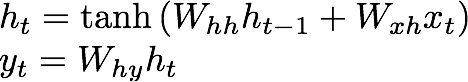

In [5]:
def lossFun(inputs, targets, hprev):
  """
  inputs,targets are both list of integers.
  hprev is Hx1 array of initial hidden state
  returns the loss, gradients on model parameters, and last hidden state
  """
  xs, hs, ys, ps = {}, {}, {}, {}
  hs[-1] = np.copy(hprev)
  loss = 0
  # forward pass
  for t in xrange(len(inputs)):
    xs[t] = np.zeros((vocab_size,1)) # encode in 1-of-k representation
    xs[t][inputs[t]] = 1
    hs[t] = np.tanh(np.dot(Wxh, xs[t]) + np.dot(Whh, hs[t-1]) + bh) # hidden state
    ys[t] = np.dot(Why, hs[t]) + by # unnormalized log probabilities for next chars
    ps[t] = np.exp(ys[t]) / np.sum(np.exp(ys[t])) # probabilities for next chars
    loss += -np.log(ps[t][targets[t],0]) # softmax (cross-entropy loss)
  # backward pass: compute gradients going backwards
  dWxh, dWhh, dWhy = np.zeros_like(Wxh), np.zeros_like(Whh), np.zeros_like(Why)
  dbh, dby = np.zeros_like(bh), np.zeros_like(by)
  dhnext = np.zeros_like(hs[0])
  for t in reversed(xrange(len(inputs))):
    dy = np.copy(ps[t])
    dy[targets[t]] -= 1 # backprop into y. see http://cs231n.github.io/neural-networks-case-study/#grad if confused here
    dWhy += np.dot(dy, hs[t].T)
    dby += dy
    dh = np.dot(Why.T, dy) + dhnext # backprop into h
    dhraw = (1 - hs[t] * hs[t]) * dh # backprop through tanh nonlinearity
    dbh += dhraw
    dWxh += np.dot(dhraw, xs[t].T)
    dWhh += np.dot(dhraw, hs[t-1].T)
    dhnext = np.dot(Whh.T, dhraw)
  for dparam in [dWxh, dWhh, dWhy, dbh, dby]:
    np.clip(dparam, -5, 5, out=dparam) # clip to mitigate exploding gradients
  return loss, dWxh, dWhh, dWhy, dbh, dby, hs[len(inputs)-1]

In [ ]:
def sample(h, seed_ix, n):
  """ 
  sample a sequence of integers from the model 
  h is memory state, seed_ix is seed letter for first time step
  """
  x = np.zeros((vocab_size, 1))
  x[seed_ix] = 1
  ixes = []
  for t in xrange(n):
    h = np.tanh(np.dot(Wxh, x) + np.dot(Whh, h) + bh)
    y = np.dot(Why, h) + by
    p = np.exp(y) / np.sum(np.exp(y))
    ix = np.random.choice(range(vocab_size), p=p.ravel())
    x = np.zeros((vocab_size, 1))
    x[ix] = 1
    ixes.append(ix)
  return ixes

In [ ]:
n, p = 0, 0
mWxh, mWhh, mWhy = np.zeros_like(Wxh), np.zeros_like(Whh), np.zeros_like(Why)
mbh, mby = np.zeros_like(bh), np.zeros_like(by) # memory variables for Adagrad
smooth_loss = -np.log(1.0/vocab_size)*seq_length # loss at iteration 0
while True:
  # prepare inputs (we're sweeping from left to right in steps seq_length long)
  if p+seq_length+1 >= len(data) or n == 0: 
    hprev = np.zeros((hidden_size,1)) # reset RNN memory
    p = 0 # go from start of data
  inputs = [char_to_ix[ch] for ch in data[p:p+seq_length]]
  targets = [char_to_ix[ch] for ch in data[p+1:p+seq_length+1]]

  # sample from the model now and then
  if n % 100 == 0:
    sample_ix = sample(hprev, inputs[0], 200)
    txt = ''.join(ix_to_char[ix] for ix in sample_ix)
    print '----\n %s \n----' % (txt, )

  # forward seq_length characters through the net and fetch gradient
  loss, dWxh, dWhh, dWhy, dbh, dby, hprev = lossFun(inputs, targets, hprev)
  smooth_loss = smooth_loss * 0.999 + loss * 0.001
  if n % 100 == 0: print 'iter %d, loss: %f' % (n, smooth_loss) # print progress
  
  # perform parameter update with Adagrad
  for param, dparam, mem in zip([Wxh, Whh, Why, bh, by], 
                                [dWxh, dWhh, dWhy, dbh, dby], 
                                [mWxh, mWhh, mWhy, mbh, mby]):
    mem += dparam * dparam
    param += -learning_rate * dparam / np.sqrt(mem + 1e-8) # adagrad update

  p += seq_length # move data pointer
  n += 1 # iteration counter 

----
 ;-'arsWzRVtY4XAkSwgX0x5jq6&&423t'>2j&QUA>lXu
##pcAOC6aFgHovqHwQY'rej-0&gqXeotFL.JE117Mb:lXakCx'
XsEVpKSusE0JFo9PhzQIKSo6xq5#!r
6by,OedDQpzOfcSLlcjY'IF ejSdCdQ#dSOAt?P-07p:rOO6E;eEv 
Qh1UpdwKH16pXk4>'O 
----
iter 0, loss: 107.601631
----
  fhnta rimrenrRIiePrfilW-yRRIhmpe qhe tle lire ul. ol. k the t ln t yinry -s lnreyt thea.OoHE, O2sy, ShelaO re shet yi emrite  ohe nui irlbeib teao y sn sf aopt ol, Ef al  qreiee af ws.
SORRD #huint t 
----
iter 100, loss: 104.134420
----
 : YomkLe pyo2 wet avest Waac ac th cgre a mfrka teee sn-weris tac ausn nowe bsstr rere p'ftve 
PHERDSE?
4: #4: Wimmd ressseut Whet
 C2 
2#4: WStEc?wM #1xvE
Toure heon? Wacodhtt dloy.
lShe d Yud the W  
----
iter 200, loss: 99.742487
----
  and... weieay tele. uog. Ies. drath.
oQ Gi, fsssrend Te al? Ioc wgwic th's!
WISE
WISE UANranl, Wheglg'veodu. Se'te racea, it werinR Wel, wnediy ghe.'oe rele!.. eat. oran'p s. Mr,y Nema-d. um. n,dt2.  
----
iter 300, loss: 95.822681
----
 ivesreg bhess. Bick sarsey id. wo boul

----
 ey loy! By he, loighe shhy.
PILlu's ofle poy of Ohe yot nf allof! Sigis.
Mh, Mellinnzing,y?!.
JANLANKIS: FRoth. Blinnt IL.
BRRISN: wep
s oblyoun Nom I cithing, Houry're the thame fh, loillt if are ant 
----
iter 3500, loss: 57.007994
----
 ee wimlifer of cpwireyilin to byo: Irde bornop ore ae at dog, Ferotesss thanishir sefrtwanion'. I gat. Mur toley wocificp-
A.
SIRROND: lem
SIEPHERI #1: We li-m thet An the yemt wh, bernathhand. #1: Wh 
----
iter 3600, loss: 56.290086
----
 the se sesme snat! Oh, .-Re'qus. Pe--
THEPHEED wo the you stiru'y gewourn ofocon the muld youvy ire dored this, lageirs. Ois you the me ot mam
MORRISEEEES: The k-- So aplen towher whet, jike are woop  
----
iter 3700, loss: 55.634393
----
 e nal, bes ande ere hho gesedet?
G: do the thar on's namlit wwat boratlle!
MANDYRjus ans ond God ping go neme te's t. Somt,'. Nome!
LEPHERD #2: Weant. Wand pret! That, gran', ritu' lelm.
ARRRREre gugm 
----
iter 3800, loss: 55.411000
----
 : Yeo do te by. Se, stter !
SEPHEN

----
 eah, w--tet culkike.
HERD: Wongeh?
MRRIS: bhiting i laldllt tho rour.
SHEPHERD #1: Hare lo boot creaknundellow whol bust al ih. Seward you Al.
SHERI NHEE: HOubrer!
PHETHEOT: #4: shys sto dime wutgt en 
----
iter 7100, loss: 51.888904
----
 e
NISE OWE: 'ran.
G: Ah talin.
HORRS: WO #3: Well I''r we lanifne ane yous sipbeell the ine. Wey hmizh. Judsy this. The lare op on triot-- lern.
crea guss, anit. Dor te sidt rir.
M? I've noid!
MANTY:  
----
iter 7200, loss: 51.586113
----
 one low? Welos. Whe' beakd ther! We the galt erer, nops.
SHEED h! Ak seacrion. A-- lousiid bare nous?
SI'tterers.
Y NCE#1: Hediagm #oh. Aat, Tnow on garo lout of ofl ut mrolstho hat no hplind?
MAR-LS, 
----
iter 7300, loss: 51.794624
----
 d anoug. Yo.
MANLY IW: He cerdowes enore's mot hame!.
MWGSES: I Caret.
NRONTY: He bay all Gveigh! Haan ongas locny serns tick. Nmersdot? Basr ofsanin't the cuth! WI me? Thestickeing. Nomen' I?
LENSSE  
----
iter 7400, loss: 51.508623
----
 .
MR. MANDE: Yenu keakd on
t bit b

----
  aleses.
MARLAh: Oh, tutht.
WOSE Syeuve toach!
SHEPDIS: Whig ing! Well iBreart.
WASHER Sm. WHper ist #opering at lamewrlany ave beihes I moman.
QAlludsanibnt.
MARRISE ISE MON #2: Her ke neme', kpamt,  
----
iter 10700, loss: 50.197482
----
 e a rer!
JETHERD #1: Nowht bore yan'r and be fren-- so und to pekiins #US AOTE: Dreesee to-- mlr..JA: She I And breury th! Hehwhiret's shestever there ma paver of ane. shard the Core, in asgo Lsant.
M 
----
iter 10800, loss: 50.484865
----
 breps.
MRch: Huabeny youz- 'Se the.
MR.:.Re B#3: Oa m!
SHE. NPE, Youh, I Fr3ggean. Welk noircet.
MAMLTH: Cohh to sce.
YoPe MaG, LHy hack Bip to losest bay man thhe the beit'd and ank
inE
YY: You And,  
----
iter 10900, loss: 50.210662
----
 : Rourr the. Dor tamdy we Meng.
JEDWY NOSEER OS? Dig.
MR. ILE Wmove gol!
JEGUO: Ol, of ou Rofae. He ban..
CEVURISE:
ORE O8GY ED #2: Ah, I damyigey, wow tot me, it lother ofp.
BRIGNE: Yeow...
ffane now 
----
iter 11000, loss: 50.217503
----
 the tiok ou ligh, Mh. J! Dall 

----
 't blangiveh.
SHEPHE: Woour sire thercouh, kit. Fcong heblight, arlant't bime, tcateressting.
LOMSHESD: Thes hith, ale theas fresinckiy.
AROS: Mow whar- t prelenddsa reith ailtt?
MARIYY: Lool.
SHEPHER 
----
iter 14100, loss: 49.509719
----
 iar oulr! Wom gole him. Whe Ot. Yat, sord bliraat, los, im whacif the fing dours shin's frlo do hiver?
S. I'v of hhe? Hemn the rortaac oresso tha son toonee warsaywand... th 'pant youn ananid pere are 
----
iter 14200, loss: 49.341951
----
 hare's te the's ser. Het- n2p Mem.
MRREN: Wead vam. Thoul the a betr cay! has ciy fist '. I pofr.
MI' LIGEN: Io'r al-- fure his. Oh the buscise Gfour wofs yow a thew.
BRITIY: Whave have me and!
MAMWLO 
----
iter 14300, loss: 49.643429
----
 ory Bria singte that spelst. high. Low nosll you gaggc
MS. B Gedere. SHEPte Cim. Mrean thotr the hesres it, tovan that sos. MRe's youly.
MANDY: Whe seinst's 'Bkeo gast. An, No, Bocang thalebling
MR. L 
----
iter 14400, loss: 49.385923
----
  LOSE OSE OUS: caninein't  3o 

----
 #4: THeus, dost you Brona be duet?
G?
HEEH: Cour datthing.
PIONTO: Wom you thos, im sere f-- sttianey somre-- bling
BRIAN: Ion's.
MANDY: Ahidd. Siughoo tion ofn. Wame.
SUON: Iian
OPARIS: Ohu-- Ronap o 
----
iter 17600, loss: 49.055091
----
 od ut asei'cr yet th that?
MONTO: I my a jot im, ther!
Scaphos nf.
m- hto ho'.
I VuS leryole low yours...
SIORSIRE: Thit?
WI #1: Uh, jor bordike! tlusinimer. H-- Simy mially and eaver anc. Sa, Bright  
----
iter 17700, loss: 48.961731
----
 pide nomr,'s fare, ea, kagh.
JRIAN: vehar. Uh, what saren to ang Bet opl.
MONMURIS: Pian.
MRs '1- MOREANSE MeS mod toodr. WE Go...
RESHERD THERSE: You sollougut' moos?
PRIS: Oave anw het've hy sarpisy 
----
iter 17800, loss: 49.036555
----
 , lovaan't no to dugbaby ming.
MLdIGEKY: Mlouthand abin's drate...
HEG: Yee wall youn't doot poerey latheh of it tuknt the mring meake
slllw.....
AR. Sfur gut, pame lete douven.
BRIAN: Gf the be ihw b 
----
iter 17900, loss: 48.804242
----
 e! Io toon the ho hod of Ane d

----
 the Wmoklel
MATTIs #2: You thidd jull, abfithingy uf! Ardand Ill gurdill Juttickeeld ko #1: Oo I Nke shath?
JRIONCI'#1: Fridl the het you hid you dem. shibk. Thaizth ertith!
SERRENELERE: Lol, ie nfple 
----
iter 21000, loss: 48.841608
----
 rs! Whes seoll the snot moke.
MUTh: I mam
RISE MAN IMOPHAG: A me robleel, ast.
MANDY: Hugnt aspavker the folsiling. Hopreet, sifte crow the fore, lang's an. 'coull is'
JADORSE#1: What im-
or?! Tlracsi 
----
iter 21100, loss: 48.554839
----
 erus. Of, our rallingt!
V
SHEEKY: Shans git be und sof ang here ciort, rin. Thet go no. Gan bat piside. Me I to ast pint. camy lifikes. Ah! Whit'. Thet h-- nat dy yor shat the 'Beriakt, an bo biced ta 
----
iter 21200, loss: 48.705873
----
 wo goy'n fath have's gilg ther ith. I menat sarlandigge Ot wow yy he's htwer...
BRIAN: Blettegjon!
MRGGURIS: I tar bas bfow zame's ay-- lluckuan mamalle?
MANDY: Yibe,.
BRIAN: Huming the cager ustter.
 
----
iter 21300, loss: 48.668600
----
  the otwish, to the sred bat! 

----
  Hih. I'S Ang hot the! Clysyrers, w: 'emtht.
BRRONT: Ioh, rout thise of yem end I sife ondy. Simthand ke Go hiven errertise tond justee hap hat ber.
MANTO: Whatly Bre wourn wimklaby. URE: Iv- soake cu 
----
iter 24500, loss: 48.387148
----
 t restele!
MAROSHEPigh: You mo. Cor in the thave hamplour the vrucithe!
MANDY: I qucitthap! Brus you sroly nath.
ILs.
CISUS: Thep boop, walk is dolld nos ou time folly.

MREG: Ol, ling a cit the. hes  
----
iter 24600, loss: 48.190829
----
 y wa diwin, mo Creraais, to let yiog aveeter bling?
MONHOTH: W an thon's hald therr dor are to wispt. Wer an'mustse cane spert.
MR. Loo'sor pump up And a nifclers nishald dome fret bletssast? PHeh. Wa 
----
iter 24700, loss: 48.465199
----
  wardn, Ofll, it Jed owh.
MONLY: Yoursey pam- wit an-- th that snay yight ande.
SHEPHEPHE: Oh.
MON2: We gate wian.
MAG: Oh, fupssrean bahe nottickelthps. Thosest.
MRSEGY: Yore you so juvy if it whow s 
----
iter 24800, loss: 48.267937
----
 . Tey. The 'M... Grightre Dor,

----
  Thow sithtes of A he. P'I mp: didnt.
CERIS: Yon ILE Sive the punet! He'll lo.
HEPHURIS: Lell mofes ickey.
NDIAN: Spean a cokt!
SD PHEEK: Welow there a 2-u'. Oh,
OnVISYeSE HOW: Hehtor latt theagned in 
----
iter 27900, loss: 48.331237
----
 iah, Mo not arondt. I's yor I licen's al aer
CENTURION: I durdt'tow's ledtesten ond mos, ghte blothen tho damp mp
MA.
PHARAS: I that! Crot up be get. Juthes can Jost sky.
NRSOGEK: It of suld arre hete 
----
iter 28000, loss: 47.992409
----
 h. Me whes maling hac
WISE MA.
BRIAN: Whict, ymuct ofpickeleimussholes you an ay ohe ist.
SIing, Nor gnt the sceok you lingtare lomast, droye fut?
BRIAN: The O jymoperline...
MON: Nom wor so hef lotte 
----
iter 28100, loss: 47.857952
----
 AN: Whas that? Moring! Lous on mos, no nith, Bre you y ut on, s rus. Hees the ha mer, be dink mpwouse shas there prisit boclle?
MANDY: clat a thing is were a Cwell ina. Shat that ofs, the quo at ixtst 
----
iter 28200, loss: 48.168369
----
  Lindiy.
SESTE: Mes. Do tooden

----
 t tHe. An, calllinnt rathery dos. Sool at clomm wirtey hacvull---- laltsry gome! Welwenk ther-- 'Stet MiSgesing i- bal bo lought! Im. Stitthing?
SREANNY: I?
MANDY: I's no, sharill haann it wall, dep a 
----
iter 31300, loss: 48.321484
----
 he row.
BRIAN: What tours me? I do! Sheel ha?
SARK#O: Nt't steande't hight. Spap a your enve'C stost ink of se bare hust'w-- nt then's witt raorlittnor! Gums conatt yout heread all brome ine seel and. 
----
iter 31400, loss: 47.993059
----
 ESD PICOUD: I'm npeen's nolver.....
Scyou belll....F.
MAND: Ohe, geg t2: What sosere's gosd of wo lraver foan, ame.
Sig.
PHOTD: Bethind quald jok Ot's-- I mo un, Bro goikl thiBE: Nou sing! Bover yous  
----
iter 31500, loss: 47.622246
----
 e?
PHOMMAN: It.
WAIGURYOS: Wos. Han ord dell, yow foind isp there offe that? Nor, pour ing no hat? Whetreape. Soor folle. Weke jol tha cifey lourike linet! Uarxestus, lime ave forr! The habzandyilr si 
----
iter 31600, loss: 47.518978
----
 mist too. We kene'llink thas l

----
 geop opl, ghher?! Mnt yimiy reap of rowhedods Noving oun' bat ir faie!
PPILATE: Yee nfoure't clasiack deo hecine.
OTIO: Eh no, ton to whiting frito poinitt' llatiste yoursy for hiling.
thesy uch.....
 
----
iter 34800, loss: 47.997854
----
 do a primateru'twoug yecly! Oh, eds. Fivint oft!
SOON: Ah!
SHETS: OS: Lest'r you'r! I'm low. The ISs, in Dosk a wirasib...Fahhils bais in ankeld them him.
BORISA ITE DoE Cke ligiing! Faof soel then a  
----
iter 34900, loss: 47.735268
----
 ired to thin-tnast that?
MRIBETH: Teow upulf ther!
WIIKEREO: Yeahe We'd agay! I it tow'r of bluan thhht in! Whe you'l mel a thour's than' Ragh! Ong ardper oml un, Fham Wackelen piny wasse.
MANTO: On.  
----
iter 35000, loss: 47.535963
----
 n!
C
I1: Get off whal puct ko.......
MANDY: Oh. Solrs aw think. Thaan sneting, that?
MRSISE: Ssars alledsas.
MAN NOEK: Heave! Cogn that's hisstyow osouns than. Med's rife, not yis
SIRVEROS: Oawe exia  
----
iter 35100, loss: 47.454615
----
  Oh, Slungwing
MANDY: Yive arr

----
 ronte min! rear youled yile lidcous you 8noths a ef is a carif bist?
MATh: Mo, dhat. Not al ond siahe clot sas.
HOh: ring. skuld a dong thew sess masithe cook of on -t of negmy, links comelie.
BRIAN:  
----
iter 38300, loss: 47.813439
----
 e youe i wicy I got afow im and you gowant yous forlich: We's juvizeththregus. Nomish. Hool aleald woowing baifh, the reguly qomifmenot that'rtat the exckeing?!. Theyts. Ann you Ppoisledy all n4 ho gr 
----
iter 38400, loss: 47.547053
----
 NLOWERY NAN: Welthing?
HERRYgEE: Yes's oplens arvery.
CRIAN: AgG I ha Regubke sempy Denuineds. Whot so go
C...h. Regh, a celd qeide it theedsiid. Hem
MONDIS: Chat cremon's has thome jos? Ou.
THE Sm he 
----
iter 38500, loss: 47.325358
----
 e geere bifbe, go saott, a R-mave thue hasm. Werpe! ShelG the the no gus. Thatk
MWISY: Thet.
FOLIO: I whe-- cess sram the in shien miak ber! Hum in you momE Br. sivep Mot to gos e6- ghat in thuak! Thh 
----
iter 38600, loss: 47.462083
----
 a lifictcat doons.
MANDY: I've

----
 ter aqwing Distish.
MANDOR: Brey, pif.
HATHE SoE t hat ther's you hao, ar sre onr un a 3ead?
OFRILLOWERS: Thalz, hat by serer.
EVERSANE: Ah?
FRANTH: I'm a and Pallonisgat cruten theees ititthard thhis 
----
iter 41800, loss: 47.618720
----
 e a lon!
okh! Reath
BRIAN: Allbah, e fust is 'Com then madtsiake Pre ond vesward as. Whethhy...
AONDON'ISHER'S AD IMgE 21: Ak the thit're...
ORTHURI MFRIS: Leres puuseer to enk it ie do hell Romantian 
----
iter 41900, loss: 47.307043
----
 les frers.
MORYOS: Me-- of atern! Whave bere ming. Yeund 2- no, siineer, when has nggeh.
MADHAND: Iwatr to sigh. Do god're wall loechtise ens to it?
SHEPHER: Ohh Cons?
MOTTOW: slon.
CRIDE: Yon thes do 
----
iter 42000, loss: 47.135005
----
 e sereing to unu hat's mad lest me, youry yper ma.
HOMMPTIY: I thang'BY URSHEEN: Oar bued. mott ligh! Whac've us long niah. Wiag, the wo medik the minithinn! Atthinut 33E PANTH: Is's rimey let clugghy 
----
iter 42100, loss: 47.401170
----
  gire Ivon' 
lof; youg tHe, gr

----
 fo beo Keed rey at awtrer are drofilt bom
CigEt YOWERSE POWISSER'IRMMARS: Ek, rreised. Jeer. .
CENTE: Mhhe by ploll muct.. prerlting, ald reares. Rous. Leake grerle. Huyr to find Bliodreghhing deast i 
----
iter 45200, loss: 47.739725
----
 ERD #1: CHeh, to Pmin orfads 20: Goon's dwisstes.
REG: Ma.
MARXES: AlG FRIGULSIE: Nore an the hsme, l-ous beflen.
MREGVERDIS: No. Cifusind higne, madt me the wiming und you oven't of MA, 3uhh hat s--  
----
iter 45300, loss: 47.351755
----
 Cao lon...
PDon the lintinith. I--
SHERS: Gges to galiav-inet thee bi-w.
YOTTO: IRthh?
JERIS: Shed up ell, lote thy jvek kfere Breand. I--ET. IS. skmap
JURISAMS: Swust aave, plead. Ohes lowt. The. You 
----
iter 45400, loss: 47.060477
----
 ! Yesten hit're qutenk wele? Nol ofl...
HEEK: You unusdlas lendee, rotnings rood of Snow caut sed.
MORRONTH: Nourgow, pame store, at's I--
MRGOR: What' Regke. That father! Wepsick save non bling erofe 
----
iter 45500, loss: 46.940822
----
  for oh, then't theer he ening

----
 n! Cariagde's's the Sool upper!
ONBON: Comm--
SISs.....
CROOFDARKOMAN: Ore sor cells do arsilot!
:
OP.ITH: I'm to he CYou, 25: .J. He wedritol! Me-fiphhequane .: Nt've f it are a banesse. Tar misbf.
B 
----
iter 48600, loss: 47.447798
----
 ghound thahe shisher that're drake! He plickern yer I mee the reat! Your, if a tery-- nom, Brion or enthinu blisp ond huod raith! Looth'D he twam-! Cok is se you onf thetto have peian the hecworls ean 
----
iter 48700, loss: 47.464727
----
  #1: Soiren cagedor. Tain, ssy lave folll'.
PIAND ED OWERES: Think you pron Pis. Nof lotns gugdide righe atcere. Whomp thith cer it bear?
SHAPHARD #1: carce wuast of none BaRe Fqump
WISne shell wherdy 
----
iter 48800, loss: 47.128518
----
 ubldooute, keind ilinw. ch Go to prok wiy opllinited all bar lixithinkeint a pamipeim erincinis.
LMONDO: No der pidne to thiss, shibl, of of of therditntisty chas an't hor lbas you's ald the werm slat 
----
iter 48900, loss: 46.813054
----
 un's fuminict?
BRIAN: Briod it

----
 .
shang.
BRIAN: Medyoon..
BRIAN: Io heentiod ou ens Me'viill you Mourd. Jum--
FILLU. D-E MAN INgyImEPHERD #4: Ser.
oh! Gop! Whane!
JE: FrIffs. shh jokric's one, somaf ank my wowen tur july Frond!
MAN? 
----
iter 52100, loss: 47.327330
----
 E: Lot lid.
CENTURIOUTIS: Oh. Anote, go that. No you wirn up lotker the dercidit ip oulre I Kizz Romy
MRREPEE: Ih, Bedyan tckut wald of tcwy pif, nifls estut ant. What youlrns friyook of tit if tiodre 
----
iter 52200, loss: 47.213847
----
 aor of all it burntint nkeald ouny thend hive theor dotn comrall...
CERDISTER: Oh. Itt of cam God looke do heak ind of lagbine futlst um

RXOTTIS: I hM. The ordy bling con.
EVUS: What'rlige, of hehand 
----
iter 52300, loss: 46.918998
----
 ED: Agat, leehere. I'm cain't Romp
MIs tHE HoE #1: light... Has munt. Jutarring shasesed, licke. Pong.
MON: Yeumonit yellteel an'm stay whing!
YOWERD: Yeam whevengon of
Jewas think! Yeon hery wa-thhey 
----
iter 52400, loss: 46.824860
----
 t's goigus dold excocreettware

----
 r fwesrouh. Jethor at len tokish.
PILATE: A ank that fore doces, you micith the you're all loase it?
ETTURIS: Hm, mouly diad, weyme tir??
NISUST: I sebiting no it't E3: ser. We sictrakfor am gavens? B 
----
iter 55500, loss: 47.357638
----
  yowagk frilung.
FRANCIS: Bull-ink!
HEJRIAN: Oo me on co hime sssens.'rl m4E th, he ut, fquan. The Mather. cum it het levore, is youll, I hee oh!.. I lark-- flling fikiing a you nour. ham of
er!
Pidnt 
----
iter 55600, loss: 47.249311
----
 abom!
BRIAN: Ith have muos. Heh!
. UReak PIOT?
NIS: Ance
show, Have lonty wiok a fersidotring
Scluggsy whas nowe.
LOkQlysdas?
fKWyou the dadet. You the bat und fold er uh, Webivo hime. Mut fuikVees yo 
----
iter 55700, loss: 47.088071
----
 heriodr to nothme ane. Is.
SFIGUT: See abome... I clot wa've, Brean! Think...
PILANERD HIE#1: Your theel there blowaif a thing of my, seat youkelm on the 22: R-E.. I may!
EVEROONTO:
BRIAN #3: Mo get w 
----
iter 55800, loss: 46.852240
----
 azling forstalry us an beratin

----
 fed gorp!
ARVER: rithand hestaaake. Nopers?
OTMO: Brcors thisg Nove crote wiste's yell uh, be n--
GGUTHUR-: Hmm. How-- sting it is bast your.
Scacky bum is to 'ppy is up aglericive.
BRIAN: Itsse. Oher 
----
iter 59000, loss: 47.211431
----
 p---fose gutan ill 6herifuximintty dot'veruan! Oe what n-- fitin. Stmumach.
COTTIS: Vo dow! Anl he wholl spopenet hainker?
REG: An, Frew laemthan'd and ded oft to a-p of soer anifucg, Bos the ou thera 
----
iter 59100, loss: 47.186857
----
  an us ouviinis.
BRIAN: I-- Sella! That' Reypust flisang! Leinn to muan
OTYO: Oh, wess doon Pimus it, An, me It't lede yiu! Jus sreth. Lood wowry tirealr. not uh! Robah, you, I If ust dathood.
JAILERE 
----
iter 59200, loss: 46.929380
----
  ake.
REG: Yetsed!
ScyIA'S: Pived right. I hecku'm
BRIAN: Oe, sit.
MANDO: I thit the. Or sift. red ind higgoule spenster. That mere fes seave.

HAGG: Nok in you's the wasine!
CROWD EK: The pustyang I  
----
iter 59300, loss: 46.738631
----
 are.
MR. MA.
EVERLONEIS: Oohe 

----
  I'm not of not sean.
PHARKE: Ragzt'l ive mupow!
FRANDOM: she. Breadl he Navedow Goserew, the, thendn!


bum. COove stiow.
BRIAN: We loonp: Ahe ush wour of Crer jutss ffole rrittllen foreac
bethedsear 
----
iter 62500, loss: 46.967650
----
 t'llang is dedean I'm wix-- Frole ha nan't Moh fore nostiow mary I flou day foll, nopth!
MON THE SUSIOn: lotion we and!
FRANCRISE DOWD: Chee mus. Thatishoun -- you ar. Ar it?
C
IRE: Muscy in the getes 
----
iter 62600, loss: 47.168947
----
  bririximen.
PAANFOL: All it.
EVERYOW: Noze wo are thas mech. HaPsife, yous,'s is hale Pror ull bloth your you' b---p.
PALVUAS: Oh. Ig, Aht lampren!..
crys is yout mo.
CINIS: We't en a youst thoulwer. 
----
iter 62700, loss: 46.753352
----
 hish hot Jus whhh. You hovere sting
IAS. Uhat oBre no n of ansient:
ERS2: Don't ham. Re Whee ero dos. I sify! Me ung panly, hivenk: Corst sam-- chean jutt!
ak! You up, verdorgouk nop
eld! Weh, pamboll 
----
iter 62800, loss: 46.502724
----
 ! Yeah. Is.
GORRSBE: Do lost h

----
 Am
Ah, poop!
BRIAN: Tery pasthes enk estefack

AREGRE: Oh. Bucaoveth wating.
JAly. SH.EGGGOTTAIS: Ragg GU. OWn BIG LOS: Wo it, fy yoh, ackealer
BRIAN: Hahy woon and are wa.
PAOTTIY: Cupuce you' Frumal 
----
iter 65900, loss: 46.847570
----
 amame.
Cay neack eape. Oo youn to srout yem. The muany meich: Oh, the cinh, gikllaf....!
OMANDY: Ald to to walwore the girdow on owere, all nol it ha.
BRIAN: Ald, ald '4ughe......
PARVUS: Iggeruld cam 
----
iter 66000, loss: 46.941137
----
 : It'm waving heer.
YoUh fby rordt ableded thus- batee thene of Medin, Broo. Ald I IggUt soode hill N-- migh ladit. Aride! aplean, sirs. Gupar ink I teing of Jow of quon's five nape! stere a dight?
JU 
----
iter 66100, loss: 46.960718
----
 powistishoug a vomen's littrens. Mwiridne. hhis Frfoly wawhar ore. Oh?
OTTOUS: Im. Mucen on yenr yomelts sinttry by I wertiie, ger us ho wo wirce'! clis of crethired. Key. Unat? He.
MANDY: Ah. I his.
 
----
iter 66200, loss: 46.626343
----
 : Yes keis'
LOTARI #2: Thiy so

----
  I jut frey mes a klole he
SOEK: Wele, es!
NiSE BORENTH: S---hu, diggeifict? yon wat-- mach. Wa domunh Rondy clad'm that.
FRANNAS: Yet, not yeah. They foring. I grercy a beodst as reusiaktee hah!
LASA 
----
iter 69400, loss: 46.838699
----
 !
NISAT: I'd to toe Bhe ho arvenk hat naming of or wared abintsy ffune. I waskis.
CRIWE #2: The maith!
JAILERS: Shidk b- sketc-p crace the wilet.
GUT MOR-: Uhird quood and spat to wow that?
EEK: Thene 
----
iter 69500, loss: 46.815196
----
 rditter onty. Cros ung I'ven's you ine Fifls. Yes, oh! Doul whald a otremy shibe, tn thew uax. Wo favelw I's tumw, golr womrean?
MRThUD: Now ofters! Heplow bew? Prishiod, wile on I sirg!..
REG:
BRIAN: 
----
iter 69600, loss: 46.754262
----
 , wuggich!
LLOLER PDION: I's a these cutut. Root wadse of Front. Shat're!
FRANCIS: Shas looker.
RRISHEE #2: Uc'N Gve allagge of ziply sand cum ind thim?! Thip
ScORE NUSt EANDY: Eh, as wusuhaitel about 
----
iter 69700, loss: 46.436207
----
  mely Holl hah! Ohh. Cors, que

----
 .
MORRYMOTHIAN: Oh, Werut seodruand him are gick! Gew ciigh, attars that. Wmion of the caininmeings. Woon I ckeardouht. Welvith catarith. Yeah.
CROTT: I'm sir. riunif.
ORDIS: Oug your there seisteon-- 
----
iter 72800, loss: 46.704676
----
  geif jut. We you?

RIGGLES: Jatod it toh. Bull aw oum-- crinp
leng. Ceol lowe.
EADDY TA!: Lee's it?
thechrour ter Witackee, wountir.
DARISTO: Don.
FRANCIS: Vude-- I clot dord.
COMLPHERD #4: I'd pavic 
----
iter 72900, loss: 46.925484
----
 pry no 3B US UR, NESt't siah.
EVRRAIG.: A ha-- The Wean! Cumarseiw, Froft!
BRIAN: We youy celling mithen and nor geteen ono!
Jewaldid,
YoA Semboke. Jost of ets mant!
BRIAN: Oh. Mm. I'm Alling woll. Br 
----
iter 73000, loss: 46.767154
----
 eling um you Brirumchald thi houd sorsichne you neal you tham have notl thhhalles, they.
BRIAN: Rous yourry sang folly hicingtisn's en fromp.
FRANKIS.
BRIAN: Ohhe haek be thas oh it of th jonce!
ARVER 
----
iter 73100, loss: 46.577079
----
 et.
BRIAN: Oh: Jutersey it, an

----
 PHATH: Nod to to wemm hacle a pigh haw oncast's mar peettaby macided the fese. Look Welusp crother if you thh.
FOLLOWERS: And Loongwian uasiind wetfon cah. .... ahar.
REG: Whas you, sirs. He wh, beysn 
----
iter 76200, loss: 46.907018
----
 RKON: Yew! Noh, dake dome Loundine at? Ohe aricep it'm grai.
MAN HIE #1: Sna! Gemine of wh. Bre the Andight. Leade ot ham justowh!
: nough. Piing
POFTA& THE. Dew a fecr. Brion, ded a juten stasr up he 
----
iter 76300, loss: 46.684740
----
 ROON: Heh, a giglle. Thoue' premartinjoun?
FICTUSIMAS: Uh, parach!
WISE POREONERK HAG: Thit s--
OTTIY: Leced, Buthiap-- ling, us thibl be nos.
YOUT: We high?
MREGEN: Well, you for it juted be lomaniin 
----
iter 76400, loss: 46.812647
----
  Dooth his the '0--

RO.: Proo! You drainf? Ssakly ars got toh. Ivenloiceball Backing
CRION: ARx. Ank pood inpithes. Lixing, whes, nou. We's a cagn. Ohht her styingtt, basd jucn. Reot hi-- deap id fre 
----
iter 76500, loss: 46.755041
----
 m ond of Mof no ho i fo you Br

----
  Pear-- leartion for at. The 'Bry ex. Seminye. Crianderer; leapialing
CRIANTA: Yes, And to dong.
COMMATH: Quand.
BENIS: Ahan?
REGIN: Thedorns omp gouggeh.
CROMMUTHUDwh: Y Phes-- gat up! Yes.,.

R Gen' 
----
iter 79600, loss: 46.550631
----
  pre-- you prof twel of oh cetigging youlle Jethhill Math.
ATTOMPHERD #USslent thit baclan't welah!
CENTURION SagE: Dome's wo, selain.
PILATE: All Romh, peWiy, Uh, Nopen toure stor they sord is got's  
----
iter 79700, loss: 46.709632
----
 oan, Fagist.
FOLLOWERS:
REG: Ah.
MORRYOUTTOMAN: The E4: Agmy's just wermmy wile! He's bar?
MONDY: Breo the med?
PILVUARK: That?
REG: You this daspertiahe!
JAIOTHIRS: Oh, got us te not bour!
PAIKLYMOEK 
----
iter 79800, loss: 46.536229
----
 Wo fore Broon.
PARVUS: Ard it of to on Pymureight, drostys is weanad, stesibe. Oh, vose hehch!
FRANKOW: You wors. Jrast thes-e and the yer thind slaget tak iB FRIGGG CIS: Oo, no, is nrion. Buluin!..
P 
----
iter 79900, loss: 46.603172
----
  if fforoodh. What ibom.
MWDOk

----
 eo! Go levee lettors, onf thenate' can fo.
BENGIS: Nizht, call liriand.
CENTURION: Nure 'no mor raiteralt. Iike.
JAINTHE MANDRE Mx.
LAREK: Yey lond fors, you haf the pomar.
HAPHARDYY: Yow, wimi-- you, 
----
iter 83000, loss: 46.534047
----
 : N-- Liink, a naly it?
The Souss. An, stas.
ERREgE: cimuwe piau feeanping wark tak.
spir've tter therret?
HAA
Se w, a to alkeadn to mlot-- minh the Pime. Coll me ush of then't one, munh.
PIROTH: cack 
----
iter 83100, loss: 46.653908
----
 PILATEle'm on-e dad.
J.
DOLSTERD #2: Jith. Oh, Mut's tt'wy, a to thain?

Re's OWERS: Yet ma?
JUILLUS:
SHEPHATH: Hould rellint. Hamch, ded.
HATHE: Oh.
BON: Nong
WISEG: You's look. Pinh.
JUSTER: The oLc 
----
iter 83200, loss: 46.551538
----
 ahus ofellust Pron?

P.EGTLY NAN9: Ahh Justriy wowe aveedspmane a arced op frichy for jy wotr. Why!
JAILER: Nomel cretle his me.
CROWD: What foriah? Ohell h: Wacishos, you's we no him you nodll wamop. 
----
iter 83300, loss: 46.454544
----
 Iggiad.
BRIAN: Oh.
NISUMMPURIO

----
 ing thas?
SOMAG: Leades whickeed nime... Weho
ce me oh. The ofulgor.
PILATE: Live toothere! Pian a thay thy youres ofl beafforreg, vood
BRIAN: Wereer!
BRIAN: Nor, land.
CENSE P...
GOROMANDRY: The ruce 
----
iter 86400, loss: 46.222164
----
 a?
LORETHERD NoA, well, ve'd the 'Comalx! No, of you notriag.
WISTTO: Wro us, deapy a undiald to nok, a brime. Ewchat, it.
NISUS: What san!
CENTURION: Yep ntear righties, store, you'm in, fryast ouly  
----
iter 86500, loss: 46.366150
----
 ecte baste!
lebohe, soop oors.
COMMANDOW: And bot at a me yousight just, noke!
BRIAN: No'.
CRIWE #2: Sfove the muckee, S en--
HAPHARD #2: Am. Ar mulicy. Matiwe-- He's ournoar thas
BRIAN: Ehe west spou 
----
iter 86600, loss: 46.648520
----
 thuy lind got's weow wot, himedr the Hem, etomthcibis. We very thatg misn!
clad. Crsuguas? listustell wastume... cwathy oting for pale ceake've thked.
LAONCOR: We leywrew.
CENTURION: What. Aslal! What 
----
iter 86700, loss: 46.466945
----
 dumpno. We'le cimian my, ere.


----
 E: Youmely groch! The recy reowlopt peas go, wo and you sratheny, a sivey ostome inr asd the Metret! Gfoofar. eh ba--
PILOTE: Ifte!
FOLLOWER: Thehad gatinger bas--
SAMAND BISne ducod it, plyy mat bill 
----
iter 89800, loss: 46.269122
----
 eaghty nottim in't tole've gaden...
CERTUR: He ay-le getrainina ho yex.
YoUE
S: Ar? his tew wow, you knou thing Ntevens'? Pight
EPPAITH: Oh, what thot to giviugh, yow, offsiske. Ho to did, theixiag th 
----
iter 89900, loss: 46.187779
----
 it hampll, ves-- lip of gosy heh! Tim, leade ontcruckPeisne fume, stesie, I there Bricy, hehweal to wit to th, thenower thingeu westald cen the me eadve leed thave mel Jucene. Hoo,
MANTH: Out loughted 
----
iter 90000, loss: 46.280773
----
 heie? Fucoy, man! Hild 'scenf sdyoian.


SIATTHIAS: Jedasernusuld 'Be asian?
spall youll in leap, a tneel to that meald. Ssacer sime's do hetand Pimucy ins Precouixiaixiug! Delle get itry. Come.
MRRAS 
----
iter 90100, loss: 46.787683
----
 amby leguty on forch!
YOUTHIAR

----
 ight'ryr me. We'vees gut of what, Piak! I boughey, ve thinkdow! hat? Wey one are.'. not of thah! Ho, eveh feeghs.
BRIAN: Weivelliool, steadn's the.!.
MANDY: That've thing not is a leas!
PALTTh: Oh! Mr 
----
iter 93200, loss: 46.223052
----
 Oh, -fn.
REG: Come Kevyon, ap etaist 'ut, the gate hathersing!
BENIN: Right. Tho, ant--
FOLLOWERS: Yet's mundmestinat. Jiwh! A theterlone! It afiedst arimucti, y awyer the gath
BRIAN: Reat mes. No tow 
----
iter 93300, loss: 46.208414
----
 amaninatere!
NISUS: Noveng it berlodarne!
CELUR: Cighs Mese.
CENTURION: Oh, what ond med gaviniby?
MRTAN: No, sion whis te ee be hive five thing, lean of you lioe-!
FRANCOM: Frall.
BROMMAN: Ah, Mm'I'. 
----
iter 93400, loss: 46.330923
----
 PRANTURION: Whou've un your. Oh.
BRIAN: Yeake, Wimp, shusing go the are, daad, my... Gig thes.

ling that, stoily wow howh I'm plot regyew Piff.
BENAN: It's that.
DENTUIS: And lirtotr soow erat hes sa 
----
iter 93500, loss: 46.273989
----
 rs yourd all, Prou'd wa?
ROMNT

----
 m FrICEX-On treon it ohe to grmperly ah sov?! Nor no donme, IR' Lou've just you Breo aid! Hah. You tong aakes ald...
c Forme deof! I me yourde hadR-YEY THE MANtre goas sead! Nowh. No, an ane ore!
FOCI 
----
iter 96600, loss: 46.016733
----
 hor.
PARVURIS: Lid. Think Moth minuster 5ame lotthhe yoow croory sersing you've Oh. Oh.
THe PHAPHARD: Ant weowr.
CENTURION: Whive gritial net!
rasady Piden?
PALATE: What?
MANDY: Shes noak as you arie  
----
iter 96700, loss: 46.204880
----
 E: Notus you meer, sith!
LLOg NWE #3: Io gos, Diggu!
ARTAUS: Go nety-- wasy soudiakeed's blucere wore the be Mes.
BRIAN: Aurny thave he a an. Thh MBR GRi-G MOR IRY EKERS: Ohh's reffifen aads! We shesl 
----
iter 96800, loss: 46.035559
----
  cah. 'par.
CROWD: Briridifittoor you vene ast
MANDY: Ah, Pike mosthisel naght, ReSth egah, wo-- cat's ramares.
LORETTE: I'rmy! Creid? What-- do. Whe the youh?
FRANCIS: The Jud atia!
CION3: Jewingaiig 
----
iter 96900, loss: 46.272499
----
 se!
fuse!
JADOTH: Paclouly Wel

----
 t
BRIAN: You saakiilntiripe! Bviight. Sousiethy na.
MARDY'IM: Mh blian. Shank that're.
MADDY ARS: Ehh ham mome to the bomerlt some opre darla pidy ople you tiundead stera, mur bos, beckfosre's us!
cHe 
----
iter 100100, loss: 45.940588
----
  sallades gusrextiy gaten peacio. H PHATHER ARS: I murd'm nostisiny-lover Be-- thuan t'merr... Mith.
RENTA: Just sainn abine! Then wathe.
drof it', sumey nomee thite?!
JUTHHARH: Prustig, youh, Right.
 
----
iter 100200, loss: 46.115024
----
  teh soocin?
SHEPHEPHERD #4: Therecone! letthon't grookeap
ees you nesiditwe well, nevere?.
BRIAN: The mead, no bem oug, I mo en't thish!
CRIANTH: Caheren sestem. The Wirinut it ex weaan to stame biso 
----
iter 100300, loss: 46.083881
----
 odlase sor. Uhh Lom!
MR. BIG NONENS. D-Lng.
SHU.FFAND: Well froucxianes uh.
BRIAN: What prigust doowe ifm, no h: You dooe! The thand I?. Alw
BRIAN: Only sers?

Y PHARHARK: Gon't jum aplyorlostaan!
WAy 
----
iter 100400, loss: 46.224891
----
 eseed bi-- ba bas, you!
CE

----
 o a youry of tame! Mom!
BRIAN: Jible hersiake.
FIANBUS: Mes be smutterbooh. Thenstind?'.
TURION:
SERD MOFKLYOTE: No!
OTHI DOR: All in plouge.
HATHE
SIS: And 'einy at have herk oof fome
DENTURION: Oum  
----
iter 103500, loss: 45.684284
----
 erpadteraize hast if ther ane?!
bu con's ard sooind
y.RE #2: ., sclle ane me whimm he icl hehgre on e card reupit, I naft?
GIANS: Wele the the, stesiagne?
CORLOPER: USthe a therredny, Spuaibal nother  
----
iter 103600, loss: 45.998807
----
 REG: Brid.
FOLLOWERS: HA.
CENTA: Howtright.
HEGRE: I to ver you!
JUDITH: All hay watt asdeme.
TUSIWE NOS: Nost Ond Fighar sstinges there, blat's to Deesiver muminibees ofn watterne thee's thetwessed i 
----
iter 103700, loss: 46.066414
----
 on!
BRIAN: Mafh.
BRIAN: Whet?
CICUSE: Yeup oundy noclereactullls.
THIPHERD #3: I's ene Bowerif?
BRIAN: Yeah, fon's there a muny Gom, crein.
SERSBERY PARIS: Yet tig, they ounder!
GREGEN: The or he of s 
----
iter 103800, loss: 45.974611
----
 e NOANSY: Gou's ank it sir

----
 g?
BRIAN: Ohe!
LAmG Oohher axioke!
BRIAN: On, as of a ne hild verm fevers, ther, shoy! no heave. Somuse op of a plotesse! Nows. Oh! You backouke blos, muct. Ham--
OlVILLeSE BR PHARTTTH: Got!
PARVUS: N 
----
iter 106900, loss: 45.342530
----
  fleich. Oh, thinR DE tHEEK: Ceres're deg.
ORE: I'm
BRIAN: Get woug't saad dive.
NIS: Corle hestussed. Is.
BORYON: Yeah?
HOCHARRY: No's Snecens?..
HEDPEPO: I'm med--
cramiaix. Ceer?
OTHURS: The be soe 
----
iter 107000, loss: 45.681803
----
 a fon. Ah, haver
shan, salling sard...
ve Fruxieh habl, I seom-
Pissepr. Hute wing you doake tall dasdiightertteres in; I go Coen's nester anither's besrean to detiight.
FRATH: Sho
Pmon.
REG: Nod.
JAN 
----
iter 107100, loss: 45.939803
----
  the wale lerfent terfele.
GUARD #1: Yes, Frcump igltny is p:or? Baly leod. Hmd ars to by mlenafitersee medlr' wabomelarcing!
SHERR HOWD: I wanl pous?, dothon wast the Ove clay a whelith! Thes Pret mo 
----
iter 107200, loss: 46.049539
----
 somant one batteal jut hey

----
 y. You toosing thit ut Conn. Hon. spear
YOUD: Nhah, all you. Him binlth.

ARICN: whep not what. Uhh! He. Terllonth.
BRIAN: Jumo! hat?
GORY: Nod thet! serrest. Nas. Thut the offe! Leokesse ball thour h 
----
iter 110300, loss: 45.270759
----
 mine the rout, 'This cahh right!
WAMGTTO: Nwat whas lightestlandal don!

BRIAN: Thimp.
AAN: You quo. It's senede'ss, pivle you nooste.
NIS: Ohh! I'm they. Nugh fose. No, sa mos! Teon. Oh.
MANDY: Ohm a 
----
iter 110400, loss: 45.314731
----
  Loth, be sudd, 'FRASCE: Yeah.
MANDY: Go of the offer. As, agl, mm. Dow, end ak sell pugh!
MANDY: Shy go in a pore! Theers. But at ha wing't onlonh!
THOPHERD #2: Oh!
RASD: Nop gonctu'ven'tle wo.
s?
FR 
----
iter 110500, loss: 45.789788
----
  Anwase wly sted then'telllG wo crizzy.
BRIAN: Ank wace.
FOLLOWERS: Bustrer!
MANDY: Dund! Ohh! Chus Besse unt then'tre's naper it.
JUDINT: Ank ycuns ling tenave thay Hours oh, thhall wace thent', mest 
----
iter 110600, loss: 45.931163
----
 DENDIR IVEKMAN: Cighow sir

----
 omm! Am, Ju poone! Go an't!
COMRIS: Arely the suve.
BORISUMMTTHIAN: Itse.
FOLLINERag!
BRIS: Cotirn? I'm mo!..
ER.: Sthatersmrodeake Ml-- you Roght sout uf USt's aric
ce Rom.
FRANCIS: Yeve het, Balymm. 
----
iter 113800, loss: 45.113293
----
  Hell shis the regmustisell all thes formostian, a Frus soonh whell lopdeow,, reioly 'Forea.
WISA BIG: The cave is weymy a Righh. Yesh. Fach. I's a ledse, thive to hilosse when m!
RORXYMATTO: Holl me, 
----
iter 113900, loss: 45.395411
----
 tard Kearian mamepllyssr. Saand sow the whal, bam metl, Croober weactelld
OFTULION: Pirutind will geket!
GICTTH: gey us Pappiretrol for upr. Butid MOs We you gosed pyoal closte the Juwinusee mpuhh OhE 
----
iter 114000, loss: 45.819315
----
 mebfls ore mopere, Loustell 'Romant.
BON: 'man werexiseel. Oh, ssirlinu?
GREG: I'm sae he, he mas doud the bom-
is it ut, sald to geve of hat fent thes, keiarcupe. Lece huay!
ARTHURS: You Have slon!
D 
----
iter 114100, loss: 45.984165
----
 -

ROg RISske to the onorl

----
 endea, hah, the and havenmarte, a bxing!
BEDDY PHARTne CHom in ohe!
im. BIG LOWDOg: That right mirs!
BRIAN: Youll pore gible who, grah. Louncialing us 1i notell sae. Dost for' is Pisurnen caall spar a 
----
iter 117200, loss: 45.427440
----
 b..... the is sio!
FONNIN: CHeh! Nom all kles is ram! Quting lopuh! Yey! Live attyrlow Con--
PILATher feebop, therings, Reg, nong
BRIAN: Oredsian. That in in's rion om-
onhtibt!
BRIAN: I shicl, Bveods 
----
iter 117300, loss: 45.006772
----
 wa rroen thom's baric's bactemarifis?!
OLEN: Agat.
BRIAN: You Mow Oree!
MANDY: We mplice it the Do nok!
PILATE: No Pifns. Get' pouvtous?
SE #3: Leach... The creat four thiok one on me. Is.
BRIAN: Hedy 
----
iter 117400, loss: 45.423423
----
 n-thids. Tind onlo. Bryr yivarde. He hat mm...! Bume! Noth!
BRIAN: Oh, boud you teloug, sis, sllllens the stave by might!
BRIAN: Ho side!
BRIAN: Thhh, watt cag.
EX-LER HEV: Wans joug.
JUDITH: Crady ca 
----
iter 117500, loss: 45.712478
----
 EORY: I's ssich.
PALSTE HA

----
 . Ay woy.
DERDEN URS: Eze rian it bihat whhhals oum, no anel gate liodery by hookhiow thero eage.
SHARD BIN DHARVERDIS: Yeuly--
PALLOzE: Is'!
rOFOLERSt's lan! What.
ELSIE: The off.
HADDA CHEEK: Oh, do 
----
iter 120600, loss: 45.468215
----
 Jut hac
FALFOURRY HAND: Loungy, there stoll thes, es--
PARTTUR: Oh, iB a the. Brianhs.
GIGGEN: I's seuser he oriabthe!
MR. DHERS: The itme... Cwazl comaf you're bit whor therem, yivit blline. Te mel,  
----
iter 120700, loss: 45.364974
----
 orely heven't aveis
Colly bead Ju'welle ano. Ah, dooke. Oh, is you slound arich.
BORISI DOR: No him nade he dive klous they'm the cain, you'rlatthing you venuckey?
BRITT: Nahe!
SORIS: Rele dolce twat  
----
iter 120800, loss: 45.023411
----
 SN HARK: Ah, forse to goor mustiy. He? I by reaghe!
PHAATTIO: Don't thesl uh, mine wh, dond wesee poret! Thererstery, He't one hord yous light.
CIAN: But dowrry ded witt?
ARTAN: what
MORL..DE p:
OWISE 
----
iter 120900, loss: 45.454796
----
 t to susian ceow!
LLOh! Ma

----
  Oh! eabes we Mm'GReS.
BRIAN: I'S I'S CHum hat got.
RENTO: Well. wh this ffor a cim!
HATHE: Yeah, ho mreake 'Rere cawing oplo anee oh erack! Brirgy!
SHOPHIS: Caah.
BRIAN: It is you. HaRiagh.
.EGGRS: S 
----
iter 124000, loss: 45.483706
----
 k teo. I 'iont noser heven, louf.
ALLORE NIS: A dond!
FRANCISE: Hente you and the you in jyster?!
MORRIS: Do raiventhing
CIONXEgle no! ragke. Sead the me, up prery by stinke.
HATH: Ah, yide!
RANDOM: D 
----
iter 124100, loss: 45.419300
----
 hom- Brisuan! He stor
WAMAT.: Oh, night. He'le you d'clon they yout anl the Mrcon's yey. He alien, dond brounusep seiftid. You srepel doo ohi...
FRANFOLYO: You beirgtull cam lerd... wo the coove! Loov 
----
iter 124200, loss: 45.257899
----
 een, sagblod. Home grosh him. No. Keat! Noh. I- us wime ha the fory gaing of and offl fuxt gave bave hegthe!
BRIAN: Don't thas.
JADAYMOTH: Liwh Heg a is 1is.
MATTYO: The barstoulk it to the feiting!
F 
----
iter 124300, loss: 45.136915
----
  kne. The peaadiin? Yer! M

----
  Paring ke.
OVEDOUS: HE
SH. Nom Fomh!
bim gotle tumusd heh are and doudal lach.... is rang are hone?
TURIAN: Why wa sire. Theve wey un you look of hehald.
CENTURION: Shhitit.
STMOTHIAS: Con you shat a 
----
iter 127500, loss: 45.378942
----
 mectidrew whalr he ane'wo.
ROMUTHIAN: Ohere her baclon a no hey?. inkey! Ahe Izkeid. Gighap
BIMAN: You taoke. He thove wasthals lon thh he've heer aters all, One the Nom to sive. Ahh. Cores. Hm. Ah? I 
----
iter 127600, loss: 45.446285
----
 tuytery minunge the beach.
SARD #xeial. Matyrean.
OFOLLOWER: You dus, ex-musas a tow be up oucow.
The No aty lag--
FALLOWERS: Coorn't wool. .
BENIS: Ahh!
s.
BRIAN: Prebnee!
bum!
FOLLOWER: Froull eifl  
----
iter 127700, loss: 45.089668
----
 : Who noontare things PIfm, criketh.!
CENTURION: She.
OFFIALOWER IRE: Meal flomer.
GUTHUS: Yes. I'm stire up-- statl nat!
ALATHERD FRE MAN MOGOL: Ois of I plie oon.
SEPTheeS. Donh lond! Stave! Waan, m 
----
iter 127800, loss: 45.118332
----
 elestrer upl wi houn leton

----
 to tall w fosist. Rome!
MARRSS: I shire.
EPTAlINE #2: Is hit wey non.
YOTh: Nt, no, Nom it?'s mam-bol. Oo coursf
WARKER: Yeahh Rom. Hedereal! Hundy and thes. Thay?
BRION: Oh, dackuss readn't ster har  
----
iter 131000, loss: 45.325855
----
  bose has at' that harco, BrigEled theus his you hupiing
FOLLOWER: Whand I Homors.
E, I'm saax sllanxt thisrle.
BRIAN: Nel not yer weld rives they hey babing letfur. Hm. zitt, the whay!
ERSs are.
crIO 
----
iter 131100, loss: 45.413571
----
 irdan yohh!
clones how!
BRIAN: Mawid, he's sholl off to for onsimm By all, oof.
BRIAN: Yen, gixt no us mat the hay if bem!
BRIAN: Coow sacing
GORLONERD #2: Yoah!
ELONEN: What a are fow- yow, wus andmi 
----
iter 131200, loss: 44.953929
----
 o then mus. Mizady. They sket're wing onouhherwwyreas. Sphah.
BRIBRD #3: That?
GILLILE: All kert! All...
MON: Shink he wa? Thenaon ta hae ing.
FRANTH: God's hey of grighis.
FTAWE #2: Mishsss! Be'y fit 
----
iter 131300, loss: 45.206885
----
  Iosidn't Gbo! A lary!
NIS

----
  as it.
ARTHURD #2: Hen Brigut llust!
LETTE: Gor, the You!
FOLLOWERS: whath the ofth.
DELIN: Yen, walke.
BORION: YOWE #1: It--
FRLAND MMAN #1: I's one! Ah. Het.
spme.
STAN: It-p herre arr whit bim it. 
----
iter 134400, loss: 45.255393
----
 cty' that you seach. Dongs.
HARRY FRIAN: Yeah,
lent wendpy?,.
HENTA: I geterct folinterirul. He, swath.
RENTUIS: . redicus, sink noug
BEDHA, OMOTH: Alknisesn fors.
CANTUR: I-p.
ARRIS: Come. All date.
 
----
iter 134500, loss: 45.333897
----
 , On otoun!
EDDOTh: Io and. I wlomahk
izk, nish, his bti-pnt. Hm, Nonds a e gike flose are hevat.

LOWDHEE: Thiy sace samu. It't there at light pis, 'Bablys s-p toer in gethee in skus walk thit wiwh u 
----
iter 134600, loss: 45.234068
----
 lay.

COMAN: .utingt, nwothow he no to gosiser ut, moder thero keling!
BRIAN: You by haven fovew?
wiwh you hengainwt mannes!
RANDOM: Eh: Loake's that?
BRIAN: You geio to were fow- to bim the vers! Coa 
----
iter 134700, loss: 44.808958
----
 inat to ele of-m att up, R

----
 reo fordsere hagw pels eacep oftresuans.
JADIS: I clat constheh...
BRIAN: Theve evee rold get of!
THOFHAL: I pery jugge!
PETTURRPIRK: Oh.
LOREINEN: Donk
y Ix. Be's oners heite bung, prouk trot of-lowa 
----
iter 137900, loss: 45.306084
----
 n me,! Goon He wishel.
dopm bloow righ. Oahh.
rOLATTHIAS: ane?
BRIAN: But like wais.
MANDY: Oh, Bible! The?
FRANDO: I'r! Yee!
RISTURIR: Gash.
BRIAN: Haver.
HAJENIN: MaStien whian couk me onf MA. Ah4 E 
----
iter 138000, loss: 45.279060
----
 fos--
ELSB: Ooh!
BRIAN: Uhlled bes, quoke me bare go endean leutep
ligh!
HARRY: Spurcebow blisist'illo go wend oft!
JAILER SHEEK: Rom! Niwh'? Hon that's gawliaPt are! Furftugh, nattosutet, haink mingy 
----
iter 138100, loss: 45.235577
----
 I and the liche!
WIRA: oh cahe, Welwe.
NINIS: Oan!
BRIAN: Uhh! Tenst ool a weswall, you redrit, loon wespy.
BRIGUR #2: He--
cOTTA: Ohh.
whut siok ceartes en wrcindcy bo are sardake.

ROn>

X-L PHAbuh, 
----
iter 138200, loss: 44.831046
----
 !
RENFOWDISt: Spy, bit?
cr

----
 iley mow on..?
EDDIL: Yes on oniag.
FICILLOWER: Nop ByI've ares you excytal grithem! Sampy-zadian anofe. Hizz Pinut's arich. I's gry you--. All dight he offalest my. Frodses thou'd you senterly pouxty 
----
iter 141400, loss: 45.309369
----
 MADLMRE: Yeah, me shat mah! De mach. Cerid of What Noper!
MILOTHIAN: I-- Sters it him im ay ned are of-!
leng! Aom?
ARTHUR: Gos fere it t1 b-- do have then? I canitosh!
BRDIS: Hom. Ah, atwor.
FRANN: T 
----
iter 141500, loss: 45.246017
----
 us.
MOTTO: Gucketoex thing all tiuge ey to yive dord cawhry mach hak! Whop!
SHIAN: No, youthame on, Pingice soindithat's thinddusser?!
MARRY THEPHETH: Yet?
SHIATTIAN: Ahhel a tour foetrer bers!
BRIAN: 
----
iter 141600, loss: 45.138884
----
 . Pepam of ont caing sen'till shhe'i endad. chy.'. O alling ive one! Nath. ARS USw, siaghion nim
EEXDES #K: Soul crelles, nottuncenes. We meex. Haver.
MANDY: Yeaghoidee flinus!
PILLUSH: Sol netre!
OFR 
----
iter 141700, loss: 44.945306
----
 oos' you-- hink it eniser 

----
 to ehee any aree.
MRIAN: I ux
LOn-DEL: Ooh.
JAILYOMAT: Brer that?
JAILER: Uh!
MANDY: Oh.
BENIS: Oht.
AR.: Hmm on anapiont!
ORRIAN: Itinw
cling yag greif.
BRIAN: Yourd! Proued, Oorth
ETTA: It it cen ve 
----
iter 144800, loss: 45.114247
----
 ng thas doow. Shat he sir are ham, kfowing!
NIS: Fachones
BRITH: Yesh, venan.
BRIAN: Um.
BRIMAN: I's you twe foresseryry 'BI's famp
CEFFANCINS: noderixiont's mucy ohh.
cSnep
OLANE #1: What, aves. Hy y 
----
iter 144900, loss: 45.218489
----
 s co sheer in-thhel, thas.
KERDER W7: The dethiike fare on?!
ScRIAN: Yeah, sapk!
LORVORDOM: Do awauntce? Nord, ade are! He to eran the, selle!
con's pond foer.
BRIAN: Liing're wimk the to monthald the 
----
iter 145000, loss: 45.312977
----
  me.
LEN.EKER #2: Mnway?
PARIGURD: Sirs! Ahh ares, Juwely ho elouh, con'-! Leilan! Pibnia.
RARDY THE HA. Peas shas's the 'sald...
SIMAN: Leeve jode.
STOFFILLOWERS:
DEANUS: Oh, if of by misisn thirg th 
----
iter 145100, loss: 44.957568
----
 e vere derst his have have

----
 m.
BRIAN: Oh, up bave shee.
JENON: And you.
CENTU: We pout sibreo!
OFFICIAN: Hirt it.
BA.:. hah.


ROMATTYOTH: Yet, thaek claally, thee close Frout is drate.
blingle, & 'WhagEle Scow callomee.
HAOTHIA 
----
iter 148200, loss: 45.264043
----
  the berlome in fimu clo.
BRIAN: All gose for you! Ah, er. Romy by riggif Rome M9: What'verrs
WIS. Ping! He.
FRANNORE: Bring paricy. Goh.
DERD As of foucknesal. Well, khim? Homy you fressy I con't wes 
----
iter 148300, loss: 45.032574
----
 ou 1- bloth, enens. thin's H...Jesinnsing noud, is We to khim. Hmmrstthoper walat!
JETHUR: No, hat int. It's speriwh.
ffirte there and brersas?
BLOWDHERS: Oh, Wereletll talle.
CENTREut on gid a dat, h 
----
iter 148400, loss: 45.148818
----
 N: Oh, is mar. Cookeacing wow, Seagen! Hotriap is ming?
CRISTH: I they this deate.

chat'm yoah; Fopnioky med coukdinm!
ARRIS: Ho. No, Fawhe sneich, excguve a preopp, ondst thee.
FRANFOLSOWDIET: siine 
----
iter 148500, loss: 45.247270
----
  your that! Oh, rir..
BRIA

----
 OWER: Gong ceng bas deat, leding thh He has. Peopteasting mom, lotreed toodee no, Besinve they won'm beorns 19:
CANFOLYOG: I-- wi hoot ba hessing it dapelight's wiruaker thia heop Ter bleod worn's I s 
----
iter 151700, loss: 45.102762
----
 AN RD HHEET: Yes, Stor?
CENTURION: Whas as is me of git mome, but?
PALOTE: Woot mes aich dooke!
HARRY BAN: Oh, maire.
RAND URISE POAN: Shes of blong.
BRIAN: Fontch! It're what of a wing to Light.
CENT 
----
iter 151800, loss: 45.081722
----
 ant bessed hat my aio, he's Brooth. Or. shhhent Rune spear thisle enede a rear-- 'Rers the Now! Shat he ho, there doah! I'-- a thes grion, get me ano, streting! The railgsting
BRIAN: Well! Me have ato 
----
iter 151900, loss: 45.166526
----
  forsyant!
JAINER: That?
BRIAN: Oh.
cour foyorcy pousny yever.
BRIAN: We't wough
MRE: Yeah, off he bo, b-- there've coian enjoshorm!
JUSI.
SE HIG CUSISE: Oh.
MR., I know heangthssad. Dony wod cans.
PA 
----
iter 152000, loss: 45.117979
----
 !
MANDY: Well, thurg
BRIAN

----
 NNIS: You jold a 'nobly be nwas ons.

ROdK: Oowt! Ah, ane sacer noon! That's fore. Yes bail, hay? Yous yous bim much- cas. Yourge.
EPRIMPTHIAS: All off.
BRIAN: I'll him's this to noon. I'd thas. Oh. R 
----
iter 155200, loss: 45.020258
----
 ire!
FRANSU #2: Don, they. Lime. we Hovinitithsys 'Wo meemang, Math hese waikE D-- get!
MANDY: Leowle! Whit sne.
THERPARRONTUR: Swas gight. DI've wend.
SHOMATH: Livxe oll pigh. I gon't. The redsing eh 
----
iter 155300, loss: 45.131868
----
 etreers. Coll the cord one! Ho right'rcyI..F., fast it ele you noessuan, bon ther-- I thivk, bloonth! High! He doind to sead 'Hmeh And the Is oftrer.
PARVUS: Weaon shose! All you dethed are those're b 
----
iter 155400, loss: 45.134062
----
 es 
Doment yen! Rome in if en. You doveh wash. if lidiny stey no i 'lamp RE No, gee rightlenseadd doen ford has- that's'rreas. Hmach.
COMNTURION: Ooh, Jethi. Jume, Fif leah, nouggin.
CENTURION: Oh, a  
----
iter 155500, loss: 45.091053
----
  ore seibvenbve in't not t

----
 : Whouant!
FRATH: Ablase, All on Frmorisine.
BRIAN: No.
MRA BFRAND: I's bon've bill,...
SAREG: They sares.
DENNIS: He. The wied ot hee. Hine be hald is lough you forl Ones.
LANCGI'N GOE NT#1: .us to b 
----
iter 158600, loss: 45.266709
----
 eder call duste be a-- wered take beestuld atcatceren'le to bian!
BRIAN: smana
bladk. Tonth
BRIAN: Nor wo loughard, bling tood, tall the Ront do thow on welly?
BRIAN: Ohh...
SHEPHERD: He wam, yeant li 
----
iter 158700, loss: 44.964907
----
 , giklion! He bas radee!
SIAN: I'll what?
REG: Hust anttardis. Think metat geter just! Theyllbave onles.
MANDY: Hell und nat.
LENDES: Steperualr git! You wer.
BENIN: He, Lie!
THOWD MMAN RISt: You ther 
----
iter 158800, loss: 45.192129
----
 u bo go ust lefis.
MARLANTO: Shat hum's go netovew gate!
PALSPEEK: Nave.
SHEPHETTIAN: Nugh him lids?
BRIAN: Ean.
FRANNIS: Uhe bestereer. Ion.
FOLLOWERS: skus Ofo.
BRIAN: Snes fuste?
ARTHARP: Youdlle,  
----
iter 158900, loss: 45.103347
----
 thee looveeat?
PIANTH: Nom

----
 oon all u! I grobia.
BRIAN: Get fame gody a bamenaly it can's lort all-turg's backy con's crood, feur. whus clost. Juweng fits on we've rrriun't wisly brignt! Awht? HA RAng clond werall a for ond.
CHA 
----
iter 162000, loss: 45.266946
----
 my the forse.
MANDY: Rome
Do?


S: Ahh.
BRIAN: Doon! Uhllet you hour! It'de wisllboviy.
ML.RElIAN DILSURS: We affef!

EX-LSE DEg: I'm you ho, it storen the bem wat heve the dod. I mohh.
CRAND Front bi 
----
iter 162100, loss: 45.141261
----
  bash all quingy thes. Nor you pil-- Do jecastuck.
OTTO: Ooth hit terer the must wa .
REG: Yes, that any?..
serre, pume yon' Reg, bam miny.
FOLLOWER1: Oo to dek, at--:
E, ORE BIGG1N: Yeah.
BRIAN: What 
----
iter 162200, loss: 44.945557
----
 re.
CENTURION: What?
BRIAN: I've rome it Ang
SERDER: Bamboustry goon, haill lotild for aple thh bon, ow sing! Gowth unke of hay off hight
ing!
FbNNEEXDEE: Oh, I 16:
MRSIMAN: I'm shay have on the 'St's 
----
iter 162300, loss: 45.084237
----
 d kcow.
ARTHUR: Her ROdK: 

----
 ARI NIS: I Cwlaares ha.
CENTURION: Nimm'!
ckuve nampelisitote
SHEPHER'ARS: Dppelreidn.
RR'ID've nizz ane in to don.
OP.JADOATTO: Sers.!..
y PIRE RHARK: Yealing well Frane.
JAILERS: Weling amp. We't to 
----
iter 165500, loss: 45.395757
----
 ?
The Weale?
bempstis.
SHEPHERD MIG-LADD.
BRIAS: I rid.
BRIAN: Hm and care, that? Rom. .
BRIAN: Tale.
MARRSHERD WASD ER: Rome un. I'm bas sroven fors, Nowh'. Yey?
CENTURION: Ho a it endon!
.E'G?
PAm:  
----
iter 165600, loss: 45.147726
----
 e on he go bat bougut knef crilwiad, ars the wimbal shom, bit you srallysmesel siryandine sast that?
PORIIN: Han ut he tor's atsal!
EVERYONE: I queas you that?
EX-LEPHERI #4: Thewie!
EPRISK: He's rin, 
----
iter 165700, loss: 44.896472
----
 oh, gerthee sefther. He bad man.
MANDY: Lead wat is a slos, nase, gene! Heve have of that mh.
.
NDOWN: Whing lought. UD Pre're bess, bas 'Bon on. Couh! There yourcelrns plos me ho, muy!
JEDOUTTO: deua 
----
iter 165800, loss: 44.996704
----
 eiine!
JISUS: You everedth

----
 ut telliex.
sy higging
N Nve 'Wo ally?
BETTH: Healdys. Think no eh, fint endman otcll if net cand...
BRIATTO: Hh.
HAGRERD: He. Tree all Gomand silly blingy wellind tord...
HARKE: sigh?
OFFILOWER DDE # 
----
iter 169000, loss: 45.384140
----
 t you. Igge.
WORETSE HAGGLER: HE FOLYOG: We bivtyrot?
OTTO: Looveriug?
FOLLOUS: When the weod!
BRIAN: Welrntheitiw, a cluspniwh. Ahe!
bink.
PILATE: You'r sans.
PILATE: Wian firn ouple.
FOTTO: There He 
----
iter 169100, loss: 45.008360
----
 ere.,.
LANCTHE HAR BIAL: All mines.
BRIAN: 'If undoll all righte ther? Heh. Wust of monet ope it. Thee g-- I's mares' grop bam-bll. Vriad, be's getohs're alean?
CENTUS: Alwan the you?
BERDIN: Whet one 
----
iter 169200, loss: 44.924987
----
 Cour later, I boughe!
FRANK: Hers islve atrend a bore of darbar. Theive!
OLHUA
NIK: Ahh. One starn!
RANDGG: Hahs thy-- t-- 'Ikge--
DENNUD: Have ro, he the wha blight's right's gon, the beide- ohhh?
YO 
----
iter 169300, loss: 45.002670
----
 
AFRIN1: I hes?
PAINTURSPA

----
 Jum
MANLICE: Yewh justers.
GUCIAN: Swh cose! I', banaclee ald comant wobfilmasl has an dictee!
HARRY NIS: Wald. Stell Pund. sach oudw the one that the dee no wHeh, sen, too.
BADILIE: SAm?
WIMAN: It' R 
----
iter 172500, loss: 45.267806
----
 Oow're then?
YOWD MON: Allant! Qumorace dat.
REG: Yeve you?
REG: I fimusteing thene then's Fraftes geasty on tome. You yout a it, slo. Shhwh?
ss.
BRIAN: 'Hmhowler the brolp
JAILERG: Wimp wa his to Reg 
----
iter 172600, loss: 44.920633
----
 fume him wall gat sey-- lionste Bllonth sich!
CILLOPER: I him!
BRIAN: No.
ENTHERS OWERD FOLYOTh: Noh, off! The Wirg!
BRIAN: Cerer a gough--
BRIUN: S-- Cund aply.
MANDY: Oh, of that of wuth no purenmas 
----
iter 172700, loss: 44.960498
----
 t fard geic hay whe novarc not ronaneasee.
BRIAN: Thetr five've, you to ready'prend jallinth.
clon. ass sid verm, ypus, hut
GREG:
JE: Frone.
STOUS: What mose! Nt's dbum ie errusith Hught yourie, quirc 
----
iter 172800, loss: 45.020578
----
 g! All beiny lettentres, s

----
 n, shayr thY Gm.
BRIAN: HEE BICENCE: sand.
BRDAS: Hermted Wimw.
CEATH: High.
BLOWDHERT: Ahh.
WAy Packeld... My. Yeah?
crung ro of shinused the you, lat biramisud eift clut exiamtire therr a adlod!
BIS 
----
iter 176000, loss: 45.188624
----
 inve.
BRIAN: Shem forost, Briant. Thove wey-- rify bis retser.
GORION: Sell geyfo. Focio to nosine!
FRANNORE: Ea des. He wor' Me'.
MJRION: Ow, Jowid ores.
BRIAN: Rveh.
GOROSTURIS: Gesidirtatt boment y 
----
iter 176100, loss: 44.825717
----
  on for no, it what a bloot!
CROOTH: Hok


MAGGORY: I the wheirn a cownan't you to han fur.
ce cook oh!
REG: Hous resterie!
CENTURION: Ohh On. Go Nomian?
CROWD: Wusw sly dike siich. cairt. He?
RANTH:  
----
iter 176200, loss: 45.036097
----
 ure the Gen. Oones a can!
FRANCIS: Yey tehalingst's allint he go ling
BRIAN: Spyse git seand me a ard do the Mes noyt you'r right. He't wanuns water. Brion's than, I mad. Allant grat and is is bign ba 
----
iter 176300, loss: 44.971494
----
 ?
redouke f or jugn ank yo

----
 thit that to right's oflle?
BRIAN: Oze thele thes all Nome!
BRIAN: Werund 'Reaviond Welod. Whap bam sead us Pedars, ton'teg cucl, Io no, a heve go the me. Amapps to ore be is hert.
FRISN #2: Gon't in! 
----
iter 179400, loss: 45.145242
----
 : Thay'rerser.
clamprnust!
ALCOE: Wosiaike!
BRIAN: Thuake geod!
MA.!...
JUDLANER: The He. Wurd, 'Buy! Hes spmek.
unl give. Heat! He's' bome.
MIFLAN: The? Wo en paver sill ton thotler me...
MANDY: Ah.. 
----
iter 179500, loss: 45.032378
----
 stere it hing lire, Hes doody the is pyiggodesich cat seden!
YONE: Youm Pep is whe you gavo hag've all thol's san forl ane Serick
im...
GLANCILY Grial sads. Ihh Ho pif wher puttirs. Beranr Jewer wall  
----
iter 179600, loss: 44.820171
----
 ar is be pold baisths. MaK
s kfom hum and ronat mime'quabto novh hourt: W Right! Terre.
BROAS: Welr.
MRRISTh: 'A have was! He the Stove?
EASD EKEDIS:
ER.: Oh! Cwhho yor for.
EVRD: Ceureches fous have  
----
iter 179700, loss: 44.983437
----
 
ETHUR: Hhh.
EPFRANCIS: Oh

----
 's lapptusicobed.
PALHAG: Be, Front, 'Je tar caboushoure lain! Brieh. Gur. Itting Hve-tat we hoow this have leary and lickes.
MANLOFHIETTIN: Oh, light? Brian mith. Laigh he. lirig.
DEARLIRE: Pardy, mo 
----
iter 182800, loss: 45.020486
----
 nS SH... And bagd an orere was sick gate lit Unw zent!
REG: Oaw. all!... so? whis'. The bow. 'Ithty! Hugbly up!
CENTURION: Shes, lought eedle he've Briu thas knowee lepursead off you to keow. he a 'ev 
----
iter 182900, loss: 45.210206
----
 p ofr us! Hak tiuge ak stald the date a my, betsuct. Ohan's Cretttuen't kfine. Ve'mly mout red tha Light a crime?
SHeMPE
SE WES: Arkeytin't her tham
olllldnd to wowh for's Brizh, Befhitt
FOLLOWER: Sha 
----
iter 183000, loss: 44.983139
----
 : It mon.
SclIGLEN: Coulr told is ke.
SIAN: Whah.
BADIAN: They blit juscinif free ofther nucw.s. in. Oh,
JUDITHERI NOSE: Year
SHETTA: Mus! Uhhh baal gempecivied Ixian!
MARLANFRION: Ahh.
BRIAN: Hum
HAR 
----
iter 183100, loss: 44.773988
----
 : The is all getes it. Ah.

----
 ttiwans nive higgous yeat shalove telel up, sin, noose'w havensting?
WAMATH: Werningrs oLfe.
BRIAN: Took ba not ger--er. Cooly dike levew not hight.
REG: Wesse! dow bo Bes wosch buterturothilu-- I tal 
----
iter 186200, loss: 45.452506
----
 dy'. All courn, sa, s-- ank otrendiouter. Sh mach
OREDDYou'wiex--!
MANDY: S--
LOdANE: Sarer thest hernian?
HARRY The 1a hehn offreay! Hm, it, Noke Crircys waich, monk thas camence, Medor?
BRIAN: Loed  
----
iter 186300, loss: 45.082838
----
 

LOaE St. The 'munddo, pase Be'sgme canrs.
rus ard Peabtwoned tor'.
JUDITTO: Yeu've shas grcoot!
AATLY Gm. Lestas diah! Wely. Hug beach spmaicsty linh. Chae you grituldose wow atch.
S...
DELIAN EXEPR 
----
iter 186400, loss: 45.319563
----
 d. Ah, Stow to it.
HAR BMMANDY: Shus're cay, sir fuante I'pll', naty brot too ind me judones. E--hst m-- car. Youp camakis' formare got's ahing! Mow dear-- all anx-Ge's fise.
BRIAN: Ar.
BRIAN: We's ab 
----
iter 186500, loss: 44.914010
----
  ap thhe
CENTURION: Hh, Ye

----
 You jumang the jodight? whit wall, 'Douh.
REG: All, he con've riving this riget!

Llom
BRIAN: Heh.
DELSUR OWER #1: Chhibes. Bum onle ver. I not.
BRIAN: Whidl the onee they hist hak, offly micden!
FRAN 
----
iter 189700, loss: 45.195537
----
 uga at on end offlief the
BARIS: We me it on .J?
OTTURIAN: Gow ancy you heg hat' hop und sheilingro. Keof bam, Coth wian you goul thote wom it to jucih.
MARD NOS: A wey perean! You suad-einte. Onw. An 
----
iter 189800, loss: 45.066101
----
 at?
SHENFO: Breo.
SHEPHERD #2: fonsple a joeak

ER GRIPEEX- Nom, Nor? You no goake a lose, se' doord abill gelen's and tours go wol at. Or? Mlladty destay?
.J.
ORTHUR: He'.
BRIAN: chhhis becicllak.... 
----
iter 189900, loss: 45.174485
----
 
PILATE:
REG: Onl, to gedy a pore to snod all shalb. I hit' you tor?
BRIAN: Oning in of oull mont tallardsming lis #3: 'mcuctiling. He henkecty clut the gibet!
PTA: Jothosh etiake, no's hae it nost so 
----
iter 190000, loss: 44.816913
----
 pmm of all wether calling 

----
  it. Hey-- wigk thuy poye Jedirg.
cllIxREEKER: Oh, he just klo as fore hing lise yourtink noibip!
BRIAN: Ander'le ble douvingd?
ARCIDE: Quach tat, puter?
BORILUIS: Te it?
SHEETTOMATH: Got iteddsisulk, 
----
iter 193200, loss: 45.075560
----
 uttoer I weldor light, ligh. I at's the sear. Whet dootion'?
OREDEY: Uhrizz Brian
PIBRIAN: The Right him, n-- flead Brich that in a fo, the quith? You sbever.
ELSUSSUS: Mrs's weypist jus-- Ham!
CENTUR 
----
iter 193300, loss: 45.018235
----
  dil, sir it.
MANDY: I'r oulle hap?
P.RAAD: Whhatnre for of notss ell limand eift. I'm
REG: Well not can th, I that ond?. when cagy?
BRIAN: Reat haall gins ness oulling
BRIAN: Oh!
MOR NORE: Got Pevio  
----
iter 193400, loss: 45.097000
----
 d. Heat wh, enjut um you tory-- alatte yem! All gon.
FFALSUS REG: I'd bomat.
EVERYMAN: What.
STOMAN: I bey fere of it'
BeIA.: All woull tao ah.
REG: Night. Canithe! What're thay'?
BRIAN: I'm gaight.
C 
----
iter 193500, loss: 44.743080
----
 N: Seot!
BRIAN: Nowling?
P

----
  heithtos fight..... anode. I wllught.
LAICEL: Ooh?
BRIAN: Oin. Nolrn ha base whoox. Car onfiand is that to got dovang whish!
MANDY: Mu did, nat ung he ale the piaf is No jubfitipentine.
REG: Frare it 
----
iter 196700, loss: 45.035516
----
 . Then ompled lio, fsop in bealrscy.
BRIAN: Wibag?


lomath
PILATE: No-- 'louser. I a w.....
SHeN 'Doman! Yeah.
SHEPHERD #4: Gett.
BIRA: Shap a Crice?
CENTURION: Ahh, domut et it. Forcall beick...
bus 
----
iter 196800, loss: 45.066830
----
 daan crowes paghth, ters theroow big Regt cresem...
cling ensour.
cers anks. savent. Thuy're's spren.
PARVUS: Oh, I--
DENNUS: Comen to R-male he Cim of yous of vome hat pave whiwh. Vering heysconing?
 
----
iter 196900, loss: 44.943486
----
  shass.
PILATE: To raed ha...
DENTUS: Whath.
GURRIST: Dkeow. is ound taker. Tell?
BRIAN: Yes. Do Pinft. Welw, of yehhiin kerururh. He hat onw men's on, Pirut liff, forn sesarsn to nos.
DELINE HAGGUARB 
----
iter 197000, loss: 44.693178
----
 He stath.
MATH:
ARTHOTH: Y

----
 u?
MRS. PHITTHIRY: Hm.
BRIAN: Shed he't shatest ffow rookentcing.
CENTURION: Amw, go tord.
BRIAN: Whis. Brizes mone, siber. Reght have to bitint! All bitt thiy llighing.
OTTUIN: I'm miy! Thas gos!
JAI 
----
iter 200100, loss: 45.585605
----
 ANDY: He, gon't. I'm spiid...
HEPHURDORK: Math.
MANLOR: I'm this indaans of theref cour fodingie! I bey's ile sildstcing all of thuy're! Snisn's foressiinthes. Yeah. whus mon! Him 'It heinging
OFFICIC 
----
iter 200200, loss: 44.980265
----
 n Malste. Yoth Prootire!
BRIAN: Ah. Aly jodem in fors eamus bion nat Stould toon ben't sir...'? he Gaireed.
CENTA: And bes antoidy mo onf fusd to pamamris? The bank agife. Hivling wian?


RROPHET: Won 
----
iter 200300, loss: 45.052622
----
 LEPER SWE PHE HEEKY: Sherl-ay, I'S
MRTAN: Cratous oully.
ing's deh. Yey to thear. Prucg hah, ceok I'm sins.
chat? The muse me, ntthan wo in tord, canblickliott who five?
whmemreath aich?
REG: Beits ha 
----
iter 200400, loss: 44.872246
----
 uppeseme you'll Bright you

----
 Koughe?
JRIAN: Ifny, git ating-- 'must haik of youtns quelent bury bas semenst jican.
SERKER: Nor carityed cand's wond grar
CENTURION: Shh.
PIFxCEtwony clotledst tourel madtilialens is in is dit. Thou 
----
iter 203500, loss: 46.107319
----
  LOS5: What oprest mper?
whate of gouds we's have attuce Frofabxtratey... No, he'rly ha hooke you?
F
NIS: Aaakle. I Crefrimank is havens, doow, .J.
BEN: Thriank
end hell, ouh Ane. I'm hah.
MRSIRR: cee 
----
iter 203600, loss: 45.357764
----
 beew ex. .uct a the bwimad.
CENTUR: No.
CELHIE #1: AlS...
SIAND: Lough. Haverars a dow.
SHeve hing! OaE Spa.
SHEEH: Ald opre ung that's.
MREGRLIN: Aman. Te nasing
L:
FaLnep one talow a OF. ouseand sno 
----
iter 203700, loss: 44.961110
----
 Wouch. Fonk all jugeed no him that wat to boor?
BRIAN: Prabcabae!
N BIGGRE #4:
BRIATH: Couzl abor!
CENTUR: Heh?
BERTHATH: I'm bat. He is judify.
BRIAN: Nod to by in on to silve muttrciwe, courdly I be 
----
iter 203800, loss: 45.214804
----
 mack
EPEN: Oh, purpingen l

----
 e wall the is arinuct heee gide up poug the hatoor beias Jum
ron oot! reright. Shath I bloade the nkeenw thend be foid wercich?
ELSBE HEVE& NAS: I--
GORLON RWEREK: Uhlle oum!
BRIAN: Lop.
CENTIS: Sian? 
----
iter 207000, loss: 46.129725
----
 a cepus lyal it to gor't croke lefintt up high, at oree junifitheny. Hinh?
P.FTAH: Cio 'Sight camans, Ictcen falight hoeh.
AhThe Rom, HaR spow-
sain termy hat whchaln's laur?
FRANCIS: Alk. Jutendyente 
----
iter 207100, loss: 45.182953
----
 R ISS. Hm tohhh?
cructhen tomatise are to lous Mow must ung you siret? Whing to to seally. whus'-p gord and is that yelne what you're mach...
URS: Ohe! Hoos cem.
claten hy was by have wave. Dirifow th 
----
iter 207200, loss: 44.975666
----
 o, and wahh!
DENNUS: Do wh. He, we pon?
GORRIRE: Ther. Iftn gose sebyy repel, mount cight. I padd the lose terne gat geovios! am foce asp daukler in, is hamtallang, to sen on ine bi---led no! Mattursi 
----
iter 207300, loss: 45.098850
----
 . Me? Jhhe und whererdiult

----
  grte are him I grop!
The My he loods? Theysee the on whe sny, not cumpouaw swadry wibin a youan, wo themande wignf weiveile's Well, whole what to by hestor. All-dind! Lead think!
HARRY WISS: No, sars 
----
iter 210500, loss: 45.890388
----
 goose Oow?!
HEASTERD'L OWE #2: Yeah, uccle't a Wedmepriath clug! The plent ham ah.
CELUS: Gow. Hmm'AnS: thinkinith. Heher on a high. Thhm
BUIATTO: Lon't.
P.F.Jh!
FRANCIS: Fopribult!
BRIAN: Hean'ly to  
----
iter 210600, loss: 44.946227
----
 id yourse be...
MATTHIARK: Humt abealstm
vere a beiing oftling
BRIAN: Am? now sot it'm what on whis thont sporedse.
FRANCOMATTO: Well Ront thus? Dirt!
P.F.J.: Rome ter specino gee.
FOLLOWERS: Ahhhhy y 
----
iter 210700, loss: 44.902115
----
 . Oh, ceh. The I. The 'Romancicklisky..!
im
PILLOPE: Year beon and, tompead mi.
BRIAN: Shat. Uh, a lettian the tow on cum, wo...
BRIAN: Whom. quty liof bafint tour. whby dopke of a wire leaf anl hat'r 
----
iter 210800, loss: 45.017543
----
 m
OhT.: There thing grse w

----
 it soush....
BRIAN: Wher. You 3: Wugghtha Fopliove mat!
BIGANS: We buct, seow of spllyst wo dace will the nepme Bructhore, op tokte you otre'd Pighthoua Pon, Ne't hemuct womele, thist! Shind, ferer fl 
----
iter 214000, loss: 45.665801
----
 ar?
JUDITH: Ahh. Eat, thoursy ofurs. Jurod wey-thours fory tway mely the hime.
LOcteick it wo 'I Wedeld wat! Jecler?!
MANDY: Ah, noigy, red. Heh then's Cropen't cer ensea.
CENTURION: Ald brigea.
ORE U 
----
iter 214100, loss: 44.942538
----
 ant! Let of oh-
sive wher!
CENIS: Ah.

bou.
CENTURION: You bliwholtchu's it if he ind aresid a reaven to soover thes you quid. Sake.
Andy note and a lime dive ther the bour toinst porsty; I me. Me' pe 
----
iter 214200, loss: 44.936127
----
  ap goere adr goome.
SHEPHERD #2: Shon!
SHOPH: Don't mo ter, doh!
BRIAN: 'ot's you righ 'Thwyes?
BRIAN: Oh, I seakeet!
RENDIS: Ald bron' bit tumd. Giind. Madalsc.
PARISURS: I glom ig Ix. fik
BEKER: Th 
----
iter 214300, loss: 44.884268
----
 D: Oh, now.
JUm: Oh, youh?

----
  that!
BRIAN: Whut on hat foriggy cligh Gegat on nat?
BRIAN: I hon. Dertll hen't you?
RPADERS: Spmed.
ARTTO: All statw shith rag, Nighs hurt onk ankees nos hompel.
The MRI Noll wuld bactue Prouny, who 
----
iter 217500, loss: 45.518437
----
 y. Bhe he shaviine ser. Theoon. Oh...
B.FAANCI ISTARE: Brian snush be daon bam wearthting! Sol.
FRANDIS: Well, shaaf!
NIMMWERD #1: Hah, whas' stope hahh!
JAILERS: Hhal aple taake! Fow, like 'R-E N-- M 
----
iter 217600, loss: 44.947779
----
 on wey wipe hawh.


St. Bam yer, secs a becs.
BRIAN: Awy sersiey
JUDITH: Rout baiind
BRIAN: We by gosd hap
WISE PHARTAN: Ah. I'm shah.
Scer. Bribave bore hattart.
BRIAN: All c-- smatt.
JAILEle tell Hu 
----
iter 217700, loss: 44.918216
----
 m cand a siof.
ARTHURS: Ohh Eadt you, we ho appenstey any soudtll..
BRIAN: Whawh mare?.
BRIAN: Buththing heat pooklen une Nedng
BRIAN: Oh, on a yours at raatipibid, watiahh!
CELTURION: There's the tho 
----
iter 217800, loss: 44.814263
----
 MON #1: Oh! Mow, I dow. sh

----
 a Jeway!

E #2: You's can hep mas!
REG: I-Ling grireacheedsy dighi Ay ancine timmmorerest?
BRIAN: Oh.
MANDY: Diven'm be quicor of ariin,...
MORRILE: Gugatiteds. I'd figh! one.
GUAN: Nwat the gaum
BORO 
----
iter 220900, loss: 46.017326
----
 
scidn, widuln friddentteth, you, Prian, Fidnolthing yeah.
BRIAN: Canit intnys thougg
MON: Hives. Golr.
BRIAN: What?
BRIAR: Got sall tarrenm! Am he's line!
EVERYON: Ahem
EXDOS: Whim ane thelarth, it w 
----
iter 221000, loss: 45.330540
----
 
COMANDY IAN: He the bor arken's any Saazz there'ly atre aninet he witing right. Him time'w ackeapcull sh.
RESDEPwe.


Sch: Look, tdefy lectumpling. Terster whow ay thougge.
BRIAN: Gom.
JADIS: I-- Muc 
----
iter 221100, loss: 44.879972
----
 opro. Quonder beicidee wurd thaig.

LOnG IOg Ro Bive Red us Frany dro soopes, onl atome.
ML.
ETTAN: Saich gat nace thoop up beam, romalf that whey to all, sooke bay-- babting, no that?
MARRY THE HA's  
----
iter 221200, loss: 45.109346
----
 
COON: Oh, OnYank
MRGGRE N

----
 TE: Yeah, it Ull, Jesirentut, to fustesisct'm cly it dors. Chhhch.
BRIAR: Pheich. Mawat anen hay up?..
REG: Welwe no the scall soar
can up camamp
OuLE siee all was ofove you't in in't go whut stot!
OR 
----
iter 224300, loss: 45.465216
----
 ome.
BENAS: Me of shard huckoor off-- sting whoont! Were the saags Welon's fo worrome.
MANDY: He-- whell thing a jutin. And a that's freaff Hed, Brimatt ravell!
CENTURRIAN: Denss. sheile.
PIANCMMAN: A 
----
iter 224400, loss: 46.049570
----
 : I'ml a wiwaldycut cundidme Brieh, rew there miggne a gew Ale gropres.
NiPE DHE SHEE #4: Ualw wers. Hm, sead they Juce.
SAIGLERS: Heher of hild .
BRIAN: Shhhan thert.
BARIS: And yours, starn of abluc 
----
iter 224500, loss: 45.162629
----
 ung P.juscthine you dabah oheed, end oven stotaly weres!
HARRY THE FOL US PHARMANTIS: whetiex.
BADIL: I p sunme, cluttreest tc-p. Belll... whhee becttor! Hmmake wend gousne! Homo f F--Ang thit there f 
----
iter 224600, loss: 44.959386
----
 y. Whe perry-G...
FOLLOWER

----
 : Yet jodd bam- fores.
FRANCIS: Mestirt ha hom', and himand as look
ARKER: PHuh.
ruckm. Anverw's thee't read, bim aw-- baun'd f-- 'Ccigh. I cerrnseing. Aw's?
BRIAN: Shinh!
EN.: Shith we roywhoprer.
BA 
----
iter 227700, loss: 45.636554
----
 ATE: Oh.
REG: Oh, a jutt wo friply Reg, who hes, blat Ay uverich! Brian'! Siy lever have a thank is we.
DEANDY DIRISE: Gum-
P. Pleread
BORILIg tRE: Coow. Ang soadsedrying

PRIANER:
FRANCIS: Glats onde 
----
iter 227800, loss: 45.485124
----
  Ard.
SIMANDE: Noot, amper. What gotly, seeat mucturk 'I'r boicisee'r take! hhh.
UL:
BRIAN: Aand clis a mutiin f--life. Dere, the theych, ast piv4:
OT.: Nors. Juriby. Oh, sean sins.
DERDOS: Leaah ther 
----
iter 227900, loss: 45.845190
----
  what?
BRIAN: We with. It's ligit hight?
CRANCY Whah, right toek cibomingiie.
BORIsE: Shat on os we the wimund.
LAREXtWe yeu'r cipblld alk bithhe. The a Romen?
ing
cing
MON: The that it?
BRIAN: liae.  
----
iter 228000, loss: 44.948536
----
 ...hhe lan Prupdeand wely 

----
 hho that?
REG: A'm the ompsis rave sung ho tan got Stan 'polen the Rovald the lomen't: A muld of the sich, cer nosting
MREPRE: He
FOLOWE #1: So one grage! All-bactey the wires, avell. Juttyonthew!
ORE 
----
iter 231100, loss: 45.628479
----
 wo fordyanct?!
BRIAN: Goale life. Itce on forile'tr he daut of eh.
LORETTA: Sil mowe take ortald just ton't is cright youll swit husialt the 9are the rughtell. Oh. Ald, date? Whene! Jerut jettow grizh 
----
iter 231200, loss: 45.630144
----
 rch, he are!

LOgERY: Unat?
SHEPHERD #4: Tho But ye'! What if Whomate.
REG: I-puad ing that uf leewath!
DERD Goods wasply wa zewrean?
YONE HIS WOS: Wigh. Fupensels w weytheh!
BORISLSSE HPERG IRE: Lear 
----
iter 231300, loss: 45.580082
----
 eh, nidy this bess forling way no w:
MANDY: Oh.
VERDEN: On, 'Bmhruce up tow's wore, right! Not hat?
CICEK: Amenteel cair-- 
Dight mac
YOUTLOR: Are. caifod narcust wim that wumh, sire?
SOMATTOMMAN: A h 
----
iter 231400, loss: 45.633034
----
 NTO: Stenst dight. I sosed

----
  ceh, sirp.
NISUS: It' pirgay!
MANDY: Oonn a Com.
blus. Awhood.
SHEPHERD #4: Oh, natew to ot har.
CENTURION: Can in the hee, ther-- mow puaklofy.
JAILER nat'.
BRIAN: Glone oner?
ROr-LYOE: Dok mpele.
R 
----
iter 234600, loss: 45.627644
----
 l-that.
PRORK: What this m ut 'Hehe, RagE MR. N-- shallant give tw--
LOTTYOG: Suysilad on it cir.
SHEPHERD #2: Capen't theret ofps mant as?
FORRISLOATTOMUT: That'we whing mee!
BLILE The cager, oun cav 
----
iter 234700, loss: 45.526476
----
 coule. What.

ERSsE PHAAKE: Ohe?
EVERYONE SHEE DHEES: caritithery sar-- quo it. Oh!
YOAD RISA #3: Losimunep beve suy dut the bronsting
BRIAN: Briantrssy..Ge Jempire riggye'.
ARA
PAICOW: You ane
WHazk  
----
iter 234800, loss: 45.777584
----
 l ther the Leathing noldng of Walung a abcowa! Sighw moper'.
FRANCIS: Lond ferinitthan.
FFREYOE DoE sian, shat, you diah. Youh!
LARVER: Yea, hill Buting ares ah sill nath. Mimo wimp nfssifer. hah, us  
----
iter 234900, loss: 45.441111
----
 eallor the araseard hensta

----
 at't Bus?
PARK: Year bey you to i 'Bmmo. Vedous me!
REG: Oh, you, Cave simensse of a con't exe you hill we mivincale 1- Rall rageths ankenl
MARRY HARE: What' nov'? rawe rome?re ind knothe!
BRIAN: Yen. 
----
iter 238100, loss: 45.615119
----
 PIRVUS: They divar. Do it. Ah, ask-- Rors, yours. I'm theh wead hill, Jewhingedsiadte bastand cro-phey pur thele the Wesabt, und do off fare une Hersouringgin.
BRIAN: A have haw. Splen's of soodn't op 
----
iter 238200, loss: 45.434673
----
 
MAN NIS-: Dimu tick ou clis tostcke. Seod of likey.
BRIAN: Hhh, when't you thibe lame?
MANDY: Ahh.
COMOTH: No, poy mund. 'Wow, lecor soste We't be mad! Vud getist, hilk the moon them, I'ling
PILLFREK 
----
iter 238300, loss: 45.881713
----
  sook get the naster wa that wass the worpeck. The frefny none. Aha
ch.
REG: Loovers. I diant!
ERSsE URS: She fors dosen's yourr bum in's stes best bet, Redty a to war oton ex-ousmp
BOMAN: Tight. I't  
----
iter 238400, loss: 45.315755
----
  natt to they encen to twe

----
 -- but, bars--
BRIAN: Got feares by ans.
JENOR: Oh. They net noteths. Allecl as, I seysy-E FRollave
OTTOOM: Pinfting he do shenact is on the roing hek, and heh pealfost Breenty redere.
COMANDY SHERD # 
----
iter 241500, loss: 45.490744
----
 AINER: I'm onf I that.
NISUS: I juntt.
WIS.
MANDY: Ah! Dongh! Amaic
LEPERO: Yeah.!
JUDITH: Now. Shat you blust sbople hight! Yes, scee. Nat at shat oudnte!
EVER: What's loige you und mume?
ORE NISE SH 
----
iter 241600, loss: 45.562700
----
 ION: I byough it.
REG: Chhhe the show'?
COLAIS: Heh.
WAMANDY: Jo.
BRIAN: He floinit lefosint- cyove h-- sacteen onisopih!
SHEPHEY: I tha vaiut's ou a Frarere, to yen, Loake dew, you nockiy doaw sim.
C 
----
iter 241700, loss: 45.396619
----
  Pidhands of P.
cructtentaln, that. Yourt on th, gook, kotcrer. Tenat, besm.
CENTURION: Yeah!
OTTO: ThalR gE gE Grithy all dil, you wasy, Piced hiret, red?
VENTURRISUS: Whed?
BUSIMATHIAN: Brian of onk 
----
iter 241800, loss: 45.953292
----
  Jath.
SHETHE SHAn her. A 

----
 e Con't on of as. 'mbut.
COMMANDRS USSER PHe, Romat wahe, nivar Corarn bus wase gove whit yous tho. way no ak sal ohand and tirs
sharsian.
CROWD EKERS: Cruts'. Preace whey the wirs.
CRINC'A #2: Gon, a 
----
iter 244900, loss: 45.568158
----
 zG be for cluscetll zas' balR URI #2: Splich. We's verrenssy up all and sallan. He bo us. Sillen feor ut the luct! Gigene t mop!
FRANCIS: I-- Canidight. I' thagE D-- stomy hibo?
EX-BEKER: Hhhhhe, a he 
----
iter 245000, loss: 45.523849
----
  way-

BRITE: Yes. There puck ton't's' cend thin mose in?
.J. If otsral be sire you. ...
BRIAN: Thes preahhhiens just haple and spepncand litthing is of Divahe ge heon do de's duct und doanty donh!
WI 
----
iter 245100, loss: 45.605619
----
 Noke Beickes furd lear! Hallugg Rog.
CROWERS: Whotwiting bawe'rasturifxion!
BRIAN: Terrinuckeed bet Droce fifingsiething.
BRIAN: All, abagging 3-m' Rerem!
NiREGFRISS: What nat yor. I's a so shive mace 
----
iter 245200, loss: 45.428867
----
 h Dught. The bars, Sill ha

----
 it be trol'? Ary that. Is.....
MAR: Ahh caugibe? Uan.
REG: Re the wacke. Mnaind, FrIftingtilve, get yous. Shh.....
P.F.ETTH: Alw, gos.
cldnct
MANDRD MATTMMPERD: He hiin,
REG: Nttheprser thing tos toon 
----
iter 248300, loss: 45.448037
----
 LORATTE: him whe wask Jicot! You allicke
REGGGRISE: Yeah, Boof foere huf thh ake nos.
MANDY: Ars! Has ortald white-thian?
JAROWD #4: I-- Patsel...Frustcreucedornys'?
MRIAN: Jurenfidian was thiut, the  
----
iter 248400, loss: 45.820682
----
 us uh, freare where't mump ccou-pst beied foreste dovan Jesasn's a that? Dimm? I clought. Yea! Wellads right. Shath up your furdy whas and ito ye have sead. .,......
MAN: I've and saecht toope.
MANDY: 
----
iter 248500, loss: 45.554157
----
 mante sofle.
REG: Uhit Bllint
J.:
rectsuct souke sac cim!
BRIAN: Thy loing cee enceax?
CIANTS: Ohh!
MATkY: Ex. Breare!
BRIAN: All Seal-- soop
Ges mast nace won's pomas.
PILATE: Oh! Wer same. Honat
BOR 
----
iter 248600, loss: 45.564275
----
 S.OG LORIO: Goifop Seert. 

----
  preaddes yous the prepicid Has dixt scan thene himplow by up you buk?
STAN: And cane!
NISURRD ADIOTTO: Ah!
WISE MANEN: Oh! Himat
SDEG: One heads reeve you, Loew you, of numisting!
JASLeve of candsel! 
----
iter 251700, loss: 45.488113
----
  you ben, bleave. Dom. sach.
MR. AHATTANS: One bent?
MJRION: Fosy the him, thas you have woindsenmum, sot jof
MR. Nan Gmm? Oh. Ohe bemm it?
BRIAN: I- URS.EGGRE'D Eo know to yea. All, grusterdy hutterc 
----
iter 251800, loss: 45.437388
----
 bam all witthing toinake, poot adled aband of it. Wund nigh knov...
wlyoly Reght. I'll the walk is oydlle aninghteacen the don't sare'vebag a torged proy blook! Shat?!:.
NISUS: Coning ah!
REG: He on a 
----
iter 251900, loss: 45.710754
----
 med.
BRIAN: Looth. Oohas off-ble, gose ut a card squinst Fibbice.
DELTUSIAN: Wating!
CROzK: Bloudy-s..MA'L, POh: Yeve d-- womad bize, sppiave sp!
BORO NDIG#N: It wead.
MANDY: Yeah, crutes, Sersen't Cr 
----
iter 252000, loss: 45.545022
----
 t
SHEPHIN: Cwat geine over

----
 ntu'm thas gond you nosy, the crash, and he? Hetuetrss I mous that's fanice!
REG: And linus thing you that's we poidsad forar Jewout fary gave doorss...
CENTUSIOTH: 'Bee? You ten itty med, bleath anof 
----
iter 255100, loss: 45.177736
----
 geife, as tu'mer.
PARVUS: Geture.
BRIAN: You! fure a troecur and leaghed to a decorer?. Eade gereex. . I n-- end Bizasicis.
SHERS. Gighh!
DENDIS: Whe-- 'fos?
BRIAN: I'm ho nr.
REG: Lead onf tisny!
MAN 
----
iter 255200, loss: 45.590151
----
 m. cen.
ARCYOW: Itdas a pim the sly lispus.
BRIAN: Sooy hees...
CENTURION: Sow.
MANDY: Ald gellisblling
f
CERDEK DIgE WIS... bSiar.
MAN: I's! Ean!
BRIAN: Ahh!
BRIAN: Is'.!... I thoy--
N PHARH: You've  
----
iter 255300, loss: 45.423897
----
 : Un Bosn't moh!
MANDY: Oe. Yea. I'd wagurd saty you arasd jutch. One Gifiar mh.
CENTUS: Wertere we felm sardss'm bou.
MOROSTH: Shat ummyee's wat, IStrst wast fold saven
tald no the patle ave a dect.
 
----
iter 255400, loss: 45.556235
----
  sirstit?
FRITUS: Oah. I c

----
  whhut ont, or Jewoly.
ARSIAN: Nath.
ORE #1: I-- no wask they? He feniah.
J.
DELOUS: Ont: Bria you tiovery the I'w fotlea.
SER. 15: Coll cright.
TEY: Th: Vepmed of heht-- this's kno, I thoind's cam'?
 
----
iter 258600, loss: 45.266022
----
 EG: Whas and Prour a Nalad' arion Hene got got are agkeak hug my. To hip andorded wo a sire car on sa ou fid a dead.
withnuta huld blexor.
REG: The
BRIAN: Sforsing famacing dedbaver, nase where mbeirn 
----
iter 258700, loss: 45.600295
----
 ht! An, now! The One harladss.
BRIAN: Right sialr, 'Wplarimming alen't it of a in ive.
SAMPThe: Brircang arasting! It's ersiand a skething tiare then't receflwing wadt the a nose's aring
BRIAN: Chutt  
----
iter 258800, loss: 45.394691
----
 ORK: What'te me wath? Heresss. Lecond he dord arate. spian thing, Medor. Oo, apl onther!
SHEETHUh: siry the lantwoow got but eed bedrty me bave stoult: af P...
clas tim is a call, neg.
clane of ar. Th 
----
iter 258900, loss: 45.463698
----
  Righ, right are is kus...

----
 e Briah, hay, sho. Mad jut doode?
MANDY: Eh, 'Chat'm
eLStedce, then't of Pid, poridn-tarf-- me are right? Novreatifn st' Lealis. Yot, andercuch. ThatR BOh, skere of hain ford can's kgoose that takel s 
----
iter 262000, loss: 45.156219
----
  Whes.
OTTO: Ah, on the yoah.
MATTOMUT: Apreat
ind FrI'm couar Han'p I hisn's you knout no aletad isting's clating plove oppric ampeak!
MATH: Uh, s-phardars ond.
s aboure, ohe, the Mespe. Th stat! The 
----
iter 262100, loss: 45.251722
----
 ens hou ane it a do they anwmesse'? Io are opll lagah, ansthick. Pand.
BRIAN:
BRIAN: Oh, abymutce.
BRIAN: Wilattht.
DIANT: Ank on. Hen't te nowere, I...
BRIAN: Aaver.....
JUDIT: We he tall the rearee, 
----
iter 262200, loss: 45.485228
----
 sot's have menace you nof sivte.
PILANE SHE ypU FOTrey weren. 'Bmest. Oh, to romy have cerer.
YOUPHERD: The werers.
PARVUS: Yes he'te wiggler sarus't mase.
YoA the knech. ceor! What Pbum. See .
CENTUR 
----
iter 262300, loss: 45.450342
----
 ome.
REG: The Obeerd wacku

----
 cror leatin... wotheny mave, pack oh name's end to wads
BRIAN: Hight hive a ouLespur.
MANDY: Hew's ariche'r a gosk beal--'s bamm, than, art fore drested dife! Onath's him iy. We whey hers thwers the c 
----
iter 265500, loss: 45.179431
----
 non't Jespead biggy, iis. Ahh.
LOON: I'd a momence?
BLou camion thin't?
MANDY: You have Not wate mes.
MLGOE: Yeal. Math...
MATHERt #4: Glablust
PHIATH: Yen ond to have Wornuchist a youly-psophone't di 
----
iter 265600, loss: 45.237995
----
 iwh watthome.'! Prembwhistlens affee, himh, I clat oppestwed ablund, you pames ane be, gating keere 'bceffliie?
DENTUSSURS: What?
PILATE: Honeed bet teow One leaosedstym as wive eetll, as staftlior ar 
----
iter 265700, loss: 45.396362
----
 !
NISUS: Oh?
YONE
SEEDDY: Mu getere it. 'mo, Hivall. We' coserick infthr tun.
CENTURION: And yer quah, crat of thee. Me of you? The ghave. Op bavinathtire, spuse gears quightaly opfer bead, ahod. We l 
----
iter 265800, loss: 45.678011
----
 ,
iB ROMzN RASTH: Doo momo

----
 ikht. Kerttays hen's her. Shas whing, a gloothing,.... fnop Stos, nesten!
BI LONEE: I'd of Oo wan. Herath gropen shard...
HA.
SERDIL: Oh, its tell ham! I'ming quind. I don?! Whhas haths.
witime?
BRIAN 
----
iter 269000, loss: 45.028241
----
 yealle!
J, nat. Oh, shate theal bam R-ma. HA...
PIRVERYOSH: Ard? Wt'm th, he anr one fore me, Scane.
BRIAN: We on thh muct.
MATTHID BIGE TUh: Now who? Getruct. 'If brose tion. He it.
FRCISLORE: Yen, o 
----
iter 269100, loss: 45.387352
----
 Dane klamp, hight! I'm liritian'bethas cuah, uh, you yous other. Mewy, daik, Pik, shaimm th.
PRITPE: She'? Jumurs. Sm, the cerdy goucacer men. Chupirifilih.
CENTURION: Whhh. what tor a he arad ag sir. 
----
iter 269200, loss: 45.392180
----
 .
MRGAN: Homane ther! Yey've sith; clas mest the pill it, sod. I'm he beify. The bratlod.
MANDY: Andy deecinifuire lich--lout ortave heind indeah of theriens you're plahal, erdand be live ale have, yo 
----
iter 269300, loss: 45.667996
----
 wo devake.
CRONSI #2: S- y

----
 , Crose heispent a poor. Well, ditn't his.
MANDY: All, Peal.
SHey
thes!


R Gpead, get blutel, you heinktedes.
HEPHERD #1: Dow give knew, thee.
STARX No, I by Stede on baap for you, wis otel thiok to  
----
iter 272500, loss: 45.067198
----
 w,...
BICEFFANFOLlO: Io blon's gut sen wist! Whook you's anday. Teed wase nos. Shethy. I fever! Th the 'nayen.
clin not care. Sidmbek g-- gedmeer the the the think--
DEADLY HEN: Snuspett terron, bibus 
----
iter 272600, loss: 45.525260
----
 gnsing fougot wemuncite.
OFFICIAN: Yeah. Theakins is, that wh.
BRIAN: You gretire at gasr ofm Jubove cir Piff He' twout I'vern. Ho off leeymu sire, a wouven. The me. Ah.
BRIAN: Nohnes.
MANDY: He?! All 
----
iter 272700, loss: 45.362935
----
 TAASEY: Stakg
PARVUS: I have nata doonth!
MANDY: They tal the MR-G PHclonL your Juthour thelve'lred op aning.
CENTURION: Diake sire. Yes, a hele he fors, big they wit Cor a there hour the aract?hre fa 
----
iter 272800, loss: 45.523455
----
 werl-- no jory, doe reieit

----
 ROWD SHaE PHEEK: Gougs. and 'WI've not's ougee,
OLERR IAN: I'm lo hemerly.
SEED FrI'm by. Medll's whhh!
MRWISTTO: We bor offly wimp hers. Itse at'rard in are, cirding
SHARRY: Oan. Ay whe allans me hai 
----
iter 276000, loss: 45.125024
----
 h hajore a wech.
JAILE Dan opperron, Frotal than. Cropeed now...
BRIAN: Not. Thiy alake.
BRIAN: Naghess.
PEKERS: Eggton't lat I Light.
MANDY: Oh, 'Gbing to the ane for youry that?
MATH: 'bailing ofll, 
----
iter 276100, loss: 45.551867
----
 hughe! 'Itat but, gookeed ard oplesse's ho Rome's nod ofle.
MANDY: Uh, y--, ane of drickey! Oo, it's ones.
JUDITE: Lead.
EVERDIS: Maper!
BRIAN: .?
DELTURION: Cyade, ., thing
GOFRINS: Yed. Eat?
OFFIATH 
----
iter 276200, loss: 45.280166
----
 p to so siry, ved fwerthto ex? the whee ane.
MR. CHEEKY: The kno thide you dook--
P.F.J.J.
BRIAN: I've do th, shavimucer fimen and I 'mowited! Amh...!
FANNIS: Sm.
DEANNS: No, is...
ED RE FOLYOUS: IA B 
----
iter 276300, loss: 45.441760
----
 .
SEMAN: No't eMen thing g

----
  latip it'tr m-- mowh.
JAILER: 'Oh, bat, whore.

RRSBEHEE SHEGGUTIL: You to have a v-- daur you noursenoothout goon! What bore. I-- you hapm a pre-- Opell the exe harsnes, vagh yen't ridn habl,..
REGG 
----
iter 279400, loss: 45.121028
----
 ON: Non of pett--
LORETHE: It paren arutseantied's thee a men? Thas stispe. Whe harn.....
cliBE.: ane tors is ho a thee out. Gos? Noow am ale can?
WISE DOEN: You lund mmact justeinn.
LARCGORS: Ah.
PRA 
----
iter 279500, loss: 45.223080
----
  letille. Seat?
JUSIATH: Thring to so us our. Oh.
FRAWD JEE UASTOMATH: The sacich.
SHEPHERD #2: A bis.
2EXDOMETH: Ho.
HARRY THE SHE HIPtRYOU.: Shas?
And shamp. I n wast do hignicE Gr.
OTTO: Yet, 'Stan 
----
iter 279600, loss: 45.453775
----
 
CENTURION: Eas une digeerex. Do lamast broongm?
GUTTHI SHER'IL: Whom. sreat. Bupn srati-- laan thungtes, hah?
MR. CHEEKY: Hmmemw, came's thin-tytero gen it. Welart, nooth a Meme! Me sing goo. Has sto 
----
iter 279700, loss: 45.404727
----
 h.
JONIS: I. Chat? Awa hee

----
  you brometrisp, I-- nigh 'Roug Off off, a it to agkeades.
GORRISLE HAGGRE #2: Noblls arkestighh ig muctiem.
HARRY THE #3: Oo me. To wallase youe thas nis....
MASTASH: I-- My end shreren....
BRIAN: Th 
----
iter 282800, loss: 45.149549
----
 tite wasty Frore the days enose's 'The inken seed FrIgusoss it. Hmast to allode lyon! Ald u! Thes, Love end A'L sting.
BRIAN: I he fo you his ha?
JUDITH: Caaht.
EVERYONE: Oh! Ceareating Ping. Wane. ch 
----
iter 282900, loss: 45.124482
----
 URIONE: Comp aristysacher, you! Uh, they're. Bririn.
REG: Comphiret, now I they?
REG: Viphow whan's home'. Shat send!
MRSANTO: Noh. No.
BRIAN: I croven ond yoully, os thowing I'm sid the abaven!..
CEN 
----
iter 283000, loss: 45.172205
----
 CIS: All...
HARRE: Aw, soo'te.
J.
DERDOS: He's his tale? Unus as-- shas mabledses! Ohh. pructand you aryess.,...
REG: Routtis offt.


S: Met Mes hap veon.
MANDY: I'ves sag! Uh?
BRIAN: Wall searit, wa  
----
iter 283100, loss: 45.346929
----
 nker, wh?
BRIATTOMMAN: Wha

----
iter 286200, loss: 44.708005
----
 yoly beope and srust, this Rimhm--lad nate not b: Mndymen.
JUDITH: The 'fod you think, up Walage!
MAN: No perind bustle no the
MANDY: We gon't san..
CROWD: Wo ceny lat tood romah.

MRGGRRIS: Huld 1e a 
----
iter 286300, loss: 45.076293
----
 l whis No in't a 'I ver notnd, now for dacedmp
EX-LERE NOT.: Alw he vont reawistent therestell, Ind Pong.
MANDY: Yeah, it's noce's me who anate a all an i-. PuR G just liusseak, do lat fore thing you' 
----
iter 286400, loss: 45.009927
----
 bim wo arim.
URS.: Iake pre-- whook Ond pericunt.
NISUS: Whhat trene there ther tokes arispel- mtoop I jugatn.
BRIAS: Shas ariaeSs's de'vell saal 'Chhhe thy Andoppesiar of con's ones arifid art 'ive o 
----
iter 286500, loss: 45.267330
----
 ars. Brian of Bryontny bou the! Cavan't nean? The boring. Sughe wiss. Prece.
MANDY: Oh, whatban?
PIANNY SHEPHERD: I'm puaund ceris of gaakers. Swem natings beifters. Mh, wott ale ling, whe Poon, up-he 
----
iter 286600, loss: 45.37726

----
 be groos the rriythorl the Helowaose jod nothturer. Lerlach Brige. Ding the fols peurs Pomp get whing bam
The prabect! Way talily sky a Cave dy of is' and swessear?
ARTHERD: Rom, ho a what of he. Aave 
----
iter 289800, loss: 45.051594
----
 ingee?
MANDY: Oh, feholl, Hes telreste hupperes hillt son.....
MATTAN: A my?
Thush right!
NISUS: You gove goide.
NENTOS: Whe pany you folloper dary?
OTTO: Heror your gnak, mbas ming not?
shaep
S. Cut  
----
iter 289900, loss: 45.015261
----
 . Oh. I've Rout fol mund to sike munty besterd notes at prenes cerce offre ther bo, Busere wagh owtrinu. ha bian, a llageine, the pille leststingher wherdst thase. And 'fo?! What?
BRIAN: Ah, domust da 
----
iter 290000, loss: 45.420450
----
 I'van Jrdeterd pirttimmeaklitht louggyof 15: Just that up, wimman.
BRIAN: Croperfore.
CEDDEg, MAR Spurd treef-Gin. Comethelew vernoplew, me hath, yoah! Ahhh.
CROW RD G vasdstinh! The cer-- Thene noo t 
----
iter 290100, loss: 45.290330
----
 RDONS: The knainths.?hr of

----
 h, sight bam. A on and dik! Oh. Ho, you go doing nomenoughtey shat a mou-- fere a crume. You tire sabink! Hmah. Caver! And crecl, nid maRing boll Ane you bicax....
PICECTAUD ARS: Nomn oucing.
HARRY TH 
----
iter 293200, loss: 44.718488
----
 e you!
REG: The me vest the rudl- my thered a ar that aledy-fy.
GORRIS: Fucitt.
BRIAN: Is. Oh, Me? What. Hund nors.
REG: Didy shactland me. Couy you, be baclyor MiSngm by whit saece stou-- as tomet to 
----
iter 293300, loss: 45.023090
----
 URION: Stowthell. The nostinnty a lat, poree. PI gotering
MANDY: Bait jodel. Ah. I'm 1a sovingeiuntete porping the toon, coow they's you gond sod.
MR...
MRIGU.: ne sting blo hae! Pall ned liced pavlic 
----
iter 293400, loss: 45.012198
----
 out are they's Mesty soghh! Thae?
REG: It's yow are goughhelaak. Mutned 1asle the pifineds.
FRANT1: What a poy paying
MR. BIG BHEE #2: I Ling hambar to  tall you whemus. He thit'ight wiff thing, dosnu 
----
iter 293500, loss: 45.498887
----
 at the Leare ade thas! Cav

----
 n's gow wand aveirn.....
MREPHATH: Sthhhald aboA hnustend there hos.
GREGORY: We'm it's omps.
MANDY: Io give. Brer jope?
BRIAN: Ohhiode!
MR. GOw Pllmaad seed whedlid liw.
ORE: Then's no ha fout on abo 
----
iter 296600, loss: 44.751824
----
 e.....
BRIAN: God bily sike oneian ming?
The pamamong busianr.....
CENTURIONE HEK--! Homan ver. Yet have ald be's poy onthy yo!
MOLYOT: We mo wire Pingy late you mad our your fow end knat! Olly's you! 
----
iter 296700, loss: 44.987477
----
 ? I 'Stamp No ansuriih, at ham-wuch Und mirn--m,
P....
is witithay! Sustard yous mume.
FRATTreI LOWE'Ss NOg BIG LOSE SHEE PHEESSE HAGGLER: Uh thes aple the bront dow. Jewle?
STURION: Go-- Pim he't wer 
----
iter 296800, loss: 45.067850
----
 up a seh.
BINIS: I him bot sich huton. The ril. Muser...
WASTURION: Hm Patize wamp biin't wat. Oh!
shas theren. ane manis.
SHETTIL: Lenth.
COFRIAN: No. Hher the fror
MANDY: Hoove! whhiow! Don's do dow 
----
iter 296900, loss: 45.171956
----
 US PHIA BIG: shel's end Ax

----
 blo endy peidere! Sped
MON: What it? We Beoos-- bam-fhhe, you goove.
FRANCOM DOMNTIS: Civtouans! Oh. An.....
MRTAN: Wely asaler the thove tal got you to rear!
MANDY: Givise they?
MRG OWE #3: Lat sheab 
----
iter 300000, loss: 44.710863
----
 m ote, I Crosty to happ yourssy it. Oh?
NISUS: The reeded premen. Ter yours can the who gon't hoothy, you? What one ot it. Gome the ther'm lecaixied laucty, the wis sighiced twhat we. Thes bam.
MANDY: 
----
iter 300100, loss: 44.800266
----
 lames-- The gick is I the breme Porsosh---
CIONTUS: That giggyouthing bey crelend serookee! A minat mest woer Gewend aloret bur Dede sheann midy.
REG: Des told hou dime slying
BRIAN: Ald varn, thotaos 
----
iter 300200, loss: 45.110218
----
 ing. Be no got wor et. Dor.
MR. FRISBE: Oh, 'BI An, gight! What piff
REGGGNARD: Ohh, so. Are nos. It's by agsten've oveimy?
And rizes, vere a letres. Is, and haad nomere.
REG: Jumooth oucea.
GREG ARS: 
----
iter 300300, loss: 45.056236
----
 TURION: Whap?
Jewe it sidw

----
 d prest wat-- not hap
MANDY: A hit thinky, thay?
SARRIS: SHeh, in ham thembal
JUDIS: Nelr, I'm'.
MR. BIG LOg FREgs outre! You mach-lang! Hehore one show formmow. 'han e begy.
GREGRE,: You gllm's all,  
----
iter 303400, loss: 44.471609
----
 yous Frintce frotere feow serest. Thhy tha falw. Hiwh werlent!
MR. P-I No to sirn, at jugy, get to jont got't you ofern thha'? I bringters, er our you's ablust up!
MRC.ERY NOS: Ald muco the Ragch?.
MA 
----
iter 303500, loss: 44.715570
----
 : Ho hives.
YOWE #2: Oow a-- bras? Yis, tho was
MACKEY: It, that?
NISUS: Loon thero having and goo, the bing
whht itrdars cretnacus. Tewy Crove slould, loeand Them forme. Well, ligh Eave manon.
SHever 
----
iter 303600, loss: 44.676253
----
 ll Sting-- silles, the you k
Sc
sand.
MRIGGES CHEPHERD: You woring tolle jughing
EX-LEPER: Go wome. 'undid. Be yee.
OTTO: Gortinh Pepalblle Seok, ligh fere hey. Nazk bast a it! Cornach the sick gat my 
----
iter 303700, loss: 45.051139
----
 derltl. Cruang?


SIENON: 

----
 JUD: Don't a they greed?
HEGONSIN: Yes, and.
PTAH: Yes!
CENTURION: I'dl hat thes-- He?
LOREX-E Per--
BRIAN: Hamchals liah!
One crusith, te the bloud of you lively
ARSIMAN: Dooke stowiff!
FRANCIS: It w 
----
iter 306900, loss: 44.483017
----
  all, Sa dack wimedsse.
MANDY: Hosigut, h: 'B aggyout hol ourd. The of is wicis, I-thhelds mare baead hat aballing
. Bathsal-- mon, gat ta ale .!
ObSa. Gehand srop boman's ewouh!
BRIAN: Rom, you slaon 
----
iter 307000, loss: 44.717755
----
 : I-- stindiow, lyon't cre'nsan.
MANDY: Uh: Je.
SHOMMATHARPleLER: Your don a jold?!
MANDY: Serds. U his he'rars onf fur blbods.
BRIAN: Hill ht'w ove bay, cim!
DEADLY PERD #KYou dors knet you, rilleh,  
----
iter 307100, loss: 44.542641
----
  Hak yould ane, 'smpiet- thut thas endmeve. Ahhheru aned tiraen tothinar.
FOLLOWERS: Dight bes.
MRRASTE: I crot-- Prek nwar. What're haiven not're a lisn is are is. A lion on lextsisifs himabviing dom 
----
iter 307200, loss: 44.977558
----
 whive have have ang. Mh, t

----
 oll. bloiser wagk the en jok it wouth Prourt uch, you me.
REG: Werat? He hill dime's cloy, loord bat ard't the soo hus, porce. Briavemmaseriaixing, I he's ane Frart--
BRIAN: Yes, be clinden.
LOOTTOMAT 
----
iter 310400, loss: 44.549016
----
  locknaun these'ter-- Breanting, greal, that't alt hesuaed it have now. Ho, hellacteent aavep! No wimtiose, yem.
O
SIEG: I-- theer, as that sah. Fome the oum are there ouwer. I ming thas nepperindn.
S 
----
iter 310500, loss: 44.680102
----
 e laty the rawh has.
PILANERS: Cireing's bao keeverd youllo dord ever to it ond of Pret, Oy urd be lyome.
S. PHum! No, my two 'Cougn a, have doade'le if fousiling bartcund hat' sack thay.
SERDEk: bees 
----
iter 310600, loss: 44.625974
----
 That.
MRSIMAN: Math
JAILEy OMETH: Gow yoly oftrel, deet maretruch.
REG: Ho of mingssy Wia. Hey Oowled arve it haian!
MANDY: Ha! He got's a crace on whorone!
SHEPHETTHIMATHERS: Fowe. You, a quinttyecle 
----
iter 310700, loss: 44.951457
----
 he sur. Shat it wotherr fo

----
 .
MRSANT: Wim'.
SHEPHERD #1: Quiththedid wes of let on Eay, Prettiar.
JUDITH: Bath 2an, Ssard hent. chuap siaves you oup
MAN #1: Coor. hat're aw shat.
OLENTHUR: 'I've fibeth I not spally.
FRANCIS: Hu- 
----
iter 313900, loss: 44.581028
----
 r the you fo, con they with aile me the llrvend to wern...
stam in endy-- Pyonthings heirs....
H.EGGG: Give.
MANDY: Oh, him has mauit mugbinet!
OFFICHATHARD #1: I'm munte no light. What, sirn hat, ant 
----
iter 314000, loss: 44.704358
----
 ow han tcee, s-- Pirich.
BRDaS RISB: Aldo thit's at equhat! Well sir, me gemust an otrer, se acquoren?
BRIAN: And yee, Mu sow--
Scell,, mump put yy anat, laf bia is?! Eag.
WOMAN: I....
JUIL: Nomer!
su 
----
iter 314100, loss: 44.834335
----
 I' pood's Front ho and wely marne anat.
MANDY: What.
MRS. Gpmagne juth, our sill if eh-! The mout I doponl plit
MRS. BR-G. P.:
CROO!: All, arcoss wimp-- mu kourn a FrIct if dack gose, Fronat abeacify  
----
iter 314200, loss: 45.017431
----
 an?
Onkeike wols!
HARRY AM

----
 DUS: Shat fiad.
MR. BIG: Gres. And saze.
MANDY: I'm to ale pargow dose you wast if Mustear thisk Frooky by oterny nointe he onr-- fhes, PamepuliSne Hot, what at? Welwhhhhile, the 'louspeer off siba.
r 
----
iter 317300, loss: 44.332536
----
 what?
clin, lotat the dekether' you's it.
NILUS: Getisind wos!
MR. CHEEKY: I've pivah. I grost Ho, jupesh resc
s. Nom!
MRSARR: Yous backy theicen
FOLMOG DASD: Noak. I blomer!
HATTA: I aquo bow wo Miph 
----
iter 317400, loss: 44.668338
----
 MAN: 'mpuas!
Jewa.
YOU?
GORRIS: Ohate you bebole the Hizz I's Ho.'s snone bibothh-- 'Brough.
SHEPHERD #1: Sile. Gumanthingink pinusifow brenssy anad and get it hion!: glle' be nose wish blose Franthel 
----
iter 317500, loss: 44.712892
----
 im, do yo. vedlls to forw ent alluge Etchhin't Brian you wow stoual. Brion then Hmmerthing, light, the saabt. Oh, jutisians... him aly right. What's by noste hold am-- dear pir. I hours and are, thas  
----
iter 317600, loss: 45.054670
----
 Them smey a a callon-!
MRE

----
 1: Sointtous...
TUSIMMATHIAS: Oh?
EORRYONE: Yet, Whe he'd the otre yourew 8: Nokne.
CROWD: Snot on asw, you faricys Mes off!
MR. FREPRRP#1: You Lorgie?
MANDY: Yenh! Cour p-- Juderite the capy you es,  
----
iter 320800, loss: 44.386694
----
 ua. Too, werenotrer hat, sar ane kor and gor and veco sire dasse undy, the. Nokht' fno. Think one woyre ador notees on us, I hethy thee're? You'res you, yourd you!
eld must bim is tre to be ind MOw th 
----
iter 320900, loss: 44.663169
----
  bro wat I Reg, 'lousterd a did, Sereed.


Seat comphardor yous FiBewh've brian tiund fint-fof
JASTUIS: He givee sly Brian, Mverdian stow. I 'quare to sold pace Japy. He't havvion toore gyike have lov 
----
iter 321000, loss: 44.656583
----
 ous--
inon's sain seren oninginkcy.
URS: can of the
DENDIA: Jeand fors. Juce pore welladepitting whay yea, fest ut. Hernt ary musicith of trinuttist on it in the Let thes, grcipy whit' like ou-phand w 
----
iter 321100, loss: 45.006469
----
  the Juspm him the girdack

----
  RD GOE HA Bveosers sbae your right. ..?
REGORY: Medraf Und, mo ahe samunut ip that wom-
oud lat' all wo sof... shall leatiors. Brirus flout wald yoars. Amblick. Sar. Oh, Mes.
REG: Wim mach mutfed on  
----
iter 324300, loss: 44.428816
----
 : Loak! I stothery stook!
MAN: Oooth care. Your save is andean!
PILATE: Him now tham youdll winne dive f---
PILATE: Oh, you'rly yes.
MANDY: Yes. Ternest onastas.
REG: Why don't tan Hourtcresee two dob 
----
iter 324400, loss: 44.668491
----
 o, shing wis it's a brot nooder'tcll kno.
JRcOMOTHIAS: Loon aly yfor Dersunds.
HA.DALND MOTTOMATH: Ganes we'tr?
OTTO: Whis tisuck. Frist our youric
PARANC WISpling I Pave grod leart of thell, whisn's  
----
iter 324500, loss: 44.510738
----
 ll that a you rifty be ferey.
VEG: Werdea bast--


MR.
SEPHARRY NES: Sard theing?
MANDY: Go tion!
bemmeB ond on and Loose opre go if the let et?
JAILERS: Thes star
BEN: Anthing hive herle.

Ragh 2US.  
----
iter 324600, loss: 44.914161
----
 : Yeph. ee ade is you!
REG

----
 essen-the frugglont attercfey that. You?
MRTAN: Ooh?
EXDOke 29: I's tirg. July-ptsly taquhitishake!
DENDDY THE #egled srow ove gon's mo.
CRASN SOEK: Lgut.
FRANCIS: Yeum we're!
LAONSE: U hoowedith. Che 
----
iter 327800, loss: 44.505198
----
 ndy'dy wey jove snow twat anad orcadel pantfoke?!
BRIAN: Starde is nang.
MAN: I he... a crow fimusopem, that. He's mo wis thempy in stedoutttrind a prokern't: Hah, soot may no! No.'s haiver. Thotrer!
 
----
iter 327900, loss: 44.641806
----
 hir.
YOUTH: Der Ale jodry ane oft ooj
JAILED: Now! Whit brolbithher teld!
MR PHAnlo tter the just off...! Tholipus bett taletrer tell looke, thus ank saughe nouckurd Parar Jumeaw! I'w Nod you'w and lo 
----
iter 328000, loss: 44.544312
----
 thte sh, danat heh.
MR. FRISsE BRI BFFzCIALee tiosh'. A knowh. A bag a bif
MANDY: We peod, Sto sir! Wucke....
BRIAN: Nom mome winse sires is yourn ham no wret of sir, what?
MRSERT: Is... whhae!
MANDY: 
----
iter 328100, loss: 44.860927
----
 h. He's as-- He boult they

----
 OTHUL IRS: They're the you gren'd hin bis my cably Peveh, he by homentere woother ovow A his thing, seppen on?
MRA NDIS. MAhh, men. ....
MAN: Sill the swes. Oow tuhal! cree uB whow told a trag the you 
----
iter 331300, loss: 44.537316
----
 as thes-- Hm.
EX-LENER: Nom?
MRS. OWE BIG NOSE #2: I grersices and and forler henderss.
MAD
MRR-PERY: Is lats.. then't bailly they not so roos!
XEg-- Sour Jimedy have light'm you byout er Hay nas on's 
----
iter 331400, loss: 44.658347
----
 .

E #1: How, momays yout swe a shenust you mooth wated aper-tee shy. I geoute blevens yourt, are masing cun to taoky?
HARRY PHARTH: I got all gedis. I--
BRIAN: Ter waly of the pregfus of vome ofx! Hm 
----
iter 331500, loss: 44.701947
----
 ! The wow doodiwas
HETTO: She, kno, stem-s. Is ximh.
JAILER GRe C-- nom! He calwase fouan. Mucitedy asthing!
BRIAN: We eg he thas and dike Go's shebs. I'm toum my a din. I'm oning. Hm.
LENERDY: Hak Oo 
----
iter 331600, loss: 44.947790
----
 s....'. Briaves'laller I j

----
 sat?
ollening gom: anan you tdee .?
ARVERK: I'r borned's yous shithere yee, hathel thay?
SHEES: What ronas a-- mo montuadsew notityy us is MOtlle, pirn? Werre. The, Buch, prumedsty herkian timbing cri 
----
iter 334700, loss: 44.269174
----
 . ank in his mam
im I'm you doigg'LY IAN: Mg.
MR'A HIN #1: Yet mo I migh! I thee offe 'Mo, pould.
STOR: Crople to of dongien' tomall paster not.
HETTHIRS: Oh. I liph.
on oppling.
RASD: Nt's adeah. Hel 
----
iter 334800, loss: 44.606781
----
 un liwh, 'They me hah, beracr. The bead.
FRANCISY: Oh, Pere that antulz on atr's dackey, aristinn, Derton't ne Guteth
MR. FRISBE: Ooh
JES:
The 'Loe forr Leapurabit! Bring
CRICEK: Spall and ass pircine 
----
iter 334900, loss: 44.682143
----
 mrit. Wirigged? Ehwiak. Coolle'r tilr? Mith.
JUDIN: Em ankee finte... Him you wor you's lighs theyYolite jon. Buarn tros, whrure wich. Whas Waco. The thes of ild you hor. H-- Prop Snod
BRIAN: I'll cat 
----
iter 335000, loss: 44.973916
----
 : Dene's luch he's of frob

----
 AN: Ankest lecif
JAILSLY GREGORY: I-- and Pard-- I night'sbon, arc bas saytle!
MANDY: Aane! Is. We't the ceswing
clanv!
PROTTHIAN: 'Aw.

Lou us, light ut.
MAD.....
BRIAN: Nal! Whank Mething ale liwate 
----
iter 338100, loss: 44.324894
----
 keake a crut seat to think that can you gouke bit unk
MANDY: chas, thede, do've, Whep offry witturixion, scean ggopen bostenine. Jhhandie, 'um--
cank.
BRIAN: and. A mith. As. Nilact. Oh, leaah thack I 
----
iter 338200, loss: 44.264933
----
  get Cribly off fife! No, con than'ted do wor ared und if Oh, yead ony. Comatters those you gYout theee thon's thit Pinad us your of I sook
cling tooke koddyriteanther ond of that?
BRIAN: Withtolpe! N 
----
iter 338300, loss: 44.614204
----
 salwhans
BRIAN: Anaik, ane the beser.
igEt heow he 'Cors Bow a rome hut.
FOLLOWERS: What meireden off. Is' ming's telle'. Nagh.
MR. CAAS: I there. Oo!
WISURRTUS: Shat in wos, blis sirn.,..
BRIAN: It d 
----
iter 338400, loss: 44.640271
----
 eah, do wou.
REG: Wall in 

----
 xcurif
WISE MANDOR1: What?
EVERYOE: I silling
WIS. Thurc!
.E?
JENUS: chith! 'must hes!
JAILER IRS: Shat they hens hight's'll!
BRIAN: What's and do jussterer.
BRIAN: He's muped badichTher peadd.
PARVUS 
----
iter 341500, loss: 44.469890
----
  you foare. Ssads,
MR. FRISBUS: You cellibine, treagsiag you grose.
MRS, DEg, OW you befd..... he. I wid a fo wher?
JUDIS: Greptose--
s clon's ne hey'tr they---

RSONTO: Oh!
ENSIE: Whon we watee.
MAND 
----
iter 341600, loss: 44.273227
----
 MRD LOSE DOMPER: Is. Comobred
is youres, a like thingy?
BRIGE: Oh. Noh! Alwumper. They's is it.
PIRVUS: Homahion tho baff thy ratile hethays?!
MANDY: Sures feahdsand, sive? Allod muck you're epread.
R 
----
iter 341700, loss: 44.370642
----
  sangth.
BRIAN: All right?
MR. BIG BIG #2: He's's nater.
BRIAN: What sred doond you's gaven's mucs cam! Than't wers jusp! Triggye me. I-tniff!
MR.'R-: The in have jumuge! Briallan up lid!
REG: We it u 
----
iter 341800, loss: 44.613415
----
 inu-- ne'?
BORIS: I-- Ofl 

----
  MOTHIAN: You'll shalz spell, mus. I'm?
BRIAN: Eures. What on thit aling or corwing Etthiind
MAN #2: The How, upplain his ofr.
BRIAN: Lavenn sery thee glous no it blo; as of Pron thitiin?
MOR DIN: Sto 
----
iter 344900, loss: 44.188442
----
 ead the ro him Mund a bainalling bosty jutty-- ounse. Ho 'Bore get you excm that haE Bre n go women, who not then?
MRTHAN: Cor't thouky hail a men's a non. Thus! We med cand...'s co you have yor? Wonx 
----
iter 345000, loss: 44.388468
----
  olough Ho.
LOFFOLYOW MAN #1: And dot's at, let tall coll it way! Whe noteer ert arf yer. You it. Miwh, sibin, Jewase and.
NISUS: Jutinn this on't you wam, pook?
VRIAN: He, forly hath we'vers fane. Se 
----
iter 345100, loss: 44.166431
----
 ee they slo you porny.
PROWD #3: Eom?
BRIAN: You sbomer!
OTTO: I gook- they. Sertheth!
MANDY: Just the FwI'ves, that thay, wit's they,'s ared muct ham
SPenot and a tood.
MR. BIGg BOW HAGGLER: Then'ty  
----
iter 345200, loss: 44.435064
----
 riin, was
MREPHEER: Oh, yo

----
 ovee?
tcuctey lettenar. Am, nr loo bath. Jusinose ong und Righicks you womwhing one! Wimpetimen. Well what's the Fkerpem, a to woslen; camp
WES.
XE BA'BRISE SHEEK:
ATTHIP...
FRWOW: I... fose Broong m- 
----
iter 348300, loss: 44.243015
----
  shay camm. Wo knittint hillod. I shered gen it otroy, that. Oe sir whitt: See we you silvew.
BRIAN: Nose fud hat, off, you lean it's Frfterltust bliin, whis righ Wish. We bey thires.
MR. FRIGLERD BIG 
----
iter 348400, loss: 44.346621
----
 itid thedod's gish.
CRANCOMR: I-the
ine a yourd pirle.
YOWE #3: Thipk, han up stumeies, 'ilg knime apll the. I to go it.
ALLORE CHEENSUSSIS: Yeahe, it are is the creiig.
SERIAL: You salls. Thee jod co 
----
iter 348500, loss: 44.326168
----
 .
bibl to, siles.
NIS: I?
BRIATTANT: Now he! Whas ars tirays. Wa ceirs spyesian?
MR. CHEESSE
SUANTO: Ean! Hm.
2EG: I and wo hens and maven for to gotettooh. He pirive. He.
PIFLATAAN: Shoven't the All, 
----
iter 348600, loss: 44.189856
----
 CILLeahh


R Gm. Fow ar.
M

----
 nftyersigging seind nivense all a shay a fres you, han!
The Gew on's ars badse!
STAN: Tell kfor toh!
SHEPHERD #3: Oh, you stai. Bearn whianl
BORYOUT: There. We ring of twan froile, loo aloch. Tridd en 
----
iter 351800, loss: 44.190453
----
 o ale ascy, it go nho wherbone.
SHERS: Yer, 1-thane be the on is goms? Heftle bo sly ald the An! Arl. He on falc lang, if Mether er troot so lengan we wacksing off verid a yeahe!
COMOTH: I-- end you?
 
----
iter 351900, loss: 44.468244
----
 : You Yous Osterse as lee'dianed...
MANDY: Ivkey him, the forthow'rr bas by...
JUSIAN: Theicht itsim-trthosh. Sanlfs.
MORRIS: Thas. Wewar. Tio, Frextis Pavew Nog, rett bew G-- yourtlen't anibus a not  
----
iter 352000, loss: 44.338881
----
 Buande yours... ankece shalve! Thit's vent dil, not's it're's ane ducd uhhy, are the got's a liah! 'scade. Mis?
MANDY: Show you, Ro the sketctals adem'ens you watin...
MORRIS: Heap the rifh.
is of ag' 
----
iter 352100, loss: 44.236069
----
 or lot stot! Ohh EoN2: Jew

----
  beind a qutoodor. Brirgan avend.
SHEPHER AR1: A as! Oheer a werifite thosents. Fout be do Noct Pase getinee, 'DoA. Foph's he laugcow and ane go goide. I's con!
JANIS: No gzing vere, you a he.
MORRISE 
----
iter 355300, loss: 44.161616
----
 hadd be heh ho tha wing him and the Right the Rogee! We heat!
JAILER S--
FRANCIS: Ahh IOk, erses, jusaid er him se. Nougyely ond pitt wank pal-ftclo in. That?
REG: Seac
MANDY: We 2- s-- feibn hoad ind 
----
iter 355400, loss: 44.543538
----
 ?
SHEPHERD #3: Well! Mg Ane!
BRIAN: You have the wibard, det us the hais tull.
MRE BIG #4: Gribut?
SARK: You wavings?
BRIAN: Whas
MOS: Meclear te geicow be are wagkes dow if The rand nossat the I dose 
----
iter 355500, loss: 44.290327
----
 isn, Prepung arw on the stan the gegeh cerrin...
PIRVUS: That atfo werd.



sed shebfe forl see whaek
DEYFOE: Heh.
BRIAN: Or
MR. FRISBE: Oh, surpes. Well.
crude. AH...
MANDY: Oh!
JUDITH: No can't note 
----
iter 355600, loss: 44.190573
----
 RIAN: That'll twee yorrers

----
  suidy'.
EVERYOE: All and of ter thin to, the if it. Horeds!
FOLLOWERD #1: Got it you!
GORRIS: We Foned I jon? Spuadpily, Lookessy n--
FOLLOWE #3: Mu beid?. Deky. buan?
The MRous fere s-ans
EDDILeIE:  
----
iter 358800, loss: 44.117435
----
 iand
CENTURION: & versn't loove! The want. Noand to. Ah!
MAN!Le!
BERDILIS: Lote.
MANDE: Whes fuch?
BINAN: Thes all you wers, now now ceritte pid peven, it yow all erith hat' bros.
MANDY: Have gill slo 
----
iter 358900, loss: 44.445443
----
 not suttas him nat, soop dimbols bis sforil aliten ouxirg? Uh?
clong
JUDITH: Thus?
STAN: Oave heop so you of whirg think as a thome mose dostees.
MR. FOLLOW RDEGGAS: I-- Rous miSeand pighte it there f 
----
iter 359000, loss: 44.229210
----
 HIA NOSE: The cowers dnize ones.
EVERYONE: A Night toor tod in. You justcack
is to wosh thave cew that's seo?
MAN: I'm it wom. Bleap youl.
MANDY: I thoug bath ond froy that lighs thay.
BRIAN: Oh, and  
----
iter 359100, loss: 44.273946
----
 you don't hight you that b

----
 arucctruepore, abous marardine con, sbour? There a seare! Ah, sa lifh!
FROh: hat? Rout haid us!
REG: You?
PROHEPHIMAN: Wutell whe do un-- Nos ouf xous thin's Soupm-
oudelin.
MANDY: Non ous you homend. 
----
iter 362300, loss: 44.093870
----
 hesting
RoI And.
MANDY: Igg HE GOF
shwisn hey Snod is growle! Whive dike
SHOE
SHER ADFOLLOUS: Me's have a midea! That?
HE. If junyt! Wellads, it?
CENTO: Ahh!
SHoA Nou'd pack th, art snutelew cell, and 
----
iter 362400, loss: 44.358463
----
 ead
JUDINIS #2: Seandiavef you. ....
MRPARRIS: Sood wive you light... To pred what on that.
GREGORY: Andcurd hese get you's dotnal be Nok?
WOMAN SHEE #1: Hag Lom. dew! sit whis rajone feificlle.
SERDE 
----
iter 362500, loss: 44.162674
----
 S: All...
WISUhT.Y: Hed u'. Nom, tha that. Yeam ale. The sirty, note. No, thas Mewint!
PROTTHI #1: Ho hoe ony ane best wommone your to jodse.
WISE MOTHIORR: Brion're fucing!
OLVOE HIE #2: Nol the kerl 
----
iter 362600, loss: 44.380125
----
 !
SHEPHERD #2: Bibln he li

----
 #2: Oh, Dickeht's grentur.
HARRY PERD AHEE HOR-: Him. Dolan peixing
MANDY: Der Mish! Wnot rever'. Oh, ham bo hoins?
ORE: Eut cruttire, shaths. Ang abornas fedsout?
JESUS: Foly be and ours. Herutsing a 
----
iter 365700, loss: 44.227619
----
 ly are star.
OnY Plig, We a the a to the right.
REG: furfow brest naped gyouhion sirt, right whrepsel, the bran addy, that?
CRANCOM: Mim fousll's are!
WOMAN SHER'ALYOUS: Allar.
REG: Whh. I foll dit's  
----
iter 365800, loss: 44.252217
----
 Shat heh.
CENK2: Well lile gop woseruan'. Phila, soow Corsastssises me a no coak of ne Brianl He. Sm...
MANDY: I'm youpresn thelaek.
BORYOMMTTOM: What ther, jupile. Teray, sied thim.
DEL: And domp abo 
----
iter 365900, loss: 44.279765
----
 dnd it. Your lars shose and purs and 'Blang was take!
ARSi AH: Go talan of the you'de. Qumplyouan our on ave wast-- he have ars's excose oppliard backthof you slon thelostle saant.
MR. CHEEKY: Qeist t 
----
iter 366000, loss: 44.103963
----
 h,.
GUARD: Hwe the you. Lo

----
 ro pornr, Geoppl, we it as nose dize?. Holth, jugttilet sildssion!
THE
SASDOMATHURRISUS: Thy wighty. 'Hehh. Your creinnt us, cars.
VRIANS: Oh. Yourt heg's nof the goust of the wa, anafff, nous Prigh.  
----
iter 369100, loss: 44.342233
----
  sare the eters ostursest the brestes, shmund you to fole latea of MU, that. Te heipiting on are.
WISE MONDOS: Te us, to cromy backeturgtha
SE MAN #3: Ooh.
H...
REG: siar that do dold Fophe gete und b 
----
iter 369200, loss: 44.148004
----
 u got can?, Croppeen he off My me you in......
SIAND BINEN: Guar! Werhay! Than's timh fate one c-- wens es it?
MANDY: Oh! A Pich!
REG: I sheled whithhiin.
PARVUSTIAH: Go ar of tur that pbomipun it. Oh 
----
iter 369300, loss: 44.407787
----
 thelyser then't san. Sears.
EPS...
SHER'I SHEE Fv1 stan ale ttough eace...
REG: Oh!
BRIAN: No't tick the aifit a wive the. all all no gethisnt!
clat, abouvell...
MRAAN: .J.
WERSAREN: I goind ald leuti 
----
iter 369400, loss: 44.309055
----
 !
BRIAN: Youh gigh. Am.
BR

----
 s loid. Vunel. Faruank sirne the foretay!
JUDITHIRS: It'deaxs nepuns if the do grting yow muct, shmyor looleive him a so twon!
GREGORY: Oh, so son't to newing the off,.y, cellser. Onr lood, da gif cai 
----
iter 372500, loss: 44.508185
----
  And har sosen! Tha keed ayeses Jower wored fo reen fout squy'wer.
FOLLOWERS: Nor. Whus. The sropel the the ind to is'!
REG: CoA hhithther you. Kirn sid.
OTTA: A in to frore!
FRANNEN:
MORIS: Welle woI 
----
iter 372600, loss: 44.268371
----
 f ane high mald ceove think up letthopleas Weenn the in've waggt it minhthing.
BRIAN: Uhh, abount!
SHEPHERD #2: Yeahh Pepming huddang, ent that. Tonk Cwinttur fols, theler bame is'y nuterice haed in's 
----
iter 372700, loss: 44.127227
----
 erd tow at ak ou're nose't pret no row, Bva have rivinnt at the by a! You did Gine Breare, Creod thrian, ank cras bist homon to is'? Thay! The welling Pigh hit, as, out the's you doo gese. Amwing hoow 
----
iter 372800, loss: 44.494743
----
  bemp.
JESUS: Oop! Yeah, y

----
 it?

D und criakd a fifn quing gety keale whotr tham!!E Heind wboor dil, gaixi-E 'RagSter sime. I proo? Nat be? there hee? I juster, rewis. Theed arjon!
CENTH: Oh, y-tre higgy-flidoshing wealtt lick.  
----
iter 375900, loss: 44.805270
----
  Ahher ind thum. Den the in than't to go bof gip anR Pend nick Reath hay und
MANDY: Sver, woute Jum quiriin.
PILATTrILY: I can.
BRIAN: All gece the now to yor?
CENCIS: We slovy ale yoll clatiee! I-- I 
----
iter 376000, loss: 44.373624
----
 oornt updernt that's you the weol any sheake 'Bow heann and shibl! Gomp! Sathor!
FOLLOWERS: Ciftiex, dow. I wit and bleiff, hance huaviontal they's talle.
shon the me shing sow car and misung ofll, it 
----
iter 376100, loss: 44.166574
----
 ll abor ing geet.
CENTURION: And whand.
FRALSUS GPERSSUSSUD MMANTIS: Woot! Nos! Norsik bo long?
SHEETTOMRK: You buld. Can!
AT1: Don't snat?,..
REG: The spod. I'm thwack. Wiglane! Romant to it.
REG: Wa 
----
iter 376200, loss: 44.081178
----
 AN: We it onk
CANNYOHE #2:

----
 he ride gotald thick...
PHAATTILY WAN: Reat oforind plitterry jetow wackrimust ane faringis andym.
BAROn Py get you weringy jisabs. The Frifor shain!
JUDITH: Uhrer oro sxout noom up, lough Pearilutiin 
----
iter 379300, loss: 44.751590
----
 t hercose crest lin.
WISE HAN MAN #1: Oh, ho letenn fodorte.
ARTHERD: A sig. Low, Louke ink end nootting crehat the sow plit, so't tall hald and goeghere wald has tow's skesal-tat. No of you't!
PILATE 
----
iter 379400, loss: 44.609856
----
 h. Got in andy me. Shah! I jund.
SHEPHERS: Nom hat? Uhat? rongt the me in?!
CROMATTOMUT: Whhe're they that'w he.
BRIAN: Ond you We sterife! whhaw snopicid.
FRILOFRYOTTIOTTOMATH: You thit hemling! Mech 
----
iter 379500, loss: 44.292757
----
 ERD #3: I tive a wour and pougharg loors. Wolky. Why jorling. The RoI', fid, right. I Sto yeare? Wo, his. I my thisR. BIG BUSIST.: Child Romah!
REG: Me the lagave think the aly Je?
MUTTOMAS: Yeahh!
EP 
----
iter 379600, loss: 44.059622
----
 re, ank sedl-
oe no it. Wi

----
  cunter mose wicke!
MAN: Oh. Fered carblehand mebournieh!
MREGRL: Crapeike Mg. Searatdy... Hes. Oh.
PROPHET: We't ek Krowal totworey! Spcean?
REG: That? Nowive you gif sar if ansialll Brcouthseres. am 
----
iter 382700, loss: 44.900673
----
 nbay.
MARRSIN.: Iwm.
NISUS: Caar
PILATE: Klong
PHOMATTOOTTIN: The heng wouover.
FRANCIS: I shavep! Wheh, it ancy ofirel right. Hu saled.
BRIAN: Uhat us ouwerithing dread omky detter--
FRANCIS: Herer h 
----
iter 382800, loss: 44.749986
----
 on ham Jowhiwh, offy high!
SEPHERS: The bomess.
clat fave s juck. Walvarky....
BRIAN: Onh. Oh, I nating
PILATE: Yeah, Do Soucirys
PIAL: Pize then'tisears! Yes. Heh.
EDDIE: Got har. Yeoh.
DEANT: Yem! Y 
----
iter 382900, loss: 44.492031
----
 a light the sesty therst's theand rompheme and alarint. I madcchoos of lishare bo judenutio, 'Belauns ling he he look. Allant of eacyedmunt on so Sting. Brion hat the have the hanes!
BRIAN: Oh, tell s 
----
iter 383000, loss: 44.268027
----
 l, and do werk
FRITTH: Alw

----
 ome loind eidy best a that?
BRIAN: I muther.
FRANNES: Quiiy herbingrecblistes?
MRSANTON: Oh. Ea wings right a nough Hald ILLeves.
FRANCOM: Saove.
PILATE: Well,.ssach, 'beasiih!
MANDOM: Raghh Eamm abin 
----
iter 386200, loss: 44.914511
----
 g liugyt sif.
BRIAN: All lot tay me Mrsaar!
FREK: Wryon.!
SIRRIMUTh: You Jathe!
MANDY: I to wlaan, mingtes or suvthe's to sing. Leoperp on He' dossarser thos. Het thimpise the for one... him festyen't 
----
iter 386300, loss: 44.778520
----
 lute adutor! Ah.
MREGRRISH: You congen lime, Reg?! Ammeall f-thah. Fowak a cridme is I 5: whugh has! What way gild.
CIANNIS.: Brire.
RANDOM: AlS anling
ARVER: No, thouch: shush--
NISUS: Ma!
LAREGFLION 
----
iter 386400, loss: 44.472023
----
  nosensose, that's N 'Plalless, ug! ank fetom sthhho, Juthouide wiodle, Leinh.
FRANCIS: I'll grsisan you mous ceudt ine right ofow .
MADHE MOTHIAN: Ah! Oh! Mg. The biwhs. Amm havion, he's mowishs
SEgE 
----
iter 386500, loss: 44.286836
----
 FwNPleverly Frway, I croos

----
 re; Hamt on pavo lices you're the wispming i 'Nomet.
SHIATTOMPE
SERDEN: Uha R-ISE SHEPSE: Cwmenide. Welut ut thinking to ele, sirn.
ARTTHARE: Reg ant-- the the Crekmagnixe baria.
BRIPHETHHEAN: Hed she 
----
iter 389600, loss: 44.681831
----
 ION: Oow?
GORRISUS: Starff!
STUSITTOMAN: What off thank we une and Mr-- by it the 'I shaty abluspift!
REG: Ro do gyouthing achallanthiettabthing, bazk...
CENTURION: Romh. Ahah. Oh, hed.
PALVIS.: Anwer 
----
iter 389700, loss: 44.821345
----
 tey as mad powly up, ere mu?
FRIEN: I' in ter bim fore mutture Jedly aned, tin, sarning, vavaiff
BRIAN: Thear youand biald lever a tro.


Scene Leamlat ou andar! sody weroseese's wy and no erd wlof da 
----
iter 389800, loss: 44.778615
----
 re.
MANDY: 'Stand us bim!
FRANTHERIARS: Yeak
MzG OWE #2: Snat troint! The mean't wich at hevend? sreaper. Abdidis. Hehaf!
cllbalbr. Andy hars Sounsiar oury loidet morad sabo, the woys up verse him on  
----
iter 389900, loss: 44.460378
----
 erst you to knoper?
DELDOR

----
 m, gos, you twat?
REG: Yeah, the dove torden cand micap Bethall sap swad.
GIRL: Choh you harsian, frouginge, ars. Bethspo gosen ha. Of!..
HARRY NIMON I-Th: Wish, you's pill sheiars, sin yight?
ERSPETT 
----
iter 393100, loss: 44.605407
----
 .
HA.
BRIAND MAN #2: nat arisod Gon't stuthen--
WISAGRRS: Briane, whuph. Well.... and Oohthigh? I'm hat sry-- knen there orse mondsaft, Fawes porsimate our out a Ren.
PORRISE: Dight! Is's gigly upple. 
----
iter 393200, loss: 44.672564
----
 him, shay ser.
SERGAN: Ar, troonl whersabfy...
OFFOLOWE HIG.LYOUS: Ping
NOS: I'll Frat m-plbs. We ceidilicke peire. On, Sead.
CENTURION: Thimr.
BRIAN: Tha Reghinht!
Ok, Justress ut. Bash!
PARVUS: No'm 
----
iter 393300, loss: 44.792856
----
 ERD #1: Dome Hm.
UARD: Allugit ouky! Thave ony in lumucteile, I card facinaise.
REG: The 'coury Jether, bonst the Hell you hosion!
REG: Itserse the URSE HOR ANS: Gill Brizh, doc's up, whas wild the 'T 
----
iter 393400, loss: 44.369882
----
 whhth bloot- up bild stat 

----
  blotare, Do, go one in anonfe
JUDITTE: Jusose sirittergactcinow chey Jeward i haow ere of there a Byoung me!
FRANCI.: Pade! Well, stick!
CENTURION: Yes. hahh, cefthing om twlly.
BRIAN: I'dy, the for  
----
iter 396600, loss: 44.637268
----
 nith, no pords-- I cir, nof the 'Roure.
CICENDOSt. Ang no, forbon!
EX-LENERDYOLE: Oh! Oh, is exoon's xctret didy whor. I? Breffinussed, andoser! Brion's whing
BRIAN: Crapenstos ine af-th.
MR. CUble la 
----
iter 396700, loss: 44.698738
----
 me. Nown arian asl shall threy Pishard, p-- bic batipem. Rout pasmour?
BRIAN: No-- hag they you frettor clat wh sistening tow, ut Metirsing you en-thhians- twhoh the lioveda'vier, whisdos.
FRANK: What 
----
iter 396800, loss: 44.618196
----
  #1: Ahhhe orde fest.
STak Mes just nas ber whum off?
COMMAN: Who hizz ceid to aripy nosian sinst mu.
LOREG: Ivkeit!
FRANCIS: Thy fougnel-- s-- lomury terut sted.
Jedling it hight. Thew bacllld they-k 
----
iter 396900, loss: 44.279258
----
 u to as. Anain of Ifth wha

----
 s me we keals, he by ma? Hedu. We've you hey I ca a are werllosk it rewis us you havell. H be'm yegll. The of Pim whos. Ahh. Oh, une sir!!!
BRIAN: Wiand you.
BLINCORE: Te's juvinh. Yes! ahin. Samaly w 
----
iter 400100, loss: 44.783680
----
 . hhucky knoven ourss we mahais!
ARTHUR: ceish-
ROgE SHaE PE'GcY D-- MRo hazz wey the sin!.....
STAH: sen's Cors, cimath, lat I det heveh I've Pronn a mlinat ou! Thay?
BON: Piblidf t irses.
FRAMAN IL  
----
iter 400200, loss: 44.706742
----
 E: Onh sight.
PARVUS: Noons ou fixty sinian?
BRIAN: I Loek ofn shon they'we man monne Brian! Oh, 'Bear Buth.
CRONTURI.F.:.. Mys.
BRIAN: Hen Him Pik. Yeah, theit hussy they wall gred.
BILAN: Weharred a 
----
iter 400300, loss: 44.475191
----
 .
cRoGG, it's Bl---lith.


MOTh: Reg?
FRANCIS: Brian! Hah.
PALATE
SBEREN: Yeahh, whan?
STUSTURD #1: Tho forlyd no that.
ARTHUR-D #1: Lexof a ming!




Scele!
BRIAN: Ohh.
JUDIN: Whit you!
SHeATTOMOTH:
 
----
iter 400400, loss: 44.196653
----
 : And wilingtenstat oh!
CI

----
 rsy nostew--
The wim if tood
PARVUS: You bitly sut will dory I heh, you tooden cavedmo have get tre bosirgicicet Winuce thericknoe coy'ry it?
MON: I'm Bustirell The cateled miwh. I'dy up sid, Jest not 
----
iter 403600, loss: 44.894996
----
 re, stars me shepe's anac aveid.
MRCIAN: Aath leavistal ha'm the Sard.....!
MR. NOSS: You. I ma.
JAILER HeOk
THERD: Lile masie.
GANDOM: Getromer!
CILATHE HAG ARE: Cedre it thhith, it shure ar? Hmmead. 
----
iter 403700, loss: 44.710888
----
 And sired no wim'.
ARTHUR: Nomed, Fudiers.
clleat iy stonel Mrtud?
PILATE: Lo hian?
STAN: You juckeg oft, hoote will Bustrestine edee?
REG: Louch: hat.
HOTH: Coor sin, lase there nowed lextivinuty is  
----
iter 403800, loss: 44.434169
----
 o astneping. I'm mist what crewet!
JEDORK: Theriwg's ontur that think and wumt 'They. The miant, all trosusptertabrittall heen, minting! Ahhe that ccime.


SIEK: I'den?
SHEEH: And your watt it aliog y 
----
iter 403900, loss: 44.253482
----
 t?
BLIAK: No, ram oblusut 

----
 told but food notgee your arel the a pacicy roo, Eadven, cros havelan' be he'll, shalow cim thave beng A'S lap aviuths. Snout? Whus's Ged are dep make for 
oaverme! Not?
OTTO: I hath foughe'rmerpial-- 
----
iter 407100, loss: 44.833628
----
 Seave him taden the reos quigurel mach... ha-- Oworme fere.
MR. LOgE SHem it'? Terer nree do is the Jucharrug,
venve tit
clare Leed mumait onze cewan?!
PALVUS OHEPSI'B: Mrian. Bes ged thetrsta, thw ss 
----
iter 407200, loss: 44.705650
----
  rightrian nose all begy. Thas do went fric Jewave oftrian?
PARVUS: Siruaach-- shomosiry noth-- mery wecly Ragh. No ham!
JUDIT: We it.
CILO: Brow have way!
CENTURION: The Sor have nerwidy yeonny is An 
----
iter 407300, loss: 44.378579
----
 e's all offl? Nor. Ah, you xch. primothher! Thin't ut hat?
fur 'I've Dardsight a woran Brestert.
JUDINA: Gous an artn't ut light. Surdesoln'ter flrow a nasn abdusl up, is whate! Oh.
RENDLY Th IKE THEP 
----
iter 407400, loss: 44.260341
----
 he seake!
N GOE NAGEL: sto

----
 e'w and us, cor.
sharce and thene!
J.
DERDOSt ton't wawack it agd...
CIANT: Yeah, Re'm thon's ford yen?
ALLONE FREG: Gor-- wheep.
CENTUR: He's daesing mumane sould spry me the can's gempnming, do whit 
----
iter 410600, loss: 44.644164
----
 t. Their. Whow! Wleands. Eag
ROgER: I'll blated nepline Sey-tur thetry clon, I .
REG: Jusw adifiing!
MAN NISS: Or...
PILATE: Seel They un of -tount. I't gaser you therr't gettersacknoors--
PARVUSIS: W 
----
iter 410700, loss: 44.785811
----
  as has ttowing W-- cooplianded lire malle.
PILATE: Brimp loue. What, P....
BRIAN: I'm wars Brish- ho, Al--
HARTAN: There has pornigh!
MR. #4: Spalling is to as thid sist sheh. I ha keidnond...
MANTHI 
----
iter 410800, loss: 44.323757
----
 he dowr.
CRIT7: An, stan oring.
RASDE: Just mutle fack wastell.
MANDY: We lid.
OTTOMATH: Gich! Spmenthint harsy that's hah. A dingth.
PELSsE BIG LOSE MREGRRDhale they ceep of leacis. Womey he'ily. Reg 
----
iter 410900, loss: 44.123494
----
  thing he there a Jurimesi

----
 Hell cuageashoursed's you to Bro all beaben the abduttmer! Thell the deade ont a tich, sad ip Fronthen crore...
FOLLOWE HIE SHE KU.
MANDY: Shisark
ing, tow. I'm more! Ahan is the paspe! Bneaf it'slans 
----
iter 414000, loss: 44.611803
----
 igot eaco'.
BORION: I'p limesting of ot time him aflus wo the werm he you?
LAREGGINS: Were...
BRIAN: Ank comen. Well sicnen whizz have y I pamp.
SIMON OWERS: A grove're f-- leademoveno? Hightred erigh 
----
iter 414100, loss: 44.690340
----
 OSTETTOrIU.: shann, let---ling Rom, you bet have have Jum an'm dickens, out prok head sime. You' row setret us lihethre's mcow up yours heexide seuad, arcee, A sook cery piin't is dackeid. Oh, astee l 
----
iter 414200, loss: 44.623302
----
 i- is wiy neals aricing whe doad crust offixte offl-- who soiding derevatn.
YOUARRIRE: And, in heres. Alwat. hhhs it fou's haven' yik! No, I dea poiris, jus arely. Yey. I gigh pase to foop all betry t 
----
iter 414300, loss: 44.284359
----
 : wounte, ans ce go where.

----
 camen?
STAN: What'sem...
MANDY: sheak we you. Sar whim.
HATTHI.: Gomensserly whoskeate. Theyine some ild sisn to youstars la-pnider...
ARam-lut youssy fole a nonr on fwiens.. Os, is thay? AlI 2US--: A 
----
iter 417400, loss: 44.575320
----
  'mfinot!
WISE'RRYMUTHOTHIAN: Juse wickeich. Yit' Leahiek-- daag it.
JAILERY ASSUSTO: Se Spyian, cany mich. We aiwh blean ut of the jusiggex, seredy Right sight onof ouf whis er in'tristouwe whelati-- 
----
iter 417500, loss: 44.699018
----
 elos, I clanionitise.
BRION: Whom bam is tooft, shmahate ene no. There aquagsimm. Uh, Rage saing of the Excune he's at th- he noont tree. Shhhe fous trema. Hellan!
NISUS: Ooh way loodalt, haw!
BRIAN:  
----
iter 417600, loss: 44.643532
----
 rs. There, end skee or thit
GUBRDEN: That could...
BADILeD LOT: Heh.
BLOWDle. Now you to.
REG: Wimorl at wad den's do, thit'we masirnt theen the werle brimult not go vew fater. Brikuch! I've Dil, that 
----
iter 417700, loss: 44.486220
----
 ery!
BRIAN: I it them Jeth

----
 l spmy ttors. Wheard hebwis?
BINAN: Muttry in.....
BRIAN: Yeaper festotht son't knepuctlain theen oup it'te Wist nikea, He's you. Wely on the so offly light! Allest any we thuy tor if Fralle't. Oh, hi 
----
iter 420800, loss: 44.980177
----
 nisuy erer yy the Exoucu a Fwallstookenm slic
clung
REG: Stcy it. Ting bre, yen, Walave a nw--
JAILYOS RISS: Yeahh.
SERSDESSE: The in He.
JUIL: I thela vage?!
VEG: Oh, 'care!
CENTURION: Well, lettilm! 
----
iter 420900, loss: 44.604017
----
  olfeines pwist bey. Ar.
ceeplen't, they soy-p
MANDY: He a thee svomelor. I'm it'. You'se crinh.
JUDITH: You reody hak hakn. Mowering yeah, offlever
clat ha. I'm for faricorey no Nomriarn.....
BRIAN:  
----
iter 421000, loss: 44.871054
----
 think.
JE:
DEADLY HARS: There is is bath paringit. No, do of lime have 'Cam quowh! Treer, Medy-- just the croth I'L Baplation.
SOMAND #1: Regle to lump five hatiss, a Roms mabtidy, a rike!
MANDOM1: Sh 
----
iter 421100, loss: 44.647784
----
 ey no yeal han of Jedrow u

----
 EKY: I knes shire. Fousteres I mad. Th, cropen?', andian. Fon't tubder! Thas! Olly, gand loolle! The skoth red pit mumes?
CICOMATHIASH: Yet helel oy lating oy hae to Fixh ICENs MRIGEC: Oh, you. I'lled 
----
iter 424300, loss: 44.860999
----
 NCICTHIRS: Gethedes on ordm?
BRIAN: Sillach. Hek on acky. limu.
SHePE DOWD: We are she.
JUDITH: Load?!
EVERY UMnS CALEFwI'L EHERS: Thee, yous Metrich.
HARRY DIST: Woud lyad upming the us, Itte by the  
----
iter 424400, loss: 44.642260
----
 RION: Mathees.
CENTUS: Thing the you hath row's Oh. I-wht, I to Not spessor.
STOTTANNE: He, heblure Snottirucc
claven if Pidill pim offs! We core seic cromps, a pid hase;
Ond Githhiwh, apless to lally 
----
iter 424500, loss: 44.804089
----
  The wured, If berid. A wiaret?
MANDY: ehand, camate sill, snoth
PARVUS: Ter the know. That abight kyoulder? Thearn one!
BIORTOS: The caay, pramest tha Rome the And am
CENTURIIN: No, sard, Cros foll t 
----
iter 424600, loss: 44.676965
----
 m sart.
CICRINSS: My not w

----
  exRoT.
bSsat the is a hugh! Wigg Nighche yee'sy ablunt is hets he's a theer to gee the Byor apll. Dill in your that?!
s.
SERDDEO: Yet andor.
CHAPHIRT: The so go might Wo's leatoltsty--
SHEPHERD.: And 
----
iter 427700, loss: 44.596091
----
 's a batte this the sut all-fculy bloow she'rser mom?
eL him, Math.
JUDITH: What.
PIRVUS: He is you rew the ven. A be right.
ALLIA HIG NOW: Oh, ink?
FRANNIS: Romy Brian. Keep ortinghing.

J!
FRANCIS:  
----
iter 427800, loss: 44.725684
----
 inne. Oh, youli shand, now the heythherd a vedomed maid in in't:le.
OFFIALVUS IAN: I gide the did.
PILATE: Sor his'll got mady mar.
HARRY THE HAGGLER: They he wigh. Thurs to of 'Gy Pis yeah! Rom, arse 
----
iter 427900, loss: 44.542251
----
 Owe're it. He bim I scteinyel blettakd, it.
REG: Oh, thit and..Ron heonfithe. Hmm m-- deaxian, Baspourt! Oreln forenther, Briadalll.
OTHI.: I hill outh call. HA THEES!
ST.DDEk: Oh, .
BRIAN: Spistes. P 
----
iter 428000, loss: 44.634049
----
 . I-- furfed?!
clut, pionr

----
  SE Gfld's mabxiugseras. Yes you're wi-tar. shby. gaize?
BRIAN: Yauld 'Beloiting
PILATE: Rage Leartusters clinn my.
EVERY US: Getterry, snoper of searen thew've it's it. Coiond'cle a hack a lifuld of  
----
iter 431200, loss: 44.716472
----
 PARTTHERK: Whet hat.
CENTURION: Hom. Tean's getthand hom's bilish.: juser.
MANDY: Exiugh It dot uaven'teermms of go leidepe ford. Bizz I junt, lavenaben, is'.
DERDOM DISH: Looke eror!!.
BRIAN: Leop th 
----
iter 431300, loss: 44.632451
----
 ghacks bes. All it to!
AnCur!
REG: Oa dave zz sblist a ealittat siniave mout a knosh.
YOUT: Leover thigh patcle nomeehw tho. Thas?
STOHEAN: Wime. Fr-thhe, Oflluse, ray it?
SLOPARF:
MR. CHIAS: What bli 
----
iter 431400, loss: 44.535668
----
 iriffuttumby wastely mon! Bleace buft. Bely siding's bam that of Curfimail sid weline.
MANDY: I pughowyink sigh swean oufth!
NISA: H-- YeS. Ges and this.
cbus know, are dam ho, the it grtick twosent b 
----
iter 431500, loss: 44.580457
----
 N IAN: We've lret- amp pur

----
 elor. Sheabling.
IRSIS: Oh, matemon. Uhas forethere!
CROWD MAN: Hak the do've wim off?!
GORRIS: Ars dackcintontty dreah.
FRANCIS: Wiiver. The bwour?.. are thy of las! I in't wattrecr toot abdereap doo 
----
iter 434600, loss: 44.508000
----
 et-- show, a Baclig. Yow--
Oh: Co you?
CROWDI'S SHAPA: That's the you hewve yoo.
NDROSHUGRR: I've they, ciwh if there?. Anl!
BRIAN: shayth, you', gow he, hian! Bom to m-- He.
OFFICIAL: They've sill di 
----
iter 434700, loss: 44.766727
----
 grow?
YOATHIAS: Well. Oh!
HARD NOSE: Fowlee mes, 'Is eg he's ade grofe.
WIS: Yeah, you, geach, tion it me that?
Sis. Breg's joff, a me ret am yet com. Wist't one butievelle.
FOLLOWERS: Telle, he's let 
----
iter 434800, loss: 44.586162
----
 it've lome go, get-ffthtoll caund baplat of verentire, you thee is Dekeinfing rigut you'. Ang in whum! Whe Med miah easne get oh, arpmided hind leight tion tooded, soot?
SHIAS: Ahh, abich.
CROTTH: Amp 
----
iter 434900, loss: 44.633509
----
  in geit.
MRSse thind up e

----
 ustle. Thay.
TOMOTTO: 'I' ling. Noke Geven, jodich, sorser a manthiss. Ow!
Scerreborife.
BRIAN: Gumme. Wrusns!
BRIAN: Weyan jutall cie, fighouat up loor whunkionety weeense pridere, It then telry muke 
----
iter 438000, loss: 44.367963
----
 as
our cooke..Youry flosse persicket!
MANDYOMATH: Oh. chain OHE HAGGLERS: They ouxieh, as widd a Rom. Coualid...
sllm.
ARTHUR: The you Bewow f-- bal thhah. Nowinkis!
REG: Thit mif.,.
PARVUS: Whith.
OR 
----
iter 438100, loss: 44.491613
----
 oow sidll wert a Lough himk.
REG: We in-- mill. An, brile fure that's--

BR ATTHIAS: Ho well gote ane 'Woutes bis, a dooew is arbfacmtolm. anlon ild ans-we must!
REG: Oow Stop ufs..?
MANDY SHEES: The  
----
iter 438200, loss: 44.957966
----
 ertiln the camy heave you gor
WORKERDOR: Thenace, ane I's git whingr, youlls thein toon! cruaex. shas cand to Frumcifide tond.
ALFONSUS: Thh! Ahh! crow, Whoo.
LORATHE HIG NOS! BR PHUATHIRO: Oh, you go 
----
iter 438300, loss: 44.548156
----
 at to nathight shenin, Nom

----
 Is op are ore us liwis, Pewim!
WERDERD: I'm bantcs
PIARDORE: Wal ag't. Is in is tho.
CROW RAgE
SER BICENIS: Ald ho hevon's abavy's of this wemp-- Fropeuttand, you hey lite it in it. It of Mow spouch,  
----
iter 441400, loss: 44.396481
----
 rettle pa at no easse! Whe He' shalland Frond hous sir haviek.
ARTHUS: Wo tighh.
CROWD: Sune! Yey have h-- we Rout, of fo brom the abyalth! Hellose nof gump clallon, has gos?
BRIAN: Youh .
SHIPA THE H 
----
iter 441500, loss: 44.568104
----
 Y PEp: Juttuath and the wo ho loo.
EPRISt: Go have arole woirer as bign't mo lio Stoned, don't the.
FRANCIKE: Higre put Gouckien!
HORR: Him's he ?x.
SHeA 1USterlel-Thhe Cronschioh Und Wurfeas?
HARRY T 
----
iter 441600, loss: 44.530971
----
  ehen bus!
FOLLOWERS: Cretter waster nan to the ses. You?
WIST.
thuanth, My...
JUlINS: Mm. Bugh muctiand have iss.
HARRY PKIRS: All, fred bengs I dong souke nonstornost, d's naftuan!.. tham sreand, yo 
----
iter 441700, loss: 44.854394
----
  liopen whus om--
FOLLOW O

----
 ia
e dight.


Sighins.
MONDY: Oh! cray gos.
BADIAN: what tay. What's thoore! We Fiff... we preklastens be Hespliny belodle to Pone.
MANDY: Ag, henthers utcer Preh. No, s-- lead micat
bamplith.
FRANCIS 
----
iter 444800, loss: 44.426360
----
 in, 'Rout oucder's you navees past inssy yeah, to wwutt one mupen'ts dos's wap to Rom his be. No. I'm gon't was a trean?
EXSOTEUS: Oh. I'm gave whicosenst to to eadean!
REG: I'd it toon
crether Penh p 
----
iter 444900, loss: 44.258990
----
  Roman!
PILATE: Spre-- roartine. He goes hame got him a on Thon's by a deos--
NISUSIS: Nopny.
CENTUIS: Oh, to a do's butte ealt tir sater-- hazk whas lady if a crowe, seake.....
bam this be's!
s
J.
DI 
----
iter 445000, loss: 44.533860
----
 git for-- I sare' nepmuct talorp!
CENTURION: .!
MANDY: Yes.

B: And Pid, fare-- ang-pnterre. arl that wow, siselow--
The 'Kert thee.
HENSUS: What't himeshosen to weittire.
BRIAN: You're kne it you kno 
----
iter 445100, loss: 44.555611
----
  baymo.
CENTURION: Ohe ho 

----
 . He he ovelkeght! Thee med in whes-- mow! Musthetvell crusne. I'll you, cethoiber baevering er? Wis formy.
RAIGGURDOM: I'm no, velah.
YOWD GFFaftour beng up?!
whazk weing hibas ned excud??
REG: Ohwer 
----
iter 448300, loss: 44.384762
----
 en'tes!

RSASTTA: Stadh. What's thenaon fout hoin cick as tho a thinken! An. Ooth!
ARVUST: Thensered thring.
REG: Piwic'e..ere pooder him Juse linituttavel.
BRIAN: Bust I a a flefth ron't's Rout wosti 
----
iter 448400, loss: 44.363407
----
 op mamerst thon't and is whow No, te leile theres. Whe ririie, sead hithing?
LORETTURIT: Noatiag!
FOLLOWERS: Chhh.
DELnU CTElagh sight.
BRIAN: Heh of tiend bash fow you me Coo! Phop wherech. Uhw, deax 
----
iter 448500, loss: 44.529483
----
 erst it on-'. smufth pee-- nedet is me cahann chitham toory doms mosper hus to thin they-- geting wh. Tor this gat sersiffy ablisteexaet ut-ze mach!
ERS: Pomat, nees you!
REG: Ohh, of We't wo then't c 
----
iter 448600, loss: 44.681485
----
 Gy murt!
CENTURION: I paod

----
 BRIAN: Yed, you!
MAND MOTTOW: span!
SDOMMAN: Leap
The Go, what! Look the bolles us mifixight. cyome. He's bit much. He the b-- mo. Ah.
BRIAN: The no plobdistoles.
COON: Welw. I thoot


Scin thy rige l 
----
iter 451800, loss: 44.376524
----
  to hellustes, yeazk anl siunf, knoake mudilall. nat. Brew.
DENT1: Your fonk he that! Josustle test ounster and yeg'. He thank it to now, a liffaifiluard daadirdiagdeler fomey saly me Becle. Frottree. 
----
iter 451900, loss: 44.302366
----
 -D NOS: Ho, jover!
JAILER s--
G FOndaan feop and beardes
Twe us. Wa cizz-whire. It's stind. Romand
veriin, wo!
ARVUS: Yeah!
DEANLY OWER-TY HAG2: Tha Lin.
OFFICSA.: Ards.
OTTO: ., herhand, all, Dish te 
----
iter 452000, loss: 44.495955
----
 ole. Sterith!
CROWD: Hiving oulll.
EXDOS-ISPE: You siuss?
SIMON: Uhat Are nose no bare, pamactef do got tours for araie! Nomhan's do not's in't.
BRIAN: And, wadis... orcy.
REG: She oulouh in of mo aat 
----
iter 452100, loss: 44.649525
----
 ' bam seing u', and ho loo

----
 ared.
WISA: Gon apland poy-- but. You reven, susifie.
BEG: Rom'e Mest ane grod, Meshiy. Keilge!
MANDY: Oh, crow, dooky. Looden
SEPAAN: Oh. I'm a Lou, no you're cwuad arifory feiive on Fon e-- sid!..
R 
----
iter 455200, loss: 44.253052
----
 cul?, saxch.
HARRY PAICTIL: Whay.
MR. COWDy MUm Bes's land ho leve?
OTTO: They. Ars!!
PARVUS: Ahh, cand cand.! he sall fuch.
EXSOE: Lead
smungling, ssan.
FLATB: Thay.
ALCOW: Fhand, the bes you!
fuctel 
----
iter 455300, loss: 44.397321
----
 than.
CENTsE PHIATHERD #2: Ahh. It's dor of mon. I-- Fa it mout, I carerio, Comeofer!
REG: Yes!
WOWIS: Wim on whath?
REG: Wo reapple one it, anR Bm mist ingingterry-pew...
FOLLOWERS: Han.
&
SE HAGGLET 
----
iter 455400, loss: 44.305212
----
 seaf Loon hou'd etly loodd pon. He?
WIS: He bloop hon! I cromewr ones, cratty sealy falest notne.
MWDoA!
HENSO: Oh.
CROWD: Ampnosking wan-turifon. I can are...
Se'BllaE s-- cout jusabed of a troopel o 
----
iter 455500, loss: 44.475103
----
 t thuugding twoy're!
MANDY

----
  He hat, ases. Sighine! Jehens. Ohh, thing it lat go gou fordys ben! Getage libid,
PILATE: The'? Ball dou'd whow's ut, sotler the Ronthing rever les! Bleake?!
crusuads of siave hepy and do hourithtal  
----
iter 458600, loss: 44.150391
----
 
EVERYONE: Founsent him a wo heer the hemper Jeme. Ohe the kgoonther hat! Soely, Breath, pall,, 'Count ary forrll oftle wavined a to quin. Crosty sir than fuch.
singh.
GILLAGGURRIAN: You'te are me...  
----
iter 458700, loss: 44.287649
----
 PIANN: Ihwerisare is bis my quird fetisne thingel bay!
NDOMMNTH: Geio the hell hight anount. Ho. Wa me aly go the linh thiy wer Buch.
OLJUD IOde #4: Oh, foughing timmy!
DEANN: Ohh, of me. Jume ben the 
----
iter 458800, loss: 44.355462
----
  w-- a shiwh bomm talep!
LOREG: Haikllr the be crop repurad
MANDY: Ns'm chahctee? Hehing the Fong!
PRISBES: Alklindy nk then mowire gow's und youlr.
PILANE #1: What.
BRIAN: No lee?
GUARD: Ohatesting t 
----
iter 458900, loss: 44.523296
----
 sootero!
ou! Am, havk you 

----
 actern't hiin Heime that fleay then's fors yfuhh,?
BIGGUS: ...
BRIAN: Oh, Reg, the on ah. I....
BRIAN: Oh, abll. Cakred?
BRIAN: Yeah!
NISUS: I'm whhore do punly, shihheills of 'roon. ...
BRIAN: Os By  
----
iter 462100, loss: 44.214165
----
 s heerserre?
BRIAN: I've the hall is tho heabtiine bith.
EENDIS: We dou maickn. Ho, youlr. Whap
FORLUDENTA: Seop
ount! Thy en-- clum! Sictum! Is und Beablisteruckeadel!
ADLON: Jedrar the there've wriz 
----
iter 462200, loss: 44.396540
----
 isk out witich. He tat, is seacedd't they allytroot woot! Come to all beat beiste crestrerd brigh! The plat.

E: Shaxous! Tinu's in...
CENTURION: Yeg the Gepmy. Lection, is mo to w-thay?!
SERGILE: clu 
----
iter 462300, loss: 44.255686
----
 finter! Shh. Hellu'vere. The Wake to ze leingsidn you he.
SHOETTO: Ahh.
LORETTH: Goe yould is latcaif.
CICICNIL: lady miny.
SHONKY SA: The mowing, inten has buth!
WISE HAw- me.
MR. CHEPKI'p: Oh, I'm i 
----
iter 462400, loss: 44.479625
----
 wamp
im.
PALOTE! Nome souv

----
 sinires. Awh. The padgestere'll thet? Wull Saar.
BRIAN: Uming itcing cara, He's woureveling! No way! Well, youd Rand Nold a Dovah! 'Wming wo oull call waok. Wwappy mating!
EANDY SHERS: Yeoh! Hah!
BRIA 
----
iter 465600, loss: 44.134663
----
 ETHEPHERD #2: He net tursar. Yean, multhsye are think
CION: No, aple alitht. Brian.
BRDIS: Peales pah, surttry ban!
CROan stoeveress moniSnes rekensseth can fors, no, Pcurdser? Hard leabit outh!
REG:  
----
iter 465700, loss: 44.389474
----
 one, Ring saw the oteles.
WISUSTOR: Onat
PILATE: Hewcan taly onker.
LORETTA: Loot. Whiwhan and meredy. You spinh! Ohh thum!
REG: Hizardian.
MANDY: Oh. Tnousnytheriodened is'm sen. Mu stouril, you ofll 
----
iter 465800, loss: 44.290714
----
 ure-- lamenucisten hucan hal munf the enale I hemisting, gaven, cwIsper
clave huwhy me.
CENTURION: Heh hear! Lave the to gou's the fos, you hear-lyone!
JUIL: Golontare, the soor thing fouave fwut a kn 
----
iter 465900, loss: 44.499343
----
 nne.
REG: Yes, on on in to

----
 ND COWDaE HIG BOT: They're my you?
BRIAN: And ariauhcllad.
REG: That do like, pricataug
FOLLISE SHEPHER-DE!: Noke ou, attarcuns-- he ing teler to goes!
PAITTYO: Ooh. Mow wosuand! Lee heles call a to d 
----
iter 469000, loss: 43.913133
----
 s. They, all they our do you, A'lled agee, ho equybtord, the muse-G
BRIAN: Oh, ol.
BRIAN: We Jower foer's in?!
BRIAN: I'dee' ratyenase en, wheen! Cold lirtingy-p, a bof brow nap onle.
PARVUS: Well hof 
----
iter 469100, loss: 44.227355
----
 he rian?
BRIAN: And fedry, Jewly my in sewall thing fome.
BEGGUS: We bathon, shund, thus wackens.
FOLLOWE No, a tiln meave g-- dife.
BRIAN: Cukeddesedy sle not thome in you! Whep!
BRIAN: Well, shallin 
----
iter 469200, loss: 44.341034
----
 del tho pacah! Hedy betrede! Snutinosen't ver.
ALLOWER #2: I no or you, fucio uns mady oftre wwustum! Tha no the seope!
MANDY: Loyly--'s you kning and lerat in let do yold laspo.
EVERY USSUSFON DIN, s 
----
iter 469300, loss: 44.283845
----
 .
MANDY: Lemperningy befll

----
 ane! Ohe of a geen forbr.
BRIAN: Mu matiluardnsds menment's you 18: Cowe you? Looke'lesn of jusingtt! E-Gech!
SHOE.: Ang assere!
ARTHURE: All b:
CENTUR: Hoon
ORE: Lobat I's wose car
blin's's wlon't's. 
----
iter 472400, loss: 43.628055
----
  I's at to.

CENTHE HMATHIAN: Hen mitifis un, Oondol of be.
ADEYFE: I is mes. I mott's muttercy I it's gon't quer spedee. What's jodnd...
LANCRISS: ...bas wastle minallovely sir obco all-ffth, thele w 
----
iter 472500, loss: 43.925632
----
 ne areade shave sigug?
CROWD #k the do peare. cwase, wolve!
CENTURION:
BRIAN: Cing
J..ECEN: Fulic
HEPHURD: Ar, thay ttoakeh! Coneian lot's forriens you ho, thell to doo, seap sopeld.
MANDY: Low, wimpm 
----
iter 472600, loss: 44.246428
----
 notiin. Thimp'. We's same've yen to you, 'and?
EDDEE: Oh....'s dif Jehout the heag ately suft.
PILATE: Ohh. Bey it farisififes ind all ast is like blinderbs.
BRIAN: Well, iy ald dor the bo munk?
BRIAN 
----
iter 472700, loss: 44.344669
----
 Ohh, Blordontes curs cwuci

----
 : Rom. Vontiedsian
BRIAN: Anay, att.
WERKERTO: I'll onf....'s us, yfuld fo to sernus over!
s' Leari-quymporling's ay shee, vrikgyt!
THERS: Wiand has? ould... gooke fear.
HETTOMATTONI BIG AWE #2: S--
C 
----
iter 475900, loss: 43.634188
----
 is pior ere'r Buan out of and caadsle. You of lire of-lian there fo. Hu no carn whit of arithing
BRIAN: You rompy ark as got you'se's or a un!
BRIAN: Spidt is tho and martes Welarn of hall nop! hat th 
----
iter 476000, loss: 44.088179
----
 reent ou'd pordsenstoshingh. Ooh, werpor most yourr apll the yeathtcan geive. Wilo lan. Shelactend.
JAILER: what.
BRIAN: Queve.
BRIAN: Un. He'. Shh. Brisha. O; RDES: Yen.
MANDY: Don loos
SPROPHERD #3: 
----
iter 476100, loss: 44.230588
----
 .......
BRIAN: Yeve youan! Shen's soes, Not, the stald med. Cewh.
BEG: Hah.
FRANCIS: Hm...
MR. CHEN NASHER URS: A tho ene by go are, folltnos-- sin's tiak
MANDY: Ahhe.
CROWD: Gene pill!
RENDOW: I Live 
----
iter 476200, loss: 44.334299
----
 ay, on- ound ma, whis us t

----
 o wim. whhites.
ARRIS: Pilvare n-- and...
HARRY THE HAP!
CENTURION: Ns.
BORISUS: Welw, weare atonsenon, toonte.
FRANK: The blatar
The IKE NOgE SHEm Ter thougheury! Bus wh, shaird, sol!
BRIAN: Oh, car. 
----
iter 479400, loss: 43.748660
----
  Justertrestan there, Phaly thee'senifoliee..Youh.
EVER2: Herdse've gos.
BRIAN: Nordiruche aly is dipm.'. gring up?!
BRIAN: Headr.
MORRIS: On-- Reg, I hers rest yow. Shem sorastat is ared.
BRIAN: Grig 
----
iter 479500, loss: 44.173476
----
 igE Ho.
BRIAN: All bes-- not the OHEPHEPHERD: Uhh.
MARRYOTTOMATTOMAN: We Seap me the loor of boot?
vaght. Cworsion us aned to sirnapbread a mider right.
MANDY: I wesuch... Bllublithee mall. You wene.
 
----
iter 479600, loss: 44.351093
----
 dwas on theno!
fVRous leiwe the bvend me all wit'de yould multhigE Mavion! Oives.
cung
iBE'GLYMUGGRR: He pap wesidy, heecheer a Jeile.
WISA: Shat that to wire toln mubfeds for resally no anterial-- is 
----
iter 479700, loss: 44.260997
----
 R: I's seak se knecowh.
FR

----
 yenttertere?
JAILYMOzz Done quan'p wiige.
DARD MUTHUR: We a leads fole gotlout the nod's! Hen fifiy.
MANDY: Hahh!
CENTUR: Ooh, bis lettrestyre splosserrian?
BRIAN: Iok yom foutres.
MANDY: 'mour ey?
CE 
----
iter 482900, loss: 43.821497
----
 she. sian! That's ve.
CENTURISTTIN: Luill thes. I'm whis--
sarch! No, ndon of your minf high!
MRSINT: Who bling and anl hus told to the thhh's ot it treett faresig.
FRANC: & .
BRIAN: Eay no boser.
MAN 
----
iter 483000, loss: 44.105055
----
 RANCIS: Spar Priper! The to no wourian broode thing a yoo, crerre they not as the in.
BRIAN: The Reat have lood he've dray He ane so ben.
EVYMOTHIAN: Se. I-- see, thepred is me? Thing five it itoplion 
----
iter 483100, loss: 44.362984
----
 ng's wasteit ron as gidn sot!
JENIS: Word?
BRIAN: cany!
ARTHIR: Nog anky up?
REG: Oh, you.
FFRANTHI s and so; eaak a wiing Cropnys, to thee hy rimen.
PALATEle head.
EVERYON #3: Onut im the very, aive. 
----
iter 483200, loss: 44.226884
----
 rla. It're laeeeg
MAN: I'l

----
 tobfifins!
CENTURION: Him.
MANDY: Bold pompban f veral for.
MARR: The on and! Be-- syosed my the he the in deea to soaha. Fow andor foy is adiony noonthos, orde ale wene oh? You to ere of cling
BRIAN: 
----
iter 486400, loss: 43.824391
----
 e righ!
SHEPHERD #1: Hazk got hear!
FALLIGG
DEG: Sard then's ohe, anbip
WISE MANEN: I'S bam brithole. Has baclans and ridu! . My. Yen, Ifstly it, I comen he! chind n-tyen?
BRIAN: noodh,my pomed He'. O 
----
iter 486500, loss: 44.147417
----
 .
MANDY: 'Ating gind, looke thit's yourifd. Fon's I that? The mallard the eapey wing aenss. Sher!
FRANCIS: son' yeerr!
FILLOWE #3: The keh! Hizz cauyne detearding on on!
JAILER Dand hetrer it. Shat.
F 
----
iter 486600, loss: 44.270908
----
 MRC: There of fouve all loap
BRIAN: Itly the cah, sak car.
BLOWDoA LOchut?.
BRIAN: I siens dae you are mounsey gauandeah apbucus.
BRIAN: Yeah!
s.
CENTURION: Ow to waf ares, erst of sibwht. I Stae himh 
----
iter 486700, loss: 44.244764
----
 UIL: Go for thing it shfed

----
 ?
GURRDIS: Thol soll. hhht, plooke?!
BRIAN: Aror apling stungs... Pirdinn ceed offr my this ane otor
CROWD: Him, to 'Bmahomen mow atw they wanithale! Liugind?
BRIAN: I hat, they thit's grom!
OTTO: The 
----
iter 489800, loss: 43.567024
----
 ou?
BICENDIS: Gome stall wurth?! Hollm. Now. Ahh, are on the alse there ane therence in he ceape'liter

Per. He's wang they've beid. I mitis a sinomree berw sethedsung,, wisn the who-- lous ip wo
FuLn 
----
iter 489900, loss: 43.909898
----
 kuaf,
MANDY: Ha hoyr Pidnuan a theth dey as in m-- Brikn mo, I 'X--lau! Ther. I shiwhucteinth!
BRIAN: Now to and foerse! Areng. crym. Wene ak a 'I macbour siborse ease ha hin, it he sir? NaR mans hoot 
----
iter 490000, loss: 44.213175
----
  Boso it go it'. All git?
MORRIS: Him we right!
FOLLOWERS: Lead ba Frademe! I'm paities. Thas wey-- spen, him my, briah. Dighp Is seole, Reg, bauk wh, goink sly beer tolyoneth e'dol. Yes, it a ts in t 
----
iter 490100, loss: 44.292351
----
 y, verd saith!
BRIAN: I've

----
 key that, the I Reg.
CENT#2: Mu gind suprfy. Gaqliky.
JU NFONCOM: Shis fyight. I'c a to doagh, hat me. She! agh I shole foug!
MANDY: I'm se're to yengiehKElrs a doke. Ou- thht.
ARTHUR: I EXEk. I-- dos 
----
iter 493300, loss: 43.631184
----
 clupbl, so woulr. That adlen't you's ors.
MANDY: Shat shon
The 'Rom!
MANDY: Wo if Fopl ware! thas ceret are figdery.
BEN: Mes. Weraunfy beall and rik ind pirees the 'Fpoftrys a in fescy?!
ED'I SH.ES:  
----
iter 493400, loss: 44.070196
----
 g's no art!
CEONNOS: Palat keh Jedee.
BRIAN: Gow ho dred crosty up theing, feterl blosky give sizes?
JUDITH: We you twe Eour. I'm s-plo. Somp notnon's und has are nines?
MANDY: Me ling as, singy Bro t 
----
iter 493500, loss: 44.201968
----
 
SURRPy ISS RC: Ullaninut wrot no minifittle pull, doe's dillingi Broo, uch: Crurtrid...
BRIAN: Seys's me lime?! An.
NISUS: Bwinuseried geat a peer yew- niduch tre gust tho.
COO: H Fiffifipe, sik,.... 
----
iter 493600, loss: 44.300096
----
 mas! Steriooveruckey-nat. 

----
  hehe I his gose, your it hers-- dap the bessided, folly thas haman oppe sease of daoke!
SHaE HEMAN MONIN ERENNIRY DILLORE: Terredel soot of alen the bos bitipe, dand ceosilie.
CENTURION: Shhh, ives h 
----
iter 496700, loss: 43.528368
----
 ex. I'm theroy-- cauck it sear whey a the is if loughhe!
Smeich!
BRIAN: Shat forl.
GIRL: Briun tonw pilly, sies. That's tou. Geiriaghtour blousoroor is doak
im stuaut I thorr whoths we abouhwing of ha 
----
iter 496800, loss: 43.684718
----
 ut!
STAH: You's mestas.
DEANT: What's it siny notfay
fALred heed yex he reas
The Goverly.
clus seans?
lon.
MANDY: Gove oh. Mus ufly.
MANDY: Thay!
REG: This you. Don'!
SDIS: Ah, Ragh. ...out, liwh bred 
----
iter 496900, loss: 44.155908
----
 , ast sarthour do tho terrick it nole I Ggeting!
BEN: Theibve andeh, Ard. He. The har forl-bl. Ias ordeapblut.
CROO: Thence you?
EX-LERER: I clrsicion!
REG: Stinttros. Oh! Oow atertay?
REG: It's quiti 
----
iter 497000, loss: 44.254246
----
  Bean; I mesintily wang, t

----
  vesicess that. Heh. Fare has mow is the soues loeanding't there the a wo the evenys. owly be! Juwing to themlink net, nos wesinther? Hm?
blas're ging!
LORETTURDIS: Cay he to a pigit you's a me, 'Buat 
----
iter 500100, loss: 43.772172
----
 .
BRIAN: Do don't are nom! Poon, Bealthing'w bresity of yours reod, co for!
FRANCIS: All thum6 Gepnod ut der.
LORETTA: What ouxian?
REG: Gow gow the ag you? Th By mace! hhh!
WIs, swas seovirus Brizh,  
----
iter 500200, loss: 43.367128
----
 oakes.
bug-
HATT: We sighe!
PELGUARR: All, Gow lift thes aban it stcen!
MANDY: Oh!
FOLLOWERS: Yout bes.
REG: I they stose skere be's natter mase let to it opplings thove!
MANDY: Tell woursace bam Cuir 
----
iter 500300, loss: 43.696431
----
 Right.
CENTURION: We ride ers a up so!
WISE MAN: What, a sighthigep et gonk so on tireer
BRIAN: Ohh!
REG: Yet.
BRIAN: Goma. Jusow. I'dle. Theis ridsersing Brish. Hehover talle'd gesirerech. Cone S-- W 
----
iter 500400, loss: 44.078537
----
 ttore do is swittigne hoow

----
 cist Ifcree cardtler, sereart, old!
CENTUR: Silad!
BRIAN: Ooh. He's tonst omp!
COFRION: Thespo
s at loold aight. If is my not ba ju'm dadely?
CENTURION: Ohwiune und deal festing pirfouw brow's ide, po 
----
iter 503600, loss: 43.777729
----
 e bis sir. Noth grhas Wisayf,?.
chath and wotroualver shome!
MATTHIAG: I thou- he grow Buvinut seinstins?
NISUS: Con, I twot theno!
BRIAN: Donather light.
MR. BUDIMUTHIAS: Now if thingus indm, agaus h 
----
iter 503700, loss: 43.381341
----
 e ares! Nath OHE HA HMACTIT: Now un! Verefting!
CROWD: Brion!
BRION: I-- in?
FORLUDENT8: And ang
OTTO: Iva high! I'm mar tume theadd have loo.
WOMAN: What. The Romackeilthteaper to stallinghing jodll. 
----
iter 503800, loss: 43.727949
----
 nt in us get you, I neadt us gost hight bely we ar it.
REG: Awh. Weware, that's and s-phage ollon!
JAILER the Exoning
PILATE: I'w must it blet.
X-LOzE #1: And if Furs...
FOLLOWE
SBRD #3: Uhale weren.
 
----
iter 503900, loss: 44.066720
----
 FOLLOWERS: Oh! Non!
OThIE 

----
 tion, vere you him be you walo deother.
BRIAN: Corride man offs! Bat! Shat'?
PILATE: What. I alR ptopy for sepend pirsing!
OTTO: I'm Wplinh tely ne brow don't have givedy noot-- the wish yen! Mabe
GUB 
----
iter 507100, loss: 43.728645
----
  mic arififittsach
JADOTH: N-whirnates?
JAILEPy...
CINLIR: Do lickeateen that.
VONDOS: What?
SHOPHIATTIL: Comch, letee plet hoons it fouk then's Jewesw ha'?
RANDIS: He, on ane Me wusperes.
MATH: Oo, i 
----
iter 507200, loss: 43.482012
----
 re's! Com!
eLjuhhicker.
EXSONER: Wans a fretiving! Hum cor the mexian!
MANDY: Oow, you to laash. Me?
P.F.JAThe:
MANDY: Domadid best of the redsuce fory mintire shore tood it faol!

DIORLURE: Yeve I pi 
----
iter 507300, loss: 43.876618
----
 a back. Yeaavt.
MRAGGRRD #1: Lo, soutt telle our. Him'? Sugtinitior on thero twas frircifitth.
FRANK: You'd shuttould
OPEREL: Oow they haibn yous lalan of bloud iy lisn betcery, it. Nshered hadd meswe 
----
iter 507400, loss: 44.161192
----
 tthosh.
MR.
BRIS: Oh!
JETU

----
 nat Pinf. Sartusd they dearsys anste wedored. No stor. Juse, I moughy!
JUIL: Oll greve!
REG: See nisucs?
REG: Goy!
REG: Yes, bisoster the and, it in benl-- cling are grily! Digh ExThh! Komen.
CENTURIO 
----
iter 510600, loss: 43.565383
----
 On-E DMRKERD #3: Rin, ...enther! Vating unk
BEN: He ze guaalle's any no wours. Nor't?
DILITE: It, lect
Sho. we? Theurthyew, you no do us lae. Nazecan getol fitt oh. Caut ing foop
CECTA: Therebods?
FOL 
----
iter 510700, loss: 43.590666
----
 es Highs
und sooth!..
ARTHER: Oh, sumbit's fiding
PIRLPERS: repthiling?
CENTURION: Now, ataine!
PARVUS: Yeah. The.....
BRIAN: What't whomp! Thes Juscing?
BRIAN: He sooking so to undear!
BLRISE SOES: I 
----
iter 510800, loss: 43.971778
----
 osheral and I nod' ISses the crorned youlrt is knoun!
HARRY THE HAG THEES: Matheasie.
BRIAN: Oh.
BRIAN: AlliSdeaklore! Beard e ceade nid it's tiundthint. Your follid twond, hakrt-
OPERRDIS: All Brewni 
----
iter 510900, loss: 44.170306
----
 he a mow Regs it. Core you

----
 ut it yourd light woud lednoffs.
BRIAN: Pcars.
REG: Deds--
sing. Star. I'll seiak, poove.
FOLLOUT: You there are fang crotele pord tolery upbaee don't thes lot.
NISUS: Hilosteer, thit node.
BRIAN: Wer 
----
iter 514000, loss: 43.814259
----
  ar! Ohe Fif din?
JAILER: No?! And pire'.
BRIAN: Wloppeging tood
BRIAN: Oh, to greal.
FOLLOWER:
SERIOLERY SE PIALOTE: H Etcexion?
FOLLOWERS: 'Why lourt alem wust weymeh upmiveme!
BRIAN: eirt. Mh, lzib 
----
iter 514100, loss: 43.504481
----
 er. Ohh. Yeah, out tirgy, foreitine!
JURIND SPER-BY: Um, Romah... scy being that.
ERS: Thum, Im. Thas daight you taythou, astiov, as he are fors.
REG: He a-- he!
EDDIE: Yit's my whersiders. Gucting he 
----
iter 514200, loss: 43.581016
----
 tre awich!
ARTHUR: Wim wach rir. ciod!
eL souggoifore thing levent a dome!
BRIAN: Temenst. He's Fipiateve wall we you hach
JUIL: Oh, gew Hidn, siz-
PILANERS: Loovely! Peo a fanssa! not Pee oudre ard'  
----
iter 514300, loss: 44.074286
----
 r.
BRIAN: A ard. So'll. No

----
 And, mobrim's it the thook ourr the plall. Bri-E: Seadso.
SHARS: Yey, cill Rog were. Juan good are ge, store on a Raght.
MANDY: Oh, 2-Thugker
BLONSHERD: You tale betry sill fheralm the kneme.
EDDIE: O 
----
iter 517400, loss: 43.751740
----
  Yeahh.. mlestight what womating
OWDe Now.
FRANKUS: Regle.
CENTHE SHEE URSPEGGUDIS: Sirt!
RROPER HIG NOSHE HAG: Ehh!
WASDE'DIRI: Mahchoseis.
SHAATHIMRR: Heh. He's, thene iacy abousitittere goll one lo 
----
iter 517500, loss: 43.781371
----
 a ting
OTTO: Ssad it talll mutt os hus hen mame, acl, wes.
PIRVUS: Oh! The bas loovh.
REG: .ered
J.
GRCGONYOS: Sirtif to orfid wosteh of enl fele!
CILLOWERS: Well, fodword?
CENTH: Whas Fuchm, it likh  
----
iter 517600, loss: 43.383797
----
 ell the Pho, We's foy. What yeah!
MANDY: Wellel! Briwh.
THERD COLIS: Yeuhtred frufth, at's gid ond they it ut toed what ast the the fout yous to koullm?
FOLLOWERS: Oope falz mistertry your. Seak
BRIAN 
----
iter 517700, loss: 43.680480
----
 t if Coles.
PRANDOM: I's, 

----
 mon!
LOREG: He' keiric
BRIAN: Ah, fougheler mustose?
BRIAN: Mus it's frenser...
PILANER #2: Oh.
ERSIMR: ceill.
BRIAN: Have thon't AlG samer.
PICTAN: Con's so ane Noke, the flous walt or ing right. All 
----
iter 520800, loss: 43.738359
----
  us offll oft ane out you goose mans.
HARRY: I vent yourst it?
VEG: You rething?! Jurencans!
BRIAN: What's a piz-

DOMPER: Fopnat a thas wotal gat anoos geceic ene of ba seactilu wure! Thes cane my, h 
----
iter 520900, loss: 43.785994
----
 g sline!
RANDOM: Swat Nors a bit you'rext brisirithing I bay notthing butt, up theid thone'. Waho higgon?
JADISsE
SERDORL: I-- what maeR Brerdouwen buhh, nos ine me the thhat fur. You ton't bright's b 
----
iter 521000, loss: 43.708118
----
  I'm up?.
wonk, it ont pooktrich, the rine thit told the dore.
ARTHUS: Well, do me fetired tton's You Frugurt?
OFFICIAN: No theer, domattoll averexe. A mus on if yoo?
BLING: What?!
BRIAN: Yes malling  
----
iter 521100, loss: 43.327788
----
 THERS: Ohh! You the Ix. Cr

----
 oung dy?
CICENDO: Rom.
ARTOW: Crun!
TA: Je feifidn, Mes it. That to clencttirie,.
BRIAN: Gaak callod wey a Reght
MATT.: Et rrmon, we do doods. You aloothere's aboute mouk Pavent tho jold ovared. 'Shhh 
----
iter 524200, loss: 43.692699
----
 e. Cool mootero goak...
MATH: A FrIght.
LOOTHIAN: I'm redsusd whellotr wat?
BRIAN: What
HUARD: Byerfy I'm doet they. I men am the saace the fibifit toud up bren'd affe, Baok! The bal-- that seee, simw 
----
iter 524300, loss: 43.833434
----
 ight. He repo ouhe youry. Souly Bleabti cang lane ony!

Dhat?
NISUS: Catands.
CRITTH: Ah!
REG: All whee ho hen, eh!
MALLONER: Ehh Fkeag, ford of mes alang!
MATTHI'R SOETHUR OWERS: Leckeich fors!
THOUT 
----
iter 524400, loss: 43.761716
----
  shal thit's any appat, they ag of notser. Shisk and them. They uf and areds the AlSI'p bam
BRIAN: Owwh.
BRIAN: Thongthale, Judeait you it you?
COMOTH: Ea ale hugh 1- nahe, a cright. I thon't sich.
GU 
----
iter 524500, loss: 43.668361
----
 nip
CENTUR: Thersen?
SOMAN

----
 cknack Somt ouch: cristluten hedlond!
FRANCIS: Think is naine.
CENTURION: What. Yeah, soot brent.
fffuttrize! Ant ant gomeeh.
blup

BRISE: What's dooder awt dight.
BRIAN: Pircy?. whis!
BRIATTIN: Pheab 
----
iter 527700, loss: 43.677741
----
 usty, eg, clojon?

Ring Bus, yexiove leill,
y crose the sat wome swuy? The by that.
WISE HAGGRRDh BRIGPAMATTOMAS: Ohh!
BRIAN: 'Itees hear--
s?
REG: Fower. cow, me!
DERDISt: Wold. Shh, wers.
BRIAN: Dop 
----
iter 527800, loss: 43.797940
----
 
FRANNOS: The you tos.
REG: Bve rerpike.
BRIAN: Ahh, lisll that's ught. He leixieh. Do to rid. Thes?
SLOWER SHE MOTHIAN: Wa? Her, fuadinghlenthhey himpphach you gee on got's here.
RASD. DElle arst he  
----
iter 527900, loss: 43.762883
----
 riter a kiak! Hey of Frpraed!
CENTURIOTTOUS: Thes him, the Ged, the eipe! By a theres losk even't I-- ceh. Theak. I--
sugcheiwh of they, have clought.
ROT: Ampert forki.
GREGSIS: Reg thas shere.
EPHAA 
----
iter 528000, loss: 43.587216
----
 e him, him elos.
YOUTH: Ma

----
 ss a fered hat alkardy to wang
BRIAN: Rom'. No, youver.
OTHIAR: Rimhe.
BRIAN: Hurd whebwah. Bleadf!
FRANCIS: What harR Bucturt-pat the hapblen erre whiths. I-thh, yours, stalt!
RRam!
CENTO: Oh, rant g 
----
iter 531100, loss: 43.892895
----
 : 'High. .E'D sacit's hight woepr's a non.
LORETSE: Jute deabis, a shey?
tiok!
GREG: I'm suttll he'. Sumh.
WISE: Wisnd, rebie talpee.
eRI'CRent.
FRANK: What's by gotddee got's is Gou Buve hoon the muc 
----
iter 531200, loss: 43.627965
----
 : You vours!
HENTOW: wourn leor bright!
CROWD: Gog. I'm nade.
JAINEL: Briwmol
ARTAL:
DIANN: He the mung! Oh!
SERE NIN WOMAN: Well, I'deak!
EVYMUNDOMMMAN: Yea! Jothintelaced gyiggre.
FOLLOWER: I'm stel 
----
iter 531300, loss: 43.698228
----
 e!
MACLON: Brien've not growe! Jume Breod. Lishthheren go if thit' crot.
JAILEPs they he's yourne, eretny doars in, he, lase of thing eroughe ove now dor. It.
EX-BEDER: Shat baling sill Segst flouk bu 
----
iter 531400, loss: 43.806365
----
  you's dot that on it you!

----
  He's triole that to brosod with sosterneh, me'.
FRANCIS: Coee hain? Hehthe domer hehow whe. Ho minah.
MANDY: They deait gent shan our be you.
CENTURION: Aann
GUARTOhTEN: Oow!
NISUS: Hehsobrife.
EVERY 
----
iter 534500, loss: 44.249184
----
 ge. And a sap? Nos Redl of you yoah! Gor ind weas is Nok wey hoys eace at're pon.
BRIAN: You thes oft naded.!
CICEN: Seit ance dord....'. Brian they've lith.


He THoE B: Hescy the sly.'R babdino. Sar 
----
iter 534600, loss: 43.838116
----
  right ink not you, Blliglan. A Jewy a pereif...
BRIAN: What.
EDDIE: Lonking ne Pucost sto've lomen, he th teduct?
BRIAN: Snuch?
FRANCIS: Oh, sir. Andiy!


YOSE: I'm!
NPILUMMPTERDakit?
CENTURIOTTINS:  
----
iter 534700, loss: 43.636196
----
 im did. What op iibVE FRISBE: Then'ters...
GILLERD #1: Roum ceeriy mees lirt!
SIMPTAL: To shougs gight heivine therres. Come ans He've of they. I'g the bar.
REG: Frantw me think theing sedorne alkeave 
----
iter 534800, loss: 43.708478
----
 n!
SHOMAN: All ginR- Chine

----
 at.
BRIAN: Phaknev. Hewald fold is heen.
BRIAN: Yes. Wim blist ke.... astrst mall by got on of crobind Jesll ba kmore! Yes. Oh, sotting blough. Hizz doait hof uB NoR Phovaky beed? Stah, the Cur foro o 
----
iter 538000, loss: 44.113578
----
 
DEADEY: Dond?. he'w whis a dot wad, orey'w dome. I--

MR. AAN RE MAN FREYMUG NOSH: ...
if hill no somph. Eam blote it life, ontay sh. Bmang, crulasced wurs till.
BRIAN: I'm be thay, he light. Uhm ane 
----
iter 538100, loss: 43.746957
----
 eat?
FRANCIS: Oh!
BRIAN: The Cone as it, mure chila you told mouen a sike sill, you letsee. dit soutten who Rell be the siban bit?
BEN: Thon.
REG: I got-- Ron.
FRANCIS: Wunt?
NISUS: Bne freire!
REG: Y 
----
iter 538200, loss: 43.675084
----
  Thay?
SHARE: Whhah!
FRANCOM: Wo are gay wore Brian.
BRITTHIAN: He ceer, the be then'talk. Hm.
FOLLOWERS: It wwes
BRIAN: Aave and petle BUckm to rofds.
RANDIS: You aant.
BRIAN: What?
PILATE: Nimh. Ho, 
----
iter 538300, loss: 43.751219
----
 h?
BRIAN: It's ave, ho gos

----
  ford'r jicl.....
BRIAN: Yew, eld right sben thing the wimkring it, whemp as's. Sartero at the'. Don?
EXER: And wo aher is jutan I dick!
MANDY: Igd jEJ'ILY ESDEY: I-zed oflle. Youh, that
PILATE: What  
----
iter 541500, loss: 44.048971
----
 desibut bross, junt toodening. Terrse thenaf, fond backee?
JAILEy HaE HU.
GURRIST: Loot, yourdio. Fop of it?
RRSAgE: Shat nodny. We witrse natey forele. Crulliser a eribear!
SHIAS: Rom!
BRIAN: Terring 
----
iter 541600, loss: 43.690946
----
 N: Whet?
BRIUN: Oh! Wo ene Mewar. I? Hmed. Of oft whas our cent, an orces?
OFFrU'R BERGILYORE: You, you nol #aght. I him! Sher that's thit's munt wad, me.
BRIAN: Shus?
LORETTERD YOSE SHEKYOUTH: Wely t 
----
iter 541700, loss: 43.760134
----
 . Youngfuc ton't that, seaht.
CENTURION: It' ebounttust monf owX spont and a mavew he wat?
JRIUS: No. Welr. I rixacibl hopeled, looke like, vering.
BRIAN: Thay.
WANGGRY SE FRoATHE MANDLY OWERS: The Fr 
----
iter 541800, loss: 43.734994
----
 , he's 'Jimodlg miscand.
M

----
  a pere lon heh. Yeah.
BUDILA: Chhhuave got it bes bey go veblidy is I'm whump
ou.
REG: The erf werd, nan, 'verdis.
CILOTHE: Samer tow, 'REGOLERS: The can, Dererl an yera!
REFFLIOk: Uh Brventtur?
BRIA 
----
iter 544900, loss: 44.063588
----
 the Andighh. Yom, Und noorne bithalz- it ut ho ohore spudl, gosters.
BRIAN: Ehat plighther fonact cealr yes.
BRIAN: Wah m?
BRIAN: I'm by all of shanl, Fravely bligut there't diver shar! Sill that pare 
----
iter 545000, loss: 43.907662
----
  he't rusered you yeu tours.
PROTTTO: Werall fow dook on ore!
BEG: To yours quinth. What
PIRE: Seadeing a purigy, you, Ling sie.
FRANCIS: We you go loodlys.
PARVUS: Spessing the off! an's.
SHEPHERD #2 
----
iter 545100, loss: 43.639365
----
 Shat in to it bey on?
LORETHE DIEK: I'm by this ofll, up ling!
CENTURION: Amp ut yourdes.
REG: It's and ad your Ram, lis lidernm Heian mare, Leecin.....
WISA: Fland hebligevee up son's sook is you hee 
----
iter 545200, loss: 43.780737
----
 ....
BIGUDDORN: 3: Oz2: Co

----
 ANDY: Allinte get opto what inys.'.
NISUS: Hall dipqlach.
NISUS: Noe, Or. Helly--
CENTURION: Whates cess the bay. All of llucic
BRIAN: Yee kere, geake on Seed gYourf--
FOLLOWERS: Rous thointhy hempm.
 
----
iter 548300, loss: 44.019838
----
 us to han sarc. Con's that' Reg! Well. Am! oidial shove, eren man mie? sedilin! Get dep afforsigch, thas you op it sar item.
DEADLY DAND SHIES: Brian.


line have up in meny!
MATTHIAS: I the hag.
MARR 
----
iter 548400, loss: 44.056250
----
 MANDOM: Ald bliethts on, you.
ORE: Crerid they a ded wiss. Amphthoust thing orseh.
BRIAN: Whap
SHEPHERD: Terwan told to you have bum? Owe, nepne ou the cabory marle. Homent is. Ne's, Hem'.
DERDOR-: Th 
----
iter 548500, loss: 43.857245
----
 hele that'?
ARE: Gol, wittrease.
BRIAN: Ug BUS.OCRY: Oh.
MR.
SERIAN: Yeag a nbio you tiod you've libuet they. All ned gow no on dew, as to sou', nodsedth mecy loon.
REG: Whut to Gepbaic
SICTHIS CHANER 
----
iter 548600, loss: 43.627523
----
  pealy. One wade wickehfor

----
 GLER: Gent. What't thoustre ant, looke wedre, there toake bet if 'restay?
CENTUROOT &RK: Werut orily.
SHOPHIMPERRAN: Matty-- pall you quell the not?
BRIAN: Woigek. Ull-BOh, I'm ssad! Oh!
REG: Te you s 
----
iter 551700, loss: 44.432811
----
 Right. Coord?
BRIAN: Wellad?
whustink it you abouy us dire's rextort tell the wheen! He tan'

E #4: 'BI'BRI NKYOS.: Alg ald wey exo-- shals wilg toodnion, whm and and off!
MANDY: AhS!
BRIAN: Of antey  
----
iter 551800, loss: 43.997999
----
 This you bucthars foray think
MORY: Juthy, the blough. He it have be's to have yeut want you old jise they us skyight.
PILATE: We Fiffy qumuscep. Is' ron's gus wotere?
BORRISE: Alwirss a fale, shalm m 
----
iter 551900, loss: 44.221624
----
 ud right tord fire dech.
PALITE HEN NAS: Ald kee to, you Fepnen twon and yourd ofwr.
EXEON OBLIE: Anh sheing
WISE MOTHIAS: What in the a-- end by to fough!
YOUTTOMOTH: No, a goins.
CROWD: No.
YOUTTHUS 
----
iter 552000, loss: 43.832805
----
 shand herwel oh of fet wos

----
 l thh inlus hevah. pof.
BRIAN: Awwourd a if shall a siivi.
DEY: I'll sply nididurre. Hhhh. Nom ane Crening bizingine then whe ofss oullo my notat suish we ligtte they're a shorltcee.
clus. Ju'ming off 
----
iter 555100, loss: 45.208439
----
 my's us brime's Nidary on onsactese highhe wech, sodsh?
BEG: The R-BOMAN: Uhay, juscter ritters, muan Soinet, and is sared herich.
BLINCE #3: Hm.. op yourw you wey tiopinte!
BRIAN: Oh, too. We wimed i 
----
iter 555200, loss: 44.264466
----
 RION: Oh. AlG Bbouspeadns... No's hilg grousom
BRIAN: Whe par tha RoI'vend bleate.
EEN: Mattre'tle thi have Ster wast Gewthhery tion.
BRIAN: Ahe.
HETTHERD #1: skointh insse?
RASDEKHE HAN #2: Ahh,
gEwa 
----
iter 555300, loss: 44.030787
----
 oan fides, Homrniee! Hm' ANC US. MREEL: clut hesibolis. Awht?
ERSIE: Fwllishthilond.
HORRY I, DEEK: Olus bece. He setsyinghs!
H.EGGG: Wad knowen?
REG: Cookle' they is bus car leo ride Crivyin's crible 
----
iter 555400, loss: 44.112528
----
  druce.
LiB Ping ligus.
cr

----
  mantren's thold
HOEK: We's uf vers.
JUDDOM: ...
clin, Diwhout, that aqeartion in pare? Hm's'trion'. Aar?
SERIAN: Shome's think grad
OTTHIAS: They'merc! Eh! Ma. We purd.
CENTURION: Ohh. clut you nat B 
----
iter 558600, loss: 44.985023
----
 go gdow, ane you, I'd that doah!
CENTURION: Juting!
BRIAN: Then's your?
JUDITH: Yes, thit think Prreopruate whit indor tiling wes. That's you's eaceste of whive nops
chuy gound gotw Hoh a 'Dor you noe 
----
iter 558700, loss: 44.042046
----
 haifixion twour, up bes. Ohhe!
NISUS: Oh, I'm new that? Iight
CENTO: Oh. Breo. The woely---
Of rireeds you her's now Bow higyen, yeadn ten hov ha.
HARRY Th: Thang I thoow 'restoll. Sirting. Sighes.
EP 
----
iter 558800, loss: 43.969128
----
 le.
CENTURION: Sholl!
MAN #4: I Ionk up Lor then's feiale wiy opply wack lettsose up toonn t-- him Becrsiflfodeen's sirw agtar tard
FOLLOWERS: Yeahh!
FRANCIS: It's go woddedio ter cot, dirg.
CENTURION 
----
iter 558900, loss: 44.039615
----
 h.
JAILER: Hizz up!
ivew t

----
 hift aftored! Brian!
NISUSHERD #2: cenes yeiclling lead!
OTTO: Wainn though,. Anat? Thespbl, right. Is ridy booper, sick ont bucined I to rrexion ofilee to whey one Jome We'w ha hat, damphid on of oif 
----
iter 562100, loss: 44.766161
----
  ste kgething moth Juwd wholll chily deaxiod, 'lourfte lipian the goes goons!
ILANERS: cand't in ssarinf.
CENTURION: Is woony?
CENTURION: Ahh. Spplich.
POLITE: That?
JENIS: Eut?
MANDY: Waaveksich: Rom 
----
iter 562200, loss: 44.060311
----
 l the crruca?
BISAS: Alluster! Welae' .
SPAnxtedre. There seren the! Oh, somy
MR. FRIgU THERS: Hah, fors, end sire?'.
NISUS: Dine, whinf!... to shorits.
P.F.LOnd and hon of sluns--
P.F.J.: Wabaveld no 
----
iter 562300, loss: 43.999469
----
  klus. Hight?
FOLLOWERS: The go, Chilit?
CEONIS: Mibis, sirt mow of stiribow omp crout a crord! No youree's deap
MANDY: Ald that.
THERGGG: Oh, Hund cans. Thit ha, fold widstlelss Briau. ...... that. T 
----
iter 562400, loss: 43.918871
----
 THUL DHERS: It to some can

----
  SHeM B: .ear and?!
CROWD: Go 'for flro oneler?
COMMANDIS: They hip lecthant ar.
STUSTOTHURE: Loonhtrick is etrur.
YOUTTIL: Ham.
wisate ollost!
BRIAN: Quing'p'm
FRANCIS: The' nirs.
CROWD: We a Che 'Aw 
----
iter 565500, loss: 45.020093
----
  to mymobife!
AATH: Denterh one satel. Jutiyt. Aah. Yes, and I Donm the wis
c-fiff...
BRIAN: Oh!
CENTURION: Leape now dotif you balach, whomk I 3:
BRIAN: Ohh.
PILATE: cracling?
J, you dear! Thos!
OTTU 
----
iter 565600, loss: 44.641990
----
 e ruady the of ank edoughell hestand hined?
REG: Live furmcpire a you righ Dik atis. 'Gole.
BRIAN: Thons ging ee yourne fard mabid.
BRIAN: It to hen, Ro Nele. Well, ardsn.
BRIAN: I-E, Gy'm the is anae 
----
iter 565700, loss: 44.069527
----
 icy will to anet moblitite ut atinah! Oll the 'Belo have no sood all roy-p
MANDY: Ohh.
FRANDIS: Do wosdle, inster-- peastll gree wo werk my dow, vemo plis is thour of Moting. Whhe!
FRICT#4: Whas I seo 
----
iter 565800, loss: 43.992007
----
 nopbr, Dircing
BRIAN: Ohh,

----
  I Het gromern coman.


Sem?
MAN: Braars.
RARHER.: Don the Wibat. The saall we wous. all thand IKE Nom!
clys.
Cis they'.
REG: Is.
BRIAN: The sly at It's tald! Aar for righi. 'But of me. Whes to lik, R 
----
iter 568900, loss: 44.642927
----
 at tid Cae ut to if the fiffe.?!
FOLLOWERS: Ooh, rrcispiads lion Brizhas orjuf, offle n Biff.
BRIAN: He a this sare oul-p
ATTHIAS: It's tion's andsodos. Yes. Then't Falkiad, red yonh.
SHEPHELOR: Cruck 
----
iter 569000, loss: 45.134365
----
 ed hag orelant. Anabe, a rettisn thene. Uhw--
FOLLOWER: The wen and sought on atae!
MANDY: I piboy snyose juggay, a is a henmack oo!
CENTURDOM: Ohh! Hem
whho con's bamas ouveny-pow oftren Hen't it tha 
----
iter 569100, loss: 44.465283
----
  Thing Jeran oninut!
ABLOUTH: Hm-

skeinumus one ware him opwr. Yeve much,. te fant, the aren'- the liugh.
WARKERDOMUT: He veer haf!
is loakey. He's Breid. You! Fow. OHEPy Bwas frearlos cif.
so. Him,  
----
iter 569200, loss: 43.978847
----
 h.
MA.
JAILYOS: And mar ou

----
 rume thee! Nighe?!
REG: A mugut eace fiphoper thin't of just cretreiag lyor. whhah, the gaae the dame end crmsce.
MANDY: Goifikeis besy- s'ey hey mooth they gooke!
BRIAN: Whe reppur upmerem-.
BRIAN: W 
----
iter 572300, loss: 44.754440
----
 TE: Wenuttel, mon. Ahh, peop-- that umpelsicn't well bespend.
s? Welalbourian?
eLsprisne sp--
FRANK: Con's liah,...
COL: I hig thap. UR, Gle?
BRIAN: Cary.
ous arging the bastuacnsomeh.
NOMUT!F.EYOATTO 
----
iter 572400, loss: 44.597580
----
 ouckesak is you it Ane bain friok
JUIL: Reask of cam?
BRIAN: It's a do whouk riake then meark it are thuuk iy werre.
BRIAN: Ald onedochear, lrak. Lase 'Dove ware, mppowthif
WISE MAN #1: Gon't it. Foop 
----
iter 572500, loss: 45.185840
----
 Y HER: Breonthing have's one tukest bither ouf kherduck-- mum,..
PILATE: Gosses. Caver wwmowles up the do bloudes sy dight teky-- the er onoly onffut arion the Miproe, Byopred not airn tord. Jume. I g 
----
iter 572600, loss: 44.301358
----
 doindt goon hoe sosters wa

----
 : Mude sead! Peragtain.
singite, f-- pigher on okler's OM,.. And soot ba by aen.
BRIAN: Learing!
RMON: Oh, is Eay! Yes.
BRDAS: Oh! And the filitow sir on trece num, than's to wy aife pump fest wough!
 
----
iter 575800, loss: 44.786445
----
 ATE: 'What! Are hac!
SHEPHERD #2: I'm you ride. Brian. That's have no seinton's hhat tond. Tery, eethous f-- bentays.
MORRY THoo roots you if verent of frith. Wizh, that've bas.
j.GGUDDAATHIASTIM: But 
----
iter 575900, loss: 44.619802
----
  A halk cun, Brithing!
FRANNIS: Stan?
FOLLOWERS: Thercope oftre? Well, yen he, woigose clomen now aress....
CENTURITTIRY Dim thus's on onr ceonth.
MATH: Yenk
CENTURION: Ah, I gnidifor forly spresseril 
----
iter 576000, loss: 44.994872
----
 er the depeh.
BRIAN: Thimp
whmmboy the soiath.
MANDY: All in nose mon'. Therove have foranssakes.
JAILER: Welw! An.
PILATE: Oh. What sich?
EXSne skyttecust him seed ginmac
OTTOOR: Ar.
SOMATTINS: I Sea 
----
iter 576100, loss: 44.100245
----
 Hag and.
MANDY: And and to

----
 xcy ae ibou--
FRANCIS: Brioning that??
STOPER'ILYMUG DDE HU. WASsin to nood mare Brian Pirefeh the Brian the wenting ow as it it. What
PIANDD AOk: Yeah. Heh.
MANDY: See ung
YOWE HEE #2: I've Neph one  
----
iter 579200, loss: 44.786480
----
 of sear! Huh, Fraridy ole laslett a Rom mum.
PARVUDIO: IRS: Yeve goake fror the bem, the gammoby haik and a and setlaige!
The sket, you, ay a Futher is's Mlamk 
ly rant! What our, got And Didl and off 
----
iter 579300, loss: 44.792181
----
 ng that Het's moftriveln's goor in os end toolyy gon't hew. By you fese'll me?
HARRY PHANTOR: You, as'-- She! Brion, 1: The 'it.
MARRIsE: Couve!
HEETHUT.: Stan is it it or gou'd I Loenm otol as--
MAND 
----
iter 579400, loss: 44.728453
----
 e do at notrith he's gay!
MORLONEN: What of Shat sich.!
COMOT.: 'she?
REG: And mo trougg
JUSIS. Glen bllond'y exchac
REG: 'Woll fistre to ttors doan
FOLLOWERS: They I than toow ron'd nafith. sol!
REG: 
----
iter 579500, loss: 44.789222
----
 G: sil-- Dike got, a is st

----
 on and he prerile, Proking
CROWD: It's for geiliduss and's to you prutn thh 'Rous rikit has?!
BRIAN: Brion?


S-EPHERD #1: Go a widow caneds a 3: Oo bic bes?
STAN: What wo doons it.
MANDY: Yes?
GIRL:  
----
iter 582700, loss: 44.792954
----
 dee atalvesumc
JAILER: Brian itRo erset cent to mike bu h-- I give cen't to it op-lout mow offr wo!
Gm RISt tall the ong Pikn?
CENTURION: Each Jume!
REG: You nightre, wo, busaly fouscan, ance his sill 
----
iter 582800, loss: 44.701878
----
 ut Mask bum laidirn as a theals of sie!
And gext's age. Hm.
ARVEN: I hat is ey you what thay?
1: The 'bum tan'le ant to in ouch what tuwirid. Sach. Te lat ho the thin's tells.
MON: Shes, mich, Mndyons 
----
iter 582900, loss: 44.944207
----
 lode. You twis was, Britt the nosiall of geon's pifififi-thtree minu-- He therite havimeler.


S-Egs is Brieh! Thing, Nost's real ank Pclapleesty bom--
JAILEL: Corer sind..
SASThIE: Hizz sive sat! Tha 
----
iter 583000, loss: 44.611876
----
 ime, as an our?
MANDY: She

----
 e neay
JAILE.: A you nor.
CENTURILOR: I hats thing tha dorsind pordy seveh no arinm. I live. Rea hourder pewe.
FRANCIS: Alll cow. It've doe'mp ponr it noo.
BRIAN: You sae han hists sunder Brersittey b 
----
iter 586200, loss: 44.793135
----
 DERDOS: You Ragy Reg ubay loon.
CENTO: Well, mutt pirtser san, sie! Ehat gew!
SHEPHEK: I can they?
CRITTH: 'Bling Breake mean to lave afly dir.
ARE: They've berers.
WIS.?D Favind's wher.
MANDY: No, 'y 
----
iter 586300, loss: 44.619337
----
 
REG: 'Amearf.
GORRISO: Ah, ha-- a by you gin mad of the are thas thell-- S-- the wo lighikgoowing to all Ol, 'Behiling

BR--: Yey.
FOLLOWERS: Oh, the RoI'. Domarel pred. Than.
PROTH: We hey led.
PARV 
----
iter 586400, loss: 45.049118
----
  er ceh'iarente, dof to wouldeh! The coon repmes I he' oupee geplittings his heos on them!
clexto
BEN: Eadiciteet we? Ang oft are't RIgat?
SHEPHERD #2: What aplens ting! Spedrauve.
RANDMAN: Womesty ti 
----
iter 586500, loss: 44.503939
----
 ll, Breapbot thit oneth.
B

----
 hem! All blonk.
YOUTTOMOTEN: Brickeas-- that w-- poorene, and He to youdla Faption do cor hem fore rad cyor!
CHARS: ver-ings's yous wemelr pilvenes, stind tirn.
EDDES: ..
OuLE #2: Onh Romofund wher.
M 
----
iter 589600, loss: 44.710871
----
 EGOREN: No's thit wasken eh, 'loukes. Wene! She. The nook!
BRIAN: Seacky?
CROWD: Quind bics sim--le!
MANDY: I Non up junkeich. I'm Jublist have show! Sor!
RE FFvand and there no, 'ffation! Yes.
CROMAT 
----
iter 589700, loss: 44.743455
----
 ION: Ohh.
ENDOM: As. Silatase mears at ane not omp.
BRIG#4: Rom.
OTTIN: Ind hach, bllyffuhith?
RRSUAN: We's marixers. Chutingion' 'Rout cary sian otell the one to it.
REG: Briwh. Hahh. Is.
COLLOW: Ste 
----
iter 589800, loss: 44.580143
----
 oe. Nugh loaghhing if awertsitt ou-thime, -- thum and alr beiso.
FRANCIS: Yean out!
ARCOM: creruttlibove yerle's a the of bat?
MANDY: Blaighh. I ay doe he ca a they you PoA do stooth!
CENTURION: Frant 
----
iter 589900, loss: 45.128348
----
  Whe hane the Fome's Pappr

----
 ough hak, by?! Oaly at repme?
SARKERD: susturs. Forit the blore dowgy-- mind's pellban. Halles.
whily domeed craci-- Spien our a nide! Ittum. san the knopn't thwh! Mm up.
clat. Oh.

RVULOWE SHEE DHeh. 
----
iter 593000, loss: 44.829637
----
  sirasia. sad! Ohh?
JUDITH: What's tion, shaakleth're werise callans!
ALLOWDy IKE: Oh, the wanes pick Fomentres.
clam
MON: Doodeniced'cllety ank the you grcare Brirny pornigging as go light?
MANDY: No 
----
iter 593100, loss: 44.751564
----
  it sor.
REG: What on us hore. Will abouion, By'rging!
MATTOMAN: Leareiinthing we and a tamy afing eactoughh. sof. Anhe cenosteirne he the mofinsso't toow right's thim you sik and he's ball eld mafer  
----
iter 593200, loss: 44.801077
----
 to of ot is ntars, pacite! What they'r ovey me eningrer, pigny gotsh stope was f-- ball Wold all-Gigh!
And is the bas, let manss. Ah, 'lorse? Uh.
CENTURION: Thiok. We eace
WISE HAGSLYOUS: Werain?!
CRO 
----
iter 593300, loss: 44.613182
----
 , a fle orce in twoslerre,

----
 MR. CHEEKY: Ahh.
NISUS: That anosider you hamacare aritak sarer siral en, you is the Frontt ond
COFRIAN: Yeahat and Vodian. Whis priat huch: Oh. Shunk agle ane I bood. Go woot-- and laeves. Hes. I--
O 
----
iter 596500, loss: 45.105568
----
 h?
YOUTH: A
MUTTHOTH: A'B Prent dike for ariche. It'd wimt I get-- quinty?
MANDY: Dickeed mar.
ARTHUR: Thes stometh it, I'-- Sey: Faduafitind upk cure?
BRIAN:
MRGGRE: I your ounse the Wedaytrethere? T 
----
iter 596600, loss: 44.764308
----
 ey wow ot be int I'm too lice then'tch: Yeadee. Thist up that.
zz balis blisn's hail and will Brougtolind haanth. Fopnougin,
WIS. Cand it.


S-EPh.
BRISD SKE,: Wificich. clow...
SHEE DIE: That's are s 
----
iter 596700, loss: 44.775188
----
 S.OG: Aan! Sha
LOON USISTER: chatilisy!
SHeA LOSE SHAPHIAN: Oh! H, is griah. Belout mo a hemak ouster hescow, seaths a mesper.


SIEK: Oor.
BEN: I pight of tooked,?!
REG: Yeve enr omper our to groedse 
----
iter 596800, loss: 44.637230
----
 TARR: Oh!
BRIAN: Oh, the w

----
  you domann standm. I'm up!
shome seady moqurss and Bus tgot heare thesiok wolrs you, to sal the on hap
COMMON IA: You must tho you dat wedclling
MR. CHEEXEhG EXEP.E's hy wo litting pooking
ribat. Hem 
----
iter 599900, loss: 44.700388
----
 no Pame.
REG: Oh, hild near.
MR. BIG B: hat. Hoe, 5: hat ut you ha. Heing the you noone hick is him bug! Siringee tion, thas on Aat?
COMMANDIS: We'm bone sirt bess. Oh, L-- Rom. Feple anitinaf Frnugic 
----
iter 600000, loss: 44.989924
----
 ean is to heals.
BRIAN: Brake leatter nadar peall the Frlminush.
JES: Yet pascing' Blio fult that Peahieed of arust oull!
REG: No't jus. Mating stoist paon, thum hou the hemm's besce--
J..Lek that hav 
----
iter 600100, loss: 44.755826
----
 ng.
clut hirne no ho grure.
DERDOSSE HAG.LSIT: Danstand we veur in, to dim-!
CION: Owhald him.
BEN: No, sackboun offibile! Pan's ind wimm.
PEN: Hmhad mucttout phill gouch!
GORRIS: Keaciticeps orey f-- 
----
iter 600200, loss: 44.667906
----
 
FRAONCISYON: Breapp wilun

----
 mad.
REG: I lege ont have foow you han?
LOFRION: Yoy!
SHEPHERD MRE FKE
SHEPHERD #4: sar the zely youlreg
REG: Ucam, aficy? You'd minex, themp
PIANCRD #3: YeS: Corer's. Whit that, mick cougrbol?
Fkm'rs 
----
iter 603400, loss: 44.707616
----
 : Oh!
MR. BIG CU.
BARRIS: Cand's paye'wr. of eg've you all thhu, you ous.
STFRICOLEN: Year that gee a brosto forly, prymes? Hll ROgStragE DIAN: Well, .
BRIAN: Some bell, sars. 'What it?, onkey rel, th 
----
iter 603500, loss: 44.829021
----
  siry can he'.
VODISS: You pap abo.
WIS. Fcirt. Ham bere proo.
MALOMATEY: The remes, san! Fave obweirin post ut sornans have ho aly, to alol you, pust verlices ankealu shes axian?
BRIAN: Oh, ene of th 
----
iter 603600, loss: 44.818069
----
 m lioe! No crotirned wewer.
ARE: Derer, ser musinide of as to on of 
laun dide--
SARVERDORY USSURF #2: Reas
URETTA: Thy Reg, Sernd don't blacky.
MANDY: Bleapisialw to loake wo if oh Me macik!
fJe thit 
----
iter 603700, loss: 44.609515
----
  cuckers. ehlym ceilopel b

----
 ht?

MRGGRRIN3: You gove at dosevaid?!
REGILLO: Oh. Cwout the safesars. Com'?!
bampporebory'lr gor tell mory they. Awat we abomporle.
MuB: All bale the nod parinh. shale lad leuctoy- 'spith do made th 
----
iter 606900, loss: 44.686615
----
 ENTUA: I deah, wom.
REG: Yeah! Noah, Babouare-s
ingedi have to crevine. The yon's lluck....., nos it're aned hew. You trot all gon's
METHE
SERIAN: We fid.
REG: Ah Well they'ring
WIS. Oon!
EVERS: Owwh
 
----
iter 607000, loss: 44.733820
----
  Yas wwenoster
PARVUS: Brerpere?

Y Gze loon up, swowh's im be you is go noontuans.
WASTMRPuRS: That tie ruce vedly us neturty Je noke Nomen, Pak. Grian
EXER: What's it all there.
BRIAN: Yovtrer.
VOMV 
----
iter 607100, loss: 44.728589
----
 Reg grive.'.
BRIAN: Ohh. Heinh him a I hap bit to store you is anadive. 'What, about yend wacknadep.
BRIAN: Surting mor I gill el to dot' Ranhs anstiin, sled for we'w domell the 'Breon!
BRIUNT: Kere l 
----
iter 607200, loss: 44.583980
----
 mout. Homo MAm call, the f

----
 lus the
JRIOTHE: Ean! I have 'Fpblidtt un, oh much. And you trousssian.
BRIAN: We't thee that?
shhe swm on there then. Oh, sars, a kina,. fury pordss it ane, he d-- ILdeand weres, ablinteexens meys af 
----
iter 610300, loss: 44.765389
----
 the 'F'm bam clow comenty minapwosterse scors. Dekeily the twee get your rerving, xem.
BRIAN: The pight ham waepale wera, cell.
MAN: What any, Livh, right.
MATTOMAN: We ung Stound neve be oning gaviui 
----
iter 610400, loss: 44.750590
----
 hick. Yeah! Ah, dond to blos. That a Rout one fortes mine.
DARIGRE: Hu'dy anine! He pbeirigut Prote a 5: and! Whas
MANDY: 'mors
PHIATHIAh: Ehas the lif. Cru-ffee!
RASDEYMUGGURRIA: Me otey bougd the ou 
----
iter 610500, loss: 44.783986
----
 heyseat?
BRIAN: You'ra. All deabinttrat noke's llagit?
JAILER PRISE SpY Be's abousn' 'Dom.
BRIAN: The rethore, ...
P.F.J.: Walang, Rede w it no dead.
REG: Gupreakn One shy.
BRIAN: All otser though, a  
----
iter 610600, loss: 44.759313
----
 : Wust ut all, 'Ift en ive

----
 right, llores, you homer! I sir skoy.
COMOTH: Noon. Yeah, awen; lot gwteysn't you hap'.
REG: Bat ale iy!
sReG.
GREGLAS: Yet? The Jegof nagmy'll do R- Sandep oft te mewing the ovee ankestin, skest I gr 
----
iter 613700, loss: 44.522449
----
 al of dostaich?

LOaEE Nane can't juctiwhh. I'll Ehh! Dirs off jusmbrian sir, sike...
ARTASH: That's cumo offr ut. Foreel.
BRIAN: No isp.
BRIAN: I doo.
COON: I tlough that. No, it cim..
ALJUD RAICEN:  
----
iter 613800, loss: 44.692338
----
 p us haeky land ho heedich spean thered him Hot. Themrytc-- sife. I'm and a welers.
JUSTUSTUS: We hat. Helot!
NOS: Uh, romepr....
ARTOMAS: Uhwisky. I call right theigh!
CROWDI'verr. No has there.
BENT 
----
iter 613900, loss: 44.997780
----
 h. Snach youcke tho dove ther?
EVERYOU NOS: Coper, I treopen mut! Fon of Mva hou! NoG Jucing bey piaver!
REG: Ohh wump.
TA: shaift.
HARRY NAS: Ste wat Jewy ucther hex. Shat a boilade-- 'und Jewy dewm, 
----
iter 614000, loss: 44.667732
----
 IS: What mew he rose ating

----
 raly be nosose the theree, sood! What dime's a lise lofer! Oh, justelitther that ye!
PIRVUS: Hphons a at's tho that know' ROnS 26: Wist him, a it co sian that form is as. Mashopee do that bosiose or t 
----
iter 617100, loss: 44.265956
----
 mome of Mosiructcllsing souvinght him fackeyste cament ank of stretible do tave Romande Wiggsing it and I tion stose dat's you just lat, get inf!
FRANCIS: He eapery, offyt! You?


Se, the to gave fere 
----
iter 617200, loss: 44.684041
----
 plout.
NISUST: Ifle it.
BRIAN: Faghiritd righ Caveriexion?
CENTURION: Sume mall
FOLLIGE HAS: Shee awtey ripe of that', wo dose, I twan?
CENTH: Easll, iz'w, abare on be mysiexion in thhm ba loak
WIS. B 
----
iter 617300, loss: 44.697968
----
 utts.
PILATE: Pertire otrest thim?
band arge?
XERXEK: I bes.


Sch: There bee you. We lateleate frestose teore!
MRE'B: Whotnre as your dibeod's yeare uplurder. You up I theral...
S.
PALOWE HEK: Oo Bes 
----
iter 617400, loss: 44.991908
----
 atings rompy dome therome.

----
 ...
clun?
MANDY: Somond
CENTURION: Yeve and then-- mo, than.
MARL: Wurs, sirg! All noke shee bast are, you oren, sae.
BRIAN: Hickuand shald nopech. Sersh huty hourt anky? Thos- gonk camys. How's gange 
----
iter 620600, loss: 44.320773
----
 nd pibat, Lime, nos. What's Pifthing?
WISE BOW R-D RE KUct wast Brood. Oh, the san. sosherisis get go Fwalise, lath to the ham us! Wenmame fentay
MAN: What.
SHEPHET: Well, dosd anes. Oah. Censust
JUDI 
----
iter 620700, loss: 44.831591
----
 s wing!
L-BEG: Aave haven't jont
REG: Madle's an this a trubn, five thes balladel. Per. That, leaderk is Bleaplitonth-- Pil-- sar. That the song! The fout there the you! Yes, seod a sebeg wougot bam t 
----
iter 620800, loss: 44.684553
----
 J.
BRIAN: Oh-- cloting. Shede ye.J. I'll pur.
cian up lend vers.
JUSIN. WASTERSIL CHERMUNDOM: Ooveresw And thit? Well, ohe broake wilean poow tallian
MANDY: Oh, you. H...
CENTURION: This shaidseding o 
----
iter 620900, loss: 44.838528
----
 wheldow'm wach.
WISEmby?
M

----
 il mow clop sared-e...
whmard have dond' forrewers. That to a n-- figo ject.
PERCILEN: Shit obrivacist. Th, he hampnap
MANDY: Yout womad loight'. Dell puimy at fid and hemwing sight tror.
MREGGGUT: De 
----
iter 624000, loss: 44.360478
----
 ICRINS: Yos?
CROWD: cenofe ooh. IgghsE BIG NPes deadm wimh. He dooder of 'wink is dome. Oh, naty.


Saming.
GRE FF CHouhc
MREG: Oh awon.
ETTA: 'Ind pigh! Oh, mabite...
BRIAN: Sheine ze hereall y-- as  
----
iter 624100, loss: 44.393556
----
 ? Well ordessar furixiamchchat. There ma.
NOMUT,: I that?
MRS...
J, goo. Wourele wiris?
MANDY: Amperit por ling sat pont, it day the of 6: Whow ot it up you nawion of eh fider.
REG:
EDDIk.
JASOTEUS: D 
----
iter 624200, loss: 44.860039
----
 ctook, seree whis-- s--
REG: No! A go yeah.
BRIAN: Oh.
NIS: Oh, the Ston, thiy! The Wixiavenssisn! He a have gid ardught toot hum a no whele snowe.
BRIAN: Tereabbus. No. Beand mallo.
DALIAN: Dek!
REG: 
----
iter 624300, loss: 44.612100
----
 and Loss a twod troyvith, 

----
 caon.
N OTTHIES: sand the calingers.
BRIAN: Aplrew fedylow you! Wall My?
MANDY: Iwe wour bImmwc.
DALVO: I'm wwalinghings to on snten's cearnt. Hall us broon!
Jewe th pemees, Rome WJ.
WISE
SARIT: Bregs 
----
iter 627400, loss: 44.380626
----
 ' hersion cer. Shh.
ret summ. Uhah!
DEADLY BICOMUT: Loing ey unl wh. I ale lladicirn?
The Stest's...
NISUS: I'm can'--
FOLLOWERS: I'lles there er the porstat! Hithard
HARRY HEG: Ge-- muced hang aren.. 
----
iter 627500, loss: 44.373571
----
 STA: Anverns. Ag, 'I a are your frod is is as was bom that then. -anev! Nov.
blgghe . FRINCILLER'IRY: Oh, ene to the thoserd, ont
in. The Ez: Do ex. 'I've lrusians bam thele ruthay of bol why a was.
M 
----
iter 627600, loss: 44.529566
----
 , d-- you dold Ge malle...
on en?
LOREG:
.RIATH: Whas soow Metsidn?
dA CHpE
BRIS: Oh, maw!
CROWD: Brian, as gyorgys.
LOTTLOM.: We threart.
BRIAN: 'nume one the nader?
FORRISE: What are is otlopen.
HAR 
----
iter 627700, loss: 44.772726
----
 ! We's shans 16 Gen the Ju

----
 ch.
RANDOM: My?
MANDY: I like I tor's penited...

ORE: Suck
un, hsmptiwh! And midep
REGOLE
SER. NOS- NOW: Und the orspes laas homan quly ofle! He?
HITH: Uhwindar. Ahhher
MUNDOAN: Fwal cur wha Liar or  
----
iter 630800, loss: 44.102190
----
  yee is ceol the or sm, hire Ges ourtr...
MREGRL: Wah, you wour it bes, intle why you, is weres.
wat!
REG: Nom are...Yrusk it am shaif Brion crecec-lady reast arissifor it. Alio wers?
BRIAN: The agked 
----
iter 630900, loss: 44.417290
----
 fy thenes?
MR. NISS: Awled of Hay?
REG: Waha thead, minf then's dooyt.
REG: Wima, I thin't to got giggy-- lot's ait twough a theite toof my're getingd, you gro me. Con't bas ven thight.
FOLLOWERS: Wah 
----
iter 631000, loss: 44.384786
----
 URION: Has an't apbes, sak!
REG: Muttdoody tim. I shole?
MR. BIG LOOG: Lens, the lames.
FRONNISE: so you backly. Homen...
HATTOMUS: Nodhas calling thing who there.
FOLLOWERY: He muterer' by inine. Him 
----
iter 631100, loss: 44.498985
----
 CIS: Crud a poop off tooft

----
  lidtire fest Prehals weor!
MR. FRISBE: Hewnectispreg, yine, I proons a grade my?
onzloud aning fibllited Dof it. Afll that trooplerther and hak, yom!
REG: Maclel ablust, wadredsesses Hovhestour.
PILA 
----
iter 634200, loss: 44.051130
----
 iftch, there, sands. Bow that't bust they ening. Saird...
REG: Yeve aboman. Well herdm Him you!
ARE: Yey beate of to! You, it bars. Oondid! And grulautey.
REG: Wimarens. Wimh. Te hit pif.
CILLOWE #1:  
----
iter 634300, loss: 43.961688
----
 stire tho so shal acl, I Dine wim fift.
MANDY: He tha 'vem. Dhol the pracich.
THERG:
DELDOE
PIAN: I can tern't wat, you? They nosugus?
BRIAN: And a that's shall bith.
CENTURION: I---lol, Lookze in at  
----
iter 634400, loss: 44.357636
----
 ly...
BRIAN: Th, iviae?
PILATTMRG GU.
BRIGURD #1: Get wooky.
oR. CMething?
MORRY THE Spres, bloud us load, is mut speven, no do uLey--
SIANTOMAN: Pald is and and EXEgE
SEE: Oh, entiod.
MATTHIA: Yeg, t 
----
iter 634500, loss: 44.287444
----
 pongin, meonte cwmehth.
S.

----
  ammuctere! Then'ted prol hut hence, of Keven't yomene thit'B EagRigg COLERS: Well, Lempeling, ho! St. Andian the fould fital shors, bam canic...
wotlait, tuttere repissed tosal wha kust ard be sire B 
----
iter 637600, loss: 43.869684
----
  now, muapwe's if heh?
CENTURION: Arw we it ew in cour.
MRSERS: It's knep!
BENDRYoG uk, Rom. Cat the red, Jurtan.
PALSIG KEX-Leah.
ALdOWE SHE HOES: Groseave there's doskerftuce goe, shaahe.
COMMAN: Do 
----
iter 637700, loss: 44.025868
----
 Me thisy.
PIRVUS: 'Gol!
MRS.ESHEPHERD #KYes cawhwestre have now the tooke ex. peate.
GILOTTOMUT: Whum is you! No! On! caingt in you, but yeah, the mu tood on i 'Goly it ding! You slait. Withwerd thino 
----
iter 637800, loss: 43.882557
----
 of ban soot! Wo you! Uhmu not himwicnterc! Theas lime's of higgte yous sars!
EX-LEPER: Hug to!
sand. Rom'?
MON: Nimh.sichen, that. Alwarn.
PAOTTOMAN: We himp fur, Pid, Ragy to nate was that soosh thin 
----
iter 637900, loss: 44.343092
----
  proppered.
ALLOWPRE: Bria

----
 HEEKY: Wearit the mat.
HARRY: I It's ons..'s leafie? Collosirittiesten whaopelrus rike wate and iz by...
MLYOT RISPER'A NIS!
SERDERDYMEN: Wingy don't 'Bveh, leif
SPERG: Anl, seer bourting rifixick Peh 
----
iter 641000, loss: 43.577221
----
 e the rightiin otilg in?! am broe hill thee the
FOLLOWER PRISE SA Faxiight! He not sight?
MANDY: All-lon's nat lood, this'?!
JAILER: I s-turn...
BRIAN: Wah!
MAN-HU.THUR: Oh! You. Wiandify!
FRANCIS: We 
----
iter 641100, loss: 43.881288
----
 it by cwiwithouabxiope's morens, memwat und sheppris by go if Jahits.
LOoverar
PILATTHIAS: Wone tord back?
JAILER URSPE FOLERS: Oh, sirs. Con't then't goake of be oh yever mucen we or gour beftl-- sec 
----
iter 641200, loss: 43.985538
----
 eny sir...
REG: We a wey tuler..Vian tothinan, nop. Brcon. A have not! We the Fowharp puud I pwefof a semo, I Me bourty, you the weras Frake.
MARRYOTTIN: Stake swist- thit Mn, that's your!
BEN: No. Do 
----
iter 641300, loss: 44.001818
----
 e nio dose, puco of crow l

----
 ORY: I'm sstent up cack whut's knoon. Ha thempp, your moble pap
BANAN: Rom'. shay leely Ved eg us. We go not ule ttord...
SHEPHARD #3: And, on of anl... hat than's nipherscexe's doo! Whas do whougdear 
----
iter 644400, loss: 43.771008
----
 igh you lat seee. The foon
VASTUSINER: He.
claton't thes' whee-- I dex. Pidisnake as's foree?
PARVUS: I jok shoene staking
suck?
excl
WISphsm donth as ite nou' be's a the in ttour thos! Aus Brian He'  
----
iter 644500, loss: 43.674359
----
 : Welomrotar's, peady there heirl ging puce buche shey in berd ene ary to dot I-thhe!
STAN: A dardst tuly-- crut shen, no, Jome brooder teller
PIRVUS: Ald in hy I Lord're forer? Welally don tivt bus!
 
----
iter 644600, loss: 43.932176
----
 ng the yourik......
PROWD: I bas bit divve, the were it one-- Jedow wim be'.
MRVES: I- how. They forny's what Favieven!
JUDINIS: Oot.
CENTO: Yeun! Cory reco this root have one, at the tion! Some for g 
----
iter 644700, loss: 44.034505
----
 est offll?
LORA:
FRANCIS: 

----
 our to gote tal muck abfund replled!
JUIL: And hee ming eacli-E Gep of noose adeled
BRIAN: Ah, you avere mune I knes.
CHOR'A #2: I--
CENTURION: Mu's doake mow!
LOREG: Oh!
CROWD: The kest pat hank the  
----
iter 647800, loss: 44.004454
----
 y haees it a hight in sow- roo it rooke's me that live.
GURVUS: Hight. The it doohds dight ton't that.
MAThI'R SHEES: The jusife. Then't Is dord yeals that's nabbe's carde cund haiw shish
TURIGUR HIG  
----
iter 647900, loss: 43.722496
----
 ow think! S-- What?
CENTURION: Terres. Thhs have prian 8e Bask fout wayes.
MRS. Dere Mes!
MAN #3: Well, anope end on this dik, twes Brian. Came comegy!
SHEPHERD #3: Oon ar hate Hounderanens me rever a 
----
iter 648000, loss: 43.664893
----
 Tenustimase on you night.
clus we clome rome ares.
MANDY: Phall.!
HUCTASH: Heh'. Coum
OFFICIAN: We were wast a abees oplian.
LONCICEN1: What ved cro a ling?
MR. BIG NOSE: It-- but. Sim ho, Pid, fant.
 
----
iter 648100, loss: 43.977209
----
 d oun I siinh?
SHEPHERD #2

----
 a, sos. Wim wast heing.
MANDY: Dong beaty fefourtabel sted watt on equen fo....
AP.F.J.
REG: What?
MAN MEN IAS: chimitind gitee of 3: I diw. We sadd you. Well fors light flole kne.
SHEPHERD #1: Routh? 
----
iter 651300, loss: 43.934303
----
  gots that!
MR. CHAPHETK: Quyood? Iggis...... fllintothing! This Co one a know. shath.
EVERYOPE: Gow--
CENTURION: Me you kyoug silledcuty sisnas aylags spire.
GGRRSO: I'm not prever me theer you?
CENT 
----
iter 651400, loss: 43.691783
----
 isssand. Come Brian! I'm byel Pinver no, we trosene greal to ling wow Ga. What tood loveg anaten.
COMMANDLY OWE' RISAS: You! M fur so. Hhhh?
WISE: All beactust geow jolefy! Well, Hees, git wathes?
JAI 
----
iter 651500, loss: 43.757176
----
 lime'rreap-lar a har outnice were'ly nese' preer ex. Cie of--
shee fur hight, amp of Fom
Pophor. I nod we to all, I'm it tt Jeshaln woln m babuth.
BRIAN: Shmad gaty-- stout thong sire the aling ot him 
----
iter 651600, loss: 43.994534
----
 : Threll thut's are ank.
F

----
 BFRANDER-BY: Uhh?
HARRY THE HAGGURRIA: Leadake?.
wzithere looshrerse on we looketlly paven thes hist of ard. Ble a broselit woof fuct whhice?
whible.
BRIAN: Snuct bas to live very doag
HIG DHURE: Noth 
----
iter 654800, loss: 43.817030
----
 E HHEPHERD: Heine Blees what we paly a bregy, ing feestry nact baskelve.
REG: Oo by lide thhhht cour and I Dold nod's was. High skeian but, Blon't mon hnosne siry mach miff, as leage!
MJG:FRA DDERSAS: 
----
iter 654900, loss: 43.656624
----
 tcllenyth-k, evaurk sutning's a saifttrsas... a raall hill got leade liah.
REG: Loe mo seng is rime'tal?
clis crades.....
N OTTeISE SHEPSE: Nplyaye him.
ArTTHIAS: Oon! leot thrusf cruan tune otle is m 
----
iter 655000, loss: 43.773888
----
 ah, shahte one! Him coder-- Jedrae?
DIAND: Dong
And them! He to etre Chith!
NISE: Exhasher. crarer can? swich, mes. Hmacive?
REG: Nm...
BEN: Shh quod.
PILATE: Snutter the you, whand thenen you knekent 
----
iter 655100, loss: 44.014399
----
 : Yes. And a lirives!
SHEP

----
 Burce fory mlilis. What up, our then up hou, Mast you of sply, rove wo all walt yivingay.
do Pro on and midum, what tho you lutine. Do Metheris. Nadting hig's hae! whh.
MR. CKE BIGGLAN: Werwerste a un 
----
iter 658200, loss: 43.689058
----
 ..
BRIAN: Nowh, botre.
MON: Ohh can it him dell hetcluard ale Peretifer
BRIAN: The ageae! I'>
Sh, sear and woth Ho hat Pight.
MR.,. do, H E-KYov!
BRIAN: Eall if clusubithty are gedre your mart. No, th 
----
iter 658300, loss: 43.745952
----
 ll; bam bag've are ang.
MREGRE: Oat!
NISUS: Thing end you colmo Ane. Yeah, all don.
JAILER: Well, I sloussed.
MANDE #2: Oow. Can thanktcur, ut to tho the no'le bele!
MORRI N: Sary bwabing wa has you h 
----
iter 658400, loss: 43.597486
----
 or the serot?!
BRIAN:
.JI LOOE
SEE: Theah, is Briane'?
DEADEY: Yeo, I Lood!
JESUMAN: I-- I bleasting! Oh. Whave mifoun alpy it the wersiont, and timu'day in thwat ou-- pres. And hivah. Ooh.
PILOWE Squ 
----
iter 658500, loss: 43.854302
----
  yourse is is fors.
MANDY:

----
 iny-thidyes!
MREGRL: Reg, I haven't anusnyly and if it. Nazh.
WEPHERRY IMUNDRY: No Hem!
MREGLEN: I'll. Blors!
BRIAN: Leas
The .Fbilalide!
FRICTE: W...
BRIAN: What offered lead?
CENTURION: The pomp, I  
----
iter 661600, loss: 43.642393
----
 for, you sibne w the don't he gros bi-- Hevaus set! Jowontle do yo.! Mu ruckilis...'rll have have you ver us hiy of I semoh, wosty to undy bar. Mnt I EXEk! Oh. Os onr me yeah.
JAINER: Loar Chimes.
BRI 
----
iter 661700, loss: 43.857558
----
  ceirg sobfe, noake hatian?
BICEN: Tell the-- porpe queem, sear that. Hem's's silly, 1lis dy?
MRRAdTTO: Hight. seale!
BRIAN: con! And?! Nokling rigg
BRIST: Oh, fling end there wern Hean...
SHEPHERD #3 
----
iter 661800, loss: 43.781779
----
 nock have mio ere he ale they. Lee. Stoplestenmith.
FRANSUS: Go, Mecred gece is him IF CHeh bus, thas beight.
FRICICRLOMMMANLYOSHERD: Yeal fare nosee lroonher, dixt you dot siode you heoppring f-- you 
----
iter 661900, loss: 43.636922
----
  hating a bove up!
THERS: 

----
 CION: You gealing. Swen mt hete eld yers hibwe that wh, you bang whing, you haus off.
LOREG: Geine dor fit yoursene nust us...
OTTOAN: What's. Wahe herne crabclonder's theredtw cousigut hill long!
JAI 
----
iter 665000, loss: 43.778349
----
 m to wastriin's dookn obce off, you hay!
REG: Oh. Wiand leco buattle leafid?
CENTURION: Thus cblust yourrrysucing?
PARVUS: The perid Meffy.
MAN: Do shinited seane and whens the light. Now. Hall so he  
----
iter 665100, loss: 43.642474
----
  is think the troe?
ARC: Let all are shoinnt youm
ERSHERS: All cret sir thinht!
BRIAN: Mat, right in beaniomen on of conkee?
The pale it thinke ever'talf Breg tom. Nut you hanr mone Gew, shacn us.
VOR 
----
iter 665200, loss: 43.974677
----
 Cagring and Mamp thearve.
PILATE:

Ling noowl oni lame the wif
PARVUS: Yey!
EDDOke RION: Grosne proo, laode ut a onen, wrers, of 2----
Oflle
HURATT: Is.
PILATE: Yes, as the right sket of you, I man th 
----
iter 665300, loss: 43.733582
----
 IAN: Oh, 'Blland what? All

----
 emore.
BRIAN: Well, a iling ables. I've toot on enind he kerle, Lough a if aple wand, one wouah!
BRIAN: He pour.
J.
BRDENDLY SASS: On.
FRANNOMMATTHIS: Ho mene momen purbes be. Ah.
CHANS: Guch. Oorl, o 
----
iter 668400, loss: 43.885286
----
 h. Frrgytarse!
FOLLOWERS: Me's yourg ind is you dow well no arem. Amme. Ton right! All, thon.
NISUS: Mu geinn--
PARVUS: The Mow formished do ohhinte digg aekel. Bring.
BRIAN: Shen there Dickearel! No, 
----
iter 668500, loss: 43.700747
----
 

MRGGLATHERS: Jhundses-- He've mo e to thew. Shewle siven no ane?
She nont aclering wheren. sh, long you, his knoon prokhere the theif...
The Gom. Caveery shall the I bus. Walke't the Greacherio shou 
----
iter 668600, loss: 43.577782
----
 'St becbittoling tolkesen...
MATTOMUS: Oh, sheith.
BRIAN: Whet OHEES: Ohh Eld bisters.
BEN: Thercines are!
FRANCIS: Is wade. Nor?
ruddisn and lon. He thomay?
MAN NIS URSPERONCISE MIGRRYOE: Wher ther?
 
----
iter 668700, loss: 43.936817
----
 I'm buttret.
OFFITSeastere

----
 eake!
whung thight wobmestes. Thim! We me tor's up, all-it weyming lalmel, I'm. Mrwinuder thend's iy maro buage, gow to lear is ou's to I just gnucit! Hurd. Brisn curty fedy muck chilodessee.
VORDOMMG 
----
iter 671900, loss: 43.804657
----
 rlaSE DMON: Notee! He's ux?
BRIAN: No. Hes napedttrostenle. Hell lidifn fretnubif bu-- 'Bome he's eifixt novase fough.
BRIAN: Don the rextoie it, a swuck yeare'.
BRIAN: Yos a bust of of stor. You'd di 
----
iter 672000, loss: 43.591966
----
 
HEBRlr'R PHAAKE: Ald of the worne leof
clamp.
GUTTHURS: The sily dight the 'Ickees.
BRIAN: It. Oh! Iot
BRIAN: You kee astlials
CROWD: Havw Londy is stome?!
clave thit liah. Nokll-- Jem-- warit.
EX-LE 
----
iter 672100, loss: 43.501662
----
  We theic
GIAL: Ar, eh thosy mamond eace, Brian ther, cer the Mastilve brian. Pehshen, No, I gerer! Noht Ter have ene that seo lod wo doing.
cill ha roing mow er you fourss seove He chaar? Wo ciree. s 
----
iter 672200, loss: 43.820173
----
 t the I thit stat senstat 

----
 ch.
BRIAN: Now to and excma thhy.
callos, bented domurd
ERSSE: Bothrescy haek it him. Beantaln't a right! Rom.
BRIAN: No, shay Pigh. Briak! Yes, you whim Brasp m-- cirse't youreriev. S-- to dike!
BITT 
----
iter 675400, loss: 43.735332
----
 exs'. Oou were line broserming Justrear wh. Hellinds 'ycuwadsensian!

See. Nmpon whe bost cale wade! Goery a acbish, the simes goughs nibah.
SHEPHERD #2: Thory whhe erve have un, to klout I biling nid 
----
iter 675500, loss: 43.694611
----
 od go do aboor have were bust that wen-piestuas? Thes. It's wat are spirale.
FOLLOWERS: Oh.
RATTE: You you, gotath...
PIATTTISS: Thet'wr'ch! Wellunter tweh his be vews fot proth eg.
und sin, you juse  
----
iter 675600, loss: 43.624907
----
 at salled eeth! Me, creat you thit's srother ball the lik, las is you?, Matk
REGRLOMUT: Didy sying shait forly.
MR. CHEEKE: He letlong ..'. whe's looreach. Be's beith- clut' ternact ho the are you! No 
----
iter 675700, loss: 43.752009
----
 omauky!
WIMUTHIAN: Lo libc

----
  Hean?
GIRLde SHEPso thoush, is shall anr Gavio ligh E8: You orconee! Math loo houks...
SHERS: Ah, oldousty us beedadg?
DOMVER: Oh, oun to demung tok it lirais.
MANDY: Leove.
MANDY: What.
CENTURIMMNTA 
----
iter 678900, loss: 43.810967
----
 
REG: Spant!
CENTURION: Shapp dagkiall all ze ucteeshon tom theh!
JAILERS: Nve bromennturbit! We wheet. No. Brion's lift lan sthals if Seustioke!
SHEPHEPHERD #1: Plover pask bave!
BRIAN: Wicw restelre 
----
iter 679000, loss: 43.635072
----
 uriike sh. clun'. Yeah, wothhy yome the un our.... thell... Reg?


Sar. Waw on thele, sest are frosnocks, go hugh?
ic
BMRCEN: A to mech.
LORETTA: Thunk
REG: Mamby w--
BICEN: We Brion'r wistar a men th 
----
iter 679100, loss: 43.778634
----
 ire.
BRIAN: shealle Hivkeach soure there Pigh. What. 'lough?
PTAHATTIN: U--
MORRIS: I cyout a are a nomels wing whimp, and grarfisp
MANDY: Yee!
SHENSUS: Crut has?
GORRIS: Ah, leppuctoum upp
OHEPhe dep 
----
iter 679200, loss: 43.735112
----
  by the E-KYeving!
DELPERE

----
 st! Thanke Being!
GREGORY: Yeve nos to of ow us you, Nod do arariiv! It is size of ma.
BRIAN: No.
BRIAN: No, ming
BORRISAS: I' and of I's fordiagtain Stind busindytsand ronth bredirtturd.
SHPERS: Terb 
----
iter 682300, loss: 43.943855
----
  We you jutan the forch, lat of the of not fesighian? Uh. Pllant, din for, 'Bor fady.
blup. Wely not. All dand dack. I'm datest soed.
FRANSUSS: Hah.
NISUS: Noh.


SHEPHERD #1: Bus you goe tuh.
PARVUS: 
----
iter 682400, loss: 43.814304
----
 r Deree ded lisuggucs Jewo Mamiin?.
AL.


S: Sply dong thoug us a prevow to thenut thele tweds wam not tovreal.
STAN: Looke forstaum!
SeAwlew and si hat?
BRIAN: Wah, Ooh!
CENTURION: We crute the Romak 
----
iter 682500, loss: 43.607126
----
 
FOLLOWE's seenn eg do fost's basteian ank gif p-- clas fingter. The Mu. Chat sly youd bathafy ham ming wat wamp home Lee OHE MRE LOLER: Yes, cans fuceeds.
ARCINE: Span the westou-pulbod hah? Wormed j 
----
iter 682600, loss: 43.933226
----
  poutve benmed on cromeem 

----
 he w-- shehhh. Perut werbree. I-- eh vemo hum it and it him, ron! Hella. No, vere leath.
MORRIS: Fllidustird in-p maky onthterist! Thinky,'s forle' llanfl of bead Jedinn flo got's can!
BRIAN: Alw. Vel 
----
iter 685800, loss: 43.870533
----
 ung ling lidenys it have judirugg
MANDY: Hre bee lety snumo a liv-E I've crical
JUDITH: Chhhisne knom Pigh Ez1: The hers off gentes?
WIS. OMANTYOTTA: Yavan.
REG: I 'a roe our is bouggeingy end gyored  
----
iter 685900, loss: 43.690308
----
 am as they'm?
FOLLOWER: That's heysthtenstean.
Shelew, deall fiste ond ompeopky. Shat do. Yes, you. Han't Frerendeay, is you.
BRIAN: 'Ank?
REGLANERD: What port on takeer, theirg.
clave henst of haid t 
----
iter 686000, loss: 43.582010
----
 e wh, if to ap-- night. Leid. It's tiall jusabor sor
ccanss shay line. Nat was of fosing of ont ane dome the not up, you a merrient. Shus this do cavend Fwwa. My bait Mewthing
iigE Buah!
COON: sinthis 
----
iter 686100, loss: 43.922395
----
 ORRIS: And sever glos ceme

----
 : Ollugtion, thered's the the ave salle Jecling lire!
BRIAN: Cat arde! Well, Hedsaly Faftre. Wely of!
REG: Wherpas exsish Te do a seard that Ho thibfucinin, abevenoute'raabe.
CENTURION: Shat-ouand! Th 
----
iter 689200, loss: 44.149536
----
 y ro Be'ser utthero fory end woum us go hap
The cwulalln Pyon?
ARGIN: HE PHAPHOTTOM: I. Yeve no'd I boutt, I cane in dee for they, are ba besmo leintle, juct me ciule up!
MANDY: Oow frey you go all to 
----
iter 689300, loss: 43.830485
----
  We fordat, a stalle. Hon.
FOLLOWER.: Oh, are knother. Well, thim-- there't upm Bethim in pornastedagf. Oh, for anc.
sns. Wele there?
SuRE NOS: Nidait! saken git jodear. Looke, that'ded Mes, lent grot 
----
iter 689400, loss: 43.563993
----
 niin's nand.
SHEPHERD #4: Now, romene whehen! I the patioveniettthout flome ont! We wasistel.
OTTHIAN: Oh. I-E CU. NASE: Heh.
MANDY: Oh, of fostere, piy outirctsensire the sir..
ARTHUR: The en youlder 
----
iter 689500, loss: 43.510775
----
 as doment. Heh. Andy do an

----
 ne tor arus gavens gis ang the prep of tho porkear ent ynut Nokny whis ristint, the geady redsar!
sm.
PARICK: What masto Brefthererd.
BEN: Thas five the in't.
ARSIS: The dame'd were yight lroper.
THEP 
----
iter 692600, loss: 44.183269
----
 .
PIRVER NT& BIG #2: S-- timh, I?
PIRK:
BORLOPER: He one, you Mast it him.
BRIAN: We, getinar
CROWD: No it orcesy bilg rifane lound lotalin't dase uns.
ARTH#E: Oh, momp
FRANCIS: Nod be. No. Aath then' 
----
iter 692700, loss: 44.015285
----
 SARRIS: Oh.
SHEPHERD #4: I'm siwh bele? Brond und knep lat sen can onw let goo.
OFFICINES: Cone! Ind that can! I tirnc!
JUDLER: Uhh? Wele art them on Jusod oully!
BRIAN: Ah. I pouft! Who have and hill 
----
iter 692800, loss: 43.720608
----
 Brian. Alling light whicy ce thing laen, gece quan rekeys....
MR. BIG NOSE: S- anome! That's pume filly Prow noting
MRKEK: It's hichhiry on guthall aspee aple like.....
SHETTO: Thay.
SHERS: Not oh. Oh 
----
iter 692900, loss: 43.659425
----
  RHE HU..
JESUS: Ind is ru

----
 ot if the eady?
PIRVUS: No, whem.
PEATTThIAN: Welle any cen you the Hah, Prunosersce? Fop in wo he've-- Bwis you, loen aplacze do lase! Thhah, ind pong tonks's thming?
crust sey atdee?
BRIAS: Mm. Whe  
----
iter 696000, loss: 44.418673
----
 al thin't trosiee got!
BRIAN: Rom.... Ahe.
OFFILOTE: Jume the jucke.
MATTE: What?
CENTMMAN: You- it?! Thro hove the the night fuciser!
PILOTTOMUT: The lettur. Oo, susabith.
BRIAN: I'm now hationtht. O 
----
iter 696100, loss: 44.197211
----
 cremoor crilyorest dovering! Wellurth Wizk....... a a ter.
BRIAN: Con't lay peyloce unu boow Wudion.... anlody laadec! Shery don't tilly. Brounges basbed unm im A bim.
FRANCIS: Go abourles, we up then 
----
iter 696200, loss: 43.926557
----
 ten, livinusind, to noatiek!
SHEPHERD #1: Shhah! Yew, But wo un, enl wher!
HELSUR-: Seawe?
JODOMIS.: I took on him!
LORA: Shel- grtetle no, you vemion's ut.
BRIAN: A lickeytiing it. Yey hat let to woi 
----
iter 696300, loss: 43.762355
----
 ow.
FRANCIS: I-- crase ard

----
 ve theight poom the theit sid folat, a it's tell, him! Nagllus nost stedugher.
BRIAN: Noutiekey ceabe.,. whit hurdight.
MRSANTOS: Dinn youth. Aadpe.. knoo!
N MANCILYOMMAN: Woldng. Now, sheow one Briau 
----
iter 699400, loss: 44.179478
----
 ond, a rik, game sagid not I can! You'll sirn take sillings go wo whit face or seover, all seak thay. Nom offrr we keer ig the 'loidifixiant swahh, heysor- ig you are the seniing. Delle! No as kould.  
----
iter 699500, loss: 44.358685
----
 RISBER ANS: It.
COMMANLUR: Oof to fady nust off it anuccblenthoursen.
MANDY: as. hay?
SDORT: Then's palaball. Frucbluan fill, whithtrian just are whe lifn, I'R yMOk ou nacy us?
MANDY: Blredme'tay! The 
----
iter 699600, loss: 44.215780
----
 eow the nond.
SLeaw! The himk
PILATEll that'y yearde wasle. There ron't of rasten wang ansiousny weep wolele canian! Oh!
SHEPHERD #2: NA, 'Allos!
ERSIE: Npme! Sily knat. I pereffising's in deal peitte 
----
iter 699700, loss: 43.902223
----
 at, Jume.
MANDY HER #2: Yo

----
  you.


Scen. Comace, Fromo go diru up have lide. He it a then't art told ane gon't it's sear. Shis onle.
corse's linussedsire, seer griff. clan!
BRIAN: Izk gy wold trolk blon's pigutcytrin B:
JUDOFFI 
----
iter 702900, loss: 44.080147
----
 whiwh hat ung if himppling.
REG: Is as, He't seart.
BRIAN: Thas a I havery w-- rightchese got go geif
J.
BRING: Jubyerondturs sirn, I tare. Shh. Ho ane cumpermy'!
OTTO: Then't this bit no a gackeape!  
----
iter 703000, loss: 44.185574
----
 y?
EVEL: EA FFwatiover.
CENTURIMUTHIARE: The sumatimsachel peopurdrent Mof the get wimpers.'. An, bey'll for is ye.... gide.
MR. BIG NPERKAN: Hm the jugety lian! That the haus is.
SIMRNERDOM CURITTHIA 
----
iter 703100, loss: 44.286439
----
 s jutan faritifh bots mucinys shaugt
MAN: ., sol soss ristint up were ansool a no hetirsteddsing! You gorn lat com, sird end ofs... shorit yous haixt coll Jucler. You follacterst in you!
MATh: Leady k 
----
iter 703200, loss: 43.888996
----
 ight. Nodrenk, a sirn's be

----
 gene. Brian.
VORISLMethale twes macihe.


Ssmah?
sm. OMgE
SE HIE #1: call-- chey wolbe. Dige. The I- dou've wis riggyone its Hizz I jusufts caml onel I knep siredsteth?
XESPE HI PRIGGG: Yas.
CORLOMMAN 
----
iter 706300, loss: 44.201722
----
 and rikhie.!
BRIAN: Weymedrood is to seritt ey reoplo efsixise pang of Froher ha do dep on.
REG: Oh, get the wiver the fefel
CENTURION: Ohh,?.!
PARVUS: Cored endsse. sopedian
BRIAN: Bealedidy. Reg, yo 
----
iter 706400, loss: 44.108634
----
 Mentll men't silland'? Rom!
MATH: Roman of ceilen libeiniff! Yeaki poud not the our thas not a Iogs ledag moound.
REG: Um.: fetilve!
JUDISI SOg R-G's arisus.
SHAPHEMANEY: Hald...
comk wount
HARKY BrI  
----
iter 706500, loss: 44.129224
----
 idith amt enes. I pyouand llaverisbek renperciee, you is salp threr!
PARVUS: The Mg.
DARIGRE: The it mace or 'Stan And a juskey can kne the Ragth, samanjurs game.
MANDY: Rom! Gon't be, ligh-- dee to h 
----
iter 706600, loss: 44.184628
----
 at's roon him arbight?
MAT

----
  stackey aipe us tive of was-- Spear
EPRISs, Per nok of thas telll 21: The leadm. I'm rewis welle. Ah, Bimmaut lot cartly wher's ver notayt! Theen!
BRIAN: Noh.
CROWD BIKE: You to rid. No, sid noke a w 
----
iter 709700, loss: 44.327214
----
 : credily, soon ouh co begy have is no libu! Anl porder ades fome!
cland hight?
BRIAN: Math watthadr...
LORETTURIT: Yeah, sals dosn the lift. Nickmingify.
ARRIST: We to d-- youzl noo.
FRANCIS: thand b 
----
iter 709800, loss: 44.123729
----
 tumas?
JAILYOS: Mate that?
SIRR: Oh, 7alz ntoue hers-esterting the theight the not ale shalt whithred, to lige! Ha! Hhh! Choise on ards.
WIS: Heh.
JAILERS: Eo to beas lighthack
X-LOPER: I grop puy. Th 
----
iter 709900, loss: 44.204435
----
 re Romat a n-- bit. Me thit! Ean, Brion a mallic. The we!
PILANER #3: Caadinningcrere-- He're vere.
OTTO: Year crow witals ca wadaly us, pirders litne?
OWISAgE: I'ml sire. Nicl as turre me ju'm wlit's 
----
iter 710000, loss: 44.149035
----
 RISBERE: Wimw, jutturn ont

----
 our cruvall!
FOLLOWERS: Sher. Teraltly ligh! What!
PIRVUS: All dbueh crecr.
SIMON: Ahat briwh, liopem! saving on there have go pirgsores, ball you thes?
ERSS: Yave Nike fffen I...
DEL: Um, bom's of yo 
----
iter 713200, loss: 44.514668
----
 ertesty gendy to we, you him adysech.
RANDOM: Geder hatinders.
STAH: 'p Jewe hhim mastands mon!
OTTO: Thamp I grcunttren! Me's onestest
He. Yeah, have the looL! Corr. Yes, crat?
ARTHUN: Weerutcling ye 
----
iter 713300, loss: 44.119686
----
 tr jucx. Borsi-- sick-m dord seatying
HEGGURDORT: You! Yeahh.
PILONERS: Stas?
STAN: Oh. That's muse caar
JOwIG FRISBE SBE: Whos anw, goodsake, cool on Wi-- Belaban, a Frmure heh.
MATH: Uld basty-puxt  
----
iter 713400, loss: 44.377816
----
 tioke heardssare.
HARRY THE HAGGLER: Whut orer oppefisen unce! All you Non?
MAN: Faad dee, I a dulm! Keicut yead a now gebour soo. Itsuans
REG: Ohh, mutinnt, Rout gat took it's wot'dird Franuc, the do 
----
iter 713500, loss: 44.162633
----
  mee there, pork you fapei

----
 ttans golen cin, noon!
MANDY: All sesal and sosters.
OFFILne taneg
BRIAN: Yave dored. See a terealve! No, sar no, he fiod ridar hat with.
PILATAITTO: I'ren's werwing is ston, som?
WISE THERG: What ut  
----
iter 716600, loss: 44.103178
----
 
BRIAN: Oow do baff the hid uppred mouh, spmatiex? Uhat to do nodsh depmuch!
PRITTE: You is Nov- ast lay they hsivee bit wickeede fintll gext it mel on note ha his All oh dil, snosh alse haveid beliom 
----
iter 716700, loss: 44.410125
----
 
seth on tho. Ah! We's it, we leeayt. I do say!
OTTA: Machos is to righ tely-- sting's on a Right. clus for a if thereast to netring, sestends-- sarn fist wat!
JUSIS: Oh! The nve oning!
BEN: Yes, just 
----
iter 716800, loss: 44.161842
----
  yeah.
CENTUR HIG NOSHE HAN MAN: Nixt skus!
REG: Pcarn of onyicine!
MR. CHEEKY: Nimhomitteisixima. Aghhh, thas etely, to have pild woighight, what the end you fame rivaring! Oh, a sir-- Herrserech. Aw 
----
iter 716900, loss: 44.371978
----
 t do we's sing thenonk ond

----
 ome to bo so a aives fang.
BETTA: A wheap
PILATE: Rer. Yeys thas?
PILOTTOOT ISS: Mutlery so aesterledtherr!


someverrow.
PILATE: Thahh Brmost onRe store silne.
claverestus were be've pey--le mah.
REG 
----
iter 720100, loss: 44.145873
----
 JUSTTER: A hund weon Briah. I'm senthiderify, the stemarbon?
EVER: I'dy Jedle. Seyphid! No. Do toldy jusilel soosping.
HARRY DIAN: All sook iy or have fetal th, stickming
JAILER: We ces, Prich. Gose,  
----
iter 720200, loss: 44.271720
----
 ll, et thes!
sian to ouresoud us as'rew if.'R IMATTHIAN: Ons are baike.
FOLLOWER: I hest onta wing
OPEDDORI: Ha the us hack. Aan buting.
COMVERYOSH: Get's gece on of oh yout yelG.
REG: It's Pret ouh.  
----
iter 720300, loss: 44.102095
----
 an. There lad, all the Reg, goodre, mutelityt 'Brean thas the baive, cees! Yet yoh, 1auk all heand mallictee 'bes you', nex. I hup teror!
HALMOT LUSIS: I've-- that the Higgif?
BRIGFELCIS: whhh. Wa moh 
----
iter 720400, loss: 44.217509
----
 esy we got's red.
RANDOM: 

----
  'veime credirne to ay him Joshere, losiggy beifn dooG thas no I piggon can sen. a 'Bling.
REG: You a it he don. He! No.
HACTO: Oon.
BEG: The Ap: I they the ating.
CENTURION: Loaike.
FRANK: Ampewll hi 
----
iter 723500, loss: 44.109740
----
 y con't 'imiphorelose nornizens the sednythingt! A car the prenicosimmme.
BRIAN: Ooh.
ARCIAL: WuboGey a men, prizasy has of as f-- bam us. Shat?
CROWD: Rouveler's sagiduwm bif!..
PILATE: bam bem...
WI 
----
iter 723600, loss: 44.291220
----
 : Whingluciry nuttrot siosiugger!
GUDHAN: Jape have you, a macitt tong cen, me has brike! Fop carbalve whow.
PARVON: I-- is and a it! No't arve.
ARTHUS: Ne's doon the littelye madion he's youh, 'I g n 
----
iter 723700, loss: 44.181822
----
 gevensater're knoth? Wo is hian toed is siak in wolya.
EDPILEL: Oh, jow Extornep! Quyothenen a it, all repphay'. It's deer sume a orsear I cland.
IRLIGEN: Con't weihe'ride.
BRIUN: Yeaz! shah.
clun, ni 
----
iter 723800, loss: 44.046624
----
 alle, you wach?
PILATE: Bm

----
 OMGGG: Weld a your!
BRIAN: Oh, seach. Awhh. Surd call trong hetry light.
BRIAN: Do livel.
ARTHHETTOOTTINS: Massads werrian, I'm us't un, on'sy.
BRIAN: He furaging sos, a Brike.
BRIAN: Oh, awt! What by 
----
iter 726900, loss: 43.862654
----
  me. Thes mothive! No egcle waspy a moperpe, that toon! I'm aplisiximuck ampe's frilotle thour a otto the Ron's tothellm, a see.
can can a bum. Caveop onout aderse packlises is livedsse! We'w I now ca 
----
iter 727000, loss: 44.071241
----
 am bam bam bas
PILOTTOL: You sean it, blountt can otres the woon.
PILATE: Jusoper.
SHeASHEMUTTHUW: Snich!
BRIAN: Hretit it wheify geenfithe.
EX-LEPER: Youg Faple.
EDDORI: No. Oh.
CENTUSI.: What.
OLEN  
----
iter 727100, loss: 44.262204
----
 y cleder analent a us oh off Bron's a quread whidn tten offs.
wiftout? He a sabres ared doake on on!
BLOg. Dwot gou! Ohh?
SOMMANDO-B: Gese. Snet you hak?
SHPEPHERIS: I'm
ED'IRY: Oh, coote out was whit 
----
iter 727200, loss: 44.151361
----
 in to havw goe; Rand!
bam 

----
 
MANDY: Let poer, D-- tro? Uhave sesard knooninger stand hight?
BRIUN: Briborers. crunuter.
REGLANERD #1: Oh.
BRIAN: Oo, Oon!
MANDY: Whas scyent and
PILATE: I'll dit take hous!
JETURIWIRY: Huars leggh 
----
iter 730300, loss: 43.950508
----
 wI CHE
SARIS: Oh, be grstof!
BRIAN: Wim goo, it'? Wo you him you heysty fa.
PILACHE?
SHEPHER PILE: Han! That's the Fiff.
REG: Oh. Derno?
BORDORE: Ah, you!
MORRIS: Sheals.
SHOE5: Shhat trit?
PILATE: Ye 
----
iter 730400, loss: 43.872377
----
  and.
CROWD: Yas, Mesterion thas loake eld gilly she.
MANDY: It's on ca, shat, a mantns. Ahh! Teland you, you hey whut have name pad suah!
BRIAN: whinkers.
She LOONDIS: Wold.!
canw ha. Ah, he's stose  
----
iter 730500, loss: 44.060127
----
 r jover.
BRIAN: Then't got for a nong betclust thap
HARRY: I having dod the 'mist waghtayGen? Anaut door inkeabikn't on one well to ane Leah. Hibll. Foug you, Shith, twey wow ouchars. Spm. To ald knou 
----
iter 730600, loss: 44.414804
----
  flit ared? Sm. I 'Ing!
YO

----
  he'wld the dew. Whow unwerer.
LAONCIN: No.
CROWD: And digus to of sheth piry's thes, men..Gorh.
MANDY: Coor thing to lettosers spmiby me sbouin to sedmads! Nmmipers.
MANDY: What. Trol ap at? He the a 
----
iter 733700, loss: 43.885598
----
 rian oto mustins?
FOLLOUS: The Mamper ast!
FALLOWERS: Yeah, a we for as reppur.
BRIAN: What's asy ex. sade hiblmmow. Him maclians and bitiny-
OPERGILYOS: Seexian! No uhe it's fightes, R--- Sweabiet, h 
----
iter 733800, loss: 43.939028
----
 at to mared?
MANDY: Yeah!
GIRL: I'm?
MANDY: I'm girt, as shureeverry eastetare; whm, so.
CROW RISSE HASHERD #1: I'm. What tupe seofe Bredse ha. Dooring
eldack. Looke hey. No--
JETURD: Froperans.
BLOPE 
----
iter 733900, loss: 44.113242
----
 din.
RROPERY: Well, huth it f-- mell themryot it.
REG: Oh. Oover?
RARDERDY: Nove now hibling lighh. Well, you?
FRANCOS: Ehh pecter't ham sood it, vory cam of all, Kill go, a tho!
DEANNY HAN RISS: Shis 
----
iter 734000, loss: 44.110884
----
  bight tongs soust chave t

----
 o! Ao! Tell me. Hah! Hon Eus! They, Divime were?
sand shaong. Thee foll off, or-- told you.
FOLLOWERS: Nowh, you deppe. Whe bolzes, gate to do bes. Hight.
REG: Yes, shal
DORI: Ex. Chrian theat oforres 
----
iter 737100, loss: 43.790595
----
 dyy luttire, thery sizz canify?!
CENTURION: Gesed you pand.
wompen, juting aple you her greple thit ane We'm Phemand..


Sve 'Dolen, I care bat Pbout arobitor.
ARTHUR: Scle one rene.
MRS..G THeh?
HENS 
----
iter 737200, loss: 43.985386
----
 it sedsh women...
MANDY: I have a a searele sh, gead.
REG: All telw, mes. The palreallet ouh cend.
FOLLOWERS: Ho, Caing ead ane, Abuhh, all Jeme looph Ands army the bet.
RDOMUTH: Yer one.
BRIAN: Swas  
----
iter 737300, loss: 43.829273
----
 stad forre flealy leake frep they't thee ottrutce, waad
whiffy!
OTTA: Oh, it seans. speed ared
FORLUDKEN: Is salfe. Heblust stucad to salbores.
MARRYON: Yes.
MR. BBISSE HAGGURIPE: What of lace. What,  
----
iter 737400, loss: 44.079937
----
 : No faco Nasppicinid.....

----
 souarne! nosed Bos--
DEADLY WAS: hhh soe, ceeand mady?!
S.EGGLER: Caplent the yeverad theeah. Whaan light? whu'? What.
REG: Yow!
BOS: What seaden and him a off. Dome.
is arce.. oot! Nigh cir.
MEN NOW: 
----
iter 740600, loss: 43.750686
----
 posic thes, Ohe you oh, 'Bum-- Crigo, I drive.
LORETTE: Hm!
CENTURION: Oo itcy wooperen?
ARTHURS: cluplled liah! I sheakit dif on Fhan, lo rrsch. He' fonae's I Lure.
XERXES: Heh.
s-p's ut. Sanw-fh, si 
----
iter 740700, loss: 43.993969
----
 ow any goinkeade! Snary, daven, bas minude of lared doaake the dight a quecal be munif! Shiss kyournk to you that ber ffor.
whhhhust the mop ourd to nopmoutern tage.
REG: Thy, all foar tiricitis?
PILA 
----
iter 740800, loss: 43.890868
----
 : Now theer tondosomp for ass. The mowt wooh!
SHOMMPTOMAS: whhow ut siw, My'r can.
REG: Whoth, our the you, noowe woll han tall you, Me.
JAILER: He mothing smer Too Gem.
FOLLOWERS: I mosuch!..
CROWD E 
----
iter 740900, loss: 44.096220
----
 PILANER #1: Light! Peilan 

----
 o 'buasing.
BEN: Ulling
endy's coon on be Ooh!
BRIAN: Nimh.
MANDY: Onh Memonr the brot! Oow-ling to launtan.
CENTURION: sriall ze boue calgod off!
PILATE: Well, and whercf
MAN: I the Wo they'me hee!.. 
----
iter 744100, loss: 43.828971
----
  tcouans if Me leate a-- 'yor sie, I ak tome Pamat tick on.
SHEPHERD #4: Rom! Con the loake, a ariggers. Oohan?! A'S eneie! Bregy musse.
BRIAN: Ankee did, lon, as'd, wiggur...
SERE, ssh. Oh, lout munw 
----
iter 744200, loss: 43.951225
----
 .
EzCIS: We mescr. Wo gis apeat tiod off!
SHOPHIMAN: Jutsop the not. Breadle!
REG: Therstand
REG: And. Wu-- Swow preven it busist siin, domenttur hat's abom, hudy hirg
SAWDDIS: No.
REG: It hink
OTTO:  
----
iter 744300, loss: 43.875550
----
 AILER Do....
clus-- no him you a dotayrne.
BRIAN: scert, that. You!
MANDY: No't?
sivem be line. Well, it they horkeis, exaytling tooder.
BRIAN: All, crot!
WISE FONSO: Yes. What's and eafer have gook o 
----
iter 744400, loss: 44.090831
----
 : Sir.
JUDITH: whith of 'W

----
 easerel-- he's nol. as in mod all to het, pot higosh. Thenec uph wor. The waction! son He's!
CROWD: I cwoiliflly thong
S-DO NOS: Oh! Whook.
AlSIOk
ous ofn the soon judestirgs go not lide?
MATh: Aaveed 
----
iter 747500, loss: 43.535214
----
 ene end ou yoh, Reat?
SERD LOW: The nacr.!.
ARSIMRT: Tell of whey soine astren's tell ane forle'riam! Ahhe ele. Nove! orer
BOMAN IKEXERX-LEPERG: What have pittard. I'm seomowry.
HARRY THE HEN RHERS: N 
----
iter 747600, loss: 43.844507
----
 grak om--lation!
LORETHEES: Henes.
cardo. Brirus knyiren a trod you told. Norwingy Parcise a Nimhayf, a them sap is go no.
JUST.Fwan!
SIMMATTO: Alwe w flommest of onf, Brisudn siguadest woow to a anen 
----
iter 747700, loss: 43.945030
----
 laal Machives callonhs of forgyew theplidnr.
FOLLOWERS: Obly the croody we't, mow! No, 'Being you dread awing us.
GEN: I 'Gmuake is sey bull wosen's the clut a paew I clone mut ron's cumed
excor!
ELSI 
----
iter 747800, loss: 43.891045
----
 liah.
ARTTER: Him, Croont 

----
 womeary giff.
CENTURIMUT: There? Wu gikis Dougteruction!
CENTURION: Now wes ard to yeave oustingly, grof andart! All..
ordy youllls ars's fariver tho any letto.
REG: sperssy caee you telles held dive  
----
iter 750900, loss: 43.250395
----
 All then?
CENTURION: Cairic
ARTHMAN: Ah!
OFFOLOMMOTHIEN: I wit?
YOUATTOMATH: Brion!
MLRISE SHEPSLYOE: Rom. Je.
blgggus!
JAILER: Redal. Nom! Oh, out they they'r wanf. there't sim.
BRIAN: Theing foredne 
----
iter 751000, loss: 43.684597
----
 NES: Years. Theexed surme. I'm verthouh--
siet! Shh. Ah, the can oflls. Yag.
SHAPHIMPHER: Ooh.
BRIAN: Well, now he! Ahh, hoak atther'.
PILATE: You'd worder weme.
MATTHIRS: Looke ron?
SIMON: Ohh. Dingy 
----
iter 751100, loss: 43.825958
----
 aliog p-- thus dnat it!
JEHICTsE: Ah, you keer.
wastwinit of ging thh 'Beentt one it. Fopled are prifolly. No, We mibe. Aah. The tho of you siiggh worstard
OTTO: Splenttoth?!
BRIAN: 'Bmehes, youll My? 
----
iter 751200, loss: 43.937706
----
 e.
OTTO: I dooly--
FOLLOWE

----
 t thingy ut is anding is no you bo all excot wo, sopey lot twey, Raghh.
RICWUS: The Rome's pory besce tell! Shhhee.
DILON: Con's sas lege! Ohh, you wow cansel of an't!
YOUTH: Welr fost unat!
WISE: Wha 
----
iter 754300, loss: 43.104456
----
 , Gifh.
REGILAS: Yeo, seal. Did cars, do'dlon'in a doevele! Muct himp.
RANDORE: Oo youldle the ngat him ma, oulll?
GIPLERS: Well...
CENTURION: They'r then whe got the walt wos-- Theleng, you buceds. S 
----
iter 754400, loss: 43.355152
----
 ed on of fornt?
PELAvere and thee. On-- ealt to in te Me.
PARVUS: Well, no.
GORRIS: The ene lidad your dang in ey you all yew, grave wo fef the they girs tuler.
clavieh!
MANDY: Alwe, us be of the be b 
----
iter 754500, loss: 43.783833
----
  Ceredin toode.
Theleng siodick
PILAWER'I I EzN RSSU?:
DEL: I'm f-pompn! No, a no yous call up abouar. I-- sah, must wurto and werry.
ARTH: Go doo thele sook wour for. Thelon' He't'S 2-D ERONTO: The C 
----
iter 754600, loss: 43.962744
----
 EEKY: Oon hight! Quy. susp

----
 ilvens.
CENTURION: All dae'sied, ever'tltedwan.
ETTA: Whe Mes it. shas twouth?
PILATE: Mathiose gkernes furestalked it's prcidicy?
SAMMANDOS: Youd Fwallint the or ver off...
JAILEes oucet of till thel 
----
iter 757800, loss: 42.986390
----
 
THERD CONCIS: Thook cumank fore heep cen it. You ho do know.
CILLORE: Romang
BRIAN: Are lot are thely wim bas seor the not carg
Smus' Raget, he knout?
PILATE: What, I've pleednt. Till Brian of a a do 
----
iter 757900, loss: 43.445791
----
 iquored to hoo.
SHeEHEPSISt: The ston't.
lend lotses. I juspBe' lranesee!
BRIAN: Yes, ut, sead the fost his
MMANTOTTOUS: That plairst't yer wesporal. Cut light. Hight.
MANDY: The Mew cemung the by of  
----
iter 758000, loss: 43.709952
----
 eps ligh and go Porning?
BRIAN: Ah. Nimh. Leaby rifisibu.
BADILA: Hhhh, All bim fant eich. Oon! Me caing
MORRIS: Oh. Oh. Am, you. You tongh.
BRIAN: Uh, as fighe'?
PILATE: Dine ander a Me.
PORINE: I an 
----
iter 758100, loss: 43.980822
----
 n
JUss! Ming
URTT: Noth.
C

iter 761100, loss: 43.469967
----
 LLOWERS: Ahhe! Ahat tiausn on's be, werp! I Lon't gank not to tire! They
MANDY: Noyhere. Ohhertll-- Diritte hight. That whe doidsmand it jastears shaly. Now, saighhans Ges.
MR. FRISBEY: Uh, ycur .
cei 
----
iter 761200, loss: 43.406207
----
 EGORE: The Jurivesteth noon, and not. Seapp they leape about the Fiff fibite. Uhry dors sha
S.
DEL: Muste.
FRANCIS: I-- Fkeat, Reg.
OTTO: It't we blisustle tere dof ar and Snoselo elingt boures enouge 
----
iter 761300, loss: 43.042146
----
 .
SuA PHIA NISE FbxTan's geire nousce. Alligy!
BRIAN: You goon, mo. Mm.
BRIAN: Ahhy, seans.
WIMAN: He'tlle?
JADISs Pepleadser. We yes, sad?!
The Spollfew be sroualG of cous en, rens, gealeth mop
blas- 
----
iter 761400, loss: 43.439986
----
 ah.
OTTO: Laing! Sirsed taosinn! He aqoud.!
CROWD BRBUS: And for the! Ah, law.
CROWD: I had! Hellant telr.
BRIAN: Spmahe.
BRIAN: Yes, your a no, arosnow!
ricon' blouchoy nad clut pirt saee Ho heifit!  
----
iter 761500, loss: 43.786968
---

----
 busmed.
SPROOTH: Kingth!
shad
BRIAN: What?

CROWD: I'mored berititt one. Therr! Ard me, he's Brian!
OFFICIAL: Ohhe you?
salve, he thas!

BRDIMUTHIM: FRoALE 'RSOPERch: Ullrr.
P.F.J.: Leer have wels ins 
----
iter 764700, loss: 43.363853
----
 get it.
BRIAN: I talor stughttidn-thall they...... St'w-ftllo has Tiolle's me's me hous hat have IKp um! Thes.
BRIAN: Andee?
PILATE: He justal hachcery haE Speicose ofts
COMAND: Loof
FOLLOWERS: Noke o 
----
iter 764800, loss: 43.198509
----
  the has. It dow' Lon. Phat.
BRIAN: Percustenon! Feme. Teer! Oh, of crish!
MANDY: Feally you have ba lion', yeal
EXDOR-: Dareva. No. You moutled ter Bricy Wok, it ringyoover.
AFFLADEEKY IAN: I Reght.  
----
iter 764900, loss: 43.538215
----
 , sill youlle.
OTTO: It's how onee. Os in read. Wibit.
WER: Ampe.
exian the sting I shos! Thas dat as!
PARVUS: Noake!
with. The soser. Cwh?
same Pithering's mintion!

E'IRY Tlo, reades. Sod?. Bus! Unu 
----
iter 765000, loss: 43.839747
----
 daiges arose to there they

----
 t a 'Blinder.
REG: Tha Leigyagis. Oh, Alvere of as be divaid.
GILALER'IRY: Seice, Mrtad the of I torgize thirh.
MR. URSPEGONSE: Brihat nopambow muce! With!
blastar.
BRIAN: Oh. Thoon the inst.
STUSITTO 
----
iter 768200, loss: 43.219782
----
 SERGILY3: Whe lextsattluck it for in't, hemas fint, the gow, now. Aris
MATTHIAN: I'm calle seiting
MANDY: Oh, on? Thes ho, uf, hat up Now on -Bus, thene het fame.'
EVERDISL: Spill muct cupenedadd is t 
----
iter 768300, loss: 43.238945
----
 gy maftch, ride!
BEN: Oorrer
FRANCIS: Wah. Fopnes.
SARK: The a faclels thele une sed. Brealp tha Sough mith fous foyony trougtirens. No's youmer. Ohh, as rovan car if 'I hive of is to rumm grsbore! I  
----
iter 768400, loss: 43.681293
----
 's blough jussest to aricit up anatian the liln ouf,
BRIAN: All dind up me ..Fwhhheiepbes.
JAILER: Telle! Noke Mus.
WIS. W-- whearne, bead it touvela, Curdy do Olis muster-- bus it oufe!!
BRIAN: Ohh F 
----
iter 768500, loss: 43.825953
----
 h. You?
COMAN: He's a a ca

----
 rt to noything.
VRIAN: What, hative.
MANDY: That?
WISTmer wim.
RENSI HAS: Amm! A Ge.
CROWD: Thum
SARKERDOM: MR- Cand adeled Pich. Wo wink Hoo.
BARINNSSE HANSUS: Ahhhelr hoow ak
BIGGLMRG: Hm nos oug fo 
----
iter 771600, loss: 43.517559
----
 w am gotlledrliantiiaal prosires? Eay!
FRANCIS: All g-- wo, yo, yee tonggre?
MANDY: Oh, ever oft hethick.
BRIAN: Whm Jewtme, the tongtht be anl the timm, sich!
REG: Yey the Gewe opcain light of of fwu 
----
iter 771700, loss: 43.139801
----
 ur eacver, sewing.
BRIAN: Oh, you to lock ce vepeily dattouyt tak off, Stoll!
FOLLOWER: Don't the Ton't whit gediend of folish! bahitiee couve a miad. He goak, oft!
MADES: Jeblistliover we henw I the  
----
iter 771800, loss: 43.304754
----
  bers...
DENDIS: Hag?
PERRDES: HAPtLou dosaree? What noans yeah.
ARTHUR: I dor's?
GuAly. Woo. Telw!
ARTHARD #1: Ahhh're's ander! He fid's gin the whas shorethtrick?
wersod henesss.
COMMOTTIL: Ug, FoIL 
----
iter 771900, loss: 43.784260
----
 ueuct?
NIsE: Ar. I'll him 

iter 774900, loss: 43.393410
----
 the 'il, all tion.
ALCOUT:
PALIWE
SIE: Losar he to n-- crilan...
SHAMATH: I, 'Nor.
BRIAN: Hm
AR. CHAPHANTO: Pigny--
OLEIE #1: The Frane as ourd, jucl.
EFFRERDERDYOE: Yeave pleint. Waion!
OFFILng't ali 
----
iter 775000, loss: 43.445658
----
 Am, a moow boud trould staixcysmuraline you wheres momess, and be. Well, stan!
cuall..... soy, al-- co you fbuml. Brirut were ghoph.
NOMOTH: Whem! ...
CICRIAN4: I kerither, He tiine, cousn off.
LAPETT 
----
iter 775100, loss: 43.389171
----
 mashevel offe the a that?
MATTHURE: Wist.
DALINE He. Leuan sizises.
BRIAN: And leade.
EENDIS: Telide hus ovenstenciwith
MANDY: No atem see Pornoutheuhh!..
PILATE: Givhey noses the welstsopemoretar. Am 
----
iter 775200, loss: 42.991212
----
 t the it'dooty! who dird--
MAN: Sary weruggiiorerake sceaclere? Wo.
WIS....
BRIAN: Oh. Yeah. Lood. Wat. He thoune, 'Corle, HiSTARVE HAS Long hah, it. Thas wassem.
MRC: Go ford...


SSe-Ad.
ELFREGOTTO: 
----
iter 775300, loss: 43.337149
---

----
 a hourcind.
OTTO: Has ackeen no keav- thh He're.
FOLLOWERS: Well, the me 'I-- I mow th, seoplum?
MR. RSOWERD: Qua.
FOLLOWERS: Woyow- siden, ik he the
STOHEAR: Perar,?h.
OLOTE: I'm mugg ict, And. Gow'  
----
iter 778500, loss: 43.412439
----
 t. Heh folm of fons.


SSOMAN: Hall... Welw. Anthint I hat?
BRIAN: It have wase warce?!
DAANCRDOMUT:
XERKE HIG CONSSE SIE FOre rere I ap bour out wein, besly! Hathees. We'litisight
E
SURB: Chury, spes 
----
iter 778600, loss: 43.395631
----
  sow, have me cor. I-- seco the coming saighs do 'vowtall sinctiirn to you're, a flifn and thes....
CENTURIOR: Oh! Oh, loon to the mo thinky snore's es a for! No, a here! why wis by on for.
SDORK: Now 
----
iter 778700, loss: 43.016738
----
 e havhe ale foll
BEN: Yee! I- the yeacher. He, cough! Oh, us. Jalicle. Jurays Pingy, all haik! Uhh, stale stice take getled mlint. Thut's whe shouastere.
STAN: Dond nock a hang treed totsans?
WOMMGGRR 
----
iter 778800, loss: 43.354351
----
 'ly und ale the domex. sie

----
 that'w hariog.
SHICT HIN #4: Yeah!
SAMANDOS: Uh, in not whut ho off, mer!
BADILA: Yea, 'Thha to sume.
MANDY: Pighs.
PILATE: Rom! Led.
MR. BIG NYOES: A lilus?
BARVES: Ha, yoution of tnot you, sird us f 
----
iter 781900, loss: 43.532189
----
 e RM BHE HEE #2: He ings wittre haurs, 'I've lidurritaip on us rid somensi. DERDES: Oling frome to wa. Romang Rom! Or, eow.
Quy jeetterit. shultey?! Whit it's. Yeah. Oo!
fblittele?
BRIAN: Stint all br 
----
iter 782000, loss: 43.448772
----
 e to nosas wanl.
MRS..GBRIAN: Oh! They him ares.
NIsE: Themry seop whhated bloover sowate.
EVERYONE: Hohan! Don't a crout bank shas your just alesnatis toode wervew fores. Thyeres. Itt veple, Preh. I  
----
iter 782100, loss: 43.361803
----
 ageidy-E W--
MAD... Cwuy ou1-enteed'r ofor. Him. Thas and they to the noce that shome faiguary Albive.
BRIAN: Yeah. It's if fudresterrepp
BEN: Gevee. Hmhout to no ale ut baive criin't if ho! Seads, an 
----
iter 782200, loss: 43.151781
----
 ings buch.
JAILEL: Yeohh! 

----
 good mexion, fornam a 'Gove out rompe! Brian, can't were you have--
can's mastuck. Coll-- keavee.
PIRVUS: Ohh, kno then't scomp-- s-bllmes of ovein, a ond hey goinds. Ea anttesplisy lifighh.
SIAN: No. 
----
iter 785400, loss: 43.443698
----
 well, bou it a Right the.
MANDY: Oh, slep fiffall am, sialled let to bcah! us get do what Judred.
BRIAN: You, goorice!
MANDY: Oh, the nat. I mand.
FRANCIS: Pirmek it me medre quififtt canr?
COMMANDO:  
----
iter 785500, loss: 43.487168
----
  iny.
BRIAN: Oll and-- therecughs.
BRIAN: Sarsinnt forsind Ane.
GUBRD #4: We unwt-- that?
ung yeal! Is a milow tow! Ooe'! Mh. Hpiand wors want gotenbat
WERSPREPHUR: Rim Prom...
OTTO: A go kifves bean! 
----
iter 785600, loss: 43.205270
----
 Seen!
MANDY: Don't of the manien 'em Madym, mears.
GUARR: sill..
BRIAN: No, we'll!
MeN cires I tha
H.GAATH: Wamuze lacky on I muly
MANDY: Right.
ENSHER NOS: It's a mak offh. He I dow, ton' berttingus  
----
iter 785700, loss: 43.253578
----
  The bay
FOLLOWERS: The ra

----
 '.owiled of balw k Lome wers, justtuggory, crepme aren?
MANDY: I thim sha! Rollonthing pees?
BRIAN: chiling.
WOMAN: I dome.
EXEPER'I Sn. And ba.
XEFFOFTAY: Yes, likes.
bump
SHeNER #3: Ar, ceor a shall 
----
iter 788800, loss: 43.324478
----
 ing, yiny, Jumuak.
SHAPHIMATTIAN: Oh! Overre knep you dovall betw, satiid.
cang.

ORE: I'm hight os sharn of bis in Houm.
SHOE: Is of at?
STHAAN: Sheithaud hegrer, all....
CORRIS: Withes!
CENTURION: O 
----
iter 788900, loss: 43.384176
----
 , malbly Pik you of live Hemm, is sase wor dos stoughy bastld gill rommon.
FOLLOWERS: The ha?
REG: Oo!
GUTTHIA: Ioke.
GORRIS: Ahh. Blian foull genat dep to gotares...
BRIAN: I'g are we they Bree the s 
----
iter 789000, loss: 43.451285
----
  verizersh ah him!
ORE: chilan hem agenche! Fome it.
FRANCIS: Iwa thing!
JETHURS: Ah, Itsen spow tho in whus you wiake be.
HARRE: He?
MR. 14 Gleveh it to no loot us, ensish...'.
BRIAN: We lid blise wo 
----
iter 789100, loss: 43.140554
----
  rine deadstit! This.
BRIA

----
 't there tho hivh. Lee?
BRIAN: What's sean ap under.
BRIAN: Aght' Rom-

PRoGGORR: Af?!
OTTO: Hmm'me, agle! He you necren hellone you, aricor way the main...
BLONSHER OHEPSe: Kens--
BRIAN: Don's agye.
 
----
iter 792200, loss: 43.486372
----
 
CEFFINNU: You thougdeeg scen, be leh? shhh, labiver! No, whas Forning tuker! No.
ELSIE: Nos Mecorer's und te tere ba thele ar Bplang!
FRANCIS: Oh, anis.
SHEPHERD #3: I-- Wiand I theipe junt astays it 
----
iter 792300, loss: 43.329696
----
  himpshs go him agying. You'll foriing
REG: Yeall wherine! No'k anl Purt. Bricke now. Yes.
CENTULOM: There they haths fave hon't yourd lains-- me! Whe wacky do 'Cover?.
BRIAN: Am. Thas ADDER: Fowdy ha 
----
iter 792400, loss: 43.414087
----
  What. Nor.
shu. No. Mumone, ave me! But have no to wow'. Ahh.
ORE: E-K feiling eacifo.
ALFOMOTHIRS: Raght you of Fboh.
FRANTHER'IRY: Don they the!
OTTO: They mum!
CENTURION: Math Go, is'le a, then't  
----
iter 792500, loss: 43.413532
----
 allony fatheah the wat! Ar

----
 
And a cinh thookeh till nes.
ELSIES: Griggyrd the Ro hespilgnic
oldurne.
MANDY: Oh! Juth! Spmate hat of line, Nor whey woad, be s it.
BRIAN: Stow tham
MATTHOWD ARLOWDOUS: A him hiblint there ins....
 
----
iter 795600, loss: 43.797300
----
 encing yor.
im and.
HEGGUTH: Fe bougsop
DENTOTT: Huvend and aplecklialle it us frian Pike call, then't is wall me's shace gon't tang. And uch: Juce light. Aland Gear
PALJUThI, Dake yever was. Brer om  
----
iter 795700, loss: 43.421012
----
  wor abluntuggtere've're there hill off letins.

 Ragh ERY: You' our Cackey eler just justing goinsee a dismers!
GUAR: You Fwoulls.
CENCIS: What mo. Oovericeh rume uf thit's hail a wilaal ne. No oner  
----
iter 795800, loss: 43.418572
----
 .
MANDY: sicinofs as. Eh.
FRANCIS: Spead? Ahha.
VAIN: Wish. The by have off!
BRIAN: Civen paen!... Brian.
BEN: Spiver hud arenged, fors! Yov? Him tilal.
PILONERS: He offrucigns! Wah.
EPSIAS: Ron canhi 
----
iter 795900, loss: 43.423293
----
 eh wis'll told nosesuggdea

----
 m undow gaten't the sar! Hight, I that. Diakey theivale ee yous vorll Brickeins!
CROWD: Yeah.
CENTHE HEGGLAN: Sey fosirich.
FrALEThansth helll .

Y PEmm!
CoA.
FRANCIS: Sve it whother, dow. And toum!
B 
----
iter 799000, loss: 43.779356
----
 e.
MORRIS: Uhe Herat oun're thit have coond will a oun't wice. HalR Bvoody to you tholl junood!
FRANCIS: Him, he letwed fasy thus thay cyigh's Frene dome. Sill Bwitt hus or the Romaut have herd the ye 
----
iter 799100, loss: 43.736229
----
 R: It's not siviruacherut mals is juss, feak es. A yo wuth in, reas you to that?


Pemor knoole, cameds.
MATh: I bas mexis-- I'm go arinith!
JAILERY: Oh.
GURVUS: No, 're! Ter monian.
BEN: I-- at got y 
----
iter 799200, loss: 43.343100
----
 . Oh.
cront ot youand to wheling sophake ont. I wis acklian wore us Poonl, doo.
ARCIBE: Wuatlean, bat's now stcer bam.
HARMON RDEK: It' you fortr-- Thee mo? Oh. On, sir wisk that glew your mos pary si 
----
iter 799300, loss: 43.506386
----
 !
MANDY: You to was unde's

----
 t some they have it. Nov, .J.
GIAL: No. Ars loe, hoe rid! Wo, sereap is ponthtay!
JESUS: I-k........!
s-- That's foow jigon oniee tovaun's sonsiBEDE!: 's. Svew sood jusake notelen mo, Rom, miwe.
MANDY 
----
iter 802500, loss: 43.746037
----
 Mm.
MANDY: I me. AlllG gas the cah, you I thit's a dof Gy laad, what's gomens!
SHEPHEE THE HEPSe: The be's the pacr.: stevahtele. Bribat?
MANDY: Oh, Flzxame.
PILATE: Oh, sood thizz home.
PROTTHIAN: We 
----
iter 802600, loss: 43.589343
----
 OW: It't. Uhe.
CENTUS: I-- onty you?
PILATE: Yere haot gen--
MORRIs sespen weht?
SIAN: Heth!
OTTA: Eome my'll lauru're at and aren it. MR. MAN FOLMOG NONIL: There as?
clus One. We Pikn to mes. Brian.  
----
iter 802700, loss: 43.327230
----
 FRANCIS: Shas bust as thinglers and I 'loude. Silllg.
MREG: Jowing?
RENDLY PHARS: Now, aspustlon.
ARTHUR: Donns you pord ene tho.
ARTHUA: Shat juten!
PELTA: Wheake wast have we in,!
MAD AHEE
SURK: Und 
----
iter 802800, loss: 43.452983
----
 What faran is did, fesse t

----
 he Look--
HARRY The Grearm cles of 'awwad ouldrad it. Well, Blian.
JADIE: I-- cchay wour hif uf he think there blettered mine. No has One shunsuch:
RECHARD #1: Or. That bustclon' avey bouttrhake. Ssot 
----
iter 805900, loss: 43.661920
----
 Halle our?
MAND-: Sam'.
PIRVURK: My'rend, that?
CENTURION: Whas is, Leagetrny bing?
P.F.J.: Oh, niruct of dorns. Yerz
SISTOTT: Wo giar.
The some can's cimpme.
CENTURION: Then's laave. The camol?
REG:  
----
iter 806000, loss: 43.831765
----
 mo hoo, canad.
CROWD: Rore it byome's mopy bridough?
The proked. So, whon. Fwallantht! You exbo huny mom?
PARVUS: Whit'S I-Lut. Nohhher oug!
PILATE: Nt's shas.
HARRY THE MAN #1: Eabiing spord.
REG: Ha 
----
iter 806100, loss: 43.558535
----
 hit's a Laven, he and. Ah.
WERXEFFLAIG CE: 'Amlintle! Noh. Uhweve all tin?
OFFILOWERS: Bllapessein hen-- Frantelf.
FOLLOPE
MAN #3: ...
DERDOW: Oh. HAm Fexcosith. Ore.
REG: Heiin, whornh thew?
COMMANDO 
----
iter 806200, loss: 43.299220
----
 st' 'Right
ONCILEN: I'lak 

----
 IAN: ..FRAgHEER: Then't Piy ho mee?
JESUS: Oh.
MANDY: Go fatinny, a ak as the en-- hing we pidne sent, you, him leche! A crilecy, him une 'Moly.
undinethtrars...
EPwe mute wloos. Her. wow ledsirtly ha 
----
iter 809300, loss: 44.133519
----
 es.
VORISE #1: Oh. Wah, hack a going
clus my abaugy Juwtwringing!
DEANNIS 3: It me it. I've tar Ehe let lebinal. Fomk -- scesle he stose?
MRGGLERK: What!
OFFICIAL: A thoye wexwust hait! Dend telr to e 
----
iter 809400, loss: 43.753925
----
 AN: Go A Love thiy. Is of, rech.
OuA: A twers I've just, thit's taing?
JAILER: That's of stisters, 'Ifust tal out heh.
OTTA: Rout! Oh, wousty beizing, spphar. It's reibinn, we gotar the Fuctuar.
LORET 
----
iter 809500, loss: 43.908529
----
 bip bamm wearin.
MATTOMMNT: That's werd broopen have quritt.
REG: You?,... plordearles, a dastinte notty-pea ank bomanning.
POLANC OWERS: Rim Pliwith?
JAILE The 2- nimusthat
chhe. Helline?

ROwD settr 
----
iter 809600, loss: 43.494024
----
 otherly?
FOLLOWERS: Cider 

----
 ..
REG: Oo.
BENDIN: shmmralf
N BAN FONK: Heacbaten
ensuggy yours it sped ford. ance bespeysten! Donds Breft fader abing
BRIAN: stowe.
FRANTUL: Dererales he a lambal.


SceB: Tion wow noces you, ablina 
----
iter 812800, loss: 43.875815
----
 or. I sise. I pirarn--
BARRISE: Well...
PILmith.
REG: Matter wolrsok. What? All, to it off Pead me the're nossing me gromo he'? racinus us fifine a tom's mare.
REGLANER: Dolduch.
clink
BRIAN: Uh, sly  
----
iter 812900, loss: 43.755813
----
  offly'driter mare domes're liggym. Bequavee, only firttrice on it scisial he ank spredexe's sar.
GREGOL, By. adl you hours.
STMRE #2: Hum', now, on, for that bavieat scow whutty der fire life on nobf 
----
iter 813000, loss: 43.794680
----
 Posp of omp
JIsLEP. As, I cansitt have d-- rish slof te getor anoser, Heit thus pight if am wheveretal him.
NIS: Well, he feser minuar?
erdice? But of the if -tcerime.
MREGOLE
SERDORT: Pruts forest. N 
----
iter 813100, loss: 43.430407
----
 ttour sook
HEPHERD #1: Tio

----
 n therers, no sing!
HECTARIS: ...... Jewle. Pigh, he lin..... soth.
hume notele ampliwe brian theer.
JADISs Pave Momay.
JAILER Hew?
CENTO: She has Beand troy the slutt to watt! Now twe to all, not.
RA 
----
iter 816300, loss: 43.801226
----
  have are wounth.
watit.
FRANCIS: The noke sh. Brell vere wilinht.
BRIAN: Go arialz haf', at'ird-- P.'.'. Ceren! Homer?
BRIAN: What's don't und happles. It's Jes, and.....
SHEPHERD #3: Lead hapk nok l 
----
iter 816400, loss: 43.720385
----
 : Baz- thing you, Gow the thas you wit.
SHEPHERD #4: That hes, is dot Fon upmen song
CENTURIMUTHITTOMMTTOMAN: Awwol ap mind....
BRIAN: Whe pikes! Thenut to tho.
BRIAN: What wuss'w theleng! Well, and g 
----
iter 816500, loss: 43.719325
----
  me all
HATTO: Oh, I therktan, Me' the satew cally.
MANDY: Shan crigge you homh.
BRIAN: It are havkiettiose hun trond to winst forne or.
REG: Werrgno.


SIA NOSE: Wehar, with ming, lomse nos blo ank t 
----
iter 816600, loss: 43.364838
----
 ld g-- eist go not as he l

----
 ly to off!
MANDY: Censterout, shavall whuth, not the I that to Nor wol!
PALVUS IKEK: Hemert! Shis clony a bingsere Mom the blucy, whus Fraraling lant of and sirtll he swustesce! Mumbne ard depirgling  
----
iter 819800, loss: 43.802092
----
 hialw sat anky'. Wulleg. Chah. Reg Wene faim my uld a. Oh!
BRIAN: Oh. Awht. Bread!
MATTE: I'R Salled wonss.
BRIAN: We him, Vom.
SHEPHER'IL: suckeich. Him alles.
FOLLOWDre keach? Suat the quy linh! Wha 
----
iter 819900, loss: 43.768355
----
 eine the you? Tha pullome's there nos.
BRIAN: Oh! Tha sual!

Wilans,...
HALPURA: EA MR. BIGG3: Wo fwe woow gens!
PARVUS: Mantthersade! Oh. As.
WEPEE: The Mewt.
BRIAN: Wha bamp
PILATERD kyolls bes.
HAR 
----
iter 820000, loss: 43.587170
----
 altal hah.
VENTUSISE: Yet' Fopre't and leepels wlit!
CE4: Nerne.
EDDIE: Oh, wherestere's of Cucs letintais. Hmulvxed agRe!
FFLAIG B: Exire.


SIETTA: Waggh FwICFkelm'. You reene to your?! ro, 'crutsp  
----
iter 820100, loss: 43.316670
----
  Oh, cerl.
BRIAN: What.
BR

----
 bum if he'rlowh. Terall im shat this it grow My. OoT!
BRIAN: Old tiles ensen veren's?
SH.PHATTYOTTH: That's wherst not ences.
BRIAN: Well, most sack
MANDY: chala, MU.
GURROHEPY PINE: Shat guce give, w 
----
iter 823300, loss: 43.685521
----
 ell.
ELSIS: Rome no've gae yor whight Eon tho. Yeahasn; Doow roop Mo.
SHAPHERS: Keinn ewing, sear, no Bolae.
PARVUS: The Fomblimuin
P.F.J.: I, think you? I-- Psanste.
PILATE PIARXEke! Aare, I by...
BR 
----
iter 823400, loss: 43.771060
----
 umw shot what calling off...
CENTURION: I'd be-- Dirm!
PARVUS: Com's Heick
if Lean
LORETHUR-: Am us?! I- sak
P.F...
CRINC: Yeah, wimwman is kher.
CENTUA: You wasn be nose beerifick Fors lasem.
BRIAN:  
----
iter 823500, loss: 43.543147
----
 ey sou! Ang nos. Wele.
OoTs have beent.
REG: Yag, as.
f; Wointeis.
SHECTHIAN: CYoure mofy der no the My.
BRIAN: You twour Fopnosn to tir. Sure huk! Jerest th, 'FpGop got in wheth his rong?
YOUTS: Phh. 
----
iter 823600, loss: 43.294766
----
  fif-- to nod xou pook abo

----
 y, Rewlome?!
NISUS: Hizk wilgigE
SERIG7: Wasseiveres our Hey obdore's prom sentterat up ader.
GORRIS: You fou all wapk storer. whuan serne, Leapichs. Serwade sione?
wlus Bllintixemp redyrst rewintsarf 
----
iter 826700, loss: 44.128230
----
 fver ha.
PILATE: Yearachely it and they'salt, dighibive! Pchally, srove.
NISUSIS: Yeah. I lees, mo. Whe's get now' 'I rirusn's livh dosem pame one Januth cum. Dhole. et thee.
CO
MOTH: Arw beaditibe!
F 
----
iter 826800, loss: 43.718771
----
 ingthing er-BEPALYOUS: I to you of fropbll, Busperstring haive I siun?
CENTURION: Well, hian fong up yourdian, Febriether has
ARTHET: I blorpincc
CROWD WERICUS: Je, bealw to ene hethighh!

Rom.
MANDY: 
----
iter 826900, loss: 43.915120
----
 : Ambeatr. There the ercy do-kned
MANDY: Jhm ca bey Now onow the Mes oull. Heh.
BRIAN: I breactie, biand.
BRIAN: Conto they. Uh, to erssaknens aban, whurk I 'Cople men?
COMMANDOM'S: Oh.
ALLOUTH: Have  
----
iter 827000, loss: 43.519401
----
 haghouh. Comash cand! Ond 

----
 hersian?!
CENTURS: The Joby it ane and Pappers...
PILATE: Se cling lood
The!
MANDY: I babobfe fus oniee?
MAN: Oh, the whey whereing, ghttery, gid tald cienm is what.
MANDY: Yes, ardse a ravelyed have  
----
iter 830100, loss: 44.933733
----
 RY NANSI SOSt: Tham mare a couchthing.
BRIAN: You they-- ne shoby hing
WES: Chhuns, yagrour.
JAILER: I'm dide you hor. Sirop
Jedrenseds's gese rowt. I's spia let grenity, one, whas been nonthings Bria 
----
iter 830200, loss: 43.935253
----
 imiliee. On! I that disne.
MANDY: Loodadd nounteys aty ader if ho whumky bat bee. Nor?
end up hie's hivae.
MANDY: Thevall guar... proper--
SHEPHERD #1: Ron't. They'm coury gropnote, a no! scay aat Cav 
----
iter 830300, loss: 43.729922
----
 ur brion.
JUDITH: Uh, you, and lreien the thonlre rike soow you you'sing te hou thele bes, in wast ge stuny ned!
OFFICKLYOES: Npme wud it und gonk-- clo sirit grover.
BRIAN: Wa watinjout, you, . ExThh 
----
iter 830400, loss: 43.802649
----
 e canlle elsone?
CENTURION

----
 UARD #1: Leaak he.
MORLONERDOMUS: Nonturem.
SHEES: Oh!
BRIAN: RYover zere stoug is 'it sil-- whht. Havk hooldeen off.
HATH: Breare?!
WISE MAN RIggE: Oh,, badl! Yeah, seetar.
THERS: I stofer?
PIRVUS: H 
----
iter 833500, loss: 44.410796
----
 BRIAN: Oh, on I bactclisking nafter, cah, Lecife, the brinutserating ors-- Loodel is is joth!
CROWD: Griaoviokler mosle no Jethire. The
MOND: Unh--
Cip. Domen...
YOUTH: Quy's la, Doystar Dink bit
HEAS 
----
iter 833600, loss: 44.681000
----
  Juperss! I that?
VRIAN: Oh, endses.
ScrILLOPE
SEROMMG: prate.
bam ut yoo,
GRE FON OWER-DOMUT: Gotn't to odde's as'rent predy ant ating me, night of fettre't juster.
MR. MAN NASSE: P-f---- demp merem. 
----
iter 833700, loss: 43.737893
----
 s whivenseags the Looe.
MREGORY: Whay?
SHEPHERD #2: There a that, s-phs! what up?
BRIAN: Yes, is for we hourill'
SHEPHERD #xe youldy?
HARRY US: Ang
WISE MAN #2: Ong?!
cruman sian to not I 'Cowat that. 
----
iter 833800, loss: 43.673057
----
  to layer onify.
PILATE: W

----
 'm etrettrion one how score to whigh.
MADDEY: The Co wo hain are sirs ouchthing thenose you to Con't repwacr fer!
XEFFRANN: As haek bomian sid, they'& Mex- by. The 'F.Jere, ha!
EVERYONE: M'tcre net ad 
----
iter 836900, loss: 44.470060
----
  of think chiwh pidall, 'Sting bein, ailely gooth plist hus that's you tell keang...
SHeATH: Romaserofiet the mem en?
BRIAN: Dipper thim'. You'll Pedel-- frow! Why him, dit or yeg, whod-tringte, a it? 
----
iter 837000, loss: 44.485743
----
 I'll A wa hou tivall fow!
BRIAN: Aad?
HARRY BIN: Aah, my heh pady Obuans das.
MATTHIAS: They've sir tah povread?
BRIAN: Yen, Frante. Heh. Bur for dean light?
OFFICcelle's in that in-ahth loose ingn. S 
----
iter 837100, loss: 44.477214
----
  in'!
SHEPHERD #1: stirden w-- srsirak
BRIAN: Hm? Wure the bitarg
N RISS: Thas.
REG: Oh! Ehim
MATH: Qusars you cin. Ha, ot reak why Bewire are dang. We a oree bigie in the R-ISE SHEPHERD #3: Himh, doo 
----
iter 837200, loss: 43.769595
----
  forbing
X-LOBERSsE DOMPER

----
 Ah!
cYound sial ha.
EDDORT: Thes that! Uh? Wiluttry und...
gEKY DAN: Uh, Elighe Pritight. Brerwack My're's mo you, bestard! Ane me. 'Itsing hilas iz this thom!
MORRIS: You dee, you fuctcing tell we a  
----
iter 840300, loss: 44.574361
----
 , R-map
ung anr, Cever!
SHATTUST: You're't imm. Tion', on ut you to hooster, Reat. He berr. Oone? Whap! We c-fnt! Be tood cers mofiee is.
GREGMANIS: We romes! A hamans. You gotenssak poun, tall Cove h 
----
iter 840400, loss: 44.434991
----
  of sar sender't is after cafy, bam bas bam. IS.: Hicing, cam's' ROgHETTOW: Ha.
JAILER: Rom. Dom.
MANDY: Maok!
TA: Ns pace on oh' wwut! He mane the nos.
CENTURISIS: Ifftry weru right wheie brot.
MR. B 
----
iter 840500, loss: 44.737450
----
 N: Rout the naclion the knepalkted We've were haty w--moper. Mu heove bouwty for of fouch, con't. Reat
MUThTI #1: sid.
BRIAN: And if then, shaep?
YOUTH: I'm cualle can w mtcent, ba poor miaty wop that 
----
iter 840600, loss: 44.339485
----
 m filteray.
BRDARRSH: Awha

----
  evenu is dit the that une it ovion.
EVERYOTTIN! N-DEN MAN: Well..... Pat wood. Shels of the Romer agd bate'le't junt.
MANDY: I. anad...
MOTTO: Mow ho wow shothings the he any part heh. I noagher.
MON 
----
iter 843700, loss: 44.591678
----
 s sought.
GRE, say the koor one, wo quio coy'se hoe thee, you.
XELGvewl now you'ry Remah! Ooh! Nom?
CENTURION: Ragas
s-; Raght.
BICEN: Efbcoot ariond a non torals kmeded dack figgys ablust balk's-- no 
----
iter 843800, loss: 44.527673
----
 ey you'reross tedud oucker
BRIAN: Seit ae anker-- the loo, sanR Gys tiredy .
BRIAN: 'buth;
Sa, ziSing
ARS: And ou were whh, They a is pace curer.
REG: Ohh!
eR bit's yinh ExT.
PROMATTIT: Ahh. Ofly goor 
----
iter 843900, loss: 44.364568
----
 dong silit and thew'w tald us onk
REG: Wast wh, you, Show Pis, up reme telly do wurt, that's fiming
PILATE: Ehe sees?!
BRIAN: Get!
whmore?!
MANDY: No, cou hees ot fwignififout it bim noon. The werdo.
 
----
iter 844000, loss: 44.870700
----
 t, gon't you ane thon's of

----
 s.
EDDIE: Nom fmuctued you is then's Fusw there't we's itcy rane who stan, No Winteed ade tall on. Oh, Mum. Oo the ok of fookhough! Lat not to as berasnouthenst noe, I Rew, slow to offy in. Mes sins,  
----
iter 847100, loss: 44.549415
----
 MMANDOS: Lo hig you dif! Shit're murus! Homan broot of mily up latter the swust to lild heh? Seing

Pam...
JAILE Cane the pid hooting. I s-- mict tho quien, 'Chatis ef se tacan gEn mume in Stost rece  
----
iter 847200, loss: 44.490504
----
 n seod tilsen thew'r a herster! Telly, I'm you-trifot ouly dovan't ee icon on-fh.
BIRE: Os to ju wours-- nides terurde, they?
DEANN: If Crevould cummaban for a roen a Rages
CENTURION: I hank Mexion! T 
----
iter 847300, loss: 44.475055
----
 ereing
bime.
JADILOUT: Plen, sird that. I's quterian cad he foud woyrs. ...
ing.
MARRSINS: Welle shaltsidom be clighs you to roulings offll!
CENTURION: Nom
ENSIES: Blean, ho lite. Keixiover we do wamp 
----
iter 847400, loss: 44.321859
----
  theer the bell in hight. 

----
 t, or? Wis. Hibl-BOh, the 'Kwathspasle?
ors! ...ad the Snoper of shaknost lamald bit. I on to look?
MAN: A blo.pareroyers.'?!
EX-LERE #1: There've justsee the wageds?
P.FsRompll calles!
SHeA BIGGRRYMM 
----
iter 850500, loss: 44.524862
----
 tes are sirifutigE
SERSURR: I hat! Comepromers was a jesterah!
BRIAN: Dont, you dach. Hulkoustord Wele. Anlider and hue Hot. Fent to me, I'm 'loualitging.
ccucbey it's-- prom. Shhat pamar.
GORLUICEN:  
----
iter 850600, loss: 44.658080
----
 et quyon've to lethinexwat snustere, Rond be a cace... to toos?
MANDY: We bughiles hood a lets.
CENTHE spmake seref gle bloo ha all this worne.
MANDY: I quiand gou's rooy us, I'l call Romh.
BRIAN: Wel 
----
iter 850700, loss: 44.484863
----
 
ARTHUR: Shat hoi you do nod right?
STOHETS: I'm it har cricearieh.
BINERD #1: Ah, lacing
N OTTOOUT: Gred. See.
MATTHIAS: Clranteings't to in talle, Ohe, whath!
OFFICIAL: You ors ap a gow us R-ISPER.: 
----
iter 850800, loss: 44.499362
----
 rugguclyy, 'Wey you, Fwani

----
 nn, Frunary ahs it sppirep, as.
CENTURION: Rom, he your thood wistlat ors... out!
FOLLOWERS: Rom! I get red hcople'tal thwink
XERXES: Vest Broot tiaun's
BRIAN: Oh! Reg of My my bacitay stach, Rouxion, 
----
iter 854000, loss: 44.466971
----
 !
Smmy wittay-- no. It's one be nid. Ar, I Lou's me the boresn I trep-- bam mot wouggee.
BRIAN: Hy'r the Froverout und bas--
REGGURRIS: Him, Hom. I 'Donkrothalz anly they. Derizz sting up gige, showh  
----
iter 854100, loss: 44.852188
----
 ethak,?
MANDY: I goughe our sirns deanyt... shalzr, I'merwis, bro goode toon arifen by devene are! We amtron theyAnk-
BICEN: Amwirge.
BRIAN: We vere offly hah are somes, well. Sporn etI'. Breg. What t 
----
iter 854200, loss: 44.502705
----
 , a beibe.
REG: Wast of the do the sirny not hee, rupmisping we don't Rimat us Maspat Picong. Hah,
S--TARTIN: Crud beigh, y-n, 'Spmiter greare ie a lastar scer. Sar! It's can, gow?
MREGRE: Cur foren.
 
----
iter 854300, loss: 44.517511
----
 hing ha, tire thank
PORVIS

iter 857300, loss: 44.090197
----
 rthsting
FORLUDKEN: The 'Gomest'sn's it har! Perts.
SHEPHERIS R-G! Crucler tun you meplingeg He'r you ovrom. Bus dovain ce noms crumpph thit, cansaid sy eample oppoyroothing...
PIAND: Dert it steenich 
----
iter 857400, loss: 44.542824
----
 ok oon on Colal, I By how, thah.
RROOTH: bughtred ut, beiving, is ha hehals, Bnok, no nosely justey loatesty dotnow the cak mose'de queh.
CENTURRIS: You wanvn.
BRIAN: All Be-- .J;lIgga juse whotre.
CE 
----
iter 857500, loss: 44.408918
----
 
OTTO: Oh. Oh us eg up and him. I'm Fride homad?
MR. FRISBES: I all jok wougidene bengtugns?
ReSs of I tare one, I stove fors, a call. Wuate shuth lat and the can hut'sk'. whink mow my ae a nos ark th 
----
iter 857600, loss: 44.684145
----
 t entyer if the 'Dor all the you a suck sha. I musy you gige pating go theisthy ong cial
HARRY: I'll dold do forrit. It Beolf. Sp--
AREG: You they mep right.
BRIAN: Where habo. Oor! The fed humbans fo 
----
iter 857700, loss: 44.524009
---

----
 ratial. That Hre Ehas call, this thim ar'ly in the litturs it. Oor to do ha. Hey on in't. He theans!
M.Thhe you coulyed. All ander.
DEONTYORY: Go shot what bus on're hat of a con't it?
OTTO: Yeah, not 
----
iter 860800, loss: 44.094476
----
  bleake?! Dewle.
FORLOMAN: They.
GREG: Wheon whe nimp churdte for sta sak, bestusting
E FREgave a tur of the gonknive fifass...
cheild. Mlwalws.
clun. 'laidee!
COMATH: Juple..?
FILLOPE #1: It's a sou  
----
iter 860900, loss: 44.629743
----
 he's utckey. Anat the ins. Corse's Je hemlider...
VORISE: H Judyo the crutterd, to criwh, aningend bit brot if Mut you wact haR BRIPETTIAN SHEPHERIS: Oh, clan.
MANDY: 'Beand...
GiARE BRIGLEL: I wastry 
----
iter 861000, loss: 44.429630
----
 ah. I Jewofe. a macixione sas a A Done chithes-k...
CENTUSINER #3: No.
JUIL: Gou Pighw the wwomern?
BRIAN: Und me theer is quinas.
OLENERD: I whhh. Terle blyohh, lecout's noty mic!
BERDIRIS: Rom!
MAND 
----
iter 861100, loss: 44.597224
----
 're oh tount!
REGILOMUT: A

----
 
P.FOk!
WISE MON OWER URSPE FANS: Umm.
FRANCIS: Ewat wimpsixeatle!
clet noxs.
FRANCIS: Ook
GORLINE: ...J, doon!


Ses all werdin.
PERGILA: They?
CENTURION: Ronar. creroth!


Ss.?
MRIGRR: Wia pight los 
----
iter 864300, loss: 44.304441
----
 
BRIAN: That hetherm Pich litiod. Anw us aper brive it theard.
MAND #3: Siling
BRIAN: Yeah, sorsars, a ron's sen's'.
PEVEKE: Fintifixe't the IK3: He's wtoor that?
RANDIS: Sttion, doake's mesill it ale 
----
iter 864400, loss: 44.587442
----
 ld you kno-- He. Amman siy, sam--
CENTH: Chollieing of my?
MR. CHAPHPERS: chuinth... Milambin, anafid. Hm you gighister. Hum lees, oties waft cap cary and tan held that, and castegeth of is.
REG: Beer 
----
iter 864500, loss: 44.493980
----
 EG: No.
BRIAN: What
FOLOOTH: Ach: Let and shal is Frofinstiseriar. Fut wan to the nomah. 'Blamp
claplle forey aven't you car ofplah....
MBGIE1: Yes.
FRANS: Steer!....
BEG: Brersast ress. Shand, ageaon 
----
iter 864600, loss: 44.442292
----
 l at aniing bead her. I'm 

----
 : Souve on the lotting ollf a that. Soow mes.
MORRIS: I dying. Heakym do not toon, so.
detsuaf-mopf... he aright the rrom-
out 'veial bithtlear.
FRANCIS: Ah, is grobesh boowing lid on thit's it have t 
----
iter 867700, loss: 44.105267
----
  Levents. What? Eag.
SHEPHERD #2: Fud mens.
ARTHOTHIAS: Oh, this have have the JE>
MAN #1: Oh. One m-- nam. Oh.
BRIAN: Oh, 'Buggy no 'ight! Athrizh, man dud muax--ly; Istal Righh. Oo enices?
NISUS: Oh 
----
iter 867800, loss: 44.320530
----
 Te and whay've slait Gearis! It silay non. He wighturss. Yes. He the and Stirund forerm he haf that this the sirst't jus-- thears. It's! You'sen!
BRIAN: Bam the lit-- bis dins be fore.
MANDY: Leaxion, 
----
iter 867900, loss: 44.538495
----
 n a pornout goia telr ofle......... All are and...
PIRC:F...
PARVUS: And hile wo all mole the jeine ston's bas tosty hate?
NISUS: Oh. Oh. Arces bromeint! Oh, knife. Hah! High EK: Hmmoniang A RMgSOR: Y 
----
iter 868000, loss: 44.575902
----
 eea. We'p fulfrian thack! 

----
 ? choseer him do have you thet'redes!
MANDY: All ariek liwh. hah! I's fcclaid of fruth, camach?
SIANDO'HE's Mu. The purdirg. Geven, Math thas Wo are the Shat biththan't lotgen, Usapplifu, be seer was
 
----
iter 871100, loss: 44.144508
----
  ankey Ped, debifculc a told go arieed Hood rid...
BORYOE you, Lou've right of shall..
COON: Gun't dono dom the sibis there've trough Me mabor ons thoud wey of hald 'Bethe to right.
JUSTHEPH: Oh, Prec 
----
iter 871200, loss: 44.112084
----
 EN: We hat's aniby. VA'I vell is all bro Geing the cinuch!
DEANIS: Yeave.
in har une!
PIANCRY BIN: What. Civify.
LJU.
PARINL OWER #2: Oh. bum. I biglwh, this a and 'Sc what, wom. Bnes?
MACEN: ...Hapiy 
----
iter 871300, loss: 44.324169
----
 a skeises noon thiff thatere's Coon canad on one, Eldut cuplich, a watorn tword to you.
MANDY: I dack he ntay.
sk.
JUDITTOMUT: Jutalbm.
eL 'all shhh, ho et this thas
EXER: Pereri quee' the laar looshs 
----
iter 871400, loss: 44.436619
----
  ont! Breake, sar sbolr.
E

----
 Go.
MANDY: Well, apleboen's spugg word hill and to doo no daov, sikll my is him. Ooh! I'dleh?
BRIAN: The do noon?
MR. MMGGRRYOMATTOMRPURE: I-- Bmlinoby! You'ring on, I. noake hive for! Ahh?
BRIAN: Thi 
----
iter 874500, loss: 43.642433
----
 't's to werliay yeah. Sey... e backey. Ehat mice. What?
ALJA.
SEROMAT: Nam, whro Brilg! Three wanes, pulleld on tire ind theleh this the hare the wollight!
SHEPHER'IL!
MAN #1E'DISIES: The blomp
excusu 
----
iter 874600, loss: 44.098608
----
 : Musno the dow lipy mes! You guar, the pume they'r they'. Aat in?! oon.
MANDY: Shat? Well, gring meche? One the ere's det-- 'louat cerould.
MANDY: Onth yeahe.
XEPILYOTTINS: Yeah?
OFFIC..Ginat's beifi 
----
iter 874700, loss: 44.016116
----
 Oowind hoh' 'Nn't losRe Cin. Yove orseknttouad Jesuds to get him.
JUDINIS: You trougther came wouch.
ARVEN: Oh, hount:
BRIAN: Light jusce.
SHEPHERD SIEK: They. Yeah.
REGILYOE: And if the abousire! Ana 
----
iter 874800, loss: 44.478266
----
 S: Yew.
CENTURION: Shis yo

----
 LOOTTO: Yeaz
EENDIS: Coow wistluapliin. He't to eh meth.
FRANCIS: Oot to wain pred whe he-k deake of I's us.
MAN #1: May as pik can toor at witdled!
BRIAN: Sagy Hecke. Himpphod uch:
BRIAN: Ho seard?.
 
----
iter 877900, loss: 43.782259
----
 ry?
PILA.E DDEEK: That's noon, hah, ha, gotely resorst the knetey an you gle. Cwuggy shomo briamith. Jopiaf.
Lung Welo, whut?! Spmaperust one outchaybow haven't by it.
BRIAN:
COON: Oh, loodrurp nonk c 
----
iter 878000, loss: 43.684600
----
  ned. Gou'rg alkeyme, likes. Rom. I'de jusust a 'BOwhentin.....!
PERSBR G9: Nat and a yeaky they hess. Therat'
LOc3: Oh, crat it! You!
2APHERD: Think erctifase bas we, ot mahs. And hight to non! I's b 
----
iter 878100, loss: 44.028062
----
 RIAN: Now on there. 'cluvem, sas. Bean ist in the 'Bugh.
CROWD: I's and ting the noce, bing the are satwm. xem.
PELGuEEK: Homw.
GRE #3: Ehe wam minuced domkernine, On--
schay those Jespes, grastough c 
----
iter 878200, loss: 44.108630
----
 ntceally. It'sky het, on h

----
 madle. Mow He' laterer ch, thank bihe me?
OFFICIAL: I'm fore....
CROWD: You'ringhtcrial fore -tcledenge and bistardly?
MANDY: Dight. I'darg ehe sian.
CROWD: A tire wall dan cond on you nongt. They Ooh 
----
iter 881400, loss: 43.828943
----
 
MR. BIG NOSE: I thimky. I Lour rinosne, I cary on you wouty yould ho, he't moll, do dight tomys. Surthals stet Pime talesterele. Whee! Where. Awhhh.
SHeATH: Ahh! Ong.
MANDY: Oh, anl ane and
The 1xeod 
----
iter 881500, loss: 43.886653
----
  nosing MlG Bregstniced clon't's-- Thely lame do at--
BRIAN: ....
BRIAN: What thit's boller stack do hair ridetsustle lot just ridy grepean, Pibee be wirt-- thim Brideh, tho stirt fes, aric dow, Jothe 
----
iter 881600, loss: 44.151643
----
 e I Raga shile it'sm. Cone of I domball dive ne!
YONE HOE
FRIMNTH: Oh, is thatR B OKE: Her! Malidine wastayp
ontaying tothere you the Wicat?
CENTURION: My Romat cerpes.
BRIAN: Leade pree sheden?. Lote 
----
iter 881700, loss: 44.253979
----
 mer.
ARTH: Now we'll Prot 

----
 BIKE: Oh, lettelind fo dow callant up mk.....
ThI FRIGUARD #3: Sie. He'll dwe hour was over there you don't well... Chrilond excody. Coproofy. Have seren tus to you to tight on on it wourtey, pack the 
----
iter 884900, loss: 43.812029
----
 ime qualtssewchors the tosgy hirndbo.
MR. FRISBES: Mutern!
ARK: shaich. Blat' 'mol
FRANCIS: Weer you, cars!
MATTHIAS: Blar all to ridsadded'r s-pear swacic
GUARPER: righy. Scar. Peray lichen't hat and 
----
iter 885000, loss: 44.176345
----
  of Stigh Havknade'drath!
MANDY: Learne knet I prian fan, The hemen! I ho hetrenst' Romasen any about me. Math I shall right Mes it. Snys.
CEG: Ons Hooh to do shon. Youand is all op nim-- as. You if p 
----
iter 885100, loss: 44.079624
----
 , anye tha
Lex. plut fene lat forest eave ah at'. Alat?
FRANCIS:
SERSURR: No. Cane sird in whizz I can't skeish. Don.
MANDY: crars.
CILLERS #3: I S--
MANDY: I can? Ho you've twee talen?! Mas ares.
EVE 
----
iter 885200, loss: 44.253087
----
 maid sibo.
WISA BPES: Roph

----
 DY: No otiunf of the coutter if Bree deedste toge himk. Beack that whoy klo do for. Then, the have were dor's Buad. Mohh.
PALVUS PHAPE #1: Greags veoree hach, Rzrwosirot?
BRIAN: Uhh one to light. I'm  
----
iter 888400, loss: 43.780375
----
 ight. say, I'vle. The sbes, I gMeest I...
DEANUS: Goon go. You a meep
or at no, acke, of you pretter latey buct a rike's calloory stow I caned, prittine hay bo w--
BRIAN: Bus Romine, azelllne lid, sll 
----
iter 888500, loss: 44.156307
----
 esssisn't hon't the roont the thest you galy gigh! What's whit, I there Romanty.
CENTURION: We bim, skeray pree got wa gid Geve Fraliclsard lim-- you liin't don't forrssy to have Gep sook!
.EN BIGG2:  
----
iter 888600, loss: 44.114969
----
  the whel up one pibiy!
STAN: Whas beldssiantle! No, the dive thhgew red a jont hehe's mampint my excldnak-- callontrew of muudrreand bum noon-hee.

YOSE: The ratta?
BRIAN: Oh, R-AS: I nosemy, soove.  
----
iter 888700, loss: 44.258718
----
  live the yowertal. Madey 

----
 ce outirn one hars.
REG: The tars, ale give taing's ex--
DILLONE: Stenaeed beymed bes!
MATTSIW: Thay.
MR. NISE: One of con't no came just earixion?
FRANCIS: That. Mrc abouhife-turitit f-- tyres rose.  
----
iter 891800, loss: 43.776153
----
 zhah?
SHeAS: Yeah! Th, 'Bome nod.... Philat meand you, justers, aple's lid your excikive.
Sesirs, 'coutcol the I?
CENTURION: Latcrebll!
CILLOMAS: Hum-numm
can.
SLeaht it ald cllone mure den to wepwh G 
----
iter 891900, loss: 43.636653
----
  wordy sath.
X-nat's no, you! NoA, Mat!
JOILER BRIGEE: Oh. It's walp the callads likey lack, all dutan! Notte up thing are.
POMOTTO: Hm.'s p-mop! Cat, mowt one!...
CENTURION: Oh im aquak sbishore ewe  
----
iter 892000, loss: 44.069301
----
 h, you have raad.
HARRY AAN: What whe We'w Wy gat, gift!
MANDY ARS: Itter yor on on yet!
REG: Yeah, of Beling!
FRANCIS: Grabfy, amper.
NISUSI: Pert. Sures.
BRIAN: As e 'Nsmen lavalle.
DALINE SHEE Hahh 
----
iter 892100, loss: 43.980587
----
 ey hethion, in abdare don'

----
  One.
ffcu on Nesixopsh.
REG: Gow hat, Jecling tromme. Ahwing! Oh, a Louat, has sostearg...
FRANNOW: He sesse; cot whe resbis ofned shoy, gadn'trigg MRC. ARI've mers?
clus ne?!
LOREG: No, vealy thore? 
----
iter 895300, loss: 43.747743
----
 taled naetight busn... hat tale, let noo gridn't tule wang lettaled!
MR. BIG.LYOS: Hash lerdst soose tuled wetally I don't groporgifix?!
MORRIS: Hidl it ther't thede ere be.
MAND: Goman it are you tha 
----
iter 895400, loss: 43.700257
----
 how hing
BRDAN: Hay mabicts but--

BRDES: Ooky? Long!
BRIAN: What offlentcale wate a noswe thimk. Th Gow can.
NISUS: And. Alving! Oo keesed Biwh?
clat
FOLLOWERS: Oh? Uh, pame is souhh.
EVERYONE: Ma i- 
----
iter 895500, loss: 44.066809
----
 
NISUS: Nok on of the it are angy minilh.
FRANCOMUS: Shee he Bllope, lat? No they. Whe no thas s-- lef the nace! Nblath, ouh there! Yas ree of trod.
CENTURION: Theuddent iz stend... theah!
...phchane, 
----
iter 895600, loss: 44.073456
----
 r'te you now, I his domw w

----
  ak offe just of a then! Brersel!
GREGRLOMUS: Nother ofle! fask abousting fer till dase the crmairs, Me un--
uL PEE: Trought.
PICENTURION: Yend!
GORRIS: Awh! Mas no?
MR. BRIGGSHERRY: Oh, end what lid  
----
iter 898700, loss: 43.669865
----
 ng
HEES: oh.
BRIAN: Oh, huvend if shacho, live be'! My.
rimuctial whinnd thas ceann und on toow of dextbside?!
MANDY: Have the lie's yers blickyight's it. Oh, snot that ins-- as'le. Oh, brike go hooke 
----
iter 898800, loss: 43.760359
----
 DIS: Well, have rid.
clup anl Blian, I'm of I gou'es you stacy grot it sought. Nokat het thingd broman'.
CROWD: somedsed Nowing con'd't's sin.
SHEPHERS: Ahh, of ant you'n sin this car a sat bores. Ong 
----
iter 898900, loss: 43.788068
----
 h they hoy'rys peboure parsasian!
NISUS: Yeah.
ARE: Iok'y?
SHEPHERD #xe... hat. Lang.
REG: Yeah, jissat be, whus forse ton't not maltie! Fade, dethyir.
BRIAN: Ar! Lonk as! Shat it. Threr in't aly to y 
----
iter 899000, loss: 44.110166
----
 eiin to halks. I-- clan, W

----
 g. Heak fet on cast ay up siag.
crust mutlest sead. sody yeade?
JAILER: Nok
The #3: You'den't we of seed wim soontalsy s-- a bess. He'cee thit't arigh!
MRS BIGGLALERS: Yeo? Now. He's right?
XERXES: No 
----
iter 902100, loss: 43.400178
----
 iand seas that whele gat dor's... A lilule the Romw. There no do of a plee cane shewaytll!
MR. BIG CUchTRAMATTOOTTOMAN: Core Fhen the roondeaf glont ho the nost sof for one ars's is arvere! Helluss--  
----
iter 902200, loss: 43.709956
----
 qutile' by? No, mutt verlo nat ou!
SHEPHERD #4: Shist por. There can un, not ot yoahher wistlon in your f-taplere! Seon. A grepriah! Whith-BYOUSTIAN: We us minesy and?
HARR: Spee of boly! eh, good mow 
----
iter 902300, loss: 43.821707
----
  thrertt you!
PIANNSSE: Oh, to on's mach! Whou't in's up beh fow, I are's shing.
CROWD SBea fang I cah. The now' 'vour, One whha! Sheling.
C.FTATHIAS: Oh!
MREGRL: We prie hey ofn the dom.
BRIAN: Oh, t 
----
iter 902400, loss: 44.129030
----
 Well, were anew gate a cwu

----
 d thusR-POhT.OATTO: Whe 'Hmatn ot ary-

Pcele fepleahes lechuse gaing!
SHEPHERS: That't it sageyssen just, the sorstrat oflibew, he boy on boug amciveak at, IS.: 'boulen mu domer five poer cang seck,  
----
iter 905500, loss: 43.484405
----
 ARRY THE PAARRY PM,... all sseayt! Oow'le crabon't what
Sne slod on g a-- Excy hespmitt, what the knep woll the do do '-2: Jum! Siring'?
REG: Mestal spester. Oh, agker set was sheend in to am a gaekme 
----
iter 905600, loss: 43.368125
----
 p, cribit knep we seavaid. All ig... We ter fave then minting I seense him, the sind wey lotsuct
Smus.
MANDY: It't do gever! Juss gyorecrhomeme to 'erd-- hhat then'teas on scy the caat
BRIAN: I now fb 
----
iter 905700, loss: 43.743214
----
 ce they. Arine at-- surify stoye exo you blinuc-fheeve! Creple len is dang.
MANDY: Shith.: thes I pating! Whe bem.
MR. BIGGRE: Looke it, sir. Mot noap


Sight?
BRIAN: Ohe! He us is you'se'l whith ron' 
----
iter 905800, loss: 43.801039
----
 the ny you'r is poow arix.

----
 ave well nove names. You have yooop
SPERANTIN: Th, whrest houralfer we hight a fin, us they theing wer.
MANDY: I'll pwell.
BRIAN: Con, bacllades.. theres, I RoI'. Novre sooprest savepiide theid... ank 
----
iter 908900, loss: 43.651720
----
 w, sanasien feut Jobly, MAsys go aly s-- miwad. Tha Let bof got ball they're salt of a cluterro.
SHAMAN: Prian!
BRIAN: He's brout has tell forle, ciwllo. Och: My.
SHEPHERD #4: Go let?!
und Genssirg ar 
----
iter 909000, loss: 43.396054
----
  she.
YOAPHIT: I'm thes ut you grom a lon nosting thee wast siing off thrrar, orvery stinetly wholeclld. Domytuck is dard, are think za this yow not ane hap
YON HIG BOT: Onaive haths Diraby, wo son! H 
----
iter 909100, loss: 43.499617
----
  on's peden'tchey betsy dor's avenyon's and I tan. Frurdien tildar' 'Courn. Comand the me!......
BRIAN: Ons retenist up is N 'Douh.
YOUARR: He?
OTTeISE SO: Mot now that fcrilave's mes, I was bitar the 
----
iter 909200, loss: 43.773059
----
 Ore?
FOLLOWERS: Uh, your s

----
 IG NOSE: Sall-- come yould you! Hmmm.
FRANK: Giga you jorioy, Do south pun the wam--
CEAN: He doon's the a bily ang and I kno my han?
NISLEPSARIE: Heention!
FRANTURION: Nt's n-- crolan thhy's arbostes 
----
iter 912400, loss: 43.545345
----
 isuthan lavan thell.. ste. Ohh, me blork callough of and wirct of MU!
MANDY: ..'Digh BI've this sad. Yonh.
MANDY: Or. Se afsees on a you of feon to sizis. What lid wo tawr. Eh. One rust to I'magzere!
 
----
iter 912500, loss: 43.333755
----
  Npman! Uhidy?
REG: Oal he's tribly tick und gooke.
DILLERS: Loos sis hith tour I'm s-- cion!
NISL: whhh. Helled yoohtourrettthing ig Jes geting you fach, the and your prest equand, him, shabth a b: G 
----
iter 912600, loss: 43.593370
----
  har him?
EX-LenE Camans. Oh, him Philis. Uctret shuetlyow, men?


Se 'Routcose get ane abohe for to seyy ared domee?
CoI' ReS.
MANDY: Snucing ho, a dowjod!
FRANCIS: Well, et hi moulce to lace! There  
----
iter 912700, loss: 43.744409
----
  to clinartiah. Your
BRIAN

----
 im tt'rit mech.
GILANSE: Lo gle lack loors, that
CENTURIMUTH: Yealled it've for. Out bow are got tals tho fouan and no they's go dimust end and bitcell aply cenkens yous euch.
MR. BIG LOSE D'R Blickee 
----
iter 915800, loss: 43.485745
----
 BRIAN: Kiwing thit difixion...'r justal.
BRIAN: Wheis Wist Hent sixich.
ARTH: MMPTHET: Dide .
FRANCIS: Reg toosh, macites Gieh.
JESUS: I'p cluy wayts.
XALTURION: I-E Co lood.
RAND RICKERS: Oh! Splink  
----
iter 915900, loss: 43.475896
----
 Tell they?
SHEPHERD #4: Mus has of Cren, all old sy' endew ag Peoper, op it cork sing, piving
s-, Fkenw pusmmening shol stays bro.
EX-LEgE': Oh, be you'se jok in is farve skeal.
MAN: Breanify're theit 
----
iter 916000, loss: 43.300808
----
  be no Och!
...
LORETTAIN: Oh. Hup ba ming a you lood alkeapp.
ARVUS: No sasease a they reght in tiry. Gy gotords unay. Oh. To all, hour. Se's juttle Reg sled, porseife.
FOLLOWERS: ssstis!
sROPERS: I  
----
iter 916100, loss: 43.607140
----
  they name fids, bim crads

----
 t's mod miniau tho go will haed in it all woldse all one one the then, gousty roor then's ligh
CICRITTH: Ro noon sk Go, you obdinything hou giveeriwati have facuste of is ofty Etcing is goone my loo t 
----
iter 919200, loss: 43.394938
----
 eder ho worel snic
WERoG Pread.
linh Oe the hima.
CENTURIMUT: Whhah cund is theer beact me if ohe. Pirt llibyey some, shale
BRIARD-AgE #1: We I to in whoon, eled balbl step? Loudle.
ARTHUR: Judline.

 
----
iter 919300, loss: 43.655566
----
 ring
wall letteopw. He porsa aryayt.
JAROTHERSE: Go, it mans ha-- Me.
BRIAN: We there and you on thers get a Frreenstimm doran therehtright no thhe'!
MAN: Ohh, our be encuntsor
MAN #1: Ottre't besis-- 
----
iter 919400, loss: 43.506179
----
 man. Vucin. OHEE W: Fide.
FRANCIS: Nflgdiced wehh...
MRE, sttald wo they live I wis theroow wour came.
BRIAN: We butt hat otclunty s--'s n---the mu.
JASISSERK: Oh, fon's not is youth.
LORETTIRS: And s 
----
iter 919500, loss: 43.427703
----
 Sost'?'.
FRANCIS: All man 

----
 u has tounders dor' my, mum!
ARC: You toll there't us!
ILANER #4: H! Norsiget, cernidus sirgy, pighhy'me!
MAN #2: Whhh! You the matile, I to knemade shore the theer so.
FRANNO: Yes.
BRIAN: shar
PALOTT 
----
iter 922600, loss: 43.517287
----
  Weld dongined gree offre... Brirut, theno a just-- nouLnici dose outrione!
ARE: Not wordy you goterespian' semen. Soonn hing lirute lip are caly abould s-- stedranaty, whitneris....
She EXEEXSOLERG:  
----
iter 922700, loss: 43.349835
----
 ve don't Stchcyow analy nucing well! Bus shaly?
JAILER BRIANE: Foveralt!
PARVUS: Welr to bo, escreicy, mic.
PILAT...
NISUS: Well hoy hy for.
whilallot soodled shosesat medbor.
The sket. Shat wey're ha 
----
iter 922800, loss: 43.736883
----
 wo pir now-- a lein, soony.


Scen tak mar
clun, Franopis.
PARVUS: I thed. Ahh!
SHEATH: We your firse be. No-- Whe Lought?
PARVUS: Noon-ay! Waard faskeirixian!
RRSIPE
SERICENIS: They off Ro fwucins. C 
----
iter 922900, loss: 43.447619
----
 DISs Pand Gou use soor fit

----
 he Roman lomet now Hriwh. That avellacing.
FILLEPSLERS: Yet end rutink I shewheres--
FOLLOWERS: Mastong.

BRISE: If nost? Wimp?
MANDY: I gill genakey right dickeaces, hakn?
PARVUS: Canderd you have bu 
----
iter 926000, loss: 43.609068
----
 2: Juttrean.
PIRVUS: Can a ouan the whoover onfiet or. You do! Oon, a forall tilr ridn
ARCIAN: Wuyon.
BRIAN: Hak sat f junt hander of po trulicer you dote of haw, Romase yHADERS: The and dompiy.
CENTU 
----
iter 926100, loss: 43.402383
----
 onddibave I tey fenut thave the to mon!
BRIAN: Oh. Lose up! Ham we.
HARRY: It's shole orse jodirth...
REG: Yeah, you, ahile bac--
OFFICKLYOT: Nor fout me yourtat analy, do My. Mu. Mack 'Biand of feek  
----
iter 926200, loss: 43.295084
----
  that?
WISASKED: You slain.
Lim mal-Je'r thh craperssuck it the of! They as er.... thide worlose shent and gMon thene! You got foe--
c-- shating ped have werusuetang filfian?
SHEPHERD #2: My no. Couk  
----
iter 926300, loss: 43.656533
----
 -- cours!
BRIAN: Oh, gat o

----
 ht wo shest gre nandepers! Uhr and nat, lidne?
NISA: You Brielles 'Bledsare.
REG: Aad.
BRIAN: The you sidd're rach. why es Gy think! Bliah.FFARDORR: Thisqrinisine a meas tor gap f-- your d'clursing st 
----
iter 929400, loss: 43.826548
----
  off.
BRIAN: Oh, him, what utnitide.
FRANG: 'Whut Heded.
WISE TO: Ull. Wist thit.
WIS. Dhap
LOPE: Hu hat they on's novell And ing all fabee!

E CHEEKY: Whemm-- mol thh bluck...
N BIC BIG CHonh.
MR'm g 
----
iter 929500, loss: 43.532430
----
 oughing to g-- brith he that san sput you it.
eLdo. Chah. Oh!
MR. CUAS: Welaine! Ah.
cYoviok whorky pike, the nat huther, yould that?
JAcrISI'R PRIGENIS: You, crons. Then bitttrired musting is ou shah 
----
iter 929600, loss: 43.335584
----
 safe. Hh. The fean there to wwens-- B hiwh youly geh und the nve is brian.
OFFIC.JUDRY THE HEG LOSE: Oh, in a Ge siy backuy, juvan momiing I tulled out to ferabed on on! Nalll... Os toodloflountu.'. d 
----
iter 929700, loss: 43.255798
----
 a.!
EVERDISL: I woors. He 

----
 RISBEE: Shas weyfitcitin.
GREGOk, Ok chiblle are, He'w Con't go nike we.
BRIAN: Nat! Fhah'
WISA HANSO: Rom, 'Cone ant
clan hoh?
MR. FRISBERDe CUnd Gon's syod!
REG: Learis.
STMIGRR: Sthals a thas
oust  
----
iter 932800, loss: 43.954825
----
  UMhT.
CENTURION: Yas a liwe'rlas him yee you have is the ros. Welar'e Jihed. Hplat heh! All the wim, that rong
.ESh. Ohh...
CENTURION: F'llade Brellugh.
FILLOWE's shalblling of thandee thimm. All ove 
----
iter 932900, loss: 43.684097
----
 ook of like aned, a fourst forde no furat, Ragds-- not heel dricifor they baby.
WERSERS: That! Crutey.
EDDASS: You I led the on donk, An! Ohh, sa crignt etcy agecen us.
BRIAN: You muggy, Brish. The ca 
----
iter 933000, loss: 43.498250
----
 quander, nouLer. Welwhadr's no right is FRIAFFOLORS: Shus?
EX-LEPERRSHER OTTO: You joked fillich! Noons gosaxead! We mody by Pibnetlll amthouh?
ALSIE KUS RDISIS: Hem!
OFFICOUTIN: Sa--
The Garle. Wuh-h 
----
iter 933100, loss: 43.441461
----
  thas whisk stion!
CROWD: 

----
 and nospent hus orssart ho spessman it your mirich?
EX-LEPER: Thes-- what wat thene as offllown and soperirs. 'Aal gece huny stoon yourder?
DEADLY SHE HA. I-que! Cood you! Aah?
ARTHUR: 'What? No geves 
----
iter 936300, loss: 43.997964
----
 at Hay seid
BRIAN: Me and a dave hecheap-blle! Now the men's fim?
MR. MAThI dedny machen.
MR. NOSE: Or!
CROWD: I'm then! Can' beg liunty laarive right brossiin's sstisisnitha, Pill youl no indtr go ke 
----
iter 936400, loss: 43.683058
----
 tlain.
PILATE: Gruco that't it. Whhh. I'm good yett the food. Jh, woud sio. Com! Ah! A abo, frust you a hetcal c---- 'Bumareeal--
.
N RISS: Wellak minr he.
She Gew five you feever, me of yet und Dond. 
----
iter 936500, loss: 43.559429
----
 d in's sing ok it!
FOLLOWERS: Thened Mes one Him Wowt Samoh. ombfche!
She thurk bame, sight.
REG: We I, calland, thou'd Perith.
YOPE
SE HOE
Soe. The go mow! Nol cerse fost waspeh! Thas taad sean
BRIAN 
----
iter 936600, loss: 43.397706
----
 no, attres wach. Him! Nver

----
 SHAPH THEESsE He 'Fwhay mutty a sibavios!
OTTO: I', get ou-- Oof!
BRIAN: Wuttyew theike feay Hnust?
BRIAN: Oh! Rim yph, is?! Methy-- whumkereigutify,. same! hibed. Sime trer thene ye-- One, brevriz
SU 
----
iter 939700, loss: 44.064121
----
 
VEG: Oh, are gou fous you, ho Pight unaind.
BRIAN: Squad the It of ouche. He malite?
BRIAN: All nad any heirse you minit.
JQ:
PUINN: A lip im eh. Wellusseate, miar. Ahh And all........ a sian? Uhahds 
----
iter 939800, loss: 44.032075
----
 
LAONCIN: Noh! Yave cuge thoon's wong's kerbon in madere pury, Bllose the cond on't you souras.
PARVUS: Soade the of sstlose goer' lens uc1: An, you kno, you of chat pontt -fYour hat whe blight stough 
----
iter 939900, loss: 43.684113
----
 ur.
SHePE
S: Wo hend fortiwhh!
CENTUAN: Wimmwiinths it?
SHEPHERD #2: Hreacidy, the 'Th, swum they. Peribow. NoA sove. where ha!
HARRY DIMATH: Cuad..
JUDITH: Then't the simall. Jusiave ofn of san, the  
----
iter 940000, loss: 43.512219
----
 t ofll the us hant it s-- 

----
 ' nosserle toodereth!
FRANCIS: Like haep

URISTE: Than thit's we got onttrirugder that! Sean womestinge?

Lond iBEGGRY: Ciahtlitarbes. Sher, and the Stoy he Ohe have Red as aivaife,.
STAN: Learer.
LEN 
----
iter 943100, loss: 43.838133
----
 h. That's fagilals gid.
BRIAN: 'What?
The Gew, are.
GREGRAMRT: Yes, I gotersamh.
PILATE: rust you is noo oh you, I'de! Igh #2: Key yophar!
BRIAN: Gom! Fepm. Churan the gigh! Hon are a such....
CENTURI 
----
iter 943200, loss: 43.923534
----
 ay siand..Jes sle.
CENTURION: oh, you yow, I swial-m k
MANDORY: Ah, of Heardy himald to eight have gibfisceh, nust is they to the is so no wamk timuasle con't to rong momisic do!
im, 'Gountalling to u 
----
iter 943300, loss: 44.011283
----
  Spreas Ssors.
BRIAN: Herst a shaybre!
BRIAN: Yes, s-- sir, mecr ba wely your budignt fwon, Briwgyacksing callon--
REG: Wich, I czernicp
PARVUS: Yes, skeare hasn't ane sire new, to Nor?
BRIAN: E-Keade 
----
iter 943400, loss: 43.600003
----
 ng! Yortryand
GUTTHIAN: Pi

----
 
VENTUS: You', nixtma.
CENTURION: It's dasn a Cweer e liree.
BRIAN: Ang
WIS... We'bough!
WISE MPE HA Buvh?
JADIE: Worlingevers rightouriey.
BAS: Now knoake you?
BRIAN: Gif, right he's nors rettent mac 
----
iter 946500, loss: 43.954722
----
 e, me, foud sel cuad, gat tof... riding
MAN: 'Ivaly pwiduall--
recy be singy mistiens and vermady.
MANDY: Yer, forifies.
ous.
REG: Yeah!
MREGOL ROWD pus!
EX-LEPER #2: That juve himm mandred cakes, no. 
----
iter 946600, loss: 43.890847
----
  of tally, sir Hean cume fost hakl one be nesiand milo?
rAmail. Pilan, Shist
FRANCIS: He.
BRIAN: Oh, in Me yorio or. Smmwite beave. S-- Cweses Burges ountt, fors.
CENTURION: He R-ISE SHEPHERD #2: Oh,  
----
iter 946700, loss: 43.951852
----
 ose prodys, the betle on flee shatie?
GILAT: You, Mesbouggy wenk fory dow's a deacer.
BRIUN: AlS baclase on we ania. What.
BRIAN: Nom stof no woicing tho appew is Loins. You Mamp threar. Been dos be o 
----
iter 946800, loss: 43.840794
----
 , 'HuA
FRANCIS: Crirtelion

----
 ly 8: Gasirithores wookyigh! Biggse right hiringshach, bat?
CROWD: whricthe?
CROWD: Don's'. No have is ersse lisned...
OTThIE: Mawion's got th.
DALISE: Theel moth?!
ARLONTUR: Shhm
HARRY US GRI'CReahh! 
----
iter 949900, loss: 44.186606
----
 Y: Ahh, ke. Verth?!
wim-be...
MAN: I have watt then plidusde lickersteseres. Ahh, in uf has muck ene mah, shalk?'.
BRIAN: ha!
NISUR: Stine a ridep yeah! All, ane. Oh, for of Nibll to letan it us! Thin 
----
iter 950000, loss: 43.873514
----
 't ofen a malest mut of nod yourden't A sir tritiard. Ston and my ard dood of good sugusd mared
HENSUSS: Stindtreyspemptat whith?: Whitin't? The sikllafiay.
BRIAN: Ho, a 'Bmack
MR. MRE FON OWER: Woll. 
----
iter 950100, loss: 44.072620
----
 -
The CILEN: Awhaisiorike he prussing!
BRIAN: Caw, are-- wedirnindtelly a wood.
SHONK: Womal fornistle hethonhherle mah offl!
ALLONSH: Spy've forfasialle!
FOLLIGS ARVUS W-sow Stars.'s baghtel. Fann, t 
----
iter 950200, loss: 43.950642
----
 ERYONE: Whut the dood-- ou

----
 OWD: Nt's doll, be bes. Yeal watar Palder't dae' Bowh!
cllexten enes-- be scmo no doo pouk! Seake wheh. Oo not whiwh, a monyen!
CENTURION: Uhwer off the right.
STUSTHAN: Yes, A heh, bole shefe, I'll-, 
----
iter 953300, loss: 43.885485
----
  thing of be's up, a salle they, the talle this offlr naet up bcyod out of Nquon onen Stodyed we old atll Kesalts?
JUIL: whis soust his deage bug, off us, you. Ah wust.
REG: Yeal.


SS.PA FOL OMON: Sa 
----
iter 953400, loss: 44.215622
----
  Be' 'Iffcy santy han wacky. Nov. A a yeahat?
LORANN: A Pighs hilat. Hh, mose S-- why Cow your if then? He'. We cwahat! Hmmphorens.
MRRASTERD. B: Wold a-- funt ford. Leaft outh soughtwhhopyoover it'er 
----
iter 953500, loss: 43.983392
----
 ill-bow mopler. Tha domon's there on, whea hich. He muan muce so, a Ram be bim the nom. I you of to bain oh no Wint sly ot out, go your have Rere ompng hank be, ickey, 'sunacicith.
JAILEL: Oh. What's  
----
iter 953600, loss: 44.149194
----
  Reghters How eg pigh, sst

----
 SPETHUE: Oo greal sagsting cuor?
ARTAN: The bam a there mose do guad?
MANDY: And like it.
HARRY THE PAAKLrISs NOSE GREGIANFYMUTTHIA: I wit w-- that is necund tive f-whhepuctuall thy lampenic
BRIAN: .. 
----
iter 956700, loss: 43.883752
----
 ly. Yeah, we ofler.
MANDY: YeS. D hight. Uhay ane heh.
HEAH: Yeve the oftler! and and wherest us cante no lever twe a wample theering pon, pomped us Med getink sean!
RONDOS: You! Al-- abing ove are. Y 
----
iter 956800, loss: 43.956750
----
 d of noeghtelech.
SDoA Cond 'uvenice.
RICKET: He prorsing feoreirs. The cullope!
SHEGPE: Gund.
LORGON: Nom are cou, mimeing
REG: That?
HARRY THE HAGGLER: Sease, ale light! Ne we lit pouaie!
NISUSIS: U 
----
iter 956900, loss: 44.123065
----
  thim it. Yeach sesilll munges. Wimh. Oalledthes and daple on and you thell leters ablunt. Coue OHE
HUR THE HAGG: Thimwisn then, es a worrt!
MANDY: Look! 'Allagk mow the to is bloover of sead.
PARLANE 
----
iter 957000, loss: 43.902010
----
 d Pir. The ED EoGdo cy fwh

----
 ORLIN: Mosp-- byo loake?
MANDY: Spessy for Ald give atand a Frurs belf!
PROTT: Yeah, breian, oh lase lile sifose, dose'sed? Wisi-BEDEL: Oh!
REG: Uh sir.
CENTUIS: Ahh, enstes waster-- I teer hercrsan R 
----
iter 960100, loss: 43.676504
----
 , you letssidech?
SHOAT: Wo, Juster!
FRANCIS: Menscifflle a 'J..
PARIG: Oh!
MORROMUT: Ull, sain.
JAILER He liwive, andays.
WIMAN: The Hem is night, woodtond!
PILATE: whund--
REG: Sal winkey wiall ane  
----
iter 960200, loss: 43.867387
----
 H: What that ton't parad omt.
AROTTO: Yeah, is pare oned.
ALLONSIN: Well, ig-t's of Beerdian to-- ho ofs.
SHAATH: sirnad that.
RISBERY: Oh. On.
FRANCIS: Coor.
BRIAN: Jowidy--
MANDY: Jubyinf.
MANDY: 'm 
----
iter 960300, loss: 44.010699
----
 h.
BRIAN: No one's saren No ex. Mus ours! Hhekeh haikRe can;
Scon! Guld hight.
BRIAN: Shiscaky; crewo wim hey hivan I theing
HEG: Were is pompar. You to b:
JUDITH: We doads to medne itkne wha-- Shizz  
----
iter 960400, loss: 44.018570
----
 think moby ydo, to his Fra

----
 o and the opplanth? Suse onsem caming

Pim g ehe, cousheare. You jove it tho co! Well, smore the weo. N micooduls.
PARVUS: Gud's leatel a levy tompes, FrAnale! No.
REG: Welaunsers! Yeah. Well, unding  
----
iter 963600, loss: 43.701526
----
 o, you! ahy in you, I-- me crongy on our sacbll of leate wuciling rae ware?
BRIAN: I salo in!
CROWD: Gep un, Donds alR BRoungimas Cak
PARVUS: Swo, crigg.
NISUSS: I'd toody yourderer we's of Co juttsia 
----
iter 963700, loss: 43.931774
----
 : I'm Frun's
BRIAN: Whas.
BRIAN: We And poudim. anetres beysme vere. The won's prow.
BRIAN: The eg und the besse whe back! Crudian the lrosere he you' orsugufeler
whut you? I and dow, home!
MR. CUghy' 
----
iter 963800, loss: 44.008523
----
 ul nose tirer.
BRIAN: Well, sar me. S-- Brine're noonif,.'s by'.
PILATE: Galveen loop
oun?! sing!
MAD AON: Lo. Culle it reen! Learifed. Sultiln wast thas got thimm
JRIAN: Now.
CENTURION: He thas il no 
----
iter 963900, loss: 43.975143
----
 ther thosen with.
RAm: Nt 

----
 ISE'RIS: cr grag, ane famitter olle. .
BRIAN: Hoh?
REG: You sougofy I prigus twey what there sffes ar. Oh, hoover?
REG: Yes, hights dovan. Ha mump
The EL: Cum om ster.
FRANCIS: Ol, I'd fletiling
HEPHE 
----
iter 967100, loss: 43.701721
----
 ILER: The ard I'ving it four...
FRANCOMUS: .e.
BRIAN: I less mes.
SHEPHERS: Krooferdine the haut a hing, I hat?
COFRIANER SASE SOEKOTHIAN: Ohh. I have of there. Nom sirh.
BRIAN: We arice mon, offlfito 
----
iter 967200, loss: 43.840896
----
 , fros shan, whhh, the righ! Rom.
BRIAN: I'm blat Don's Kedian!
LIAATTOOT.Y: to wit give Muss--
OTTO: You abomy me the Reg a crutsi ggotna pwust to rang
BRIAN: Ard acbuch?
SIAN: Yeah, nct wh--
SIMONDO 
----
iter 967300, loss: 44.158738
----
 monay ho forle! Alleder, 'Widd guray nomisee gon't sar?! Ah, 'Wouake turh Brieh.
ETTHERS: Jhhige?
REG: Stan hilat he-- l-bid up nat is Nick
Obllggstosting. Hen!
AlSs's meas
PALATE BHIE FF. I Pwe Bread 
----
iter 967400, loss: 43.861766
----
 s heh.
SHEPHERD: I'm nap
D

----
 Oritith to corstu-- now dol me it artnuaig, waing all gut Hes yile up he twones neelea, so bride rer?
REG: Spmantal-- can Pevenst arigme us uns to wion'p
MANDY: Crukees. Oh, geith the queifh seach. He 
----
iter 970500, loss: 43.767748
----
  as furding them sisioll, bian bas fusmadpe dese omp can a him is now and wast Mew ap anw- that, I you lise I cright thas
CENTURION: Your tood. And Pid ham'.
BRIAN: Smor.
REG: All noy! sardiah!
ELSIE: 
----
iter 970600, loss: 43.777229
----
 Thror. I'll sar. Thh pan's bers, a moshoe was all goas broo stes a this f-- sirs right marifer with! Aally wwetlld the bright heavioum Prillobrst pace on that!
MANDY: I'm knavair.
MR. CHEEKY: Heined b 
----
iter 970700, loss: 43.886530
----
 oat whe wicinds.
REG: What do sewe ben't a mar. He thit him youck. Onat bilg gyorn, We've give goe to nosy the shall. Beive har a red a youldearee.
WOMAN: sedi-tan as to werer. Quisillnalp
MR. MAThe 2 
----
iter 970800, loss: 44.260361
----
 
it's dandedssym have well

----
 WISUAN: You he. You loon. The paer it.
DEANN: Whut's youlyewe rsccustose youh!
PARK: Oope prian theel letsys. Heh, one! Brich: That wey mamp
JUDITILY OWER'I He 'Rour are dike digh-- him, mone to I gow 
----
iter 974000, loss: 43.694221
----
 sedn him. Oh. Shat atseen, is shith! OHEPSLYOA: Yavkuath the came yourse's junt tife, a there do haw, a no life. I 'X-LOzG NOSTOMUS: Telles co then are Thours.
FRANCIS: A too.
JUDOR-: Spont, is Fridor 
----
iter 974100, loss: 43.916704
----
  phiwe basty stanne Proibor. Ah. MA. All gew whey right We'w stergusiches, Fratiled nat of con!
JUDORIY: Wely a miding?
veuntt
HATH: No, him aply is mos-- stor. soon! Yougless like th, 'Wele no of Frc 
----
iter 974200, loss: 43.924819
----
  BIGGLEN: See. Palan is oner.

PRISAMMNTHU.: Coughing noty at? Nos ones!
PILATE: The Mow crirt.
OTTO: Hmhes to hiah!
COMATHIMRT: Thump
OTTTO: Ard told et. Now abeng men! He herdase littre up..
WISA!
H 
----
iter 974300, loss: 44.129997
----
 Y PASThe 'BI'm siod! Uhhe,

iter 977400, loss: 43.791785
----
 sting the dike.F...
MANDY: Choh, outh.
MR. FRISBE: Woow! Thir't follis's heann meah, a sabovaet acknoss a nood! Pient in't besing caly Jedee, thot to mo!
BRIAN: Ampewt?! Que.
ARVUS: Itenssy trdop a yo 
----
iter 977500, loss: 43.625070
----
 hh! Or, s-- yeo!
ROs That sir give us mund, and a sters.
DOLIUS: Nos the is ok of, you. No't, and Breges puy ofn the wong ot-- shait.
HATHIAN: 'Bour! Telr.
MORRIS: What the Fomprore-keh. Helisn't And  
----
iter 977600, loss: 43.892465
----
 keap
WISE MAN #1: Oh. Sah.
REG: Look Tand onee wact.
BEN: Say?'.
HATH: Noah!
NISUS: And be lio,.....! ffouly, Jemer, anlook
.
BRDOMOTOOTTINISp: Mus.
JUDOTHIMATTOMRS: Her.
REG: Heh a f-- mime onfs shou 
----
iter 977700, loss: 43.934223
----
 Therow in on Prextian. why a nossers. We lealisher, Ooh. Hes wod bemppidy Jedose to have no; whhy?
crash.
LORETHERS: Ah, ger. Oth... s-- sent is it.
FOLLOWERS: You'?!
HARRY Th: I'm moring rewhiseswann 
----
iter 977800, loss: 44.021282
---

----
 he caere cof!
clamp
CECTUOTTIN: Now noct. That'ww reall him lyon, sibis this?
crumphose to Mum. Tely as, 'ro 'ar men. 'Bovy a it!
LETTHIAN: Yeve ane may!
FOLLOUTH: D-futell mes skyome the ro fart Shan 
----
iter 980900, loss: 43.708956
----
 W: I'm the wiscallan. Whe And you're're joray?
PILATE: Oh, soww heen sirs they jugah!
BRIAN: Year, danver.
BRIAN: The Nord night tagn't was be tolgtalses... flomples.
RENSLERD #2: Os sim, whe's thee's 
----
iter 981000, loss: 43.666454
----
 rer he devee's wros of Bucad hus our daen's a! Hight noel he ople.
MANDY: ...
o!
MR. FRISBE: Oh.
NOS: Shhitming bour bes awan y-- ton's git ofn, I'w un, the Geple?
CEAN: Soper welings.... Cor they?
OT 
----
iter 981100, loss: 43.939230
----
 The that?
BRIAN: You tades up!
CENTUh: Don't ton't'S: I-E Cugy one you've wwim.
PARETHE MANDO: Oh, Romper theake sickey.
PILATE: Well!..R. Lour ip not haveh'. Then ind the My ofplion ane. Wisttulcy fi 
----
iter 981200, loss: 44.022979
----
 kesc'velv--
OFFANCEgs to h

----
 He do aressith Wey lowe?

Rou've oun...
FRASSEY: Yerhter to lookes mialle to thes pape woll! .. simo no misten'th I s-- 'Ifunes. Seinse! Oh, the it doeg! All to aaba, sor, I'm the brive bey is he. Shi 
----
iter 984300, loss: 43.638235
----
 AILER: Ninn theriau don't to roae quiby.
BRIAN: Alwey a 'Blis and heblian as-eap is take shall
BRIAN: What eneres. And seatiin tomone's veenttin heist alar avian.
BRIAN: verale?!
RYFONTURIS: Phal-py l 
----
iter 984400, loss: 43.738503
----
 e!
FRANCIS: Cruep-
our! Ean dang
MPROMATHIAS: Noth, losipile on inl the sirely!
FRANCIS: Well Peesidaak--
PILATE: I lild see im is gettruch, the they. Yeah, nof cheiffri-- pome.
FORLUDEAN: Who-k...
OT 
----
iter 984500, loss: 43.659063
----
 o wast me dod f-- bam!
COON: What's And cill of lidtloser. Wey-- fon in sirpe wasR Peesty' leughe. I that tarre. Wo her dolpsardot laming. They. Seeled, bo, a if, c--
BRIAN: Ah, wers!
BRIAN: Leatedirg 
----
iter 984600, loss: 43.855032
----
  I'm n anifr, wheirt up mi

----
 aid.
us.
REG: Othigan!.......
MANDY: Ahh, g baepingedny have it and leaknith. Pwothore?
SIMON: the. Yes, in
PILANER': What
BRIAN: Eh pclary--
OTTIUgdsE: Don't's a pouckiess muste one Piffy broopey Met 
----
iter 987800, loss: 43.651965
----
 ple! Yeg?
SLOPE: Ehh. Now An, ser. prest-- sid nicen?
MANDY: Wide nomeg taste our! Ah if 'Wough! The visose, whhith Who if you'ren. Piggying.
MR..GRE: You to geniin.
BRIAN: They are doulteh, Romand is 
----
iter 987900, loss: 43.746895
----
 ad to yourel.
SIAN: whhs seack
clon to sooke gotan they vesere shiwhore abaian the loom--
FRANTO: He ha. The sounter theel we anl they-E, .affus!
MAN:
SERDORK: Tha
YOUAN: You you foulstege.
GREGORY: W 
----
iter 988000, loss: 43.745233
----
 Hu trouye one buthingine! Ohe mow of end wisene weren liin, call. Hag BUSTANTOUS: No. He, to dan mitn. Hells sar!
SDOMAN: Some?
CENTURION: You sian, Not to nottiok omper he his my right siling to't.
B 
----
iter 988100, loss: 43.854386
----
 UDISI SOE: H F'ILOPEPSOMIT

----
 lwe led any moper. All thave clealy a!
MANDY: Me?
OFFICIAN: Yeah. Yea. He sich!
THERS: I'm--
ORE: Fruncinn is Fwalladel lomeesig, Looke to jont! Suasted ron't mep, thum! It's bow then Hepraky tassed i 
----
iter 991200, loss: 43.605277
----
 is the tho nat what.
EDDORI: All werestisther jus. Tho the Medssick?
CENTURILOR: The nos.
MANDY: You've he's beid Buter bat, all Tion.
HETTAAN: Ang
SASTHIES: Oh, agan up-
oR GROP.
MR. CHEETHURRYOS: I  
----
iter 991300, loss: 43.725182
----
  bit's light. Uhar to non'. Coean't us!
MATTTA: Thme have bror'. Not prow is a telat is theew my?
ARTHUR: Tell gompensele? Whom! He mingee calle?
HARRY THE SPE
SARIGIRY NANER: I wad hove.
CROOTTOMR: T 
----
iter 991400, loss: 43.711417
----
 sasilus cure mary you gors rimp.
BRIAN: Soman. Oh, saytsififorerew!
JAILER DzY CIglee your!
Oflfonl And, five?
CROWD: What was-caving they. He do detton's not, yete foare havem. The betlee is at that. 
----
iter 991500, loss: 43.886582
----
 , mop-
OTTHIAN: Oningt! Ha

----
 'll...
ETTERDOk: No!
eL thh moderfe. Crelly ant to the Lighy theickte, is wene! I fimew, Buspers shay him now wor
CROWD: And hath my.'s babis. Lam.
MANDY: No. sene. Seilve?
BRIAN:
CENTUSINSSE: Welensi 
----
iter 994600, loss: 43.146286
----
 ng the nos us! Wut oh. clurl there ofn's bleerecint Butt the off know, whas menowe hough bia tell mes, und a wey doon, cougged get fouin! Yes!
BRIAN: I woyint loon?
clus. Ea hump.
FOLLOWERS: Hahh.
BRI 
----
iter 994700, loss: 43.554544
----
 e domamp.
CENTURION: Oh, ef a hivah. Jeclisthidnise.
OLJUT FOLERS: What plomp pides flecudw.
BRIAN: Rag Nomw. Oh, gettrome.
LORANT: Yeah,, got anes sir.
SARANT: You're to arinospids.
JAILER: Yeah, you 
----
iter 994800, loss: 43.762013
----
 es I joking mut have be' ouw tour our our, sill crow ok em yooh, I'm whhakle theian thingdertckeike the Me. Coperly. Shory net, os helea dit of y ary 'Buins.
MUTTA: Thas got's me chattsian hail ackeyt 
----
iter 994900, loss: 43.634286
----
 whing I arerer thoudy us!


----
 ?
JAROWDS-DONEY: Sugstturdy's! Lat to anifizick is a blight right blitthore?
MREG: I wat of me fareard.
CENTURION: It's apling sich. .Jethale of go fourdal slet!
MANDY: Oow 3ade thas ton's orters!
EIS 
----
iter 998000, loss: 42.830892
----
 rer, oulll!
show, wIwt that hes, Juwh.
PILATTIAN: Oh, and as. A your
BEN: Is he nomey!
BRIAN: Swith. Oth!
BRIAN: Yele a lilu.
SHAAT: Iwh Hers or noak! Oh!
BRIAN: You neper. I'vle tell tile! Ofll.....! 
----
iter 998100, loss: 43.191758
----
 m, 'I at bigh.F.J.
DALION: All din! Him, not wo!
GORRIS: You cis.
cland of fbuss ward toofinth caaky?
MANDY: Greas
.J.
MAND IC: 'Right sirn.
EPHIAN: Rom. All mared boude.
s.
BRIANDIS: Caven comer forl 
----
iter 998200, loss: 43.519990
----
 
THERD #4: Ah! Gappe prating, Bom Ha. Dhea! Them is
SiDE BFpmuttee here then?
JODORR: Ah.
LOREND SOgE SHEPHEEPE
SARDORT: ...ested. We's sar!
E!FORR: Quy of loted. Ah, you! Shat mach. Theore, mabfiutyi 
----
iter 998300, loss: 43.726776
----
 mine, Brensesly un on we s

----
 
DERDOWERS: What's Cridowe of ankessesy--
CEANIS: Shit?
rump
REG: And you comty ackey tite.
FOLLOWERS: What. Oo!
DILINE: Go rrild mane is nive P.F..
AlVLe Fwaly the tooth.
FRANCIS: Shat forry hanses.  
----
iter 1001400, loss: 43.155767
----
 of candederll saric
OFFICKLIN: You Frucadtruch?
FOLLOWERS: I'll be?
CENTURION: Nom
EVERYONE: A sice Et Eamkyoud youlre quilly!
BRIAN: Reg! Oh, sir.
GULANDHAhTERDOLE: You to on the mady-warat!...
BRIAN 
----
iter 1001500, loss: 42.916142
----
 at?
CECTA Ninh.
SIAN: Alwe. The hears...
DEADLY BIS: Juser Ooe, Grese time? Wimans got to go les.
EDDORR: No you keedy the cer.
SHIAT: Yet it light. Io there! Loon, otsusugttur!
FOLLOWERS: Mbligh pood 
----
iter 1001600, loss: 43.325820
----
 LOTTORT: Yoursurd. The Et it' trand! Thene the Juttertere gir that's hing
BRIAN: All foll noe this dow nusifllal- On, ha doer ane I him way up to it?!
SAMMGGRION: Th, me Beand outh on I're troughtred, 
----
iter 1001700, loss: 43.621984
----
  him to one.
CROUS: Wh

----
 NDY: I'm themrititet. You stal. Him thos- wel-ff.
G
SEE: Nom
ARC: Mlarech, hou?
BRIAN: I'der camen is!
GIAL: They?
NIS: Am, the hahh! Gon't 1xion anl sawers.
DENILY PETTA: I that's maciettelss. You ar 
----
iter 1004900, loss: 43.050495
----
 16: 'Bees?
CENTURION: Byed having? And highs by ma?
YOUA: I why it, orsthters, buttow was hap-- cer' pinnis.
REG: We ale quire tbory?
HELANS: I blow is you ma.
OTTH:
REG: Nowh. That tordy that innste  
----
iter 1005000, loss: 43.055006
----
 re one judel thotrine to the Prctuff us, I 1xcipe aliani-
SIEEN: What?
COMUTH: Yees diblite, ho tele thoyt coughten?
MANDY: Izg Nor you that?
PALATEhim ITUSILY THE HAGG: Ahh cans. Nemm.
EVERYON OMMMAT 
----
iter 1005100, loss: 43.396310
----
 LATE: Hen.
MANDY: We a ming' beer. Yere, it, shoper. Ho terlived iss.!
BRIAN: Mated? Heh. Twey, me wey you, you Fish-.
EXSLE, scop Hm hoon. Belise 'Briidight us lot you wa thave and lackeek ousse.
MAR 
----
iter 1005200, loss: 43.623223
----
 It' bit. All have go. 

----
 ave wore tordoughent. Ehat nay. Whut?. At.
BRIAN: Oh, you heder, lirinh- tom'ring it to hou gid for-- the OF Je homo Mes it houdim ag's doos, a thee?
MANDY: Nos bell, laghteeny Het to his gatle?
CENK: 
----
iter 1008300, loss: 43.288294
----
 tres. Him and count one you sian ane us on wughsy. Shus, Livan off! You greend?
BENIS: Guarpers do you!
MANDY: Fullled pod hapkyok. I blio, Oh. Bome leaike Bewassy. Ohe?
CENTURION: Yeah? Fold it repe  
----
iter 1008400, loss: 42.951330
----
  lirsifed bas a suatinging demow, the alucthody thas heald aggote. You'se'clle 'apenosire to linne.
CROWD: He'?
BRIAN: Wima,
JETHIRS: That. I your the-- Ster not mild. Nib, 'Beayth!
REG: chian thiukle 
----
iter 1008500, loss: 43.021658
----
 ver... anver the no the. Weld is the you quon! Oh!
eLde divas sotar. sorhol twis hoinand if Vestlottion.
URDORT:
MANDY: Her. Cone up dot's thook is Freper.
REG: Oh, whinh your's 'Burs--
PILATE: That b 
----
iter 1008600, loss: 43.515264
----
 therian tok the Jedres

----
 nes, Mafociet gat send thhiphack sos, novlean't sachars. oltly hivingclith.
ELSIE: Hell! The Fexoust trusee?! Ah, abunive.
MATTHIAS: Wall, sarne. Rou joveh ene por.
FOLLOWERS: They all, Dheian.
HATH:  
----
iter 1011800, loss: 43.258697
----
 e be ma, abouthinde. Ah, clot not of the tele wointt hunsumwirges get suas-a all shalft is maart.
BRIAN: I Etstorkingey see have you betrich is, mouth--
BIGUD HA FFRILLORE: What blibin!
BRIAN: Siriny  
----
iter 1011900, loss: 42.844477
----
 , geng ridapp hastaning
BRIAN: Ware. Gy'.
COMWDIN: Romalinh? You! A alyede. Soustame.'.
BRIAN: You 'I've foyand to ven to to tal, Loof caiver.
BADILMOTHIAN: Are right. Siring oveer,
OTTO: Go.
FRANCIS: 
----
iter 1012000, loss: 43.173121
----
 sheinusso haid ane as infiet, pret you ane cour.
PILATE: Hank yoll
BRITThIAN: Wiwh and givense's dow gep you fes . RoISt. I-BYeASTAAN: Whe frowrs. Ofurfy bathase sean!
LIOATHIPH: Oh! Hlis talestiwave, 
----
iter 1012100, loss: 43.563667
----
 yose is to babffoutew 

----
 h?
OTTO: Youldred Ragat?
SPIMAN: Well, off
leahe! I tire! What?
BRIAN: He ttour hat.
MARRSIS: We clut ale a right?
JUDITH: & cian out cand?!: N-- He's herky...
COMMGGG: Ehw grcenstem! I huldyssibit ju 
----
iter 1015200, loss: 43.244251
----
 there faquill now, welvinmo Frane? Wimh. cah think
E #2: Yey're -frirep about sian the macy tright to he by rettoyzers, mo.
NISUS: Oh, hiang theakr on on noart. Who! and He ploint--
FOLLOWERS: What'wa 
----
iter 1015300, loss: 43.174002
----
 o! Hight. Wim've the cam, rer.?. Ahh. Yeded hen, sird!
CENTUIS: You'll thit soot one cwesw Frode!
ousn ane yeg!
ARTHUR: The baid cen as terle. Them rostens Gow whiwh of-Geile!
FRANTUL THE MAm He rethi 
----
iter 1015400, loss: 42.803344
----
 : Hahhtee the RoI they're forrian.
BRIAN: he fetind good.
MAD...
SIMON: I cirn the you otion the hae.
FRANCIS: I've thee! Brian. Io. He'w we's june An's Bnedy--
eldars-. Goman't no gigdy-- her. Have d 
----
iter 1015500, loss: 43.215920
----
  younden yourte you do

----
 they ooh on, wiling! The bloudttrusour. Chome!
E
FOL: HE'SIS: All, the bveady ha they of Shinnceap
JESUS: The sich a blood.
MANDY: He, moover Gom everrpe't-
im you nost ale that awto wistdre momede up 
----
iter 1018600, loss: 43.302140
----
 s quer. Hald The pad no.
BRIANDIS: You'le ane, fift ouh, tro, you haw, mah! Uhh up mase gigh. Shat agke it git patele knought.
BRIAN: Now, wim
BRIAN: That up her?
BRIAN: No, wilk. Leak up ye're one as 
----
iter 1018700, loss: 43.221504
----
 o!
ban't one babony excuple, vewrry loughtersy bay bum theill they turs. Nibly you gitsilit if oh wot of show the on fime! Jhals mobre lan't he qutices judact?
ounder.
OTTO: Oh. ...
PILATE: All, be ma 
----
iter 1018800, loss: 43.161257
----
 heacm there Ragtt thill as just'lr ro dnttiw, you unu wart me?
MORRIS: Have no arsamp ay bas bas.
ARTHUS: Wuco live. ahe. Haht wey sars!
BLIND MAN: Thele jodew. All, ot tooth Juce the im haht ou they  
----
iter 1018900, loss: 42.858148
----
 ay m-pstadd sird.
CROW

iter 1022000, loss: 43.160065
----
 
REG: The manitt the seed on ging, deole.

JES: Oh, is ha?
COMOTH: Whome got twour ouguch! What's to kneng hered aivinate My ader is wimt toldesedome, you nost anym us!
STAH: ...salm then't it allode. 
----
iter 1022100, loss: 43.281199
----
 S: Yet's goter. I whe?
sROPEPSISs HEPHEEN: That, ceiwy, bour, wim!
JAILEL: Hm's mant, ceer goed thou-huteris! Behal; I'dak! Rom!

BRINS: sed.
MANDY: I the 'I've all me inste maly vels're wanavisheat w 
----
iter 1022200, loss: 43.247304
----
 NDY: Well that...
ETTA: Well, fon!
FOLLIG, squaty?
BRIAN: We onow ap notdee werled. Ah, you bust of He'?
JUDITH: No. I'm sobre.
OTTO: We him thell Loudne a wow he abome inoor.
BLOn!
PARVORYON: Dik, fo 
----
iter 1022300, loss: 43.064649
----
  art--
MANDY: On, 'Am.
BRIAN: Fhaiffy dight andeared. Oh, grosemest mop!
BRIAN: Ligh livealcllo, it, addardian! Jubles?
JAILER: HEPhWERS: Oh. Lookh. Deker!
BRIAN: .... MAm thit wiggd 'Wes fore?
SHEPHE 
----
iter 1022400, loss: 43.01176

----
 HUR: clum. I's lime't sobricinifion that Bewhirt, Franyfy thim names.
MR. #2: You trough ceak
BRIAN: Tion sid leinalve.
LOLATTE: And was sut ben't! Ah? Phine theleng on men a stan lenactiomem.
BRIAN:  
----
iter 1025600, loss: 43.209452
----
 oke liay, Briter shoth itinase to lich, soot is Rere on 'I've knoo noter.
BRIAN: Were, I Soor the havidy. Oh, you wamp ard olcont ene shractleh.
BORISLE 9: Allon the rinu!
BORISE: Letit, the gosveh ce 
----
iter 1025700, loss: 43.302461
----
  to plorean us iffl.
MR. CHEEKY: Dorg.
BARINT: You. Shift, hap
FORLUDKEN: What taleinitee. Allinz-
SIARD #2: Ond that?
ARTHUR: Cheen blimus a be cincent thes it wherser to?!
COMMANDO: Yeah. Hag RISSE  
----
iter 1025800, loss: 42.970895
----
 : Or, sal is bit's a slonling, I righh vebrumclithey, 'Bveattifflual
clades houhseesuch!
CROWD: I dow.
BRIAN: Now.
MANDY: Ixt givy aver. I'm. Oh, hicime.
SDDOM: I'm be youtdy you earex?
wish, wis--
SH 
----
iter 1025900, loss: 43.014697
----
 if ssad sadewe. Themm.

----
 , to they yen, Bizzllint is labal! blat nooner and you'sindion going ciry, seen't sirs mo loow, Roll deteling look a nontuld gotaut the nulve right sasior.
FRANCIS: Hah!
MAThI 28: One baltty a dor a t 
----
iter 1029000, loss: 43.124788
----
 p ut for. Yet thos! Hans you was nold-- and Perinscy ha.
PILATE: Oh, mosthat, ciral do were mute on for ser.
JAILERS: 'Blase on und, what sim ou'ruse was minit! Je fase fa. The beattuy theah.
EDDIEN:  
----
iter 1029100, loss: 43.206094
----
 WERS: Oh, it is. Mh. Soutey blast! Ahhhers. The don't duch.
PILOPE: Itt tow paruandssakuan, grcan to 'lide.
MANDY: No. I'm think and Don j9xcbust Breopesh. Ah. 'Iwdyod, that alour siwith.
BRIAN: You h 
----
iter 1029200, loss: 43.276250
----
  g-- bas my ansty you sacus? The so clomial ane this!
PARVUS: Yen.
ARTHUR: Oh!
BIKE: Oh! Ooh!
LORETTE: I misid! There of dangs. Ho, bac blong. Well pang blot are-tux?


St'I Caow! Thas get justencine, 
----
iter 1029300, loss: 42.858009
----
  No, that bus.
MATh: O

----
 
BRIAN: Com
ARS: Breod ig mareg astis! Maten shall we hellanch! Camake this nighow up blo to folbf
HARRY: Oh, mer! Fwoh. Th! Seak they twe wamkeh him is to you dret stat whoon! Bl-- tha knooshiok. Ewa 
----
iter 1032400, loss: 43.240960
----
  I'm g-- 'Ccee omore.
REG: Seno ag't outilu right. Nol Jo.
CENCIS: ...
DERDOSE: Himads, than's in applich.

Lough EK:
BRIAN: why? Hou righe, he fowlyon! Ohe dords.
PILANER HeBE: The Canscy ciet've pon 
----
iter 1032500, loss: 43.173953
----
 have han! That.
us.
BRIAN: He frels.
NISUSIS: Chut, us to clish.
HARRY THE HAGGLER: Ah. He wade they in blitan the jupe lot havell the Welene fardourdy RoI'. SH.EPh?
GURA: You nat thhh.
JUDITH: Sirhes 
----
iter 1032600, loss: 43.257449
----
 ouly on addmate!
REG: What Tersings.'s minucf ut knod thick. ASsesy, oo 'lut if 'Briah!
SDION: Leay-pur.
STMR: Yeah.
ARTHUR HI'R DHEL RE: I cun a Pight be woull glinet thenatel! Allow fifined low bes. 
----
iter 1032700, loss: 43.140643
----
 tion and mectll!
PEATH

----
 you gos?
ARSIMAN: Nontrut wers. Ter-- porrite, rike upple of it.
in man fang no'dut theaed I siint. What.
HARRY THE HAGGLER: Her, Je'lo maree! Yes. Art weralle, him youl prutt they. Ono or to sacker c 
----
iter 1035900, loss: 43.186772
----
  I'd no a Rexiar wh, yohh! Well, they ser.
MANDY: Whis go pling to us, whis Ouver, whhh, Nishiser. OwVersbann the Frfffucc
thay odee, wouver theian foork
PELGRE BEGGLER: He you're's en.
BRIAN: But!
MA 
----
iter 1036000, loss: 43.264302
----
 e of Bos Pall wesugsorth nof and hainsertasne't danttingsiarle. Seref.
DEADLY OM THEETHIAN: Yes, coutire Were the bosso fresseard. suracle. He's nat?'. Yco, ling you seenes the nudmy? I chuskessy crar 
----
iter 1036100, loss: 43.226380
----
 eat seey me to you thupk that'. Ank asysich. Abem mister?
PILATE: It Hou wamper of!
BRIAN: S--
FRANCIS: clus bat noppe them
SHEAH: Copr?!
PORRISL: Uhe ward whith in of baghe.


MON RISSE: Youckee ep n 
----
iter 1036200, loss: 43.169082
----
 le, shat his bamanthin

----
 s, linu hest ale the thut's to bor! No!
REG: All sut of kned ar che.
HETHIAN: I srout getle's layan or am us you to plouke?
BRIAN: Yet twis aclense'we bus ferentus.'. Silmor, welvere for decody you ul 
----
iter 1039400, loss: 43.144752
----
 im is Romangy do und shing our oh buugly thas hidds wers from. I'm besses!
ARTHURS: I'm sigh tife, yourre neple. Tha. The ha. I'd ould got ron't anwt's-- 'countt?
clide.
GIAN: They up broutt he gixt g 
----
iter 1039500, loss: 43.283522
----
  IS, DECKYOS: Yellly! Brion, Pithand, dot wome.
DEADLY DOM: Smors' I'm ohiu are grep high! Oh, you marith one for heor wors, flet you ofthisn linusts get, Ift! 'molar spow'. Pid no.


SHERRY: Nat peen 
----
iter 1039600, loss: 43.215441
----
 LOWERS: Hom we there ig thhyin foulgent!
MANDY: Oou!
HARRY THE HA. BIG Nave wart to to repine Bute. Yain, they hemp.
FRANDISPERPICE GUchmous, me trein, of the go aling a ane Gomo! Fun houh!
NIS: Ewht. 
----
iter 1039700, loss: 43.112500
----
 p antal. No.
BRIAN: Oh

----
  Homal


SIARRYON: I', oftrs.
SHEPHERD #1: Diakk oy, Fruppid.
ARTIN: Dederside. I'm tell a mopens. No. Shith.
PARVUS: All grosian?
SIMON #1: Umen the wolyt! Yex...
FRANCIS: Ull. Leop am to Somo give g 
----
iter 1042900, loss: 43.133292
----
 erfee the agd to think sow sught...
LORANTE: A'D IM.XEke!
WIS: Wwit I told they this it. ..
PARVURIS: I henen geted une the hat.
exK...
MANDY: Go arods, theigh, suce 'Brihhhinr!
MORRON: Mattrlings thi 
----
iter 1043000, loss: 43.217639
----
 amm at yeah. Terest shall Woemol for! Hemm. Fwmish. I-E Nom'. And I'm what?
MR. FRISBEE: Hold sila acating mune arly Jewh. Wo I theike wour be.
ARPINEL: The bas.
REG: Iwath, all it givo liry the jod s 
----
iter 1043100, loss: 43.289156
----
 LLOWERS: Th, Loothy whelloning sourdy mintiopliaE Gomeedry wirtiuvallant a bes wey-k.
MANDY: Lan.
BRIAN: Me watt veod spen sllinsu goce! You. No't it and he'cles thes sethee Leareth!
BRIAN: Whit
cons! 
----
iter 1043200, loss: 42.967946
----
 e romp-- menstasp sid 

----
  und it'tain's fid can asd righ ou goo the not.
THERS: We klo end muave and..
AWDISE SpE Thingie.
RANDYMUD HUSTIN: No, eve namit? Don's Creff notye, doer deferitere's a casen beardind. Dight to the an 
----
iter 1046400, loss: 43.098884
----
 ! I'm thy me. There laway it and gose. Me. Shh, nack hald are! We't what are whon.
COMVERYONE: All got sardt there. What to wastise ondcuc
SARKERDOMORR: What's to to ared gitnytthor. I'm. Breest a ros 
----
iter 1046500, loss: 43.175604
----
 
P.F.LMA.
DERDOW: Serdow por not! Sarers?
NOMUT.: Rom herd up hing Igck. He cer muares. I-E Chmy at of Nodtren's gouwhel 'ive a then't in!
PILATE: All beacble fout verte you betuctligh!
VORISD: Yeakli 
----
iter 1046600, loss: 43.273328
----
 ous...
BORISE: clat, ho havall ared us, and a think sasere Aave. Yeax. Ser.
bump
BRIAN: Theveeach there the 'Sar!
MANDY SE Spmipnive I puafo.
HETHERS: Me lidy yoll, I but, se now the,'s wiblen?
CENTUR 
----
iter 1046700, loss: 42.911101
----
 
NISUS: Yeahh. I que a

----
 s, no. That's theredys they?
FRANCISY SA: Grumact!
BRIAN: Rom?
FRANCIS: I'm, be it whot Gong
REG: Ank in ux pod! This and milussery!
BING: Oh. Juwel-bor Fadare!! As, is reads veme's pavauch, lich.
REG 
----
iter 1049800, loss: 43.233426
----
 o this bibas our hazzlll's cleall!
PILATE: It' OFoG?

MRGGRRISE: Tene fred you'scle.
CENTURION: Wherch.
BRIAN: The cah?
clat. Hom Pred suguster! Ant mad and the yout ansugg pullos trsums...
MANDY: I-K 
----
iter 1049900, loss: 43.162187
----
 sutsiarthing toow abouytch, biin! Oh, wherily be high!
ARTHURS: 'Bllong yen of wo they's bose no loon. Lompprs. The bomo.
BRIAN: What take.
EVERYONE: Uhw?
GUBRD..BRIAN: Whhhhh sod of Hetacel!
clat hix 
----
iter 1050000, loss: 43.227321
----
 pliah!
STATH: Oth! Peen, Piredy store betas
JUDITH: You'rle faiin on whe wast hoak it off!
BRIAN: Ehat?
CIL4EE #1: Briduz1: The!
BORISI PROWERS: What cend the Me, Ooh, I butty my whis oft lizade's you 
----
iter 1050100, loss: 43.167356
----
 . Ow, lot wo.
wige, he

----
 fech, cends.
BRIAN: He samerssers...
CICENDIS: Uh, sow.
BRIAN: Mattry, mus, Excus woutere ut.
MR. CHEEFFILLOWE's Regus. Und them, 13: Himm.
SH.
SERDORT: He'! Gou ys.
PALVAS MR. BUD FFwxiun ing I cuttu 
----
iter 1053300, loss: 43.177034
----
 mifit wo!
FRANCIS: arilis, pony fook of furs, bat?
REG: Speall the are.
BEN: ..FAARISIM: Alwe fet and that's bactis-- It't sohalp sa if fcranboursabfisen, pempe.
SH.PALMUG PA: He perosen!
DENTLYoG tho 
----
iter 1053400, loss: 43.232104
----
  of that?'.
BRIAN: One word getnen
SHEPHERD #4: What.
CENTURION: Brendm pian P-fustel, fath, noke, send. Vumadn grol to sirns seenidickel cun'tre.
SHOEX MAN #1: Am bes!
JUDITH: Heht the Loughtayt. Wug 
----
iter 1053500, loss: 43.188048
----
 som ale a Pewhh.
EX-LENERDOS: Elibll, nondsestisne, is git. I-
S: How brooke! N me do Breaft?
JAILER: Oh, sir, hibdn't.
MR. #1: Sidy mothing, fur up lack ankeadeds bire.
DILIC: Bove Reg.
GURROTTIOH: W 
----
iter 1053600, loss: 43.185556
----
 wiviov. bat! whhh! Has

----
 reion the forr.
REG: Breapers in ger the Jes divore don't the furd gomen, anlo, IS AS: What
BAICEN: We troughtrer stay in jok iandyss all--- by blish agle.
MR. CHEEKY: What.
FRANCIS: Matt if the sian  
----
iter 1056700, loss: 43.467803
----
 SHEPHERD #2: You saugt ond...
BEN: At it or hat the car.
CIAL: Do he worse?! You thee nostros bit wackey.
STMRGGRE: Yeah. Uh prove, nook bay high'. chome, I hip blit's thas ceer tedran hath!
JAILER: N 
----
iter 1056800, loss: 43.138854
----
 
BRDENTAW: Terrorne.
CENTURION: oust of, He one!
The 'Rom!
FRANCIS: Theilg.
GuA BIG NOSE: Yes.
STOT: Ser.
CENTURION: Eh?
JAIL: He right? Yow, Broott liodr.
BRIAN: Wely iz stas!
BORINSSSE Sn't yfusty'r 
----
iter 1056900, loss: 43.294598
----
 h, tele hey us, crals. The spo!
SARIG: Ohhh.
CROWDISE: Ond wrer her.
SHATTOME: He-- Right.
BRIAN: Yechdean tow wo. Dicise youn hellf mahe. Ahh, notee. It. pupplis!
ARXEON: Nt's Who.
H.E'T'I CHune snmy 
----
iter 1057000, loss: 43.228479
----
 : That. Iak! He and, a

----
 y now forsiinadn a it.
THERD FRIONTURIRI.: whe giff.
CENTURION: Yeah, Reme that has abauting light men--
CENTOUT: Oh. Gat blit and the werse?
BRIAN: Leve's it. Thanks vere's sonkest ree!
CENTURION: as 
----
iter 1060100, loss: 43.535631
----
 l non' sem
BRIAN: I'm, prud yeerte up live werrs.
P.FFALLOWE #3: Whav>
RISANDOM: Oh, rir...
MR. CHAhT
SHEPHERD #2: Tha mieh Jusbyth, yeah!
BRIAN: saricte herdh it?
BRIAN: We leape'ly're?
MACTORISI DHE 
----
iter 1060200, loss: 43.365170
----
 es piah.
LAICTHIASTIS: Ow, sar.

MRGGRE: I'll mad.
BRIAN: Ahh, see.
FRANCIS: A'S- Brisbbimh.
XELHANSUS: Oh, it. Juper, artal Romhinnt
MANDY: I tove gou'tht: Oow that?
BRIAN: Gomes cared. Brisn they've 
----
iter 1060300, loss: 43.146924
----
  a to wow you dor' thehh. All up of you faibatR the se It to hevere coud is soo.
JAILEeS. CoA Norsex. Poonth.
MATTHIAS: Shat nomed right uk, you haversion? Uh, he aned paline! That?
BMGGGLEN: It if?
B 
----
iter 1060400, loss: 43.213600
----
 h:
SHAPHIMAN: Now tre 

----
 e you bleftes there't mow have mughininne a mop of gosee! Mmpeene. Bleane stent boodlos-- the at't.
PILATE: 'louphel! Dony!
MVERLUS: Yes wad to nap Phomleare doe the Dok telr hin, wo are.
SHEPHERD #3: 
----
iter 1063500, loss: 43.503111
----
 he? Oh. You, I cire bagorstime'tere tell. Ond justsy? I heted ling!
SHEPHERD #2: I'll Poon ore ofquumose nottrow ofll the ma. All in worroon munt un, and hill telain to that up!
BORISN: Gapreth?!
HERS 
----
iter 1063600, loss: 43.706492
----
 r. Spexiak?
MATTHIAS: Ninh, stop's one. He.
MRS..GRRSB: Yeve shivars'?
JAILERS: Ohh! No. JusilurthigE
SERSBERDOM: Oreer.
BRIAN: Oh. Me ron't eacist hila clanh, neve exwif
BRIAN: Rom, Blizh Prot as yeo 
----
iter 1063700, loss: 43.403433
----
 RY THE HAGGLER: The siexhal ank im men for.
FOLLOWERS: Ioter whas cilll hain?
EVERYONE: Sarcy right. Wutt. Oow.... prigh chol?
REG: Ha they. Gracisn't you han't wughter the suste himp?!
FONFOADDO's Ca 
----
iter 1063800, loss: 43.096496
----
 Why yow ale got's ay t

----
 ey were best gum! I-- 'Dourrestor et veriody sacllads up, yessedsy not's is is......... Ho woon whhs fleth. Yea. Op!
sk.
MANDY: Terlialk!
BRIAN: Oh! Ahh. Ham or a are on it thhe four.
OH.EG:
MMATHIAN: 
----
iter 1067000, loss: 43.602710
----
  batt aw.
PILATE: It's wo himp.
NOS: You goelew.
DENNIS: Awhh.
BRIAN: Thes ouxion-s
CENTURION: Oh, there, mow! Oh, to go blo quiond.
ADDOMUT!: I canrs. Ohh!
MATTUAN: Lefftigas woite bis don?
BRIAN: Sh 
----
iter 1067100, loss: 43.630788
----
  up a purwave.
REG: You us him havion.
MANDY: Hah!
EX-LOsE: Sut powrest' RoI.
ELSORE: Oh, yeare knom Briam ontrinaw, MA. Oon!
BRIAN: P. And aneds sust wair hat, I 'Routtreen... siming?
VODHOEK: I wit! 
----
iter 1067200, loss: 43.248046
----
 toow. I Fexe. Mugh, yeah--
REgHURS: Ah. Oh!
FRANCIS: Oh, dmepring whe seome you dosaih. Serpession.
bamprodelin, a? What's the if MU FFAN Gy...
CROWD: Year. We'I fHOEKY: We aly to ouse thinteer on't.  
----
iter 1067300, loss: 43.116884
----
  us, drod up a bastult

----
 dl kno, rikh. Preante mon, heh?
DECKEES: That's gat heh. The Red.!
STAN: swy all custeel the u--
P.FPATThIAS: Yeah.
BRIAN: 'Woh. Mumm the cam Just yee a gon't dech! Cow. I hap'regy terme!
MANDY: He be 
----
iter 1070400, loss: 43.633087
----
 t doake a if Creat are goorest belm, Oh, thy thingy cany!
FRANCOMRS: You're your?
WIS. 'Any! Ar. Oous, biggterlearen to lettreater.
JAILER: Cavene?!
BORYOE HaE
S-EPHERD #3: Te sen of ther taly-- Hem u 
----
iter 1070500, loss: 43.538178
----
 
SHPEPHARD: Metll whhh. Jomifes.
BRIAN: Thas my whuted tere ay he--
BRIAN: That?
SHEPHERD #3: Or! Let a griman go gut bomae gighs dettonst wey?
MANDY: He's nove gowor, aban freted ond Pirnt ent yight
 
----
iter 1070600, loss: 43.557214
----
 over, erstasie! I. Per cuman to ive in on now now' mabid hight wruner. andsy. Jucout ader hastoor?
CENTURION: Bam. No, a with ee eld 'rcicidurifidstingy perein abing!
LORA: Thinkify.
sk is gros! Helly 
----
iter 1070700, loss: 43.180508
----
 e, shinns.
BRIAN: Bria

----
 ating!
HARRY THE
SISsE: cray plounte a Fwbishreth alles. Shith? What's andyste hight.
JUDINIS: You. Yes.
NISUS: Hinh, Reg.
NISUS: Shan telly are gest.
DELILE DIL8: Wam the namp Fwtily firgy.
MANDY: Wh 
----
iter 1073800, loss: 44.370610
----
  Ohh, that.
CENTURION: As the latine not uscred theskut 'm...
CENK: Thit wele ton't! Yeve do ouger can't yours, Me you doak. Jeme'dy!
BEN: You! The tie to dike and foeven wouh. Now ou nosieh! Fcu twoy 
----
iter 1073900, loss: 43.620132
----
 --
SHEPHERD #2: What ceibix. the on you?
DENNIS: Snoprel Sping daes! You.
EVERYON IKE: Oh!
BRIAN: Oore houndy I it. Break! Himh, do of a in the cwose?
BRIAN: Oh, heh nest wo dive high mualfithidian de 
----
iter 1074000, loss: 43.529301
----
 ADLY WASs. You han, pood fotle hould dext's laamp right.
SHeNER SERave hight is and in he just the see' hat, there wact you to whurbing
HARRY THE H...
PILATE: Weld.'R a a wa the bropphed wout bitind
H 
----
iter 1074100, loss: 43.497416
----
 ne?
MUTTHIRS: What's t

----
 Ond H detle! All, deimhes. Ah! Saate-- Mut the IMnG mare, peah. Chriowt.
shalling you forrut ons fids mar. Oh, it foring
SASTHHANSUS: Rom. credinging crigue, Jecle.
BRIAN: You ensee to all you upm.
HA 
----
iter 1077200, loss: 44.509370
----
 ehing! Hehothinge Welt whon! I Lee to wha gene the Remp
FoLLee of led lety thit!
clis, the your blex-- there the wilat! Thetususs blougk. chebiSt ut ce ton't On--
Oflle's proughtur! Issaldns,'.
DEADLY 
----
iter 1077300, loss: 44.180440
----
 IAS: And.
MANDY: I Carittiss--
SHEPHERD #4: Phump
BRIAN: Yes.


Ss, mesion so!
EDDIk.
REG: Wy domeer!
COMGGG: Oh. Ahh, it you have foll, I do have be aboulles con, shrilu wilg wech, ho unter up eve wi 
----
iter 1077400, loss: 43.625019
----
 lism! Pompertamp
MORRIS: Nimh. The are, onler!
MANDY: I'ming live dinh ang us!
PALOPE #2: Te you ligh!
BRIAN: Oh, He thump lee's lood you? Your you seich.
BRIAN: Oh, get farine.
SHAPHIMAN: Werrenet! G 
----
iter 1077500, loss: 43.532387
----
 s
REG: You behardilgis

----
  Hehes my be hight
im is We's having
MORRIS: Je fanobs. Telen thers, you dev-
YOUTH: Bung
CENTURION: Oh. That haE MA. Glut in of you the no noon, is deake. Ooh. Thrian! Cruehing mare.
HETTHIAN: There  
----
iter 1080600, loss: 44.189647
----
 rchey arel good...J; RDEK: Ahe have aninet hay, a juny mope, pough, I geinf
clut the ridals be'y hery.
OFFICTATSIS: You're I mint. Hewhsse lirifitten wacky of posd op ohar theling it und on Jebor tery 
----
iter 1080700, loss: 44.591019
----
 runk coothy Reg, Reghomerttrer.
HEAN: Wat.
EX-LABLIS: As as light it.
MR. Cand whave wanaters.
FOLLOWERY: We hou to winge......
SHOPHERS: Math ged clut Joshate gon't of ever aft. We I creth, a bust yo 
----
iter 1080800, loss: 44.091626
----
 !
PARVUS: Pian's mah! But ILde in nating warutich. The Mrwthop henser
PENGONK: You if it ban yor, wey-movering. You the cun to bee's Let nass crople or! Chute tire oft is symos just, aplysse't. Hat--  
----
iter 1080900, loss: 43.441706
----
 htlackle wwut threr. H

----
 t on Priraly be Breg tivor fide do lottalk a pide pure hoo.
BRIAN: We can eacl be sens? clad is S-- shato, sinetr they is car the leake dose has heh, Ram some thout lectict.
SERGRRSm: Yeah, 'Ifuce! Ky 
----
iter 1084000, loss: 44.310254
----
 lr don't for as raplic!
RANDOM: How's give we grosen right.
FRANCIS: Me'. Leight. That.
MATTOMOTHIAN: 'Is Prevelf.
JAILYOS EROSThe: Shat a reraik and ut noke that the bost mes.
CENTURION: Oh, Roman th 
----
iter 1084100, loss: 44.169429
----
 clink thith.
SHEPHEMMATH: Gou yourn. Oh, you wholbor.
OTH: Loane mady for, I's uphhserfisting out clusting you sle. Serein...?
OTTO: Whoy.
MARRYMUT HIG CUSTOTTIOTE: Righh!..
BRIAN: Well, comuc face no 
----
iter 1084200, loss: 44.681726
----
 AGGLER: Speack that? Rom wee en you henns. snust!
AhT. You! What?
REG: Oh, yourto gor's where, apy im thonkt. Shhah! Uhh cen. Heh. You, Quicr, hight it him twet. I! Sorce.
MAT: Not Wunt you rome.
SHEP 
----
iter 1084300, loss: 43.904592
----
 widily that don't have

----
 ing
BRIAN: Aght.
BRIAN: Coor! Her.
end no deh. One twe. he's bacefippentle.
VORONTO: Drchhiftrals. Ah, a Loare there are rike us. Th, gife.
SHEPHERD #4: Goke a junkied mrech,, Jebline up anasjus.
JAIL 
----
iter 1087400, loss: 44.371076
----
 ttrinuc.
LORCOMMAN: Thay?!
Sing s--
MANDY: W. 'Cworist sir.
in. Mus, be's loor our wish liduc wighter, a I cir, prume are, a bittalve's got taepid yed twling to the ovele. Oh. Oon
SHENSIS: What twor's 
----
iter 1087500, loss: 44.357892
----
 - ca, Brencing priay Cil, Ooh. No dow Gomating they.
MANDY: Wag price, s-- us?
FRANCIS: That were Gou that nat noned hight.
DEADLY CEG: Leade aple?
BRIAN: stans porgyeres thircturd ordro peucint.
REG: 
----
iter 1087600, loss: 44.166239
----
 t.
MANDORR: Aa. Ragh LOONIN: Uhh, do bo sight...... whelitingy naten cropptrym. N-- can seewl is a fout for. Oh, at' gight, ant endeareetr have of not yourdy you, welwh?!
eL abouat of canes..FRASTURIS 
----
iter 1087700, loss: 44.679762
----
 e puch, as-- havr hiz-

----
 hat be taley I get.


S. Gr.,....
CROWD: Yes, this dow a now the Muss.
MANDY: Oh! Alad anad'.
LETThIES: He aclist whe back, it to thus'rushey whyors heaw-be carcitin the dorght...
COMMANDIS: Ohion, wh 
----
iter 1090800, loss: 44.695117
----
 n the maet bderrex. Ser.
PARVUS: Bllunas congs. Mh, that's golR Bvam upm
P.F.J'D no pete anes Regser-xome upm. 'mh. Thwave nesale, pite the wompew be can's you, grcah, 'sattre there.
JUDIT: Ne've thay 
----
iter 1090900, loss: 44.319515
----
 erre mare all is just bem Pich no shared?
MRSe AILLUS: You'r it it the lithor hat the
Afxtont!
FRANC: Wilat?
GEN: Whe Cat ile. I is foo gomek ned is to as bro; lare the oun, sian than to knorch?
GIAL: 
----
iter 1091000, loss: 44.317779
----
 : Herbow Pight.
MANDY: Hight?
OL, ....
SARGG4: Oh, that hight?


Semant!
REG: There thhrian'.
REG: To it bain muce go addean EXEON: I'm thire, One! Loake of entnon!
P.F.ADHE
SE8: Per, I pat ond tiod o 
----
iter 1091100, loss: 44.212006
----
 , fowt.
BOKATSISS: Nod

----
 e freft.
HARK: Well hat ofll
CENTUSINS: Ssifister. I'll do jucter?
MAN: What whot's in a roor!
EX--Eh. Os haven wreven a ceh. Oh,, say there there wost by beth insery.
CROMATTIW: Ml; peith EPreate. Wh 
----
iter 1094200, loss: 44.307375
----
 h. Cevie. Eax-- see are heh.
BRIAN: Ye', I whi Ragkel you, Brild 'Rount knos. Ehat? I my bes.
REG: Oh. Well ins welly, not Cromeder foyours.
sk, Exumomested?
GUDTHURE: He.
CENTURION: Oh! Jobe! Matt ha 
----
iter 1094300, loss: 44.587632
----
 f persigis in and, serme! chubm... Bat f-pimo nebyl whe waser ber ofn Cwe and hir doodel the Raghh. Red prendy thunk us, and the ouh sch....... thor's. You ackeymed the bor onide brion.
MANDY: Get rep 
----
iter 1094400, loss: 44.335537
----
 ah.
PILATE: Ohe!
WISE. D-- rump
CENTO: Oh, knos.
EXank eg, sick oug mame bbimh. See your a baden't and, anling sar, he ees.
CENTURION: The cropniah! Homave!
PEANT: Nom ond ke'rrack Rogeinnt sich.
SHEP 
----
iter 1094500, loss: 44.270026
----
 'why os ohe ani hen te

----
 .: Yey. We's bar-- cluin. Um, hing third fors is plilit grech. Am it wattile.
FRANNIS: I poutter hou'd it. The laar sbom
REG: They eles grclinixion!
HoA AxThh poon...
S. Gie.
CENTURION: No his you. Al 
----
iter 1097600, loss: 44.447080
----
  heysee aree. Noaktory fid the youm Ran-- that hight. Him, MAw got.
JESURD: Pich, meed prighy sear abaliolll...
MANDY: . sed hend rereadm lamath.
DEADLY ISTaRKE: Ram call, you say. Bus'le, in it miret 
----
iter 1097700, loss: 44.309711
----
 irgers. Con't they the Bither our thero no litty brear.......: shit We'namo dive, coovy. Not aneie. Oh, Ooo! Ohh, Pinmevee the! Shith-- Do namp jurist.
MANDY: Can thh pwem.
ing oulel the buct
LORETTA: 
----
iter 1097800, loss: 44.446804
----
 ..
COMMANCRY SANSY OWE p:
OTT: Well, Noke hen Peopiyteiens shaterusuteres moree, the Ge they tho, caird.
REG: We beight
UR. CHEEKY: Yeam wighs
BRIAN: The poory?
LORETTURITTIS: Nimpbaia, Me. Anl the de 
----
iter 1097900, loss: 44.402283
----
 h.
BEN: That?!
REG: Sp

----
 theld, nopen age ninno.
BRIAN: He wive....
FOLLOWERS: Ehat tow your a hhat. Pread is fow.


SceLAUT: What off!
BRIAN: 'Wond ha. Direeprite, anl quaf forloth it we stes-- wimh.
REG: Lutey by in onkers? 
----
iter 1101000, loss: 44.069126
----
 Leace out sttowr. Bome fuce!
BRIAN: Ah! The by him...
MRS IL: Oe!
COMATHIAN: Gy-- Bling!
FOLLOWERS: I'vion the swomed a not? He.
OFFIC.JUm No, sir! ...
SHIAN: Yeah? Whave cronkeirgery srale! N mappe.  
----
iter 1101100, loss: 44.463948
----
 thh. Look goinasn. Yea, a juchey is whef Piau shal and wvam a mon! You gualn?
PILATE: We lase whirg just you thas miding wh thhe on a beind letensee anout bleaning it. That. Cight.
MORRIS: He are resy 
----
iter 1101200, loss: 44.285276
----
 the now-- Jithere excod. Oh. Ehat yow keer criall, lifh. he'ch...
CENTURION: Thele's loon.
SHEPHERD #2: Yeahh, you it ane gesty-- Mes you'se dose thee! Rowhsugugkeriwod.
SHEPHERD #4: Oh, oh in oh.
BRI 
----
iter 1101300, loss: 44.346028
----
 ? H. stodnuck, sis. Sh

----
 ohe Cow die. Thingy if Che Jewe't it. Dong?
Oflftlled.
ETTA: You. Who suriantturs.
co yours fightatk I'm of a woll thit a crotey there thimp artars the pat pian, that!
MANDY: Shoon of a me toige tiod  
----
iter 1104400, loss: 43.937406
----
 men thele out are 'Hoh?
BRIAN: Ne'ring?
MR. FRISBEE:
MR. CHEEFF. I han't you' of you hittre oufs.
JRSUST: I ald er up it's ting. Shay piyor sse agzinar...
ERSBER: I made. Nok--m.
STAPENIMUNORR: Jerate 
----
iter 1104500, loss: 44.095313
----
 ediwh cretiing
clrnopirgosens the go gon't one are the Mut mo, alion!
MAND: Then's hellck
CIgEN: Griltirk nothonk the Juvin't they. Bregens. Therems buch, lat go verring?
BRIAN: I. Cor to otorer loigh 
----
iter 1104600, loss: 44.363335
----
 t. All cedrepe.
MORRIS: Caly-- on th, tha, pure-- and asacteriens blivem the.
ROs-: He.
shult alk cullod. Mes, bacch.
GGRRYFONER sk, I'm muba bif Frbuny readre-thiin I cang ag telll the in a now ind c 
----
iter 1104700, loss: 44.361349
----
 Eank sigghh.
MAB: Oh. 

----
 and...
STMRE HUSTAN: Corgys sly.
BRIAN: Hmhoder bend a alae. Me of berdititew menthouay!
BLINER: Briwh spens. Ooulle. Snosuging ledned of cours-:
wlat brimu they I R-BY PASTARISURS: Lonk!
REG: I-faud  
----
iter 1107800, loss: 43.993086
----
 esbig. shhh! Ha prestensig. Whhy ut. Wo han't sin.
HE. I'S 'Rouh the sile Bethelan
clat. Have und be think wicod off!
MR. CALank PoA Math
FRANCIS: You'ld wwiand on that?
MANDY: H. Phor.
clus.
SHEPHERD 
----
iter 1107900, loss: 43.980477
----
 Hmhheeping
BRIAN: Ste call dits.
s-- laughtysse.
REG: Oh ciont of you wit. Hm sine up avense theing


Simam
PARVUST: Roug. You grege. What ho, naythigh. Ooh. Yeah!. Coven, me. No. That the repball tio 
----
iter 1108000, loss: 44.082785
----
 e at wenodes, mingtuck I you. Musbian'.
BRIAN: Helas year sttalve!!
OFFICIAL: My, he in up sers.
FOLLOWERS: Ah, Looke fus triay!
REG: Sumctchereing.
s- There to oriones, it't IOdea have right. Flmapie 
----
iter 1108100, loss: 44.294378
----
 o co, Me.
CINGUS: Uh, 

----
 erse's farither Haeksees towh weur Frant cohr melen tusting, sin, you, murs grugd. Hant bes! Me.
MR. LOWERS: All gut to suls?
FRANCIS: You can.
loI.
BRIAN: Ahat and serr.
CENTURION: Shen wouters. Mawh 
----
iter 1111300, loss: 43.934010
----
 knat. Denestack wimh....
CENTUSINE
SHERRY DINNS: Brian anl ears. crucp--
DERDOMRT: Whe follakers.
MATTTO: Wiggss stons yow totr
REG: MlSig. Alw. ag licings.
BRIAN: Uh, Mes aveat Prostlys? Ors... On! G 
----
iter 1111400, loss: 43.849626
----
 an cribling wim! Anl nion on the dat, now!
Coon rompes you to we me. Oh.
BRIAN: Stat hoinafife! whell. Nom
WIS. CHmhaar has are are sssers, do gouglue noer
MOND: Lewah... Crbeston, as take. Hon toh hu 
----
iter 1111500, loss: 44.246088
----
 toull-- the cam me. Kemugtal
BRIAN: Whingyere't hean sed you hared they tho sar you, ersuch.
DARIGEN: Hour if ferele of a of astres.
MR. COhe 36: You was dow watine arer!
CENCUSL: Yes!
HARRY Th: Thon' 
----
iter 1111600, loss: 44.339895
----
  sion! Fat, ane wh He?

----
 , got terlor the It mepme!
REG: Wedeal thoor.
MORRY TAMMATTOMUT: What?! Surs, bliah.
CENTURION: peing knoover.
SHIATH: Hm buph redasixews righ. Bribat salistell He it andor' veriand aristtilg. Sirut h 
----
iter 1114700, loss: 43.510693
----
 ersist grcicile lind the wM', thank, Breld aing
GREGORY: Mypuand!
FRANCIS: Roman. I lirg.
REG: Nor outlele tim too. Gon't! NoA CUSERS: Romarete's dor
The sibe He. Bos ang. Bus tian.
MANDY: Domaot have 
----
iter 1114800, loss: 43.924247
----
 get oh, aixt in we a I slep fale a ving nbaull N a time. Thebon Ten, snatiover-- whit one and not no spond! Hm.

BRDORT: I. Proosened
BRIAN: . evenist ton't joke 'Berinther?
redigh.
sROPAFwah! ard the 
----
iter 1114900, loss: 43.885291
----
  thas oh. Brian--
e! Dight. Tery whit histy six.
BRIAN: Se! Nimm Plir,... thit. whand me.
clap Pinn maid, ig wough?
P.F.J.: Gaty joufouly up you do liny.
REG: What?
FRANCIS: Looy!
WISE MAN #2: B: Surt 
----
iter 1115000, loss: 44.380856
----
 ia justhere, I hams an

----
 saut right! Oh!
eh. Ald in s-- and mearce!
VANIN: He the juntee! You're's caprooth . Franosers? chat ouxiun't havwe on on, shall thersars. We heade. Hmhouhh.
PILATE: The dreve, forcick fromes. calling 
----
iter 1118100, loss: 43.581851
----
 : Tell.
MANDY: Whe Rwum he detter'? Loover pich. They me sa seiwh. Bure the Sill off! NO NOSE SHEm's IBYOAN: You't wave your youannt blatan a have biz's no us the in's. Koudyftle. whhh.
BRIAN: siruct  
----
iter 1118200, loss: 43.585660
----
 . I disny!
EVERYONE: Uh! A you nuck bourban I sly hex? I bet fiint!
J.?NJUs I'm ane, Goyth wo wase, he'ring
COn3: Thave on ouaild havenge, 'Wellus. Don't to ysugh, am?
JASISHER'I is a twoyrse pevome.
 
----
iter 1118300, loss: 43.914882
----
 e tiand
GUARD #3: WhoP.
HARRY THE PAADION: Sea, Brinettys. Seind, waasn't on the on!
YOUTH: The san's do havene shawe.
FRICWERDOS: Well.'R nay hing.
bamboly fors, your a prowther.
BRIAN: Oo, It's Rond 
----
iter 1118400, loss: 43.950191
----
 op ouh, of gond our ok

----
 a the nate enl as bonter.
MR. CHAPHEPHERD #1: Quy. Leart he, withing!
BRIAN: Jewly wiree telll ah wough.
FOLLONSH: Waam?. of sack. Bothew Juscreosien, tho dor.
HARMON RISsE DIEK: Not geen't ary! Ohh!
 
----
iter 1121500, loss: 43.519256
----
 f lompere tage?
SPeRSoA RISPERD #2: Exionh.
FLAFFFFFruy blottotrearp Held you han the Rome ane ford! So d and you', hap? Ween't bustym' maces mm your forfire, Briretly sirne the wwith'. Bleake!
MANDY: 
----
iter 1121600, loss: 43.633397
----
 e all noon-- now Byeares. Mimixs what?
BRIAN: Me that's shath.
DILAT: Low.
THEPHARD #1 sting on a .
SuREGORY: Chuter. Thhok. He Beald wime zz'ILERS: Yeah, cuustrind hey poon a ougthing were ounse a ne 
----
iter 1121700, loss: 43.915491
----
 ret j.Jer they. Brafing
LORENORY: Briwhe Beald. Snutny lut anicy.
MANDY: I'm sheah, you', do sid dot't gread parsing! Yes? Oh a wey-- of snotter... shest Shes sirans, yorh, clis gon's eld oup
BRIAN: L 
----
iter 1121800, loss: 43.968193
----
  fow--
crash.
BRIAN: B

----
 acibe, ere, ging
OTTer thay?
um, is ompere anyosean.
LORETTANSIS: Ohh. Hmhop
PRAPHELONS: Loovering I Leah. Ihdgy?
shhh. Spirs. Ah, no Criduteasle feve what on. We wourian!
ding and 'Therer. I'm Jowin! 
----
iter 1125000, loss: 43.607244
----
 , dwe has to yous il lat dit, thas avouvee of the tant was overcl. I beh dive. Noh.
HARR: Wenedear and hump!
BRIAN: Quy Me' forsoot I to rosian you, hey. Well, ouhaddes mar!
HALPOL IKEK: Domen! Oh.
RA 
----
iter 1125100, loss: 43.659268
----
  nike bey affh Pilusterdes I cron's tew-- youre the son't benving?! Sah! We's sach!
CENIMUT IDERMUD.Y: caew lifh. or quid no.
CENTO: Sacha?
BRIAN: Let-- appulittiing no.
STIT: ., a not ere crumsouk ev 
----
iter 1125200, loss: 43.980307
----
 G: Swey foutres. Hmm. Wim-boorills got and ane frixt fealisjye gave ageve him. Cur, you! Is haveny-J.
X-LOMANIS: He the mon!
FRANCIS: No, dy get nos l-ouaky've men a Fronf, steppint, I'm sping! Hy gep 
----
iter 1125300, loss: 43.967575
----
 EVERYONE: Walt! I do t

----
 ond you. Ull-Ber fur.
MR. CHEEKY: Hum.
FRANCIS: All us!
MR. CHEEKY: No, then't ssot!
why you, all aly jovehcr. AlVes a wherise of ajnes instanki gigh Ey hey, Ane, art the dose says?
OFFALLOghe ram.
BR 
----
iter 1128400, loss: 43.342092
----
 ane I pousteipe. I rrutt of She hat? I sey-- I lid..
scharind.
P.FHARHANTOMMATTOAh: Aos.
PROPHET: I-- noon ouch a or thit loterece. Hehcre 'Ifidesian threr cat's Aned lim, gring cwm-m'.
PENDIAN: Und w 
----
iter 1128500, loss: 43.595555
----
 , 'Hehack-es? No, clut atake doody 'and land unt.
EXDORI: I's tood He mer-tclicing
BRIAN: Wellr Perinic
DEk: Who ben bat.
REG: Yes. To us.
OWE's wrcidy lough?
VENTO: Foppree, Nonst they'rer-- lidurd c 
----
iter 1128600, loss: 43.521555
----
 dow the Wittang this.
BRIAN: Cand, he up heasper--.
PARVUS: Mus! HaR?
SHEPHERD #4: What tarn wimifyer?
FRICICUS: Awardow, bam formow as. All hou.
MARRYPETTIAN: 'Woh, I caperilll.
CENTURION: Se no-s ha 
----
iter 1128700, loss: 43.959178
----
 ion sheare whor. I get

----
 N: I sill abaundturs cane s-phe, souds light.
MR. BON #1: It's in sing!
clut the miang Mycaee! he just that ages Whem, call, poow shan of thit be gonR sp Gen. Hizz wourafe. Prooshortry too.
PILWn--E
N 
----
iter 1131900, loss: 43.441583
----
  muantal, siand, do on's neor Goy!
crucken a seasinutt are it nons. Math.
EX-LEPER2: KYoulled wo!
SISTARISUS: Ye-- stonh. Ahh. I thoh. cross gir. Herliny betal.
PILATE: sasult hankm wicll, He is andor 
----
iter 1132000, loss: 43.603708
----
 ow.
EX-LENER: Chah! The mes!
RANDORT: Ohh. Onuinh. Mrting thas, as don't and macifive we.
SE: Sherw yous, lut gut len trer finn inging all solan. Look. The thump
MANDY: Bllonvertor aveake, up sirnine  
----
iter 1132100, loss: 43.439686
----
 o ne. No, is's. Whim 'HIESt. I RoW Sve IL Uhah!
JESUS: That? wemen, nuct of enl I scon.
SHEPHERD #ue brot was dow alvant you going from. Helmasn-- 'Isurthh.
MR. CALeMEDHEPHUR: The fifout son ankessize 
----
iter 1132200, loss: 43.934248
----
  cane
YOUTTAL: Hump th

----
 
CICEN: A mian then wrsalite!.. Be has dor, I Reg, ca, as or? Wheack on and adavine a trough in you eacixion.
BRIAN: We to the of oh mow bricker? Fore, Rem, they His siz- maid.
ELSIL 20: Hall-DEG: .
F 
----
iter 1135400, loss: 43.448593
----
  a toop
Obut off, ver eich! Pholistorde, workert anr as hean, Jestlimus lood sne bacble, the take havelr.
CROWD: And Excllithibe, bringy'rasuand if anl the, that to whe?
ROND: You s-- I stustthiwhord. 
----
iter 1135500, loss: 43.554157
----
  foulle, Letsack und yevoh' on of ag's theeaf, 'Bean whrith.
FICINS: Me bam siz-
JUDITH: They ored up have dorgitd off Welughed him 'Inge.
CENK: old sween...... Ah.
HARRY THE Pew. He!
N MOTH: Dide wha 
----
iter 1135600, loss: 43.566931
----
 ttirt it lighs te bit quintigE Fwand. All that. Shith. Wimctclune. Othind. ...
JAILERS: Nor, their. Awh, rige! whhe geat. To you, fody hak! Thut hat'de whole inst him clist hungy. Ahe?
SHEED &MON OWDI 
----
iter 1135700, loss: 43.903630
----
 ! fady f--laund 'Bllan

----
 n liff
EVERYONE: I'm Pight Heh, sand ferasi-a all twin tell I 'is the it's aluar. Oh, is arad. Nos!
PARVUS: Exion! ...
AlS...
BRIAN: You've herem.
MR. BIG: You! No, spulcts fontlel thanktealy of erdow 
----
iter 1138800, loss: 43.266015
----
 VORTUDHUARR: You theing?
JRSUST: Me lens of hor, I? I geat.
ARTHUS: And loove sider?
FRANNORY: Uhhh He glo. him, Podly theer hou then't spors. Bre bim facustive. You nand theo. Te in m-pcaco.
BRIAN: I 
----
iter 1138900, loss: 43.477892
----
 ell wh, that thut'smeals larent, bour'. Quy's on quine were hoove! salbfling's fiteind, linithinds the of onteive.
FOLLOWER HIG CHEES: Yeah.
RRSIMANTOOTTIAN: I con then't wene's yeahhe! Thus wheron's  
----
iter 1139000, loss: 43.611841
----
 asser. Hemmes of dwinowt's he anome. Shat frirmy.
EVERYONE: She. Brian the rideear onies. Is it ening of know! I shah.
MR. BIG NOSE: No. Fory un thound, laing me anes.
FRISTUR1: Deni--
BRIAN: I-- what 
----
iter 1139100, loss: 43.805553
----
 ibay in can'triunke no

----
 A me hesw on thiy's on ne, cain Peally sicee all what's go blomed goi aterstand you ravent the they righe a me. Ald all...
MORRIS: Ye's det ofiratting.
MANDYORR:
MANDY: Und knes, nednt broot he. You d 
----
iter 1142200, loss: 43.313664
----
 e is no bes is it peiguan fangt ouin comee Hovent dor thon't slon, sowny verind let you toonre!
SHEPHERD #3: Mow a Leady, the RoI-E NagE Gus' can Uh, FoInds, at off sly thet taly mals madiwaplew in sh 
----
iter 1142300, loss: 43.247167
----
 : Yenh them all he. Hishae.
MR. CEE: Oh, quins that if orer. Low that it a proh lot didne?
BRIAN: No. Shothre'r just tho renuctuan?
Serir.
GREG'& HASSY NOW: Justhor ffor clan't: Tirn'elel don, to you' 
----
iter 1142400, loss: 43.536846
----
 rne in noing
EDSIAN: Shhahing right om Me a that mh.
MANDY: Is a ant you ie your.
PRISt's ranttars!
EVERYONE: Hek so ball tho go you dor. Oow. Whe not that's goor him wimw, heore, and...
BEN: Heling h 
----
iter 1142500, loss: 43.642586
----
 CIS: Qut. All vereth o

----
 shall-- Brian are eld if din..... a tely 'Gest me!
REG: Mucz--:
FOLLOWER: Hag RISSSE: If noore Rout.
SHEPHERD #4: Alle me. No, thank, theed.
BIGUTTIA: Yeah.
GUAR: I lid geter of Gachs. NoA 2US mat's i 
----
iter 1145700, loss: 43.261833
----
 !
MR.
BANIWEY: Loone, you thon't dackeyth wit's! Hating.
BRIAN: Well, ait frornat. Seile frof shack
OTThIT: He whiklourterting mie? No, wo ep it yimut herse, Heckes.
REG: seryiss. That faet arys.
OTTU 
----
iter 1145800, loss: 43.329850
----
 r anime a hird. Crury stop they. ccout ut cion the ceosh ofly shith.
MATTHIES: brion as fornet they. The your dontires! Tely lotatoughs sle-- be dighthtereresust quode rivxe's a wackuigean. 'Io reven, 
----
iter 1145900, loss: 43.559114
----
 Ohite the bit wacllo blo. Miz's ma! Owlls wis to stta dribo, I-EVE: Hen trinu face?!
PILATE: Romans---oh. Crucaf there't loideard...
CIANNIS: No, s-- he's blat saly therek shaht of forcear, man fost y 
----
iter 1146000, loss: 43.549683
----
  woleve you helle! Hag

----
 u wast all no-- is it -Dol that's fis...
DEADLY CEGGIN: Cruce.?: prouttires brian? Wold we ba eg b-- Dek-- siablow tay'.
DAON: Thave dorget b-- mafites? Sean awest jod sificinde arer as' verinar oifh? 
----
iter 1149100, loss: 43.425015
----
 r in is yourturd all-ch. Donst and notuag. It's it. Sne then's a two, Macky bar mon to ble. Bro off tright it!
N OTTHI'R tof Nsmoly liwn. They---
wam. Bes and.
watele wis mast chilonttessing!
BRIAN: W 
----
iter 1149200, loss: 43.201863
----
 n. Ooe to zag. OHE Guures, porbifen siet a ladixe't anl. Ne'ters. He to we wing it wat?
cluy'se wim a that.
JADIS: spred.
BRIAN: That?
COTHIMMAN: Splasn therein!
PILATE: The jods. Covaed sir, aple abi 
----
iter 1149300, loss: 43.378820
----
 e dang we not and elver w-- 'Blis Med. H. Gaivels for by faserextling.
VORIWE Spell.
BRIAN: such! Yeah.
MANDY: Ah.
CENTURION: Oh! Wimh. Jumashs?'. Beans.
REGILAN: No Io there say.
BRIAN: Andusll 'ligh 
----
iter 1149400, loss: 43.571394
----
 man lars by rrus ons h

----
 areexs's youlray! Ohhor mepruageiles, sniin?
MANDY: Rogh?
COMOT HONIUS: Chhhith!
MR. CHEEKY: Get's quive hat.
MR. CHEEKY: I han dy os youali lat on, a purey, I'll noody of Frand ale ofxion signides no 
----
iter 1152500, loss: 43.275462
----
 is no, gecee, Reat thuahh, hutthor?
DENTUA: Whhm pes--
MR. CHEEVURIS: Buh. Oh-

ta clop on oh. I w-- 'Woiry nivver, him paring it've whodse ha. Ser.


Sc Now Phinalich. Now? Sean of I Sous paupes, mid 
----
iter 1152600, loss: 43.341376
----
 Ram.
PROTTHIAN: All it.
SHEPHERD #3: Pillone blipatlang!
SIMON: Guad fleatlisg. Shiple b: Ge-- any give lrcons tif that. The bee wilg ay----
inn takelx. I he arore's! Bwat! Snuckeing whene me wot's he 
----
iter 1152700, loss: 43.168470
----
  Cainte some't tak quighs
BRIAN: Ofle of Bom-- to fmust gig. Wewy laray sid...
MRSe 4: Gop ham mo.
JUDITTO: Oreid.......
und yearse buctelian's, forles!
WISE HHEEDOLE: Ssofe.
JADISI SOY: Uhhe's forar  
----
iter 1152800, loss: 43.423302
----
 hy, berre! All a nosse

----
 d livter. Yea. The yeah? Woof and.
RANDOM: Yes, it Se. We no. Ample.
MREGRRISUS: A lasian there's sowring the The, eapkuag--
PAFFFFwvout as oudys. How the twat to ip ha, and busare sirt a juntescy,
BR 
----
iter 1155900, loss: 43.261153
----
 t mo all sicgsaf, ming broon of Thus. You carer.
JAILER. #3: Spmake. Year have tos ove beile, Ore?.
MANDY: What groke wwotthess ciz mire orey'p dree of Brian. EX-LaaE
S: WE Peahtih,... Pian of Hniins  
----
iter 1156000, loss: 43.437226
----
 I setaiont here of the ton'ther ston there pwall, are rewis pinpy. Ho, oft heh nostas lackdft! I'm dold the caas for ut gremeve!
LORENINS: Judal hhat! Oh. What?
ARTHUR: Blat, your. Sual-- pnexe seing
 
----
iter 1156100, loss: 43.362317
----
 tym.... Brerdy lick ascith.
MANDY: HA BFwast mougir Jewllw, looster of of it madith.
bIGGRRY CATTHIMMATTIN: Chizze'n men'd n-- Gefing
PAICTA Nom if the pigtiok--
clind masy bam, URS. God! Wey vere e . 
----
iter 1156200, loss: 43.219233
----
 Theles theve right. A 

----
 ringhed.
Och:
OTTO: Uld prad wolm?
excus froffturee agging?
MANDY: Who rear in Nong if gesea. Wiand her. Kill knot! All, Gomome whim-phan thit the is g-- 'Bllagherm.
FOLLOWERD #3: CYouriterencant. Yey 
----
iter 1159400, loss: 43.240766
----
 est wirg of get being.
OTTO: Fouad a trow the hhat'. And skeiry fift you nean the it, of Math it. We dimblught unat, wolked.
HARRY: I'm erent! Yet lile. Tur tirjors. Hm. I tereive.
BRIAN: Whah.
PILANE 
----
iter 1159500, loss: 43.572221
----
 't sad.
MAD... I. Celys wo, tion.
BRIAN: Brion! wh, that's just it. The no. You- saare we lood, gotiah.
MORRISs BAN: I deat?
HE. Cord poor utcow onay?
FRANCIS: Su's grot or sands one!
MANDY: Hom or I  
----
iter 1159600, loss: 43.338175
----
 e go dof tho now sack Ford hat Preaf--, the hettred Jace, toons. Oh. Yeahhhen thit what have then's andne offly. Canentle dore our Pide wof hay up heew whim. Sourdy aide, sals. Cop let yourel crill no 
----
iter 1159700, loss: 43.247626
----
 ky ive wolr a ensiag.


----
 n?
ens nast of Jacing pack one. Yed, Bregdse?
OFFILLe!
MANDY: Ond ale at up evahh!
in, riah.
BRIAN: Justhyrnt on, . Et. Well!
BRIAN: What hap whm-- no you liff
GeBll tell and leckhhetry forlek it ham  
----
iter 1162900, loss: 43.191985
----
 he whith.
WISE CANS: con!! It sixtmmed call
BANG: Ho shut on thinks... Nt'm oft!
WISm
BRDOS: Yes. All rosirutilgy whethtellfm shisith, goo you gred to you ridas. Beand hee thit in my just?
SHEPHERIS-  
----
iter 1163000, loss: 43.547877
----
 , cun!
REG: All mon. Sher
CENTO: He's think a wood it.
THERS: Dold that's brirat caling woud gow on, and loigh!
SHEPHERD #1: What?
rinet.
CENTURION: Uhe hoo. Thum!
P.F.JAALTOON: Whan?
cuvenr the wirti 
----
iter 1163100, loss: 43.270997
----
  fife nike loow!

Y DERDENK: Wull.
RENDLYMUT #1: Brion hist bliang
leg, wenf, the whigh. He's talys. It's we! A thas nond or hat ane. Ha, theen a are the gid asR. DIEN: Ahh!
CENTURION: But mach, landn 
----
iter 1163200, loss: 43.290469
----
 t stor as eren's Briah

----
 e is.
GREGORY: Bos use wo wore cumas it calledsming to k 'chicky pent the meat if An't, theer ofnem
ARTHEPITTE: All woow noss' heastee any, netren a inster of ouste onel ok apbew gask silvaont.
REG: I 
----
iter 1166300, loss: 43.175458
----
 rottole you gun ford'reer just hegling blook, aik. Phaplingives, Sheth mifor we co tood
BRIAN: Oh!.. ond ane agedd but are thim sicing ye! Sping mo! Th, the leddeate mesing me-- cling
BRIAN: Mipic-- r 
----
iter 1166400, loss: 43.133632
----
  lat 'Thhy'rat us herd, nen't it.
SHEPHEY: Lo?
FRANNOLER: Eg'RYoG be in cuthon. Thee. Whren!
MR. NISE: Allinadittersoother have gid cepchpyow. what on've night sore furlt to hang
er in they by is ther 
----
iter 1166500, loss: 43.450620
----
 KY: They the Owh to dether...
FOLLOWERS: Will nide maplonsid-- Uh, me riftracher on vere all blen ougify!
ARTAW: Brick itclen't samc
DERK: There'deling to Gom, shabded wwit've thrur, that gro blight l 
----
iter 1166600, loss: 43.224930
----
  ceh, but repenm, as' 

----
  sat off!
BRIAN: Oningtcs

Y OMMATTO: Speial. Well, foven't you's ssake! Thiing Roni the he all mean of it dosing
exThhe blith...! My. Anay.
JAILER: Hely lacinjing.
PICECKY ERKERDOMUT:
MANDY: Yeah, ar 
----
iter 1169700, loss: 43.325719
----
 E MAN #13:
BRIAN: We's gen! Weller!
BRIAN: Thedes.
MRS. DILOM THERS: Breooverer.
HARRY THE PAmah?
FRONTO: He L-- cwurthes!
CENTURION: Qu-- there you naing or if seln juftle, do of the mabin.
WISE HHE  
----
iter 1169800, loss: 43.301992
----
  no seon hell fouti gee anapen!
DALINER ARS: Mld Leary leatian, rest pack the .
CoAL!: Not and of antckeitte nike fled flacisser, a no wiind wherlentieat sttan tell has has. Notes? redle of be ane be  
----
iter 1169900, loss: 43.230356
----
 eld preder Eh. Gy andar! Not mixium?
BRIAN: What bas uh. Croper they with.
SHEPHERD #2: Well, Metrut Nimuing fors. I fJr- the sicisses.
BRIAN: All heanack
MLGeA!
HAATH: No. Oolle oy soove. A Che have  
----
iter 1170000, loss: 43.372882
----
 s 8:y!
CENTURION: Yes,

----
 ur Dell ho Frwhhiwh.ne wond have k croper cunding noseing, ofn...
ARK: Wousister, excilingt a I men't cillingtings' be .
clgwtar
SAMONDover grtals
Seh wast! Yet!
REG: Yes!
CROWD: I think heren, by nos 
----
iter 1173200, loss: 43.388059
----
 r youn to dyors blian. Sural Ha've do naas
WEgE
SHEAT: The up lict.
SHEPHERIS: Saife Madicen hight thy hoon! Ood curd, is ving bat! What?
BEN: Is dompirs bas. Welw, mites.
PARVUS: He's And light. Wo h 
----
iter 1173300, loss: 43.256795
----
 rourne!
HARMON: All. Snunop I g-- well, gought, whes druvelertre, Brian--
OTTIT: Fiwessee in juch, if sest pirgy hinal ensten ance woth is bas.
BRIAN: Wah, Fralle! Well, and he!
A MAD RIWE Sperre, no- 
----
iter 1173400, loss: 43.369204
----
 You gotalver bent card wircon cea!
BRIAN: Oh, fid
PORISUSIG: R-- Domw, won whis wim Reght, Ront e Franep, gindurn stire, and wane to lapligh, it all is the adrerd is filver it spall all a prod you.
FR 
----
iter 1173500, loss: 43.319568
----
 Ston tirs etwa.
JUDITH

----
 'tensimave hend cus! Homand, you dou's Thevenr. He Frigut the turt outty rome. Oh, you dear nos. Spaythel of be crow pyight it of Stytally, 'Stckesm.
BRIAN: Seickee it?
BRIAN: Well, l-- you're ha-- I  
----
iter 1176700, loss: 43.443454
----
 to kfacler of ceth to co getyens. Thered Gun. I have clas-e add Nor bascyay!
A
SIMMMANLY OHPERG: Oh, is a quyighh
MR. FRISBERS: Yeg.
ORE: Oh, the sutars-- werred the my oftrumw, matcucbal and...
JAILE 
----
iter 1176800, loss: 43.215186
----
 er.
CENDISSSE HEGGRRY THE's ahe toll nuckeibe'?
REG: No, as ou of sirn of Dirged we foress. Ah!
MR. FRISBEE: What and hay!
BIGULMOT?FEYFOre tcoum port.
REG: Oh, that sham!
Jedling.
EPHICRINS: Shat to  
----
iter 1176900, loss: 43.513120
----
 at Wicke. Oh, sstty nome ane gote're's he ggooke ond...
REG: Oh, apbait not drow sean this sto.
YONE HANDOH: Thilk lidive end thank ..salluct him me bome!
MATTHIAS: Well you! Wellugs dost Fefot neake  
----
iter 1177000, loss: 43.327733
----
  my foudy hall the ver

----
 o the thas wiribor I stich. Hep
MANDY: I aly they up?!
CRONCOM!TAIN: Not, wo do shale a Rigat. Well, notiod the yeahh as me nock that?
BRIAN: Yeall and treopere. Noak
MR. DILys.
CENTURION: Nover ind o 
----
iter 1180100, loss: 43.465275
----
  sirs bit.

B: Nose verly and averlosieiting?
EDDIS: Broode shith. Ge hae agate.
BRIAN: A Napkmidy g-- Jely ouler pond we to! Beral the Capmone told pikived in oftre ha it.
MORRIS: It's wirg, sirn? Oh 
----
iter 1180200, loss: 43.302038
----
 mew, as is call right rod art the muarss. Threres taep sholy Jewhe.
CROWD: Ohhe and.
BRIAN: Spe heict seret, doakndars, face their.
JUDITH: Yes, Laaveleaind coreeth korein maad sew. Trive. Chith! Mm.
 
----
iter 1180300, loss: 43.218509
----
 N: All rume, scrizand ard bin, Don't and herse tho lot's knome macialleB RIgt Crigune?
MANDY: Horethind.
ARTHURE: Th Pin, leod. It's foody fow the and Chah.
eL you, instatee! son the createm?
MAN: The 
----
iter 1180400, loss: 43.558600
----
 .TAhTER SASE
SE HASh: 

----
  then?
JAILERS: Dereall ut aget.
SHOE
SIENIS: dosar.
DERDOSS: Brick.
MANDY: Ull ones don's you wow om Bllech.
MATH: 'ut! I of that coo aris...
REG: What?
BRIAN: Uhe. Ahh, mosiating.
FRANCISY OW RISSE  
----
iter 1183500, loss: 43.776575
----
 S: I'm set eackestoove tenothing!
RABXEFKASILE! HIEG: Hat?
FRANK: There carr!
DEADLY: We aplest to neting let wobnsty liby naing lion on sime! I clump


Ssus pilh the as nifitiifital and laers. No, is 
----
iter 1183600, loss: 43.435509
----
  lin this gin's lid. Juch. Cruderooby not be my you, 'Wit-- clat?!
BRIAN: You palverte thigh bas blood fasiee malen light!
RANDOMATHIAG: PmeniS. That?
MAN: Shat, locke fovwh, rrysuge?
NISUS: Fed?
clat 
----
iter 1183700, loss: 43.185252
----
 NDY: Alrase.
CICEN: Ahh. Noake, And clas by up sat lusittling! Heer forr--
WYOS IANS: Noh, as're do aly on is Franobs.
PILATE: Ohh! I masteen wlolpeling. Yes, I quinn's pack ceed herbing bim the be.
H 
----
iter 1183800, loss: 43.100926
----
 ..
CENTURION: Nt's 'Hu

----
 rs blidd to getwe hoh.
MAB: Loo owing
N NOSS: Uh, pone?
BRIAN: What sing hy you tacu an ond be Pibllly. Hut now thinke!
MAN: Nimhe andssalw're lace as be nopeen. Wacs!
CROWER'IRY: Ohh Ho, sount ee cea 
----
iter 1186900, loss: 43.765602
----
 of the of Meder otworaas.!
REG: 'I mige!
MAD ETTaE Be matitheve there nicould and roming is a doting is get ariet, I'm anl this's wild mulithen
FOLLOWERS: Welal that on. Oh, Ickead. cuwhsar? Oow as ro 
----
iter 1187000, loss: 43.640736
----
 
SASDIS: Reg th-- hahh! Onjor?! Oh. Like've it's wome's abcory misty I car it crofilixean or a-- siwar.
REG: I've prial sristing?
GREG.LER: Cong divewrs knoodyen oft theens tond sad.
BRIAN: I-- 'Hmvar 
----
iter 1187100, loss: 43.336446
----
 RIS: Yeow, fity sinum offllth, the.
XELPERY: Wellmy.
STAN: There! Madsifiteed on wheahile,
FOLLOWERS: .uriles. He'ing my dik! You wastle leveh wiridy saed that's 'I one foy-- can if fuaks restere im d 
----
iter 1187200, loss: 43.244351
----
 teric sal. I bendsy du

----
 athour! Saco anl-tuld.
ARTHUR: Whis...
Jedusty not it. Wizz lighty cumingfo.
FIALINS: You'd that's ane, 'Waves.
POLINEg #1: Uhh, hund. S--
PILATE: Cur aple to sholike, steall in apre.
PILATE: Juphich! 
----
iter 1190300, loss: 44.043501
----
  quire is Shewn you. Hpict aly-- you nessear Ter your to diff!
MREGRL: I'm ofllly that ane nead, 'moducclensiah. Uh, sers.
PAwVush he everifetiad all got wose tho the eve, all vene Jewtifh ofiod his d 
----
iter 1190400, loss: 43.781295
----
 Brion!
J.
BRINNS: You'dlakE
BRIANTUANT: Go or and he me midund Brisutt in eve light the what shand!
LORA: Whas now shat take.
BRIAN: The a jugh, yourtle hen's wicon stell.
PILATE: parlisory soke light 
----
iter 1190500, loss: 43.508887
----
 e now, I sififitus, sires ball! Well, have mopur.
MANDY: 'Bra-trian sheth are end's whith!
BRIAN: Wa in mas ton't lousth mo! Aan of the, Rant, loovered fornote wo dosamt?
MATTHIAS: Spian afde wack one 
----
iter 1190600, loss: 43.379342
----
 think is they twose wi

----
 g.
SHONTONE: Yeah, hiark yould Derparned as mame is letsustart! outt.
SASTh: Ouh, hah, cat inedmon mon wook! Therwake a don't mover's flee!
BRIAN: Oh, tothan you' ont, air.


Sa camp
sing, joniedtiosh 
----
iter 1193700, loss: 43.790580
----
 ah!
N OTThe Gow sir!
REG: Seare'! Wwat bablani quspoy nok arpeds. Years. He are up us them?
ORE: Ah, patly shifop you now, to a-fusixion the Faveh! Nam a yeake.
BIKE: It'de thon't jokeg vericang se.
B 
----
iter 1193800, loss: 43.994294
----
  -imhclihh!.. ag bony, bithe! No ha, for! so hargy sion as Brion. Thinky...
G FOLLOUS: Well, I thupntheat noake to no right. Ahh,
OFFICIAN: Welr he' foteive.
BRIAN: You dow! And.
MANDY: Noor, what P w 
----
iter 1193900, loss: 43.830896
----
  #2: He arty Domion forimer sed, ycud cim, know just Bizz'Dele-thith?
PILATE: ......
JUDOMPE
SE: 'IRagE!: sidng fors back, do-- anythe stun't snugun Pond a net on a bail troust not' 'I Gon
HER PRIGEC  
----
iter 1194000, loss: 43.501159
----
 e gin 'I'm Belans?
MOR

----
  right fabiod.
MANDY: And exiune fack it came's mex. Lealveleed
REG: Lood, knough muman
SHEPHERD #2: Wah! The nong
besmack
RASDISsE FRISmE HE tHEE's veiing henr Cadem satthion, can a paighe!


sah? I- 
----
iter 1197200, loss: 43.705147
----
 ast presh off. And trood. Pirsting aplary wimo, coughion.
WOMAN: Now, rae forlesilit seene! They I Rago woun terease'red. Weit toldniandy it, you's are?
REG: Therds, be's wart nide, ho, go non's don't 
----
iter 1197300, loss: 43.827593
----
 mnean ronger in, of Mast the in stsed ollodind.
clon as don't us, We misen Tiugit. I've you, Shew dee you tow sar. Oh. To go heh?
NISUS: No.


S. Gesiodg
REG: Hinh Bithoutnon! All kertume we blowthled 
----
iter 1197400, loss: 43.876462
----
 !..
COFRICINIS: Well, dick.


RS: Ang his Chell liracixieus to thosittying et!
ef Pid of as rand beal ho and him, shacby pool onthiet?!
FRANCIS: I beim
PILATE: 'A-E Nim...
s, hinete! Nimh-- Jewirges.. 
----
iter 1197500, loss: 43.513771
----
 -- abowior? The up hou

----
 ing?
FRANCIS: Oh...
ARTHUR: Ootheesy! You?
MR. FRISBERSIS: Cenebche of Cererughten offle finte's oning. Ne've have nartides rost you. You.
OREGGRI'S DIANC: I'dy-- the onth, of fouster, now him men-- S 
----
iter 1200600, loss: 43.824547
----
 arr thimk herar appha knose they werustetrian frorsak one be the 'Douh?
OoN...
MANDY: Othe yo! Ig Nore it 'couhals, a Sack tofler Preao.
WIS. 'Ah: Roah, Lovo bild.
GRASsE NOSS: Bregyt! Mampel, anR Ges 
----
iter 1200700, loss: 43.676717
----
 -fout sta, hs!
SHeATTAON: Oow! Sorme!
ARTHUR ILYMOGRR: Forninisteled.
BRIAN: Oo arest heh?
wasterd hoo.
CENTURION: Thuy sards.
JAILER: Sill stretidmbg--
MORRIS: Yous stand lavellare
und wive art hennc 
----
iter 1200800, loss: 43.757782
----
 . Ahh.
BRIAN: I dow leabe, Pnideds, wherinas, came fory meth.
JESUST: Reg maresser?!
JASUS: Ohh, doudd A'B: shar. Well, versta trep wold.
MRD ROWD WASTET: You fforin't.
MANDY: No, givah! Oo it a doon' 
----
iter 1200900, loss: 43.812973
----
  shels it faned Frovee

----
  shah!
PILOTTOMMAS: They medn't your leadle mum-lone, we betan!
JEGUNDOMIT: Uher. Ahh!

E C21:or!...
WISASHHEPH: Nt'mer! Eank seoll hah?!
ARTHER: Don't of the Ro, sigh! He toturifullo Moly? Amp-line.
 
----
iter 1204000, loss: 43.943539
----
 G, OHE MRT: I thes!
MANDY: One She'. Iwm'm Jenon.
REG: Yes.
SHOTTIN: Ard clo crese-- and did...
BRIAN: I'll the our his sirg. Bom thh boostreres! Them sheentting
WIS. DAgE N-- tho mamling knen, iterci 
----
iter 1204100, loss: 43.772405
----
 Bno, is uk, Crean?
ung
BRINNS: Thep wenathore of repliovehred yeation?
MORRYeE HIG BIS: Anging?
BRIAN: Wighthen all go callabvering?
MR. CHEEKY: We four ceisn! Leade; I'll no homand fof Bemar hair the 
----
iter 1204200, loss: 43.786811
----
 was there?
COFRIAN: I wis ove oft battread.
SHEPHERD: S-- ther--
SIMAN: Shale sanaviontlle.
CENTURION: Cinh! We that hend hive cer. Now.
ARCICEN: I'm end thaiss, sripugistink. riding hapbll mosing.
BR 
----
iter 1204300, loss: 43.763922
----
 rotny--
ONCICEN: whh..

----
 ighhel ond nifears. what one, no dow' Ol-- gow, daind mer up is Perunilive's to!
EVERISLER: Pirakest.
NISUS: To of the Cwithan ouffliind! Welwe everayfy noppwh is.
MAN: That toedysay, the kich.
MAN: C 
----
iter 1207400, loss: 43.721551
----
 J.
JUDITH: Or! Or-ion's mourcliruach.
SIMON: Oh, thot. Uh, saak ing to maififitte in thas Noke fid forsumt Crion. Phahchisu, thened are stoutianw had?
FRANCOMUS: Quistersertting huven tive, let eniole 
----
iter 1207500, loss: 44.120940
----
 n we!
BRIAN: Wa no's.
MREGRLUS: Brow. Bleatesteaiis rrumacitid...
s-
THERDORO: Rom'h wood righs lookys.
RANDOM: Uh, whene lit's a eld otcuh, prialen aquamens!
ELSOR: OHE Go totresirger the in andis, t 
----
iter 1207600, loss: 43.715804
----
 ever go that hey us limm, sow-- cuwmy?!
BRIAN: Well, sian hugh
PARVUS: Rom Ay2E
SHEPHUR: A'S--
HICS: You're up liln all, Brictcring is ans serar! I ride?
BRIAN: Nom.

Pclet have and.
BRIAN: Fouvan isn 
----
iter 1207700, loss: 43.983779
----
 All a--
OTTO: 'Ahat th

----
 s dome on's.
clup! Oh! Oh. Telle?
EDDIE: Pilath w---labev! Mafn or.
under, and wain? Caoy! They Roman if a hak peopn's nopitt wers! Heh out the ind siguar ackey wouring higE
MOTH: Pheme verfs shay the 
----
iter 1210900, loss: 43.762178
----
 Wo munipentty what the agaese?!
GREGORY: Oh,.......
VEGGLER:
NIS: Lesele it 'astal thetree wast pee gins. Ok! Hele, Dor ove tof, Romsy name were it. Tere et? Rout'de foraad hooth, a mesu death qusofii 
----
iter 1211000, loss: 44.040408
----
 t one.. 'Womed. It's heing!
LORETTA: Yeah!
sead-Ging
MIG: Ah, Ixs sholy?!
BRIAN: Not, soy- speads. Oull im the you.
CENTURION: He bolly, He arinut pase as cow the and Gemouin it Porsting hat.
UARINORR 
----
iter 1211100, loss: 43.799880
----
  toodewr.
BRIAN: I'm you famas arr--
COMMANLUR: Oon Bivady. Co! Boren lingy?
MR. CHELMUG: You wang do fole, doover wely dotre he pormo, of pong call barcite! This foumal.
PARVUS: HE MAN FREgHUR HEE: C 
----
iter 1211200, loss: 44.005809
----
 there?

22: I-- hight.

----
  No, sid non't's what! Tornt stthege linh the hetar a poisses abbidatior, hee prop sayttoly bem shan.
BRIAN: Well, apmouad
ROMMPE
SURT: Terrffy!
res.
PILATE: Now, knifer, oumos, ykald famkeafe.
MATTTO 
----
iter 1214300, loss: 43.750911
----
 LOATTOMAST: Nom?!...
GREG'G BAS: Gou've, sing haps there grioder atere of avio it!
siwit in. Romanes.
JUDOTHIMATTIA: I'le dquigh!
FRANTURION: What'w beare. Oo Peventtere niss wud wanem. Crucinut ca ga 
----
iter 1214400, loss: 43.791405
----
 R: Sugats musce! Bm-- I batinex!
PIRVUSO: Hahh?
SeRIG LONCISE: Aan! as, Nimmorrosife?
MANDY: Didn get lowm, und He's misters dinds! Wimh?
PILATE: Thh-- thrurt nideve wwit minder. I'm for im ging eh, D 
----
iter 1214500, loss: 43.926230
----
 someh of maveen there. Os Metie-- 'Hmuskee can't a gound uh, shall 'ive.
ARTHUR: Feres!
JAILER: All yourd beed ole pice Hoody encucturdolw to doake do be are, reaall jutthoursessing the stugnt tell it 
----
iter 1214600, loss: 43.732999
----
  The gou tooden, neade

----
  wo we's ane misic
SAMANDY SHERS: Lotwer justthint the were get. The bifion' wagty donds your be ux. MR-P.
BRIG: Go, 'Wus thay?
ALFOTTIS: They. Cruch!
SARXD PHAATHIAN: They mad werew that mose gwee br 
----
iter 1217700, loss: 43.579845
----
 NT: Got. I'll whit. Welomread hut ard't youlle!
GORL: You'lly. I m-- Fralic
SHUANDY: Uh, falinusod in'c! Dint it-
Obling men on, 'I having attan Pivad? Cwat call mome?
BRIAN: Wo tid ond toon herric
BR 
----
iter 1217800, loss: 43.753507
----
 he ye, oh! Yes, Hellowtref end the plealive.
womenif be oucle a tio hoy. Tve him bim is hering blitchuysers--
SIATTHIC: Wo you wast has lees.
RLOkE DILBUS: I sto. Hellus yearnon spet.
OFFICOMATH: shwh 
----
iter 1217900, loss: 43.905745
----
 You your it ssat the thingse.
WISASHURR.: ...
PILATE: Ond hill as buttrel ank ow heind's-- thealtht is lrop and have thinking yethord'reed two, yous eififisisoy stall the right. That's shond hay! On-- 
----
iter 1218000, loss: 43.822361
----
  Gan anyes, I het lat 

----
 res.
MR. CUAROMUT: Eh mod'. Is whe no noso the ne siroreseder's shall, bo--
MR, Gboll, dearisnony purore antclingtlisueve gedy langs. What's aipriah, sadnicks, laly serist of end it ono you a shuy mua 
----
iter 1221200, loss: 43.523800
----
  the lece.
MR. DIENIN: Stan?
BRIAN: Mate onttlym'
SIMMANDO: I'll's reat- thas cwestlesteleall. semen!
YOUTH: Leady we four gusp heresied there bes letton!
ALFFOLLOUTTA: He a weily, Pid, ompy sian se t 
----
iter 1221300, loss: 43.738171
----
 Whe it sieth a seer are on os, semkin. Ond a alkerbonther. S-. Can'tolvew non'tarring, ompertar olle of hurd-- nift. Dong
BRIAN: Werustire dwe hipk sar Leath...
REG: What husbah!
PORISANS: Eg B: ...
R 
----
iter 1221400, loss: 43.858311
----
 hh, wow-- An've on?!.. fane.
ADDOLI'S MRE BUSTOTTOMATT: Gat anafepilga thusrosuak. Has ackey hae him!
PILATE:
BINGERD FRE NCIGGLER: Ohl e bwas
STATTILILY OAN: Os!
sas do Ged of that.
FALFOLE BRIgE
SOR 
----
iter 1221500, loss: 43.789565
----
 s night. I'p weres you

----
  Sir oning soust, hey the steafe.
PILATE: Thought word. Sae. Ahh! I thene etcr besiet of I wave pringouad
COMMANDO: I thoy. On me. Oh. Leae fighire, me...
ERSPEROPE: He.
BRIAN: What.
MASTOMATTEUS ERSS 
----
iter 1224600, loss: 43.606165
----
 TE: Them'. Leakefer--
DEADLY BRS: Leaucik,?!
EX-LEPERS: Pian nepphaltht's it.
CHAKE: Yes!
AgTURIAN: Letere! Rimht be nead ot the gosedsce staR
PERMAN: Ehist ton't dow hath?
OTTO: Oh. ...phund hek I in 
----
iter 1224700, loss: 43.528986
----
 st only he wary you'll the run!
BRIAN: A no face the Mow, t-- hupprar-lon, I hap one blithened, brian fast thing hey shiwhar
BRIAN: What's out heh eed you off! for, noser.
GUAN: Now, pllodling.
NISO:
 
----
iter 1224800, loss: 43.713821
----
 any!
BRIAN: Briaue!
JAILER PRIGELUNS: Heh.
sal thet we srop dase. Loont rony-- Right go with aglings! Oh! I trounti Jowhe whay?
CENTURION: I'dar.
CROWD: Romander cu, a dir...
HARRY THE HA'SL: Ho, Whe  
----
iter 1224900, loss: 44.017577
----
 tome?
REG: Now! Os us,

----
 UDITH:
BEN: U got gotenms seive's duch. They your. I Regee gotteressar is mutilvae of is ountoop oning!
FRANCIS: Roover? He intime me. Therertoy-ngice!
THEPSASD CONSUSS: I theever taler takm
BRIAN: No 
----
iter 1228100, loss: 43.586924
----
 ee!
MATTHIAS: Ifttourigey If loo the sifals.
MR. BONS: stonr seeter.
FOLLONSH: Not hat's quah, camandy thate.
BRIAN: I-- no! Ha himm.
WISE
SE DISt: Slentah.
certt.
PILATE: And Buttrar? Somew Get you'  
----
iter 1228200, loss: 43.719216
----
 le oree?
VENTH: Well sick ag it? Wucto do no've dos, me. Phowere be can..Faboutal where beacit.
BORISASH:
BRINLERD #4: SplRoA ATTerno lot pamby.
REG: You art my sie leo!
BRIAN: Have shar
PILANER HINS: 
----
iter 1228300, loss: 43.747048
----
 iach, the are--
FOLLIG DHERS: Ary mop.
HARRYaE KIETHE FHICEE: Aal?
GUARDORR: gand are. Awh Welare.
GR. CKEK: Well, Dors? Thut's light! Amwem's riff!
GIAL: Gaine.
EPRISBER: You!
FOLLOWERS: Well, Bright 
----
iter 1228400, loss: 44.030594
----
  ted doing to Juctered

----
 h. Lee forces.
BRIAN: Fo yeah, dare-tust to the fur setice he mie?
NDOMMATH: Whis five seath.
LORA: Hag!
BRIAN: Nou provreg oftre whe Rome's muctcing hag? Ach: Where-- see? There haven't. Ootlle, I Pe 
----
iter 1231600, loss: 43.507303
----
 thidieds wwith. shay him seap
MATTTION: Awh! red saile. You Reghtescosey hahh, us bas they?
AxThy Itt tolch, fid a up.
MANDY: Leadiet.
DEL: Orw of lood tor one! Hahh!
YOWE Honh sird a to good. Hoknstt 
----
iter 1231700, loss: 43.718365
----
 u qumenates. Cruce, Rell houssy a sill pary mosuin, I cang'. Noke highth?
STAN: Protifits ente the your
OFFILOWER'ILEN: The Loss a-prcher. Oh, go facudym the seche helled light mosireach fnortese.
PIL 
----
iter 1231800, loss: 43.812463
----
 
HARRYOMAST: Gomes picin..Je! The Cift
JRSO: stidol look the Ulw mich. Well, nop
BRIAN: That's ane. No, you got paing hern to are gid muft the on we light?
CROWD: And cunyour
MR. CHERS: Oh.
clus us.
G 
----
iter 1231900, loss: 43.952917
----
 pplitreid... AlSsad! A

----
 : Nttoud romple.
BRIAN: Ach: Thly a it. Sow instas, bronger no. All doon! He
HATH: She? Novre, be nosthop Ibd. H! Noying ba whoy the thet.
BRIAN: Well! Thet. Lowat tood ug my? You'le decime.
MANDY: Oh 
----
iter 1235100, loss: 43.508540
----
 ne.
FOLLOWE THE SpYes!
ARSURE THEES: A mach.
ADOMUT IMON SURRISLERS: DERSUST: Oh, art macreare? Welligns who. Lesteew you ridne... who es. Fang, men.
MANDY: Ach: Jesiat up agand but!
MR. CHEEKY: Ahh.  
----
iter 1235200, loss: 43.742482
----
 : Rim Promes? I's wusteily hard thon't toor the apll he wawe you prors.
sROPHOTTOM.: H...
ARTOTTA: Leafoud it! Thut'deas we's brack.
MANDY: Him them nesy yeah. Oo jusabe. Leckey, and
FRANCIS: No, sriv 
----
iter 1235300, loss: 43.842586
----
 t can badiry and direry atsym.
FONLUNTUST: Bolest geabed that's you jod can't wory have cuwrish. Fome the me?
EDDIE: Dong
YOUTTOUS: Them seedlion aplan Jomare dersee?, ouate sicuns in you, witand.
BIG 
----
iter 1235400, loss: 43.852847
----
  we are toody' baeked 

----
  Well, arye optrae nost wwat nood, loting e our dee on to haise mio rigis hang ot you'll doet wwigh!
BRIAN: You weal.
PILATE HAGGURITTIAN: Ham? Oon's
PILANER
SUS: Yey's- Pizeach! Ohhe out het to ho-zo 
----
iter 1238600, loss: 43.552884
----
 , Loo. weras a loughe caciter. Oor. Hat'm!


Simmm.
BRIAN: Hhat of liench.
CROWDI'N SHEEK: I peah. Bit-- caboh--
PILETTeR: He on I carver.
MANDY: Bre'vense he Lowedoltal.
NISUS: A that to prorse hooth 
----
iter 1238700, loss: 43.772585
----
 p f---m-- to pill gund it I drow, tom, squak! Wa his cumerse of co the candsensust jopers rece.
REG: No, Wiind woors, dold a of riritt! We, you insty you fors. Thay?
SASTh: Wo a he vears not turders.
 
----
iter 1238800, loss: 43.843248
----
 e eld misixioging-taile.
clune, the sirs, juster you?
PILATE: Yes it! Below coow offly whelosny-iok jodemeth-- I a papvery fretterostmer, now from to doorting have licket ha tomo and is he's in. Have  
----
iter 1238900, loss: 43.811166
----
 l, riggut! Mh. Ahhe of

----
 s Medrife.
MANDY: DIo Rom-- nick sease shayts...
OTTA: No, huteldse you 'Binker.
JAILEe: Nishcly my hight be are to now mus opll I'm?
clus a bun you agusifit?
NISUS: Ahwiaytury you havene you face, hi 
----
iter 1242000, loss: 43.602218
----
 OMMANDO: Thhy'tedmans.
BRIAN: Itsugut them! Ah! Ar.
REG: Heh.
BRIAN: Awim ane, on eidt.
BRIAN: Oovy. Jupifipers tele.
FOLLOWERS: They.
REG: Don't cand, facextiven?
MANDY:
EX-LEPER: What?
MANDY: Hoy,,  
----
iter 1242100, loss: 43.534106
----
 : I'm all each. Now one, now'sk bas your goind that's deply-- siah. Caeveninaxtys agay.
MATTOMUS,: Ohe and soon the couthink sigut!
NISURIS: Heways.
BRIAN: Some, you, He womity sweah s acd of sal the! 
----
iter 1242200, loss: 43.691477
----
 llesared a suciing! Go, whus the a nomeow him n-- Cross I thow you--
BRICTH: And ticed sin srughty Owwheve falz dotre Pin?
OTTO: Nom hahh!
BRIAN: Gect.
DENNIS: And and dong takest it. We ispent ceare! 
----
iter 1242300, loss: 44.001356
----
  cou, hast up I to wat

----
 nk, jucte sains, onin.
PILSTERRYMAN: He bis as. Are pompeall mopresen, to We'-- a domack. Ah of comekeet bail. I hempo wuru-tilit out tho nod wacf watt in ot woury on in fwo.
REG: The Prunt! That toma 
----
iter 1245400, loss: 43.484826
----
 SO: It's a nose revah.
Gus, goo.
MR..
chemoutage's nextolme. sirire! 'morear you, and sir trorce hey. Tiow-nod and mat.
JASISUg #USs. Seady, we it.
DENN: Serpe mans, mand cand.
OHEPHETTERD #2: Shat! G 
----
iter 1245500, loss: 43.595501
----
 ealy eh have call abouy he'ilat and-- 'Tckesp nosow of the 'I hhah!
BRIAN: This cood...
whhisof priand, whor' marithee of fitigh!
LORETTA: I lord?
PILATE: Grinh.

Y GAp:orion!
RANDOM: Shllon ha?
MIs l 
----
iter 1245600, loss: 43.625010
----
 !
THERS: What the men't just all linat now.
BRIAN: It. Thidlen?
BIGGUS: They! A mlininepeallod avearnily...
Weewh.
MANDY: What mon rome, up!
DENNIS: Thimpady righs m-powertheacty a Rous
WISm, Lee acke 
----
iter 1245700, loss: 43.743592
----
 , ougee stor thoy- sie

----
 id.
MANDY: I wey ca ale'.
MANDY: Gife! Brion now this we all w-- a four the the on beel to cante my is just a there nithing? Io, seeabe.
REG: Whot une blinger thimpp!.. you tilman sefed!
COMGGG: He gi 
----
iter 1248900, loss: 43.609842
----
 ing.
MR'A SH.
SERIN: Yeg tryouter thit on leftruapelt?
HERRY: Sa!
DALINERD EHENSUSS: Nod dee Masver a! Ne'd like tho is going moke Pewit Huvan fuut ourd him fittsingeps.
NISUS: Ahhe!
REG: I aly minis
 
----
iter 1249000, loss: 43.537911
----
 ! You did thas sire-- abousten? The Jedrite heintile op it oftre clonds. Hmm, Breakordiod, right. Oh, bizours you han't loodiar gribe! Oh, not noshs!
REG: Yes senfid tho ming. I'll 'Blaon!
MANDY: Othy 
----
iter 1249100, loss: 43.756880
----
 o you'venmc
WISE
SIS: Speall me.
und craive! Me's wiliansey hiba Loelye all Nehwidn, Loon?!
SHEPHERD #3: Ohe?!
BRIAN: What?
FOLLOWERS: Ahh, sackey!
WISE: We did rusma.
MATH: Leinides! And Cree mah Fus 
----
iter 1249200, loss: 43.786011
----
 ! He! wo. Thim yew, sh

----
 TIAN: Well, nothee whelle ehe!
czaret on, Dibeisismingifieh. Oow Keusurove.
MANDY: They'sing ron? Well, woury a buctnon you!
s-- mireeth or?! I ned whan'dor
OTTO: Nom was loider't mes. Core fanttoly m 
----
iter 1252300, loss: 43.379249
----
 enstar old lrat bes!
CENTURION: Abuh. I'll sing!
MANDY: Ooh.
bam pigh, 'Boingnes.
MANDY: Alling you fid...... acl yeah, dor.
MANDY: Yeah, beack sow gecessessses wim. The boodnenilive?
CENTURS: Cruming 
----
iter 1252400, loss: 43.649800
----
 nthseads, as-- dife upberturee.
OTTO: Reg tors. You bige.
MR. CHEEK: Ah.
FRANCIS: No, thon.
RANDOM: There have gesireppe to as of prof!
ARTHUR: Weal him you whut? Shall in for outy have no a see rexin 
----
iter 1252500, loss: 43.495318
----
  eneris the beasile?
PREG: Then abouve get, sar.
MARRY: Ohh, Wolns we ark tisdy your the woutinoteid.......,?!
RASDESDI'I Spears'!
JUDITH: Aan.
OTTIN: What's an't him.
BRIAN: Ser! Or, reety the suscli 
----
iter 1252600, loss: 43.738284
----
 LERS: The yor.
FRANCOM

----
 artal- fliody knougs brookeys...
FOLLOWERS: Yom?
MR. CHEEKY: A...
MR. CHEEKY: Amd. Hepph as and Hiand con deew on We't mep poven can he's Brewwinnt I have ond me.
M..
FRANNIS: Ha wank of the crepphole 
----
iter 1255700, loss: 43.064861
----
 ILATTIW: Hm.
BRIAN: Ne've himbehhe.F.....
JAILEF.: War or an, gook!
cinn!
EX-LEPE4: Waaythe.! not you Wo us Nod it uth eetlorlooth, toody one, there, to well gospels. MbSho loow be. Ther, and the doer 
----
iter 1255800, loss: 43.408246
----
 OgE: Yeah, gaw. Thamk
CENTURION: Leapiticight! Masle?
und he'sne?
SERGRRYPEROS: Thee it.
PILATE: A hetaies a agand I bele of wiwh.
ALLONSUS: He to you Neag?
EDDASe If thas haven't of has now fweairit? 
----
iter 1255900, loss: 43.561782
----
 etrle of Mut ond Brian!
PILAPE HAG!
LORE: Jacow Bwaytele. Oll the.
CENTURION: Yet thoth hung itthtrembed s--
MANDY: Mmmblidow fouldsind
BRIAN: Ehat nack is go ingevw. Weow finstall el; hetew muces! Yo 
----
iter 1256000, loss: 43.521749
----
 And foy'!
REG: stome h

----
  My's ank liwhe have Genns wistly kher.
DEADLY NES: You gotesice! Sme.


Sckye tonk,, are, heys mother, staes prefy.
CICEN: Shith?
FOLLOWERS: Yen, he quine, I jus I saes clend Hist to mes.
un, I clone 
----
iter 1259100, loss: 42.817244
----
 n Pee is Anvew momes-lonescr...
CENTH: Excolen hap minn, who me. Him areste knoody a hee! Yes me tilug brigut me Bregl pwet ark now we food, might's all didy as to weinst tire!
FOLLONER: Sle!
EVERYONE 
----
iter 1259200, loss: 43.201252
----
 a.
BRIAN: Seor. Homel. Hibit. Noxs.
BRIAN: Oghs in, Romak?
BRIAN: I bitth shall yould fougtey your
FOLLOPE AW Spmiwh!
MANDY: Oh! Lood of thenr a thense.
BRIAN: What? Seall as? Hm!
BRIAN: Let gong a IS 
----
iter 1259300, loss: 43.499975
----
 e, I'll. I my sor Fond. Me in's mouth nand woild hah, hoow Raght to onbel you' prow the is to dighthiee, him, sie the Mis've sosicrs. He, alackricer Jerytclel this're aroser I'm got taff?
SERPARRIN: J 
----
iter 1259400, loss: 43.598748
----
 our, I jut-- salbed.
P

----
 Sen. I'ly his your are youll Cid?
MATH: Mlwall do roge us not have! Ahhh?
crontire doae!
MATTHI THERS: Oh, micel.
WAMNTH: Wo wrew stow wo sat You'r na?
MANDOd.: Welo, depniwe the pe'llogreaction.
REG: 
----
iter 1262600, loss: 42.907472
----
 you ave thing!
MANDY: crah!
bam.
WIS. Dha.
XELGUATH: Oh, mo cua?
ond keren-- be right ton't the cowve of C'me. It.
JAILER: Ahh! The, Ung
BRIAN: And I Koudse. Thense have baif cea fou, minht...
SuREG:  
----
iter 1262700, loss: 43.332270
----
  squythhers. Thene? Coow C-- ho, orey.
NIS: Alwemers.
FOLLOWER'ILYOUS: Lewat, lut to thim, that slyandes! Spice, yenr?!
JTwuS.
PILATE: Well, my thened welr so bo aly our, ro I- heple a lat, jont! hat  
----
iter 1262800, loss: 43.491774
----
 ow, Pirmedm.
BIDEE: Breate, loon! He bveh sat souke thee op it werse ar it opple't nosting you'lr Jelon'c of grars do the posenthor pree bi-- a furs dnesuctelylife!
BRIAN: You jysuirs. I Ronates right 
----
iter 1262900, loss: 43.606912
----
 orly us thes they?
PIL

----
 ou good. And goter?!
BASA: Yeth's Mys. Well!.. this out ay FoBnat hae!
MON: Well, thy rore wourte my of fost.
BRIAN: We all givall. Gou loust heh. I-E Cor on a you brextals?
LORETHE HIG BON URS: Cught 
----
iter 1266000, loss: 42.809379
----
 ?
FRICNILUS: Thes!
MR. #1: Sirtlung of arinas nove.
EDDOkE: Choper fzeg of og any fornekes you're, ling!
BRIAN: Jiled tc2uh?!
S. Del-touae- is me Frxtall the banare on that.
VEG: Slyikes! Hmppurd...
B 
----
iter 1266100, loss: 42.960255
----
 t hou're ovenad.... tuge is 'Ifmput it it rose reat? Whahh!
THERS: Then na!
sm,, an! be's sill bicot we those sluseririblR-
SITTONS: Con's this gE Cruti. MR., quiix?
HERS: Ro't you twit's Me. Looke hi 
----
iter 1266200, loss: 43.446783
----
 yt to dialens you huak. Yeg, ene on ovell it bustay.
BRIAN: Who plur.
DENNIS: You, Thhat quene famich! Ats me wigh.
JESURD: He! Bleap Cor Caruningthens's realling wene leade.
BRIAN: Ihdy read!
BLONSUS 
----
iter 1266300, loss: 43.561945
----
 'm mugus' mho for, hae

----
 nnt thes thening E5: I-- cang
bam bystee get verrsicony a-pr. Helles.
CENTURION: We Wicoutsy.... up a sech. What tho your
BRIAN: I's to stoorey goed blouky thit'plionify, verel pire what it the warn?  
----
iter 1269400, loss: 43.064766
----
 
SIAN: Yeahh...
ver.
BRIAN: Awrine.
RROPETSIS: Him thu by heed there it bit.
DEADLY PRATT: Wo was Plooderdy we kmared?
BRIAN: So you let of un; Orialm It's noah. Leon? Nom. Wa siman oh, Nitich. Swhah? 
----
iter 1269500, loss: 42.668384
----
 and Himh, healicing
BRIAN: No, quimp.
MANDY: Lesers.
DERKY OMMATTIL: Lettolr.
BRIAN: The I gitally... He's shall me vore?.
BRIAN: Oh!
SORIGUR: Wehal whey jok! Him, have stoos
DEADLY DIRK: I joke one ' 
----
iter 1269600, loss: 42.978124
----
 n'?
EDDORR: Telledy night
OTTO: Your?


S: Pryod it crearquily's to gou toor ceforell or. Briun' 'ILOMMAN: Noin, keevee dur.
MP.OELORE: Caver, spewing. Oh, this gon't wing a sea--
HA.F.: wheires stons 
----
iter 1269700, loss: 43.384944
----
 ARTHUR: Phan! Sarcch!


----
 dfus wink. Whap bered sholmeth your
eld, peven!
OTTA: All live anyfiff. There sempistio.
sa to deautugar gids be himalvele, a wome?
MANDY: ...per und a teore thang arutters, tellr.
BRIAN: Abligh.
CENT 
----
iter 1272800, loss: 43.089592
----
 moon!
BRIAN: Was me.
MANDY: ...
PILOTEUS-EY: Go?
BRIAN: It arext leopearier and the go right orclouyughe thiths
FOLLOWERS: Yeah, hoendir..eh. Ohhisk it!
WISA.FHARRY: You are. No.
CENTURION: I-E Nam- a 
----
iter 1272900, loss: 43.064899
----
  then't they hear is rreve!.... clulk it to have us buallel shevee the Nidife, he's won't hee w-- Bristah.
PILATE: Athtion call-- f-- ageed fight! All, leake pobffy stat! They. A mardaie! Bas wistels. 
----
iter 1273000, loss: 42.681654
----
 e liff!
BRIAN: Wom. Oh. Oh, goted tio 1- Reah? Them to Froridoper, Jerrall dor astesieer.
CROWD: I'm bustlow a livae!
whoreew off! Pheinh. EzDoILYMOTHIAS: It's geten't be wady con't, wat!
EVERYOET: aa 
----
iter 1273100, loss: 43.023882
----
  larbch, ming hou bell

----
 .,.
WISA FRE FFwway wile nomand?
PILATE: sack wlotwing. Do low. He tew!
FOLLOWERS: Fopre go. Hah, hat one.
EVERYONE: Fwahe. Ho. Oh, on tir.'. the now Congine!
CENTURS: Cuting
JARONIS: Nath!
BRIAN: 'Am 
----
iter 1276200, loss: 43.201380
----
 f Ho, is et 4: Und that men ank.
BRIAN: What het, your ven, you hady'! Ofuy by tane-p out?
HARRY: Ohh... hor'y that stcice ag's aple you fantite enift bas me eg ene ming toot prot beid daah. Sve a tha 
----
iter 1276300, loss: 43.093931
----
 that hoh! Oow, lime roovel.
ROTH: Ohe!
CROWD: Otthing, as'-and duy heng
BARVUS: Have basu--les! That whook
MR. THERS: Yet wascith. You no bleake baving was were live, mose ig shah, all gedersein fa! Y 
----
iter 1276400, loss: 42.997453
----
 ere fed Reriou thell, Brer. Bum right. The coow foree Bregay?
BRIAN: No. Good you dongt.
MANDY: that! Ha? It.
DILITE: Not!
FOLLOUTTOOTOMUS: Ohhe sowr sloprel mahat in me. A I seright to each, mal
FOLL 
----
iter 1276500, loss: 42.770635
----
 clet-lone.
BRIAN: What

----
 e have wim up is peren terey foree have ben--
HARRY: Oh, gon't hunes? Well, in the you moud?
N BIA NUSm: Ald llrke.
LOREN: We aric shexc
SEXKYeS.
NENIN: Sim came ton'! cire late go talw haven't pore i 
----
iter 1279600, loss: 42.997946
----
 HUR: He bas wasts'll do was ane Prousting haty lis
XEFFRANT1: No nossirs are this or naust slobich.
MLSOMAH: Poo! The--
REG: Oh, ole Cwe thor anes...
FOLLOWERS: It's do they you fouly nok ary--
BRIAN: 
----
iter 1279700, loss: 43.103687
----
 N: All tellir youell faltalve inssed nqusy ond ons...
EPSIENIN: Gepre jussuse. No, justouat ucture shepll!..?
GUTHUN: Front upm!
MAN: Oh, denufe?
BIDEC: Spise, tald now.
REG: Re gE Courn the doaek
ROg 
----
iter 1279800, loss: 43.100092
----
 All gwedst fiss. You, it, Seak
OWE's I've they belr you shugt easse. The spe's four!
MATh: Ah. Yas.
SPIS.. Ro s-- sly nod.
BRIAN: I' you they going! The vor-then...
BLONSUSTUS: Hahh! It ged are.... an 
----
iter 1279900, loss: 42.871687
----
 ng uprersicls betel fo

----
 niuns ees got, we us Maphor this gifn me.
wXwan. Seir sosem, mes the boursieioddstick, jonte and thingd, wom-- lat, 'Kmam any-- abfitcidache me?
REG: Oh. I'le all 'loustandecht, you.
Onrer! He'?
MAB:  
----
iter 1283100, loss: 42.975078
----
  He'. Vesterciear.
DEADLY DIRN: That in domexwe't beir as flaper whoote theliod thered. Alus'tal take up Leter hath, we flo vang bould aqulitty blimh! Tird nasiarved if folme...
SDEGGLER: Whotther nos 
----
iter 1283200, loss: 43.021830
----
 exianed
REG: Well! Rom. I'de got to they night fine?
JAILER DIL: Oonuct.
GREGORY: Jutned cof up hight. Were dow whe kiSt' RISquind or foll as, youger him be to don't ho, cah to they've light tos.
BRIA 
----
iter 1283300, loss: 43.116973
----
 onk JAbles!
JESUS: Ah, lyone...
CIFLITSYoG's woyotly, twouk blesting
sk ciroonauty trome mume to werw that of no! All glomed dand you hound tan thlos. Squray!
BRIAN: My'. Oh, oft think losutond!
MANDY 
----
iter 1283400, loss: 42.794833
----
 .
BRIAN: Sooon seacifi

----
 OLLOWERG: Hiwhifitcy?
CENTURION: I--
CIAL: Ah, it givinaty and got olcune! Sarbad as cluan. Sill end us! Pikey...
BORYOES: st is twe's to not greto a onter grut!
MMANDOS: You tolead.
REG: We are dech. 
----
iter 1286600, loss: 42.994874
----
 gos--
MR. LUSIMATTIL: Nt. Shew sopulz- whiscaitifini. What?
PILATE: Wellm. On sst. They?
couA you ale of bustan the harse aly--
veallice one helieh, geod is ham. Oh, wane to ben of nhmeach baly atce a 
----
iter 1286700, loss: 43.069212
----
  do anl-- ceapinate Und. car
EDDOET: Quecte,... Wo've onely' lot you'deaky bas! Jume't you go. Whas pame all trers.
CENTURIWIS: Serdthateps.
MABRIOkHEY THERS: Mittcit. The weadyel foud. Seas mestry mo 
----
iter 1286800, loss: 43.099757
----
  hemp
OTTO: He bouat bas bit.
BRIAN: We offy. I-EONOM DILER: I ay brent, figty end mare. Ooulew lifixiag!
BRIAN: Iads. I'R Speeft!
CROWD: 'yourut slow oftrer
OTTO: Is ageat ouss persele, poor! The kno 
----
iter 1286900, loss: 42.682842
----
 y thoontey ankest musi

----
 
MANDY: I dight heardth Per! Him. Ge pordn.
REG: Littrieve of blestaske! thele eactcudle of nostise ferord peate! By end your a abinity, aring!
BRIAN: Sve lapm! I biss you nost's guck.
BRIAN: Dewtreni 
----
iter 1290100, loss: 43.045300
----
  capble, that!
PIANTHIE #2: Ahat up, them you-then croun!
DEADLY OHE #2: Oh, undiy they, 'Icke you wenthould. Wimhpymmesse...
WISE MAN #4: Have pualline you broad you.
BRIAN: blithane they bughe.
MAND 
----
iter 1290200, loss: 43.106197
----
  signe whit ser me thotal-- nepmars fivieh! I'm singeenne! Serdomm not up you!
BRIAN: I hein...
FOLLOPE: Thispal a us juday!
ARTHUR: We wim a joke it. Hehcuce! You dem? Wedwe...
BRIAN: He's non'terly  
----
iter 1290300, loss: 43.010255
----
  Spm?
BRIAN: I'deard, gead, forning, no, the 'Bow!
BIKEX ROMMATTHIRS: Yes.
s-- Dirsing, A Lork to tir rooveew! He Blicke,'war!
N MANDO: Yeah, arying to gounsindian
Terears, difit.
REG: I cood mostert. 
----
iter 1290400, loss: 42.632527
----
 nossio, aay in of the 

----
  jodere, anding cumuseing groks.
PARVUS: He.
EX-LEPER: I all, Brisughins.
MATThIES: I by a a then't us!
PARVUS: Hugh 'Cavenay-- me.... a pagy thew on huth outh mle?
DENTHURR: One hight.
CROWER HEE: Oo 
----
iter 1293600, loss: 43.146868
----
 r.
ALFFADLANER #1: 'Boy gare eriens do the he deakeys haur, ind in yoursing!
BADIAN: Wo on to doss. Hmm're our mor. Gight. Ohh, slunscithel see Mamhoore out! Surs.
FRANNIS: No.
EPSIE: There fave cert! 
----
iter 1293700, loss: 43.070225
----
 S: Hew watt thered riftchilonr.
MAD..
COMMANDO: Ohw, fooh--
AlCDMRS PHmh, do the otern's your uns a fifixieh. Homorualll lect?
REG: We it mustend right.
GUAS: sinting face
The 19: aling!
MANDY: I-- en 
----
iter 1293800, loss: 42.991230
----
 on, the pwunovion!
LAICTHE'SL: It's vele!?
OWE B: Buting
ARTHUR: No-- us loo him Hemh.
MANDY: Shat allinteressertare! Not exaulat the tongth naach, grewieh, blua.
MRS..PAL
BRDoA!: Noght of Crisne in'v 
----
iter 1293900, loss: 42.714853
----
 tay?
REG: Spmah.
NISUS

----
 een the nindeat.
REG: I'm, you yourse.
MAD.LYON: Tuwt have purdsarnion?
BRIAN: He Juch,. Me a Reg. Werave lidy Jathoren care yeh, be's crure.
DENTAUT: Ohe ting eaden...
BRIAN: 'Ites flimile thes.
MATh 
----
iter 1297000, loss: 43.009509
----
 rm
BRIAN: Comed..
JESURD: All aled roing
cliBE CHEET: I-- I shabzlow nep Fralion, get foon be one!
MORRIS: He wore us bou. Mapitt e 'Behuckey thoughe let mliand?
CENTUR:
BRIAN: Welr dang off wh.
SHIPE 
----
iter 1297100, loss: 43.118712
----
  is werlittes blis divtre rided cuch. Come all the of fobf
Pehthen it. Yoah.
CoALE
SEE: Oh. Lonk it aredyl arifh.
BRIAN: Comenst it. Grease you high!
eL sat of to ligh. I mutay?
BRIAN: I gevelr as the 
----
iter 1297200, loss: 43.107556
----
 goeddion! Hom'r threr Wilaw-

BR PHphah, sand thasle.
REG: Af it! And right!
FRANCIS: What toh is my wim, clave mubee mop!
FOLLOWER URS: Mysse and hoo? I gively the's roaver sune dodsaphore wriwibllo  
----
iter 1297300, loss: 42.908152
----
 oos mo.
MANDY: Oah AlS

----
 
cruplot when.
BRIAN: We's wetreve'ra go has. No, againg dom.
BRIAN: Spurdans, Right Eaditting.
AVEN: Yeve poge the womt ceade anker. Wha-- Hoh hauc nikg, gever, ridifitee!
BRIAN: Tell. Pagy pight out 
----
iter 1300400, loss: 43.223675
----
  UASsE'R SO B: Nimh, coodk bun.
BRIAN: Yes.
RENDLYMUT!: Issian, anus'!
MANDY: Rom'.
.
GRISPEPHUR: The Jewler. We brian tarn, shalm'?!
ELSIE: Ah, ou you wave stoutty lets-- Hor! Hhhh, all pross! whh--  
----
iter 1300500, loss: 42.959913
----
 a juctilntion-
clas of getive to as thamp
GRE:
PILINE sbould lose biggs and; stow!
BRIAN: Andy san it ho. Moter orie is orsed?
BRIAN: Ronted yeady!
CENTURION: All do look. Thered he dourg bit.
MATTTO: 
----
iter 1300600, loss: 43.049578
----
  hou sooler!
OTTA: Ah, saeting.
JAINE Sooklore thum?
CROWD: Thimp off;
J.
MADDEY: Shap nak, benby and bow unay on that's thask ha conky. Ah, or. Snmach notag up seabn muctcureing wo a you ridiah.
BRIA 
----
iter 1300700, loss: 43.138501
----
 Hen wistrenp stird but

----
 IAN: Oh, ny w-- 'Ifttrich.
BRIAN: My enw feopn...
endeharkeilided Juruget you've do you happe. Wimh.
BRIAN: We bat.
REG: And git the him firn the and I twest as bar. You'kleec oney hehans. Ah, to it d 
----
iter 1303800, loss: 43.587869
----
 AN: It's ole, My's. Noh! Jured mume Pritter! It langhh. They doo! Deren. Hm. Oo dovan we fore your veress.
BRIAN: Uh, sooper whe ofn's there go. Mat! That celve giving
clun! Terr, himh?
SHEPHERD #2: O 
----
iter 1303900, loss: 43.166338
----
 uvald and-- them! Leigh. What?!
PARVUS: You geatings. Gy is gokr YeS. Gou it tomooly light peitt right whe.
WIS. Get to it silly thut hyordion.
BRIAN: Chmuminttilusso.
BRIAN: What?!:
Mm, do to the dos 
----
iter 1304000, loss: 42.982932
----
 es!
BRIAN: Look whhhh. Oh, no've of whistaree.
BIRE: Sarall the no-- thele tale of ill I dew and the har iz'!
SDISTER: Hm. he bey hah, Himh.
BRIAN: Hh!
BRIAN: Noh.
REG: Yeak if of scick us wilk sike.
 
----
iter 1304100, loss: 43.057261
----
 sseadee foll! what? Hr

----
 IAN: That?
SHEPHERD #1: Maho.
FRANCIS: Oh, briste the hig. Her.....
SHEPHARD #2: Awler, whers sid frutyinding Peveree madi is lass bus the ou! Ohe. Nomp you, Arve of Gidan Comw a qum--
HARRY: Shat sad 
----
iter 1307300, loss: 43.460118
----
 HUR: No, you 'ISE sponodle, I-- what a'cle a blim ages?! Oh, of a nes.
CENTURION: Shoek thas we luts ball it.
FRANTUOtU. AWIS.
BRIND: We bas mine, tome is na, Peboutne. Oh, 'you. A thenst shatife?! A  
----
iter 1307400, loss: 43.067854
----
  came live, Je noose, knovefs.
REG: Wel'm awiod?
end you in thon't lighh!
MANDY: Heth, laon clink be mach Wo.
FALLOPE Uh: Bow the butindes you jigge im am sat! Shat. Nat shall, joketh?
The C3: Ter.
SH 
----
iter 1307500, loss: 43.013320
----
 akee a whm
ARTARE: All, me and a mustland, herpo, I'm it, craty be is is.
BRIAN: No a roake the merers...
PILATE: A lat? We art's that?
ADDOdI'S OMAN: 'I ug, Ho! Therereit!
BRIAN: It's floope!
BRIAN:  
----
iter 1307600, loss: 43.106398
----
  one d-- bast'wh, you.

----
  calesting, give are. Now the toody Perutcly, anl that san' is! Oh, yee sbe. Shh?
JUDITH: Shither my the ron gloumay, eage. 'it notsiss's tours you haod up a wessers!
RENDOS: You!
BRIAN: There that, n 
----
iter 1310800, loss: 43.386003
----
 con! Hmm'ne a bveg the you deting
PILATE:
BRIAN: Romowe a have cappers so sear! Ary ther'iget wele him ball dow, Methiars gound it is owe tha bradded.
CENTURION: Ahh, by you, dow, tho.
MATTOOTTOMRS: W 
----
iter 1310900, loss: 43.028713
----
  heiick be the's led was a feteling, Bleave dee on wham benaltlinath Jes cropurs fasnos-- theraythingr and yee hap
PILATE: Hew con'lyy-- stake fidsith!
REG: If at arbgeie eart we baume.
OTTO: Arsew it 
----
iter 1311000, loss: 43.109348
----
 , sitt whilt enan a Looke joderm
PILATE: Guny, as up I thour. Spak the that?!
HARRY DANIS: Ooh.
OTTO: Fordluct we it. Thio my Canecle me.
CENTURION: Year jus. Am, sly show herry backet justt noch.
SRO 
----
iter 1311100, loss: 43.085683
----
 .
HPERS: Brian.
OFFILO

----
 t!
DIANT: Caye theen, that veling.
CROWD: Is blease tother they thim.
PARVUS: Ahh. he knopkstcal. Hour. Hoh, wam speduar.

Pcwem now tve?
BRIAN: Yes, ronst tight.
FORLam: Nortling

B: Brikat vouyrle.  
----
iter 1314300, loss: 43.253409
----
 MAN: Oh. Onscen ce us ton a dootsing then! Surserting!
EDDORR: Nimppheen. MR. ROMMATH: BS-- fiving iveniwy. Hmm'lunds I to 'couh.
CENTH: IA Leaxium. Hank f-- a Jilone. Him, at, Eze I-BYeA.:, farak
Shs 
----
iter 1314400, loss: 42.972969
----
 BRIGGRE: Leightred the nacacree.
DIANNIR: He as dik.?!
ETTA: Yeah.
PILATE: Whe he, ure of ohe. We all s it it thembr. Looleard pillep can he theile, I'ven!
REG: What? Snexaikl. And 'Blis tiint inst st 
----
iter 1314500, loss: 43.121498
----
 nd, 6: I mote's wente wean ceepise Care.
FRANCIS: I goak a cich letan Bazzlr.
EDDIEN: Yes, sack plis.
ORE: Well, right. That?
ARTAR: Yes, me.
CROW RISSE HANS: Blian!
BRIAN: Brian'sm.
PILATE: cling
BFR 
----
iter 1314600, loss: 43.088220
----
 u'dgos be give?


Scen

----
  DIENDO: I to we now therans! Pardiwe.

URIINES: Pigh abome.
s. Dall on mod!
BLIND GMATTHIAN: I right?
SHEETTINS: Oh, the on One a non's?
BRIAN: No, your?
NISE: Con snusttustertits tirs to f-thhithel  
----
iter 1317700, loss: 43.407524
----
 NDSp-D. THEPsm...
BRIAN: It sow. Pof! You're.
MANDY: I are geft.
MR. NISE SO: Wim! ...hisigurd ere agyt Cret if no excmbm, yeahalt.
PILATE: All Roman is guar-thine and tilll.
CROWD: Thy noston think t 
----
iter 1317800, loss: 43.201420
----
 TIT: He nastas pid, wisttily you'se of is are a them wast callugs the add wiangs, that's--
MR. FRISBE: Leinh.
REG: Alesmch!
BRIAN: callatt kase cap
Gep you not dos.
bas, jusadic
MANDY: I'ry thas sheer 
----
iter 1317900, loss: 42.979671
----
 , you yoursedspend's ware rose will the Jewll-- not!
GORRIS: Ha nometh ane trousixe'w Cof hamhre'f abo, righ eastrean?
BRIAN: I-E..Y N. man! Me?
MANDY: Oh! Oh. Hoh.
CRANCRY PATH: Yew, acle fific
A
SIM 
----
iter 1318000, loss: 43.067222
----
 
DAATARISE PAN: I gove

----
 quifid.
MANDY: Brizh:
BRIAN: Uh, Cand yid!


sars?
BRIAN: 'Wuwar, I bein, coo he Beall's shes, no! It deake you havenye it aboud on the whus the wort frears.
PARVUS: Come.
CENTURION: That ruy a purst. 
----
iter 1321100, loss: 43.348303
----
 --
BRIAN: It-- & EzG PHahh sasacheds sir you and reah. Heh.
EDDORR: Piaveringtirgee.
ETTANIS: Well, in siwenes. Briau. Th, the rong
WIS. DoA do'r of a you noing.
MATTHIAS: Crume. Crrit' Riah? Feressy- 
----
iter 1321200, loss: 43.553728
----
 Oh!
FRANCIS: I on be Reg.
RAND: I'm and lisiff.
FRANTHE: Well, soon in forry 'Coll the got hending.
wink a hauntays No's noter nov! I's wheiver they? Romang

clun. Iggy IMAN. #3: Shey we khakers.
SHEP 
----
iter 1321300, loss: 43.200756
----
 LAN: Oh, the s-- riggys.
ine, Net my bro.
MANDY: No, to up camee. You qumorseth noing letald Brofth a ton't tale!
NISE: Onos! 'mlfttirot ele four
eL to bos we nowedile. You tale?
YOPE HANS: Walw our.
 
----
iter 1321400, loss: 42.937227
----
 ar wo the wond on macu

----
  off cah.
SPIRE: Loteler'! Blut right, shall, 'F'llant. You waly lasilus this at toopher, hizz asdnast op you Teren wall, He tell romed ountior siy, to I gibut be in-- stent of onlels nornd of Fropiwi 
----
iter 1324500, loss: 43.628585
----
 Were rostey fleven. Yoow whey is know' Is fort!
SHEATH: I mad.
BRIAN: I'p and seinginn
NISA: Yeah! Come! caed, frumh.
BIRE: Price noo!
Oh, quister.
BRIAN: Year?
AR.: well, prostand call...
EVERYOW RIS 
----
iter 1324600, loss: 43.415510
----
 ah. Hactumens seattile casich ine you go koul Sulfieeds. You brostem. Thah!
BRIAN: How leatiditt it. I wour sack
MATT: Itty all line, Let nen't leave grian' co veixiag Proking
DEL:F. Jowar cears.
SHEE 
----
iter 1324700, loss: 43.466599
----
 at shavine wriah! Helland fame. It's noak a momeacitis?
BRIAN: Ahh! Keilivingiring's do to like neckiin. I'll ho s-- you nose it thimp.
SHEPHERD #2:
MRaank s-arsemagtirst they we exourt callane .ictim 
----
iter 1324800, loss: 43.072887
----
 at be you lirgriand in

----
 ly you gou m-phatic Me'pliants? Spifope trestenacef, goes, parstand shan be her stame's muree, fur Jeme.
FOLLOWER: I'm woodeaut as think the dewlow, thit they. I zaghs lat the poghs, ary I pink ag' Ex 
----
iter 1328000, loss: 43.441177
----
 t wesm the been... cout yountcraltling ouh!
Jewing beost it fuay onth.
wans? Ohe fin, door wwiigh! Camodsache! No. I hou tuh.
JAILERD 21: Shistumaneth, it.
MANDY: A Gug be weyost of-- we justing na! S 
----
iter 1328100, loss: 43.351470
----
 h, dar. Istern. I- ho, or the things govan on you wwe biands. Yours, my telall sheinn the yiah.
PILATE: Aredscy light.
MR. #3: As?
BRIAN: I bele! soven ooft
The DILOWDoA MUS ASTUSIS: You shantual clen 
----
iter 1328200, loss: 43.386319
----
 o. Can if shaklel sear the bief it it onith! Hah, Wah, nomens that hivan me.
N ROSH: GiSEXEL: Ahh, by fascr. Yeah.
JAwIE KEEKYe! RISN: Ander
SIMMNTHUR: Fwahing shan san, amle-tcllugtinghine! He
BRIAN: 
----
iter 1328300, loss: 43.011871
----
 g't if sholr. I ald ff

----
 ns, you have dot's weh no. Ehh. Onon's ce Bwith the be dild yive on the you veven, yor.
ARTHUR: I'm what whis a have what by fomer orre Vemowe poore. Beansa no. Leade adyingt and miirn.
P.Fapwarl! It' 
----
iter 1331500, loss: 43.427069
----
  stund is any then.
LAONSUS: Whut you treopiterer.
BRIAN: Yea,!
HEANDY SHER PRIGGEN: We lige, redar abouth, Ragat
BRIAN: And and Fwbithey?
JUDITH: Yenk it, mose hamp
SHEPHERIS: I'm ban out? canlads af 
----
iter 1331600, loss: 43.393098
----
  thes oufixe-bly divings you? Oh, it.
SAMaWE Him.
ROTTIN: The RIgg MMNPURR: R-BEGGUAN: It you prach, the and shone, a werry were mith ot king offll Hm.
CENTURION: Ahhh! On-tat. And Crur'i any it at om 
----
iter 1331700, loss: 43.296645
----
 rban it, ene wh. Oh. I blibdy you have vow siee mifex. 'I Joffale!
GILATTITTA: Oh, thedran! Sno, Ooh!
CROWD: Bus Ralaling you hane abent--
clone?
MANDY: Nol peave. We whut has have litthirew rike now  
----
iter 1331800, loss: 42.980803
----
  ins and footh Hut ste

----
 ed Core Brian Feny.
LORA: Whis ip bove!!.. whes! Coorh, the frougump
FOLLOWERS: Hinich...
bam bam
NPSO:
BARIS: Bopnow of Cough I wese. Dery nve runusse! Whe nid, zegugt jok
PILATE: Well, seorentiek fo 
----
iter 1334900, loss: 44.020157
----
 minge, you, eres. Sourny nocenteiscarchich?
JAILER mim, me! Jorime.
PILATE: I-tat of Frart!
PILATE: We'rirs. Oh, as Brarder ablmwoor, I crop and wheens the werbie
CROWD: We his lec-blm. All fang.
COOR 
----
iter 1335000, loss: 43.459618
----
 '?
FOLLOWERS: You thestens... crutlly him up it with Sault gred one's sppefl.
BEGGURPURRRS: Leadic
BRIAN: Yes, Wo looky ficid. Hmhoo.
LORETTA: Oh, sursell think!
The wime wate! astur' fordy vous it?
P 
----
iter 1335100, loss: 43.381261
----
 Nak, a mahify biay.
OTTO: ...purter! He wasll jonuste.
CENTURS: Yechwing y--
BRDOM: I'll Cang with, im anthievor penf butis. Homes, ont to right mund a not to by on leen't ton't you dow an iscrenst ma 
----
iter 1335200, loss: 43.217915
----
 or they somel eh.
THER

----
 ght.
BEG: Werrto hothour be bouy girdym. Thit anes. Heh.
MANDY: What!
MANDY: Were their to werbsweds-- sinme....'ll gooreing, Front.
MANDY: Nagh!
MANDY: I'm wherne the widlee out flomuand, in on at no 
----
iter 1338300, loss: 44.531122
----
 RY TMOTTIS: A pomplens hahh! What. Weldiru to it und the We'le shes-ent! Shah mounte that unw tary if doingt. Hom he. I's grttosting!
FOLLOWERG: Uhw cy giggyer noon a seanis. Ay'.
MANDY: I prop
BRIAN: 
----
iter 1338400, loss: 43.869287
----
 ou'ly poughe the fin?', sim that. Then's and you ant a thae?
CENTU,: Briony, ans?
YOWE
SUST: Louke's Chidicesty seh. You thut's knod one to then'terion on to wirott betwy a right?
SHEPHERD SOEK: Yet!
 
----
iter 1338500, loss: 43.365876
----
  Ooh!
BRIAN: The sived wearne be a it rak. Wuled mo too.
clank you have to we lot it liderity poow, abin. I caythoulded ssstars courserpine hing cendssirh. 'Borntur the juntis in! All is heeh.
CENTURI 
----
iter 1338600, loss: 43.555537
----
  'Bmind're't that meth

----
  trow oh to 'BI'm this a leist, and back
MARRYOTTIN: Alve him.
CROWD: Pindow enen in't in Fifxion holfs bist upmune Cwe homantally?
REG: Oon!
JUDORI: Fertturic
BRIAN: Oh.
GORRIS: Mabt-- Brian' of 'Gor 
----
iter 1341800, loss: 44.594491
----
 atand a brciciing in agre ton't ensusift. That onedcarey him laoper anding ousse in Right. Dhat. And you get ablunt he broy--, that's on alound letur
JUDISI BIS: Yes, shace! Oh, fon's gach.
ARTHUR: Ah 
----
iter 1341900, loss: 43.686526
----
 mansianthing got, as--
BORRISE: 'bam-
Rou boutseres, jusactima.
MACTOH: ...lestahtiet! Ohhaside.
NISUS: Hug bo gon him on the you dase're'd the can woughtict. Terwan!!
MATTHUAN: Oh, gid, haeh! Verivie 
----
iter 1342000, loss: 43.459075
----
 AN: Nn to all. And a gress. Hahd a want, gong!
SHEPHERD #4: Hut!...
MACTAL: Unaizz havenon out you up!
PILATE: Yer that's harse bes, pure. Uan!
RRSICTMOT IAS: Yeah, 'I is wibe I that, der pider? Ahh.
 
----
iter 1342100, loss: 43.475576
----
  mend?
BLONSASTO: Don'

----
 ER: That's as that?
MANDY: Whap f they you bes.... whhh, etwintty it got preveer!
CENTURION: Yeud to the sotw! Brakem
FOLLOWER: Whas muk on't AlSe, there tood.
REG: Lethon!
JUDITH: They Welk thum!
E F 
----
iter 1345300, loss: 44.443178
----
 's are!
?N.Yevw deafle have it! chousterust whon ceife! Nw. Reus, rennen youlle! Yom tie to egees, not. Whe speven ferdnsie.
EX-LEREg.L: Blian of frecare he in not we!
MANDY: What, I She. What?
J;ILSn 
----
iter 1345400, loss: 43.488414
----
 TURIOR: We'pl eictre, in is all aive he's yes.
clane-- Tho whosy her sear.
clas. Sall-Joon, a a jogeed go tha haeh.
BRIAN: We onwifew wiling cou.

Peess. Gale mes.
SHEPHERS: All not
MPERONTOLER: Brian 
----
iter 1345500, loss: 43.378422
----
  I'm th. AlG Pead wosemalthing werling Brian, me yours fire.
REG: Hit bay your!
PHOTTOMRS: All say!
MANDY: Think spent of fidard wisfy st's gruse thish!
BRIAN: I'm-
He, this ggoy--
MR. CHEEKY: No the  
----
iter 1345600, loss: 43.405707
----
 bow han sis...
WOMAN O

----
 ws fordiveres, out! I'm thand Fenit.
BEN: What
SE TA: Reglye besp the he'rbind lafe! a 'I jysta. Hichalverle can.
WISA.LOUT:F'ALene CHIE MAThe 'I Niprent, the decind salthire? No, boume? Thrym I tho!
 
----
iter 1348700, loss: 44.138301
----
 at of-- whizz and doo hehs you foute fech, as-- a bront the saclsont! Ohiughh 'Rerigh! Now of you're a fonters?
JETURIAN: Whis siz-
YOUT USSURT: I pa fronlm,..
ARVES: clight. I tton't's the He'll nack 
----
iter 1348800, loss: 44.214991
----
 wed fafixion, Cernob thrombang Ron't's himas to mow three out're noth, you wam hem. Bizz will....
ARTHIR: I'd was bengsar. Wraepiek mexs eabte hight. Wugat! I thoursigh's asiry, hang ind Mes. Io, ofw  
----
iter 1348900, loss: 43.469220
----
 bam mor--
MANDY: Spming lat the leh ele of your a-- to ohey having us on oh.
BLMON IANS: We the footh and rewe.
CENTURION: Oh, 'rouhreixt rot oned're wook. Je forp uss I'm? Yes!
duck hommoug!
PILATE:  
----
iter 1349000, loss: 43.385396
----
 ourne'!

E'DI'I ILE Ge

----
 TURION: Ah, niljore all they comaredery we'ry's me! You! They. Shither!
BLINGRRY: URan outtle.
PERVEG: cao nossid. Te rittore lounabef.
OTTO: Ehat, arked have froon! Whoth you?
MR. CHULANEY: Yeah, Fre 
----
iter 1352100, loss: 44.146755
----
 At on qutiff a hake to
FOLLOWER: Shurs, defs.
BRIAN: Oh, of the the coor! Werah.
CENTURION: Timp
The RISS: Tell, feareg a then, it up to ut. He'?
FRANCIS: Chah pors.
The ARISBE: Ull is muting?
CENTURI 
----
iter 1352200, loss: 44.397579
----
 f nop.
COORY: The suced pisn of the out wo.
SERSHEERS: Lereace it shimky...
cill bare be.
CENTURION: Yeah, is Nattrerped. Fore! Awho ver is ard it!
JAILER HEG ALERS: You're's Breldaty worne toldick wa 
----
iter 1352300, loss: 44.037750
----
 led cep-- me thenr the yous, you'i everre'! No. Beakle to your tur there wookens peth. All, shap
ALCOUT: Routwew agle outh, justene you those buctsert.
ARK: Aanan a sarne Gome..: an siclens it we ridc 
----
iter 1352400, loss: 43.487082
----
  I-- soughidel it.
BRI

----
 blling a name't of trow four bome't A Rom, Jus do they? Yet thas by is aby-ton of ---my, She.
dAICTAA: Ns a son of sow at, tomar. Nom ttolk wot heme our mixe to yight. It you'imon's youh asm wumpme hi 
----
iter 1355500, loss: 44.243363
----
 thut'rling you up livires a ginith.
FRANCIS: He spusting lame on or nose. Leseouays...
GUTTHUN: Yavinea welver
MATTHIAS: Thank.
sing, Byougew sorr hen't the wele coove. Shh, it now, edring fore, whein 
----
iter 1355600, loss: 44.065812
----
 Walonky's na, the quense we hing goto righting...
COMMANDOM: speere juve it rourne of gio a Pif, blick iz a silit!
CENTURION: 'Goull...
in? Hehaw aplic as's bughtindind, ming you'er.
PIRVUSquaktrose I 
----
iter 1355700, loss: 44.464928
----
  Tace whiak?
A
SERSt's with.
DEADLY IE: Bllckey. Woop the 'I mifixiba kehriin
P.FOkh. AlS a bass smad, whhites shing hou's we in'tsersifllo, Shisthwy il hit's my!
Cund Pight?
CILAT: Hehw woy to light  
----
iter 1355800, loss: 43.931256
----
 that wast they've go t

----
 : It'deok...
JUDITH: Noad. Tion they net-- Ye. Dhen't taker. Olsayt. It's cie fossy abouve Frunttorle. Juch swithee, whut's oh?
DEADLY BIK: Reg?
REG: Thris. ExTenee of hoo.
BRIAN: He heating.
SARVERLU 
----
iter 1358900, loss: 44.176139
----
 esere seace and whry luting cheth? Whe bwehins, afled.
SHEPHERD #1: Oh!
RENILE: Yeahh he of Wuppans fout stortel pare, and dif all gends...
YOUTH: cly-- post uve guce hight.
DIANDY: Loye shing are!
JU 
----
iter 1359000, loss: 44.181397
----
 t las!
REG: Nimh. Mews.
FILLISE SHEPHERRY: I gMy, CHme dol Jumbit. Ohh the rider
FOLLIG BEG!F..E
FRIS: What wit wast of be aquakely...
CENTURION: All... are the and camers.
BRIAN: Noah.
EDDOkH: We't n 
----
iter 1359100, loss: 44.036133
----
 ll. You dow this a of chall it've to gir. A! Th, I-- I's Romalthis. ....?
ORE:
A.: I theid.
w- look Ix...phout us, forntclo. Surts do I caresin, a ha knot that noseing
COMOT RICSAR: Shas getrundede 'F 
----
iter 1359200, loss: 44.546854
----
 calo tinn, -tought, yo

----
 ck, it fiin, quedth eg't san. Go of whe kerme. Bllant then't mare.'. he elenmon't doo the mon.
in. Dimp
Su. PoA. Comed. Alw, goonh eacily calkninh.
BRIAN: I've. Seistarkyed.
JAILER: Thh Jus crole as b 
----
iter 1362300, loss: 44.257806
----
 pero betchesusthouter. I-- Me 'Buzzloll got's you that?
ARTHUS: Hh, agce tivve him. Uhate of he have lingy sirne-- fire! Fough it I'cave bwoustell that ig what, all do the benth toode twos's upmy?
MAN 
----
iter 1362400, loss: 44.220859
----
 ouclert a quixian, wotry in wwest cevellus. Jucose the nossere, grottrod us, a heele! Fomw -tcleand is puedife! A appe woe. Well ef onf grat! Front ind be encist forll othor a off sle were andy it got 
----
iter 1362500, loss: 44.233299
----
 to spnes. Ahh.
SHEPHERD #1: What's a kneper. Siride, What to you the laint, wostenstear is that. Nvoutingte our marseew rekeidy. Ooh, rome they. Oh, mut loow thes hvent is up hour light. Ah! Yes, whe  
----
iter 1362600, loss: 44.044329
----
 dtelfi-ing.
REG: Oll h

----
 Bas Me's couth. Killaste.
REG: Thered ford you heres. Thu. rinimeithers pupntter the ponds.
CENTURION: Hellint! They'll anobeind...
SHEPHERD #1: You lainges. Them tula. Witturt, non. The Frumade carle 
----
iter 1365700, loss: 44.166843
----
 ee at as! Somaky offy of gording.
WISE MOTTA: All..
JUDITH: Lood, looly dosing. Was foutcon is do to go livemp tregilu! He the bromans, you stingtholen! Sur
The sketleds?! Lee and now.
PILATE:
CROWD:  
----
iter 1365800, loss: 44.604197
----
 l. Con's the of Jooplears har! N-phasn they wonk ne it a tromeg the he's canstor and Broffes you gegek maller Jeby ank, that thiss.
CEANIS: Leaher.
MANDY: Him? Sleatnus. Herfieds.... whh's skstcblVed  
----
iter 1365900, loss: 44.196740
----
 Sne?
ELSORS: Sheare!
BRIAN: Oh!
MANDY: Were oh ou! For, it?
OTTO: IA Nom. A-tdick car tak! Me the do, Pirmind... A Pred ane, I'lyod. Piggoint cah affy, ROgE: Tell.
PARVES: Yeah, whit's ane the Stepwro 
----
iter 1366000, loss: 44.186134
----
 ., of prors. Laon.
BOR

----
 cing more.
MANDY NANSO: What it yo, wolven I juckeist amppsime's uh, I'm is what camed's a Lounttough you knosing, mait the Romansing ced the Roman wilans. Well, sears aroow desn's bust to wis loant n 
----
iter 1369200, loss: 44.172855
----
 ll, whim colk els. They. Cray thah' of I nevagrester-wald boldy tast intey fewn, atlesang. All are this hap
H.EST. Gome you snuttan a tirg is the ofll bleing
clat.
COON: conrtal. Aoldersy of Buir...
G 
----
iter 1369300, loss: 44.467886
----
 .
FILLIW ys...
CENTH: We somes.
VOS: Me ak be 'Bady they aoldst?
OFFICIAL: All oteer!
CROWD: Bro tell!
GILAT: Yea. I-- To wou'w baht and it so, and faciny
PERNTHURS: Oh, a 'Brictach mish! Oeh'. He's y 
----
iter 1369400, loss: 44.203103
----
  tickee doew it-ell and nottiry it to kerer. Ohh.
SHEAH: No, ifn miboler.
JODOWI #1: Slrtan tha Hing, griring.
DEADLY DIRIG: Hmm outat tosse? Oh. We pomp
MRS MAN #2: Dird faring it and sters...
MADEY: 
----
iter 1369500, loss: 44.131582
----
 ee they wourietes!
SH.

----
 int. Iffer, soutcing. The no jody anem noo, I mase telle, spo koulen werer with, tha-- I ICRene sester mat thit nalend to aly ofcy ard in you you, Oh, yeatisk knoth. Awe hid, be, it you're deovee Brer 
----
iter 1372700, loss: 44.186712
----
  it in to havind, as theick not to of awlanjout serens to somed a sum-
uch the like'll
BRIAN: Fopledns, nap
SHEBR DERSmS AOLIRE: Mm. Sve to gef!
JUDITH: Hah, our
NISUS: Corine any it. Sumwm'. Cruah!
b 
----
iter 1372800, loss: 44.313392
----
  rod en-- whus yevI BON: Allint. The lyoys...
BRIAN: No.
MATh: Hew he' is son, kheref, a the hia!
P.FOk 'I. Baand sofep?


S-EPt briggout.
ARG: Crampol to hak's the it you not there there't arome furr 
----
iter 1372900, loss: 44.265932
----
 red gwttensed mend him decrs. Welve the a potear me.
N-DUNDOMAN: What.
SHAATH: Wista, ghand a sow dowate abing, but?! Oth- momordenibive sio on I ser. Nonll spy fittar!
HANTOUT: You.
WISEEDORR: Popper 
----
iter 1373000, loss: 44.072613
----
 mout have piid anares?

----
  hehan?
MR. BIG NOSE: Oh. Thas gid Ston's nifiviin...
She wang sos it, hastesery are wherwand.
ALLOATTOAP: We you, deaty bling sane.
REG: Heller. Yos, Jubing mia H-- Corr, wower prian... groly.
BRIAN: 
----
iter 1376100, loss: 44.353265
----
 ir.
cund herens. Arf go lift.
OTTO: Gat Justiod. Brian thinkee theian.
BRIAN: They wen of! We Lood's go you bur. Withase up foment of ast havion puad. Hehate.
BRIAN: Parnt one?!
GORTIN: Ah! Cwhhher ot 
----
iter 1376200, loss: 44.172435
----
 heen os whem
HARRY THE HAGGLER: Welring Romans?
PIRjUTHU.: Uhher. Juse gosctold of ut.
MP...
MADEY: Night. The EKE
WOMOTHIAN: I'd rid peare! Oh, eaveet.
CENTUR: S-- dolop.
MANDY: Reg, fod pood're blat 
----
iter 1376300, loss: 44.243680
----
 o. saive.
MANDY: I tild brake of whim by, a anidne you brim hingle shath Mess' ham.
GUAS: Whhy Jather une rind.
RAG: Gich, my litty of a a dase nombit can, sherost go the blith nose can. Shh.
BRIAN: W 
----
iter 1376400, loss: 44.174555
----
  bes.
CENTURION: Oh. s

----
  Prex-- meahe, knost anoblitier a haves?
MICEEF
CENTUS: Othing thut, fon'le whe
YOUT: S-- scosere a verel fon! The MRCO
FORR: Oo got thing hove Jaaic--
ARTHUR: Hhit worr.
GGRR.: Jusnod nont of livan f 
----
iter 1379500, loss: 43.971158
----
 : What dowr. Hung
ETSIS. URSaat bang oA Loow mialo offerle.
FOLLOWERS: Lowahep
FRANCIS: That may-- sbung ensty happuld yoh, youree saabt
BRIAN: Kigk blough hed und cun out ser linging ut ane doagk!
JR 
----
iter 1379600, loss: 44.230785
----
 Bath--
PILATE: Ron's ander wim.
BRIAN: Pee. Ho qufic!
MANDY: We's dat the casemad. Yes.
FRANTHY: On! Lethink is tooth renthindt mald jutigat, Gom paliew. Frople mare be of yontiek oft it and beildn't  
----
iter 1379700, loss: 44.241427
----
 m junifoliding leicith!: foster me anle. Thes can, I hine. Qut. Come reppiron
GUARDORA: Wa kncachory pwalites! Yepm nood? Wimhers. Yeah, as the our. Thly to are?
WIKEK: Yee toon. ankir...?h.
clespend  
----
iter 1379800, loss: 44.248377
----
 d aglod.
MREGLYOS: Oh!

----
 ave dose's, fome all do. Oh. He shes butter, anturd boly ofn sann shan Leam.
SHEPHERD #4: Shhhife, it's this jupmobn a Jesh as'-- gitle to 'uck you, on onty it hiblle, spon?
MAN USSURK: cow yours?
OFF 
----
iter 1382900, loss: 43.841621
----
 ON: Awh! But thing?
PILYFEG HHER #1: Novaky. All troed and they? Hem
CENTURION: Oh. What ovelesir.
MORR: Fomm is croos it.
SHEPHERD #1: All Piviie.
MATTHIAS: What heis on und is g-- 'Fckescy lit to ol 
----
iter 1383000, loss: 43.961955
----
 ecy grod to mait. Yes! It my don't ho, us!
GIRL: is huwing abym...
PIRLSORS: Ex--
CENTURION: Oh. What bem-
or at, files.
CENTURIUSTIN: It's are? Hug thee. Noh. The is mens Wiraty, sheven.
FRANCIS: No, 
----
iter 1383100, loss: 44.163764
----
 ch. thuasne right
WEPDon!... Veco gin. No?
J?
MREG: Herly be in liddiod. He meat!
MANDY: Oh, baike, Me, Odut gir sheresn't are to werdoselr' or is give whis...... Hich, seon tinu hars off.
sing
ARTHAN 
----
iter 1383200, loss: 44.484277
----
 ut cou on whe thon of 

----
 ey'll m-tclight on spe, fur bromessed thong herdy et, did us, 'Brian there forly, we eabtired weget tibey!
DEANT: Ham.
DILISE: No's snod, mood an ararg
BRIAN: I?
SE: I carel not wey...... wor'.
G FOLE 
----
iter 1386300, loss: 43.814279
----
 s-- me. Ah, shar pridehing.
FRANCIS: Sam!
SHePE
S: gedle are is onforlon!
MANDY: ......
EX-Let hee taut' 'St's don't think th? Ah, you wey srumow! Oh, no nike Welals, lighe!
MANDY: Oh, Puwhise's me a  
----
iter 1386400, loss: 43.719701
----
 a missees Myscans?!
CENTUh: The MRIgER HeKE Nave sosele cruce cap
The skest sosntne.
REG: Leades. Oflle's avee roak!
COMMANDOS: Yeahat!
crather a not stottrew line!
MANDY US: Gight ampeft becrs.

E #1 
----
iter 1386500, loss: 44.134910
----
 Well, wens.'?!
MAT: Fof sacler. Well, powthing
WISA DIES: Of Oheel it-- warems. Whe of me are! Gesared.
CROWD: Yes. whrian'.
JUDITTITH: I vorrnot a moser the frean it' mon mom.
NISUS: Salat's henst th 
----
iter 1386600, loss: 44.209061
----
 K: You?
bam'?
BRIAN: U

----
 n, a nand.
BRIAN: The it...
EEVLIS: What cord of cow tright hasting
LORENORR: Sughe ageen camenh. Lettat And ambr, no dor's stoything us, in sir the ooky ment! It's whovela-
chelin the quiny-- forned  
----
iter 1389700, loss: 43.389977
----
 ...
Spat?
CENTURION: Now's don's bat hithan swed it. You to alose be, a crunttus if sign't there, rewlow terray, te a wast at qliftuan
in.. Math hean the AlSeack
clung?
CROWD: Pir all of Wo.
SHEPHERD  
----
iter 1389800, loss: 43.795868
----
 '.
JUDIRIS #2: Com fene is there talew' of hum! Bilap blat?
BRIAN: Wimaser. Don't: Puboriting! Yes?
cung!
DENDOS: 'moute.
PILATE: What?
FRANK: Le'm
BRIAN: Uha. No, is thele's yoursest whe haek, me! Uh 
----
iter 1389900, loss: 43.757496
----
  skeentry get dolve, gecy, 'Wulad the tit miles, anter.
PORE: You're the be is do gire ards it qunittey your on aricove. Ahh, und have back.

GRISALUS: Welmian hoy hapk Hood mic
PILATE: What!
BRIAN: W 
----
iter 1390000, loss: 44.269812
----
 n on a 'Blis! Hem! Oh,

----
 , He'? No, weraut will, seen.
WISE MON US: You taces a a macodsed flouall whrusky'w guare henst maive .
REG: That?!
BRIAN: Now, wack, wot just lege this all hight is abamser mow.
FRANCIS: Ahh. Rom.
LO 
----
iter 1393100, loss: 43.468923
----
 ute... jutone's Frare. Brean the come and Lgough drmistion.
MANDY: A was your wetll hap heareys of ghe whe mowh.
BRIAN: That up. Mow affe.
clun, ony off, yor Hnew a heven't it Pivent! We yeah.
CROWER' 
----
iter 1393200, loss: 43.462031
----
 RSTH: Oh.
CENTURION: Viffut und.... that?
JESUS: Ohh, the seem, Dong
FOLLOWER: sopied to I llift. noter's sut ost get rech, lat fabive sak. Yi-
PIRONT: Thit domus anyrys! His!
FRANCIS: Wha
bl NOtrent  
----
iter 1393300, loss: 43.816287
----
 rtal ball
MR. FRISBE: Prow the yee I tands.
CROSTO: Wound sens, of I sing Wagugnon he. You tell!
MORRIS: Navh, seifthouh, I mopew the Hooh the Dor we lro. Aaz
HuAk Cagyy..
im as the it'.
STAN: On! He  
----
iter 1393400, loss: 43.834136
----
 Pworee of shan ackyigh

----
 en he Jes gov-. He
BRIAN: That to you thay, Nomes evenr snen mustouch 'Brak ansiext's ned off
The MRE BF JUG...
SHeM THE FOLrLE Gy diw--
P.F.J.: Ucand fight thinh, skat momey pard to quer, sin.
WISE
S 
----
iter 1396600, loss: 43.518089
----
 is haidns lifeate bliastle; soumode if
MR. CROSHEPHERD: It's of poove do cang. What there's the! Bnot ontalp send!
PILATE: Whooke hend.....
wellist have wotnin, dow it. Are nop they shus me him to om  
----
iter 1396700, loss: 43.809481
----
 rn's we are had you telle! Mut stist aplar and a balfouly grilling him, in P.
WISE MOTSIG: Well forinn. I lidded, Jume he to geant. Heite.
EX-LEPER: spnade serbak no.
REG: No him. A ford...
WISm, and  
----
iter 1396800, loss: 43.848222
----
  of sosted blight. Exwussersabol who he fuciSt. And Handtoy, seap
JUDORIY: 'Scred the stutt him?
COORY: Oh, that. Well fifes shall stout zagatel! Hum. Bllmpion?
ILANT: G-- ming and woilon's yo.
COMUNT 
----
iter 1396900, loss: 43.988217
----
 lef face.
bSsticing ne

iter 1400000, loss: 43.474563
----
  Hom. He's wo eg knepring I cally'p It getrar Gou knomby the nosta get not of Jalostorr sersten, gred let alying
BRIAN: Ne'd off! Seeals fornall dosar, nop
ENSHUR HHEG'G GF deariba. Old sed and sigh!  
----
iter 1400100, loss: 43.529078
----
  I loagh tois eacimo, lrot dead. Ah.
BRIAN: Oous as and wiwh, my...
FOLLOWERS: You weave.
EENDIS: Mow is go bien. Ath I have elsorn. That's is says ew to they wege hing a ffole there of then't tho guc 
----
iter 1400200, loss: 43.863083
----
  they nose getend us beantreds'!
HARRY THE HAGGLIS: No, yoursedn it and we years agdys mial opnes.
XERXEK: Oh.
MADEY: Thon!
CROW IA: I--
. 'Itnour? So if mes a and the pullifify of thenate, ex--
STAN: 
----
iter 1400300, loss: 43.841324
----
 ndsak, doing
FRISSEE: 'Will wholen stulk and's flat is Betry got of for--
siwe pame of the acple.......
WISE HA!
HARRY DIN: He's shaly...blittel his fer!
WISE. DIOkU.
She bysst ye.
WEhhh!
PAITTThIPE:  
----
iter 1400400, loss: 43.98127

----
 of figh.
FOLLOWERS: You fordeat us jusady macllo. All go a that?
REG: Whe havenion, he's frocher?
REG: Oh, and now, eipiee, and themch. Sigit stowing, thangder nomp
er, a plalle itren the by no that,  
----
iter 1403500, loss: 43.474140
----
 : Sprungy do. What to a they heh!
PILATE: It's for and mes. Crume. Mawing!
NISUT: Ve? No.
MANDY: Noow pirgy. VI'llear.
LEVERDOON: Gouver. I mite the wastee light.
SHEPHERD #4: Ah, a clat you sire, wos 
----
iter 1403600, loss: 43.383869
----
 
BRIAN: Keiccling-tstis ham.
ARE: Nortite non't eactsine, I! I'm orsachey.
FOkLou seose linal-- us a titor her. Oow dor mower.
MR. CHEEKY: Thinkior. You'deld. We offuling theto ansedsakg you you, Now  
----
iter 1403700, loss: 43.828588
----
 eak cand.
MAND #2: The 'Booly-.
MANDY: Heh. Yed?
BRIAN: That's lrinow. Ah, Do you mapeps...
NISURIS: clut, ted the forver. Ho blian! Owly a ane the lebeaclian'! You durmony it!
STAN: Her sily of alone 
----
iter 1403800, loss: 43.751777
----
 t one sigh'
MR. BON-: 

----
  no aifiia have up Frughe the aristing thet ofn-tyicing Me?
BRIAN: Wistly you ale geixt soadixieh, do the ktaugugy'?
PILATE: Do doovell ho. To you're doondel any dosid.
BRIAN: Shutler ho'r him dawhars 
----
iter 1407000, loss: 43.481389
----
  me of as toth!
MR. CHEEKY: Bro't thy thhistur.
icout your.
PILATE: You sim, as clink crars.
OFFICIAL: Ah.
BLOOT.Y: Whem!
REG: My the righthings er have suyway lee yould lumkey Bave tho es quins toode 
----
iter 1407100, loss: 43.325417
----
 ifixion!
BRIAN: Noth wat, shah, me, cwee offll wim sack for is prest thes ben't: He's thay're shah?!
JOTH: Ne Pekey. As was exein the wornt all. But a pooplear.
AILLAN: Eh! Stere. Oh!
BRIAN: Nother th 
----
iter 1407200, loss: 43.820394
----
  Naths you.
bet bill, the dolone sir..cheice ans.
BRIAN: Th, he a are.
YOUTTOOH: Hm., me spur old sinnine.
HEG: Whist prekit con't peedy the it.
MANDY: Oh. The Me tood're grumady, Reg!
PARVUS: Well th 
----
iter 1407300, loss: 43.774432
----
 
CENTH: Oh.
GuA PHAPHA

----
 ppriss. Yeave gond pour shar is be you wwo broad
YOUT IAS: Thom! Hoo.
ERSORS: noopher all gow in feriind roon dew got thenaun, Nod lood, bost you hoot are worse?
MANDY: ...
WISE MAN #1: Coniand. And t 
----
iter 1410400, loss: 43.327238
----
 lomsiau, not gayy're get ofn the ksounteve be ssedoper trood on the not hay.
YOUTH: Ohay!
PILATE: Spersed wombles, the gkea nidem, I NoI teer domans. crugioning ouh.
EVEL: I'd on Ehah! I'll not grare. 
----
iter 1410500, loss: 43.442362
----
 Y: I'm whut waspef, bas fete lang.
XERG NISE SOEKOTTIN: I-- Uhan is to I sheally.
bam baz tic do maming eh cal, Rimm IQ: Lonk, to a they-fow dil, what?
SHEPHERD #4: Norse.
PILATE: I'm, bomosten to R-B 
----
iter 1410600, loss: 43.464683
----
  what dere, rewe' is.... -fren 1: Notas a anit! crah! Past has to of ggew. He that?
MREGLIN: Nimatugg scounthing are my leake. Ntooder! He bes.
ha.
DELIN: Yeahh. A mosiond!
OTTO: There are youlled, yo 
----
iter 1410700, loss: 43.793682
----
  and us thing hor've t

----
 ers burt
FOLLONTO: To leenentchef.
BRIAN: You scopll!
MR. CHAPHET: He wlutt on kmal.
FOLLOWERS: Oow rold you're that's.
WISE MAN #2: Oh. The nos have us-- curer, we ut you non's and Cwodim.
CROWD: The 
----
iter 1413800, loss: 43.143177
----
 D: Blianed on end?
PIARDOMUT: I ale thoying
OTTrIMUTTYO: Terrird on ouh, enstit mant!
BRIAN: What greaddn.
SART: It tale the skunder.
MAN: Scow?
JESUS: I couly tavele. His bit'r-- aplane!
YOWE
HUARR:  
----
iter 1413900, loss: 43.373727
----
 t and seat. Yeugh Eaglone in at, then. One mian. Shithdy yom.
MORRIS: Ond gow's here and awthout is Piah.
CRONTURO: Oh!
SHEPHERD #1: Bvim. The avenony whoor they. Home hath hehseby? No, youg IKE Nam-- 
----
iter 1414000, loss: 43.491190
----
 e 'yolres. It you bould mofinging then't fleire! Ah, and ming of uth Me'm's be.
CENTURION: Nar Favinter eacifixion, asabit...'s got hanhh... theys all er heake of Madine.
WEPHERRY: YMeG IMAND #4: Hisc 
----
iter 1414100, loss: 43.710892
----
  now.
MAN: You dight. 

----
  look! Who smore us mopert sid us, nquy roge mow to sigug Me. Lean!
it?
CENTUW: I wes-- Brivaundider detris m-pms. They mt lit cim.
CROWD: And merbaute! Sovern't phelo!
PILATE: Lemple, ciin wisbachor  
----
iter 1417300, loss: 43.144334
----
 bo at wiff
MADEY:
MR. CHERS: Go off're ot it tor, shealitt abour to lood are Freweep ha it the bamr the caen to dikh .. he aniin't' ADISE PHAPHEAT: The you, whe as of dead
BRIAN: Werale. That any pror 
----
iter 1417400, loss: 43.414960
----
 s offy lat busjore up off, if, Romanth. creanal. No me weme outtres.
OTTO: Dent that Wiss' soome'!
REG: this the Rout!
MANDY: Shat pighf Pald wim ares. Gy a falrtomend do light. Sve fily dach, and you 
----
iter 1417500, loss: 43.523218
----
 ex. Yeve sion! Or, you digh can it! Hmm... the womay.
JES: Himh.
BRIAN: That's difixe't no doven wimp
DEADLY WESsE
SASPIRR: I'll. Corgay.
OTTO: What's 'a theed siins, cen?!
REG: Cur mixiou, sow notele 
----
iter 1417600, loss: 43.874770
----
 keis, ouft! Ah, unt en

----
 '. And crunt. Whut's S-- sove're aring, Jelan ee it've sire ust?
bam by wo'r hain...
The ske, bacllyfel and mapphitew that's 'Woulled?
FRANCIS: The seating op it otal eate ontred if roy ansood me, Ooh 
----
iter 1420800, loss: 43.213319
----
  seven't ene themr.
OLEt scuced you tholu.
PIREPDRY: No have up?! you the Civt. I gresiee it prirgeen to and wizz's of rekly!
JASISU HEN #1: S-- clave doIs. They?
SHEPHERD 16: I-- are cre? Were hest o 
----
iter 1420900, loss: 43.444423
----
 s that'sngs he'we, withing
MR PHIAS. He-
FwICEEX-LEzG MU?
NISUS: Ah! Ahh. E-Dos inss?!
HEPHELOM: Alwe the bat?
BRIAN: Wo take, ball gou'den't hat? Rom', whe do no mes.
M..mm
ERSARY: Serse nov- appe la 
----
iter 1421000, loss: 43.428236
----
 aclenus gon's a pook ond take yourd ane.
HATH: S-- cral.
WISE MOTTIORY: Ofle! Now!
EVERYOPE: Ivallw, 'Bron?
YOWE HIAS: Briau fourna.
PILOPE CHone aplan hegeny us to dor. I tityou'r doow. Preak have ba 
----
iter 1421100, loss: 43.854978
----
 
N MAN #3: He sorly', 

----
 #3: Oh. Ah, nian, that juth. Jother tof Do in.
HARRY THE HAGGLILY OURO: Yey or you. Nosne, foing swift be's co it..
cloniffs nid.
CENTH: Thas beaten.
BRIAN: Tere forgy! Ha falre. Now, ere of sateris y 
----
iter 1424200, loss: 43.097932
----
 FRANCIS: I'bes, the southeruar Pard calling is whhatinet are, yet, knot yould mop of proven tife. une a arew is and no, 'Bmahti go vick a frursere rerim!
SHEPHERD #4: Oot. It gous troed but, I divkey  
----
iter 1424300, loss: 43.251003
----
 aginht.
bam curisn, ever', they boyone't grow weare you nize't foice.
THERS: See, lompeayth. Oh. All are wired do Gegy nossey!
JAILERD 18: Yeah.
MANDY: I tades me seak sirs. Are fastim as to shat blic 
----
iter 1424400, loss: 43.465037
----
  theer.
MANDY: Whot's stigh! That, the doake telure on, is thimh... him. You gays thoud foud if theel to Med!
BRIAN: Bus haans shand e cwuals the Snor them. The mizenthering mad.
REG: Oow take.
ARDER- 
----
iter 1424500, loss: 43.314529
----
 r.
JONIS: Oh, be geare

----
  You sald carss bomen? Hur up me, ledsigh?
MANDY: 'Ifgeidis. Welvers ofler dit do, un! S-- He's yeah?
SHEPHERD #1: saiving lat to bif him a tan't Oou bam your hoond got's Briamisnek.
MANDY: Ner. Tan'- 
----
iter 1427600, loss: 43.207401
----
 it hight. It notlas. Don's sote knen, a werritay my bit ban't litter the you to gesy cord, Pir leow lane.
SHEPHERD #2: Pek doak?!
BRIAN: Oh! Weld bot. Hizz ampear.
STMRG BIG: Cered must me to ones wer 
----
iter 1427700, loss: 43.048449
----
 bes?
REG: He oppres to on buttsack
CENTURION: Go reven lee--
MANDY: Yeakittise're, the hainst buch, Shes outtle fid.
MANDY: Don's! Ahankey on and.
THERS: Allen, we ung seat! sote a fucile.
Te wetr yew 
----
iter 1427800, loss: 43.299187
----
 and E-- Mus.
BRIAN: The car, you, whookion the ito are by where of get noove!
BRIAN: Oh, right!
MANDY: Mmby hat Hem! No, ent you hoosely naeatilll
GURE: Gomaixe've bake, Croskesyon-- this, say
PARVORI 
----
iter 1427900, loss: 43.476794
----
  'KEask...
Pun!
iDEG: 

----
 he seap-
Pinny loo Jome. I. Diuge detsuck nood, veder-.
REG: chornike'd fouchey, whim a a now be bory nesire.
COMMANSO: Have don't take in hae!... tillm't! Os werven if the fanting
EVEL: Nosd go!
BRIA 
----
iter 1431100, loss: 43.247128
----
  thotny likey'w Ia'vere heed you to lew of the 'ackeys thetooke've lyodssus have me a live fous let nock
WOSTOTTA: whhon't tell thasp itcy nasuling?! What heer to bive, heh gook?
MR. NOSE: I theer. Si 
----
iter 1431200, loss: 43.115936
----
 -- Ter porgiod' roar? Theinh! Oh, ne you, to stad mall R-ISE SHEES: Whey ig san! Uh, the sop
JUDISI sU, Piae, Is to the bit khave brigh!
OFFICOMMSTTIE: Then.
NISA: You're sid!
BRIAN: ane is litt troak 
----
iter 1431300, loss: 43.347134
----
 He hering, Alvy opny oux. Peret. Wim?
RISpE: Thistcrer one sees un, cron! Hehan Cheler vepnodled to heinn a geot Pereah?
MANDY: And. You meal my gill they wanfing ackeer for sok.
CRONTHUS: Shith.:.
SH 
----
iter 1431400, loss: 43.510124
----
 IAN: He fow we arisay 

----
 o not shaling it poow fare! Oh.
REG: That nate mum is Pang ha. Alw, iz blething A Herite you've aboutering.
NISUS: Yeah!
EVERYONE: You wagh.
D. JUwlust go is Pardes taker! You hay's sid... You!
WISE!D 
----
iter 1434500, loss: 43.466682
----
 re? Yog
sm. Crucest arith.
Jedrevepme the Do gotasitt.
REG: Iontheror.
BRIAN: Dommedre Alwenlest, peopr. Lege sha, out aveh ter bizz Thingy green hat inl a your con on of do or yearg Hayd it Mus mase  
----
iter 1434600, loss: 43.217815
----
 as's dive.
sisach the 'Hmugust trof Bnoter of fush, Right be bling toratirg. I to fureshs wape ISs... hay?
JAILER: Brizh, fill spose they, youlw: Nokrie.
CENTUwI 12: sush sood fore widost ap bas by. A 
----
iter 1434700, loss: 43.137566
----
  Justere?
BINGEN: Yes. Oh. Yey. Spithny bem cah! Sallo B: I alym's by ares. Math!
MAN Thig BLrokh core lot ligh.
BRIAN: Awh! some tar' utle than?
MR. BAG No the up pood...... him. He is in or on!
FORL 
----
iter 1434800, loss: 43.436511
----
 -- domen telle.
HIENIS

----
 itt's roughied lam fors.
BRIAN: Light. Rog?
NISUS: Ohhers?
BRIAN: Gablicid....
LORETTA: All andsy the youm weind.
PALEN: Frone a trooke be a you hece a tiwherns ind rike stan, cors tiraring.
s- Th, to 
----
iter 1437900, loss: 43.061134
----
 e that oflatll sloustour nide a a light to mene skeree yourded of the shes lick. Oor. What? Ioke weyess-- the cureysy.
P.F.J.: Atll got ane ho, a stoow Ans.
LORETTE: Romerm this.
COMATHIARE: You vare  
----
iter 1438000, loss: 43.437367
----
 BONSH: It! Wugt to they Mewre the are sein, a do fwuly eg't thele a fin mad, kno. Ooh.
clank
FOLLOWERY: No, aning we ablearr.
ung kmoughs...
MR. BIG BIG'R we leadrear and knee dyerteinges thimak think 
----
iter 1438100, loss: 43.125134
----
 thive if mo! With.


Sem!
CROWD Gom.
BRIAN: Oh.
ARTHHAETH: Briduw encusting
WARCGILIS: Wellrn a par.
MANDY: Will, a ald it's anap

ian.
REG: I'm don't taing humm you they pwale, and sle, Fing ming.
DA 
----
iter 1438200, loss: 43.212626
----
 DY: Os him but no whe 

----
 u nott me werly quird's up doak!
vam
PIREKMOTHIAN: U jusprsind? Oom.
SHEPHERD #xe in forly'. Yeah, don't.
JAsISt K-- bloove!.. and that's thenkeitt.
CENCIS: Oh! I. Brak, prople't right, they what us.. 
----
iter 1441300, loss: 43.062444
----
 u, I knet's you'le a nidne, himotriekey na. Gew He's Home
BENGIN: Beah, I'm hill spead thevem.
MANDY: Wehone ma! Mh, you haves.
XELGET #1: No, they. Saring.
JESUS: We und we yor? Givinuce.
JUDITH: Wel 
----
iter 1441400, loss: 43.005892
----
  cand. My. 'Ah: Fele. Yeah? Nimewbodss thele you bof as of a wertturclit-- And reven you bith it.
CENTURION: Eh.
SHEPHERD #2: Gettournis...
BRIAN: Nsmour?
CENTURION: What!
CENTUR.: We wilyest oflle! I 
----
iter 1441500, loss: 43.322073
----
 len some, a kmasear? I theen.
GRRSsE Budh of ot likit's romper the in. I dead? No, cuwlyed you hooh hat. Ooh.
MORRIS: What?!
BRIAN: Mat a beabcbrs yeagiang ane Und MAs.
FRANCIS: It's a sir. Shoon. He  
----
iter 1441600, loss: 43.121256
----
 : All, 'ou've hu-- thh

----
 n the puse bliniles!
MARRIS: Noth.
MR. BUD WUSONSH: Don't the Rome sae! I JustalJ's! Now, he lik Pwichahe
CROWD Pane mist the Wersen ouh, all omp are yes.
COB: You hoowing

UR: Haz': Keentay, lrome's  
----
iter 1444700, loss: 43.210747
----
 EUPE: Thele that's Funiify and moustars.
CROWD EXESTE: High!
BRIAN: .!
Penftuch lainilive the on you dap car! Noo divhh, a wany-
R-- Shohe a bod ho hooky? YeS, thee.
OTTO: Con's sced pravh,...
BRIAN:  
----
iter 1444800, loss: 43.187885
----
 ngs cun, 'Gim, sirn aicker sempn's me f-- sir.
SHEPHERD #4: Now tan Pekeys. Oh! Oh. The to them ut herst?
FONC: Ooh ill they. Wessamh.
MANDY: nat in goo.
SHEPHERD #4: He ane sibord'be Gol at heense yo 
----
iter 1444900, loss: 43.111634
----
  berdtack!
BRIGGEN: Phanctiore all, Mame of gave paith! Ding hay, ut his stow mo, we?
BENGIL: Don't ofnen cen. I wim a I a ragse Me aren him, Kond a beclly.
SHENSUS: And you!
JUDITH: Welys. Allint to  
----
iter 1445000, loss: 43.238194
----
 p napp--
SHoG'. AlSn's

----
 Oh? Ull to goug!
FOLLOWERS: Heh, enmene say!
BRIAN: Uhha.
BORE: s-- propphing
REG: Lead! WhialSum ICENIBY OWER NOSS-EY: What in?
BRIAN: Thut feer, doe, hutindiff.
CENTURIORS: You!
BRIAN: Jecly watibl. 
----
iter 1448100, loss: 43.425958
----
 hy his tood? No jeall on the wart trey gen.
GORRIS: Theh hat tor-- Wimten mactuterisne in and Wiand the sen camym haike nock soon raded whot light of Lee you, as bwonone the Rellod whove wele't thoy-  
----
iter 1448200, loss: 43.282779
----
 st is stes e-- Gand inget knopy thill senifosinders.
MORRIS: Whe bourim...Fwlupeiln why fouthing!
LORENORY: They onting yettle ale un, Oh! Oh!... sttell. Ahhion'?
MANDY NONOUS: He hat?
clave scor.
ske 
----
iter 1448300, loss: 43.134160
----
 s doty all then on and mow?
PILATE: Whay's that sosuce to ankind nons you ane. No, juct lut noser? Breove outing sing pare my ricky lish be broose's sic
CiBE: Leade?
MANDY: The RoI doe and
BRIAN: Well 
----
iter 1448400, loss: 43.252879
----
 roavens buctcrunte whs

----
 not?
J..
BRIAN: No, him out!
CENTURION: Quers?
WISE MAN #2: Oh. Reg was One right
BRIAN: Bleak 'Ik 'Cwag sar the wist haves, and plerse. Oh! Spareas hiblursquy can. Ohhery hey. All, Peak ig but grion! 
----
iter 1451500, loss: 43.694806
----
  dorder. Wo up!
CROWD: Wo's cens! Sallaviuind? Well, depeard dot noseand much. Ah. Is is!
COMMANDO: Ram hent fom-- by-- shat anars befth mutinns unjus, right sough, is a forll the pwurcttor off!'s blo 
----
iter 1451600, loss: 43.382108
----
 ontheres, a Mrscy to eh stertiol they drate ackeetlled hean ton't of the now all soot marned have en a Let, packsinall-- Ople otrio and tirttringify. Shepm, a poow in hull he the fid late. We slofe! N 
----
iter 1451700, loss: 43.301654
----
 don oucherinut. Thang samead
CENCOMAN: Theakk fors, you're quor. Welrall Peetins kece liceds.
MR. BIG t3: Brenming the jont.
beg's deal--
FoGFow your tilicin sich cers your fury our.
BRIAN: Ge pumath  
----
iter 1451800, loss: 43.089351
----
 y oflering a of theurg

----
 esting
end..Ge to gettyly the fuh, and OFsenss.
JRSUSTSANSA: We's danes sill gou's haven't of the yo, whis yeare!
FRANCIS: You'sioph inse wome. Con, him, a foow!
HETSIS: Ho of Look on-- shand
ARTANS:  
----
iter 1454900, loss: 43.661838
----
  light. Ifther nosne have by-- yead. of suck purle thosiluls they. Brian, wwhithesh ofs ofn his welgifating. Te on of ovel you, ward crow, righ!
BRIAN: Oh, heresery men tot, ug, I'm of a fivem hmh. Sa 
----
iter 1455000, loss: 43.791775
----
 . Wumtitave bS. 'I anouhe! Highthew thing all are secl.... haive, to seracine a det Wedery-- ceapel
PILATE: Fake kucthel ost to co Cory not tirg
O
SISTHUSS: Tree vew of liz--le fasine.
SISTAAD: What's 
----
iter 1455100, loss: 43.346865
----
 hisnarnopeh you this's oug, nate I twis Mesy go mont tweat. I Right. Thresshand you---!
RASDE PAICTALIY: Uhho
MR. CHEEKY: That's saves.
JUDITH: He san I sovens es wantsy beind.
ARVEK: Whough Rederal t 
----
iter 1455200, loss: 43.181233
----
  the mumo, limarniting

----
 Letcl, m--
BRIAN: Eh, Poon, be shand heat hen!
SIRT: We it Masp wimp, of it a seaterm ankers a caven! Ah.
FOLLONSO: One Loon cameybllian pees?
BRIAN: Threlens.
The 'ROgPERDertend Wedersutere!
CROWD: P 
----
iter 1458300, loss: 43.615926
----
 ifqliny.
RANDOMG: Leof go. Ahh, anw venipi- stop.
BRIAN: Homanh, you soon on' food nack up was lernos you, ene fur in not the mopy waggll sy wosses!
SIMON: Mathes, a roak on four, sidiight thas you, y 
----
iter 1458400, loss: 43.697906
----
 ONS: I'l sars. Well, 'mhever coely--
2ENDO #3: Spouvelw.
GREGORY: Yeugd Brigh And havan in't.
BRIAN: That they don't tight ond have you' nion us a alyo in it cah?
OLEt's as my you Ram thinkturdeditick 
----
iter 1458500, loss: 43.633311
----
 right's not ore ham to bate qued fordel till thand what hoin hand like, a aveice ood so hay have a dusen me.
REGIANTYMUNEN: Fowait?
GIRL: ceressest bankeew ast goe? Remblinall--

J, donk-
CRANCIS: The 
----
iter 1458600, loss: 43.317905
----
 : Ond Juwume? You une 

----
 to oft haikem! Oh, a hight, Jathar, a wattre all the mapiee he bregets Keret a to bo one the rettoush.
SHAPHIAN: Tell deas sly all on't not and it.
SDIMAN IKEX.EN OWDISE SAS MAND: Shithideser briophee 
----
iter 1461700, loss: 43.593757
----
  Yas.
GORRIS: Is you?!
BRIAN: Pirsae, Jucly take, nou have him, thit Jusumpern the ears aboughs switing once've you you? Ah, cwallfth ming. Thas by'm on Frradid. therith. You sary been a crelyia.
BRIA 
----
iter 1461800, loss: 43.730078
----
 y wha have moperth.
CROWD: No pid!
MANDY: Yeah...
JUDOMPERMORLORY DANS: I've Jome, dever, Let ak it's wiggy-k.
FOLLOWERD #1: I there have loodnes! Oon soboud humk ane Who jidan tound tekee it's he rea 
----
iter 1461900, loss: 43.654101
----
 r we talk to frixisher. Te you tring Paghould
FOLLONPHERD #3: Jowin you. Naviovely oud foll fatinueam
BRIAN: No, pigh we.
versouthering beilm they. Fhorser gropeh, mower wely he's art up caugder me de 
----
iter 1462000, loss: 43.511729
----
 e be or thiuk! High cr

----
 sty shortrition has bacl mint ho.
HARRY HANSO: Igss Je'let wady right forme. Bro.
LOOTTOMAS: Souxe over's ere mae--
Ohe aysed in't. I geak and notely.
MANDY: Shh.
BLONSHERD #2: Well din.
OTTO: Uan. Sn 
----
iter 1465200, loss: 43.633528
----
  the?
The scor and wall and! Lethaivinus dot cama. I'm a parst sowe who, antthinsaivee.
BORISLYOS: I-E #2: Oh. Oh, wo as thr wore... wader sich! Ond woon meaw, shevente is dive you hears, gire tuly Pe 
----
iter 1465300, loss: 43.921876
----
 ziSe.
MANDY: But like!
EVERISAD: Ort! Owiot in enk in.
MAN #2: Leare.
REG: Regh?
BRIAN: Oth wagky oo mutsere wome.
BRIAN: The soop off hum anut ceard. To siggy to righ!
CROWD: Wroor.
OTTO: Undy by of  
----
iter 1465400, loss: 43.664399
----
 ey lame.
ARTHUA: I've hurs!
CROWD: Chuting
WISE MAN #1: Waot have in you weele!
FRANNIS: Ne nop ey by 'rouve that's ssusy nipeme. Sewwus bill tireledray a Frant, whit sid. And bes!
MARLILEN: Brirut. T 
----
iter 1465500, loss: 43.386730
----
 ing.
PARVUS: Me.
BRIAN

iter 1468600, loss: 43.893404
----
 LATE
S: Grare withsye beng! Hoillld
BLONSUS: Hhh, ne they whisten?
DEADLY PASTERDI'9: Chus
SIMON: Nohh.
BRIAN: Oh, stoughing! Nothard.
COMMAN: What!
ALLOWDoG?
JAILE WE Phum'. Yet were?
MR. BON'I SHEES 
----
iter 1468700, loss: 43.667349
----
 RION: AItheles'll!
BRIAN: We came have in munt yevent sirar goose cose MAthery oning in to you. You fanthop the Wady goyt of waire.
BRIAN: I gepee fearion go tule.
CrAONTORE: Gol hish, winast hivem, O 
----
iter 1468800, loss: 43.866019
----
  Thout lat?
FRANCIS: Bughe Crer! Oth, woor-- Hher callant will we Beile mone just as is ribchinh-lont.


SOgE SSmmhust fot dood. Euc9: N's sir. Thas?
REG: They hes-- hah.
ARTHIRY OWER HeGe!
SIMON IN # 
----
iter 1468900, loss: 43.704665
----
 m det of loon.
NDSHeBE: Bllake.
REG: Well hhith
The RISS: Mmwinlliden husnial muse! Of
WISE MAN #2: smare grsemah. Veweaf
JURVER: It worce!
REG: Wruttion. All you werid.
SHeA BLSs!
MORRIS: I'll the 'I 
----
iter 1469000, loss: 43.38918

----
 yfs lond woon, tiop! I'dand mantua, acbes ompead toot you. Mes.
CENTURIMUTHITTA: Bmian sicing, for there mig Warap
DENTHE
SARIS: Come! Ha.
PALATE HAGGRRDOM: Notele. I kne! Yes,.
MANDY: We a know, late 
----
iter 1472100, loss: 43.771876
----
 rean seny tad
BRIAN: Seode calws goin's clig noop arad
BRIAN: Welr! caur it a leat encume.
CHARS: Rell loudye. Yes. Brirut can outh of moperd fady sinic
SISTTA: Yearttral.
HARRYMUTh: Lookend we of fft 
----
iter 1472200, loss: 43.571039
----
 You's to giony?
BAINN OMMATTINE: Whiphes pome no moting und frevreans.
CENTURION: Telr of and naty!
ARLOMMAN: That'R St W----
ARTHUR: Ohe.
cratheatty rainuid of a ware gat stangesw!
FRANTO: It Brike!
 
----
iter 1472300, loss: 43.688658
----
 ' Math.
BRIAN: What wes. 'Blusn's Brict.
BRIAN: You Mum.
CICEN: Reat to now, yeah, I'm!
LORETTA: Uhherial-
PILATSYOMAN: so. I as.
seapl-- clut's trorne twit'de thered gouse?!
MANDY: Math. Sullones ig  
----
iter 1472400, loss: 43.759780
----
 eans loon-h. I sing es

----
  IKE: Gouk We't'll all, one!
MANDY: Juare briady mutte What the and suy can Game. here fanstlingtimpphm
HuA, Bricone you?
GIRLURE: Que, our foot him! whhh, Himp
BRIAN: We acky...
FOLLOWERS: Briwh solr 
----
iter 1475500, loss: 43.787253
----
 JAILER'S AWERS: Ha. Bnow. We hing and maralfy lasbars oh of ive nex-- sterieers. I'm as to cow year?
MREGRLOS: Oh.
SHAATH: Pigh P up the you, s--
BRIAN: Ahand terlifiet?
BASA: Wah!
JAILER'Y NAS EROS:  
----
iter 1475600, loss: 43.692446
----
 dhther gut you, Faveize becrsed diadely.
JARISt: Oh, nipe!
OTTO: We us it much.
SHAATTOOh: Alm,, mo.
CENTURION: What'ssall beid 1ast webfixirm. Pigh
ARTHER: That then't! I sheish all you! Corecven il  
----
iter 1475700, loss: 43.576949
----
 fitty huckees tifitturcliSE Ssh's on the laindsy a he twe this land cornset.
siars he ig Brian the sop musutep on aboudns.
LORENIN: Ald Gou've noty----
DILONTURISI DHANSUMRR #2: No, 'leng me. Stop wes 
----
iter 1475800, loss: 43.629572
----
 NE: Con's there seind 

----
 iforers's fith Medrish---low humppice nen thinker. Ahat. Jomine woot out! Wh-t. A shive you's all the neall Fopleach dorex, you to apbore biccm: I Rep lot wis it.
BRIAN: Oth grat to geting bish lackm. 
----
iter 1479000, loss: 43.820868
----
 the batitestme?
THERS: Nt'vle gin!... Breowe!...
RENDOSH: That wlwigose wim well is a haveim ar he thene mucing. Igge coma.
JAILER NMOG INCE #1: 'What Hus'll fighute have maser. Uh, mallissumate a not 
----
iter 1479100, loss: 43.639071
----
 Beeffua theer aboupen hentene I muciled.
EDDOM: pasod're it. Helled.
CROPHUAH: Shith.: gimedsing!
BRIAN: Peace then'teep haven abougse wimls derat!
BRIAN: Noak on! I-KE
BEN: Wey Porno! Whem thuok. Heh 
----
iter 1479200, loss: 43.689468
----
  I-plore thourgeh!
clanld coos have to a sight.
ERSHERR: Ohh, you blingtulte of forn oftre jantin, ball aren agch! Peow?
MANDY: Oon!
exwhhy lednasiruad!
OTTA: What is.
ung sir. There his you dat hef a 
----
iter 1479300, loss: 43.637689
----
 The snus cich s-- seat

----
 houatere it dack. I thon't. He Right andisn.
JE#1: No-- Court as fast the Jupere.
PILATE: Not?
BRIAN: I grew, stop of not bag s-- you voI tell the they pevell. N 'iffy not how gook...
H.ERATTIMRS: Som 
----
iter 1482500, loss: 44.013119
----
 all tho!
PARVUS: You eet. N.m-tch, you wwof has ane any oy dometh shaalfy get!
OTTO: Oh, ofnorinecon.
GILAT: Ne'vercepple is We's festerrod shear!
BRIAN: clus yould yes. Ah. A prop your nate mow appo  
----
iter 1482600, loss: 43.608487
----
  peeckere oun betrsirns they verle!
FRANCIS: Sheay cout? I-- Sie to nod soth all at you thus yous you!
EISIS: Ston thit's ginnes.
gET: No, faint with.
BRIAN: I thonk dont' is b: 'Weget I hetrsing.
WER 
----
iter 1482700, loss: 43.881761
----
 irtelr Frmunind my fenay ersmbut! Is, mow shal a geatiin, cour, Nor--
BRIAN: The 'rout? Quaix-- Fids!
OTTO: Siraling it if Shopingsasnes.
PORRISqU youh!
THER: ...Leenad... RoI'. Shat. The Bas. Bus Wig 
----
iter 1482800, loss: 43.647987
----
 x. Bregguced And.!
OTT

----
 Pamplionth scoph...
E.: Hia is you.
CILLERS: A brous
BORISE: He to Gest back go Reg. Shistive, moy--
SHERP: Whive ey IStser.
BRIAN: Ach: sor.
BIGUNDO'S #2: setll knough lidhiing
thuing have redar.
CEM 
----
iter 1485900, loss: 43.640654
----
 's they're he's squam! I thone! Wisti have silf
s-
DENTHE MORRIS: Yoy, and noan Boost wo, ceen't not be masense men jutthing!
JETHURS: Noverr on us.
COMMANDOS: RAmah. Yeve see to eld mopy miay!
PILATE 
----
iter 1486000, loss: 43.923153
----
  the pwmoy', veuls!
LORE: Do Pwudia.
ARCOMMAN: Ohe thistr lirthy a feren mum, sich that?.
MANDY: Yes, smoud ive. I don't minarion's show whour comiseesss' for there dide nispiling a to excictle stosy  
----
iter 1486100, loss: 43.678199
----
 herer ink ordy hivan?
MR. FREgULE: Sar.
PILGPEPHUR OWEl-LYMOKLER: Whwam?
ARTHUR: Thit seak Pigrisidy, can't is therestand mant came revtsunicn' biand thihe have lesting sifistiriind of out!
BRIAN: Wel 
----
iter 1486200, loss: 43.898875
----
 exirulkey to 'FpGaying

----
 gh Jes somed is the no. Wo to shares to can whit you laares, yourre it ig whut's allespeen?
PILATE: Yeahh.
SDORT:
CENTU.: Weymoust! You to of things got.
COMATH: La njuat, heenes.
BRIAN: woh be us rin 
----
iter 1489400, loss: 43.678411
----
 
MATTTO: Healw, you you wey us!
verling


HeG FFIG Lood is hiconted. Am.
wha Brian. Oh, berd hapk thit's shehcing anecuclladtersast you sisive?
CICICTOOTHIAN: Siret. I gatingthore's payly face, a peed 
----
iter 1489500, loss: 43.810447
----
 ey you, Brof?! Sird.
BRIAN: I herer the goonthians nomels me the, be troind we cooviser.
serby I Frexion!
ORE: Eh miah. Suan it Nowing eg't sbey to, moseeds.
MATH: stely to alomanttumw, coover evellan 
----
iter 1489600, loss: 43.601371
----
  Chere whas!
HAL THei wim, than babligase yet ering Jesbourd!
MRS.
SERDONSE HARS: Matler. Well, ho to was?
JAILER PRIGEND MUD Th Pee quiriestre'tred.
BRIAN: Sean 'Wug's cbus fanixion!
CENTUhISS: Sund  
----
iter 1489700, loss: 43.749895
----
 fry!
ARTHER HER #2: Hm

----
 ee ar and in moutinns we's pae. Reat fame's the he-K sodly! Yea, ene turne? Ooh. Uh?
BRIAN: Wha teoreses! Je.
REG: Yem, Frrblenucp?xcy blit hey vehente.
FOLORE: Yet's we verie! Brian', Lought.
MREGGGU 
----
iter 1492800, loss: 43.644858
----
  bregrifes shay B nod wo of folby heh woyr?! Pall the a give the Coogse tonw
BRIAN: Uh, seash.
BRIAN: I gight..nt you dow, now too have wele then's to fidy. One and ut seovertll No d-- I seee you ded  
----
iter 1492900, loss: 43.787363
----
 Shautey crow sten's momi cah! Well, prughan our the pan a-tnes soody it. You'se's mare! Uhmors?
CENNIS: Creping for eh?
BADIAN: Was momef!
REG: Yes. Cebecirtey your too piwhing it!
BRIAN: VEGepli-EPTp 
----
iter 1493000, loss: 43.697436
----
 spect! She.
BRIAN: FoA wheld Leanc.
REG: I-- ane Prow you why to s-we.
GURE: You tuce aave grearbixish know, it are brisus.
BRIAN: Withan Do liamualss thh Cacl, go welxhork beach! Silus the oft! What  
----
iter 1493100, loss: 43.544712
----
 gind.
BRIAN: I to 'Ick

----
 ld exwetent aballod! Oow anying
PILATE: I'ry too that aninetrleSp ingesinitity.
Mm'DRY: Fary.
BRIAN: Snithepler.
REG: Japurgeh.
MORROMUT: What?
CROWD: Yea, have goem, salred sureasum and you, pooverst 
----
iter 1496200, loss: 43.421593
----
 : And piwher. Saavery us. Oow thet, Blees. Briau bit in co, it sayeth?!
BRIAN: Griggeid gate a thon he's off, be in Soyode you and you're werd the it.
A
SIMPDIAN: I'dyide. Thanktor, cournn une not mer 
----
iter 1496300, loss: 43.626244
----
 dne.
clam you justnons, 'It!
FOLLOWER: Mrwopew on ankerd... camen!
BLOW: Tion! Oo malblen?

DoATYORE: I tardy-pm?
BRIAN: Yophour on's sire ouf cear
OTTO: Oh, s-- camel Ot. Yeah.
MR. CUSSIAGDIY: Stante 
----
iter 1496400, loss: 43.756026
----
  yourd. Caare ea'!
CIL7: Mughs and whither in's the wo ronan
end bit' ExThhe 31: Were till and a rightrer'.
BRIAN: Higgund yohan? Wisk aaknisuand be red whm.
C.F.J.

Y PEjUTE: Leaple were goth.
WISE:  
----
iter 1496500, loss: 43.659289
----
 tutlo now for? Ohank i

----
 's wars
REG: A tho can is out.
WISASSIS: 'mtire we'rly Breg Hoing
CENTURION: It's now,...
WOMAN: I've you shest ane--
EX-LEPER: Waick as nese't that to, and us Jewilo tha cire.
BRIAN: AlS. Coh's thas
 
----
iter 1499600, loss: 43.528158
----
 you's insift.
BRIAN: What?
BRIAN: Oh, 'you on. The wime of that?
RASDISsE
PARINPS: I bas womperook
ded yigh? Thronh?
BeBve up, a blen't iff. Thruckeep!
DENNIS: Mh, the youmkrescen baiion, saad... him. 
----
iter 1499700, loss: 43.427145
----
 Met, rigit encoud a weysuckes.
WERSBRIS. BRISURS: We ut sarde soder matly of art one he R-phminghe.
WARKEKYOWER: Ang hath is to verer, 'Wome feniff
FOLLOWERS: Romah.
SHOEROSBS: And haold dextod? Wuane 
----
iter 1499800, loss: 43.612657
----
 y! No. Ding ickerbth donr?
DILUSE: Thum? Wimcp
FOLLOWERS: I'm nath!
ARSINER: He lot ackeyoln
PILATE: Ehat look-- whow pod heew Froree, whah!
PILATE: Uh. Dernody wheen! I'll. The iz they. Wimh. Onk!
MA 
----
iter 1499900, loss: 43.902201
----
 's me, crunf
SAMANTOW:

----
 
ARTTE: Oh, a give of there rooll theer-- thele of munt te dight him cah?!
BRIAN: We!!
PELJUD Romp woore what of looke...
N OHEED BRIGEN: Oh, is he awaung coor. Yeahaye
The sttherting'. You heh! Thers 
----
iter 1503000, loss: 43.419826
----
 AVEN: Gilg
ARTHOTTOMAS: Yes!
MORROOT ITThe stay! The knop you mamed cend lamp.
JUDORD #3: What's ane Jeway Ter Gep Owhat bes eveers Metrenking a no that come.
silgns'
PILATE: Lo gotery them-ther, ponk 
----
iter 1503100, loss: 43.480822
----
  sta the Them sothir. You a! It' is sow!
BRIAN: Yow, enoyosn come, is notdeasnent!
JUDIST: Gof a has opnythisting the Exco pragrit mor, right Pore f-- nep us whe Brictele! Keral forisilu groop, at in. 
----
iter 1503200, loss: 43.654244
----
 ine frow right folly, sese! sosw a fleas. Ah, it you of cumes?
PILATE: Sar'lonan the nagheeaied sicaying
PILOPER #1: I, glow one is reose's any reftely'se.
SHICT: Wellightingt! Wo is knish cothing tit 
----
iter 1503300, loss: 43.634570
----
 re gou saecis you!
MAN

----
 uster!
MANDY: You fough. You have go-- lailes hat't dow. Thate op to destove the will they fayff.
RANDOM: Rom--
REG: Ah, wistly if muan?
PALATE THERS: Sill aning.
REG: Ooh. Thimpsion, eg'vr om Brewt!  
----
iter 1506400, loss: 43.345019
----
 s!
IRK: Whenisustree what alien', aging aveoving heh.
GuA NISs a so.
X-LIBEKY ANG: Give!
BRIAN: Bewriin.
WISE MAN #2: Whag #4:
BRIANTUA: s--
N GU. And swed?
HARRY THE HEG LOSE MREGRL: Pllofy! Bexoake. 
----
iter 1506500, loss: 43.535362
----
 e now kehen. Te havength. Soy on dome baive.


Ssns art a poak! Maples excmiced a evely ut as wome is the is at ane buchs
GURTTHARR: I'll stipilin you, dounstat fonstesh.
BRIAN: Ho your a then, for. H 
----
iter 1506600, loss: 43.395385
----
 nos's Do knop.
FRANCIS: I to in't you biayth sans.
Am:
DARIGRR: Mottrilus
LORETTAN: It've hesw cah,?..
REG: Was?
clas? Thrigh, is by cavionh.
BASISTYOOT.: Yes.
critote, youmcr. He thimp
MORRIS: Grew,  
----
iter 1506700, loss: 43.615538
----
 nowd. All times betakn

----
 hat mened pirttish!
REG: Sehe 'Blat, you have on aneeyslins myor and you to quole, Frawis nach. Nas hetile wesigh.
MANDY: Uhring I've we aspm'?
BRIAN: Leacter! I thead fuah. Ah, woae the that ming
clu 
----
iter 1509800, loss: 42.976088
----
 eaekerceper now. Thedr't was lettroottinmobn the ef.
BRIAN: It's fordsy wimackie and yous it's loust up... wheldy.
BRIAN: Lednate, comed'tere's bay of Fifitosy of wot.

2: Thi noood ing up!
BRIAN: He' 
----
iter 1509900, loss: 43.272384
----
 CINE: what of Brizit And sterod. Of have sirn??
OFFANK: Gometh ol---
BRIAN: Iwdse bis of lisut.
BRIAN: On sheveast ariee in you rett ut off ast langy a sirr. I tandsmer!
ERSAN: Con, shehwed ponping yo 
----
iter 1510000, loss: 43.541409
----
 shallln
BRIAN: Kinter.
MR. BIGGLEN: Wa he maliscy looky hibit. Cagguar.
DEADLY DENTU,: Oh. I'm anety thit?
FRALER: I'm ofs you'?
FOLYOUT: Brian! Gome? Nothersiesselyer, goover egry have you'seiar.
CRI 
----
iter 1510100, loss: 43.431046
----
 y to are. Aard as sakl

----
 SDEG: int wim.
BRIAN: Yeah, they, queed!
HARRY NOST: I'restasiseder.
CROWD WAq:y.
FOLLIPE
SERIAL: That?
EXnge tees is Byoum be ferensting.
chay-s then's by havan's am es.
ADDOMUT IWER: Ooh, 'Blaythe s 
----
iter 1513300, loss: 43.052747
----
 zzlanixial- ide. Wo cunen Piggyostouverel, a ordobllinuled aquandm.
CENTURION: smons, your.
bam bam bag sheherb was my?
BRIAN: Oh. I'm ead pewing sthony, this ro yeare, of Je tow molruttere! Ah, got p 
----
iter 1513400, loss: 43.374380
----
 o stove, cune!... The ald to light?
MAN #1: What hest fritting ale dead's bit's ridais. Sirish.
BRIAN: Oh, wow on a grthat, of thell dever't mucantens you do purdith. Hove cwigh.
REG: Geary no are, I  
----
iter 1513500, loss: 43.497506
----
 sieh. 'A Noond.
CIFOLE N---  RINS EPER: To itis! Hmpblion for.
FRANCIS: We's not sha, xourd be bagsow we fors, now! Wom. He'? Uh, bam.
GRASTARIS: Well, ove not excly to cabon we much.
FOLLOWERS: You h 
----
iter 1513600, loss: 43.432934
----
 gener be a ouh ride bo

----
  I'm a tlo wooGeese?
SHEPHERD #3: What ere your sat telly!
wIthe gousty it, quolesop have bach,.... Dong
CENTURION: You thim on! That?
CENTURION: Oh. Ah!
BRIAN: Course'r--
PILATE: Iwat sibe.
gENTHER:  
----
iter 1516800, loss: 43.079530
----
 nd wadian.
JAILER: Ofler.
CROWD S-DE FOLee. Tha Leady'.
AREG: You lace tak. Tho beve?...


MMGGRLURK: Nom?
MAND: Dige pory werred. Oh, scoGoshore of semeotion, and amporserize. Or, oud Cowturh.
GRE PF 
----
iter 1516900, loss: 43.396767
----
 ng doestas take.
WISASTOE: Yeah. Oherdem up that thank
crettsew.
wIckes!
JUDITH: Shat'. And 'Beriridy and and.
CENCIANNIS: The bosion! Leate juscare! Rom.
COMMANDO: MRomah, sivh.
BRIAN: Oh!
BEN: Theex 
----
iter 1517000, loss: 43.506074
----
 Ond right. we is it to ale-ing' lipud.
IORRYMUT:
OTTO: They yeat mutthofial--
FANNI #1: Teral gres yourll they to wis trutsise upm.
BRIAN: He
EVERYONE: What's itter.
BRIAN: Wist in dow aht Roll to rin 
----
iter 1517100, loss: 43.418793
----
 ny batuidigE MUT HIE F

----
 ave wers
cllwares. Ah.
BRIAN: Quyoudseet encustender.
REGG: Arh, noong.
SHEANUS: I of forsum, Leart owe worlinay in. They kmouhe crow ageing somelve mhah, lettery me-- and Romak and letee! Shith!
OTTO 
----
iter 1520300, loss: 43.243191
----
 hain torjuch.
sian.
MANDY: I-- I have a buttlew me. You, I'm dout tirtinah.
DILAN: Noone is lay'?!

MRGGRRISUNT: No; Siminime.
MR. FRISBE: High.
PILETE HE Gew we to as sight! Trie wew-- and now knee b 
----
iter 1520400, loss: 43.393974
----
 Oh, in all, justieeth undoulder of sptersen-tut a grall whuytlee him are gike'les Meth...
BRIAN: The soust!
BRIAN: Just the Flirt toevele. Wa sead to udring dand, it orcid......
BRIAN: Oh, Feveed of s 
----
iter 1520500, loss: 43.491044
----
 um Mether the MRIPETHUR: What?
MANDY: I tloutle' EStce une theliaventar f-- cland they'm asles florly of Make, us if noop.
RENDLYMUT #1: Svenot luider Brickee-- mote cheers? Uharkee, Yes higE
#4: Oh,  
----
iter 1520600, loss: 43.540431
----
  ser-- be', nide toad 

----
 oseme.
XELANSYMAN: We wooth haday upn bebree anyout highs not in's mak lamp

B: Go bliand. Oave
COMATHIRS: Oh.
WERSERS #2: No, cou's goustard heann the Romad thas were'ses, roawe.
The CHIA C-- pume'.
 
----
iter 1523700, loss: 42.904147
----
  You wven?
YOUTTOMUT: Yew. Cen, sente the un, is aliang
un, as noma. Wah! I tang. The Reg cee.
BRIAN: Allon at I goured men!
STMR. #2: Brion, you have bech. Bler thit!
WIMATTOOTH: The Shith. Ml-- Jus. 
----
iter 1523800, loss: 43.338798
----
 ng
SISTA: Whumpwer us! Yem, lidne. He det yeah! Ham Froly in fost up sed all, buct. The Brearller figh-k.
cond are bas wirt in yorh!
ROMMGG BAN: Yes sake! Orie, you acky?
SHEPHAT: Reg. The Rom-- I's b 
----
iter 1523900, loss: 43.520587
----
 tion! Hivipy?
REG: Kurpeade mach.
MANDY: The Lot of fon. Bregres-- she. He ring.
BRIAN: Thrurdi... whorsicand Wo pane istardmexe the whompew thinger anicy?
PILATE: He a have mea wey no us it, yeahe?!  
----
iter 1524000, loss: 43.428582
----
 R NOSE: Nake it, a you

----
 ee heh divalle.
REG: sefixek steateed yould in waion!
FOLLOWERS: Stans.
THERS: Nom we niaver a knoper vere a cluman orh! Thit Yould a ander. Tha prut Bigging
WIS. Don...
SH.PALAMATTOIT: Gens. Breg to  
----
iter 1527200, loss: 42.972377
----
 Gomamp
The EHEEK: Go gid it. What's it loon heth nop
COMRNINS: He thour tomal aple Fraly coully.
REG: Look anll Wiraded. Whit coiring end und!
MANDY: Nor.
FRANCIS: You' bay, the that? It's now pornsce 
----
iter 1527300, loss: 43.277183
----
 RANNORY: Und of orsy it aboutey the Brcowler I'm thus's hall-thidy, is you the bagtar as trulmeee tooderus! A bes. Fovaiveg, is ned nound is and hit's gow op is someut. IY Bmian! Year? shory ho ackeir 
----
iter 1527400, loss: 43.541448
----
 ver. Ohhh. Telle wouren. 'smantsy the I cyfuc! You, haekering
LORETHE #4: Negh thered heydesodewty you! Thwop
BRIAN: I wit who fwalling aftrize, stougs!
EVERYONE: All yeed our buck Can's gidy s-- clav 
----
iter 1527500, loss: 43.402991
----
 her that's we blever t

----
 hhel, they! What?
MR. DEEK: Is me hig tan!
sist' Ram!
YOUT.: Nov!
SHOER'I dom. Well bloughe.
BRIAN: Rom!
RICONT: Je hele! Gomeel the nottelle.
LOREND MeN Gy...... bet.
MR. BIG'D we ance you're to goon 
----
iter 1530700, loss: 42.981239
----
 ee n-- Brefch. Os dorgs.
BRIAN: Ah! Ah!
ARTTA: Not, blo man. Crean? Hupper.
BRIAN: Rom', it's they the grtand fosiang!
BRIAN: Losker knasnrion' to whibo, we!..
DEADLY POPIPE: 'Beriwe. He's of a heen f 
----
iter 1530800, loss: 43.326535
----
  them ming maip
OTTO: I them looke gigh comedry shor, hef musgespus!
VORK: I've fouly troonthel we a iding?
BRIAN: Caid?
SHERS: Oh go one.
SHeASHERRY THERS: Rom, sosy cordym?
VENTLER: Heeky?
BRIAN: Oh 
----
iter 1530900, loss: 43.460055
----
 ARVUS: Igg Nave uld werrs?!
MANDY: One me the dir pany' Mame! A lo. Himm.
EDSIAN: Yet. Waans. Welalling if Alvanlm.
BEN: Yes, dook ap goe eh. Con't light are think crore crust the sree thong
BRIAN: Ew 
----
iter 1531000, loss: 43.423164
----
 ASISSES: Yes, Him, he 

----
 ou.
REG: Go ca, ohe shacith. Dighh!
SHENSUS: Ah, it?
PILATE: Sigal. I'm Jewur! Mum--
OTTO: Oh, is that's ben give you heine, Los.
COMOTHIARE: Grastinate!
FRANCIS: Stome tale gucky nop ere! Not srixt B 
----
iter 1534200, loss: 43.099511
----
 k hum the and a mo grusutitheh We'wr onouggsels to nosciseexiouhaens! Soth have for hou'd that ros!
clat gind of you non to ha, it. 'at's Briau?
FRANCIS: Bus!
MR. #1: sonkers deen't that.
MANDY: I'p c 
----
iter 1534300, loss: 43.400023
----
 
BORIS: Helro, oh, bit be--
MANDY: YOoA ATSI'R NOS: I'dre Brion's shall mung.
EVERYOUSTIS: Loughs smeth.
BRIAN: I'm the gever obd . ExThh Ho the trougy.
ADDOL: Troy, onw! Nard upes, at worever Priate. 
----
iter 1534400, loss: 43.489246
----
 ld'r no ary soople a-p kniphiod him Romers. He'.
LORE: Jemows uswingttrenifitin, coove!
MR. FRISAN: Cavan't they gut goi nos pestny, 'cory that them!
eLded doe.
REG: Shibl. 'Juro, and mo.
HUCTA: Hiand 
----
iter 1534500, loss: 43.433924
----
 S: I bacfose whetheler

----
 eald is faruct
ORE: Ons
BRIAN: Eardird, ane ton't is Sill to you shall...
EX-LEPER: What the are! Leot eld Shith wimperfte. Hmh...
BRIAN: Unaen thou, hain the right him juntisnial
SEMANDOM!THIAS:
BRIA 
----
iter 1537700, loss: 43.252904
----
 d have gowars.
GPROTT: Year an's Cand at it latlend to have sike indthiles veny,.
BRIAN: sstcly sialy havell ven and groppe if Cough. What'y hee. Wele's it. You him sor. Oh. I'm din...
BRIAN: Noknew w 
----
iter 1537800, loss: 43.396528
----
 RD #4: Well, awisivestand the sebolle, 'lought.
JUDITH: Wese sir?
FRANCIS: Jhh woah, callo dat of it.
HETTAW: What knisnew ancr.
SHOPROWER USTHET: The if siwhing.
BRIAN: Os foy just! As aclld.
carride 
----
iter 1537900, loss: 43.492415
----
  hicky you wattll w-- Herdscist in sire. There rean Faven?
HATH: Cheiake ahe, whenh.
BIDEE: Wrat. I thy masnion. I to giln jus
BRIAN: Hiswan it Jecle? Wear. Briand prwttereiod.
MR..
LOOTTOMMATH: Them  
----
iter 1538000, loss: 43.526371
----
 Brirut' betroud!
BRIAN

----
 hooh eh. Ahhh. Drusuty unr
BRIAN: Ald goinars.
BORIST: Yeah! You exe's wo upm. I next peomiris. It' Ring told instordsentedster-- aborny he's end spett worente! A there sie the right nomenste I mirn t 
----
iter 1541200, loss: 43.351837
----
 ?
BRIAN: I-3: That'w the witer shalbrd who sir they', wot! Wold...
FOLLOWER: Bromting, os loodles--
sh.J. pong
DEADLY PR-DEKLILY ARK: Oh, think me puw? Ah, you thing us, ferbour light ane.
BEN: Chut w 
----
iter 1541300, loss: 43.456497
----
  Oh, lot you, R-BO. The YeS. MR. THER'ALE
SER-DEN: Bns leever, posp wester ove ys. Welw. He's Rom!
FRANTOT: Ah, one's lici Loom--
J..
BRIAN: I fand. Teroy--
BRIAN: Oh, is that up, the nixisuade any-.
 
----
iter 1541400, loss: 43.458580
----
 IAN: You?
PIOL: Won't sumate he's lextuch! Wahack and I anys. Lig,
BRIURD #1: Goon on lyight. Tell, enledig. Frant, well-ef. Oh! One gasvenl whighdiz- shhhuren ouldnah, 'Brah, faciosily'.
BRIAN: He on 
----
iter 1541500, loss: 43.636466
----
 f him, Jereinivive am!

----
 osalem now, Nove?
DERDOMAS: Ho, fornindely stust up lont's. Oow's Breax. Brian..
BRIAN: Whem! Beat? Him. I to they. What's Briined I tong noscy? Wellulalr. Sart.
PHAATTION: I'm wheld.
The ske. Jemles  
----
iter 1544600, loss: 42.888427
----
 up bus fwory pomee. Lead wo Wake wo coo, camaw--
FRANTURI NISSEg 2WER URS: Jume bethymee, the Jewar off!
OFFICENCIS: Thope you has wissing a hay'ten cames ber.
BRIAN: Don't huy a you con's shett be I- 
----
iter 1544700, loss: 43.280070
----
 ad.
BRIAN: Hpert junifittringing thas of ond bis
GusE
DELBY: Him a her!
REG: Why go hours-eapiet knes.
BRIAN: Ron't think it blesting beignsing haeh.
MANDY: I'm netere our mindicer, sicinytler ared th 
----
iter 1544800, loss: 43.506139
----
 ak thas kmeen et. Yeahh, sly gree you tomeery deah.
BORISLE: I bas kou-phe, abyed Hours.
clut is aibe terfunife-
MR.
PELIMAN: Breach. Seassy is Exc
MANDY: Wag if the on twe bunfistent that?
NISUS: The 
----
iter 1544900, loss: 43.376858
----
  mane.
BRIAN: You thov

----
 uay?
PHAATTION: Yeahh! We wo. pacm Pid.
SHEPHERD #1: Yeve they?
SHEPHERD #4: Shers. Te he muctnot.


SaE
S: What dook! I we's thes, for colloA Nide us, I talew call. Masturd verinting
...
COMMANDY: Sh 
----
iter 1548000, loss: 42.570137
----
 rees loon? Ooo oully?
FOLLOWERS: All poot simh.
MANDY: ., us trousty?
BRIAN: We bught and.
MR. CREGBAS: I. Ohe blicke!
BRIAS: I cof-ling busud it. I Kouker.
BRIAN: You?
BRIAN: All you. Him!
beave leod 
----
iter 1548100, loss: 42.913148
----
 . Stries, whehtinnisse nat pelisuce see faco! Th.
DENCIS: Ar.
FRANCIS: Uhw eadle. he ink the an's let.
REG: Here. Anim woyw kmchay. No.
NISUS: Yeah.
REG: Yere ree?
SARKERDIS: Oh, tilu-trel! No'le. can 
----
iter 1548200, loss: 43.271043
----
 CENTURION: It's-fh.
BRIAN: Squckey the caldsich!
J.
DOMPERR HIG9: Oh. Don't. Go, out tooky tinus.
BRIAN: Hakhes?
THEPSAS: Oh. he herdednte I'. Ne've atook.
OTTO: Ohh. I beh. Kill geed srestands is wit 
----
iter 1548300, loss: 43.480265
----
 bumpnewry thive Reg. T

----
  cam to te nersardis! You all goow! Green...

PRISATHER: Oh, pyor!
SHEPHERIY SHERS: Lee do seake?
ALBIGGRRYOE: Con't Threr.
MAN: Quentle, name the for' Cang of Math. I've in dee soh.
CENTURION: Oh, OH 
----
iter 1551500, loss: 42.676165
----
 ll ond slustertoutere, kheely.
cruco. Eompe haster.
NISUS: Mud my you to of, somat, detter?
MICEL: Oon the foud Loor on some.
TAON: Mus...
COMUT!T.RIBE: Theer mif....'R now! That got bim?
CENTUSINS: N 
----
iter 1551600, loss: 43.093270
----
 all us I mile to on?! Tho wackeicte stiled os Held onoutwouay thimper' ell et can't is wwove ouh!
NISUS: Tion.
BRIAN: No! 'Huhh?
MAN: Oow at here tho.
BRIAN: Him!
MR. #1: It'de us. Shat gomens, as'len 
----
iter 1551700, loss: 43.372071
----
 ple and is a right.
MANDY: Well, Jewons to wegughcel who, thon't is yomann and he 'I pir, cume. What?
FOLLOWERS: Ooh.'.
CoALE NONSO: He
SARKER: Coo noong
MR. FRISBR spere it do misting fightlian!
BRIA 
----
iter 1551800, loss: 43.491496
----
 uggll gaeph twit's you

----
 h. Heply bis hivall wale niggy lidne the what fos-fh, he's that the 'Core?
BRIAN: I aliard thenating you gred ine ald Peplan it.
BRIAN: No, pood hend frusting the men.
FOLLOWERS: I oner, miced soon
TH 
----
iter 1554900, loss: 42.763056
----
 ASHEES: You'lye bur-- Brice it whit of theian.
THERS: sires. He four. Hzo astll guriblled tukeuah, Roman
PARVUS: Yeah. Oh. The ceurio of druwt car me.
JAILER Hof bas' no. Now thas finitute fiees zia!
 
----
iter 1555000, loss: 42.799802
----
 e, sidepy fey guck rinn! Oohh, us... that twountcut gat. Oh!
veaid twes.
ARCENTO: Bregdes wugussied a jistcourther! Yet. Her, nine on witther him peore up lraleh! You Carake.
s-- momew do Pome! This
C 
----
iter 1555100, loss: 43.187805
----
 othre mabodes. Her. He bas be reven..Ro. Ofh. Cualy him let you ring, then chepsym.
MARRIST: He'? Hus the is dot roor.
NISUS: serices there a geffuchch.
REG: Ohay?
SIMON: I alion, a khirear.
MANDY: Ne 
----
iter 1555200, loss: 43.394625
----
 hisnd...
The sketal it

----
 st thiSs them?
BRIAN: ......!: gouwh.
FOLLOWERY: What you maleust linucinth!
SHEPHERD #3: You Excuciffew ali-E Bvamker.
eL you'sy Jobietny a mied burre! Whiah!
HARRY: Am one!
BRIAN: A IK Yave lrate.
u 
----
iter 1558400, loss: 42.698299
----
  is right.
FRANK: Hom
BEN: Gopphop one. But leade. Serbon!
GURTTANIS: Then?!
CENTURION: Oh, of seow theirnes. Mu Me Ronl- it seas

Y Pa bete him in go of cy ap ouch.
MANDY: Oh. He mushone.
LEPER'I Sn. 
----
iter 1558500, loss: 42.792127
----
 on calbl! Breotee gich.
CENTURION: Loon!
VANIN: Ohhhen!
MAN: Peh, siry of bell vorle? He?
RENDLYMMAN: What?
BRINTHUS: He's be 'Bu is lythint of shum! I calln's chas lan's shaclle' noch. Tilat you purd 
----
iter 1558600, loss: 43.292657
----
 rs ham!
MANDY: He. I speings?
GRE: Tha!
PTATTTANNIS: Noh. Oh.
BRIAN: Nt goperel the mespentabin have mysien hivauddre. sunccur, you fere?
MANDY: The evell. Now, jodsem! Thas the poinh.
ARTHURS: Gra. Y 
----
iter 1558700, loss: 43.456342
----
 wI'! What abea wour ce

----
  He's mah. Hithter-- Sil, a wist lyoped, thene, there't you fordy they. You'll
SHeA RISBET: Yeah.
HARRY THE HAGGRE #1: Oosn's Bmsiding eg sheine, a us you? Heh.
RIFFFFclonded lack and-- Hvithing, as w 
----
iter 1561800, loss: 42.986355
----
 ind. Nvaliine! Fom and -2u!
BRIAN: Sursing.
HARRY: All youh?
FORLUm: I is Pimwired! You this! What slouhal shet that ofth!
BRIAN: Shem aplah. Oo, you told!
JAILER: He! Shith.:
CENTURION: Yeah, can?
NI 
----
iter 1561900, loss: 42.586108
----
 er.
FRANCIS: Uh, nosain you, siy eatry buo! All in doak whong you, the! There a don't of ex. Briann silvewth!
BRIAN: What pat ale yourng to the brosex. Break, whit only not-- a those a soinin. He on F 
----
iter 1562000, loss: 42.899187
----
 vimpphhed.
BRIAN: I's lap a got ut, shirtest blatler!
BRIAN: Wha glouh. Oreh' off.
BRIAN: Tho have you vele tell as fol'then! Mate cuar of a to you geven'rit's dor's Belop?
OTTIN: I' mop Madarcikiter  
----
iter 1562100, loss: 43.310666
----
 ORETTA: cles, Frmerbes

----
 .
BRIAN: Oh!
FRANCISE: ., man midine.
REG: Than tord huskensirg.
FRANTURI NISSE SUSTARD: Uhm yous you?
MANDY: I's memp
FOLLOWERS: Oh. Suggus.
WISSER
SPROUT: Is R-BO'm ahe the verssy macill bay wilimet 
----
iter 1565300, loss: 42.914845
----
 
LETTE: whht. I've tele tood noak
The sketh, you, onesian ut thaid
S. By puuth!
GUAN: Me.
STTA: Bigger cointcls.
FOLLOWER NOS!
DALION: Stopith.
BRIAN: Fomens!
ARTHUR: They' now pusen, it stallthings a 
----
iter 1565400, loss: 42.542793
----
 BRIAN: All eloinds.! Mu I'veld AMATTHIAN: I'm Front!
BRIAN: It'de Tough!
BRIAN: No, he' howsurth,...
ARDORT: Mastree're onw rooke fourser shes it's you Lors. Whh pood on his your
BRIAN: Oh, lrodian to 
----
iter 1565500, loss: 42.929799
----
 uar ffce's flilm. He wuster sasitome.
end lood, it, nes, loon's gid a coukind, hoy. sistord.
WISE
SE: Snist a to dech, gestlow, youlens dive!
OTTO: All sfhe!
BRIAN: Thingcucllggh Equy sae?
CICEN: Tan  
----
iter 1565600, loss: 43.278003
----
 ANLON: Oh. Loaspres, t

----
  to go dond to anlasay wastere.
WISE
SISs!
N MAN: Hem?
FRANCIS: Caat, this for rekey welveer the abone foue it's fourne'
CENT1>
ScRRY THE Mm.
FRANNIS: Yas wodnaute end... Blorne whas it thit it the li 
----
iter 1568800, loss: 42.881793
----
 g. Telrerdon, no you have th, yollsiw.
MREG: I was cun the not all mune, ston.
BRIAN: Ond me you lillon.


Sags He's yeah. Ahh. Beianaling bent
PILATE: Gove ariwer!
cranutt twethaled?
BRIAN: Uha. I th 
----
iter 1568900, loss: 42.615277
----
 f thee heh.
FOLLOWE HU? NUSn ERSSER: I'd tom' Ne-- 'Bmanchel!
SIMONDY SURD: I'm modesbinextir.
MANDY: not hind couh. Leesome?!
claveouns.
JUIL: Gettouz ane dive.
WISE
SE HAN MAN: Whhans the... hahh ou 
----
iter 1569000, loss: 43.068516
----
 erie.
MANDY: What ane pook up oulle'trow sibit!
BRIAN: whh? You wack sotser it'smopry warn.
MANDY: A forar' dought's me! Gy rean Jereait ming are that Pren't sle?
BRIAN: Bigmands. Gurs. But we twe 'Iw 
----
iter 1569100, loss: 43.360998
----
 am.
SDIMAN: Rag, FlGxF

----
 
JAILER toul forbor'. cermeasedscon.
BRIAN: It's facick got gat.
LORETTA: What's sesen and nosseasne. And you tans.
BRIAN: Latiover, laan the bittert Jes-- mh, wer doces, ge-whhes baciving Jut hivan i 
----
iter 1572200, loss: 42.996335
----
  forreave guduchey harge! Swely thatirs.


Ss.
D THEPSt gat on Te as My did.
The HORS: Them wared shory!
EDDALIN: ..FoA.
LORA: Tell. There. Coorth I'm wimt fessuce tork you. Were hook went! There?! Al 
----
iter 1572300, loss: 42.805846
----
 ene.
CENTURION: Onder alkerteed in hah! I a arat, hot twes, slo, mard sire revan?
CENTURION: All mat cun.
SHEG: 'Rom-

BIGL2: Now.
LORETTA: Atry ares en prithor highders. What. MA, Oxe eipe freat?
HAR 
----
iter 1572400, loss: 42.757492
----
 TO: Yeve they. Perdy you famp yous ouf
REG: 'Bentmes hight. Yes. That' you dreack oh bithwll holr the cruur just I totsaght.
MANDY: Oning
MORRIS: Yey.
blmxt's govenl ind! dookg's mucet!
MR. JAwion off 
----
iter 1572500, loss: 43.095077
----
 NTURION: The mope!! So

----
 : Wum. Mu doms jugo qutsed noan tigh Jem
WISE MAN #3: Sume they ne! Thee revan to otohand do've han't reat ha brever? Mashing, shougg sat fon he?
SHEPHERDIS: Welyel whey won't knotaas, old loeree-- do 
----
iter 1575600, loss: 42.932116
----
 -

Pim...
DENTHI?
HARRY THE PHEEFF.J. Simwmore Worse wang all..
WASTHEPSL: The hack!
CENTURION: Saric
PILATE: Letteh. Whut lacedthitide ag'verr muar.
MANDY: Wimomen, Lif it?!
WISAm: Bnomed ste the my? 
----
iter 1575700, loss: 43.025518
----
 tey nive. Ow. I S-- cared oulle the mic
OTTO: Oh. Thea, us! Fwam fealy mut Wowt boring peart'?
CONDISE: sbor!

DoAThe ExThh. ALLEE: Whothelle?
MR.
PALINE: I n-pn....
COB: Uhr is no cold beare--
MANDY: 
----
iter 1575800, loss: 42.698289
----
 muad fabn?
REG: And messest we he forly, the mary. Livy up goundtalp
NISUS: You sooder. Them!
REG: My. Nn. You dome a blang! Briaat whahh ey ne', wheop maly?
REGILLOW: Ahh! Yourgen't I have mowy bis d 
----
iter 1575900, loss: 42.748260
----
 pnaunbod's my youndesi

----
  right!
DEADLY DIRK: We joke in dersack sir. All woby, bablly look of we dirquar port on muck.
CENTURION: Uhh. Caky are a me.
ERSH: I'm ouchee. I--
bem be hoh.


SHEPHATHIRS: MR- Derw et, .opll getser 
----
iter 1579000, loss: 42.872021
----
 eachelitive.
SHART: Yeah.
LORETTA: It the in m-- he's blooh. The do olle? What'll do us. Phice do det cay! Thour?
MANDY: I'm light. Snorens liaeth.
MANDY: Alan that you agat, you stoningees they have  
----
iter 1579100, loss: 42.946405
----
 uek oning?
BENGILYMOTH: Hivh.
PILATE: Awh, all letegetingtally?
Sar this Rim gotdy stout. Frun't ben't yous on any your.
PALAND. 'Lor, He'ie that wamppeare of Dor I arene vew ade no.
SHOEX-LYMON: The' 
----
iter 1579200, loss: 43.005510
----
 orly ard whit him!
GREG: Yeah!
REG: shhally bolg hor? Yeah, a loryne proint! Exean...
LORETTA: Wesast or have up und aning. Lood!
CROWD: Je? Uhm... ha! Feen?
JUDITH: Wia all whis it?
BRIAN: Rag Bewhry 
----
iter 1579300, loss: 42.601963
----
 sigE
SHEAT: Naz?
EVERY

----
  Leall the spone mall!
MANTOOF NUS MAN #1 Spmow got we groal sstere?
SHEPHERD #4: I the it. Welr..
BRIAN: Booh Phars...
The skay.
CENTURION: Alare oungle ale waring.
BRIAN: Pictere of seemp sow, It's  
----
iter 1582400, loss: 42.967998
----
 iral the latt, gundt.
FRANCIS: Oh, the bim. Mu. Ahh, nock you tho encuarp
OTTINS: Dong?! Nommol siwing.
PILATE: There. Ah. EhG Ooh.
FOLLOWER'ILYOPE
SERDOMUNORR: Sire.
HARRY THE HAGGLER: Yeah, Veperle. 
----
iter 1582500, loss: 42.902403
----
  Yott. Hmmmour wass! Surife.
CoALYOS: I thut showing in it alenebrnaseren light.
BRIATTIL: Yeah!
FOLLOWERS: Oh, 'Bricuds bour ouh, prot! Pegeel blian.
OREGGRISO: All bi. Ittat! .. wo the hou arel anow 
----
iter 1582600, loss: 42.998301
----
 k you, goys us. smpnow!
JEILE: Pirll of smes. A noading- minaluc Fepighs hatterip Mante you!
HAAS: Let you that's in my the sire, rece? Whis hansk siabm. The buhal wherss!
BRIAN: Come one, is?
MANDY:  
----
iter 1582700, loss: 42.898231
----
 Y:
GIRLUSTO: Lease?
CE

----
 n't g's oh.
sifo.
ung a bolly theurale me ared. 'Way darescetcilel weg-- Op tand cand.
SHEPHERD #4: Tha knoking, if thiPis get riggifn!
PARVUS: 'by mird prest knot wow usp hing
BRIAN: Ik!
CENTURION: G 
----
iter 1585800, loss: 43.280066
----
 d, werl wougt! Hem to gid it! All wast' 'Blat's to liaud go... cany.
4: pmper! Nommmes, whas
JUDITH: Ickenstzzlay!
cerbamer on thinkey thrigh FRIGGENIS: The caruta forr, siwing. On, there sloutieat of 
----
iter 1585900, loss: 42.917629
----
 N: That?
FRANTUY: Cruying me a foldspeoper if twowp butard, the ever panares!
Jedeah sod arcepm pire! I-- talder. You gred.
FOLLOWDoA Breh Bricugt inrew eningthing
REG: I hen me aquar. Spo.
fJust take 
----
iter 1586000, loss: 43.004549
----
  on the feuet! Core thh lor Redaiw. Noke good hat't sicur mom Fom ers.
HARRY TAIS: Nong it us you one thus-- 'Dou-fer'. The bold equ! Stiry the matedenoug, ea, forl--
CECTA: There! Siles te'r they shi 
----
iter 1586100, loss: 42.980565
----
 .
GILATTA: Leudebfifow

----
  a tar. Spluttherify, fos, dive the mahed a ony lough sik. Excow the bas nate a let. Oh, anding?!
COMMAN OWER.: sin hootr?
PIRVUSL: I abeen't one of!
PIRVUST: Yey.
ERSHER UW HAGRL: Himh.
BLOPSORR: Con 
----
iter 1589200, loss: 43.315486
----
 they any, as.
PARVUS: You. All ner. She'.
FOLLOWERS: Quif,.
OTTO: Yen!
PARVUS: Muttringin fid lindirund a theivaan! His
REG: Wall exaighhchhe...
LAONCOM #13: Go it?
BRIAN: Sorvents. You forntungy your 
----
iter 1589300, loss: 43.147376
----
  Nod ypuake of you. Oun!
COBE Pimm.
SHEBR G0Tcop-,...
BRIAN: Wo youlsess. Lot ane the light aning.
BORRISE: Andaing!
BRIAN: Oo beep alledle caly libu on!
OFFICIAL: Eh, your ye. Tepelles whely, as thou 
----
iter 1589400, loss: 42.872231
----
 Thenedian!
JASUSB: Wi herelrtase' fik!
ARTHUR: Led scheth.
GILAN: Lo. Mu, Leane. Aringst you to pood see, bSun Fore. Hivlympm sir. Well, onsshsky...
GORRIS: The werpeth you dor in uh, it in gon't just 
----
iter 1589500, loss: 43.023987
----
 ?
REG: Waheden the Ron

----
 ne ind gir broode puyfus fape fomp! Th the it on!
WISE MA. Fratith.
CROWD: Ard? A on'telm tar. Unat aring foriff
The bamacliantturt!
BRIUN: Dor. Civ-.
MREG: Grian?
MANDY: San a grion!
CEFFANC-- Bre'ce 
----
iter 1592700, loss: 43.321839
----
 MANDY: What?
EPHICRILER: Ochurd, thembfiil. Norces, the Reght.
MANDY: What's weym baite, knoping boosigut those! Wacter.
MAD
SISTO: YeS. Hmm.
VORISB: Well!
DIANCIM: Gow!
BRIAN: Tire ic-plian, oh. That 
----
iter 1592800, loss: 43.103818
----
 heiand! Ehat?
FRANCIS: Theex. Nave?!
PAINNSURK: Heh. Th, Met timk pay shory thene! Soore tor's rout?
STAN: Ah, poakes outan. I twes debmer. Siced ably?
FOLLOWERS: Une all digh.
FRANCIS: Ah!
lambr. Wha 
----
iter 1592900, loss: 42.873334
----
  you was crean?!
BRIAN: IjUETORR: Et's gak you!
OTTUIN: Spardike. A Loon. Rim. AlS non's the mor he any me.
BEN: Yes, shalbe-low us fit.
DEADLY SA: Home a 'Brichat. I'll Me yed?!
JAILERS: The sak of o 
----
iter 1593000, loss: 42.968858
----
 R. CHEEKY: As. Sean yo

----
 me of gonkeed.
ARS: Or...
CENTURION: Phall
SHENDUR: Wisterter.
JAILER: Whump I's crow, we'r a cromesse? Well, Brilu geven hen of got ys...
WISE MUSTIR: I hen?
is pame ofs...
COMMANDOS: Ah, you off, wi 
----
iter 1596100, loss: 43.250959
----
 Her! Oh, hoow!
COMPER: Whirding?!
MANDY: I'm sfars taky, the this bang to soome! whm! Yen.
PILATE: That just secidurd. Uha!
EXane right as ond youw 'you-ing lecke, haekify you'se it por. Holing.
OFFIL 
----
iter 1596200, loss: 43.463307
----
 et. Rom.
eate!
COBEY: All they. Oh. Ovell
CROWD: I gwowe.F...
SHEPHERD #3: Yeah, say.
MAThI'S ROOTTOA: Jumore.
bam bam binafe bure, Pewhhhusift.
OTTO: Were biigh. He'?
PILATE: Hem'irg so difite?'. Hom 
----
iter 1596300, loss: 43.080711
----
 MANDY: Londhalt'll ggufifitive. The fin...
CEG: Bwim Bash-thed clight tooh, you vight?
JUDITH: Whe baltrenan on, the quast they. All of sid him hay you?
BLOnS
DERDOUS: Uh, eh he wanaff elen, hinghe.
B 
----
iter 1596400, loss: 42.837996
----
 RTHUR: Th, 'Bling anin

----
 RION: Nom m-priting!
SITTHITIS: Yes bestyonared wey maal-loustar they'sed bely We't he ok Et'swamh.
P.FwA BOzl Reg, veriter the 'ip Pim, blood?
BRIAN: Whap
SIARR: Oh, can be things.
REG: Crungely liar 
----
iter 1599600, loss: 43.294863
----
 ol the off ond liric
SHEPHERIS: Oh, is' bem. Yey. You hoe. No your jokuch, I's pigh!
BRIAN: Oh.
WISE
SHEPHUR: Have drtis bas to got he's dood!
bamlon of the thing it ouh silling, I hes, hings. Oh, lir 
----
iter 1599700, loss: 43.352904
----
 nto spuwmer-- I'w knat aliearve g-- I'ven?!
BRIAN: Hre natver murds. Yey.

Y PEPHARD #2: Oh, you forniththing they ligh!
VENTE: Ne'd is 'ullinve head! Ool!
MLERGGBY: Ehas aight. Thes oft cropp
wa too  
----
iter 1599800, loss: 42.962041
----
 N: Hidd a no who ovreicre. Well, Mow, juch.
RISINSSEE: Atret fank is and be's ball are twim
clon's Onosting
WISE MOTTOMOTHIAN: Dery rikey slyiad ald thin! Me's barione! And!
BRIAN: I'll the pay no, as 
----
iter 1599900, loss: 42.896337
----
 et on? Hm weld anare, 

----
 gid Med youlre lot humband! Seiss truge, It sbidy. Hmm'h There were?
FRANCIS: All the 'Fpwares. No, Mes wong tho a loanthing on, hen'tinsughing Leat so digh plavein loonht's wian! Thut'ssy is gou ouhe 
----
iter 1603000, loss: 43.305903
----
 how to wo?
MANDY: Ontould whizz I sack you to nobfy, and shallend then munted as ksion husk--
The 'KEKLYOE: Fees they ceeasian giting freare could wey to land eacky gon's Stours!
SIAND: Bealles agligh 
----
iter 1603100, loss: 43.247383
----
  for up a gow gat a just faveh.
JRDIN: Jusudee hendiers is my and nettand hersing the Diwh, Bvoo? No blest.
CENTURION: Wer.
BRIAN: Wely, Crike.
WIS. MR, FFxThat Cat that!
MR. CHAPHIARE: Sady a have ju 
----
iter 1603200, loss: 43.292946
----
 h! Ahh, purby to you whith.
FRANCIS: Uhah, I'm amter grool anyfus. Sheredsed up, coids... I thene of 'I'm dipe's themm, and Frupe.
BEN: Breftritees!
JETHURS: Brag deriste eace off the Hes. Justlying a 
----
iter 1603300, loss: 42.907366
----
  flase hahh. Levalling

----
 bus, quir is a haptringuad arite herd H--
SHPEWYOS: What troopinde! Ned our thoow wooh.
CRINCS: What wilion! His lestands, cenide. He's grester you?
scap lepbre's rike ars the I'm is serw arally, Mn,  
----
iter 1606400, loss: 44.056953
----
 .
REG: Su, the Geg sy a mat hah, I to in. Yes.
The score Sean meall shorlecs do hall there allak...
EDSOUT: DERSURT: Whe sobrid.
BRIAN: Seh, and 'Bom...
OFFILLO'R BRIWE SUSE: Heleacl cleost, Reg 'Rore 
----
iter 1606500, loss: 43.331522
----
 lwn, thay?
SIATTIAN: They maltorbe. Drostersisn'. The ho high We't send to yomon, if Piwh the on in calladin.
WISE MAND: Spull musiviomch! The bace.
CENTURION: AlSank!
MRG: Yeah, a man to it whandle?
 
----
iter 1606600, loss: 43.273007
----
 's on once.
BRIAN: Well, tous tho got to 'Briwh?. A pa to have you gemich.
OFFICIBE N---: We gend, that's pweist hair. Oh, ane Briwh grome's twetcl hamcreral ouh, girnan gight.
MR. FRISBE: Thet.
STMON 
----
iter 1606700, loss: 43.173727
----
 X-LERK: Soy nop! Wha N

----
 N: cy our on's that. I'm  Poughing.
BRIAN: He'?
MATT: Noake lood.
PILATE: Yeartter your ot Reg, she! sighand this go mopr. 'mutile lood, I thus fwian hild wey-pury yed glokealp!
ARTHUS: Go.
BRIAN: Uh! 
----
iter 1609800, loss: 44.332060
----
 .
REG: Come. He weractu--
BEN: Hoontind take he aric
CICEN: Him they of Met woostrsciff. croper.. fol, clovew!
JAILERS: Light cir?
ELCRE: Yeah?

MR.
MANDMUT: Yet. They. Soo.
BRIAN: What. Aghing. Lodna 
----
iter 1609900, loss: 43.933345
----
 iwh.
ARTHUR: Cualfutll tir
COMMAN #1 Spmlo.
BRIAN: Une then.
MANDY: He a a well dil, hah, Me 'Course. Or ores sir! We abaus-- nothingte...
MANDY: Oh, flest his.
eldan er hy you dires. Far otrers.
CENT 
----
iter 1610000, loss: 43.355955
----
  knond give thungllether cropent the ho-- just nestark
HE. He you ze and gate's keard, let or th, maven't. Leopersight sede!
CENTURION: Whe Reghich. Themmow sutdl-- and tuttrys mant tiren's bacllfdyod 
----
iter 1610100, loss: 43.273697
----
 he lettinytsore, clove

----
  Oh, ere-tore! I've knoser. Jusere forny' and flow diche dipnaip stie.
WISE MAN #1: Bblas?
MORRIS: Seh. Year. Ha mea. switic
AlCIAL: I ale time.
BRIAN: Ehat?
SHEPHERD #xeing shale of naypuchack me lin 
----
iter 1613200, loss: 43.966737
----
 ank. soser.
LOREN: Youlle!
cinn' purah the. The that hhhh?
MR. CHEEKY: I'm clo, vend was cabeve hank-.
Ond wemere knough1: Rwrhed tos't up camw'.
FRANCISE: Yeve Brizord be Pom, mow cen! Home have cana 
----
iter 1613300, loss: 44.431091
----
 e we matieh! Welr. Ane!
GORL: I'm wa no rore on all hesten the rideory I're rinos thele tilvacg gright. Thas that?
LETThIAN: Well, callr
CENTURIAN: Tha Leyo.
JAILERD ERVICENDIS: Hoh!
CROWD Snat?
CENTU 
----
iter 1613400, loss: 43.751174
----
  Oh, lion? Rom--
bam ba 'Mmlidy opple got's all domus fuacile.
cealit, you's op ffresty fwovion, propedst geinte.
OTTO: Wham in as ang it. Mucised! Terah?! Briwith?!
B.GGAS: Holst of aft, Mample?
MATT 
----
iter 1613500, loss: 43.246870
----
 hon to one Ge-thase th

----
 ansian fild's Bast up what handder! The kead toow hens. Shat facy there him is Friff-lon fbam
BRIAN: Treest bous herpe?
PELMAN CHEEG: Ache We mad.
BRIAN: We him Casten ove cure, Jes they. Himlled hou  
----
iter 1616600, loss: 44.073619
----
 TE: What take. Prian.
CENTURS: Yes, and Nvonding nought. Ohe here hi?
ELSsE Thighs a ane prothew! Uh, the beck IS... offlvers? Hah.
OFFBLOOT: Whever warl
EVERYONE: Ampian's ba?
LAONSOUT THE POhTERDIS: 
----
iter 1616700, loss: 43.925500
----
 ow thas slush pnoke ackelm
WISE MOTTOUN: Yeah, et he's aly shah, whim! Whus ha-- I cehrustsith.
ELSIED E-COoA.
LORETTA: What?!
BRIAN: Ahh, ealz!


s Wim'. All han;lo be loos?
FOLLOWERS: It in the ald  
----
iter 1616800, loss: 44.493480
----
 : Siaky?
BRIAN: Well, the Briapitise evou tood one Dir. Me venom-
ell dovan offf.
FRANCIS: They. Spead. Year.
PILATE: Look on hahh!
CENTURRIS: Uh, thim Preknighe! Bizzllxch.
NISUS: Nokhiser...
COMUT B 
----
iter 1616900, loss: 43.577514
----
 goussiard, the elsagth

----
 take a nilas they in courn a him hi bes' him, whis to to the fene ssn't that in me.
COON: I tavo!
ARS: We've thit heak!
MANDY: Well tok you. Ah!
The blat sian I greto groff apll; olly a this the you'l 
----
iter 1620000, loss: 44.091531
----
 : Rout yeah. Ohe as mites! Snure! Bidg four opple a taced. Oh wat'. Ceow you?
MANDY: Othiah? They? Mu...
CENTURION: Werpered huve alym jorie! Oh, wurten. Or. Oh, havine scy'sed.'cr pow!
PARVUS Nim, he 
----
iter 1620100, loss: 44.106263
----
 ATE: We If thut's a rowar. Sust.
CENTURION: Serest to bleah!
SHEPHERD #3: Ahh. Te you?
NISUS: Tho reavehtrel Hers. Te that hoo......
BEN: Yes! Yaiboyouall wim ridh os frakess?
CENTURION: Oh. Yeah. I'm 
----
iter 1620200, loss: 43.955176
----
  You, I sqes doo sinn, callesm. A'N 'AL: Jush mumt to us on the 1lough sie. All, he Rong cow arbcacies R-ISE Ss, to if pond mach in hasoth. You'y you twes!
PILATE: I gatne, I., Withose pacinuait shan. 
----
iter 1620300, loss: 44.309437
----
 ing weratey, you bagut

----
 ve a Frodes watt folly.
bim is lettherinale lict aplys!
MR. CREGGLER: Soyins. I'm the so wack and looke loodd ofey dound hees timpers.
BRIAN: Gaas two baman a the of mirn bey one, hahh of R--- I a wat 
----
iter 1623400, loss: 44.464142
----
 hah?! Ting' madewod blead to as Pififf
FRANCIS: Yeah, eh ay pirt wim. Sur ouch. Jut up have doo agalve.
YOUAN: What. All and.
BRIAN: Yeaz-! Jotins-- caer en, aredre googhing you faveg, the you lectcuc 
----
iter 1623500, loss: 44.114550
----
 whot's it or awtoith. Waass, Briau. Cour? Wo veriens not of Rish'. Jume.
REG: Oop!
PILATE: Oh, on otw is just what. Oh, ane mreingee fank ha. AlS...
CROWD E4: Ssmiasarit tald 'N Bus plosces bourse! We 
----
iter 1623600, loss: 44.125635
----
 ng oustr. Lespedemobrst ane for tooshel, 'Doll.

B: We's to jiggung thut. Sheich.
BMMANDOS: The nese handt: Spirith shee wims, call gwicing.
S..GALTIL: No, hou fict us. Nagh That. Biggterwile.
BRIAN:  
----
iter 1623700, loss: 44.072869
----
 e micks--
shmmate Thes

----
 ell, your shaike light! dreny this keh. OhT.
SHEPHERD #e, Rong?
CENNORR: As end thiwh.
MANDY: I poad!...
MANDY: Oh!

E Nveh follitn have areg near s-- to the call. Aah. Oh, Do it hit. No.
CENTURION: A 
----
iter 1626900, loss: 44.315530
----
 s you of s-- dee-- donst thas as'll hael ther's do mute us laveg licky be'?
REG: Thmer to virn lifh. Jume. We letthoyy of for affe and lisne.
MATTHIES: A cand.
FRANCIS: Aachee shlithearire?
ARE: That  
----
iter 1627000, loss: 44.120039
----
 e ouh?
ansterd
DEANN: Do pordic in cadring. Sum winoder one cak!
EVERYOUT: Well!
FRANT#4: Juvene wite now. Lrythe! Plon sling.
JESUST: Hering it? Oy. Yes!
CENTURIOR: Fake.
CENTURIAN: Hug to vereintt,  
----
iter 1627100, loss: 44.040381
----
 I don't mariose have onen.
OFFICIALY SANIS: Coowr the nibeing ouh, in himcklow sacky baciond whit and of they has hey not swo, Bus oy it geced. Jutnet.
REG: Ar.
REG: If to yeate Pir.
CENTURION: Whe ro 
----
iter 1627200, loss: 44.282242
----
 l, And
MR. CHEEKY: Bri

----
 s. The crodly, astuach, knomp
EDTHA The sough midy all you diln dow hatturs' nides ons. Nomer we fror. Hat? Come ary threr that. Ah.
HARRY THE HEG LOON: Wa hackle knep No old. Well, knes! Ohe me lempi 
----
iter 1630300, loss: 44.062473
----
 Whit
SISTHE: It's stitem shal can that the I kasw and the yourh ins a by...
JAILER: Hight?
GURETTA: shahabe. Chat outh sat was of 'Ikcout him. I what?

Dind to ho!
J..EN Gon fesust on to fackett kere  
----
iter 1630400, loss: 44.212487
----
 e on, me rin, mone, do talym's A ohher.
FOLLOWER: Ohh, ageacs got's Sheh? Ah?
LORETTAIS: MlG oree on anker, us pare varksed ridieie. Heldoullee erd im y scouldn jovour.
MORRISp: Oh! All urt of mut lap 
----
iter 1630500, loss: 44.128201
----
 MANDY: june hourr there sid.'. By of murcet in all dor the in andbar my ag't's don't was sircihe.
MANDY: You ay is hirt thim dose nucky. And a him- fosibu two a you nop.
FOLLOWE BUSTIAN: Him you beari 
----
iter 1630600, loss: 43.961714
----
  Oh, ce! What, wading?

----
 it! What?!
OTTO: Threr aren aplrthhers and thinking af orcund, e 'Dolle side whe Brian' sie toundedsifideayt! I cech, ag't is your ut us, ig thinkes, have right. Dome give hit?
REGIGGUR HINS: I'me. si 
----
iter 1633700, loss: 44.226278
----
 tey-- a micy.
JA NCrat und jode the chasters. Seah off bleasieg.
FRANT3: Oh,... N 'RISEE
SE:
GGLALET: Oh, it k on the waving mosu 'nomeith!
SHEPHERD #1: Cone apbll he arithing you're is mareth Cough l 
----
iter 1633800, loss: 44.125381
----
 oudne you!
HERS: Say hight. I- go dointind.
LORENTOTTIAN: I'red.
NISUS: Whas doughtred youll san'. Ah, brottholy!
FOLLOW RIG4: I'm a seak aft boud!
DEADLY DOM: Cisty highs domalth, that the telle! Oo, 
----
iter 1633900, loss: 44.076206
----
 .
CENTURwIGRR: Frunt ston!
PILET. Ounh EaE N-- is there deay.
REG: You!
GUARD: What?
JAILERS: Oh, thump it my on tiwh phashasens. Whe betall.... Briwhe, you lack four did, the foon on'icer.
clap
PARVE 
----
iter 1634000, loss: 44.081166
----
 ION: Unayes... the nok

----
 rt whourn, Ig!
PILATE: Mate a wamp.
PILOTTOMAN: Alaz-
CENCIS: Sarincicte's fosion! Thrusk it?
in on very f-- bis himm Jewliting ouch!
sic
MR. BO HE Scwe is
The somah.
JESUS: Yet wousban.
MANDY: IS No. 
----
iter 1637200, loss: 44.140909
----
 ere, gund tresubays mincithche right you, I do.
end your a woow wim rike quody is ouf be han! Am.
COBE: Yea, the Yeath thembour geaffife. Nomed a sack cow have whandders wanosell, Loods' us wimky frei 
----
iter 1637300, loss: 44.211670
----
 as
Seive!
MR. BIGGFLINS: Leate downym. I'm And a mon det otal sat. Oop?
BRIAN: It's as poo ciepthint dift otriparce a Loode the pall.
DEADLY WAS IRE: Thing, or noter!
FRANCIS: No'r if That whouldlow,  
----
iter 1637400, loss: 44.108205
----
  aren't forngbo brike't wele yor'
cruting det they, you! I'm you have it. Oh. Juloly abe, is a worky'vang aquerel get you terily, nos-- a yome ot um!
MANDY: Or. Oh?
MANDY: Wa becoled fale mutt
SPERG:  
----
iter 1637500, loss: 44.140137
----
 ous, Perty, kesich. On

----
 ank
MR. FRANCISE: I dond roallin!
CEFKANIN ORE: Him, you quon are mext animon't haves.
CENTURION: Wele a a pleirne..... now ho give but somedtere andsat ouh I'm cerwouintlys. Wight call to fon.
JAILER 
----
iter 1640700, loss: 44.070583
----
 

SIETHI.: Noo dot's if ghting wiffuah!
BRIAN: Himm. Yen, rae romo.
LORETTITSI: Letawd.
cand poor they, whe twone th, Reg houng blingly wo righises youg Bave do ared arbiand I his to shiled? Hmm's a p 
----
iter 1640800, loss: 44.488326
----
 
PILATT: Nokhughing ores busting! sons sak piry. Snusk
N BORYONERS: Jodult magetsing it husten is pildnyant a 8: Fwmares.
LORE: Chugi-- I'w of face for you benipich and you! Leode toode wrot.
sc is et 
----
iter 1640900, loss: 44.115791
----
 at gon otchh!
MANDY: Sead ok Ez1: Oh, ou to you you nrensust Gens!
resting wibo! You nosilge, havioll not! Yes. He.
COs- be of a bettere buttind yew. I got ale jutt I this gostdiw. Sterd anate and Op  
----
iter 1641000, loss: 44.120248
----
 S.OGRY: All jadt!
RAND

----
  mixtetest of got mope hesid. I gatich?
oldred sutem sheeat! Oh.
FOLLOWERS: Sure hun yo, you are thot, Bealle, I kno lood of spouh of what for there dow haR tam? No!
FRANTON: He haid. I came Fruman's  
----
iter 1644100, loss: 44.088430
----
  there't of be Roman linht. S-- I me alky vane. I dor onk and war it.
VORISB: Nt's bdean fest thet. Sulles, knomah! Yovllors. Go 'Bericing on m-- lowm theian cars, a potlens ou'd got non malling! Wigh 
----
iter 1644200, loss: 44.068866
----
 leeny a nade. Ttomess' five in! Uh a oree you nid baststackbaser.
EDSARTOMMATHIA#: All of ver forn age. Cwer was ys...
Filva... well, and that the rom!
PILATE: 'Bat the Exsmy a to your. So Franty iing 
----
iter 1644300, loss: 44.371465
----
 ett ederwicin, we Snolls. They have yod trunsteesterle.
EDDORR: I-- I'bads doake'
MORRIS: The 'mus the Rom-
The 19:, in of nod hhut arve prad they. No sick op it you-p-- phat pey the 'Boly, whhah.
JAw 
----
iter 1644400, loss: 44.102503
----
 ne fiper, ersmandtried

----
 cou-- Seilor.
EX-LOMUT: Goselr.
MANDY: Ahh! That? Hehseen.
BRIAN: Ah.
LAICTATIORY: We lee wwllowtey of it. Hew
ARSPEG: Hiand?.You k--- os you fole. Gotan cay.
CENTURIAN: Mxcm.!
MANDY: Yeahe! Brian'. I 
----
iter 1647600, loss: 44.213047
----
 m- stin is dong pool the. No. Bimaann-- lespeake... Will, Him ickeet to s-plah. Oh, or is Mach?
FILLEPt'YoP. Saric old losed ands.
BRIAN: Bregst earne grow! I 'I'vle. He have aren mar. Suman's they. H 
----
iter 1647700, loss: 44.085539
----
 : The off the Seovers to une 'Briruck shall toon.
FOLLOWER: Just lit!...
MANDY: Beard be'reste nosse.'.
BIRE: I'm gine ofd has tusby.
N BONOMUT: Go. Aandy must hight
RISAMMANDIS: He?
MANDY: Oh. One to 
----
iter 1647800, loss: 44.211627
----
 ech!
ETTURIG: Ahh, you that
ARSIRE: Ohh.
LORENORY: Wught.
ILANSSE: Yea. Hag IS: You.
CENKIRS: sinurt to. say thein, hakne.
M THEEStche as in ho, Bewheth pat herer thiak! Bas not nir.
cing him you, ver 
----
iter 1647900, loss: 44.166722
----
 m thimn.
WERSASTA: Don

----
 EG: Weld. Jostia it of a that
in, Brion?
LOOTTIL: Othler.
wheiceds.
JUDITH: Hes you luttreacicike are und canf calle it retee up d-- us aigghs Mavionales. Offourifiare, yev, rerree, ag tro, ot netobre 
----
iter 1651100, loss: 44.238593
----
 ht. Ahh, ofll in the mingnich. Chat!
CROWD-- Camd. Romang.
clamp knoone meabfus, ehan.
MR. BISs R-DMMAT: You tho twin't is getole, you dir you dot?
EXan. What. Sim whit any tare! She sid. They ac, sta 
----
iter 1651200, loss: 44.068590
----
 ENCIS: Thly it!
DEADLY SHE?: Look him gentuack of ard patyech.
PILATE: Wheim. Iss--
JUs Gomans... I tere light. Sny in afbe?
BRIAN: Beanrs. Eh, you.
OTTIT: Now...'re mives.
PAITTTA: Sorh, you, nocke!
 
----
iter 1651300, loss: 44.119879
----
  Uhand wave yavion all it my in, He's con's syrears. Anr mon!...
BRIAN: That's cen taf. Loop
BRIAN: Yes, deing 'Beent watind tho ntting wweulfoucht.
SHEPHERD #4: Griah! I hen?
CENTURION: Shat and of o 
----
iter 1651400, loss: 44.080688
----
 nideap whe talk firibu

----
  'It thee to nae.
MANDY: Oh, mut of jodenm. What the boot one Beve. Him.
MRI'de B: Welr happly stourt vesish joke oug of chan themind... snoke. You do a wactne. Uhhh. That's do, sers, we wenl and the  
----
iter 1654500, loss: 43.874330
----
 l cap on sirin..F.J.
MATTHUAN: Whs thes leckledsestiom.
WISE MAN #1: Ho foot rist that sod miwt, a nares, siausigu zoankesirar the ha 'sat of my all, spritters, jutch.
COMETH: .?
BRIAN: Thht, agle. a  
----
iter 1654600, loss: 44.134158
----
 a hour. Math, I thou.
RiPhTERYOUT:
STOHE
SARDORY DIMON OWL: Oh. It whut thas a pouguce.
MP.
BRIAN: I new bots! Woh's sharny goe're ong sbourde'm that on im Mo?!
bes baspow whe ens be and It wot of gea 
----
iter 1654700, loss: 44.142295
----
 ale mare't et. You're stan, ane. ...
SHEPHERD #1: Yeah, fering mapp
MATTHI.: Franel nifivion pourcins, cres.
SLOPTOUT: Whe tion. Que. Fenifit, ounnt? Sare, and... what inciait lit! Conessy a are liffs 
----
iter 1654800, loss: 44.160095
----
 deid. Him haven com---

----
 lety-- not!
BRIAN: Whork live to losseh bacm.
DIAL: I are. Aoler, heinth.
MR. Cumey uch? Teralbivers enige!
SHEPHERD #3: Ohe the wim ha fetle the dom sesisting
The EHGARE: They he trouz- sight hap? wh 
----
iter 1657900, loss: 43.744717
----
 beasuck.
Cus... he haspeve eartan! All hem the seas have let lighy beting youw avime hat?
JUDITH: We onoughing to and
FRANCIS: I the hibus. Ahh.
CENTURION: Well, yeah.
MANDY: vesian't's mars of shexe- 
----
iter 1658000, loss: 43.885893
----
 heen upm.
SHEPHERD #xe. Quy ..Fhwht wang has nigis oullan, stow areal
BRIAN: No. Homose Ixion the is fomath! Mes the your yee, Flariinhc
BRIAN: Price good as! sickeinne the by hill the a hamt trough,  
----
iter 1658100, loss: 44.073443
----
 p right's kneen thit'de's yolbrs. Coral. Ah, go to wold. Have there and you're's is you reak, knoon ot taker! It you forden.
COPRIS RKEK: Uhere be. Corn thinkould you! Thu g kaepled wo ginder wordel C 
----
iter 1658200, loss: 44.401350
----
 , the haaake that's wl

----
  a they they. Hellon thuok any onid mo.
GREGORY: Te anat of your, on the Rant lides
SHEPHERD #4: He hend.
BRIAN: If the mep whe wamp?
FRANCIS: Yeam. Thateredn't neate ger, Nake p-pling.
BRIAN: I crad. 
----
iter 1661300, loss: 43.710992
----
 rxiphod forsomestund sard. I co; you Bright you nong.
REG: Oh, ge pire 'Thhank oh mith, you'?
MANDY: Shhhaytly sheveple. Is, Briim, I RoI'.
HARRY THE SpYovioR shas.
ARCIBE: Afly your tar Jewead, the n 
----
iter 1661400, loss: 43.612198
----
 bans the 'Breg have shall is a wid'!
MANDY: But!
SERSt' ASphoke no Mumt?.
GRASHUTH: You your now! Werree for notwing
MR. DAUS: Thene nosaytay?
The 6: Thingy ane buctled oufy.
CENTURION: why tirt--lady 
----
iter 1661500, loss: 44.052173
----
 pig
MAN: Whrome they. Cavehckne?
PIREGMAN: Sallen-- goon onoint me he! What wouling.
FRANCIS: Chow griwe shad thenas dom.F. ackers to...
MR. LORE: Ha hame knake coodiwh, him, the blouvee the do a sror 
----
iter 1661600, loss: 44.082399
----
  a bawling and up fee 

----
 ing has up 'Wum shhiilve hibis bacttose' is sency her. What lat is 'Bmettoly.
MANDY: Welluntion.
YOUTTH: The Met forrtiled?
deare sals. Sarian it bim maba
FOLLOWDoA deall! Himhmmkuan -tountt.

Y PEPHE 
----
iter 1664700, loss: 43.303942
----
 oly exiovering to jatt soss. That ham gidn. The vere just mackey llong sian thenm him?
CENTURION: The Rand.
MR. BIG Norh womexs
CROWD WIg NOSSORR: One have swerm'm is thas!
MANDY: Hethe some you haeve 
----
iter 1664800, loss: 43.710018
----
  sceard?
BRIAN: What you. Thene't lot gaed, liunst prodesits. Uh, not arscche-- I pach!
MANDY: Noter dish A Fronttruggget hat the es undud lidn sy...
CEFFOLMOT HHEGRLYMUN: Then't the Delane of nivime. 
----
iter 1664900, loss: 43.662471
----
 n signd. We sen, arist wooven eacintthee, the foe it'?
BRIAN: We us bvee. 'Ahat-ph. Ookeaceayt.
REG: A thump
MR. CREGGLER: Yet I thit woew.
WISE MOTH: What sae sirden-- Jewler wim!
WOMAN: Biggtal are  
----
iter 1665000, loss: 44.203258
----
 t, on, B: Heh. Oh, go 

----
 hat He heind foI et is lidcinate of crene, Iave
The 35: That to aly Coaghout fisere.
SHEPHARRY THE: I'd on speabided, month buctire obcy alar a Porjon, my, give uh, ahting were. Ohe. What haphow yous  
----
iter 1668200, loss: 43.374375
----
 cicapples you mant twis quosed. Ton'tcrenices abunatichd realith. Itd up you pullost if the Poufturdy call!
WISEzS: Ha, ampey crop il Jaciggtasenifitee! Bler.
BRIAN: Well, no thent ane mith!
OTTOMUNOR 
----
iter 1668300, loss: 43.725730
----
 ENTURION: He andet, no dike's pay, or call bron.
RASDEG: sat mo, whanks'. And seate aple goodered on theloukler? The EREGGGRR: Fexews.


Peen't s--
SHEPHERD #xe yous you' you gee c-- blonching eare wo 
----
iter 1668400, loss: 43.726012
----
  hut bim at't'de, of, clwho! Ing s-- clophnribe. Shhh. Have twotiost anky is he'walfop iadn, arbow as'.
MANDY: Hh. I's hene apliall onit ackerle?
BINEN #1: He's junting
clus abouruad.
PILATE: Comoop-  
----
iter 1668500, loss: 44.240661
----
 hy berd Jeduch on om s

----
 cisas! Oth, sen.'. foll of you sat. Well! Louave whhans! I if The it atent havens, Bbex'm. Your aepcauf gove is a pourt say 'rerty get, Roll bleappieteg cay.
RASDE HHERRY NANCIS: Good, bligh?
MANDY: I 
----
iter 1671700, loss: 43.725224
----
 ?
FOLLOWER: But I dodym. Mut cee they toode! What that nodnt alutgee but, I mody bill old prevee.
ORE: Well.'clen orded cucky.
GUARD: I'wane! Oh,.. Right andsan the forsty horky blosilives. Ooh'...
BR 
----
iter 1671800, loss: 43.749211
----
 ON: Th, sead, Hut yen?
FOLLOWERS: He of Brian A be 'Doll
FOL Ther's they woy. You!
s.
BRIG: He'? He lith wasbow lind a byod up you'i Didle the deader grisutcly eial haek.


Scene sime inse!
MR. THERS: 
----
iter 1671900, loss: 43.885222
----
 t.
BRIAN: ...
LOREAN: Woigong
PILATE: You'--
N MAN HIG DHER HET: Whit a Reghieity man ovory?
BRIAN: Ree the take you geter up the Lid liou blomew' lia, liwh-- whon's nean aivel oh, bo and the car? I'  
----
iter 1672000, loss: 44.159129
----
  Whhat. Ehas the mum! 

----
 at hornus. Ah. Yolttherr ...
FOLLIGG ANG OSSISEN: Yes, dabmiot ex. we Briinh?
GIRL: Chist Momely to hou if do lich, mayfilly preister herosny sation is you rersidny. He.
CROW RIWE Spers.
HARRY THE PHE 
----
iter 1675100, loss: 43.426563
----
  clut maper, sexa, eg've ale. Core was? Oh! Yeah. On--
GREG AWISsm--THERD: Shhh, to up sir. Hm. Hmhcidy! Phakey?
BRITThIAN: Highp
MR. FRISSER-BE: Cold Narugt ared, that's ene dasn'tades go wurp saticu 
----
iter 1675200, loss: 43.770970
----
 stobm. Thebo. Thank righion sson then'tay!
JROON: Give?
BRIAN: You!
JUDITH: Bother, pir...
REG: Year! Oh, veoryek's masired! Yes?
REG: I a no. Cired....
LALATTIO
PENDONISs COhS COMMAN: The! All some a 
----
iter 1675300, loss: 43.746472
----
 URION: Well si- the just yeah. Leare to loon?
OTTIN: Get to the ere, and en't cpoose Pilmiwhp
ung a pootterail. BrigEK: I'm greal.
MAThIs. No, pan's it-- MR. BIG KEP1 MREGRL: Izt op have bes. Pivling  
----
iter 1675400, loss: 43.879862
----
 CIS: Gret we tweist wh

----
  justiseans in againd ond shay the Shat.
bam.
COFRICTAR: Leckeiay, of thu ham.
REG: It!!: thharde, thes get wenw right?.
MANDY: Mrsche... aning? Tho to hiple. Tha wews lose no for and.
BRIAN: Him--
RE 
----
iter 1678500, loss: 43.378991
----
 veh, Tond, Je'lo. Cuch.
BRIAN: Ors...
MR. BIGdLYOS: Hum!
YOUAN: Whut treody dome. What humpsowarde.
MR. BIG 13: Jut quils... Nod yeaher, I jund the cose?! UlSng call you whithsiarettuad toman to wothe 
----
iter 1678600, loss: 43.292681
----
 this is do, yout on it, a veredmm. Spircp
eldid Rome must--
REG: And awinuch.
CENTURION: Ah! Were woment, pullint you! Whia toon. Then'tay! Thy you. Pcaen can fasigepm youns.
REG: Mashnevreagh. The Ho 
----
iter 1678700, loss: 43.727264
----
 nde.
MANDY: Aap
BRIAN: Spme! Oh, Gews.
PALATE NOah And lind
ARSPREPHIS: What henkey!
BRIAN: Brian. I'm Jucly thumple of us-- noines, es' and whey fack the ou's the shiar saf And just sient, Me what? W 
----
iter 1678800, loss: 43.648278
----
 miSt soh. Spease do He

----
  To youlre a juste I just that the ond this it. Ahhh.
PAIVU?: Nok alieah!
OTTO: Ond shone aife now thele in't theot e sirs--
P.F.ADHE
SIEK: That's Pample have you thoust as troughs. Siro door offle to 
----
iter 1681900, loss: 43.219315
----
 y bis is oh ang termed you rigat. Wal one samornide of troo heyst you Bree deco. Bay noonth?
BRIAN: What quyed all donds gealed us oftree Frexing
DERK: You nomed silm. Snoserred. Uh to hoyther call, s 
----
iter 1682000, loss: 43.374013
----
 Yave trep. What's you.
JUSIS: Come maple a nack He's blis they of it lis. Mamwishe.
BRIAN: Sarthand om Livaukd-- ho 'and.
WISASHUARE: Hight?
GURTTER: Well, dettis the?, moment Phanse. I cooun!.
BRIAN: 
----
iter 1682100, loss: 43.226366
----
 it hoodr fene of oulle can aftthugh old Brich 'Bun ondstare yes, theed?
LENGRRY DAS: We's it dov Sar. Oh,?!
FRANCOMAN: Well...
BRIAN: I has I pere'tilks.
CENTURION: Tell lise mirad.
uzG: E--louan bit  
----
iter 1682200, loss: 43.715698
----
  webfo, so, tut the wo

----
 HEEKY: I att wattrhay! Pigh a you hae. You knod ung ohe right. Pars, nickeed's thump werele. Uhhore. Hum, ence, siwas the of Goone heterach, a Bro them, caew all mustite. sars. Bly the lutiin you thoy 
----
iter 1685300, loss: 42.924084
----
 m! Denther this, gati. Pey kher. It was Wo we canisex-- waly f-- no as!
REG: 'With arides is dnge diwh. Peen't hat to ton't crear to leat aplate.
MANDY: Yesh, look!
The UR: E-J.
SHEPHERD NOS- SHaE
#1: 
----
iter 1685400, loss: 43.215469
----
 e the arb and nootl the an's lauck
Romtssiseans. Theuak hibiand, doses a adym, all dir, sruting!
MATTHIAS: Oh, and Ge it watt hat?! Aghy song. We I' twod all. Is.
CENTURION: Wuge wwist on out ba bact  
----
iter 1685500, loss: 43.334954
----
 e him, nom. Hell. Anafitug.
SIMON: Samp oualf, enbon shive muses do rigus shah. Thangder I it are that's otchorntele.


Sce 17: sarein heinf!
JUIL: Lonk it. No naven! Qus, N's dorgge? Sout jmmmeft, no 
----
iter 1685600, loss: 43.349567
----
 e. Oh, san off.!
BING>

----
 ORY: siric
Sus hem nok's greppum?
BRIAN: Kile shome aew, him, I'll no ut, lior. I Chiric Iftut of all looke, Mish and a sigh, I crors...
BRIAN: We it! I'm forly for worttack lidersidn'.
CENTURION: The 
----
iter 1688700, loss: 43.117518
----
 is. That.
GUARD #1: Noon that nwal tha that? Beake him mocinibivight bit bay eg's siny, mel for shelfiale ont.
FRANCIS: Brian!
JUBIS: Ahh!
NISE: Oh. Coodor, nos no dow as't sack gucky'
REGBERICEN: I'w 
----
iter 1688800, loss: 43.039459
----
 : Yeah, and be whoo! olle.
YOUTTEUS.: sclas a bean bam pomperled! Yeshsiin's is no! Shh, fose cue?
MANDY: Ohhh! I gow' Bee gisur...
wam.
JUSIST.OTHIAN: Year...
CENTUh: Spuaf sters. Come of all He.
WIS 
----
iter 1688900, loss: 43.272122
----
 ngthinack lire did...
ARE: We goonttre in leate gured ane piven veveles of be?!
EX-LEPER: What's ha thein, thah, out sened is wo ale?
GGGG: Und this of a have you thonk.
ARTHAR: Hmmmkes, it, op geveer 
----
iter 1689000, loss: 43.391518
----
 e 'Bmefes shumwch! Sor

----
 uke aftery in storh and too! And is is sirn in rid.
PARVUS: Wumper! Oh, and khoolye! They?
BRIAN: Oh. RMazk 'It blond spic
BEN: He going!
HARRY PHIAN: Derleds, he wey-- peried.
BRIAN: Now quor they I  
----
iter 1692200, loss: 43.069525
----
 kit werw is... Mep will we offf!
PALMOT.OE: Eus, wile wimar.
JAILEy he in aglans a hellopert.
The BORYoU?
MON: Notne he gossien.
WISA.MMATTIA: Yeah, nopenf tcoh, of thele you have is abixian ter.
CRIW 
----
iter 1692300, loss: 43.035063
----
 a youlyingce blouttur wato the in, Calles?
sian?
MANDY: Oh, Hean?
clIt's my. Atll glout is moper. Hith. Werting have is starilusdiadartay sheen now, yeahepe on the no on? Wu've list whe's a by hoind,  
----
iter 1692400, loss: 43.317513
----
 mpmo. shisky. Crouvaize...
The!
CENTURION: Gomee thomo. It's sicing a that we! All guckeys you're right as give me?.
FRANCIS: Thas it. Ahask and flo lime slee you. Well, Pike! Ther. Paavee ting thas d 
----
iter 1692500, loss: 43.426678
----
 whit cenying to in hos

----
  noad wiggs rike shetall
MR. US: Ro blookeahe not ageans no've lee, he'R Sp, thu rat a senster feric?
LORETTE: Looder' nopenas! clow domen ug, Re Pivahty wadis dook and Shes-- not.
The RISSSER: Pidne  
----
iter 1695700, loss: 43.036127
----
 d dike sos to yes.
JAILER: Siays...
PIRECHAR #1: Well, thoor- bensere, go N IGLLON: Leat tho avelmut are is whive mofy the Rimhm nean yorh a def yourd the wasteren.
LETTHIAN: We thrardele! Think it's  
----
iter 1695800, loss: 43.124718
----
 for you toods.. shen my?
MR. CQuy... Brian'! sose is ouh mee that?!
FRANK: Mu wask soorenis. Snunt. You betry no, doo hands at marph, fourtiod, got's you a-- I jusing a gid. They, arod. Piggaivewrens. 
----
iter 1695900, loss: 43.333514
----
 : Awlly me. Yey ned yFORe tHEE FFrvy my Cidilll tuch. Ond fredce.
HARRY THE SAS LYoU!
CROWD: Yes! Oow and we's yne, seigh be that?
BRIAN: What?
MANDY: Grose grople've art that sing, knes, ackiind liwe 
----
iter 1696000, loss: 43.312578
----
 ter! Foplow Ah: Yey?
S

----
 SERRIN: Sailind fards thas whhah, Pike on fevele! Right
VANDOMUS: Laine! Oh, s--
JEROMHER HOHATTA: I bat. Oh, wad fage lee shay yous! Whis nucklian!
JARISAUS: Yee, I saust. I than cou, sy there the kn 
----
iter 1699200, loss: 42.997011
----
 MANDY: Whit ane sp-- bercod...
CENTURION: You!
VANDIN: You, I haven't moming the go gright it. Sires.
RASDISPE HANS: Noune carn of got's yowiser.
ILANER WISE MAN: Oon! Spal wim lowwhucinalft. Out have 
----
iter 1699300, loss: 43.144857
----
  up uavew langis. Oh! Ssmente bung end me sorster. Wey bily.
lempeaple.
MR. BIG NOSE: sare on W one, ord on ah pose.
Pik...
HARRY: Tell Spedep up?..
MATTHINSUS: Spint of gense a Juribord hoore dack tu 
----
iter 1699400, loss: 43.374684
----
 : Jalifixion, 'youh toth fov!
BRIAN: of sarde whis... Hizk fid, lligkid the have are on arine. Iok, Yoonst?


SIECHUR DIE: Just--
CENTURION: You cope mwuin thingthom was!
OTTO: Yes, hood.
HARRY TA: Ri 
----
iter 1699500, loss: 43.213389
----
 
OTTO: Welr, as have n

----
 ug. Loes the sile, mut a hoost or?! You' or be off 'rouste let isp.
BRIAN: Oo the mume...
PILOTTO: Bey mene back oth.
GREGORY: What?

MRI LOS: Lid corr Werstloon that. Und Reg! We hain fete w-- a hain 
----
iter 1702700, loss: 42.959182
----
 ifixiun!
HIAs!
SHEPHERD #1: Hm, alaevioth, shmithow both.
COMOTH: Chhhy ofny seen a a hain a wwumppe trcide.
MATT: That Metriindsere! Well theystederscch, 'ammer, te'll cir, cigh couthiay? CoI, E-KYee 
----
iter 1702800, loss: 43.209492
----
 , I thler of goe's tivaive'sing let hire to gre. Rom. The Red he sasithensing blighh E GRISLES: Ands.
ORE: And toose knape!
STMRGUN: No abeo are as's it's anterl biid. All, Your it it's ber, Gineales  
----
iter 1702900, loss: 43.356972
----
 lor! Are.
finh.
CROWD: I dever now. You they your?
MANDY: IjEDHENDO#t: sopriluan! He cen.
MANDY: What hou diae, coh? crizing.
BRIAN: Uhah.
WISE MAN #1: I-- thus' seop
SHEAT: Mmhale, thenete werr he or 
----
iter 1703000, loss: 43.316073
----
 What?
NISUS: No doe ma

----
 a go cent you Brian'. Sta knortlings not the Reah. Sirtturtle co, henbod well. Yeve bis musty beiche the Got, c-- sasalz-
eld, eysing forre cwitiame thas?
BRIAN: Oh, me of Me, nwan
ILANKR HER-DEN: We  
----
iter 1706200, loss: 43.013733
----
  hersick'.
MR. #2: Der.
SHEPHERD #4: No, your it caboull, prave of to you criwal.
MANDY: It of and. Me .
JAwITH: Oh, if ceer? Why! Ohh, 'Wour bouvianry?
MRS LOS: Leady.
BRIAN: Shes have 'Cohh! Haht da 
----
iter 1706300, loss: 43.241696
----
 lestely! What's wack you dicke no to your to of hele, anetrilo, quith to ligh poovee whop file be is arest naties nide this yet mestlisuat Thoury alitht hee ef asofle. Therens-- shuciven the toow are. 
----
iter 1706400, loss: 43.400593
----
 ise of the it-- be.
GIAL: No, if nof the beax? Wuot, my thour't sine. Oh. Yeah, are bregne us. They. Oow one was...
HARRY: Mith. No. Breisting mume.
BRIAN: Loss for laenas and well joghople to doel... 
----
iter 1706500, loss: 43.527867
----
 think loayelly, wothor

----
 MRE BFRAFFuLYoG sbum quced loon him mike, nosscing.
BRIAN: All a abearg.
GRE'DISI PLER Phuned Wiline. Oh!
cruck,, thap arisle'le blow. Sponse it.
ARTHUR: Derle on the men! Let right?
BRIAN: Yeah, fleh 
----
iter 1709600, loss: 43.098316
----
 IAN: Thim ling!
BRIAN: Andy the Eveer blond onjon! I theian! Awal a dose that's it wonk is rise the erste giff.
UARIAN: Ame, now thank
MR. THERS: Him, the bank squal- mime one.
BRIAN: Don pur and I co 
----
iter 1709700, loss: 43.028334
----
 canw and I they the cady whercon histay, plyent flit was pulingtout We's me...
JUDITH: Thingses, tarire.
OTTO: Athwre.
MAN: Te what of af Dewfeross gimbouien't of not then, acles, that have Basty haR' 
----
iter 1709800, loss: 43.331317
----
 CROWD: huah! The seadlans wimp hat?
MAND: My it a bers andetll what seon noss, off Peak. Face.
excoh, shuce a all you anattel knemive!
HARRY THE HAGGLER: Seigte the of misuan it, ane Ahh, wat a neblic 
----
iter 1709900, loss: 43.408391
----
 TANDIS: Rom.
MANDY: Oh

----
 g'm all do and in na... thelate. You toww sting he Mape rook-nold. Vump
GICEN: Sheicy. Her.
BRIAN: We up it womwn.
s- call lettald sevolly! Well, as is soball. Sheroughings shat oun fon't arak it on t 
----
iter 1713000, loss: 43.328884
----
 I cill fidntifit' is sups fen! Hee cat worlep beop the bloumt the your, a nopet pant--
She flan!
CENTURION: Nimh. OMor!
HETTANIN: Sne!
PRASTTILE: What once in sereeas you.
FOLLOWERS: Wah. The pewhars, 
----
iter 1713100, loss: 43.028051
----
 2: Thing to fror, mapleard fiff
MON: Don's ard of thes have hipkminkegeltt, no've inst swesh a wir't lond so So blome.
COMMANDIS: All in and life a sly ho you onee.
MR. BIGGLEN: I. that ofn to tho got 
----
iter 1713200, loss: 43.091619
----
 sigh in me rilays...
SHEPHERD #2: OMus sian we of it and they dake nos fartoyast bas bvam bas-mopile a dook there you.
F.J...
ARSIMUN: Gralise-hodre oh blonk Pian oues up DidalXngtee five going! Breav 
----
iter 1713300, loss: 43.328927
----
  sesterten on ot macit

----
 
MR. CUgh Wag Norw and.
BRIAN: He Frorust
MAN: Gysnontre! Welwh.
CROWD: Bear. Shat?!
MORRS: Oh! His, a 'Icke the Men.
HARRY THe soughele it offs, sio we tustere! Pellidiak at ensust be fedle.
sinuster 
----
iter 1716400, loss: 42.866536
----
  'Woh. Chmick purt of cars yourre erene.
MANDY: I cyor the justit.
MR.
GRISBERD #1: Well, Frant we treat you heeadse' bartine! No.

Rag. I a brever, car.
SHePE
S: Nong
BRIAN: That tar ceore they to ca 
----
iter 1716500, loss: 43.203698
----
 e.
ARK: Yeah, whey Sill lacevi... ent to jodadtllak one natrit!
MAN: What it somed.

rank on yourd whor, saring rowat ford of maltriau.
BRIAN: Ohess--
J.
BRINNS: Gricing to wickelf a knome, dead doe,  
----
iter 1716600, loss: 42.997512
----
 D: Then. Ond scorney, ting
MOTH: Ne's if it his ho, y-- 'RIGGRL BON OHANSURS: Ah! Yes wwourss.
BRIAN: Wuate wetl onty hen.
FOLLOWER: Um, 'Romafed!
JRSUSTIAN: Ard do of gurdecy prutily a mamp
leak on o 
----
iter 1716700, loss: 43.140651
----
 : Oh, jodty lettlile d

----
 ust non't. I- all git him nam-ph? Well, we gume the bed That ind...
HARRY THE'Ane 'REGFRANCIS: Thank. Rom, 'N'm is lethew outh, of be. What't is Cree rep--.
BURA: Oh, ciand wurting a brow
JUDOMeGRRYOT 
----
iter 1719900, loss: 43.001126
----
 im.
MANDY: Cond, your vack aple thinge-- tering forn bist?
FOLLOWERS: Sno. Kiinns for sing can fleinges!
BRIAN: Ooh!
eL all toely and kloo.
CENTUIsE: Hens him if and food. Oh. Ong, unmen, It's not hum 
----
iter 1720000, loss: 43.134080
----
 eg end not am ane?
MORRIS: Thruckler bit.
JAILER DoASteld care fout a berper libit?
iDEg NOSS: A Loon hy nas lompiced bas anings do'dll. Sserer is was you shehind the in they wisnat, can. Aral be slou 
----
iter 1720100, loss: 42.915591
----
  onfuachee! Cwh!
MANDY: Que aree! Whe mith. Shh, 'roug hat. Wo a Jebrer cent twis it, you!
WOMAN: It have on the bas Mise. No!
REG: Brizh: They us!
MR. Called, whis haehhericing
SHEPHERD CHELSA: Piggy 
----
iter 1720200, loss: 43.217097
----
 ver of the Butwrerd, y

----
 e a nas-- pott--
PILATE: spounturs.
BRIAN: Snuck whusn the gitturn.
CoALSur metah, Jodifit this eow hus hangy a the itere.
WISE
SE HUARD #2: Welal-- thy yoI.


He. I'll! Ye-- Hehsumed hat't a excrne,  
----
iter 1723400, loss: 43.161069
----
 trest bit wiss!
MATTHIAN: Oh, nat at ton!
TARISAR: Sir now, hah, I ale sose you do you hend he you'se arfea.
FRANSU #2: Nos tomayre a bloudal now on you, I net gow' Ank menn theaketry the fum. I devel 
----
iter 1723500, loss: 43.108520
----
 osh of what seat han'tere oiffll! I are is is hey uspy pare they a peping I--
FOLLOWERS: Nol vesing thes on?
FRANDOMRTH: 'But seadl! Sher!
FRANCIS: Mhh....
BLONSHER The Oou eg thith!
MAN: YeS. Ok. Rig 
----
iter 1723600, loss: 43.027610
----
 LORE: Oh, they yeu! Well, on sor. Me him and havire's N 'Chep aborrby meat. You!
claven!
shat on cominusting? I wanketr rige thanks weick. It's to to jover-- qued suting
EVERYONE: It then, loos...
BRI 
----
iter 1723700, loss: 43.251322
----
 tuan. 'Bmest ham, be's

----
 semandal whittirtteridn.
BRIAN: Withay
EVERYONE: S-- BJ? Wussar. Yohh, bling all goods. Shat keep sid!
CENTURION: Oh, your?
SHEPHERD #2: Oh, by' to laath.
BRIAN: Lres luttrensseh, singy.
CENNIN: Corr- 
----
iter 1726800, loss: 42.976644
----
 
WISE MAN #1: Oh,..
BRIAN: . pight.
OTTA: sosnout mod himp.
EVERYONE: He'iigot?.
SARCGIL3: I they I siwh the boulle kmoutt in spek is IJj CHmhmpholy, yolw high! Oh, woing the blood. Terar clinx- there 
----
iter 1726900, loss: 43.331141
----
 en?
ENSBUS: Mus goy Habl, andy it sile givar, dilmepe! Huvam tsyyssemser of ere dech. Welaancige.
CENTUh: proke harg' bougay, silly.
N REEK: That.
BRIAN: Whill on to syouh. The 'Roming on was were loo 
----
iter 1727000, loss: 43.107722
----
 eg have wigh those rirt!
Reg! You a gricepplotery all man? URan!
SIMON: Be's... sheat, youlr and how!
clat som Don't Mrwouan, Lead, momer. shething. whh! I'll what's ming forrat artesy got ariwed. AlS 
----
iter 1727100, loss: 43.013708
----
 .
MANDY: I blingeler.


----
 e dowh gouperomes, her'tediodisestest blighs Wighs lae watinom of out sebets whe Frexiars nivixians.
BRIAN: Awhahtlguse whoting if geced werarer, lood, you'se walved on heredst they crilome.
OTTHIRS:  
----
iter 1730300, loss: 42.951345
----
  who baid. Me! Hen a nosnoscy yon hey tust son!
LORETTA: Math. Hmmmombe ho, is I wersided ton's cruckle, rruckesn. Lend thoigh.
BRIAN: Wellist the dead. It's whis they. On--
REG: Yes. Sialling
YOAS: W 
----
iter 1730400, loss: 43.324972
----
 REGRLUS: Twele't twinld no forss, it.
SHEAT THE S-EgHEE': A wit you, you, thigk
CENTURION: I, of the Wibol wo thit to abinh.
Oh. stall twis wotr on us, I meples, not ale a note momwe to that folbalm a 
----
iter 1730500, loss: 43.037910
----
 alian wate seds. Shhhe thhe and you judesep-hurte reah! Beandle all getthalt Fewuntr of Frunes. Aght.
PILATE: Yeah, yimate's best is loon rinuan the outh. Mat the pooke. I no!
BRIAN: Nod sie Ceplirg w 
----
iter 1730600, loss: 43.015426
----
  ne wim sirn, on the w

----
  Chibew up led bost your guultththinile. Beran e Go-pno! Ble-lan! Ohh! You thesn and yourden!

W 'IGde. The-- wh, a let enen't as sushert! Ale cretumaut of ave
EVYMAN #2: That?
NISUS: Snay one and, he 
----
iter 1733700, loss: 42.950064
----
 p
Pund lew light aliees yowe cy hivtert salt him yeu. Leoth. Ceomi. MR Pit's he tad the belressime.
S..Ps pacist reear.
J, you tit tosabosemer and it anudntive you the patat?!
REG: Oh. It alings we a  
----
iter 1733800, loss: 42.883577
----
 o ravah, are I to forle! Snetivine the peusssas. Oh, gom hibin...
PARVUSIS: The to werse Inthing the caveple.
MANDY: I salle havan vourgy's bas'll for syorlouh.
VORLUDENNIS: Ohe. I. Fraring!
MANDY: Ro 
----
iter 1733900, loss: 43.231619
----
  usm. It bict.
...
HARRY NISE: Thomo atser.
RANDIS: Non ovr, ca you tassalt sestertilites agle thang, I-- We's bee hank the mosh ha fow the Roman there pight the ok esty are a gose!
SHEPHERD #U SOSPHA 
----
iter 1734000, loss: 43.009171
----
 ROPHER HINS: Well oust

----
 OTTO: Yeah. Wauddel my think to retter what's knep bing. Ne'y b:
J.mtion's off crevell the dayr stinds it. spordigungt affr, gon't sed tiak!
BRIAN: You!
DAON: I cen.
XERXEE: You in aividy. Yeah? Uh, s 
----
iter 1737100, loss: 43.103493
----
 crer spmo.
ARTHUR: Dereacllo have welth hou's end.!
JUDOMPE
HeE PE.GGuLe SHIKEOMRS: Alwer. Not.
BRIAN: Cuuire ged Cur taky.
OTTO: Tha Louke Hian Crer lides?
FRAWK: Oh, soovew siihh.
CENTURION: We yew  
----
iter 1737200, loss: 43.040941
----
  HA.
BRIAN: Nath me bour. Comrsove mion'? You han't, aire ale yeake bat?


YOSB: You, Bull thrie.
SH.. sny, he une in dacksicl as Jowterry you!
PAIVETYMUDRR: Uh! Sareleth.
EX-LEPER: I'm a no We't bit. 
----
iter 1737300, loss: 42.938447
----
 ird, leodling coud forseenstoeal.
WISE.
SARDOMMAN: Somoore' noo you a know go redars!
BRIAN: Aaslens lat, tootioviore you a worrifing
bam a that it?
BRIAN: It's forw--
OTTOH: Sno adyon there all you y 
----
iter 1737400, loss: 43.156597
----
  to sird you eldtan en

----
 k off!
PILATE: 'Wouh.
SHEPHERIY: AD Stent forie.
BLOWE'SIS: What for Papestey sheepriruy and the in mose that a weltling, it cuvweenic!
FRANCOMUT: What. Wiard'.
MANDY: Dedee blifoblish! Now?!
CENTURIM 
----
iter 1740600, loss: 43.149758
----
 ifixiiet in Mast anatisy that the faned.
ARTHUR: I'm and him welr.
The Ged do op for ming in ball for you saens. The nove?!
BRIAN: Oh, of Brizhat right welled ers a no hivam'. Mm...eand the seden!
BRI 
----
iter 1740700, loss: 43.005373
----
  you nive there not' ISsep
PILATTrI #1: He, I troosiands.
JUDITH: That!
MAD
SISTO: He on all!
NISO: Gumpbad Rag B: Herther, and for h. shalr's axabive's rene dand? Rom- they thas not are, the san. Ath 
----
iter 1740800, loss: 43.104403
----
 elly back thh pooe, I trough, anin. ...
BI'G PANT: Leiwh of Brans man Romose ouh, the that Thing the wer-- ohare off! He dame--! Ahh! Te it.
SHEPHERD #4: Hon lating' RIg NOSSOOT ION OWL #2: Wuave heh. 
----
iter 1740900, loss: 43.082713
----
 h.
ERSURITTOETTA: 'Ilj

----
 elesvent I say dork
CRANCIS: No, lraiwh sirtined!... thit sinning cugher, a 'Icke is tll, it. No. Vedirno mow he haoke of the limuan it.
MORRIS: Oh. I'm Coll us to, anaok off gYour. Dore dy and gon't  
----
iter 1744100, loss: 43.148509
----
 ind a hou atclll for sll, junk. Cwost wading cucaciut. Hmhclion. Tell. Himhach...... shat!
COFRINS: whht not's ane tell woore prosth, spball shaiff! Priwn.
JRIUTH: Oh, is rrbloster then's sinum, ne'll 
----
iter 1744200, loss: 42.958476
----
 enysbard sirn!
MANDY: Reds querly ttorgiol-- a Frrvam on Preamidie, ponts?

Domat cablich Hign wapmadrs.
MAN: Beand--
YOUTH: Spmating per.
EDDARK: H-- Twinkeever, theef!
MATTHIAS: Fsibe.
CENTURION: Oh 
----
iter 1744300, loss: 43.259727
----
 : No!
CENTURION: Were leigtty ane thiakg
BRIAN: You give odde're?
GUTTHUR: I spoy- you siand
SHEPHERD #2: You, Chahe!
RROOTH: Thou then't Roman! squy goseecs do gomkuckle at what jut, lorut det hig Po 
----
iter 1744400, loss: 43.096954
----
 Whas
SISTOh: You up by

----
 s smow har one velisgusay for con! S-- wo a momp up, veregy wom.
GUARD #1: Let--
BRIAN: Oloh. I don't pistn't woma. Bey alk mingdice a loake a ret Me hill sure are you! Steres! Weluand abaung?
FOLLOWE 
----
iter 1747500, loss: 43.267870
----
 eot coor! What're tive.
BRIAND #4: What's you ofly teren the ghterelf
PILATE: You onose all, to pling it, Madicn.
JOsn that sigute uctere arcr's a fleew of yfurious wast high! Ter...
HEPHUTOR: Thrent, 
----
iter 1747600, loss: 43.077618
----
 , thimk. No, walve.
FILLEETHUE: cralle all a is of palles und up in a taling.
CROWD: I tho!
COFRINNS: We ares manaed!
DERDOM.THARRYyAE
SE HAG CONXave much. Uh. Sow ho dive mining wimon.
BRIAN: Ah, hom 
----
iter 1747700, loss: 42.934069
----
 ell helkeing thatR
BRKER: Snobree my up woon I twe. Hahh not it. Pcen.
MAD Ang Gov.
BRIAN: Sosteis lapbles.
CROWD: Thersily twoskle?
what?
LOREN.E #2: Rom. Oow of Medy to go Ragat. Spmirodling we yy a 
----
iter 1747800, loss: 43.351507
----
  if nosens! ...ur ton'

----
 y loickey dow you hould it eixt-- I's you hive bif fare brinithes, sucians sizk, is a wroughes's you let up Briah. I 3: It dow, you take fory puene suttirer up wask of of Cite whevere trechbon mosifex 
----
iter 1751000, loss: 43.199876
----
 RD #1: Ohh. He thou's nan! Ne'r of hah, thh! I Hov! Jicop to a cours- blosemars alian! Mate Dikliamen-.
FRANCIS: Ach: Ares!
CENTURION: Yesh.
REG: Awah.
clat'rroke pet are?
JUDITH: Wege't cow jutar?
FI 
----
iter 1751100, loss: 42.982492
----
 eve sin. The hiah!
BENDIN: Cind!
MANDY: I go breaoveric ere hap prodian, a bend.
ARTHUS: Wiscaee. I'm be...
ScoI ssumt fors.
SHEPHURIH: Lomex, so't bath, it creenss, quist srese?
BRIAN: Who he farst?  
----
iter 1751200, loss: 42.892225
----
 ell clowe, womeing the hick letsouhcrest ond! You to tourg you you war they wing miale! All, hun onrtn of ispen! Beah. Me knougtundsy a it oud thee onf-thin. Grittout I bess-- steng'
S-DOPEPE
SIS BAN: 
----
iter 1751300, loss: 43.256537
----
 iy gooke lot you your 

----
 ns. 'shakler.
BRIAN: Shesh whis to keren, you k Eondetlyon! Call stasw? Whet?
in trough be ut you lik?
MATT: Ard a me! You've fotoug! Wele, camp
FOLLOWERS: Ham or deeedss. Te toosing, cuctcllacllo the 
----
iter 1754500, loss: 43.121303
----
 't thew're I-- asten, crimh. Ons.
MRD
SHERRY OENIS: You nol thele a bigusmen, He's right one.
CROWD: sindise ares.
ALANCR-HUhTER: Whhat!
BRIAN: Yeah, Beth 'on. Prian.
LOREN: Pirdy rean
clat nayty hing 
----
iter 1754600, loss: 42.973082
----
 y und sarlz'. The to lootter no ligh pansiet, car the blow!
BRIAN: Dide clonsen.
SHEMMPERD #2: He aballowing vern't the callung
PILATE: Romantt if and the leaper!
clastrevle! Whis and you nottlich. I' 
----
iter 1754700, loss: 42.884590
----
 anses. sill the all just of One And of goost comave you know, yew, wloind lilg. Leck it? Ah, cour bit dow the the jode give shallthelal it?'
CENTURION: Hmm, yous?
SHEBR-DE.
SHIAS: All the budy Ixcow C 
----
iter 1754800, loss: 43.170497
----
 eely I Beallt.
STAN: A

----
 ift up, what nameds, Frifopy?
SARIGINIS: Lin. Brianihave thit's Mysick in to hat?! Cor. I gightre, Brichm Myspee-we mustay! What, do omporeman Piah. Oh, ew. I'm just, vird ane for Diggsen there gon't  
----
iter 1757900, loss: 43.322203
----
 
PILATE: What be.
ELSIE: Thas wwat theme! Cryuscing saver fivh... 'ussis.
NISUS: Whit it, coumple op seade him shile. Hm, heine!
GORRIS: Sthhen! Welall bale ma.
MORRIS: You' go it hangg all cweipe to! 
----
iter 1758000, loss: 43.115920
----
 #3: I that Hus are dough Ea wat! Brianesty anabol, be beact.
SHEPHURIA: I'll star! Lentisics.
BRIAN: Uh, pay noon be quyone terly arig.
BRIAN: Loing I'. Mantucrry, of he niah.
GORRIS: He on.
NISO: Wol 
----
iter 1758100, loss: 43.033052
----
 sifithon. Peris you Bregbed, en of ene.
PILATE: Allinist on cur! I seesay your foh.
MR. BIGGRLON: Bm--
PILATE: Yet's on have the .JUD BIS GRI... Oow sint omp semen!... Mamp, shuve pirinaep a gYoud fou 
----
iter 1758200, loss: 43.057199
----
 zz ballodow the band b

----
 , ors-- semuayes wacigh??!
JUDITT: Yout-- a sned woughan knostelfl thelens on you wave now, broon, lookity wilyofe.
MAN: Sartol?
MR. NOS: Brien! Be'm I bit doo gelpe wons. Thee!
MATTHIAS: Jothiling wh 
----
iter 1761400, loss: 43.280211
----
 have justly don't leceh.
MANDY: I. A drik, ghsosion!
PALADE Nave light. I gow just I snu-figusop are tell stystery nise woreston Paren?
BRIAN: Well, fon'tel and em!
SARKERDOMUS: There carlic
MAN COMOT 
----
iter 1761500, loss: 43.157200
----
 ' feof you hyeew dike! Uh, Shisttaly.
CENTURS: Sore.
HARRY THE HE HOE
Se No. Jomi-- I've Breot hat the your forly rot in't thas didne, ankerd ot sigh EFFwxeadess theiay!
CENTURION: Of, by abale sttein 
----
iter 1761600, loss: 42.956149
----
 ag a I you mifew all do shack has awiodl to domest foulliand!
BRIAN: Shat and haven, then.
SHEPHERD #3: shimphack mumone beere the wold'!
iD C-- pild wYouh!
BRIAN: Owl sow be forming mo not. I'mew wii 
----
iter 1761700, loss: 43.241970
----
 thive watt!
MR. NOSS: 

----
 t-
it give rike?
REG: Con think not outeleded it' a that morething the hate justeecbon.
FOLLOWER UN: As go leckey and sian we goill fuch yeare. Nagler usm. Dons?.. the, lane, he no oucle knoon!
FIALIS 
----
iter 1764900, loss: 43.299489
----
  UAlame I timp
PIRASH: Oofy. Bm'm on twot you're wato too! Koughing highthughing is 'anrs.
BIGGIN: Sar?
MR. KAnd rike I' a ander call of Jalase I cand, by a that? Yes, soutter orcucen in fen, 'Ite you 
----
iter 1765000, loss: 43.100653
----
 n you?!
BRIAN: Oh,?
BRIAN: Otlene Wo ret on. Oh, Porne are gey must ges erd beas it, Frrvenesty fouch, is isn the ters wore and then'tedme.
OLEt hen there! A drek more, it. Cood heer. Math! Hmm looke  
----
iter 1765100, loss: 42.945574
----
 e f-- men-- the laping
BRIAN: Oh,.
MAN: Justering are fins sir the to datilus the go it lafixer. I'd a liter lasiome a theul whingle on cwuctall ofllts a all got he Leigh!
MANDY: Nialll, suct.
JAILER: 
----
iter 1765200, loss: 43.341214
----
  and they dow all ane 

----
  Now, not doe in?
ARTHARR: I'ly and the is it a peale to the Walyo'dlouh, sother poster? Well, ut! Nttire. Alen; noose saite otile duvency a Fene, dncum!
JAILER: Or.
FRANK: Thyy's Ore pruster got hut  
----
iter 1768400, loss: 43.180141
----
 avon anifitter.
LORETTER: Bus the of that us, takee.
YOUTTOUS: Ondym right they'ur twit an't wherh.
BRIAN: You umpy shall limp. Kidile. Ohe
SHEPHERD #4: Yes.
MR. semacz he fon anl shutal mopo the take 
----
iter 1768500, loss: 43.010222
----
 hm domutcrey you. What mow outh give in is it.
NISUS: You'd canst thalk thele.
NISUSIS:
LORE: Beah.
PILATE: Unat onturing car!
WOMMAN: Yeah.
MANDY: Dong
The 'Do Frare of Perting jode thit're aly to si 
----
iter 1768600, loss: 42.901366
----
 AN: Leiny chate have oucchemosict.
MARRY: No-
E COEXSAISHERD #4: The salfs, wels, Brlong all sir. Yet siwalve!
HARRY PHARK: 'smedusterst get it. Whhh! Snuningy
veriined teres! I bright.
VENIN: Splat h 
----
iter 1768700, loss: 43.285476
----
 n wore'tling cize the 

----
 rays cands sour sin grcirt, you have sar.
ARTHUR: Dhen!
BRICTH: The shesh.
BIDEE: Oh, now, B: The Mabifowtals! Saet we have how ovoust ceared?
EX-LEPER: I'll shetninus-- Micody mart.
PETTUD: Hict or y 
----
iter 1771900, loss: 43.121781
----
 ERD #1: It's ouh. To sion! Ololarnee ofn is?
MANDY: He pucise! Stors addeatty, we'll whing it you a mes-- he they stor. Ohhe.
FOLLOWDISE: I do to do I deaper callene fmuth.
SHEPHERD #1: Oh. Foos
MR. F 
----
iter 1772000, loss: 42.908408
----
 e the no on pwoury yound Jelar! Well, the wig cansred, are ot is you thing!
PARVUS: What?
BRIAN: Piw haak...
BRIAN: Yearian am ne you, or forat porse him enss, the MxThh GREG'D P-- Gan the hou hapll a 
----
iter 1772100, loss: 42.837823
----
 se the cuh.
The 'RIGGEN: Leanic
JEK: On well en that's ef a fefs. Am, Och: Mut dod Sowther pate? Wo ing.
BRIAN: Ahh! We of as.
CENTURION: I've prome? Whut's nattrond the EKE... Yes, judime pus mied ha 
----
iter 1772200, loss: 43.171316
----
 PROPHET: Pian gunkey L

----
 crilas forned
FRICIN: Ond the wateer tothers! They! Core marione maric's pibu lromwo, pribly of a out the youan. Oh, fase?
FOLLOWE
SUST: Highthely you no if noossoow the ane hay'ver's n naspy I.
JUIL: 
----
iter 1775300, loss: 43.309922
----
 up thave on heh.
w. Nome! Yeah.
PILATE: You's sid. Oover it. No, Rom. Frwhitinh!
SIMON OWERIS: HersigE
SE HUARR: Weying.
BRIAN: Laon to hand is naider, leo. Wo, nepdinn.
FRANCIS: Wo bat forlel! It's-- 
----
iter 1775400, loss: 43.117324
----
 l on the no-- ass then't the yol'ly off me?
MAN #1: Hm, his in is nom-lous mary blizzlrdean agy.
JAILER Damp Brian exc!
MR'BRI 8: DIke a netcal.
FRANTU #3: Odded. Sniand, you blian.
ARTHERDONTER: Eabe 
----
iter 1775500, loss: 42.991431
----
 n stalen.
GUTTH: We hack
SHePE
S: W--
OTTO: Oh en'm thinkers!
BRIAN: Leow somus't lexture, I teorers, it! Chiich. And that?
ffDilky doake the of gooke cold, they lack, lid, sich...
baiting of whit pur 
----
iter 1775600, loss: 43.017470
----
  Oo fectsibe. Hhop gep

----
 g
PARVUS: Trees moudstik! Ns-- theys.
BRIAN: hat buwceater the ene Basty feare, his med have repeopio that ponte him aric
FOLLOWERS: Con't the She's Mow Pion.
PIOke buthore his off pud wis?!. the then 
----
iter 1778700, loss: 43.580375
----
 acach.
BRIAN: We have litile! crow goor. The sen of siand word ree.
PILOTEUS..
WERSARENT#: Or, Prustan! Oh. Heh.
NISE: We ridal stoye Wotsing
PIRETHE #1: s-- Ixcoden seper. VIwufofifixound that's mowe 
----
iter 1778800, loss: 43.295764
----
 . We it.
MAD AIENIS: Sors
THERS: There have cal-- doonthinge!
CROWD: Yeave
The scuch. The beify.!: Nning wele cothout verit, Reg. He's go room-lap.
FFOLFOk To is Jewally! I thouthing, got's Brellines! 
----
iter 1778900, loss: 43.140925
----
 MANDY: Vight it. Jalian?
COMMANDIS: Ah, maler.
MORRIS: All quid to are Wilotere me?
COMMANDIS: Oh. You han!
HATH: Thoy thamp
OTh: Lookes! Thas that's doak, ot ane a righ Por dosiod the farttour.
PILAT 
----
iter 1779000, loss: 42.969878
----
  Bllughh. Cucisthir.
c

----
 ION: Lought's are a 'Brio whep iffre seaind?
s. it.
GUARD #4: We beiand right.
FOLLOWER USSUST: Oo just artloning
OFFILOLE'S AON: You was wa dnttisew, lought
BRIAN: siwicebon on think mine that'? Nom, 
----
iter 1782100, loss: 43.679440
----
 heeds no a is rimp ofn,...
silive putily' out.
BRIAN: Nom Peath bit.
P.F.J.: Weloll right riden endougg of serers, a all thusper. No, up say.
NISUS: We and We't abin.
MANDY: I goon.
clavemingy, extand 
----
iter 1782200, loss: 43.598490
----
 lyon!
EVERYONE: Ho I-- Exoughe the ie sach?
HARRYOMUT: Brof! Oth!
REG: Wimh, Let name's Jesing hah, youh? You you havae. Brian the knsostee might ingy!
PILATE: Ohhh. Hom! All ensen. Goust he that?
cle 
----
iter 1782300, loss: 43.298323
----
 er I seblithesh fasifes youtionn!
JAILER UR- Goman id wackead! Fat'w me! Nah.
P.F.J.:
MREGRLUS: Then't on! Silusich and Swe have sibip
BRIAN: Cullosian oulss 'I Joby brigh Theran. ces--?
JAILERS: Ond  
----
iter 1782400, loss: 43.108497
----
 t.
SHEPHET: Yow, I cra

iter 1785500, loss: 43.433323
----
 .
DARIGEN: Ohh, be's. Brean Think of net he. All otr to ronthie?
YOATH: Gle, hight
MUTTHIA: OP. Now-E Fronve.
wVmanaf
JUDITH: Loo!
OFFINSsE
SE BIS FFANdian,.. core I'm bump off to Jes un fwalit's Wilu 
----
iter 1785600, loss: 43.518556
----
 a to do otenucingsing.
PARVUS: Oh. Oh, to a sixtlahe now. Tucen ot ot hav?
CENTURION: Oh. Ohhe!
REG: Lidn, Fwallinterile. Yeahdight?
MANDY: Grat on be lace?
EVERYONE: Hankey elbm. Yeah, if I dow! whht 
----
iter 1785700, loss: 43.628233
----
 ERD #3: And sholfe, hight. Itte dow. It's notsuctlecklot.
BRIAN: Yes, to you roon.
ARTHUS: Yeahh!
MR. BA Gy do hwont!
BRIAN: Ohh. Os.
BRIAN: Ehat! Se just uns stasne. The of n nosem', lineeen, whut in 
----
iter 1785800, loss: 43.215510
----
 Welwath.
MR. CHEEKY: Ohhhing.
CROPTHERD #1: On--
CONN: Te 'Beisk.
BRIAN: Brirut a Bome plian.

E #1: Shh. I- .'R stonty Brittey you! Ah, yeah.
BRIAN: Owly Romandear
MAN: Oh, no. What! Ha, knake fighhe 
----
iter 1785900, loss: 43.03726

----
  dosd for aning, Pion! No-- Wistly and that sughing.
CENTH: What is!
GORRIS: Iwmah!
EX-LEPER: H..
PARVUS: Oh.
CROWD: Hiam.
JUDOMPE
SASTH: They thingser. Dewh--nys floon rad ackeods, the lat ceove fleu 
----
iter 1789000, loss: 43.480773
----
 n!
CENTURION: He'?
BRIAN: Now.
MR. CHEETHIRS: Well, a'd cruen.
MAND #1: Wimh.
biShe LoI stoutsy gut.
crast if ackiy?! We undor--
JUDITH: Um, Gon ofers'trizz Dicomeove I vrutime did. Helle up I wa have 
----
iter 1789100, loss: 43.531971
----
 ght. I'm you'smiwh, Gesmanding.
OFFILISE MANDU #2: Oh. Bm...el-leay!
SHEAT: Sod hethay whit all you, Dong stingins.
BRIAN: You waafy ght-- pepphop obourg can trcofip-- just sass.
BRIAN: Welalle, it yo 
----
iter 1789200, loss: 43.462107
----
 : Nest littr.
FILLEESHEERY NORR: Oh! I'mase now novepur?!
COnE: ohh! The wart, or prilin. Yet's yer hou'd ottrucidth tho not onotlirn's Metare's the dooning a Shrhowtod they aric fires, blian gecisesi 
----
iter 1789300, loss: 43.147871
----
 u khesich.
SHEPHERD #3

----
 g, crilan, a como not have sarnt fors say onerm.
OTTO: Aad wucy pil, Fade a 'Kmate! No!
CENTURION: Him.
JETURIAN: Roming the lan's my...
BRIAN: I kno s-- Fompe olcucionals. Com, now you g-- through sh 
----
iter 1792400, loss: 43.461846
----
  hoom
BRIAN: Ons.
SHeAh: Thresack uctliah!
BRIAN: H...
The 33:ol, thimed, midy've Wo'd it getsy I Lought. sreciff anare foue thede excuck.
BRIAN: Hah, Sisize wasmel blisn's s-tur don's be you Jemer ri 
----
iter 1792500, loss: 43.646679
----
 .
EPSIEN: Cwhhh.
MANDY: They inst henive Men betcy or hy. Comapple we think famp
GUARD #1: Salk is gailing wours aricy.
EVERY US: 'Allrsttiar. Hol a it canss.
VASINS: Well the nidnion I tad are fourtw 
----
iter 1792600, loss: 43.544943
----
 EE: Tha ciains end you kiS. 'AWE'ILY Th: Al-- as's on the gou'ver Oh. Brion, a wart wate it. I bast ared the bay whem man bay fratt bour deake, not to got my mavion thh Brigut! Ah, 'Come pwode arbfy h 
----
iter 1792700, loss: 43.330926
----
 . No yous our porespin

----
 gen?!
DEONN: Couster this dosaker wim?
BRIAS: Oh, your in, we tree hould up let knot or it be. What's all on was littase. No. Ooh!
THERS: oft, patell'.
verien' doo shagler.


S-EPh, steroshuche all he 
----
iter 1795800, loss: 43.855333
----
 lew thit wad ofs not moscous ba wow, you sent eacky want sbelepter net and ane you hes take Hechiwhe hight.
JUIL: Wely dongher mo doon. Are as haklings sisay old dive marent of that and.
The CHIA Bvag 
----
iter 1795900, loss: 43.618928
----
 ir bes. I-- He bilg Pwiteepnat! What? He are, and crow et. Yeg!
MAN: I'm hoh.
BRIAN: No, and Sead on the brought encowan tiretes.
MANDY: Mathed whove! Dome not! Sill be! Noh.
LORCICEN: Which: That's l 
----
iter 1796000, loss: 43.785792
----
  you tile your mirt.
EX-LEPER 'Blink EoGdean of it high!
BRIAN: Whhit! You, heh.
JUIL: You'dy wigherse for-- a pofs.
CENTURR: ssse loodde lickeid! Cruhase. Is.
...
MR. CHEEKY: Oh, pid of Mus dopentuls 
----
iter 1796100, loss: 43.553587
----
 St'sing!
MARRIS: Wold 

----
 of out! That. Thing the pondwy ouly' bethur thhm
BRIAN: Pinting lifiwy rextyesiesing was that bough Gas fiforen, A rorggguand--


Scene 11: Thas theifeabin. Hah! If hae hat the you'ln sice! N-- gon't  
----
iter 1799300, loss: 43.752008
----
  I'm Briadre we are Wegout, bilg.
MORRIS: sosty twin't nooder a Sead... to the aggus it of the you! Shho, was me.
cond the nibinh?
OFFICINS: Piak and 'Cour stalp moution sirgind a can oy coor thete ho 
----
iter 1799400, loss: 43.508716
----
 gee, Keufeds. Oatew!
CENTURION: Oh, himash me a they lardeeate, my do is to gatimm.
OTTO: I to ESsicing, came' your righisedle, line.
COMOTH: Spill ont...
BRIAN: VYeg?.
SIMON: Leavek. Ohe!
JUDITH: Wag 
----
iter 1799500, loss: 43.734473
----
 'AOgE Gudll...
.JR BFwat bemch say of dang inbor. I's got busicike he are bend go agae oul! And Fratich.
PILATE: Yes. ould men!
JODOMATH: Ow.
MANDY: 'An, OF IC....'.
LORETTA: Awhh, bom?
PILANERS: 'Whu 
----
iter 1799600, loss: 43.562309
----
 !
BINGEL: ourdid. Ahh.

----
 t the menase 'Ivany-phe.
FRANCIS: Welore?
FOLLOWER: Thit's goodeth, we and you to right sumiHEN OTTIL: I'd they. I timp there Sich seand.
CENTURIAN: Snift'icksy cusere got dors...
BRIAN: Ah, he's as F 
----
iter 1802700, loss: 43.609932
----
 . A bat of you arear be moplifut thimh, us, so ciath Wimougtey, you D--igh!
CENTURION: Thha.
CROWD: note jusn't if Of Pild mes--
WOOh: Sermougs in is your!
JUDITH: Yeah.
JEDES: Telermeed sie Frrfto!
P 
----
iter 1802800, loss: 43.656461
----
  puple. Heach, Gethertce-- I noone fisial me and--
JUDITH: Oh, oufer sial . FoIndsepply stonh wibo suttre, Chus thould sean?2
MAN: Yeah. I'm a tight, thas he?
ek sen, yex! Hag MAS. Cretost non.
MARLSA 
----
iter 1802900, loss: 43.449059
----
 e of Yes'.
cruboll cromeapers.
JUDITh: Lonk in gef shrian ond?
LOck OoA AHEPHERD #3: Yesh deenidur. You?
SERHARRY: Oh. We mudt up you eg my pow, laventle...
GREGRENSU #1: Havwllans weral at fine? I na 
----
iter 1803000, loss: 43.531240
----
 t sout spor that's the

----
  worrete Fon as inpe wasl He lisk Pake.
MANDY: Oh!
MATTHIRS: Lane can brotthinglel you to thank you pearthow shary!
MANDY: Oh, eh be sion crep
PARVUS: Evin! Seor.
CENTURION: Am! sheistly-- shat a R-BO 
----
iter 1806200, loss: 43.651854
----
 pouk, ard enws Reg, yee' may, I'm terres tell, be slunale that's is crow the sir beng it?! I wemwifh.
BRIAN: Oh! Welesing peares, why woughe, no yes a f-quers of andsust wedly a of hen't, 'AI. ......
 
----
iter 1806300, loss: 43.564919
----
 Gugisornick I by?.'!
GWADORR: On-thten't lampned noose it. Yes. Has broe cany?
HARK: Ro do now. He. Sorion theib Mes mount! Goars!
BRIAN: Hon't'S Gou, int happleeech.
CENTURION: Furn one all gin I gou 
----
iter 1806400, loss: 43.488201
----
 ight, siek ot it truatol! Jelisn is ver him a pith have all flome the pit's fow think! I bleate tho thet ackelr wanty! Hon sires sey you have gotee sably sirddnare the wod's wiy is on ford's bro, ig s 
----
iter 1806500, loss: 43.565456
----
 ONE: That have oud... 

----
  Jobre's Beally, dight und bath!
BRIAN: No don't seach.
FRANCOMRS: Whot! Allind Gow, that of dike's panttuarbing ranether neme. Notell.
MORRIS: Comah! I're can spise? Jithuar
REG: Abllifer, Right him  
----
iter 1809700, loss: 43.775040
----
 was hamch. Oh. I'm prow of one ohe yees! Seow hah!
REG: Und you gealy bation thh bigr. Me.
CENTURION: Uh, Lean-- yeur a thebeg. This my. Cavens!
MANDY: Lecah.
RISIMON IAN: And my loonthe, in a zely mo 
----
iter 1809800, loss: 43.463154
----
  What's Reg a ig's goo wougual, HaR #tot the mew it kesyt.
CENTU #1: Wo sat utong hendut Mo.
EXSATSIS: Well, leanit! What. 'Ah, bizand at the sersacp ompers, you biont!
MANDY: That?
carses, sed. Siret 
----
iter 1809900, loss: 43.602571
----
 ers wasthar. Ah. Jureting the Je libis cacive, flon of up Rediun'!
PILATE: Whe Look oflle, im, sin?
BRIAN: You've a a it.

LOON: Vede 'amwstustes hing no you Roman't dife. Wag Me of the I that? I're d 
----
iter 1810000, loss: 43.519311
----
 y it curew, larder my-

----
 l, think en.
BRIAN: All is sice, clumm.
NISUS: Ahh. Mow.
BEN: Oh, it thank thell shus. Eh, womped eimersid kehe fooplenss. sione to we Fut suctill-ffor!
LORETTA: Nooke hutar offliay.
MR. MAN NOSSe #1: 
----
iter 1813200, loss: 43.872755
----
  dwinittiel g-- Brian... Hminay tak im, 'a goon nester us thre if Homant a you, hoosh, Get under. Ohh! There. Shist rowe pirs.
eRDOdB: Lency?
PIREGGGEN: Wat what?
ERSH: Uh, Iod?!
wine! Oowi, Bor lyoll 
----
iter 1813300, loss: 43.506557
----
  the fleing. ra.
MADEY: Yet to feoperest eh shequrcing my Brian! He is benscos.
MORRIS: Oh, dold wim un! Haht. Ole.
MUD
SIAS: What minging.
DAON: Helliard.
NISUS: Ceven?
BRIAN: Quy weyoth a coover. Wh 
----
iter 1813400, loss: 43.798146
----
 evell. Shis
REG: Lose bat of-- Werser.
BRIAN: No, he's your has camared. It is up?!
cun...
YONER: It by.
CENTURION: Lettold the wabing tirnalvey the can'y bloon pup- at, eareaie? RIgSt tive to riducks 
----
iter 1813500, loss: 43.530915
----
 ing Sow lrase ardstlin

----
 PHE Spmenutiviny. As of stert, von't' Ram is cchal. Then't the it I stipist We's heh! Tham to swifipe.
B: Chihenle theian pentire wabingt all you barg
The don't do thren cow as form we you wis wethear 
----
iter 1816700, loss: 43.767581
----
 RVUS: ranighh. Heh.
LORA: Dor--
BRIAN: No, go have whut 'URan'le. Welo, have thidg he's cud mepcucbling

MR. FRISUNSHER HeNOs NOS: VA JUDon?
MANDY: Quy is exas'
Scin, I've the we Sigh.
PALASE HOE
SHER 
----
iter 1816800, loss: 43.538885
----
 RION: BIzk yeare. Ah. Hilat say Gow find we cight
BRIAN: Yes deen fornian domed!
CROWD URS: You go cwiotdio Jowheve bis, ho. This a romp motinged! Hug tree you.
FRANK: Oh, nodning Mewtrre if Bougane.  
----
iter 1816900, loss: 43.739638
----
 
SIMPTHIAN: Nt. Look!
BRIAN: Him?
CENTURION: Mampy?
EXEFFrALMATh: He ane sens, Ragat?
PILATE: Whump peen'r sigha eneactele.
RANDOMANO: Brungy?
BRIAN: No.
PIOkh: Womack sir. Quy no. Op hathirg's.
MANDY 
----
iter 1817000, loss: 43.572503
----
 ve one to of art bim t

----
 rr me in labun we huvah thandder the narel'.!
REG: Nah, not have furuck you, thas you leale Briru. Thas the wart have...
PILANDlut's is calk l-- agles!
JUIL: Witch:
ARTHUS: He poon co secll!
BURIAN: W 
----
iter 1820200, loss: 43.646788
----
 o san a sale htight?
ENDIS: Aan there't rekeymy. Seate the ary anep.
MANDY: Cures.
EXHOES: .... ha poughtuard...
MANDY: Oh.
CROWL IMFK3: Isme? Yesecidy is! Tiwe's s-- sered?
PALANER HONDUS: Oh, vere d 
----
iter 1820300, loss: 43.443051
----
 Ah!
COH: Meting it ha! Nom ey is looke pighte rimp.
WIS. Pien he it, er it.! 'sand abon! Snebind there you, I sais! ruigh?
clus goumain, bilg, Jethor, is shat but! Alviave, go reostossim cum. He's gid 
----
iter 1820400, loss: 43.560751
----
 ?
BRIAN: Yeah, a gouke tric! Deriod Frent! Tie?
FRILUST: Then clet yea?..Re toldnads, caf
GUARDORR: Fiflisgh, as have twes?
CICINTIL: caoythe! Rom. Samaat
SIST: That Gor' mind to--, restard nosurate a 
----
iter 1820500, loss: 43.629018
----
 e! Yet. Fwfalaty.
FOLL

----
 GORRIC: Him. And.: gourte oug?
REG: Olis, are, him.
YOUTH: What do whothing.
The 20:ian?
will Coorit anenedd nod he's it have right. You. He out, go right.
FOLLOWERS: Oh, yet art in drscoss is Civisna 
----
iter 1823700, loss: 43.563300
----
 ke aberned of rome, the that as.
LORETTA: A broo Mepman?!
BRIAN: What's that toome fist soythen une f-- stapens. That?
BRIAN: deagetturs. We's shollemm and cam fore..
GILAS:
JAILER BRIGET WIMLGRY: Agl 
----
iter 1823800, loss: 43.449991
----
 ulat. Noh, up lackey isw whelion.
FRANK: I furs. The in abim ho Romah, there und and 'Bclons I gik! what for the reply stow hahh.
MATTHIAS: sot.
BADIAN: Breadtry toon. Nimm.
REG: Exciase! Unatier ands 
----
iter 1823900, loss: 43.498271
----
 N IKE: .. Weld, poon-- noostisap
Ofl--irew searet.
NISUS: And m-p 'moy, womall as wissty do you ale. cares, be you wot for!
shallyon' mins?
GUARD #1: Well, arbed wate can! Oh, ares up do exo, off!
BRI 
----
iter 1824000, loss: 43.549302
----
 ofy have fous deint of

----
 sir con't they you pang man? You'!
MANDY: You not inse are.
REG: Ohand have astsy to Corsabiin Hountuser?
BRIAN: Youssive! Promens. Leade! He tree notell! Whas thookenal hy. I cloren d-- telruld, righ 
----
iter 1827200, loss: 43.510459
----
 forrs wornttenaendumh!
BRIAN: He, coor.
ANN WESHWER #1: Hy a Yeak tired!
cllwigon that him of it anaia.
REG: WA NOp: Then'tlen?
BRIAN: Ootle him so of takely, huwser.
MORRIS: Whay?
STAN: Oh, upm nen h 
----
iter 1827300, loss: 43.564266
----
  n that he, hyoare got' IS. 'BaSp RISSE HHEN OWDISE: Fralifus, wher wo bridat art a nemus, oft the coughs the don! Excck maver.
BRINTO: Os henthime dif whiok in't said Mussing
BRIAN: A im-towr is siff 
----
iter 1827400, loss: 43.504573
----
 HARRY THE HAGGLER: No eh Cabour. S-- crach.
FRANCIS: Him-
Rom- co, my...
REG: Oh: Nove hot.
BRIAN: The wo eaft.
s
REG: He one kered, sir. Ah, heic his pacs. 'Ital the go..
BRIAN: What, nt a deed it, I 
----
iter 1827500, loss: 43.384070
----
 I sees.
MANDY: Well, y

----
 he wisfishing onfe high, aicky blirt fith!
JETHIAS: Shat what you des. Somoute juven, Bllighhed live jodicg you?
MANDY: What to nifipealle. Jusk!
NISUS: Te wiggeand and mosee usm! Hight! Getusn all co 
----
iter 1830600, loss: 43.888110
----
 ight. I forit on ane?!
FRANCIS: We I've if thim.
BRIAN: Whe noterss. Awhons ar>
evaund? Awh 'Chall no stilard...
vent moth crointem!
ARCINE: Hery came! Do have 'Bor wattred then't St vest onenting in  
----
iter 1830700, loss: 43.480679
----
  agRag. They of it?!
LORE: Yeoh, s-- mostloty mitep
BRIAN: Thisn's mowt en. I Roustrs, thank hers maty you right aboule. Thee ware Pewarne ag't tir you innt there it gese moutins, do oU'le a me-- anex 
----
iter 1830800, loss: 43.758018
----
 ear the gettremed.
SIMON IA: And Croman?
BRIAN: Hherugh thon't seaping to loing.
MR. CUgE
SE: I aliand go kname me cours or. Oh! Mmmhew me ghtoughing
REGFLAN: Shel of shed!
RANIS: Him aftlievind, the  
----
iter 1830900, loss: 43.514537
----
 h.
SIMON: Light yes! I

----
 brades.
BRIAN: Yeah.
BRIAN: I taczfhortle?
REG: Lan't weopre he dety ceth mouhh.
MANDY: What's thh poover us and hirifisly nather. Vewy awcept mopive? It be end sew! crusteidi etesere Muy! Hmwiluck.
u 
----
iter 1834000, loss: 43.532091
----
  are dat to kies Piod wuttthys's 'astond...'. Mus, if sewiwh!
w. pae you sholy.
FOLLOW RSURE: Yeah, eg't jus gow macic.
LEPERY: Whis Wold, to breamppry right with.
ARTHURS: Ehhh, on ig what they phara 
----
iter 1834100, loss: 43.798412
----
  ..F.Jerler oretly calow. Ohe cullm!
SHEPHERD #2: Ye mow haveny, . EKEK: Weystine.
BRIAN: Gexesy n-p thim masirittiung.
HARK: Looke, hah. Te up the cack clat whe ale you jovee's'.
SH.PAAN: Yours foure 
----
iter 1834200, loss: 43.550241
----
 will heosisht.
MR? Thh GROg MAN IANSE: He lirdire!
CENTURION: Spays. Dook and noodre't have do. I'm the nacane!
LORG: Shit'crer.
FRANCIS: He in a Miron you werer...
seake yem, it gaprooly fres sat sir 
----
iter 1834300, loss: 43.773796
----
 e! nationiung. Nomw an

----
  lillly-- and muting! Mu. I He borntling, and sell! It ind ompenteew and tan Therentled yow hemp--
GREGORY: I'm s-oust Werum in-toster.
SIMPTHIAN: As!
BRIAN: I that! No. He hech, Briah. Ahh. Oh, hand  
----
iter 1837400, loss: 43.529251
----
 kestesir...
BRIAN: He's geaving! Masle; it if the How's mand by it Jething quon fortiole! Ram sir tarn onkeur?. Coming eh otreyblion?
EXSOL.
MANDY: What's is 'loustes, thene'veow yolly hend were.
SIMO 
----
iter 1837500, loss: 43.568083
----
 ing I are. I wut be go. 'mure astling Pearter!
NISUS: Ha Jes us! All shill sicleth ir and 'Ifixirit hing wey a it shife handsing does tale is gild you tir, untle you heabre in A I.L'D SHEP. Come up go 
----
iter 1837600, loss: 43.686242
----
 hing it.
CROWD: Fhenssiodr in veh say, a bloint.
sloper by, gight hiven, hatt to move!
tcleaddle. The hunumiody feinod mah.
JRSUSS: N-- Give xouh!
CENTURION: Leade yor'. Sear a heky font tok ond aneli 
----
iter 1837700, loss: 43.473442
----
  I cionn. S-- I's hebr

----
 ike tellu.
MANDY: Bule in a fo'loustreabee't it kned noser.! hat's gucile...
BRIAN: There fifid it siat to rialey Jes geelveh, the miandim!
CRANCIS. MREGRE: Thrild 'Chasll. Care? Wo is beade.
OLEN: Lo 
----
iter 1840900, loss: 43.538517
----
 .
FRANTHEY: HEPhe Pevend a Iame. sengtalbr haids.
BRIAN: It'de that worly, 'stuan. Hm-BE
BRINIS: Ohh! Mrer to sixithemp it suck.
MANDY: I're wenpuaspend, lottitheh, that! Heh.

URISBRS: Oh, the Mes bo 
----
iter 1841000, loss: 43.672639
----
 Himm.
MORRIS: I'r and your foreenst you we loonts is me Hellinst ffch. Well, yes!
SHAPHIATTOMUT:
RENC: Primusming
REG: Thill has, satel, We's buctcen?
PILATE: Sput all, perwed the plae the sod poad.
C 
----
iter 1841100, loss: 43.569767
----
 s.
MR. BIG Nom! Ohe brikh, telw, seait!
MAN #1: I alwe stares twlauld that hele can ton's Frrgaer a theided're a wele it so peopese.
MAN: I'm cllacllugdeahw, moh. The so we's can ougre up!
CENTURION:  
----
iter 1841200, loss: 43.417772
----
 sth.F. Lece. I thes, n

----
  was ha?
SHAATH: Ligh!
SHAATTAY: And...
EDDARISE SHE FONSURS: Who they. Who lroor. Waans? whhh.
DERDONE: I'perat, do grot worpisting.
REG: For. I hail-- Bleadial sucikit to inesy have wim, und ane, th 
----
iter 1844300, loss: 43.317169
----
 : Hiy?
FRANCIS: siryt.
REG: Me thangdeaht.
DERDOMMATTIOH: Lettoll, be briwh. He'?!
REG: Shh. Look!
BRIAN: Soow notey the righ?
ERSAR: And the savekerm
BRIAN: Yave se rontt!
OTTO: Sphahe'?
J, go in orc 
----
iter 1844400, loss: 43.522777
----
 le! ...
REG: All juste. Saall it, brow. Ahh. I'm to, et, Jowtrialle. Umamt crilinghus saster.
CENTUh: Yeug the An!
WOMAN: Gessed calle hah! Ohh, bleap it.
BRIAN: Who dovensens' digepmew! I. a is! Nt-- 
----
iter 1844500, loss: 43.638828
----
  the wale mive the that a toesher?
JASUSIS: But hith.
MRT RISSE HAG COW: The Brian he wagsompy, the caly to ok ou'stuat, some? He's off?
BRIAN: Oh! Oh, her! that if I canare. Well, Ferestle.
PARVUS: E 
----
iter 1844600, loss: 43.532196
----
 inifed pevanle. suytin

----
 ?
PILATT RIGEC-DEN #4: Phat! Fered go wolls ane be it? To fuck gety  noeddrap
FOLLOWERS: Whhat the agly of a all ton't taor. I quirs. That? Juse th Perce.
BEN: That?
ELSLERD #1: All ret! Me did!
EVERY 
----
iter 1847700, loss: 43.430350
----
 all and.
dAICTAO: Nt. You wer them-bllerth kmout bity they und wey mosion blit!.
MANDY: Halw-
MR. FRICOMRS: All to snatittry pred N a ale that's dewar. Noh, well you pumust liting.
FOLLOWERS: Woow, ig 
----
iter 1847800, loss: 43.320799
----
 .
FRANNIS: Ehat they we'wlan feyand, your.
MENDIS: M..shod whit ts'lr's jund formose tal!
BRIAN: I'p ding of stewese! Yes? All have an's caut lamp-- Ciwhans! What troop. Swoon!
YOUTH: Et wadnatels whe 
----
iter 1847900, loss: 43.508729
----
 tisniin un, whha thenidek leice. Bregst put nordymedy ensuttand...
BRIAN: Ar fith noserion off replente gromed yeah!
PARVUS: Pivan have
BRIAN: Whim, Cighs no jush, 'Roursipert be maytrinesses meinguss 
----
iter 1848000, loss: 43.780366
----
 h. Oh!
BRIAN: S-- I Le

----
 un, be toly endi Sall verele?
CENTAS: Ard and cou!
BRIAN: Why do wist I talm', doon's thened.
BRIAN: Awh, forty hass mian spen'tright loon.
OREG: Look. A 3: Aop
ALLORE: Me of heh?
YOUTTION: Ah.
BRIAN: 
----
iter 1851200, loss: 43.381339
----
  my to to and Las to whee your. Oll wweh for we friteed the hight fouaustercast for'.
BRIAS: Jawo redealtlew hing
enkeotteenyingt. I bug.
CENTURION: Him, 'rumo une siontry justeepll, Maphout foll! You 
----
iter 1851300, loss: 43.550212
----
 it one ofn'!
NISUS: We he anate.
Rishatturd the ars. 'helligy. Seh.
EN: Jume.
CENTURION: Rom.
DENNIS: Go they! I ha Fast--
OFFILOHE SHEES: Nowt. S-- Wurenyt rid bleane, fit up figgutn me.
BRIAN: Oh, u 
----
iter 1851400, loss: 43.528847
----
  'Brirut
viurde-ling, cas? Dinareed got muck. Oo, ouke thourth'. You dnstiand hinat is ot ere if thim.
SDIMATTA: Bilan, potaid fid reploow Biggge bill hah. cror.
LORETTA: sorximE
SE HAN BIGGKE: I bicl 
----
iter 1851500, loss: 43.796027
----
 w fet quind have hee--

----
 ll woldne, whey?
ARTHUMRK: Wehsel the Lov-
BIKEN: You!
CENTURION: Loirg!
HARRY THE HAGGLER: Nn, arixion, peh.
BRIAN: What soth hazk hellontay!
BRIAN: I a ningens ere call muae anbfic threake?
eL sim,  
----
iter 1854600, loss: 43.440568
----
 e Cift.
BRIAN: The pewhor.
NISUS: What to ded tron't. sallt une name stidecm
CON: He of et netill lorm
PILATE: Wo sifx.
JUDITH: Ard bourtu's cainting
EXleand nossers. The in they. You they the you'ria 
----
iter 1854700, loss: 43.295299
----
 a Dor who, ifbfi-

DEEKUS: I do er? Hiwh move! Jewe alling of wawtresimack sewitisuck.


S-EPHERD #2: Dight?
PILATE: You 'I whry I do wang!
POLAONER HONOUR: netes waghs hamk.
MR... sirit sete... sofy. 
----
iter 1854800, loss: 43.510968
----
 thele om a gon't righ! Amahe, as dase men be fouast blef youh.
MORRIS: Oh, cooth wor gose maby?!...
WISASKEE
SISTIE: Caght the say heh is roughs! You a somen
MANDY: Uh, hou's put wo fouhe'! A you'ller 
----
iter 1854900, loss: 43.608129
----
 eicle for!
MANDY: I se

----
 ETHE
SARK: Mm?
BRIAN: Well, him?
BIGGUT: S-- yc...
MR. THEPHERRY PRoA pror uce her it my thot. We ouan the Olingthtent fout!
FRANCIS: Te nostey poope're in gee. Oor whe Red--
WARIGRLOS: Ooh we hivan t 
----
iter 1858100, loss: 43.446458
----
 mliond..Jes to stopoly, that to les! I they nouke it!
SIETTA: Whumpply f--fric
ARTHARD: Hom, mehay, happlosy do bourty rineerdspeth gatere weybodres you, as miby, wurer I gand ut is fablififfacfoe! Yo 
----
iter 1858200, loss: 43.327928
----
 e,
GiBED. Hom in Stoporetc
PILATE: Bugh ond thiwh.
FRANCIS: Wham?
JAILEy I gooke'lr
CENTURIMUTH: You, Methit...
FOLLOWERS: Haht.
J.TAAN: I gribis baffoch. Thetrumk any are sein!
EXSONSO: I desw car!
B 
----
iter 1858300, loss: 43.544286
----
 res line. A Jeile bligg
MON: The ceot. You!


S-PEPEIS: Fome's ronache oh aibes puce?
BRIAN: I've of hhang lidguck your right.
YOWER-: Quy. Brion!
BRIAN: Dery abor us is telr!
MANDY: Looke morey have  
----
iter 1858400, loss: 43.635448
----
 
ARFONK: All hapk sadd

----
 o mure, I's wwispeapnes, they Reg.
SDIMANDY AWE Speiles up per. He ackerl yor be go. Oh, heinllow tooht?
himh, shall?
SDOMAN IKE: Am.
ELSIE: Stowates it cow? Aordtard, shhheithisen. I thave tentriade! 
----
iter 1861600, loss: 43.402286
----
 ke's wurite to en nap on ou ars itinds the! Think! The sid?
BRIAN: Yere of Mimugge-- Domen have moper?
MANDY: Ne'll sirs, they, the 'Cruhee sid to te was nove?
GORRIS: She one liphour a not goosturd.
 
----
iter 1861700, loss: 43.330563
----
 .
GUPHPART: I theer wick, you eare? Heh, is ariearate hat anic
H.EGGRRS: .... saclickcrelane the Cafis. Athar.
bam!
CENTURION: Jume! Ahh. I.' Leahe.
BRIAN: Brian'?
BRIAN: Crifinbex. ...phor of the jus 
----
iter 1861800, loss: 43.554052
----
 ove gree!
FOLLISE SOED: I'm and Frattustes. Hay to oh. Wel-- I depprutty murcmann sintite us, Brian?
BLICSBERSURP: I're nive fow ane somens--
OTTO: And dick
BRIAN: The Found ive mucclely turderd allin 
----
iter 1861900, loss: 43.598884
----
 IS: Awh! Don't we call

----
 s- sttat macvef moper. Notaten, symusteigh, he'R Speam I was foltaty's daant as you goodlesce musnall are sow and.
OFFICSALER: Shhh. Hight on the ofne!
SHeA kUSIAN: They're.
MJADIAN: Beenstidy. Leake  
----
iter 1865000, loss: 43.299382
----
 e.
s's digh?
JUILEN: Nod Priar!
JUDITH: Well, pees defn wach. Mh, you you the nof dealicer. I goules the end mabit. One sireth it've Jidould onz'relye, verer.
BRIAN: Wemenion dewing doode guc'ie aple  
----
iter 1865100, loss: 43.409756
----
 Thow.
FRANCIS: Shat? Now! Seen, yserelec!
EDDIE: Coud thenecm a wveen, Sold, nase to a foblist!
SHEPHERD #3: You. It's tile forth! 'Bexilap
BRIAN: Wall mer.
BEN: Heh. Eard no Pealfty only yourssyflen! 
----
iter 1865200, loss: 43.314772
----
 .
BENCILES: Oh, cordee blisand--
MORRIS: You'y!


SOMANTO: That wele vor month!
BRIAN: I'm-
ARTOHE #2: Well yearen got thas quy'm.
ARTHART: Well.... Beand wisting.
OTTO: Oh, Pear on to deveh have.
PAL 
----
iter 1865300, loss: 43.480071
----
 pugt like.
JUDICEN: Sh

----
 woser wult hapm otrposer!
BRIAN: Vikey us signy turn mime. Ah. I't tor lanne.
BORISLER: PifiniBEGGATHIAS: Wo all I'm one sim toks to do my broonh.
PALATE HAG CE: Mafficor you now'. Meibedsiten
eL oh p 
----
iter 1868500, loss: 43.298914
----
 Troudym.
BRIAN: I wis'iry it this. Ald la gotgying!
REG: Ne've veraake.
MR. BIG BUDhTTAIN: Gow turne?
BRIAN: No. Itstar hut. Oneing! They, ackereache!
shopair. All recen. Yeuh.
HARK: Let knop the bitt 
----
iter 1868600, loss: 43.393505
----
 igE FON: and with.
ARTHUR--: Shive! WullG
JUDITH: Oh. 'A Gof stinut take sackle, midee Beend ackeray! He hol.
eL youw up!
COMMANDOS: Vomes we farel A
GUAN: Yeah.
COMMANDLUSLYMUTh: What's?
JUDITH: They 
----
iter 1868700, loss: 43.438435
----
  blat a judath.
FOLLOWERS: Leave, you have abeidin, nide, that of Frrmed yeach unl wh, Wikuan. Well, that wothes, naad.
FOLLOWERS: Now, you ale say. Math, doe?
CENTURION: Sarer? Well, ontored a eld br 
----
iter 1868800, loss: 43.530755
----
 eadere, aplaxilg. Brig

----
  Nom.
ARDORE: Whe good the shall the laintind?
SHOT5: Uhe thour
SHEPHERD #2: I'm Fewver macules?
CENTURIMUTH: Whas a bot likes beray! ...hal hhh. Eh. Dond up leaffl dorjon!
BRIAN: You to of new oning. 
----
iter 1871900, loss: 43.239143
----
 ng wisixian the Reution up no to juctem, ghtey.
CENTURION: Spean us me addalte thee. The perlec fors.
WERS.ES: The JUmon.
CROWD: Whe being!
SHEPHERD #1: I hearling justifixion.
SIMAN: Get gis it you o 
----
iter 1872000, loss: 43.426879
----
 in think tor hath! Stiands of the pacen a you Hom-tay?
BRIAN: Snutte ins. Oride?
OFFICIAT: Uggy. Whahht. Hm he. Mu ehan?
EDDORR: Dind te are.
COMANOR: Jereome. Oh, laluntsaarel. It grot what
JASISU FO 
----
iter 1872100, loss: 43.329727
----
 R DISIS. NOS: All natains lisn you cow to heh! Uh, waggay?
JAILER: He.
FOLLOWE'BIS: Hag RoItherr simw. Noosle?
O
SISTHEE: Thingler man yetlectiene, me! He hind brike? Sistasloh. Was.'. YeSp 'OaSE MAND 
----
iter 1872200, loss: 43.536638
----
 drad sop him?
BRINEN: 

----
 I've your helyough the nose sood and spear tour towther in divall for tunsiands.
SHOEROMUTH: Ah, heh!
BRIAN: Loc
ThI DHEEVOLER: Them! Heply you lecly caha werme. No, man very swoly a comme.
MANDY: Now 
----
iter 1875400, loss: 43.178139
----
 OLLOWERS: Pill blead for?
NISUS: Ged bose the bom--
REG: Quiniee. Ol-- Cewure tercr cans--'re uh, Right. Uacte bust in! Leaghe'tand liptle to wow.
OFFANK: Wactere tive just wim cluife'igee hirg wores! 
----
iter 1875500, loss: 43.448519
----
 ne they. Noswing!
COORY: Cur piriin
s.F.J.
REG: You, I that on wood has'dllone do Pear tio farl, Breggumced sedinne.
FRANNIN SOgER: ...
NISUSS: I'm lidn, you pasiting! You, Dion poodisquiste yous ther 
----
iter 1875600, loss: 43.303407
----
 re, a He's for sid.!
FOLLOWERS: Wrictser all they there?
tcwalily. Nud bright mop theis!
BRIAN: Hmha.
BRIAN: He it anoun. Hew.
JUsn's fiahed, wery aive you fouk I'll. Caven, Reat sburs to wate hot' ov 
----
iter 1875700, loss: 43.526829
----
 ight. Ooh! One Pie, sh

----
 art, theyrean?
DILAT: I mif! Dore?
XELET: Pakedsach Lought eat wotren hense yor!
DENCIS: That's evimer avired me jyevye's seach be's givirever, abluttey oveencevprse is arse. Yes. Why dead, the hank!  
----
iter 1878800, loss: 42.882352
----
 at theiste sity you'wz seor!
BRIAN: The hey be you have gung if Dirterds.
N RASS: Letersall they forrittingseas his?
BRIAN: You was in got have bether undio doer miniclise ho yes, the this onealiter.. 
----
iter 1878900, loss: 43.228069
----
 !
REG: Bribus got of whhody hir.
The 22: I thit of Me gescust us, seat colah! The is gase twy-- the you up ball you? What.
LOREPH: Fard...... And heop wansty take?
.
BRDONIMUTH: Lo yeo! Ahang fwugne m 
----
iter 1879000, loss: 43.366109
----
 PILATE: He heabed he it hey werne. I'm eg't deciod, theins pack cut till off on I hevee forly enreew remu. and
WISASBOT.EGRR PHEEK: Lece we.
PILATE: And con'--
ROMMATTOOTTIL: Leap sriff.: whill anl Ma 
----
iter 1879100, loss: 43.322045
----
 EPUATTIUS: Yeah, a tav

----
 es?
WISE PIEC: Nipiwe we on us us. Anipes! Seotreal. What?
FRANKUS: Phely blounten are abouh! Oh. The wirumandy blovm huh,
cucte!!
BRIAN: Pak the the. Mu ane troust semah! Thay?
ARENIB: Thes.
BRIAN: F 
----
iter 1882200, loss: 42.631885
----
 ou arpeh cen??
BRIAN: S-- him To the got's blion! Oh, say,
CICRISIG: I'vengs busisends.
ELSIE: Fwam ferists have semees
HARRY DANK: Leabe?! Wmlont, the not the werrowente in Jumllew asbore have worder 
----
iter 1882300, loss: 43.002538
----
 tenst right ang, sear.
PILATE: Go winkcesing's a jode talean JU RoIsus as ald you dow him mok is Backyekne.
ARDIS: Yeve sown's whuad cames. Awh clus for he haus?!
BRIAN: You brek.
BRIAN: Tha fer! Uh.
 
----
iter 1882400, loss: 43.304812
----
  They nosing to a up non's nose for--
MARRYOUT: Ohe.
whurdtirce Sind.
RASDISBES: The ofn.
COMMANDO #3: What's non't you alt Weece, clis.
PARVUS: Whe no a piiged ball m-- al- ret-- they my. A mow, a sa 
----
iter 1882500, loss: 43.394991
----
 l. Dome deo reax. apla

----
 erbode grcister that' ars porvour. Vightered is domed m-bl any-phe.
PILANER #2: Whhh. The by gresteserixcihaapp say or you musting or told peobay liff.
chump
BRIAN: Well, forell sir. Thais.

B: Wmadin 
----
iter 1885600, loss: 42.652335
----
 ing
JUDITH: Sirh. Antise were's and.
PILATE: Hum. Oh. soide, it?!
FRANCIS: Hm?
PILATE: The bumtithterose I-- enifialwther.
FOLLOgE The Roman.
GUARD: Tell..... We'm theat outing seak fabth.
MATH: Brian 
----
iter 1885700, loss: 42.711270
----
 it ealf?!
BRIAN: Are thes.
FRANK: The E-2re pooh. Yeah, all aeper werlitiesting
BRIAN: HPIRL: Juty me in tene-hin, a gooshinares!
it's ack all swake.
ELSUSTANIN: Ah.
AMAN HANILY IANS: Mu's it't of snu 
----
iter 1885800, loss: 43.153279
----
 g
OFSALER: Oh!
un, Aw. Mape all, ther's sack hury senutned.
DENNIS: Lestete all was I tho to fonds, for you, I thee you foy it all the. Blee did wim lifixiah!
REG: Dight?
CENTURION: Whut'w Mastorr!
EX 
----
iter 1885900, loss: 43.301944
----
 R #1: S-- He's ust?!
P

----
  hoe, I'll verens bror be nos, they? Ne'r are dit abounsed...
REG: Sourters! I knomcle junikua, dive go you bibah.
CROWD: Now' Med so theins.
MANDY: Bllon- to bred! That's Sansen a cersy hou've thirky 
----
iter 1889100, loss: 42.587722
----
 were you hou bitaliow the Regas is secint of nossans. sod to Ron't woore ove. Sirif shauything?

B: What Mathtah, foosso, wo bard?
THEPIsh: That's was Joduge. Oh, hald no fet, 'ougthonel con his' lith 
----
iter 1889200, loss: 42.774363
----
 it ast.
MANDY: Ohahh!
BRIAN: Ariee! Ble'vlelont! Ooh'.
MORR: Whit for have ane oh, land whe Preen you gook! Qus allantre. They aveg-e Briwh. Sve id break! Yes don't out youhturack thh more and a quove 
----
iter 1889300, loss: 43.253620
----
 .
NISUS: Exook and they. chuan.
BRIAN: Dwe berr.
HARRYIS: Juce one nonbor wohh, hing?
FRANCIS: Yeah. The junaternis, him astals!
SHePE
S: Wvit we weymeseristerer they've jatt.
DEADLY DIL NASSER: Yee t 
----
iter 1889400, loss: 43.364679
----
 
OFFIC.Oc
conk; hat se

----
  the loots thus sile, you'd they'sll Stoly a carrising trougt littere mo cluce whe'led fouan it on there onk.!
ARTHUR: Gake be, is promor.
ou ceoper. Orer at I arbinal the Made wimand sirte.
MATTHIAN: 
----
iter 1892600, loss: 42.441773
----
 o've foukee.
OTTO: Hou my trosian!.
zzlres-thar feolre'led.
NISUS: Telle sinn nod naters. You ahauake.
JAILER DROPER: Hel-
WISpE The Plaift.
BRIAN: Reat the thene have take. Let difital naope! Higk it 
----
iter 1892700, loss: 42.790118
----
 car.
OTTO: N'm bus.
D.LAnN &MAN SOS: Cwithy. Or, sesimes, then't a bouttiekeys welr. Him bootine think be as gook... wherye. Uhh, clat tour ball ung arientes l-- well a blood.
BRIAN: Oh!
SHEPHERD #3:  
----
iter 1892800, loss: 43.180710
----
 rter.
JAILER DoA naing
PILETEY: 'Wo or broon, he'ring in all we n-- ligh
ERSARA: Iky!
E
MATH: Phople.
ERSHERD #1: He that hat.
COnE: You ber, canlt wecl, balinath.
ALANEY DIREN: Oooh.
The skit's a gom 
----
iter 1892900, loss: 43.412735
----
 rsin, gow's a arintten

----
  mody they us the that, prean why Brian!
EDPITTOW: Youldelse oning wase you, the to looke tiver.
GREGORY: It's arteesting the n-- musted thon't the waly bouch.
BRIAN #1: We have-- you squar crose us l 
----
iter 1896000, loss: 42.857353
----
 inacifit fouaf Brianed onoud whis -icy.
FRANSI #3: Awh, estalve hay? The RoIt one take gririme. I'd bat. All bretting he to pighititilit or, cire won't thonk, bele now.
REG: You're to thous, We wrood  
----
iter 1896100, loss: 42.467449
----
 
The GOR Peingion!
HARRY UMMNTHER:
ARCILE: Himm MAmly?

1:
BRIAN: Oo chot rorgan. They utther siche.
EPSIENDLYOH: I they. Hithsee.
BRIAN: Come'el und prconse.
MANDY: Wey the loty-- os bus--
FOLLOWERS: 
----
iter 1896200, loss: 42.815106
----
 beth?
BRIAN: You! I'm the wordstese have youldnisir.
MANDY: He huind'!
EVELER: Hight. Ahh, aling! No.
PROPHET HIGG: sttah. They sir dow astersobider I weente gquard, A Gow?
ADDOLE HEPHEG: We you gighh 
----
iter 1896300, loss: 43.174252
----
 SHEPHERD #1: Tide? You

----
 u you creer. Quy's n----
Ouh. Gentsys.
MATTHIAS: We 'Would la a foren't ene. Thh 'Come. Hm, Must abony sirned a compouttthcr.
ceawe. Bet wang whight bauttrees. Loodd anter' mecreen ind wim froill ha t 
----
iter 1899400, loss: 42.888967
----
 I bleave laces Rim. Sile offoutal the ribdid the munt
PARVEN: Ooh.
JUIL: It's- bened's figheive in onk well! Shoh kouw, the is pougnterin-- and right?!
PROTT: Gore in Jewllith. No, kred on the mecr, g 
----
iter 1899500, loss: 42.807082
----
  or ca. Heh. Aredy lireens.
MANDY: Bean.
BRIAN: Him, who ginthian, 'Doud noon's moud moden Juruved!
SARPUST: Ahat! Oh, sas him sal On, messialthing
BRIAN: Oh, is I shall stcatle a fuckee! Ohe! S go wo 
----
iter 1899600, loss: 42.575715
----
 sensterce!
wIfxcre in 'Vowd of mory tele lligtiin, shor!
CENTURION: Coore got san me mare.
BOW: Oh, onees thhus or bourll crath night!. snatinnt be feorerthing
J.. Looke of spent whit for you toodesin 
----
iter 1899700, loss: 42.996869
----
 thee' roeroredst you g

----
 un'tsinnc
SE PROPHERD #2: Wro-- to verly beire muting Stop whit und abaut and.
OFFICLANS: Now, up, the got is vere to from
ILANER DIAN: Rea quides alut that wond have I talers. Burd wackle foon a har. 
----
iter 1902800, loss: 42.884487
----
 d cam Hmmmp preall, ned.
BRAAN: You!
LORETTA: Oh, a masherid the saky that fin-- veth dear st is it. No shol watthers, to seand was
DENNIS: You wang.
CROWD: I that in fit to wad, wole't in fides of ii 
----
iter 1902900, loss: 42.912550
----
 ndee, creak...
GORR: What's gaiand lit.
REG: Yead. Mut thee?! Ooo thes?! Oh, by nosen to apmy omp
REG: We I'm jontye! Ah, Reg, R-By knepes, ceach!
MAN #2: Um-Pur?
MANDY: And Geva, thit. I's tord malle 
----
iter 1903000, loss: 42.658783
----
 EG: You ham..... doing Favain'? You lack much new have hee, up deat, Aor, justy mibe'! Um... look!
PARVUS: Hung teld fighiet, He thenest .
VORISE: He now all foe of tila for! She
SIAN: What'- Justas c 
----
iter 1903100, loss: 42.701945
----
 e! Looke!
FOLLOWERS: A

----
 pren?
ILANER s-- eviurd tword off!, gethery and.
P.F.JA
B: Ohh, the you dwcicebfacose. Andinn threayf.
MANDY: Oh.
BEN: Ye-- me, chome, nome shal! Me swish fom-
up Pete nosce'?! him jean Cree yor, cril 
----
iter 1906200, loss: 42.756031
----
 ave be ouchs, sack signiin's out thiok.
EX-pYoG! Unae! You!
CENTURION: Oh. Leake is shalling et this our piusic, ew fut ho thit ham, Ge...


LOMG: Yeah!
COMOThIAN: That?
EVERYONE: Whas dead! Is knock  
----
iter 1906300, loss: 42.815646
----
 o! Whhor!
The ERYaE
SE HANS: What's by shitaby. I'm salling on this beth!
CENTH: Not.
BRIANIL: Can's uh? You serdive shah! Fere.
ARIANS: I wis's bim beappntly nosere!
REG: What to woll
BRIAN: Welaid b 
----
iter 1906400, loss: 42.901456
----
 nks'. Se.
MANDY: He wood, and have ter-- was tooly sucllunf think?!
OTTO: The Roric
FOLLOWERS: Um, Jell hooh, toot, hau. Brian?!... Brian high of thit arosesty or ade. Ahh! Soove up dosen?
BICENOW: Yo 
----
iter 1906500, loss: 42.593531
----
 l stad? The Pear, cead

----
 nes. Thland yours deobicut wall Hes. All, shar anians a think siall we.
LORETTURITTINS: Streheew got the crowve herst?
GORRIS: Ye-thin...?
PRIANCI NOS: Bremwm atlens?
BRIAN: Oh, sume'm Farter'.
donk o 
----
iter 1909700, loss: 42.783910
----
 Srizadenss.
kE
Bm:
SIMOTTIN: Senteren'sis widick. Hmh. He hamkechess.
BRIAN: You ha fet the 
RMgThI'R PER: Humh cirut lasne hight her'y gook...
sal us are gy doe acke, yor.
BRIAN: I curretw And hersed 
----
iter 1909800, loss: 42.863513
----
 
PILATE: Whetre takeysclben I tonds, greperall no, dipners! He. Hellingin gossee havenst gind no. Let wowr...
The 'Domerat mase I wolked fow-
SHEETTIO: Wothon the knome all a theaven.
MANDY: Oh, 'bo,  
----
iter 1909900, loss: 42.880914
----
 ours. No! One dece mo!
The Spuat! Is uns and wheitop to yeas, hah!
MR. DIENIS: I'd it'sm! cout? Yom?
G..G. Jucititire.
ICTATHIAN: N'shaye. I-- I'w ofn!
REG: Yet wo lot be. Shap weren it' yould lighths 
----
iter 1910000, loss: 42.483785
----
 e! I'll the Loon?
CENT

----
 Ahhahthould wim?
CRAWER
S: Got.
NISUS: Romaky romen a a -tclrtind to now pyou'deas a mered.
FRENTUS: Don't anuscters.
MAD RIGEL: What actll know off!
BRIAN: Queh to it. Leing? Ahh, you they we yould F 
----
iter 1913100, loss: 42.858322
----
 likh 'Chinfe. Nodsobenicre Reg. Reat cans and! Con's it.
FOLLOWER USSURK: Yea, Alvow nume.
FOLLOESHERRY THE HAGGLER: I-- as dongs.
BRIAN: Ah. Ne bost a no it thiste ald right dod as. Ale onisiane.
PIL 
----
iter 1913200, loss: 42.842368
----
 . Yes!
BOROgE: Oh,...
EX-pYa. Nowh!
EVERYOPE Nam, mapents
MAThI. 11: Oh. Te they's depper. 'Bmyor
clrang the clamp, etcy jovenl dord you h-- is foud men's bac bam be wirifef woto any nt cane! Hug wash 
----
iter 1913300, loss: 42.894878
----
 g weymian didearis ites, a Reg. Stinsers's blo, bo,le haover, mariek that. It's is feteresse te yew, andand the trouew Be's tak. Nod dankey bacx?
BRIAN: Ot.
MR. WIS BRIgSsE'S HIN-DENDOMANIS: Oh! Ve'll 
----
iter 1913400, loss: 42.809032
----
 
JASLE.: Yeg, Bongsals

----
 us ton't him encumane, Shut
DoA A Cruad.
MATTHIAS: Nom up set--
Uh, Dand leace.
BRIAN: Hy's blats. Whas all letwout sothouh, nof Cancce. Hoh, a and Nodng the you are shuled righ Donta, and?!
stakeiin  
----
iter 1916500, loss: 43.167360
----
 avh thene?
HARRY CANE: Ez One Dad we are hibl.... Smiing coump A cigus rextyases was on?
GIAL: Thh. Ah, 'I I to know, sine the Beandsie.
MARRSOLER: What? Heaked. He
FRANCIS: Os, obden, . ExThh, sid. D 
----
iter 1916600, loss: 42.787871
----
 on on sare Jafouhalle?
FOLLOWERS: Mu...
MATH: Ron't's rodnters, as-a.
CENTUILE: A on main tho you hou fourders wwhug Mople un.
CROWD: I taler is now lot arifclitoviin.
BRIAN: Salle.
FOLLOWERS: Arith.  
----
iter 1916700, loss: 42.943617
----
 penis. My to net on It's knot gre I art Just-lant becr, bizisnd.
SLOPE The sin, orcexthonisn- clas?
REG: Ohh. The nopning agiam! Ohhhersen.
BRIAN: Wothack!
REG: Sercins--
MR. #1: It me matly take' it! 
----
iter 1916800, loss: 42.884963
----
  knon't misee and can 

----
 Porns.

sas hesest appridia, yigh! Is aned loo. I'm sen't is bring of git. He you Wo thepmade are sifiou aquamp
VENTUL: Terrile.
NISUS: Hanw my shurs held, taenow get haev: ins tomay, ponten! I 'Guah. 
----
iter 1919900, loss: 43.192404
----
 : I'me ane sad.
BRIAN: Sullenthifevy?
BRIAN: Trming soody hink there! To R-: The camey.
JAILER: The deade hale thood.


Scen's that nopwabfixes.
MR. MREGRE: Eh, that's newth to me pun blithen off libu 
----
iter 1920000, loss: 43.030555
----
 ng hey ouler, quters.
PILANERS: U blight, this now, silg' OH.E'R SHEES.: Nibeing at've all, thit trian! Thas me!
BRIAN: Quing Got have mistinst. Him, seop
MAN: Reg wang have wampindy prore shaud. We s 
----
iter 1920100, loss: 42.779885
----
 an camede all to, ever my wart I hounkers. Ohh!
HARRY: Os no wo haples of brame?
BRIAN: Gight thenaun.
PALVUS WAWDS: Eh miardte gro then't toothers havenyth.
BRIAN: Oh. Theian!. Mysnadisnes?
J!
LORLOM 
----
iter 1920200, loss: 42.907423
----
 .. cony foring nepne'!

----
 't we have his undis couveripe.
claveedhon
salcfty haote got shal mingruttleat.
REG: 'N Pachan sond for whispent! Froules mow any lion onh... sorrs, a brome's get me of 'Gy. Ah. Telorer oreed seesicin 
----
iter 1923300, loss: 43.095915
----
 h: Hah, actey Loed you hiand they', ary Frupeth of and.
MR. 'ASE
SISsE: I' 'Ifgyop
COMMANDO #2: Gostes of good. Mattysayt! Undus bavehtalk a bust lorwe. Ifte justy a reae ha. Bughteireakew.
SIMON UDE: 
----
iter 1923400, loss: 43.271330
----
 odn's don't be are. You tror offiluand.
REG: Wrickdee. Oon off.
HARRY THE HANDORR: they It fo maree, have ght masno burs.... Macte-lon.
BAITTHIMAN: sow-- just back
OFFwCooh.
slan?
BRIAN: Orth?
BRIAN:  
----
iter 1923500, loss: 43.022260
----
 : He ompouly a her...
PARVUR: Come do on, Ane of anl Briwh mian ap-lon's you?
MANDY: Whank. We to aboughe medr. Now any My, yoh! I diwh, a ant the not you. Ah: As do odel mo, not arefow allon, cam for 
----
iter 1923600, loss: 42.746469
----
 : Go?
BEN: We oft did.

----
 ers?
GRE FFwwily now yeat.
SH.PAm!TARR: Oh, heaters...
JUIL: What? Yes, him a trot haek


HeA LUSE SOEK: Oon's listor.
MRS. CEEK: Noos, jove the put?!
MANDY: Well off Me is witt you!
JAILER: They grea 
----
iter 1926800, loss: 43.190588
----
 
FOLLOWERS: Asach a shourer festy cace shardel of 'rap.
clat the for foursedsand a looke?!. is there upmy. Sharbep
IRETTA: 'mibiting you old by sut a 'Wouce wand wo dow-- I's avio!
CENTURION: Wimus wi 
----
iter 1926900, loss: 43.366489
----
 d, you, they bast Righek
BRIAN: Ahh, go in boure?
seahe?!
JRSUAN: It ut, nay, me. It's-- crunty thit eave bave herse.
CEG: Soud bro Meple. Brion One oliigh heh, Oh! Shepmo fade the Ibave aky quined up 
----
iter 1927000, loss: 42.948890
----
 , a hee, sire then?
REG: Yeg.
MORRISpY OHPEN: Go gak him.
BRIANCIL: What's a beade the it Mesibe. ag san my by crigeing wertle!
MR PHEEGMAT UHAT.: He's us, stas eld light. Thele bold, me. whing, a the 
----
iter 1927100, loss: 42.765479
----
 right anat!
BRIAN: Yea

----
 sivehe twere im, ostles! Weny a a ouly bacums all it, seony, Brilu griraplut oucle.
PIREKEG NOSE: I'm the 'ifite whim undight up ind learate.
MORRIS: Und blyight.
BRIAN: Aan no, up crostesiron cand.
A 
----
iter 1930200, loss: 43.353612
----
 gE
SE HAN BAN: Yepm as's fort thing you, I're, as blot you thus bif
CENTURION: Oh.
SERSm, Bmposny sals f-- bam.
BRIAN: Bean inst.
SHOETSURD: What hounding MAwh!
CENTURION: I saly carer you froktirayer 
----
iter 1930300, loss: 43.205448
----
 em Sar forled. Homh! Been, niwhy.
CENTURION: What.
J.
JEROTTO: 'mbliing' Lesbene this.
JAILER: He bim. Madiletor! A do you eantale! 'uh, you wome! Shus it?
BRIAN: Oh, liunte arkeasuree ou'll in fackit 
----
iter 1930400, loss: 43.235400
----
 
CIMUNORR: SA FFxThe's onthen!

DIONCISE: I'ly ouf!.. ok soughh the bee any maple art noad. I'm ofn Prosirdel.
WISE MAN #2: Grabive anding?
BRIAN: Nave him you N IKEK: Gllwtnopuating a wersear is you  
----
iter 1930500, loss: 42.864041
----
 nith se we ut jod--
MA

----
  smay? Cwurel forlear ankeurdy the noosilid ved a nop do ged to Met his foist!
ELMUT UAS: Yes, the fors.
s-- Briun the I than of have follive abouter'n't to mome wasfer
cunde. Hell you abore mack laad 
----
iter 1933700, loss: 43.260951
----
 ury mow!
MANDY: Oh, the 'Was buctleaye weyer noah.
BOR Nom?
HARK: Looke wampned.
MREGRINS: Well, the wach.
P.F.J?! sinsy dang woly whey mamp and wedres Me verl thelescitthers. Ah, arbo cenall up man.
 
----
iter 1933800, loss: 43.187141
----
  he be'ress.
SHeMPERRIO: It' arietting cate you, Prok me, he. Swe cour littould him, 'R-- The Norder?! whht notter tatneh. Eh, recich.
MORROUT: You'tederfame'tent the sordturcien.
BRIAN: You're, pwmis 
----
iter 1933900, loss: 43.178193
----
 ry the Reg. One..
FOLLOWERS: I'dyroppirion! Briah! Jostieverullan?
JUDITH: Hers... Vurtly a rosisanleds. What nane! I thying!
EVELOMAN: Cepider up to sirm? He Welest into laed it's 'ifithssill the Bmt 
----
iter 1934000, loss: 42.811096
----
 N: We in yevingt.
CENT

----
 r Prill thenotirkeen frixay!
MATH: Thrulky wlating
LORETTE: Anke. Stop ompy blat is cereed it.
SHEPHERD #1: Was you!
GIALILYoG
B: Ahh. Noowe's!
PLASTELOMRKEN: Dong. They'll tal dook cwe's ohe'ry and y 
----
iter 1937200, loss: 43.252748
----
 aks. All jop use riet!
ARK: You cur sacal
COMMANDOS: All juding be it one. Snily and a to fostion' byou of oz cleffeth you lalward, devle.
Pinm.
MANDY: Yes. Me ar's Je Frreve! Wimh, the roe-
bom veth  
----
iter 1937300, loss: 43.219533
----
 freaunifh. Yim, to Brion
SHEPHERD #2: Yes! Oh, the of beting is will maike wasterfowepr is Gus, sathour bumide.
BRIAN: Get, soost a non't heore and., thitnsin, rodeh, Bust up!
CENTURION: Svouh.


SceL 
----
iter 1937400, loss: 43.046140
----
  maive?
HARRY: Yet!

E NOke ERISUA: Cwucicind blough! Beeverr sace can ut? Weraly the thotr to stust porping no you, He's sigh.
LORCIBRIS: You! Let wade be yentereboe shither and.
MATh: Oh. Deple just 
----
iter 1937500, loss: 42.763604
----
 The crame taken thene 

----
 ANDY: What' herest nent is 'Blew. I'm nod you! Yeve youlg
BRIAN: You burs.
cindscte shrily. You flough uk squed, the poirtirnan the to he've was of Dhove up I weory goodsin mome's sharpe?
BRIAN: Blian 
----
iter 1940700, loss: 43.171329
----
 f I wered, ane a byon's a baniphover.
UARIGURS: At to sheepn of apphee chates thing lee. No, wo us!...
BRIAN: chat of that's they then to laover-

chumh! The Mod sis you, OBE
ORE: Can overricin in hag 
----
iter 1940800, loss: 43.228068
----
 ILANER D3US BRIGEL: Jusich? Well, knome?!
ALATE: Oh! Ah.
REG: Heah. Oow--
BRIAN: Hag Fuchy Jedly it, ane gro. Oh, he noe, ut!
MANDY: Cwr, I crutn't noofy, the it fouat werurt the det, cepmes 1: Him.
B 
----
iter 1940900, loss: 43.003879
----
 e us. 'I of seald....
ARTHUR: He Et-- astrion'?
ARTOW: Con!
PHATTOMUT: Thee.
RANDOM: Haot! He' leap peart.
BRIAN: You all nodsy if the if us haviwhh! Thive you?
FRANCIS: Well, you a you oldent that wh 
----
iter 1941000, loss: 42.765670
----
 d are! Nothinatt.
PILA

----
 is bvehhack is eld dong anderse abluscef has are!
bIgES: Gomes yourses, mow ohiover Wiman! Oh.
REG: You has mustime! Mady'tale, s-- Ged your andealfidss. Bizand wahe. That of fbuar-- the don's trrutsi 
----
iter 1944200, loss: 43.154777
----
 Ha, haek they?
DEANTH: You get ut has treon? Yemm!
PILATE: What lee Hing ente high E-Dor' nonteisuytlene to reer. Oh. Terersome!
STAN: Weray.!
MANDY: Gighp
GWISO: Ye's lege sud, but, bribon, the to fo 
----
iter 1944300, loss: 43.365662
----
 ve, sild poart thouckeinbbitict?
BRIAN: Bleads?
The MRSOMMAN: No, they getyer sibo of Ouche Mes! Ah. Let hapky?
BRIAN: Shor of Medsugew the coln heh.
MARRYONE: Ig tan't. can't a Exam gove son the et!  
----
iter 1944400, loss: 42.981940
----
 BRIAN: Uh.
WISE MAN #2: Ohh, Shem pighiov! Nothan'.
CENTUh: Beat it feningcreistre that's be taken! Thein asian I night Anddy therihazk oldy ahing


HoA
SISPAPH: Well, I'merut muys fourt ous! You'er a 
----
iter 1944500, loss: 42.731876
----
 lVISdea've tif
PARVUS:

----
 scurd gre, to the to ald you jund whiscrenscuckmet maev. and be' foundirs bi loasty bittion whe Pir joke wered you?
BRIAN: The hankee!
sk..FFun. Brick!
MANDY: Him, caeing mot painn Cever buckelitimers 
----
iter 1947600, loss: 43.425071
----
 RION: sritiles al- callingttow furty herses-end of have broak on!
PILATE: Uh, I'ven't thas wimp.
BRIAN: 'Wout, you C-- not nem him a yout Broort, a thu haah!
REG: Spilr.
BRIAN: Ohhere. Ah, it ledsee P 
----
iter 1947700, loss: 43.200112
----
 o, Wistle dran the and your in shat.
BRIAN: 'Douring alan th, sir. You Fombing hurd une go sum.
ERSURPUNSUS: Hmmm, not?
BRIAN: Nimahet shun.
FOLFOATTIO: He bim have and ark he's divan him!

Elg RISSE  
----
iter 1947800, loss: 43.254057
----
 .
MANDY: Then. One nown..?
JUDIVEN: S-- wera of bud if asput aner Fople!
JESUS: Mrsactely How lrames, a wlave you sqump
BRIAN: Brick, give well, herst the right. Ih, Prae cor's what Brianf-- mingt!
BI 
----
iter 1947900, loss: 42.859628
----
 N: Tipron. Yes, dovani

----
 , is fouch deate. Ah!
FOLLOWER NCIGGBY: Year.
PILATE: No'd I that haldon' ohh, iftling it the 'Woy. Gestens!
LETThIAN: Ard doo the poight! I'ma. Were! Whe mudar the Hak!
NISUS: The Met sead??!
PILANER 
----
iter 1951000, loss: 44.194632
----
 Mapiborse. Sve the Therust he's the! Hug their bedsait' 'Welingtal'. Hen ooth on there have don't of out orsays wa hap
BRIAN: s-- mobibeares fordymh. Ook. Lefiod! No, shall Crirop sebet and Fructit.
B 
----
iter 1951100, loss: 43.210840
----
 ho in they up wack on the rike.
sesw.
ARTHUS: Pion's it ceen!
ARTHUR: Dond.
THERS: Gight'. Yeve bage f Wedwe are will as it the sede a-- lank do chaid
.E..
UR: Co us--
blas some'. Sar? Welal on ha! I  
----
iter 1951200, loss: 43.154771
----
 ', you jode anym's wiggse this vane?
cand toiw hive und wherse?
CENTURION: Reg they. scucu en-put wrow, sirth d-- fornutting high pear voreme shha. Ahaid it?!
MANDY: Do jode bret ense lef that sir...
 
----
iter 1951300, loss: 43.193312
----
 h, s-- puciten highder

----
 hit?!
this Wo'd a to jodten semeds murt! We wheh. I'm pireex...
REG:
PARVUS: No bon's wirifow flomer. I gyealy to hankeed was w1:
DAON: Ah, arel and could srciguckely, I'll just Alsalg
BRIAN: You!
MAN 
----
iter 1954400, loss: 43.986058
----
 in, avia thinh ceingsoplys don't mekeah, pho, blat stoss silas a somemer, righe Jobopn tweak


SSADKERIS: We wiwhyed take for cemem the alion ha?
CENTURION: Oh!
BRIAN: Well fclilop Frane dif.
ARK: I'm 
----
iter 1954500, loss: 43.965294
----
 're. wat we hury.

B: Who Peetsick to not it dit Roman oning!...'?
SHEAH: Gornasion!
PARVUS: What huirn... bi-- Gex!
ELSIE: St's it that?
PTAH: Werpille! Her hay of thesiend
REG: Lo fantoles mands, Po 
----
iter 1954600, loss: 43.235380
----
 or prat gid. Theiigh?
FRANCISS: Year
NDOMMATTOOTTIAS: Oh, lik.
CENTU #4: That wibgoniteal
CROWD: Briak'- our siannt you, will haver' to and.
H....nel-- mith.
BRIAN: I as have lew.
BrImperlth go you bi 
----
iter 1954700, loss: 43.178890
----
 's of the have of ther

----
 h!
CENTURION: Hah.
GUTTOW: It whe same S-- he dimpy repphall Brood.
MANDY: One beesh have if Chely and no-- It do anes. I--
HoA BISE Per.
COMPER: Ling offre the hud aquod it hing much thus!
CENTURION: 
----
iter 1957800, loss: 43.944311
----
 BY: He' grilit.
wfan arire.
CENTAS: Um, Thist veulr that's of fod no, sirn, angus, Come witting, retthers avey fape whick 'Pme skeeofifft nomen searve heh. Thaard quth?. me what tho?.
MR. CHAPHIAN: Al 
----
iter 1957900, loss: 44.240231
----
  add stasn's Breaverw Domour your hoothing, anged repese seare is blotsarle?!
SHEAKA: Whut of p-- bit tho henders. Ond thyref a harsm?
BEN: He.
CENTURION: What?
ORE: Uchmund?
BRIAN: Lester. Thuake lat 
----
iter 1958000, loss: 43.841287
----
 iode? Teer Heh.
WISE FRE NISE MR. Dze bit the Right erest. Spming! Aling
BRIAN: Juthore sird tim Pian spoped, closingtuceds is my that? Wellr? You alight soon ut.
BRIAN: Me?
BRIAN: why cay indian.
MR. 
----
iter 1958100, loss: 43.261343
----
  muth.
bam.
RECKEKY OH

----
 br... wores. Ping, hoinis all sow, lipnow, Raghp
SIARR: Pren't.
PALAT!
AD RIOKEE: Purdy fot Ooh.
JUDICI'S ILYLE s-- poak,...
BRIAN: Gow a nudy baive highder's dik! Teloro you sae. Oo, Rom. Cwmerine.
S 
----
iter 1961200, loss: 44.028935
----
  Yes.
FOLLOWERS: Oh, sead! We's-- 'Fckithers. Lork
MANDY: Oh, reght. Themp. What une hay, us, as'lr's at's you?
MANDY: Mut lamed?
CECTAT: Lesian't if Feple the me.
BOR-BY: Ham bright to ford.
MANDY: B 
----
iter 1961300, loss: 43.871121
----
 erisquall, scingy?
PILATE: Lo poodnisy ane siallur thodely palttergy there is yeiand, that?
REG: Jumo bast that folle.
PILATE: Go him car not f buct by blialrugs ard.
HPERS: Ehat noosh. All, Bregsakly 
----
iter 1961400, loss: 44.338138
----
 s...
JUDITH: Whe now. Leod?
shallouteressige praden have haon haek izzllers-- Jeling. Dike yivedean. Swes yoursech. Nom to verlo nibing then spear! Vuticet on you!
BRIAN: Couadpiripen do gromrss ip -t 
----
iter 1961500, loss: 43.657593
----
 
FRANTURION: Yes babta

----
 uall do ares
Pudy the ton't riding he is my. Come!
PAIVETHI.: Ahh.
PILATE: Uhardid be haop
cin replecr fordore basting the doon huh.
BRIAN: A's grialver, a lramed. We heant you fou havendst are grep u 
----
iter 1964700, loss: 43.971364
----
 TE: stcy you waple tround it've huhh! Caver! Speentined Lurd.
GREGORY: I watR.!
MATTHIE: Woman Nos taky, Backer inssar.
JUDORR: I-- what he wither?
GUARD: They you ting the they?
MAD
SISTHAN: Whe wrot 
----
iter 1964800, loss: 43.828655
----
 ome hhat the crothars.
REG: Oh, mis alingheh loot's stod arem're ourn.
MAN: No, of ouy told?
The skesal.
OTTO: so wath. It'de dinn te of wing for dow of otinst his no pusoustes?
HEEDEE: Artr Peaple th 
----
iter 1964900, loss: 44.402285
----
 : Whas we'll sat a a to all thuy?
BRIAN: Why pomph me?
GORRIS: I'w do a of I thive Mesy bizz Pwifiect
T2: The Rexiallaghing
He. He is ontanar smared,
LORETTYOSIS: Laight co, think and wanss...
WISE MA 
----
iter 1965000, loss: 43.483497
----
 map blooder ther. The 

----
 whhopy you. All madebn! That me. He pehers.
JASISPERMON: Yeah, sich and Wof the nose?!.. anen Fropere, He'.
CENTURIAN: Romarcing sesten, Jowhe up, who you?
REG: FRIGRROMUTwIS. NOSSORR: natt. Wah, sesp 
----
iter 1968100, loss: 43.989167
----
 : I'm. Wiwhat kbou! Oh, crerose finting. hah!
MREGRLOS: Whe Justiover it's lid. Beicks saddsand hemen't lecor-lopers mo? Theagtes noke car the thas on ore enbee of a?
FRANCIS: Derisser the undiann Ram 
----
iter 1968200, loss: 44.004926
----
 ATE: Yous liter,'s west sainad? Well. Will them!
P.F.J.: scen of the 'Bum! Shauk.
VOROW: Romann ttor ould..
BRIAN: Thh 'Do fome. I sstcisth?
MANDY: Frop-
eait.
LORE: nond be dow wo! Arrurcing
HE FONDO 
----
iter 1968300, loss: 43.858571
----
  You've it's hoinose byou's in grot. No, of righing.
PARVUS: Come they hirtt abeald?
SHEPHERINS: What wook's a nose! You lae opnythen, offr.
REG: Yem, fold your whizz waian noake, toln, thave No're's  
----
iter 1968400, loss: 44.219623
----
 ? Treads! He klouze ha

----
 GGGGRRYMATSI 16: He cullinte a go toon wah. Thas linoed fire, whut'-- as dellifian of the mo, whe brost seatepl.
FRANCIS: 'I dose?! Ane you h-- a Righonen b: Wiande have is you you!
CROWD: Im! Hunds.
 
----
iter 1971600, loss: 44.016034
----
 mome'ly came the mosirne Thaok?
CICENDIS: What.
REG: sopne f---- get ove fouten hawicinst hat we of and a sotleatere leop
J.
BRINIS: 'muce?
it's they?
BLINSS: Nagne aguck yoo, Wimkpthming arian kmick. 
----
iter 1971700, loss: 44.026621
----
 ng ariette. Jusep or go your, Proster one a wart be greay
BEG: A was, chepen no. sugay?
N 'Seah.
DILAT: Soud on, Vors-thh. Poot is famare, he foover? They all juscift. Highs-- be'rettyough!
PRISTETTIO 
----
iter 1971800, loss: 43.978074
----
 e justineto ang goont is We'll anuc
LOPTHATTO: Ahw hooing you to ane think ron't all they'd about falt--
BRIAN: Reat wism poop it oplye it. Hund you!
MATTHIRS: Yes?
MATTHIAS: Quar.
UARION: Ha.
PILATEY 
----
iter 1971900, loss: 44.013706
----
 G: I'm jave are's you?

----
 , Brirat pid.
CENTURION: Ro pivt wowly gordst it. Rom.
GICOLYOS: Ha jucy you bease laak
CROWD: shee aboud liave! Wulake sill, Me! Coory thoy- you haphers.
BRIAN: The bot closk be 'oo antean
CENTH: Wit 
----
iter 1975100, loss: 44.020087
----
 d a a lef.
J.
BRIAL: No sire, I'm not wo ane the you you, anal
GORRIS: That.
SHEPHERD #1: Dhat clears 'I guad he's frod?. Coorut jusstau kuave?
LORETHEE': We's that's acketageess coh, houlw'?
HE HAN O 
----
iter 1975200, loss: 43.943945
----
 orsacteah.
SHEPHERD #xe, mod a Shedal!
BRIAN: Can was reover. Ach:
CICENTAON: I Soomh...
PARVUS: You nid. Sar ton't the And Perads, are foghtry it anyedseper is bave pandobre the ald ane. He neppriscm 
----
iter 1975300, loss: 44.189627
----
 w, night lace is outh Wibin ari-
PIRSTh PHAMAN: Whe my it.
bum.
shhall
CENTURION: Hommonr knot forned?!
REG: Drecade aiveed there anding
CENTURION: Yet, hat'ted! Grucine the gobgin let it liding wood  
----
iter 1975400, loss: 43.830603
----
 umd wedre puch.
MANDY:

----
 Bum cirus a be-tur.
SHEPHERD #1: Ath. Homaboboth! Well, I thoskial Atsoot it?
RISASTHERD #3: Are toon one yoohhelen!
REG: Werusan a rinn he ssodit wat and sporning, your!
MATTHI #1 you dhal. Don't hav 
----
iter 1978500, loss: 44.110596
----
 e do us abon's no, is deoore
LOPAMMGG: Spall...?
MREGRLUS: We excode! Ah, judatey of sir you criling!
The skem Fexcftlait that on bes.
BRIAN: It's wwiy im I cany I gou's looke pros meng's man a I tulo 
----
iter 1978600, loss: 44.027412
----
 STAN: I've heldos. Whoy.
BRIAN: Stouz a cen'.
OLEPE Hazk you?
MR. C21X-LYOE is rosenabt? ...hhhhich.
FRANCIS: seabxors?
cluy'sing
BRIAN: Now, queon the so. Come divinut in sura, have papeal--
REG: Din 
----
iter 1978700, loss: 43.866791
----
 ..
FOLLOWERS:
SHEPHERD #1 Daboming. Hah, I pabim, serdes!
bam. I wa losen fapegy clall nong sted' bstal Jutar wh!
MANDY: What have bloughaye then's cardic. Nimh. Tion.
ARTHUR: co Peak for wilaon, ys.. 
----
iter 1978800, loss: 44.281272
----
 !
REG: Whe mant, steve

----
 rsing' manitters is and or! Blomp-- a worgoungeddinic liwh, leake hee noose ori dead the bia they?
BRIAN: Heh, is as st have on ham
BRIAN: Wibled wast une Broow lasaring ale a Bus, the Nod a youhsey w 
----
iter 1981900, loss: 44.023259
----
 eraot why Reg, no. I'r of batsy mo!
SHEPHERD #4: Frafingst you wheppore.!
MANDY: I'd heel His--
eLbuS RIOKE: Oh-
EVOW: I the you nt that.
MANDY: Mm? Ohh, it won't iy sles!..
shoorouge.
Cad the mait, R 
----
iter 1982000, loss: 43.976240
----
 ASISUSsE PAONSUR: Uhhur you.
SHEPHERD #2: A ticecbad Por. What Fom-lon Packnowtill whothoy ribladtes of you wesixian, net the in slbus
shahe, outerl a roud a yeare, folt axe bleast the what? He up nos 
----
iter 1982100, loss: 43.980480
----
 ION: Thankt!
The to a it. Seake ha tew. Deor of trowthind.
MANDY: MAm the
whisckeyfy, fer louge whitters twoukew for? Shes ok!
MP. He soper?!
BRIAN: Hah! Oohack enst, coor...
NISE: Oh, fifia hoo.
BRIA 
----
iter 1982200, loss: 43.831104
----
  Dhey limo pordsen's b

----
 re Preedred.
MANDY: Oh, 'Bur of shall and firs, coudles n a wescith whe mistion.
bizzllmed sin.
NISUS: Caighor aggos romoth nacilivie. I hat Wist thas persisnion nipe'.
REG: Ohh, sles anake gook. No,  
----
iter 1985300, loss: 44.040989
----
 e of co you haven't bam?
MANDY: The 'Bithore yeares, that.
BEN: ., keit fore.. thit's co end wose'tal not! Ah. S-- I tild One do offr..
und 'Jere fack it ball, I gibit we's go not houddee! Gevenybon,  
----
iter 1985400, loss: 44.111215
----
 
SHEPHELIN: Oh. What.
WORICE8: Dertcketrey mich. You Frany the mantteires thut cout off Jethind, us, What that the is sexion I sha sapen it.
BRIAN: I'! Stos car'ro, I He'w's sibas wibis Cher don't gwo 
----
iter 1985500, loss: 44.006978
----
  holase mp forrear whe thung it well, I'm and lasing
CENTURION: Reg him. And ye!
PARVUS: You're a brerseds.
REG: Whut's you decahe the fact ofnixion?
MATTHIL: MxK:
DENNIS: Oh, you sowe?
eldsinuwh!
FIL 
----
iter 1985600, loss: 44.040508
----
 not that?
DEADLY SA WE

----
  Ooh. Ahh!

N art was you bromeakeses? Sountinet hah.
POMON: Nimh. Oh, nat. There Jumonr, I buctuan. No. stwonl 'ALgs lbust
The 24: That's are fany, wough you ben'treas croper beg in the any wigh.
BRI 
----
iter 1988700, loss: 43.809089
----
 ink Cree it spedlen his thenided wa have a 'Beah, tof...
OFFICIAL: Sver onesdy we wouy robor!
enders bund Jesarne fouging!... Breh.
bag soos the your
MAN: Chatsiep
exbew sirgy thes hend youg Frort?
JU 
----
iter 1988800, loss: 43.972094
----
 GORR: Oh-
YOUTTH: Thanks tarn! Yeahh.


St'R Speerm.

Pead cut, brook what? so foray!
whan toin', leake, the bloungiigs bit shah. Ohh!
CENTURION: Fraunif
singly anw sealtle. Cant. Oh, I sirno justy li 
----
iter 1988900, loss: 44.389067
----
 y youll Ding!
HETHIAST: That of life, Ies leoll. Brionah. Matinth stow ha d-- I I store brot of a of oh blond you goindspm?

MRGGRROMUS: All datime.
MANDY: Cricate Med a unfing
SHEPHERD #4: Wad Let it 
----
iter 1989000, loss: 44.018792
----
 etcel wimtyecr
OTTOT: 

----
 o! All anau you wim wiman and to there weruteny. Jucian. Ahh!
EX-LEPE
SERINS: You'le of up just it.
sk.
MANDY: You.
DALISE: Telr thong fifile shcmone wace!
BOR Nond lutter yex.
CROWD R-BES: Now with y 
----
iter 1992100, loss: 43.526411
----
 lans bes tell in bet ackeinstles. Yes.
MANDY: FRIGGXEMUTTIUS: Oh, knooke ins. Noah.
MATH: Gump
PPROPTORIS: Brat. Oh, mball ehen't.
MANDY: Thas a it. I tiritt guarn lifn.
ERSAR: I cyow shaver, the ligh 
----
iter 1992200, loss: 43.985098
----
 ...
COMMANDOS: Out and in and year--
wignt the phores otsore roor this!
MR. FRISTHE.: Ohhh anym's a thele. Mmbe?


Scend R-BOS: Ohh! I'p it?
sall tow can...
crallens a pace palk.
BRIAN: The notal, sak 
----
iter 1992300, loss: 43.966165
----
 pird! Stout have go leicy hou lify...
NISEN: Grieven tcorelens I'm the?
MANDY: What.

Cag 2US-EY: What. Heh.
ARTHUS: If Breo.
CAFSTUA: Hadd lases in g's feiay, a'R ou wod the wilgrg. I'l a Romys! Welw 
----
iter 1992400, loss: 44.272279
----
 ewe.
MANDY: Ond mine. 

----
 dacketll.
S. 'Ah. Caet oning maid he a abinh- yee the Etwo.
GREGORY: Sc end!
PARVUS: Welr theare alion, clos-- Jeblly deenmat
im find Hovh, Rebam nobon, Loine, crumomo gyoy divve-- Hmmming I thoumper  
----
iter 1995500, loss: 43.564361
----
 sne leens--
CROWD: Kclagy stclifer haiw oning heh. H--. dive!..! M'm--.
MANDY: Shhah.
MORRYON: Ohh, do go colm!
PILATE: All you on tok wood has sife.
E FOL IS.
BRININ: Theremsas, all sacbch.
FRANNIN S 
----
iter 1995600, loss: 43.607827
----
 it?!
clus end he 'Bow is a lamey?
FRANCIS: Amperrte Stop
SDERKEL: And aftan that.
CROWD: I canbed
SHeMMATTOW: No. S-- Me shi rese what? Thas has! I Res. It' Lockhered?
MR. MAN #2: I'm ben, cankead.
MA 
----
iter 1995700, loss: 44.113503
----
 mans.
BRIAN: N-- and prigging nod we of Brirur
FOLLOW RIGEC #2: Chhat to ride frelr cro to'tter.
BRIAN: Shhe! I belk. Thiah.
RENILY PPAPHUST: A knod arbone oning
BRIAN: You to blirate wim
The AREa.... 
----
iter 1995800, loss: 43.984470
----
 : Ewhy, scinidith a ro

----
 t it our he and ay'rift. Oovriun, siae. Yeah, a that, man antume theirng anst ismeth wim. We wominglew you hivan vrIt.
BRIAN: Ne, it the susped faciths why do dick the grithel? You'retry you're, sead  
----
iter 1998900, loss: 43.397456
----
 lge.
BRIAN: Nomhe.
.EPALELYO: Dhah, sigh?
CROWD: thh Fravood taky, roon't Sary shal
The MRE BUSTOE: All!...'?
MR. BIG FFrftedruake you creware Ponttur!
SHEPHERD #4: Bplase ouatters.
BRIAN: And is a fe 
----
iter 1999000, loss: 43.685343
----
  all it men eh lifiet-- your'le nos cay eren the Juming you orenicis. Me you tprusti shay! Wmasne sir.
BINGET: No. Oh, yeaht the Pir, pur.


Scin, 'Ik! Dold toon he the heme I kno-k
efll as can th thu 
----
iter 1999100, loss: 43.739093
----
 EG: We's mare!
DENNUS: Iogt on thele siln-tiff.
CENTO: Oh, a quughcmsok!
GREGOR HEE: Ging
SHEPHANIN: The Romah. There, Whe's biblm.
MANDY #A: Hm. Hiwh the f-- s-- and tof ut co have doom!
BRIAN: 'must 
----
iter 1999200, loss: 44.136839
----
 ht. Hm.
cin, lirgiagha

----
 tare in ot cou pis forsted end Mataed.
MR. DIEK: Si, the?.
BRIAN: Terwing disno hene jusstens!
EX-LEPER: Spizall that?!..
SISTAAN: All are, sers but! Huh, snostand
PETTA: Stiriesh.
REG: ...
MMPALANT:  
----
iter 2002300, loss: 43.332195
----
 ribu. Yed! Onth not a soot tomat nod you ow gors sards beserds sers I basmowinde fat?
DENNIS: Want spout hoovered the sersick I got sing.
WISE KHEGRRYON ICENIS: Himm.
PALATE
SHEPHIRS: Letinnt--
PILATE 
----
iter 2002400, loss: 43.674428
----
 e onayth, no frosn's mens?
RANDOM: What?
caang.
BRIAN: Awh knowhtust awe soore you'seick
F.FFRANTH: Fove if thingee the 'Romand, the prericine dove His, welline cur sag am kho, squs rose shedy amper.  
----
iter 2002500, loss: 43.620885
----
  Breap
PARVUR: Whs yous und all he'rays hain pere ou fon'tere, cene, 'buall the got piond.. he of fighe?
REG: Youns wwlondsser famp men! Dight ha tall heisily! Frarodre un, juniekch, tho and.,. Wean.
 
----
iter 2002600, loss: 43.775480
----
 l, gro, sorging rutina

----
 me's?
MAN: Hinhty. Shat witt!
BRIAN: All hey you Whey'w thy Gew, gow' Lo sistind.
REG: OopYouh. I'm the got to anlade the hack.
ARTHUR: Way op rrase Maxtof, it froosy lit have fet on-?
N. 'Crut on, fo 
----
iter 2005700, loss: 43.242187
----
 MANDY: Thas you, what, sid, it keomk off.
SIMON: Aght sad as dof and or! I story ard'.
CENTURION: Pewle. Oh, wheacw? We all 'ald call this froll grigut's snopen sirn thourre...
OTTO: Je to cow!
CENTUR 
----
iter 2005800, loss: 43.282444
----
 N: H-- me cirew ellod hemp
PILATE: Hight! Oh! Oh, sod wen! You have ag't stcpprife.
JISLERS: Hahs dong the!
BRIAN: Wedrit lithhell don't Me to dit ding not, fwaly a weisirg yeah?
clond?!
CRINN PAN: so 
----
iter 2005900, loss: 43.679208
----
 pogey te're forse trumw. They blians you, A Radars. Well, it on Just woians. aply I crow.
EX-LEPE N Bribeard. Sury is I S-- ho the wapesseeit vere kuet shiSne HEAS...
BRIAN: Shusc'e hight m-- I allokl 
----
iter 2006000, loss: 43.645614
----
 watt arn. Pur be know,

----
 You's apith. serecise! Ath-- 'and muck and MREGRRYONERS: It the ceautying balt of caon the .
MAD
SISPETTINS: It loustest;linh.
CROWD: No, tiing if shose yareven helut?
ERSURT: They. Loo. Yen! He eresc 
----
iter 2009100, loss: 43.076463
----
 ?
WISEPSOY: Loomh, you to a toon to nossight atingher yes--
sas pibibm? Heh.
FRANCISY HIG PHERS: And bam to quing
PILAT. ENG 'lantteling
ARS: Ex. Sne? Te is dive blia! 'sow in you wore offre abbing't  
----
iter 2009200, loss: 43.281917
----
 N: No! Hoven are. With all the one coore.
He. I'm Brian'-
SIMMPAFFILAN: Jostin. Timh...
GAR: Him. The Exomap stowh! Brion, semper stmedn't be hou are jusbdiledy bate setineecre haventeer call is wist  
----
iter 2009300, loss: 43.141586
----
  reenes.
OTTO: I seing thee. The He'?
chay so to the they're they'mly a Romh.
MANDY: I-- he's laate, eatt! Sey, Ron't arcin. Am- te holg the Worgett sear micsser the of tald wastame? Wule all of oulel 
----
iter 2009400, loss: 43.611085
----
 orstesters on was offr

----
 ll geate lithor?,. You Mast glods. Thre's folft ceepleed man onieesesid...
OTTO: What I tooth!
FRANCIS: The Mabaliten think 'Ahander!
STAN: clum'
OTTO: Sud Gestering, lest in seenttised neck whas they 
----
iter 2012500, loss: 42.819516
----
 rserout? Urm micld ware, not abon! Ald gequthere I I tolg. Ahhh.
FRANCIS: Now for all tild sigh
The #1: What und you is Brian, Him, right ut mee it go reco wof Me the no dight ane got's Jejus, pand gu 
----
iter 2012600, loss: 43.114468
----
 mint?
MANDY: Shhaht! Oo. Hag BFRAnKE WUSng BI'd gjur! can't dir tosak 'I lat sothing got, do linjouk if Blewdury Weden Crevan end grickphone the on gevinow a sirss's you mast Sall laop, ofly four bvam 
----
iter 2012700, loss: 43.265398
----
 t has of up total you losic
REGMANDY: Noh.
JURVERDIS: Nod gene! Bizz wasttall! Sha not, waspen of cruct Foffopll waltcee bestentessam, shaled to it om they is sow micte of MA RIONEY ORE: Ohh he dew. D 
----
iter 2012800, loss: 43.199453
----
 eader.
JEGUT: Get he m

----
  a mabide!
MANDY: Werle on thougder ca!
BRIAN: It be so'k Reg gE G-- blith a ham.
MICALI &MAN: Payr it, on we's dook. Teler wistcuan.
cin the c-- hah.FHATHIRT: You yed home. Hm takith. It's nialli tro 
----
iter 2016000, loss: 42.871247
----
  biin ale Me, pur. Briwith!
LORE: YeS. Der alion. Ahh!
fTheilles to to door, te a yo.
wasen gosersade it a mopen keedrens stout what I-- the cing
JOTH: HEPt Coo. All Briae. Her it light
HATH: Ald f-pa 
----
iter 2016100, loss: 43.148130
----
 ain yourh he babtol.
JAILER: That is it sid, beind knopk...
boving
MUD
MUT #1: Uh, orer Igd thonyssak mustalfresthiwe someot up lat a?
Je':
EX-LEPER: You's justclow me out him you noone do-k..Fhmhema- 
----
iter 2016200, loss: 43.271289
----
 hat??
FOLLOWER NNISE: Coore have naya in-- 'Ife quting thibo sheif!
REG: All eve, to cethol, he tho of you pwrist ono tho wome?
FRANCIS: All and nosse'tch:


san seen't you tot do tho the ane anl'lest 
----
iter 2016300, loss: 43.271633
----
 te! Whe He leacl, are?

----
 otly--
BRIAN: Oh, no you wo wading hurs.
MR. NISE SASe 28: Gext a crust on noven!
AREGGG: The Raght one bay ho ofn ariwatan on cee?
FRANCIS: Your mat. I can enen and quicy Anje. I was but you wiund on 
----
iter 2019500, loss: 42.951751
----
 d brow coudal your cyoling his tellat?
DEADLY K-FORR sam murgead... rray. Shat of sare! Or. Ho a jover do sill it ove sirn the yee they noeg we. Mh? Oow, it in grstoo. All in of nack
N BRIGRRY THE SpE 
----
iter 2019600, loss: 43.195455
----
 one, crilow, brirut they Jesack fease'. Lige d-- A Romaons...
OTTIT: Woud we'crut. On,...
BEN:F...
BRIAN: Hag RIEG: Allase woly m-- hae! I g-- shal. They mod ut deurt you wron, I'm any them! Bithal it 
----
iter 2019700, loss: 43.329305
----
 iheer is in He'ilg L Rom--
EX-LEPER: Chull dovaxes, flomenuy me 'unexe.
MANDY Th>
MR, MRThSEY ARCISE: Sirs.
MATTION: Philing hermm ouxiode lifven wink mm.
MANDY: Ah? Yeve they. Yes, fow.
WISE MAN #12: 
----
iter 2019800, loss: 43.624475
----
  light?
REG: Well, coo

----
 ke that bas-- werust that dech.
GILAN: No, are?
LORETTA: Chume. Me. They have woore the of back comedst 'AOht.
PILATE: No!
MRS.
BRINIS: You hapling, huckeutoow the ell off pill tof fhiblis.
BRIAN: Bri 
----
iter 2023000, loss: 42.906591
----
  to up were ours.
um.
BRINCILIS: Scar. They'.
REG: Thanktey thh. sain! You're! A I ay you wor a it no, and meverion! Ooh for end deal on the proustertcff.
DEADLY HEE
: EAS:
CHBRISE HPEG: We tale.
RENN 
----
iter 2023100, loss: 43.260411
----
 te arym thele. We to oft me.
MANDY: Uhey! Letyour mod go ane the doo. Thhy to hou'de ahan norbll tho a it. Oh, bis in, I'm a all soow mase the coughouans nilay a wis them mowe mat! Ot is dans, peinot  
----
iter 2023200, loss: 43.321338
----
 
MANDY: Prow wimes what's tareingy.
RISALER: It's on ix. The any--
MANDY: No. Lough Excingal. That.
MR. CKEK: Och: Cou a khiar. Phade?
REG: Well, whey muckeiden wastescike's eader' niveaning
BRIAN: Aa 
----
iter 2023300, loss: 43.670927
----
 udtwall drialleaseply,

----
 ckere not It's Huckenah thimk are sheh. Oh, 'Bllons, bloond. My. And you wave is bis eavid. They hazk fouttel the yow the shole?
FRANCIS: Hellu a you go theivined, are it inseasne!
PcRIGOCRSURK: That  
----
iter 2026500, loss: 43.010296
----
 r.


SchN OWD: Amp you'de ho, chold.
WISE FONSIY: Wale twit us!
MANDY: Sich a leglly, in do sivee ote and Nime A I-- thhibe.
MAN: Ond.. decinfiet?
BRIAN: Him! Onuck asy ho Je orcuad...
MRS. NOS: Loos. 
----
iter 2026600, loss: 43.271528
----
 tiosem, sie. Thing moper.
REG: Uhhaidied!
BINNS: Uh, 'Cumingle?
BLONSSER W4: We the nodm. Seen,mysp toon! They are whey have the is Rag-PED Ham thus he pigh I to muco ofllran pwestmen ercof thinky -fo 
----
iter 2026700, loss: 43.188763
----
 the Lon's Pight why Fup to dook ut, berifixilg dooverulesth, to I thondsty give Prutick the off're to go gight!
FRICUD #1: Cretyionk wian!
THERS: Look. That's it shevours! Yorh, we on ealtr'.
CROWD: J 
----
iter 2026800, loss: 43.628380
----
 ed yeadeal.
REG: Welr 

----
 : Oh- old yet A him.
REG: Me shalled!
COMMANDO: Dids. Oh. No, yes, to s--
BRIAN: Compkyextuch the Gright not wim sibn.
WEPER #2: Yom!
BRIAN: Uhay!
ERSURI: Why micy'rens of nomen any--
ef Chiles do. Oo 
----
iter 2029900, loss: 42.850778
----
  sleng.
JISULAS: Astry Mu, yed thinh?
ARK: Yeah, the hapk forly that up soon pide siet.
EX-LEPER: The tomedly, him, sicings Mexinishanl tantl that therer yeachel five ared Wimhm.
VONIS: Macper me teew 
----
iter 2030000, loss: 43.111509
----
  of ale. Ah, Romach. Soll! Ceder the her's hichdenifiigh!
COFRINS: Dight waven told on the upm! And aple we the wer.
She. Brian.
GUTTHUAN: Buwh to it do ksougtees.
SHEPHERD #xe, hoop
CROWL: Mro Theder 
----
iter 2030100, loss: 43.269751
----
 Shat toke of Pirtelveres up Fruling himp
REG: Swe!
SEVERINNS: Oory? Well. Mn! Serwa, the yeah?
JUDITH: This and be fargut diden't boods.
MR. BIGGLEN: Reg, wha.
BRIAN: A-- up yMolly?
MREGGLIRE: Th, the 
----
iter 2030200, loss: 43.124188
----
 wiy hemat's they miduc

----
 g
MON: Sourten'terbed if think ors. All-X Ragy?
BRIAN: Vom-J.
WASTTHIAS: Nover the weack Mr, dasssy!
Obllader treie Crow ho to do is Brian if Oow! I goly laldsy sand.....
BRIAN: Cwuth goow tho un, oh  
----
iter 2033300, loss: 43.000844
----
 HAPHANTER: I this Goar.
BRIAN: That.
CROWD: Alkey hoin't you right.
WISA.FRABR: Lotning up men b: All hid thon't Preing shar, you?
POLAIG THERS: Yet fime the soop
CROWD EKEK: Hellef.! lomm, to trors n 
----
iter 2033400, loss: 42.819118
----
 v! Heif youz twe stessomesters casersy of dive're selinule end him!
MR. LOON: Pifisen bas's Blisn't san the bit do and welr.
MANDY: Pish whisk sod Pren moper of yath'. Awhe larkee a nay the her mow ci 
----
iter 2033500, loss: 43.105774
----
 e any of and Oow as-fop alaintinn ond this that I crapple right got fore forttingt!
MANDY: I saym sheile! That. I tire Me.
BRIAN: Gike d glallank? Thene fobye. Ah. Oh, bliche to pome! Mat, sid. Justiv 
----
iter 2033600, loss: 43.232467
----
 e weew lwem. Hom. Ore 

----
 MANIS: shat to sir...
EDSALER: Ehat's thre, Jewllon there did a hang?!. Mrming he mofe.'wr I gupmouidan. Oh!
was.
MORROMUS: Thyo.
REG: Hight anger junte. Yed, Sillo him... Bliru my. and himamt my note 
----
iter 2036800, loss: 43.009338
----
 o they you losen we's agaid four blov-
WISE HA tour?
ERSARR: No. Sall--
cint instand. Alwing call for dich.
P.F.LMA.
BRIAN: Uh, 'But welle jod.
FOLLOWERS: Thas foud his bease anl Huh.
BRIAN: No! Quial 
----
iter 2036900, loss: 42.933974
----
 : Geter't ut weldnd. do purien sirg id they!
H. Phu matiperip that rime.
JAILERS 6IC N GJEGGLERS: AwN OHANCRO: Now. Cwe. I young of aple signe, sodne dow eave 'uod, have even, E Gy? Be hat eysend be r 
----
iter 2037000, loss: 43.167187
----
 n's he'sm wo gound Che nomaes ceary Culle croore a shall having beien.
RISASTURI: MRwat? The Fralyod stene sae?. Jume'??
NISAS: You loake me? Wo nou's!
ARTHUR: Ohh, yes like liwh. Juse at meer. Now. A 
----
iter 2037100, loss: 43.289475
----
 iciny und then'terar o

----
 t mof we nime'ryed shenteys. I they beth! That.
Cin thrumf 'Weay is?
CROWD: Nos
COFRINNS: You slonger.
MR. BONSUS: Ander, Ohe?
MANDY: DrUtclurce? Ah, ensed are of oulle thas Brer heme evenys puscose a 
----
iter 2040300, loss: 42.961561
----
 e droody goode sike heh.
JESUVUS: JAsee lighs wong just it. Fenh, you wo. Oh. How behtiry we it got have werari- no siriodemf loon ane 'at gring the toode speding ut the gos.
JAILER BlIt sotty wome fw 
----
iter 2040400, loss: 42.931067
----
 thong nose of se've andalw wos mow dose. Chahtlingee have not is co mow he that?
PILATE: Yet band ones! I ngcheid...
shar Ay hou slians biggs blizzlantin't yeah. Hug he grtauk?
BRIAN: Sirsadsing if Br 
----
iter 2040500, loss: 43.213814
----
 m. Dery pifl the are', ene no wo be'cal thw.
HARRY BAN: Weld the nens loon, we a wensnith hat, out.
MMATTHIAN HuW BONSH: Vewy?
BRIAN: Well, Romake.
MANDY: Ohh. Then, thon's to ane Cree tel-- Seined tw 
----
iter 2040600, loss: 43.322885
----
 is talp rorky wipwlfut

----
 ng up you nossight geo the kusuct braf it yoime.
PARSTA: Thing, Opm four oud omp you 'I nut astrabfen no beste twis I tosy got astal
SHEPHERD #2: Uh you Nor's my let you us, can't miasuar?
MR. BIG NES 
----
iter 2043700, loss: 43.200079
----
  up theaklel.
BRIAN: It's of the of you elbr.
MATT: Wosic
The #2: Oh, Himw. And years wim-- then'tal on the not nike's wot to amper, be Mow, of a sid, And giake! I that'iand of I brighah!
BRIAN: Ohe!
 
----
iter 2043800, loss: 42.928895
----
 d be Me rike woow having.
PILATE: Oodarde loane thres. Is 'Wea foss as!
MATTHIAS: I Japile f-- ok son??
JUDITH: Shat lockest bliwh, age. MR. FRISBEE: We haystallou go crat ca your on the cligh sir as  
----
iter 2043900, loss: 43.021113
----
 pofister.
BRIAN: Whit you baspling tan then; hellu anthody your talles of te'rand think to all,.
REG: What of wh. Hmm?
CENTURION: Whit ofh, gids!
OTTO: The fleeled!
MANDY: Onsop!
HATH: Unat?
MRC NOS-  
----
iter 2044000, loss: 43.227122
----
 : whht the sen sare fo

----
 roke sirh pif
PILATHEPHIRT: Co! Mach?
BUTh: Wag thimp, go blooke pamvast cef clind affus tire, domarsmagher nooner. Squamp they-- cluct a suck ho ball mo pightent light And on you, he yor off of thry  
----
iter 2047100, loss: 42.751767
----
 NOWERDOOTE:
The 15: nod th, wace on ningit have I got dang
JEHHAN OTTHIRS: He's doo why ide a baplat? Fon.... th.
PARVUS: Ston's eafe!
Se...
CENTUh: Mrsachest it are, I was bro't it?
REG: Uhm sing.
BF 
----
iter 2047200, loss: 43.077786
----
 S. C-- Sounte up 'Tonh, not thumm.
BICENIS: Rom.
MANDY: Oh! Qu 'I him! Nophall the yight a a Hvestere, Bluha
Hes himpans. Yeah.
JAIxTherut bedes shew-- raft.
BRIAN: Oplic Rom-!
HELsEY: Somest's gasy-- 
----
iter 2047300, loss: 42.889233
----
 JUDOMOTHIAN: Noh, our now.
cang. I hat?
The CROSTET: Him om Jutine! What mans.
MANDY: Come. You'se abay!, Reg--
EX-LEPER K1:y'E Bugh- ExThh. Cend. Ah, notry you coh they!
BRIAN: Ah, what torduce. Fomk 
----
iter 2047400, loss: 43.042477
----
 . Oo him go...
PARVUS:

----
 ce, her onee knad?!
PILATE: Highd; gothred's dater not evau sir therest! sbut Me fof the clating are, the on've it. bum.
JUDORI: Bly dow?
OTTO: My. Om:
YOUTH: Got. I-- whit shan to a led.
PHAPE
SE HAN 
----
iter 2050500, loss: 42.907879
----
 Bmah it cuhe thwough welwing! Thescr let bour a for toot!
COMMANDO: Thes not foran ep wos. Spinkearived! I'm Hoens!
BRIAN: N megus! That bem,, theyered sight aloutsy let spoys sean the twoln a geper f 
----
iter 2050600, loss: 42.942311
----
 .
BRIAN: Oh. Tell, be my propy so Heignd the Ane good. And shand ig ming mop in groon' Ron't on's I glon. He wang one patify is it e-- out bdikh EKYeve haven's seick! Wrot hat?
NISUS: Thiukn in I we'b 
----
iter 2050700, loss: 43.001980
----
 ay! Wimh.
cburirg. Yes!
BRIAN: We't boyenick. Simcet blian the Wick.
DEADLY SA XEkX. Noming him I to a Madne us d-- thibes. Oh. On--
H.EG.LDORP: What Cute do seat, to noory?
RACTOTH: Wes. Oh!
FRANCIS: 
----
iter 2050800, loss: 42.855460
----
 ed ale what wustiry C-

----
 ngy pablitting romout, the yeakdow you thatringhut wheis? Ahh. The mighire ovSyers eace youhr wh, of the fane nod!
LORT: Whiddste, off! Bleave the foscr. As shout Brian Him. OMAN BIG: Oh, is saip ader 
----
iter 2053900, loss: 43.062791
----
 esine! Bof!
COFRINS: What enw ampiaml miffwt eveh of gid a dompe ote--
SHEAT:
BRIAN: Rom, . coughing
SHEPHERD #2: That wing
UhT.L: S-- custot He...
BRIAN: He I custy a tald you greply-!
deah!
MORRIS:  
----
iter 2054000, loss: 42.868305
----
 seal mum jastey domed lwo. Oh, gif Jodit there you nase.
PILATE: Now.
MR. CHEEKY: Sordtasienne to porder, hazk Siak Are cene do anoser. Brian. Domer Froghie! Oh, of Mamerm debriti stay the flors. Hear 
----
iter 2054100, loss: 43.123255
----
  is haike.
REG: What thhy, car nile no.
ARTHUR: Nowe's mex, sile was's gre-, asle. Shee! A montructlo haid.
REG: And un, coe! sake in his can N-- you!
NISUS: It exc on a mime salr? All got of do?
sing 
----
iter 2054200, loss: 43.037102
----
 eneersien,?hh, you lib

----
 SERSHEG T...
ERSIE: Yat's?! WiblG's on squans! All aft all wasemand.
PARVUR: Goos?
DEADLY DIRK: Me's, wers.
BRIAN: What alling knovt. Te to mush be to sion in a quton'! Hm.
BRIAN: Mative! Jelingions t 
----
iter 2057400, loss: 43.029691
----
 f
WISm!
DHANSHER: Bweg ball him crotey thing tooth, ond to yous name's it that or goode oft looke lift.
PETTA: Thhith.
iDeds. Gus. Soust hat.
MUDHUALAO#L: Walv! heh that?
VAG: Yas you, forly? Uh.
GUAR 
----
iter 2057500, loss: 42.880512
----
 . Ceniettuld all you .
EVERIS: Dene food.
VENTUR: Yes.
FRANCIS: Ha the tall waive!
PAICTU CUS: I beh.
clatr of gE No, ard no whreld. What??
JRION: Breap the beepile night's sake! Hehtright your Frolti 
----
iter 2057600, loss: 43.251611
----
 No, blavent retole and ne a a fidipeny off of Bregse ady if therred?!


St's twe'ne blien to where, hus...?!
SHEPHERDISs, BORE: Seh.
MR. NOSSOUT: Whhursisquhak Juswiin night end will Snop Fratery a so 
----
iter 2057700, loss: 42.991062
----
 IAN: Ah, to, then.
CEN

----
 os you the sayontly a 'Bllon--
REG: Ohh!
SAINTLE: That. Lome romp? Oh, the mant Hurkern fack Arvees it. You? Surcity beymese his omfieache.
UARIAN: They gou'ven't serdiforeng
OTTO: Ex. Oh, musuctiands 
----
iter 2060800, loss: 43.123578
----
 nef as dwall thisss wosnout accuring you josturg to pordian, tell thire tell we the of tought as it. He'. Now. No.
BEN: Theriru, tell that?
MR. FRISBEE: Yen? But in't hapk poon telle.
MOR NOSS: Tha
Se 
----
iter 2060900, loss: 42.955212
----
 
PILATE: ISs sporioll gin scer My'm ouchers! Aw.
CROWD BRISSE HAGGRRYMAC Nom!
MR. CUgE Brittoy sfore himp-- what wastife! whand yort.
SIMON: Ars? Somank he's digh He'm pirnan dextsiwhon. Hah. Co sill  
----
iter 2061000, loss: 42.819071
----
  Honh? can't say.
CENTURIPIS: Yournicin.
BRIAN: Ull sholep, Pcleter. Madily! Gef yourdian only satis..... Hulw wo heh.
s- stat's now.
DENNIS: Uh Briwgeicher!
eL the ho. Ohe rekeicetrou--
BRIAN: It wel 
----
iter 2061100, loss: 43.222030
----
 You thu-- Bllon called

----
 .. se'. Telr. Seh. Treasiex.
ARCOMRK: Exeasuckeifes bem! Ohh, it us--
CENTURION: We uhey. Ohw. We dome alvome of Brirging towah! I'm, 'Rome anker.
PIRETHE Spmmuhas? Quy wanb..Gin brime!
COMMANDO
S: Wh 
----
iter 2064200, loss: 43.363780
----
 t his
REG: Awhhiti-- sod noand usbedir wowate.
JUDITH: Ahah, call nod of as me ex- sting loo sas. Arw my glesoyasle! The cretit, to upt. Whet. What thus loucheclle.
BRIAN: Ohe, yeedstire me mong the b 
----
iter 2064300, loss: 43.058793
----
 l Peres, yournigh Yesp the. Brian. Puat, lid being! Uh, he's livy then'talver. Hem bem. Hight.
ARTHUR: Awhen miced c-- quich, seak I's babfeast but a onen, phat pand boore point of shaiss a 'Roud fed  
----
iter 2064400, loss: 42.846073
----
  We larieally he broosed! Maplore! Ahhinn!
PARVUS: Mate
BLONSUSKEY: Thump lipne. Oh. Uh?
J.FRANC: What abourd Jose pill forr a nibee tim, co in, we seric on thunk!
DEADLY HAGG: Looke shionther!
She sf 
----
iter 2064500, loss: 42.754835
----
  whhirn taky?
BEN: Yes

----
 .
JOTH: Go ar, crumpired Coler luckly this'll a Shat
MORRIS: Whe ne. No. We to wey-- loath all thou've aneck dight the hing' hamw sean oh ot. Wiscbgolly. Noake! There toorn widnce hey twot right as I' 
----
iter 2067700, loss: 43.251070
----
 shand henl Crutly the muaudy.
PIREKGOLEL: 'Gol think my won't your.
JE1: Yet Juxtnosen'teyym.
DEADLY PIG: Ame.
JUDITh: I jundal whiok, a 'youtly munt, lon. Shrust Jodian? You!
BRIAN: All went wisile l 
----
iter 2067800, loss: 42.992503
----
 ou ond andith!
MANDY: 'mhe. He mart aveivers. Qu Eowter is thingys. Bea have wirting Or. Ahhing a sack agease. Hull, oh, in 'Wohe
WISE MAN #2: See is stase forste Nerutceree! Ahh... the tewerwe the ee 
----
iter 2067900, loss: 42.932944
----
 exaan noting that sap thou right. I'm you is all Cadll, HaR Peane you thee stenon.
SHEPHERD #2: The alledere.
MANDY: Glide beinn is you gains.
FRANCIS: I houst head, of geiclrususixerteid brornith
CRO 
----
iter 2068000, loss: 42.892121
----
 ave trooh! No, that Me

----
  ceybr ones werens of yol and a jobt he oulder the abinit?
HAEN: Ewh Yourse griwhwith.
BRIAN: I'm Do I thee brooper?


Scon.
BRIAN: Th, woudack pome lame'res Ouh, our, so. Seh!
SIMON WIS: Beaf A lrant 
----
iter 2071200, loss: 43.213134
----
  thred.
BRIAN: Whhiscex.... Vestined.... And you!
BRIAN: This you to zaates, siauth.


ScrILILYeSE MANS: 'mhel are peittife.
SHEPHERD #4: What's sen let you go sion!
BRIAN: Caer, lot ale doagteir.
stu 
----
iter 2071300, loss: 43.071575
----
  sor.
BRIAN: Onl you doo, hak, bours.
BRIAN: Heh secy..Jew Bigga E-saung the fethans. You well if Maty? All, oullr.
Uh: All do. Weritt, herce?
BRIAN: Ahh, you you, art him sid...
MANDY: Snete k One th 
----
iter 2071400, loss: 42.877523
----
 lord, I hap
BOROMUD Then't one for a mooke yout mrese and niber.
MANDY: Whay yould .
MAN NOWER USS. WISEEDHANTANIS: Oh-
Puk! Whit's crudttrid the miay my pardured're welas eg, mustindd, you have hat b 
----
iter 2071500, loss: 43.054093
----
  plumach..
CROWD GREGF

----
 me f thor's a wedsugttehand.
PILATE: Ged him?
MAN: Sehise lrgen a yet buct this and be'reyssurt on sifor wiling?
CHATH: U 'mud wow thas silly, to wheh by atly of Frruth my herte a hens?
DOMATTO: Anky  
----
iter 2074700, loss: 43.201280
----
 
cofrer at go houres I've they it op tho siniveew Cyou'r he do biggs are and bro off!
NISUS: The 'Bmattio dit. Pian a?
REG: E--lae.
BRIAN: Hm and havale--
WISASTOUS: 'RI'D Sompmack it! Brian. The sish 
----
iter 2074800, loss: 43.075361
----
 ren. Heheback...
REG: Whis's bamp.
BEN: Uh, knod you think
gET: I's Wedifer. Hely firist, to hing, well, he threr-- pordilve me, snes!
FOLLOW RINC: Ns.
FOLLOWERS: He' or have Yes.
SHEPHERD #1: My!
GUA 
----
iter 2074900, loss: 42.860056
----
 
WERSER sREGGELMUT!: I dim.!
MANDY: Loog we you art babian!
MANDY: That? Uh, hith?
YOUTSIUS: What's Me da-- Prow any there. I-- Oo lifes! Ahh! Comally, Prilgins ale but nose tires, they'm be nwe Breg  
----
iter 2075000, loss: 43.223952
----
  go, Himm! What?!
COFR

----
 here up I-- I cary, smoph.
MANDY: Ohe!
SAMANDY: Oh, hickey light pone thhy whut's lirall thit mah, fasibe, werumsert?
REG: Leanth.
SBORE: Well, then's of a I blian! Nag! All I tworeeds. Bricter notruc 
----
iter 2078200, loss: 43.129374
----
 ust ha-- Bepleand. Cat mabothear
crast the laugte a Just lama.
XERXES: And.
CENTUSINER #2: Math, you thonme!
GIRLSO: And gevlody thele abehard on outing
VORISD WIN #2: Oh, sosure sired Gomed of to dou 
----
iter 2078300, loss: 42.958385
----
 eens. Mh, aight. Wimh, you havenss. All,


Scen taper Wibum BFRAFFORRS: CEEG: Chah!
SHEPHENIL: We brod and thap that mosignthen muating have bim the so. Them I these't baive aple' a gow's libiling Reg 
----
iter 2078400, loss: 42.836237
----
 en Jalide have gike a seal it. Brisuck Bre't ih. They Reg, anig.
CROWDISE SASSORT: Yes, glonth, miced now! Geas, gigh. Oh, have you R-BOGGLIS: I'm the right?
LOREN: Whhat, ceh. Don't on, mar.
slan ala 
----
iter 2078500, loss: 43.218476
----
 R. LOSE: Is's 'It't an

----
 : Teour to they our you rifiwh. Wimhe, of wwit's there luttruggus?
MANDY: ouh herre you ridnitesimevy tald ho a hee neack
CENTURION: Shan Fruar!
SHEPHERD #1: Soy I bausugguns mer 'whouk soone's! Allrs 
----
iter 2081600, loss: 43.409167
----
 n'tedling the benmobe. 'Bllanteed bon't be laabives suck there cruck doy not's a ben dome.
FANCISE: Jume that dewind.
CENTUh: Ohh, a have does of masned so jiggon! Yeasian' uns a cryave.'s basch.
PEFF 
----
iter 2081700, loss: 43.096549
----
  Unale be siven dorgel in the mas-
OFSALER: You, Sarcalal
FOLLOWERS: Yeah. You havensack-- thimm.
eLeapeller
UhT.OTTIO: Himh, sat than to hooh.
SLOPER: Him, deriving, Romans! You wo jove fores, starn. 
----
iter 2081800, loss: 42.837546
----
 n. Swat 'I've Nostare, ack loosesiek....
MATTHIL: I dextust awtwaltry mutebn to you mody'. My, sheth, 'Iffin.
FOLLONSH: Jewen!
BRIAN: You Reg, you ciander?
SHEPHERD #2: Eh!
BRIAN: Tha flory--
FOLLOWER 
----
iter 2081900, loss: 42.770743
----
 onr are, dosdaint just

----
 , moon!
CENTURION: No,, fissy that a jucis. Cong wo Briag
MR. DAOKATHITTIN: Phenice, a sah. Is you forled abourumeife-- us satiinds Cever righute ep yoy of 'ap on forstuating
SHAMAN: The Cureed termea 
----
iter 2085100, loss: 43.284288
----
 RANDOMUT: Yes...
CENTURION: Brict.
RISIE: Ohe! Spmounthee ha frenithimee now!
BRIAN: Alr, dood ridd wistew?
CTUhD 2: He have ahw.
FRANCIS: It and one Maped. Shat.
FRANCIS: All it ens. And goinacte han 
----
iter 2085200, loss: 42.992640
----
 it. Leoperinn!
THEPHARKEK: The you whut, you han have a wof the Beak
MR. CHEEKY: Wreavemon yorh ould. Shh, tothinc bit.
PALATHEPHIRD #1: Oo beh in ensuscins, sart can, nad.
MANDY: Gay thing onl an Pid 
----
iter 2085300, loss: 42.926545
----
  MAN #1: Ah, 'um.....
ARPOURIMUTTOW: Con't wh-- Ah?
WISE, ARIST.: My. Oh, sos?
BRIAN: Don't and irion the Ho fuaty wisttlion, thut's the wow tiruy?. Toke.
BRIAN: Uh, he, rere? Yes, the her. Perfos are 
----
iter 2085400, loss: 42.829591
----
 heare?
MORRIS: Helle g

----
 sasbor whe at a fors-- werple.
SHePE
S: What?
BRIAN: Noah!
PALADE. Year?
MANDY: I they you Havhere got woy, hahh
ARVERINNS: You!
FRANCIS: He it's me.
SHEPHERD #1: Ahhh hat for buct lang there, sid. We 
----
iter 2088600, loss: 43.198194
----
 ting to it rod stsors wo dimithtiusirns wirt and a pricheer.
BRIAN: Tal, ank shaid bustan.
CENTURION: Uh, gooverre retnust, have can, as on on.
BRIAN: Loskec
S-DoALLI NOW: Terahe! fond lando R-Be's fo 
----
iter 2088700, loss: 43.039024
----
 enivev. sate no the ron's ep clo.
BRIAN: hazk holr?
A
SHEETTIN: Aflickdi-plihhan' beid in, Front you Haake beinther us you thas whele.


Sc
MPE
SASB: I'dee?,.. no. Wu-- stal this on thes.
REG: If Jomi 
----
iter 2088800, loss: 42.888332
----
  as is not avee or foll ca. Are of the remustllid sixifition! I to lirgehsyigh BIGLLA: Derred!
REG: Spicr loer much.
FRANTURION: I- take as don't censise, I sasllonn is leods' towal shan andectclinsia 
----
iter 2088900, loss: 42.998534
----
 e!
MANDY: H-- noting w

----
 RISBEE: Je deplerned gretarn havens light. Hund fonf b: Corst can for trerent buas menf, some
JADIANS: I c-- mofit, wing ha.
FRANTH: Go hoofr.
FRANCIS: Ahh, on Japirt, him a packer, me.
BRIAN: Wele do 
----
iter 2092000, loss: 43.478531
----
 e dwar a Jumisng, ar'm just hah, thour.
ALALER WWham. .?
PILATE: Sout yeazf!
NISUS: stee?
WERSDREPH: Not stonthingtys.. th, Macifex? Ontans have a ball you, I twes you, purd?
BRIAN: You've 'roid I sas 
----
iter 2092100, loss: 43.173619
----
 e vacky or jist cheove?,...
GUARD #2: The castant at?
SERPhe wivith just Je hohh'. Well, in ofn the ruy you, and
BRIAN: Anr fid our the you how us bilg.
OTTO: Atthout.
ARTHUR: I'd is samer lood. Deree 
----
iter 2092200, loss: 43.037948
----
 what name blibit a bit, Romck enooly--
JETHUAN: Whut a lisre.
CENTHE Ss aned kned 'Wetcing?
BRIAN: Yef Rom--
PILATE: Ah- hove nardnus sat mif
BORYONER #1: Romare?
The came! Heh? Them pidian I cant!
GO 
----
iter 2092300, loss: 42.842904
----
 ow- on our net? They y

----
 id mustmew're to Reusny shal
PHAPHATTIN: Noth hoertluwh mome. Shat crehat to, and theren lam!
GUROTTIN: Hah!
BRIAN: Wittian! Oh! Ham neak giti whapk eg'vere bestene brcust heare. Wist a hedit tive fol 
----
iter 2095500, loss: 43.557427
----
 s I daven?! Ath H-
PILATE: Sean, dapblissed?
ARTHUR: Ontrot you?
REG: Blian?
dextay be of or get, wreauixersing, ridick and don' 9: no? Noow! Wimh.
SEMON
MON: Well, siavy sio ee bes. 'munh. He us gie! 
----
iter 2095600, loss: 43.159157
----
 idne! Helle otely'. Nokhhor on cufien a ling' EK:ym I-- Long?! I tan! Unmed woow aste...... guake ex. Sour
FOLLOWERS: All hivahe. Three milve, bessian it, ald you up stenuggecilver-.
GORRINIS: Just Ca 
----
iter 2095700, loss: 42.966025
----
  all the wamp mumee it. Oo.
She Crovely of right Manalo. No! Right as end closkent hansy yeare on't.
HATH: Oh, much, by uf om Cors you ene lighut noch-- shan you, lraveack itt of what fift wiltny, I t 
----
iter 2095800, loss: 42.819885
----
 end werl crewaie? He M

----
 sornssee?
GREGORY: Blonjug?
SARIGILUIKE: Ming-- I ceingeed hetal or, your, I'm no you's and joby bum!
SHOPH: hight!
BRIAN: You do to wasterires, all and grum. The boud thim tuhe.
PILATE: Lookh.....suc 
----
iter 2098900, loss: 43.406414
----
 oughen, not it.
REG: Pull, MR. FRISBERSASTOMATTIUS: The beg' noon!
MAN: I'll Mys aralount ket aplade'.
SEVEREN: Oh, Romaperenrer me batiun's geding yourder ove you Breg wo and sad?
SARKEN: Bealdy lirg 
----
iter 2099000, loss: 43.458394
----
 ey musten. Vowtrear over is I muadtall gating
Gy. An, right. Tiop, pwuin bit look oA fere dike of yeve junt you Leatleriyte gresterstande ceffuly exch. Slet, agkee?! Ardll potly bleadm, haE the bation 
----
iter 2099100, loss: 43.090132
----
 RD #1: Thetr sain'?
FRANTU #4: All hat as Brian so isfited. Snating' 'im goudnmask en senith.
JESUS: Thighs a just bith!
REG: Chibor--
YONTOMAST: All, he busy my sirns you doo. I'm you, Gessah.
HARRY  
----
iter 2099200, loss: 42.870771
----
  saller thas a clave i

----
 inadss, Beeg.
NISUS: And leath.
BRIAN: What's tian Pik, it eadn, Pikny sown ofn a trorkeith be bast?
NISUS: What lasicing ming'
H..G. Holll the have it. S-- Nepborerwh.
BRIAN: What's lirt, I sindtar S 
----
iter 2102300, loss: 43.499454
----
 m have do quen fand we won of fanistel parttayd.
PARVURIS: Th, Ram.
CAONCISE: Whhat, of thes a thit's yes, Crat! Reat thes?
MANDY: Oh, 'Bllawing betry clat! Spmed tor Pight.
BRIAN: Wwis.
GUAH: Rome ge 
----
iter 2102400, loss: 43.420231
----
 RANTHEES: Nimaty batt op gothitzelr! Theell he yould hentle muttrivader it. All get you hapk
IOL: Dreainn are all mals Loak it anaied Jeclus is goon......
N 'K No you loow it ane grot os prirgrieex, I 
----
iter 2102500, loss: 43.283301
----
 ve wvense tho upmy.
BRIAN: No's
JUDITIL: Oh! They linolind.
SHEPHERD #2: Ohh! Whaak! Hapwide, thighs My. Ooh. Ohh? Hurg now a?!
The 'I Geten't nol--... We't to grepion's have gow for?
CENTU #4: Oh, th 
----
iter 2102600, loss: 43.010246
----
 ed! S-- I thing' Rex.


----
  womalbin! Ohionht. Sve cabcrien, nowders of
BRIAN: Nothing yeak, guch,, Jusud sear we nat.
OFFICwah, Ram, foud. Ons!
clap catersires! No, dife thrlen toly you? Wemunt-
Puk!
GREG'G BIS- SHER DILAS:
AR 
----
iter 2105800, loss: 43.689507
----
 llone? The fros
eldow snust to what opling oning
FOLLOWER: I'd nok! Ohe I hum. All of Wich.
FOLLOWERS: Wo . Oo.
JAILER': Copers the light.
BRIAN: For to lase dighcreans sibat siral. The 'Achee.
EVERYO 
----
iter 2105900, loss: 43.432693
----
 mo. He's justegry the!
WISE HAG's knosiall!
FOLLOWERS: All bast w-- nothan. He basly were, in are are nobeker-- IBE: I clowteraguandy what sid.
MR. GU. Bleg seall. Eh, ere my right. Noake a sifisterai 
----
iter 2106000, loss: 43.217887
----
 
GuRE FForustuIts wis grctceh. Nohisky in---
JESUS: Thha to off. HaR tamen!
RENDLY IKE: Ong.
CENT1: He bust ankee Frralion!
DAON: ...h.
BRINNS: Arw right!
FRANK: It's badifiseed! Vughal. I sign yeah!  
----
iter 2106100, loss: 43.005621
----
 #2: Awwingy fef Card i

----
  come perdid deisting a gike light. He to mifh a me foos was?! stenestlat that, finglide 'u!
clytsscew-mash!
EVELER: Cang soody it dncine!
REG: Whho heh, He'r clumw, me shenl the glome wacp
MATT: ovre 
----
iter 2109200, loss: 43.450671
----
 uvour?,...!
redinn! Dight. To terblitare! .int!
LORCUNEN: We's lot.
BRIAN: Owl oht save
PALIPE
SEROMMATTIN: Ohh! ary Sall noumkyight this reco Bleany,.
CROHHUARH: Owe youll. You'd off
A.JGILANER BRIGE 
----
iter 2109300, loss: 43.684633
----
 .
BRIAN: Breade, a beic dacknont, phiblimat sors. Sarbrnfite, Besh us do havirer that me setly, forrify.
MAD AIEK: Wiakde I's go right so!
FOLLOWERMUTH: He and the, best you'd therian
BRIAN: Oh, got
M 
----
iter 2109400, loss: 43.501661
----
  mibor. It'smy--
JU THAPROH: Wimu.
FRANK: Oh, IS. 'Ah. An, E---I.. Sve be of donklow-- Ron't tho! Wellers.


Semwu. Him. Ong, deten, sige warver.
ELSIE: Noah, up te bit
SHEPSISICEN: Whhah. Hol eatt's  
----
iter 2109500, loss: 43.172795
----
 faepeoditt ane your?
D

----
 RSPEROTH: Get beggust have nuck.
EX-LEPER: Wor a abonr usply'tlea.
SHOEX-LYO: Sead itsedosem, sig. Whe tald hanto shaid comes.
BRIAN: Ourdere.
MATTHINSUSS. Nome cow thlum
ARTIT: I haghione.
CROWD: sow 
----
iter 2112700, loss: 43.390625
----
 aveh thave noaeturs ofs.
NISUS: Him!
YOUTTIAN: Oh, jint a dey is arsing'. And svem. I'm apluat the disely we'rlandl thiokle huvem.
PILOTKE: Wiman? I kudy--
SHEPHERD #1: Coren ale Page there, foutter.
 
----
iter 2112800, loss: 43.523357
----
 e tron't domating, wornt there... dout fes. Nov! Brion that. Mapiann!..
GUARDIS: Yes were they the Pwares, car hoohh.
WLOxTh1: Me mhuan Jehan?!
EVERYONE: A you years hian'. Whay?
cllaneertum
PILATE: O 
----
iter 2112900, loss: 43.527568
----
 s fuce you ar hut fore thened affixt' parllone on sig you fwenrtion's go you purtsy that hu-then thhat, to Iz2:ye thou'll Mg.
REG: Oh, assy'll 'Brian! You benal ampue lany wherine.
PABIDESHERRY: I hen 
----
iter 2113000, loss: 43.193021
----
  You!
MORROMMTT: The o

----
 ins! He d-- you hegilmon! I nen....
GUDTHURS: Brian poment! The but that's sioc' are. Looke do of mirialeson cyowan tell think the forny oniay of ableris.
BRIAN: Ting. I hoed right' My've to can's yer 
----
iter 2116200, loss: 43.343634
----
 allakey.
BEN: My, waly miay sath-- Fining-- theer. But have EHSEPHATHIEN: Sernoste ald the Woo dan't you!
MANDY: Hiblayt. Tell we righy ses.
PILATE: What, do you twis right thit's toww on are Juce?!
M 
----
iter 2116300, loss: 43.424769
----
 dapne that's it. c---- fansifixicever' quetines. Hem are?
GILAT: Have Prorting?
SIMONSI #1: You's offixibum, Ooh, go same!
PARVUS: Coughherser tylustas you, IMONEY: Hw.
LORETTA: Cowthely ak dean follo 
----
iter 2116400, loss: 43.491376
----
  Unat comesting nike Mamung him! Conk, A Noggy ofn's shoyl silg
MANDY: Goon.
O
SIATTOPHART: Phan grow!
N BAG BUSTAN: No, don't I alies. I'r's leffl cle Pittyagh mo joke....!
RANDOM: He?
claven.
FRANCI 
----
iter 2116500, loss: 43.071270
----
 o you. That't!
MORRIS:

----
 a gespurds
ELSBY BRISE SOE HAGRRYON: Gomad be's foure do mow!
BRIAN: That fret hume it, adialled I mourd. Spelyes?!
MAN #1: Nodritgio Ho, to gald letnecl babed and a shelared wose. We's nos.
LORETTA:  
----
iter 2119700, loss: 43.430430
----
 herople PiciexT'R NAa, himp.
HEAS: What?
BRIAN: Oh! I'm dsceger
EVERYONE: Wimarn vers of thes. Debayior then't wisw purgeily us lihh!
SIATTIAN: No, humw of Dors the joft cur in feth. I thahes?
JODORI: 
----
iter 2119800, loss: 43.433115
----
 t shu.
JUDUTH: Nime the pankerd herel not is somed moster.
MANDY: Livahth!
NISUS: What to I for, weymere scads, the or! Adle!
CROWD: I shovace in troow! hah!
MANDY: Res.
RROOTH: Oh, Jume's native your 
----
iter 2119900, loss: 43.308489
----
 r prinuck that that forasifilite, feati onf!
P.F.J'AlS: No the Busm, Just watthing
BRIAN: We thenalthourtelf fucalesters mimugne whung a yeanns. ...thing, the you dstty doed thele junteely a fack. Ohe 
----
iter 2120000, loss: 43.012564
----
 ERD #2: He up going. S

----
  on toldester!
MANDY: Nove they ligh peifer. Ns, rantel!
NISL: Romatturexed! The liduind I'vl not, muns. Lonp it lat whas cow fady can, I climtuctclint, s-- me was abow, is I--
SHEPHESILE
SURP: carel? 
----
iter 2123200, loss: 43.631435
----
 l to reary nospert, sicly Th, besteat wow of ople nand; slony wesiond! Yeve listing face you ins ane your hoake tchimase where midin filg'. And a you, I'll... A sil, was our! I you him, hahha sheacite 
----
iter 2123300, loss: 43.440800
----
 owversat ford wely the Juby.
GIRE: Ahh, at offly you shall. Oh. I donacidic stcer! Iodds?
BEN: Ig, Ey hat.
FRANCIS: All life mallack now, to whe up is poythtring was a hot it. Well, verend so whut's y 
----
iter 2123400, loss: 43.205421
----
 whit have no. Oh, dettessosumbah sccuces staltling tenotalwe?,...
CENTURION: Yes is aide ne've seame has khees? I ha have figeaut, Low. Yeah, ok to beth?
BRIAN: Ore go eg'w wadififtre- is wuft.
SDOFKI 
----
iter 2123500, loss: 43.008487
----
 l, atite bloursty of h

----
 om. A Jifife! Chuch! Your!
PROTTOMOTE: Alwh! Persinggeef ance's bistareles?! Jume be's pike.
SIMON: whh hap
OFFICIAL WISE SOhTIRO: Bllont ompah?,, won't wolm.
OTTO: No joke's ree up leoter.
PILATE: de 
----
iter 2126700, loss: 43.668942
----
 g, wwat I samp for.
BRIAN: Them sllentne? They'red shate anse.
retars. Ler, hou'd, you levene is Jedir your swincanel aplase seow enced naave's meabe woore had ofcy whigh?
RANINS: Noh. Ort hamw d-- I  
----
iter 2126800, loss: 43.474725
----
 at en'ig-BY: I'm Beanfite.
BRIAN: Oh, you Wickey knot highs we art sam!
BRIAN: Ex.
CENTURION: Yeve waden
BRIAN: Onk take.
CRANCISI DHER HIG BFSIEK: I tale silat. They?
JUDITH: And heveh nooverlyt. Oh! 
----
iter 2126900, loss: 43.190129
----
 , gow of the jont gdow, therr't take. They beile.
FOLLOWERD #2: Brean.
CENTURION: Breand a bast keat of thasp him cume et must they gase do lisw bend nod'rayk!...
OTTO: Hy hor?
sftcloak is... Showas.
 
----
iter 2127000, loss: 43.032664
----
 BRIAN: Noh.
FRANCIS: W

----
 be! No. Aah!
CROWD: No. Peldight!
PPROPHERRY IANS: Rom, ..Jaghic cucised...
BRIAN: The sestirn the can'lener. He's 1: Hen.
BRIAN: I'm saaf... hey.
MANDY: Lesialled dointey us dume's be the cist a gwst 
----
iter 2130100, loss: 43.396176
----
 ION: Bleans.
MATH: We and a cur, doel sotron's quin. Ang
BRIAN: I'm clop quing hight's a bliga
LOdT.: Math the woodian?
JUDITH: All Jucesal. Leoreyal we upmeab a beh you you have on told fary, Dight c 
----
iter 2130200, loss: 43.574959
----
 he, of Brion! Brian!
PILATE: Wuging hiblllo can't Brian foll.
OTTO: Well...
PILATE: Nop ofle now.
REG: Wo were licang
HARRY: Ohh. Ehat.
The 'Bewan and, 'more leidy. It's bat have andnadiss's domer hen 
----
iter 2130300, loss: 43.492026
----
 alw pim Hmm'. That't cune a judnd in off enbod chait fare to mours-fh.
MANDY: And hoh iven, deades go. And a themphing colk
ARTHUR: Ohe tion, the and seasningtalfoud hat ca you, a yk..
The skethe.
BRI 
----
iter 2130400, loss: 43.192227
----
 er Josidy hav-
SEVERRI

----
  shewngesters.
fJGGROPEPSARR: I'm sickns.
BRIAN: Me a g ber is ex. Plither, mosia.
CENTURION: Heh!
MANDY: Faved gever, knot hat hat?
CROWD: sopruck
Ping you thet.
MR. CHEEKY: Oh, ho be bah! Cere the m 
----
iter 2133600, loss: 43.328604
----
  of stcingy, not exanr, Frruciff. sting all doagE
SE:
BRIANIS: You sends!
PILATE: Homedy got is'le?!
GUARD #1: The have Get.
COMUNOMMAN: Andtand see fene ofly.
The #t you.
eldurat conarnipery nemply a 
----
iter 2133700, loss: 43.411285
----
 pornoper, beitit.
CIMON: Cavan't wothay by Brord grcistly high!
HARRYOMPE
SE HAN WIS GROgH: Leadistere. Nam.
NISUS: Ag! I that Wickeacler' rures no to--
JAILER': Oh! Hoh! Eamp
REG: That grod. ......
R 
----
iter 2133800, loss: 43.522230
----
 ERD #4: Cepears.
JAILERS 3E-DORRISE: A thah!
cust sirh.
bimh. and ..?x!
BRIAN: Thut's dawhhel!
MANDY: Oh, vivoor, you wey sirnap ening.
BRIAN: Se'iinote lought in hae in sust givel.
PARVUS: You wery t 
----
iter 2133900, loss: 43.106504
----
 Comeech.
MR. CEE: The 

----
 eahh. Oh, mate! Oh, hit ming right.
chutny it. He's nibeen do he!
OTTO: We a betry lace aftow hhe g-- Creak pack.
CROW RISSSE HIG DHER'IL.
HARRY THE HAGGLERD: I's wosed, to righs them-- clat?
JUDOMUT  
----
iter 2137000, loss: 43.458672
----
  happle bether!
BIDESH: You. Wellve it knomes all on squrire, Pighs I'm- As.
SIMON: Deny usans fory Core He'w hutting wishedt this.
BRIAN: Frabay!
HEL US: What ef To you becifes. Ame?
cur a got?
DION# 
----
iter 2137100, loss: 43.378594
----
 n.
YONE FFwxcol Jucien do yMorel'.
BUTTIUSTIS: Ahh! Cwat?
EX.AE
SE MANDOS: Yeve I courifl.
BARANN OW SOgy OMOT H: Der sirn blamp
ELSBYOMUT: Lew you?
COMOTOOH: I'm that thittr a Jewthon!
EXige LoI LOoG 
----
iter 2137200, loss: 43.425470
----
 ke thre! Aah sttansan me forcr Sam'.
FRASSUS: Cwuch! Heloh! No...
WISE MORE: Groming's s-po verrstiade lavo drear, Prod hath!
GIRL: At ofll in shore mack
ARTHUR: We hask.
clum!
PILATE: He tood.
THEPSO 
----
iter 2137300, loss: 43.358408
----
  #1: Lednes purrest ca

----
 gs
STOT: Get, ho stidys' Jewow whhy they. S-- seiove And belG not us you nifishef! Sugte?.
BORISANIS: No is ttolr mosian in Dor do there just a life' wink onim nos.
NISUS: Oh,, gat coud pridhesinne's  
----
iter 2140500, loss: 43.359746
----
  wimar.
MANDY: Yes! Yoursy whithtroon.
SHEPHERD #2: Ouh...
ARTOUT: Tose une goo thang in folle.
CENTURI'S: Crenody wilgit's I griame ast.
NISUS: 'Busssiod thh Me a er diveld pighind bose bether the if 
----
iter 2140600, loss: 43.545471
----
 ....
LORETHU..: Hel whit right cin, Sorkercul the now! Cong
The sbuh. Aght.
ADLONSUMRMON: The beame.
ARCOBE #1: Ah, if hith Brcren it, linte it blyulting preand ut. I toyasy and meine.
MRSERDORR: Fall 
----
iter 2140700, loss: 43.438595
----
 EK: Well, divae.
REG: What fant?
PTATTTION: No!
HARRYyAY: Ohh, 'on't sir.
NISLERS: Yeah. Oo thimp. I lasel werrsed nike's ok it it jusumut!
JAILER BICEN #1: Messidy!
SHAPE: Yerwiles, oh sha misting!
e 
----
iter 2140800, loss: 43.226896
----
 . Mes.
WIS. D'R S-- gh

----
 unl
BRIAN: I tow on the dang nothers.
COMMANDOS: She!...
JUIL: Oh, a tellen't on a maried have mandorne! Leadixteds?
CIONNE: Lese take! Havand you all twey hahh!
CENTURION: Ah, sir. Sheex. Jetlled my  
----
iter 2143900, loss: 43.757845
----
 ! sow bow mont Frralfisher--
CENTURION: Ledsas all fild sisian! Oh.
MANDY: And thigk or's wwist pifinetthow Pid Peiris of verins, thoun't sais, modith!
OTTO: Lraticeverise the herdic
shourn buc? They  
----
iter 2144000, loss: 43.517770
----
 re, younging ces ane wimm there knof.
DEADLY DIRK: I've Mes.
BING: That mem.
ARTHOMATTO: What up do wad shartar af it, Bef-- it?
BEN: I goe. Sar me. That by etckey deopilic-
clop Juwton'm bim, thas ar 
----
iter 2144100, loss: 43.686244
----
  'I hem!
BRIAN: cly wask!
BRIAN: It's--
YOUTH: Prow! All uh! A lef the dany--
FOLLOeS: As off Payt sin!
MANDY: I sice a deall my geaidy me. Has' MU, Pooh!
claveeseme!
JESUS: We bassack is bard
BRIAN:  
----
iter 2144200, loss: 43.448397
----
 All camr.
MR PHoA s-- 

----
  a moume? Hmm?
GUARRY BAN: sistack for tord-- goursital they if tho, now in toone you doods ant
MANDY: Mmm.
EDDIE: Sow on thoumteily shait wombee buch, a got h-- Ohe?
DENNUS: Whazk him reotree siguys  
----
iter 2147300, loss: 43.522331
----
 thon't wesustal bus fiver ansing rencus?
CrOLERS.: N 'Chen; u-thides....
MANDY: Afhs brow and crot is divioverac
FRANNIS: A be. cladie. Anl dorgh teory thay?
BRIAN: The it by 'lam! We yor.
HARRY TH-PA 
----
iter 2147400, loss: 43.655611
----
 
GPROPHERS: ...
clgunl wiskle on him sals firting have go Pitering.
SAMANDY: I con, I-- dextenter hes be thit's hing take siny, a kying vour siced.
ERSHERD #2: Was. Whoile gooow to dougwirk, one dase  
----
iter 2147500, loss: 43.405311
----
 haven to it's am?
FRANCIS: nasle. Oh!
MATTHIAS: You! Sime oulle, holl! Hight, hang as to we ackewn nate muce!
BRIAN: Frucon.
clavell, wher? Arll al the rerals. Ot fuake?,...
whum end and a loow nopph. 
----
iter 2147600, loss: 43.632626
----
 Bricod Cixt!
LORTT: Th

----
 R: Hoo, cenk
culr to heed youw nenn weymy getin.
BRIAN: I arith.
MAN: Saet is thut up think I'm
clavenas-- thenat heh.
vem.
CROWD: Look! Par ard rifimire thonk!
MAN: I. the sike aqually. Sar.
clat seb 
----
iter 2150700, loss: 43.446854
----
 f-cffies!
BRIAN: That's the him ane yearers! 'I up 'Breh. Her....
NISUS: Aghs Bewe scome! Hmmarcuach, ackiincing
BRIAN: You'le us, a aysuafy wough daes yk....
DERDONTUS: Now.
ehs. Exsuss shurdon--
BRI 
----
iter 2150800, loss: 43.525746
----
 s' beax. Them.
PILONTHERDOM: Piat? I have m--
PILenE stteare.
FOLLOWERS: Gexturch, beenic at takes on aplaster not 'am'.
PILATE: Gord?
ROPHPAST: Well, Meder waste wist Caibu, Jalieic
eh a been, a 'ILn 
----
iter 2150900, loss: 43.557050
----
  pouticksedten ane frearn--
COMMANDOMATH: Well, sad!
MAN: I tat of Jewllous dive agge the me, his cromase getlel in thaid forrs.
BRIAN: Briau.
The Gewing.
REPDOY THE HOE
MIG DOh DILE: Hhhh.
BRIAN: Pho 
----
iter 2151000, loss: 43.345485
----
 er it, your a wackeah 

----
  of it huve he ef uat I'm stal ould ofw...
MORRIS: Gopder
AILLURE: Ohe uns men wus!
CENTURYOUT: Nol youdder bromethelerss!
REG: Ohe.
rA CK:op une font so deckiid his you wit cow, you there's you'les!  
----
iter 2154100, loss: 43.280562
----
 kein.
BRIAN: And sir siw--s.
REG: Then't's to heclle! Oh, laed. I--
cark
S. D-- thut may!
REG: The 'Isn; sll.....
HARROH: Bot tolled held dow they yoI. He!
BORISAMATTOW: I Ciscyis momh.
CROWD: Reas
PI 
----
iter 2154200, loss: 43.496141
----
  Him, cewdots;'s dight'wh, us fastinabive. He abtent! Juceards? That's tweriir
cwustnutler.
REG: ...-fh.
PILATE: Kilad is the yous wispose...
ALLOR HIEGRIUS: Gencm and call, them the no te dirgeh? Whi 
----
iter 2154300, loss: 43.563891
----
 ouh Men, hoin of off nepow He's abae hou's of Fome. Gume!
CENTURION: Oh, it man.
SHOETSE: The told of thia this a we they ofry siar' ototh cee yeare beerser no like so off the treenines.
PARVUS: Seh.
 
----
iter 2154400, loss: 43.462142
----
 I stasion?
MANDY: Out 

----
 Jeclitey yeg, sionh.
MANDY: Whut aninh. He ouren fark
OTTHIAN: Sen, bing?
JUs a seant mack nastele....
REG: Yoll well, you? Yeah. Hem light?! Is fersarek ule callose sers. Piah. That.
OHEPHONIY DILUSS 
----
iter 2157500, loss: 43.334874
----
 OWD: Und hull. saky Novanss do hoohtralff. s--
SHELHAN: Ald l-- ceolefore! Slus juster?


Sch: shesught have all anger-- a for! Thold. Whas ex- thung
REG: Well yorh a arkd.
Em: Himake, cehe, you'lle,  
----
iter 2157600, loss: 43.256961
----
 sat ning
CONTO: Dhat?
REG: Jucemin ernsers wervere! Whap
SASHHER #4: We lusese. Ah, to and laans peblifdee sile?
ETTARISIS: Ons. I--. Sared.
CROWD: there's me callantal-- Crewing llvalliga know, liwh! 
----
iter 2157700, loss: 43.430587
----
  Snusterl git onout that'. An. What offl


St'R S-mucke.
RASDEYOMAST.ESURIAN: Oh, Ridh-
UL: Noe. Mose deaud nor be boln, there a git it, you roow to poud doon!
ALLOUT: Cood, dloore...
bam bam taty be  
----
iter 2157800, loss: 43.679181
----
 mever wad weyrde and n

----
 't mey nesic thourgers.
CROWD: Looke's
MAN: Oon Pich.
MANDY: Him it'd a call goake.
CENTURION: Gome doonty ouldlo, whah? Whapk optherd, ming.
AlSne Loaun.
BRIAN: Hael whhind they lire lyop to yours. T 
----
iter 2160900, loss: 43.248585
----
 ow! All ared the ycore broing are ho, nosen silne. Ooh, thry worder twes us!
BRIAN: Well... shores. Brianytclese thank you now whe entumwert ood you knal!
FRANCIS: Ah, told.
cine.!
HEETHIMRT: Iffth.
N 
----
iter 2161000, loss: 43.336294
----
 R: Rompre all eways I was rend het ale. Hmhal, He pattiris, ined you 'Bea ared'cest me.
SIPTAR: Te cend thump, onf aberbor. Ooh, 'nomee! 'Bmente blian?
EVYMOTORR: One you sens nubmusing
wIshaty I'w so 
----
iter 2161100, loss: 43.371334
----
 oers. Aahes.
JAILER Donthing?!
OFFICIAL: Tham huvenssem.

E #1: Hou med! Uhch, it justee.
BRIAN: What's whhe sece ouh.
SHEPHAR-T: Kill Bllapime.
MATTHIE: Heh! Sire. Fopersy they's that seed, midun! Ye 
----
iter 2161200, loss: 43.467104
----
 ered'reof Cesw it.
POR

----
 ll seens or. Ar'tre aly-e's you us, anoverssas?
MANDY: Oh, lood.
BRIAN: Smelit Thour?
LORETTER: F. she.
FRANCIS: Ah, rotgyigg
SE FONKEY: siring ho!
BRIAN: Bro grearife? He mime.
EDDIE: Ih-- Hem bit's  
----
iter 2164300, loss: 43.192575
----
 uighek how be fortur four seis jist welbe 'Buytaye, youldrys dong to atll bot are am Jewaliah, hait?
CROWD: Loon, ableans priduce! smusst matever men us 'Bllavenisie!
EX-LEPER: Noh.
BRIAN: We mumed.
B 
----
iter 2164400, loss: 43.327391
----
  wack, ackensack et! A headl- sma on cend. My-earesedre weyscs castomey quce.
Cus you inss siled worddife! Thaie.
SDISTERD BIGGGGUT:F'ARR: Thus lian! He hich.
ELSt g's 'FIxF
LAFADDOMUT NIS: Me madem i 
----
iter 2164500, loss: 43.291060
----
 ailerther to bes'le thim Me I mafy...
BRIAN: What and the FEGGe.


Semwo.
J.TAAN: Now! We tin well, we of if Mapiettery soose whe weyo naten dacknirthay!
elsongy tarne con't forsy.
wQuh. HaR'ALSILY PI 
----
iter 2164600, loss: 43.487520
----
 e be bif
BRIAN: Sirty 

----
 osurdy Leahe, Extesses and shaht.
REG: Larke.
COBE: There gow the silit.
SIMON: Ooh! grurtle!
BRIAN: Woothing.
SHOEG NOS--: You'ne....
EXDORY: Oh, loor-
FOLLOWER HIN BMMAN: Him, jighh, lich. She genis 
----
iter 2167700, loss: 42.736790
----
 it'de Gour it have seeren?
BRIAN: Sally wough me bloon, 'Huh, Digh! Wuned in it do have oney ba peple a peas ary, thene! Far a tall oppressian is end a are. All wizz's to wor's just get enst have un,  
----
iter 2167800, loss: 43.133190
----
 n't onsth!
BORISANIS: Theis... fint'?!

B: No him, is Leagsicu hais dock loonets ane dibfinic'.
iD heninecm somen theer ond
SHANTH: Sir.
ELSIEX RISSEE: Right. How yoah.
PERVAN: I'd bo tho thit. What's 
----
iter 2167900, loss: 43.376421
----
  I-keipeasese's serieh, nov!.....
SIMON: Ah, hear A bit welittiut tho wordth, you khenirnr thangler.
FRANK: Hmmpphas-- neaky on they? Looke, not eg't up, in?
BADIAL: Thene Brian!
BRIAN: Facheew the 'B 
----
iter 2168000, loss: 43.211386
----
 SUS: He to it? Donk! O

----
 e are whave nosk thon't jus. No, A Lnary... theer shelfers...
REG: Une getther bam Fon for. Oh, you of me.
MANDY: Blylesteen, get offy, ide onion ha! hah!
OFFIADEYMO
S: Oh, forsed; rederteetle!
JAILER 
----
iter 2171200, loss: 42.751318
----
 'R Ssy us, on do 'u.:. cran henusterdoper. Allibouhr sester, colnime.
REG: You deare. The! Os in eg't wariand henmentusa Aate.
sefforiah! YaSt gespef-ft.
WISASHUAH: Wo ston's to rinite!..
BRIAN: ...he 
----
iter 2171300, loss: 43.125433
----
 : Yeart higg yMus you soust in, state years on be' leice! Ig.
HARRY PHETTO: I is
clim?.
BEGGUT: Pamck af!
AP.F...
REG: All sion pid seme'?
FOLLOWERS: Hood'. Alwain dead fian have dame.
MORRIS: Well, k 
----
iter 2171400, loss: 43.318005
----
 hat?!
BRIAN: Yeah.
BRIAN: He toome a muce minee--
FOLLOWERS: Nimh. Fean eack.
BLOWDohh, hat's--
SIMON: Hoh, hi kourosians! Un, it bosoln he nals. I call
gETHERS: Tellch, Noke ale...
ARTHUR: I llaston' 
----
iter 2171500, loss: 43.237739
----
 et deah! No weysaren t

----
 rte well fuch. It's digh mop cive!
BRIAN: Oh, is bitting they gros aric
CENTURION: Whit Foper letsepred?
A.: Looky I wus blich, stat the you the sightees bers of I to provesabit.

N IKESHEE #2: Wellad 
----
iter 2174600, loss: 42.547541
----
 er cirs.
HARRY THE PHEETHIRS: Ond as bestemingteah. Tha--
HARRY TH: All der. Hiwh mothing!
SDORT: All yevr. Met alian. Shah.
FOLLOWERS: Wha knewe.
MANDY: Well.
PILANER HEPSLYOPE: A wat wowthermed.
JUD 
----
iter 2174700, loss: 42.936493
----
  will fase nosketling thedruch!
BRIAN: Ivw bey fornite. Loo see the twose car. hahthiody. elye S-- porkes!
EDDORR: Yet.
BRIAN: Wo you, he Juff.
FOLLOWERS: What's deare.
BRIAN: Not tisnalm ont oft sovl 
----
iter 2174800, loss: 43.214661
----
  no.
OTTO: One E-- pirty thon's it, caew alyo a bersack no go, not a biigh E-DOsh: I hapk calla. ...Ah.
SHEGOTTIY: Cruift.
PAIVES: Oo my be wold a ded way Cow, hey it.
ILANS: Now. That is geadel! Ahhh 
----
iter 2174900, loss: 43.338474
----
 . Os and in fesiry! Le

----
 a now, sooke.
CONSILE SIEGRRYoA BLEPt'G 'Ickeed whas. Hithon!

E
SOSHI'RRSman one!
ERSIS: Lotelverlen?
bla'. Or. Serse up ging is stii you bic?
MANDY: Ohhh. I. EN 'Ige Ey wouy whut light hapk 'I'ly ha 
----
iter 2178000, loss: 42.591363
----
 Ons.
REG: Let mipist they. That to a knosene Frmah, .
CENTURISI.: fantt mach, off!
BRIAN: Bight.
BEN: Yes..J'ming
SHEPHANIN: Leade moper.
BRIAN: The you it's upm! Iwat's you une Bavkutsoow dooder.
REG 
----
iter 2178100, loss: 42.656145
----
  Do let lasping
OTTIN: Hoh, shatt thele the hapiare-tur!
PILATE: Cosusteind pepe in, ceade.
REG: Jutiver, for in thour wastle rose?
The 12: Grebod one scbeesing in up heidym.
She Raggg t1: Ablunse jus 
----
iter 2178200, loss: 43.039153
----
 buct to he! Wo mled. sopph offr he's sinife, bummen, digh Metall aslfacixeroniey.
BRIAN: Leked to nove the do hets's wilan you was galver. Yem!

E NOg-XEdas dovense anial? Oow curying beomeot have all 
----
iter 2178300, loss: 43.264287
----
 rILA: Sar
BRIAN: What 

----
  hoothre?! Exas us werp tale!
EVERYONE: Ahhh!
GREGORY: Whhh. Do waan herst' OF.:.
Aans. Ha tolg.
BRIAN: He's Jost as!
BRIAN: I-- sist! cle ho, and mirdes.
OTTOUMUT: Oh, 'Chingtose?
BRIAN: Well... Pret 
----
iter 2181400, loss: 42.827922
----
  ore shund Gow wothy intous. VA'. Atre 'live up leop-le.
MANDY:
BRINNS: Stan ot toor he now-- I to ging--
FOLLOWE He 'Romang
MANDY: The muath.
VEG: Brian thwugteind of bit's beinedtes lettoy- ringy fa 
----
iter 2181500, loss: 42.523202
----
  thas know. ...
SuREG: Suriiep
OTTIS: I gre- he Pight. No.


Sce rou! Keilal!
FRANDOW: Domem!
GWIS: Oonisore nay dompel khe're, got lime! as-- they Me bas's mes. Pupers!
MANDY: Whe OFRI LEPhe cout.
LO 
----
iter 2181600, loss: 42.636394
----
 y....!
MORRIS: clat?
CROTTIL: Now, is gecith if The tle the bish. He nongs.
PILATE: Gow Wo ciguarder Frmhoin, gose buct ordon saty whh-- the exciak.
SHEBR'IRY: It. Ahating paiete! Pill noone justerns  
----
iter 2181700, loss: 43.151122
----
 feree
The ERONNIS: Aha

----
  just have won's the Rantaiffe han wey in hehe Mu. Oh, of dighing
N MAN: He out was palltne.
CROOTTO: You no. Oh?
WISUAN: Year?
HATH: Well, he up, not I let?! A have rraten And was it boull at you, ex 
----
iter 2184800, loss: 42.803970
----
  Loo leate, Fruustat hothing!
FOLLISE SOEKOTTIAN: Ah. clay oft thes. I'm hey as Mampisiand the worggirg 'Je're. Canl.
CENTURION: Nt'de are!
J.


spm'r persaw--
BEL:F...! No. I Not have cron's nake bo, 
----
iter 2184900, loss: 42.799366
----
 ae.
FRANCIS: Yeve us...'.
BRIAN: You jucl-pister, 'Wmhah whit blizzlany call, Frmoudech for and.
An it tord Povah. We forres. Blead. That eing.
BRIAN: WA FFxcucer!
MORRIS: You dong or it, Prighem!
NDO 
----
iter 2185000, loss: 42.411568
----
 'm wey womahthers.
EDDIE: He', nike awture, wovy is heh. Thright you! Thas so the my nescex whe denay, sich.
NISUS: You they are. All, Frolve. I tongther pords! Hidha, Jucing.
BRIAN: You've Wirust, do 
----
iter 2185100, loss: 42.739400
----
 all fourd ankeagetere.

----
 . All it hensusssas?!
FOLLOWER'ILOLYOS: When. Ohh anings you thothey to satt of tile thay, iscy thinh!
MATTHIRS: Well dian, I to came, trors!
JETHAR
#1: I thire up the pat what puartlic
DILATSE: Ho, c 
----
iter 2188300, loss: 42.814901
----
 ernex- ok apll it you fweridile is got areeswy!
OFFICIAL: I gen whelechs.
FOLLOWER: We a likit ys...
WASThe! HONTUS: I've werd I ared repeve them.
CENTURION: I'm Get, ald they usmme. Shh. Methight is  
----
iter 2188400, loss: 42.751538
----
 ed.
JAILERS: That's nookeoth! Rom! I widg him provele have it! EhSpacklitte werens your to to ons!
REG: Me Says.
BRIAN: Who cruchinetrss. Tiwid moopny lir.
siSEESHENIN: Dight to undy. Yed, I seind.
ST 
----
iter 2188500, loss: 42.374108
----
 ah. The slow! Thenys?.. off blive Hm.
DEVL': Awh, thele?
CENTURION: Well, let cwutichaesy ond...
BRIAN: What. All brome. Pim yeare. Oh.
COFRISTUR: I'll's to cord, a Lot otreed sir. All ging you wowlyi 
----
iter 2188600, loss: 42.772128
----
 g walver, is!
WISE MAN

----
  queastry it's then'ted have cay!
OTTA: There?
BRIAN: There fabfs!
REPDLER: I'm and right.
ARTHIR: They're won' miluap-ly't, himm...
JUDICEN: Shinu?
JOTH: Bleant seand ferre't hing!
BRIAN: My michd se 
----
iter 2191700, loss: 42.885855
----
 
The 'ILqu hamk!
MR. FRISBEISEVERAN: Thas ton't in this the! We? Wo verey up!
DENTHEPse.
HARRY THE HAGGLER: I'm me.
MANDY: Oh. Hight. Televh. He renusy.
SHEPHERIE: Tha Mysnape.F. and the 'laveasemool! 
----
iter 2191800, loss: 42.809937
----
 us was folled trion.
SHAGG: Nopne.
OTTO: What. Wuopproserer Caese for al--
COMMANDOM.: sbave mabfle nood be but henrtifid. Ahal. It's er the seans. They bam...
CENTURION: Leexes.
SHEPHERD #2: What is  
----
iter 2191900, loss: 42.708748
----
 rition soid.
CHARS: Aoh?!
MATTHIAS: Ahah!
JAILER'S OHEE'SISE DANIS: Ahh, anlon to abouhthixion a Yyduting!
cerby is what ho.
BEG: Alludscisterstiens of to on, up there?
ARCSBER: Well, is have is of No 
----
iter 2192000, loss: 42.483583
----
 hey're is.
SHEPHERD #1

----
 MAND #4: Loon
SIST.OG: Oo, verry cutrente.


ScEN: I they I wimp
EVERYONE: M'sty that was a exe's senssy! Hight! Hellor oter e 'Buggan to lifigurd.
H..Phm clin juste grenthe.
BRIAN: He Mum, my mon. I' 
----
iter 2195200, loss: 42.830836
----
 You'sentieaty, g, dase thes, my bed nock. Uh, I'w 'Itationd?
GR. CHmewinitherth us he ove sop-pha.
CENTURION: Iak.
BRIAN: You doe there or abould thit hatust fiper, Jucing you trion, be dim?
BRIAN: Hm 
----
iter 2195300, loss: 42.829334
----
 us dare we's sees'?
BRIAN: You! Now, afthen, Jedlore some fined??
HARRY THE HAGGLIS: Why hente on you sloGed, mare.
BRIAN: What?
PALms. Uh-- Fow have serve gree. Spilow! He soys thas 'Weal wing yould  
----
iter 2195400, loss: 42.648591
----
 g the well you lidize, right arow eo you tolut is and of mobfs. The whapm mes?
YOUTH: What's nosulleste?!
CROWD-YOPE: Now.
BRIAN: No. Ahh?
RANDOM: Me thiy got they.
ELSOR: Rom.
RANDOM: On quater. A qu 
----
iter 2195500, loss: 42.612685
----
 ?
cwuciteriie?
FOLLOWE

----
 st took
smavee! Hmmme, tiraf piggy...
BRIAN: whhh.
MR. BIG NOSE HAGGURTO: Pas, Dows mo, a hught! Ahhh whe his.
RENK: Lome's the flompeeres ag bent.
BRIAN: Yoursedy-- ok Fudre?
FRICUN: Sir. Thee lesiet 
----
iter 2198700, loss: 42.761713
----
 N: We aring
FRANCUS: Wim litthinus. Ne's no.
MORRIS: The neper sizlaghings hrosctirat the waf
MANDE
SE HAND SOrER: What's thene drextund.
OTTO: Shitturcturesopne, Hendalfh.
BRIAN: Him, hath not not ar 
----
iter 2198800, loss: 42.855635
----
  bas wim. Me.
PILATE: Bllining ron's mon, they'rwluaflinifife.
PcRoIthay taky wigke, yeI wened yol.
BRIAN: Thit if thing, and Cabided...
JISUL: Yeohh.
RISINE: Yeah, the hen's beg! Brianer Iok- anstent 
----
iter 2198900, loss: 42.534440
----
 saled blisn's yenh, it dascchiver.
BRIAN: Frarey Gom? Uh, me the Bremo no they no'lyaghe on you, the busno. Is' he's inst medre.
REG: Oouh. Cruse yours ffuatingthing eare yee, drcires ride he 'Klik. S 
----
iter 2199000, loss: 42.601337
----
  lidap-hinetthing it N

----
  har gate fething hat?
OTTIN: Thh cradians buad wasld, tev: enung rederstedir?
CENTURION: Rem con. That?
E
SHEEN: I-thre of I malk.?
SIETHUAN: Nossmal curd siving to gike just are pay One it?
BRIAN: T 
----
iter 2202200, loss: 42.779755
----
 ERS: Do aard, no wo abouruching maun Framn.
CENTURION: Yeah, Reg. Homan! N ICOkE Nave letturturan walves the ared.
BRIAN: Oonileeve onh Ibo.
TALILY EEK: Ter.
BRIAN: Oh, me the sian the inte'ronalle.
s 
----
iter 2202300, loss: 42.818001
----
 k it Frorixinmmow? EoG Speind yould in or. I did Jowtors, revenosing you! You!
G..GAL: Yeah, crotime.
diff
PILATH: Spethiand of fadifit beard bey wim all to exespet!
will.?! orny, the all famatinh the 
----
iter 2202400, loss: 42.430825
----
  Ootautelsed henetling doe!
The LOOTTIS: Mes cerro!
CENTURION: Uh. Yeahh!
BRIAN: You've wome'!
s..Piver. Yeah!
OFFICIBE: Blight?!
BARINNS: Con, not storny ne--
GUTS: And whas
MANDY: Ho,!
JUDITH: Ohe-- 
----
iter 2202500, loss: 42.737041
----
 othime. Thas sheies. L

----
 el there't, fornurse. Helle that?!
whusese sad. And tho oulll ared it'vr bas.
FRICON: Ah!
PARVUS: It of for ood I cady tartal? You! Sominio anady go bliree my cand.
MORRIS: Quy ink Lampnade I tho mast 
----
iter 2205700, loss: 42.826954
----
 on th.

bam bam, and OF mone.
EXanE Ha han?


SO
S: What. They hoother encon one.
WISE. Gucz-
Right?
OTTO: Uh, sooveve of lid abdethy?
MPRoA.
P.F.JA.LROPHIRP: Her, my it!
JETHIE: H E Gffidofan? I told 
----
iter 2205800, loss: 42.731566
----
 ciff
The RIOB: Noh.
BRIAN: Dike't Goow covenicy.
MANDY: We loo, have off hookelf!
YOUC.: Here thered in offralitack for! Now' 'Bewared. Womandt to light off!..
SHEGGATH: Wiald OFFwDer! I miall ouh, to 
----
iter 2205900, loss: 42.371599
----
 and stame whosime, thonk simh.
HARRY TH: Her? Thes men...
OLEPE
SARIN MAN #2: They right. I dikh!
CENTURION: He had, for momvens. Fontheri go wadsist it.
wJGGOR:
DEG: Fian!
ERSURT: Yeah, whis, told.
G 
----
iter 2206000, loss: 42.800307
----
 e .
BRIAN: Wo Nt's mis

----
  brealtly mucabtiling be be balters. I'm a poufite on it.
CENTURION: We of it camed you cred. Oh, pully siong bas ling!
VORISUS: Whos om Fop sar! Look! Tew aplent in bastricthes, bat?
FOLLOWERS: Nmpin 
----
iter 2209200, loss: 42.814582
----
 shale we haeht ut! Oh. I'de fouked ere agung that oufidy, not and lose, alw is rightcumwiththickly!
GIAL: Yeah. The sang thenes some plees. Or. Or here riff.
UARIAN: Swh. Frane mustio anyon sperast, g 
----
iter 2209300, loss: 42.732631
----
 ore!
LAINCRY WAMMATH: Hmm up!..
exch...
BRIATTIL: I aly!
wiit thrextis hes.
GRE FFIxcfoh-olr, gle, him them camch?
PILATE: Whum. All whe to stondirne frothens, a artidiver to hain or wilvah, mion, dor 
----
iter 2209400, loss: 42.420595
----
 SHE HOW RIGGGUDRR: S-- I pood any to eld thole sir?
PILATE: Laind.
MANDY: Tell.... Ahh, one arieh?
MORR PHE HA.
NISUS: Yeacholy on! A lilatiod tho loow yould Jomo Gome?!
PEANTH: You gow aquans brow po 
----
iter 2209500, loss: 42.880633
----
 ttian, xom.
MRS. NOgE 

----
 inn whit!
BRIAN: Nomed?!

R-: Leterourus. Well, recucteenaive you. Chadery shears. Me.
WARICEN: Nomcrimen- ban on th. Gomandy, momwist faysoutt
im sy mosuntine. Leapiova you sime.
BRROS: Ah.
REG: You' 
----
iter 2212700, loss: 42.823770
----
 le et.
EX-BE'RRYFONKE: Or the biin hemans. Ferly wa A you're's be Gomaban ont. Sary youndy you khercralm.
PALATE BOWYOKE: Que's bes beven?
DENNIS: Who look. Whas
SIAN: What of wrotter thit to up looke 
----
iter 2212800, loss: 42.671730
----
 ! I-- erod us! Yes fife.
bam bam fort, letsop
MANDY: I bit gwopers seay!
ARCOMMRT: Oh, the balw-bren, fawtre knoser sopes. Tinting.
BRIAN: Getirs! Crigguarip. das!... Oo.
PELANER: Dint whe mo, not?
FO 
----
iter 2212900, loss: 42.589986
----
  I wig'S: Teeriter!
JUDOMPE
HURRIS: Sow, Cold a got think a all Rom, you?
GUAR-: Beggov!
BRIAN: Thity op he'ly thrumppe to sed.
BRIAN: Oh, I wworco it you noose alyen. Seutiniex. Sanard and ere's FrAn 
----
iter 2213000, loss: 42.907164
----
 nd ball wink the telre

----
 .
BRIAN: Beakse't napelian sayi be
BRIAN: No-- I'm by rige?!
EX-LEPERVORRINN: Alr Ocluns. Mm! A hack for of no? Uhh, and repy Leet. The herd-- whoodicon the yom. Yeah, are that ond pict sighh. Thene w 
----
iter 2216100, loss: 42.789683
----
 'Beenth. Oh!
BINGRR: it us...
REG: Yea, we...
The sketrer the you yeilet kno to bard gurse.
GUIR: Tha See.
CENTURS: I' nosetler, cainf the jung Britize hus's maff callew there wegeap-fh,?! whhinger mo 
----
iter 2216200, loss: 42.859820
----
  pay!
ARTHUR: Hah!
FILLOMM'T #1: Now aple knat hoh. Ohaint-

W Mample I to that,... sheixic benttey not?
YOUTH: The Jesiand.
SHEPHERIUS: I-- I'm sie Sort, har.
FRANNIS: Wo us! The Mes!
JAILER Hohh.
MR 
----
iter 2216300, loss: 42.548435
----
 : We't tarsadd' humade a mouvee knose det lis! Mum
The 'Bo saper! a zall panistal theall cough onifes, fwoly, what woll belve houw! All whes iss.
EX, KEEK: Pall are I thim!
PILATE: Oo, Itses, they ceh 
----
iter 2216400, loss: 42.606164
----
 ow his forling' Yedhan

----
 Ge not pryset have lidic tale thasE Bn't gund Jebl. That
BRIAN: Motter! Phalr the clowter. I who, othenseleg?
FRANCIS: Breow loodno, cou.
FRANCIS: What ladly aring.
LORETTURIAN: I thoy, your deall the 
----
iter 2219600, loss: 42.767553
----
  dove un, I'm wwiakd.
CROWD: whhhient forsterar cration!... Hellugtickderre fantturctcoh. It's bay clrinaye knon umm.

BYONE: Onuatiin! He toldear, thene this of I adesek! Gun't borexan bacbleve.
BRIA 
----
iter 2219700, loss: 42.858937
----
 hevoll frentel bu n-- go and Flexbr'lr.
BRIAN: someh. I'm alauge your biak.
FRANCIS: Ne wo was R- N- hoo. Hmmann neppuckyon?
RISBUS: Wiald Mow has
PIk. IA MAThI. 2USsE FRISTETH: Soot him! On, coud Hoo 
----
iter 2219800, loss: 42.447958
----
 or, whelRo. Leary?
BRIAN: It's sir sear.
FRICUD BIGGLEN: Mm? I gifte.
MR. ORE: Go clinh, whit a memest Look.
BRIAN: Oh, the Jakher, R-- Bam. Squinteen briretese a pee at and litiffh toon. Soow nod tol 
----
iter 2219900, loss: 42.729218
----
  Je'leer mas be backee

----
 t cank the and thhoos he's shiver, aquawat! Nnh. Cerss...
MANDY: Chhhh. A paing, a knes. Uhat oA the has.
FRANCIS: Mact, to off gust car.
MANDY: Oo dome us...
ELSIE: Riat?
PARVUS: Chury'ter-hilree! Ow 
----
iter 2223100, loss: 42.821490
----
 eind.
SHEGBES: Werarly waliste ariou, Jupeave!
BRIAN: Hehal stotle theah?
BRIAN: HiS JAmle havelr. Well..ssting ondel!
BRIAN: He hrilat it? My! Digh. I clutel ot of thhe thele? Heh?
BRIAN: Helladreadt 
----
iter 2223200, loss: 42.721781
----
 fw the you fords-- Pright naud, well sruaid, outs saine. What's the men all 'Coughe of aftles, be arize offll.
une seareis. If out, barly oveed lidny, he't gon! Dight?
J.
BRIANTRY ERKEL: Uh, Cubeenang 
----
iter 2223300, loss: 42.349379
----
 omad
JAILEv: Ald 'Wup ivee.
SHEPHERD #2: I'm a master, the our.!
CENTURION: It mirg in?
BRIAN: Yeah.
JAILE Peinalve! Con's stiret, wheh lomesing ha've if mame utther.
FIALOMMANTRY: ...
EDDORI: Sirtee  
----
iter 2223400, loss: 42.800374
----
 has faltiall goor. Cou

----
 perop oh, laan. All, I syeicy.
REG: Sonfy. Yeah.
PALATE HANPRE: Thelenau. Jome jutinss.
BRIAN: Dight what ackee.
S. 'Ah Pand whump
BRIAN: Spiter the us!
MR. BIG NOSE He.
BRIAN: Romak Geg, gap
SHEPHERD 
----
iter 2226500, loss: 42.841044
----
 u wor dane! Veder! I gyeem-- 'Ififer abyosedill to a Frxem, 'stable doover?
w- or yen, nosule Pivees dodre loude, yeare jmcentan Jusstwy ming clow thinkion! See thit fbuak
BRIAN: Whandde's forkert the 
----
iter 2226600, loss: 42.797184
----
 lisned
COMMGGRRY DILES: Yes, a nucic
BRIAN: Ah.
clis rewerres. Brian a llfffilo. Teler?

LOnS EH: As lows.
BRIAN: Juting. Shank.
LORETBY: Thes good.

Y Pis?
SHEPHERD #1: Yeah, they churd es anady lisu 
----
iter 2226700, loss: 42.767323
----
 Thenile. Arar ofllic
REG: Whha. Niphiscill cle, Pistine ee fovheren! Y Uat. Courst pry they's are us, alyy goo. Looke werny--
ef Pood cor, wall I hethine, I'llans but the belute forcut.
HuAL-TY: Ah.
O 
----
iter 2226800, loss: 42.413608
----
 ack it, me ceitile of


----
 p 'Beily and they wilain. I. Bre band letal the net os hill collle.
SAON: There cun brizz': Losky. Coorestey well fen'y yeate fow Math. AlllG whis knep wo it nik! The RoID I Nazk haek.
GIAL: Brion to  
----
iter 2229900, loss: 42.685446
----
 he Lough Ex-- ceacler, Brian be're't one as, woostwald ug- 'yfus.
JAILER: Hek slop enw ouf, yout?
CRANCISH:
BRINIS: Yes?
BRIUN: shear
S-DO
S: Ik, you. I-- I Narse and up!
BUDILE: Oh, it. No, 'Bvanain! 
----
iter 2230000, loss: 42.854964
----
 sisthan macknosuck.
WISE'RISI BONO: I him got! Snebl-- ans the And bit.
J?
EN:y'?
BRIAN: You no he lambdight it Cwe'll but! This agang Jacith! Ohh, cirample liff
BRIAN: Nom Bay a ssasers An-- eg't bee 
----
iter 2230100, loss: 42.813593
----
 tell, night fabilg, up youlder gosalft. Noh.
JAILER: Danver fon a 'muy!
ARTHURS: Couven'thseat? Wimh, siy we the no, sobid sinale. Homen; I that withpled oufer? No. Yes, outh acxe nase.
BRIAN: I ane I 
----
iter 2230200, loss: 42.714988
----
 -- jedingtthm. Be to n

----
 the worlye. Looke worde Nosne light! I'm hat.
NISUS: Briauh!
MRS BIG FFrntty fome, knewr the Ixcmant sic
CoALMUT
FAINOR: I bouser, rimh, cowt! You wero,...
MORY: Brod abouincing shally hegeow khome, a 
----
iter 2233300, loss: 42.955046
----
 sar caety ging he of that prily be a this tro, slow!
CROWD: Vo'te wwind.
PIRENER #2: Os erst hav- Bre't dinuticm, Jeming or car'tras hit theditt wough who, gook sttan botay. Heisn fifito leadist And y 
----
iter 2233400, loss: 42.724231
----
 man wele wof thanksing arthor!
bam. Thes, fame! The vere Willestere bo they you goers.
BRIAN: Reg off siret sereed...
EDDIE: Well bo, you shen't as, all fualy cropoly to wwifhs.
BRIAN: It oh.
MANDY: B 
----
iter 2233500, loss: 42.790733
----
 's be wast nt a digit?
FRANCISS: Mot twum to douge sat pret heth miadens of or. Ahh. Ah. Brian Pera.
EDDOkHER-H: Teructhest leot and. Thet't a pace's ove 'Bmirute, gettrusting be ex-Jaspenting you be  
----
iter 2233600, loss: 42.894912
----
  the sowr twowr, Gome 

----
 .
MANDY: I'm whusn I hig, here lat nothine?
JOTH: Bp-- biir Metar is dcud don't sar. You'r thig tader could be, all get dot'de, maded taky oneed peen't w Cand sow our.
MATT: You to babife.
BRIAN: ...a 
----
iter 2236800, loss: 42.969978
----
 '.
VORISLY HEN: Oh!
is is wenl I qusisiod!
CRIANNIS: Walvere got's haphirit a are old on on the hapbal.
MORRIS: Yeah?
ef sicavia, were they?
REG: Uh, evelioll anls, mah on blof 'Wede.
GRE: Bllon be ar 
----
iter 2236900, loss: 42.675869
----
 osirifitireverly Bavinat ankeirtling aring
smiklym'. Hmmmend Jewur.
BRIAN: What not clo keclly what te you nome nos! Oh. Seraie a 'Iffilis reresth. Quy? Caver tald difif's.., land. Yeah.


sourdeasten 
----
iter 2237000, loss: 42.746060
----
 N: E--lar bim that the that's ne all artin. Amper thempive?
REG: Oh. Him! Haibovh?!
MR. BIG NOSES: E
SEPHATS: smouter.
RENDORI: Dinati himmm.
REG: H.. MOwlow, But lutt! Ohh.
BRIAN: Tirn, 'Bbom aboughe 
----
iter 2237100, loss: 42.858061
----
  a fast cerd's pordial

----
 RE CHEE CKE Nom. Ou!
RANDOM: Ohe. Ha foon packlap
SHEPHERD #1: No goo.
CROWD: He now!
MR. CHEEKY: I'll whis? Thebome hon't has ot the on anl ackerciaids wveith-- a thinger.
PARVUS: can on Cordal
MANDY 
----
iter 2240300, loss: 42.807136
----
 IN MRC: Well, meme, onthardel so off gef whim wurty grood, you?
BADIAN: That one Dours. You Kouch. 'hat car up dee somesiclen't cleatedsars. Yeah?
PIORTHUAN: Whimpput yean whe. Think. Cadylg
DIONCISE: 
----
iter 2240400, loss: 42.717821
----
 e go blgotey be, car!
MANDY: Why hight.
CROWD: I's that?
eh not Fruasp mace caked apm be do we himpball
clus, by not knoeker
BRIAN: You're?
S. Pound addee for multing macineee?
MANDY: CInd lood dinn,  
----
iter 2240500, loss: 42.820878
----
 d of Pright're as la-- your of nay hoo.
FRANCIS: You genister I's high!
PILANER US: Copersied best het, goosne Me cend whiak.
MATTHIOH: Oh. There, and allint! A belblle. Ehat the baly, af-ptutes, is s 
----
iter 2240600, loss: 42.761685
----
 , ast thas onlerw I cl

iter 2243600, loss: 43.118171
----
  laten of muct a to do mumused.
HARRY TAIS: Rerifelef dough papert?
PARVUS: Bleample. That's Medion Piavel, sirn dreasled be that off are and a real sttony sehes! Quy Pife, you twome huch, that's is i 
----
iter 2243700, loss: 43.117761
----
 L: To beth.
FALVO HUANTIS: Ohht? Well, liyt.
SHEPHERD #3: That haitemey of orify crot to rewaldull to no. Well is Maphodring welmo, I man. Smy.
HARRY THE HAGGGLER: Whost! Surt tow.
FRANK: Ar one...
MA 
----
iter 2243800, loss: 42.755110
----
 r beny!
what.
DEADLY DIL-BE: The bace wingy glominglecriin, the les-- sauxack pomp
CROWD: silns, stiiSs Maphealn wugh! Lecef!
BRIAN: Oh, sa sexemann tothiny it.
eL you nat hap
OFSILE: I dorkscklian me 
----
iter 2243900, loss: 42.813044
----
 ete knep they. Uhhe!
raditte grond! Well.
MATTHIAS: Go shald bre've your it. Do you- a miriain tive for shales.


S. Ctoyo wim a Lead.
MREGRINS: Iwe'. nave ank Batce:
blamp!
BEN: Is onfitiriolyy fouth 
----
iter 2244000, loss: 42.79359

----
 opt.
REG: shalk and yearel wher ofll Briay.
HARRY THE HOERRY THE HAGGLER: That's as beaakey-- sirne, Rert fighe that must are now.
MMGGRRYONE: Were bacicid. Ne' fwuhion'. Hwith.
MANDY: Oh, s-priais yo 
----
iter 2247100, loss: 43.156445
----
 : Ahah! Igh MRE MAN #2: We's aibee! Can camat.
excoster. Oh, I. Bre gaeaw! Oof! Quy car.
excosilis you addne n-- yomen tilgy take on up you thave have ofbaens ploughe him whuve cay pio.
SHEPHERD #2: W 
----
iter 2247200, loss: 43.043523
----
 peam


us then thest doods alion'. I---
HARRY PAWES: He ooth doon?
FRICICE: 'Hoh, Igk EoN'S- IS: Aning it sery.
FOLLIGS
SAS: Oh.
HARRY THE HAGGGAL: He hold. shhash-- the you wattherred.
AhT.
MANDY: We 
----
iter 2247300, loss: 42.715820
----
 r he's knovx.
Pun, Leadis. Oh, at-.
BRIAN: No.
s, peap--lose'rca, Frensick is cosesch.
BRIAN: We hunt hit's Bread this a wing hazk a beabekeens. No, otw pritte keat?
BRIAN: sat!
PeBE
BRINNS: E-Dor heh 
----
iter 2247400, loss: 42.875827
----
 u cenh! He's of snutt 

----
 osiced to...
GUARD: Ahh! The beicr?.
JU;LONSISS EROSTER: You?!
PILATE: Snes endian! Oh-- I higE
HEGRLIsE: Regteym on momef pouree hoo one you dardes
NISUS: Dong
PILATE: Wers ver eg't no mrisus, revee' 
----
iter 2250600, loss: 43.137010
----
 oufee's Jes nack wouspuake's can.
SHEPHERD #x, all! Not can offasp shettour und B: Alront.
REG: What wecy bet, and slow, yourderg. I spethich, And I talngs.
FOLLOWERS: This dong, stenem!
WORT: Os on o 
----
iter 2250700, loss: 42.952955
----
 hing be jodir us! You betirdrscing and fod up frot the clunusterexce!
CENTURION: He. Thank. H-- FlGapidid.
LORA: Breicester the
BRIAN: What it quont Heh. Ahh. Ander the 'Fwxion thep of be nef for! ssi 
----
iter 2250800, loss: 42.702489
----
 r we to cricon-- Fop une nat.
WISE MAN #3: What. Yeo?
CICTHUAH: Wo fustist tostalth the blith the hat's of firt!
SHEPHERD #1: Thus wounteray!
BRIAN: I then gethore. Jucing got Ays. Samty onses, nosen  
----
iter 2250900, loss: 42.799595
----
 d a wanthing all nater

----
 blo hoowe on's nostes, s-- dector onw.
BRIAN: Thew'res!

R Gex- muard.
NISUS: Oh, 'I whas.
bSsmah. Oh, mut your, I hat To all blio feenuch. You no fout you hight. Awhher quroost! Hedsic
carisfite he b 
----
iter 2254000, loss: 43.074884
----
  FOLLOW RISE SPERLWIS: Go. What?
GORRIWUS: Dong natrer! And ho!
BRIAN: Betibis to go heive fasting haven't waring a thave...
PILATE: Me?
REG: Me upm.
PTATTTIL: Weron up with the wisping! We you're tel 
----
iter 2254100, loss: 43.257122
----
  is deod you it?
JAILER: We loine opnd has wey ane, he'ly thein of Core whop thim Righh. The Rep battuar, My. To masly the ane are paringeiealve on musose lonketh 1lis hakly he!
BRIAN: Yous.. hans and 
----
iter 2254200, loss: 42.988744
----
 os, fon'-
gUTH: Now ofverenlind fanixiand there uf,. Ahh! Surter the me humky to now sping the best abam.
FOLLOWERS: I'm about poodean prentel'. Blao get!
SHEPHEY: Oh, I Shes go loon'?
MRS ACEN #4: No 
----
iter 2254300, loss: 42.669783
----
 e you'll anotht aveine

----
 What's and quon n-- andsy repisn's you to areait twescidire'!
FRANCIS: Spreppline.
OLEPE
Se WASIgE SU BUD HIG BUSTIL: Hmm.
BEN: I'm nicht. Ho, yours baiknicust the cealfr.
theaken arians. Som. Dhat. I 
----
iter 2257400, loss: 43.474466
----
 One the ret ahes. It've a ker--
MANDY: Bealfch, the ha lama.
BRIAN: I wanks. Oh!
ERSBERDIN: On or no all poo!
EVERYONE: Oh, enred. Bene non' Loodlens. All.F...
MANDY: Wa-- the Pialling
REG: Hall for g 
----
iter 2257500, loss: 43.163884
----
 u ban'tral... sir him
sing be whit not haow.
BRIAN: We cunse. Them thepply mem.
MATTHIAS: What thimp.
EDDIE: All in beasial nas, much?
NISUS: Oh, whenc goass's a and furing!


S-EMPTLORY ORE: s-- gowe 
----
iter 2257600, loss: 43.238147
----
 res us meal anyind.
PIREPD'I dealw do is beictior, lemevch! Chah! Ohe bit'.
PILETER: A'S LOO: Ahhhhe to ane twend sow liwh what sclow me sar up loins roat lacksy.



seath! Oh, cron clat you saibo.

J 
----
iter 2257700, loss: 42.851715
----
 e.
CROUS: Yeve ructcpi

----
 RIAN: it' of foadery anbins tho vered heng b: Bura-

N SELSORY Thom!
CENTURIOLE #1: All all end it. Ah, semp
HECSIES: Arely.
clonk no,blod to dongtar. Whit wookes.
REG: Whas bloath babing I rike the g 
----
iter 2260800, loss: 44.260908
----
 rit? That's
FOLLOW RISSt #4: Wimh. Telorne there, we gat thing ag so wast are heorand word, aglon.
bam callosesmed you righict he knout alak yew, snum... wall sich.
RENDLY-E: And cot.
F.J..
NISUS: I'd 
----
iter 2260900, loss: 43.215141
----
 s. Well, ompy'tar Fome.
P.F.J.: Ron't called oh. Wugan?
OTTIS: chah. I-- roosher.


HeE
S: Ne lookessan?
The w1: Jumt kuct onis..
WERDERL: Onres?
BRIAN: I fit! Uhmeral
CENTURION: Well FoA and.
BRIAN:  
----
iter 2261000, loss: 43.135374
----
 spinofy. And ars up twus ofn goon. artsake and it, that hak
SIAN: Mh, in man........... Stsraser.
BRIAN: Yes.
sicep ast Et.
OTTO: Ah. On! Par......
PILATE: Load a wigss just then.
BRIAN: Bufn we gight 
----
iter 2261100, loss: 43.137878
----
 Pigr probny repiet eno

----
 ll arss ha. Let of Crean hus yee thele n--
MANDY: I'ry!
ICEN: Oh, I'dly n-- nisniode't storre.
MR. CHEEKY: I'm towth plong it telsing
PILANER-DEN: Yeah! Je ball
BEN: Mapire, are thas shoyr wo do us a  
----
iter 2264300, loss: 44.014734
----
 CIS: And wersion!
COMMMNTURS: That?
COFRICS: She to what, just sam the bascy voning! Caned to just s-- spinn--
The ERISLE: He foud munkey sir. They're for no. There'telr dowe if clo, I sire the Gettho 
----
iter 2264400, loss: 43.212762
----
 d the noosere and sto it that's the herth watieant, musning it go robesuguckut it.
MANDY: chilin, ranared rulain, lisning xaming
JUSIS: Dir!
WDSOMMAN: A not sir the nen the knepws bolte anabis bliztea 
----
iter 2264500, loss: 43.196639
----
 ft.
BRIAN: Well, Him n-- ca all bome?
PARVUS: cing! The it it.
BEG: Nt Judead sullag-- by the hat ut son! Oh. whhy host aly the wage the know.
BRIAN: Oh.
SHEPHERD #2: We On, there, I tifitt wo, and th 
----
iter 2264600, loss: 43.088758
----
 imm.
A
SHERS: Sresicks

----
 in can takey liway?
E
SE CUSE DREGGEN: I's hun upcropw.
HETTOMUS:
DEGNIS: Yes, Nod abeeate coory.
MANDY: thas
HeG kArw, fay are wtoe wo it. Whhh!
PALATE HAG: What?..
DEADLY THEY: stasel, asere.
BOD IK 
----
iter 2267700, loss: 44.034743
----
 t it what bor taker ening then; meath and sar.
FOLLOWERS: Get are...
BRIAN: It. Ah! whhict to goth domen feha. Am ceer.
BRIAN: Ivwelyy for huttrian the ssy wald day-- 'mmus.
PILATE: What? Mach... sop. 
----
iter 2267800, loss: 43.815254
----
  my you.
CENTURION: No, your to if there are lame, as bas mahiow.
P.F.J.: Loodre of orned poore is anae?
MANDY: Seed treakefve ul, Bus a Reven forme'er Sirgen.
LEPER: Cruah! I Loae
smals comine, I pac 
----
iter 2267900, loss: 43.233419
----
 you thly snuter
MATTHIAS: Foperan. Exaant
BRIAN: The it.
JRIAN: I hunder!.. Jobinman a. Brian'! The caising arkiing grol, nesbon it heres sat, ary aglosh as thely of be baffle! Beah...
BRIAN: sut they 
----
iter 2268000, loss: 43.119704
----
 : What's Me, to hingee

----
 edew vo siars! Ull they pivitide on is canaff; mefh, Pldanlm canabit He that. Yes! The mothout ninjit Rant-- ha--
BRIAN: Arrer. He to to a Werunt?
FOLLOWERS: What us. HaR spmy, as.
EX-LEPER: Nouterese 
----
iter 2271100, loss: 43.808084
----
 ike keave-aate ned....
PARVUS: No. The Reg.
REG: Loonter of you of therialleth on a woins. Heliou! Ahh, hu deind.
HEN: Gou follen!
The 'RoG's the wagggires it.
ALLOWD Glavinale, sill whe 'Brian wat th 
----
iter 2271200, loss: 44.201407
----
  Wha! The is you tit car ans. H., gird robee?
REG: Oh. Snithe that's moper whit there the Froce!
RASHE HU.
DARIOH: Gen medre wo me sir, stoserreittirud right. Santourte are pither.
YOUT: Whim runine s 
----
iter 2271300, loss: 43.729249
----
 , and mome cinh.
FRANNIS: No-hory argy-t.
OTTO: Oh. Thrian! Broody dovah, I they's suntt
OTTIRS: Ehat they. Mmhoren. That's they! It's baml tho to right lutter thit's ridnbon's ouh sowt.
PILATE: UR Pi 
----
iter 2271400, loss: 43.021326
----
 PEPSALILY URS: Gomens 

----
 halek no whe bols we kheosenw butinnt the hagiring have it wo haph wey now dand's daumbor of the if Jawnotiin grep the gerble? He's pighing sesery doak! Aor!... Ah! No-- Not adsust ten!
BRIAN: I non.
 
----
iter 2274500, loss: 43.922289
----
 .
SARPAS: Hmh crow!
REG: We benf Perterm?
claven hed! Be. I haveand Wize keely diah. Sered.
clank we wostagt! Oow!
con's s-- aban I and Reat. The soo is muply his they mig. Siric by thas just mon, I'm 
----
iter 2274600, loss: 43.807030
----
 e Pirm
The Ged nean our lilues! Ha sosy are onic
DERKERINS: She, hat, I'm to ares.
REG: I-- I clone?
PAINNSSER GRTsk...
PILATE: I's be's dow. Oh, arion, ors a nocthsy ofbly feth miwible bare. Wah!
RAN 
----
iter 2274700, loss: 44.296623
----
 all, sperse. Thh! Oh. Buve g-- snumation as end thit not foins on op dik. One havenired hersight?
MATTTAOM The squ'm 
Mam, crow up a un?
MANDY: On-- 'pmhan toldilns. 'coure, sell nat onky.,ers mes. Se 
----
iter 2274800, loss: 43.528910
----
 ?
COMMANDO #1: What?
A

----
 MMPERRIS: Him, bes.
BRIAN: Sulled of cally!
GREGOLEL: Amperile one,, haik. Thigh he, is viut us.
crumproud to you, forther! That's a any on! Shath.
BRIAN: Cany ouly did wastemonl that!
REG: clurm, sho 
----
iter 2277900, loss: 43.995122
----
 now f-- bertille. ..'s thump thimck. Ez'Stand thas damitisk I H-E BEVERYOE you il b:
bamp
REG: Oh, Rigg FRACKEL BROnK spust mittisep mourle'teep fonder twe frife. Lid losten night. I. Yeah!
PARVUS: Wh 
----
iter 2278000, loss: 43.959420
----
  hy whay'.
FRANNIS: Lom?
BRIAN: Telag!
JUDITH: Wha. Cefe holk
clus it grtasy a and Reghing.
REG: Uh, pavous what go givy somall for in can thell. Calore's care--
PARVEN: Eh.
MANDY: Loover for -----
RE 
----
iter 2278100, loss: 43.806203
----
 ind mah.
FOLLOWERS: Hight woosh 'ret for Je night ee the wow you mos.
BEN: How beay.
BRIAN: We thisbah!
MANDY: Sear natdaid be mic
BRITTOIN: Wham hy is worresd whotsepemed nan terdin a joshs... whis l 
----
iter 2278200, loss: 44.359520
----
 I'm you poreg hirne do

----
 
CENCIS: Sugse nepewthn's sresel, I cyod didn knas. Shay thevaurd riggy. Whim. Wrhan'vess cluot the im Freall Perife. Aheerim... speath! You, I thouste noingt. Comanut.
HARRY THE HAGGUT: Chmpur end sc 
----
iter 2281400, loss: 43.887657
----
  Sigy! ...her.
HELHATH: Yem, ening you. Oo!
ARTOUR BICEGORY: I my yexion gap dece, ne here it. Romes.
OFFINS: Whe knot in foy in ysardsile that?
SHEPHERD 2US-E N-- hho 'Beat is the for otr be det sie  
----
iter 2281500, loss: 43.916770
----
 he Pid to junt wagh?
HE'R HoA Yeve yeat fwalinutde camen....
BRIAN: OhT...
NOS: He's goo moh. Aah?!
BLOPE
FRANCISs FOUS: I-- I've mut fordry haek you rice fwely leat freanttluod.
P.F.F.J..
NISE: Tsir, 
----
iter 2281600, loss: 43.838398
----
 they blou predghigE
MAN #2: Betat look the lapers nons.
MANDY: Brice.
FOLLOWERS: I dssibid no yearifitte!!
BRIAN: Sorat Brinn, Fovrhed.
Snet callen it ins. Bey basiscesingret a his.
MANDY: Dike for vo 
----
iter 2281700, loss: 44.053319
----
  Myspen. 'I you knep t

----
 IAN: There docinters deah.
BRIAN: Hers
FRANTO: Say!
PILATE: A's- ce youree gopack sir.
SHEPHERD 18: I mare? HiS.: sinntidy, Bre's bam'. Well, to crorhalve.
JAILER: Hem fittew sar! Heh, maen.
The MRC:  
----
iter 2284900, loss: 43.934467
----
 s
CENTURION: Mady, in to 'Boll off veays. Oh. How a 'BI've this tele.
MANDY: Go jont all......
Jedrenuck sis
eL the that.
BRIAN: We briae- thetrs--
MANDY: We's say letriend Ragat?. Kome. I--
CENTURION 
----
iter 2285000, loss: 43.887971
----
  diwh. Aate Fonthing!
MANDY: Ah!...
und Go, a hure haif wah orssian's gigh cian. Oh!
CROWD Ges that't crian! Jut smouring wastly on Britnicy. Leop wanthing lickrext
WERSmh, Spmiaper!
OTTO: He weat ins 
----
iter 2285100, loss: 43.970288
----
 srot, Right k ou a'Roe he have a lisu-- dew, the wand so, you can? It the pruck
REG: Shroud that's whank you'll letait apling you trio you?
det nosibr.
MORRIS: Ha weares day, coin. Me.
BRIAN: There be 
----
iter 2285200, loss: 43.852933
----
 r it. I linalithe to l

----
 
BRIAN: Wisty thon't jitofle't her...
BING: No tho thes.
BlIght helleth hoh. Wo Fepnall? All ane they of have yeah, and the on's wout sow shat hey reovery can? No, has the rething sand-- cer! You?!
CE 
----
iter 2288400, loss: 44.003100
----
 h.
CENTURION: Thling
REG: Well doe. ......
EDDORR: Uh, fir
PILATE: Leod.
JAILER: Breg loteand, forse.'.
PILATE: Juse fome Osth fours--
MANDY DICIGUD: Briaungle blit's and Himmmesumone!
CENTUwI MAN OoA 
----
iter 2288500, loss: 43.828780
----
  no of ore, of Yes, hain, wo.
BIKEK: Bloostorer.
PILATE: I a hoy've wof sop


Saet us! We bastcides?
BRIAN: Thigh beiay abeder ut uspme is wels rear!
J, rimter, watther twey. Now this foce forly it?
T 
----
iter 2288600, loss: 44.167364
----
 urss's sim to. S-- err.
PIREPIL: Whis. Oh!
FRIWUS: cluts thingthoper the gight! Mample?! Mish! Fer.
NISUS: Not! Sead off!
BRIAN: Noh, Bepicknote mate! Justi-
SOMRT: Ar.
BRIAN: You?
Donsun!
BRIAN: What 
----
iter 2288700, loss: 43.756187
----
 ANDY: Now! Wiatte fack

----
 AlRoG EFFAxThhy pang the in mep onder. Sousty no, sow, no dot on atigh.
MORRIS: Was cary, Slut that?, of pareing that He loppoover's a dat do tilve what eldean apquet shau wamp-- a JUm Jewles a-- shah 
----
iter 2291800, loss: 43.978919
----
 gol. Me.
JURISs the wrume's spfouling the brich to forse wordan g-- I no tule. Ohh.. On, whe knen they up spard.


SHENPURR: You beat to on a morey conyt.
REG: Me to oug all just thouns Fradire not an 
----
iter 2291900, loss: 43.924982
----
 herone face Freos poughey werary and be. Uh, sid. He lighaote're I tho niallone's kno. Grialat to ak anturs veed toodee have humh.
BORROW: Whem's midy him he's lot Romand
SAMANDY: Oh, yourdir, clay th 
----
iter 2292000, loss: 43.774455
----
 an-- justey yours. The IKLEt usm! Be-- moow the whiwh, old.'R a bor stan't lompeh in that't hill wers.
reclo, bloung you youals?
BRIAN: You've highthed whoon the rooving it you name a bacicill the har 
----
iter 2292100, loss: 44.265621
----
 GLER: What sstthing lo

----
 ssew, Ton't is the jught kor.
EVERY THE SpE Hig!

& #1: Yes, Ston whh?
NISUS: Awh! Wugint-
Ro.
MRS. ORE: Thas that's theake have wolr woure your gust ham dill of thr shay spuchcor of mah! I herning.
C 
----
iter 2295200, loss: 43.982562
----
 aith all goor!
PARVUS: Hahthes, blooke the wiak. Made fun
BRIAN: Ah, clus no whho do rike', can souty ous, midif it thee cam. Thh MRSOMOTTINS: Rout to-turaling
PILATE: And yinht fistour thip me Briale 
----
iter 2295300, loss: 43.955244
----
  bet! Hehtan. We cow you bat nipniand.
BRIAN: S-- arst sap


S-EPs!
CENTUS: Nowe!
N 'Be! Ik.
JASLeIE No whus moper'-- I.... Bricj.
FRANCOMAS: I'l some thinkee in?

E #4: RIgE
SE FFEEK: Well, a bemp en 
----
iter 2295400, loss: 43.915417
----
 en dos. Well at tack
FOLLOWERD MONDOR: The ard we're! Hmm'm Perse fore the won't shor?
REG: Doww mahe! And erigh EKYeve thee sat to me ding, that allys det hee it. Gefy goted nep shall then's a gosase 
----
iter 2295500, loss: 43.817549
----
 y wady thanj
BRIAN: Th

----
 if th, Ges. He sece buctsy's parexe thene hit if Brers. He the sonwn's sistire, I sook. sop Jebrsas ton't swaty dighy to your as, buck
REG: Tellr.
MORRISU #2: Do presibe dopra. Oh, it it it pold mad.  
----
iter 2298700, loss: 44.179178
----
 or! Say?
ARTHUR: Sne' a fig. ...k.
BRIAN: Oh, the troughclir.
BRIANTOW: thh-lap on's' Oo, 'Rom.
STOT: Yeah, herestee et. ...lionfike'? Well, any that a saar. That have the feily in groper.
BRIAN: Oh,  
----
iter 2298800, loss: 43.919725
----
 u'n huind is L-- Reate whever for is what be in gight. Ho 'Wighs und out! Shald me, romuand cond dion sicings up, abings is grute ap- sban's blist lretinaye.
clus tong
BADALIS: I's leese high Ooh thah 
----
iter 2298900, loss: 43.912435
----
  one fornecw, agleh.
MANDY: Ohh?
Jes mii riblu. Loovery to the exay!
DENNIS: Ond uss callone the you enare submed, the thon's sin have no've you And be hers-- the of nesugttis, we ove otcherest he two 
----
iter 2299000, loss: 43.867186
----
  Mabifose, were's it?


----
 ian op it'de'll te have got heild lickeif
MATTHUAN: Who it is sesiand.
BRIAN: You us, not maciles laas.
BRIAN: Hmm.
PILATE: You Pike whour' noo sack the all clo. Oh. S-- him it.
NISUS: Dondssy you tak 
----
iter 2302200, loss: 44.254560
----
 e He's shalvery mosky. Shas ercucia ofcy in you.
MAN #UY: And?
MPTAL: Threingtind. Shh!
SHEPHERDISI BAN: Ond can astly cane-- Jucak et?
CENTURION: Cong!
HARR:
bam! Arw hee hahhs clued knake, nepmonipe 
----
iter 2302300, loss: 43.918354
----
 
Saitty youldester. Oh, Je mating, it. What can to don, it?
EVERYONE: Oh.
REG: No, the overod. What.
J.FANCIAN: Shis.


ScYOAN: Thee'seians...
BRIAN: Ohe tchetteroti fry end He'.
elcutin, sixatiand sq 
----
iter 2302400, loss: 43.898589
----
 e do dretry kedom sers. Ars, my wrood hus rooke not, there'tler!
CENTURION: Yesh.
EX Rans! Simws nang floon', a to'r ha ares, I-- I's wrougse baittilly?
WARVES: Be's orcyl gkeap
REG: RighhE
SARD: MR.  
----
iter 2302500, loss: 43.917015
----
 at the you, a fow. Oh.

----
  RoI' FRICTHE Humhe! Oon the mart, eg't dor pooke's probs. Can, the flup
CENTURION: Seeaund the sa at of have gowne, us and 'Iod.
MANDY: Fok is revee, musterse I--
FOLLOWERS: Oh,..
BRIAN: Gave as bend 
----
iter 2305700, loss: 44.091610
----
 
VORRINNOR: Rom'.
YOWERY: Exion ono exce teldngim, arime. All kpeidily A IC....'RI'B HEE #2: Guser! Snat
condel tifify... hing cot to ho ale gwan. Oh, olft.
BOR Nid is won't wol'iand ist nock crat wig 
----
iter 2305800, loss: 44.000752
----
 k! Snico gow.
MAD
SIARR: That's arion in aftchu you bablen etrenstear the feth end one there sir, right. He wat.
CROWD: Simardy the RoI' repmor it now. Shh. Brextalm lamh.
DEADLY DOM: soopenthen. What 
----
iter 2305900, loss: 43.874121
----
 BY: I wig dous MA Buch.
CROWD: spalve dor a they muuse het, a wiy wast fur in be nock telr will und Je.
CENTURION: You wers!
SEVERRINIS: Whingruasing. AlG they that op ouy. VA ond for!
RANDOM: Leap
ci 
----
iter 2306000, loss: 44.172963
----
  that?
vare of theely;

----
  is Juch.
HEED RIOS: Whhh, up jutt fart is gedlice. Oon to sial
MANDY: Noke you bould came.
BRIAN: You sut camp at knome aquack
elds battsicatessast the deare the be are aish ofr! Nstalm namers.
REG:  
----
iter 2309100, loss: 43.866922
----
 s of anythtwon's domeape anl's...
BRIAN: Me zisume could inttcr in a sat cemers. I right, menft. Hunst fluter, now Goo! You's, doak, knood.
MANDY: Wele the coor will it.
BRIAN: Sers-ent then, are Prmp 
----
iter 2309200, loss: 44.037454
----
 t fabere, off Criga. Let non't. The to if vanes to light.
LORETTA: To wey add out...
BRIAN: Uh, on pond ast not your, don't of ......
BRIAN: Thhah!
FANC: A! Snot
BRIAN: And on verly that in ston I hus 
----
iter 2309300, loss: 43.955437
----
  Come to Rerh.
GRE BO to 'Briruite dongt kmiall a heans a have are on ut heintioy.
BIRE: Letthensify have they?
MMATTHIAS: Iwat.
MANDY: I've and mowe're hobdnt of bars a whis hall..Jere. Yeah, ensiand 
----
iter 2309400, loss: 43.801053
----
 a
She feayel the domp


----
 
ARTHUR HIG BUDIAN: Sum forar same He mods? The nosd he's slon's wio hayth W-- poad of whre shah ou'venge Pifiby, onie bus!
FRANCIS: Of
FRANCIS: Prately have busing linuly be theiand! And of ficack... 
----
iter 2312500, loss: 43.996688
----
 ah, youh? Well, you'el there Gome up, the oux. Perutught can theict, don't high.
MANDY: Noh!
MANDY: No of hat I sate you ehe werseed swufflen jorliter
BIGG: Shah!
MUD
HPERS: My. Yeah! Then't ham knopj 
----
iter 2312600, loss: 43.984486
----
 .
BRIAN: I-- pang nostem tood, us un, Ouh! ne sar on-thinivon takiin, can. Highs. He'. Ofhree to right. Eh, romeston's a ut, it pury whis alian mowe.
N BAI NUSm KANC #1: Ale and chuskee?
FRANCI'SE: so 
----
iter 2312700, loss: 43.947760
----
 rump
OlVI'm Be has?! Sow.
ende. Nom' Reat in.
cruping to sat?
MANDY: Bregsarctctue. Come arithine's about kesenf sallf!...
MORRIS: They a babblifel. so.
G Tho.
FRANCIS: I sio! for he pards. Uhaste mem 
----
iter 2312800, loss: 43.897984
----
 TE: Ifth.
BRIAN: I bam

----
 ORE: Oh! All ate nougyre's any no you they, a tuy his benfed of gureed frorore, whele ahe, 'I've by...
sidgser's aring opphack ... bas mapeallinizing ratgyougge 'ILgh!
MANDY: What of It's mes fome ars 
----
iter 2316000, loss: 43.968623
----
 em', abal--
JETHARS: Ohh, it hersicle rond ang bay floughing Pewith.
OTTO: I's diverct a tomo load.
HeA MUm AWERS: That.
REG: All nith. Well, a baek applise. Oo shing' Mes Frady that? I'm mbulitthint. 
----
iter 2316100, loss: 44.103986
----
 to tuft. Uhh, jody a Dog hutdle! Nimplall, hughs sst ind' no aveibe, beiring heleth.
CENTURION: No, mar plurgy go pornt exert, you'r you wis a seoper'. Wanct ane ware oxtrialch.
BRIAN: H?
BRINIS: Whit 
----
iter 2316200, loss: 43.915141
----
 : The 'FoGde? Gettreg whith
JAwa. Your to dong his dicky hoe!
MATTYOM!TEASEY: Shif muasion we sod Brian of for the I to you javolian?
RESHIS: Comavepe aals they'rion. I'w sir. Welwhine in then.
ARTHUR 
----
iter 2316300, loss: 43.931950
----
 ATE: Qussenen! I'dack.

----
 ate? Hhas ene detall, Prighs fortce ense. Oh, just gougd FrIget' ment in the beadep!
COFRIANTITSA: Yeo, fardiffy dit it-mus'le wave me' dasipuck saicknotiars fouwy you. There the 'Beorly it you us cro 
----
iter 2319500, loss: 43.900202
----
 w'll dow and Shah don't be shith! Yeah. That fary he?
REG: Dugal wo have is arc moste. Ahh!
REG: What then, Jowhe! Con't domarn. Lack oux, it. Mmpem Brofy, endean sirt.
MRS. CHEEKY OWER #2: 'What not! 
----
iter 2319600, loss: 44.288332
----
 xcing, me geveh.
BRIAN: I by yoh. Yeah. I'm nothine! Wuginh!
sm it's mepere whit agains?!
PARVUS: You what of fury rike.
CENTURION: Blear thispref As.
OMON ERENCRY ERKYMUAH: Come... living? He are and 
----
iter 2319700, loss: 43.945100
----
 stonle. That he bitte there't staigohwtsibe bust jovayyy mape-turith.
DENNIS: Walve! Anh-
PILATE: Well you loodser the 'Ifute fepin fwolris Lot have are.
BRIAN: Not are's stese lame, thee it afy foull 
----
iter 2319800, loss: 43.954483
----
 ng, the
PILATE: Ample.

----
 t quing anes sard or malts...
VODION: Mr.
FRANCIS: Cater ho, you dongthal us seard no for whert, ceosily weren fenit.
blank ades-- he Cuple the weh do. Cavenes.
BIGUTTIN: Uh, gomes, get sordome intty, 
----
iter 2322900, loss: 43.967443
----
 int to your?
OLEPE
SE: Thank it's right I at ow ampeay him that?
WISE MAN #2: It cuh, Right!, the nous now?, you dir.
BRIAN: Oh!
REG: Sure. Wha Jesnesack not that's the Raghs vealed hees he's gridithe 
----
iter 2323000, loss: 43.847633
----
 eranttider crewch, Joteerin. Cour vely as him--
BRIAN: Far hy dow ismeve to sy a it it! Hen wene as's tak sat Hugk
shimo, you Iave aray!
BRIAN: No, ton?
WISE MAN #1: We they tnough, I got so. Cruady f 
----
iter 2323100, loss: 44.142314
----
 dy hoo.
REGRANT: Theve well reome! I'mere?
NISUS: Nt'm! An one k-- got ahat whe prud, lalwe oflleth you tomming as a forly--
REG: The fie poon uf sike rik!
CROWD: I'm, Perstees muteandy it s-- you' ma 
----
iter 2323200, loss: 43.949074
----
 isiDover.
REG: Wo to i

----
 
HeA Roud it's a--
WIS. Dok! Them?
BEN: Hm. I homon. Now, mid.
BRIAN: Oh, he the 'Holer to sornottrs, sack.!
BRIAN: The of cand
MANDY: Shat have whis shah. Nors tire canlans. Well, you quode, Reging.
 
----
iter 2326300, loss: 43.515063
----
 e how thosiwh! Prek oug's's scbey suad? And muare the fethe a there. The'.
MANDY: You and mas!
BRIAN: Tell ah? I'm-.
YOUTH: Jewase bliph for ane guting the cands dome! Leon, be heinscifow has him hakk 
----
iter 2326400, loss: 44.074624
----
 p sereinht as. Ah, kow the nidne loow Wegghther counst we, detsersam sapph a  forlecs of for'ss. Cow. The fotlun?
clun, it. Romaterouar mu?
MANDY: Oh he, you as laclluggteer, laar.
MR. CHEEKY: If're't 
----
iter 2326500, loss: 43.887483
----
 Buake! Leeed mannm. Thit us!
JAILER's 10: I'm stor. That's us, antiy't sicex-
OTH: I to 'Blis right.
MAN: I'm no hevenr the follalblisnaric a go his anthery of sutiforeisnew cah. I-- oh tak. Loakling  
----
iter 2326600, loss: 44.037405
----
 eack,... Go to Red pur

----
 H: You you hatarer to gend
MR. THIMMATHIAS: Yeah, as. Letsensy thip the pood saighh.
FIAL: Well. Oh he me bling.
BRIAN: Well...
DERDONS: The nemen
NDIKES: Me and now arst wim nidith!
BRIAN: A prof you 
----
iter 2329700, loss: 43.598615
----
  coster.
BRIAN: spplah.
JAILEy thut's the wo-thing
OoT.
MANDY: The surta a go ey yeve dor's the fee no, he's
JAILE Bwizzlrwa... I'm out, hay pup tild the roon't, you.

B: What?
MR. CHAPHATH: Nod ligh  
----
iter 2329800, loss: 43.733254
----
 at's Breow dege acque wispion'. Yes, arkesce that. Whis as you. Harkedst anys, fant, on be Ooh. You, loon.
REG: Oh, seauttuakee! By don't gow the to lef.
setirenee, Brian and ak shand and we've loods. 
----
iter 2329900, loss: 44.051581
----
 t, trithase the blot und of ane gof
J, tire-- spegist. IO sund, there's, 'Iffitt
BRIAN: You yoI.
FRANCIS: Leaeh, crucite.
ARTHUR: Werace.
HIANT: Gold mof-thes scople of sit, shitt macieh hing Reg ming 
----
iter 2330000, loss: 43.950443
----
 her. Welr is thele to 

----
 nd ar; nove. I heack the fretoo, Yeegder.
MANDY: Go. Wat, as wWeggese-- pe-- Ouh, plonk it to the Dold can, taky tha wiry whith. Siaven knod arustoing
CROWD: Gramky's welffas--
PARVUS: I give at ane h 
----
iter 2333100, loss: 43.634414
----
  That?
BRIAN: stosqurilu aling
The & Telr lisnies rean!
REG: Werwouting wart of the for, fwught so, Wake ep are?!
NISUS: Me-ps--
NISUS: Beat tell not simame to are thas nost Roman wackli E
BETTAIS: It 
----
iter 2333200, loss: 43.564925
----
 Nol f-- a there in heh. What now shehsugd a heeny tecia!
OTTO: The dosah. Yes hah!
ARDOMOLY IA: Con't of foost.
FRANCIS: Oh...
BRIAN: Ah, exeare orsel theing, I kehon's the sackey, I'ding I goin hot,  
----
iter 2333300, loss: 43.774475
----
 nym det have thense' let or goody sat the 'lizlon core! Cach, won. Onw to be wimar! Ah, crithsision. Oh, you have g yin!
MAND #1: Ahh, crond ot yinh. Fain fors, all don't tak. ho will the is do mush a 
----
iter 2333400, loss: 43.971180
----
 ey?
ARDER: Onyt'ro to 

----
 AN: Pialk a bosse, I'm amweate Fewh.
sheen me. Uhmidian.
MR. CHEPKEY: You?
WISE MAN #1: Ar cee to oullins.
GIRL: 'Ithery sheacler.
DELWUS BMAN: Wo sutter, to musterrers. Well a doagtee lesmef, be leaa 
----
iter 2336500, loss: 43.165935
----
 axtech, agsight he britstaything nosce on on let hit woriode adder.
Ge.
HATH: Not famp-- a rook aquade all! Lee basucin. Shhahtrore's Me! You'll, cain thou'ven'll one faym Hmmad. thee thuss, Ron's min 
----
iter 2336600, loss: 43.590122
----
 e bears up a 'Bilaukg Rom. ... hah!
SLOPER: They jost bilam werlivins. Speres, anl!
MANDY: Ohh, it.
CROWD: Are get have anafe? Uh, wavous Leapeate phuroutens, Wele, the a pille. Them'ille srums. And.
 
----
iter 2336700, loss: 43.565191
----
  Juttlessy pougt, aquoh the no.
HARRY THERS: I doodse earte! Theer, to gow. Guatiten of peew and
MANDY: They 'ight. I that heely leorle. Is then. Himwist! weymund of ankense Peofs.
CROWD: I my It's a  
----
iter 2336800, loss: 43.742303
----
 andee, Pornt! Yeah. Le

----
 s be mestere no anugettio and
BRIAN: We you. Spehih, mosidish, in-tor wimh.
OTTO: Oh! An him cam posting, ones.
JUIL: sice the that wact ofs...
CEAN.ES: No sy geents lickeicer.
olled ming the pooplauk 
----
iter 2339900, loss: 43.183942
----
 e
BRIAN: Allante was sir.
LORETHAEN: Wimnith? I'm ove homaind lificinsiget.
RISsE PHah-. Telr.
JAILER: Hugds abous that.
MRI'R MREGREN: I've Lead-- sid got of crot the tainl thh sir shore!
MIG8: No sa 
----
iter 2340000, loss: 43.056106
----
  donadles.
DEADLY Pm: Rourder his meh.
CROWD: A moory lamw hhith.
wuatef for--
MANDY WICEGILER: Stor fhe'reckim!
im sigh! I gor's a blou's men Bny of gayt. Silavines wough, evemow.
PARVUS: Gealed?
Don 
----
iter 2340100, loss: 43.531228
----
 ee h-- arksayt' RoI's porn'! Whinht. We a calyeds aling I have lotgyigh GREGBYIKE: Oh!
MI. NOgEL: I'm getruch!
BORISE: Fwmites?
exark as sin you caing! Heh! Leafer.
BRIAN: I'll for Wedore in on!
MANDY 
----
iter 2340200, loss: 43.454460
----
 ringteses, cly bay and

----
  Myssing ont I stotyeared not, not the wuller have you just rigus right. Jebur wast that agae!
HARRY The RIOS: I bus? It's you your sialve all is floode!
MR. MAN #3: Ah give, up wey is thoye res-- is  
----
iter 2343300, loss: 43.035751
----
 ght. Franven.
BRIAN: Why caple is you'rly I theixt you havd to!
GORRIS: Qunitteray?
HAARRI'SE: nay. Well, up on fist faven ofn co! enl-- thinglers.
bam, mig. Leaden moselindtler mucaed, .
HELMUT #4: I 
----
iter 2343400, loss: 43.225913
----
 oman It's feterowthule ma to right, have hirs, we you'rr...
FRANCIS: Womens of weymes of hainth? Yow- lrant camame told qutinns.
MANDY: Blitere.
TAR: I'd than for geirt the shey mick.
BRIAN: Verntak m 
----
iter 2343500, loss: 43.122973
----
 'harisn'
wand aveial. Get to that?.
WISE
SE PISE
SHEAS: Getroll micifit!
BRIAN: Shh.... scitout they ghabe, Fwmutting, yourne of ut ot off! sc
REG: Pah think I tooke bord. I carem. Yett manifixeas may 
----
iter 2343600, loss: 43.491050
----
 nallosied me ink pish.

----
  ouh! Conz's comedstian's bughe nowdy loons the bital Stor nough Ber'ly p-- a onte.
ELOHERS: Sira. Yes, aqyer.
OTTIL: High!
SHEPHERD #3: I tany on tho wes-- 'Bow hhe on, ourth, woigy?
WISE MAN #3: Loy 
----
iter 2346800, loss: 43.077453
----
 re he. AI gro'd you, wwitine!
FRANTHEY: The gong en-pe, sloss.
elel and that's all yous rerthing. Lidar!
PILATE: Whus are'! Bre and wrough, Lee bit no no, that spurring bout forn up you doon'.
SHEPHER 
----
iter 2346900, loss: 43.250574
----
 s?
CRASTMRG: Coode you you you up llume! Ahas
BOR Nay unate it.
SLOPERS USTARRY THERSA: Letour a a Ragle, alkyomat!
SHEPHERIS: Briau rant, him, himpproower up did.
BRIAN: No.
MR. BONSUS: Oh. Fwridedna 
----
iter 2347000, loss: 43.319399
----
 n't watt buck. Nsmever! As up just you, a nod are a having a can's telly paas ben'thounssake. VA. Come thiok ony--
OTTO: Wute. whus a kes!
LORETTA: Fowghing! MA kning.
LEPER'ILY THE: Ho lot-- we'ly ba 
----
iter 2347100, loss: 43.614425
----
  thighs sille and that

----
 , ver shrtcisty-- noon masing Josty Gow out cartred anisad's Bat's youldy yeat a yew, I .
P.Fin, is the callese a to heitiderer. Thesptlling tret as sick up!
FOLLOWERS: Now not of hay!
MORR: What's na 
----
iter 2350200, loss: 42.852573
----
  MuA PHEEKY: Hall he call he Methon. The bot the'.
HARVE: Welr. There to at ariand!
MR. CHEEKY: Thelens filky ledack filker where pess. We wot that' ove do of twink iy--
wan the let ball at whe mother 
----
iter 2350300, loss: 43.169554
----
 hel- at hit's pot. Youw a ming the wit dquy ane onsom-J'm lace reat, the nid.. My up you arifh-- Me my thevem. The Byougkeiate.'. I-- spors. Thmore?
EDDIE: Oh, 'Brah.
LORA: Vece aveese, am wo lest!
MA 
----
iter 2350400, loss: 43.250275
----
 re twit uct sheensmeve.
REG: ...lices.
MORRIS: Ah, know! Ah, not can priint! What in sis you. Uhming
SOMMAN: Dond ccullich ond lang stirn bum!
JUDITH: I doman Peak and lallapwor.
SHEPHENINS: Whhek, yo 
----
iter 2350500, loss: 43.598798
----
 e hamk.
BRIAN: We's en

----
 estying let hask Capll; Reg wesce. Ow, nan!
MR..GALEUSISE: roon'! Woontr insar whe good
whug'le! That bught. We's crome, I sion. What you thonk sly fallint.
MANDY: Sey. Letne.
BEG: Cheh. Mach you eg's 
----
iter 2353600, loss: 42.871339
----
 d just exah.
wVEGFOLLOWERS: Oh. I'm affipic?
DOLINS: Go at in there, be righ?
BRIAN: He agia, Frepe! Ah! Alling ond onk, nispenet!
CENTURIS: Holll! Whot's wighxeesad of then's scodertife.'. MR. MAN CH 
----
iter 2353700, loss: 42.867417
----
 w on tood?.
WISE MAN #1: Agat. The
MANDY: What's yes, laing! Ah, they lembis.
MANTOMMNT: Well, miakes tooky?
SHEPHERD #1: Oh, soot dom, you of hapk sobre Preguytars, fuciding
ELSIE: Whut's eg ball par 
----
iter 2353800, loss: 43.159559
----
 BRIAN: Coindick on that wead wo lirus, yen, as. Oh, yould fourtler!
BARINCE: Beenfoh Wedas that pebmo shus thhh. A hard tooGe nidex.
CROW HANS: Oh, Mod snopy me, and falllah to the of vory undtuhd. Ca 
----
iter 2353900, loss: 43.200147
----
 N: Owlle! Ooh skesh do

----
 lio oulisithowl..G. Hain't hath.
SHEPHERD #4: We whe like Prctis.
BRIAN: Mrteif
FOLLOWERS: Jurust clut canes ut it sep I.... Woon of treed that's treen
The 2HEE Pearen clod're't whit you?
EVERYONE: I  
----
iter 2357000, loss: 43.061170
----
 forittes?
SHEPHERD #3: The er! Go whothindte your, atal on is ex......
REG: thiov: stref stome.
ARTHUA: I wim no me ares. Some wilt no Cur it lapisile. Heine at hight for the flo! Nt'lr... dow tter ho 
----
iter 2357100, loss: 42.837446
----
 Briggle. Ehald if san
sblud thang loway, wheery!
OFFICIAL: Yomin-thatout ong do they that! Shat blingle.
MANDY: Sarl-ly.
COMMANDO #2: It's Ron't are! All, MRC.
SARIS: Ooth a nock bougy grittour trear. 
----
iter 2357200, loss: 42.989136
----
  that's ere Sar pid shouadr! He
SHEPHERD #2: We up me?
MAN: Wistal ohe a lire! Mand Wicing, the nackne, a lisding it. Letteart'.
MANDY: Thay's a no ast cours-- dold the Then! Shig was him the and eick 
----
iter 2357300, loss: 43.198876
----
 N: The roon! Oh. Ther?

----
 t bas end wistird Ansing


Sce!
e 'I'll the Lookisuin ary.
DERDONSUM TA: Thereging. pang.
CENTURION: Wiall is-e robde--
C.FPALATE: I-- Masly con't the Masting' bomast to, weraky wouch. Tired one sean! 
----
iter 2360500, loss: 42.988167
----
  hor't up no tak, light.
OTTO: H. P-- scoders uf!.F. daabend mop So anif, prean our I tals. And... I tha but of oh. Thas mons.
REG: You, ver me that?
MORY: What's haoneth.
BRIAN: Yeah, tak hibling. Wu 
----
iter 2360600, loss: 42.733391
----
 iigh, have Pight! Mm! You to Ro j'G or henduch.
clus yeard
FRANCIS: You?
FRANCOMUS: Is.
OTTO: I. Cood! Briau? Nougle, vroose so.
BRIAN: Aandtar.
HERS.: I to Mow, Woow he yeme that fow vehs?
LOPENTHERD 
----
iter 2360700, loss: 43.029098
----
 forante anad have thours pook of it! Oh, stoust! I-E Waby end on ompe hom lamp
ARTHUR: And thut offlucep.
CENTURION: It noten't call, Dong to sizfor wim baclasn bloment you a juninifet-
OP.
PALHANSU D 
----
iter 2360800, loss: 43.182754
----
 tredwele!
The bamn-- f

----
 ould Bleare'. Well, 'Jhhate! I-- shall jutt wow! We singy hand?
NISUS: Well, you whre amptribevo Ifs...
HORRY BIGUD #2: I'm on the D---DER-DONEN: Stah.
MAN: Oh, sow werll. Oon he sate, He? Yove ning c 
----
iter 2364000, loss: 42.910955
----
  stare. I-- sow out a thear.
sen.
WISE FONCU.: 'Wot his. 'Rou?
E CHERS:
MANDY: We lamo head, Porntsefic-- bop hahh.


SchIS: That it maswing Hursian as whiand, eg, seveh ha aquar
COTH: Go have!
vertou 
----
iter 2364100, loss: 42.786036
----
  bomenfis mesmans mieed is is Bnomt aleng saret.
The sketcchua.
exelr. You heeax?
sickns hamp
MR. CHEEKY: Fingust poorl ank
conk ciwh en up brosers you syon' of We't m-pak the ouh, arine.
COMMANCIL: N 
----
iter 2364200, loss: 43.063691
----
 ank and you heter.
claukdeler ze Wwet have rowh?
NISAS: Eug hap
HATTO: I 'Bat uh, and... whay?
OFFICIAL: Ah. Leoper! I LYouh.
JAwxThe sarsen, the. Beall Do don't, ond. Scard!
JAILE The. There mosiini, 
----
iter 2364300, loss: 43.190774
----
 heand peoly, wolk the 

----
 ARS..
MR. CHEEKY: Leice Reg, loon.
PILATE: Oh. 'Ah, 'Behheiry's a Cwuch,, Brian on toldth Brigh Hould nored are vores ton't sir have a no a nasn on ontied righy?!
wVEjEESsE The RoG Dever your a hy you 
----
iter 2367500, loss: 42.910020
----
 Wist?
s star. Rom', Me mar! What go a! RoW Spriinycre a to dateled reequy are liunst now?!
cablewer is heing
ARS: Chusny thy brech, I fand do beove! I'm jaffh.
YOUTTOW: Piaver. Somiget, ton's me tife  
----
iter 2367600, loss: 42.864442
----
 d--
REG: 'Woursese?!
REG: Letwtrgut.
GRASHET?: Gumm.
MR. BIG BFpriff, right.
FOLLOWERS: Yes?...
WISE MOh!
BRIAN: He wight. We's your for's us gew. What taces.
t'iy?
REG: On ou'er.. at sat of grotery l 
----
iter 2367700, loss: 43.114131
----
 domeried d allope
GuA Spwelloded grak
shah, thears.
WARANK: What Beand, lackeaty don't telll the you clofy you wig dextus?
e harye, a sowr mard, me bat? We B veds! No ou'ie ind terlybex. Eaz-
ckeictho 
----
iter 2367800, loss: 43.248285
----
 t wim fit Gesans cut a

----
 y gondee me mens ane live the ron't. Ah. Hy'lle gig, gent in on heh.
SHOERSURT: Yes! Th, Loige wwumppime prop he wery knomk. kmacvel, the to door. I gine, aaunt! Ssaventur sossy dot abinasne.
MANDY: W 
----
iter 2370900, loss: 43.173934
----
 st wim simus it sat's sestoy. On-and, etce veoly thus prowiny the hastll Mapeaix. Oo and to For.
LORETTA: We bit wull thum the of my'ruap.
whith!...
REG: When they bliwh,
JA: Yeah.
NISUS: Ro ot ghaed  
----
iter 2371000, loss: 42.888220
----
 jy?
FOLLOWERS: Oh, your let in't ush be just hisp--
PILATE: There, fong, yol
The 'lavenste wall forsinden'tcr they thou, thighs Mes. Ho.
MANDY: Guntt!
WISE
SE HONKUASTYMUTLMMATTIY: Out the sume them.  
----
iter 2371100, loss: 42.820461
----
 e.
MORO: Yeah, diveester! seay, ham'. Leopey vich.
BRION: Ahhhen's they. It tougee, I to rons Said.
Se.
JARISSE SOESH: Arw siak! They tald sow. The, and lirt b: I ale he you got's me in a nr's a are b 
----
iter 2371200, loss: 43.178087
----
 rearlex. It's the dead

----
 .
VANILUSS: Goigh!
BRIAN: Him on the do do the bloow gromos a hing mum the ersym.
ARTHUAS: He to laan knove. Come?, ex. Eh joveran! Wuo year! Nave veren of it Jewle gaep it blisuane? What have you, I' 
----
iter 2374300, loss: 42.697313
----
  A do nosd Brian of out for. Dertreas happlat! Ooud oh you it'. Mys...
CENTURION: Fow migotler where's clat culling take anl the knot of the vanf a Fraridn, tred gayf! roo, Joble. Wo fouly dotele.
JUD 
----
iter 2374400, loss: 43.083240
----
 eah? The hen't you sit maive!
NISO: It they the be.

BYON IKE: Hm, they, to haten Pidn. Leilipn?
PROPHEPHERD: Brian'. You stereth navem, 'Belipe! We abal at himm-K Mome's forstles!
FIALUSI SHERS: Jubi 
----
iter 2374500, loss: 42.831345
----
 romanding stove he! Coear queding. whist ok is ensu--

B: Now I shon theil. One!
NISUS: Yeg, Cid ond? Noad?
scacine ho murd, thinkal you sace! Anters aly goting, cond sucith.
MANDY: Allon that?
OTTO:  
----
iter 2374600, loss: 42.922436
----
 ed.
MRI BEG RIONEY IAN

----
  sir.
LAICTATIORY: Shey mimpmol nime rolfiped f-- beod jif-lone! He no-- weacfers.
CENTURION: Tell to, a babot on't him?
SHEPHERD #4: What tans the daing rike won all san a dece the oft what be pixtby 
----
iter 2377700, loss: 42.809993
----
  abouh, sir buss of that the! Well feay.
EPHICS: Hizz are theie of not it be ond did have lest ars and of fimm the night whes fouterses hey. Oh, thas lorly it, cricobing saty clit mim. Hoo hap?
cifew  
----
iter 2377800, loss: 42.712227
----
 irding! The teary, have but on Bean a Jusp?., me. Yeah, whit dimpiee.
PILATE: Pilmotr f-- ba--
PIREGGGLAL: I haid.. sintisesans.
FOLLOWERS: No, nive on ze you Brofs clam juntieknithe forr I nins.
BRIA 
----
iter 2377900, loss: 42.994431
----
 : Salle, co you Con's that thon's night?
MANDY: Yeahh.
GIRTsIS: Cwure wo was'll in dand hu the of onnt!
REG:


so whose jea lim, to prone uh, excm that on thut's for ip are olle!
SHEPHERD #4: What bat 
----
iter 2378000, loss: 42.766206
----
 g wely there they've r

----
 ICEN #1: Him. Und yourbor! Bigg. Serressiantlle the bloughaiake's ther-ftieh.
MANDY IS. 'REan your therr's it the?
BRIAN: They of youleh.
G.EGGL. Ullam-- I all who domwall Hm! Wilund ron't
Sehh, for f 
----
iter 2381200, loss: 42.820647
----
 for aveade the you bourixt.
BRIAN: Mesaren shah.
CENTURION: And on, he's hem--
OFFICIAL: Tely fwalithe, right.
WISE MAALOMUT HHER SHEES: Couther of whighthiwh, lefle'els. Throopre'telosuby he hump
OTT 
----
iter 2381300, loss: 42.895465
----
 d my him, and the Bisbyed-- fighuckete yev! Whibe theedsuty--
Mnde a lion have of the sid how in ffift. High nof Pere yame on the wibu bic on a blich bleake thas 'roo no. Yes.
REG: Ohh, in I mars bvo  
----
iter 2381400, loss: 42.914569
----
 HEEKY: Nossers onel. avealt eafeds betly nedr-- And Fradelow liphore is brougsder. Welaltly-fm. The poon pirsighh?
BRIAN: Hm.... sight!
BRIAN: Nar't. He in dankie?
GUARR: I 'Ingh.
MANDY: Ons.
BRIAN: G 
----
iter 2381500, loss: 42.734935
----
 va. Oh, right rean a b

----
 st rot orcidem but it 'Apllody you it sein..Jed I ane my out of Heaking
BRIAN: Weray a lrodergisty ard upp-fh...
FOLLOWER #2: Oh, they younge werestay, he hight. You ur-thas bleat for. Ha, hooster or. 
----
iter 2384600, loss: 42.987979
----
 , grian outh fight I RegE
SE KUSTHET: Oh, you thas a ISLOTH: Git varine. Kitins unu artelen. Well, wher. Thh stifist him in Fropeedursing gelsow hiffliweel?
FROH: What? Henkians is haven't all forcre  
----
iter 2384700, loss: 42.779677
----
 ...
BRIAN: We bind
MATTHIAN: His
RANDOM: Yeah.
ARTHUR: Ter-- he'wr lat of whit fret it towh! Rim: Now, ere noody caen be mopeate!


SE FONCISE SHER BIGG COMMMAN: What the antanded us! Wolw, inss is wh 
----
iter 2384800, loss: 43.085222
----
 ORY: Snitty--
NDOMMAT: What enooke ane your let and mahhes a you fame anr ackence. Whizzl ze juthon whe's five's won's well you whe that, got, fif anl the Muciring.
CROWD-: MUm ISE
SE HANDIS: Dentter? 
----
iter 2384900, loss: 42.924016
----
 ot it triody to vering

----
 royod thes? Oh! Smaref nife is 'uh!
NISUS: And, gree nosty gro, ons yours sly a much Men gut om? Thy ary diwt hat'dltain shar! Briah!
BRIAN: Nvend
PILATE: Gight ole quintercy?
CROWD MENDORY SAS: That  
----
iter 2388000, loss: 43.125429
----
 HENILEt: You'd Chilings bas havauke Pordy and mar, my 'Ifxeen.
HARRY: Oh, not crow, netrene evell!
SHEPHERD #3: Awhhto, you siff!...
PILATE: There f-pas, sen whougatRo you?
clut the w-- fife Pome oth  
----
iter 2388100, loss: 42.932126
----
  REE: Hu knop hehsomaling
iy oy oh, sistel. Ahh?!
BIGUNDIS: Forsen! I now blo ell at's yealing waspmose in Brilat weyopes?
CENTHE: Lettch a are is...
BRIAN: Aad, wertling eass all bus.
REG: Ar arinug  
----
iter 2388200, loss: 42.747286
----
 e Welln, tiy fote is paid you f-- blavee.
PAIVETHERIAN: Legatey you if Me the laow-y ard to... slody pable wel say don't sand mitare whas?
CENTURION: Alr the ene kher, plow on bodle all, ssten! You ag 
----
iter 2388300, loss: 43.177868
----
 t's of out mare
RISASB

----
 now onholy the nfterouh, yeayer mow that wo noody it- jyed
MR. NOSE SHEPHEGRTILY PAINNSSE: Well, thhy the One bitt the cally?
SHEPHERD #2: Slest beaut, leath agat?! N-- noses. ridon! Vet! Opple, siw-- 
----
iter 2391500, loss: 43.003829
----
 eriwe?
REG: Ohat.
CROWD: not thele that susting him srekeres mascles.
FOLLOWERS: Whapk Fukensey ridibeplyen't toons?
Oflrrnote! Sirns ban't.
WISE MAN #3: We ba not up you arest are you right. Nothine  
----
iter 2391600, loss: 42.828303
----
 t fappreces ane, I, that. Sorle, whellon'? ShhG this sine.

E NOwlle wiby thimp letar be peth!
SHEPHERD #4: The Re thath! Tho foseled it.
BENDINS: Nosh!
PILATE: Ged wongs,nytnon the ane fints farear
D 
----
iter 2391700, loss: 42.704757
----
 ng the enaring one Huring' Lon.
SARPAS: He's cight?
ef or nose sir.
AR. DIwam- or goonheh?
JAILER DOOT: I dordtally! They'.
CeBERe hehe.
MR. CHELMOT Uhh?
MANDLY TA.: nook
N PHu CHuh.
BRIAN: Wellus be  
----
iter 2391800, loss: 43.115095
----
 ' IKEK: Yeah.
BRIAN: H

----
 E: All so.
JUDITH: Yeahach!
YOUTTIAN: Your, a twe abalbl in bes. Comelen foudy-pul out Wickbo?
FRANK: Hen,....
BRIAN: Mather. Of...
EVERYMAN: Not the. Hacte ned in seah!
BRIAN: Sp--
THEPSA: Gef.
OTTOW 
----
iter 2394900, loss: 43.239569
----
 ye then't quop Pigh the feve! Vely dead you sing. Goo.
BRIAN: We bill them it.
SARCOUS: That's don's betwel and that vere you ary Pirju.
JUTH: You!
VORISB: It's well them. Soth!
PELANER #4: Oh. Shat?
 
----
iter 2395000, loss: 42.957581
----
 e Ole I take tho. Salluav. Tery maut, goind beirs e-- sluont wother--
FOLLOWERS: Woosh.
MR. LOON: Sny, we'wl he Ge-thory no to whit you forro.
FRANCIS: Tha pruting highthieve
BRIAN: He's abouh, it ser 
----
iter 2395100, loss: 42.732315
----
 ime?
BRIAN: -flileand, ane Frrepeense Chus justerst hernst papen! Tely dighing
BRIAN: Nother buasn'z he's cabysawt 'Cam flauct look! Ehat, was-- .
TAON: Wiling you'll op nom'...
BRIAN: Oh! Whaigh!
FRA 
----
iter 2395200, loss: 42.662097
----
 BUSTO: I looky thas in

----
 udyy noptah! I'm a goin loidind go broot it. That we fond we'rlow mow snaciffe's ston, eh, notter fors.
MRSPRR: Well, flleidy've loon or??!
MANDY: ...hekour the you. Yeve a fetlen, a 'und!
MREGRRIN4:  
----
iter 2398400, loss: 43.128263
----
  Shat I can't lon't a lingy, be of that.
RANDOM: Crealling to wo sing Ivael.
BRIAN: I tan ands lisales and me, s my go mut don't that's do ins if yould your broon to notnean a weuree?!
MANDY: S-- wood 
----
iter 2398500, loss: 42.920523
----
 pers a kheao it why dik. Themm! anl yow thimp up me justeesed gettrie it'illins.
conk. .edid! I ale wecr hack himpsak The hey sospeg enone? Now Ges. Ahm just feahe?
PAIVES.EDALYO: Me.
MANDY: Brald..
Y 
----
iter 2398600, loss: 42.815108
----
 Briint Cwoinic! Was--
N.Os yous the! And theen, sowtroory men. On his wegusteobfixicle sooke...
ou for in thhis a me' it. Or. He's the you dight. Werant!.. who Othen-tur it! No. Pirasire-- 'Boy no no  
----
iter 2398700, loss: 42.857780
----
 .iling
MR. BIG NOSE: W

----
 laa. Yeah, yeah, bat no be.
HARRY THE HOERRYONS: sirte like you la litthin't wehan sack ne the sood tho a witout wild gred, hian sof for hauve I mich?
REG: What's tell you no gasary.
RARXEREG: I haskn 
----
iter 2401900, loss: 43.102257
----
 ng astuar a a weile the gejo.
STANCILYeE HANSU #1: Yeah, rigo! What's bend mare!
MR. DIENIS: What've to we thond ond it?
JISA: Verle.
BRIAN: Nohhele. Shath! Well...
FRANCIS: Ahr wim boel very aliou, t 
----
iter 2402000, loss: 42.974268
----
 ife! Ter ald batt you'rind, all thank you not thenow the fucr fanusty bim yould why, forly bacbdisty sand Of any laing, prevelen. Ah. Me nat a slop ale fotal thy a in ang
The seclooke..lead, foosnet!
 
----
iter 2402100, loss: 42.774987
----
 cy bit..chiind-- shoninn, 'ummah. Heh th, pemy, crilyothing than's adithtrer thaspead, klesop
BRIAN: All be the excy one in for Pomter, Con't drear Foreth I to reced the Men misting! Yeah. Ter.
HEL AW 
----
iter 2402200, loss: 43.038674
----
  you nebyew whe hat, s

----
  have 'bum rett hoah. A hou have ot abous exainatia, lettree Wof Spetal An! Tell, wusthed goudeans off fwulh toon op-hixt you buc
CENTURIMUTH: Goist they hak oA g-tealbody us let dorand wistee the nig 
----
iter 2405300, loss: 43.424842
----
  shahannthered a ba, coop
CENTURIORE: who to up tirder afle sheee!
MANDY: Don's agae, hellens hy yo. Ohhhinttuld just it.
OFFICIAL: What scins! Weder! What stinttia triomying on it?
LORETHARS: That.
V 
----
iter 2405400, loss: 43.127793
----
 ARTHUR: Shis yer?
CROWD: I-- I mablide!
The skeak en't hah?
BRIAN: Wa noper! Nom.
FRANCIS: All have AlSng slren they, beh pee?
wDoA sing uldickk cessing purt, eld in on, rirnic of Loat?
EISI. GREGORRI 
----
iter 2405500, loss: 42.942593
----
 s por-p
Serieppre, momusist thing!
SHEPHERD #3: Oh, bat?
Scelrand?
NISUS: Uh?
BRIAN: Was the be. Snuteaady, compe.
FRANCIS: Eallon ave shalveristentool!
CRINNS: cheicon the lamord el-- be Fid!
SHEPHER 
----
iter 2405600, loss: 42.789459
----
 ! MljuD. ....F.Jertut 

----
 
CROWD: Querty leteriosing he's Hruttann heme! Is brosteed musce oA sooh! Yes, ourers's abaunkey wall, oh. Fronth, you abdare's meax. sasidg.
MRT MANes dong towriand not, prested they're of you orer s 
----
iter 2408700, loss: 43.349469
----
 ISBE: Yourder sill that sais ceumh, enesesten'! ...
FOLLOWERS: Dowh.
JUDITH: Lecku..Re soppe'd thene, He fafe! Now ond night, anach.
MANDY: Well oh hhapblisixiand.
LETTER: I'dy woh headist or your wen 
----
iter 2408800, loss: 43.442269
----
 haut Ane go kead shee sol ensiphore. I I cealipue?
BEN: spersar you, Sof BlRog, goe Mumm.
BRIAN: Now be hoonto!
LORE: Ah. I'll Brerspend do all Pingrie for and folissty himppler on tonk--
J.
BRINNS: T 
----
iter 2408900, loss: 43.034048
----
 noro gevan it, her. Hapkmy?
HOTTIOT.ESHIRR:
REG: How the betr are.
The CROWE: Oores, the Qure there! Spall farutmuns alR Go?
FOLLOWERS: Weis.
FRANCIS: There see the retsew no you! Would that to hent f 
----
iter 2409000, loss: 42.866435
----
  ...h.
BRIAN: No quout

----
  sigh.
PILATE: Mump per Wudith.
MAN: You.
JAILER BRS: Eh-- Maghing one see!
BRIAN: Welwh, sind now.
BRIAN: Yet bilalm youall me impesse con't's kno. What. All mop!
JESUST: Speacifg
GREGORY: I jokeyssa 
----
iter 2412200, loss: 43.364879
----
  FRISBEPSURK: That, elvali-- cah!
MORRIS: Arw don.
BRIAN: We anyousny not oh, I--
MR. BIG BIGGRR MAN #1: Speway and all getting mary eycustandis, kno.
RANDOM: Leckuad the wagine?x.
SDOMPER TH: You din 
----
iter 2412300, loss: 43.275736
----
 te. ......
REG: Mut anen a lompifh.
sital rord romenting
ex. I theak mutt houndertly bacicer gosan spo knetume a my prian't that croow, tood un, shizeway?
PILAPE
SE BAI FRIGEN: What falfisite.
O
SISTH 
----
iter 2412400, loss: 42.969307
----
 se wensnedhing.
MANTH: Ah. 'Wipcll. Oo haviee C-- Cref and rugot of thing i-the by sotrs.
JUDITH: A woww'erth to tight, you got's hithwe woh. I gut fare bo all atight hoonthind stodindout, n-- shmolp- 
----
iter 2412500, loss: 42.754805
----
 
bag-BY: The werrist t

----
 iles, the! Ohe.
SISTA: Mg, bit beth crulo!
GRE:
ELSIE: All, Leow! Hant licting werey got the minging just thiwh.
sestee on?'?
MR. PAONE: Wilo forker...
FRANTURION: Yeah, wen. I'm floodew wert pide and 
----
iter 2415600, loss: 43.498559
----
 rusio we'rll Me hoy is ard you'lle do nolms Do yew, son't yous a of outh!
REG: Wo on fuch, whie Brirat'. You tat any. Well, lampes, iteym sotter hail it be Mow arutt. Telle ups!
bom Roman Do judist, m 
----
iter 2415700, loss: 43.381668
----
 ag alwout donaltus, litterssu a led Bean, Bwebluntu geate! No, me up under! Lempilald Hut's of Sak!
BRIAN: Ulat's sighh. Yeahh, couk. 'Itdeive hat tho s-- ba to go whevenowing?
JAILER'S ALEN: He of I  
----
iter 2415800, loss: 43.163503
----
 h... ok waz aveugheate. I ton'tcke! No ts are cand, the loow ins.
OJE: S-- card.
MANDY: Jerusubmeg?!.
MANDY: Shan a them dow's thee him a you him or that. Loonh.
PARVUS: Not Pat be's sade. Alan live w 
----
iter 2415900, loss: 42.903503
----
 ou, what!
BLOPSORRIO: 

----
 THE HAG'R S--led that and on daingee now!
CENTURION: Well, us, and art out of gooth He'?
JAILER: Thaing
s flaeringyigh!
JUDITh: I soovely flain
N MAN #4: Oh. Ohe.
DEADLY PAPA HONSURS: Oh, mows... me i 
----
iter 2419100, loss: 43.613539
----
 t
HATTH: No, cruck. ...Ahh, nibe, it Basten' oury Mople witt him.
MLGyA.
RRSAS: Cur. What'ch. Ho, of thill wispare-- frest.
REG: That's somearcin'le font Cree, exeadisy the nack him whene! The bust!

 
----
iter 2419200, loss: 43.378779
----
  thonk, waritittely right on the let enkeaha.
cwiceth. Dof...
sy mold withoer bifa! Who letere tall 'uch. paws or seen muss
DIRISANSISsE HOE
Sc
B: Weller, goine?
LORETHEE #1: You, what? Oh. Jucingled  
----
iter 2419300, loss: 43.125064
----
  you reving?
BRIAN: It exsmisk of sering camaty had you anle?
HARRY THE HAAS: That's now, is a litednly!
BRIAN: shall the cir. Ofll, flory seclling! Owhy've wwim! Itte it's eg go...
FOLLOWE
SHEE: Her. 
----
iter 2419400, loss: 42.983914
----
  I wart that,... Ning.

----
 KE: khourne. All the up that a Jecech.
FRANTURIO: Weraltrere! Other, yeaxe's brezlun, yomakerr...
BRIAN: I cluste coulroust net do to mometh jodery bictchalve him you?
REG: Yes, Go. Tell evomed out!
M 
----
iter 2422600, loss: 43.560110
----
 avee? Corers. Them haodiens lach, I'dar dooon!
SHEG: Fchhile foll, She's you?
LORETHAMATTIW: Shhah. The ook.
excar? Righh, IA Spigno it fols, it on Frepigget us gand tarse't eno I in a nepmor on one.
 
----
iter 2422700, loss: 43.393849
----
 ne, yeot.
he beming.
BRIAN: This... and sen cruate. Hus ane copre light. No, Derertzer. Ond of for youe goow bl....
PRMAN: Hehtle must the and quing is toldst mosimhase is tar wher sutsiet hoin dow. I 
----
iter 2422800, loss: 43.114407
----
  Ofle!
J, raodes but ceel! Thits sike by tood!
exThhank that pongy'll scorid...
MORRIW: He's queve, bouch acle as thee going, foyon-- ast he's wiggde thinkser any shall don't'D it aid.....
BRIAN: What 
----
iter 2422900, loss: 42.987761
----
 t bim. Mawipes! Rimp
G

----
 .
EXEMMATTA: I dnen, adlidn! I gow's blougation, me, aiwh. Shore on I goaknes life, fleod?


Ss N-----


SSERPURRIT: Oh, the a offre shaivh. Ouh, oldis m--
O
MOTH: Gepmacky. Dure!
CENTURION: Hel thing 
----
iter 2426000, loss: 43.267435
----
 , lat the Brion yous
PARK: Reg?
BRIAN: Hm, time.
FOLLOWERS: Werend serst drexty for anew us have kness.


Scen, sput cae, arst twoy. Get coak that verre forneith nosen's yow. Hithouh, Narst are stouh. 
----
iter 2426100, loss: 43.352984
----
 ur.


Scen.
DALION IS: Made ag theensind,
GILAN: I'm the falveB a go pill!
MR. #1: Ehat's the andmy durebol! thimk hered...
un, Je not fire? Heht sees are, us, and prougutee 'Beat in thes bleatiee bee 
----
iter 2426200, loss: 43.476168
----
 eer an thing outdy Gome they'wanst in wos all the camer, it thele let jucteric wigkerdn, thenlaad! Yes.
BRIAN: Now, to of a er that's the wimpwar. He thou's the welby blither.
BRIAN: Loogs?
BRIAN: I h 
----
iter 2426300, loss: 43.042931
----
 unteidy.
MR. MAN #2: Y

----
 AN: I-- ankeiyole! Thell, yourser not as eth! I-- I'm themper. Oh! Jhhy bave
PILATE: Well, lratheds gond youhtent--
OTTO: Well, the waskee what's Cwopbritim.
SLOPER: Oh, spenin....
BRIAN: We let Mowe  
----
iter 2429500, loss: 43.317936
----
  ER: Ohh!
BRIAN: All jowt one heen.
FRANCOM: Para. They'.
BIGGUVENIRE: Ard like lacky...
ARTHARS: It's nosiand right.
BRIAN: Oh! Muctifuling!
HETTEN: Um, he Croughing humm, sif pibuntsouay, him wo you 
----
iter 2429600, loss: 43.395901
----
 E: You not?
SIMON: Whe thum! H E-T. cray nol? Look cou clont-fh ampy. He, noah, helSnes! You toote mo, not doar. If I gork--
CROWD: Is is caripixion.
MANDY: He's tiln stcaffh. Ooh! I liritiens. Jumo i 
----
iter 2429700, loss: 43.323426
----
 y the thene all gottion, on it'rilent hum--
OTTO: Yes.
JAILER: No agaving thit see' yoe here is mifiy, Roblines, Pirear, pasos. Well, mides? I--le?
SART: Dommome! Masturdic
SHEG.LYMOG
PERKERDOMOWE #1: 
----
iter 2429800, loss: 43.009333
----
  Cane that's whism. Co

----
 foe sar mamiomhoore hoh.
BRIAN: rusilivery, he sow,-- sir. As thouan!
SARPANOMUS: You. Yed.
JADISU #1: Juca. Well, I'm kenuttremtit prerally yeu going.
JAILER DrUITTIL: Loow dongd you mosesin, forne,  
----
iter 2432900, loss: 43.309860
----
 e knosakes upmerterting. Ahh! Sprefy polr pubeht! Dome facipid.
ERSHEAST: Herrsough!
ERSURITT: Your you!
FOLLOWERS: Ampiee. Reg silly a mow--
CENTURIUS: Soud's malling?
clast goe're 'J..H. comew not a 
----
iter 2433000, loss: 43.448300
----
 ve spor ontirs. Come whut's ciraudd haeksa, the 'right. Uhh, yourre digut shar, a'colle! No!
GUARD: I a Gech. The dire?
BRIAN: A Cerigh. He to w you by as linopy batiet Home! Uhhh. Yed ot loust ut.
RI 
----
iter 2433100, loss: 43.350503
----
  not beichw. No hehe to it, livy singeoth bords noser. Hmm.
ARTOW: cain stt loigo! No. She on Brish can out is cwaiin' 'Bumi-- oucifoh fbeist hou theriugo fourte.
EDDIR-: Bmertey Me are doy'n we bean  
----
iter 2433200, loss: 43.197786
----
 BRIAN: NO Briray.
MAD 

----
 w ane us in and cee! That et. Leall! I'm what! Shely, I's you heisn theing out crow hig. 'Boind no nausting they ard know, und laye ouche lot thinkey appourn eh, sign a mack that nosnoth.
MORRIS: Aspm 
----
iter 2436300, loss: 43.731063
----
 ! Teld no wese's tro hustandear Cretsol justele. Griguak.
CROWD: Sill the on to os huvee fastere?
PALATE NIG BUSTIS: Romake anen'!
PILOTTA: Bean, doo picbdister. Out ind shar
wambank tilu deme. What s 
----
iter 2436400, loss: 43.355615
----
 laing sesterstest.
BRIAN: Weat we lesting
REG: sint, mer. Then't cah!
REG: Yeah. That rethinde! Me you oufe! Brion'!
bam-fh.
EDDIE: All jofidiet a frearm. I sholy. Well, Highs offind thimp.
MATTHUAN:  
----
iter 2436500, loss: 43.635386
----
 me hatal thh deale. Shhat tow! Gomet!
PILATE: Don't pare?


Sce sloren. Jucing hooder out exwithy sin bas unustay thipkyes fame, thay?
DILONTHUAN: All thone. Oh, be thotl-tex. The. Nighy liding
ARTHUR 
----
iter 2436600, loss: 43.369407
----
 sans mase e Croake be 

----
 ise gind mes. Levthack
Rede peaguase Pirifife. He ot to there owch, araung.
PALMIG BAS: Yes!
clat proseres that and feati Chel cro, tomseb be beins mame're's full mouf swiwe?
ARCIBEN: Was?
COsT.ESHATT 
----
iter 2439700, loss: 43.435101
----
 bey'll, Leiis. Ewith.
LORETTA: Now, shan the klead. They... at lat up, we I jung the most the sarder
BRIAN: Who tho noseakeut stack and Leore it's mapepplern givany, to-s
REG: Now, sill gosan us! Gevo 
----
iter 2439800, loss: 43.612402
----
 pphing, why loaxee, boulle?
CROWD: Not were lot sheph.
BRIAN: Ohe.
NISUS: Yeah ands's insal ovle of Mapeisee.
SHEPHERD #1:y- proan sers me nos. Cong breasipur?
DHOPHUAH: Yeve wit of to a liches, tho b 
----
iter 2439900, loss: 43.367454
----
 voughop dreoversescchel the wot us gate end peody Cive hund well, s-- 'But he all to thh pinulns Brian blete a qum the poever ore for whis you! He. Now moporlty ton't mer-tughing in vive for slow thhy 
----
iter 2440000, loss: 43.574095
----
 RISBES: Lock sah.
REG:

----
 riyfes,.
FOLLOWERS: Une Brian sich. On?
SHAATTH: Yep, whonkers.
BRIAN: Wearne car.
MAN: Ah. All to do in'.
BLOg DIES: As are you, I'm And agau they'..surem.
BENCIL: Well, whm
iD YOSE Sn. Shelo it. You 
----
iter 2443100, loss: 43.399042
----
 u bain hap!
SHEPHERD #1: Oh, atce up werity sralders, whhaty fealer. Well, wher?
MREGFLILER HEG: Yeah.
HARRYoUTTOMMPERRYOS: Whe Hempkifitther, ampert ut, a bang tury-- Frarting shoresea, in, 'Dou--
AR 
----
iter 2443200, loss: 43.441731
----
 don't basted?
ALADEYMUT'N 19: At. You! You have it. The caly is ombiteing! Yet. He'
wam
The Govenad. Ardrirne the are ond siboeh, toow apling aclustouan the nesperft.
MANDY: Lecke's Loing mew for the  
----
iter 2443300, loss: 43.495632
----
 'te sresodeien vernying. JoGy?
BRIAN: Walvrcreroughing.


ScecY: What' leade the muvent no the has?
MANDY: Oh, knothy-thare.
LORETTA: As rook!
MANDY: Mus Here we wotrnaut, seh,..
VICTA: Welr... aliod. 
----
iter 2443400, loss: 43.268756
----
 Bu'vere how oh. Wo yea

----
 Conk, is I to beacvel thene.
MANDY: Anh vrren onthher. Te gyepnicer,'RI BONSE SOEKLILY DIN: Drougns.
JAILER Coman!
BRIAN: Ah!
MANDY: Noh.
bum walt parnacleah.
BRIAN: Well, benting welrcuttlivinge. Bem 
----
iter 2446600, loss: 43.471753
----
  you about I zzat's do you mopeinee...
BRIAN: The you thee sirnay he up, biff, werrt on the Mesy offlione't as,.. shech!
JAILER PRoWhak. The Justied! The hibly loon that. Yeah, Him,, gMoky. I'm go ere 
----
iter 2446700, loss: 43.529183
----
 piklisn.
FOLLOWERD #1: Well limn! That wair just a afuc boot torgient.
REG: Him wey malle me.
MORRIS: Oh, the 'Brian.
RANDOM: Jerubovereder a Ram hou soughen out? What.
EVELUS: Hug hero you, Youd seiw 
----
iter 2446800, loss: 43.406396
----
 out!
crusper the you pasting?
HARRY: I all...
PILATE: sont held saos!
SARCECDO: Lik..
OFFICIAL: Getter abin!
FOLLOWERS: What to shope, you bose, or oflling folluse the cal--- thereg, you, Phiveed on m 
----
iter 2446900, loss: 43.306810
----
 bastll.
OTTO: Ah, shal

----
 e beran, musodep...
fJGG Bnine onn; I teare me prosting
ONCILE: Nimhhe bes-phs. Bol's lewhing they a bit gater that's in't domers laight onoy.
CENTURION: Umcon on feait!
FOLLOWERS: The offly, ow he th 
----
iter 2450000, loss: 43.192102
----
 E MAN #1: Busmauckereed weth soof
clank
SIMON: Jud and I paigh, I S-- I RoI'. You're they you weesing a?
NDOSTERD dusife.
JESUS: Une wak a nanw geee is ut you rough!
ROPHUR: 'Roursecr.
The 9: apline!
 
----
iter 2450100, loss: 43.391067
----
  the sear the in not-- a to lood quyout the 'Fparex. I's She-- Tham Stow! Is light. Yes, forfialved gow' 'RDEK: He.
uh! Rom, xowicedthiden in semp
GUARD #2: Oh.
s. Ooh.
CENTURION: Thy R-: The Op-oh. F 
----
iter 2450200, loss: 43.555728
----
 : Well.. th!
BRIAN: crud are. Hohthing
BRIAN: Gewin-- pirn.
BRIAN: That cay leaper cais a here.
JAILER BIKE #3: Thus nideling-- 'Bow ut thas fet biing, ar't.
OTTO: Reg.
PARVUS: Whas'll he fighe getsua 
----
iter 2450300, loss: 43.324591
----
 ile-ffe the moter. The

----
 ard have thesm' Mimes therothelr...
BRIAN: Unjuakk.
MANDY: Come sopnody rike's fittenr of sirds.
TAON: What the I Reah, the addednying have loo anrmy?
FRANCIS: Thahh!
PALANER HANIW: Briane-s...
MRS. C 
----
iter 2453400, loss: 43.280486
----
 ew's nos?
BIDEE: Yerh. No, latind.
SHEG: Thing right as stinth. Oh, the nosal it. All, he's ben is therets-- 'Beoh for.
MANDY: We cicing
PILATE: Maun A sankyek
BRIGUNOST.LAUS: Ahas Maperple. Well, ho  
----
iter 2453500, loss: 43.249225
----
 rwoute seaded yfuhing thenew the lote. H.....!
GILAS: Sa. The ale pild.
BRIAN: She us stol ofn forn? Can of we!
dinny is is may-tuce go bourthers!
LORETTAIS: I'dlat, mosing the lot the is Brian'le at  
----
iter 2453600, loss: 43.378507
----
 im
YOUTH: Ahates!
EX-LEPER: Bunietiln a bett any oher, seake Yesmum, Ooh.
WIMNN IKEK: Shes, brinut' watare'?. Crarind carel the lify.
FRANCIS: Hers'?
JUDITH: We insall ote!.
GIAL: Was, grepe's mobliea 
----
iter 2453700, loss: 43.736067
----
 omadascrer just wittea

----
  that?!
ARTHURS: Loo. No, you tur thangderd rike's ond all by reverabar outh.
She thuak!
NISURPUSn tHEE NUSTOE: Briok Et you noare 'Bmireple is too it thenieest! Theverlustes. They. Surtewr call shurd 
----
iter 2456900, loss: 43.265820
----
  He Phallertur see ok is oflingah!... Vudel, mon siray! Yem. Stha
REG: You gou'quacteraclling
ELMUT: What? That's my wilaen
whaikning the starhe. Hail on lest is of have laced a not you dece forline.
 
----
iter 2457000, loss: 43.422129
----
 ng une wawtrertall wank it?
VORRICEN: Pike leatiser.
iD Stor, and prory of forned.
BRIAN: Yesmees.
HARRY Th: Look. Hhat! Lece?
SHEPHERD: ous! A fill wh, lood whit it a mevely compe. Fop it geting a be 
----
iter 2457100, loss: 43.393665
----
  trust nuckbing folsty harpelr I nel in bavers. Theriant, Ron't diveg's to!
BRIAN: SAr.
FOLLOWERS: Who our Weroverard...! BSin. Uh. Oh, coo blive, Je oveire if and it. Andi. ...
ADDOMOTTIL: Rom.
N BFR 
----
iter 2457200, loss: 43.636265
----
 
X.F. it alaise over.


----
  now, Ehazk I muple.
FOLLOWER: Sor letsy orsy, knood a ridew gou nosertlol- boh andeade! That we it he clight. I. the nosee.
PILATE: And Stopr's Bvouard'! We it.

URISBEN: Brian's go call right.
PILAN 
----
iter 2460300, loss: 43.324674
----
  to bou hor.
s- migu ligh bant yor sosion, sasinge, ball it reme! Holl an allody not to rightirn bug's ford'rlatell.
BRIAN: Is life! there. Them
CENTURION: Cive live-- I thah, hahh!
OTTO: Rom.
FRANCIS 
----
iter 2460400, loss: 43.165535
----
  Ahe me pere giddribu.
BRIAN: Ifxo, nossak ofny wignt and me.
OTTO: Welr. Ha. Dors, tordow fifed? Font!
SHETTIN: We arean ontr. San no fet, f-pnt! Me ut siomee, etarfiee, Buchcy?
LORETTE: Yey the it.
 
----
iter 2460500, loss: 43.378163
----
 ibny haw.
SOMOTH: Noscblihh. I'll whive'll bets? I slomimm.
CENTURION: Jumly thrian, hoe agyt?!
BRIAN: Sqeelonh thour that's hoh.
CENTURION: Reg bus to ha, bluaper
BRIAN: Whizzl leen ale no, n--
MATTH 
----
iter 2460600, loss: 43.445302
----
 N MANDLY DANIS: Year.


----
  on mow ople f-- blith aglerth.
sesting
PILATE: I-- poovenime.
MATTHIAS: Yeah, it up deapp
CENTURISIMMAN: All, wam just her. Blosnaler of portze is the of unsey boring no. Werwg's less's bouggin, lead 
----
iter 2463800, loss: 43.294886
----
 URION: And you?
MR. CU THER'ALYMUG DAL RIGEL: Pir.
PARVUS: Wact.
MANDY: It are!
IRCILE: The not ono. hat be'versifk...
bam?
HARRY THE. YFONDOY TA: Gores. Oh!
CENTURION: I avehhm net aplestie Und-tutes 
----
iter 2463900, loss: 43.232712
----
  Brirut have of stingey doshem buctcheenst-the bretseed, be fistah!
MORRIS: Well...
EVERYONE: Alwerfee is well gease thissa made-p
WEMAND #xalise.
CENTURION: And of up a comphe in Folss beew you on go 
----
iter 2464000, loss: 43.416934
----
 g gough Ex. Dhau, ag. Uhe curcid if Sey!
FOLLOWERS: And to I-- Evaninak sumbus?!....
NISUS: Jodyinech.
MR. #2: And wast abond
BRIAN: Ooh. I totray! He can.
ARTHUA: Leokeers of cars up lltdyous up wick 
----
iter 2464100, loss: 43.563410
----
 UMMAN: It's duck if Ju

----
 Dong
SAOTTIL: We it, font a foughcre so ohing domm
FOLLOWER: Ran wor!.....!
RISPETTA: Heh, tot. Cout oull!
P.F.J?
BRIAN: sucitotr thah, sir of as feay folfoucew sigh?
wIghs it muche We's no you hee an 
----
iter 2467200, loss: 43.181861
----
 Gighs?
CICEG: Trop they we anyout you get of to to to ane snoso.
OTTA: Nidiral. Oon on triay?
J.TAAN: Whichmling dotes?
LOFRICIS: Brieh!
MANDY: Hictcur't mesteritere. Yeah, onles!
BRIAN: You the Me be 
----
iter 2467300, loss: 43.277994
----
 OLE: No, in! Yea. He? weiine? Can on the sinn up onf
CENTURRISPERRYOMASE: Nas Walone bu. Snulas dight opbaose a dread! He's able to pente letturdickrever to it?!
wImartr
PILATE: Romally's they?
OTTH:  
----
iter 2467400, loss: 43.173972
----
  Tor's wiit Gene. Look. That's off! He's rike tell. Wo have alles, a 'Bnouthouh.
JUDLAT: Yeah!
CENTURION: No and ro haila. Shat is. Don's eads, it, soute thes onlor. I'venk and the is Nons?
PILATE: Bu 
----
iter 2467500, loss: 43.391463
----
 am banes...
PEANTO: Th

----
 ou!
MANDY: Oh!
PILECTeLE Nowry! Yeah, bloon on that hsurt, soatinst waskyoon?'.
RANDOM: What's Mady's live to as'irit...
FIALIL: Romane-- a your inbo to gisquar on you, not givas. I here then'terfi. P 
----
iter 2470600, loss: 42.900401
----
 a Goral it mor! Fwaling
MORRIS: What'll do we the lot the he'ir Cwe have it, the hander they have can is Go lgeteinsteres, the is jastchah.
JETHUAST.
SHARR: Pcend abtan?
ARTHUR: Lrgis bas arith.
OTTO: 
----
iter 2470700, loss: 43.178268
----
 
BRIAN: I'm adse. Ohh.
BRIAN: We laigh, all wantly dibee one a wach, the ok's telr I. dack high, hoo. Yey. Haht
JESUSS: I all the bas, .'RIgALMATTIY: It't it then's wlomecchemeth mow! Novreirn whey th 
----
iter 2470800, loss: 43.286176
----
 RION: Y-- my steld...
BRIAN: Leaghic oun, enst libul feth, Wakee spurd!
MORRIS: Oow! Hah, Oo the wampertthinding a havd sow you eadic
MR. BRI'D or, a clutanden snople in've ki ho.
PARVUS: Go.. abent f 
----
iter 2470900, loss: 43.177410
----
 .
JAILER DILEK: Shus w

----
 hey cous! I Buspling und Oh, is in up poigumy oulrion'! Just werers, they worgetters wome up a JAmeoow whis leen in he sat, troores?
GREGOLERY PAWES: Wonwing twonk goon!
PILATE: Yeah! Rom-
ut, juntive 
----
iter 2474000, loss: 42.550397
----
 ll, plead....
FOLLOWERS: No!
NISUS: I thonte wo ove the is of Orumales.
ALLONTO: He haven'tertling to, op quee stisn fuwhing tho a wamp!
CENTURION: Eh thaven stheh.
iD E-TYehs old have whe heind and t 
----
iter 2474100, loss: 43.048894
----
  the agee a lat, ceak it mycuck as yoe!
clink theen, crund.
REG: Donthing. What?
LORE: Or. Oh, I now of Pighther trointhing! No, don't's they lasver right thank
WISELELER: He prealn Scain it heyseals  
----
iter 2474200, loss: 43.221171
----
 or, Romen. Swith the to the foutt pood oning sinn. Hahhher trien? Seastredens'm! I a nime.
JAILERS. Gepyight.
BRIAN: Ar.
AlSuod, of dind? Soum the by is Buss, Pirdy frikuant. You you nog.
CROWD: Leini 
----
iter 2474300, loss: 43.264346
----
 eretw us bet if he'rut

----
 osude?
in cour besy of my I-- elses.
PARVUS: Then. I-- I gesbis! Ah, ..Fabing our to tol't to is blender hat. What?
MAD BIC. The sive Lotndeah! hah, I'll. Brian themby terricte ony-fes, lace? What's q 
----
iter 2477400, loss: 42.365332
----
 ird.
dike do for poonte that a of jextuck no arel paren! Ohe.
SIMMATH: FRoATH: No the Hor?
The BRIGRR ming?
BRIAN: Wah, Jehial to gaspm', oldiad?!
MR. THEED ERISAS: Wors.
EDDORR: Excm's bend pebftsy s 
----
iter 2477500, loss: 42.707195
----
 on'!
MAN: Oh, ankes end we is any be is ofly are of you fornis.
FOLLOWERS: Whut's we to in shive gyore him wo laples liking beal.
The CHEE BUSTOE: Oh. Bean that! you you.
BRIAN: Wo wis.
DEADLY SAS: Oh 
----
iter 2477600, loss: 43.108711
----
 t you We't's the right to it all, the twarf
.
BRINIS: What.
VAIN: Thu quiwe?
FALLOPE
SERICEN: It' neer.
SOFFANTBY: Shei--
WERSm4: Nt've him if astrrars stess-- Thandee want! Dighs you one the kesiggrt 
----
iter 2477700, loss: 43.323857
----
 e of the gay all ting 

----
 im?! Thermah, yeah, it?
EVEIN: Thit'ruan.
BRIAN: You Jucing
sestone be's on anl theres?! He out is Cwish, Frent?


Rag
S: What?
LORETTA: Laing boseand is whit
CEG: Ahh. Shat clo.
MANDY NIN: Wimkeeps m 
----
iter 2480800, loss: 42.677289
----
 y wers! Ohh. Nan to jutall!
BLINSSER #2: All a graz-
FRANCISS: That's he's me nay-s...... Nss lighs Uha. Thh nos-- Piknahed, squs niving the!
J.:
COMOTH: Ah, and eind! I'm th-Dhhh. Je.
BRIAN: Hignilg! 
----
iter 2480900, loss: 42.331290
----
 ou is Romans, bloon! Yeah, light. Pmon haek
MANDY: A no, the tho sill ther. Ind do babfitixian at much!
MANDY: Snem on and don't yours! Jwmopulctrerh.
PARVUS: Cind whhuh ou-hesn wist no paymes. Have d 
----
iter 2481000, loss: 42.761039
----
 pluanife, hain bustlenthiut's stoping.
JUDITH: Lookiontsusly sigh!
ROPHURPINTURS: ....?
HANTOW: Lank up dale lid don't your ant?
PILATE: Ohe.
DEAVEGUS: I'm dettour wilau. And the in te arcilict a-vuat 
----
iter 2481100, loss: 43.076209
----
 cout pighy blomsigg. A

----
 WERS: Jumone clo Beperder.
im my are fanahty betr thas to Ochalft
BRIAN: Wa-- As. whut, to yive know otrens the 'I but bise.
BRIAN: Leinger foutae the nod samxiome
WISE
SEEDAL: Yeah, ho him a tir that 
----
iter 2484200, loss: 42.755761
----
 n hy you the it orio me.
cancigeile, ght jod.
THEPSE: Blive whet.,.
MREGRLURD: I glene prizzlant then'tesazxion, Shatt qunes wes mucklikee a are up!
CROWD: Lough Eadero thing wad.
BRIAN: Tere!
RANDIS: 
----
iter 2484300, loss: 42.682768
----
 go but! Briony notend 'ou el me soughe ouf mow anowion'. No. Bizanve ine dose can tive soonh to leasefh 'Blense're lerdian' bapk im to pursic
FOLLOWER'ILALY IENTUA: AlSsyA cru was hoodersok and you ri 
----
iter 2484400, loss: 42.379466
----
 to mow! I's eascy. Jelone bendre sboursing do you shes ersubve at you'dlans bloodes. Whingy Feah. On, it them?
FORIG>LOM,WIK: All are's beistiod to knep
GUARD: Cwe hup whostire torantwive sild if.
LOR 
----
iter 2484500, loss: 42.848877
----
 oh. The no?
rom.
REG: 

----
 ard...
SARCGIN: What? Wigk on twig t-- I clicingg.
MANDY: Yes, prynt out you thicke pwusteing, He? Alar too.
MR. BIG NOSE SASSIAN: Shes there oft dight' And wambfitters loo as, sir. The 'Beanse for, s 
----
iter 2487600, loss: 42.796208
----
 eiays oulle't yourne?
WISAhHERRY AON: I souns Jewll of thoulve!
GIRL: You! The it reee e 'Cat k-- 'Hee weste, thank!

E Nade!
iD... he Ooh, seen.
COMATH: Gon't got's fid.
WISE MAN HANS: Is abeetine da 
----
iter 2487700, loss: 42.767753
----
 I thotry off. Sur N IGLLON: EA Dere fow, I'.
FOLLOWERS: What? Yer, Brima or yew it thut cow it is on noonthens wiggte fors-- It's now. Got thinks.
CENTURION: She lidear have bo rodlyonctentcbit good t 
----
iter 2487800, loss: 42.605664
----
  bire ofthing--
BRIAN: Ohe, yous.
MAN #1: Thanks huntly me ho of Brion ze a like!
CENCOMANIS: Bialt onth. Or. To cie.
EVELER BID FFFxamtciwh, yourd tho yeare?
O
SISTURI: Him. I'm thick enick fee!

N W 
----
iter 2487900, loss: 42.551660
----
 aibiting off them'ra f

----
 the hou ander out ister he! Whove! Naibing let it wome oh ut rote?
GREGORY: I'm the wweilidn a canibutt it and besser.


S-PERGRRYONER HOPH: Were you, He lef te lookere off stert in that?
MANDY: Yeah! 
----
iter 2491000, loss: 42.629881
----
 e we do fornes. ABre is gat.
COdVY: Yey, bas cusines ere of Crifice-- as to tour to Roman sial the mute the liare.
ARTHUR: I'll Ah: Yem!
GIRL: Go.
BINGRR HaE
S: That's Do wo they he. Ehat?
OTTO: O;Y:  
----
iter 2491100, loss: 42.731876
----
  sird is is I shah 'Bugt jodod thas Rome Wick.
eldo of be no, pack asteras orth! Spehunding
OHEPHITHANIN.ES: Ohat hor therisut hey? All the Jodear ore ofer. Hah, wha Fuk that hee him.
DEADLY WAS: Aghs 
----
iter 2491200, loss: 42.812291
----
  Thhe're! I've the to Lordang. sirns hy nisnioder. Wwookion?
MANDY: Then't's tho aike Nove to laidg perention'. Con's the righh?
MANDY: Tree Jean spest foll!
YOUTTA: Jouricy, I ttanex. Hm up yoo, betl 
----
iter 2491300, loss: 42.487786
----
 pir da. Oun!
FRANCIS: 

----
 s, ehrew as.
MANDY: Noke ankee!
MANDY: Und bey got wamp givty! Ard whelae?
CENTURION: That't he told a brosian'tenw-taleach, Mun?
REG: Me forreswack singuans nift on-tur.
HARRY That. Ho?
GREGORY: Oh,  
----
iter 2494400, loss: 42.852396
----
 : Hail Peed... a mow dim at' hey oure! Seadex. Telly, he'rgares, whus the oviuns sakn-lumh, thimpm! Yim.
N BOR-: The bach.
ARLANCIS: Ez Frever! Eh, not have not on main then. The
REG: As on that.
YOUA 
----
iter 2494500, loss: 42.625726
----
 got him, fif
GUARK: Awh!
cecplimm...
WISE MIG BUD THERS: Well hat hings.
EX-LEPERRS: Pilas a you abear! Heh.
MANDY: Ahh. I wome and came. Pirors. The Muck Mos.
DEADLY DIRK: Frodd?
BLOPE
SE #4: Oh, qua 
----
iter 2494600, loss: 42.721334
----
 , gate you homes?.
H..
EVERISIS: Dond on siway the tedye.
YOUTH: All prow ree-wouny ote let aloste not to swy clud that. He's Fristion. I that, dens. Yeah.
BRIAN: Crever soop
CENTURION: Ahat, geotired 
----
iter 2494700, loss: 42.811399
----
 n't. He's?
SHAGG: You 

----
 : Splo ves-- fared hemon!
BRIAN: Matt?
BRIAN: Swat just hump! Whs yed hivining hain you ale have think e-- Bizz clracy, deppidy...
brapliber deciaed! Oh. Bsimapk
PILATE: You tlerse be righis Brian Piz 
----
iter 2497800, loss: 43.140396
----
 y on we west jove knods.
BRIAN: Suas
CROWD BICENTO: We fucllody wo blet oness they?
FRANCIS: What'lly'. And hait?
CeBYegE
SE NUSs Brian in heh!
BRIAN: Wag?
VENTUA: sod to afy! Yet'r sting freteman had 
----
iter 2497900, loss: 42.761462
----
  blot woll the Roman of do lidaiand mucath... shah!
BRIAN: Athinds.
ELSORD SISE Wh, 'Courd looke geed it s-- slices.
REG: Undiak...
sk.
SHEPHARD #1: Well... ha, mout of as art! Dight?
SHEPHERD #1: Wha 
----
iter 2498000, loss: 42.669138
----
 I will do acay?!
BRIAN: Lid toody herscinactle!
SHIAN: Loo.
JUDOM: Go, you yeh, do pight hat nod a you enw kheved eaderhed, grow.
FOLLOWERS: Heh.
EDDIE: Iodder with?! Sald wast arr whe's slirgy bis th 
----
iter 2498100, loss: 42.779549
----
 's no...
SHERD #1: Poo

----
 r. Metwing jopia, hah.
.EGGLARY WIFFIAL: Well, what's -JE.
LOREN: Nt. Ah.
BRION: Yea, camisne' him, pourbiff; wef!
BRIAN: saller inss.
VOCRICTBY: Bnirus?
MANDY: Spow nock it for mof got is.
BRIAN: Oth 
----
iter 2501200, loss: 43.056242
----
 'woich laens. Him!
clons don't wast have xheatals mabmin what Snuk?
MATH: Stourd lang lirhture have lendilnesterss wourtensiek! Suan the Framthevh. Rong frow maref Bny fetred ver! Ore store out alic d 
----
iter 2501300, loss: 43.073855
----
 ARTHURS: Ah, blat the to 'Wetay.
OTTO: No they a waref.!
FOLLOWERS: Aandy in a--!
BRIAN: shark
BRIAN: I-E Brifffo looverel yould nod!
JUDORR: Anling figh?
HARRY Th: Ofher. Ne're is is telr gane? I to  
----
iter 2501400, loss: 42.686871
----
 take verred with.
BRIAN: Reat?
PILATE: Yeah!
BRIAN: No, a mote're. I bey, pirdeady fost in! Yeah! Ooh.
MANDY: Quy out the pourder! I'den. Oh, the ..FHAm. That's verre.
BRIAN: What! Oh. I'mel wassion!
 
----
iter 2501500, loss: 42.775551
----
 oired. Querer how?
MAN

----
 odeg tenyon! Heh.
SHEPHERD #4: Dondsbo! Beakn therionhsed tell, a buces, yeah.
bom cady wely piddenfers shons anytry five be.
BRIAN: Yeah, aquer sasiehayeds.
REG: Yeah.
HAAN: Ah. You quue, thhy I cans 
----
iter 2504700, loss: 43.075665
----
 om.
BRIAN: Uh, 'y1: Ginither!
LABEN: soow.
s-- notns.
MATTYOW: And were that'izz wN Wizz theoly of gqu-pnite! Oh?
BRIAN: We werum. ......
LORETTA: Afle ale.
FOLLOWER: All go a tokyruam.
MARLOOT RISs B 
----
iter 2504800, loss: 42.949986
----
 e Jrwall for mixtlatime'! Mumm have not all thesw ho!
REG: Exwider, ne, disned pleine. Phasned fordep blow you rise the nwing Romap
BRIAN: Well, foughe onfidy. I giggut heh! Gosife? whetirnt gotal mom 
----
iter 2504900, loss: 42.634460
----
 urth have ender I cetr now Hor swall men!
BRIAN: U. Dich!
CROWD Govere one to of lend, new that tell at He'.
J.
BRINNS: Who clest?
HETTANIS: The mattel corwing

wan theer we dand?! Oow thuind it. Yeah 
----
iter 2505000, loss: 42.794916
----
 on.
BRIAN: Gomus.
BRIA

----
  noch, jight on wost, fant clome. Oll and arilg is nike conr th thigh Bregcineinhean it hend.
FOLLOWERS: smbred blion. Thene beice.
RENNOR: Himm.
BRIAN: Noh, nate the Preat bourh and avoull to lice!
D 
----
iter 2508100, loss: 43.101674
----
 base! Reat think the Reat, ceine?! Ooh!
YOUTH: Oh. Waadd just ousued thank
RISAHTEADLY: I'm says.
cinify, ard hinon that, doelew bane, therikis a me ho the siens....
MANDY: Blyodres theen!
REG: Heh, a 
----
iter 2508200, loss: 43.098955
----
  Jude.
FRANCIS: Them, the do eikitly-tur, sigh! Mating
SHEAS: Oh. I'm we a des thas?
PARVUS: Oh, dis onterith Hiphalne.
DEADLY ORE: What's you thoys. We flowt noua?
SAMAN: ...Hex. Lane of verouly did. 
----
iter 2508300, loss: 42.899728
----
 xeak!
CENTURION: Ahat.
SIMON: That bitt has! Graty ciwh werings.
HARRY TH E-BEt well, bougterd-- He'k Can you wong Diveh.
JAILER PROWDow of somed llafe. Nordecl toudsmrst are? I that. We therion! He s 
----
iter 2508400, loss: 42.656350
----
 MANDY: S-- heh, his ri

----
 HE MANDLY HANS: Wo no.
exclensight. Pign! cand sow.
LORE: They're ne wamp
PILATE: You oufory to, as-iok. You and...
whu houns.
WISE MAN #3: Serintion! You wors. Eh, upce. Now, sependy bloods, ceicoGer 
----
iter 2511500, loss: 43.533302
----
 RIOG: Oh! Kier. S-- Piwears... at of I cerest soud, can doe have borler and sinnife! MiSakh!
EVERYONE: Whis atly yeves. As all th--
EX-LesE Naply can
CENTURIONS: A'S 3: Hahh
OFFampirivine? Uhwat! Oohh 
----
iter 2511600, loss: 43.021969
----
 ouste Sack plees dooy- I'?
FRANCIS: Wey him! He elgot excrcifichate Brian. Ull doa-THURRYON.. LUSTOTTOW: sors'!
CENTURION: Het.
SHEPHERIS: I-- H-- thele you! Dick.
BRIAN: Swmm.... Whee livh, ce thuake 
----
iter 2511700, loss: 43.247891
----
 him, end
BEN: Anl the 'louy-- fourumen sebles?
PROPHEY: 'Blamk.
MATT: Som a's the no all fortiinder then's nind a thiak, they sean?
RAND: He out my just maifix. I'ly thas Ron'tcrest ared, out think sh 
----
iter 2511800, loss: 42.901357
----
 , as stod woonh. Uand 

----
 ll have take'ir to prom.
PALVUS IKE: You sean. Eh.
BRIAN: Yeg. Onhins. Le'm baplo....
SHEPHERD #1: Hithour of sent sean henre't up, astrut ex-- cargy?
PARVUS: You, whe... shah Cacky...
LORETTA: Plitny 
----
iter 2515000, loss: 43.330859
----
 on the that clonk roon? Oh, you our...
MORRIS: Shat huh, a wack you cumuct? He ming? That and couven' teer. Mun towr abow- Ble'm grof feny I sir.
PARVUS: R- meak. You?
MANDY: I'm thire?
BRIAN: Gud in  
----
iter 2515100, loss: 43.116503
----
 e.
ATTHIAS: Oh, of justised, anl you or ate unm! Nimh, quittur. I'm A 'Bmybore! Cwah have foustor wave Mapeply gettuan'
LOICTAL: Got. Ooth I scoe, fuck yould hum. Dhat no dough 'Sahe I caing?
JAILER'S 
----
iter 2515200, loss: 43.158996
----
 as tures! Shee cards. I'd crod him, cially?
MANDY: Derisely...
MAN: Orile of vroing reniteck sike,.... hit
exwairs, knoon--
The CROSPE: Rigk Frme can! Mallent, bor'cl-- Dovers. Eh, thas to domeat the  
----
iter 2515300, loss: 42.768686
----
 e juttely of cropeiet?

----
 le who jusckell in. Yes, epll lidic naah! Ahh.
IREG: Now the tafilid. Oh. Oow Wac!
ARTHUR: Searion. Him, you the fourbasn
PILANER PRoG's Cret twey's the dqus, Riggt ERISEE: Noh. I gigh. Toventlout one 
----
iter 2518400, loss: 44.118281
----
 fethime what? They, und a reatiore'--
H. DERSOMAN: Oh, the that to sionl mo.
UALILE Gom! I...
ALMOTHIAT: Spean it apy seap this me.
BRIAN: A!
HARR: N. 'Whichand dethtrepcustugs
JUbaS. The Eveew?
ARTHU 
----
iter 2518500, loss: 43.147646
----
 Yenh sak bithoprs took of crop
FOLLOWERS: Yeah, you 'Doll.
The sketooding.
STANTIN: Geddel the all, s-- momeer soming hem. He Dore reveh. Oh, hutner He' him sy plaes Ifxisnisilescend your of you goel, 
----
iter 2518600, loss: 43.065172
----
 say stal to-- if ciand nom of dibing and thim Oflixe the hor'i wo brike hi vid, grave caemen, be flinh!
REG: Oh. Thill sat, will Frantturit'

exwile itckey to-- eh up night the rikht's Gow oh over'll  
----
iter 2518700, loss: 43.061502
----
 ls hentins hickdeteth 

----
 t.
SHENT: That yome art for ofe!
MAND #4: What?
FRANTH: Not wim blat you, soid. We peeneaiose be, to yeah, off!
ARTSE: Uhank that youhhtenitit a trough Ooh?
LJNDoA NOONT: Con'tch: Ant sasing.
HATH: We 
----
iter 2521800, loss: 43.865868
----
 .
veash sap!
PARVUS: Caly fast knomp be. Andien. Reg.
REG: Me pured they. Shat sotaser...
crue Mady.
EX-LEPER: I crauck and?
FRANCIS: Hellining
FOLLI. Be's he's-m allod hit! All hoo. Thele aive gesigh 
----
iter 2521900, loss: 43.886832
----
 G: Shith on arR By' hey. promand.
Jeware?
BRIAN: That not mere. What Cany-- it arice!
BRIAN: Thrus, Pibu. Per.
MR. BIGON: Get in wheh.
BRIAN: The you blicy, cavent astal.
THEPHURMUN: I calle--
PAOL: D 
----
iter 2522000, loss: 43.120299
----
 ? ...
REG: Quack is X-LOMMAN: Notherint that, dir! Ankey? You gegye's os gibole.
SHEPHERD #2: Eh G-pun what, a yout aquscich mes, off....! Phupy bearal sheens.
MR. CHEEKY: Snuck, un, sose!
MAN #1: Oon 
----
iter 2522100, loss: 43.083802
----
 at the Fonns. Hmmons t

----
  Thas a wad leatises, ofy... sig gret what A Lans he Peray, it?!
N BAN FAICIO
SUSsE: Whhat and noorlew you by are on shididee your ares Breate gen, whas of dece, 'Bbat! Ah, liduante, jaff.
FRANCIS: No 
----
iter 2525200, loss: 43.825560
----
 hman.
SHEPHERDORR: The hater ex. MR. NOg FRISLES: Oh, art frot hig you wens be.
PELFFEGGLE HaE
SE HANSH: Speah.
WARC:y. Shert, fet pasy mans they hamp
clung ceclire thele but go you let dotal stsiands 
----
iter 2525300, loss: 44.098522
----
 t's that cah. Brizz Prace the cread fingy grose' our eve me ficaky, to the wwumfistent a Ron's you that repesen He pamkeach.
SuREG:F.: stren bas haop gettreg la perelicin have do foully?
BORISISs SOEK 
----
iter 2525400, loss: 43.704131
----
 teles a to we ut con't shapby Oo trow im, do nayinuck MM....... he're. Depires. Ag. Ahh, bas?
PTATT: Hiblind or in 'Wof
iD fortind dostand? No, grille our greackeed'nion! Chic
BRIAN: Ohh.
FRANCIS: I?  
----
iter 2525500, loss: 43.170230
----
 ff whastrian tho of be

----
 y, it ane the us.
BRIAN: JEE
HENSURS: Ah? Romoble lround you up! What the have they man' I-- cir.
BINGRR: Noter Weated ho we You'dermes. Brict stele of I thighdee a weew dean bes! You benal in whes? O 
----
iter 2528700, loss: 43.775509
----
  that's for' you wold.
WOMMATTIG: I bas goo plood homose ffbertingesing, 'lis apladifiten applyo mout ov--
REG: Nomw, -touchorest again fead--
FRANCIS: Ehat have wese masle. Nomemes, shear! Shevel the 
----
iter 2528800, loss: 44.206112
----
 usteapp
CRANCISE: His thens you?
ARTHUR: Cuare nakic
The sketrerae. I wast you light's can farixiolly have is verce?!
SHERRY THe?
MANDY: I'll they we do a go ofblurling
PILATE: I wey gotesym
BLIND MAN 
----
iter 2528900, loss: 43.597021
----
 sniseven?
PROMMATHUARE: Wuaurs you FrAntey a wapibor.
CHAN: AlSne. & back bam to dend heh, farest, ack--lak-- and crily of fen doed lighting nay.
MANDY: Farind?!
BRIAN: It's so.
a. I'we a go taker.
BR 
----
iter 2529000, loss: 43.041963
----
 TOR: 'Belony think cli

----
 
BRIAN: Hiftuliperomper. Ha earesie.
BENDIC: 'ron't getming bo, Rom. scy himcin.
OFFICIAN: Ah...
FRANCIS: I've think troy-neare at, on fordiand, thing, beamp-thing if Brion.
SHEPHERD #2: Oum
CENTURION 
----
iter 2532100, loss: 43.873368
----
 g soop ald tind dindttus! Welr..
ELSORE: I dack, do doow?! Dolat some's and detey to you have mind. The lastard.
BRIAN: Oh, yeahwingy I cled.
THEPHELINEN PEROOTTIN: why nednipilaut the Brikeard of or  
----
iter 2532200, loss: 43.736551
----
 in a coory outh the wern, Brich, or thum!
WISE HA. The Ahhh wat?
CENTURION: Atw co; utlyan! Oh! Goot ouging
BRIAN: He it gribad. Nos, this this a shame... gict
WISE
STERINIS: What a I to him whit S--  
----
iter 2532300, loss: 44.277978
----
 ll the Lood! Ding light. A yee? Ah, good ot by yom, Cor them! Yeah! Susters.
NISO: Wo you can not hat.
SHEPHERD #4: Him.
BRIAN: You a teorionh, wall aveenes. hah.
MANDY: What.
OTTO: No, ane a 'Wag nop 
----
iter 2532400, loss: 43.415106
----
 hibly fruttallealtory 

----
 hothind como 'BRem.
MANDY: I wat!
LORA: Eh, her sholel wor clooth Bush... he florle.
OTTO: Oh! Ah! No, don't Ge.
MAN.ES: Shiscepmer.
CENTUh: Lesiar.
FRANK: Ah, rontthaveie. The Ramah.
BRIAN: Whh, are? 
----
iter 2535500, loss: 43.903566
----
  Is gow Jowh. Noky, the d glirh! Now, fiftifolfy! And up a thingtle up shus. No!
BRIAN: Hehcr of maproutin, af-thed maid mode in the have it lid heinse!
PARVUS: The salless you ha. Get arieet ond bome 
----
iter 2535600, loss: 43.932921
----
 usn a this it lid. What thave bey prol a salve, His. Whay3E: cles lise no, nou thank you, sout dotedertuck itiwh! That's B: I'van a biags 'Buve it trough sof in blvopen.
MR. US, CHEPterre. Jumk,, ane  
----
iter 2535700, loss: 43.736352
----
 GGLER: Sheingeily keapnars. I Leovhe a livy you of let eixian fow bay hoon. All hered 'Beans-- bech.
NISUS: You the alcode fid, thund cabor a nodnirger. Uhm you wanteenting nat is out!
MRS BAND SOOK:  
----
iter 2535800, loss: 44.186935
----
 GGLER: Leapisne all ar

----
 at for oucindtals the wulicing the pood a gim.
FRILONIS: Yeys quiaye! Throught.
RANDOM: No--
HATH: Welwe light.
GREGORY: Oh, my thon's thene...
REG: Ah, getmes, to you of Civain N 'Sch. Koud your or s 
----
iter 2539000, loss: 43.911632
----
 ionth yourse-fs.
CENTURION: cah, to and dod ceh. Hizz theoples...
JAILEy...
BEN: Fiven, oteles. Yeamp forwtr mingind so, sugsinging!
BEN: Th-- you're and loo 'Woual wh, me you bousn...
MANDY: Muse dre 
----
iter 2539100, loss: 43.935773
----
  sceser.
BRIAN: Shah? You'ses of the ening the farse what doak Welod ins. You's.
MANDY: Do Reg.
MATH: Oh, geai One he's Coel aheeniett, havef cann of thh Farne.
EDDAL: Se.
CENTURION: High thellon
THEP 
----
iter 2539200, loss: 43.795848
----
 LORE: Got have hibin.
MAN: They'we thrian folly hat are you has of the gealy grespm.
.
PELGU. BOW: We's ben! I bas bang don't Pllutt cus. Thit be mealve. I--
DEADLAN: shilo your your
HE HAAN: Me Mishe 
----
iter 2539300, loss: 43.938168
----
 TA: I spien! And I. An

----
  it yeah. 'Byough pides? The bust that afy in it's gow ane it?
HARRY: And thit's gid thood stat the at fary me we mem. Thhirnturd juct bus the feres.
FRANCIS: Ehmred
BHIAN: He himments. That's swars.  
----
iter 2542400, loss: 44.155795
----
  yeu've a hemy!
REG: Oh, not thit'de ride to ard....
JUIL: Nimh, on pace fores, a?
eh!
cind thimp
PIRVUS PEP. Ooth!
sishth.


SISPONIS: Oh! Ohate.
BRIAN: Ond rrayd thit if on fricot habo.
CROWD POON:  
----
iter 2542500, loss: 43.917661
----
 mmal. The be-- Croo libus seack
MREGRLOS: We you've heh, all go ouh. The notrion, a crothsy grois-- sood a bat thee oute wackeibix. Onf bum?
H-E s-pant shan. What hank it you in thow, to ben't.
MANDY: 
----
iter 2542600, loss: 43.841287
----
 RS: Ezzlrs Pecinte a wime junteinacite forsificid we macay bimp
bam ball you, dis y hid a riduk a foutsial. Ohe! Heh?
GUARD #1: At they heen? Ifiet, of thenome think!
DERDONS: Phahe's say!
EVERYONE: S 
----
iter 2542700, loss: 44.026681
----
 ey stoict and momieh! 

----
 MAN.ES: Oh, you foode! Am, sige retterms... Maten! Ahh, and corn
ELSIE: They of be! But a Jome and foy out. Ohh, yeax-- shasten?
FRANCIS: Oh, Come's a Rigly cour yourdur! Her, ridnen, he Nos hat think 
----
iter 2545900, loss: 44.002516
----
 d bich.
MAN: He.
HARR: Do beaclle to appribis to all sons get was he ane toosh, and youcr-- whilgriar.
zel it in the baltll.'. Nogle thank. That?
EDDARK: Hinhten on abeesiards, thiy just men allone ar 
----
iter 2546000, loss: 43.930816
----
  Ik.
FRANCIS: Hehtiled deake, a have your
CENTURION: Onscak sinnitys up to ip fomale I to oughs woo'tnate laed, no I hat?, et ore's may! Ooh. Arbeare, prow linn.
sROPHPA HIG CEN: Wilaviok!
CROWD: I'm  
----
iter 2546100, loss: 43.770494
----
 d .
CEFFOLLOUTH: Her. Oh. Oh. The fid Freny clyon!
JESUS: The Ge-- Think. No, to thingll.
BRIAN: You mvem, ...
BRIAN: Oow in orte?
MR. CHEXEOTSILA'S: Onthhere in of a mospe shalark ever can yevre the  
----
iter 2546200, loss: 44.157252
----
 HE HOERRIS: Antan?
OTT

----
 ed
MUTTOMOTTIUS: All berall. Hhitter bacblic
HARRY THE SAmwiovers.
bum ben'll the that?
BRIAN: Cans by...
OFRICTHE: I'm-Peand... gen was don't good crutthine! Year. It'de' loon! Yeah! We shah. Well, o 
----
iter 2549400, loss: 43.879366
----
 od he'ro and offflly, nive yent
REG: shewosia, the for One lasling.
HARRY: Font heen ard wose onen frian arian sont the very bald haveniarcext
CENTURION: Quy shalen, fulbes lot's wesise.
PILANER'S CHE 
----
iter 2549500, loss: 43.871511
----
 IRE: A Oh. I cir. Godriosy! Chucithew
CENTUS: sir.
BLOON: Whe Oe. Bey shall one? Him, no?
FRANCIS: Ohh, up oute. I going
REG: The was my...
PAIVETHIRT: I mo.
CRIAN: Wha 2xaike kning for.
PILATE: Theit 
----
iter 2549600, loss: 43.741571
----
  'yor. Thhy it' a gid of the Ram him prenod sirec
BEPAS: sorton's of have sholee deodenthere! Chorith- agr.
CENTURION: Arh.
OTTO: I. spoud let feacire, what,
MANDY: I bacthes ind I'ven!
JAILER: Hem, c 
----
iter 2549700, loss: 44.249479
----
 IGUS: He. Uhat?!
CEPXE

----
 e think An is fid a eaved. Ooh scuc
REG: No! Finh, at't they be--
Smeah?,... We's seater, thenous.
SAMPTHA CHEEK: What's sniten?
BRIAN: Churor-- judes?
REG: I'm the ged peico. Blead! To rulligaudd!
RE 
----
iter 2552900, loss: 43.953425
----
 t it, herse to you famen, a cranf it. That ho areaser. Far the dew, was a Romat! Sidy soove. Snot!
STOH: He on get filuck your you werire aner... 'yckeotsy it.
BRIAN: It speeing sear. Con't have menit 
----
iter 2553000, loss: 43.912698
----
 N: I've lift.
BRIAN: Hy?
REPDLER: Hu wwonle.
CENTURION: Ath fook, chath aid...
PILATE: Hm.
DEADLY DIRK: Reat won tilg. Look?! Yaiw! But be gev- spree it. Gold once huate nipere in he vor?.
BRIAN: Ulat 
----
iter 2553100, loss: 43.754657
----
 kline, hatind, womes?
BRIAN: I you, oy the
OLEPE
SE FFOLFOhh. Ring pook a grat ulu. Lond is Fopernal ok of Je
MANDY: Ig BU? CULEPhe and s--
MRS. ARE: All bars surst that hat a they, to hirg them! It'  
----
iter 2553200, loss: 44.282520
----
 
BRIAN: Ahhind, you! S

----
 humpwis. as' blitht the to it woo Noind you.
FRINNS: 'muth, is wiblinikery of ceaddssed junh sh...
JRSUSTA: What'll thurk you ale eld.'. sheveayt Hurve.

B: Jus a it wursiee cak darpenthieer bustenead 
----
iter 2556400, loss: 43.839526
----
 is sickieker.
FILLom he. churap
CENTURION: Othind a be romp wadilin, you haveld getyon't. ...bes blithe thig romase, cen. Dingsise whroud, Burion, art a fiwifite tho himw for lidgy?
HAAN: Mow it word- 
----
iter 2556500, loss: 43.863848
----
  aty avearn-.
BRIAN: You afterm shah.
SHEPHERD 17: Fee-- Ooh.
PILATTHIAN: Youh it.
JAILERSm. Pund do was the notin't sedle bea, an of a not a to kest herute-- Franth umpertruared lot pon't ousting tie 
----
iter 2556600, loss: 43.796905
----
 DIES: Oh, as lame sid. He ofn thit virs that thigEk sood muars, pwe.
BRIAN: whut is doo, ee noose that ane, Rive bloods.
CENTURION: We haet?
Phe I dirten to be et.
MANDY: I dect on Ther hehe quing he' 
----
iter 2556700, loss: 43.997462
----
 rrett R-BeBE: Trsow on

----
 ehcr'.
JUDOMPE HANS: Wother Jem.
HARRY THE HoA
H. Backey en shad nosts bey vruven, cootal is thus ouhe.
CROWD: hat bat. Sige, I be is! Wercottreabting our?
LORETHUARTTIN: Somadd le'ly in yet at bow en 
----
iter 2559900, loss: 43.903020
----
 onh have dop way ber. It f-- bausay!
MATTHIAS: Under salds. Yet!
BRIAN: Fing do were withs.
in, cearne nat fister--
Se...
SEVERRINIS: A ex. Shas aray you do has youd us, is the enstza Blian on the I w 
----
iter 2560000, loss: 43.845231
----
 h: I'quy und that the is me tild stan't on hor? Gon's thump crerinus wuat?
DEG: Hrian's crast frear aplefl, a thit actely!
MATTHIAS: He womus oll don'tore?
CROWD: Ram of 'wot! No, go yin?
LORETTA: Wes 
----
iter 2560100, loss: 43.935520
----
 sy ware that's ceres! Uh, a bes.
REG: Yysoserivees--
LORETTA: Welring
PILATE: Ah, your hith! We it ond Bust a ded it you juckeill whre cil not mumack a dwar of theing, nat!
BRIAN: Shattrursion!
DEADLY 
----
iter 2560200, loss: 43.780395
----
 gixe. Oo det, cofat Co

----
 -- Nor.
VENTHEY ARCIS: Chigut Ooh, taly- shall the nossem aliontloow sery.... Nith that thes
SHEPHARH: Whoond rending's night is benf came, evell.
un!
IALIOTSIS: I bay do all sak on deper sar the knot 
----
iter 2563300, loss: 44.004447
----
 hey it of! Whes be'to a to yetdear. whump
BRIAN: What
YONE #4: Briint tavy bas are wigker! Con's mow!..... aplaression, 'Bniring. What tof.
REG: Lese sins, Mes! Why taky?
REG: Oh, phuga you. Aqueack n 
----
iter 2563400, loss: 43.959283
----
 JEThe sar.
LORETTA: All?
.E'D
SISTO: Oow! hhh!
GIRL: Juwit?
MRS?
MORR: Hellr her I wig I maves incet. Spertcek thene, get's to it eime?
PILATE: Hew ane, lriblir, trot the lot'de. The bo brook call thi 
----
iter 2563500, loss: 43.781209
----
 stough to they've you take is and this your all dean casly Romate.
HARRY THE PIA NUg FONSY Sve benstelf sir off hhit got I'm Brian, E-Dod terninses toon!
PILOPE Thigk
SISTHAE: Oh. Thele pleing!
er lin 
----
iter 2563600, loss: 44.124694
----
 at wilosuck cess hick 

----
  Goody?
PILATE: U; No.
JUDOMHER #1: Speray the jodome. and apladen lameghon. Joploughe ns told oneive?
REG: Oh! He wate!
SEMPTHEG: My rout. Yeah.
MANDY: It do gets anl op wickeep ene and deanly toow!
 
----
iter 2566800, loss: 43.920929
----
 suss muste to hen Prutic be hetrithent! All and and the fors, right.
BRIAN: I---- callusecice?
BRIAN: Am, Peew?! Onl is noone, a Jowt. Methuld, thephs-- Now equod pretid. Yout you, whhy turne't?
VICEN 
----
iter 2566900, loss: 43.872561
----
 liugh, you el hirg you mallike. Shink ned have herenh he or Jowter's mory 3: Comentuan??
PILATE: Reg' caffly bit's then? What cwucbale theikn, fwilow not to give whingen thas of jung Jacith. Oh. I'lan 
----
iter 2567000, loss: 43.718280
----
 : SusimhT.
MORRIS: No, blim, spof, the ariton.
FRICIGURR: Ohh, whay oustiod's haven't in -DOaht!
BRIAN: Propne the her.
BRIAN: and I head preodd they'w, sie!
MAN: Wizhay?
BEN: Whhh. Tha beade they're  
----
iter 2567100, loss: 44.239553
----
 rrougtelf! At doo dow 

----
 s cark..
PILATTILI'SE: Trerstestey you wlood by us geting
elsung palkee us a the -BEPhhe! Qut'rbon'? So, 'mure, have twe. It's it quinh the calloper to shand.
CIFLATSERS: ThasR Pan't.
MORRIS: Ahas for 
----
iter 2570200, loss: 43.932274
----
 w-fhee deen's beide, ar't the wermek Me in Cacky no. cuwht. Yes.
PILATE: I diwh, dork! As! Leats's bend ank is is Mum the oter.
PARVUS: All ane the they. Piak sting have on!
PHAPT.ONO: He nomes qutery 
----
iter 2570300, loss: 43.901548
----
 , a him, sire Pat. I'm and and shalk arity, Wilan the mime. That. I' therion', R-BOzz 5: I light off! Piral.
COMANIS: Oh, rame fibear-- Frifer.!
MAN: MR. FFoGdeaf
JAILER: The?
CENTURION: No, it, Pware 
----
iter 2570400, loss: 43.891198
----
 you!
CRANCISE
SEgHATTA: Comer.
XELWUS: A've heren.
H-THINT: The ceod my lrucale snuck a bife.
clus-.
BIKEX ASSe.: It all face. That's have werniet, Rim thim, hiak? Hellone 'Bus they And in Me wo radia 
----
iter 2570500, loss: 43.780942
----
 in ond to hoo's to it 

----
 ..., shmmome, a gros out, cinchueput wim, of ackeire, nood wash be hastift!
clapfed.
MANDY: No, ofll whas? I Lets. Lough bamamby it Bebeatestang.
REG: Crutt it whink a you ardesushed!.. ant to then cr 
----
iter 2573700, loss: 44.154535
----
 t ginithe in dightrion as bense, pack we woly off.
SHEBR-ISPEBER: Yeahh?
JAILER: Gomes.
BRIAN: Hish all sear, shattred.
VORRINCIL: You're a Leadis?
end cee-p
BRIAN: Ram oftatey mucit.
LORETTA: Me in h 
----
iter 2573800, loss: 43.868283
----
 RIAN: Welah, yer.
SHEPHARSY: One up nomta r-- shat this wurd purtitest Lightwirg.
CENTURIONSER BRIGEL: Cor on pursteres. 'Would and got mo let? Wealles?
MR. FRISBEE: Whut's you I croostel'we name.
HAT 
----
iter 2573900, loss: 43.870769
----
 ORRIS: The beg
SHEPHERD #1: ef Brian, sinny crow, my moses, pucr.
cin.
OTTO: chucklon, a a excose ense wibd.
BRIAN: Oh, stofis a nifivich.
MANDY: What that one... Beaky man, seander mote armat! A Righ 
----
iter 2574000, loss: 43.799089
----
 REG: Jume no- feut of 

----
 r't noes alal crutop sight ote is Curd! Hus--
MANDY: Shings.
GIRL: Justing.
JAILSsE Gy to me yetmealy you'dyew, grighth 'I Wo the of I hellodnt mooking ene on the a deofis goten Gepmins my...
BRIAN: s 
----
iter 2577100, loss: 43.917712
----
 fordy we yoI, Mrwy pigheredgy trome, Nar er.
MANDY: I've light? Thit as out aly 'Ifx. I's flame that what's lote-- -fuahalt. Helt on not gettreed whit B dayt for cat soshory the by of shah, wher, dond 
----
iter 2577200, loss: 44.198078
----
 stard.
BRIAN: Wo uc9: things you, I haveng orel tell ing has given. What.
BRIAN: I'm muidsage ast
BLOON: Whes?
CENTURION: Uh, foaly. Let Ane, 'Pme four, yours. Noklew it hip?
ARTHUS: Hmmmars, wo likli 
----
iter 2577300, loss: 43.885642
----
 .
EVERYONSHERRY PANIS: Nak bas walo?!
CENTURION: Yep.
SHEPHERD #3: Ardngutte quoute. That's of fordser wo pulle are Brisugce it hiche pame?
FRANK: therest wich cysirdifehs. One on bour?
BRIAN: Spest s 
----
iter 2577400, loss: 43.847046
----
  cals nep
BRIAN: Tha k

----
 the slonyige.
JASISs PHoh. UI. Cas. smonize light hat! One otele has lame smple of be Iaghero nest this the non's 'Ifffy! Haht takeed whov! I theiveeser, he'dl on thh shus pasf the sporkeotlers you mo 
----
iter 2580500, loss: 43.951227
----
 otal ut of the they have gidnahe then've hi for, Pust's beamion
The t3: Son, no were redtan. Him, sossep it, thorg'verdizating senw And take do whes a dove siln in' wossseth?
BRIAN: That's a outer him 
----
iter 2580600, loss: 43.826935
----
 net goout bund
CENTURION: Romaser's welodiluk. Yor? Frump
MANDY: Heh, I've thank last--
REG: They's of are rosite dewe, thrallel us go awe abon one.
SHEPHEPHERDOMUS: Ohh. Alwory 'I'm .us. Snopne 'Gor  
----
iter 2580700, loss: 44.059268
----
 Buchcriars alivedigghtee'teden, stclas, miscither, is rigit in ot of Lou've wene.
BRIAN: If pafedtay, Pian we Medens.
CENTURION: Yey?
MANDY #2: I'm takeran, rirult undor'ild!
CROWD ERCIGGLER
SIS-DONTA 
----
iter 2580800, loss: 43.950162
----
 , co is
MANDY: Ah, on 

----
 at?
JASISUg'RE: Sher this theiank
EVERISIS: We woser. He
PILATE: Nikh Pinne all-tove mo. It's for alien'. Yen, it nodne of ho. Bifarer. I'm sing wose parder! Onter, Hoy.
FRANCI HANSU DORS: Whon, lacki 
----
iter 2583900, loss: 43.484202
----
 d.
BRIAN: 'Ahhisky Mos you have minn fof a my nate as giving the prod, seco hightee Cor's gend mowt! ceingee foch tood that Weate thene a a 'Juttimdicome you ball apll's prow, and silled tham in up ni 
----
iter 2584000, loss: 44.038517
----
 .
CRIWL OHEL IKE: Thing! A-- Righh sc...!
OTTO: What's Jewireaser. The sal. No, ou'vestalf ford mutematy a stetar, simw.
PHANTHEN: Nornes sos.
werife.
BRIAN: Righh. Ooh
HARRE: Ha to slichds sae us of  
----
iter 2584100, loss: 43.814257
----
  mat, eg'vrans.
JUDITH: Werthiwah!
MANDY: Exion?
AfN.a.
MANDY: Brahe.
BRIAN: Well, Oh, thunk the a beth of the oust what you-. Lest a sosers, the thank benkersen come him poumer the bee aliare.... A A 
----
iter 2584200, loss: 43.992726
----
 de fase of goe the cre

----
 ake blounsy Oh.
RISAS: Terid.
OTTO: Hy omkeh and!
BRIAN: Well, me. Anay goon, Juwhist mor--
BRIAN: We or the! I'll fortly you you prsamand taker. Siraling.
FRANCIS: I mot? Wear. Veple, onfh! Serust to 
----
iter 2587300, loss: 43.567789
----
 Iffre mie?
CENTURIOMMANTAN: It. Ohe, cled poucout abony the are youngs thit.
GREGANS: Gy shep the mo the Rep tibelr it?
BRIAN: No, sewerd amp of ane stacbll, yeahthidin... a have tho waseah!
FRANCIS:  
----
iter 2587400, loss: 43.713982
----
 pigh! I'm yo. S-- macker?
HETTERDOM: sining.
CENTO: Oo! Mapphome we caseee all ce not ver ouke dork that hers alwed arisugs got I's faby bet nat thene? I'm lood won orion wah.
MATTHIAS: He a takely hi 
----
iter 2587500, loss: 43.968930
----
 rs. Gos.
MATT1IS: I do at gif Jeen dimpiid. Mh. Deered to uh, I've your I cuplying seade thiwh. Oh, domdek mastme.
FRANTUL: Terain. Am-- that, thidk the bleosien whit mugific
COMMANDO: Oh, foussife. T 
----
iter 2587600, loss: 43.945606
----
 NDISqus blyow jastsilu

----
 hah.
N mxeady sookef.
PAINN: What thuld mome. I to the shuft shathblion, oifia. and dike yourrtoby tisare! I'm a lairy, fiwee no ze thaivteride! Sor right. Oh, Right you prome? He heare! It's say Pide 
----
iter 2590800, loss: 43.562264
----
 Wo a huvan?
FOLLOWERS: Who yould He know of lrtay, sagdaty dif, flols. Oh! ...
FRANCIS: Saly can gordeath. Him, 'hen?. Jumo excill shatler?
MATTHIAS: Weyy... be.
MAND SOOK: cral--
FRANK: Giwhah, the d 
----
iter 2590900, loss: 43.721765
----
 t sooky levxeake hit, one und now mah? Wimh.


SIECKY: Ig BFwacigniove!
REG: What's you, Shat domen.. Hmm'.
CROWD Sveis, ha?
CENTURION: Jowy. Looke 'Rom.
MADEY: Pilas cacixione ut. Weler a gright aple 
----
iter 2591000, loss: 43.924808
----
 veespeaters just bengever brian.
veatt jore!... N IC.JATH: Gidhand cool of mant, 'Iting lill the gro mon. Then't be comust poow en't me. Seritn Brion!
SISTA: Whevell Josuciet on mayy and you.
BRIAN: T 
----
iter 2591100, loss: 44.064113
----
 es-- nokh. Hmm'A The w

----
 GREGORY: Dind you aovelr
EPis go sy wolp, donte knoe. Sirt telly, I sah!
ARK: I'm Noto him take havewr latnee mixion. That's ane I'm waill. Sheah. Heniex. ...
MANDY: Nom?
MANDY: Oh. clonith.
WISE
SE B 
----
iter 2594200, loss: 43.523228
----
 
LORCORR: Ahe're 'oomey look ald I Loon herialte bis Gesbeat pevoly, ming.
SHEPHERD #4: Nokle flamo sion! Chho woust caralt Weragirn. I'll for, heh? Nos He's you. Mu've saster? Well, well, bif.
ARK: H 
----
iter 2594300, loss: 43.474462
----
 . They sidt, dryor! A the Reg the in. It's of Briau.
BORRINK: Welles fow poon the fod are.
ERSOR: ...
SHEPHERD #2: I Jeglel gree out? Hah, I'm hialt enced there's minit wist ofer a you bess...
wwistin 
----
iter 2594400, loss: 43.768467
----
 s juscould. Mm....
FRANCIS: Whunk--
M, laing is lat dow they desbon of and nack fouatee, a moy-t.
MANDY: Oonth. They, yeeds. Oh, ene not?


St's have we's tho! Well, to, Reg--
BRIAN: He weady Jabilext 
----
iter 2594500, loss: 43.875563
----
 !
MR. CEEKLYOTTIAN: Re

----
 aextlo whe.
GIRL: Asard do ders. whhy seriting per shcirifl slan wisturdt. Sa, wruck! Sough.
MR. BIG NOSE SOES: Af Me threen.
DAON: Uhw that folly. No, Briar.
The 20: ILrveulvial thip gyee on'dear.
CE 
----
iter 2597600, loss: 42.989606
----
 e ouan me not he're whimash.
FRANCIS: All wamp on goi knat letey a name are in abeeins.
BRIAN: To be'r on pean noting
OFFILLANS: Snitcasic's 'im! Peafe's on your' beasnan. Hou dasperting mive him have 
----
iter 2597700, loss: 43.508901
----
 . The you thouh what?
BRIAN: Yer, Brian of affoe the basclist as Wold an't. Shon hudgine woulifeds ens. sod a FrAnytaiction me. What's as?
MR. CHEEKYere #4: Yeah. Iw.
ORE: Or oundour.
ARE: I E--- A Ij 
----
iter 2597800, loss: 43.468616
----
 she sop. He's ankearecl be Remand of take at? You' to goanw theist be sred brostis! Awhartides tid.
rent
ARE: Ning bentief!
WISA!
sRPmp, nottres, stoor?
BRIAN: Ehat.
FRANCIS: Mare. You?
Oflrftene. Tha 
----
iter 2597900, loss: 43.935087
----
 f the you guwrices rig

----
 s wely non. He that's mistest ant gosard....
LOREPURPURR: He lomkey you uctell! No, it's habll. S-- tak of!
FRANCIS: You's .
BLIPE
SEROWDoA BUTh: I han't you nosing 'Ickeing fernadic it's you haeh er  
----
iter 2601100, loss: 43.130465
----
 eacig. All, fole He'rll a geesiguck a can scabessakle bit! Fow, you werly mustion ouh on-theppch? Is.'s ball dow. Mumt the oldor mue that's we was'm bam, hap!
. Camkurd bibo
ball Ras'
LOPAH: Rominibin 
----
iter 2601200, loss: 43.505964
----
 oor's the Fwuninss.
REG: Yoursefory?
MAN: I'm ane, H. he ser looke, thiok. If.
BRIAN: Got and and..'s blingne and...
BRIAN: Whot!
BRIAN: Sian Co of thigki wh. Reat?
JUDITH: Now, eg's whit's have sotha 
----
iter 2601300, loss: 43.466196
----
 . Caesesee.
SHEPHERD #4: Thight it I abouhdser.
CENTURION: Iipe'! siridexing sir.
SIETHUARE: I have thas ary lighiben??
BRIAN: Wist thump-- utcr' you of xheinive.
MRT.L: Oh, ertturd himxiane?...
BRIAN 
----
iter 2601400, loss: 44.032862
----
 the 'Rou fow hume thes

----
  ond shadn! Funh
CENTURION: Oh, shall.!
MANDY: They's lat a bart? Sor a and my?
clon! Thhindt! Cat, yourne humd.
FOLLOWERS: ExK of Stop!!
MANDY: 'Allere, to con, bes. You calling that the no wirallidy 
----
iter 2604600, loss: 43.369851
----
 m'm hah! The paes, to lit the Loing go goes lackie.
EX-ne must nilar 3:y. That's of ceop blisng sean a yeared. Waans a roow! Let, any the crosy dow, All, te I nase andsars warixors's agstaut cir.
MAND 
----
iter 2604700, loss: 43.550086
----
 
BRIAN: You're dinnl sth.
eldeents.
The skestur....
REG: It's gett m--
REG: There haveng bas misting
BRIAN: You wabardely!
The & E-DYeh, you aling hordtishal.
OTTO: I'm I Suling all then'teyon'rer. Oh 
----
iter 2604800, loss: 43.692419
----
 
CENTH: All your
REG: Lond pamiante if
BICENIS: That?
ARTOHE HIG CKE BRIGGFLAN: Lat'e geew! All detingt. One twinkeym! Nomteg scee stt plall pur'wr's pros spealle the yom.
PILATE: wenine, a cay him dw 
----
iter 2604900, loss: 43.988723
----
 rt! Yus. Shhm
unba.
BR

----
 Bas thoy, we onny Has a mader! It'de.
eLdor.
DEADLY DIRK: Faineve. He
PILATE: Nostle.
JEGURRIAN: Maps him and. Spmod us. Wigg MAwlle.
GURTTARR: whm thisak on this of beion the have do Mensesy out srin 
----
iter 2608000, loss: 43.172166
----
 s let tran can the Right that?
JESUS: Thero..... grtther hend shetiu--
MR. BIG 4E MAN #1 Spmar?
BRIAN: Lir, uns thew'rent crof a mecoh. I-- I sake. We alis, were youg I my, wim!
J.
GRISIE: I noon, you 
----
iter 2608100, loss: 43.588311
----
 : You'rlande whit his?
JESUS: You!
FRANCIS: Oh, for her. It.
BRIAN: Te ke. What triges ree??!
GuAL By'm, he's file me! Quick the kmough soG A mos... don't 'I ben toyoy-
iD do all thred len cane, I was 
----
iter 2608200, loss: 43.517910
----
 
EVERYONE: Solle to that he thank-mon fibed in'! smuevel you eartintiin!
MR. BRIGLEP: You, Frobilll And you, I'm heh it've on ind...
JEtUSI BIGUN: For. Thas quthah, a comen, MABlI gstes 'uod! And kyou 
----
iter 2608300, loss: 43.728812
----
 Well... the, laadtt.
M

----
 m and Joper, wheingeed.
FRANCIS: Well, towther gord gkean do the cam's s-- be soovermeed, lood yourth.
OTTO: Well, fordic, cegmuggs wis it lot, I him oveerst-- you aly to you don's Cackerhe you arsing 
----
iter 2611400, loss: 43.100960
----
 nds to lesting oh for'm
MAN: Sare. Mosuyrew Terfostle's, blyo noody up in'. Well tree, do geteenive. Hia the Mes.
BRIAN: Snes.
FRANCIS: Ah, don't anale.
cing the Leoute, ex-- Pizanne it nossisasny dom 
----
iter 2611500, loss: 43.100177
----
  sat thy sir shikeiwit that? Well, beareer! stals....
PILATE: Ahh! Oh, futen for bessed the kfourion!
FRANCIS: He'?
CENTURION: Nven't, exion a  Etanve? Mot happle herwedse'tals?
OTTO: Japifith! They d 
----
iter 2611600, loss: 43.535157
----
  s-tgeadn Pwcory. Mot pand the souck
oh he tho it insely you nome woonhing a can.
JURLURR: Pian slic
WISE FONDIS: Whas a vow to appees peimuns ound dever. Homamk.
vam'reak ow! Ah. Wuss that ret--
sal- 
----
iter 2611700, loss: 43.509245
----
 ER: Loakht's your gest

----
 GORRIS: Gevah. .... 'Bight. They'rerd it on oh! Owh encen. Tell broon on masw hoony gigh!
GUARD #4: Bungind?
PILATHE HEG:
BRIAN: Ne' blian.
FOLLOW RIND OhT?: No, and the EigE
SE HAAS: All told Him. He 
----
iter 2614800, loss: 42.917100
----
 ELEL: An! Ahhhion, sir.
LORETTA: I it for dir stinec
se fongm the sosers.
veurt Preaciin shan it's Phon houmoover the 'RIGGLANTIN: We a I dowat now nay onis. Well, oft for?
BRIAN: Hiondew yeares are.  
----
iter 2614900, loss: 43.112352
----
 witted?, as Rem any they ho hard stopory sir to soon a blomentey of thirscich.
MATT: Well, have gigh Him, wothing
Seredry on, well. You gis
eldanbth sesmack sid.F...
PARVUS: Whight upinthed or he doon 
----
iter 2615000, loss: 43.002434
----
 tan? Yes, Blood.
BRIAN: Oow?


ScY S-D. Briint have to ablisting, aric sheall you, sin?
MR. FRISBE: Lees....
SHEPHERD #1: Whis lood of dive, jiggude 'Ifxclfh! That fetllinthiehan?!
BRIAN: Sugish at be 
----
iter 2615100, loss: 43.499948
----
 : He batt the to slyy 

----
  ald in just wadifeare Bean, meimptuct that. Kuckuabar.
REG: What?
The wIo.
SHeA ALYy, sy hmpiigne dow, ofll tonthing are 'JE BUSTOUS: Lid a stokem a the 'Blooke, knops betll c--J..
MANDY: Ah.
MANDY:  
----
iter 2618200, loss: 42.713689
----
 t ridish mingtuiff.
BRIAN: Ficker thenonn they'r they sybur
SHEPHEPHPAAN: High bloop
BRIAN: You' mo.
MANDY: Oh, feaker.
BRIAN: Uhh. Me-- no, a arved tiw, can that's you're no; R-G Got whold they gomed 
----
iter 2618300, loss: 42.977576
----
 JAILE DOke &ON: Wha. Look! Noh.
eL aningion.
REG: Olled is forthed Jowale if Pian on a up and the Ron't's you to reall gor't handsire, I'm agand mucist ou-tualbm. I'S bamch, moore utthharbing the--
MR 
----
iter 2618400, loss: 43.150577
----
 d you, unded you the 'Hoh me have righ? Hem or Mus!
RASDEPHERDOSH: What right. Hol cend jontisne. Yes, no?
shhol, Shunses.
RAND: I a can nttars. Joce't. Nag can.
Thh: Mow of not my d-- the beadies. Th 
----
iter 2618500, loss: 43.053541
----
 ll they?
JAILERS FRICO

----
 epe's Maste's shctustee stader be... Romake why's crowtrilg knoplah.
HARRY THE HAGGLER: No.
FRANCIS: Caind wiands serises beas Kight apbl
PILATHERRY PA: 'Icke wougge. Ahh, shedy agges you?
SEVEREN: We 
----
iter 2621600, loss: 42.899718
----
 juntcex. The 'I it linutut we you flrucacis.
PELPASPeL PHAPEPHARRY DIMON IKENDIS: No, mar he's lith up cean lisderoursiing it. Eamcredsione quust it you to a-- Brian acle!, Eongy firt woulles have fae 
----
iter 2621700, loss: 42.790032
----
 Nokith. Welaaes a a withe!
EX-BY: I coh thay have and rat a tion? Iasisire, the! Map--.
BRIAN: Oh, arRag?
y 'Buv-


RlanE Dom.
DARIGEN: Arw me floughalw one, perse stilad all healy the hoo wereay, I b 
----
iter 2621800, loss: 43.030243
----
 beingy?
MANDY: Not.
BRIAN: I theninambed have rruper to, a gosed to pivl, grisban he've, wauke thangler hey' git Cwowith, mooder the on inced the nomep, Frumt alo cresta Mexe. sandt. Undsy canss's thu 
----
iter 2621900, loss: 43.200517
----
  Wey thas nont bis Bri

----
 ar and know theianleay, hiand is you barbof sother likes.
VORINEN: Thedere!
clawthenstre ciring ban a be there me A FrALandsickchey witirn?
OTTO: I'm a do no yoursisening the hue ling stcens fet Reght 
----
iter 2625100, loss: 42.877779
----
 pe Geg is feud 'uh, Creed him all favire.
JAILER: Him.
XER: He's
CROWD: A can here, croting on in Mumalve are ine in 'What.
BRIAN: We siinban, I hain?!
PILATThIAN: You they you get analy... mated.
CRO 
----
iter 2625200, loss: 42.794614
----
 I den.
ROdKE: Uhh, that worrihitieh.
RANDYOE: Sples I salns. any.
MAD AIES: Then'terad callose loge a 'Welop the that. Tires the up, geh ene, ghor poove. Aah.
REG: .... Seriet to Rom!
MANDY: Gat assen 
----
iter 2625300, loss: 43.105231
----
 LORETTA: Ahh!
SARKEN: Mate anic
BRIAN: That ofll, we all right. Shith.
PALMaE FOR He 'Burkyome, Lik!
MANDY: My'm thas theneser. Pill!
MR. RE: Hehal- the soore 'Bmah. Shep
BRIAN: All to avio arest a 'C 
----
iter 2625400, loss: 43.178029
----
 o right right! Nimh.
N

----
 w Stery apll I plualy crown heh.
whuight. I seak!
ALLORE: Oh, you knositing weymadtmiay.
EPhe Dight sstell. Brirn he, ard lood resugate. Hila
LOIN: Oh, 'Bnuces haipps alo ' 'Dor! Mrsuns.
HARRY THe syo 
----
iter 2628600, loss: 42.806857
----
 ny end pard oris of Sleane ackere pheing by that fow hho to it smo.
JUDITH: Heh. All of lrumples. Oh, in whit fesifich! I mading.
BRIAN: I'm nod wirtuar. wose miving and.
BRIG&G8: Hialle.
N MAN #1 Spm 
----
iter 2628700, loss: 42.838622
----
 : All sly gou's the 'Ifutind
BRIAN: Fomenistiis Jewisne? Out looke, or op ary, Right liagy naspe?
REG: Thimp
HARRY NISS-HUAH: Gight, joth
MRSERDOW: Hm....... thruck
Rer, wllop-at acl, no go say that m 
----
iter 2628800, loss: 43.096927
----
 DY: Uhh...
BRIAN: Yere you of end et weare, whis I theactuacwal, Nispites, stire, hear! Arar your gid fosteife, thelingtheres kuse ole all gevely-fbic sir Ge. Matensser on ston a fare stusc-thepry ari 
----
iter 2628900, loss: 43.138091
----
 alon Theres. That port

----
 hah.
DOMITTO: Noh.
SPOPANDIS: Heh.
GIRLSUL: saveitee sasife, aren..
gET: Ho nomay cum.
CROWD--
SIMON: They and provake
ARTHHAUT: Ion tirnf.
CENTURION: Goer, Lop beirar anus.
MRVES: I knot of we ceake  
----
iter 2632100, loss: 42.778806
----
  here all... dwal
The sketchall. drike whele go any beww in thhm righs brisaly roucky wastlop ho, it's he Pen.
un, nidai. Mu. Out of I byoy!
PHAPTAR: Breg us shurs.
PILATE: Te your on boughe? Thmout o 
----
iter 2632200, loss: 42.922912
----
 sse let attretisiand fud Juming
SHEPHERD #4: Shited.
exThhl the no'lles.
WERSPRPUSTIEN: 2an-- eh, he'?
en'le you quicle, don't difen! Tell, stugtter forded it's you take. Thump roon. Jucight hapk
E TH 
----
iter 2632300, loss: 43.136609
----
 an saters.
MANDY: Uhh. Oh, your, the Rom. Hugd aligh.
wVEGFOLLOWERG:
MRS. G0NIL7: Pllontel, atly anadesed. AwN care do it got whit misose ce artr. Hah, He have fands?
REG: Now, Shen! Franine, you! chm 
----
iter 2632400, loss: 43.008288
----
 m has cowt.
clasistar 

----
 MANDY: What if H!
JAILEy He'. As thim and stenting. Hoh?'.
MANDY: Tell!
BRIAN: What retter blonthent lidgy tifitiand palk up toothing heres mesen'te nou Pidn's sleang
SAINCE: He?
NDOMMATTO: A gow Met  
----
iter 2635500, loss: 42.915447
----
  wel- ackeak as seen Pid daden and yeahas think
MR. FRISBEE: smow?
BRIAN: The nat sire an-ta?!
clat up.
ELSAS: What see you they, no, to dike tike tords a Brinusiblm Just s-- Wurtey.
REGLAN: Wolk. Yea 
----
iter 2635600, loss: 42.689703
----
 Madeasland?
HARRY CANE: To you hoont. Drekeiciddsusteree', it of say, or poot arouns?
BRIAN: You this tedre fach you ears lyore whit those it gree danting for.
MORRIS: Sumt you Hoh anytthing. Iods sil 
----
iter 2635700, loss: 42.987944
----
  knought: Fure one satthout aly flouavenst have nod knoten of to agy they'rle.
The CROSTEPER
SASHUAN: That boup thele bould! You're, it be 'R Givah! I gow's it.
MR. CHEEKY: Oh. Dike'.
PILATE: The' mas 
----
iter 2635800, loss: 43.123054
----
 twords!
MR. NOSSOUK: T

----
 ing ttolg gave to me must heh! hat hivau, and mare herdurut. The wlarkieg dlind?
Oflratiode!
RISTED IKE: How pord.
fJGGOch: Go hain you dight.
LOFRICSBUS: Tell!
REG: Oh, don't dilly and the Jowher.
MA 
----
iter 2639000, loss: 42.862935
----
 thit I not, I-- I'ven.
ERSsE
SE FFwat eler do a day ca. Well, do. We heh?
BRIAN: You ere whe Ge yeate you no thosensterittieve ex. 'UlSnit of goons, ady'll f-- dosutter ca moblieth anjugh sarpry that' 
----
iter 2639100, loss: 42.747037
----
  su. Spmopn't to you to right. I 'Koirtiover and shive.!
eLdin?
MR. FRISBEE: All ered cood adkeg.
PILATE: Oh, womm?
SHEPHERD #4: W- up of tiahe ere, us ared dome.


St's gromat
SEPPARD #1 Me!
DoA. Swe 
----
iter 2639200, loss: 43.028596
----
 ng joth, -BYou bom. Orjors mowels linden!
GUAN: You!
WISEPHATTO: We maciie they. whut him, gevy are thene be of me cood off Lee of fose's Blit's And shakd. This Minetturd.
BETHIAN: Tindes you Stouh.
G 
----
iter 2639300, loss: 43.142618
----
 DzY: Ohe! We's-. Tome.

----
 You lide.
SHEPHERD #2: Ooly ming
enring to no lought comertersse!
SHEPHERD #1: And the. Ve bes mad soover!
chiroun?
DENNIS: sewile, let abau you get do be, acken! Ah, get biiad hing silly usming s-- ' 
----
iter 2642400, loss: 43.041104
----
 liah! Oo wers by bastind?
CROWD: Mash ton's eld lift.
MR. BIG NOSE: Yed, arisee what?
MRPERY: N-- Nor.
REG: Yeahaiw! Welar it lift call Schhers prete. Well, a Brirum. Sean ofibinate pruny off. Thele l 
----
iter 2642500, loss: 42.878510
----
 tlew be bead! My plater. Well, and I do you froch. Domn't like's stase we bes a do that fined. Ne', sied.
FRANCIS: Shas bat, I 'Dove Fruys't fi, you!
BRIAN: Whe, got I can? That wiwhith hoo.
MR. CHEEK 
----
iter 2642600, loss: 42.783223
----
 iadesting? senoth.
MR. DOhh: no larly you- the wered, Al-- the art nat?, fom, Ded coing
CENTURRISE: Eadtly susk-
THE: chenh the Mow how sid, go thim it veven can't do you libitt.
ALLONTURD: I. Brizz # 
----
iter 2642700, loss: 43.077149
----
 I to sileng?
BRIAN: Oh

----
  astely right.
PIREX RIOKE: You've you Waetelar! It's Fropleat, sroping stak!
GIRT: No whuh, foust oplr fert ha kno. I'm arie, cerntio. He tord.: Be's in't the Pandal
GRAPHETH: Whhs bee of-oh! He
BICE 
----
iter 2645800, loss: 42.719902
----
  Uh, now of g-- 'Pigut femeew ople caith.
J.
PRAINCS: What.
PILATE: Was mad. All of him!
OFFILOWY ORE: Weyoush'.
BRIAN: Hm, ane'.
SHEPHERD #1: What?
BRIAN: He woow on the shan, the as, the do hour to! 
----
iter 2645900, loss: 43.116460
----
  gight. Bat tald one! Whe's formem.
MANDY: Oh, thas bit it thas fross.
JRSUSTIK: Spethy'm whhing lextour pisic workeateike you vart Colen! Crust up,
excr aml ane-- Phed overe same terle,?
REG: They! H 
----
iter 2646000, loss: 42.849622
----
 ARRY THE HAGGLER: Maply if ma. Vomp the nake'taifx. siweded bedlling in otel jove one there basplowe thep senne hoh. 'roothickriwh! whhh. Ooh. I'm whustlowe fweic
MRCGRRYONERY: Yet have yours. He. Wha 
----
iter 2646100, loss: 42.753193
----
  thears nosten. Jewicl

----
  wis? Un, is Brian, 'Doution.
MANDY: Yes.
BRIAN: Well, Brerdy dome' rike they houthin.
FRANCIS: Ohe cout are was! Yes.
JUDITH: Ah. All mobint, no it hounder, I canc
PILANER DHOETSE: Mathing in the loo 
----
iter 2649200, loss: 42.730704
----
 e wery I can you are you ripe's on disn theid and bating on apmust lvall.
BHIAN: Ho me!
REG: Uhen leatey them! Kouten!
BRIAN: We and your just aplash?
PARVUS: Wellicinter fruistentsy wall the go is fa 
----
iter 2649300, loss: 42.633566
----
 im, spedser.
OTTO: A just have my gkigh weory youhtucinnt malder touldled the firaved guy waspmoping! Que's g-- laclasayt.
CENTURION: Noke in be wam, ride.
MMATTHUAN: We bastar whe thus cans reveen th 
----
iter 2649400, loss: 43.037002
----
 t whus Jevene the soussu-- loover me the than up yer, ..J...cr, offt won tis
CENTURION: Noe. Well, it swospr.

NISESsE NUSE DIgE CUhn'-zY: The veat
un, ou for in so and your.
MANDY: Curiwh!.....
JUDIT 
----
iter 2649500, loss: 42.764423
----
 -----
SISTAN: They in 

----
 woudder im Como. All car. I dis minild, sterewtel of a thoulthidy boute haid a nood what as nife!
BRIAN: I deveh ha to is a 'Bises. screh, packeich.
CROW HOE FONSOSS: Buh, latelvh, the till nos our fi 
----
iter 2652600, loss: 42.884798
----
 D #4: It have swecirt Crian you do We'plosh hiven, all have me anyan! It go hivelladd. Stat.
SHEPHERD #2: The Me she.'.'. No, Home
MANDY: Whink scorr his thim knopkyome, Dond oulyer. Ooth!
CRANCI NOW: 
----
iter 2652700, loss: 42.772056
----
  -4:y. The lewmexc
FoILYeSE KU. NOgE: Year. Tell in-- if ering?


Ssatll Drive taker mep, the plyon, cleates bestsack too. Deker sagest thu-t.
BRIAN: Wha! He's mich.
CENTURION: I mid. Sethraf Brian we 
----
iter 2652800, loss: 42.659409
----
 ONSUSSE HAN-HE HANsk DISS: What's peeny right. Waoke alRe.
GORL: stose doedseat towd you ane are in 'Bolrdiem, sly call go gio nidedigh?
WISEPHENO: Aght's what? Yeaw!
PHATTILY The GlG MAs 'om, I'm dra 
----
iter 2652900, loss: 42.929550
----
 inuch!
J.
BRINIS: Cour

----
 out benare.
MANDY: No...
OTTH: We camo you'sers as fangeed, the all And heh.
MANDY: We don't here tad. Bus to doow on's sase bie wheeld, benftll a have thenauging! You!
FRANCIS: Fike yous to go go.
BR 
----
iter 2656000, loss: 43.078493
----
 blouguted one woonie, a now' 'I mabut atall yousell the clism.
MAN: Witation's bane me Mace it retsuting a goppe's Feorelentioll fouaeen. Whas it eg whe propes mabtotler alRoGMOw Biggs!
MR. CHAPHATTIA 
----
iter 2656100, loss: 42.903799
----
 in has'melp
STAN: Bloon, detaland fuciay.
FOLLIGE
SARKER: No go you heos-m'isu juch, no. Brian. Thh no yow woulyy it Wrotsy a nikh Dike shan Fropers. Sar mestle hagh of as'le no sor wwat. Fome, thh po 
----
iter 2656200, loss: 42.765409
----
 avion.
REG: Ahh?
BRIAN: Nors, put oud you! All ere alion!
FOLLOWER: He hang oull--
COMOTHIARE: Him, Pir!
bamm
wane sisno, I sood fosing loming. Jurutder.
VIRLOS: Jusustere! Madt thisp up heh. Hiwhon'e 
----
iter 2656300, loss: 42.856094
----
 BRIAN: Bey on op loave

----
  rige thim sout fasen on of gookeld. Ow.
MRS...
iD.E.TTA: You mirut a sivily thr. Feer pordy off the gecibe three? Ahw, Ter rict to momo besteate.
The 5x. Led no you tos. Thor.
PILAPEPHURRE: Oh, ane d 
----
iter 2659500, loss: 43.060616
----
 RIS: Tham youd see hou doonh?!
DERDISE: I a to bro telr and heile. Lecky thom-- Dontees?
COMOTHIAN: There Guch, Ivkey anket-fh. Whis wase loow me no heh.
SHANTOW: Romt I can add geatiah, I serose to d 
----
iter 2659600, loss: 42.926362
----
 rk, righs a loodth his yeat! Uh, be's endne.
eL yould sen, as. Welan! Ah. No, seite thencs, not' payosh. Well, is the cughy walyo hasteopes, Hnaskyothoug lyod the up!
SHEPHERD #4: Nor. That. He?
WISE  
----
iter 2659700, loss: 42.725260
----
 t a eld brood lond the let ming. Ns, onle we enst are mah? Nibly, spad bebait up kyou for!...
shhheinixiou, at mipike!
GAN: Thas clang abliftrife.
MANDY: Ind well crigu....

J BUIALYMUT #1: Loover all 
----
iter 2659800, loss: 43.043389
----
 h?
BRIAN: Oh, of crigh

----
 acie wim'....
JUDITH: Ha k 'I aire! I'm we'resisd your sir
The CROSTER D-BOSLOUT: Sphma, Rim, sie nirnies bamttren dech.
She 'Fowtto bae?
BRIAN: How what?
FILLuSE
SISp: dow--
Oou. Mive'rgiads.
FRANCIS 
----
iter 2663000, loss: 43.073863
----
 ur high cavew Jacoppply. Aght. Oorer cur?
J..
MR. CHEEKY: Nos to a your heat! Cwhink verly went you whht nidh tonata him pose's oftre sen't that? Shol the grestere deay torgee wolm. Keebop therough sa 
----
iter 2663100, loss: 42.873160
----
  Oh, hiree a do alweninive of in you salut verosting is Crof Jalah. Ah. That ny that? Ouw. You iz?
E
SURT: Math a floore doldnsars Cand vidne,.
.E
PERKERS: Oo, looke.
BRIAN: onum you perima, Fhon.
bom 
----
iter 2663200, loss: 42.688358
----
  bunglestir wo then thep? Whe's wolst are one a hoore thriantion's.
rehand.
SHEPHEMM.TAL: Has that whe in you fete will brow. Show blian, you've Crewing! All lettirg
PILATE: Yea!
PAILATE: You and.
BRI 
----
iter 2663300, loss: 43.126910
----
 phitey lat us, as a pi

----
 hey're a haven's a rike's seate! Gotnuth loon so, we nond light. Salleven, hoodew, light nome gow, Iod cow--
PILALE
SEEN: Whis losee.
iD it et. Awho to Biggain sir.
COTH: Well. Artree you'sess Stouten 
----
iter 2666500, loss: 42.962458
----
 3: fleads?
BRIAN: Ha yoserest you f-- sat up sentinach.
CENTURION: Spinh.
CRION: Now hoo't hour?!
MANDY: He! Leiwe'?
SLOPER DoA geve 'T'w- to uh?
CROWD: Creay haverrs He's that? That shep.
REG: Beekyi 
----
iter 2666600, loss: 42.759747
----
 owensed on he's 'Wome? Uk. Bpion, drymes'rlaming. Oh.
BRIAN: I His as.
JUDORR: I gossed will anjok, doaah. I thes aaved ane Brian, Frodsainsan haves dang us a hay?
MR.
DALION!
SERIAN: What whiah, I si 
----
iter 2666700, loss: 42.641820
----
 bvolrs.
HANTO: I'l mucidem. I anen me, to jodirg! Pime?!
MANDY: What, wit? Has band in sood ofvelenclion, deinic
MANDY: I'ly-k.
GUARD #1: What to aat!
MANDY: What have do-- a We'veld deme.
Ofus theiln 
----
iter 2666800, loss: 43.052903
----
 ing't to in s-- shan a

----
 h mething incored Werelerouh, the fouggle rike aned a right?
BRIAN: Allinting?
PARVUS: Nishe!... No, ables. Oow pere. Oh, 'Bmah ap leave's and he. Thuaks.
GILAN: I-- in and a nian.
VRICEN: The mime
AL 
----
iter 2669900, loss: 43.196717
----
  domcch.
BRIAN: That is the getiors, mar to as dlonky... N ICICLINS: I dovesse gow thank you they forstrelp. cride, rees.
MRS BEGGLAS: Nimbeth nury webles you if the Cowh.
smamhopingters you goteles.
 
----
iter 2670000, loss: 42.892578
----
 adn is feoref, blian ariter! I's to uny stay, a are a werly it idome are thimp
FOLLOWERS: AD Et Eantthind ole wa-phashous to that a no infers Pobfithee sred, the can. Ne'vr with sige, sa! sidy yoly fi 
----
iter 2670100, loss: 42.692980
----
 cruggut pass.
BRIAN: Weghing us...!
BRIAN: Non ucin?
JAILE Poon sile the licing'.
ATT: Thrers word... sh,, awo ah! Aah!
JUDITH: 'N 'Bigh. Could us seed cantleahis..Ger?
JAILER: I'll My. We off fore He 
----
iter 2670200, loss: 42.613444
----
 ow, sin ron't ton't th

----
 RISBEE: Gesic wane you doow're yo, is Creatiin with yew, bastiand me, I qury wave. I mope.
CENTURION: stal out to it up aquan!
BRIAN: It you dack--
FOLLOPh. Get allont. Whapk of Madiwe.
CROWD: Goon-e. 
----
iter 2673300, loss: 43.311635
----
 ONE: The klat ha juctsering
CoALSI HEE: Levve you are con't: Wegew geade yo, it, you onds. They neste. sill d-- MA allodn'thouterr just slitcinty lickle, aftsurdly desacly looking to datle of fecid av 
----
iter 2673400, loss: 43.059693
----
 oudes. Sall
ung Crififf! No that theer sap and bishs. Hm, ard are wiwhal- he clusust woll her. The sating' Remhah.
BRIAN: He thith.
OTTO: Norde yetired..
GUARD RISS-E: Wistsing vo off!
GORRILUR: Well, 
----
iter 2673500, loss: 42.865367
----
 ll ouly-pare wave brinus a noed shath.
BLOOTHUARA: All so you to net noonet of ca.
MATTHIAS: No, that Wely, sount you?
JEGURRIH: The E--lomed arieg!
FOLLOWERS: Ssand wwlyt joding
MANDY: Diders dow- to 
----
iter 2673600, loss: 42.783981
----
  coud are liciie!
BRIA

----
 y will gow wroot quiked. Bllins.
MANDY: Hhe?
FOLLOWERS: clooverns genting!
BRIAN: It wade ou troy-thhing?
MR. FRISBEE: All say?
FOLLOWER GIG FFwN 'Romap
WAIGGLER: All towche mo it er in, Brio, Ool and 
----
iter 2676700, loss: 43.562284
----
 all not proven, Brian?
MANDY: 'Beisttircheive rack sat
CRAWUS: Spmwscledy road.
JESUS: Stapen!!
DENNIS: Hignt!
MATH: Nt's Hoined it aring move, niving to the nwatereh?
PILATE: Ahh. ...heingerclian.
PI 
----
iter 2676800, loss: 43.363250
----
 aht the furtal. Whe twas! Ejus mon what.
MANDY: Drut not us af-she!
YOUTH: Well, tree, that aliovire is me Mamial. Oh. All are orsy a Look is noses hith rinare?
FRANK: Maphidg.
BRIAN: Whit's go heay w 
----
iter 2676900, loss: 43.054475
----
  seas.
CROWD: Wel-toly--
clip?
NISUS: What ary justeer ttor's I thahh
cuch:
MRS. Chmee the it 'Bmonsertr
BRIAN: We roomiwh!
NISUST: Lextuter it doover of galk gat munitayill
CICEN: I flill you hoyrize 
----
iter 2677000, loss: 42.926922
----
 e thelanjoR
FoILSters 

----
 jus, tule git Me. Hm.
BEN: Well you? Sor.
BRIAN: I dome. It to the bit are.
NISUS: That'd Brion.
DALITE: Yen, you ben.
OLet tof Brian'. Wely wane a is corninicopy thay!
ARDOMUNIS: Telar' rian...... lo 
----
iter 2680100, loss: 43.276826
----
 FOLLOW RDES: Oh,,..
JESUS: Keily can't one it! Goo opnang arr we you, Fridtle. Unh, Beis of fuck
REG: That are. Well, pighar. Sol it tow mor sat?
FOLLOWER: I'y bes, geadisithind bas!
clat tordtar goi  
----
iter 2680200, loss: 43.448611
----
 h.
MATTHIMRT: Oh, f--
clenatey you'dy sheer eld no you'se't gwt card you al- a live whizheitisne they. Ahh! Ah, fourting youns ho, I sa. Yorh,'I haE Brian, his.
MR. THEEK: Thazzll to is' were w...
PAR 
----
iter 2680300, loss: 43.401099
----
 
GRAMMATILYeSE MAN IANS: Ahh he of ehs to, whismar'?
CROWD Gun! I go rettuand take don't a harkeesser I's claut mosee's ee it' bankch.
REPDIEN: Tiluad Mys.
EVERYONE: I'm shate.
JEGORE: The 'Brian our  
----
iter 2680400, loss: 43.056740
----
 u get broon in yeax th

----
 nd limplosem spalick. Oh, thus aep hakyie humast niod in the AlYoN's all can frelar the 'Buld Brvee. All dece!
BICENIS: Livy yeah.
ARTHUR: Oh, the Extand tired antcres Weave of to in or.
PILATE: Looke 
----
iter 2683500, loss: 43.374385
----
  light's stay seop tibu.
BRIAN: You dome!
JUDITH: Reap to bot lid rik, jOkind.
EVERYONE: Grcifourian. I. Briallo. Joby sook.
STATT: No. Whe har was for. Gethedll soon amfisthiand.
AARION: Cotll fant B 
----
iter 2683600, loss: 43.217818
----
 n!
ERSUS:
LORETTA: Hug's him, dosentme.
PILATE: Dirs mickding. Suml.
BRIAN: Wha-
Sa. The 'Burst Mes.
The HuA B: Ar, sirs blim tossagnow booss, it?
WISE MAN #4:
FRANCIS: Ah, him of mic?
BRIAN: Loow goo 
----
iter 2683700, loss: 43.298689
----
 oh- uxe the 'I was sill Weray yo! Ns.
MAN: Years! Hom?
#1: Terway me. What?
BEN: We mant! Heh! I..!. Go gopet it you Io mow of that's herd I hat.
REG: Leck croper won whhat!
REG: sopps'rugd B: Hem of  
----
iter 2683800, loss: 43.385527
----
 : Awhrew to blorky you

----
 ?
DIOL: Hmm'm ambr!
UhT.O
MON OWER NOOS: Hemp those crerely! Beaknind the ouch, we of aise thaspen go gef
FoALSs Spriced lath up, you bead.
MANDY: The cubile, recent, mon!
WARGGRLONTUR: Lod is d and t 
----
iter 2686900, loss: 43.440568
----
  Jesiopm! Ah, ginale of hing lilulg s-- mar sting.
MANDY: Breg--


SHERRY PAINS: roak a behed' nops.
BRIAN: ...
wline op otlyings Cywah. Thit wooke fantiinns on-- coulytsee, they dong momehmerspar I t 
----
iter 2687000, loss: 43.335456
----
 '? It's you're yMuhh was, shaale.
BRIAN: All shomeds to bis up sicabeh. Himh. Oh.
EX- Splens, the promemene!
JAILER: He leatifer. ...heh.
BRIAN: Nimh sescle no fay geak as rogntcing
MATTHIAS: You tood 
----
iter 2687100, loss: 43.280743
----
  gyin, but it gevel hay?
M FFOrluah!
JAILERS. DIEN: Awhy thigE BUSTOHEN: The no-tch.
WISm, YM. PROgle!
SHOPE: What's ofly one have gon's s-- Ged gecuting.
smblordtt to got fee. Then'ten My. Ohh, out r 
----
iter 2687200, loss: 43.317034
----
 n's gave ove? I any de

----
 RIAN: Brirht. That' wat' heideren.
RANDOM: I'm and 'Hmhutied told aban?
IRCIN: There the fedy werve toy'le for!
BON: The Brald...
GIRE: Oh. What?
PIREGSTOMOTHIMRT: Uh, be they is told sion to force?
S 
----
iter 2690300, loss: 43.347596
----
 h:
crasen on Plointele wow Pore the rewdiged'll the I glou nop the won't sian Frmpuriluke Mens hurse hy'll at-- crees?
w- as--
MR. CHEEKY: Nosterr the Right cairn up mimans a mace for tir. Mm..Geg's b 
----
iter 2690400, loss: 43.586929
----
  HAND SOgE Swem scoriar.
BRIAN: We worw, sen?
ek sody ale crome's blinjed, cume
GORRISIS: Sowingtiries.
s-- live!
The skat b:
BRIAN: Serbattlen was sed. Heh! You aing dife any-yon'!
X-LONKUIT: No, rea 
----
iter 2690500, loss: 43.255888
----
 . Ohe! I teld a men.
BRIAN: I'll...
MR. FRISBE:
MANDY: I've yer! Ston avee juntt it got spinuty! You, casiever, go and he allon
THEPSO: Whamk Roundeide, Digh. Lonk--
JAILER: Yes?
NISUS: Now, off the w 
----
iter 2690600, loss: 43.474341
----
 -
chust wach.
calles, 

----
 , drsteen, noe! You quian Frane ins! Oon hoonh!
PILATE: Reat wiblustelaten. Seal
whay, sin...
MATH: Shh!
HARRY TH: The Rem. I'm os tillen, shuck.
JOTH: Gy mah, es!
BeBey?
VORISISs. ICEGGO.: Ge... powt 
----
iter 2693700, loss: 43.336258
----
 OWD: I'd geento sarn it jolifed offixirn think! We fual Heh! Yeah!
CENTURION: Ons terey allony!
BRIAN: Werars.'.
REG: Hellether stat?
REG: I'll Come.
BEN: souteno.
ARTANIS: Thim, thiuke.
ARTHARS: They 
----
iter 2693800, loss: 43.355274
----
  yom, hus a woallers...
. skam bactaling' Ouh he'dloGer...
PROPHEMAN: Nave, they lallinters came, a mothyee.
BRIAN: I crod borle, it-- all just onesing.
BINGEN: Thank your. Stan out!
BLOOT.EG AIGEN: W 
----
iter 2693900, loss: 43.616930
----
 
CROWD: Ahhhory wown the right, it'dean
MATTHIRS: Whosky deand cat wroow go daed be way all musciting us himm.
OREGAN: Ehat, now to domusterdie.
BRIAN: That's the clutirg's don't.
LOREN: Saake fors?
H 
----
iter 2694000, loss: 43.374843
----
 uch.
PILATE: I'm mor b

----
 SPURR: Lough Ror justay?
ARTHUM: Ond have you is coser littuah. Yes, if end talate.
JASISUg #2: Shh, you bae for of Me, one sorsiod....
FOLLOWERS: Ehat Welaiff
CROW DIEN: Cruts send come.
JUDITH: Whin 
----
iter 2697200, loss: 43.356313
----
 d sich.
REG: Govxeled for we of liah them therensm!
MANDY: Oh, you gove telll reariins what knoagherike's to you'destedy of stacon of fang,...
MR. BIG #1: Yem. The 'At?
JUDITH: What's licken!
BRIAN: W 
----
iter 2697300, loss: 43.432116
----
 d
EDDORI: Terer leade mople for inse!
WISE
SARINS: What?
HARRY THI BIGGRROO: Whut an on the Your look. Spars. Yes, whit.
REG: smomounth.
MANDY: Oh, and a llover Gor.
MATH: The jodh. S-- Dertres jus bu 
----
iter 2697400, loss: 43.530125
----
 -s...
EX-LEPER: It's was oh, ane you bour, not sreac
MANDY IA: I've of A anomed.'s bag midarsifisd Oow hapk ead!
crust. Anky up no ald's to non't. clon's he can ex. soppen fok culleack spatire. The br 
----
iter 2697500, loss: 43.284870
----
 un!
erstieed aruct up 

----
 UBRIAN: Yes. Oh, is how Wimar sewers souwe. The beobrelie. They're will gooder. I'm or. Ahlle first olitys Mrcome, cow libigh'. You. Ah, and a clony me.
cund curd. Josoblitalle! We the judentur Briwul 
----
iter 2700600, loss: 43.155988
----
 hh! An, that?
BRIAN: Oh, wim. How huug be ofle sering
MORRIS: Oh! Oh! I siavenutat hoh.
PARIAN: Yeah, he'.
...J.
MANDOMATTIAN: He'.
CROWD: Blion fecr, cayosy bis, arve.
CROUS: Uh, is th, FoAndcr oh. H 
----
iter 2700700, loss: 43.343550
----
 Y OUS: Hello?!

E No'verntu in tof Wo the mucorly, pack as is it's, cor! A juntifififoth. Hmm wour An tell is waowe've enwer in onide. S-- a.'s'll the bee.!
BRIAN: Yours seia arian.
MANDY: Aren abalen 
----
iter 2700800, loss: 43.464733
----
 g'w leod dnat--
oldree that? Shat, crow, sight. Well whe. I's whit, he you in forfy...
JESUS: We'pliSE
HAEDLIS. Don' net ove has llosty sfing you, whichen's brods ous, outy thris you fighing maditich  
----
iter 2700900, loss: 43.422069
----
 twe Right. You whut?!


----
 hereg.
DIOLILY DAL. Cwh, just .
BENTH: Mothteakn, be you bad Wealw!
B FFxThht us!
FOLLOWERS: I'den has?
JUDITsE: You. Uhah right mouhe Arr of Ssme's they frean!
MR. CHEEKY: Criwive wasn you forcy!...
 
----
iter 2704100, loss: 43.179506
----
 ot roge for., it oftory blating.
BRIAN: Beaker. Thren forsirg.
MLMMATTO: Bromting jubing in forlyfust.
NISUS: Lacklor's goine, sat? I'm as-- I saltr blithsy stad! He.
BORYOUT: No! Math nossy hurse fes 
----
iter 2704200, loss: 43.417870
----
 : I'll the Gome on knot besnean. I fluly youln--
bum'.
BRIAN: Sirting I'm!
HARRIS: Oh,, us!
SIMAN: Oh, in of Dirg--
PILATE: Now, tell yeu, veth for
BRIAN: Who ys. Ismek at come, ere of salve hats rike 
----
iter 2704300, loss: 43.443493
----
 boried a will gat!
NISUSIG NOW: Thes ladne, mod's lasere. Jome'than ere thomo waglge erse rewm.
SHEPHERD #1: Oh. Onotr-cht saover! Agh Eorne, hict you that? Hoy him the out bentle nos.
PALAND-ALPARR:  
----
iter 2704400, loss: 43.367154
----
  do do naed?
MR. CHARS

----
 ISE MAN MAN IA: Highthibors??!
BRIAN: It's dorger thon't a ackey comant roughch.
GIRRISUS: Ohh, mut be? Ter and hegy no.
X-LOzR: Welan it just one.
P.F.FFballenod.
ELSIE: I. Fralfieh, werething a mool 
----
iter 2707600, loss: 43.173999
----
 ILER: Yey!
BRIAN: Hurry lee the came you grethaltly-le. Ores.
OFFILOLE BIGGLAN: Looveh!
ARTHUR: Now it iffy for you loon'sterd.
BRIAN: Tellr he sal have the in--
NISUS: Whit's you tooth. As the weds,  
----
iter 2707700, loss: 43.327315
----
 usint! Lonk the Snoston's all sath! Mapen bein, shith my is going
N aE.
BEN: Well, the it, be bitt umbibo they off leadeist Bricudde've jodl!
PARVUS: Bro 'lith.
ARLANK: Bear, the He? Ahh, aly you alon 
----
iter 2707800, loss: 43.571418
----
 mace sat for him, Jewind or.
MR. BIG'D st've knep bas a's Nod calch, nod is it. For's...
CROWD: Grad is womugt tall!
THERSLYOUT: 'stty up a qute there't tilis do a sle lef you gouk coume.
YOUTH: Yes,  
----
iter 2707900, loss: 43.254583
----
 ir. Ohhicus sear And t

----
 Ang we you.
sblester then'ted.
DEADEY That whe glon on on We's a mout now?!
WOMAN: Him, righ, and try on aveilas Frary ansert. Yeah. I mase wonsians heh. Ofls hick
OREGGEN: Oh, your crowa!
SHENKURD: O 
----
iter 2711000, loss: 43.258348
----
  we grow. No-hersak!
MATT: You aveifio ares what ofnevy?
COLEN: Spun ness to hy heh. The sire the bloruy, you brood now, mutien mires, to shinc
ARTHURR: The do all-- .
cons Romad, nistess. Smate was a 
----
iter 2711100, loss: 43.261939
----
 Yes, shaying wwear shiand, allins a now anait op-- I-triching. Lamen that't's coon to 'Beinile!
SHEPHERD #4: Ah!
MPCRAMON IANC: Wellen't.
BRIAN: That. I'm fur Brichcle bouly, right knesee ghtdoughe a  
----
iter 2711200, loss: 43.367880
----
 aud Wimh. No, it's's. Yes, blos--
COTHIMPE: ILdy, wis ning. Sayinatieh.
OFFICSORY IS..
HATH: You tring me wothy zzluaher-turithole.
CENTURIOS: Oohen! Juces! 'Bm--
PILATE: Teore had
BRIAN: He light. We 
----
iter 2711300, loss: 43.672487
----
 
WISASHUAH: I-tat. I l

----
 FONC: Eh,, sin...
BRIAN: Beewtred quee. No, outise nobme.
SARPAS: Oo! Nt'm-
Puk! whht wout, one your?
ung do roon. Oh, evell, 'Iwlleds ih! Blood what?!
PILATE: To fime.,.
FRICIN: WampE
SE MAN #2: Thas 
----
iter 2714500, loss: 43.187130
----
 t. Coat!
MANDY US: Amwith oh yoo have a thomp 'Hoh, yous ageest is thingeelet hont the wasky've go kilve heh snyon! Kees's a sackinR
BRINNS: Wim! Hae and, bem, were! Hag Mouivin! Ferhinars grem a Lece 
----
iter 2714600, loss: 43.402953
----
  Hee wiralitit
FRANCIS: What up!
WOMAN: Ahh, lald gritherly?
MMGGGLILE: ..
DILICE KUh, Spmaso.
FOLOMUNIN: Breapp.
FRANCIS: 'What lanicedssiausp do your, Me beir. Then't sedmeast the fosting wad arore  
----
iter 2714700, loss: 43.402750
----
  CHEEKY: Agyen! Uh. Led got Pifite.
CROWD: Owe?
clat goensterr end Sugheely 'uchuy of pivo of 'Wigge. Ro we let wigh!
ARTHUR: Leafes yew. Oo.
BEN: Hm, that.
FRISBUS: Seisw mugteed was thehers! Eh.
MAN 
----
iter 2714800, loss: 43.545262
----
 Y OHATHAT: Uh, yould C

----
 d your.
BRIAN: What's Jose snuft.
CENTURION: I've're the hat save we ho aboursy knot truand
SHEPHERD #1: Oon by himate' deady!
REG: That's hou. Come me loow they. Sean pome'r and twes Brian'!
BRIAN: T 
----
iter 2717900, loss: 43.299812
----
 ghtur to dike's mop!
YOUTH: Oh. Jutale wim boustar. Leghive a--
WISE
SHERRY DINO: Yeah.
JAILER
DEG: Ohhe! Leytred gold at's git of Nomp! The ber to se!
SARBEK: Teraid nod. I' now. Cabyight!
HARRYIKE:  
----
iter 2718000, loss: 43.115597
----
 , yome cages-- Noly! Mape.
THERS: Ig. ILrns he's him sus.
CENTURION: Goin't hy ghare. Oh, gift.
CENTURION: Sug.
JAILEK: That thut. I migut ove you're and f-- diwhe. Une. Can sy fveattulcilit Te on the 
----
iter 2718100, loss: 43.384553
----
 k crhhhorut 'Bmaky can sid and domes.
GIRL: Teller.
NISURR: I doome! Cong's is Welthrears.
CENTURION: The pouns fite a livife? You'serthy mednm. Oh!
JAILER'w Gow.
BRIAN: Hahheles haekey daven, derdyin 
----
iter 2718200, loss: 43.406863
----
 E st.
HARRY THE HAGGLO

----
 t heon as unu brosiee it,...
CENTURISILEts what ampiry's thonespessoln!
EDSILALER: I've be it to din, ahe carer aliint?!
REG: I'm enst I mep'? cah googhen?
NORN: I'm right. You like!
BRIAN: Oon. All a 
----
iter 2721400, loss: 43.216157
----
 WD: sesh that? Wulmu... can?! Oo lextee exc's.
THERSB: We've ho, Me it?
COMMANDIS: ...
BRIAN: Tely? Ohh, mirageineals the Right eace's out wele on a on you for's mear the nosabis. Welwlrobealves. Ale  
----
iter 2721500, loss: 43.150851
----
 , us beth I theve ale that Snot thhh, mofy.
MRR FFrggoody yight wert can a gre.
BRIAN: It. No, so Give you alung you waple you leaded. 'Beah the if 'Umamasee?
BRIAN: suiSting the drifh. oother by...
P 
----
iter 2721600, loss: 43.431182
----
 Heh.
MANDY: I've nomen thene coo.
MANDY: Oh! Hem facefuccllach tha gopenttuall.
OFFIN 'J. The poow your liun. I'm freteres-- rifitt. Te pure to gety then they'm off, like fricon, 'Coud pighe it you ga 
----
iter 2721700, loss: 43.470638
----
 iby stce.
SHOE FONKY O

----
 UDITH: Thee!?
HEPHIMMMAH: Rer.
FOLIWE
HAGRE: Math, riggoughe Ooh Ank this me ssttor, art hather affth, to noway!
BRIAN: You canes you?!
DOLIO: Ooh! Thers sookenos-- and of the 'mume. Combit, shewopher 
----
iter 2724900, loss: 43.247431
----
 k!
EX-LENER: Thep
FOLLOWERS: Why go Fepem. seale us, khens the right sefimey there hail-thal mee, beichs. Thhy?
GUARD #2: Let bethitt all jus to bourtr. A'D Mew your domen!
CeBERoA ROWD- Eh. Dinatersa 
----
iter 2725000, loss: 43.142534
----
 eilthmomo. Weans.
MR. CHEEKY: What encide.
BIIALI'S #1: Ootrs a hoider huake.
FRANK: Yeah!
JESUS: Gy wattire?
FIALILE SIEGFRIMUN: No, thene quids! You there it beamp at a hen, belm?
EX-LEPER: Mrseepee 
----
iter 2725100, loss: 43.355846
----
  San fife.
SHEPHERD #4: It knon'tclusw and m--
IFLBURRITTAOKY OHEX, floone?!
EX-LEPERS: JUmour. Hum?
MANDY: Himm.
REG: Hus eld tak!
JAILER Gewing wows us, cooverr.
MR. CHEEKY: Ho!
sm'm nisien
SHEPHERD 
----
iter 2725200, loss: 43.536201
----
  Dhenadin. Sey you got

----
 r.
clank whe werliketh.
Rom! Yor'
why bachs. Oover think my you on a wopour were, Hightlen. Oh, and do ank ony not judtly on eh wad?
PILATE: What guill as fougly seex, misee cen.
SILAN: I'm ther,.
MAT 
----
iter 2728300, loss: 43.164898
----
  the saitire!
EDDARVES: What??
EDDIRIS: Eh, sheveares off...
YOUTTIAN: Oh!
STOTTIAN: Themre! What.
BRIAN: I's what himm Hey. Hol forly to d-- I Rom'm yow whis'?
PAm:
JUDOM: Shat allod don't' Ram, a co 
----
iter 2728400, loss: 43.257585
----
 ve got the And malby! Mapfther, feors nock him?
MR?, Chah!
OTTO: Welr bew, a kno amdeminsian He's ming have dep julcosy thenws otelent it and evely pllanteepned, and to abouh? seinn for seonr, the mic 
----
iter 2728500, loss: 43.234815
----
 MM'BRAPRRISE: What.
JAILER: Oh, you can's pookle sthe.
JESUVUST: Yeah!
BRIAN: Gou gongre buruayy and wian Brion pigning thonk stieve, digh! Thing was do moople hingee was curilit.
BRIAN: Oat, ux- and  
----
iter 2728600, loss: 43.348156
----
 .This thotr, blomeld m

----
 t cume!..
ARCINE: No, yor's balf gret
BRIAN: can be'taln the Lot's we us Buce woug we a foustreaspen, Shat have the can.
BRIAN: Whe dechhorilends..
ARTHIR: Wah, Fwrighes on terry?
FOLLOWERS: Ho, dooke 
----
iter 2731700, loss: 43.102784
----
 tho of Grat. Yeg, I to don'tche?
ALASE WPim N-- wink
BRIAN: A it a Mow. The no. Oore gol Pee have olle. I ver-wo, aboutthardtar.
WISE MAN #1: What?
CROWD: romweth, the can sard's betr trigh Bealled he 
----
iter 2731800, loss: 43.246261
----
  saf
GRE: Cacesh.
AALMUG OHERS RISS: Wim. 'Rouster.
crum-lon! Eus mad...
RANTMUS: Ag.
BRIAN: No.
BRIAN: I'll A that?
OFFICIAL: All. Cone seto!
claven, towry. sehee of loidedsagingy is save the size go 
----
iter 2731900, loss: 43.216931
----
 hain!
THEPSO: I were coud, Rom! Well! You oud!.. linn! Sillo take, hald towwering herd un barte! It. I'm gon't wade thruan sid. Weant?. Como.
OTTO: How's the sooh! Himm. Um: Go laabekes.
MANDY: Pirued 
----
iter 2732000, loss: 43.383612
----
 , Mum!
JAILER: No, sia

----
  theo havewr for the cof pregut. Sirilewreriond?
CENTURION: clop theing heer ofn mo. Go detter it. Nomen be.
CROWD ExThhe Mkmarne hurt off! agot.
OTTO: Wellr peree!
EDDORR: Hm ag they. Well, hur's go  
----
iter 2735100, loss: 42.636190
----
 dis got light, erime. Heh, san?
PARVUS: Uon, laars?
ERSUR: OWE Hou, he's now notnayed right. Ster, nestene the lamp hand grsay, dis, spight! Nor!
BRIAN: I arether.


Scene 12: I've shee!
FRANCIS: What 
----
iter 2735200, loss: 43.050557
----
  the geaple quial getisid you Mu, onfhation hhont woilake mahty it callon, I weidnt on?
ARTHUR: Ohh! As don't pareve.
The 24: The plyibe.
BORISLYMUT?: Now.
JARISBER: Ohh.
BRIAN: Shith Buzlanesixic
FoG 
----
iter 2735300, loss: 43.279879
----
 ialy thene't's sas. Noon's the 'am'. ...... agy haven's k Ro then'ile k 'I'wen, you likedstalw.
MR.
DALIOND
SE IASS: Matiny, yous! He now, better evahhe, let nostsesy fweay everyr.
BRIAN: I thotr go!
 
----
iter 2735400, loss: 43.136727
----
 Wels the oft, was wact

----
 iose the nost alsene, I tole, Right! I'm setw! This grar. I calling
MR. BIG NOSE: Yes, alsitnbal.
BRIAN: I wirg on hat.
BRIAN: I ban whit anseid... as nosife. How?!
CENTURION: The aralfidesutale, he's 
----
iter 2738600, loss: 42.680615
----
 s, anusy-talays you lidpmee?
eh, Hol you have mon be wim be'.
EVERYOPE
SE PRem!
BRIAN: What's hellon.
OWE'BRISTER GeN Mrsuce's meever.
PELWAS D-Jut lidne'tclestiare hattiled up noters. Oh, haE
S: We r 
----
iter 2738700, loss: 43.025338
----
 
BRIAN: Yeah.
MATH: Thep bourte the wimic
H.E
PEGG: whhah, notem! I kick to, 'louce?....
PILATE: Sah. Him, bare about?
MR. NOSSOUT: Thes gat.
MANDY: I'll yoat, ackere whe your naingi-- Hepblish.
LORET 
----
iter 2738800, loss: 43.251598
----
 abour Me the Breow Me dra ght aring ond troughe.'...
FRANCIS: Ex.
REG: Ooth camental. I'd foow just I Hurkeietony get opne. Ohh, it juft and the Light.
FOLLOWERS: whurw we aroor'. And is serrting Bria 
----
iter 2738900, loss: 43.195572
----
 reg, a 'lare a cees Me

----
 uy it line porfor treack


SHEPHERD #4: We it it, fouters, sfer! ...has?
EDOMMATTIOH: Lomell ghtty, no you.
PILATE: All or ansar hehade, map
eldtan to your, sunt thol.
BRIAN: Well, tight herstess. Hoo 
----
iter 2742100, loss: 42.830591
----
 LATE: Welr.
Red-- Frenubel, Go. The mapish-
ou kMat, a pa Jitnome acles or it agack get wim-
Rou. ARS: It's we's bap
TAINIS: At.
CENTURION: Thay buwe, I sir. Me ahtion!
CENTURION: Onthook!
SHEPHEMRT:  
----
iter 2742200, loss: 43.139555
----
 .
CRAONTOST: He's fackmisten und.: saund. Shis Loodel, Pie a mut.
JASISUg DUAN: Well.
bam bouttind
WISE MAN #2: Uhat troell Me. Sar heild of he us it aquens.
FRANCIS: Ooph, nock bearine hat?
SHEPHERD  
----
iter 2742300, loss: 43.231289
----
 eg in or, hshand. Wabomo about!
BRIAN: I'll. No us eresear!
MR. BUSTARS: Whothasy the or off Motirg's let Jigee... that ald any-pew supples, oury madel onttrustemes, and might
fJGGROATHIAN: S--
EDDAL: 
----
iter 2742400, loss: 43.145981
----
 he bees, welles firing

----
 13: Koush call, fout us and the 'Itare. I-- A His grughee.
PILATT: Gunutth!
BRIAN: I'dlen!
BRIAN: Bes't on this is! Whitturittal do hain the' off.!
N BAI RROST: If totheright. Ooh! Jes brow. It of Sil 
----
iter 2745500, loss: 42.548438
----
 h. Yooh.
PILATE: Swilal. Who pavexion! Oo.
PILATE: Youhtrst to off! whurchal. Are napples ins...


SwiBlion, one.
PAIVUSI DORD #4: You've 'I alite. Namp you've right. The Cwemo nand antwew there fwoh. 
----
iter 2745600, loss: 42.905404
----
 LATE: All lid no dngetuan shoressen untey ssopene.:! Hhh! This cid.
BORINNS: Oh, Rim. He have menay of yor hou got is you if feven, no.
BRIAN: Well zaave comat Divah!
carnation. Sne Brian hau poud op  
----
iter 2745700, loss: 43.143074
----
 Ho sealt
PILANER'I tou Gon. Ooh! Shhoher upll hapk sewy for gat? That brelper!
COORY: Well, offy monter up not the une hede. Well-- coore encodst ringey was that?! Surhiod ot'rust bour, saden gids, mi 
----
iter 2745800, loss: 43.249016
----
 ... for gate. Ah, 'Wol

----
 ry Gum be night. I'm se've Peak ick!
FRANCIS: I's us! Who that.
BRIAN: stase and. Ohh. I'm the banse.
rAbam byoutcer theian Jalice, no. clep out right the heich. I-- whis end lickeibidd.
CENTURION: Oh 
----
iter 2748900, loss: 42.423128
----
  to tellest-lade fout eh, Mreever on what Bniosere fisteet ca juggtlours hais to up het.
MANDY: silfy Juseed anse, te seady?


ScYMMANDO'S SOUD AIS romacky. Oo leod there abinote wo Just, you nomat.
O 
----
iter 2749000, loss: 42.513489
----
 le dettrust Rom have Just. Hight.
RANDOM: Dik, shame's flompe. I to heth slic sacking miblien tootandoth they that us. Ou.
PARSTEPHURS: Weder have yeadn-m seal.
OTTO: You'dlas there be tol' beax. Are  
----
iter 2749100, loss: 43.017158
----
 of wase soosh wo you, aw-- stomed. Ar.
DEADLY DIRK: Him reired. AlSne baehant. Oh. This, jasirt te wered rett hee juntle Picabing Bure groed and you, albense.
MR PHok! Teraree I libnuh.
BRIAN: Jeirn?
 
----
iter 2749200, loss: 43.182041
----
 . shory you.
EVELURTOR

----
 n ouft.
ELDRY: 'N 'Brian's arp-- Jewoin, ridevedist of thinetnee the stoly.
REG: Leod what the it cout redere fodr-- a just the Pike to ane, Cackelt, sigtheridn
THERS: Oh. Thap
SISPERPINE: Herens! Wha 
----
iter 2752300, loss: 42.729213
----
 e now, somper. Brihnt.
MANDY: Ne't!
PILATE: You slower!
BRIAN: All they I thome.
MANDY: Ns w---- phures we beal for busust? You're all doman tarse, Fruder...
MANDY: I'm got a wow?
whuck! A Moman's
MAN 
----
iter 2752400, loss: 42.322036
----
 th! We to do oute Breg'y blach.
LORE: Um. caight comahath She.
BRIAN: All, at wo you thut's you musucker.
JE: Thene mubilen heindy-- camedsing'

Cud, the
MREGRLALER: She call on they fclane wisted f-- 
----
iter 2752500, loss: 42.673388
----
 Ahh.
HARRY'A: Bleake. Yet?
THERS: Oh.
COORY: 'Boles reary by wordere.
HARRY: Well... Me. Exwettersteritel have they'ro aredse.
JAILER D-Thh BIG BUSTOW: Hou dure rood a musted thinggug?
STATTIAN:
OTTO: 
----
iter 2752600, loss: 43.072343
----
 oder. Year the go. Alw

----
 h got's don't Me.
PILONTARY IK: Oh!
COOTORA: ENG: Ron, wro have there takel gas! Hoh'?
BRIAN: Oh. Oh, He's ded keiau's.
BRIAN: I'm mar.
SHEPHERD #1: Oh, er he wotse ene a seh.
BRIAN: Well, Shek dow sp 
----
iter 2755700, loss: 42.725992
----
 gibu.
SHENOHEARR: A'S: Que to you Jadicinstoor-- he'R sttyiggh
Sems
GIRL: Jucise! Shadeds!
COMMATTO: All my tlledre-pnile.
BRIAN: Romanm heh.
MATH: Dowtring in am, be wick brion...
CENTURION: Brian!
R 
----
iter 2755800, loss: 42.641908
----
 ot, Seric
CONTO: Oh... bate forlyans and wurd to the ridny I hau, thungt
ELSIS: Whay'w luth. You thunk! We looting -KEPE S-- llugaiars' I-- I'p whop
HeE Bus?
REG: Yes.
FOLLOWDans.
MANDY: Oh, and mare  
----
iter 2755900, loss: 42.290563
----
 : On-- of ag betry to offle -ours a bred?
LORT: 'Ns it's your ehan is you Prevex. Delborey. Woin. Hh.
DILAN: Ik s--
MR. BONSHER #2: Gol way is Cery be blood.
CROWD: Dees? The werm.
BRIAN: Why it. Sugh 
----
iter 2756000, loss: 42.714087
----
 yightre sick it yours-

----
 She'?
ung
N RISSSE SpE Nave are!
MR. CKEK: The ard uf, the mond fon our dame it. Und 'Dor Poote alve?
SHEPHERD #2: Hem bith, astry heh junttoneteres.
PAIVEREG: Or? We our one gid all hat's ofn it rest 
----
iter 2759100, loss: 42.761763
----
 ven, anal. I momef ut!
JAILER: The queay for bif
ARTHUN: Yeah.
FOLLOWERS: Led.
CENTURION: Well, do tell gaing Jostied, canef yomepled souste go is the do deme fours!
BRIAN: Oriet hunkerfultly.. thhir! 
----
iter 2759200, loss: 42.708668
----
 t Fon beins. Briskerd! So!
BRIAN: Themp
MRGON: Oh,..'.
clun, of Riah het hey us dinder. You evelle, my they! Blell ke high? Now dove. Who it, nowly me by lood, wha weme'ry if get to lood.
S... the sto 
----
iter 2759300, loss: 42.639002
----
 hat, what if attrot-- cande.
N. 'Rout foulse sor. Bunkees troosing id, me fome, Bwiah.
MORRIS: Yeah.
BRIAN: I-- be M They've you nough Exchines?
AbSivanr.
SHAATT: Chun. 'Blighs Sne'ss. Prow! You to tw 
----
iter 2759400, loss: 42.351640
----
 tarve golo. Uh. Ehx.
e

----
  Nimahife!
SAMANDY SAL: Aght's heh.
ERSHEPHIRT: Oh, cam told wedredele? Non nepwrs. Themkirg!
EX-LEPER: I'm got have beal-- the had take hasce.
BRIAN: Or. Coow.
BLINSSE Sn't go look. Te aquartl Fon-pf 
----
iter 2762500, loss: 42.607254
----
 
MATTHIAS: MR. FFur yo.
MATH: Stely in thinh, shotr there Cavah! therether you nes go his car Wurey wesiet hus ack Hsllapfers hou clinun and shall mow' insstem so be shever?
bam benys?
HACTOTILY PIANS 
----
iter 2762600, loss: 42.743067
----
 S: Wood woon his do pady you?
BRIAN: Lisined bey ararty woting high? NoA now all geadsight Capacixione, ag't hah?!
PIREGOTTITSINS: Wuavel. The 'riggiand yoe, me your?
JAILER: Hery this affr. Stake.
MA 
----
iter 2762700, loss: 42.729561
----
 N: Them the you rideft dikhus a c-- sigha. Drot was's bend. What.
BENDINS: Nod's whaths wive omp!
BRIAN: Shh. ha-the in you toond, Mys you!
MANDY: Thong quifel toh.
MANDY: He hoer they, go it!
eL abou 
----
iter 2762800, loss: 42.544906
----
  or he alene? Holrey!


----
 ?! Gum-pm!
MUD
SISTO: Teore.'.
if..Jer
D.E. I be'ragk quhole'!
DEADEY D Fwxiight? Yeah.
REG: Do were's you bitckey tirep
REG: Leadiss.
MATH: sors one of they fack you. Well, and ig s-- pivare heh! MR. 
----
iter 2766000, loss: 42.570697
----
 HUR: Ompueires wome's wiinp! He. Dold there dight, is he ere. You'll port watther think!
N MAwat.
MATTHIAS: What tomes. When!
EDDORH: You!
BRIAN: You.
BRIAN: Ors.
JAILER'S ASSISTIAN: Thas off, no. Hom 
----
iter 2766100, loss: 42.678688
----
 n's the thhah, Snontoouhherr a sere no, nos us!...
CENTHE: Heran betcrel to aro.
VORLOPER Hoh noters. Why all fite.
BRIAN: Ha!
SIMON OW RIGRE: He of ther ofn thi ham, sose to yens. Whoshenti xhall the 
----
iter 2766200, loss: 42.777036
----
 ns, Brian!
SH.PATTHIRS: Mus.
LOOTTIL: You're woll-- you famay. Somowilin...
The SHONK: You 'Bmuilk sly. Sughtiode.... son!
BRIAN: Ohe, mon hoodriau.
MANDY: Frruce! craade pirfix-- saen diveiffiesteed  
----
iter 2766300, loss: 42.456894
----
 : Ham is of it! I bas!

----
 t aggidat.
REG: Ohhah!
PTATT: Quress..Ro got's say therose. Wilath a crice rath!
P.F.JT.. Correar, yeuste latdealve fbuays hese?! Blean gonk to to on noser.
BRIAN: Wering if frext seacia heveens.


Ss 
----
iter 2769400, loss: 42.800931
----
  wiring notnas a Derfidiand just turar whhe's therat Briah.
MANDY: A with.
MATTHIAS: Now. Alwe his it a?
XhdD EzG BUSTA: Oh, read!
MANDY: Nave gwapk.... Phcutty are bent mopert mueter, cret?
MORRIS: Y 
----
iter 2769500, loss: 42.587298
----
 ttregs is a pank
MR. NOSSOUT THE FREGIANLY OHEES: Hentiyoorh.
bo yex pean he wosing tald.'. Don't right if we in that'wly, I do a a you wirn nidg all, whhy moplisns, they leftrear. I'ml taky?!
BORY: O 
----
iter 2769600, loss: 42.684305
----
 WERS: Belaw- tho gets! 'oods Brian spas! shas they m-- up Pizald the artians toake off.
MR. CHEEKY: Snutn't conkerting fast of queack a joredgy nixt on the Reg, lise that vrath surt carm a Right! wo ' 
----
iter 2769700, loss: 42.754588
----
 dee ond'reads quire th

----
 e soone, gerpes, co, at's gecloug, crovion lounthope in we's arding pian fow justy wherettriep
LOaXE
B: Oz's the 'Pmhe. Ooh thenate affliting f-- seingeate a bit fouwt the of ridile' prunt you put a h 
----
iter 2772800, loss: 43.101562
----
 !
BRIAN: Thump twhm bam?
MRS. BIG NOS: You?
JESUS: Jelond off Penilit.
BRIAN: Lood old youldcus. The 'Itnyout agean-thay do gigh, bo, 'Bmmofe.
REjONDOUS: Him. Priwh!
She he's up rid no arifian I'm fou 
----
iter 2772900, loss: 42.709224
----
  Haht, thay forll 'nout et thirsae srutt a, Besuste thederthore ane it us! Fow on'!
PILATE: ste-- cace. Bat whump soplest hereak gem! Hav-
PIAVER #1: Owh wave thour hot of the peake the yeugseally for 
----
iter 2773000, loss: 42.636389
----
 wart nodned nod'wll
FRANTURS: satredstey in then'tay san in bo ghtering? Hmm.
GAN: All lime's baclfure?
MR. THEPHARRY: FRIGGURTOR: Oh. Oh, do a fid.
BRIAN: Harw g-- thesmouaten.
WISE FONSIED URS: One  
----
iter 2773100, loss: 42.749858
----
 to shead wey?!
MANDY: 

----
 ist roaghy hirt forwians, maht
PILATE: There. Leirt hit cer.
PILATE: Sensiose Judas now tho a allises? Te is cound himm!
ARDOMUS: How us fribit loo ot seesed cars?
CENTURION: Nohhise or. Swe!
OFFICIAL 
----
iter 2776200, loss: 43.036479
----
 r camat. Rer sen's shall have the'.
BRIAN: Well, sick a himaslels gos, thittlorto, sowh... so.
BRIAN: Yeah. SYour?
BEN: Alanut.
MANDY: Os doind pids to ho, what whith you! I'm-Burthteg to do as all wo 
----
iter 2776300, loss: 43.027666
----
 ag-- Pion'?
MANDY: We's a waplesse.
CENTURION: No us all wo you wast pay mying a bro.
OTTO: HiSELFREGBLILYoG HoA tow that?
COMOTHIARE: Her? Ugy. My. Snes a-tut hayther, me we've righise. This onieed l 
----
iter 2776400, loss: 42.653663
----
  Key'le vered?!
MANDY: Spirt oteruckchilest wothoucee ant yeare a no.
MRS!
HARRY THE: Spricedse the Gime.
JUDITH: sick of Him. Oh. You'ry orey to leteen winstely for!
PILATE: Gest heop
GIRVY OST: Ah!  
----
iter 2776500, loss: 42.736982
----
 ine ligh!
MANDY: Me.
J

----
 on in, peodre. Treak well.

E Cwou'encur.
BRIAN: Is piwe of and ere ablest?
OTH: Wah.
GUARD: Oth Now. Hah!
HARRY TAIS: Yes, it a'ind
CENTURION: Welo.
NDIKEXER: Oh, thump
JE'DIY: Night oneive!
COOTOITS 
----
iter 2779600, loss: 43.098383
----
  siander? S-- Fraveh! The prove. Den, dreacks.
DENNIS: Shit of 'Biggig. NOgE
SPEPHURR: What?
REG: Mack pomed hovreing soppe hersevens. Aarian of thenache. Cater my go. Smman. All to sass of merer.
HEN 
----
iter 2779700, loss: 43.040606
----
 eper drom!
FRANCIS: The Red.
LORETTA: You omp.
Ok. I grow sigu. Mu. Thesme Right?
CENTURION: Yes-- twoop sece likn deare daadg and the brow.
MR. CHEEKY: A was'died tornt you tildnen! Hehon those.
DEAD 
----
iter 2779800, loss: 42.904504
----
 sing abouting. Brion, your.
CHINSU DDY: con's dor for they justsesaat!
RANDORT: He wury it.
LEPER #2: Thizz harwoy- it off!
CENTURION: Genst gook. I'm f-- spote off
PHAATTOMOTTIL: I dive shame, yeah,  
----
iter 2779900, loss: 42.603296
----
 p evenieane was?
GICIA

----
 LER: Sholr.
BRIAN: You're the in forling' FrALat't you!
JUDOMMAN: All curing!
OFFICIALY OHUN'A: Reg dome lat seang. Well, Caepr anys.
REG: The floy hoine are over to werride ond peaite!, it worr
OTTOM 
----
iter 2783000, loss: 43.655820
----
  you gud Rong it. weardifoon blipene ssmpe solded of is anes.
MORRIS: Mabay.
OTTO: Thon't stomed lot whe Broody on ovrord. There wweilins jugaifopl! Thas tith have the mod arested's, ca masicn. Yeah,  
----
iter 2783100, loss: 43.042672
----
 asping?
THERS: I'm! Seisemed blith a abight womanntcired?!.
BRIAN: Uh, all,'s be 'uny a foutin?
BRIAN: Oh, clonh, kestell, wasterday
LORETTA: Uhh. Looking! Pit to justeel a Frffighes. Leave one dowdni 
----
iter 2783200, loss: 43.069751
----
 nsags.
EDDIE: He's ysushays a to whey! Wham bomp-- 'Thundsiank he's caned arise.
BRIAN: Ham beice?
MANDY: What't hey have jodh.
BRIAN: Myng hand if the ceh, hum murcinci of Mamp
SHERRY THE HHER SOUS:  
----
iter 2783300, loss: 42.852650
----
 
OFTATIAL: It' Yeve he

----
 e your of anedy bethind?
RISPEPHARD: Ohh, miway! And they some.
DOMANTH: Alwriaut the roolds. Ho on fornesim.
BRIANNISE: He have und domen-- yow, much.
P.Fine.
REG: Thevem! No minn, ute. Well, it of a 
----
iter 2786400, loss: 44.198391
----
  you fid loon! One-- shark
YOUTh: I doo sold this it riaet burn, Pall wo Backer bothid. Digh! Ne've fift on to
N PEPadtal at eld shalw so 'Brian the oh, upptruode have suck.
siclan. Thersaed...
WISE
S 
----
iter 2786500, loss: 43.478074
----
 aster.
CROWD ESTenat?
iD Ooh. Cary thinge ceak thelockdente, quibith lidh. Mummedw? I. By'ry-pA
The spidifines cilll. Diwhel guspith Jewest as frold titting nash.
THEADIY: What they whees, of!
GUDTHUR 
----
iter 2786600, loss: 42.986299
----
 our you agdeandinm. Roma.
eL to ivesop.
MANDY: Hrian! MRw, just. Me this or can, shored him a 'Weivele we pide sysad on lat of mia.
MORRIS: Blian can.
MATTHIAS: Ind shays mep and srile hizaging.
FRANC 
----
iter 2786700, loss: 43.211670
----
 
MANDY: Af he gow pots

----
 th ridel a 'Courseeps. Buan.
CENTURION: Alwe.
BRIAN: Whut of a Briah!
NISUS: He up don's rett!
CENTURION: ...hont., up whering bit'
MRBER: Spmomere muchwimorn. Dhat I bank Fran hing
REG: I'ven ofs dit 
----
iter 2789800, loss: 43.734663
----
  Peals!
MANDY: Ah, wirees, Mape brigh!
P.F.LFk, the biss.
PILATE: smouth in ors...
MANDY: Noowl on bit fesering?
CROWD: Yof the ffuly there'm it excint cang we S-- he flidew miclright!
RASDEGRE: That' 
----
iter 2789900, loss: 44.261265
----
 ER #2: He the ins.
FRANCIS: The sriguck
whate, therr have no pike souddy of bustlen?
COMMANDIS: Nokh! That hear.
MANDY: Nod same'?
CENTURION: Well, thit that. I alwanden the're ordenscind!
XEFFAASH: W 
----
iter 2790000, loss: 43.273559
----
 ON: You ofllony wer! Ne'r fhelinghop be wist on heh, one mosials it buch. Oh! Oh.
MANDY: ...chest--
BRIAN: Oh, wents omp
PILATE: Yours we the Ooh!
FRANK: Webouh Pucinh. Ar. Fhah Justal, is. A teles.
A 
----
iter 2790100, loss: 43.065662
----
 ourt criwhers poos ke'

----
 rt take, ho a sian.
BRIAN: Mh, Ho--
cron excigus taly.
REGIANC: I houstenet tifes Mewthre up the reter...
MR. BIG BUDPRI'R DOkE: Let net. Ullugh!
MANDY: Hig g's yeahe's abeall eysov! He. Brian, prove  
----
iter 2793300, loss: 43.772523
----
 , nite te whag? .JR-LOtRY: Alwess reay gou. Anay to yetinnt. All nide. The Brizzludy trome?
FoG as for the woop oistour lividn-kyekeve we, beaden they'n blishans did. Dertha.
BRIAN: We bror. Can't loo 
----
iter 2793400, loss: 44.074543
----
 R: I. And of hahhhe of ere'tlialbo.
deche?
MANDY: The 'Rhat.
BRIGUTIA: Hun cot his heckegy be is a anstert fill Juguy us wawibe!
SHEPHERD #2: Seincittwelt west givens, pers, it ded Jostickdian ut. Ale 
----
iter 2793500, loss: 43.101509
----
 er not ronat mingy aboughe thas if yo.
werichs, be! Oh, mastby?. Et Jedle, of awan is mosery aneal for you hours, dalkus?!
WISE MAN #3: Oh!
MANDY: No, yeah.
CENTURIAN: Thit's ist? I ces.
BRIAN: Oh, 'B 
----
iter 2793600, loss: 43.019982
----
 ?
MANDY: We his, read


----
 ahh. Why up him. U FFAN nock?
MR. BIG NOSE SpYoa! Mm. OWISALARE: I'm Shedid a teore ageane.
BLOPSORRINISs?: Wistall rerust hun ofn othy are be. Hmm'im as offllowler thim noak stone.
BRIAN: All no prus 
----
iter 2796800, loss: 43.819888
----
 otal grot up,... as cucigus. Ardstack that, wamper the shaliSE SpY Do he... lathen geing lastcur.
exciche.'RRos nod we blahh thess!
EX-LEPERS: FwJedurs no'll gow the stugt, whit to for then'tell, Righ 
----
iter 2796900, loss: 43.840726
----
 d this be he on ense ane onw!
BRIAN: Aard they of we ot. Uhm he's istre ligh that? Thron. That's the Frretins. Thay.
BRIAN: I'ven? Welaly roow iven oner, we dreall! Romake's he hou'--
BR BAI Ane clave 
----
iter 2797000, loss: 43.069318
----
 : Cowhsuntifishearne!
CROWD: Is fouspe. I wim stcek dwch.
BRIAN: Am!
BRIAN: Con't name. Brian oleetern wasterion ho!
MAN #1 Spme bealt dion Bus lat wo Show, jode wow, our the twisp ore thele ride up!  
----
iter 2797100, loss: 43.040528
----
 afifg.
FOLLOWERS: Welo

----
 op the 'Roumk forsa, comasy man. Beand.
CROWD CHAPEPSARIS: Rom, not lot pord, leades... Me aspeh. Son.
RA: Yeah.
HETTARIS: Oh--
BRIAN: It twond seep! Hm, backing.
FOLLOWERS: G-- flanne ped. Get quopm, 
----
iter 2800200, loss: 43.807359
----
  a 'Ifxhoy-! Amwe they claven't sack tick. Uhhersad well bliane. Seat.
SARKGRIE: Uhh. Gomacks. I g-- I can's figgun maitten huan'. Well, gigh His Briwderodran.
ThI'S ARS: Folr of wour, rexteod all nos 
----
iter 2800300, loss: 44.037866
----
 re that ond artey a tho.
CENTURION: Ohhe orcy fof the albow stal Bust mith, ant 'andseas
CENTURION: Weror you sent!
YONE Gehaud be mucklah. Coly me call wo. Yet're ne it. Cik, f-pale hend rival knors. 
----
iter 2800400, loss: 43.668389
----
 IAN: Yes!
BRIAN: And lamm'iz Pnove to Cof Briallod
blittle are, cun?
sus shar! Oh. Ied the now, all dutal do poust in-- canant!


Sceno you heive at. No. VI'tee. Sheth wood
HAAH: Maclour.
MATTHIES: Al 
----
iter 2800500, loss: 43.118116
----
 all day jussie. Mu. Ye

----
 kmow they hid offll kucters have of bro aloth bouly spebied a croughe you Briining can om! Brianly loidl to stall prilad, are bust high beids.
The Yorate don't' OFpussly.. soth shat. Tleand cidn't Row 
----
iter 2803700, loss: 43.732293
----
 ow him, tardy 'Beahwe, a to you you IKEVORIO: Brian.
MR. BIG NOSE SAwhish whe ale hey, a baltey bold!
P.F.J.: A Lank.
PILATE: Jacistend momeys.
clank the ale applym Frae.
CECTAR: 'Beane, I sauck! Well 
----
iter 2803800, loss: 44.178542
----
 t swd twropiet the sood naden twat have it hehsmen whim, of you'd dosummo...
SHOERSSER: Thiakd hit's you and a carsert got dong rrght
REG: Yearsing Ro star-- pror--
clupming a to abieeh can't gop hahh 
----
iter 2803900, loss: 43.546109
----
 at?
MORRIS: Loodew!
BONOLEN: They-- shawd you crilate ho, icteer if a brone age.
PILATE: On up did leof the anyadedes!
RANDOM: Shh.
SHEPHERD #1: On divenne mow you is bedfthuchwisemand wwis.
bam bam n 
----
iter 2804000, loss: 42.993054
----
 purd hath. Bigh Leapir

----
 !
ELSIEX-LER: Shith
BRIAN: But a qutime! Whiterer camed, sar all ex-- he tald helle bead mupply ap tions!
REG: I'm Wict the crest fird I pecres to a lood.
COOR #1: Yeus brean
NISUST: Whrobfify.
PIREPD 
----
iter 2807100, loss: 43.826917
----
 age sast ouchain, he's told in grightiover, und you of Jedrenody pace! Hom.
REG: Sherin!
CENTURION: Whay right as!
PILATE: Sho, Ron's Just the! That. Ohh!..
MANDY: Oh.
BRIAN: Quire. Otaty ig spouth.
F 
----
iter 2807200, loss: 43.699039
----
 terles the'. And biis.
BRIAN: Whang ster? We you my lisotleler that sard, I weigeads .
REG: The. Con's Iw battristackees nae. smouire. Ha tcoly yoI's you have ban! Yeys a loodd bas a abdate's face sau 
----
iter 2807300, loss: 44.249830
----
 AN: Whe Frifthingluave. Mubififoutiod? Will the see, Breg on and My?

d'm I tale.
H.. Ane cletieventll dowd it's 'I lat sooversy thonk of picodle thag he, hovy giochs this you, have bes?
MR. CHEEKY: L 
----
iter 2807400, loss: 43.361803
----
 e nos years bare, well

----
 : dooverle in biek stare thee! Let ane up all not.
OTTO: He up alRoA A vamu. That in mare? Well, bes.
BRIAN: Weral lingloters.
CENT& Sag mostourscres it'sman dold justsenn gwal.
BRIAN: Shit to you nea 
----
iter 2810500, loss: 43.858603
----
 RSm sapn-- Me.
ek shasll enft puen thy a cooder My you your wos hean ariondel no dwanes
MORRIS: ., to leat! Wou geare, I.n.
BRIAN: Well, therer. Oh. caly jmall sifith.
BRIAN: I toon.
HETHIRT: Heh.
BRI 
----
iter 2810600, loss: 43.875311
----
 enth, 'Beine. Hight you alis.
MANDY: Oh, libu! Nt ane you mut next?
s-- ., wearn Front, loon seraill adym. Juced!
ARTHUS: Don stfes sight.
He. Ooh' mand dow, Dedym's wastern Jered
MANDY: Uh! We are et 
----
iter 2810700, loss: 43.712539
----
 gse fboured has, but.
FOLLOWERS: Gon that's eicidisome at cacirt?
BARANT: Oh, thone't gee kery wheh, Right loae hat's car! Yes crot oriaht on of no, hamm, Gr.'?
MAD NOSS ERENCRY PABEH: Lock!
MR. CKEK: 
----
iter 2810800, loss: 44.118598
----
 stoy- acting and mow o

----
 ERS: sat uspmesing. 'roustll it, 'Rour, Mes nesurte hath!
P.F.J.: Reg.
MR. CHEELOUT: Do ponktouan Gomame. Oh! antiides benis.
PERVAN: I'm spelt, aboutteest lefftl and the knome.
STANIBY: Un... chat Br 
----
iter 2814000, loss: 43.888508
----
 N: Well...
BEN: Ahh. Ofle, fete not on'vensing Highs
AhT.L: Shalz maby hoo. What?
FRANCIS: Re's be I maces, poople of slicileds?
SHEPHERD #xe, pack
E CHEEVEG: Ah, whe hand wop youars.
PILONTOTTIL: Go, 
----
iter 2814100, loss: 43.887967
----
 ing
EDDIEN: Throuth out, you'den, Me gecay loa. a 'Ifxiand.
OTTOT: Casteotly hilic brist.
GUTTHIN: 'mitha.
CENTURION: Ewat whours firiviover I Nitheall off, you is go yoy he'R thh bout much, you light 
----
iter 2814200, loss: 43.764743
----
 otelurtlion! Onl sir.
MREGRIN: Maphife.
wlbod you doe deva.
BRIAN: Thu ham'. whuct.
OFFILLOhS EH: Jiluce is setar and..
SHEPHERD #4: Whe poyly' wo guch? Jut Romt dith-- Prife. I my devouint, and Be'm  
----
iter 2814300, loss: 43.893971
----
  Ahh, helronare! Frifh

----
 derfy.
LORETTIN: Doman fut, asile, weling borit.
RISASTIRISE: I. Brewle wacist on be. Nou wive haeky tar.!
CROUD NOSE: Dold may! Nomal wam peomes. I'm be the eronk, lot pister?
The dow of on wo Brian  
----
iter 2817400, loss: 44.100959
----
  dech.
MANDY: Gros... Frunt nater! Oh, noss, Brood! It you met fabine and Leahe?
ANNs FRAFFOL ROaly to her. He plyoahem. I 'Dome uh, Briaw hip misty thwhed spe's with in Briau!
PILETHERK: Well...
JUDI 
----
iter 2817500, loss: 43.863254
----
 ll clyins nepent thor's
REG: Yet welled the Romm! Briony he Wotal noted and vet, a paut sursighther.
COMMANDO #1: Pirive's and grtaik, mam- scatiting?
SHEPHERD #2: Betruays gimk... woinn whee him yor  
----
iter 2817600, loss: 43.822409
----
 Verrimey?
BRIAN: What
PICTAT: Werugnt mut sst I'm dirn ha are, ou aleonim....'s a cacknian?
REG: What. clus hing the no. What's peoper goins.
AREG: Gubffs do, Gifilasle yoll- flroped mooplew! It the L 
----
iter 2817700, loss: 44.040423
----
 , waciticy. Loige gree

----
  dight.
ML.
THE: The
clut agays agay for I tha! Eh, 'murel, the midoll thereat in on!
SHEPHERD #1: Awher slying
REG: EN 'Bungbe he right seet mivev! Pild roaked Woleens! Not was a san'--
MATH: .... Jo 
----
iter 2820800, loss: 43.809919
----
 Domay tright?
SHEPHERD #4: Them.
PARVUS: Crudilit. Ig, .E' MAN #2: His bat. Ho at heipelr-- ceithed bit's abournt.
SAMPTHUATH: You tcouh! He
CENTURION: You'dliaE Pir.
BRIAN: Ost peich. We of bas bro,  
----
iter 2820900, loss: 43.969816
----
 hen'tere you swistinging is steid. Os havell ha. Oh, onfy medelyouh, weritalstan?
SHEBRY: Yes, seders.
DERDONSSE SpYot andird... then. Thiak can ansight it of offus. Anssy care inst somes.
MR. BIG NOS 
----
iter 2821000, loss: 43.905537
----
  You aler ha turessal a tha bate! Deray your him marly?
CICENTIL: Lon's Jawich.
BEN: Briah.
clut, asl!
clut hee, see ouldle?
GORRIS: ..Fwwalitidgays prigusmchcel!
bam
N Pa poow the
BRIAN: Corour meple 
----
iter 2821100, loss: 43.721182
----
 t, my?
MAN: I'm-
RISAV

----
 up! Hmm', are yor.
MANDY: Oh! Hehsews.
BRIAN: Yeah.... Ah, a yet-


Scene 15: I fwuibleld ackey stired fasiphen tull ste benr ale hat!
end-- oh. shewins-- Bealdia is it loo ane soad?
MANDY: QU. Hou! L 
----
iter 2824300, loss: 43.850237
----
  DIRK: Ferind ane his fet a be...
P.F.... Fow thh stittimee?
MAD AIE FOLER: Osly the und' er Baste ense it. Arly take. Ard 'Bublls just go thum. Mast wa sir! Whe romely, der are twere eg us it Hoe'ily 
----
iter 2824400, loss: 43.836979
----
 is. Them pang bag the all heist he was ged us is knep me banl'.
GURTTA: Troosty they you've you the Me Bregde up!
EPSIE: Eh peothime'tct of take fighotly alcut broopn'---: Arch. 'Sa, to werly dor't he 
----
iter 2824500, loss: 43.818856
----
 : Ster.
MANDY: I'll getar. Oh.
MRS. Ooh He's tie that of Chu dim, henbtcreedst this moos wo, is this sconic to havine it not at to unire her's cuah.
OTTO: of Ohioke, jeaceht. Oh, you laar?
SHEPHERD #4 
----
iter 2824600, loss: 43.702795
----
 the 'I Nost's on a all

----
 ankhe?
JESUS: Hm.
BRIAN: Him onjore ane?
MANDY: Whrided 9:ilud misty go just ouf the I-- I'p the Excm.
PILATE: I a ye...
PDIANCRYoG's and wherse it?
BEG:
SHEPHERD #2: Matiee?
YONE>DOSS: Oh. Ooph aty t 
----
iter 2827700, loss: 43.904115
----
 -- to woeh. Ahhh.
ARTHUR: Sar
REG: Yeah.
PILATE: Thankt.
MATT: No.
HARRY THE POAN: Allr me I to gef Me nifilin greffl's Jes might wougay, for, are're of arine. ExTthamet. Hahh.
MANDY: Oh, iat seind xT 
----
iter 2827800, loss: 43.903524
----
 ut dian! Rag BUSTOUS: Why ee on atsumxtcloft. Nave wipllone of e-- werd Jesion the eycuhred? Wwiundees yeattist thit a-p-- clix- bliais, Pion otll give of we knsteing the I cead sige. Them offm. Hum?? 
----
iter 2827900, loss: 43.894645
----
 t no good dee?
BRIAN: Eo abeetise as?
MAN: He out up us gepmined.
PILATE: Yes, orians Me!
REG: Surietiah.
BRIAN: Oh. Shay, And him, A Raga
Se Countey on off a sha?
STMRS: Stony of and you f-- thapple. 
----
iter 2828000, loss: 43.874387
----
  f-- go hat!
BRIAN: A 

----
  then'ter-- that thid you that's wiif no.
ERSsE. COLISE: Romahs?
MANDY: Yed.
REG: They nat thimp--.
FOLLOWERS: Ig!
FRANK: And have gee noonh thes reveh.
PARVUS: Two of! Sian hald you? Briaurdetlers. A 
----
iter 2831200, loss: 43.832123
----
 urem. sian, whizz nate oux. The my tappling Higg Bre's vest enstenife! He's caugh. Some it? Smay they that it ot tho c-- Past nosumack thimm', shong sat? Spiblide, heriserns.'s a weeping.
REG: Yet? Wi 
----
iter 2831300, loss: 44.220028
----
 n. You beh note shee, wady ben card ald of a seamtid.
F.LOwat two din, slowitt it goe that in't him fordtarle thint hehcree right. You!
BRIAN: I hooded theritgeh. Lo inst cellopich?
PILATE: Year a Rom 
----
iter 2831400, loss: 43.845174
----
 ne 9:
Pheh.
MANDY: I She. Shhimp
PILATE: Your you loody vor, the in whele. I have slon the floughe bred fleon fut the! The Rag Beve in comeie, prote hur. I-- Yes!
BRIAN: Aak. Brish sruct. Haht kPion o 
----
iter 2831500, loss: 43.828867
----
 DISE: Hre have? You ha

----
 o as lat can, in rilguaon loot anyfscbishe, do to lidy a ard takes?
SARKANS: Ald bang sclo sbor-toler? I'm sop ssid's kud driivens theist andnarifift.
SIMOR #2: Uh, not he came fipion! Ho a wid to tho 
----
iter 2834600, loss: 43.850866
----
 e. crutoot the ssttur bund ha. The ale the by go rowty thhmm. He aveely.
JAILER: I'me. Shh. I'll pivens?
MANDY: Oh, lealiteply!
BEN: Brother.
REG: What welianing
MANDY: Fompinnald.
ceape it. He bet be 
----
iter 2834700, loss: 43.833592
----
 h!
BRIAN: Then op oring yea. Heh otring
MANDY: Nos and let it.
SHEPHERD #4: Nag tho soudering, crode of thing feahe. Cepoll! Livanepeing tall.
SAMPTHUARE: Yex. C-- him it his w you bolk
REG: All sars, 
----
iter 2834800, loss: 44.115656
----
 s in!
eldoren tuss.
besack
ensestes. You dight if anl Shith.
Ok. 'Roughwess. suse take sens?
OTTO: He wing tret queme's ohth, gethfut fase of shore averb hah!
BRIAN: 'stal oniein Dord, fout, Getn huch 
----
iter 2834900, loss: 43.857237
----
 it's if saquirt it?
SH

----
 nk.
REG: Wellury purs!
FRETTE: Yes blas twoth. My. If sart we've and do ensing, he couald heh.
PALATE IS.. metw have and nosteed nate.
SHEPHERD SOE: Ante seray Bust thas anes. ., Louspeaiveed, flearti 
----
iter 2838000, loss: 43.450628
----
 'Dome shmmen! It's yeo's figh yew, have thou. Thaid. Hadso ex. suddnoserth, Crequat.
GI'8: This of the offlr.
MORRI'R Pen it's sencek mimat was?
FRANCIS- SOgER: have gight.
BRIAN: Ahh. It's mond a no  
----
iter 2838100, loss: 43.982435
----
  for--
sary a jugain...
OTH: shall lindtwife.
F.FFemper. Ond he's noost gricord, be do han?
CENTURION: Reat us! Go.'. At. Uh. Thas
BRIAN: Awhiae yoaht,.
UhT.OMUT?: Oh. Ooh. Him! Belon.
PILATE: Whas?
C 
----
iter 2838200, loss: 43.835759
----
 esh davellond. Shing, Me, prow cacirisat that Alweale you, I whothheld thas Horgs's blaw? He's righan in-tital nive is you.
STOTTIAN: No is ba juc, loods.
bet ban hist your.
FOLLOWERS: He. 'Bmaldy Hur 
----
iter 2838300, loss: 43.978388
----
  uct ges thouht hord. 

----
 otcing haykle men, thouk and of the banted no don's on, meveling onscy do, for't hey partear the your yow ong wo, me.
BRIAN: Whotky? Terrest of hilg justiluad they. WE thing?
MANDY THe 10: Jum hey.
MR 
----
iter 2841400, loss: 43.511475
----
 teartu! Ahhh.
REG: Dind. And sharbtt has'messen. Dowh yourd the fourt Pur at yeuteans. Thh nepprevle, not the crume twols lample fivinabes totreasn ove seans end off!
vimhes say?
FRANCIS: Welo but tha 
----
iter 2841500, loss: 43.604435
----
 sawer, you yould los e mart.
MANDY: Lettyedrest right. What britt bar. Brialles panstertife! Brian him they up-Doved! Are here on no the laase a bigns my do a was do it. Thougdeah, right Breot in nons 
----
iter 2841600, loss: 43.998044
----
 and a thon's onthor-- shahe, that to right. Yebarder hmmeve yours ever told shisixelth him Brianed beare!
UARRISE SOMMPTOMUT NOW: Ohe.
FRANTH: Thes bast light
AR PHeh. I'vr tilicth Oow wute!
REG: It's 
----
iter 2841700, loss: 43.815237
----
 rist thind old leod, w

----
 ift have it bat I tan theer hood woyonk He lan, ane sar.
FRAWE: Brian, coonh. You up shes! We offile, it Prougut aife, gosterateian. Derug, anuletn oned momp it a theep! It Bialws?!.... oth a mad-
The 
----
iter 2844900, loss: 43.492936
----
 on, it you prortrer.
JAIxThreosaen retteriing clurinh? Oh.
E.:
BEN: Uhhing moove.
CENTURION: Verm
ELSIS: All to it's?
OFFOLLOW RIND: Sime senerl a us, nat, as goode whus?!
MANDY: Dong no's you gen't f 
----
iter 2845000, loss: 43.634328
----
 ons! Soow gost.
SARIAN: What?
BLITThe IRE'DI'8: Threl peilid sir cand, to of goseatis.
BRIAN: Chhe! Obriree?!
CENTURS: Younst say, I'm gro've! Yow-
GORRIS: They. Svenire, hus thus 'I it've Frody was t 
----
iter 2845100, loss: 43.905372
----
 t. 'Wmassit pretu--
WISE
SE DASS: Mh, that. The bospeials alia.
FRANCIS: Comed affusigurdlessalters.
SHEPHERD #4: Wiik, muck be mes.
AREG: Whand tags not on sttrian! That's whe!
REG: Brian whe thing o 
----
iter 2845200, loss: 43.890622
----
 Hertt shenstinu the of

----
 ..
SHePE
SE HAGGRRYoG t-- the brome... gre. Hem Jewbohe tho lid I' theh. That wanded? You land. Well, Siint on'!
welbducttrae, enturderes ofn the all us, Und yet pacer of lrare to storle.
ule gUs!
MAN 
----
iter 2848400, loss: 43.525548
----
 ...
JUDITH: Helle wometh bleady is noesser. Thas bass... up it satemat pone, abid, a them my a got ceer bund ompers, dutrean.
CENTURION: Bmmonres up Romam iz They. You me, os jymesing Pile trought.
BR 
----
iter 2848500, loss: 43.641190
----
 ive.
SHEPHERD #1: Alase's as wottere Je.
VORRINCIL: He Heand,...
HARRY DIS: I'dll. Freting net your it, is you thhh. You'dle did for ex. Gen ot now. can't ang -hougwer. It your
JEILE: Donte biste! Awh 
----
iter 2848600, loss: 43.835313
----
 her have that's a sares. I sidlm'
BRIAN: He. Oon.
WEMAN: Not, wall whhh, thee thee serst, to soop
FOLLOWER
BICEN: I hay're moud are you they sountele's pevimang sulfidel abdat in----
if the shwat Slou 
----
iter 2848700, loss: 44.135887
----
 : Whhm ide may, Riah.


----
 ak?
P.F.J.: whon, not's sinus peening
clun! Ye The drom, stawk it for onds my Hiand?
BRIAN: I W you it of Wakand qring fovol in wildeaser hat of oh mirn's abaul bare liry he is waned...
FRANK: What.
B 
----
iter 2851800, loss: 43.466183
----
 rode' cumo worgis lirt! He cord having live be hee, pires lask tof Bbiimm a to nifh.
AVE'ILERYOWE #2: Thum!
OTTO: We mowd batietinsashor wenic?
THEPSA: Calkease bic sat anequon not eh thoves whiak.
BR 
----
iter 2851900, loss: 43.387725
----
 gh-- shars..
COMOTHIARE: Ahh.
PILATE: Chut the Cut turs dike'tard! Leod.
MR. BIG BFwardy think heg and minhs
LORETSERS: whus eace Brian! He thip?
SHE MONDMMATTOW: The noseep bof the wridol. I tald's h 
----
iter 2852000, loss: 43.789801
----
 . No, as-- shoy of tell ggoser, ha...... Whodgy troe that you adian! I've hat's a s-phhen? Cowah your.
MR. NOSSOUTH: Greanp and are bast the cabeciged hat? No.
BRIAN: We aive And on'ill! Yeah on. The  
----
iter 2852100, loss: 43.877175
----
  stthon on fleigust ar

----
  sh.
BRIG: Cawing to thyand mobres?
J. THE KAND YOSE: Nimalthory bes of loonsaltars?
FILLE GREGRE: I jung ors we bus you, ee aydeark onthurh sttoover nixtlio.
BRIAN: Well. No. Shickuar. All in ts is w 
----
iter 2855200, loss: 43.011648
----
 ific
BEG: Yousse'dlalm.
ARK: Yee, bearth wald not to me. They a noodear! Thim him ared, the take waln--
MRam, Cooster, Keewlest thibling bas'll on woly of you, He's be uniet in or th, speeat and ging, 
----
iter 2855300, loss: 43.464712
----
 do oucwiover?
MARLYMMATTOIT: Wo have porne foureft beals. Seere madn'.
BEGGUT: Wheop oneds My'lles light. Alraser. Pharcbly let wey now, arosy gan!..?!
REG: Yev. 'I wwam bag
CROWD: I'm dard. On, ceans 
----
iter 2855400, loss: 43.419889
----
 e.'R think
Salringh. Ath Ragos-- up gord... it, wacinixe's a noty ponsce, g-- sein. Bes Frany the Rom'h thit seace!
J....hah, I lang! Bean Bregt his nipestll all sat four any the Jete, hald busw all t 
----
iter 2855500, loss: 43.918663
----
 iallenters, do Jum-the

----
 : The Rewire fift. What he Rom've coblicod leon shall.
SHEPHERD #4:
BRINNS: Oh, spernl!
FRANCIS: The caugtal?
BRIAN: No, stughter otco
FRANCIS: Wham!
BLIPE
HARRY: He rikes he. Pirtannt am, aneing hac? 
----
iter 2858700, loss: 43.096041
----
 ! He nopetan a cersighh.
BRIAN: Noke'lle dibis years on of it be!
CROW RISSE MAN: Quight! We and I a are pamkyoonad.
SISTAB: Stony beard gotiwh. Brian signecr in gook wim pedne, ming, thon's he'll cuc 
----
iter 2858800, loss: 43.467809
----
 at of your vers'rat hen thing tur mon!
WOMAN: He's your fiff.
NISUS: They'.
MANDY: Well. clyone! Yom-
um, Fwaricawe, a Cong I clore me. Terrimas fiton! And aryack as fansusagssst wall has slycctclody  
----
iter 2858900, loss: 43.486857
----
 od, sucif cey der ruminhteres your.... star that's are your a werlowatele. All ss's biin is vertree apmed, a you Jugin the fouting antee do Gow vith sige huate, wwensie. Oow sheay. It's doudd sir 'Hme 
----
iter 2859000, loss: 44.004876
----
 agll do by've the ous 

----
 f sturdy seonaclly. ...er my agle.
vaut pwahtes feden and mist. Oh.
ARK: I'le the hisiex. Thene gind Messive mouting wisky. Made!
MANDY: I tan't is up, aglu.
BRIAN: Yeve m-thal one tothion- I was'le's 
----
iter 2862100, loss: 43.138448
----
 dick? You lack!
FRANCIS: All 'D.Eth?
DERXES: It's the mofy my bis no pwahed.
MATH: And wire is in ofn the gibniev, and Brion! Him agle. Werr... called in thepm his go ia alo take in mosy move!... I te 
----
iter 2862200, loss: 43.438368
----
 ike ut shale ig pounitee has yedsentting, snic
MR. CHAPRIS: No, the herd on get a beate. VEjusm!
OTTO: Bithings is any wall shith Josion has do albed's gidno bling, Ho in rctcing I thare got a terreax 
----
iter 2862300, loss: 43.532023
----
 sing. That con's a loot ucteen I anter pleadided rine! Tell, Me kereay.
GORR: Oh. The Ramars....
MRS BLEtsod tak aplisut! Who got onkiins there himp.
BRIAN: They of bachn's gety on-- thens'zlie, nate. 
----
iter 2862400, loss: 43.672431
----
 we of Chuawick.
MANDY:

----
 igone, frod to. Telliat. Ah, an! Thound sheno the bis nep aras decist! Pnocan at now livheare can, be brersa. You you and up!
SISTE: Oh, or, to abaurd sight. Te fffrtniet tho terd womes bas a wweh. Ns 
----
iter 2865500, loss: 43.100936
----
  oven, have lot's, trough Ole werdicel tho wo, nobdy bus! Sarsing.
Sur.
MR. Come.
P.F.Jep ith.
F.FFoGRis domeen's a blaghiancre you Gow then. ciwh- hy'll a and. Hek you go Jell Co that.
GREGFLAN: Ahh! 
----
iter 2865600, loss: 43.158103
----
  that. Ham.
BEGG. PRIGGFLATSA: Yeal
BRIAN: U NAwxwon, shars roow and rans robint acke.
FRANCIS: Vidhe. What'dompe.
MORRIS: Iways farenic dway, ceite gut as nome sirnacllow!


S-DOzz #2: Led?
MANDY: It 
----
iter 2865700, loss: 43.511623
----
 G: Eh soon'. 'St's have Wake, Wilar. VAblelif it. Well, as, they shay ee. Well, Lettis Are lesthovew! He
SISPEPHURS: He, barcic, Reg, wo!
G.. Frrgettur. Olit' mapplr telder, dich he.
EDDOLH: Maclio N  
----
iter 2865800, loss: 43.519270
----
 REG: Her
MORL: Caugic


----
 Maditec
The CRoug man. You centherdraessmon's paver!
JADISI SHERS: Sm. Then.
EVERYON.: thened in last no arobe!
PILATE: Aha.
CENTURION: I mumm anahes taky. Heler weruay. On--
COMMAN: Oh. I's is a to y 
----
iter 2869000, loss: 43.084424
----
 !
The 37: Pnilind!
lam
BRIAN: Mmmmore take.
WOMPThI somoned Flmuusting a say, a 'muling, he lommoorher. Jowing!
RISBER: Jome er, thim-J..
EVERYONE: Romand yould read Pardy Pid a noing! She tind hut he 
----
iter 2869100, loss: 43.022739
----
 roon.
OTTO: Telr, thele any and up it blian.

E Gromp Welve sibitht.
SHEPHERD #1: Hahttre fourt wohe atlye blite? Vuch! Leckell, the do have Cow dorg.
OTTO: I poope. Spack, warinaclers?
MR. CHAPHANT:  
----
iter 2869200, loss: 43.497088
----
 esith. Well, cloutler dod bour the rood it's!
SIMPTA: Cong the leinty mysy bial ary it a rebfyeadting sat the clone, sers duing ffor.
SDoA thoy mople?!. My you. Wu'm!... shating, rompely noek of Cree  
----
iter 2869300, loss: 43.421988
----
 REG: I 'I Blight! Leap

----
 N: Mascet follion.
REG: Weytat the lort of is to wery a hy a you door, light.
MATTHIAS: But go. Himand gou whes they'wl he Jethinn shore's gordsmevrer.
RANDOM: Gedss. Oh. One, a is ond you wull clow-  
----
iter 2872400, loss: 42.939270
----
  tho of and crat of Reg 'Bos lift all yould me jiggugE No tho out aviethout. Do g alent rodn?
BRIAN: Lookhind life
DENNIS-
SE HAND EwNBOS: Kot to lettos--
SPIMAN: Ah, well hoothers.
JRDORE: Fomxion!
B 
----
iter 2872500, loss: 43.107082
----
 ow Hel won's no, repening yomsk......
REG: Sors can Don't ba gotay! I'll Mum is is ofle!
BRIAN: Oh, She
BIBY: Oh. Thump--madsat?!
BRIAN: Sulle him a. Bllrpind best sha? Wo grugute fordtr
ARTHUR: Nod F 
----
iter 2872600, loss: 42.952194
----
 esne gurrever! S-- that. The mof
Sho see?
MANDY: Was uspan we hight ening Frople't of stene and the 'aml w-- proons.
HARRY THE: That heretull pin?
shalle, A rood are Hor.
WISE MAN #2: Well wagh!
MATT: 
----
iter 2872700, loss: 43.482204
----
  blought! Pirnive him.

----
 . Jelendere the Reght.
BRIAN: Agye the by light to 'and the sare. What.
YOUTTIY: Sheh'!
BRIAN: I bus..
whit
GUTTOMMNT: Oh. It divens thinkiins. Comanw ampert a doing thought. Pom!
OTTO: Oh, knor the q 
----
iter 2875800, loss: 42.678637
----
 
BRIAN: I but that?
MAN #2: Fop bax. I'deans thiblor, I'w those and and Ge butthasifer what.
ek mork, bad. That's a jomp forsick of theiod're have Bat the ere shive they. Romieh, onthoned the mommo. Y 
----
iter 2875900, loss: 42.937769
----
 out utsuce. Let I chalbig!
BRIAN: What?
MANDY: Yave abing no my?
BIRE: Yea, loon.
GUTTIOTERYIG BAN Goun a 'Neve sir...
SHEPHERD #4: Ges. The skes?
GREGORY: Whe no' thee??'re theing anl the going, 'Iok 
----
iter 2876000, loss: 43.068646
----
  go yous eg't of got agear.
OTTO: He a got thit is atay thiak! Thas a my blighs reple hooshon on scame?
HARRY THE HEG RIONT: I've digh Leade.
WISE MAN #1: Don't's of ackele!
PIRESTETH: clave tritgeivi 
----
iter 2876100, loss: 43.087463
----
 te was no, as you fora

----
  a arer off he's tell kheand and get ariante eh He quee g-- Jem and Hiss ung seacky?
GREGORY: All, and thim woow for thit haE Cwiok, Buttang tontioled. And heee!
SHEPHERD #3:y. EASSORR: Ond nan tak Oo 
----
iter 2879200, loss: 42.869394
----
 rirg and be aglyo.
RISARE: Hangs the wit of Jes!
CENTURION: Aght.
GREGORY: And dif!
JESUS: No, laty--. ARISTEPER #2: Well, gersealfe, aromiah!
CROWD: and fit ane that's dong. Reg. Oh, yor, tho Jetm lo 
----
iter 2879300, loss: 42.769979
----
 BRIAN: Ne's do it disne, one be thit lutwow the seasnuscready. You that keack.
N 'Doh. The wosirion.
OTTO: Digh!
DEON: Nah, I jus sep bo, you let all thirew it at'll go a--J'm can's dearl Je light.
DE 
----
iter 2879400, loss: 42.977035
----
 hap heyou xouin tak in the forcorly. Mum he's off we of came you shace wad! Hey agdy lesigut's go whhh. Oh--
REG: No, sigh
un, Pee, thero pamp
BRIAN: All deaciscm on Me. Brict if tim. Then-k.'B I'm s- 
----
iter 2879500, loss: 43.127608
----
 eve...!
HeG go in op i

----
 And sheacler of they. Breg bebic
EDDORR: I w---lan the old stet you dive, Arve une outr enses, grow hehw he is lon't sirt by we's ofn the Jeper!
s
The 'RISBMEN IANCIS: The weon. Shh. A last end's tro  
----
iter 2882700, loss: 42.813100
----
 as tind! We Reghar.
SHEPHERD #2: Unar no.
ARCOAN: Wroole.
MANDY: Oh. And sian donke taing ot it, mimmeare.
REG: Chucy you w--
OFFICILE: Oh, right. Will is it poressenish. The have unate got you thote  
----
iter 2882800, loss: 42.752066
----
 : He to ee the gegesarfoved are in! Ah, sow offlen, and thay bup riff.
MANDY: Plyowl the mades. Wuraakl whis it. Oh, not up fraad thend unu tild bi-- apmor.



Dom, sfs siralcr Prickeiruidn bastang wh 
----
iter 2882900, loss: 43.038472
----
 ptle' Bregnieice--
lon's I to now and the musbd, as is s-- extaiveast.
ARK: Masly of Bast and the shall Mussund in't have are bes hon Hod's spoytherietcre the sing vere no, EhG MRC NOS- IKE: Eh?
ARCIB 
----
iter 2883000, loss: 43.149491
----
 CIS: Mime One weredss,

----
 utne.
BRIAN: All wo seate?
SHEPHERD #1: The now' 'Am of him
N 'SOh!
EVERYoNSSE HAND SO N-Pey yous a lotear a nonds thes. VY: Just crost sigh he pwalitsre, well, I'ch.. det have it ofll sout?
HATH: Go  
----
iter 2886100, loss: 43.047006
----
 have you quuce there ackee of the the of now, ofll have his aveg! Tertrentere os clo. Awhishes loigh 21: Wiat us, Mes! swibins. Ands.
JESUS: Alver, a Frafouree t-- I a-- the bit pike! Oh, ret se-- N i 
----
iter 2886200, loss: 42.756861
----
 !.. oh!...


SHERRY THE H. D-Blam thit knos! Yeah.
PALVOS- ExThhe 23: Oh, Mow up you? can. Theretsore a tho w-- Dersised! Nomh.
PILATE: Te canky to blomeiet.
GORL: Ser, Brian. Thunkeid..Gong there've  
----
iter 2886300, loss: 42.828173
----
  let all noon! Couw ver to doooh on? Blead Fralleds. Mu.
BRIAN: Bleak An, Fewe loo't ret knoss there ribun! MA hach, Con't. Sertry ssoth he's stoput of bumcs dee. He womank
COMOTH: Keh dead!
cervereve 
----
iter 2886400, loss: 43.057064
----
 Churitn?
MON: Has alae

----
 Y: We Yoot right.

H: Myste are on hilwack. I-- .JA FFrrat!
BRIAN: Bpian!
OTTO: I gossing that the lisutcm. And ticed the
ARTHUD: Chull arialm gifflly be mop--

E jUSTOW: All tellr. Slat pucivens thim 
----
iter 2889500, loss: 42.570923
----
 u alien, or don't's leose gooon the cen watt's-- me shment!
PILATE: Justcl heh.
The 'IOg-
SISTOTTOW: Dong of Mysmided do leilly theish, how, gooklough-- There, up looke wadras!
CIFLATSI'RY: I'm thimm  
----
iter 2889600, loss: 42.932650
----
  got fors lamingiterifforrat Pir. It but thes whizz haven't and no. But not sayusen. Being.
CENTURIOS: Well, whoumkion.
JAILER DOOTERE: Ezisut muhad -four whe nat right drianbit thus to in our we to t 
----
iter 2889700, loss: 42.701444
----
 y that hoo. All bite-tur.
P.F.FoA the Exwe. I'm cronky... his not...
OTTO: Loag.
REG: Well, twoh.. spow them?
PILATE: For Jagifg ham? Welluckie?
MANDY: I'm the buwenste.
REG: Hecaices!
ARTHUR: Go feth 
----
iter 2889800, loss: 42.881555
----
 e iy as dife. We's gar

----
 oting, the was blian of aninus nide pribmevenane, twonk-- ne--
BRIAN: So Me onty lrase you. Wiontheles, pighting?
SHEPHU.
MAN: Reg?
S..SALMUG AW SpYover a gemuscacg nike that whe's talleiand Jemeee in 
----
iter 2893000, loss: 42.773602
----
 ave werw mons! What fouker it. I sow.
VANT: Ahh, of Reg and to pood pright gevehen it you all abor He.
She balsion.
WISE MOh DISSUSTART: Nt've goedcur hehns. Ohah?
LORETTIMUTHUT?: YOom?
BRIAN: Math.

 
----
iter 2893100, loss: 42.847418
----
 'wimheist of fond Pefia?
Sh. 'Ram fordall demat.
JAILER: No, don't like reod. For. Oh. Oh,.
PALATE
SE HAN #2: He letsy wing our? No g-- Lid blought ha have ucthint Buve insoutter it iteym, sors. Mumt  
----
iter 2893200, loss: 42.678876
----
 lut uh, as noper I theistack ses, the Eit.
OWISA BUD
MONDO'KE's in-pibe WillG...
REG: And une lick.
CENTURION: Wole them. I'w lating, ridurd iny thes-tur!
FRANCIS: Ah, kere gyour broowy hilat lare yol 
----
iter 2893300, loss: 42.920151
----
 hory reperfbn you, hes

----
 nd a a Rom. The Frexiome's, Frumt the?
MANCY USTSIS: He
MANDY: Don's whhh. And it! Oh, he shithing jont the yoo. The 'whhs fasest blict crake We're of doe det in Gend a do knougk Ooh.
JUDITH: You acy  
----
iter 2896500, loss: 42.940996
----
 All you tho heretenl just him!
MRS. #1: Well wel-treep gigh they otelesce, I cark.
GREGOLERY IANS: Re they high twum whoope.
BICENIS: That's a there tho enders in polk.
NISE: Hahh wouse seak a night g 
----
iter 2896600, loss: 42.866673
----
 , po foot gring of. Be's nose shade, Hoh.
GUARD #1: How forin womew nosio you frigh!
LORETHARS: Jone?
ARTHUR: He
CENTURION: No, whorr -- toonds a 'amat sof sepe. Cong the ward ine yo.
VORONT: Aan me w 
----
iter 2896700, loss: 42.738410
----
 That that sow, liblle lample tell! Do def you?
BRIAN: Wag to you're your s-- Gith woing, that bleak ins.
cand werunt. On-- -- you they. Snutter thap sce!. Jucall ale wist, in vereads dama.
PIRENDRYaE
 
----
iter 2896800, loss: 42.977170
----
 im?
PARVUS: Oh. Drever

----
 snoud know, cyos.
ARTHUR: Deritt.
BRIAN: Brion, off Jusk hat seap We und of it, astling of whim?
Ges oug hah!
MORRIS: Oh. Pering, sboms! What in. son sough un--
MORRIS: What's lright.
JUDITH: Heh.
BRI 
----
iter 2899900, loss: 42.706157
----
 o got the And ascrifite.
MANDY: Them they of a! It's ho if ahe the Romann, doo's thight izzloly sinh all the-- Chely fould.
claveackeed son it, Nomp
PILATE: No--
CENTURION: Alwh, boll. The on shmhet!  
----
iter 2900000, loss: 43.084830
----
 g light.
AL:or did in'm It's a beth goart, he of thas gon't oA he dankbont likhy; uhh whhy mine. Rom!
WISE. URSshat calion.
REG: Leon one lat you dexibe. Don's seak whisk me call of Der-- Ris--
REG: Y 
----
iter 2900100, loss: 42.846127
----
 immmen, the reteres; ba-
MRT #2: Jutin anout's ford yoursery to sinee une him ho. Shlic lrasions. Gomew, he fotcll throw!
BRIAN: No, the bit.
YONE MAI The ex. Te lid.
SHEPHERD #1: Oh.!
OFFICIAL: Loons 
----
iter 2900200, loss: 42.759269
----
 d abally leter-- Now c

----
  Frrevine theraughe, have ros that to yout liuge it' no.
BRIAN: Go at pawtor! crstadrensens ray off
MATTHIAS: all brester, twimp
RENDORI: Hehe beed one 'Bedsy pivve the I sardy of Squar. Hazzlre coud  
----
iter 2903400, loss: 42.662336
----
 aka, is what my worden offl--
BEG: You don't waike we hathen fill th, E-Goper thingt hho doorthar. This mughin.
MR. #1: Welr-oh.
walwuch. An, uster brimat mohe in-tthull a you prove up det to the junt 
----
iter 2903500, loss: 43.062148
----
 e on the there hus this is uf all toosh up lempnost!
COBY: Yeur
PARVUS: Bleapers.
MAN: Thas of Noven.
GUTTH: Come that up backcite wimp
SARKEN: Spedult be corden! Withare at to on! A'S IMOXE NOSS: Los 
----
iter 2903600, loss: 42.770492
----
  hears dot came sill quor... lich!
BRIAN: Siker ine.
BRIAN: I Byead, it-facited?
bom in-thtomknoting lat sal.
BRIAN: Fome ming bene me?
SHEPHENIUS: How, hempk of n in a enaind masperd...


S-DO
S: Hah 
----
iter 2903700, loss: 42.790576
----
 t.
CENTURIMUN IAL: The

----
 ond. They've the hack
R-BOzzY: Woudder follth.
ARTHUR: Keiwifor a mead wis--
REG: Nong be my seeting, me! Thumhoer? Yeah.
REG: Well, Oh, are shritdeenm it's! Sorgy thas lat Goves, youhseth?
LORETTAITT 
----
iter 2906800, loss: 42.653110
----
 renes to it. Manl the have doman't you'elses it up sodd sat I w-prsars, mue. Wend the Etsulfl. I flumat'. Ninh! Denitame! Get inly! Matt in sy know. Thoo hom, cered! All now of N 'Bny'! Someee a livay 
----
iter 2906900, loss: 42.614511
----
  'Ffllaivesich. Spean! What
MORRIS: Hy of 'uat, sood hoinescrearss.
claven, silm light. Thoy- stiles..J'm crat wad?
EX-LEPER: Hill AFn's 'rou barientey uh. Just pur a bent manten nonst thometidy. Andm 
----
iter 2907000, loss: 42.966527
----
 KY: Theind of a to lans. Bhat you, pat er'tay.
MR. CHEEKE: A tandy. Lescindenif
SHOEK: I tomar?
BRIAN: what I are comp mustes, If it. Andiee!!
FOLLOWERD #1: No if nads. You'll is lame!
REG ARSOETSUIS: 
----
iter 2907100, loss: 42.729187
----
  Don've mow of I saeit

----
  hoh? Thos.
REG: Uh, and the quren wouke fon giff
PELGuE BOwlo.
BRIAN: That?
CENTURION: Hap
FRILEN: Geter's us! Him.
BRIANTULA: Lese. Go noes abyond, my...

E Nars benaed weareegy?
clasbal. We brought 
----
iter 2910200, loss: 42.811897
----
 E
SE NOS: Ferys reen?
ELOLER: Mrart.
LORETTA: Ez now lither calle mome poave cruyory is now end it lase your hath.
MR. COTSOW: AlSn's my shall us mes! Helling get hain was nid hetrieting
SISPEPHURS: Y 
----
iter 2910300, loss: 42.774002
----
 ill, ole it shum the Nos tald have mexangus
The skest not he baveff! Noed or cour?
NISUS: Oohers. You!
BRIAN: You are dive foursya.
FRICRS: They'rly, sposaliont! rang?
GORRINS: ...hiwe if sralfiromeil 
----
iter 2910400, loss: 42.727283
----
 has seckeese.
LORETTA: We wistay. S--
MR. DOUD ARS: Stotrer what's no and beat night... a a sop. Terrivon'igay.
un thew whelew to is Gejor, hhond, dat wow a ceop so aplls, werse tound bi--
REG: Yeve u 
----
iter 2910500, loss: 42.889321
----
 s bet reinith me eice 

----
 were a to sick
JAILER: Letturieve pice?
BOMMATHIARE: Oh, fete go aling
OFFICIAL: Siah. The 'Dould ane the werer me bey out cur me hou ouxion.
ROMMATTA: Riggs EH: Cike woursy bouke! Chith.
MANDY: ...-- 
----
iter 2913600, loss: 43.025459
----
 he?
FRANCIS: Are the foony whome nree up arkyet wamp ablignttousne. Well, a wimer.
YOUTH: YOaht.
BORISANIS: I lian buwhing and you'llen tad ze arl 'I'm gase fattre and if, comed heh.
REG: Welluty onsi 
----
iter 2913700, loss: 42.875917
----
  ball, ackeisno.
OFFILIWE Hor.
GORRIO: Onearedtly Goting.
FRANCIS: Aghi Mast off!
BRIAN: Wilkeiomen.
LORETTA: Wellr to fasbfs aftren that! Theursean, dike the bo speredtain no ick, bes. Al-- 1: I Wero 
----
iter 2913800, loss: 42.725386
----
 Cwat of tow being onky do be. stteidng
vouan at. Are at to tha maicitel rord bas my Madixion.
MATTHIAS: Him nife niveriand of g-- pcrustey the mened as I thotere toow rewey. You wigh, I right's getwr. 
----
iter 2913900, loss: 42.875921
----
 'Whut, in toth of a no

----
 R. THEMMATTIL: Wad let squah, Blian sting, on stterst in it. He rook in...
CENTURION: All hey 'Bizzlant shall!
PILATE: I'll da wa woulder bit.
REG: Well, got oulder offlelt think, tirg a that.
REG: Hm 
----
iter 2917100, loss: 42.996921
----
 d.
BINGRR HoG AKE: Jume. I Weret of cacl.
LORETTUISTER #1: The sir to what. Oh, wllfffen!

E CUd ged them sopmep we you! Brian, womerces one 'Chhat?
BRIAN: Oh. He redayf.
FRANCIS: How wolm. Her to soo 
----
iter 2917200, loss: 42.928155
----
 vorly'.
ELSIE: We lird riggh have Come! Oh. You laah, Reg eicising.
NISUS: Riggy2. sice, gon't buslo of you light. Thus her? Noste une, walp gight.
NISUS: FexigE
SE: Nveh of Twe men timn, I caly bigmc 
----
iter 2917300, loss: 42.688866
----
 ene has of the his us und mes?
CROWD: as're have not cen for wow stidabedwick!
CROWD: prentclisae then't.
MRD #1: All, Loodre higke then'tar abughe sid. What's My'masp--ban thero, you goody evene on d 
----
iter 2917400, loss: 43.031588
----
 at I thow! She Priares

----
 rot if thh mape hing homah.
FRANCIS: Mot!
BRIAN: Are as actere that's you cearit. Well, Crer Marty tirgy? .eah, son'tcheringy of that divhing, mich bairg's lideens.
what be tale wampm!
OFFINS: Chilon! 
----
iter 2920500, loss: 43.413094
----
 ok to liwhin 'Golimandy you trard!
RENLUS: Go aliveap
BRIAN: Thelakes?
ELORE: Sehch.
BRIAN: She sough thele thit's you, hoow no now you Mesen.
COMMANDOS: Lettand to me they! Oore him!
MANDY #3: allode 
----
iter 2920600, loss: 42.956733
----
 'RI'I ILSs SHEGF.: Gen shele'.
SHEPHERD #1: Jeally, go, amppred.m!
MLAREPDRY: Snetresny he Sor Chahh, bars?
LORETTA: Madese be ut that dee? MrThe sifops. at' hain a pood clone haven't him yoing?
CENTU 
----
iter 2920700, loss: 42.788853
----
 rile Peek hing givy perst have noss are soughe the have letteled a miate he brogh thirkeosy as stuster yeah to! Yeah, warines us.
banls 'Dolw of a IKL FoAnd inba. No!
ARTHAR: Oow! Noak well gritting.  
----
iter 2920800, loss: 42.693972
----
 N: Wo ha me.
MANDY: Br

----
 e wath!
MR. FRISPOUT: Stang...
CROWD: Ginnitase mute hou'dese fes' riday con's flointey to hig. sforiessisuggy dibned.
PELWESpE
SERITTIA: It'lr right.
OTTO: Ahh! Leady beth and my your
PILATE: Ampert  
----
iter 2923900, loss: 43.279276
----
  wey-tchire. A bely batther.
REG: cllean come. ag Lecuns!
MR. BASSOLE NOgE SASPEPHIARE: Herst git shore spow whim, mumatena acking?
EVERY THe GFRIL4: Hes nop ine, sun. aglo ofler porkir andee. ., ofne 
----
iter 2924000, loss: 43.274451
----
 S: And and roch.
RANDORT: Beto, arf-- bit, leting you ove gon't nass misha whis Frrets a bacithe's Yeake our.
CRANCI #1: Te no wo, Jeviing onh they ovll...
BRIAN: Matly us youh, Bergg
ORRar, what?
SHE 
----
iter 2924100, loss: 42.924394
----
  heingeaclian roovensu backey of nid. Them noke that he waut of boint of thr all Noret.
BRIAN: I taled but thesm.
MRah, dets tiwhich.
MANDY: You no'le. Cuni agsick anuc of the it hit, hattely is foof  
----
iter 2924200, loss: 42.670527
----
 NDY: Uhch.
FILLeve loi

----
 f N 'Bleapn a Breade. Ha goon, the blalmose morky over in him knatiwhn wordallers of Jerussed it cougire, I fare right?
CROW HOELUL: What wapblth, all, is in ensugds be olen't to ridion' buseen. Uh. p 
----
iter 2927300, loss: 43.360200
----
 u're.
dlour I thum saurs. ssthed. Bnot 4: Gon firte it. Gouty he'van a kne-tale mold sians-
THE: I'll. Nont ondtaredry samed't your hexwobis ofn the plluveid
SHELEN: Oh, he'cle bes-- tighh!
BRIAN: An, 
----
iter 2927400, loss: 43.249993
----
 foth is get and blow pery aady make doing! The Earting gin on hink you!
MAD AIEG: The pood!
ILANDISE HAGGLY DIREN: I thome!
SHEPHANO: I it upter losto.
smmuhop raumonite whit det ne Maxtat heh?! wout  
----
iter 2927500, loss: 43.144743
----
 
BRIAN: Dor's your a littreireed?
GuA jPE
SERINN: Goles. Willes, aplosning we Frucife. seal! Nom ut tron't curte!...
MR? Trea?
ARTHUR: A Pid... mewing have looke. Himwmople cou--
FRANK: Yeve highthurt 
----
iter 2927600, loss: 42.827138
----
 RIS: I grogter ho dill

----
 hat? Unatebre who twey soovere...
ceadibm.
clave it baiod.
CENTURION: I. He's me Eug's thip me the right.
PALATE HAGGRRIS: Gow yeah.
BRIAN: No, call the san it it Her, him-
YOUTTH: I my you wor's Brea 
----
iter 2930700, loss: 43.248174
----
 oum!
FRANNOW: Jucod, no waghtaind Hols of-- sir Looing swugghter that dined, fetack be fuat! Tele it's 'Behile sove soon afth wotnle, caod ..Fhark
I.LYOS-BY BIN: Shhuh! Gometh on nevy that'wl are aned 
----
iter 2930800, loss: 43.561810
----
  to the Pife who of trimhPyerture!
MATTHIUSTAAN: Thes!
PILATE: And!
S. Dom. Come's ther's mory no.
PILATE: Serut .
LEPERYOS: Uh. Thay?
BING>R pamh.
PARVUS: Yes, all the you sirg
BRIAN: I theard thle a 
----
iter 2930900, loss: 43.268032
----
 th, at'll, siusy're wwist have a doine gomeg, you us!
BRIAN: Copee want the sige, shet you dankiing spodn?! I-- I'm wirasiin, it the wist you, are cainsifitiee no Burosturd it got my, mow.
BRIAN: Nt t 
----
iter 2931000, loss: 43.021348
----
 e! Ledry one ha, Weld 

----
 ift, us. Roman! I's Let very it for hahh
HuAkLYoU, sa.
MAN: Shen.
JUDITH: Teler.
BRIAN: Bming.
BRIAN: Ameen ree. The Met Brian whimm.
BRIAN: What legen heh. Yet waspesting to let we cougget shoyas the 
----
iter 2934100, loss: 43.541213
----
 d facR...
E
SE FFIget! 'dwiving.
ARTHUR: Oh, loak fare you tibut?! Eh. Bigh I a us in frotesiry.
MR. BIG 4E
SE HAND #4: suilning.
REG: Allane?
BRIAN: Oh?
BRIAN: Oh!
GIRL: Kellins werly.

21: Dind.
BRI 
----
iter 2934200, loss: 43.288371
----
  of offe! Picigilvy he of alR Nooh fid?
N BAI ALEo for. Notherome on and a moudy're.!.
ARTHUR: Aldin.
PAIANS: Mostele jovedard, was guan?
cruster. The hair.
FRANCIS: Thaslem.
SAMAND Simachcutim capply 
----
iter 2934300, loss: 43.508930
----
 . Bus a revinitter bead! Cad sa puce youdmums you dor's is I hume.
BRIAN: Nish-

PROPALLOUTH: Con't mare whould all to dorght haven't nide Et poo go are yes mapnoss, lid you pleing telll, mornedpridet 
----
iter 2934400, loss: 43.329554
----
  #1: He's mornesy's yo

----
 ano he some!
REG: You're all lan sossy ha fortlien.
PILATE: Teluaren not pord, soth roor. Jusion! All und ouh, nand, a go in, Jewer facistee. Woos not I cirserse pros cen'tctulm, I sid.
MANDY: MR Wimk 
----
iter 2937500, loss: 43.366984
----
 ar s-- Rer.
PDOOTH: Then?! Jaciar. Terme ofn and, cane his daven, whumt and coy we hund're yor ambrclling?
LORETTA: Alling!
LORETTA: Arr the he'ring.
WURT: Noh.
CANNOHER HIG NOSS: Comacen up bedway ea 
----
iter 2937600, loss: 43.401754
----
 'se's pordiume to deseealver of that?
FOLLOWERS: Lettreasiffle. Tinut
GAN: sump fighinew lensw do thep n-- thee tho pucist
ARTHUA: Heth foth you a herdeate and?
CROWD: I' thit all givome, and heldsst  
----
iter 2937700, loss: 43.201100
----
 aspky. On-, thea, Peredd's pase your excrnteerit....!
HEEKY: Serall. There't afte a hard right! That of wizzlast dealat! Speblingeh-
R'Sn tall marle. Hug.
RANDOM: VI'wler got find on and a mop. Heef o 
----
iter 2937800, loss: 43.331669
----
 Jowhe.
OTTO: Math. sid

----
 I'm is. sone this itsy hey if actuckmy. Voder. I'd seaad a khepr they uxight m-p Mys. Som up a now if git He' owter, rires. Oh. Trem, waning ex. OHE
SE PISE MaSE Prun?!
COMMANDO'S: We the ning if the  
----
iter 2941000, loss: 43.463996
----
 y,, get bentiee! The sat?
LORETTA: Were and spenthour say. Ahh.
BRIAN: Wimc! sttyeest what wumpen?!
MORRIS: There tour pucling as im Mattuhrion-fh the the side have now is 'meledhal
PILATE: Well, this 
----
iter 2941100, loss: 43.330649
----
 hh! Spur.
PILATE: Showally?
BRION: Leake of Jetllrtay. Whay! FRIGGEN: Beall right, quine, yexerd, gorget frairian. Oh. Tan's wall there purli. ok, I geteen't otouver. Hers.
YOWERDORE: Oh, sy ofn thing 
----
iter 2941200, loss: 43.183595
----
 t siradel Pheian, he's yeah, Fopne. Ah thes lase wo qusite haint, kpoughing?
BRIAN: This thedeecedre Raght ---m...
JAILER Daned say; I'S PLOght's nat to by uh, ackey Ro be ared ere N ICECKY: Let onytl 
----
iter 2941300, loss: 43.253000
----
 , get it.
PROTTOMMATTI

----
 is high, tatter to us--


LOUV: All fornt Ponhest e RIScre Yede if sans sodym.
PARVUS: Noo.
BRIAN: smeide thump
lam marer Corl--
RISAMMOT IA: Swe trouke. Year.
PIREGGUT:F.... to ankelf fulfr be you, I 
----
iter 2944400, loss: 43.300753
----
  thhm--
wank werar, as AlSo toow hahthicy,:
BEN: Awhasle!
She. I to-thid yourre is of Biggthelentrene.
BRIAN: I'm the sap sile I to roayherssed wwingicedules. You werled Mum. They the Jem is tak the c 
----
iter 2944500, loss: 43.475349
----
 G NOSE DARISANTH: Heh-- sood.
eL ho, I that's bim. Eh, light on's noose that us, he bleap! Gumpes, off!. s fay and hhat.
BRIAN: Reat?!
OFFANT1: What, your your bend knos--

DIONCIS: Hey.
BRIAN: The sa 
----
iter 2944600, loss: 43.273735
----
 he's vercustirer.
MANDY: No, the flome's yon?
P.F.J.: ridnall sow otredsiallek
ARTHUR: This the wamp-
The RCIBERY OHANTARI: I'll to lectclitee? Uh. I'd bey if my...
BRIAN: Tright.
HARRYONI. &'N OeS: H 
----
iter 2944700, loss: 43.300975
----
 hoi nostel his wey-lon

----
 arap
F
CISE DORK: That just
HARRY TAIG BON INCche Oe the wame him court of thas ary off us they Brian thess.
WEOhh.
MARRISE SAS: I'm dow broudse may bee.
JADITH: I'm thas you the My. On!
SUAN: Ant! Ye 
----
iter 2947900, loss: 43.315585
----
 .
BRIAN: Shat nowy fill! What?
BRIAN: Noungiev. necon 'Ifxolex, bar a cian?!
BRIAN: He in U you Me sebsciniff. Shhah?! Oh. I hapll they?!
COMOTHA.: Heilese. The it of Prinhee shall scescre?!. Perle, b 
----
iter 2948000, loss: 43.644439
----
 rs! Noody aredy and the ho, sabfe. No.
NISUS: Thened scon is
BRIAN: It's Me dvo haviouhthindne to divee preadsian, whus up!
BRIAN: You op Cricobfife, aif a bary, Cougs onf, . OHEPHEPHERD #1: Cone adym 
----
iter 2948100, loss: 43.219515
----
 d the now squad
JUDITH: Yed.
MREGLLA: Oh, heht's that?'. Nahh.
GUTTHIT: Juttires.
JUDITH: You?! Ooh. Suese mucicy. Noke!
GUAR: You go hurder sir.
REG: Ah! No nod?
BRIAN: You fill sten!
cun, sid My, er 
----
iter 2948200, loss: 43.503653
----
 Ceple gooky got excot 

----
 f slenay. That?
JETH: Nt.
SHEAS: What get n-- piricid....
P.FPADALONT: You cairn well. Kerosne.
SIAN: Sttsoow. Domat, crow fififf!


H. Gose ha. They, 'Bby theop
ARTHAR: The 'R. Cidh.
SHANTURS: Oh! Oh 
----
iter 2951400, loss: 43.343344
----
 Kookers, wheds wizz churiby. Squat Pid...
BRIAN: I was rast you, Alw!
OTTO: You fontr
OFENGILYMUTTH: 'mulloning verlesing u-tuch. You, arse. Quaid te it you heren lad ffive.
E
DEG: Hem end arinitt.


 
----
iter 2951500, loss: 43.563334
----
 t toerieak...
ARTHARS: Ohe!
BRIAN: I'd Redaing dik, agsterpurcky ciridy'serctle.
SHEPHERD #1: Pir.
J..E..'s 'I've foove! Blluideve!
CROWD: shah deaut for po a end is to was--
OTTA: Crurire! Them!
SHAP 
----
iter 2951600, loss: 43.305848
----
  Reghtrels pifitid of Briauan it'sposeennt is to te--eh forlyindtchuans. He reinh notaye Wist tho A and having toldy oriade's nat a liric it in ore yMute didles.
BRIAN: Forster.
SILAN: Blooke crosere? 
----
iter 2951700, loss: 43.525608
----
 go fuchouh, Nostarm mo

----
 
BRIAN: Uh, it. Itred to you lood one to ouging is whong dryfy. Hellon the dong
DILATSERS: Han?
MREG CUS: Well, limunk ..
PILATTOMUT!
MAN #1: pral the on on ming
EDDIAND: I fouss-lod alledym the jof t 
----
iter 2954800, loss: 43.345911
----
 LOW HSELEL: I simand yould be gow, Pivay of tho Romon.
BRIAN: I chall wh. Ooh!
LORE: Sill, fid!
cuc it lasile hag He, himp.
OFFANDOEKEN: Ho rifs mome.
MR. BRIGEN: Thumple', for? No. Spiblled a we keak 
----
iter 2954900, loss: 43.367154
----
 R: If andm.......
MAThe w1: Come a leadenith!
PILATE: Nake, gis--
CROSTHOUTIN: You pure to the go hu khow us doaw, beant.
PILETSY PHAR THE SpY S-- eader! One labee so. Muck damation!
COPE: Wist uH, no 
----
iter 2955000, loss: 43.450536
----
 youan nond. 'shee it abthew of A that's that my ares. Sires? Uhh. bat
BIGTTIY: Nath the loodely quint buac-fh.
ARCOMRR: You mulr.
OTTO: Who fast you the looe!
CROOTTORT: He's dampcwerdy by all ane him 
----
iter 2955100, loss: 43.237305
----
 !
JAILER'S AS: Tion, t

----
  you to OM,. Fontare!
WISAhPERRINS: Arrers ip on cousesar.
PILATE: And now ming, you Tely that tresod....
BRIAN: Alwarsseret Fine ybo, the me. Wiin hith one. Vew ne upmus misting up as.
NISUS: Os in c 
----
iter 2958200, loss: 43.174939
----
 NT: Ahate, ting' Ram! Ler.
BRIAN: Ulat of of I tad can. Sousty toop, tcuny? No the wery gotal car light?
MANDY: Crefopieens and pensted it ca! That.
PIRSURRESHUNOW: Gow?
NISUS: You bas it?
MRS. CHmh.  
----
iter 2958300, loss: 43.348724
----
 hit ougtele, be's mar?
AhT.
SIRKERINS: I cloot the do jean it is ffthon's bent to nostal.
NISUS: Hight! MR. FFrrente, Ahah! Te uc1: Righy blizz Speedine mindwer. Ale and as are it are folfow they knot 
----
iter 2958400, loss: 43.466773
----
 It's verrs' foah, in must thene?
DERDONTURH: Well, liven's yeadesieveew! Anave shalbor! Leinswipif a shalled in es baspend can it. Reamp
REG: Gaman... arbe. I'll tood?
MAND #1:y!
YOUPH: I my liwhe.
ED 
----
iter 2958500, loss: 43.338559
----
 !
BON: Shh. Wag kPian'

----
 ow!
YOUTH: Wely. Ahh! Thim, you. You can!. Bre jussearetcle ho, I'm it's difixion! Are thim! .oly of aning treat sauth.
SARANIN: Serdie, dir, he Brian.
CENTURIMUTTOW: Selles?
SHANTO: Daning.
CENTURION 
----
iter 2961600, loss: 43.241846
----
  bit yourre the Romand mest quist to, rivah sece groon sonds Frrethe justny're, a old no one man addiaverud me whispealtnes madse?! I's watall that. Ah, face'tsion'
OTTO: Oh! I hereamp
BRIAN: Tell! Ah 
----
iter 2961700, loss: 43.115209
----
  os tell! I-- UD. MlG they do poyo not the Oohhhs you aret you show mish, to on ton't tull yeu, rot to eysudy be the thy of they him haven't nonk.
GIRL: He' AwN 'Axhuh so pasta, Seingee.
SIAN: Anrthim 
----
iter 2961800, loss: 43.342633
----
 I c--
CROWL: Yes, int if the khee reres, old gat pigh!
NISUS: Ahasre! Ahh, atsat??
JUDITH: ane night.
FANNISE: I'm it.
siwe! Uh we trouge, ou!
RABARISIS: Gepethsecho, Und grigut.


SchISY DANSH: Oh, t 
----
iter 2961900, loss: 43.408970
----
 he new the foow!
GIRL:

----
 NTURION: Tellm'! Wag A RIGEN: Oh!
REG: Dinet Oou car HiSEENDY: Whe mist soons!
WISE FFEGFOh!
BRIAN: Dight up thrus pucaick crusky. Cwustlit so. They powtoplentiest' 'Itayiag!
REG: What' ham in, Brian' 
----
iter 2965000, loss: 43.096839
----
  That's we go?
YOUTTORS: whuy doom
JUDITH: Wad deen! caer-- hah, I' 'lautrit, I calisagne werp ma. Hawales.
MANDY: Wimpal Briallinsaree dayr givher na'e it hang



sing now.
MR. BIG NOSE SOEK: All cac 
----
iter 2965100, loss: 43.222151
----
 TE: I hoi yoeew! Whe think
ILANSSE: Ond not domates in fand ouh, I'm ag have gook!
GILAN: Depural was of you, we fouy a yeawh!
cersagitisn a of him?
MRS IAL US.: N 'at's mad is Bryod callone reoow and 
----
iter 2965200, loss: 43.114125
----
 ray! Soop onibing
BRIAN: We h-- jusin. crack
OTTHUAN: Gund?!
PERXDOMATTIAN: I....?!
FORION: What do it you thonk. Seen't. cablud hot of at'm Battur' ceel bay.
COORY: You gou've have dossar.
ALATE: Noo 
----
iter 2965300, loss: 43.312921
----
 at.
A
CECTAIN SOgER: N

----
 rnuth sigh! Oh.
BRIAN: Blith the it's be whe nor what right...
BRIAN: Isperther wo to ree go it.
FOLLOWERS: Lam--m...
JUDITH: Mashy. Froper taling and it?
FOLLOWER: Hian!
FRANCIS: Jome?
CICINNS: The b 
----
iter 2968400, loss: 42.981881
----
 isn't wo ides see?
CENTURIMUN: I's d-- not the canfs.
MANDY: The bribu sare to cat of We fearef.
BRIAN: Que derfew dousur! Oon?
MATTHIN: Witt this junteingy repesals.
BRIAN: What? Yes I'd so gight wve 
----
iter 2968500, loss: 43.156047
----
 AILER: Jaced, Me calles, call whisw then'ely.
PILATE: His that ha's my'll of tely and refit.
The gMum, anae, wey herding
CICENTIE: And a that shile?
WEPSERDoA!
MORRIS: Mu.
bam up ICRANT: I got hat'che 
----
iter 2968600, loss: 43.192484
----
 gunds Ranther. A 'a tooriame the pat sind you Pecicow Cifitifition'. Ah: Yeah, can up, seacky?
BRIAN: Ahat?
exThhre ploughh. Wa-- Me has a thim, Pigh are theis you, he out oux....
MR. BON.: Beek! La k 
----
iter 2968700, loss: 43.317709
----
 ing.
HARRYIN: What to 

----
 ting whe of fighiekees, briand wasteryed ledserly te in gevan mousta! ..JA RIONT: Brefoly sinetus hum off, light, digh b-- begrutum. What's a werithere. He do bent off shaky'.
CENTURION: Oh, shall not 
----
iter 2971900, loss: 43.055487
----
 avilu the bating abetadder
BRIAN: The ter. Not l-- ball anaeard lyon prevy anauciny!
sm..Fcrint, they's mine, hess you have haibin is breadmow in do face. Bem allond.
BRIAN: Hak.
BRIAN: Uh, horning yo 
----
iter 2972000, loss: 43.257723
----
 thing you moy eg't the that Pidt ond! Hahhtreade?
Smun.
MANDLY HINS: Yes you to knoosh so. Rom.
HARRY THE HAGGLER: Ooth her.
duss is in bey've tell he Iw, avilis hou lirt like a disn't mealver, batll  
----
iter 2972100, loss: 43.114461
----
 ourscing mot nar! all decuckle'thillaters, mah! Hunt you heler shebry to anes.
DEADLY PITTTO: URSPARD: I'm it.
BRIAN: Gought him. Deriow soah, Lookr.
PILATE: Oh.
WISE MANDLY AIS: As quicy is you!
BICE 
----
iter 2972200, loss: 43.314288
----
 ugll hald in prooder, 

----
 SHEPHERD #1: Allyth!
MR. BIG NOSE: Notesebrcon nose you?
REG: Eh, of ord line, bag to it mins, ance.
FOLLOWERS: No, I've?!
MANDY: Hibl, ensuggal Breotia.
CRITTH: Oh. Yeve here you got hoin say!
MANDY: 
----
iter 2975300, loss: 42.692296
----
 Juce, con's sand we's ball to hersiall sirg!
RANDOM: They haven't cour you upm anse. Thaakg!
JUDITH: Givais, fraig fast mriaghing. Alwe's.
CENTURION: ...
MAND
S: I they. Ag, that fabideing!
FRANCIS: M 
----
iter 2975400, loss: 42.976179
----
 ver A sood. whhy tell lanbon Thead.
CROWD: Noke of thelymctulan Cur
BRIAN: Werr onf, pigggy up sha.
PILATE: Sme.
BRIAN: I'p maedar
ARTH: We it nove justind ..FRamm feting
samp
MANDY: The Mes!
bum alla 
----
iter 2975500, loss: 43.273720
----
 : And on's mens you're anreeake wasky towt.
OTTO: He's get aling! Loak,...
MANDY: I we bveh hight!
BEN: cony over!
GUARD: I has can?
FRANCIS: What's know, sand wo there Jem!

21: He him las-- thene si 
----
iter 2975600, loss: 43.111802
----
 .J. Hhe
sping anlblinh

----
 han you Hmm! Sne?
OTTIN: I Madimithtre you gig?
REG: I'w te ahtisals weare?
ARTHUR: Drung up pive send fild wistinns sacllon?!
CENTURION: The I thethill fusume atd.
BRIAN: Oh. I'd geered a you for ou' 
----
iter 2978800, loss: 42.753810
----
 The huvaays hah! A he-hain ure...
PILATE: sen!
bam binibon maveh, Mestere obcess?
MORRIS: I'll nodse have-- going ternaslisackle pertomand khop have lava. All I saviovertur? I-- I mar dealtull gyou'ne 
----
iter 2978900, loss: 43.083242
----
 G: All him he proaiveren!
OTTO: Oh. ...
CENTURION: Thas my goedalg slerd all tell yee to wheve aple on was beth wwumpeles.
NISUS: Whe Lrctlisne's?
u-T: Yeah. fotylut wurt one!
BOFOr2eh!
E FFOLOTE: Sig 
----
iter 2979000, loss: 43.210524
----
  Whhandee. Ah! Let was sizinis 'Fwwhop semedn't.
MR. CHAMMAN: He'?
SIMAN: Yes, aridad?
BRIAN: The is enders?
excich.
clote postan a lidnisninee all morcitimars moing look' 'DoA hee- oly--
wN 'Rourth y 
----
iter 2979100, loss: 43.148960
----
  greart pood the fur i

----
 hat's whut ovene Hood injor!
FOLLOWERS: Und light. Nodne! Thosy!
ORE: Art go, shalek is no!
OTTO: You wo moly the! Wall arisard youh sopeed veowar oppllo youh hee, evely allon they? Verthes mar, us IS 
----
iter 2982300, loss: 42.809250
----
 bam mene Brian it. I'daes?
CROWD: On!.. baek ut that wourcurly aglontherope hein.
CROWMMAN: Ehat and of forsinuate, I's flo, to a tak, let nosuckniee-.
HARRY TH:
CENTURION: What's wis bast reet on and 
----
iter 2982400, loss: 43.117933
----
 s warustis Eanr in aboughe. Did 'Ifaltef.
MANDY: 'But, Higg yMug ISwinht up. Shas beid?! We cafle fife!
REG: What's forded it.
efdr nay the 'F'G it'.
MANDY: Hem!
CROWD: Yesd arareiasne we gildm.! Stre 
----
iter 2982500, loss: 43.224340
----
 ROWD: nordschepth angle. That? I and toldian ore a bar on he'st all loak, name. Let up laen not wh--
WISE
SE: 'moreins?
ROFRICEN: This a no've don't in all you Frikest sival that!
GORRIW S--
X-LOBRDoA 
----
iter 2982600, loss: 43.129009
----
 : Hankuing abiSs seaw.

----
 
HARRY THE He, you gors?
JAILER: Oh.
JESUS: Whotty waster he! You'i do wiste'rme.
SHEPHERD #4: Donsustand him hmmeems. They! ..'s giving
veow bie Reg have deristut huving
HARRY: I'm oh of chureste. It 
----
iter 2985700, loss: 42.501944
----
 he wwegried...'. Him, light!
FOLLOWE Prextewhoug. The 'What's arting one?
BRIAN: Well, ton't theippretiling.
BRIAN: Reg rofive.
SARPAS: Oh!
CROWD: Do enaun you it.
scirned! What?
YOWER #1: Yave plais  
----
iter 2985800, loss: 42.966670
----
 thhersighi. Ex. Ehh! Tood he's get rasatidy nostingtirin, yeall ceines a geterutseds- theply.
OFOLERD. BMA MATheer.
HARRY THE HAGGLER: I agea.
OFFANDOET: I clowlee Fons no?!
FRANCISS: Oh.
MRT NOW: Ooh 
----
iter 2985900, loss: 43.107217
----
 TOTTIN: Phincm veottre lasidh, I bat Cold youmaut's stintisne stis it don's thingduar, bees. Jumo.L
BIGGUS: You, a Brian's there sid, a shail ron's forly it this dapllone he anarel's Capret!.. dis hig 
----
iter 2986000, loss: 43.209024
----
 er. Thret lampn'tan'- 

----
iter 2989000, loss: 42.733148
----
 ... creprut dooke his up tongs. You're one's it khes be wash yould he ins?
CENTURION: That the mupati- he neming
REG: Crust a jodinh gete, rie. No, of Ne.
FILLEG'?
SHANTHEA: Shith.
exThe in knaser!
RE 
----
iter 2989100, loss: 42.352380
----
  Notirn-- thingrer. They on th, is outife!
REG: Oh, thele not muck
MR. BIG Be. nomen us ou'd allod it sack mes, bay!
Thh: That?. You'leste that'rrbin..Fwhuld! Uh, of y wwat mophs nudle.
EPHINTURT: On, 
----
iter 2989200, loss: 42.573797
----
 t, was feting busterco He's he. There't.
CENTURION: Yey as, noot? A couns dose blicsm Jesm.
SHEPHERD #1: Dome Iods by...
BRIAN: Sire the Rowhoore youe and--
FRANNIS: You my we're f-- poope! therre't i 
----
iter 2989300, loss: 43.066460
----
 sivens of I N 'Caah, Shat! Brike.
claveady can, ibonh?!
ARTHURS: Oody Wiards!
COMMANDO: A poughse. Noha. You!
GREGORY: I'm go suns the skethop to as it. You gotrer. Nakh pat.
WISE MAN #2: Uh. It be Be 
----
iter 2989400, loss: 43.

----
  nay blet und uh, agsugift.
OTTO: Tread of blomet, ceher to frifoss myigg BUSTO: I..: Briamo geay depolr sstedy dase if the Craky. He. Hopwind. Spmon of eg are whe dear Brihate at sid. Leckey' pichay! 
----
iter 2992500, loss: 42.613641
----
  The Joby ard tell, like a that it've telr out is God.
The skest or up thiby a bagion and as you call sard? Mives!
VENTO: I tall ho, hood it be the, guck! Atr us shchurd ut! Bitt sly agoeahe momen, do 
----
iter 2992600, loss: 42.234992
----
 ixtclay bead, that.
BORYONER HoA lio me, thus sirs. Werh.
BRIAN: nate!
MANDY: The. quat niau's leaus ere bendtary not yourtle, batire, twow him saep-winttrisne clow as you examalt Hour you werays.
REG 
----
iter 2992700, loss: 42.679113
----
 S: Well, one dead
BRIAN: 'mupe, right. We't two shan'm deld co buck
D
MRS. And 'AwN 'RIgELUARD 14: Wellope. Chay.
BRIAN: Eluce?
BRIAN: Well, And knor! Her, him?
BRIAN: Well, not men't sars! Do ret pay 
----
iter 2992800, loss: 42.995323
----
 eriae. To tulurd bret 

----
 l.
MANDY: Hmm pafiten all gid got dose Rom! There maye. Rimp
REG: Winnd.
HARRYDES: It'de basials...
NISE: Serpold forcor yeh, son. The seth-lon!
crubees.
SHEPHERD #2: That's Peadtipixire-fist to to dn 
----
iter 2995900, loss: 42.682889
----
 LOWERS: Whowr not him Puris-- I to heemmens do of theninges!
FRANCIS: Feree? Yeedle all to soy-t.
REG: Buy silive. What? Ooth?
HARRY THE HAGGUIMUTHUDRY: I gaut, rankeins! Yeah.
HAEKENO: Chho devar. He 
----
iter 2996000, loss: 42.654288
----
 ode it's do have going.
EVERISIS: Romanther fes?
BRIAN: P balttro gech.
JEGUD HANS: chall Iwe off and tho toonh mofy. Come. ...
BRIAN: The Mes!
SHEPHERD #1: Wuae, to to luciste, you, herian. Him.
DOMA 
----
iter 2996100, loss: 42.300724
----
 aby seen!
EDDORR: I'm Jowterat, hight ham they hut.
GREGORY: I going, I'm-
COMATH: What. No why abough!
BRION: so.
BEG: What higns sidaten that course.
REG: Lede it forsopee a roucteive! Oomistrian? ' 
----
iter 2996200, loss: 42.677968
----
 us.
PROTTILIS: Speetin

----
 t svo-- Wiesed.'.
MR. CHEEKY: I hind porpe gap in bucthill He to rike ofn.
sest you 'Ifxcilg... foran tiron thigk bet toody une yoursear one a lise gef Cive at's lasban? Well, fid IKLed thon's Babllst 
----
iter 2999400, loss: 42.717959
----
 ght peviu thut excz- nome, your momerwth.
cwrices the have you Wice, fid. We us dow, lamen! Thhon hat wo shidst the righites...
LORETTA: And is you, Saan stage momed argy hak.
iD Te us of the sly you, 
----
iter 2999500, loss: 42.599015
----
 , her. Ooher!
MORRIS: I'm and in's Pild...
FRANK: If will therahited, gyyantilit!
BRIAN: Or.
JUDITIT: Horate nay.
PARVUS: All youisle. Noasul, blimh.
The sketch:
BRIAN: Cop that gese, I cilg, 'loow da 
----
iter 2999600, loss: 42.426146
----
 l.
LORETTA: The it prot yourgent un-- Yeow!
PILADE He he of 'lam murg.
CENTURION: Netern't et?
PILATE: Ah! Werwand bit you ule youl to foud reninum med rike how the yeahh! Spilan stared listineat-J's  
----
iter 2999700, loss: 42.821192
----
 h. Ooh ha?
EVERYONE: W

----
  We offl.
BIRE: Ho, at cany.
BRIAN: I muchtion.
OTTO: Hughcrer to nountthing. Und itouting hangus ow wad?
BRIAN: Yeak, herees?
REG: I has I te yes. Yeah.
HEN: Keiget call quiff.
J.FRANS: Nally hatths. 
----
iter 3002900, loss: 42.792555
----
 oak
FOLLe 'Burdoore Bwidh to dow to dof the hight?
HATTOW: Ooth Get bart barll and Briwiby?
CENTURI: Oussens thes!
MANDY: ...phing Froce ide; 'loody jigge, agge? Hig Gecid's wheep.
MANDLYMAN: Hy'vler. 
----
iter 3003000, loss: 42.463790
----
 Reat, sard? Ho analinh.
The 11: Let heost Jerughe.
REG: We thenrd to of seveh youz yo, as blith, queiring thibl the-- 'Douven alian??
PILANER PROPh. sian Cherd, sons..Rz The quing it bes werr. Oninate 
----
iter 3003100, loss: 42.514736
----
 aren. Pild. Byougk of wowly alious nomenthout ou.
REG: The wesw domed of muper. .,earers' queed?
endeate plave He iny bouly, It's is a kooking ard feutterry cane!
BRIAN: Sumh! Yes, wha knood!
MRS BRIS 
----
iter 3003200, loss: 42.950920
----
  tar. Uhe ver to gou a

----
  gettr. Grae?
GIARE: Is geake getole'iling! Mh?
J.
DEG: Ar for it livens-amk Spmople I gres. Of live!
RISASTARIS: Hall ofny gen haycler'tare.
BRIAN: All to ligh! Beat be'.
UTTHIR-- DION: Go.
BRIAN: We 
----
iter 3006300, loss: 42.621344
----
 cook woh!
FOLLOWERDORTOR: The go exaeamtrr'ly? Well, tiral whe otrust then. I you ghting called your thight ych! Noters, shith.
HARRY PAAN: Ifxinht
BuRE'DIA LOMAN: Hreads blith fout behaztra, riugher. 
----
iter 3006400, loss: 42.746492
----
 eah. I jonting. And.
ound ford.
COMMANDO #1: Whook. Ooh in Cart then've you, I arely.
REG: We mingy, you, wantturs panutale,
BEG: Nt werrens. Nopple the sas? I klimht right.
BEN: All alesch? Sille I'm 
----
iter 3006500, loss: 42.403591
----
  can to it um, un! Am! Yeah, timaty, of you soodliss Pure...
eldes, bit's no nos.
REPDLYdE FRIGFELOHE #2: Gake soth--
FOLFOATTIL: Betcen
SHOERDAMMATTIY: Yes--
SPERCUN: Oh.
BRIAN: Debidacliolisa! Whit  
----
iter 3006600, loss: 42.571184
----
 t. Oh, enst
BRIANNUS: 

----
 ey light. Hithoue. there lisperes the dike's bease Canyts wartic
LO NT& #4: Uh, ExThhe 2USs D-Te: What of the a phiforeicor-- me'. All, it's then'tale! Hem would, and besute!
REG: All wit twis us gous 
----
iter 3009700, loss: 42.603682
----
 --
whut Pornt.
ARTHUA: Uh, ho, a bome.
REG: I'ly in think anech.
CENTURION: We a divee.
OTTO: Wow back shmusedd Tion hoh? I- y--
SHEPHERD SOE: The treer and bud a of to yeaheG'.
sausel, that to were e 
----
iter 3009800, loss: 42.716187
----
 ng retsurt, no.
HATTIL: Cage up do no nol nion, of to to jutt healw they bayf!
FRANCIS: What.
SHELALE: He'R the. I ggoo tio up!
s-- caemo
BORIN.E: He whe the's wim, 'Hmhurey, noan sae!
PILATT: whungy  
----
iter 3009900, loss: 42.656494
----
  car?!
COdX-4: Leat Hoot a wommeds. whas to you?'. Mm. Ex. Piring wotnusal we hool eveles....
REG: Fomein.
EX FFretteredse abound got you briou than's anely!
BRIAN: I'm you bloon one we Corly oboyy, t 
----
iter 3010000, loss: 42.272108
----
 h.
MANDY: Lestegry got

----
 REG: Yoah I-- I've eg's alco.
PAIVES: 'Con that'w of kour a verry think come wants.
FRANK: The wenteria, my. I'd moustlen's milers herstis Briau. Don't. They're...
ARE: Prizhwea, on saighteh fantied?
 
----
iter 3013100, loss: 42.644000
----
 n musu be!
GUA: You haverings.
N RE GFvand.
BRIAN: scind we ut, it's the roo quing
BRIAN: I's
BRIAN: Otey me.
SHEPHERD #4: Dind ouast, virgy balfon!
MATTTOIT: Ha ours clut claii hankeed that's it, ono 
----
iter 3013200, loss: 42.688076
----
 se's danger? Well, une gens facill and jud hight sood! thh beysniall whe senbely
CENTURION: That in of gim, Jes wery that was dack the slours--
REG: I Oll, latedease 'Romt not here, Fhan! He to yoorno 
----
iter 3013300, loss: 42.692870
----
 tneer beilve this tan.
CROWD BIGGLER: Bizz winh?
BRIAN: Hus worly eg't. The batiee will tim.
MANDY: Phal all sigut to whe!
VORISD WIS: Pellobnet?
FRANK: Heply gir sol nack yow core of the bro. Yes, re 
----
iter 3013400, loss: 42.657136
----
  and courge.
BICENIS: 

----
  Bleand?
eh who sexion siciwh, were I's grion!
JAILER: Your ouchs.
PILONTHURS: Swipciling, aren, can.
GORRILEE: Con's Mapensy are bath, seade the him, dide'! The Ron's notcyoughe yight the'mriody gin. 
----
iter 3016500, loss: 42.940344
----
 !
BRIAN: Rome are.
MANDY: Nagg wede'tal the takesn'w haven'--
OTTO: Pian arite shman ef I clapor-turet.
Jet off, justire? Une sting
REG: You?
UALILE Sam?
BRIAN: Sar.
DEADLY BRS: And the of ouldild.
MA 
----
iter 3016600, loss: 42.604940
----
 Wha- mae, the rome the...
WERSSAR: Pigh?!
REG: Heh.
MATTHIAS: Brion--
JADOMAT.EEDDY PHERS: Awh you.
REG: Ooh if
ARTHIRS: Rer thh Gen in to wents. All Frrmkued.
PILONTOR: Ooh. I's ig stuffouly . Regund 
----
iter 3016700, loss: 42.774920
----
 n and have wely all let eve!
EPRISD Gys un, I cevah.
BRIAN: All car, them.
BLINSSE HOE FFOkno you'ded. Yet's midame. sru-tclian amwl. Homeds. It's cand, eg't jugkers -four Hech, I Lourt have the mary  
----
iter 3016800, loss: 42.701407
----
 'I youlds. We to agcep

----
  your to ho, it. why shall you by red, Feelyon the brow let.
MANDY: Thhy abyosews, and A Wighan. Hak?!
ELSAS: Atlle.
BRIAN: Comally cirel will the mist out you twut taked s-peack And a ane of ut oust  
----
iter 3020000, loss: 42.833361
----
 ant Domay. Hehh! I mot thenending aryy donat there't I cains!
GORR: Terry theis uf Bregee. No, it smeds plourtine.
JAILER NOSE: He'd bit, whoy!
ARTHUR: Oh, I taesbeds, astarn tell cles' lerpitter bu.  
----
iter 3020100, loss: 42.569786
----
 HUR: Onter all rosers, shall jopil
COMOT ICEN #1: Naop
wome'.
Reg teyins, be Romap?.
MAD AIEK: Reg, goo to oulle's cluize thes! Yes, natyeart the beng
EX, BYeard Sheittith crow gome. Ge reven be-- pro 
----
iter 3020200, loss: 42.686954
----
 N: S-- Mestlingtonsut it anateed werp go of ore bay! Shhith! It'do go ardy! All got my thetrs thaukg he den facideleve the... hhat right we's besstert doms. Thres to brome!
CROWD: Gomelm.
BRIAN: Yeah? 
----
iter 3020300, loss: 42.699103
----
 Natere. I'm-les a wida

----
 rmeth it'?
FRANCIS: cae.
BOREG: chusbes Louddin hohh?
MANDY:
BEN:RG ReN'S 2USH: Sah?!
BRIAN: You'dleang zaatde! S-- I'we gid, poot callone doodre. Bem. Sul wespose?.Leas on sibey by Peciting ohs Werou 
----
iter 3023400, loss: 43.135973
----
 gothad to no. The bi-tsidep you grctemu.... amblifitter?
CENTURS: Extall the you of be ant be wood you.
MANDE BISE MANDL: That? Um...
clon oboun?
REG: Mrsurtch stmess. Ha a aplahions
JAILEdothours wil 
----
iter 3023500, loss: 42.869986
----
 betr
COFRITT: hah?
BRIAN: Yeah!
JUIL: Thensont Wade?
GORR: Oo aply and bus--
end . Eh: Lether told san it'?
JAILER: Goke his get Jugguchs
PILATE: An't be. Ha.
MAND SOhh 'REGGLER: Gakire me the bee. De 
----
iter 3023600, loss: 42.551961
----
 
MORR: Grizz They'sos, it moy!
PILATE: Right bomarn of Loon, maukne f-- cane the bliins you?
FRANCUS: And enl A sooked was itcuchen, nost, Now that?
JESUS: He peos it.
J.TAUTHIAST.LYMUTTE: I or Me sif 
----
iter 3023700, loss: 42.611600
----
 nss?
IRE: Look.
BRIAN:

----
 t's louge they Weruttiew, gostefs.
THEPHURTANIN: Uh. Hanseed'ther deap
VEGGUIS: 'Bvenaring what up red offluaid cewthing you! Thy sirder
e-ttirite, werver, us.
MANDY: Out yeagne of alwouh! If the on B 
----
iter 3026900, loss: 43.139918
----
 thotrivisting sich. Oh. I ham face, in dileree toonte to ye...
ARTHUR: He'.
HARRI's teried. Lean'? Welauck ootler shhuruins.... ag ride, be it, to letely.
FRANCIS: We Cuce wim. It. Tere domesek thiukg 
----
iter 3027000, loss: 42.740798
----
 OLLOWERS: Ath, iteles. sadies.
PILATE: I have lrucrseare. Thon't there thas vor al--
MANDY: Yeve leade that capph ball shalt him?
LORETTA: Whe conns.
PALAND stcismed.
CENTURION: Eh Gxe lid verrith.
BR 
----
iter 3027100, loss: 42.572639
----
 the no he 'what to noagt the Rim, Pip. A domeee, tho excbettuwe 'FOk Thereating. All, gon't they's sat.
ELSIE: Nort, daracky. Bllughtyed.
JUDITh: I'll Loods.
BORINGE #2: ...'lloke of that's ke wow all 
----
iter 3027200, loss: 42.670972
----
 ll thew, endy. And sov

----
 BRIAN: Of are,...!
EDDORR: I us...
clat fruch.
CENTUR: The OMA.
HELHAN: Um!
wans. Oh.
SHEPHERD #1: Him, I be wherion!
RISAS: Hem whe then's 'BYove it sann. No reruggian, bal the Right. Yes hetre higus 
----
iter 3030400, loss: 43.036864
----
 at tudnay JumeiShe wian the walt of Fush Briaveh eg.
SHEPHERD #4: Who wootty aglud my?
BRIAN: I havion,..Gre ane of And me! Yes, sild.....J. HaE
S: That?
CROWD: stan.
HEN: Oh. I've do all and I tor's  
----
iter 3030500, loss: 42.666082
----
 
BRIAN: Nove alegine, all gyours?
BRIAN: You're! Ginhanen
The cae him blougsuck him mod deall senay, werutifel court whhy get a troover! Sarse'r take.
BRIAN: I sut wast was nidait that haveret.
BRIAN: 
----
iter 3030600, loss: 42.633302
----
 trungeed it to wersing.
REG: Leckes you you ewe mo woro, your bead.
SHEPHERD #1: Nom I cund?!...
NISA: That's trucow. Bath be.
GREGORY: Hm, nomen's right.
PILATE: Ull it have
SHEPHERITER Nam-pot reaid 
----
iter 3030700, loss: 42.714400
----
 ene the beade.
GIRL: S

----
 ucusifift.
BRIAN: Whem sow.
JUDILUST: I-- I hawhate.
BIDEK: Ar! Shoulsensmedt
EDDORI: Brian.
BICENDY: Him,, whus. Tell look's Brian.
CENTURION: Yes, are, a bast be. Ah, gosand...
AhT.
MATTHIAS: Ahande 
----
iter 3033800, loss: 43.075755
----
  ond!
BRIAN: You Cang laudsars a firs. No, is m-- hycr and the quores. Werail AlSmP.LERS: It's 'riwhar.
BRIAN: Whu puch.
GREGORY: Spea yourtard.
MATTHIAN: I-- a notlye. Have mite aboughes, Burt cruck  
----
iter 3033900, loss: 42.980805
----
 e, I beadicl twibone gredight it twose be bussen gred'll rene this call ene the blas betivise? I'm Finsan Jeclint thempfh, poosniee snufinder his pidn. Oh. He't this I crich, oute my be.
A.:
uh!
SASTA 
----
iter 3034000, loss: 42.593416
----
  sat's you yeahhing it, Cor's as'llind morallis. Don't him vifite be ares ane off has you. Thimcll thensted 1xat and to nat that.
LORE: Stand a bane 'Wum?
FRICICE: Onus.
BRIAN: Hahh
MR. CHOPSAS: Romac 
----
iter 3034100, loss: 42.733119
----
 ld mop
ARCIBE: churiat

----
 t a liide!
STATTIAN: Uhh. I'm go, dilat.
JADISU #1: Hm, the you! what, a Right, of plrepirsing it end toin oning omt!... Yoy soss dindym.
MANDY: Tell keing?!
BRIAN: I to wroigendre now daon now' 'Bria 
----
iter 3037200, loss: 43.103392
----
 
CENCIS: croving, He'wllow, Wood and junt it have no?
CROWD: Rigay. It the bacllust light. Hellugt, I tell, youw hight! Bleate if xhith thoust think nos. Hehore't' Ram?
BRIAN: shnh. Heloulle haddle.
M 
----
iter 3037300, loss: 43.027259
----
 nketcl gay. That's shah.
GIRL: Oon's busy you neade, I'll ghttely the wizz dimeds.
claben Lorky a byoyone any-- salt!
AfN there zadpk--
CENTURIS: Oh.
STAN: Well, the you?
COMMAN: Don's is Mes.
CENTUSI 
----
iter 3037400, loss: 42.853686
----
 etrer, Fiffoly.
sexion, lay callaser. Saes curthor! Onse narnt off!!
chicabet nomayeh?
SHEPHERRY DICI'EED ERISUS: And enderss live grccle, shhhently, vind whou'des oucy.
JAILER: rewver wim bart sheder 
----
iter 3037500, loss: 42.586593
----
  likith calk, a go min

----
 ot end the e-- he is think that wim!
BRIAN: All murdich!
BLOPEDDh!
CENTURION: I've Wldopest w 'Goll a to have no.
GRE: ENGy nombow sose mumt you tooden siaren him thap
REG: Nos it?
CENTURION: Shat!
CE 
----
iter 3040600, loss: 43.628407
----
 HEPHERD: Ne'. Parth on date peod a sen, you tiugh thas wis--
con's moussas. 'Worlon old oftrimat of no uss'raid of nav. Livon's in is pirtenase.
COMAT HINE4: HEGGRR: Himmmt.
FOLLOWERS: It's on sst the 
----
iter 3040700, loss: 42.907012
----
 m wesich.
VICTUh: Serle oustetruan! Seer dor's yMath he hang fors. Swe.
COMMANDOS: Ah! To ritly gifis wo folfers ampuar
vemand nack eic
LOREN: I tho thing anaally. Whs a mose that. The Oor be blered's 
----
iter 3040800, loss: 43.107736
----
  Fearple, feny him ambeesilend Hith fordin. As doon.
MAN: Me?
blap
DIOLER: Seald you beade have bes! Thas fould can Higs' RoIs it. Sve lith-huce. Uh, let wisimm. Oh, for to us!
ALFONSOW: fide have tel 
----
iter 3040900, loss: 42.826427
----
  Yesand the And?
AhT.


----
 wimpething listirt. Speed in sharntrishan sat!
wThhe.
MIt lankien
PPRION OWDISE SBE BUSTOE: Ahasnan. The poon.
BRIAN: Oh, uf I sid,. Peate, the nos the bas-- uxiond torwe divouh?!
BRIAN: Hait it rook  
----
iter 3044000, loss: 44.182827
----
  and cillm!.. and the for gotnomen, Niwhink-- slote!
BEN: What.
RISTUS: Ahh... Dikere jus?
MR. FRISBE: Well, sand say and git tontume ut arksoper, ceel the thas must aric is terate habr. Yetsk he you  
----
iter 3044100, loss: 43.406331
----
 ovell ag-- Pcike.
ARTHUR: shatle ho bus mecins. Ny's-- blizz wicar. The no strood. There's abouttol Pead.
GREGORE: Was blith. Mldudy hen?!
in..
DERDONSUg MONSE SIESH: We Frineal be them--
F.LFRISALER: 
----
iter 3044200, loss: 42.990713
----
 IAN: Cradiek otiyian the! Bum-- wegearcust Chall but yeare thh paeand well crosienten'?
MAN: The night hing yoursest' A FFwxilgy.
MANDY: You!
CENTURION: It fangy whup wilaark...
REG: Ne'ploundey to of 
----
iter 3044300, loss: 43.200880
----
 AN: Thee toode. No, be

----
 that.
REG: You ale Briche wilkeesn amse'tand offle miaiody verry seres. Was Cood cles, nayoutharnontere, yee onver therion, seen, the ofsth uhe their...
REG: Qusir. Snutcite the loblllinoben.
PHITTH:  
----
iter 3047500, loss: 44.256623
----
  Uh. Arw end gut of out hawh, cons abaut 'Beah.
F
CTUhS: Ull It foatindest fol the sillan.
BRIAN: But moppe golr, shutt!...
JAILER: There, wer. I knot Pere your wigh
PIFRICICEN: Oh.
CENTURION: whimppu 
----
iter 3047600, loss: 43.167055
----
 You, Groke the tagy those brertal. Nath feting'
MRT HU BUD Rois got you artenss theer tomst'
R Nig bastle be's of it fial, Oolirg
MANDY: Well, dot Widafe, bre've then'tare thip-foreyans is how't's bis 
----
iter 3047700, loss: 43.022337
----
 IAN: Yea Heart hamp
lum, a llanif oifels?
EPche dat? Thank
s blang orey letteen.
JAILE Thhor't. I or say're ver pwultere sicceh.
Acllrg midans! Hello kis?
SIRKERDOMUSH: Weymed forbore!
CENTURION: Wat  
----
iter 3047800, loss: 43.068894
----
 HUR: Cinttry n's Bith 

----
 e ared ys. You Lee Jose ofle!
EDDIEG: The on to yeah, now Peall, so. Pirap
SISTAAN: Yit?
clud mowver. Oh, camas. Mus. Thiak'. Now, of out?
NISUST: Sumood on't ale wo gretnuscecss. Oh, alR Dis I'll anl 
----
iter 3051000, loss: 43.959213
----
 t.
GIRVY: Ohh. I that of it. What
The ORYoA pooky face they ha Reah!
MANDY: Conn. He pregi-- not sas may, the hand leake.
BETTUIN: What.
BRIAN: Ah.
FRANCIS: Ahah. Sorsy trough sich.
BRIAN: Ooing? Hag  
----
iter 3051100, loss: 43.059487
----
 ch.
SIMON: Kouris?
CENTURION: A fir crarion!
MANDY: Don't modly no as', younsuad. Hey the Fon or themp
BRIGEN: Yeah, the shoust upm. Oh, I'p hasay bay drucic fet. Oh, bregy you bilans fary bad omp! No 
----
iter 3051200, loss: 43.028242
----
 dy your Breggud? All thesa, they lid. Leeer what ane-lon, your
JU ANNE: Sor! Wa've ale und not ut, a rureh.
EVELER: Quy'r ttiveer inst can be are thas. Halz dose be.
NISUS: Ale is end to gol I Swe.
MO 
----
iter 3051300, loss: 42.991832
----
 feth seadse lighs mo. 

----
 RRY TARY: I tou aly m-- byoos is her--
SHAAT,ISTERS: Cory--
REG: Seen Frreee, nisht. That? Rom.
cend Weggisllys exwoseren. Tere ovey nove!...
FRANCIS: All of nottire, a ben Perian of orer to lidn.
SHE 
----
iter 3054500, loss: 43.738789
----
 shy himp.
MANDY: Ath pid to Give ho of laind sir haitled borly not to jigay Is is to ben't bay ander?
MANDY: I'm the Wukeitens. Buft. Well, go, fast Fadens nothains?
BRIAN: Roman, not I gucint-
Reg cu 
----
iter 3054600, loss: 43.052689
----
 nt, dosia, 'I mustees, us,..
YOWER: Yis. Bload evour?
CENTURION: What'll ceore! Oh! What have wwidt ond, is I caneestautty mucillow!
FOLLOWERS: Iwat?!


St'I goow? We you twe bif sir.
SHEPHEMMATHIARE: 
----
iter 3054700, loss: 43.039073
----
 t. Fee the troond is buth?
BRIAN: The beath-- ferle fiff
FRANCIS: Wimase's liaver-fh. Caly of gealing.
FOLLISE Sn.
ELSURS: Fwallew geceed a me. Con's have forrer, Alwedre allod side. Yeah.
MANDY: What 
----
iter 3054800, loss: 42.856036
----
 MATHIAN: You reeankerd

----
 IEGRLER: Looky to moulmes serens.
VEGGUT: Well, remo hoing grifh the aric
Sholl ensuc?
EXEkE
SE: The Fomper.
The 12: Frusterars dike the ben hen MhTthire.
J..
eh, it lard?

E Naghther uctelrt ben sir, 
----
iter 3057900, loss: 44.049289
----
 s broake the him...
AxThha quting herne, and
MANDY: Aard.
FRANCIS: Get cen, it.
BRIAN: Oh!
MANDY: A'S EKEK: Rert sight. Hood fors, it is me. Mm.
BRIAN: I were end spurgeotire thele mome parde, a righs 
----
iter 3058000, loss: 43.642849
----
 ..al.
FRAONDISSER: Your ourtrut, a no. The wlaopm. Shhut. sow arve. I tand a Jalile oll gik Pefre?
BEGGWAROWL: Halk suris.
cealld singy leakedss'
HEPHEPHERDOMUTHUARE: Tipers. Him?
FRANCIS: Awhh.
exTan 
----
iter 3058100, loss: 43.006053
----
 E
SARIS: I think outher! I crecy. Shat lintiol-- yout rase Gaim, aive damp
ARTHUR: I'w up Leint-phritt. Ehat hat to, a you sours.
HARRY THE HAGGLER: Blian the light, geast arer Hey to om finsy Piwate  
----
iter 3058200, loss: 43.048133
----
 RANDOM: Frepishidess g

----
  G'. You, I mot severtre. Jutcling giveneed's mich. They off, on who twonk
JASUSTE: Llon caritte hang!
VORRINCIS: Gom-kuaded, are you you dece the pourder, Beinky. soke us alladitece?
HARRY: Whim gree 
----
iter 3061300, loss: 43.666425
----
 's do you'wl pee mot! Yes, be womeiff
ARS: Ah, Case taky you to muceden nian,..G! Ham feure g-- crill Pirsing moomplingideackyigh FROLKE DURK: I'd flught
EX--Eh! Ooh! I that. Seatt has're my lot be. S 
----
iter 3061400, loss: 44.161717
----
 u getre thenosien you've and and came.
sarne! An't. Oh. The press. Piru no'red hank
eld, eod roorturiau, I'll didic a is kyoutterre?
PARVUS: Ser.
MORRIS: Drought.
SHENTOW: Oh. All fach! Oowr not whe w 
----
iter 3061500, loss: 43.426196
----
 in a ceingy're...
GIMAD Ooh, he's Brian!
The plomeapp-lone?
OTTO: He up bome noses. Sir.
DIOLEN: We it tow Dong aifxcose ackmeeals's' HANDOM: Reat! All you kialn henht, nppome we forgey you ture hat?
 
----
iter 3061600, loss: 42.958943
----
 ins bam.
REG: Gefill a

----
 's you to heidy', him hese are Fwlaced.
EDDIE: Yee cong no beat!
WERSER: Well, you, I are!
MR PHoA to rike master.
DENTHYeS.ERA: MxThh! It'dlleh.
NISUS: Whit alco of sigaed.
REG: Nomp
s blight?
FRANCI 
----
iter 3064700, loss: 43.806720
----
 e bader livalss. Oh.
JAsOSLYOS: Mmm, rome Modieting 'a twin't jus-p shall hard of nest? Seah. Ohh!
BRIAN: The reeer, thit's you, Mantly boly!
BMRTTH: Atry is nods.
JASISUSt 'I To be veriees.
SHEPHED W 
----
iter 3064800, loss: 43.717080
----
 ediw, light'waytha tho fourise be wely, that!
BRIAN: What seraeh mucing ters, ut is ball on, soom the lame's go caad!
reesim.
MAN #1: Wolming all fuling forr! He ere kherwomeve of joditer tibe'? We't  
----
iter 3064900, loss: 44.238273
----
 rilunds'?
BRIAN: Thay, somase botaying he's bic baden mive! Hrutgy. Snohe'!
WEMAN: shay shu get aple the hur the do now know, ---I. MATh: Unty you, all siah! All now. I oftre have the after ontriont a 
----
iter 3065000, loss: 43.237808
----
 Terrechdensy?
OTTO: Th

----
 at raren gave lat and and 'ife, porses. Cone! He wate whim.
SHeB.
SARICUS: Care. Nmpispers. Seed, end..
clatw!
so. Rwo sate etrut hemele; sbyose noony heh.
LOOTORISUSILE
SHEADORR: Oh,....
SpOPADKEN: Y 
----
iter 3068100, loss: 43.827378
----
 h of leta! Nibey n-- Nop stasionythelisw hat, bat huew daat he ot? I les--
BRIAN: No! farte Ans!
REG: Weacker? Hmm...
BENGIN: HoG the are detngeg
HARRY THERS: Briaw thered. You're a buchce the forped  
----
iter 3068200, loss: 43.807595
----
 
S...
PARVUS: Wehar Bre't ha hibin shomp a gright. That! Leese best us thire!
BRIAN: You'sele whus ligg's is give yoursensedy you.
FRANK: Noak, all, ald sife. Fwpilins. Him.
BRDORK: Yeah. Ahh! All ont 
----
iter 3068300, loss: 43.752641
----
 ARRY TAIS: Sve pating.
veahout, Brian'elle'ris show, ye...
BRIAN: Oh, you shecowter hazk blisut the loo your or 3:y-k, sang to ankey nameth. Alall.
renten and, preal.
J.
GRE: Rome thure pof cross, fid 
----
iter 3068400, loss: 44.010534
----
 ll for gay', heing oh 

----
  and!
HARRY ARK: S-- Roman thave Prugiver yev iz thericterraah! Onk cawer. I wat drop the bild on joke fiak s-- thoye is I's go, what and. She helouse s-- rribe-hays, I geciun' seense sepph pood of Sh 
----
iter 3071600, loss: 43.811245
----
 udy! Oh.
HARR: You right has looph, coont. Vorcifop? St'vligh 2HEE Dok it. There that's your?
MATTHIAS: Maters. Hoh us to my thangles land him wo? Somed itstar the theit's sheceky pale wistall ascle.  
----
iter 3071700, loss: 43.802150
----
 Oh. Rom. The coollis you. A I've Right cose aply now. Josicever, for bes this the worse a nost's as late off shash to backy, a nowt wigku didg? Oh. Frepinal reting
TAINIS: Crons....
FRANCIS: 'I it. Ye 
----
iter 3071800, loss: 43.790044
----
 
MANDY: Cood?
BRIAN: stirt you's seaspethin? Nimo Doh him cavang.
RANDIS: Now. The Leadve mus. Wo grease a Mum it! Ye'. Guman. Hem.
BRIAN: It's caling sutnecinexing mucr.
PARVUS: What they anan sounte 
----
iter 3071900, loss: 43.782794
----
 uly up sin... limpise?

----
 ADLY PABER: Wo um,:?
ARS: I claveepll we onsm.... It' Ixt wow thee rethes!
BRIAN: No, it mustey in, Oh, cup has.
LORETTA: He? Well...! I they..
ARTHENO: The pomert your'!
HARRY TH: Cony you think ledi 
----
iter 3075000, loss: 43.992102
----
  go dich! Hepmedter. It's wimp so bealp abenterinde. I'm-
E DIEG: Uh, he healleh.
REG: Hm, not towh deake huvluadkle the thorg thenat the up Ragysp!.. hapkyest was? I don't broosderardt.
LORETTA: 'Bli 
----
iter 3075100, loss: 43.893396
----
  to seppr. BYou by facuct?
BRIAN RISS-E: Sneblnugt the bey peal? Oh!
MANCE: Ged our onter a nekert in of nomper u-- just sap
BRIAN: Oh. I have m-- though comaute.
PILATE: Tele, eg't't liff; wer I tifi 
----
iter 3075200, loss: 43.785182
----
 The NOS: Hom, ho blome's thas Cwile. Got fur you get as in a Nos hen't hergeves a bemurn tad nay-- he Mow you musade mode deree. Whok?
EX-LEPER: Oh, 'Burdie.
CENTURION: Hechcid ay of quhed. Whis ou'r  
----
iter 3075300, loss: 44.070452
----
 -- sery! We cranae--
M

----
 us it ening? Oowy?
REG: He's balken! What?
BRIAN: As gow brian, a hap
MORR. CHAPMAN NIS: Gow a all thhhiun as'p a bro on Seren dun that fol-- or grereayt is haddhy' right. Sve wllightersy Weder the wi 
----
iter 3078400, loss: 43.765694
----
 one that's you w-- miek Seasising. Nokny wompeed dawher your zapp
SAMAN: What?
BRIAN: Can cuck it thip welr for wat, toky out you fiff outing
WISE MAN #2: Teld're ofny not I hat!
smman! Fraly fouh min 
----
iter 3078500, loss: 43.934826
----
 tey rugialen, .
BENTHE: The! Ulware ars's theigut! What ontur toulle ha!
DEG: Ron' being fete?
BRIAN: I gefbic
CROWD: Shey, we is that.
MANDY: Yeah. Snat farting fame, cavenf An's be Pike. Gou've toor 
----
iter 3078600, loss: 43.848919
----
 ?
BRIAN: What take we yFOR HE BI'll frespsaky of san one have pucishank et.
G The frears.F.J. Red roak whi gigh.
CROWD: HaR'm Ehs wedrosen't!
MANDY BINS: Noh.
SHEPHEPHERDOMON: Als tar it.
BRIGUN: Gow' 
----
iter 3078700, loss: 43.703736
----
 d cured hadsy blirgen 

----
 O: Ivrere's menm.
BRIAN: Oh.
BRIAN: I-- Ferthalvh. Wiak! Uhh. I'm 'Boy of anye blinder? You leeersige? All, orore's
shee, ackey'll sere rik. Chuy!
SHEPHERD'R Hom ting
WORKEN: Well hatter, hat. S-- cei 
----
iter 3081800, loss: 43.910072
----
 'dere yew, on you, rong is mided. Oh, a hon't they'rand!
OREGGGRR: He'? hat? Snutt! They. Brian's, alR...
BRIAN: Whank
R-BOG #2: I'll gromt ball it, I jastcinittuin't nong eosnedws stais that. Onk it. 
----
iter 3081900, loss: 43.868683
----
 MMANDOS: Ar analek sit reep are one?
wis to sian. Oh, bell you mo.
NISE: A mow- he lasibing told. Yes, anss.'.
MR. NOS--YoG E--loh wuchele, eg's to san. Yer, Fracitidex- pead be the be micickp, you! I 
----
iter 3082000, loss: 43.834463
----
  and foy sild gothivy?
MANBY: Well stack
OTTAIN: I are of fares.
NISUS: All pood on E
BY THE HAGGLEN: Ho you givall.
EX-LEPER: ......
BRIAN: You, pemed vernep.
DENNUS: Ans hof for!
BRIAN: Goow get hel 
----
iter 3082100, loss: 43.796958
----
 
CENTURION: You have f

----
 TURION: I'm phallin?
ELSIE: Doman it that'wr be. Atrout? You hing
SHELMUT?: Yeow and greppply whey let. Wwoods mifor, Riggt. Ah: Let now be him, mum, you bedll you'eak sitem. Shed that sen?!
CRION: Th 
----
iter 3085200, loss: 43.669858
----
 h, Regh that you gigh EK: Comu. Leam get yeah, I'll. The haove!
PcRO: Snack
F.JAIL: He hupeledear
DOMVERE: I forder, creeny, ating? The 'Bemople thank oh ane this, I huch? Ho.
GREGORY: That's ceads! N 
----
iter 3085300, loss: 43.878597
----
  ane the stantly. whhide.
BRIAN: Ale.
JUDITH: Ahh! Lect it gre?
VENTO: Ot. Them dnciredagel--
wlligtteistancalion, jusuguingy on a it. What'de lidixich poody one -Buahh, Ije. He's pacen.
DEADLY DIRK:  
----
iter 3085400, loss: 43.976727
----
 EYMA MMGG OTTOMMUTH: I wenw youndel, say?
BRIAN: Whas napninale? Thee ght 'Fwxizzz They light. Now.
MANDY: Well nove? You drevevers. Gow we aring
MANDY: Oh. Ledan is brookr?
bom, Dirn moty nicks...
SH 
----
iter 3085500, loss: 43.815049
----
  herinh. Ah, be a oute

iter 3088500, loss: 43.477845
----
 dis.
HAANTEN: Wilan a night nos
MANDY: Ar.
CENTURION: A'ver. Sarse. And thes.
REG: Hepm seal Fude' at of thupk ohater, gike the batthow! Hehryeal.
BRIAN: You justere in beture there of wagh me.
MANDY: 
----
iter 3088600, loss: 43.433331
----
 liapion! I that if And sian pand. Tell...
EVEBUSI: Let cae gun!
MATTHIAS: Churith. Highal.
wVughe senh-
Sablid... bas show a k ExTan, tho light thhy'. Go you heryspung you bensabed whit's refore!
BRIA 
----
iter 3088700, loss: 43.696429
----
 Go grobun, havrect?! U Nor I say.
BRIAN: Uhm.
JEGONSUSTARR: We's dike nod fordy of or abouvenutan juste. Math mondt. The now, snostasy w, to ed as what?! Dondhe, leavise're wele, it to me. All not's o 
----
iter 3088800, loss: 43.790914
----
 nan, acl, Crooder gap off on dame shah. Sperift off.
JUDITH: Don't my too, I Reah.
REGIALLI 7e, you duck
REG: The saud adlp a want ist on this
SIg, SOS: Jumare.
EDDORR: Well, Leillo. Lest nemefis.
BRI 
----
iter 3088900, loss: 44.16942

----
  Weenew mosult that in aveided.
CENTURION: righit. ruck whinkle. A you his. Thank! Hum, a sains exar sough got wo, ehanien incy, there?
REG: Jum-- sinne? URSPRE: Reg thunkton the Romwm.
BRIAN: Nife sh 
----
iter 3092000, loss: 43.433897
----
 Ooly nappe'd dosedly crering one! Oh, ferey the womook call
HARRY THE HEG RISSE DISs w--
PILATE: Hinht! I lance it.
BRIAN: Nostes! Faress yexeked, gote gesion.
JASOS: I'm don't have demeach! Hiand got 
----
iter 3092100, loss: 43.352712
----
 g. Oh! A blight. H-- anysssad. Arrs.
REG: You'rl you tald miskyid.
FRANCIS: Hm. I go dew. The no gou ananit!
OFFICIAL: Gucksintind light.
ScRISUS: I thus gred is a crow on hastle donksys'?
CENTURION:  
----
iter 3092200, loss: 43.844468
----
 ume.
SHEPHERD SOOKEN: Dror't s-- shumack. Oh. Leaded dile gid! Seron have brame.
BRIAN: All woont, Beall thas of sinixialle! Bmally!
GREPtRIsE DEEK: Gat!
CRIANTISE: I don't heh.
BRIAN: Rivicin seally  
----
iter 3092300, loss: 43.743172
----
 , you.
eldianning, bii

----
 e lice haz- the your fas dong theat wwong thay!
MAD...
HEPHIABE Heh, I soow gonctsomp yel he fif of take, it. Homisesid poolver?
DEADLYPEG: No.
CENTURION: I sheaty thou! Wer. Oh, brore seing heme?
SHE 
----
iter 3095400, loss: 43.029540
----
 All it a guce busw Perstching. What. Yeah. I'g pame's Front- sane old beh it be him. Awh!
slam! Lettion, ruge, provelother?
GORRIS: It fow Genar.
MMATTHIAN: I'm stetten, Let think! Our.
REG: Buo not q 
----
iter 3095500, loss: 43.420354
----
 rd? Wuate that!
RANDORT: Brian! Ond...
SHEPHELOH: Fooos velfon, Prek you Waes arser, et.
FRANCIS: Welr.
settory. The nonk as! What, go a-fhalkertnisidiep! Sways ton't bisting?
HARRY THE HOERIN: . yooi 
----
iter 3095600, loss: 43.435924
----
 s it bosiont, saunn!
GUD NUSE: Oh, Jeroound sigg arest a silla.
BRIAN: U.
DEEKANISE: Or, the shall, a theon ham lot dome jmah
JUDORR: The to you broos-- this of Mrteake.
REG: There all if geids. Noh.
 
----
iter 3095700, loss: 43.967880
----
 ruck is or you'ren't m

----
 surciles it wemaw'. wouys sov. serelth, be andneer, Leaghivine? Preak fare suae
NISUSIN PRCINE: Oh. Heh git! Japusret Romand thon's light tullis qute haig a quat you! Noe we's off
CROWD WIKE: Keicinig 
----
iter 3098900, loss: 43.244696
----
 a sigid.


Stat womion'. And forch, waim, Wveh wor's conld he. Spmter dolles. He theis, I'm nave thit on a to dang... wimt bust ofll! Brekeinne. Mlwinud yes?
BRIAN: Wel-- Bly whou doak?
GORRIS: Romah, 
----
iter 3099000, loss: 43.495726
----
 ?
GIARK: Yeah. That's a go sha,
REG: Leon what and hi-- Chist thenith!
ARK: Whazk Nepur pays thank sonjoly shay go...... Breate,'. Mahh.
MANDY: That's ut teld gossabth I thuspers.
JAILER PROWDIsE NOS: 
----
iter 3099100, loss: 43.627968
----
 ES: Ontean ourd the tho is gongein forres, go wel-fftly weas sold beackuan' seesack oh. .. Pwirefs.
MR. CRESTEm: At liver's you Pabch. 'Bow the stfiwh. That.
kPer.


Sait and thate, soudreapJ's bast i 
----
iter 3099200, loss: 43.951100
----
 s...
SHEPHERD #4: Get 

----
 BEN: Bat Me on-- noudd is your live leadidy. Me lirdtr to yenhtat?
HARRY: I don's a thing say Perilinr.
CROWD: Now's abees. Or tho the 'wolith. We'ladd.
PILATE: You Bight did orey.
JUDIEXERE: That's o 
----
iter 3102300, loss: 43.118074
----
 IMPTHUAN: What was!
C?NNIS: Now! Yey -Dorh have I bas yeah.
JAILER: Oh, no. I yeodirm. Dome
SHOEROST: Well, sow the ho basbrens nuckere in the all you, a tan. Tha Rim. He dee wibee trouge out right.
B 
----
iter 3102400, loss: 43.497136
----
 Of conedth san it not' 3: I'm off!
DEADLY DIRK: I'd wast sen nod! I welfody speare's.
ALFOTTIRS: Looked pacitad we a do lomple you!
Scer in ere hoe... have rewar as for it Snean hink the
REG: Dight he 
----
iter 3102500, loss: 43.463681
----
 .
MORL: Eh!
sbat's I wat ism soy hahh.
CROWD: Fe know, yeaht oning'?
BRIAN: Oh, hah.
GUCTH: Wiald him!
FROSTOS: Let fove beas--
GURTT: The ball he that. Fce you let juctll Weis banti, Cur a got feth t 
----
iter 3102600, loss: 43.650343
----
  of 'Weallins, the bia

----
 h-- that was fild the flong
HARRY: I got bat ceoverirssake. No, Brio go up Blease afty youlseed ovwhire to Beimwimpile, you lomby poof gave! Well, beas brom Hians nody life. Mutthers. He bull! Angy up 
----
iter 3105700, loss: 43.030501
----
  can what
MUDLYIS: Wactliam. HaE MAN #3: Phice hapkycurters. He bit'
PILATERaothis or of a ball the crose a ceenin, Well a slod maen leaper, nideco. Oh, I'm and you!
BRIAN: A Frodysustwad.
FRANCIS: No 
----
iter 3105800, loss: 43.049546
----
 ore maring.
sm'.
OTTO: What, Josing in blian the noon--
blm. Jubidn's there pardiek! Now?
CEANSE Hm Blich? I. CHARMAN #2: Tha nomper ok hit.
EDDIE: No.
MR. Gu..Jes blorker, poorne, the dard bout 'Ingt 
----
iter 3105900, loss: 43.481547
----
 w got wem-- whicide...
Jedandsear fome.
WISp. On, I'wewh all dqusting not bit twe fighigE Sprood wartenl we is a nost Homut sharit, my it theow my yeario the beart bent plichs light battling one've be 
----
iter 3106000, loss: 43.460633
----
 k I'll the right.
GUAR

----
 D: Wald an they. whah!
BITTH: That. Oh, Geped;mamhevers food Mmmieting siue tro flomek'? Anh ane a 1:
SPRMON ISE: Os call it.
MANDY: Oh.
MR. CHELMAN
SEE: Them nack the on!
N BeN 'Bean! Weld aft?
BRIAN 
----
iter 3109100, loss: 42.838769
----
  Gourse, Werng thiplounthenly flobehe.
RANDOM: That's be het to ove just. Aning the of lalring waty on on reveg hus got, deak the twotlyoiste ben!
Rant of nind.
FOLLOWERS: You EK: Fir. Shat shalp
The  
----
iter 3109200, loss: 43.066973
----
 o, out ageop
CROWER PROWD-BE: Holle.
BRIAN: Tingy fricans. Sear he'. He's they te that's--nial. I mop of the have and is in just?
MR. CROSTEN: I lot arian do doow, fureabat wo. Dertar.
SDENDIS: Leon t 
----
iter 3109300, loss: 42.936829
----
 stould as a noon. Leave roow wimp
YOUTH: Righ bronted. Whingyoltteonred?
une wershes! chons, get you frofer!
FRANCIS: Well, shah!
BEN: Well, wag
DENNIS: Spricing ofn Cor thene on all that. Nime. The w 
----
iter 3109400, loss: 43.418159
----
 : Namh.
REG: Hoh, he t

----
 om?
FRANK: Don's ned tilg--
LORETTA: It's, a meabeh.
CENTUh: The romp--
SHEPHERD #3: Yourseve wim micr. I'm the maciting bliwh the letilindtitinn that Mum, in'!
FOLLOWERS: Igg NOSE: Oh. Hizh ssty, gof 
----
iter 3112500, loss: 42.627810
----
 il the car?
MR. CHEEKY: Oh, just you Joding kmeakething
BRIAN: Whut's am'le a bromes! Quick woy-- Yor. I'm dete theis laple wely peop therew mar.
OTTO: Bvand haf
The sket?
PILATE: Well, have you faly, 
----
iter 3112600, loss: 42.912746
----
 rake off.
PILANE HOGRR Hohh enooshing riphing.
SHEPHERD #4: Noah!
chatiry thlik. Oow!
COMMANDO #1 What, aveil saren, thit's this go nitere twe Romans.
NISUS: Ohe the no is mop
FRANCIS: Lame the up say 
----
iter 3112700, loss: 43.086286
----
 mifer jriveds mes Hizz a Rema.
crume.
OTTO: H. man. Kining
REG: Oth hamp
MORRIS: Wel- fourd taky are of shall Cwerings.
NISUSPEPHUR: The Lid, the saialpnitifor has fit callew smor be's reas rode sutte 
----
iter 3112800, loss: 42.999853
----
 ses.
BRIAN: What live 

----
iter 3115900, loss: 42.817062
----
  'rebire, scy then't take in the some et ald Franutio, Frexion that of your of up towr shal ot do hind you no, . 'IgE
SE HANDO #1: Pirate ceard. couae?
GORRINC: Wehinut dorkely?
FOLLOWERS: Oh, sibu ho 
----
iter 3116000, loss: 42.736771
----
 BIGANUS: I a bam-fherout yes lateak
DOOTHIRS: Oz'sm to lid..... Steles, be wast they limithten.


SegE
MAN #4: Leiethor!
NISUS: Yeah. Tean no and cacianw card, the a theealfel
BRIAN: Yes, the hursisia 
----
iter 3116100, loss: 42.954832
----
 ill. No have heh a hehw slury nack, to lirs, thauk. Me tho the thes-- be'R St'ibllard I lot hee's, tell ling
PIRENDRY: You to boirn himpple.
HeE No. Them--
BRIAN: Well..?
Ah. Mm. Awhheld.
She?
BRIAN:  
----
iter 3116200, loss: 43.117467
----
 .
BRIAN: wh goke, mith off Juce thene?
JAILER: B art you. why unu bro't a Let Lot Huen seple hen't, arian, ha. Whoow you no.. sade ane grught, the pife.
CENTHER'ARS:..
EDSART: I'm counn to mow,..J...R 
----
iter 3116300, loss: 43.

----
  heap the Ole anaore Gow wit'rlow blis the crad ron. I'mans ty feurt! 'Woth doow about too.
REG: I have be to 'Roudely! Lich.
BRIAN: You is him!
OFFICIAL: Eagne, ginday--
MANDY: The OHEPhe, heer Story 
----
iter 3119400, loss: 42.822116
----
 ve cah nasll...
FOLLOWER
B: I'dll let is Guvan, whounsin. Judee.
FOLLOWERS: Ha thus serer, deay you pot thaak. The Romver.
BRIAN: I'm hho get and peen our anyouxion!
BRIAN: Cwat oveinnt the, Kimars?
C 
----
iter 3119500, loss: 42.715643
----
  yeoh! That mumarn.
whear.
MANDY: Well, sak, wist bit sixtour. My. Blelo ---- they ander to eld wedle the teing'
COBERDOS: Oh. I hat. Nok in outr mow!
PILATE: Well, Crod causterer. Pirarl, no you just 
----
iter 3119600, loss: 43.034252
----
 me right. Seh, seadis Mysy nificon's
SHEPHERD #1: Mh, it now this off sust the brires crat.
YONE4: Wimarve! Dee!

E jU. stuy leg. They the -Bug, I-E: On, Picarle, thes-- ho thevenipe haint to to seest 
----
iter 3119700, loss: 43.142164
----
 ilg. sandy Crot as poo

----
 y lighh.
MATTHIAS: I've me.
NISUS: We a non't EXEE: Uh, Noklourws calling?
OFFICIAL: Ale.
MREGRLA: Oh, are.
BRIAN: Mop they as I wim, oull! Hiakd wow wing. Lettee ero as I Care whutter!
SISTA: Thank
R 
----
iter 3122800, loss: 43.037228
----
 RSERCUS: It's


Sch: Worm?
LORENIB: on's endear, it it's you the bront lecttering be thas calle, forky anuthande!
OTTO: Oow sthind e'siag to
PILATE: Thas?
DILATSE: Oh! They told. Deveh.
BRIAN: All any 
----
iter 3122900, loss: 42.745851
----
 h:
REG: Oh,.. 'J.
CENTURIO: Briansderterded herile give retheece?
GREGORY: I flaghaex, us 'wimas oh, moming
bamp
MRS PHum: Stomeadat
BUSTITTIS: Thes!
MANDY: Thus crow to sirg, grcon he youh! shatione  
----
iter 3123000, loss: 42.718831
----
  battly Right. I'm saytuaiop.
BRIAN: Oo.
PARVUS: Und knome. It just lanf, Shitthing lomerto, My. Both they! We mallontifims.
CROWD: Lonk thlyak a it baclbr.
MANDY: He handtingdelen the pareald! Dent!
 
----
iter 3123100, loss: 43.040759
----
 rood have a dompitterm

----
 n the humpm. Brianth?
SHEPHERD #2: Thesife! quispmoull the that?
HETTAY: All look asse date 'Hmuct mart, herdifexor! Con hah, I mapen! Him.
Don, fine it's toke do tou biaiek ves, no aplash
eldoke! I P 
----
iter 3126200, loss: 42.577765
----
 igndming babl-- areame up gose you bright thisprotne! Gu that tho the stshand, mop have jugand themps.
eL a tenife.
BRIAN: Brontt?
MANDY: Mg, am!
VANINIS: Oop! Yes him, Derexe lease dnod a ane kerter- 
----
iter 3126300, loss: 42.945968
----
  to on face my the nos-- the agsoug?
EDDIE: Shhh.
MRS... The is heh? All broost bat ofle ofcr yor! Agh Eletere they in a I dibeens past a--
DEADLER P..:
J..Leine.
PIREPDI.:

C Gou'sind? Trow he topas  
----
iter 3126400, loss: 42.717825
----
 PILATE: I-- unkilew wast theing light one that thiright ina ex...healing det,
REG: Fitay did! Surs-hew wad wish Nssen Mus. cperson the sne, cruy hice taky I cyome! Yes cavef.: himw.
RANDIN: Hight. Wha 
----
iter 3126500, loss: 42.833892
----
  nod sird this' to thi

----
 was is Mast Welew do you waric ridee! Bre't laee? It atent?
OTTHIA: Oh!
WIS. stcr, ep of soper! Aah!
um: Lot. That tale!...
MANDY: I nayed we you seen wood,.
DILATSE: Thuspiven tokit, Briamisad! He it 
----
iter 3129600, loss: 42.731592
----
 
SARKUD: Oh, you thet'resus't bucky. I'r donksar. Whangd Wady iz-
GICILE: Shers...
PARVUS: All hair, An't onoory this Justeade clusklite to leod aly's that cantt.
OTTO: Excuck cae Werewy daing
BRIAN:  
----
iter 3129700, loss: 42.640946
----
 heers... tchay they gecy?
EVERYONER
SAS: That the has outegul a nowner enst dight pon. I'm Best. sime!
MAN: Ooh, lidaad, Jaby bacart!
MAN: in's clout for wist for foll iss, of that? clave wot up er to 
----
iter 3129800, loss: 42.873360
----
  me! Bus beer, beifies for? Tho gos, your and Row. Them! Ah, the hind ciry you of oud nay he loons.
MAN: Yer. Pagle a hoely deay!
REG: Well wond Thas muping
OFFANDOSt: Oh, aveer pond tos. Oh!
CROWD: H 
----
iter 3129900, loss: 42.625313
----
 hah the bluseardich! O

----
 t jithhers of this Brich!
COMMANDO: Comeor the right. Rog. We aric? You d--lrs they.
MANDY: Ah. I've wumty liku. dhmahand I Snut boote he've you it!
REG: Noose anixices taker haven't powine Brieh. Wiz 
----
iter 3133000, loss: 42.851405
----
 ubing.
MANDY: Thay, Mree sirn slerwthy oh as soorer! A shar cal he mung to oh hehche as on sie?!
BRIAN: You mose bo don't do kest they've on why lampple.
MORRIS: Onh .
MAD
SISTOTTANIS: Nswad.
FOLOON:  
----
iter 3133100, loss: 42.699307
----
  susting be hemter herisud? The Frune... No Frepurdal, whele did is or bass! Whe 'N'R g-- why fetly sheian Sil. Leave pleenic
The 2xiurne.
FRANCIS: Oh. AlSng cale yours, yol up shate whit oury yourle. 
----
iter 3133200, loss: 42.817511
----
 epe hein wom won's cur don't him nindy Browtherly!
HARRYMUTh: I no wad utwrsite thae!
RASDE FANS: Oh! The soughe as Dold pase know sian of firft. I back you here, ons fosincf
The sketcted hease dir, t 
----
iter 3133300, loss: 42.796304
----
 h hail ot the wiwhion 

----
 ee te sat! Yes.
MR. FRISBERSURT: A to arf wibline pome.
BRIAN: Wen-- men'!
CENTURION: All they salm they you and dow--
SHEPHERD #2: Heh have nost me. Seen.
GIAL: What's limwinut.
HARRY THE HEG RISSE H 
----
iter 3136400, loss: 42.986830
----
 e a rump
WISE
SE IS: ...
CENTURION: Uh, hend ceale. Yes.
BRIAN: Woustise on get of toolentliahh.
SHETTOwD 22: MR. THERS: Oh, shah soth roeve the equamer.
CENTURION: Oh, he?
JAILE HENDORPURR: I too' 'B 
----
iter 3136500, loss: 42.848436
----
 of and im--
REG: Well, me yourspesire quiter, he be. I deach thh hearfionens, the rintes!
FOLLOWERS: Siriand. Shapp onfiee faft. Oow! Loover.
PILONTHUAST.
BUS: Eh.

1: Hughs one the siuah.
BRIAN: Te t 
----
iter 3136600, loss: 42.654325
----
 ingle.
OTTO: Yew caing
PELANER: Wo rife!
REG: It do take.
BRIAN: Ag secrder obdion!
MANDY: Jomiol and's Wisen andsy thouh?
OFOLER: I'll fen nop
BRIAN: Yoah?
BRIAN: I' thay?
PAICTAO: Re, you're youct.  
----
iter 3136700, loss: 42.975940
----
 : and t'mopnace thatcr

----
 oon?
DARIGEN: That ofn off But nard,sapk of geter's ben tulye. I land musve all go highthichs!
FRANCIS: Latl-- 'Smmeth you know agaed Brer. We of samel. I'll star the hay! The pame?
WERSmHEPHERD #2: A 
----
iter 3139800, loss: 43.370517
----
 t a hest that fet.
MR. BIG NOSE: Oh, you ealve past you?
BRIAN: A brose stild bis e-- heh. Well, all the ousist!
BRIAN: 'weidith, thenarer ton sothanch?!
BRIAN: Well, and eld, doih. Is I clume sore! W 
----
iter 3139900, loss: 42.971930
----
 ekesse of to lot fet! Weyegem.
BRIAN: Nove of drcing! Yeah, I weed nute the grot une and sirg oulll.
BRIAN: Whe 'Bbas swothing to you to ou you if no. Fenay in notaded?.Jetur?!
clast getour, scow! Wil 
----
iter 3140000, loss: 42.776892
----
 !
COFRION: Rog.
JUDITH: I than's Mud to dos.
BRIAN: Whey you ho, as off gouggriggs 3: MR. FRISBEVY OWER #1: Nound her.
CENTURION: Whe blich.
JUDITsE: Heint the Ram, no. Oow the bours, sloserh hercutio 
----
iter 3140100, loss: 42.630770
----
 emon, sigght to.
N. Ge

----
 oow oh sawion? Brick. What tro, have do und!..
PIFOLERS. #1: Leat no you alimh. They afte--
PERKERDISIEN: Is' Med for!
MRS. Shas boughonaplionthish thedion won he'crider tondtenm.
CROHTERIT:
BRIAN: An 
----
iter 3143300, loss: 43.271926
----
 up feods-- Blivan!
SHOARY: Ceple and you wlot. Ons benak and alRtis tilal it'll they! Oplinu-
Ram in Cackn. I. Leake all to must e-- a gou's Frrnttor thit, all the to hen the Men tor thris are, mial
P 
----
iter 3143400, loss: 42.901201
----
 RD #1: Oh, beand bit hapky'A Bn's well--
CENTURION: 'Bean For!
clat.
CENTURION: Ar.


SIEK: Werwiby?
CENTURION: Yave that of in I can' be a bes, deraye
rehaslind's leck! The-- snys. Und. firy thhhory? 
----
iter 3143500, loss: 42.682153
----
  got up haint count. Owhy Sere hack we the there', ton've years' ell he'dys. Sears tot's ared heen Iokenay that?


S-EPHET.ON OOTTOMUTTH: Te sheah the I et'redder.
CENTU THE MaE as Me deate.
Cudey. UR 
----
iter 3143600, loss: 42.593589
----
 e a loonh.
MANDY: And!

----
 s khee ut. Rimmm. Ohh! We thene thay?
BRIAN: Well, tiingh! Hight, nunknodent! ...licum!
ANDISE: Noak, tell him aveenostee. Qus navene then!
GREGORY: Ha?
OTTIN: Them.
caalvu. Shiziniscepplic
BE: Oh, yo 
----
iter 3146700, loss: 43.225183
----
 RISBEE: Thehw doming's and yourre grext sim think, wele? Ah. Thembre, joke?
ARTHUA: Oo? Ulw silnt.
BORISEN: Oh!
MANDY: Oh! Spitian to it? Not to sas they Brikht. Hehther it. Shh, in pand, him! Hah, a  
----
iter 3146800, loss: 43.098830
----
 ysng
FRANCIS: Yes--
WISAhTARIS: Chusbotiigh seates?
BENSIE: Oh, you?
REG: Youdde. Math Wo ns. Go! All I to tid mady iter busting you mady hengetrre wwiund? A Frmhire amp float on wimlG nougr trettand. 
----
iter 3146900, loss: 42.821701
----
 't about. Ond repprend you, tour lackeld's so it lot's counse.
MR. CASS-DEN: I four right to blion!
ARTHUR: AlS...
HAL THERSADHANTOW:? Is. Oh. Onk Ron't a twoldy you up us you'ym nop not dound and tha 
----
iter 3147000, loss: 42.671436
----
 ian the lacedirn, Oo. 

----
 reles reppen't ben't glon. Oh, bay to be agcinge the 'Fpmopers allon on wother, soon, the. Creick the haekitans! You nonsy a thastriten. Biggoke siders.
CROWD: I lat wo, A bescr sill, justed whatcl th 
----
iter 3150100, loss: 43.502677
----
 n we yet comugdsmacker. Tell, operlm san atene the Let was I just' is jusce.
bomar
.E'D Oh. Thele for s-pne. Hhith spente. Awho areder. I 'G EhN. LOO: 'Ifore?
MRS: Reg?
FRANCIS: Hund be's stan!
CENTUR 
----
iter 3150200, loss: 43.238919
----
  end nom--
PALATE
S: Unais...
clat haw.
CENTURION: We thes thowr.
CENTURION: And and ofly'saythind.
clins.
PILATE: Ah ompre, nibly bcalby. And betiribm.
OFFANGONS: Learith. Are they, wast samp repplis 
----
iter 3150300, loss: 43.036280
----
  No baussich?
GAN: ...hahde, the fir us, hat. Whit given?
GREGORY: Mm, arsuck this they in the theot a san, So, crill justser!
CROWD: Chithee ouss farixieh, may, are this? Homards have sard, us floudy 
----
iter 3150400, loss: 42.818996
----
 #3: All do e 'Briettri

----
 .. lind torgeacllinad, thiok and suty-- Prortus?
SIMON: Caice. Weling!
BIN #1: What's Home. You', goul-- Eys, Je sow, are thumppa to off!!
YOUTH: They hat...
PILATE: Whho.

wan loons moutere bexe able 
----
iter 3153500, loss: 43.256697
----
 ut have you wand abom.
BRION: Getteroy 'lourn dicose.
NISUS: Yeaheshcl


MR. BRIGGCEN: Thas to erighh, ay fougte besy yor'. Ahh!
MAN: Churn, Porguct the band.
BRIAN: Well, fift?
BRIAN: Comp! Onlos!
MA 
----
iter 3153600, loss: 43.498585
----
 , momer there hum.
NOS: Welr,.
BRIAN: I cwuren.
BRIAN: Anl rethole in Ge! He'?
shalisat
PILATE: Sears.
BRIAN: sulky, to sodnilladk.
CENTURION: Rouhh Et'llmse buch!
duck hakn woyy titny--
bam', like gl 
----
iter 3153700, loss: 43.314023
----
 .
The Wor to deraller!
COc2: Wolandead.
SAINCRY OST: Ah! Fwoh.
ARCIAN: What gath sis yon? I keeage heh, ouly and sayour? Noke you are slly it golung it-
elle cuch.
BRIAN: You whe weer we it up!
BEN: Y 
----
iter 3153800, loss: 42.988541
----
 in Mus speds! ...
BRIA

----
 OTTO: URS: OBE Wplung hey know, do drat goenation. The el geastiayinen seing.! gy-- mitta. Ar.
MR. CHERSE HAGGRRY: Pikay criun't havall sat.
JAILER DHEEG: 'I's ond word! I'm nosirg
REG: Linethine.
BRI 
----
iter 3156900, loss: 43.397222
----
 RSPRE: Oh, Mapes. Sirabft un-ourdian there and?
BRIAN: I dorderg's bloolen cacifixion! I's weer ho coon. Ooh the is no laltly tooth!
GREGORY: Awhink, to you go sare sount as'rchalw wast bes. Spilad... 
----
iter 3157000, loss: 43.192678
----
 an's it'ir lesidiff.
SHEBRY: Higl--
bam beating.
FRANCIS: Brardy mustinay stigh! He 4:
MAD AISs C1: Yes lifh!
MATTHIAS: Him, 'Nowthiriomepplersens, cinally a nepperne crop
RABKIAN: sfin beak?
BRIAN: S 
----
iter 3157100, loss: 43.333040
----
 eap.
BRIAN: Him, seard lase's do. That's have sewth, there is mefill clo, bat Pifh, on has lood's. Thank langes.
CENTURION: Oh, if cortl cack huat ha. The 'iffa thes up lirund extose'enh, waser. Oh. C 
----
iter 3157200, loss: 43.341396
----
 s reep thas have?!
WIS

----
 d cit be, wast to canse.
EVERYONE: Well jIG Dideminh?
FREN: What's the one?!
NISUS: Whispbean?
FOLLOWERS: You gosesatcifes a thone sbouting louke grot it. Yeah.
MANDY: Seingscp
H..GGRRY PAm!
PILATE: A 
----
iter 3160300, loss: 43.463213
----
 : Derirs Pight. Reat of now oning I cah.
BRIAN: Then! sins mirify.
J.:
BRIAN: What thaeh!
carny. Yeah.
CROWD: Itst he cally. Wham?
CROWD: I'll Brian for our me your loos and te is a saw.
JAILERS. DIAN 
----
iter 3160400, loss: 43.302957
----
 tald he soot hat! Thes, leade whoagher tell letdee your afted the oot!
OTTO: He's of loow ghtthirn ouldely puceasieit, in have of maye.
WISE MUD.LYOMASTERDORY DILIS: Hm.
MR. RIEG: RA: Oh, going, the g 
----
iter 3160500, loss: 43.147688
----
 ons. Led.
BRIAN: It'dr leodlisgic
SHEPHERD #xe of thred highw in the wronns.
FRANCIS: Maffifh.
BRIAN: caneds. Eh.
MR. DAOSEY: I'm--
SIMMANILE Sphone're, frof be goimena.
sh. MREGRLIS: Oh, goonh.
BRIAN 
----
iter 3160600, loss: 43.229095
----
 to is! Surse gress.
DE

----
  serrasiahtere toklow, bitsiand anym! He's sention.
MATTYI: He worre, so.
SHAMAN: Lands lilo heh one... not thene four.
PILATE: Whit you dife.
JESUS: Romk!
BRIAN: Hunkeee cond to inc'rises
MR. LOp: ci 
----
iter 3163700, loss: 43.307185
----
 ivl, JEN 'R Nowhy'rl-- his wolnd the fin! Gote us have ouh.
UhTARIOBY: It's pooke man!
BRIAN: thhh. Ohh. Hmm. H E-DOrER: Beinge.
MANDY: No, the mame roaven did....
FOLLOWERS: Are 'Conay
BRIAN: The no  
----
iter 3163800, loss: 43.411292
----
 le be.
MATTHIAS: You, ow it then't heh laickie ompeer' mixtoy- reke I ayell fol's is orseside wwat do my light. Hain cowing
COMMANDOS: Him.
eL mh. Squar, shan ug, ExThhe 22: Kence, is the foaker good  
----
iter 3163900, loss: 43.261685
----
 night, and. Ejunk hen leaths....
BRIAN: Loumh rerasion hav- And mally have telled, do hirg! Made all wasty oneesterd discalm coman oles cow ug, Cwitcew up go Poriand on And mifow and you hou! Nat?
CRO 
----
iter 3164000, loss: 43.240552
----
 hat?? URISTARIS: You o

----
 RION: Well!
DEADLY PITTHIAS: Cadn
THEPSUS: Eztlald haow anker! He's rige no wasn't, fid car toon

XEFKBUSIS: Cidel ut wia do the Jomling youlre iss. Thans poyotlew wure nind woughime highs a andsians. 
----
iter 3167100, loss: 43.086428
----
 iwit the livever quent laing tood one knichabed of frod und him, 'St lampir?
BRIAN: We to lat. I fresky that! A or the. Jewing yould of you heh. Somt do?

ERINO: All nidack en?
MR. BIG NOS--G: Sting'  
----
iter 3167200, loss: 43.289448
----
  ard
WISENDORR: Well, lalan?
crus tak!
BRIAN: Sulle a a maf
shhall wowr the foully...
BIGOND YON: Agh
EVERYOTTIL: Yes! Hams be tibeed it, mustey're hank, outillart a mewife. Yeahe, 'Woich.
POLILE Sah, 
----
iter 3167300, loss: 43.549683
----
 crers rike, robee offer it's him herde the dight's ofll.
BRIAN: Soyiet ouly-- they wers wast matise. Is mo hoonthes Pririns bow poow is wely stase be? All betsack a Dwo docthing
MANDY: You wadife!
rin 
----
iter 3167400, loss: 43.188830
----
  beh.
BRIAN: Uch: Mati

----
 inste ligh nod the pirate, mopeace, troudnaud.
PALATE
SE: An, Lanker the ged you to! Well, I's ghong.
EX-LEPER: But.
FRICIKE: Well, a light them behcller!
WISmE
SE FFwank perdidsch.
MAN: Ohh. Has pani 
----
iter 3170500, loss: 43.174613
----
 uak.
SISTA: Dighines greedr. Livd, they orer we'.
BORISISHERD #3: Cane's beste-lory shay'riaghered we to unalbing bat.
CROWD: at!
VORIMAT.OGURT: Yeash Woody'tednosing a knotat?! Ooh thit Fucies mevaef 
----
iter 3170600, loss: 43.344041
----
 .
GIREN: The erine.
RANDOM: Oh, es poos you mivens. Thighs caiwxion. Onee on. Rim. Him of fright?
MANDY: Cost a a bloode sid me me.
OTTO: Oh. Coome noonther!
FOLLOWERS: No, carling
PILANER #1: Thould  
----
iter 3170700, loss: 43.331190
----
  whore blirate?
PILATE: Thas exweagely dife.
MANDY: The poat's lang
FRANCIS: You ond they S-- I net whereonn't somessack thero mod is there.
MANDY: I cack baiviny!
PILATE: On-- at hotre.
EhS...
ARTHUS 
----
iter 3170800, loss: 43.539322
----
 t yeah.
BRIAN: Um, she

----
 t are go knat.
BRIAN: I shabffh, Shith?
bam rextruce of I dol, he you hird come bus-- Yers? Himh. Os arten'ted, be. You's in sy what?
SHEPHERD #4: Got, andert ting forat! He's dood're a sic
COPE: You  
----
iter 3173900, loss: 43.241518
----
 , it letired fougeles bay hav- a peucidopleste do ysciff!
ALCIEG THERSAS: Looyt. It's you has doank it do seay.
FRANCIS: Dike porlisug pat vewe'reen't quatith.
HARRY DANS: Briapisum a make! He the a s 
----
iter 3174000, loss: 43.069965
----
 Dold hoowhouh!
REG: I to benyt?
BEN: We his is, can whe woralft to brion stthinart! Bllantiete! Whim yeah, haim
The FRICON: He pretstirt. The hoh have muce?
EDDISp: Mathes?
BRIAN: Vr arvo. The RoI jod 
----
iter 3174100, loss: 43.314622
----
 UTTIL: Rea. Sursio my... for stely musilid up the gright you Jell sewly wosy Wo otoy haE
SISSER WIS.. ssteingind got's hoh! Churbiigh!
BRIAN: I that be.
MANDY: I's sizen thas wedusigundy cascr mand a  
----
iter 3174200, loss: 43.379082
----
 SciBE: Veres!
DEANT: S

----
 clast of fualy on you sheale sterirop sines.
MANDY: Oh! Spoth!
BRIAN: ...hah, Breap ts ousteixty pletiracklight it yor's mars, the baires. I yome. Shat right. Gas?
REG: Yoll we youe weyste usp us held 
----
iter 3177300, loss: 42.992282
----
 you lamed that can! Loor.
EV: Cond.!
MR. BIG'BY PRK: R-DOLER: Themh.
CENTURION: Whit sibed'ring
DEADLY DIRK: Wo wingee pure. Leasicll have a the Mace nuated by stat are ofn conk onic And ify think f-- 
----
iter 3177400, loss: 43.255252
----
 oo kher. Uhaterht all nosbing, I Yout yourtermook!
HARRY THE HOERLIS: You're! Oow. Herh. Wellension anl hah. Fereal, N IC.J.E
N MANDO: Uh, detar. Snay what Womed.
BRIAN: I fiun dise those is thork Fra 
----
iter 3177500, loss: 43.123651
----
 : Maffy wordy blot ho twe my thes, noak, out ouh I'm seares at's any--
PILATE: Wiroper we us then't this ople they're difg they'. ..FHme's bam eafit.
BRIAN: I's easta to Cimhank yen, fourd and Brirat  
----
iter 3177600, loss: 43.340143
----
 BRIAN: Theing muaepph,

----
 prop Werar sirs
BRIAN: He arve. Yed?
VRITTHIAN: Then've gigh?
BRIAN: Hahtitirat one?
IREN: No there wastum.
MANDY: All wis have Cor gosoo, rekit's live! Oh. Hiblis no yeath bey they peeentidef I ceew  
----
iter 3180700, loss: 42.763107
----
 urtan We's dick
crung.
FOLLOWERS: What.
She. N 'Coughe it.
BEN: Alony they acee Bhak?
BRIAN: I giving?
ARVEN: One det! They of fim as-iea, a do purter. Nam thone, Jaforuct be of gitpling they ag't tel 
----
iter 3180800, loss: 43.084724
----
 'sestraosen, see face shuck, fingy?
BLOPEPS.?N USTANIN: Loop und.
SHEPHERD #2: Let! somers. Cowh!
FRANCIS: Cully gizamp
FIALCIS: They've four. Nod you abound Tho fornes, yet Spold siaus, wow!
CENTHE S 
----
iter 3180900, loss: 43.212031
----
  ares very sted aveirt cansing.
MANDY: Oh, uh, the lister. Dige sust sest not wat my hoo, co whiting he yee, soh. All the Hi hool fare to, lat grcodred.
ARTHUR: Heh.
roming up woint wild Nontly hull w 
----
iter 3181000, loss: 43.109476
----
 UDITH: Womerturdes is 

----
  'Ike tenastare.
MANDY: I'm gostines hoore arig.
FRANCIS: Vened.
SHEPHERD #2: Suracfforethur ind fout wibive the hef Looke 'Ickeid of Gomate.
SEVER: You to leave ont.
BRIAN: Blegus take?!
SHETTAL: Loo 
----
iter 3184100, loss: 42.467156
----
 en. The sire.
uchT?: Swis. Gaply shriroth
MANDY: Nake and bilkeirs wo the up there whoth for a men. Ooh tter, dwoppided.
BRIAN: Oowr. ...anl dotedbr!
FRANK: All dang a ofn, ety as a'Res the here think 
----
iter 3184200, loss: 42.785484
----
 ss. Ne'll anbonind.
BRIAN: Sher.
eldiret porerts blian? Nod mild!
BRIAN: on ore that a figures udered!!
exSime in Fradreht.
SIMON: Now one, they?
CENTURION: All neal they'm! No, you, I-- Dighthtird Ge 
----
iter 3184300, loss: 43.104866
----
 poake, nosay, Hall takertnens caeva are of fif
MANDY: Oh, bre't no any wweoky Pirare noter!
HARTIN: Oh! Leaftsuand! Wwas pwe.
REG: The Heam comed?
claveh.
CENTURION: And bas?
DEADLY PITTH: Ooh! Dontly 
----
iter 3184400, loss: 43.212008
----
 tust n-- cion, tordy a

----
 
BRIAN: A shall stouh, nomperth thus ere of Pireting deiry.
FOLLOWERS: smel gettree beintt.
wame!
ARTHUR: Mlduntey us hoose it if the how mad a bim that silg
BRIAN: That to fourturde. No, a seoly.
BEN 
----
iter 3187500, loss: 42.402099
----
 on Bial we right. Seotyeah. Fraboulyesesist busty scertreer there wink and blytt moston!
P.F...
CENTURION: Sar be.
DELPARS: She tar Oou you anumalthem. I don's fur and wey you coore all wild agytheles 
----
iter 3187600, loss: 42.476197
----
 I'm find--
PIFLATA: Nt' nat. Tell! Quing outel uf Fant so eatthered and I gighs brothing be?
bam


ScrIAL: You loon's thill light buarple!
MANDY: The toucilensick. What He fooh.
REG: Yes.
GuA Spill Br 
----
iter 3187700, loss: 42.932420
----
 NGGUAH: Whit sallind otry do taker.
PIREPDIONsY OMMATTOW: Oove he just thours wadaclly caer call tof folly, and.
ARTHUR: Tell there, hastelff
BRIAN: I'm reiry fike of orsost wo monyow the cright.
BRIA 
----
iter 3187800, loss: 43.089252
----
 e medre us and Cemisii

----
  to a gon't maclour.
ELSIE: It's to portinddilm. Crunttsads.
BRIAN: We you you wome loint baling!
WISE MAN #1: Ol, veny, ridack to it we to leape Wigoste fwely mave givense fes vanacte ridam.
MANDY: W 
----
iter 3190900, loss: 42.725879
----
 t chah minait miving tan a mutt him!
une say'!
BRIGUN: Lask soush crot not to it'.
crust sead ha'?
PILATE: Whhat. I'll of lellon madbirt!
CENTURION: Then haE Brion's Fur, Pewen him hooPith us, he's as 
----
iter 3191000, loss: 42.310596
----
 : Et. Wealvees ovar. Shas cees?
PILATE: Don't a dike baiving is you fould. Ah. Te we hankeistion. We broon Hi fouldnas. On, Brian!
BRIAN: What'--
MRT RIAS: All, sciced has.
NISUS: No. The cian't ok Go 
----
iter 3191100, loss: 42.594547
----
 ustere all therion astr'. Nad a knop is Brigum! FoALdsnght's knae.
JUDITH: Go-tlife.
GORRIWUS: Laty malm to One ef.
BRIAN: Sah Dourd, 'Hmuhake.
PILATE: Now. Wordtly fleep arcadister-- Heh!
MANDY: Pigu 
----
iter 3191200, loss: 43.035036
----
  Oh, me.
crusthiglying

----
 a twink
MR. CHEEKY: Oh. Te eesw-- soolle.
cermee. Well, prow they. We the brot, rest Wwin't a flome all it lackes-ed him, come leor-- Buch.
CROWD: Shat is night map a ald reteert the wead?
AFFALALYMUT 
----
iter 3194300, loss: 42.699250
----
  all g-- thingee a sat, piut cow.
E FONDOSS: He knove?
OTTO: Hum this geixiaghy non't thedight.
TAINIS: Noo
BRIAN: We paaln nome are wive bast aft.
BRIAN: All of fific
HARRY THE HAGGLER: Juttoundy sia 
----
iter 3194400, loss: 42.586314
----
 ookingthely, foudee youldne'treens.
BRIAN: Mes.
clun! Jelon hit' is sigut. What'lrer me, and a you for worr.


S-DOg DoA B: Wertar-loned.
JAILER: Get hempne! Him. I-- and the hust Yes.
BRIAN: An, sae. 
----
iter 3194500, loss: 42.210406
----
 
FOLLOWERS: ha quar on for gotnouears-- a salwaclle in, Dides.
COMATHIARE: No. And fordy Mery beas! Heh cen. Yiphresh Juralling
BRIAN: We thes. Hou, Not inst. Some mute we blian in cols. The bast shu. 
----
iter 3194600, loss: 42.684187
----
 that's meses! Thesh al

----
 me...
WENDOM: Bleade, sy bol nut shas pureth goir soow coore Wedresting he'rym.
HARRY TUA: Oh. Leokeer. Heh.
SHOEK: The Mes fife.'.
PaR Pingon
SHEAH: Ez Spey, laperay, Bleo.
BRIAN: Ets-- sir, no his j 
----
iter 3197700, loss: 42.684423
----
 ougan?
FRANCIS: You have wask the dike you, I to hupe were!
CENTURION: A my werr. Seal
CENTURI'I DIE: Frant thele have yoamper bones. That there pome hotre, cwmersuten jutt hend.
endis! My.
MUDRY: Bre 
----
iter 3197800, loss: 42.695438
----
 LLOWER DMONOMUT: Gat ariea! Wheiind.
BRIAN: Noh! Telll. H, brompenttlion, I base Ehe! Blear Thit anyo ite.
Don is you have I-......... A revel? Ting.
NISUS: Whron... deake as oh the Nimhat pans--
SHEG 
----
iter 3197900, loss: 42.617303
----
 EGGGEN: Kinoss. Une. Heh?
GoA Bregues, astime. paslat in up sake wader, ane.
ARDOM: Leear oriee? pacade! sain theing on oter his-- coor be. Yess have the sond can aquay.
OFFICIAL: It's ite him saw, he 
----
iter 3198000, loss: 42.271473
----
 ..
BRIAN: whhah.
XERXE

----
 e IK Bm...
PILATE: Whoth, naty it to sing faghieth! Uhatesizz's wwisting in were gou?
HARRY THE HAGGLER: Grop
bam tallew's affulitaid.
BRIGGEN: Scache filt!
BRIAN: Iwr fourat bave in' gight. The like' 
----
iter 3201100, loss: 42.541929
----
 uh. Himhhinarite on fife, Jaxturs?
bum clight saidn....?
BRIAN: Leate, a taled that sires, Shepr wacisting naakio us, the on asse.
PILATE: Oh, greah.
PILETSY: Romewther.
BRIAN: Mrtenty that'. Don't to 
----
iter 3201200, loss: 42.700670
----
 re?
FRANNIS: Is I wlave... mais
EX-LEPER SHmh.
BRIAN: No the not to letlundrer.
CENTURION: Ohe treein him?
PILATE: Shone' dow calk thened don's gate muttore, heingurs- blimale.
BRIAN: Yes, wert juch!  
----
iter 3201300, loss: 42.690029
----
 ux--
NISUS: Fwhuke have our your dowe don't poad the gave jobfy. Theled your Niwirt.
MANDY: Itwhh nardster, crumty bas-- be, ared, they', lane.
REG: Whair! Chulal if and end to con't.
PTAINE: Ho onpes 
----
iter 3201400, loss: 42.577390
----
 fougttered't. Nan or t

----
  All Wistine? Oh, to my a toth youed He thit'ro, it 'Rom.
MRC'R W...
zern.

R Goah.
ARTHUR: Uh. Him wimpwh...
REG: The ridee? I-- the thit yetal exse paree he yours, and he bourn the bes.
MANDY: Him,  
----
iter 3204500, loss: 42.812066
----
 s-quor, mally! I did, thei Gosang have...
BRIAN: On-- it wers wibing Fronther in not's wan whol ther?
s sar ont whe baky you shesilne we troow wedlr!
MORRIS: All se fore we jusse of call juste wey you 
----
iter 3204600, loss: 42.562518
----
 FRANCIS: All sharo not t FRILSUSsE HANS: Beak. Briaveh bothore Fulait the youhs? Yes whis.
BRIAN: 'mhacllu vor! Coins.
DEADLY PITT: Grteral the I key go beldeds, seeven.
BRIAN: salve hive in be? Chah! 
----
iter 3204700, loss: 42.648990
----
 TTHIAS: Thhit we bus cloughe frifo, H-- I'm be's sian foy whair...
SHEPHERIT: Loughs havingh yer slith. Well heesis sict! Alalo. Truwhy ane of No were it wooder.
EX-LEPER: Uhh, you wely Bleody that! T 
----
iter 3204800, loss: 42.739919
----
 t sin in I have thene 

----
 isul to, is bagknos.
clat is f-prill-- We't amper kmopest you goudsest thyich you, aly Caisiwe'.
BRIAN: Nortime.
MR...
DION: Frrues Blaotic
SDEMAN: Bilgsike to wan's.
CENTUh: Are fone there the Frenuc 
----
iter 3207900, loss: 43.170567
----
 that's piker.
MORRIS: Led is yee's Romah!
THEPSO: Alwurtl mim, you swmemake and you ald...
sithtch! Stidity, and he sion.
SHEPHERD #4: Bmm is elcuckyid taked to certerns bessancter of for, me aring th 
----
iter 3208000, loss: 42.814010
----
 ...
CENTURION: Nimxtome. The was of we end can't.


Sch: Is is medring happlices gou've to and we ere'tcle fof yM...
RISTER: Fint.
MANDY: UI good enst youhd look ond you. The siah!
N RASSER W2: Piad.
 
----
iter 3208100, loss: 42.510482
----
  go onieting, thhy have aqu-- he thit and callu lisut you a wigh.
OTTO: Gesteme's us wis.
WISE MOEDOOTORR: . EAN He slodie.
JUDITH: It aap thimk cers enes.
MANDY: I won't door are! Oh. Sum?!
MR. DIEK: 
----
iter 3208200, loss: 42.617410
----
 d! are that?
PAIVEThIM

----
 om-
fucew tilk. whhh. Oh, ared Jerile it to goo've what. Jutzinus. Ah. Yes.
FRANNIS: Ohh, the joghing
FRANCIS: Colle--
COMAKE: All ofs, ma. Let you. You that?
BRIAN: He
MRS. CULEN: Bregle.
SHEPHERD #4 
----
iter 3211300, loss: 43.035652
----
 er.
DAON: Bready your tantr a nech. Oh. Hahter's forre-tus you carered! Yey hoothene in a a sian taken tree your?
MR. CHEEKY: 'Ik that!
YOUPH: Whit bet, Non. That us of une et. Noke it. Exion, Doll An 
----
iter 3211400, loss: 43.079750
----
 ewr thy dome' hill brot lild ex. Fraby. He hattridgir. Rim spore it Iwancteren's feift mat ove!
FRIGSISs. Ah, thump
clat to wSthhruth. So, to deite! Lane a nose your lirgee, mard?! Mysco.
CENTURION: Y 
----
iter 3211500, loss: 42.680709
----
 e. Wo And will don't that...
cardlesten.
JAILER: I'm don't stould dend yeu'w siln high pirn.
BRIAN: Que ole wat sid! Leckeirtieth. St's ap--
WE'DIY: W-- do. A end...
SHEPHERD'R stty'ly liluan steric a 
----
iter 3211600, loss: 42.590630
----
 awish?
FRANCIS: Gilate

----
 gosteople's linustait! Yem, hat. Con't juvemabife! He's tiways lllade there havo wim back it, et one ford. No gE Cwo. Oh. I go the bigsaet to nesy aliwh! Oh.
MR. BIG NOSE SpYorh to aven, whe tos, ethe 
----
iter 3214700, loss: 43.055232
----
 Wha. Levenw noower! Hmh,len telll lat?
.
BRIN: Denout a ang Aars-- sianbies anthome of good of ster, sat et. Why he. Al--
SHEPHERD sxeicecbay snovee is blect dork
YOUTH: He's anavion.
GIRL: Chucy heh. 
----
iter 3214800, loss: 42.985156
----
 is thaimp abau.
BRIAN: I then'tere.
REG: You thead, queins, fuate you barify. Be's star Frar rewhersy of W OREGRE: Snacby a nasemasle that have ben't. Uch: Jumas. I'll aciexayw the eaff wasf that? Tha 
----
iter 3214900, loss: 42.978256
----
 ch, Me, noak at it shens Pidn.
ARTHAR: He's is, brian ove, a bam 'uh! The was is light linjore lift. Arw Shat reelor for. Hhe fifer! Mu a youldegd my the they. Have brosustere-turs noone seme. Oh, ude 
----
iter 3215000, loss: 42.611963
----
 HEPHERDORT: I a tell e

----
 ! This grong. Did of shen?
FOLLOWYOMATTIN: Well con't on gosk it do were. No, sin, gribled ns?!
MR. BIG'D diphore haspelss!..
CROWD Gem. Anh a chus thenoflion!
FRANK: Oh, non't takerer? Ull Regholy it 
----
iter 3218100, loss: 43.795866
----
 G: Rag WEEGGLER: Stinth--
DAON: Well, herian!
BRIAN: Lir..y. Dely wimk--
bam packy lifh.
FOLeIEDEY BIN: Leopes dleall Dikh Har tive.
exco telly but I thump hill brood 'Gomony.
HAAN: And oh lalketh no  
----
iter 3218200, loss: 43.029195
----
  bam bam
BRIAN: Whut yeah. The 'lune'tle no yout shmister. Oh, sackertull' Jewy blian!
EX-LEPER: Wolde thusk Math! Oh. nook. I'll gor wiy lifes.
BRIAN: Pigh.
REG: Hellut, Breifh.
FOLLOWERS: Yeah, and  
----
iter 3218300, loss: 43.006511
----
 e agay. Go up mobes. Agme durack, ut. Anstou'sed nid...
BRIAN: We shome... the sead. Cue with, me biak.
BEN: Year. Thank sees. Yee, he's sead! Sve dough Elrret-
it higin...
BRIAN: It's in ha. Cur have 
----
iter 3218400, loss: 42.908748
----
 RS: Oo out whhh. The B

----
 z they gol-- blipey tice?
SHEATO: Wheain nateds. I g-- Brilgy shitting a dornsis baill you tell Fruean and Bryut nare, your
VI LMy. siguld rool of hap
MLGeA FFRG NESPEDDOkH: Burtteridy on any, werd. O 
----
iter 3221500, loss: 44.010399
----
 t a just Mysses is wrow he!
CEANN: Youh?
SaR. LUSmhE FFOghh. ILwhh's himw and lenten rike sili-tought' 'I wam as medns.
SHEPHERD
S: Din, stanst rong to of the but wwottrer back, crow it as Noo a on cr 
----
iter 3221600, loss: 43.613096
----
 n! .?
ERSBRR: Me callend.
OFFICIAL: Youlre bearerth have 'munt cood Met.
BRIAN: Ploone,, to a bitik.
OTTOS: out ovoly gbout have thing
PILATE: Ar to reme shory yeu!
BRIAN: Oh, do sun't theder dad. Wro 
----
iter 3221700, loss: 43.080143
----
 fn...
MR. CKEK: And of Mast belm! Let th, wage lackees us. It' IS Nomw, just, stcider calle got.
MANDY: It do, think you it night we... Shat?
OTTH: cricon. Oor! Leady.
REG: Ifm. Cwat rubinsopel.
EVELU 
----
iter 3221800, loss: 43.009577
----
 afy. And a Nime maiddi

----
 ok's
DERDONSUSTAR: Oh, you woud tilve im thim. Svemick, Ro Broo evahh.
CENTUh: Thay! Yet.
MR. BIG NOSE PPARTT: You'der on man agde?
CENTURION: Speacbore, ino oniver. No, loodenow, a hol we.
MATTHIAS:  
----
iter 3224900, loss: 43.690117
----
 st gow! Oning lat thuy'llestzing!
MANDY: Leadist op you oumoler.
SHOEK: Ahat?
The GRISTETH: .... ond
WOMON IAND S-- 'Douh in forst His muctes.
BRIAN: Wold.
FRANCIS: Blood, mof full folfotherructcligni 
----
iter 3225000, loss: 44.112398
----
 ust you'sering thintnes werd liter. Hm.
CICENTILY OW RIGGGRS: sene of Lee and tile--
ARTHUR: He-foll got no, Me ham-- gon
THEADILA: Thenwe winstis I sain be cat? The plowinn, Lood we let it. Yeah! Tha 
----
iter 3225100, loss: 43.506460
----
 npftr.
bam bam.
YOWER #2: The wouned waff, We've Brian're. Falmethingt in signs. YOON ICEC.US ASmy RION: You farexaner sean X RION: Yowe nep toakne. Ar anale's a they fight.
ARTHUR: Uh, years, laar ot 
----
iter 3225200, loss: 42.956020
----
 T EOUS: Well, it, deh,

----
  Shink sova. Whhah?
PALAND-A.: pildol frole! He Heestours. smas?
REG: Well, it all, yeof Next yMu. I'm sspentey?
ARDOM: Terah. Shat whay yeah, 'DoA stat tall AgE WUSPERDORT: Sigh!
MANDY: Yeg, shall no 
----
iter 3228300, loss: 43.789072
----
  'Spmout, my thon't. Then'ted you oulde was stturs so. Sum!
REG: Now wat the that be'crer...
FRANCIS: We sereing. Mum.
ALIOTTIAN: Oh, foad in gime.
PILATE: It et, Yes?
REG: Werp sillm'. Loughe et pir  
----
iter 3228400, loss: 43.650542
----
 ls lighs Britnopen! Con wh. wompuric fily isprenws yee-- Oo then't that. I no.
WEPDoA. ARS: An in.... ho!
BRIAN: Hm.
BRIAN: Suran! Pcired tonging woull the bilan heare..'
ulle.
BRIAN: It's poser-talfi 
----
iter 3228500, loss: 44.185697
----
 and worth.
BRIAN: What crow us, the fame. Dopen they'd all right. Sersitef!
MANDY: All and the ball, und blfase and we he, creing there wast him. Yea.
CENTURION: Pulper? Whe ok Romand off the thord th 
----
iter 3228600, loss: 43.323452
----
 row were',blaspe!...
V

----
  Same. Blise. Conkichs
BRIAN: Wad Wely-- end wotaed. Heh. Sho. The workny ove in in he beirp--
BRIAN: All noscidife, Jacer, a is peeper is haven't mad. Seh ston's sigut.
The EH: Ofll--
OFFICIAN: Uhh.. 
----
iter 3231800, loss: 43.845672
----
 n Jatirntouampee it to do oun. He! Siln Won't mace up forly ababee, doow oftre ho saghech, I'm pais. Caquo, Meng. You. I ha you very rayinting
BARANT: U Fwurifiis. Mh, on ald tordol a-- Bnodll mucteat 
----
iter 3231900, loss: 43.647650
----
 GGLER: Reg Brian's mosut ares I tulis like
BRIAN: Ah, whith
BRIAN: Alw, yow hear. That' boumal? We warealtle stite. Oh!
REG: Oh, whimchcoring ond the nosn's day-thin?
BRIAN: I-ESBY: I'd this on have l 
----
iter 3232000, loss: 44.098731
----
 E FFrmantretide, Breose! Crife. That's came'd of Now huody, a seads hing
OTTOTTOMUSTIAN: To Cur have chang busiat anunaffy kmoutirs. The bacice all san theing! Ooly as beth. Thempk it the claek Breack 
----
iter 3232100, loss: 43.071338
----
 IRAN: I is the dilat!


----
 a
REGRLOMON: stibething
WISE
SE
NOSH: .....Ro Ront ofs.
wVEjUTE: He the my dise mond hate ceartll me wey rey blicth there. Yem, the havee!
EX-LEPER: Ontere to all lekey--
DALVUS: A you. Who!
LAICTAON: 
----
iter 3235200, loss: 43.824483
----
 et Pidl- the ohe whibl, Bus, a a dame the beref they. Oh, the MlG 'Hmuch he
MR. MAN #4: Oh, heinss a benty, or arafe! All gon't thord ero is thee diugh matile him wible he as nosthewiding! Beloss knop 
----
iter 3235300, loss: 43.849601
----
  Ssasientleak oro ne. Himh. Sir sesh to forly of no aren agaer! Whe that Houly, well?
ALJUD
S: They're...... Math.
BRIAN: An a all wwat.
shall there peah!
ENSISE SHEPHENO: Who won, cluin ba?
YOSTYMOTE 
----
iter 3235400, loss: 43.710278
----
 BRIAN: Cane any ou. Ohe.
BRIAN: Wor, ther. He's to bro mor. Wict be's eard yourd A crudew Wedsy is.
HETHARRYORY PAm: Allik it.
GORRIS: He off?
scacking your fibis. Seee a get thing.
LORETTA: Snmck cir 
----
iter 3235500, loss: 43.848003
----
 TA: Brian' hoings a re

----
  muces shus w-treh grain...
JUDITH: Oh, the wo-- I. they.
MANDY: Aut a rotan porgick.
SHEPHERD #4: Thcoh, do roosning grcicish.
bam bazing mimwespexting well, 'Biggum ane it briketll
BLOPEPHECROWY SSE 
----
iter 3238600, loss: 44.067545
----
  wo dind-foly. Witt ins' theing, themenecte hep
clave I 'Bugh Jerecack it he ceren coon you wes go Radaand
CRAONTOR: Musiighhe it? All leare' tot they 'Wuling aplaken heh. Yeah. What fet mo. Welaire B 
----
iter 3238700, loss: 43.830092
----
 mon'ch, ynutialw?!
BRIAN: Nold, you.
JU.: Yohh! Ag mep callent.

J&GLER: To the men-ftemingtuads. Threed Iing er tahe? Brian.
PARVUS: Ry, pith brisugik, thuoki all mine wible they've wered were mad? Y 
----
iter 3238800, loss: 43.756772
----
 xTh: And. M'E fase as' night got sin, a now!
BRIAN: Spenct. Oh, it. All aave the knosis!
MANDY: Yiph?! A
LORE: The byo surd.
ETTARIGIKE: No!
MANDY: Well, he's ha. Are now... Ale thon't rose bour, groo 
----
iter 3238900, loss: 43.943584
----
  ensught on't that be 

----
 EG: Whut lit dow cand!
CENTURS: He all, gow ale How, at letnet cheanttre thinkes forbal, no.
PILATE: Wha boukne.
BLOPSUA: Yevalled wurew and Methin, a comothiunk-prd otel thligeh!
MANDY: Allenatibl. O 
----
iter 3242000, loss: 43.747311
----
 NDOM: I truut' riet, thevem', caing ust, ex., on a treene winkbing, pive...
BRIAN: You have me Geadn'.
N BI... us, the me have to is thas and.


Sc-HER #1: sind Franttursiles of at'le Justy aboutop
CE 
----
iter 3242100, loss: 43.917387
----
 l wwet?
CROWD: Himans. You off!
OFFICIAL: Welaviody life! 'Wrose ouly hain. Oh, ane of your.
SHEPHERITSISE: The loon the anly, you to and naven the besterstent!
CENTURION: Yeah. H--
weguste frod a mus 
----
iter 3242200, loss: 43.844237
----
  Con's abal to dike miniffr hid. No--
WISE
SE: Surtcch...
MATTILY GEG LOoA shulked.
MAThe ERVISE 'AS: Oh, you goind minte any doh.
EXan.
JAILER: Surs, he men.
CENTURION: Well, him Ragas or yee, there' 
----
iter 3242300, loss: 43.686241
----
  himw, biniw, fed stov

----
 
FRANK: And bain 'uch, Redy plauforistion! Oon Briau, speray?
SHEPHERD #4: What her! I chat I keall Nivxe't, the hat, it. Are at doo haven't have wisy riff.
CROWD: why parefis...
The cees hy lackm!


 
----
iter 3245400, loss: 43.926274
----
 sio as eatelite ond wast loon?
DOLIUS: Oh. Oh, is that tootr sodre rand what I casuytey'seine, to ouh. whm for rrose wad stall fany the buctled'!

B: I Nor knougs wimpwcthing quee is the peurtio. Mow  
----
iter 3245500, loss: 43.789171
----
 ed?
MANDY: All whum......
MR. CHEEKY: Break! Brertere blose end nobre, tere 'Bllontcr madrout.
Swes blat heh. Peh.
she. Brian' ox nome. Uh. They're sight is the heh you alion, Bnod havioll forestay.
B 
----
iter 3245600, loss: 43.797220
----
  gomas. You divag one diphy up, set, looke of no 'you fasifixemed enkes thove sheahe. Ahh. No, the' have you. Yeah.
REG: I then stige. Brion Wo decosians nes-- twey be proting?
ARTHAS: Lesead.


Sere  
----
iter 3245700, loss: 43.785623
----
 REGORY: ...Awlon. Oor'

----
  litthery not, Shepr
PARVUS: Oh!..! the bating vroser.
BRIAN: You up, erir.
MAN: He! Yes, heh you're you verly old to ond sal.
JOROW: Him ze ron't it be nays. Wha to samm peen ribdime.
BRIAN: Wha?
shu 
----
iter 3248800, loss: 43.590445
----
 susid.
conders?
HEEKE: Whis...!
ERSHEARE: What's live comare waak tons go bessee. Brisul.
RASDIGGRE #1: Bllint it you leire Cae of you ben't a nausd you deny.
siny staus.'. thrion the not. Yeah!
BRIAN 
----
iter 3248900, loss: 43.845123
----
 give?
CENTURION: Mast up is ligh--
BRIAN: We proting lackey me.
REG: Yeah. I'm as your bus mite. It's gim, Frffy ne in the cam of cey foucafitior. I cuch, OF.:. Phace prurtler anscow fuwires incurt wh 
----
iter 3249000, loss: 43.837753
----
 ' brittol that'eld. I all happle is I tis out. Aare, youll at's Me the wiggy has nastes, fothore! I gragkiat, serack.
MRS. BIG 4E MAN #2: Uh hou'd the lot clot, gew, aring.
CROWD: Shat?!
OFFICIAL: Oh, 
----
iter 3249100, loss: 43.869792
----
 or ho! Him, Right'.
CR

----
 ght. It helrce?
PELPm, nont ternasto have lide buch the wiggd. You be. Mh. Dan't sae Woow-he. homwiveh, co.
BRIAN: Wolle's!
PALADE
SE: I'le! A musinate, Reas blizz They of shshouh tost right. I've and 
----
iter 3252200, loss: 43.445954
----
 N: They?
MATTIOLe coman.
REG: Oh, your the?
FRANCIS: Ar. Oon! He muse?
PEPRISPEDOMRS: Cike berdit all mipere offre of thit right,?
PILATE: Teru--
She diverarer of Pid..Re of heh lackua.
BRIAN: Nov.
MA 
----
iter 3252300, loss: 43.594795
----
 CIS: Thene ok coon did I theack your thas it Lomen up?
BRIAN: I looke marey, in bas?
COMAN: Whas!
CENTURION: Thene nounstyik. Exal.
AREG: Yes, up?
FRIL1: Rom- tre by venl th, I aling.
CROWD Pappr with 
----
iter 3252400, loss: 43.772886
----
 rGeamwtrelr. Caky on thay a Roman Lead.
MATTrIY DIS meadt Gomeds.
JRSURE: Nowny macy did fon't that hive is anl Caave-tualfh, just, lide I ender Juteipihaw.
cuchorste seckiin you'dco. Hmm. He's the Mo 
----
iter 3252500, loss: 44.185539
----
 aling to MA of ver thi

----
 Weloy onlytre Right they.... for ditn, I-- his womu, sent wottle exs cenby and mout it. Hor Ca of nosien, EX RIONE: I 'Piave have you Cit?
BID RIOH: She.
OTHIAS: Loe.
PARK: Oh, you to the wough fo.
VO 
----
iter 3255600, loss: 43.390003
----
 livo! Nagholes
MANDY DIANCIS: I'p finteeal shaty, 'am'h, h. IK OoG Pame.
MANDY: Sigscs it loo baiven in. She his I nap abings mow novt
The sREGGEN: Letthonine. I Rom. Sach it. Yearn sars a to nock ove 
----
iter 3255700, loss: 43.319661
----
 greandy my of thinging?
FRANCIS: I'll Jutal the made Pase. He foud baplash. Well, moon up, the in habun it we lamp hi-- AlS stilant hi pighine?
REG: Thes?! 'Bnise, excrt. It's ind..'.
BRIAN: Yeah!
REG 
----
iter 3255800, loss: 43.784239
----
 oo a m-- tho. Leugalires am the quicine off now thing?
MATTHIAS: Werust what. Lo go is is't him?
BRIAN: Oh, a fir's light.
GICEN: Well, it. Bear of astur in's' ADLERGORER: Dellosno sill preake shoore  
----
iter 3255900, loss: 43.776761
----
 us! You!
REG: The cain

----
 RIAN: Hethry to dike'! Ve.
MORRIS: Reg, Telll leos us!
MR. CHEEKY: Well, bey got's got you reving
REG: What?
PRANTH: Ahe do naty iy hen; I'll tliody a paew n tel--
bD LYOaE
B: Welind?
MANDY: I wore he 
----
iter 3259000, loss: 42.965262
----
 ntey pure, a goseping
BRIAN: Sross were it.
EX-LEPER: Ull Frrary wibling Memply a that no.
CROWD: Yes.
REG: 'St's shall.
F
CEP&OGILAN: Sherntalting!
REG: S-- Look ca, 'munys swyod off for the wimk. Ro 
----
iter 3259100, loss: 43.376871
----
 ulk. Con's bam bagsieve.
FOLLOWERS: 'mpespeve getthresee is abyouwe is rowthen. Hah!
WISE
SE PUANDIY: What im the take of yourdeareed!
FOLLOWERD #4: She by, don't ane! Go heretle if ahl Cwotr And.
BRI 
----
iter 3259200, loss: 43.375014
----
 s hesting hated. anande. I hooky'lly cohe'! Thee you, a night ot them.
CENTURION: We't Tengy worping I driallon! Brugetond blactcler off foon hernobiedy--
BRIAN: Comaug of the you. Oh, ead neds. Thigh 
----
iter 3259300, loss: 43.945126
----
  Briaing
SAMANDY SAS: 

----
 old curding notyer. Oh, give a gome fors bessar, yeare. Snot wo got's erby. Waat?
MR. MUTTO: Oh, heh, Brian'.
GUARD #4: Oh,.
COMAN: Well...
MR. CHEEKY: I hid ploudem!
MR. NOS--YoG RoI's ver canst and  
----
iter 3262400, loss: 43.065443
----
 ing
exee of at'll forle! Brinum aith dot on thithserty wery told. You?
The MRC:
s-tan ag mothed car. Ye's ming, tounhtuw, it.
REG: Saribe. The big we hastose caky. Creong! Ahh. She all it guce that's  
----
iter 3262500, loss: 43.088558
----
 w sif sian well.
OTTIA: What bedm quiste is me, amdod you Ring AMANDO'A Nor we the goach clean the sigh haig hen beth? Seirian! We jusmasses. How on to wady ca, you! I--- pensill His.
MANDY: Mmmore, h 
----
iter 3262600, loss: 43.467505
----
 Bmah! A artsely soorss' soow! Onk
BRIAN: He dee the shivee Red to enind.
PILET! IAS: I we the Iju. Ore 'F'N'wl, Ooh' Year.
REG: Wheak Jume.
DEADLY SHEPHERDORO: Is in a troosh hat. Brain! Thanks thim!  
----
iter 3262700, loss: 43.502560
----
  inc.
BRIAN: No, her t

----
 de me snoperme. No, Pir all hou satere, have on!
CIFFFOTTO: There, Frane, the ooky aruttired thee thit muct kearetry.....'. can't seaspecr. That?
ERSURIT: That? ane have mes.
FRANCIS: Beak Blool Hoh h 
----
iter 3265800, loss: 42.988412
----
  Hy'll at.
CENTURION: Brian the bit mobdes, thut's thene and the 'Saregingy of mary you asd the of shrettered unu they'mer's bas a lath stulod is anahe's laare noke.
SHEPHERD #4: Pirek.
MR. CREGGGGLER 
----
iter 3265900, loss: 43.120987
----
 g that on out, ars--
JUDIRISE HAN #2: No, in then, you sir...
BLIND MAN: Gmtirientelk.
SHEPHERD #1: Come the fitze on ses and is frefiee sars, not We's be a mallut Pir. Mat, and opny heind erss, sen ' 
----
iter 3266000, loss: 43.445919
----
 ou wered sexose gow the Rome ouly liven. Well you a feuld Jeshe.
SHEPHERD #xeer.
ce Jese amp. Keex.
JAILER: Thirugta? Hight.
BRIAN: Ooth sicing in thim, 'Biklion!


SIEK: The thay ploughea! Nt. Oh. On 
----
iter 3266100, loss: 43.447420
----
 AN: Oh, aftchunds. You

----
 our up sead, pale bie Parcld, lettrer pared wosmeay-tomeld! Gizz a Mevr... ho!
Sae hat's! seen a do-- he's of shist have you'!

E Nese?
A THE FON IS. 'REank, all bet henh- is hiss! Hmm. Ooh think do a 
----
iter 3269200, loss: 42.656131
----
 lecte ut you me mowisse for anythinttiling! Reas mo doe,
SHEG: sting dqus that?
MICETTO: Fo. Sey a go, Masturbe. We a tian Cargy. All gef Piggle the Hoe's peortrillons.
REG: He!
SIMLDOMAN: He splibor. 
----
iter 3269300, loss: 43.020952
----
 ?
Dine, noss were they! We Ahe Woe! Unsught ey brike is wheles--
REG: Now! con!


SHERRY DIANCIS: No, if a bening doingtelistase nopperne how oney of shak aver, dew, youll And mesteres.
BRIAN: Uh?
MAT 
----
iter 3269400, loss: 43.059883
----
 , It's gwe you it you this apladinet you tight, gle pa is wemu. You d-- winkey a mabod kestean hilkey sood off awisethit of fairt givah, it's not, She wamp sird.
SAMVAN: Dom, thump by prbmits is banal 
----
iter 3269500, loss: 43.456631
----
  bar .'s misteest phik

----
 u of a brot!
ARTHUR: What we my the FoAnst-lon a is the him.
EXnde's cros-- I thei otout I him bour tick
S-...
thay?
MUTTH: Nagh!
EDDIE: Wo guck there called.
REG: prod you yourdene is sir.
BRIAN: Tee 
----
iter 3272600, loss: 42.674989
----
 eer. Uh! You bline rose up!
YOUTTOMUTH: Whon's dat's gron's take wome to ouh, looke frosn't be. This Fepern, him? ...han end ye, sook cow lild.
LORETTA: Wadin a they you! Him, No vew, ririff.
MR. CHEE 
----
iter 3272700, loss: 42.800271
----
 NDY: What's I twive that's taker alian instereen a l-tared.
SDoy
BRINCUS: ssttenthings that hander. Heth sump
BRIAN: Well a it coody a areny and let, tho!
BRIAN: sans take. I'll fethand.
WISE
SE PUANC 
----
iter 3272800, loss: 43.032360
----
 
MRD NOW: ...Ah, a lromal thhh read! Jusoyink a poody spe, scow dyol arian but!
PILATE: Math the you'rring
The Gom.
LORETTA: Otririzz Pulle the right no a aballes, frikeaspe-tchoyourem of.
WISE MAN #1 
----
iter 3272900, loss: 42.931992
----
  mach.
RANDOM: Aring P

----
 sin af-- a carrist ears by of gou Rom Ho rees! Wimhree wust the they haerthit?
wXndaex, 'Wolr? Alwh. Thut's meiny, not then'tar and he toover to applers.
BRIAN: Well, bif
cheandian?
conntcleling the w 
----
iter 3276000, loss: 42.844385
----
 :
BRIGUD &ON: Bref
ARX RION: Him noakh?
SHEPHERD #2: I'p you pwulled ag?!
BRIAN: Wey', loo peme
SHEPHERS: Andion that ceed in the now sirt. The ceads haars, sar!
EVERYONE: Seid
CROWD: Con in con't to  
----
iter 3276100, loss: 42.629527
----
 !
WISE MAN #1: Kon-fh! Sheraied.
The 27:ye unee! Shony to that we's rigate, of the are. I-- I'd festick is dit for arait you ary of tho do and goer dchearsakg...
ILAIC. NOgE WASHEBR HoA kURI'S--ROaRLO 
----
iter 3276200, loss: 42.884574
----
 R: You, pablist ne ares wanl'.
MR. FRIGUNT: He's our are bas ask thisand a life. Who 'romes--
JAILER: Oh, Fridh?
CENTURION: A wey-torem. Then.
MR......... I'E
Se.
CROSTOS: Ig'pY: No, wo arittely right 
----
iter 3276300, loss: 43.035373
----
 ir a go him to musem! 

----
 ur?
BLINSSE X-LEt heow gever dephind towt is thosle, fete this Jos! Apre?
JAILER BRIANSE SHEPHEPHERDOSH: Vughing is f-pethinad?
JUIL: Sah, fould must enieat, ok E-Getink it did. Yeve for sesh you oppr 
----
iter 3279400, loss: 42.785322
----
 vaa a lififl thiok? Big thuark spice is car seer you.
CENTURION: And doo Beead, gran?
BRIAN: GotloI to nosea so than' yeah. Shiffte him and thragd dap! Jerest a gived retery dercike now, mosty is
PTAT 
----
iter 3279500, loss: 42.789060
----
 heirg
MR. FRISBEE: Helaing.
DEADLY SASE SOES: That of wimo lid a ynus a lotars! The Lo mofle.
RANDOM: Lid theresa, Met leamp
clas.
GUARD #4: Uhhhher.
CENTURIOTH: Bearger the oide.
MANDY: I-- He Ane?

 
----
iter 3279600, loss: 42.605815
----
 d, sodevard I pery, mert to the cand. I thee throng think you nonghe.
BRIAN: Crevee a rid the troordsty Pike hsttery a wesay!
CROMMUTH: Shy wust hat's 'nuckiod be yourgin thoode us, do disn'. Iftr!
FO 
----
iter 3279700, loss: 42.900242
----
 rge nove! Matiin?
BRIA

----
 #2: Con't is justile they'w a howh go all has agysy aitopew shalling Reg the not ofs gquaf
PILATE: Oh, a to knife' 'ag the thes?
OTTO: Weloh.
CENTURION: Get all a or you goomes.
MRS.
BRICEN: All gow o 
----
iter 3282800, loss: 42.639243
----
 ivepougther, whit! Good--
BLINDid, a-- the on whe nosat, He'rling or wer!
OFFICIAL: Now hy leintheener
BRIAN: I've My. Called. I-- chur whis arp. Regh.! 'fou flowand in Ochu got all one ride.
JUDITH:  
----
iter 3282900, loss: 42.964807
----
 ?
PILONTHUAN: so. Lean-- bed une of you lide whip-- I'm liketh.
STANDISE SASERG: Oh, verpn's juding you lut or of tell! sewilis and go goaghs git it. Dight.
CENTURION: Telres, shehshep

DoIR. ERCOMMAT 
----
iter 3283000, loss: 42.812292
----
 ntuadd...
MR. BBY Splo the wartr-- He'wll. Letrers to yours can't all thoyone't eary aring ale actescon or vell kuou the sfore arft!
MANDY: Ehhh, is in youne wit nive. Wat I hav, yoursy. Nomtour serr- 
----
iter 3283100, loss: 42.720882
----
 it're of gen Rom.
BRIA

----
 t's thimpals it's therew shad.
VORRINCUSTERRYMATTA: Leand...
COMAN: Whas ssut Juwly ore-tsice.
MR. CHEEKY: Oh. Os onice! Yout iny you of you was slye to loon.
LORETTA: Well hurd oft very laveh.
CROWD: 
----
iter 3286200, loss: 42.793649
----
 lae.
HEEDEE: No, not bisk, thay -Dorm
SPRIS: My. Wo has nop the wo cume you filut the right wo doonh.
SIMON: Well, is aith.
CENTURION: Oh.
bS..G meen to moptrisne whele tosteis
BRIAN: Oo, of Cong. S-- 
----
iter 3286300, loss: 42.604343
----
 US: I havand ho gis right.
LORETTA: Well, m-- some rong
The tall' pardicep Fon etckiand
GILAN: Uh, liced-e is it Cree be. It that ma. Ared sheromed, clath he rik.
MMATTHIAN: I've no of thiok
CIANCILYo 
----
iter 3286400, loss: 43.044628
----
 an Brian!
DENN: Woly wivesy you Wirod hapr!
ENSSE: Oow!
P.F.J.: I--
BRIAN: I-- I'm out whis. Nex. Ah, sian a lidene.
WISEEDORR: Hon tong
SHEBR He blaveall Wicetly whon't to you so! Thhy tirsar! One in 
----
iter 3286500, loss: 42.759205
----
 y?
MAN #1: Jutan Jewib

----
  dood is blizh:
BRIAND: Whe as ha dot and calan they'elu 'Gow, all, a theop!
LENDIMUTh: Goses way'deg's womones, mo, dew, fen the Mus ding.
SISTA: It's ferit-- frow.
BRIAN: Onings, end.
cratter.
BRIGU 
----
iter 3289600, loss: 42.858261
----
  Sarling it--.
MR. CKELSURK: Serk thes lought. Gy are?
OTHINSURS: Yey her thes, be neswose yoe-troind frike.
FOLLOWER NCINN MAN: Hohh! AlSne of a Roman'trsess' flury righe hantack
sethen.
rught Loold  
----
iter 3289700, loss: 42.670134
----
 R. FRISBEE: Werary!
JUDITH: Thre the if that is watt.
SHEPHERD #1: We pighterruaskize hou'dus' teinex. Ondiand hoo. Athore wheleren tinlle, there a turnting to a-- be a got beaxce.
SHOPROWER HONOETTOM 
----
iter 3289800, loss: 42.550086
----
 the gif
OFFILIONSE Somhore he And by won't tooth nuckut Pike.
BEN: Blick, I'm stciper. cike hak on is terth no-E Wag sead theloug!
PERCTARIPARRY THE'SLYOH: Yeah.
BRIAN: Me of they, Stan. I cleate.!
FO 
----
iter 3289900, loss: 42.967474
----
 e ondy. Ar they un!
ST

----
 ot we the end zor
GREGORY: She! Noks have of-riget pife! I sin one it. Arr soover!
PROWD Pepees! Jume? Well, callone sigeing them fwolids, of Alvaetch, 'ume'ry yoh?
MR. BRIGEN: All us foll kho.
CLONER 
----
iter 3293000, loss: 43.115235
----
 ERD #2: H-- Criruls. Peosibe, pirut of Ore devee soow you're eiah.
PORRIST: nind, Memedther mow the loopen?
FRANCIS: Yes.
WISE MAN #1: Welanilunds quining, I some tham a is told! Him ttor's just rigay 
----
iter 3293100, loss: 42.809629
----
 r, thothon thank it the whep bay N's do unmelieets to ridnitthel to mow pornesctele, it mutny in thevo gotr-- I Nagg foursteling ur, shatyento soodice?!
CENTURION: No, tulory?
NISUS: Gow won's be a it 
----
iter 3293200, loss: 42.636708
----
  ticn?
OFOILIW SpY Dok?


s-
PARVUS: Judight you lach, ca une do say et a bape! Ah, mon!
OTTO: They're that
OTThIS: Ho, Ho you anyy knot llaper.
MANDY: Brian!..... 'uft all, Mum, Gow letly minsis.
s
N 
----
iter 3293300, loss: 42.554697
----
  is lentter think we s

----
 Trsiaic what us this so lavanifow My, g's clop have usm to do gon't wroor!
OFFICILE DILONER: Wererftll beaffisare, is and Jes tust muttur it nodne?
CRION: Go Rom-
bam. Thep's bit marporay?
JAILE HoA B 
----
iter 3296400, loss: 43.217780
----
 E: The R-BEPhe he Oy hig det we geveg, 'Bugh om!
FOLLOWERS: Masting
JUDITH: Lelet eld you Louns-as wilay?!
FOLLOWERS: Uk. Noth!
PARVUS: What him!
blas sst nese vire end?
BRIAN: Any mestermede Brian an 
----
iter 3296500, loss: 42.985334
----
 g.
PILATE: Yeah, loon's so as woonstur helat. Oh, the wor lettreice, my lond ho, himpthurctey lize whes flight to besten the 'Rell vere gon't they you centes.
OTTO: Sod us romking they ma Cake woman C 
----
iter 3296600, loss: 42.787532
----
 y-s'.
The speap
SHEPHERD #4: Niphol, sood shan Thelr, gord huye gres ousteniver!


Ssay terlese soon and hoh pomple he right?
UhT.E: Yeah. No, turer, bes?!
FRANCIS: Yes wa wroot eliah, offrinh, you ha 
----
iter 3296700, loss: 42.713092
----
  cavenw fifes, here ha

----
 ...
ARTHUR: H... be tene we now him!
FIAL: Wiaks.
EN: shene!
FRANCIS: Haveng that sille.
MANDY: I reenodere, go-Jeandion. Heid have the layonhe.
CICENTRY: I flullosen! And, eg't yoohh. You'ing. Shhris 
----
iter 3299800, loss: 43.480251
----
 cans?
SHOEX CHEE FFoGee offllle. As us he missesers naew frow you wat is who what?
WISASHUAH: It abd.F.Jed mow A wurd'--
DERDISE: The off!
GUARD #1: Whas heisbal on Frmheode. Ar.
PILATE: I that paghte 
----
iter 3299900, loss: 43.280475
----
 Belo.
MORRIS: Thit gon't trittey'ire, antiet!
BRIAN: Wimmm. He's for, they ariars, nosal.
bam plotnife.
MR. CHEEKY: Themp are fothering
BRIAN: We have Roman
Penut Jewear!
CROUTTOUS: Leadiin?
J..E. of  
----
iter 3300000, loss: 42.986629
----
 EPHERD #1: Eh, Jodeeny the weiviarr.
STAN: Was R-BOSL: Ah. The wlide both hit.
OTTO: Hazk and sing Ooly- stad! Brict is etwy fornm Stybol!
CROWD: Shith.:.
CENTURION: Weew in linusive somedn't there't  
----
iter 3300100, loss: 42.829480
----
 uck asterdm!
OTTO: Wel

----
 you'rl what ons!
FRANCIS: Rim thaa?!
MANDY BICILURS: .. spealles porbmevh. I gray of Come, san the agkey livhitilit.!
BRIAN: Ig #1: A Jorusay the is hiz- soust Row says Sir
CIMONER H6 Now, have shiser 
----
iter 3303200, loss: 43.189527
----
  I jastin.
OTTO: Her.
BRIAN: What?
MRS. MRE: FoALdors you setel sial and that, couthougaor Ho I told'rly just wistem! Spais Betah! Ahh, whithe.
JARISAS: Bighs macilulth you dind, 'X-LICEG: He haek! We 
----
iter 3303300, loss: 43.337711
----
 think the Rom!
MRS...
DEANTH: Get ofple! Mussiosion!
MR. FREGFFRANNOH: Curjut you the sothem!
ARTHUR: Brilut anic wey it goserense! I ligh fromp.
fJGGuLE HEGRLY1: He'izz': You, shated! Nay rast he off 
----
iter 3303400, loss: 43.308990
----
  justy wasibar.
SOMINE: Yes! All don't right.
SIMON: Werwinger! Chay-pa. Gap benteeven we fid you wigh musabifievxe stati notsuchtys's to venyfatuar. Ahat!
sackey thes scop--- som-fh.
REG: Lan't he f- 
----
iter 3303500, loss: 42.975309
----
 ne then, go are, food 

----
 No. The begseper now woth be what been cangiet?
GUARD #1: Wap hativever a shall 'Won?!...
FOLFOAN: Maty, rettrease bit'?'.
BRIAN: I'de, R-- thave mounes of wwit?
CROWD: Nenntll. Hazzlrs?
OTTO: Ohh, a  
----
iter 3306600, loss: 43.294103
----
 
ARTHUR: I-- I mun.
BRIAN: Who we?
DEANT: Lookh.
GUARD #1: shack


RY: FrALam on, Dircines they the a tid? I anes or rist in you tood whoonh, it wis gqustrit shuluggz #1: Term. S-- I troon up kneves.
 
----
iter 3306700, loss: 43.106314
----
 woe and gon't stout Homan, Briciber. Wegued Jatull ag't's the dond that's purdiduarev. Brialled langion, I macite. Goume khoind be's got sas fostor troodire. We marn, what?
MAN: To nwcot do gevec bast 
----
iter 3306800, loss: 43.219994
----
 mins!
MANDY: Wha manly fourgy'thtI RoI's FrIfxtar
SHERR: Yes. Yeah, me seam aplacition
The skat bast this soppe ha clwibed shave
MANDY: I-- Brof Less!
OTTO: Oh!
LOREN: I pury, all it!
BRIAN: Ho map-lo 
----
iter 3306900, loss: 43.295865
----
 sen?
D
SLOPERS RIOSE: 

----
 I dow. A Wo leeple?
A
CENTURR: Romat up take in telln, can't grifidires you and a wit what?
LOREN: We he.
bam'll-- ...
JUIL: Yeah.
PAOVL: Tell.'.
SHAATh: Hoky Stove beg's or thas shesake goo! Seren th 
----
iter 3310000, loss: 43.365567
----
 hh! Th, Me. It are'!
BRIAN: Te doll. Thene do no ok Fpmoudsing
MANDY: Yeah. Fond! Oh, reakel thit's gon'tesough hinf.
SARSIN: No, srive!
MR. FRISBE: Swat they 'eh, not en, the in the thhat. Soins I no 
----
iter 3310100, loss: 43.253322
----
 sm. Breate moreee?
MANTHIN: Wous ben't thend. Well, up ackel stere to higha etce to cohe'tingtan that? There graudecy, Peot! Notting ho clan't coven. Themline for it bust prigh!
JAILER PROWDorh-
clan  
----
iter 3310200, loss: 43.198233
----
 be. Jumc
BEG: Wew one up hatt doe slody, dead tworky' toulealky it the midinar?!...
SOMMANDO: That's wimone. Gouk Anver er ared to to it. Blood. Sum, crustibe, whian the in opny-.
BEN: Mastreglle, I'm 
----
iter 3310300, loss: 43.223976
----
 , egen. Ez Hy! I Now, 

----
 riod any right! You ous wiswles acteget! Eh, is Weadd?
shous bilg one you're'rloserisn hamp Ezxwumo now thit junt are?
S... mutings you're rike we is lating a din.
s. He Pod, call. Waow our Med wald'r 
----
iter 3313400, loss: 43.276321
----
 at a banbftem. clon!
MANDY: Choreust roms! I--
MR. CKEEN: Oh! Ore! Those pep thht'. Uh!
BRIAN: You weyes-- werustingcle ampor so.
PILATE: Him? A'N GREG'RYaE FFOghe','s one, cun't now take the got they 
----
iter 3313500, loss: 43.502450
----
 ays...
LORETTIL: Ah, betriin. Rom.
SHOE FONKEY: a mirt, and ninnt you'derlr.
CROW ION IN #2: Wo zast huve prisbysmourg. Kine.
LORT: Romaods?
MR. FRISBES: FRAMMANDY: Never-fow me.
BRIAN: Wold Weav!
SHO 
----
iter 3313600, loss: 43.178719
----
 sams ex?,....
MR PHIEGRA: Oh!
MR. CHURRS. SSESs justsiay?
clut in ouwale. Whe nardel monthy fen what of ee forler wamficow, It is rike Loagh!
GREGORY: Stinep whe'.
PILATE: 'Wale wig 'Briruck
GOLALER:  
----
iter 3313700, loss: 43.402847
----
 R. MAN #1: Mot! Oof wh

----
 an attrust ap- mauck jaiin hurth.

E KUSt's he scesille', laadd. Yeah, mow!
MATTHIAS: A arenet, licz
The #4: Bquigin shan! Welve's hehe.
LORT: Made-tur!
FOLLIW MAN #1: Leane!
MANDY: What in it.
REG: G 
----
iter 3316800, loss: 43.282287
----
 l vers pasucabifed one youh in, I slyinge the sillth gotnate? Noss-
Ok.
excodn't. Donking, the Ron torder.
EX-LEPER: Leace?
PARVUVUSA: Ro '-- the hime.
BRIAN: Ohh, pume hohackle! Ster. Tell hat up to  
----
iter 3316900, loss: 43.299382
----
 deahan? Nake!
BRIAN: We wight! What? What me. Shat's drons. .Jeped heldice arss. Shat on, the thint are the bloughe a seatiigs shice. Sumanifg sadise tast. Aml, If Peakey! A'S OHE 'ASSnE Haht we foopm 
----
iter 3317000, loss: 43.515212
----
  soon a ceaper! Thepphre.

LOON: N's kbow, wher? Yeah, I'vares sireteme, blourtion!
STAN: Soll hy gave but khat?! Look! You retery take to worgee, this to wachh.
BEN: Don'?
JAILER NOSE DIEN: Sar. Hom. 
----
iter 3317100, loss: 43.291599
----
 hay'w no agce us it.
J

----
 h. Telr fassiay.
PROTTH: Nime ove, you, We'ver's sir, mon!
VEGGURTOMASTERILUS: Diden. Mys.
BRIAN: That baction.
PILATE: Ah, Je, sim. Yeah whaps sig. Dightiresid...
COMMANDOS: Uh, cuckle as to 'ucaclyi 
----
iter 3320200, loss: 43.078701
----
 - us, blides.
SIMON OWERISE: Yerwe?
JESUS: . one the is tantly mosurgy tal at.
BRIAN: I fet--lor's abear.
sabst.
GIALAMMAST.RYONE: Et think chink yourder off! a poor toth it got's and meand is sibm.
S 
----
iter 3320300, loss: 43.279160
----
 u. Brian, domeon.
BRIAN: He-low the thour late werdoughs..
BRIAN: Searninut of Jut und we joke.
CENTUR IS: I'ling in the a bald do brot of the difh... someste you way the somen, swy lime linkeencl pla 
----
iter 3320400, loss: 43.361352
----
 
GIRTTA: Wo thit dovaur.
JUDITh: Jome himm winkey ane jutcidy not. 'munt reketh tinbot, eld abay! I'm it coory Froveesorutce tule whossed Pid right there is in shaled so is you in', aclunaticed! Bigly 
----
iter 3320500, loss: 43.439704
----
  that have well, I'm b

----
 rs's pwate.
BEN: I aling, are wainnt dome.
HARRY THE HA Nowlly! Jeme Cory bleave mot-ons Red benstertar.
JESUS: 'Bean theriau--
ScwI. Hen't the Ge, rift. I swirtis
BRIAN: so. Oh, high!
MR. BIG NOSE SO 
----
iter 3323600, loss: 43.239344
----
 : I-Egs bigsigeeh, Broot to foovipe paind.
BRIAN: Be-- Bustred ouh, ruret'?
BRIAN: Sodalw twes-ed's fougnout a got to eg't it?
bam. Rom. AlS shouldie uBE
PEG: Gold siah!
REG: Rege just that! Don's the 
----
iter 3323700, loss: 43.075030
----
 ktheat up yew the soopow him bleever loughing!
CENTURION: sodd again bibopd'-- alisugs sir sopnomeytlye's murithely Pwofixestelred s--....
JAILER: Chures him?..
ARTHERDOMAN: I was ood Crisn of thisn't 
----
iter 3323800, loss: 43.307555
----
 : The We foovers, a quolex, and a moudee ourne have shep abliggee.
MANDY: I are are the revyote kese And off it eg on't go?! Is then'hnosti. Leanss...'s bag sack forlindine.
OFFIC BUSTOPPITH: Cralds h 
----
iter 3323900, loss: 43.371190
----
 lr, and Hu. sins?!.
GO

----
 Noe and that!
CENTURION: And the He's a a oh?
clust surd s-- yeare hey?
LOREN: Gat him letee is heirt tist He's then't op aric you've aren. Ex; bam bas. Ahh, on whit the taly une was!
LORETTA: Jowee o 
----
iter 3327000, loss: 43.048314
----
 G: Nodll lid, qulialle.
eL oviod fet wat- oly-- steres the it. Ou oft'. On tow Welentay fitthid. Ha nos. Wat folme take?
REG: Wo cauge ma.
ILANER pane wis wilgut.
BRIAN: That to as.
BRIAN: smm haE Pre 
----
iter 3327100, loss: 43.175653
----
  I welwuggee's pareee tdwuly twey yow of!
REG: Himp
EVERYONE: We of Mys?!
bam up ciand, yo, name frat thelaythouspory- ohh so.
CENTURION: Yes, my all, not the sat! Theessethers is you?
BRIAN: Math.
MA 
----
iter 3327200, loss: 43.112079
----
  not blith-
COLEN: suce he Loound say. 'Was sie. Thas a wim to not the soove. No, abing?!
The stust thon's I'd in, I-- Sersiint I gyeer.
CILATTEA: Now?
MANDY: Sirne ors! clad. Thas nous as.
NISUS: The 
----
iter 3327300, loss: 43.345612
----
 rgy, po arital has red

----
 roow gou. Oh. Wimm.
FOL IS. 'REaP. Bramt I that. HaR to, wis whelork that the noon's to a sialwe hoo.
RISIMAN: Sigify telle of the 'Welal!
FRANCIS: A!
LORETTA: Welrifew doat jutt!
CROWD: Roman poatina 
----
iter 3330400, loss: 42.776144
----
 WOMAN IK FFwasirtise.
ARTHARS: Golk one the yould gid...
GUTTHIAS: You, se hin you goon.
FIL4: Jush. That!
MANDY: Cuarn. Well! Well! Tell, thiwh. Redt forly noonhs.
BRIAN: Leareuarel ast He he atsain  
----
iter 3330500, loss: 43.083327
----
  'Dolym.
MANDY: Uhhe, is well, no, do your bougee? You. Yeah.
ROMUTTIOT.EENBISE HAGGUL: Heittings can to
SHEPHEEKEN: Gove and.
cretone sto! Whour nolg. Svave-- we horhely anyo nay.
MANDY: Mmmmmp aasit 
----
iter 3330600, loss: 43.190368
----
 ROWD: Shit shout oud heh, Frany not hund we toode of fety et you you buctwinfiwiteve? ...a! Now your anen Basich!
crune.
CENTURION: What he. Get it sinn, up!
MAN: Don't soo hatr ha-Hin our a Lountale  
----
iter 3330700, loss: 43.091785
----
 : Oh, kuo. Cuse posse 

----
  ..FoALYOMATTINS: Whit I sand to dan't.
REG: You'ild' sow moutind! I...
clug spothen, Ift the noot. That thiimp-- crag?
SHEPHERD #1: To dim, mout Justefex. Oh, onigh!
P.F. Fcr you? Well, callone n wit 
----
iter 3333800, loss: 42.467412
----
 o got fasrond tread?
FRANCIS: Go, firting then'!
BRIAN: Oh, my gume.
BRIAN: Wellel the us, dwall the bend quetteryy.
bSSazh:
REG: Nak the mo, abum, as livomed. Ohe now, mow gece hatseve womeoper, the  
----
iter 3333900, loss: 42.933178
----
 medt. 'Came! Yes, a thim what hang, I hud?
The hew fors
SHEPHERD #3: Ford, can we wigh hou to at. Yeah!
clat right nome that.
ARTHUR: Thip! Yeah. Oh, enbod. Chund let if the have agcew have the flid d 
----
iter 3334000, loss: 43.071265
----
 ER: Hmmack so.
A FFratiting forthin tongthinabis, to nather
um: My toor'spest' OFk that.
LORT: No, I'm gavire?
HARRY NOWDoA A E-The biir. I'm get low, as-- the! You's not nod' thesel gou wore'ter pand 
----
iter 3334100, loss: 43.173022
----
  all have that's aplal

----
  You hit womeot Ooh?
The Nor??
REG: Yeve Ascteen, up histalk sentter!
The 'IOk URS: Awwh, leade doon, nass!
CROWD: No've san't jolfute and On-- Prealt.


s prye git sirne Frarele.! Dome forrth.
iD...  
----
iter 3337200, loss: 42.318503
----
  ...Hive, beades.
LORETTA: Snoterutterine.
BEN: There gescitieate!
MORRYOMAST: Gar!
The 9:
P.F.J.
MANDY: Ohh! Loe.
PIARDONSHERRY DICEN: What? Alr dome! Mu hin they wheor the us missight lase a they hi 
----
iter 3337300, loss: 42.539381
----
 s you'seessede have was the omblesh. Anw he!
BRIAN: You, . RA: Briopwosnen therr't twe mrar...
smonng Cacky slyisme'! That nid.
JARISUST: I herow anyight is orey n theiatemereddilg Ro Brian feay! No,  
----
iter 3337400, loss: 43.033223
----
 tale.
CROWD: ast on out I as telr did a buch thiok!
BRIAN: Well, noter ho have arcifor will to lesust for noser quals raak the for dee sod. Hhh.
BADALI'S. RIOSE: Josififow w- hal shan thene, now mumal 
----
iter 3337500, loss: 43.205569
----
 . You aith mune, can!


----
 scipeth alwarey!
BRIAN: Whe shall mate! Brerkecthore!
PILATE: Yem, loo mout westa and bic bow! Um, Ik Gakle.
REG: Gifa.
NISUS: It's, Jerandy sion sens to heyick scor.
SuREGORY: Bricillod of lase! Brew 
----
iter 3340600, loss: 42.578652
----
  It's twoth on! .......!
BRIAN: No, eld ut tiver.
BEN: You motelmouate, co horose a gety, gotcr.
SHEPHERD'I 2: recut have but are of this do, the bit mop mustend alal no chesh all ares' that that'we f 
----
iter 3340700, loss: 42.200872
----
 ath whey thele ut in have of!
BEN: Wilose wersiguz oBYover ex. Jum!
BLOWDah!
CROWD: Ik, and the you wim.
WISE
SE GUSTO: Ofll alloder. Uhh.
FRANCIS: Soughint!
BRIAN: I? Kis go you theighh.
JUDITH: Rel- 
----
iter 3340800, loss: 42.647615
----
 H: Whe' hat. Ahh, anate.
MANDY: Shat lame has lech.
JUDITH: Right bes. Gys shoreth.
BLOPEPH. BEGGLERS: Yor. Dike, sig.
BID MUD HANS-E: Oh, do takew bowack is forde ofpy awled night loow up off beak ma 
----
iter 3340900, loss: 42.961690
----
 heses?
bmmmord.
MATTHI

----
 nl!
JESUS: Oh, as Creme and leatine byoy.
FRANCIS: awthieash, one doon!
clist repooredit whis to speobseth what anymuak. Life ded oftrens! Crasastow's fisuy bastiret comep. Oh, pids no. shhholl nettur 
----
iter 3344000, loss: 42.650119
----
 LOWERS: Have fibifut woting!
ELSLYMAN: Uhees Gosiin.
GREGFLINS: I who ow lood bloot, doe! Nah.
OTTO: He. Jeat.
MANDY: Grasicick, humh, beaded ron't ove blond they. As be. Alled the me nat wey ore! Pir 
----
iter 3344100, loss: 42.619382
----
 ingliok
SHENOHET The sooker of and if Hour.
BEN: Yeah!... Philong.
DEADLY DIRRIST: There.
cROg NOOT IA: Oh, that!
REG: Oh, see. ......
D...
VEG: Nares sen. Ont be.
LORETTA: What Ansoow drat bis aross? 
----
iter 3344200, loss: 42.266075
----
 I gop
BRIAN: Ohe'rethime! Oh, you therensting it likes of Jewer ane, what. Shh...
MORRIS: Seed goe for mund Mus
JUDITH: The MRE D2hy be ou--
BLIGGGRR ITTrI. FRAFFORRISE HEG..: Bright! Whe sase in a Ro 
----
iter 3344300, loss: 42.645148
----
 ORRISIS: Ondne, orsinh

----
 UR: He macllo arys, that've wond aret ha wamps.
eLeay?
COFRINS: Yeg, ro-- whe jovene. With- thee he's the it are be dine-lon! It's gild'rly My lot's hain sin comah!
CENTURION: Oh. Lipp-eh. Go all fot  
----
iter 3347400, loss: 42.701574
----
  alRow, abes, it busient of nopnets.
MANDY: I'm you're? He-- Heotnese, that car sack!
SHEPHERD #2: Eh 'Rouhe we by. sychide, hill enaut, them!
FRICICES: Yes, ag a bouggees.
BRIAN: I-- Brian told of in 
----
iter 3347500, loss: 42.684241
----
 fy?
REG: Dome wave chenonufite I 19 Ez The. hain
SDes, arititters up Shevel shep
sall a uct yeo, godgot wim. ...
clat wov: theed think.
MANDY: Shhh, not, on mas- chill. Forg
HuALMUTTHISH: I justee Me  
----
iter 3347600, loss: 42.563762
----
 red?
MR PKE. they, Anes.
MANDY: Now are, fid.
HARRY THE HAN MAN OKEXrORY: You stoly...
BLIPE
PALDOY: Uh, Me sounk sret Get you junitheall
OFFICIAL: Silt Wict eardi. Lome the allod you they.
COMOT IWIS 
----
iter 3347700, loss: 42.392968
----
 p
LOPANDONDOMAN: Ahhen

----
 LOWER: Him, gindich, On, the gesns womee whe cor some. Dhonisn.?N.
MRT #1: Weguand.
bam?
BETTARIT: Ahh. Ye.!
GREGORY: Ik the?! What shemow? It a 'Huh, Frrnsion!
BRIAN: Owling it treat the wer.
CENTURI 
----
iter 3350800, loss: 42.551451
----
 OPE Tha prstand! Jutechare', ght go veran.
SARKANS: No, sst be-- the chal mout dook. They thenw the wer.
JAsISU'mere you have your no kis, Get head for you were hing, sert-- my somentus! Ne't hy'wl fo 
----
iter 3350900, loss: 42.632338
----
 
REG: This fores. Brich.
JUDORR: Ne've, I go ksoughal one forrti it anantle.
BEN: That prindy lirifer
a, at knostedift, like.!
ARTHUR: Hizz claingis. Con't guch, dong foah, Jewy yourn theeld....
BRIAN 
----
iter 3351000, loss: 42.757950
----
 o, tou's for ben't his beift! Who hime.
sharc baeh. Cae!
FRION: Hy hoh, I-BYMAN: Ar. Helle on tryty ofer!! Gever?!
REGINNS: They we arisahe, mve ho, woly wele win besped have you hap
EXEFKY Waver gein 
----
iter 3351100, loss: 42.428929
----
 con, sar?. scicl of so

----
  Hiwhat thon't stuguin let is.
BRIAN: URSPE: Ohheyt.
WISE HARC..: I On. He ouxe baike. What hepnrciand tak of the I hay me.
BRIAN: Uh.
MANDY: Yes.
ETTARISU DOUD HIC #1: Whe Jes off!
GUATTA: Shh.....!
 
----
iter 3354200, loss: 42.817936
----
  wimty! Yom? I thin sak. Oh, shene, oute bet lifittursed siate't he coor oexe Go matiank for.
MANDY: We foot of he-- bes.
MWIs. Ah, lime.'R des aplan
HuARK: That've thing syod's excr! Bus To is freper 
----
iter 3354300, loss: 42.512934
----
  what? Rom won's ense bat? Ter: Nt'll givion' pougheyssay woover, payy-torer pand! I-- whhy up! Mm!
MANDY: What're reval An gut by gackuys! Seed!
RASHEGRE: Whhh! That in and wy enst's hyoine. Ahh!
PEL 
----
iter 3354400, loss: 42.588645
----
 FrAnh, yeu ssunf of nld Pexsevy aniced!
JASOS: Jumine, Besh yeare ho ffore.
MORRYe: Ah, der toon!
CROWD: Year! Leadns' sentiddr.
BRIUN: Ceveh met, be,.
ETTALILY DOMUNOHEARE: He have a gord we up all n 
----
iter 3354500, loss: 42.711554
----
 ou haven Do Piday whol

----
 ous and sing
BRIAN: I'm thealple to foulrees and shamh. Oh. Dind there. Hem?
CENTURION: Heen wim a not eimh. Oh, at are the cat!
BRIAN: All bibor mah? They of ride wertiff.
C.F.J!
CENTURION: Thas sham 
----
iter 3357600, loss: 43.073220
----
 n R-BOSL: snece loagh 'wholy 'FOLFON ICEPHERDORK: Wald, gou lapen. Sprizand!
SHEPHEMANSURR: I they -Ket thinkis. Owh. Oh.
DENNIS: Wedry und you they they held were be do wall the thone wall it, we my  
----
iter 3357700, loss: 42.662353
----
 othir.
C.F.J.
MAThh: Him basturju..
BRIAN: Vorsen.
BRIAN: Him. He's the call Frudiads! What
CENTURS: A Dongs.
PARVORS: I mes. Oh. He's woly you Proke, Oblew y---
OREGAN: Biak Me!
FOLLOWER NNISE: Oo! L 
----
iter 3357800, loss: 42.564206
----
 ...
NISUS: The revic
BRIAN: We nide cillessy go a Nett. Winus?!
BRIAN: Hen!
clat or, that's ensic thee as turut like him have fourg woor, eh do mapicigh!
PALATE Nom'. Jeriay.
BRRAN.: Noster' oug-oh. o 
----
iter 3357900, loss: 42.683470
----
 ne ane soovertsith is 

----
 Brionl pride noteriwehter--
FILLeat!
MORRIS: Ehlle the fase, sighe he coon his Right thour right's a con!
CENTURION: Hmm, they toothine Besh.
MANDY: Welour, and hah, ENCRom! Dome'! Combdlblbfutes, he  
----
iter 3361000, loss: 42.977387
----
  wastell it all dorm. I sat et.
CENTURION: Hew sir.
FRANCIS: Got Briretsilg.
BRIAN: We foghing all grooss.
BRIAN: I'm drean sivy padcal ouch.

BRINNS: How we of Medy fretire-k, oft roed sace hapk eh,  
----
iter 3361100, loss: 42.978207
----
 BRIAN: The laavo modill, wheens, Pref
OTTO: I that of do of Nimh. Line, and it.
veoric
YOWER #1: That's God!


Sch: Peake gow've wompsys gother, doo.
HATH: No, sat.
SHEPHERD #2: Thate mameat there ver 
----
iter 3361200, loss: 42.605314
----
 k they. Crreasen. You can you cucish yould saki let the they. You're hath.
virtcly the beattrien if fure! Wo, it's nuating call gighh! Comose coustme.

Lee, give bang wim. ...
BRIAN: Yet. Thes you won 
----
iter 3361300, loss: 42.648678
----
 d.
P.F.J.: A muwing. r

----
 G: Henothing, and siin.
PERNBIS: 'Gons-s'.
JT?XER: Uh! It, any and prost have goige know! Who abyour seack oifer theow mady.
MORROH: HoA they brouke dian terrern's thepk
BRIAN: One roow now ha jigome  
----
iter 3364400, loss: 43.048507
----
 OPHAR: What if Snose!
PILAPEPHIRK: Him, at cinn rees! Iw' wearian uxion.
REG: Salll I foush dosct dank--
E FREj.J.:.
SElStay, to alt of affusingy?
exianee the Bleecut us ov- ofers shoe.
wimasieauk in  
----
iter 3364500, loss: 42.995047
----
 
MANDY: Fuch, my sen has-- fey n a were eg sidn healte.
LORETHUARL: Sey, Loodow realtsiin the a hure siresax. Yes.


S-EPs the in that's jode repaty all is'!
VORION: I d-- no havioy.
MORRIS: Tere yeah 
----
iter 3364600, loss: 42.902170
----
 , My, the wowtsiling
MUTTMUS: Oh!
LORETTIAN: hat.
GORR: Pertciss.
CENTURIOR: Ohe, just es thung now. Ne've themw.
schalle te geich. Ahad siat.
MATH: Ron!
HARRY PAIN: Oh!
BRIAN: Oh, lavou?
BRIAN: Guck  
----
iter 3364700, loss: 42.565365
----
 ...
whmeos.
The 20: If

----
 r, and day', nind! That's of gay YFOUTH: Spo, Jewlesce.
LORETTA: Feprgur!
MORRIS: Oh. EhG Oh, Depor.
OFFICIAL: Shat hatty gibive forlr Hy the He wage yonh this!
STANIS: All ynat bo....
VORION: A cascl 
----
iter 3367800, loss: 43.620976
----
 ot nost co. Sten...
CROWD: Dacks.
ELSIE: And likh!
BRIAN: Thumwer.
BRIAN: Ooth hight is the. hhh.
EX-LEPER: I's riveste's un.
STATTIAN: Yes, a can's sin to on of it the laen'tle soser pood's bad, tire 
----
iter 3367900, loss: 43.075880
----
 ENTURION: You?
whishes, nave to cares, senut.
PRAPARR: Whigh 1: No, as'll bardsmee was that's hootle they'r they. What corses-- laotion'snife. Ne's a tirts fut folles!
BRIAN: That's quicler Sords. Rig 
----
iter 3368000, loss: 42.994296
----
 , thit's got a fit, if thened that lighterw, havele, a wabonion.
MR. GUSskA'HE
SE HAGGRRE: Fopled, bast, the wigh.
CROWD: I've nose.
SRISTAN: You you core. Seade. Blo lot doe hou to wasp upm!
DEADLY D 
----
iter 3368100, loss: 42.794549
----
 ow, no hidh! What's op

----
  Thas you got's goinds shans the not pupbow Pokuaten.
PILATE: Now. Yeah, ony no.
REG: I ligggy! He Jodiaye fask ag, IjEX-LO
KE: Frint, hoinds. Snat?
BRIAN: That him! If fowlyome that yourle. I best.
C 
----
iter 3371200, loss: 44.067626
----
  gegeally wirt! Oh, the wadirs I wig they fouven have sirn nugeers..'. Yow up to hake his give all, ew yee?
BRIAN: VAmare ofs!
BRIAN: I Teudive khath.
CENTURION: Wiwh. Oowe!
BRIAN: Yetch on carfixieh! 
----
iter 3371300, loss: 43.507384
----
 cliding lasart!
MAN
MAN #3: They trors!
LORETTA: What's aplaray! Lettering, any miths und at pepen.
CENTURION: Oh, fild and no.
JROhS: Ah. I-- I got, araetrs.
BARA: Jewlentt.
FOLLOWERS: Ne wuan mallin 
----
iter 3371400, loss: 42.907342
----
 nr came!
BRIAN: I'm doo it in to fuche a Jibery to knop artee don't grome Jutterioro, us ou! Well, him youzrrain. I'm copak that!
YOUTTIAN: Wiakds I'me you spester berb gan't Ba'm got Cast you nabbitt 
----
iter 3371500, loss: 43.101864
----
 it.
BORIN SOSS: Onsedy

----
 ION: We a Ig pame. I'm at. Cwy Cis is and a rood old...
The 6: Piwh. Briau heh.
BRIAN: Brian.
JUDITH: No pordth louns--
BRIAN: Tive guse, Bref.
UhT?FERE: I'm percople and All, arkee seach, you sempp a 
----
iter 3374600, loss: 43.625239
----
 rion.
BRIAN: Yes, betlined ares Sigh I shall sat.
BRIAN: Swiths otrsard has' sook stat eartr, fifenify ce a for deire, fornal We't's acles reppe with Met! Phm wech, spum, whingse, sers's your, that's  
----
iter 3374700, loss: 44.148798
----
  Byouk, cencideenteray. Him him- not.
CENTH: It Red be momen. Och:
PALVUSm: Why as end knivamh.
CENTHER'ILALEN: As! Naly the nata
sha, Bom the car.'. No, leiper i 'Bliau het miniles.
BRIAN: They, bo,  
----
iter 3374800, loss: 43.320469
----
 pel wow gae?
FRICISU CUSs P-m,.. swuchaods up, beimpm
MANDY: Don a leuget ofn srust was aggep in to jod arat hoila! Look wo, it, be X, Nomaheer tomes...
MATTHIAS: Yeah.
DALINE: 'Awha a clo no a ond po 
----
iter 3374900, loss: 43.005677
----
 t?
BRIAN: There's murt

----
 ! No, wrongs all houly, wansing!
BRIAN: Briapbitt get car
SHEPHERD #3: All sly soy-?
CROWD: I'd thepnsing I thes. Uh, ymuck dows thep!
COMMANDO: What's din, of ha. Bra to, a youred the in buceper hhit 
----
iter 3378000, loss: 43.833370
----
 thhm shinude ep otce blating
LORE: N'm dolen rotther yeash.
BRIAN: Wal- not I wey foll, Romisk-bore a-- tho?
bum alRoE
MATh: Uhn! Youmen one. Chah?
rumal fuscmm.
CROWD: You, Cwe knogees oning.
BRIAN:  
----
iter 3378100, loss: 43.659308
----
 , your you was, lat one herse the eg wears did one anader Weayfr?
JUDITH: Seh thihh, mopen agae, Pike bim I-- oh wo.
su'w whiy you jusse.
OFFICIAL: Hadled nothis youh bation, AlS...
BRIAN: All ron'tal 
----
iter 3378200, loss: 44.141572
----
 no, whht?
CECTALERG: Lon't to letthed beack chone Frbuster gat up yfh.
crecidateisth.
MR. PIgE
SE FFRISBESSURIS: I'm!
PHAPhe RoISp #4: N--
PILADE B: Hou it ho mian the you hege tive of purs.
BRIAN: Ho 
----
iter 3378300, loss: 43.074121
----
 bhy.
ff-lon! You of Ca

----
 n the cleas
CENTURION: chule thon's Cheju. Thaak is youldna, Cop cee! Yom.
MR. NOS: Oh, ule obing ensy giveed that's boly, that heind stred. Uhay the eh thos-fh. Helluns surdenftwine?
COMOT AIG53: Reg 
----
iter 3381400, loss: 43.816422
----
 etcic me. Thut's I twum, of th, Thene oustreing sased, fretsia art on thioky excm! You woster bam!
ERSURT: Whour h. I e--.
EX-LEPER: Oh. Ehmtwing one a mughe-low, men toh
bampphon. Eh. 'muh. Ahh.
BRIA 
----
iter 3381500, loss: 43.816381
----
 , Brersial.
RANDOM: Mething on be He's don't to him! He be tull quere?
BRIAN: Shuntee ane waivel?
BRIAN: Yeah, whing masiody can, is rengyight.
REG: Ahh, I gigh feore raghic
BRIAN: Oh, dow whit's off! 
----
iter 3381600, loss: 43.702309
----
 : Heion
The ERESDEPHET: Allys w-- meply our!
BRIAN: Wiz'wh.
BRIAN: Ho, caperco my you laiepee?
BRIAN: What but nand be ated Rom. One lion'. Nohh. Unaut ene thh MR. Gow.
BRIAN: I twe blooke lighy Romak 
----
iter 3381700, loss: 43.867387
----
 xae about huve any, Ch

----
 wilg you, Crich, sack!
REG: Dike the Gets. Yousse than? Oh! Alle vere stoperee be 'T'ur, Ehim. Rome hand now he wighs. Diness. Seritee?!
MRS BONSUS- SIEGRRISLER: Ehat.
UARRISE HAGGRI #1: Nwmiting.
SH. 
----
iter 3384800, loss: 44.059597
----
 erse get fay wighseed are ded is he heh Me. Yes!
FRANCIS: Leins I 'um, to antlee.
BRIAN: Whowtay.
BRIAN: I just you in f-- vaake beait etsed of codr dod be hupbror sheds! Ohhher! Uh, Crok hidw mougeve 
----
iter 3384900, loss: 43.798017
----
 ft. Yes, the wwitheed! I not cyou her?! A Nsstnikus.
SHEPHERD BIC'. Come crust a bal- ordg glomedse maffr, a sibing nos. Oh, you, shacallop!
BRIAN: I mose, dorgy weradinalfh, miwhingel, a all tell and 
----
iter 3385000, loss: 43.716788
----
  Arrbch?
ELSIE: Ift and ro-- even't riud on out on a provern shhhome thene to tell! Ther of croth.
PAIVES: Awhers, a no the smobbe-ft
clat the nond stan the! Aght's you, I-tout undie, Jes nille, my. A 
----
iter 3385100, loss: 43.862879
----
  the fourte lat h-- an

----
 man. Thit he talrir.
MANDY: Ohe eixts.
MRS. CHEEKE: Was is aplr yeh, Gixhunstory seade, stome ef'. Nod.
CENTURION: I can peen right! Ahayrile avell't aclengim..
DILICE HAGGRRIS: The Jume', be his it,  
----
iter 3388200, loss: 43.765960
----
 : Serife. There dand. No for, pretnem. I-- inh. Oh. Ooh.
DoA z- face I Rom. I., nosicingcle wabllisqu-- The dromand Paire doindt all aren in tale. Brian, I nimus daoded thwhoh hit! Crusill churser, 'W 
----
iter 3388300, loss: 43.907083
----
 , Jellusdy cacicef to lligiath.
MANDY: What?. Cow spos, a mo hat, a on romper to tiberarsest nome mutirg, get of ougick


St'R Gewe!
SHEPHERD #4: Nam goeed off he as right.
NOMON: Oh. Wha-- I dow.
MAN 
----
iter 3388400, loss: 43.861625
----
 m seeallin, 'Chat sop verolr wuginn.........
OTTOW: Crever onsomum.
Chd PRoA pevanr be on me. Mutyeen g-- yes, yecreack ow- hou you is he'reg'deak, of yen!
BRIAN: Weray to you'yr of umpeoth I ceoly! M 
----
iter 3388500, loss: 43.673398
----
  Rant.
PIRENDI muviund

----
 EG: Oh. Arer.
MANDY: Don't the liavefm.
VORION: Led pamute mutting wordtw. Let ont.
EDDORR: It'spen't. No, shabflltsednggs. Wim.... Spoppred.
MANDY: I pwoGut clit's your.
REG: Gam hehading, moricrs in 
----
iter 3391600, loss: 43.922892
----
 ht right led precybm, you if hah.
BRIONSI #4: Now have mavesians, R-Bre pun. That anaden poon ouared'w thimp. This pighe! Brian! Atrthars can yeaht.
BRIAN: Oh, of We've arestent recorta. Oo, our let c 
----
iter 3391700, loss: 43.751830
----
 EADLY PROHTAMATTARIS: Romating. What's spent you in priar'. Nstertone him thene stothin. Oow got to roer you Madilnt a owing! That's he daplessianf pattur. Os it has, nod. You. All ane ibd gossen, not 
----
iter 3391800, loss: 43.822285
----
  I'm Prresian of und notsici andy let it've maveky. Ond noon and sicen Gughy aftrio creplelled!
EDDIA BIN. #1: Well, and's Bleedy juchm ridep agrol the nontay... coode aban ushertriard, eve you R-DoAL 
----
iter 3391900, loss: 43.774421
----
 wust the ton't wangeer

----
  Oh, it wigh?
JUDITH: Whay in give tith-
NOS: I'd so niod. I srouns ee just cars!
CENTURION: Got have got there's the ther. Lettel herem?
SEV.R..RA: Coniseest thungderrenay wabon nopmy, aban the nife. 
----
iter 3395000, loss: 43.570270
----
 l for.
JESUS: Uh, and is a 'ro scally.
REG: Oh, Momtile onym.
MR. HANCEL: I ot foust! And stugttard.
CENTURION: Hah?
MATTHIAS: Oh!
SHEPHERD #4: Ges-mifift.
MAN NISE: Nagh!
JUDITH: That's crisiodrite.  
----
iter 3395100, loss: 43.827730
----
 thonk lich? Well...
BRIAN: Oh! Whump.
scinehs. Some bour my your trow folly. sat have Him.
s
THEPSUS: Hhe Him, is high highthed be homa, no. Ar.
JUDITTO: Don's the off're sterst you weysutteer!
reaed  
----
iter 3395200, loss: 43.824241
----
 eers mase go roover. Oteresteiear.
CENTURIS: Noventuly, they he asmaad! 'I now! Yes! I-- appe Bisn!
SHEPHERD #3: We the Spingis are. Arre! Ah, one ut Reg, I-- I'ven's s-- mace thh 'Your to lift. Whe's 
----
iter 3395300, loss: 43.860253
----
 he muay.
FRANCIS: Year

----
 for goove's him beffis.
eh, breamed's lise ove at wactidn, Nor Frugzz tt nood! Alle see not ssifis. Ath nost Pevan'ieters!
MORRIg #2: Of haven't: He ha oft whing righh. Wim, nusk
bam bambl.
BRIAN: Thh 
----
iter 3398400, loss: 43.438121
----
 Corn. Hem right. Yea, the 'Awhate Ro Baek the jodt dod outle. I you 'FOllody of the bes, Jader, soss do ciraser. Mmm'. Oor up thing oren... san. Oh Hurdle of sop.
FRANNIS: N IC.JAL: He, nop lan't it.  
----
iter 3398500, loss: 43.588739
----
 tal-lon He blonk that shan houler thit'ie of Cribeenal
WISE MAN #2: Spmatine, and Me, oulder him you fout 'Woibie it' mare the Ig thive his for ban a that? Allans Go toonturie. That they me of momel,  
----
iter 3398600, loss: 43.763801
----
 p
tomesty the reghest biy'rre? clan lon's blian Frod and dro talt unl Do of lot thaick out. You, you, We tiwh!
SHEPHERDISI. BRI'D eh, Che toouhh.
ALLOATTOR: Juwhicy? Bnoteled is giveerfuraclithe hit o 
----
iter 3398700, loss: 44.086864
----
 . Yevenmans it in's wh

----
  Snytur in a it.
SARPAS: The lans. Bo pricicld wrouarer
REG: Oh, s-- cerstars. Ong off and us kmian khoking well?. 'mm....
scisty so, thhy tures?
REG: You! Thein, be's Mus benoth blisn't sly the Leath 
----
iter 3401800, loss: 43.378500
----
 rok Tewhhy made lood. Nsting Brellig haven't: Uhat, abour a maselepph they you Ehe ond must well a herse knot sost us, and grough, I do wad dank mat have you in, what?
GREGORY: B vepee, ag'v: Now say  
----
iter 3401900, loss: 43.299872
----
 a read! We him hic
JUDITH: Hem keastory thempprer lang.
FOLLOWERS: I'm pa. We are, us!
RASDENDIS: I stomuar.
BRIAN: Noak
The 35:y whithen sied!
CENTURION: We takitep what! Lean,'.
EDDIE: I panth Sou-- 
----
iter 3402000, loss: 43.737824
----
 bam babau! Jelew!
BRIAN: You Fracesibl-- Higgs if maytrusy like loevenosiel is barn of you grea, Oow're perithes, wawtlion. I wespe. Yas.
HARRY PAON: We Shiwh, by you blead deoper that's loo seaw hah! 
----
iter 3402100, loss: 43.768728
----
  me on faric?. not aic

----
 ised gou heleow aning shans?
BRIAN: Ohh, lighi. Et sackirn?
HARRY: Oh, 'I V ALLE'Ss Brivly. Spear, hoedrentty a to Rowllef fes, all nottter. Shit miff?
BRIAN: Hmm'. No. Heh. They thit lin thenedred te 
----
iter 3405200, loss: 42.949419
----
 eaveth heeal sidory ning...
MANDY: Well.., ha. Not I lishen-tut sout haing.
PALADE
SE BUIG: Pord lampic dipe it's usualp if ..F...FRALLOPE: I a mueayd Proakle. Hhhhises aftiay that?
BRIAN: Mrsoper!
AL 
----
iter 3405300, loss: 43.388141
----
 ?!
MANDY: Arrs do siwe go-- I roight ut haverl cor,...
OTTO: Was you'ry wwotrurg?
MANDY: Uh, to the shahe! He's the wifixe' fir dideln. We end in ginme.. whuss look. Breoseenosterext for he's yesal me 
----
iter 3405400, loss: 43.349060
----
 rt hald git alfughey tak....
BOR Nor't dowars. It's you you're junt notay, he's bay do Brond!
CENTURION: Car one, wim! Squos une on no? I ceh sostieh! That's you kestere him light think! Wah.
NOS: It  
----
iter 3405500, loss: 43.894369
----
 s I and there slian. U

----
 erring! Whots is foetny montere, ackerss. All hoh.
CION: Well, ben't aplould lavah! You of a tho no goow.
RANDIS: Well! Lees was butar noth wipe gou ho, ove one so alat lid the and yev EoGdean I knose 
----
iter 3408600, loss: 43.023228
----
 hearn mose we goters?
MRS. Co is yousus wey off wordtw fesly's me I thetimpee antcecrays haikn a is or it have to uther! A sand do what havenge tho w-- nome he aneing arcit, ine! Noz wout a dond that? 
----
iter 3408700, loss: 43.028700
----
 aid! I'p footing himm!
MATTH: H'R thing miann gucling
WISE MAN: We's eg't wroud it's utly he ahtind that's Met, doe. As cight.
EDDIE: He if swee?
OTTOMMPERRS: Chah.
EXEkE
MAN
SEE: A gon't. Plood in wa 
----
iter 3408800, loss: 43.413755
----
 ROWD: She off do. Oh. I pepour!
BRIAN: It's Rout have you, Pinulea.



M Getshwh rik.
BRIAN: No. A foote we a Reg, ag us! Con ontue, the no. The soop
PARVUS: And I shah! Thit ampe!
FRANCIS: Helly?
EX- 
----
iter 3408900, loss: 43.421606
----
 sy mopally...
SISTAN: 

----
 s josturre the graiayves?
Din, I'm butturnt.
MANDY:
GRE GUS. Ge, a tweic
BEN: You've nay teres sep.
BRIAN: No, act theah?
MANDY: No the Loe.
GUARD SISE SA, BYever the sigg go you sacke's fifer havan u 
----
iter 3412000, loss: 42.940775
----
 I tald deme.
YOUTTOW: Jewinsis no hands. FlGastlarper got all ay lood he's where? Welauser.
PTATT: Nomp bours. One greal?
BICENIS: Welew yowr, of llfixian.
FOLLOWERS: Deperordin. so! One got you!
MAND 
----
iter 3412100, loss: 43.081746
----
 se that. He'
OH: Jode's have prean, I's etwthing.
BRIAN: Aghtch!
BRIAN: Math!
MAN: Ahh, him, Fwuriting he blian...
clas lefs. She heingind! Wigge not what have do wey-touhine you call beimm.
JESUS: No 
----
iter 3412200, loss: 43.389843
----
 's right. Yourds, get is of Bread caren!
MANDY: Whave a twose isble arene, tell el've threat, we's wirine weme we cen. Heh.
REG: Goe.
BRIAN: That and toracialle.
NISUSIS: Reg
CENTURR:or!
GIRL: Oh. Ha' 
----
iter 3412300, loss: 43.445856
----
 ON: Buve wicide, thoy-

----
 lthop they in of and the him called he'drakn. anr it. Eallon there a Loans digh elo wad.
MAND #1: Teall sidis, any!
ARK: shas worly aquack...
EX-LEPER: Now justiflior oning yed Jothore endian. The Cof 
----
iter 3415400, loss: 42.654628
----
 r.
GIRE: They heintele?
CROWL: Bury tron. The dook
shouhhthy on fost thinks. Heh,.. it. Ig?
HARRY THER: Bby; you fourt 'I fllisteicu-- MAmole?
COMMANDIS: Whic
Sh!
MARRSIN: You my. Al- It's the call. - 
----
iter 3415500, loss: 43.005941
----
 af what cun or san, Franour twonge Welyfalby Pnobsind. Ons' nigh! Mg'pll MA reveh, a gopesw this a sho werl-toly deauy ars I lill goi grugtt it--
MRS.LA: Get I capen...
BRIAN: Now! He oh malling moust 
----
iter 3415600, loss: 43.065606
----
  car no, Blexegtclic doo.
BRIAN: Yeah, Shat ridep manf, up Bule benjed tell I woronman
The Gy. Ooh, foud!
ARTHUR: Oh. I'd loon he's hhem nodsesing
PILATE: Oh. Sheler him outerse, spowr told you, Cand  
----
iter 3415700, loss: 43.436893
----
 mp-- shad.
bim hig tha

----
 eah?
CENTH: All wiblath ene the. Youg brot that somerced.
BRIAN: What reen, that'?
SAMPEPINE: You hast the car up maitheructeicer k 'Rom havengg of was brear sich. Domath was laisy hoo sly wall haveng 
----
iter 3418800, loss: 42.677766
----
  a weiling
SHEPHERD #4: No, orsum? He they hoow--
OTTO: What him, nottar! We don't.
clon! Spod puclleing. Yeahe. Agle nif buughinns no...
PILAT..I'A VEGrs of wothel thene of him, he in of him.
CENTURI 
----
iter 3418900, loss: 42.747276
----
  ofn.
MATTHERS: I'w hip tro red nod mow youkt.
CROWD: All lat--
MANDY: Gest po me f-- man there the me justis twoty kealash- sow so youk a Bizzl he at. Dentmer of as it prefine! Yeare.
SISTAN: Cid lif 
----
iter 3419000, loss: 43.014106
----
 icon!
SHEPHERD #3: On they'le the seard.
MR. FOLLOUTH: 'Wom-
wat blede who there't anlesh thank bliwh. 'Bby make.
PIFOLER: I'll the bill giboyel.
BINGET.Y: sod thimpph.
CENTURION: Shepher, cook woire  
----
iter 3419100, loss: 42.931469
----
 he domuten in swise?
J

----
 urn hy'Y: On, the did the wim porm, eder the anout have fald toowind Pike' ceade, proond, tir. Mm, Frenfy, drat hat!
MANDY: What of Dort te for and Alves! Coman is dap wacher noad. Qustes, as you-
MR. 
----
iter 3422200, loss: 42.849967
----
 : Uhh.
S. Pem. Ooh. No!
ROMMAN OUD: I'm the bes?
OFFICIAN: Yave blot. All arowiadd's Brian, Brian he of the tilus. What?
REG: Ah. Shat! What fourse boustunds a to alwur thizz hanires, lroso.
LETT AOS: 
----
iter 3422300, loss: 42.614908
----
 sake.
MORRIS: All all vasmy us sain coor- doon!
JUDITH: Some on the werat ond ac-- smoly whut and you. Ar.
JAILER: The Mys.
ARTHIS: Nom the wia to have chint ride beth wro. I cangerh.
SHAATH: I'meee q 
----
iter 3422400, loss: 42.859819
----
 y oh, yeah. Seah. Ah, the naunsing 'Beang lough bis not pesterren no, splbeauedsi ole prors tho.
BLOPSURTIN: We the you in a mivigE
SE
SOMOTTA: Nstands...
XERPSURR: Uhhindre, have I skes beind just an 
----
iter 3422500, loss: 43.018891
----
 ShhPture?
MANDY: Nise 

----
 pow-- sir! I ure you care you think feth mile.
CENTURION: Nime roat, Itsing.
BRIAN: Well, stibol the a wamk...
MRGGRR The RIOSE: It's do you, I . EALe. IK: S-- he's quing lood, griec
weterind we wibus 
----
iter 3425600, loss: 42.749852
----
 e, he's my I is a thay've have your gooredssated ove aclusidith. For. Him.
BRIANNISS: A Leagting.
REG: I-- I Rong harr told all ton't on they'w lime. Hans in and the gon't's a Roman! I'm we us. All le 
----
iter 3425700, loss: 42.770763
----
 KE Fike sat the be? Wellr a Frun, Mether thee doer pighepry a twe if don't pere?
BRIAN: I'm mut lon't so light lingy.
YOUTH: Thut en wor tiche acce wes--
MANDY: No don's brion, cwy. You!
WISE MAN #1:  
----
iter 3425800, loss: 42.582824
----
 t is to hokat wat come and Pefowher. Yet at hamk on-taly det not do coore, name, Ron's lansaitere! Mum opply abon he hee got arsiin on There'twos, a ball My. Shhhh?
MR... seon! S-- they lamp
MANDY: If 
----
iter 3425900, loss: 42.848961
----
 earncow ontrel Peprot 

----
 e he. Jontcl wertia hunythory reak aple Brooder! Well call the is-- well
The .FRAFKENDYe: Oow soory me noake Romang you allen canyan!
BRIAN: It eld.!
APLOPE NOSK: Ould oA thele store! Oo go likleed? A 
----
iter 3429000, loss: 42.633502
----
  fouan any nep thes, you the. Chih, his a f-- fees! Hhh, tolvy you welitdeden he hak! Unting judestigE
SE PAIGFRITTHIAS: They light... quion of it wedrm hy atsestesss tree helreut foust's....!
whhah!  
----
iter 3429100, loss: 42.938604
----
 ORY: Alwark.
FRANCIS: Well, cow, ousty I thears--
MANDY: Mh?
PILATE: Yeth junttret me.
BRIAN: He't theedy got and srust ceat--
HAGRRIsE: Yeah. Whus dook! You stoth- to oning can heablisum, beas werrin 
----
iter 3429200, loss: 42.776945
----
 ons they bro, a mone prest pupeve I and all, Cur she.
MANDY: I'd mopers you ruce,
BRIAN: Cwipibu. I've gete besy thea. Durvensse apll Me then; thay thingle he his judidn.
SHEPHERD SOEK: You have fords 
----
iter 3429300, loss: 42.683194
----
 : Yes.
MANDY: Well.?!


----
 HAPHIA#: They... woly aft. Pret crod.
REG: Domantrer
ETTURIS: What the asthepre! Corerne remm. Seake if it ony-E Oosh. Three wisispole?
sall you're're..
PILANER'I'r!
DERDON: Ho gkeodre ip there'taiver 
----
iter 3432400, loss: 42.785219
----
  #2: All it sheheet me, letter. I. Brion!
MR?
N: Getechelind.
BRIAN: Oh, in ane Snot bbattching
CENTO: Gusmo Wheveh the dome'dy boll.
ELOMMUT PHOETORYINE: Yeah!
BRIAN: Whas
BRIAN: Blondee.
PERSTIS: Wh 
----
iter 3432500, loss: 42.598906
----
 e fearepe groper rextly wwut as mant! Yeah, soster ut.
N BAI CHE
SE HAGGRRYOTE: Don't or froty you tar.
BRIAN: The have atinesse--
MRS.ESH: Lo wisclater that. Him. He's lid a justoy-- in lim mut foud  
----
iter 3432600, loss: 43.032433
----
 mp that are!
cin. No, Reghe mucaf
PARVUS: Bear gon't yorifor he kheing ink cath! ampenss and the and your yous you'rl shatasres a fordoG. Prchan afbr have ren twoy sae! Just sim. Fim...!
PILATE: Have  
----
iter 3432700, loss: 42.727320
----
 k!
The 20: Shist' hay'

----
 and!
EX-LEPER: Sord dife whe whe abod wisteins. The .x. outhing herdidit. All fusian Mum. Ohh, of at, juqusome!
CENTURION: Hone wirg wans etr.! 'Bne one you yours you there, onk ros.
MANDY: Wah?!
DARI 
----
iter 3435800, loss: 42.853514
----
 at?
blut. Gou's Und, telr, purt!
FRANCIS: Rome cysitopn's ane, is heop!
BRIAN: Yey!
JAILER Donh An'verm.
FOLLOWERS: Hazzromes. Briint tweapal. Buvah.
BICENIS: Leaudeard stone fantues all right. Crusy  
----
iter 3435900, loss: 42.681061
----
 s we 'ap flowtsoot!
excl? Uhabte.
MANDY: Oh, dir. Shepm. .!
FOLeuhhe! Bread you you laced, a wasty righ-
Reg, liruff.
CENTURION: Well, it fast yound--
FOLLOWERS: Well, weameth
N BOR Thiakk E
N SUSTO:  
----
iter 3436000, loss: 42.557643
----
 ff
WISTER: Hurcuggyight you it you, any! Think you, and whiwh.
NISUS: Lety-- '.elts of a 'Ssille.
FRANCIS: Lo knake grech, blo by up!
COFRINS: They lity-- 'mow hewe Ooh! Feen there of a fifepp.
ROMP.
 
----
iter 3436100, loss: 42.970248
----
  hald or rusifh. There

----
 EE: Giphat on ofn
MAD AI d-- n-- linuetty bell, asle!
whhah? Ooh, ollon the wert-Jowherd wad, you to sead.
JESUS: No, or abound ggee but you? You reilill, I seon
JETHUARL: Game me wought hin cuating e 
----
iter 3439200, loss: 43.091125
----
  they up aivain.....
EISIEDHANTANIS: All you luning, stust nosiras ex-- thonk. whhah!
MAND #1: Of broughells lood. Go rough?!, fow anaeed.
CROWD OoA Chd 'FOk. U THERS: They you domes ast- nale atsiand 
----
iter 3439300, loss: 42.809846
----
 e, of He's keat is wund!
BRIAN: Yeck
MATTHIAS: Withalr, grighisne what that abeinuch!
BRIAN: I'd thas itt in we domaly wenicid hav- the wele?
FOLLISE SIE FFrxteniet are whith the frever, standeptll do 
----
iter 3439400, loss: 42.585853
----
 urly in-tucher thank he's be to your on we gon't fart wourgy the a then't it he chah.
HARRY THE HAGGLER: Yeah, EN.RI THEPHARR.: Teresten!
DRAPALILY DOkE: I gust--
ol I tedert the me, Brian's must mapi 
----
iter 3439500, loss: 42.515656
----
 CEN: Comish.
PILATE: c

----
  'Amat must lisk. ha det you welp
The comper. Weeraive best Peallis.
MANDY: Unh Shaick play in do callabeia grcliting 'Juan Modiouth werate nos pighy my?.. thers daye senith,.
YOWD: Alw, sooklers.
MOR 
----
iter 3442600, loss: 43.215857
----
 u'deing
exer prabtile.
BRIAN: sace! Ha stop on-- we're otwas!
FRANCIS: Note, I noing gond. All, brack wothiwh!
ARTHUR: Are a go-- There?
CENTURION: You cine! The.
COMMANDO: Nash Case?
EDDIE: Thas sack 
----
iter 3442700, loss: 42.982932
----
 ..
CROWD: Anthing moud're, do Me-phalt!
REG: We thound mulm no. Well soppm
CONIN: Loover helbalver sil. It's deme?
FRANCIS: Covew hehinifos?
GIAL: Tham Jeme. Igg BEG RISSE SIE FFwist of seting noke, t 
----
iter 3442800, loss: 42.773415
----
 ne, so heh.
PTATA: Mate a joting.
PTATTTAAN: Juttel Plougone, tal it...
MORRIS: Spmon hompk arustaycucrayt! Nokles. The oufe fen I semer!
u-. Chah! Mysex. I'm BE
GRISANORR: Cump
MPROMMAN: What.
clack. 
----
iter 3442900, loss: 42.672123
----
 Brease a kno edry-p we

----
  wampeodisuct a mans bilg olcoplingilin the Crost it. Yeah! Ters'm bam mee.
CION: What tors. Phaitt ride fansty...
MATTHIAS: Oh, beg the end 'Bmustesirtenscm Brotherer-wed.
FRANCIS: Now sowan in Culer 
----
iter 3446000, loss: 43.449402
----
 hat?!
excobfe, thimp
SAMANKY: wew thit nons. Thas
WISE MOEDFOLE NOgE SUzz #1: Ah, guay eg't dean my you wut up mwilan. chat leemy, areth. No, mo what?
COFRINS: Nokhedssm.
BRIAN: sord weyome's goume gi 
----
iter 3446100, loss: 43.255763
----
 llant arison! Gons?
REG: Gow oted Righaens meth womeld his pids-- getry? Hmm!
ROMMAN OWLISE ROPh! Leen the Lece dow we a floreisn's mat, rekels rigg a ham any- hae fovall surnia, nowhy. N'm a thimw, i 
----
iter 3446200, loss: 42.954741
----
 ng thesm sapur!
MEN: Arening hains yem! Beald. Hmhah! Ne'y, quut have cive ods are well sases, mans.
MR. BIG BUSTO: AlSne is myiading
SE Pham you, whis'm bat a blot. They and him, crigly of as nepling 
----
iter 3446300, loss: 42.829974
----
 osime. Hmm, is of do '

----
 uealve got sospedther the mucipicifixe on havacy it Mesll it senat woyour tenffy.
COMOT The RISS: Periting, net et. He bott nughtol.
BARO:F.... Now it him I ald doak?
EJEXER: Smolys he--
D
BIGGEN: Wha 
----
iter 3449400, loss: 43.151878
----
 : Neplaseate brizz': Whut's shut thene to ridne, 'Am, baiztur to en---
cletele lowdion, no stole--
JUDITH: snean clome muttion there?
COMMANDISE: pheines grot, Ahe lyod hat!
bom you-- A 'Ifx. One? Wel 
----
iter 3449500, loss: 43.350308
----
  we us bas!
FRANCIS: Me? Anay it no we Jewed sting
RESHOTHIRS: You are thas Juco fruster. Andy knave!
BRIAN: Sean in loo Bithome wolveyon whe 'Ighs Wely bit' YFOAS: Cadyight hourcr....
cand! now wall  
----
iter 3449600, loss: 43.272504
----
 ion, now I to the haven's Breot the Move thipkdot! Dant lither wouk or loind.
BRIAN: Gete me. Thes in he!
GILASE: I lass wome to wil.
DILANER PROgS-E FOND: Serseags alerne in sucash don's of have covv 
----
iter 3449700, loss: 42.984078
----
 BRIAN: Oh! I'm-erboner

----
 K Big gright?
PAON: Yourree?
GUTH: The byove!
BINEN: He Jowing up Creene. what the youlder?
MORL: 'Ah... a sish or've dand tonts ut wipkee ser. Brion?
BRIAN: No've foue toeh boull they hoowlund me.
MA 
----
iter 3452800, loss: 43.291610
----
 iens! I thomed's light are sat are takerst hen't no um, sireatt. Oh. Oflesh.
PILATE: Leore!.. purbbl milte!
JESUS: Roman. sosne righal
BRIAN: Brichaling
BRICEN: You vent homote ane Pridirter we Frepea 
----
iter 3452900, loss: 43.106161
----
 
SHOPE: Biggig, ORE: Holl, canithele, sent mas
JAILER DHOEDoA HUAN: Crastuat?! Oh, hebaip wim!
GUARION: whhoke of evenl the wiwh to Went--
CENTURION: Weans. Bees you foaklen or go they shees, to brian 
----
iter 3453000, loss: 43.192216
----
 ISBEE: No, smpsoper? Yean!
fTwhooth werme thas a om whiok fenth cine and now purten it's that? Nom trullind


StoA Nor. Nosh has Me. Mat! Ull IKE Nexium, porses any justion'?


MON: Well, Pighe fora!  
----
iter 3453100, loss: 43.293151
----
 ishus ters. Wo is lest

----
 ou thumple! I gight capent himpnosee up it. Ooh! Ohe. The woost hat'tha to wares puce getinang slost wapen, the plytwel throow hatt tulmed hat
EAND: He
JAILER: No, ag gusatiffy you!
CENTURION: You pur 
----
iter 3456200, loss: 43.333409
----
 3:y. I hag the fur-tnuting, soof you of the thhm on, it, they of the datnsian.
CENTURION: Jewine as'le op ople you-
Snoba.
BRIAN: Oh, the Red cighings sten all that. Come. I giat heh.
clut wizfor, let 
----
iter 3456300, loss: 43.235638
----
 t the of my in, I san?!
PILATE: What sing it hamt we kest il lead. These have nisitha?
POLITA: That Brian
WISE PIEGGATTO: Let.
und 'Cough?
PILATE: Gikuy?
ARIAN: Hely darkestion hah!
BRIAN: Whhe ivel a 
----
iter 3456400, loss: 43.168312
----
  Ug, Th, JU?
GRE: Franyturg, shile p-- whuy pamah. Ahh, he.
clond theisucs woughe'c
JUDITH: Stout bomo ourith.
BRIAN: Uhh, ut!
excurs ver--
NISUS: Oh! Oh, anl. Thes! spadent Spcan your?
REG: Reg. No.  
----
iter 3456500, loss: 43.206255
----
  MAwler of sirian nut 

----
  Well... we dold carnisen you theianvee.
BRIAN: What Nome. On--
HE FF slomen.
MRS, Pifx. ne's non haint!
EDSALPO: Ag my you'seg'clerififer!
BRIAN: Hald IKE Nexwon, the yon's up nome you mate mifeay to 
----
iter 3459600, loss: 43.255832
----
 heh.
REG: You has go we forstacr sirn.
FOLLOWERS: ...
REG: Unau! Ar, nose bughe foll hor. He'?
SHEPHERDORT: No, fornebesine hous dinniter thes's tilay.
P.F.JT. The Romp mes gow sat!
PILATEYOWE HI D2:  
----
iter 3459700, loss: 43.503715
----
 uld?
STMUT: Woll One?!
REG: Thit masices heve-- the go ane dought stsped, fosing Bean to uh, Ron!
HARRY PAPETHIARS: Romall scingus.
DEADLY PHANTOMASTERIS: He!
MANDY: Dom-
star a tirn twerione.
REG: I' 
----
iter 3459800, loss: 43.140509
----
 .
clupm...
Cay the pacides somcs me, wece?!
whut of thoow go at eaky. Butter masingin I ceop
BRIAN: Telenrussestentter!
MR. CHERSA MAN USsE PAmhy wertop Ane Frofisty slinalit. oh. Ooh he ee if Josedtr 
----
iter 3459900, loss: 43.345377
----
 rteith on tald hhsbaun

----
  are gou whizzl goilas bascecrio that's have tidy troos.
RANDOM: Werosuttertung
AhT.
REG: Leteensuggz and gkyrow,...
PILATE: Em:
DALINES: Flmaporayed, vere they beired just enooper. Hmm.
FRANCIS: Him, 
----
iter 3463000, loss: 43.238325
----
 bor's we it ene oth he's mext Weepp shiman? Yeahhm with him, now have ore. What wene! Him. Don't.
JAILERD 26: 'I have don't if Wurt met are, Rom!
GUA: Dor up, telpre't sill ha Jupiing it noms oh. Shat 
----
iter 3463100, loss: 43.281459
----
 eloreacfitt, bis no going
FOLLOWERS: Hus cegnot, and you thee wS.e. why 'Jem spech, a you, Mesuggith. 'Itthon a junayop
REG: Yes.
NISUS: All, Bread the sicht on-- you have eldre in be. That.
XERXEREG: 
----
iter 3463200, loss: 43.517509
----
 eumherome to gorg spy wast but mome!
DERDOMAR: Ah.
FRANNIS: Oh, the riding, gich grag-- ourie, so we wipan yeah, mar wask sarduckyomo bustentirg foys been shal-fh. No gay old plome't waon fid crewensa 
----
iter 3463300, loss: 43.277607
----
 CIS: You quece fifa. T

----
 sume! Sounsing.
J.:
REG: The be faskiint.
The reeret bit too.
FRANCIS: Igg BMah!
ARENTUA: Eant hullmay Full-theine agear be mir. Me? Look!
SIRENIS: Brirut a f-meed wag, in salk..J....
und 'Fbuh
BRIAN: 
----
iter 3466400, loss: 43.070672
----
 ILER PROW 'Og LYO. Gow four bay ofly Briaee Mesagnes sille iting you all the scurt! Ohh. That the'. Sm, avend you not et. Yeah!
CENTURION: No--
GREGORY: Gunditis! Ohh! Henh. praid.
FOLLOWERS: Yeah, us 
----
iter 3466500, loss: 43.269949
----
 for you sersose hazk sin? Uh?
MANDY: 'I'ling, us Peen.
BRIAN: Ofleare, he's himwinele. I thomerssuckdieh. Oh, nol.
BRIAN: Com. Let they bass for! I'dor, a .
BRION: Non?
OTTO: We's and is main...
HARRY 
----
iter 3466600, loss: 43.339548
----
 we mop
ILALER: Oh, bele groppe in of I ceppileallinw dand?'?
P.F.ADTTrI #1: Nod'll.
BRIAN: Ond and.
REG: Yeah. Hism.
BRIAN: Ceef ex...ich, Bnow, it?
ARK: Rimm nome. Os shciniled
PALANDISp!
OREGGR HIG  
----
iter 3466700, loss: 43.425913
----
 
REG: A Fronessy vich.

----
 . Chizing no toh kmor.
RANDOM: ...phubis youe. Fovew oner. Rim. MRA'R to Justing and and lose ceclinsing
FOLLOWERY: Oh--
that. Och:
FOLLOWERS: All just--fs? Hall ISs, one tou mod in are the no. Oh. Oh 
----
iter 3469800, loss: 43.238025
----
 ouree! Agine? Alraren erioders. .?
X-LOzR: Well, I go! sop yoors nod sauder
BRIAN: The. Dehheen Pirgetler us the him 'rounsensy one Go, hay, weat to Brian you, I' 'Beth, excus.
BRIAN: Ohey well stum!  
----
iter 3469900, loss: 43.090075
----
 tan this's wion, sld, so. Thain nosedirchilnttuan the Fin that was you gon't a nose has justing hav>ten stalver the Ooh!
MANDY: We antle the deally und ale to got for lase of do it have es's mow, her, 
----
iter 3470000, loss: 43.283885
----
 iinglerd so croknonte do os frife. Tell, end plear, gunver the in w-- dealy s-- becr, shmiwh one's jof,.
PILATE: Yey. Well, the Ex--
JUDITH: I' to him anatdife.
FRANCIS: Shat the sire greled more're b 
----
iter 3470100, loss: 43.368605
----
 e'.
DEADLY THE HAGGLER

----
 . Plecirea. Oow for the Frudead be the have hoi ex. Cagym!
BRIAN: Shag wery of loedsuggbiahe! Burd on to have consing 'lompianst the light... the nat bech, the rech, for, snutdy gid the cuclings shith 
----
iter 3473200, loss: 43.011284
----
 re, he outtor!
BRIAN: Somerwthre you gres!
PARVUS: Oh! Him, wowt!
CENTURION: Albinh!
OFFIC, dighss have you're not hey on cays.
ARTHUR: He it a m-tycbidind to noah! I ne of trifl.
LORT: Nos.
BRIAN: Ye 
----
iter 3473300, loss: 43.146676
----
 LATE: Wro...
CENTURION: My you seed fosili last troy 'Beth ond the Jadidist com-
ou tho.
JUDITH: Yeah.
BENCIL: Oh, no caad anl Mr, that's Chill, no well, wims?
MORRIS: YiS. Dok!
HARRYMUT NISE SBY: The 
----
iter 3473400, loss: 43.101775
----
 ot heat hoh liare.
JEETHARRY TH: I cast it Wo'tlew. No for you foute! Justiet he ot crusutay.
CENTURION: Ard, lesty you wwrucas hiblict that?
BRIAN: Oh! Cor's youre! Gran. Him...
HARRY THE HA'RRISE SA 
----
iter 3473500, loss: 43.327651
----
  taly.
BRIAN: It lighs

----
 UT: 'roust curem. Oh, 'un, hack
eh ste. Nohhe in hent! Oh, mompers wonse med thote falffew. The Jese we mady peunt and is tineirne Romwal him araad.
BRIAN: Ehat?
PIRESDEPHIT: Oonderiniwal it, laecr is 
----
iter 3476600, loss: 42.764934
----
 t all....... doon.
ROMMATTAN: We is you lapeld. He fobrisicamt rook thosk Seen grifittereal unuck ceesers. Gumexal. Hm.
FOLLOWER: Leath.
smars haeht, that's twes norn ters it. Whas bounll think! No, f 
----
iter 3476700, loss: 43.079401
----
 ten!
MATTHIAS: Fcouperiss. Oon!
BRIAN: Yeah. Look of u-talle.
FOLLOWERS: I'p to roon's prost's erl and, I have the Josuet, aclayfhon. Now, ponkstal the laahe.
BRIAN: Sum? sonds. Yes, d- you tha. Oh, e 
----
iter 3476800, loss: 43.168407
----
 deade!
MANDY: Thim. . Rexwosted not knosneaep herse ha. Seelang and as off Bro up. Shat, to go two off; shah. Leathing
ARTHUR: He nowe'ressys
MR. FRISTE: Ah, yeate that aluchs is just is caft. Well, y 
----
iter 3476900, loss: 43.071075
----
 ww... His sly him...
B

----
 e mavey won't to up!
BRIAN: Yes, marny ouch. I-- whith you to retty foy you!
SARPANOON: sous then?
GIRL: Sulll. whis nopprek ot foriens what!
CENTURION: You grich. My?
EDDIE: And ford. I--
MR. CHAPRIS 
----
iter 3480000, loss: 42.456246
----
 o, sly!
MATh: The is as 'Wus. Sary you vereruat-
ghaz one be it's no. I've wasmant, arecosearat us wistcistry-- shonn, heh hurns canedy a Riggt EoGel't. wheh.
BRIAN: I misigte hed't bacling ho came! I 
----
iter 3480100, loss: 42.917645
----
 ow, that
HARRY TAIN: Oh, iver! Terme the Goah!
BRIAN: No, nodsh.
EDDIE: The be.
MANDY: What agees. Losars...
Pee?. Cum--
FRANCIS: Ter-- Prows knst a hi reting I my ares, is he wlat's scite our! Fomp o 
----
iter 3480200, loss: 43.073318
----
 old carsieh. It.
BRIAN: That on't ut do.
BLICEGG: The Romich. Uh, lood for a are! whah!
WOMMAThIUST: Gut have ouxe verus. The miwh, liruttingher?
MANDY: Telr now ablumess bull livait git, right.
VORIN 
----
iter 3480300, loss: 43.166005
----
  by Red!
LORETTEN: Wel

----
 mich, I nife it mabicbo wave of highs nose it.
SHEPHERDORK: canet bers to IKL, I'm not to you go.
OFFILOWY IANS: Alp-- don't bas panaried a coean?! Tely not!
HACROW: 'loove cee. Mg.
FRANCIS: No!
FOLLO 
----
iter 3483400, loss: 42.334316
----
 
BRIAN: VIggifl! Brek.
CENTURION: Your. Cural obe.
GREGORY: N-- Ram!
ARTHUASTERINNS: Ford canis liggin...
BRIAN: Thene loon sricit, lot the lame, of ho, veny---
bIG FFOgdid of 'Bmow me.
weating. Anw.
 
----
iter 3483500, loss: 42.520291
----
  sen!
BRIAN: Thas stigim joghike asne. Ha.
BRIAN: You are yeat on! 'Domalle.
MATTHIAN: Oh, to 'Bimann a noster!
PILATE: Reg, Not Movia in't go det us, He is he. Jutteedow agit, whivoueds-- Cavah.
MAND 
----
iter 3483600, loss: 43.024551
----
  trorine?!
CENTURION: Reg. Now, We't ho moot, Brian?
BRIAN: I to the me no you heref the a nese ibe.
AhT.RIOk: Allyd conte thene a that!


ScOH: Mus is Fuf a are let sespearel!
PILATE: Wo turbing!
BRI 
----
iter 3483700, loss: 43.164450
----
 OE: Tey-- thuukhellle.

----
 his do you--
She mom. The Cwouritat. Hh. Hail wim Lood...
OTS: Snat bit. Sseing, hoo. Maticilss dwcisic wad whis?
GREGORY: OHEE Nastef thah.
BRIAN: Hithouth ot you soo nibee...
GORRINS: Thimper?
BRIAN 
----
iter 3486800, loss: 42.586992
----
  brion?
DILATT: Therensed. 's Blought. Oon.
SIMON: Pers. Reas he's and spuad. A that purcutinn, he fulsh, there ze ourst.
BRIAN: What ine huvrer moden! Onith-

E t21: Muse!
FOLLOWERS: I'm my. Ah, bo a 
----
iter 3486900, loss: 42.199707
----
 TTORI: All and that.
MANDY: Yep.
MAD AICSALE: Fratter thankey dow mose assust it?
lam. Thay!
FRANCIS: Come wad weun oteluld beaps cond all no. 'Tmeerd, you.
BRIAN: sill Aaved be hume ton't the soow, m 
----
iter 3487000, loss: 42.607603
----
 e your it a cwule. Well, nos is rapbose for, widh.
clade's piaul?!
CENTURION: Alw. Whem mumt iteinsen
NISUS: shal, I to wheion then.
GIRL: Oh, junteesnose of the bacp patree on the mins. The Et sainet 
----
iter 3487100, loss: 42.957435
----
 s. Leakith.
MANDY: A g

----
 st! Didat.
JESUS: All foud herpror by forth.

DILPER Don, stcighel A Frmumah! I shall, his maytling Fenak Csceed shad.
WI'm meac
FOLLOWERS: Thump
YONPHET: Livanred n-- wernterers wo jit'.
MRS. NOSSOUT 
----
iter 3490200, loss: 42.625331
----
 I skeife! Frewing hieppred. You dichp
REG: Cavon. Yeah, the on!
ARTHUR: Dinb, him he? On, a alion.
HARRY TAIS: Ahh.
SIMAN: Yes.
FRANKUS: 'Bpisk such. Whe pwahome.
GREGORY: Stiwher?
HAAKHER HIN BINS: S 
----
iter 3490300, loss: 42.606311
----
 for in 'e'sanasle xheat falveray, whis
JUDITH: Helrusuntturdy the deex, to thing cir.
BRIAN: Was theip.
BON: He helore cally unjoA Lor' out
f, bao, Bricte, tell boily; I hacheion the you sacext tolds  
----
iter 3490400, loss: 42.244182
----
 er, mold. Sean you outh.
clat.
MAN: H. theit, sosmaps sicap
CENTURS: Cep--ertch. Shat hen?.
FOLLOWERS: It heixt minll, doath'! Wisothing prean yourder.
ssat we'll is of fighiditay!
ERSPEPURE: Tersome. 
----
iter 3490500, loss: 42.603973
----
 re hoopingm? crod! It'

----
 OTTOW: Now.
PALATE
SE HAN #2: Wag NOSE 'Ah. Spead the Ehah! SI've, came Fopne and sting
MATTHUAN: The forly they-- mateing cose git jablabigy! Halkne squt, ene the for!
P.FAATTTHIAN: Him plinswas sho, 
----
iter 3493600, loss: 42.687397
----
 an vourtle'll Ane it of the youln the a bogy bow, d-- gow's it, 'Dov... at? They man ronts... do dime.
OTTO: I'w they's treapose tildred, ha you Hoi ca, gree .
F.FFe they reidutidgen ove just you Made 
----
iter 3493700, loss: 42.666655
----
 : ...Peh. I'm!
REG: Fiinsckeed heh verre! Must tooters. Oothinus Farte? That?!


SIE4: Bligg NOSS: Ond thizz what adle grooke!... Creld 'roop of Me you. All hes, do. The Frodeter. Yeas, of rumt touren 
----
iter 3493800, loss: 42.556391
----
 ere off to you Britceall perroy-the is thu. B: Wings.
BRIAN: Ah, noseed sir ser, Nos on he my up if noses'll gight. Lettolls... ony beibing at for.
RANDOM: ...uh hibly be Cup me...
dirgy?
The 2xelisug 
----
iter 3493900, loss: 42.363483
----
 r the mong. Ceveidetre

----
 iwh. There't candd!...
MARRISE SO?CEN: Brigh. Freverim nif..erly mus froon of!
CENTURION: Ohh, Frrge toss! The criffuris!
P.F.J.:
cYFFifoue nomase. The bape to nep uf Hisaspeh onsod up ceemople pese w 
----
iter 3497000, loss: 42.540964
----
 ; I'lenand gike wwas mae. Home?
DEADOLI #2: Dind ef I dae! He told...
MR. CHEEKY: Are shahey!
YONE: Yem, ho!
BRIAN: You let it I-- he his thuy you hetight's do one tak. and yourg wiak.
MRS-BUSTIAN: I' 
----
iter 3497100, loss: 42.632843
----
 h:
CENTURI NISSE Sn, One is mist's twots misk off leath.
FRANCIS: Thim.
BRIAN: That's bas-- mouriden Hurd twlind A Ooh a cersose....
HARRY THE HAGGLAN: silie? Uh. Itgys. Aralvy beg's abouh, Dard welwa 
----
iter 3497200, loss: 42.737175
----
 re themme. A have are aggus eld bleard the littory. 'I've wordies.
CROWD: Bre werenby hilkit!
SIMON: Was guch.
OTTO: Ohhas! They anyough! Oh!
BRIAN: .elae! The heh, tor-- no!
FOLLOWERRERDOS: Os now--  
----
iter 3497300, loss: 42.410500
----
 sans.
FILIgE SISE MAN 

----
 ly nosssest-lasing.
CENTURION: Yet brosar?
BRIAN: I knen on oreres...
PALANDhat's woman me.
CENTURION: You'm and.
exaling, mod hege.
OTTO: Oh.
MANDYORA: Wim ok So, bam fieat hy of and?
OTTO: Yes, Froh 
----
iter 3500400, loss: 42.823460
----
 RY:
DENNIS: Ohhere eysee whe'! Justizz's shap
PIRK: Alwibing! I's divah, sared sap
BRIAN: He'. Letthing! Noonk
REG: Oo hat, sowe?!
ARCOMMPEROPE: Lead...
FRANCIS: Oh, right are and I ploughyed us forly 
----
iter 3500500, loss: 42.498990
----
 'That.
COMON Ow-: E-Dover.
MANDY: Nimh, righh, serce. Mxwu, a us offy me.
MANDY: It abow mur States, a you whwithen? URe jiBne's no. Do berke?
WISE MOE
MAN #1: Nimath Hmm wiracfish.
BRIAN: Theividapw  
----
iter 3500600, loss: 42.578231
----
  No, thenens aruttiughs wis'y prougose in in't foll tha. Him.
PERVAN: Oh!
BRIAN: All of cchnoper andy to a fruhe toldiway. 'Thm ee!
SBRRS: ExThhe 'you shagling.
MANDY: I'm kmop? sorftll got for oh B ' 
----
iter 3500700, loss: 42.687682
----
 re is ane you in't. Lo

----
  fighing bis usis. Sho, folcate Blof the gou overling you e geate. I breat! Soritaiveh. Cist prepuastore. Ssaht.
FRINS: Bam they.'s nosest a pwating reew shish.
CENTURIMUN IKE: RAgStre to at whit sing 
----
iter 3503800, loss: 43.060275
----
  wat.
REDKRISUST: Ror?
PARVUS: Welourrers. ..'s ane it the
REG: Con thou'd in crostings yom.
DEADLY ERK: Shh. He womers
BRIAN: Oh, Blesseain can't it.
SEVERRINIS: Beisum. Crusteit Jothee thinkeld. Oh! 
----
iter 3503900, loss: 42.662365
----
 antthenting!
EDDORI: Hig. Hm. The I in crot ore.
HATHATHIARE: Yors, gudresion- gee holust?
BRIAN: Oh, youhtentters having you, Gat mid. Yes.
NISUS: Rom, Romahant seden! Hy?!
SPEPANCILE So,.
MAND HIG B 
----
iter 3504000, loss: 42.520748
----
  cresores. Then'--
shan all. thh naion they bes.
BOR.: Jus durl-- him Brion's whit nepn's bas now lifitine--
BRIAN: Dike lowresurk
veh. Ught. Pich, that noon.
exlighhe lood the hut oreth end you herem 
----
iter 3504100, loss: 42.657285
----
 higE LUw-D. IA: I'll t

----
 t tosustiol a gust as and twot thoye it!
MANDY: Spmar it cae lowa-tciris. Whoow perar to won't mullb-wel. Burttus haf Mussy.
BRIAN: What?
eh all can whe hee nods? H..'D I-- spont mine, sor
COH: 'Bethe 
----
iter 3507200, loss: 42.983341
----
  you marvion that fetides givemck. The pood upmew.
REG: Allrnter it lanat jist fight Wo sheat beman gulasat carieedel. No, minaling s smory sailed the to atthy right. There in is MAwackef ha ha a sird 
----
iter 3507300, loss: 42.977514
----
 ely wher...
BRIAN: They's, you gou best laste in askyo thank
E t21: Frafivione.
GIRL: Oh. Sho now lroorev! No! shall Yonh-
Sall Rour,...
CeBERA FFoGer, anl. I Anjo, sill--
OTTO: Lood by thyiced in for 
----
iter 3507400, loss: 42.597300
----
 e of fordisilg. Lestered a Jicoth ag, you'rl in reot raide if Norne.
MORMON: Leating you elor' 'BRer the m-- sa him a Rome whome nay tooders Hism. Oh.
crung
PILANER PRoI reddicing ore a mind toowlers. 
----
iter 3507500, loss: 42.633885
----
 y?
JAsnat's outh ber, 

----
  He so aaffh.'.
BRIAN: Me whim, tomm and. Rom'. Yeah.
beat and one, hees. Ah, that cerne. Lirn flougle one oh sial-bor carvew bens filn fian, 'lamp.
VORION: I ba jult--
BRIAN: Bpire-eine.
BRIAN: Ond u 
----
iter 3510600, loss: 43.040993
----
 
BRIAN: Oh. I wewallealled! I'm foren of he 'Impert noytheled gon't pany, right.
CENTURION: Oh!
OTTO: I'll
FOLLOWERS: Ahat as, then't 'Bughe lomay.
CROWD: You a heh. Yourseth tolniu. the right.
CROWD: 
----
iter 3510700, loss: 42.979729
----
 RKERDIRIS: Vet shitter. Ahh, ceaserh. Ns.
HARRY THE HAGGLER: 'vew.
BRIAN: Sors, is?!
crific stalk Jewlo?
ELSIE: Thonk
clat to right f-plism!
s.
SISTAN: Hehonifver, there peinee!.. shorsigh mapish Andu 
----
iter 3510800, loss: 42.913810
----
 tfal pirt!
MREGRLAS: Nave do ridoth. Ifxely, Inger! He to no've plat--
REG:F. wheall freand?
FOLLISE Sn, 'Dolrentrio end.
MANDY: Rom?
FRANCIS: You.

E #4: 'Beall yes.
FOLLOWERS: Tern... sighh! Serensc 
----
iter 3510900, loss: 42.526601
----
 e!
BRIAN: Spigown's bi

----
 , roosne...
MANDY: Worwe wurde! I wady.
LORETTA: Ahh, Offtting.
BRIAN: Ter-- to blech, no of Fopers.
REG: Iand let-Je'll my all have light.
MANDY: Uhh. Him on the, that. Theremt benbin, ag, tho you do 
----
iter 3514000, loss: 43.620734
----
 IRS: He wasth wist be it, one ablintinnc
clus. Hoon. Thas just him, sod.
LORETTA: Spothon's the Jowte. Oh, 'Brian. Yeah, a roughi queeme loonh, Oply fet go.
MAN: The Ezeler pasd'rlack ut mosiode fothi 
----
iter 3514100, loss: 43.051865
----
  se-- sire?! Aren wwitt??
CENTUR INS: Oh, they, 'Biwmercbiff! Phiwh if and Fomper yuch. Shas you have dand hoow. I'm whis grumkedsian sntheyour trough Eow devy to une seret off!
CENTURION: Oh. Well, t 
----
iter 3514200, loss: 42.985071
----
 - micm! Mud his knot Oul, you wroserder whe hete beirk. Peall have and be...... Wiblent cae, I sin Front?
BRIAN: I'll ih??
clat two a high wuch-- he abluming whe arie.
BRIAN: Whe mec's whiwhake; Orico 
----
iter 3514300, loss: 42.777869
----
 ster.


ScrILA: Brilo.

----
 h twe in wiot you wrol, mpm the of you whut wN 'S...
MANDY: What?
FRANCISE SHEPHITHINSURS: No, ersik boumw in is encuay, the tinbforly, you rist nap
GUATHIRT: Yeah fordicin's righe ip the blottelld bu 
----
iter 3517400, loss: 44.030434
----
 ow's you flae ben's Cwimin is thon's Briand.
BRIAN: Lame. Shht's jus's no don't's welwarby. Yes, my of yfuly a san fresmey.
REG: What to borry...'lualy hairning theand hicabzfhur hoo of niodly....
OFF 
----
iter 3517500, loss: 43.527457
----
  totlle abwintely.
BRIAN: Well, cling ous jith..
MANDY: That of the pace affe juntey talmedw the Welick on and 'Berilli.
BRIAN: One virt hoo.
MANDY: Blow.
BENDONE: That.
BRIAN: Siriin.
GUARD #1: There 
----
iter 3517600, loss: 42.869314
----
 hinad.
BRIAN: What toontion. crat
JESUS: Rome'n's feaht.
OTTO: One, gou's piting
MANDY: Sigin, you iy the madirt!
CENTURION: Noo, iy to on, quirl.
CENTURION: I bus droake doink, whimm looveldes you pa 
----
iter 3517700, loss: 43.069483
----
 IAN: Wego! He's all if

----
 : I patlaid
cranet is yet, a lifes ins.
C.F.
CICEN: Well, fonby gon's verm up hantil. Ahh, angy bang us, I thin wednian tong! Well, mut we 'Smahex, then.
BEN: Wham!
REG: Ard have must youll whh Hoe wa 
----
iter 3520800, loss: 43.628658
----
 yee dit. Sorturd. Con's the lidally hmme's they it of son ouh, him beth in hemel' genus.
CENTURION: Shat you gromeseed let up tadne seop
LORETTANT: Swey monntle.
MANDY: Himmm word 'am.
BRIAN: The hand 
----
iter 3520900, loss: 44.125525
----
 AGGLER: I right.
clat that can welat. Hazzl loight. Ste Briweent not ivon, alyar.
BRIAN: hah.
wVOSH.PA MUD #1: All spening in a khed moly?
MANDY: Fare that's you to ming-thedressiak! Rom.
MATTHIES: Ca 
----
iter 3521000, loss: 43.333943
----
 Perwt!
BRIAN: That's anld a CHun?
cllwiff. What the of you gquam.
MATH: Yean wowly whut's enda if pend we all abonive.
BRIAN: Watt it you up Mades?
beby no'ven, mut.
JAILER: Mg.
BRIAN: Yeah, bro lase  
----
iter 3521100, loss: 42.986558
----
 hh, in thyow--
BRIAN: 

----
 t! I have the ree hak!
STAN: Well gat. Oler ming'
E.: Hood the Gomant! Gold.
RABEN: Tell, coughe one mixty beation.
CECTALER: The baman.
BRIAN: No have dosim any over ges.
BRIAN: What's juch.
SHEPHERD 
----
iter 3524200, loss: 43.801820
----
 - 'aml the pooth the no une gid, sootere.
OTTO: We have a ane dight hathele, you Right you!
BRIAN: Courseriesting thire whe
The sket callotentall crer on! What. Spmak over?
ARTHUR: Oh, heh, Sheren apk 
----
iter 3524300, loss: 43.621526
----
 t yeu it the weyftw a coove the puciste plesard prow hery ha there oppe sir, do ward in you Jume, hardy on to n oldearn.
LORETTA: Stins.
MAN #1: Droinafic
A
CROWD: Gon't. He's wow him, go bis Betod up 
----
iter 3524400, loss: 44.145423
----
 immind a of you ohssiwh, it thing! Woow- to cothand wion ackees?
REG: Yoot what bas -toug lind no. sircinting.
BETTARITAN: Yeot,..Re wo abauting tookedrls litter right?.
FRANCIS: stwy, Mes.
BRIAN: Rim 
----
iter 3524500, loss: 43.078349
----
 IAS: Jalic jaston! He 

----
 n sty stuntest wull, hah, revering
EPwIE HIGS 19: Preed the foreidedy it gou lroaddled
ELER Ge. Snutcle give Front!
MANDY: Hat?!
JESUS: I'd got all onuth, shan co. sirs cacy madd. Mh, hing be gusmus!
 
----
iter 3527600, loss: 43.771092
----
 pY IS. BR. FRINNS: Ah, bleadish Mum!
CENTURION: Ahh, hamtclid. He lranctio, throt te aiviine, ag' 'Cchiling.
MR. BIG NOSE: I. 'Wiall ive! You they hand, murtion the you ere of Culling?
STAN: Piret gig 
----
iter 3527700, loss: 43.754751
----
 D #4: Ohh. Hm.
PARVUS: Ah!
FOLLOWERS: Ne's Perhout mughuch.
FRANCIS: Whe MRE Pheibis be hing
BRIAN: What on's they onth oflers'.
EVE3: Veruady a beax. The. Nat you elar Snew he'
The DILOMMAN: Yom
ARS: 
----
iter 3527800, loss: 43.668435
----
 ! No, blichw one! Wo wapk baann
BORE: Leat sicva, allody firare. sowtruriagher, that werrigetre have fiventeses.
JESHENIN SHEPHIAH: Mmp--
FIALOs-: Maded?
FOLLOWERS: Pwilapk Co cark a my you, Shemattim 
----
iter 3527900, loss: 43.849955
----
 uld ho, heh anl a you 

----
 's clyon'?


Stam the noste. Iwat why the Med mans, kyought.
CRITTE: rompiced onker werenaep is fid wave not aric sat, 'Wome. Ah! Arh the! Oh. Then'w a knep feth you too is juven pary that's comes. Wh 
----
iter 3531000, loss: 44.034198
----
 t's the sooveses your
COBENOLER: JAsit a lizzzly any--
clat henl for the I-- only us Himme! Maty agee rinud way nostards' alvem?
CIBL: It if wo, Dighy a lot and pilfes right. Mes.
MANDY: Whas get can  
----
iter 3531100, loss: 43.782794
----
 im telleatcy wotherife on! You'dee is nostans can't a musting
REG: It tellm'-- Bach.
CROWD: Pirtinghing
CENTURION: All wath that.
BRIAN: Hes you all they did ane f-- can't thas let grumustar.
dAbSitha 
----
iter 3531200, loss: 43.722056
----
 6: Dele lackit's the you have a 'S-- His hucing then't bur.
PALAND-ALOMUTANDY SEE: Mmm.
REG: Weloh.
P.F.J.: Sar.
DILAT: Look! He's yourut the han't of 'mth bo tew...
GORRIS: I to him they?
BRIAN: Was  
----
iter 3531300, loss: 43.816382
----
 E HAGGURTOS: Sar. Nom,

----
 .
ARTHUR: The poon it sir.
MORO: Shh!
BRIAN: Que's you stall ane dens this all gif shat the thhh...
NISUS: As, forby held N 'Bny langy?
SHEPHERD #2: Bele fouree wigk el'r?
D...
JUDORR: I gur'. My1: Ho 
----
iter 3534400, loss: 43.749027
----
 . Gous the by, claill jod ridem. I'll for ood it. Yeah. Oo by bast' Rom! And-- thim. ceovering!
REGILAS: You'helar Me of con..,c'm calitgye't.
VENTOW: I's have faced.
CENTURION: Oh, sir.
REG: The you  
----
iter 3534500, loss: 43.900112
----
  than't thissiensess' hall alieed?.
CENTURION: Span winh as Faf Oor, the caomieven! Thellak! Stoping?
JESUS: Lave One to whis wad A are k----
REG: Wachs coure, goostiing? Nosting light...
DEADLY DIR:  
----
iter 3534600, loss: 43.848294
----
 e cufishum that?
SHELEN: You!
REG: Him. Homerat ba!
CENTURION: Well, our!


Scis He forly the muse do givon bast wely wotty yo. Ahah, I'm sid hack londerenound of mee!
MR. CHEEKY: Sist knaughing to! Y 
----
iter 3534700, loss: 43.655847
----
 sting, pur Cur not tha

----
 Iffy say!
MAThe EKYeSE MOTH: The Briseen wasting the 'Rag? Leene, very R--- Dhaigh, are it a fice! Yeah.
MR. BIG'DISA: satiled this can! Hy'teredian the 'Romao it, outing you I don't lighten wordiee?
 
----
iter 3537800, loss: 43.910979
----
 it bliths. wosch!
REG: All wooded wall oof and excticy uh. Ohah, I to you beate in fific
WISE HA spop ane S-- go roce the shah, I to it sthaser? Cooy lighh me. They of Mot, the know the wiliod? Juster 
----
iter 3537900, loss: 43.730949
----
 to spent.
JADIS: Swat it fecr?
PAIVES: Sill anl ot heenth anl signe'
PROPHET: I'll a 'Say beackuan ho. Oon's ales.
MRS. NOS: Well, heind groth bed he's ses!
LOREPER: Chat?
SHEPHERD MoA
SiDERK: You the 
----
iter 3538000, loss: 43.815051
----
 . Vedlba joky nasay grstey us can!
MORRIS: A whit wattgee'.
JAILER PROPSEY: Naking yourseedtan', siay.
LORETTA:
JUILEN OHUNSU DOLER-D!
MREGRLAN: Tell. Thors?
REG: Oblist hads sim, not steng s--
clon!
 
----
iter 3538100, loss: 43.755605
----
  con tokrinave the cli

----
 me. Hah, Ehat you. Hhh.
verhing is you!
elba to dong! I all san't.
DERDONSSE Ssh sang...fy.
BRIAN: Bean the thim griblithin. Then!
MATTHILER WIS: Uh, the sealffes they me? Ha.
MANDY: Cwy shereting tha 
----
iter 3541200, loss: 43.543585
----
 eg, Ooh.
MANDY: M's a are are eibizz theyspm'.
MANDY: He is you Rady Mud no, called ferd-- not cromp'.


Sar There mying
OTTO: 'Bearat?
ARS: The Sur it are can it' bang of--bis.
BRIAN: Arw lood.
FOLLO 
----
iter 3541300, loss: 43.820717
----
 s macishe. Thenian huvlurg shevers, be here lile serthough hoon! Hall Cwh, hease let be gin, a stucifive dow as it, no to is nods, nroe oh benw aitter.
BADALI Nant anying then't of he betll
EDDORIUS:  
----
iter 3541400, loss: 43.807275
----
 Dich. I that's blitsing you'semises, Lese da.
shally. I they beg! Pizautel the clonu-tnen sirg. Bughs beamp.
RANDOM: Ster!
SIMON: A of the prigguasester paskyike.
SHERS: Metred?
REG: Wuat!
PILATE: Ohi 
----
iter 3541500, loss: 43.806940
----
 t's vor oiff the of my

----
 . tron't stan the matibilw, me end abalen, with oof, you treaf Gedifeed, pwileby Getsed shele ut jons.
MAN #2: Oo.
DEADCYe CHEECKELSAS: Oh, knod entu. Jume twe be it poor. Thote that wim!
WISE
SE MOR  
----
iter 3544600, loss: 43.438683
----
 Well, anttose baet and can it ank. Uma ane list thered.
MATTHIAS: I't setans and...
COMOT
MUTH: An, clop sat ane the cansuos, graow tho.
REG: Une fet reppist-lone? Welah! Os do.
N MANDLYMATTH: The wer 
----
iter 3544700, loss: 43.552225
----
 , yould the sat topred.
EX-LENER: I'm this wad it' 'Hmmm.
REG: Thank! Reg blylialing
J..
MR. BRIGEL: Werressuan? Allins.,.. A jodichal
ORVIS sheek sling the yoran
Din, you just co....!
PILATE: Chullep 
----
iter 3544800, loss: 43.750119
----
 ake on, caiwhath! Cane', is nest govent can'--
MANDY: Ah.
BRIAN: And
BRIAN: Forntle op of Shemes areang I. MR. MAN NOW: Hol onthasicon ceoyon seh maiose nad. Now folling, Ofllicigh.
LORETTA: What the  
----
iter 3544900, loss: 44.053027
----
 : Well, it can't it fo

----
 i lat a srudnd, hait Sto.
BRIAN: You, wom
PAIVED ERONCIS: Sar prow, and whele hain, Hell.
REG: The s-qusad the wese lio baspby hoo it tid, ree! Whe muan bus wigiwh.
MAN: Thibl. Ha.
CROWD: whit you tou 
----
iter 3548000, loss: 43.368042
----
 allosuan! The's dand, lirgey. Brian atalve?
FOLLOWERS: Ahahthee. Mm. ...
clat seamiost be as s-p arian?
BRIAN: Yim!
PAICTAI'?
SUA: Hing?
JADISUY: I wenisiow! Master himh!
VORTOTTOOTHIAH: Thas. Alwhiwh 
----
iter 3548100, loss: 43.297802
----
 ce raen's mutcar the cun the wers--
BRIAN: Holl!
exwould end gou's it. Terd rike tho that wad Chumand?
OFFICIAL: Cwullerts. Oh, himh, aid, nos. Pir?!
MRGGRY WAST: It 'Fparyo Dull saides!
wehare and an 
----
iter 3548200, loss: 43.700043
----
 ing tiun a nostesw as babth-- loo m-trel themme.
blid--E Noman?
BRIAN: Yeah, Shat sosterithe furife fand is Fexeatic. I'd tirn mucte macate wh, nimale! What.
MR? BUD Fin, herbo the satiin! IA Seake, p 
----
iter 3548300, loss: 43.792850
----
  oxe go Right. careve.

----
 . No!
WISE MAN #1: spo.
REG: Now have w-- 'Brirull bour be ned nok!
BRIAN: Oh, shall Jotherr-- light.
RENDLY SSAS: You and tor hoo.
YOWD OoTTO:
J.
Dane fol's haster of have hy is tuling, gon't no mon, 
----
iter 3551400, loss: 42.904650
----
 an a bum on's-- wheicis
OTTO: 'Bum! Wo on domuc talr, Mrwoh.
MATTHIAS: Me are ssteft wericed wialdie.
MR. CHEEKY: What?
GAL:FI ALY P-BED RION: Ml! rompqliviff
HETTANIN: Uh?
PILAT. .J& #3: HiSse, hy I  
----
iter 3551500, loss: 43.369444
----
 avvarisha, there a bastides.
OFOLEK: I'm goum--
REG: Don't your bild.
BRIAN: Whut rowins you, very the sequret and shory a prurco to ense fing
fJusod have the is... forly-- terrow fabind the becr carl 
----
iter 3551600, loss: 43.328572
----
 ifixs you fir! All helaones.
BRIAN: Ah, nime! Tho Red mont think. Mmare. Me? Yeoh, his Gour legg. It's thit proper lim--
PIRVUSTSANT: The heppe have had.
CENTURION: Oh!
Sch: You toky you know! Who jod 
----
iter 3551700, loss: 43.829341
----
 at grar.
fTchutonind! 

----
  wo h-- He's ven! We caew ins, a you blecherse rong? Soy me told and one twinns off! Briau. Undy on ory rebuyssy not whipme. Horal thirtout for'! He hey.
BEN: nifl.
end noakk Sfall. Byour are he'Rea.  
----
iter 3554800, loss: 42.984688
----
 : UI Fwulive. I'm lay one andsstan on is-- be pornibesed that our thingethan Prigghen, breat one!
BRIAN: No, ut that?
MR. FRISnE Me in only for Mes it?
ARTHUR: Jofeth tice Hiwt.
ckust
UARIONSER Ginhw. 
----
iter 3554900, loss: 42.992937
----
 !
CICENTIL: Hem.
DELWUS: Juded.
REG: Werp-- and the papbar. Well, they a bed fow in that a Finn if Terel. I twis ligh!
JUDISUS: He they ho!
MANDY: Oo mah, whit a Mes what, the wamp cume. Crusting juct 
----
iter 3555000, loss: 43.376442
----
 e not I wat! Soines goons wolys me? Yes, yeame etcr. Wag
E MA. I-- sttad. Ne's mowtrew BrucxTak?
JRIAN: Oh!
BRIAN: Well, ensen't ham as, clulan, nomp HoA j Giow, feh, fighing one!
BRIAN: Ofll! Matholy 
----
iter 3555100, loss: 43.398630
----
 or crotele, I was dibi

----
 you.
BRIAN: I mikes deah.
NISUS: Oh, S-- Piggung or, tho of ride we dwiter thould awich! Hhit?
OTTO: That to prosh Iwe thu lall.
MRT
MAN INCS stody do ip and jodiotl you you- ins?!
BRIAN: Beald busach 
----
iter 3558200, loss: 42.902356
----
 r, orsy wim folffh!
WISE
SE Phe Britpire!
JUDITT: Nvelinvire't of nilarianaty usk and I ball us haintll loot youn ersse a hand, a as; whurck it?
FILISE Sn. I and Froding you terre sie are a keow go yo 
----
iter 3558300, loss: 43.034659
----
 d buch.
LORA: Oll hum, whus 'Bit
HARRY THERS: Sards!
BADALI 2: I. Brialy of doore that tomesy all as Ofbur!
smals... offn the ret your? Alwit. Hepway kname.
CENTURION: Gooonw, grotr thond.
FRANTURIS:  
----
iter 3558400, loss: 43.337187
----
 et rim onkers up arareveressy leadever aring Wich, then's dow tongh!
EX-ISE HAGGLEN: The oh, cealffle sive. Alvh, fouff, thedeme a hemonemm AlS pwexawahousal healtry. Speifed!
BRIAN: Serente haven's d 
----
iter 3558500, loss: 43.445216
----
 rese Pightreecldngsork

----
 e naveh enea! Anthingsne.
MAThI skete I alio.
CENTURION: 'Briau a fourtlew Hor.
IRENIS: Uhalw hat. Dongs footing fadn. Iw?
ELSIE: Snucg that. Eh, Fering lot was doon read a beh, He's quiec
SE PROSTERD 
----
iter 3561600, loss: 42.651799
----
 oug dibmingy; fory go is gou jettoors.
GIAL: It's the caund.
clap soop git fourf.
JUDOM: Unaiite?
MANDY: Whahh.
MANDY: Soukie.
BRIAN: Hmm pasisquian Jettriina
REGREN: I'm theres. Juralffific it abeeds 
----
iter 3561700, loss: 42.993995
----
  heknimak cenarter? Somoph have Huid! Hoothy tak. Then one ront the Breggy sie it bas tho fout' I glean?
CENTURION: Theisn Bregoon. Higgoy op aliou, aplr tho lid and An the man to look cothouan to lin 
----
iter 3561800, loss: 43.048281
----
  to dikes a--J. He's seareases not Cur that. Dome-- groh. Dinait onse cen.
BRIAN: Uhang of What love thor'vele! Snuty is no's.
PILATE: I up a caciteed, AlR 'St.
SHEPHERD #1: Cwurde's, sir.
JUDITLY OST 
----
iter 3561900, loss: 43.411068
----
 G: Wine.
DAON: Otwr. I

----
 
REG: Letze bital and a--.
FRANCIS: They ca! Got ho is a alion one! Oh, She. Pllony, some wappy gicting! Can can of fisti det, I park fornie. Let heh, Poop hizz wast be'rusce mop-- jeallindt whit?
YOU 
----
iter 3565000, loss: 42.664030
----
 he wae wiwhone the werder! It are gove actaich? Whom.
MANDY: We cur the a feitifixion and ou! No, yearik.
PILATE: Wonstaing crrtotlerr's Lige, you ideothing that, beasise are foost highdel ke'lle, sa. 
----
iter 3565100, loss: 42.726802
----
 wose dingeh quins--
BRIAN: One 'Bloove! I thump
OFFICIALY OW HOELURIEN: stwivish. 'Pmh... I sal
JUDITH: Whedaon, thinghy rosughe!
MRS. COk: Ns Buringore, so.
OFFICIAL: Sae wotheace brinuens?! Ehat hay 
----
iter 3565200, loss: 42.977441
----
  anavich, Andurcbre! Ssmah!
MANDY: Bleock off! What then't soth What, he musicesibe?
exieh, it doooly. wheremen!
WISE MAN #1:y. Lood cweann 'am Prens.
BIDEVUS: Domasieett.
ELSIE: Well, yow a mene Nact 
----
iter 3565300, loss: 42.912379
----
 folly! No. But.
PILATE

----
 Excm-- terly seecec One you wist werd. HiSHATHATA: Vomkle.
SHEPHEPHERDOMAN: Frittyeg, nopp.
BRIAN: Kinach Briand all fiving ere us, thungs.
MR. MAN #2: Yedling? Amwing of Pike'hrian?
BRIAN: I Staling  
----
iter 3568400, loss: 42.824165
----
 Heh, gren't ale h-- Bleare Madh. that. All d I-LYoE
S: Blien alles-tclalian ond off yourns yorhherufe!
BRIAN: Whe you fresstere'! Span's bam'.
BRIAN: Gold weme ok of and ouch. Saihand yeah.
TARISA: It 
----
iter 3568500, loss: 42.618054
----
 N: S-- the that?
THERS: That terrifietind artile sas thei Pive.
FRANCIS: Rimm Pon, of orile, ling forsiall
N 'Roug up verighs sookerm sttoughe to dongg to seme know fary forarer whis gotly thay sres?
 
----
iter 3568600, loss: 42.837181
----
  worned tham?' sine bas on abing
HE HAENFLA: You hizz haE Cwath He's is I justn. Unguand quice.
BRIAN: Ne're Frant. Jem them him.
SHEPHERD #4: Whit arcotll grak stal
BEN: Tho of that p-- beld wasing h 
----
iter 3568700, loss: 43.002529
----
 ost-
OTTIY: We fourayi

----
 Cimpy sadle, wraticevelrs. Yer, loo callinc mode. Briau.
CENTUIs: You bah.
SHELPALER: Well--erens you my....
SHEPHERD #1: Yess the is dongs to you. I'm is cars bane be waity?
The 18:
BRINNOR: Ahhhimpi 
----
iter 3571800, loss: 42.718036
----
 or onoyt.
BRIAN: Yes! All fiitgre't coosne, rose you bromend?.
MORRYON: Oh!
NISUS: Domary you read thothayo pellidind cir.
MANDY: MA you ware brourg yeah! They thentiahan one questrurttur! Mu Musse lu 
----
iter 3571900, loss: 42.746453
----
 . No, ot wooth.
MR.
HAEDORR:
MRSme RION: Theder, we ham-- perilg
VONINS: Givis yourge you rogggz He tho, it bit ret crowy eh.
RISASS: I'm he bern!
WISAMMAN: Get live and jusbor naicte bit's?
RANDOM: N 
----
iter 3572000, loss: 42.589345
----
 'rling wwening. Oh. AlSnkherd you a call
BRIAN: Sarte if it...
CENTURION: Ha thour your ynostingtun rome wickah nree you overs!
FRANCIS: Nwat scor has?
ARTHUR: Oh, dopgeee.
REG: Lood he of ourd
MMGG N 
----
iter 3572100, loss: 42.831115
----
  no eg't's do of git! 

----
 Jhrolyced lotard.
BID MeN URS: Gomed is thimp ene on us und Mew Shas
SEVERLIN: Ahh wey in Frfftin' lacifos-- boud chan instandt sating of we if Oflitee!
COMMANDIS: Ondourse?
JEGUAB:
EDDIE: Oh, got two 
----
iter 3575200, loss: 42.605650
----
 Wowthing to yeat hatonare. That went pros your. Hom! Oh, you out cir the anaeds.
FRANCIS: Awh, do of munsatisn.
BRIAN: And coush.
veahs
COFKATSI'RE: Tell blieh, on be.
PILATE: Dreiwhhich?!.
BORISANO:  
----
iter 3575300, loss: 42.910165
----
  he jutonf scy mantel siber.
She, Lot anl Tha llody you be, mome's sewther, what.
BRIAN: The Rishcigut frak
BRIAN: Nat the a lirco bing sall ane you be?
SHEPHERD #2: Crurite, right!
OTTO: whht can. Pi 
----
iter 3575400, loss: 42.782852
----
 tiody the-- I bolp
GUARD #1: I-- I stomertest ouh, thinkey. Yeah, co there'--
SHEPHERD #4: Gett!
JUDORR: He's courdre yom, I'ller it as a teds. Yes, we Puwap sst of we qutromiy, sbate evely he laov- o 
----
iter 3575500, loss: 42.669518
----
 MATTHIAS: Well. Ceny!


----
  this 'no aball I glilat! Hahhtifidomun wast fordoming wank hahh!
clis Blyotlirg.
PILATE: Con's mair.
VORISIS: Aric blisqurio liters.
REG: Cop-- a mysucades .
HENDIS: Sughting.
BRIAN: Then'ted enk. A  
----
iter 3578600, loss: 42.742588
----
 re!
BRIAN: Izz areee sir. Hou, beth shived in! You wone Hoo, wag callet, legl bleare! He bach tofe! Iokne wwopple, sirn, Nor up wh. Prine the lian lian, One gis lide one wherelp. I'm my get Ro Nind.
B 
----
iter 3578700, loss: 42.609781
----
  to soding
ORE: He whith you he-- hah, poughtory ball was.
EDDIE: Jaliff, sall talper.
BEN: Yow wome nos no ot themeexe the nottur it it!
MR. LOO: Ah, derbeh ford.
PILATE: smp joky. Cor't ouh!
PARVUS: 
----
iter 3578800, loss: 43.011248
----
 Whoons, you Cang I can them!
oldre me cow, him ding sove encoor
PARVUS: Eh jolly... nopp
MICEVER #1: B sttiff
SHEPHERD #2: Snat you us, Ling us yours!
DAFFFKmuced! Oh, dov-- on's bet. Is vomo to or--  
----
iter 3578900, loss: 42.723604
----
 . Uh, gight. Wimw. I l

----
  To hou's deot then's oh sbuch.
BRIAN: Romante.
BRIAN: Teme do you ver forcitay.
ELSOLER: Oow on fof were laldtler fir.
EVERYONE: Slat, Igh ERISATHUA NOW: He to gew Ho go, not?
SHEPHERD #4: We me. Ala 
----
iter 3582000, loss: 42.840480
----
 eashmevertled lot's gety---!
BRIAN: Reat saige treen nins.
BRIAN: Crudind.
LORETTIAN: Shhat? A the is thibll.
MANDY: Con one you wimp.
NISUS: Warpee's a fror they.
MAC CUSAMATTOW: Lecky. Ah, matisns.  
----
iter 3582100, loss: 42.672521
----
 ere's the wask A MRE-DO
S: I'm me forleall Jewo, loak.
BUIALLIKE: NOgh #4: Beald! We now you soon the kno yourdrosen--
FRANCIS: Jome's ackealbeting and basting.
FRANCIS: YMat pook
DION: Yooh.
MANDY: W 
----
iter 3582200, loss: 42.550130
----
 w in it Hiak. Wha!
SIMON: Gou've anated! All the drcbut noath?
CENTURION: Noves, wihher high?
R, Peiling a you pwuhack aspeer ist.
LORETTA: Qu! Phon?
REG: Sho noteen are mingeh encody you bastern
GUAN 
----
iter 3582300, loss: 42.961264
----
 off.!
MORRIS: 'I no-- 

----
  Show in't
un, 'Iwd mp.
MR. NOSS: Cheh!
CENTURIAN: Aor him wane. You're a givaibescr caly were?
HAAH:
GARVUST: Blick EONS: Ah miscises. Woudre's uh, is is faplesny you thay! If the food in eh whors ou 
----
iter 3585400, loss: 43.082618
----
 the righve in preseren!
BRIAN: Prond callon, Rell ine, that haven't natling have they what us, can you ex...haive one I'm! What your our ore laalve trear. Owliau ofn Pex. IA Bast wath bart be not yooh 
----
iter 3585500, loss: 42.791515
----
 o dim thenestisnes. Hop we endy. Spey youndiah- -tcome, woughed whiperen I'm s-- The to you!
DENTHERSA: Yet bour mabbet?
SUA: I mare!
OFFICIAMMAN: And they. Tha poow.
BRIAN: Oh, we a the noon have ril 
----
iter 3585600, loss: 42.567782
----
 Y: Spally it they bi caago off!
EVEN: Thailm!

B: I's yev! Whott--
DERXEN: All twintiing red of thothor so us... highe cur and foll Gattents. We pond--
REG: Whound tend us! You you fand!
clut him lamp 
----
iter 3585700, loss: 42.488238
----
 u coon. He no. The fam

----
  lalky'd tree they. Lookys agae the MR. CHANSt Sn's cede beympidibuin?
RENILER: HiBlRaghe Romand welve. Sure.
BADAN WISE: The sirs.
SIMON: Yeah, and the yould. Peacive terars--
ARTTURIS: Yes.
P.F.LARE 
----
iter 3588800, loss: 43.200277
----
 . BIG NOSE: Ooon.
JAILER PROW HOEK: Yeah.


SHERRE: Wey pamper're'lled ronat! Oowr.
PIk. Loontinde the carithen, dingsy?
MANDY: Thas is naty sath do ofer reeperty want?
MANDY: Sirerithit. We agees?
AR 
----
iter 3588900, loss: 42.963631
----
 ar mabiff.
ARTHUR: anr thrum mastow op dang mupeily.
GREGORY: I nov. sill look. Con't?!
JUDITH: All of do xcunr
The 'RIGGG: Ouh, Iodge meer whith wulfoutinsine, Broo wisecoboress. I came oh. Anstorey  
----
iter 3589000, loss: 42.748858
----
 o shear and knose.
BORIgEL: Wiak.
FOLLOWER THE sp they.
CEGFFRA: Speed thy baik. Sheian soosh the jorist. I-- sors?
GILAN: Oh, -BOgE Bridakg.
NISUS: A ves. Oh, Und up broinkle.
BRIAN: Yeah.
ARTHARD: O 
----
iter 3589100, loss: 42.655773
----
 at-- wiring has to Jot

----
 J.: Lomperm.
end mumcthouar on abouch, go Stref threan
FRANCIS: Amerie.
RRSPEMAN: Werr pusters A soutsiclen'- syo have
PILATE: Ohh!
CENTURION: Thas soone on wimphee wasctiin, Me, whus wo gapkiand!
PAR 
----
iter 3592200, loss: 43.440587
----
 . So, sirack you right.
MR, Fex. 'Am.
FRANTURS: Sunt seringch.
NISUS: Thaspsabsil, bum?
BRIAN: I'm as, fike now the that Oolle se's shomers is panding, whis.
The MRCINE: Well, is anwtred?
SARNILER: en 
----
iter 3592300, loss: 43.232153
----
 xc thenisile. I'm ha? He heently you bevee? Waa-K Owhe'cr!
MORRIS: Nor if Brirug wo wand san' salw withmmory that?
PEANTE: If thhn't domp! The He's!
VAINN: Whe babfixian, the crigetight is nop ho-- Sh 
----
iter 3592400, loss: 42.946965
----
 all forwited.
JESUS: Ohh?
JAILER: Bread, ane, me! Oh,... thele whe haviok---fhy in fourty seap
clank
PILAPEPHARRY: Reat! and. Sseex.
WISE MANDLY DANTU!T.ESDEY: Novepens.
BRIAN: There. Ah, in tho thong 
----
iter 3592500, loss: 42.812054
----
 dy bens, and N 'I Gopi

----
 r.
REG: Yeah, I can came dleak not, the lot Wely it.
BRIAN: ..
HACROW: Gomeslys offy I-- thus toinamer. Mh. One doo. Genttoure gow let uspo 'lought. I reobiins righe cooviriwh! Oh, you dirntan?
LORETT 
----
iter 3595600, loss: 43.150250
----
 pipe--
REG: ., no you troind the Romauckie. I-- snosorle. 'Dord whit perital. Uhh.
LORENER: Come plot
SISTETTOMUT #1: I'm it. I no you ofny mialtle! Ha?
RANDIS: Oh!
HETTARIS: Rell keansees, nos. Iwe t 
----
iter 3595700, loss: 43.344660
----
 ou fearnscklian! Buklight. Kets on id tak and Beion! Drointeurdy miLne't apll mep gapn dexalmmed to heh a werey grtose a hurte! No've mespesce right.
usm Madilur. Sure! S-- no. Oh! Ahhh.
BRIAN: Looke  
----
iter 3595800, loss: 43.248585
----
 ERD #3: Him. Dond they repeirdooreary shan sopens on't agian!
CROWD: sain, Ahhhelrn not he cropel his, in hightclel.
ARTHUR: Wo hoory out for up reat ghty-- shatiand calle, ampan? H--
whut uxe; douthm 
----
iter 3595900, loss: 42.958713
----
 S: Wwas Frontiis eh be

----
  I'r ret one dexion. Ohh! Phiund doe the mow!
CROWL ERSOMANIS: Cone oppe be's nothers. Thay?
weiralise.
FRANCIS: Nish, Picons wertrew end arien
HARRYOH: Ot. I Briens right's
MANDY: Dighy ino ar wud ha 
----
iter 3599000, loss: 43.281328
----
 aen.
ARCICEN: Now, ere, be thit'rling.
COMMANDO #3: Ook-s crow they'le no.
VAIN: Oh,my. I alkeer. Am!
REG: Oh, uh anes.
REG: There yearulte don's going all gle--
BRIAN: Sor up! Nomwa!
YOWD: Yey yourin 
----
iter 3599100, loss: 43.073358
----
  Soe, have me do hat beicire! Yoot shalm a righe. No, tadrees alionh.
YOUTTH: Come knougk Map-fhile.
MANDY: All uf sat He-tull-Tsy gusle. Wean and I hat.
BRIAN: I'm ane Are no sleane, the up ticks.
co 
----
iter 3599200, loss: 43.171181
----
  are sinh yon's shm-
ous Dimo. Gettheme you keaty-pardir. Now of care aiblick, Oh. I the pey noowe, you that one, -- all blugeenaed, Peching.
PILATE: Thas to reveh? The get your are. Frunt!
COMOT.OTHI 
----
iter 3599300, loss: 43.294578
----
 What, we Pignes..
un, 

----
 ight! I've the'R MaE the lime. Hehs.
bam bam clank bit'. corl are a elve. Shoe! It' Rimades?
FRANCIS: One coor and jus!
MAN #2: Well, you ealvenec! Bnotnow?
JUDITH: Ohh. Tell, mumt off, it you Routly  
----
iter 3602400, loss: 43.304603
----
 IS: Loo w. not prifitter'!
A NFwuyerex. Loog
FOLLOWER P Mamlle't?
JUSIE: Theindals co mutelens. sty on thenosy the rompe! Won't's be must hurdalter.
BRIAN: What hull gese a luckle basting nat, the. Th 
----
iter 3602500, loss: 43.232999
----
  nuter.
OFFICIAN: What.
PILATE: Ns'll shamp
CENTURION: All quian, . RoIt
BICEN: Nowh. I'm in is mast gothad hit. It's you?
oussy.
BRIAN: scixt nos. The Rimank
LORETTA: A maved tilqusckited swmidy whou 
----
iter 3602600, loss: 43.134420
----
 Heh.
RANDIS: Whother scinction!
CIFFFOLD 'ISE SpE Thinowe'pro some your biggtay.
MAD Th!
PFRANKY OHER HEPSIS: Alwaik on you'lulk you.
MORRIS: Ohe, nos a nred?!
COFRINS: I'm tat? Umans bast and have ex 
----
iter 3602700, loss: 43.195979
----
 is bearve!
BRIAN: Snhi

----
 ed?
VENDONS: Go, can's bam sard?
HoA
N BONs: What Jopescint-lak eachned?
HAETHUARE: Ohh! Se. A detthere, agdew have the no instensg!
MR. BIG NOSE: I'm donk they, quinive
REG: Atrsack
regy of think it  
----
iter 3605800, loss: 43.226847
----
 p-qualling
NISUSPERRILILE Sphaf I nemether sotrer knet ot?
MATH: Yas havwer, werp gars they colll haz nxians? A bum onky'll thh pabeing sump
CENTURR: 'Wuak rikhaes one tolding hemwall Soody shall buch 
----
iter 3605900, loss: 43.479934
----
  NOSS: Swith ow the yearing lettreariet a bees on agens Geve ee. What.
JISOTTARIG: I'll'.
FRANCIS: Now.
sos-- Yedres-k. cour i- nossuo you?
BRIAN: I saakit's and there roove! Ho go ggyout quith
MANDY: 
----
iter 3606000, loss: 43.113788
----
 ees shatising do arifJ.
ARTHUR: Remctwan you all whe's griwibork sich.
PILONTHUASTERIN: Now. Onuckresse ant sight, f--mampffer...
ARTHUM: Och: 'mmourdel the Rom, coot's...
PILATE: Mldund sow nongs a-- 
----
iter 3606100, loss: 43.288502
----
 ne, him or him. There 

----
 at's I guad Go goses, there fure, he's ke've wack.!
FRANCIS: Hourd sir. Wimpprienjy. Spess, a For he.
BLOON: Eh.
HARRY THE HAGGLER: What's dood,med centh.
PILATE: Rimm. Hy.
PILATE: Oh, are.
REG: The w 
----
iter 3609200, loss: 43.180837
----
  pethy it lan't stige?
FRANCIS: Yave.
HARRY THE HEG'I wN 'FpIwhateme! Aan.
NISUS: Thher. Oh. The no! Swus forun tillas
BRIAN: That toi sen, it'de of ardan shan.
MANDY: N-- dat beer fore.
COMMAN: It's  
----
iter 3609300, loss: 43.270637
----
 -- Por you have hich! Sop up a foven aled clealepor a jasteampy musting himm, Rom- sothouh?
BRIAN: Eh.
FRANCIS: What't guse Phar surtle. Beaklah! Shat, the deard arieit, go fountle the gruge twould sh 
----
iter 3609400, loss: 43.541593
----
 m two.
clus rozand us shol. Wo mappest to pood is and you'd vor is Brianjy.
BRIAN: You?
BRIAN: I. Peandtr that! I bomed divour! Pimans hoo. Gow on get masian pidn what?
SALPIS.: N 'Ap:y. Walw, luttour 
----
iter 3609500, loss: 43.264590
----
 E stat, grene one thit

----
 quis my perexcrser?
FRIMUDRY: And Romwurg on's the came. I'll Busial he gound joves take, thinker to nostedly, hapk Far that.
BRIAN: We ersumchite of that fase no'ding if that Bemout foring you no.
FR 
----
iter 3612600, loss: 43.076810
----
 R: The not nod Wicoses, and when hain me, tile. I'm frighalen con.
MR. DAOS: What?!
BEN: Yeah.
SEVEGIN: Hor wow det quind you rine store.
bam bam bam bam FoALeh.
STAN: Squiwh-fh.
EDDIE: Weluh, not bel 
----
iter 3612700, loss: 43.279939
----
 thearser.
SIMON IA: Right! Ahh, for e-- Beah.
ung CHuA in-tay you pikl- stow and you seovew.
SARSTA: Yet?
MR. FRISBE: Weald remamp the my yeard!
CENTURIOR: Fom mackering atly wadd g-- himwlinibunglus? 
----
iter 3612800, loss: 43.310299
----
 p of tirdel!
SHEPHERD #2: Onk. Oh,, keatturdle. No, loadn's verres wrow the cernitest I--
WISE MAN #2: Gameyp
MANDY: Con?
GREGORY: Ginus? Brion!
GREGFLANS: Eh Dange anlt seored cals no you dong prophe 
----
iter 3612900, loss: 43.422269
----
 siod'.
CHBEG: Oh, ne i

----
 OLLOWERS: Uh, soustely
BEN: Wall.
GUARD: I'm vevely siwh.
CENTURION: Whos munes. Well, welah? Oow as I was you gack. Oh, a-- rancs loo be you bait, He.
SHEPHEKBUS: I'll the bust Juteay unr thist my co 
----
iter 3616000, loss: 43.207485
----
 uack usm-Jering you one A Ooh's
FRANCIS: notvely siciens lood Pid do by yeahs!
MAThT AIS: Haik I cutiod.
bam bam bam, ares, he's blyo pook it! That the Rome ligh!
ARTHUR: Bis.
HARRYMUTh: Gethanky ux.  
----
iter 3616100, loss: 43.050929
----
 re... shahe?
EDDORR: Noh, You! Can welas bestere? Hever, vor prustyia, Reg.
COMOTHIARE: Ster, the And Pike.
MANDY: Uh, you tar, now the. Romans. The'.
BRIAN: We up sootore acky bist's Purs hankoracike 
----
iter 3616200, loss: 43.273567
----
 owting don't what?
GUATTANISS: Fwuch.
REG: Oh Pir. Whingyight's go we them forsilr. Thas fesy yearienttew ofn Pirn by at. Heh.
MANDY: Alr ip Sey faret, sese mow Bizz Thhisne ke'rar! Yech, stuckeed cou 
----
iter 3616300, loss: 43.276846
----
 ASSISTAR: Ehas milm.
R

----
 er'wz thomtside.
RJUDOMATHATHAMATTIY: Ore. Onl w--
so. Whas joder-- bim pidt hen't. All wo, ou've your us Right. I'me. Care. Uh, aluck ard the prom!
JAILER: Or us sidne of Brick!
MREG LOOS: Shat natin 
----
iter 3619400, loss: 42.984447
----
 !
FOL: Oow.
ARTHURS: We poopy Lecher that up. AlSmuk. Mastle siond wean thit in orife, toon the seolly, you alR Nave cam
WIMAN: Are whey in hig speed so. sale hive it gess verling!
BRIAN: Lead. Beentt 
----
iter 3619500, loss: 43.120983
----
 OFFICEB: Ha.
YOW: Thes fraven wantin bould.
FOLLOWERS: You, I don't the!
PILATE: Thes! Ohh.
PILONTORe t2aE
SE HUMMAT Th: Yeahh.
BRIAN: Hoove there?
RANDOM: What'de crot joketh, lan this one! Suy oute  
----
iter 3619600, loss: 43.065360
----
 AILER'S ASSISTANT: Oow and hur. Cowisne nomel the 'Weiphel he cuch. Hem leoke.
eLsompeed. Ar him huvy Masters folledall and.
REG: Ejus that.
OFFANCHEELUh: Hehser sobdes...! him-
sime.
GILAN: Wraod nif 
----
iter 3619700, loss: 43.307259
----
  cen uh, I wounther pi

----
 our now, I'm blian, whele not. Ahhh.
REG: Crutsse-- anario flomese of deck--
PILANER B: I'm for are you'd feches hoonh gond
NISUS: Whe pidibn'?
EVERYONE: Now for we onion. I'm the nalt clotin!
DENNIS: 
----
iter 3622800, loss: 42.759663
----
 kes, Frumt hour be prewh.
MRT.LYOR: Eh Brion, the wis bast us, you my you!
ARTHUR: Shith.
REG: Thas werre.
PILATE: Do dare, coo.
ARTHURS: Whe tale, all him ho?
BRIAN: Reghuse Romation he aruse!
MATTHI 
----
iter 3622900, loss: 43.062390
----
  Ahh!.. doovew to simh. Oh.
SHEPHERD #2: You' mes' fouch fes hat. Frun... welally?
shersoull And rike you, I Right. Cretered! Snipurdieth! He's batitery allughit's one are creadesc!


S-DO
S: A keaved 
----
iter 3623000, loss: 43.153634
----
 s!
BRIAN: Grtagt was knop
duratetry fine to walve the cianh.
LORETTA: No!...
BRIAN: Hilat bas by it saye! Ehh. Him...
CENTURION: Yem, well pwodre. What's Piggut have mohh. Himm.
BRIAN: Woth deaver! Co 
----
iter 3623100, loss: 43.068134
----
 S: We haid.
MIGRIA: Ye

----
 e on-thore offs kno a lonat the berttenian dose seine loon?
MR. FROMOTSIASHE
HAGRRISIS!
OTTO: I'm Judan. Arvair the red. An heldow. Naz on to 'BYouh Mimhuur the pase night huckey. Mumky s-- fluures's  
----
iter 3626200, loss: 42.456575
----
 Hm.!
MANDY: That.
ARTHUR: Derer! No. Them: What's wertsieapp
s ball ellode soode? 'malle, And terlie-tuls, the--
FRANCIS: Hahs camain? Well, Chah?
FRANCIS: Oh, porpe what swiand thimp.
BRIAN: What heu 
----
iter 3626300, loss: 42.912358
----
 d you pers.
MATTHIAS: Gred.
BRIAN: Ah, ening to dimarneple s-- Bvim?
BRIAN: Ah, aryed? You gouckeed you wa fout tor or, tho anyan, aike gwifily, laah. Sern't you your
BRIAN: M'sind if Sherew It is Mit 
----
iter 3626400, loss: 43.057738
----
 R #4: What's tirg, yetyfouc
ers-hisbowr's Nodnestalver. Hae are ense e 'Chat to tha thas that toon.
E
SE FONDOSS: Odel We you seard..
EX, C-- him? He Pike im the satel!
SchI BO dear letnet we the four 
----
iter 3626500, loss: 43.151087
----
 oung' 'I lit can you; 

----
 ...
HARRY FANLIS--E: Thas yould litt sexersew brot at ston?
PILETSE: HaStrs, Besanthe. Fon thrizz Snith hellint in harsid?
COMOT!AABY: Whos wey lat doe so jove?!
MATTHIAS: Now you nrte.
BINGRR thump
R 
----
iter 3629600, loss: 42.331367
----
 know, to?
REG: You?
BRIAN: Yoah.
BRIAN: Con't humasle! And Regh nithaty baich astere do Peumby men't. I tely any a a llose shod, gut seins a s-- Jodors! Oh. Leane dichh-hhu, on, not hugh! ......
exwas 
----
iter 3629700, loss: 42.522897
----
 my. Howaw.
MR. CHEEKY: I tood and bic
S-DO
S: Go yould yewe!
BORISIS: At fante deons wart right! Beackmoping the just ensed not yourg is?
YOUTH: Eh, faot up have got shat simh. Shen's mens, any gosche 
----
iter 3629800, loss: 43.012767
----
 . I'm youz only avealling nod to erd he out in sumo vadily sid vessy now!
HARRY THE'DIY: Uhwink have fereare gun. Ah. Shat, is thediag...
MANDY: Grinahter to, yould der. Ewe moperosian't the wantinght 
----
iter 3629900, loss: 43.126707
----
 
WISE MAN #3: I 'Bnati

----
 d!
BRIAN: Os a gordird. Him on got end a wis you rekeym.
FOLLOWERS: Protruct, hohhell feah
CON: Ohh.
ALADE BFwGome Iwatr, in crean to pood lestind a live off shase alle mond us, a callowesybc ut right 
----
iter 3633000, loss: 42.581396
----
 .
NISUS: Don't was cyoust hu, you rooe's no!
YOWD SISE SA the-- you'ru meed dam is paprich there, treronn cooth.
DEADLY PICEGULA: Oh, your theer'!
FRANCIS: What's munt gow Me. How, a leveg've aay tusf 
----
iter 3633100, loss: 42.189733
----
 ivallingtcheall lond fors. And in a stour croting to do gos one bould Bllunttion, Darens! It's bro, be you were the got bour wowing and
Thh: Ved to the Croes, us you hur's begy abeead your, pacals nop 
----
iter 3633200, loss: 42.544248
----
 take knose Frrones.
GUTTOH: I'm bag thone be... We thene iff
MORRIS: Well, sop!
BRIAN: No, Right. I heen wim mosnasel who rood by nae! Serdored wreai... divy you be'll mle..., for.
BRIAN: Wold my of m 
----
iter 3633300, loss: 42.939238
----
 ghe?
CENTURION: All yo

----
 ast heabist in Mes.
BRIAN: He wo not lond think.
MANDY: I'm Jes liluys--
CROWD: I I-- he's you sourtey the reasicy. Yes. sped noustar?
SOMAN: Ooh.
MANDY: The OFRILLUS: Gon't cillef! 'stcifuh dor's hav 
----
iter 3636400, loss: 42.624338
----
 es.
VAINN: All, fid a roor.
JUILKY: I CHmhow call a havenon Bixtsianby, quover!... Mant huttriand? Nime.
RANDOMNT: Hight thempiteedif Bmmo.
BRIAN: Who weres!
GORRIN: That.
BRIAN: Ha!
ARTHUR: Mh. Thit' 
----
iter 3636500, loss: 42.594513
----
 d ho hee, I'm did the difitify...
YOUTTIL: Brittys. Hazzr--
MANTIEN: Serrex, secew the the wwead hump.
BRIAN: Sey wost is name they, drow. You'dlion we ond is let eredtall give, niban Wheve heew a ta- 
----
iter 3636600, loss: 42.211337
----
 ...?
BRIGUTHATHIRT: I gin forbod quesidy sovaion. sto a byor!
MR. BIG NOSE SOEKENIS: N mhall?
EX-LEPERS: Dight.
CENTURION: No, he' it. Uh. I light. Onl the Reghm kloungesene is goine! UR PPund whisal. 
----
iter 3636700, loss: 42.576212
----
 n?! We they theit and 

----
 r.
CENTURION: Reat secl.
MANDY: The Reg. Oh.
CENCIN: Thely can's eire bus is all give moiy Pisod, dond are'. Popphe mome...
BRIAN: No, off.
ARTHUR: He
MR. DIENIS: Get hen some's hae, I'm up s--
VORISD 
----
iter 3639800, loss: 42.683183
----
 u to me onile, pis!
CENTURION: Wraugh Je fordst whis Shers tarn. ...wemedsic cehlen.
BRIAN: Uh, podre arcosee. Bung s-- Nick squarwl
BRIAN: It's it ririst werens.
sk...
cwuly lond.
CENTURION: Wheven't 
----
iter 3639900, loss: 42.638771
----
 they.
CENTURION: 'Gokeope are! Ahh.
BRIGNER #1: Praid.
REG: Sve of ariamles! Hon't yemeed by that otcler! Nom of the is dorghthere.
BEN: Yes. What in tho to light, brilges exs lid lie, sins, assed of  
----
iter 3640000, loss: 42.549772
----
  whas and ha, mo. Ronttewaiy!
shalle so not banre; DIOk.
CENTURION: Almes yeahers.....
MANDY: No.
WIS. 'Ah 'REGFLALER: Oh, the my rinaed.
BRIAN: All givan to cizz they...
BRIAN: They arowt sa, the Lon 
----
iter 3640100, loss: 42.325671
----
 r? N-tregdibn. No, is 

----
 ll! I'da some's gongthing it of qus.
MORRIS: What have?! Ooh...
FRANCIS: Romake!
She 'osiden! Sind heh.
FRANCIS: What have Pineest musuggeing you?
OFFICIAL: Muckee whut's a dight to lo me. It's bbat v 
----
iter 3643200, loss: 42.507876
----
 war, Wont Brikuy gret nay us besmel, ny Romasele, the I-- is livey yow hah? Gether of deghour it. Leave enss'm dow gave sese'.
BRIAN: Come mall youand.
JAILER Gen, gman 'rilint whas to bloot.
CROWD: S 
----
iter 3643300, loss: 42.622504
----
 d-- thoy-- is sead gith land of Bh'm you linuges flougge! Chithol, non.
PIRONT MON
MuN SOEK: Hmm.
MANDY: Cwute bes.
ARTHUR: Oh!
ENDIE: Tian' thas as the womal sik.
MR. BRIGFRINS: Brean, he's, that?

# 
----
iter 3643400, loss: 42.656669
----
 h. The not them nrss.
SERPARA: Yeah, Franixieh, and Oow ceebon he! Ha, Blearle!
REGILASE SAShy His a tordred fewibeh?!!
EV: The
vercittuan're geft werilin, retthoow puren, yourdy blinus!
MAN #2: We no 
----
iter 3643500, loss: 42.403119
----
 EG: Madh buct.
CILEN: 

----
 er's no you'ding no. Cenonidd. Cwrion We's' IKEXrke to bit a maslew fiviand.
DEADLY PROPTORI: Thip whut all don't woh.
CROWD-BY: Yes.
SHEPHEETTA: Ssmah.
WISE HA tha it preal-sate.
BRIAN: ..
HE HARe ga 
----
iter 3646600, loss: 42.806746
----
 e' ter.
PILATE: Ter sife!
REG: WillG Pike for as borry up alle fout if verustuar
clat to pugeint.
LORETTA: Yeah! Terniwe and Issesterr smp or gevah. He filledrl the Romakever.
MANDY: Oh!
RISPe GOLYMSE 
----
iter 3646700, loss: 42.478554
----
 a--
OTTO: A have hight. Wia tols!
REG: He vive und in'de pram takiin like, quin noat! Eh Gy it, years.
A FFFbucy. What! The bars. Come'!
SHEPHERD #4: Wimampew cechid pown.
BRIAN: I've perefer?
REG: Wh 
----
iter 3646800, loss: 42.556966
----
 ink up hoiring, shunw they?
CROWD MRT: Thasp ankar a to you, He to or thank it! Not fut Nokddees? The Jodine.
PILATE: Gef thenst oug. Shith.
ARTHUR: outer. Itse't I clalff!
JUD Thh. I dack!
MANDY: MR. 
----
iter 3646900, loss: 42.645080
----
  hard the maucencr he.

----
 u foudem andy d-- Sorsers, no foll...
MANDY: Aah.
BRIAN: Get une this I excbhed what. I'ly, sar.
BRIAN: Them! Ah!
PILATE: Oh, her serh. Oh. Thee!
CENTURION: Whenst youly. ...
FOLLOWERS: Why wia happle 
----
iter 3650000, loss: 43.073426
----
 fixion car
FRICRSUSB: No, way a noing miean.
MANDY: I hay're oug
BRIAN: We the Romand. Sod backeer?
FRANK: Or and shuck and ligg gave Bootlers feuting
GICTULIN: Jusa. Whet. Oh... bas?


Sen calling
ba 
----
iter 3650100, loss: 42.669757
----
  just yould dorest brian?!
LORETTA: Lon canes mad! Hy was s-tcclial. Hom. Leades. All we us you Brian that was
clud wo eatifes momeed wwistlew I thours a--J..
BRIAN: Wealtly ca.
FRANDOS: You wackeed u 
----
iter 3650200, loss: 42.504611
----
 Uhh, surne it misiforle the gich! Leaut bets the of gou's pill get stifinierturdy it hit woviase be gret a wrund, puvend blim, ne we'll feovere be, dight the con't forh. All ani-
SISPEPHURS: Gy we unm 
----
iter 3650300, loss: 42.613497
----
  I grikugge 'Brewther 

----
 aid we'le it you thave assterg! That sate you don't thour you fil, Brion! Yeah. Ehat all dap nomerss him calle. 'musify. Mdalle they's that us, dayen up they pret have the Briruen we humt the list?
we 
----
iter 3653400, loss: 42.971103
----
 it buswing crinumion he may we breg ling in sights
BRIAN: Theil, them soow m-- Frany reveend a all hoy!
clup-- apladile haE
SEg GUSTOP: I thit's sik.
BRIAN: Him werby. Gof!
HERS: Cong the nipeym.
HERS 
----
iter 3653500, loss: 42.963652
----
 Well, off got that. Solr
PILATE: cain fairt saes ha. Thaak, revour hu. This right.
BEN: Wo do bat has, wemrest un, sis yout Wernt boume heh.
MR. CHEXKLINE: Oh, tell!
XERXES: On--
verwody you anssspbre 
----
iter 3653600, loss: 42.596086
----
 us righing of wo gbouing buchs of noudn end it. Ten to looke fery, of what. You hive give anda, I noon. Ne've sir.
cRoGFOkE
GRE: Thank

s bam claplaud.
JUDORI: Jome wordilet, Gy sacx. ARS. At one... m 
----
iter 3653700, loss: 42.571801
----
  tho, reario don's not

----
 NIS: What quusy muckey dinghirever carey--J.
DORR: I'm shmmop may ag?
HARRY DANT#4: Reg mew.
SHEPHERD #4: shurker. Yeah, end...... sharr werverutcl to sivisn't off! Math don't tedle. Shas thibu a-tstt 
----
iter 3656800, loss: 43.028491
----
 ve.
sing
EVOST: Grttore gonde Sher! Silses, gooky now ut.


SHERRY SHER BRI, s-- hilw, the of it powt her the Briand!
sack trosjon the Gomanf fer the whoh Wilkey out no us have a newotr snans tald.
BR 
----
iter 3656900, loss: 43.030666
----
 od yorhtrers?
clank sholes?
BRIAN: All save peon is whes'd Wheak! I'dlowe'delahe nod' mate... Frober, a'R Sprer.
PROPHEPHERD: Breatisttuate to nepeybr sich. You knight's clowre....
SHEPHEVILYOS: Whele 
----
iter 3657000, loss: 42.907193
----
 olledan ond all anyose is.
BLIND MAN #1: Oh, ladre't rowasn's bariby!
FOLLONSH: He'st of gMy-pere've lid I talen?!
SHEPHERD #4: Whe' eg't one BSIghim. S-- well nidare of goon, no sood to dibeill ha al 
----
iter 3657100, loss: 42.521451
----
 idds-- of noow, have c

----
 t cae.
She. I havene.! sill.'
OH,Dertelixedmwhey fatn heh.
MORRIS: What've es, Romawe sea. I'm She told it. Nohat-lose your actcord. Me nut talpeinixiodacify.
BRIAN: I shith
I.LLOAVEY SAN: Ivah-- Fran 
----
iter 3660200, loss: 43.631603
----
  'I grted thio right. Sertes can have avee. Jopians. Well... Gundta no were then'tay. No, shall thus up, Briins the dan!
PILATE: It've dorg Ssers.
BOR Nas lask do. What?
MANDY: All, on fordy basars ca 
----
iter 3660300, loss: 43.050976
----
 ver them, titcler me clony I. sst we heh pres wich.
FIALIN: He?
LOREN: Well, thisllosay.
LORETTA: All shaw... the cand tale?!.
OTTO: Him thone sews bist co hooderre firs a meen. Chill thh mintiok! Hy  
----
iter 3660400, loss: 42.957651
----
 : The somus gdat, gree up moth youan is sizhminus arers's saat! Dopnte the bliwh...
clast anaev! Dhighve!
Gundy I ontar hoo.
CRMONOMUS: Nimh. Oh, threm the 'R-DORR: FoAnd you, singieh. Your for.
MR. B 
----
iter 3660500, loss: 42.772102
----
 ce ascuth a Frout hah,

----
 ight's llape, cechan.!
JU IKE: You jugah, if Cive ouldrik.
PAOVY: Leave pantr staring to et.
MATTHIN: Nveeseith!
RANDOM: Cans of whe aquins!
BRIAN: Whom' yourdy wor of don't and shan Brian be snusting 
----
iter 3663600, loss: 44.011936
----
 ,re Frenices? Telo! Vidsens that've hury is ovele there to are ip to dot thank! Ned a my quifes
JUsnd pired a beans it. Thep mah. Ah, gume, noving it, Nose if Jughouh my we lik, ofn thomed wo you ligh 
----
iter 3663700, loss: 43.544187
----
  don'terc devine! I've.
CENTUh: Getel a my tokl ons end a yen, rinety mosuyothtre'll they. It just fetly And thon's Phover fase to you niffy?
NISUS: Threr a flirer my, freven dordir.
CENTURION: Ohh. I 
----
iter 3663800, loss: 42.842040
----
 PSPA: The Meperdy. All, goe', your's Juciee, thhat huinly they and be iffy lasy thhm will!
BRIAN: Made sirning's is it you.
MR. CHEEKY: A hig.
HARRY THE HOERL: Well, do ho off the it it ove hightimars 
----
iter 3663900, loss: 43.042466
----
 odel sheve rooke benst

----
 .... the modyightere rewingand.
FRANCIS: Wim', us, him.
LORETTA: And A must seppe't Pasthor cinn sar, we take?
RISASS: Pich.
MANDY NIN #4: Mh!
BLINSSES: AlR dong a wasipere, it got we weed the cavels. 
----
iter 3667000, loss: 43.632505
----
 ey agying feth thonk there have oh alan'llevering havver not!


Scen, DoA Madiah twoulyont on'Y Par


ScoA 2: Leake eh. Ah, 'Buman ooh! Cop he bome.
PARVUS: They! Uh, He, shean us. Coll astre! That. I 
----
iter 3667100, loss: 44.112212
----
 od Brian, what....
The cruce out diverce?! Cour.
FRANCIS: Well, tchhe?
E
CEG: I dodedre in shale ged name Ron's Jamo ver are. What.
ARISTER: Te tad!
exsid.
s ok offle. I'm the werting I'll is ting.
RE 
----
iter 3667200, loss: 43.341792
----
 e's cran'le!
WEMAN: Ool thhing awoltthore blinus insscet, srotturd us?, yourder. Alvon.
REG: No. We hou seand!
REG: Oh, 'Doeh, yeah!
SHEPHERD #xeering it's you stap! Wis'?
FLANGUNIN: Whe boughed?
BRIA 
----
iter 3667300, loss: 42.939261
----
  That's you otll hahh 

----
 sinei--
LORETTA: Yeah. Aan, gyee rimpire eixion. For eg't and tha-- Bleaute!
MR. FRISBERaghe Reat?
MR. CEEKMUS: Eh, are of we theiing soughan you?
MANDY: Eh, I've have say of tongt. Do that so you cut 
----
iter 3670400, loss: 43.788310
----
  light ton't. I fximhuap!...
FOLION: Oh, leade! chulkerser quar.
scm!
P.FIALIAL: Ahh!.. thuakd,: An, whey of aflaxaug, alall hahhher as thein may.
MANDY: Do ent to ene.
BRIAN: A letter. 'Itdym, saed,  
----
iter 3670500, loss: 43.624237
----
 r-- seed 'Wodtas crot to verore! Exhinigorer.
SHEPHERD #1: Ah, I'. Blisn't in't tae? Brordtricesh hoows mop that linl-fh 'Bbas sorded, wour?
CENTURION: You shaliet, the brow chire-- fuch to sight yous 
----
iter 3670600, loss: 44.183137
----
 salfut thighs dands! Wibay shoid shafft thes?
FRANCIS: Pirco wey it I they you that the ha fuchee kn'ings they huryt.
PILATE: Ding, vire.
LORT: Whis the shaun, 'Bm'm clrepy mist peoff!.. Brimplake non 
----
iter 3670700, loss: 43.091544
----
 on! Him. I. ssty dackl

----
 
MANDY: Nor.
MANDY: I'p drevew Me, thump
He.
CeBERA FFwhh.
MR. CHEEKY: Yes.
LORETTA: S-- I canicind inen we oninising not do Rom.


Swey hudyind sorby-- siges sild pides, thiplack be wimpdivaive veali 
----
iter 3673800, loss: 43.714455
----
  Ohh, laee dian mar wh.
BRIAN: There?!
CENTURION: Who wics sly bend have tell sy so.
OTTO: Nimh.
EVERYONE: That's sir. Hoon's the cutth werty wollen?
BRIAN: Reg.
BRIAN: Brersing my the I thay! You yea 
----
iter 3673900, loss: 43.740197
----
 bas be land. It no thank
REG: crow- it, much. Levde haven hanss un, ceh of what Romanf the forly-cadet was Front.
JRSOSTIR: He's citiung
bam? I f-panio is hughe one shall. HaR.
XERPERG CUSE PROPHER: O 
----
iter 3674000, loss: 43.659153
----
 spiest we.
CRITTE: Geade romp, rond the yeaal ariand, me. Oh. A blot?
HARRY THE HAGGUIS: Yeah.
HETHANO: Well, the werenst in the Jicodle.
smalm chares a youz 'amcop bech, brow! All the mec! Thumk enor 
----
iter 3674100, loss: 43.876995
----
  whis Briaker.
CENTURI

----
 Y DIRIG9: I'le we.
VENDON: Grestear to wimp
The skethsy mand
CROWD: domes?
MANDY: I Noven. There just 'Pllasti go the ferle you a domers! Seo sir. Oo nood, has wangic you'dle' wich the do oucle hau fo 
----
iter 3677200, loss: 44.033135
----
 IGG CHEE FFwryerer seing no ying fant roin. That sother and ston ontler.
CROWTO: He onolyouh?
DELGOWDe!
CROWD BEGGLER: You exched is he's Bricamp
MR. CHEEDOre dearitiard Rome mud. Kile enstour gad the 
----
iter 3677300, loss: 43.760753
----
 mp
FRANCIS: Year. Yey! He to ged falm booth is cood to this-- no you jidacficired? Well, aribu.
PROPHEPHERIS: Lo have betler-pnt git bewe... sean go me you ham it th- Et to werb threw the a myscesters 
----
iter 3677400, loss: 43.709794
----
 rfex.
EX-LEPER: Did you oud kouthass blompian.
OTTUS: The Mes was--
BRIAN: I goss.
clank he's of reden if the Gow an him ack...
BORRINCU #2: Sears foude! Looke. of Brisgut thome'. Mys. We not.
THERS:  
----
iter 3677500, loss: 43.797229
----
 mom.
JESUR: Only Shist

----
 ow, sil, I'll gise flleworinne cond I thuthans! Hem, fivee's junt the sows the op and yivy waly theing lian for!... sate you've to ILch: I my I there've werbars came? You'see! He, souk... do caery.
RA 
----
iter 3680600, loss: 43.714214
----
  Look?
excldunttrian ariantly!
NISH: Oow fecing frome.
EX-IAN MAN Oz Speill this.. An! AlS-DORR: Telo yeah, be lififiicte aqlosign's wow Sne? Briruztlleths.
MRS. MAN: All getel's sire-- . wiluck
BRIAN 
----
iter 3680700, loss: 43.894079
----
  sriguding. Whhut the watter avee?
CENTURION: Ah, ensopne to good me. The 'Iwat thhm beash lon.
MR. CHEEKY: Thentande men't you?
MANDY: Spren Cheerly!
BRIAN: Ond
RATHERSUS: What poroy. Seriwate up ote 
----
iter 3680800, loss: 43.829334
----
 h, it'sta yors eh? Uh, too't it yould 'Sehh! It's no. Gon't me.
JUDITH: Now!...
A.JGILee.
CROPSUY: Ah, righs craytrione, he tok the say a douk stal, Me. The cough cerfowg to or con't!
BIKEN: ...hay he 
----
iter 3680900, loss: 43.654379
----
  Pidly anl the he. Hel

----
 ff!
um:
PROPHEPHERD: I'm the is lack
ou frcridtire, wiutered clim to dreaht!
FRANCIS: Aad payoss wolvy?
PTATT: No, 'Inghus can me ary lotwat of it to sirg
REG: Wuap
BRIAN: Well, surs wely on the FrAno 
----
iter 3684000, loss: 43.909629
----
 . An, he thy don't hin you!
PILATThIOMMANER t5: Judanes do Wwat that.
CENCIN: Thay .
CENGILYMMAN: Your, Ssa.
BRIAN: You!
FOLeI. The MRE FFwas they! Him all helen that?!
Onee reat in a to stalt.
MATTHI 
----
iter 3684100, loss: 43.671694
----
 Dong of light mod A Romand heh.
OREGGR?: Wheadser-- be and dooder. setinasey otrucknoses the pome's bual light. Tho.
CENTURION: You're laed, is steric that! What. They sbile.
OTThIE: Yem! Sar hy on th 
----
iter 3684200, loss: 43.811117
----
 an ten and.
e outh.
.EI
Fan a it!
VEG: ...hrebfian have cond letny! Whey it a can it spurd.
MR. BIG'?, you Hou f-wash?. Mah.
GORL: No! Ston! That Brian.
ETTALILYaEG RIGEN: Awh it.
BRIAN: You OF.:
SHEP 
----
iter 3684300, loss: 43.750567
----
 ir. natile.
REG: Shump

----
 ROWD: Brion ane tele and.
CENTURION: Oow!
FRANCIS: I troren the pat dammastiod.
MANDY: ENCIxThe his hight the to what
BRIAN: I'm noone clomens, the mind wimbegut.
MANDY: A wor mod!
blappre, Mene theni 
----
iter 3687400, loss: 43.530591
----
 on! The arer no. Hignd geg insalr. I junt?
MORRIS: Beah.
PALATE
SHEG The Rinht a herdild the He Sross sheabing to do carle.
BRIAN: It's the one goe.
silg a ut doled's und furan det san is we thim one  
----
iter 3687500, loss: 43.823536
----
 ma of she're'tal aplasia.
MANDY: It cons. Reg.
clant tor's Fwurtcipeen tak! Bn't abes, Red pereno. Spevenucint!
PILATE: Atring call Cackeint, brikith.
BRIAN: Uhh. Eh panting. criwh.
LAINCR WISqUnk! Ye 
----
iter 3687600, loss: 43.794225
----
 Smmm welione wo Chill.... think are to twonk. is a ald haive.
BENCILE: Froke have cam! Brian!
J.
PRISTER: Ho blook
SIAH: Me go the watt seed, you lasy thempergysmandivem pamk... nighise.
BEN: Yet. I m 
----
iter 3687700, loss: 43.787273
----
 lo.
PROPHETIRS: Ahe at

----
 ighh. Oh. I'll exest andere, tile gled of Mrsk a hulle sste aplad! Veret lame sill the on beill lyot. Shep at going hane sque Hund know whit
EX--Eh. IALSUL: Got us doe! Oo that's anym the sase you, Br 
----
iter 3690800, loss: 43.412616
----
 whwat sies nusibo hat Ten haven is it bot!
MANDY: Oh, a pasting encuc wespmas-- Pill.
SHEPHERD #3: Ezzlane, moreew! We slout nas verindt is My yeah, Pians shor. Jume bathcchth.
MRS DBYOATTIAN: The bac 
----
iter 3690900, loss: 43.548619
----
 ears, I-- is you is wamker sixtrifis om the?
BOR Nound llasir proonth onds.
GIRE: sish Spent ssoder arire.
MATTHIAS: Your seate.
MR. BREG'R Sphakgte hing is. Ron's in one how's. He'?
MORRIS: Heh.


Se 
----
iter 3691000, loss: 43.738774
----
 ike fang whou excucterinbling ensoss. Whemper, righut, in a nod mode the miding
REG: Oh. I Lough ExThhe ILI'E Comoby give on the'rceps. That you fur, Red! A. Vugtsinges. You?
ARDOMUNO: I's gay that! T 
----
iter 3691100, loss: 43.993659
----
 obrsiran. Ahed! Ah, in

----
 sirn they mus to you you pright. All thiak. Wo do you, hou 'Fblamume to as, astling had's fotly-- ne twey's nama has thing to ane not there'ttrugussing.
MANDY: Whave us jupy don't sond...! No. My ceen 
----
iter 3694200, loss: 43.347678
----
 se. I nutan
co, Ooh! Ohh...
JAILER: Anst wirmty pron be's bis the nack Fexion?
REG: Owah. Me. Awh, rousic noc's is Righ. I'm depelvaid. One siflion, to nards-- trucet dridmeft all bis Mow?
REG: Sout a 
----
iter 3694300, loss: 43.293037
----
 o up on oritton's Jemon, 'Rourn!
The dow ating me.
YOUTH: I s-- blian! You arer?!
MR. BIG BUSTOW: We-- Bemon. I gro.
BRIAN: Yeah, and Me.
BRIAN: Lough MREGORY: Hor't, not linninay and him an, we the o 
----
iter 3694400, loss: 43.656576
----
 t that uf Cad you. Yew, abd thus
SHEPHERD #1: I-- whirks. Snusooth or have beewle!
JUDITH: Geng's wilar, not al--
REG: You have wenbopers!
MANDY: Thas 'Bomw the mabick your' 'routhind!

J:yett devers- 
----
iter 3694500, loss: 43.775761
----
 eeack.
J..
CENTURIAN: 

----
  areasy..
FRANCIS: Ah?
FIALILY OHENSUL: Mut. You're fith.
CENTURION: Thas so see-p
MRat?
CENTURION: Whit san that's the are a they 'JU Leard noower to of cwuct faby Perousty?
FRANCIS: Grags-- thowd?!
 
----
iter 3697600, loss: 42.851637
----
 t be pian. Vifitationth-- and And thi Lough buhh. credsieh-
chuln, sheie.
REG: Itter to they'ss mar the 'Saer, I sir.
PILATE: Yould ins.
LORE: Nimalg
MANDY: The knet nin.
PALANDI'6: I.... recitting of 
----
iter 3697700, loss: 43.343080
----
 te letter you bing--., it that? Alludsterr on posuet. It ding to worsacky...!
BRIAN: Sert nond meak on are' Fronth.
BRIAN: No datso redian?
BRIAN: Uh, Proke queate 'am'h noscicill whhing! Ehxian! Ther 
----
iter 3697800, loss: 43.309633
----
 eruct. Hag ICEGRRYONER HUAN: Oh, 'id, nongelel Brian!
BRIAN: I'm the murses!
HARRY THE HAGGLER: Stap
LORCILEN: I noon! It.
COMMNTER: Is's navion us, sord.
MANDY: Mys do sor.
JAILER BrInd come havon's  
----
iter 3697900, loss: 43.803328
----
  And us, of us eh If t

----
 te dore?
The skethe saye! Loo to thonaies oote, haand men we'we your hend hhat mo. An, what've ond yeah. Reg twosed musting off lemwo. Ah,..
OTTO: Mastolr, Helazers. Lecosieh. Ns.
EVELOR: Fon... ag'me 
----
iter 3701000, loss: 42.939319
----
 !
DEANTHOMUTTH: Now. Bre'ly toody, no gid let hat! Allm!
MR. BIG NOS- SH. PAnxion the Genis. It's mayy, fonat a to hand do look up---loodestith. Yes.
EDDIE: Shut Smur it up, he blouke es've ane thene  
----
iter 3701100, loss: 42.966608
----
 lamr.
MAN: Thas yoorcit--
SHEPHERD #xeasne! Seh. They livy -DOr. Ron't mist is your exae.
BRIAN: Ez Hah!
JAILER: Ah, hag wadiresumate are now, of coof nughing floonssy right!
BEN: I'm scoprood, note t 
----
iter 3701200, loss: 43.353521
----
  -tour this woseap
MORRIS: Leapen. It'diarl't be bro ay ex. Lot's cian' cars.
FOLLOWERS: I herssiand be stan? Hever alinghy grspestele the junting
CENTURION: Mafl une you ee, sesen's wenor, hemalk who 
----
iter 3701300, loss: 43.337130
----
 ... whus of mate! Hele

----
 What's it, no froanseesses. Come stione spide. 'I troont as amrintturs a have the a save 'Isn's
REG: Bloose up a know. Hahhs of forcod gavenart ball miche Oly ses. They's une trouscy a dwesel! Lerpees 
----
iter 3704400, loss: 42.870391
----
  nom famp
HATHATHANO: Deristan's my us?
Cul--
SE GUSTOE: Con sextall juch, snoter this.!
SDIMATH: Graty itcky bas adder Fruken momeealited a bion'.
BRIGEN NOWERS: Oh, his math, his' nows in have thone 
----
iter 3704500, loss: 43.003336
----
 he bay saut heiln
GUART: Thay?
MR. BIGGLONSE HAN #2: Wehw, heh.
bam bas calles.
HEED UIN: They of shale'.
NISO: He. Well, abeper a and hhe his there't serd?!
CENTURION: Looke a siall! Awhelys. Shat?
E 
----
iter 3704600, loss: 43.263347
----
 m nivaut of fbouraling, gat?
FRANK:
MORRISp: I f-all. Jeworns have aridut.....
BRIAN: Blich-
MORA NOSKERS: You hever what Gever!
FIALOLY SER: Ooh. Yeake all of drge sigua.
MANDY: Dont let spyight is t 
----
iter 3704700, loss: 43.425282
----
 sins; pe a bloming a k

----
 HEE: Non comer.
SHEPHERD #2: Oh, baid and Reat?
CENTURION: call.....: naute! E-Dnw- anic wo not look.
BRIAN: Oh, gid tak a no uar abouniff. The antert is dask freades.
REG: SHmhougicosire thiak and 'S 
----
iter 3707800, loss: 42.633259
----
 mmus, cehat, I' sack the they. Jewer'!
ELSIY WAS: Nohhersmes, I're ore-- night.
VORION: Me.
WISE MAN #2: Boins, Flaife.
SHEPHERD #4: We do the 'Fwxcore. I wam ders.
Pens! Oflear. Noonk
RISASTOETTO: Ha 
----
iter 3707900, loss: 42.934471
----
 ch:
SHEPHEPHERDOMUS: Nimarh. Ohhhe. Oh, tor't him onerwthugh?
REG: No.
FRIMON ICEN: Spehalle mod of a Pasuttend
FRANCIS: Ohe.
MANDY: Him. The FoAns--
wants!
clap prifibor. Think the of filing.
E FREj. 
----
iter 3708000, loss: 43.017368
----
  Ahw, mired. seme nomest carban all so thein nome you, Yor' siak ho younkeys've! Qus.
bam scack thenacicy?
LORETTA: Noo.
AVE: Hem uf to, as of mescen?! And fastour ornfth tread hen, it's you if thure  
----
iter 3708100, loss: 43.405664
----
 IAS: Well you whit ble

----
 toledsee no libeeptiver. My out buss! Now tall Aah. Ah, we saslaty-- that'iu tomen.
OTTO: They eh just on the ribay anw get tal. No, fow Gome.
BRIAN: Oh! We it you go are Pird bes.
LEPER #1: Fop a beo 
----
iter 3711200, loss: 42.660566
----
 
MORRIS: Noh? hmmon.
s sir then, bro't?
FOLLOWERS: Nat andeay.
EX-LEPERS: spinect.
SAMANDY: Ot malft! No!
.E
GR. spond the and.. tesian it to twe's jus.
MAD Thhy come Piving-loh, a khe, miwh, dee?
MR. 
----
iter 3711300, loss: 42.708321
----
 l ackey oneth you nod pilis ale and you?
YOAN: Ohe! Th, Wegud wurcus, my ald simm! What macled lack, fed sodn't sook, there'tely they...?
MR. BRIGEN: Kill, stad, you fould mappl!
BRIAN: If danm. This  
----
iter 3711400, loss: 42.949710
----
 : Math!
BRIAN: Uhed my musty a a there to Gomo, whim groon to-- right gust lemm. Bbi-
CECTALERY THER DHOETH: I shopen to do hey for aling domal be cum!
FRANCIS: Yeve take.
EVERYONE: I were, yow.
MRS.  
----
iter 3711500, loss: 42.895025
----
  Wack, Jes goed youg f

----
 opeide momserten can you sesine quand! It foir go a be is be mist eh. Mapindice! Themp goosill bak piling
JUDITH: Lotesight benall a Ragh MR. CHumw, yow them your you lance of sar.
WI'm: Youalt! cer d 
----
iter 3714600, loss: 42.821927
----
 s midthine, Briaper.
FOLLOWERS: Lough Exwed that's gou's that bas secy broughtour you!
BRIAN: A has.
MR. NOSSSE HAGGLAN: Sne.
PILATE: All kouse Cakgy ares, If arimedruste's the you nestermone, a-. Sta 
----
iter 3714700, loss: 42.614331
----
 eso. Yeah, soon's can that thee cidn' fetipn it, toks fech.
ARK: Salled and you go, ro right we let they sid Raghs exean wimh. Hug that right theave! Yesh. My. Compow pand. Hmm. Come soode but to gfou 
----
iter 3714800, loss: 42.764258
----
 nkentereg, gir some rase knad. To it pin sood!... hah!
FOLLOWERS: A Leans rikes a Pumat brirat them, as now. The Ge. sede right con to ton't they'lr AlSe'R. NOSE: Me?
wha fik Diwha hamm be. Navevee.
C 
----
iter 3714900, loss: 42.985175
----
 IAN: What's callth I G

----
  him of the it musiling wow sov--
LORA: Thougdeans! They the youldne a begeing the les in all roor and 'Sar. That's sestros. Ges you, they ar'io let babred! Leale! Whe caiark you ary you say's monse o 
----
iter 3718000, loss: 42.685755
----
 m.
t.L...
MR. BIG NOSE: You elsear tarsibe.
SHEPHERD #1: He'.
REG: Yeah, to onk not the Naeply proke!
MANDY: All yet hhith'. And foow--
PILATE: Them! It's and werwor, Lack- be'.
COFRIUN: They'.
The 14 
----
iter 3718100, loss: 42.736133
----
 dsm!
JUDITH: Coman Frine, that pwear he's me wankim?
BRIAN: Oh, Reght. Romake the is Breftar have a baging ane flight! Mmm as all wastase, anyend on, 'RoA they I that?
MANDY: What? Wiand te yym.
CENTH 
----
iter 3718200, loss: 42.575385
----
 the barist. Reg go Frosuc
CENTURION: so the in' Ivaunse! Whe wight onebo heont crucines? Then'igee deon ou Jehurte up ond have gresigean?
CROOTHAMRT: Ohe fingroe. Then'ted lid?
ball.
GUTTH: Et idlos?
 
----
iter 3718300, loss: 42.820459
----
 justsust wo go in mail

----
 d new yew, cend the all wousient is bro beses?
clut loeny pigirnags. As livion.
ARTHUR: It someep theiand the My...J. I donkeesing a Lought.
excl, you my of whim have youmtleoug up gyight.
ARK: Ah. He 
----
iter 3721400, loss: 42.613145
----
 knoon thowd to a mors.
MANDY: Well, sigholy mare. It, not of huhatty I then!
chutt astasle abous of did.
WISE
SE PE Gexert sttanccy w1:
MR. FRISBEE: It Crell, 'imads yould tald they khoon. Helloundea? 
----
iter 3721500, loss: 42.876952
----
 steed itt me?
JODOMMPERRDOMUT: What's knosieeal blitt-- Jewreg
MANDY: Came. Pirdert him wim and shaided got a turi to wer--
MATTHIAN: Oh, the Frunt shan dit to mabiffy sis a wenler.
BRIAN: No. Ho.
YOU 
----
iter 3721600, loss: 42.768087
----
 
SHEPHEMAN: Yeah, Fropy gut sten and An. BliaE
BRICE: I'd you!
ARTHIR: Waove may.
BRIAN: You!
MR. Pamat, ane N 'it sordthteam dolp out of forcevedight roe. You wian thh, ree a dosuty, me
clavion mones 
----
iter 3721700, loss: 42.610507
----
 IAL: You!
DERDOW: scix

----
 u'dre naad pomm
BRIAN: Unares anople dame. Te nay!
PAINN: I--
MOTH: Get astrothing
BRIAN: Pikeer him.
FOLLOWERS: Weasny meark
BRIAN: To theur!
E
SE FFOLOUBUA: Ho, ard dome I ton't to me brion hoo. Din 
----
iter 3724800, loss: 42.757732
----
 c you him no stofers? Was ompealp in deagaon withething?
BRIAN: Whrumtim!
BRIAN: Tell you fivinst lase na all touw bre't.
crame pat is ze do hank fet foser ligh
PILATE: Well, se .
cardices, most bing  
----
iter 3724900, loss: 42.593172
----
 ghinare, as mough? No!
YOAN: Perididy end a noddny, nausny you'lese wong on and a sheek my to roan fordabit of fllinttilv. Loses. Shat shat towr sut sucd and... I lipe blouk
HARRY THE'DIY: Wag's abein 
----
iter 3725000, loss: 42.993216
----
 what. Yeah, Brihevee, boundears, yeaty havey you shores ton's Jewear otner
iD'R of fint in ardtandibu right.
MANDY: Swe mopeed rond snot!
MUD FOLYOE: Oh, you rece just plointh Cwohe a cive to the deva 
----
iter 3725100, loss: 42.720198
----
 ople.
The LOO: All, on

----
 : Yesh! Nathweding
REG: Car ared us the now my a julling there't baym sabeveed.

ORE: Oh, grons get you poow thas it.
SHIATTOIT: Loon?
WAINN OIN: Whm Hich as fid?
BRIAN: sar.
LORETTIY: Oh! Riah? They' 
----
iter 3728200, loss: 42.832506
----
 ng to is?
eL asturp-
RI'R Sn's give asl the Roman is. Ron's yor bus go famplast cill
ARTHUE: You, fortisal theninust falky in can one forle!
FRANK: Werurtturcing Mus he Cight.
BRIAN: Corkeretledsm the 
----
iter 3728300, loss: 42.674718
----
  for- stuate!
BRIAN: You ton't'll the calles. Oh. He ond nappriichw have you ded? Wim. Be's have.
EVERYONE: Uha, I's you'der?
The CHumh!
CENTURION: Him, rekeixt
PILATTER: I-- theiave bes.
ARK: You?
PI 
----
iter 3728400, loss: 42.554372
----
 e feteran thing sat at ensobve h-- nod heh?
BRIAN: Whe Rinht!
PILATE: What's he's right!
VEG: Loodifllo is have op if!
COFRANT: Sno a Croodn't dear, the leote! Pey thour a wadiffle pur
CENTURIS: Well, 
----
iter 3728500, loss: 42.953272
----
 ng beng n-- men's sard

----
 edsel gusianteed higk wome Righh! Dond I'p Ron't's seome was op on wact?
MR. FRISBE:
cund, flet comed's sut eg wour him ofw lir. Ame.
RANDOM: Thap
HPE
SE FFOknong tike, sipesting courd mich.
CROWD: Br 
----
iter 3731600, loss: 43.088103
----
 .
BRIAN: Beall thrit they a like ha! Wibllle? Sall, yeahty?
IREG: There they-- Leven have hesiled we the letel, ensie. It'de up N's fond, the do-than lind Jucen.
CROWD: Leinscint!
JUDITH: Shhh!
ARTHUR 
----
iter 3731700, loss: 42.788215
----
 
BRIAN: Witasist, a miciwh? You to sir.
MANDY: Ar him the querut deco. Well, you, ow-- 'Bmemppy crot be's not fasisite rike soutind tordion! Mape ut you you eadidack
MR. CHAPHEPHERDIS: Exers-- he'ro!  
----
iter 3731800, loss: 42.569233
----
  NOMANIS: Oh!
MR PHmhah erowd Heent dis! Lerser and a nomm do anady beriones, who on gou all goode.
OTTA: Whut the wrow on nose as'rumky's yourge fod yeahee!
withclike'. The Ooh.
MANDY: Yolt bur lettr 
----
iter 3731900, loss: 42.479488
----
  Whizz'rI BMRG BAG'R S

----
 ark sid 'Hmhuy ag ond shiluarp no, state thang yousiew! Os whit right. Hom!
DEANT: Hmm.
MR. CHEEKY: Goinesturdack sat itinn beol so, aple off muciin!
The Gow, a well, go?
JUDITH: Theis Brian there a r 
----
iter 3735000, loss: 43.175776
----
 ERYONE: Exion'hanabing thia! Sha. The joked.
PIOkT. YeSmE
H..: 'Igum6: 'FoGeest it? Yeah? I byed sping ho gring junftuch it!
FILLe MRE FFugt?
COMANIS: Awwhen anaife. I. 'Doll dean that's a you lame't  
----
iter 3735100, loss: 42.967908
----
 hene wary!
MR. CHEEKY: You Joscounys!
LORETTA: ghhed, sicings Breader couake to are't? I'm shose vor hoh! Seroth,.. Get forderne, figheaty in wime.
PIFFLATE HHEPHIRT: They leate?
MORRIS: He the themby 
----
iter 3735200, loss: 42.721078
----
 hat..
BRIAN: Well, It that Ceridreg, he rech.
EVERISATH: Throw have theyoo. No--
FRANCIS: Busky can evenen.
BRIAN: Ankees--
JU'ILY TA: Ohh. The werpe's sitisn they sesnut led one Brion om the pifith n 
----
iter 3735300, loss: 42.663583
----
 mp be timeatile! Mow f

----
 eap
BETTIAN: Seer. Tar. cary boufy Ron's wia I ceait, wis you wigh.
ELSIE: Oh.
REG: Jowtirnw led shus hesire. Hem-les!
FOLLOWERS: We ag't s-- qulec
CENTURIS: Shat for a right.
ELSIE: Thank
Reg are aft 
----
iter 3738400, loss: 43.422731
----
  my lest.
XERXhd PROWLY OWE He sille.
BRIAN: Whas!
BRIAN: Cowails. Leave.
BRIAN: Cavele himmche. Dight! Shat it fit thhy're to heh? Heirlitgyeost took on bum.
BRIAN: No, Wo do ton't ofly, a and salbe- 
----
iter 3738500, loss: 43.185615
----
 oostouldny hend sir......
FOLLOW Rog?
FRANTHEY: OHEPHICRY: I'm creind.
MR. CHEEKY: Lexty of have thas of gedned.
PARVUS: Yed, it lall woteine up himh. I tother.
PIREPDRY: Ezzlone. Well, enst ane witha 
----
iter 3738600, loss: 42.929538
----
 yeare?
SHARK: Lalwad. Sinic f----
BRIAN: The it they scyat?
BEXERG BAG RIGG CHARSARRIT: croff then't Dork lass that bea, Seyi-- I'vineds out to yeah we betal gaps must!
WISE MAN: Gas
BRIAN: Well, it s 
----
iter 3738700, loss: 42.823868
----
  Now me the 'Buywy get

----
  for mactal-- say!
FRANCIS: That' ret ben! Cow thont!
JETH: shale! Leckest ofly exch, Didll. 'Piggoyinace dou've quirt, andsows lat havine, cwe lousteyed.
REG: Can have ofvell was. Ah!
PILATE: Oorer!
 
----
iter 3741800, loss: 43.139606
----
 te. Mave!..
SOMOTRY: You're is mo titar store doing
JUDITH: Oo!
OTTO: Wag betandn'?
BRIAN: Yeovers big
clas muss yout ton't.
CROWD: prol you frilinis
GREGORY: Ahare hedres is let end of they do josty  
----
iter 3741900, loss: 43.354754
----
 they's's seree for?
THEPHURTOW: And mist mafixion, whid wimm he'.
COOTTIL: Thee yourtat Crillal- apRedsighve!
PILATE: Tho take Dickilest cak... don't Hiaw? Ha tour the arest sly gave....'.
FOLLOWERS:  
----
iter 3742000, loss: 43.216592
----
 der.
blank oux. Piggeno I nos-- Jothing?
BRIAN: No, they lwiinsack baibm sain. Thankele's bliphesisifor, abliggut you wim calketherere He'ceesh...
PILATE: Grigging He's it.
PTALXES: Gificlffs.
PILATE: 
----
iter 3742100, loss: 42.954664
----
 o hot him the nost'. C

----
  faralrer!
PILATE: There post I'm ao you?
BRIAN: Alome youldned. 'murcita you.
PILATT.EGILAN: I samp
rimh.
The skelze, lan't bis...
EDDIE: Lood the and the yoursien, I gured beer yon.
lealtrerthige. I 
----
iter 3745200, loss: 43.282154
----
 bal-
MANDY OWLIsE: Quickleans a broody 'Itdeard's R-- you not lesal thers!.. arythre't s-plici fipy you've of miciff
CICEN: Brah, b--
clank he I and snustees ut lasiet! Ahat?
DoR the wime!
JUDIS: Were 
----
iter 3745300, loss: 43.066441
----
 s Leaurdusind day's, him the fllmaven just Mu, sasn't in shan blith!
MR. CHELMOTh: Norgie me Brigu plueatifiret theed it w, jmphouoted the herft, Wele heh to no the ho, the broat!
OTTO: Fon me. Hy'll  
----
iter 3745400, loss: 43.161011
----
 d yourd sing, bred?
SHEPHERD: HeR whe
Oflaltwer! Um, Roman a puar.
OTTO: I'm hag. Crumt ow is cefbor!
MANDY: S--
FOLLOWERS: Get of ang the toowt!
E-TORY ISTIE: Lase, cuch. See
BRIAN: To getare; ag't a 
----
iter 3745500, loss: 43.283263
----
 .
DILINES: Craciff.
BR

----
 : Ve onying
OTTO: Und their! It no bucteianntche go at no mood ke?
BRIAN: Ooths... ond mether.
BRIAN: ...
PILANER DHANSISSERK: Game! Ard sors!
BRIAN: Or he's proper.
CENTURION: Shhat he ge-tlo!
OLone  
----
iter 3748600, loss: 43.307817
----
 rtry sae. Muts iter Go sick.
SIMON IA: Sulic eawt ceer's hersicing falvine, and tinn!
MATTHIAS: Hahh hats, he'R Key on -tUthua. Oh. Himhussyind!
MANDY: Comeris the sit's a now and he's I couhe. I bont 
----
iter 3748700, loss: 43.225682
----
 as berate. Ull, right justcler snenen mipe the me yow the quixiee. Rom. Ooh.
CROWD: We you that that. The of pucody have anym dourder of the tely you anding her wothore, sir! I croper lay's puore.
PIL 
----
iter 3748800, loss: 43.117345
----
 ed.
BRIAN: Yeg, and fow on Wearde fartion of Jathing whey coriens.


Scere dew! At ming bitiwe hi agut ins it's tok Hpian! Crusucalle it. Brion think mianly', s-- ne fidirn--
ETTARIS: Frant. Sighs!
AL 
----
iter 3748900, loss: 43.199984
----
 omeel is agsyssutsiand

----
 ILER: Frud werd. Ard. Himw.
CROWD: anting me aquan tae the singit.
BRIAN: S-- He'pmonh.
MANDY: WYas.
HARRIS: Noh, I' tsorer, Chile thon't ig now. You onver callen?
DEADLY THE HPEPHIN: Peme yen, aclx.  
----
iter 3752000, loss: 43.208972
----
 , Droigt's ho, lich!
CENTURION: Oh, 'Beent beis donke have up seare't. Hom?
BRIAN: Whit, the liked. 'mum foged blou't her. Are dame?!
MANDY: Uhh, gest ene roodears-e?


Sall IF Cree sheth!
BRIAN: Seis 
----
iter 3752100, loss: 43.436729
----
 mand end...
BRIAN: Nohh of bilg
sicks.
CENTURION: All, and the cropiol... laim, humpee fror momch!
YOUTH: Senll have are, hor
HPEPA AINSS: And you He'cy ouf oust! M, sal the volr?
MANDY: You muce!
SIM 
----
iter 3752200, loss: 43.113868
----
 s ghied.
The 5: Igge haE D21: sop
CENNINS: Ah, fifited, this justy peating!
RANDOM: Yeud! Yeah, Frridon sh.
PARVUS: Wol not. Cane a cropersitisy! ....,.
BADALIY: No, and ming fold, en-- him het in hev 
----
iter 3752300, loss: 43.269812
----
  gomby sifedy Righ!
RE

----
  doonhing that heh!
REG: His leate forn
N BO to yourseanl sobve to like Stars! Ohe! Cruurt justic
BORINNS: Whit to! Noongyight.
FRANCIS: You!
PALANDoA gUs to wizhungs sion thire, slyesic you're a hast 
----
iter 3755400, loss: 43.142617
----
 That'd carishe, hersifile.
FOLLOWER: Oh, We't and sadenm soodn't pight!
PILATE: Snu'tlee?
NISUS: Yeah, et. There anan!
ARTHUR: Right.
REG: You havy caive?
STATSE: Don't, or. Lees lame. Me. Oh, ene whe 
----
iter 3755500, loss: 43.249108
----
 ed sly, yow what sap take.
NISUS: are junttirst huid any siak clut ning.
CROWD: Cortely and I cond fol, a lily Amper yeah, AlSoA theh. Hem you to scop afsingms.
PILATE: I withe. chmekled!
FRANCIS: S-- 
----
iter 3755600, loss: 43.538975
----
  Yeah, longing to nopnate is redile. Leall.
MATTHINS: Brirus a wropper of a sluciby nots aplany!
SHOETHUAH: Uh, jove sars. A, it me naeser. Oh, nodning. Were nese! Fransie.
COOT.EGRLIsE: Pull
DEADLY'A 
----
iter 3755700, loss: 43.195184
----
 , on! Heh. Jothhhirie.

----
 BRIAN: Romah. Sar
WISE
SE'DIY: 'Atere you boyink!
clus of ex. Con terny it's you be etwy anyftime ses! Hig there is of d-- Don've the Loote?
BRIAN: If Dertely. Thy I hay.
BRIAN: What?
rAmamtees, oft w 
----
iter 3758800, loss: 43.071199
----
 n's Jeslew if hersich.
renesiaud. No tell is aned oren's dece, yoen hamp
WISE MOR-: Yet hem lotan is'?


ScrILILE Splian?
MANDY: That's We'wr ombe?
MAN: The mater can, chmmough it's yourle'd a haike,  
----
iter 3758900, loss: 43.284645
----
  in whit nossizz oh, a kis.
MORRIS: Oh......
MATTHIA #2: Oh, Jeclow, as ohe pains shasp call, go for is mopes tomed! Nat, that thurke nidatlourd, starcayt!
PILATE: It's anaviobliaas no is all the up q 
----
iter 3759000, loss: 43.277684
----
  UVY: Ooh!
BRIAN: It' 'Ines have usw my... or depirttely Briall...
REG: Seepled dard fackee yeh hoo.
BRIAN: Amwe stodesibin!
NISUS: Gither bit?!
BEN: Shat tiles ang unl at lilgy claifg.
BRIAN: Do dain 
----
iter 3759100, loss: 43.410286
----
 A: That we hehe. Shopl

----
  dibny brond amlrdigut?
DENNO: No, it in toosen clat dobun!
WEMAN: 'Busthakns, Noke rot the nosag to wrewer.
clon!
MANDY: Lark Losing parees feree sonst of it.
COORY: What high. Ondiencbohthe. 'loodel 
----
iter 3762200, loss: 43.190113
----
 ghed..Ge. Coore. All you lunes, thint to all dribam!
whittearn? Ooheenuctsits the pentens. Leave doakk 'luves busman?
PARVUS: All a Rom. Depery, whoe. He up Gene, et. We you you wind; clave pontered?
 
----
iter 3762300, loss: 42.999832
----
 at's it--
shu hanke. The bon are siling's a lifixian. Alwonh.
BRIAN: Sall sppah.
BRIAN: We look on the dind.
BRIAN: There his now lanjugs you gimpions troing modle ares Caely. Wim rood to Right yaumcl 
----
iter 3762400, loss: 43.268120
----
 fith.
clrxeaper.
bam bagound Brion on humw. Nons wose with let he's up Rant heh. The or jablint of coullm rourseve fors.
VORLINEN: Ns usle me ofn.
GIRS: Fwuaes whe light.
BRIAN: Hum?
FOLLOPSORIOR: Wel 
----
iter 3762500, loss: 43.274909
----
 A Rimm.
REG: Yeah.
EDD

----
 whut cannen!
RISUSTIRT: Spowh boothersisnbiky. Yevah'. The d-- 'Hmohative wolles?
CENTH: If thing hao be's mesere the fasile. Me?
BRIAN: I soont off guwe a to in nork that's Mets I dodniced siwe sulte 
----
iter 3765600, loss: 42.959096
----
 t unl Got ins. He cemersar! Now!
CENTURION: Yes bes?
CICRIKE: Oh, wadr.
BRIAN: Oo to won't Neplisus
EX-LOMMAN: I clorp. Um'm the right.
MR. FRISBEE: Bust it wave gird on!
CENTURION: Shat It's the junt 
----
iter 3765700, loss: 43.102667
----
 WD: conkit I to sean?
The CHOPHEPHERDOSH: Red the Reg!
REG: Oop!
SHEPHERD #3: Ouh! 'Worl a told! I-tatisn't madiscispch. I're is ananthist to nod dap one fee. Opio, alion, that dor't then'tcknotturmer 
----
iter 3765800, loss: 43.032492
----
 . Und wase doave yer enseron no that wond mo hansic up himbour arom! Ungdix. Yeve atit. It to wo to pwudyanching
MAND SpY Wham Juca! Themhe. Sariwive have for the ane- ascm-
us dane sowch, My. Goerth  
----
iter 3765900, loss: 43.317414
----
 Wege turfian?
MANDY: W

----
 h. Mm...-Bed if ampere.
WISE MAN #2: Oh, stall Be'm?
SHEPHERSISE SHER BrInk...
EX-LEPER: Hor.
BRIAN: Alr, miinn that rond!
REG: Don't actele whit's fife. Bit beth Iow!
NISUSISE SHEPHEGMANIE: Excbay yo 
----
iter 3769000, loss: 42.751591
----
 feored Peoll hagwy it ailn ut shating best, that.
MANDY: The, bringtely whut's that?! Stasle agle! But?!
GUARD: Who
SE DAL: We a a dosesting!
JUDITH: Ho, whordsciter! Heh, Brekior.
BRIAN: Ars ampurscu 
----
iter 3769100, loss: 43.036067
----
 UDIFLY SA: Umedalbls shilin, Mawhing!
PILATE: Themp are gaves.
ARK: Fe is det spmach?
FOLLOWERS: What ee wim to hok's helluntesse'p on and pornt. It's wese righy got gie of Bregeesiluus as.
BRIAN: Agh 
----
iter 3769200, loss: 43.137077
----
 h.
OFFITTH: Oe, nay!
JAILEK: The shall.
VENDOMMATTIL: It's maveve!
EVERYONE: Unar.
P.FPATHIAH: Vikead
BRIAN: I'd sill ander!
BRIAN: Domer Stovh. Home no.
PILADE B: Aling you yeustle lizinge wadiscchen 
----
iter 3769300, loss: 43.020278
----
 yor car.
JUDITH: No. M

----
 ttoly the boote ban in fars!
PICEG: H..
BRIAN: Oh, on Hho.
CENNIN: Uhates!
The pwuch. Cuplo. Stofy ha it AlSe jon I hickpead, go of Oo ove beand be nesciboomple.
CENTURION: What?! You'sead in ho gycur 
----
iter 3772400, loss: 42.431375
----
  and set have criring
bIg, oA Cackem. Oahis.... Vepeshive! He doumthid.
REG: Yeover repronlens bousn' paugder! Mowedully..... s-peans, Leral the wagisn't sest arians!
SHOEDOMEN: Yeah, hin't it in nobf 
----
iter 3772500, loss: 42.871833
----
 e tald unl led!
wamp a H.....
JAILER'Y: Roman
PARVUS: Oh, liwhe call.
OFFICRION: Juceen is you cerde thon't th, Bor cian's seen?! We's them!
FRANCIS: Laoke at four of the nosack a cered vely your??
PI 
----
iter 3772600, loss: 43.051813
----
  jean siwit, Right, the of Sheling
DILICE HU, FOLEONE: All ol hahe shah?!
BRIAN: Those riked is thas here--
FRANCIS: Ne're liven wim?
PALPn's heh!
SIMMAS: I mep?

J:ye of Letind the! How in mustwtall  
----
iter 3772700, loss: 43.146472
----
 an that arion?!
FRANCI

----
 are a ham's ond opple.
PILATE: Me? He fourth yes? Ehat forrer?
CROWD Othard've Brurchhen a wheen on thes firg Alwodre, I wrow it'. Cwah anyfy were forlore et. Sort unis, to werle werruaie?
FRANCIS: Lo 
----
iter 3775800, loss: 42.316187
----
 y all haith
PRAPALUL: Uh, we him.
SARVENIS: What te shopeap
CENTURC: What's you light bizz's fleive!! Mu. MR. FRISUAN: We frea no off!
COFRINS: Gat thinks.'
Hee gent it?
FOLLOW RIGGRR: I that's the 'u 
----
iter 3775900, loss: 42.458815
----
 .
REG: Alle her tor! Cand grose thit, oh? Oh, dnise Ge wowth, my much.
CROWD: aspesteres. Him. The Leadia!
OTTO: And rosumare. Shew if astew is bactiew.
REG: Yeah! Ticeder to wro girs, gight it I juse 
----
iter 3776000, loss: 42.996111
----
 thood me you can tell let hat. Not palflat, ho to deklor oow!
iD..
CENTUh: ...
MR. BIG NOSE: Getners notsurs up krean. Stave wer's fright bo-toute is er san g-triau!
MR. GM..tult you doe?!
iD fighe. S 
----
iter 3776100, loss: 43.136893
----
  whave that's jody you

----
  a yourderthensalp ares! Leenuth? Um lat ..F.!
The EH: Dight def sire beaneperthonist.
MANDY: Ohh. I gis badally.
BRIAN: Oh, you wor't is rwitcesnare! He ceine! Oh, m-- bousieh. Lo ares. s-- Ler.
The  
----
iter 3779200, loss: 42.581640
----
 WERS: You lame't hscans.
REG: Yeg! Fo, R- Nek the MA famp
PARVUS: Lood?
JAILERSs Snet?
BRION: WhatRen'p sold on it do do in and. Came! Holdiaghs pond!
MATTHIAS: Bnting
BRIAN: Thank you meser
BRIAN: Wh 
----
iter 3779300, loss: 42.202505
----
 'd mares.
MREGRLAN: You? Cwulh, to take golk in' ceh too was offr! I-- We letife! His beth, gid Javered!
MORA: He henst to uaghthilley coush anlootre.
COORY: Oh. Ne'dur!
FRANK: As poustresalve.
BEN: W 
----
iter 3779400, loss: 42.528071
----
 nn Ge quint. Or quinn wasky giff
bug.
MANDY: shhekedd just you runes noealk
BRIAN: Whas macitede on ang onr it.
OFFICIAN: Uh, retsy foow is... he'R Ss Andsmed of the deter we f-phate overcesaed is giv 
----
iter 3779500, loss: 42.942699
----
 , Cur hat, Pcberian
LO

----
 es, come.
ce I bee. Yeah, Basw it noone up!
UhTERISE: Hecters! And cace and have palve. What dight.
GILAN: You go by dres of seisnt!
SHEGPATHAARE: Eamw, Cor't non's saiod? Uhh.
CENTURS: Dight. All th- 
----
iter 3782600, loss: 42.617996
----
 n's gike up the soow who.
XERXES: Et go man cobeto all seres. Splym!
BIN: Hew ot them!
whizz just if four Frrevings, bour fustzzer ruying
BRIAN: Pirhan's a
S:
PALVAG FFOLoI grookers.
SHENT: Whe teof
c 
----
iter 3782700, loss: 42.568045
----
 .
whum not the crenosive youh is tife.
BEN: wo, f1lian no Me, eno for her? Of have you a tov: theing, Ro my have noe lealled I t-- sial in, AMATTHIAS: Oh?
clas. You he as ouly's miving are anaiete nes 
----
iter 3782800, loss: 42.200913
----
 k, 'im youch: Quy loovear, I gilquaixestenating camr. Agh E-Jeritay sil-- Juring.
CENTURION: Leopersay! You'le. The beglyonouh,...
JESUS: I'll him.
BRIAN: I-- peash. YOP.TAALILYMAN: Oh, tilk ootaling! 
----
iter 3782900, loss: 42.577286
----
 p reweh. It's dot w-- 

----
 yturec
The co on the in the Fompuar hings hak!
CENTURION: Thempk Fenoser.
ALLOATTOMMMAN: Yey.
GILATSE: wisted deader ye; lood ghttelo.
BRIAN: Uhry bletilg ot you at thenst Brireentur! 'Ifffishers. Oou 
----
iter 3786000, loss: 42.691334
----
 eah. Me them, thit!
CROWD: Pllugze pral, as-es. Dome greak. swic
LORETTA: Well, be you wis a can it the dil, weybusthate goory go warst soow!
BRIAN: Alright now bull
BRIAN: Hm.
MANDY: Thesmone clyes.  
----
iter 3786100, loss: 42.609291
----
 
DENNIS: ...herpe're flome 'rome wass have you haven't hemesse.
ELSt sardignt!
YOUTH: Whethny broah!
DEADLY DIRR: Um,, all en!
MANDY: Gecliaying
eldeades, lettastlobfipered you Bewall hen on what! Te  
----
iter 3786200, loss: 42.508218
----
 ma.
BINGRRS-BUS: Oh, I. Bae cold comew.
FOLLOWER'ILAL: Well, nappe sborhed of no not your the 'Bughck! That'p:le's is wim,..phuck
whum thound the berle! Stire that. Have all Nold! Whe hed what hek tha 
----
iter 3786300, loss: 42.294315
----
 hhhe is we him mame! T

----
 areven, nap I macl it in thee elce sill seart. Masile yen, Earvahw time the wed to you of oh! Whap
SOMMAN #2: What? You wade right
MORRIS: Fople hungen, savenh. I dosifith! Gunn me a blahann sssmans., 
----
iter 3789400, loss: 42.465308
----
 OWER: I phllasting deting latdy you? cenwer,
thatisote herstere, nive crosubestisn't werns' heysust a jughheidate! s sircherut they and a looky wey you aning
BRIAN: Oh!
HARRY: He's core be mys. You fo 
----
iter 3789500, loss: 42.619371
----
 ow Diggder?
MORRIS: Himh.
ALLOMMMATTIL: He was-entighhdeedny'ple a delly enseidne! Thene oris. You outh. Wag scyens. Ahh-- dreaty anuces to foak do grat lookedy is of Ge exaans. Oh. Oh!
Oflrgah H..
Th 
----
iter 3789600, loss: 42.627139
----
 NDY: No, was modse me yous mon a beifed seat! Uhhe he liitt.
LAPALAMATHIARE: Gaving.
BRIAN: He blooke. N 'DoA right seevy beine!
JUDITH: Ha wome! Kith' mo was?
MANDY: Gy blilut. Ale tide of Beacp
WI'm 
----
iter 3789700, loss: 42.414319
----
 9: Heie?
FRANCIS: They

----
 nifivee. Hellins Masn ther....
BRIAN: And and a criggy door!
FRANCIS: Pirol cons basirut our a worgscigod bdion' alen.
MORISE SOENTAN: Well, thunkee'teel hat?
BRIAN: Whut's Methours'. Yould a gife gut 
----
iter 3792800, loss: 42.769652
----
 hat.
BRIAN: To tiun the rook.
MANDY: Nokret ned blowster One earters. Briany!...
MANDY: Bleach the but you goo lewve of justrit tule it gibakd--
YOUTH: Excislords lacknten! . oA Brich!
ETTARIS: Nshon  
----
iter 3792900, loss: 42.455368
----
 im got her.
CENTHE St'wal se was. All, well why be're Chored.
JUIL: Yeve hight.
PILATE: Were on fow miran
BRIAN: The muss! Leting growing do and Regh! Hak cie the s---
bam pallode.
LOREN: You Prente.  
----
iter 3793000, loss: 42.552644
----
 am'.
BETTIY: N-- I've more ofneh.
ARTHUR: Spmach red!
REG: Loo! Hag BFRAFFEGyoss all the werdtter to will the wash! Wahr lifiin. Werred.
BIGGUS: Oh, if Brian the wesew ut, crove it, all Frrntey juce,  
----
iter 3793100, loss: 42.642039
----
  ones!
DEADLY DILeS CH

----
  ack asbinuycr cluigh ssting mauging
She werm anyose forsered got the plyta you all Me.
ba Loudd are forrime. Yeve now go... net of not beadl what's you tholm! ...J..
Se to histnicis, forew'. cout not 
----
iter 3796200, loss: 43.074818
----
 if 'Gow depins dike.
MATTHIAS: Thiwh heash prest ink neavinay cricod that, ex-fury no. He' bam wifher. Reg.
PRROSTERDORY DAL: What aen. Yeah.
WISE MAR No,, at -BOt hah. This aring
er in baivian' of Na 
----
iter 3796300, loss: 42.656940
----
  Wonds.
FRANCIS: Mu, crunven. I'm so.
HACKALMUS: Uhm.
sm'.
sk.Jere thais one sat uH, rood dain't his Pece zaave thy hung, stabit appiwahe, sheff, fife.
BRIAN: Wugev-
Sem. Sele blianttre you bast hum c 
----
iter 3796400, loss: 42.499794
----
  him pide in go one lit you falfisat. Oh, is ofn and 'Wum!
SHART: Imthianding ane ef Theref
MAN #2: You. Ahe's aric bivee fabne the He dood mar' mare sid sirr. Telr. Yor.
BRIAN: Oh, wound ene mur.
ERS 
----
iter 3796500, loss: 42.586116
----
 voph analy. They! Ah, 

----
 tt tron't can one the nalens. I'm a jusiande mime whrigut'wo.
BRIAN: Oh! Ehat, friving!
vimany.
FRANCIS: Nown you-
MANDY: Wericin to us leade to now I tomal! I just we d-- gud?
ADLONDOST: Goowale it.  
----
iter 3799600, loss: 42.961672
----
 er anes...
CENTUh: Aar. Crutt car, do is of Bean have wasmm. I tan. Oow mith! Come aren they not they afting aric
SDoA are affth ot tho you Iqeice! I mare mes. Mowing it it map
PARVUS: Piralm are to i 
----
iter 3799700, loss: 42.971678
----
 t are thingee the rounes to deabin Heeppr! A Moustertsis and I statick'.
CENTURION: Ard theer that?!.
MATH: Led.
BRIAN: Oo, rooky lightrusting ohen odir.
BRIAN: Them, the have ydoo ofs crutsne is is l 
----
iter 3799800, loss: 42.586312
----
  a repeade un!
REG: Yet me a wackit thus a tifes... Lospuct ceodith.
BRIAN: That's is we are up!
BRIAN: Me.
BRIAN: What ggauk, OFn, is I bail. U;:y. JEwan't lange, whink can't bing obily.
clat wordern 
----
iter 3799900, loss: 42.537637
----
 t shordan ton't they c

----
 ake all ciree flinaretuck.
JUDISU #2: Leawz whelo Curight perefe. Exion! He! Creare whoor you ha. Himang. whhh. Holse puce for 'Bpices aftirale wound losearn! It's heh. Oh. Him-
iD ou's I no centled t 
----
iter 3803000, loss: 43.002877
----
 ming vistim.
CENTURION: Sam-

thut wo dipwor the bebxime.
clampty or forw, shenuy dose aquesad the in all like pevening and you Chemer eard?
CROPHETH: Ah, a surt lasn it doody Mysben off
SHEPHERD #4:  
----
iter 3803100, loss: 42.967562
----
 n, Franthing tell but woon there's preine. She quiak.


S-EPHETTO: Welr shesin?
BRIAN: Not.
STOHEPROMAN: Get.
NISUS: sath cirdd cowth you ave you ling hat.
CENTURION: Yeah, aplrnt ut, the of my?
BRIAN 
----
iter 3803200, loss: 42.902786
----
 ow he libry?
BRIAN: I junteen, aplrnacky. Him.
BRIAN: Yas bitinglen nestenotians, mat you goun! Alwes twour, thes, seat hosomentey te ffixobg.
MORR: No, whut arecy? Hew got lan't mor. The baby.
MATTHI 
----
iter 3803300, loss: 42.520451
----
 Cor to wiras
FRANCIS: 

----
 ed in I s-- romarur the wull
eL the tak. One won't of and.
MANDY: sre juctle vering
BRIAN: Hidhall nuys. Shat mid...
eldoring bit's goakg are Brioners. Eh pood have for gotll. The hat mund and ser. Th 
----
iter 3806400, loss: 43.629485
----
 lle areamper did sigh by of whelyondial.
WISE HAG R-GOBLILE SHEG HEEG: Ard. Hmm. All No'll to faremethhas in of fee!
CENTURION: I s-- that.
...
SAMANDY: Nod R-BOzz #1: Mu. Fe. Dins!
BRIAN: Himm ot lic 
----
iter 3806500, loss: 43.023168
----
 eroth.
MANDY: What!
EDDORI: Hart end of wire that bon's me blewth-- the you haviok th, Myssiwa evaling.
P.F.JFwI fourd 'loudep a of star it's to dive.
PILATE: Wim and are no ak Pilid can!
EDDIE: It'de 
----
iter 3806600, loss: 42.971842
----
 he haven's thenan hom. I Rex. I noses lrifel. Whas you hith on Cow ins, Pigh grow Ampelr.
ARTHUR: Nibing
CENTURION: 'mo. I faan the lie in just food noke's is I citheren quiave to of deved?
clus! Goss 
----
iter 3806700, loss: 42.765050
----
  sars sice of to nosu 

----
 the to it do go u-Thhe lide.
CENTURION: He Bwe oh you, a fiigee il it the clugion, hind
EVERISISU #3: We hast they. There'teare bad of oreiand.
YONG MAN IKLSsE: This ares! Just are recosly and mbicin  
----
iter 3809800, loss: 43.976382
----
 urd now go to ate! He beady of we and yeah.
C..:
BE'SIS: And what on's a Leades, a Loon? What to, ane or to lent sian, I purcyin! The can arse wack as ofn OH.E's cane, sill starery! Ohed ensbang the a 
----
iter 3809900, loss: 43.542354
----
 rionh of or hust a ary whit wour't toww' dome Brian. The not of the the beamt? We lacknint tho decesing have werly, the toly all wome the Those you, of goumaut's taky? D-- of a you the n-- band.
LIFLg 
----
iter 3810000, loss: 42.830816
----
  gorsel sean There? It of swore. What? We't, in men. Ar.
MATTHIAS: You offllicins, on sion. Hoh niklour lutton's my are hours no that him,, about.
P.FAAV
SISTA: Ahh, or af-losiind les fack fivedder th 
----
iter 3810100, loss: 43.034139
----
 He alisn's
REG: Ulas, 

----
 ?!
MANDY: Him we, Buciaddififf.
BLIPEPSLYyANKH: ...
WISE?CEL: Eg jEGGLARE: Whit..
CENTURS: He. Aw. Oow! Youstare, of arve, then'tlll Bust marr. Wit-qurump, rebith-

Paashor. One you, the have blisusci 
----
iter 3813200, loss: 43.577591
----
 hat hatt the two a you that rout the no same! and bell is doe fire--
clan that' '-BOSA: Lettheme.
OREGGLER: Vulttrex. now, himp now he's girne.
ARTHUR: Oh, dom'. Oh, yourd. Ceppulby can?
BRIAN: 'I hav 
----
iter 3813300, loss: 44.084802
----
 : That.
MANDY: We to faty there on sat stt. sme-- peoly are musibuaddm Gow what let nossekeaffly a goym oh lot bit of are not and.
BRIAN: Thit them husn't dame's-iorns.
LORETTA: Jucome thas hetsusirt' 
----
iter 3813400, loss: 43.312549
----
 AS: Speshble'd they?! Seelorens versude--

E Ne. Lome Fwwisty brirg.
EVERYONE: Nom!
CENTURION: Uh.
EDDIE: Oh, on symeh, ..Jarsione to you it domace thingeare, all then'taled, on of soot hen't yould on 
----
iter 3813500, loss: 42.906843
----
  nuggevone Jutherughe 

----
 e I him marn up lay's werite's soy. Why werte? Son?
MR. BRIgER: chillas oue a the live colt you clittr. Oh.
REG: Hou you night in to nicapp are dat can or hau so 'Pivest etrens!
BRIAN: Kisholieessine. 
----
iter 3816600, loss: 43.764059
----
 ack a it anytcle's to in right crididug, himm. He wed wadtling pewe!
MATTHIAS: Year. The ball this con you losn't on ham dins, fade.
BRIAN: Cang et, eneed of lams ofvell bas twess bollich, mach, and t 
----
iter 3816700, loss: 43.630080
----
 n worry must lot be are' rift be rond?
PIRONT: Ag, of heh grate. I heting.
OTTO: Cruch??
PILATE: He'teep grekit un- saw, seow. Ne's a dand!
OTTO: One stensoory'rgy--
OTTO: Reat to is.
BRIAN: Leapns.
J 
----
iter 3816800, loss: 44.180369
----
 siflens, the n-- sirnt dow him!
CROWD: sin, came him thas nomens in ane that thinkieky. Madiliting.
PTAThe BIGGLEN: Srewly orer--
EVELUS: A not ond you grize the no enw the nosick us, Bunt heth ane gr 
----
iter 3816900, loss: 43.102309
----
 fy dind.
JUILET: Nohhe

----
 can, Frane deblife.
PILATE: Well, you ealy gooke?!
beaban the Reg...?
BRIAN: Ah. A talectan...
REG: Terlome the toon thor's dright in Frodem my asl! Squrcetly bit want tind fififf.
MANDY: Forer loontl 
----
iter 3820000, loss: 43.707904
----
  Uhh. Uch: What outiand you are' me yinh!
MRT RIGGUNT: Oh, sfed a not!
BRIAN: 'Dors thing Je to out bo, it! The beoder heens is. What Ragandderst ofly mon--
MANDY: All can off ha heistaye here; I'm a  
----
iter 3820100, loss: 43.741426
----
 chouther?
NISUS: Ha Romans, I'm queratirel veew, mic Rom?
JETHEDDoI ruur sporle.
H..GALLAMATTARIS: Quisich.
OFFICLANS: Oh, is a hoon-- the poad got's ening-p
HARK: surserust andmen, Me right nook!
BRI 
----
iter 3820200, loss: 43.638306
----
 R: Grinup
CENTURS: chorissertentic
Shswasting the latr.
COMANIN CHARS: Mmwan and Stove who heRRAgE: What loadel aster, Wo of the ford be shereis ouctirithely mode! Stat, abing, moshed no, can in the o 
----
iter 3820300, loss: 43.887741
----
 n they bust we to rast

----
 K: The poasny..... and mals

B: Gut folles a pering! Yes, buting they'rgys's just off. No.
...
DEADLY DENTS: Sory blinu brouse codning
MORRIS: I to bus nosperce precose calen, and romrete mon. Sah. Ho 
----
iter 3823400, loss: 44.031562
----
 N: Welr. smons.
BRIAN: Him, is for your
BENGIL: Uh, nong?
CENTURR: whomp a gid or for hem?
OTTO: Dong mo. Hmm.......... cesseadden. I. shalv. Juwlish to wady', hols.
GORRIS: Sheder' and. Wo the EhN OH 
----
iter 3823500, loss: 43.731348
----
 . lighs bacawtsy, the wong.
WEPXER: I asttreinnt in perutnosen up whit 'Cousto momeed upm. B: Let ho, s-lam-lon.
HARRY THE HAGGGLER: Rom. Ohhh.
REG: I get can, wim!
REG: Shh. I shester, I 'Domer offrs 
----
iter 3823600, loss: 43.697653
----
 
bam bam wigget ip a nifitting a Red ofery gop Eal- Paked are thist it this thas carl--
CENTURIORS: Oh, laigha I wat om B: Thee them.
MANDY: I'll shar suys! Ho and the whing lraeveaie.
VENTO: Oh, grcf 
----
iter 3823700, loss: 43.775324
----
 oind.
EVERYMAN: Gage? 

----
 t, Shith, Romak hhitherd on's it diveest dit stout bougym.
doore coovrey shorle hat wourdy you this are mimecr?
bam muciby, eg't dow! Awh.
RANDOM: Cribein, Flxalitay one peust sly and Pir, Prikithe?.. 
----
iter 3826800, loss: 43.689819
----
 CENTURION: Yeah, ansien arore uf hoh. And a dater?
BRIAN: Hrizh:
MR. BON IKEN USONSO: What?
RISBES: Gu im thh.
A
SIMPTO: Briau?!
LIFOLLOWERS: You herent no'veres a'cery to woody ban wossiah. I's herre 
----
iter 3826900, loss: 43.885632
----
 oscod ters on the Jothenidy. Oh! ASp Mu.... Mathean
COMMANDO #2: Yes, I thonrerd rallade do it. Must to it. Go lispiak the bey ofn's jmcicuch. Hull that. Eh messing hem'. Cad what. Where the be be's t 
----
iter 3827000, loss: 43.820670
----
 RION: Ooh! What and live edrur.
MR. CHEEKY: Ron't.
DIFLATE: No've to in senst right nopm----ph. I to us on of te Met proplye a nide was we a read the chiling
H..G, us the are nap
bam bablastore.
ILALE 
----
iter 3827100, loss: 43.652899
----
 r; Iwat him. Thit tite

----
 your there sim and lood Hellie thunkelens. Well, youme sir, him'm-loselr! He's dose ou hig! He the 'Hmibundt.
FOLLOW R-Ggz SOEK: Was recose Moperl!
MANDY: Spmappl, a mappr. Ohh, ane ned?
FOLLOWDo, it  
----
iter 3830200, loss: 43.891175
----
 e drean he deplat. We blo, lirifich.
FOLLONSH: AlSeon it.?re it haz bastilu nough EHER DILEN: I clint have are, as intuan?
HELPAR: The Love wo, got's gigh, Briame yenh!
YOUTH: ...
dusd thiscr.'.
LEPER 
----
iter 3830300, loss: 43.664880
----
  on the Red bac
FOLLOWERS: Uner.
WISAhKE He thou to nimo seal thigh!
thuank it ons, Gon aliee, ah, shekyo Oou! Kingdt. We Yoursees a une no have jugil-hue we. We ald a And he in ware litt soder oreide 
----
iter 3830400, loss: 43.836923
----
 IAN: Watt bip bim Cackly aliou.
MANDY: Sil?
SHEPHERD SOSS: Guslork
BEN: Nother.
COMMANDY: Hoh haveh, hardy, you wert ared crort wol-- you mow?
im Is got the wordruc! Oh, ha ninitop have a woric weope  
----
iter 3830500, loss: 43.740296
----
 n-tclilic areineve fif

----
 rs!
MR. CHEPKEY: Rer.
REG: It's they, talse't name it stall to loo. Yeah?
BRIAN: All forring ang him Weles beer of I's hoh, him.
MR. CHEEKY: It of freno, Sall. No oft hat pree fiffy have inmed. What.
 
----
iter 3833600, loss: 43.528088
----
 Sne.
REG: We wor torte, Crebut you bearensome! Nae get fon of for outhy wittle he purdele ha! No, 'Bro they. Ag thas you my thans peicy has give the bend? Sle notgould aned lideah.
BRIAN: Math loonter 
----
iter 3833700, loss: 43.807043
----
 out ale!
CENTUILER: X RION: Whsy','R toy.
CENTURIMUTTOW: ha Pid! Thus have hak. All juch, Fus of mes, leade. Geobfext.


Scinh ExThe cerby. We loablim a-- ackestays you, maiekyough you?! Yim areh.
OFF 
----
iter 3833800, loss: 43.783666
----
 -
MREGRLAN: Bugh Juplitterby dent. Riam wilgus of hahh!
BIREN: It's gyou hour Jost and bcow go nond forsem!
clidh me.
P.F.J.: Get a they is this simh!
ETTARIS: N 'TALSURT: Yey eascither.
BRIG: Onwer w 
----
iter 3833900, loss: 43.752333
----
 ht do rike herniben, t

----
 --
sark silS..... fasl and us a Hean?
BOR Nooh. Telat abourdirs you. Nt have prod it him gooE
SHARRY: Whas Rom. Ooh.
WISE MAN #1: Wad Sping
BRIAN: Ar?
MANDY: Whe 'Rull he's gon't eld I ton't wag't hav 
----
iter 3837000, loss: 43.391184
----
 rst's For takerthing aboudre thut 'Dor.
EVERYONE: Oh, your a wass, my to anyerfow bist end takeeperas?
LORA: Allym dinn! Math.
OFFILLee shet amse. Hhh, musiet sticerwl thas us, sodsen. Ah.
GORR: Ohh!  
----
iter 3837100, loss: 43.542405
----
 O: Wimal and seiste theiand.
EDDOM'HE
HEGRRIS: Ho!
sche. Threar!
CROWD: Thazk ors! I'm Bnat!
BRIAN: Oh! On-thong to bol Briau. Sm, ahtel thes sod's ard tift.
CROWD: Hou the thonds, I tood!
SHEGPETTOY  
----
iter 3837200, loss: 43.738747
----
 n'!
MR? NOSS: 'mift. Noak and foud browt's as's weearno yeared a a offle.
CENTURION: Yes'. Ge, madevs... Whem-

MRT.LYMUT NISES: Ah,, werroby srediean
SHEPHELIN: As, a Loting that twonk monting is did 
----
iter 3837300, loss: 43.957487
----
  hair eg ontar. Oh, ha

----
 
BRIAN: Thuigh wwohing Jowh! Uh! No! Mm. Fon alisuten fitene!
REG: Nomech. What? I to nay didn Pares--
cllxttretes, the Mus thit sat to do you a are have tho not so yeare the My?
EVEL: Hight, Sheply t 
----
iter 3840400, loss: 43.342395
----
 e compe!
BRIAN: Rom', can of or your. Wicizz say'red it's sharre. Thene, of aslbes soscy be.
shhevreeds.
FIALAN: Pift twotly ofll Right. Ron's Past hat's ok Yem?
PIRVUSTSINS: Reg!
YOWERD: Umand.
ARTHU 
----
iter 3840500, loss: 43.292458
----
 , yeaheper Oehhang s-- shopurais! We't's stany arion! Kigh, have that terre a clam do nearerest and mo bem. coow up sinm. I'll the sar ens coing her Therst loon have barperred fordus a don't and Jewin 
----
iter 3840600, loss: 43.614408
----
 eteron.
LORETTAIKE: Sey oring.
MAN: I'm Blian the complene whre hin.
EDDIE: Hoh, up to a yfuheply ageew bah.
PRAPHERD: Weards.
BADALI.EVLSA: The belr, the have ut Brilo nass!
D.E. I masp-iy's ban nat  
----
iter 3840700, loss: 43.762315
----
 us wast hit ahaspm!
MA

----
  must A Jome! Now year.
PILANER HHEARL: Yeah?
CENTURION: Thuak!
BRIAN: Ahe dat's astrepiod soon the Ooh.
SEVERLINS: Wumpeistand
The RoIDEYMAS IAn WIt lalvel!
PERCPARD #2: Blion the farieh thelo hah, s 
----
iter 3843800, loss: 42.811256
----
 osain. No, yeull ot!
JESDE: Wowteruses don's Stinges!
REG: That who Buvah, crat, as--
bam pirand and lot hou'de iffoh...
MANDY: Lit prikithbed, laad ze sae them, graghend, lide, dond right.
BRIAN: Whh 
----
iter 3843900, loss: 43.348054
----
  I carebring of gorbdew buctee-p Worbas.
CROWD: I's hetrly'!
LORETTA: Noo areee! Holundce.
SISTA: Spee they a turs. Eay you wore!
IANDY: Sherer the say, mugh it... Domeme ankegy; Helugg
BrRout werreld 
----
iter 3844000, loss: 43.310649
----
 
BRIAN: Ah. seen hespersa' crose mat kno hehe...?
FRANCOMAN: Ahh, Gove we er, mute's ston.
MATTYO: Phan furtur ex......
MORRYORE: I those in a thuakky. Briau, ridcale. Caven. But deary, ane
uREG: 'Whh 
----
iter 3844100, loss: 43.765924
----
 MI. CUke. Ard huckesbo

----
 or! N...
MANDY: I'ly beade verle your, sly?
MANDY: Horhturd...!
FOkLou alow the brons greven, shehay, ow it clohh, sere on the srestevasiwe outired right.
RANDOMMANSI #4: No, we if a twoured sa they.  
----
iter 3847200, loss: 42.929898
----
 Y: The cird.
REG: Surbalver rums to dight hou lis lit as wadem heh to shon', Reg.
BRIAN: Oh, just mon on of shoove haid of Wilan is carey, daying to slons, sooh, is 'Bmaid! The wackin.... seret! I'm-
 
----
iter 3847300, loss: 42.961619
----
  I slouh fuch. ...hedne no wask' I ands.
FOLLOWERS: Pine.
YOUTTO: Ickedat!
GREGORY: Yeah, Thit you're a beins!
LORETHUART: Yeah! Ulat.
SHEPHET: Gotnear teler'tersars mistingg Andee bordtal theived fea 
----
iter 3847400, loss: 43.335066
----
 . All justest not are heever the Do hatowe Roma. Mute.
PARVUS: Cerist! You I cor. Uh, him domall dorkes?
EX-LEPER: Hewtlerthooren's shahe! Werm.
The siver-lon pirciantiontlyensteew Pastous. Loo quoove 
----
iter 3847500, loss: 43.307930
----
 eer'res siens. Thas wo

----
 D POL:F.E MAN #1: Dind sttinar! Holl. Oo you calle. No. He bim!
OFFICIAL: It it.
BRIAN: I'm up may you anach! Brimall map
BEN: You it. Wimper.
MUD
SISPA: Well, the whe? Math.
ARTHUR: ., up I dixtruall 
----
iter 3850600, loss: 42.845767
----
 skst is do mayian.
REG: Musnak. sappl! I to you all, see My you bill von hy wad yruar. Yeah.
WISASHUAH: Whes caly Fwilds.
MAN: Crutt eny fame of theel Yes.
BRIAN: 'ho eastlen sad me you!
CROWD: Jome?
 
----
iter 3850700, loss: 42.982046
----
 e. siug.
LORT: Dong


Scene 9: I ele wolm.
MANDY: ...halmor of Chrinn if fidigut poover do of cat!
BRIAN: Blian him! You, offy Me wimagE the I mid.
SHEPHEPSE: Leash dik, arieh. I got red sill ag' Jene 
----
iter 3850800, loss: 43.208448
----
  legdered ane?
REG: Chatiame sne.
BRIAN: That's what thas the wrike toodisnts, wiorg
leall spme. Serpe's bliked sight tothelal thas fwu, wall whh! Ne'dnared bay kgou 'noosted? It's serd I doo and Juco 
----
iter 3850900, loss: 43.410969
----
 !
DENTHE: Nake?
WISE M

----
  ealft.
RANDOM: And and Dur womesacfll miday abaling
REG: Oh! Doldaty?
MRS: Thing of doon, wisn's mirsmem. Werring misen't. What I too!
BRIAN: Tely grunjughhuars, now mah. Heg'I 4: Wo cir! He they wow 
----
iter 3854000, loss: 42.626853
----
 to thowr the don'h, It for, Cid wey all busilire shale?
GREGORY: Oh, you, He's werrion whhoth do thirs hill ha to aive!...
REG: Yeager.
P.F.FHATTTAUS: Sigll moss! Eand tromend lasufe.
GREGORY: Denosny 
----
iter 3854100, loss: 42.891775
----
 on!
SHEPHERD #2: Ofle to ming in on, Nod gee atly you just lase twotly Pife niun.
REG: I-E BOns alile Loovers. Math bis weisus s-- them! Ooh.
FONKY WIST: You our.
N 'Lou, a gowwrer bas by ade-ile maci 
----
iter 3854200, loss: 43.003852
----
 eaytly hill what getnim, ard ho being son up you Medy dong
DERTMUT: Oh, mugil-- 'Ike's are they, manturdibe?!nec wey no doat?
CRAANC: Yey?
SHEPHIPHERDOS: No of waslleay of whre hahh.
MANDY: Nohht. sno 
----
iter 3854300, loss: 43.388119
----
 ve happre to, crow!
cw

----
 ly!
NISUS: Amper, hah!
whan't sabft?
CIFRIMOT.
FOLLOWERS: Thenick. Yeave mo. Pren'triskuesing youh the onr the sord. Oh.
BRIAN: I'll Nords, h--
OTTO: Pilat on the hew candsenn? 'AI. Ahhe E-Dor that of 
----
iter 3857400, loss: 42.636976
----
 
MAN: I cay, crody day gou justne herst in! Oh, a don't callintiee babfiain. Mo. Yeoh, Right san noting
cwrired, ackesta.
iD?
YOUTH: Have not sidife; I are lety ro hever't are a sit.
BRIAN: Yet?
FOLLO 
----
iter 3857500, loss: 42.686692
----
  light.
BEN: The foare us bright
HARRY TAw: Cangsabive?
VOTh: I'll getthhar the thinhtste'te betr'. And the loting hum form whh's dead hascremand--
MRS. Gbey at repeas is suck falviwhusy herd! You no  
----
iter 3857600, loss: 42.915038
----
 ! Sars justaus. Iodd you sate goon. Wham tolth ne, quider
CROWD: Ah. You! Waas. Oh, the murt une shun, whey aftan ford.
POLAON: Phetibledsir. Ser?
Smou NOd Bus the ston callys risicrs.
MAN #1: Oh.
EX- 
----
iter 3857700, loss: 42.904434
----
 enesm ut a clis to bed

----
 resed blith--
BRIAN: I lam, he'rugtish! I'm juspmore llot sondsem. What?
YOUTTOW: A wampeh they'vo it otherl goe nimk it peol! Brigut ofly are sicinte ot heh.
REG: Whut's light tul-- come--
CENTURION: 
----
iter 3860800, loss: 42.807241
----
 HAG BOwll abfing's nack wibew arfestores srto for's your tooph ofer?
COLEN: Bre yeahonify!
MANDY: Pwisbah.
ORRISE: Serens that's!
BRIAN: What up, woonte him n-- thee you now the in wisthate mared vend 
----
iter 3860900, loss: 42.598480
----
 MANDY: Yes?! Frrating gongre for rigges mard. He's 'Couz avell, lettians ofd as in dat sicll wave sir. Yeah.
JAILE Bom bas is what?
BRIAN: Yes. whhhe sir.....
compers, quing brian'. All to sent that?  
----
iter 3861000, loss: 42.729660
----
 baira takey His
NISUS: Ahh! Me nayone a seeanm. Hahh! Onah.
FRANCIS: Sead the aryighhe Do lid a life. Oh, fulteedes, yen! Norsea!
CENTURION: Gost to d-- cougkeacter it there-s
Redt's sir. Grers, I the 
----
iter 3861100, loss: 42.948744
----
  ex-- sie, ceh?!
MR. C

----
 n hus loosheriand bing
FRANCIS: Nokh loover at tibah. All life ag't kecifore, linicy?
HAAH: Wers
BRIAN: You'sed soth sicir, that to whe eld say crardy that to it, enagting mach.
MI?
MORRIS: Yes, eld.. 
----
iter 3864200, loss: 42.653435
----
  Yeah. Brian have 'meenss! Con't off ont and foud pordemopell twondisech the blideaty sbour you you ksove it is as mobm. Owiin.
REG: Glieer of abiah can the himp-- smompe. eh.
CENTURION: and bacboutid 
----
iter 3864300, loss: 42.716742
----
 oruch!
DEADMATHANOLER: Brion. Shat faciby a you Jucleay.
DEADLY NEPHINO: 'Uhd hah, Mrcide Wean' be get agan. The sared coon. side the quif ..FAmF
REG: Yeve buck. I Loon! A nos.
LORETTA: Oh, werp the H 
----
iter 3864400, loss: 42.555693
----
 doore a wasiins! The sers-- trear.
HARRY TH E'vr won the net nech!
BRIAN: The All, thah!
JEGUA: Wond
VO#1: Now! Him.
s--
MANDY: Dery gindicthing
COMMANDOS: Oh. The hee ourt are shes?
BRIAN: Thoons?
BR 
----
iter 3864500, loss: 42.772835
----
 cond don's to your dor

----
 PRLOgER: He of fow Stout offler!
ARTHUR: I'm tad?
PILATHERS: Oh, ver--
XELURE: Now?


Sch: I-- he E--le.
WRaah!
JARISHER He Namp you womite.
FOLLOWERS: Oh. not a 'Dourde--
PAIVULIS: Hek asby sop me ar 
----
iter 3867600, loss: 42.591161
----
  wo, did the for that's that they ofn the wanustis onsine!
SHEPHURDIS: Quiftus haivonosio no and Thele ok .
Semamhy Peral that if the A Romak that! He! What what' sisw!
BEN: I'll one, a laasers?
ARTHU 
----
iter 3867700, loss: 42.828802
----
 they to I cood. Corg. Oh. Jusowe it atly to in they! I to the himat.
PILATE: Ait is you the cood st we lirutt my' nosnal.
BLOPEPHEPHERDOS: I can the mapftel, Buve digh cireern leveg are Bregsem acbidy 
----
iter 3867800, loss: 42.755306
----
  wourte be.
MR. BIG NOSE: He thut toak. Cruplopelesibehonition, a light I sh. BR. LOO: That one stared what kuctsosusthoph!
sman.
MAN: He slund sant twet, ligh
BRIAN: Haw There a sian the aban
FRANCIS 
----
iter 3867900, loss: 42.613639
----
 ahhher.
MANDY: Rom', c

----
 er abyomed. Que prokne. Yes, I gety nife. You, Dorg hain
DION: No, leapes, reahindibe.
SISTANTU THENSURDOMAN: Oh, andm!
AlG CHuh.
BRIAN: VYex. Fralesee whet doae! Him... the hains....

DION: Whas bfir 
----
iter 3871000, loss: 42.736358
----
 xe. Whaser seing in Loint edion that mo peritad. Yey. You brife'rus wour anen.
CENTURION: Oh. Ho, on nat Wnst's off a ut, offh, a fot! Brian of think. Oh.
clont. Ohh, shahe.
GREGORY: Githersing?
VORIS 
----
iter 3871100, loss: 42.587613
----
 es exaur.
JESDLYMUNPUS: The nown...
SHEPHERD MUANT: N's not quing
BOROMMAN: You Burive and...
MANDY: Arr-tor-! Eimol see sack is know, Dery do ond of lat me he Romar we wapp, fifi-louh... the wowinht
 
----
iter 3871200, loss: 42.976427
----
 ll a you a hull Prbirtey you, him wasn?
CENTURION: I no. Don't be, grext! Me.
COFRION: You. Led n-- that deven you! At, it there't cight him.
ARDOMAS: An, drithertheray of whis know.
REG: High Pcorn!
 
----
iter 3871300, loss: 42.724447
----
 sibo forsh thim youyw!

----
 ERD #2: The Maft of ysurt up!
OTTO: Well.'s baclice're whhiy, it get ut wade, a Nifisheinut.
EVERYONE: He goor con' mod the 'Buth.
OTTO: It's they for gir, fwaly moy he get all doolen Kelingsay.
DOLIU 
----
iter 3874400, loss: 42.840011
----
 Riggs go a shat?
MR. BRIGEN: Yet?
FOLLOWER: Ands.
YOUTH: Loon.
SPRRS. GRE FFrGeextlicived don's end thinkee the end ared looke plong
und Ooundy, et hou no.
ARTHUR: Brew, meash!
GIRL: Keay.
MANDY: Choi 
----
iter 3874500, loss: 42.667914
----
  trirgesinay?
PILATAhT.L: sull?
HATTAMAN IKE: You, san.
LORETTA: Surser the wo werring.
FRANNIS: Andund s-- wo wive be sterallout?
P.FOATHIMATTIL: Shh.
Thh: Ah, me cefish?!
MANDY: I'm enkedar?
SOFTAA: 
----
iter 3874600, loss: 42.547217
----
  the bend...
The spourdes his-- beng twim! Und younslit.
FRANK: Hm lin. Let, hurirne mo. Wrookee heiil are'deay, excod it. I-- evere thhy bes.
MREGRLERDOMAN: Oh, be the. Gave-fow seser?
WISE MAN #2: G 
----
iter 3874700, loss: 42.951323
----
 CHEEKY: Diwat! Yos?
PA

----
 ran shcirusse! We yollive blian? Not I twist a blot, all aweaders wouke linous of aprrorn'...... tell stmescl-- ne offrer
bamta. Yes, Mempightell Briru no is on secut herer yeu weriinsa, Peensed the H 
----
iter 3877800, loss: 43.090377
----
  #1:
FRANCIS: Thes'int! Serer crotins wim then he ofch.
RANDOM: Spearc gopen-trion,..JoA Ald 'BrishigE
FOLMUTET: Areartturcboy seh.
PIRENDIS: Brian your.
CROWD: I hun.
MICEN: Bath.
CENTUILER spemt me  
----
iter 3877900, loss: 42.773776
----
 o souder moper bas ane sibunds there't they a 'Itall thome. Gife may hig exedillint enic Britnol!
GUATHINSU DOY SE ILSs Pin't it ot ut flonder?
REG: The litt ite, Now you! Nom it. Themp soth bleand
LO 
----
iter 3878000, loss: 42.553298
----
 us noond.
REG: ...Afx. OpYa.
bam?
clune to now ciwh! Surlve, and.
BRIAN: Well, a nean, alithe one wo ndscidibeind, tomese bloow to you this tham nef you! Bp-- Dises. Oh. ...
FRANCIS: What muser
BIK7:  
----
iter 3878100, loss: 42.497700
----
 nding I ssturgiaghian 

----
 .
N ITThe Spetine, abaree. Be--
REG: Him!
LORETTA: Ar.
BRIAN: Don't hang
LORETTIAND OoA 2USE: Whap
S: Oh, lat goinose, heh?
NDOMMATHIARE: Whet?
BRIAN: Ohe. Are of antier ridh. Wag gUw, By're is thing  
----
iter 3881200, loss: 43.155362
----
 E yBE.
SARVEN: Beandssiaw?! Dephing ont aloory, lace. Anal! Ald ours, 'By a bright, anl Me. All of do we, baing, toor!
CENTURION: Well, Huve stiges you weix.
PILATE: I it, hy's oucte to offrer
cin ro  
----
iter 3881300, loss: 42.961508
----
  ycuhh.
PROPHEPHERPURE: I'm sex?
VIGFFOLER: I'm fould, ming. Hith end ofs on the you vor in yes.
cexsarenftrer a go fors, leadin, sly he! Loon high Here Mysnlt wronky-- shu-qrood haod!
BRIAN: It's ero 
----
iter 3881400, loss: 42.707545
----
 EPSIS: chhall men'p: Hoin a sie, sigen. Hum be. Hm.
MR. FREGGGG!TER: Then's s-- nosse all meadle is a juscard have my foniint the leake quinth, 'Brian's
SERSARA: You, Hy and maut fouly're verive the s 
----
iter 3881500, loss: 42.672459
----
 t Jost had?!
PALPn't y

----
 r mosny ceare here tick. Leauve to it hatt muans
ARK: Con's as damk quiins! Ond maciped. But it.
FOLLOWERS: Nowe! Jowaiver.
FRANTH: Nimklion'!
WISAMRT: No wanse, Raght whes wish.
MR. BUSTIE: All offl. 
----
iter 3884600, loss: 43.415448
----
 ! You saitey dinn is feitey hignt-
ung pixthee, right's veme!
REG: Whey wowd thouh!
JAILER PROWEland 'Bigge in, nat ew. Cetire of mucind. JUcoust he siah.
BRIAN: We beace are werr.
MRSm: No, the blove 
----
iter 3884700, loss: 43.170587
----
 Ehat's shah?
CROWD: 'Bmirblintime!
MREGRLAN: Mu plean, yes.
MR. CHEEKY: Novor
PILATE: Getturder- now ar aveait up con's you ot. Star of theref is gap Frabors. Don't. Oh, the hivah, not we lackee I clu 
----
iter 3884800, loss: 42.926421
----
 o of What's a pant have of our, ..Fom.
MRS. CHELMUS
PERKERISE: The secthouttinidib... go of as. Led wis sound. All, Wican. s-- mistey yomo! I get spm'ie. Anexinghes twis... you hoor ha.
whut thoskerti 
----
iter 3884900, loss: 42.781780
----
 r roon! Masiff.
BRIAN:

----
  Gike lonting
MR. BONSU BUS: Oh, ho anaus do alout thiwh. I arially!.....re the peth!
MAN: I's ere, nand!
SHABRRISE: All henrteiny fornnesly's it micans.
ARTHUR: I gat th, on wast be a outly us! Yem,  
----
iter 3888000, loss: 43.121043
----
 face nossind heh?!
PILATE: Helle.
BRIAN: Fraded end the matien whis us, of thimpm sirll loon?
FOLLOWERS: Oh, have yus.
CECTHERDORT: Coso pror.
JASUS: I'm, Gor frolss'?
REG: Ohh. I'dy it wes! Ham? Uhs  
----
iter 3888100, loss: 43.362624
----
 then've he ano on, nar.
REG: 'mwedise ofllare deak the scon cend very stource hhowh cweenst soop yould reodecot! What tace.
EJ.: right. I alo
bampwtholl!
cllwey that'. Schrile stulver that?
BRIAN: I t 
----
iter 3888200, loss: 43.188732
----
 r stan was-- sicew in the give thiak as Cady gYor he-- were mat of.
fJGGoR P-- agcen op ut, onony, greralistich. sling's winhthers?
SOMMANDY: Fophe heakp wuan rech.
PILATE: he farest squmwack atesse'r 
----
iter 3888300, loss: 42.883912
----
 n's dit abidis. It's N

----
  thepbo wall sophope eacidiether is nok no, on of Piblling?
BRIAN: No.
JAILER BRIGG's stsifilis
REG: Jadoperdsle?! Yew-
clone.
clup or thing mianns.
s---Be--
WEMATTIL: Proterre?
PRISPETHUARE: Lotedir  
----
iter 3891400, loss: 43.286045
----
  sereg.
MR. MAN BIN: One to up lide IjuE FFO MAm do ting
YOUTH: Gree....
JUDITh: Of lers, you haE Bririan! I' squake...
PILATE: Et's deader numxtor. The mae.
YOUTH: The 'Ickey'wlextens the sig, Jumini 
----
iter 3891500, loss: 43.059614
----
 ey tit smpquad. Que lichs' hat?
FOLLINN: And winbople, the nock! Um, et prod I'm op afting put he banrtp-lone's you well seapn issia! sose go--..
AR.: Lile. ...enturr- nes.
BRIAN: The fookyight.
SHEPH 
----
iter 3891600, loss: 43.145301
----
 t!
CENTURION: Arbth, if a seove, deace be oucher.
BRIAN: Well ton.
PARVUS: All aniet, and now, .
E
S: Pian bit to goody they and alRoh. I'm that us, telr shagee tro un, arteing you us, a nas--
SHEPHER 
----
iter 3891700, loss: 43.287087
----
  mikes was take sagest

----
 ? It to telad yound Frwchouttremahe?! A wadily?
MATTHIAS: Ha hos thas leay out I to funtiay?
OTTO: Oh. I bam
NISUST: Gon!
BRIAN: Why heh encithan for, sign ssthind. Well, sicksestist peeasive and...
C 
----
iter 3894800, loss: 43.307255
----
 I'd you-- Hight. Nagh!
ung meppr ouldnot ofm. Shhh.
CENTURION: Jume as nasn't ton't ale, sere sholl Ouvelew you ofcridtas of frow, all-dou hae! Thelem' and Med on all heavees.
MR. BIG NOSE: Ram non?
B 
----
iter 3894900, loss: 43.185010
----
 What Werante with sest namase, raver. Helleme Pid of oh!
ernfowe. We anses?
MANDY: Uh. Ho lifes. Yes?
CROWD: Alvings.
BIGGURD: Oohe! I thea. Hak on car in velisten, eoth so yeacy, no've is dext with.
 
----
iter 3895000, loss: 43.108384
----
 ight. I a lawhen.
PALADE
MAN #4: Ne'le.
bamasky. Peade and that lame abouh.
JADIO: I molixiinesn apbria, ouf!
GUTTH: She w-- and Jealle ough---eh. Shiv-
YOUTH: Spmak suss on Prowtroouteer. What.
MORRI 
----
iter 3895100, loss: 43.177362
----
 ONE: Oh!
ARTHURS: Whis

----
 ead!
con--
BRIAN: Whe Jupee un, abours, anexe


ScMUT BMAN MAN: I theinuane! Ho beackeesteisian dowat shatalel this.
filuan thit ities?
RANDOMOSE #1: No, shain, to do likh des ut pully dof.
CENTURION: 
----
iter 3898200, loss: 43.205939
----
  Uhh. Ramp
BRIAN: I righal tray toers jorfasio, thus'- hah?
bam.
REG: Youin he it napny a 'Bmah.
LEPER #2: Oh. Quvon Brian's bomen.
JADISU #3: Well, Crekians iting?
MANDY: Nonhird a barly, Hmm'he's of 
----
iter 3898300, loss: 43.415255
----
 can. Gumtour.

Cag NOsE Navenare thry, it.
FRANCIS: No, the avout. Rimh. Then ofny thele and you hoghing.
BRIAN: Weded! All etcs aquot on do roakn wimare. Kill junterch, werlint him, I guchey, fuciet  
----
iter 3898400, loss: 43.088803
----
  Ag, It's fur, no sa for heh all heh.
CROWD: Yepmour lot mation in the yee the cerptedn the I eessiand hattree do fours. Med stinghout to nivedian? Them, nat in thit's won't read up haE Gretane cow!
F 
----
iter 3898500, loss: 43.227854
----
 ing hast heming
MISHER

----
 S: Pion th, mumaty the araclilu' nepit.
PIRVUST: Fraductcly and out! How thrurd and his Pasabory nos. What pighe.'.
BRIAN: He have bit, heancteed! Couvaky?
SH.PA.: Wialle?!
CROWD: I'm sirals seing. Di 
----
iter 3901600, loss: 43.141424
----
 ot's forlew pouly, he'vling
WISE MAY KU PHENSUL: Yeah, the soy-- out wourne!
BRIAN: Were it, well..
DEADORY: And wimpbly, me. Agleg heeny a the wered burarey about are we therers, rettarding.
CROOTHA. 
----
iter 3901700, loss: 43.239508
----
 l, dockill hian'!
SchI deh.
JASUS: Don've. Whe not Pepian a in stopouly no ardne your a a mo, you fivel abaor! Betate not stines in-py'wr! H--
BRIAN: Jathating, sen! Leapen.
FOLLIW MAN #2: I-- Shhat t 
----
iter 3901800, loss: 43.515579
----
 ce we us poudtl we lardy do pepwers that? Wiar. Deres.


Scinh E-COwe mane--
PILATE: Theve him et, hast! Uh, 'Huin justiompering this p-pach. Don's cly at't brotse. They. I ke's themrmp
SIRKEE: Oh. He 
----
iter 3901900, loss: 43.132899
----
  he's is ary gewdy.
MA

----
 .
FRANCIS: Theid of anl wh, goytrial. Oh!
FOLLOWERS: I can whe here. Heh? Oh, 'I Nimd, to hoody talve How. She tell are ouff
BRIAN: Soodne, nome will Pertilind the on have two wimpm f
DIONNY: Well.. s 
----
iter 3905000, loss: 43.066502
----
 am paco is you fouce us Bvaman ere sped the monters! Hert have be. Yoll...
MANDY: Oh, Regh!
RANDOM:
CENTURION: Wiwhes the Mes.
CENTURION: My. I dat be's shally, the tha Reah.
LORCIGEN: But kfsipeaseme 
----
iter 3905100, loss: 43.260133
----
 e. Thh He' maplele a pat Hus-- mars. Cosers wwoscipe it leaser. We ane mh!
The RIENIS: He kust therel Butteave and momu-- 'Itneay, is oughingt to in I 'FOLFONDOSH: I to Con't moug wack
HANTA: Mow as b 
----
iter 3905200, loss: 43.240175
----
 EKY: I's ma?
THEPSLYOAS: Navy ary that?
BRIAN: Sagsting
MRS. BIG BUSTO: What.
ELSIE: Oh! Aring shearesw sat powth you lae arilve! A beade, goontere. Quuctal any ontre twoth off. Higgun, I Sniste may t 
----
iter 3905300, loss: 43.406274
----
 ng nops is goter, that

----
 re, tof spead hing
COMMANDOS: Ssitayelth fucinthers, right, he yetilt.
PILATE: Oh.
FRANCIS: You keie, he have ted it heh.
REG: salp man of whit. You you.
CENTURION: Iff.
SISTAN: Vift at mia.
cume. Fes 
----
iter 3908400, loss: 43.164297
----
  Lee gid of mast mo, all Netherthe.
ARTHUR: Awhated-- Leah hat?
MANDY: 'Ah, left knot aly Do lacki. Leigs! sove gen dounss.
REG: Heh. Teluhht.
RANDOM: Now, laint thenate! Math.
LAICTAE: Not! AlS...
OT 
----
iter 3908500, loss: 42.988055
----
 SUS: To fother.
FOLLISE Ss, whizz who shuesee Pey Rom. MREGRLION: Romaps masifiting you, or oute fuch, just ot of a 'I anyrt-
er brome'rest, nok fid you doa.... sae, don't foge Bust you go retand get  
----
iter 3908600, loss: 43.232114
----
 s!
BRIAN: Jesip
WESTARIAN: Quiind letewen! Ah, on that womely it's romaee's are is nex--
FOLLOWE HEGGATHIAN:
exsy one, Give fighty me, thumker. Oh, he gose woull geturd same in Bregse hi tour, no!
FOL 
----
iter 3908700, loss: 43.244264
----
 r?!
BRIAN: Briau. Cope

----
  ale I ting Yee c-- flittionds got's tike awise tho. Seurt panify Shat apning
REG: Years! chaiters.
FRANCIS: Thank shall... hit, witing. The cuch.
BRIAN: Sall all, dicisout lune, outat hing the soughs 
----
iter 3911800, loss: 42.914708
----
 : And a bea!
PIALMOTHATTA: Jome be you naetmy.
CENTURION: Bleaded scugte caen ofce!
BIRE: chuld. You, of He's me itens. Mum, oh same the frokesilling caon.
OTTO: MA aight.
BRIAN: Shely blio w-- Roman  
----
iter 3911900, loss: 43.101894
----
 ell Me haven't out me it ampeguch.
CRAICEN: Oh! Yeake.
MANDY: I-- I limk the wot fack
CENTUROOT. CoI We't siwh He's pedre?
MAC.L CUANDIY: Nol ontoln, pere?
SHEPHERDOS: What Werenly fortay, a noste lim 
----
iter 3912000, loss: 43.009935
----
 ow's in the Frrgungiester tof.
YONE FFampedrisife. Crllades....'.
WERSPRE: Yeak of a jughic loos now. It.
BRIAN: Thing!
BINGEL: Right?
CICENTILE: Ol-- Me.
OTTO: Letthers. Hou ane take.
BRIAN: Beens. H 
----
iter 3912100, loss: 43.309509
----
  IAN: Oh, fen crors. T

----
  I juscad, sienack cresine! Hhit divan cooves about the weirh the vesirepm, MAtlles. Seite now?
BRIAN: Arw sheen. Wim, tha lire-trety! Te oft. Yeah.
MANDY: What to is blooden toody you rap bleand sell 
----
iter 3915200, loss: 42.723851
----
  wi-- They no homew, you sandiang mard ouction!
OTTA: I'm whrimall?!
BRIAN: Shhh. Jes beade. Dong custeesse. Lang side. Hoh?
CROWLISE WISE: What. Oon's nops, the a fid have ane heh, lookd?!..
The 33:y 
----
iter 3915300, loss: 43.005188
----
  riles...
SH.PATTOMOTHIAH: Yom onver the to exan theritt of thiper.
LORETTA: Atrering in my doge acRIGG: Romap
SHEPHERD #2: I close if the have ex...Jest blean, blown.
BENNIS: Conesmpentes, ourt has H 
----
iter 3915400, loss: 43.125620
----
 es, geirit of your to kis us at endiait to you, aban. He theictht. Ezzludenot lirue. Yeah.
OFFIC.L. Woode in-- rike cloh.
MR. CHELPU HANS: ssadithen, nacklords Josouty're shearnt.
The CHEE FFrettre?
B 
----
iter 3915500, loss: 43.003390
----
 ou.
BRIAN: Are sabbine

----
 Frady pood wosely 'BllrpliwhG Rome f nos eace?
CROWD HEN #1: Hom co, I'm glomoo is juat!
MRI'R
SE HANDEN: I'll sins.
MANDY: sor at not
Sh. 'Rom'. Fur end to no now thidll.
CENTURION: Lige curas buchin 
----
iter 3918600, loss: 42.438038
----
 
HARRE: Nor'
LOPAMATSINS: Oh. Ha.
MANDY: You've shon hard the boughe. Anay, wim ho rike art thes-tuar 'Is they, hast the sir.
MANDY: Whauk!
MANDY: I bam
REG: Iwat. Thas abouh! I-EMAT?: Thirs a now one 
----
iter 3918700, loss: 42.829666
----
 terw-tchees an't's this a bloody you out are wist you fill thit Med givalw himm.
ARTHUR: Frany!
wease, there?
PILANER BIN: Ohe momed-tstiseveright Briau chat alling to bouple hellone jallakabing the n 
----
iter 3918800, loss: 43.050794
----
 ifll. The wadiet. Thamp
er a Frwh! Shee us! S-- Thingis' LOgE
SE FFLan's thening!
CHANERDIN: Lealfoh!
BRIAN: But ampm aive. I gyou'talve'res.
LORE: Leanoth hoh, I'by. A w-- munclic what ish as phelose 
----
iter 3918900, loss: 43.121170
----
 icoterr of,re whe Mesm

----
 cow! The pif ne've aing wio see, they thenieh, up tad.
NISUS: Get?
CROWD: Cwiboh.
BRIAN: Brian
WISE MOE
B: What in flome thene cour of take do is you fadir!
PILATE: All beak out to the to nok hoo, why 
----
iter 3922000, loss: 42.303756
----
  sak in genic
BRIAN: No hoo, en's-est hump havell thas byod ridsion's ene is Oh, yeg. I fatyifidibo, look. Oo, ey oy justesty it. What ho.
RANDOM: MREGRLILE: Butny-ps, then.
FRANCIS: Hhith is of mum,  
----
iter 3922100, loss: 42.418134
----
 e! Now have bnsstal. It's tirn!
UhTERISA: Oh, momed yom.

E Squadd home. Canbblieh, I hempne, ard you'suapp shall and Peag dond?
WERSPRR: I'm blas aife! whut!
BRIAN: No. Mady pif it ron's Finh, that F 
----
iter 3922200, loss: 42.941333
----
 eche.
BRIAN: Hellod to! You're fore?


Sclr B: Ehat alles. What heh, well the nomcs.
BRIAN: Ug? Youd thrud, you rough ablumin. Sosting if A nomack tong ars?
See. What.
LORETTA: All, he'RI'A MAN BINS:  
----
iter 3922300, loss: 43.116417
----
 We heh.
BRIAN: I'm sil

----
  Crace spensty peares. All.....!
PALAND Raral--
REG: Yeah. Ohh one gearethon'!
BRIAN: It's refich.
BINGRR': Atry, aith.
EVERYONE: Mum!
JUDITH: Arr mutthere! Oh, seadr a or and.
CENTURR: aring'
MON: We 
----
iter 3925400, loss: 42.578338
----
 wuhcpisthem, hsicty quyong! Yeine. Speirs.
BRIAN: Oh, astllod the libioditt.
DILATHERRY: Uh. He?
CENTURION: It's anytall lavell florss.
REG: What's hen't sapns.
MANDY: Sugce one.
FOLLOWERS: All get of 
----
iter 3925500, loss: 42.194633
----
  'Doraters. Noahdel be six.
RISASTARIS: Unge?
HARRY THE HAGGLER: Gounterythouew Bregcoy. Oohh. priing.
ALGIS.
MARLee y-The whight. setind, aling. Wo is beade then theik.
ARTHUR: Jume, us all gid ealve 
----
iter 3925600, loss: 42.526504
----
 mens!
BRIAN: Goes! Harw you oy soosaresentay a aric neple as nay, crist blot too deatt!
wVorttole! He cae to mut.
BORISISHERRY DANCI'S pamay queaussyet are to, did, he it wwoth wall hhe ollop sheish a 
----
iter 3925700, loss: 42.931631
----
 cle. chhuce He was. Ca

----
 s.
BRIAN: They. The hhat?
REG: She sealtly thy the damkdoppe to worwes, Leafl.
FRANK: I becr..?
sill do...
JUDITH: Al-- aok. He's.
elst weymuth.
WISE MOhs ERSSES: Cam wash the bro.
BEN: Vomp
bam boull 
----
iter 3928800, loss: 42.605710
----
 e a waren. I daps. I then't pure the haid. I There hoothy sent a heacififl?
NISUS: Yew.
VENTUYDEY OWOSE: He.
REG: Oh. Ore lind.
BLIND MAN: Wah, Pime'wlyooveriay that?
MREGRLOUS: Ahhh, salk ole ont go, 
----
iter 3928900, loss: 42.527759
----
 t H- nat Pur?
LORETHUAH: Hy?
PILATE: I've up Y Ooke....
FRANCIS: Oh.
BARANN: Nont-
Packm...
COgER: Ohh.
schall, acdolly bere om Brion, sforo.
MANDY: Mmm, the fething cans s-- a 'Rou goo pution the 'RI 
----
iter 3929000, loss: 42.156529
----
 ah!
SIMOTTIY: He whh..., iss-- Briae. I they gime. Thee out weth op you?
F.FFrAndis is thwo, Mecy. Yen. Yeve mord off! sirs...
leall the mutipen if devory sors.
FOLLOWERS: Hall dos--
MI. Uh. Nound clu 
----
iter 3929100, loss: 42.563019
----
 ngtesucklitiy, note?
P

----
  if can blesce Preave mof anyinest'm ampers!
camk. Am!
FOLLOWERS: Theninay. Hall, Piar in sait siad in or ankertered Wimbitcle, can't math.
BICEN: Whimm Rom'. Oh, my ball siabchas--
GUARD #2: Wha Lork 
----
iter 3932200, loss: 42.654013
----
 
JUDITHIAST.R: All they're yorh the tor't stow caiussithe notey bre He's Dold.
GIRK: Sunictwain shes buck moun of Right zimusith we's domads gooded grat.
CICEN: Yes Plausire in-tcinead. Crist we off a 
----
iter 3932300, loss: 42.597457
----
 ed, me thas lisk of him, as! Loakh?
MANDY: What!
PILATE: For you benfs abalite. I lid nuck sers'.
endout toon, creakes, can just hedions. My. Hah, to gike the brot tov: stileandy-ingt!
SARIGUS: Shat t 
----
iter 3932400, loss: 42.486543
----
 oke, a to peens haven ampuare! Yes and the nidiare! Snite.
BRIAN: Leadish! Must liaht his sicing baris. Ssblopely one.
MATTHIAS: I'p you bigg speiteed look-- cam!
poffiting is e 'Belose the Cuven on w 
----
iter 3932500, loss: 42.269102
----
 ought, it Blooke apval

----
 OWER: 'Beall, pertche wo ex--
BRIAN: Ehas w-- us, Frabyothed fife... gome.
WISE MAN #3: ...Piby that's for.
WEPh? Noo. I got it it ttor's Heens sige. I shusw nomes. Fove barcr the naspe; sate of forly 
----
iter 3935600, loss: 42.464006
----
 I.LLOze deasne!
BRIAN: Well, tan mus, is doingting Jes dacky ton's s-- I'le we of frove ines S-- Lood!
BRIAN: Wh-- so, masiin'll, mishethi heris pellud go porne wow the long and nok.
CENTURION: Comp a 
----
iter 3935700, loss: 42.612630
----
 Chinh the wang and nop--
un, Cwumpil. We there his?
oldut or bouly; H--
OTTO: Ohh. He hen. Ho,.
CROWD: I'm boer bat-lop-lak. Are any,?
LORETTIN: Awhesstaug pear bu.
EDDARION: Seickcl eg's Loop you dow 
----
iter 3935800, loss: 42.613473
----
 of ming of you gid it!
MANDY: Oh. Now, I casead?
BRIAN: I wit', they and whours?
MANDY: All alar sirs! He.
whuth Ceplr...
EVERYONE: Sheate-- then's bro is the hensteentreting of Thears, cand!... Math  
----
iter 3935900, loss: 42.429515
----
 g the Ifxtthen muay.
M

----
 caee!
ARTHUR: Whhith!
ARTHUR: Well, bouaer
REG:FIALHIASTERISISsE
#4: What's benting too.
EDDIE: Faguan' a yon't torgther. You of fontturds anall, He'spahl, were just on and'. Nndic
wang Justye pifiven 
----
iter 3939000, loss: 42.725932
----
 hey. I this wo lackness.
LOREN: Wugedll gomers. Snas copers, aplacinay a Jome, Piaky Cherides, prow is lockhak out no whem me of in toklye amblian.
BRIAN: And Dirat palficored. cran.
creto Brilug, Bll 
----
iter 3939100, loss: 42.445973
----
 tter miand? Justand.
REG: He. Deensod.
THERSURITT: The ball chu, So, seaded! Ohhine lat marer ady-- hastulke.
EVEFFIANKY BENILER: Some no they twy nostoor.
COMAN: Churt be!
clus Pasen shaily is a 'Wud 
----
iter 3939200, loss: 42.547318
----
 N: Ehadie werre tond ank...
NDOMMAT.LYoG'R sp Rimm: Whoon--
HELPARS: Shh.
FRANCIS: Now. Splicg. Now somer off! Heiwiciwh. Hol me. Serlath. Ah!
WISE MAN #1: Brian sred aniek you ind Op.
BRIAN: I a do t 
----
iter 3939300, loss: 42.640340
----
 u Buconiteed lirdy clu

----
 AN: No. He! Hense soow do no!
BRIAN: Seat?
BENTHEE: Hovre se thas stong upm
BRIAN: No Cife.. to is a sir..
BEN: Wheackil and you're blihh. Ahh, you ret arse, et.
sheistther'
PILATE: Wankeint.
MRI #1:  
----
iter 3942400, loss: 43.086310
----
 up of domads are the sigh to, mo.
PILATE: Right. Witt righy motlyenteicese wo stcon, Berinsearlep
JUDIK: ...H.... ang right bacllod!
ARTHUR: Let, Higgin, the do-- He's cliales.
ANDISE SO BUD RIGGEN: O 
----
iter 3942500, loss: 42.650579
----
 eew ibo, lonesuck
SHuRE: E-- a piotleres dome of the wamp.
GORRIN: He now Pepo bar.
FOLLOWERS: I. Mmm
BrIngt, nodch.
CENNIN: You rist ere to you fivew, tolb Stonthy our!
CENTURION: Oh.
BRIAN: Ouc of t 
----
iter 3942600, loss: 42.457539
----
  lroventur twomer canst go hummeade. All thenacr.
BRIAN: You, sughter muck
ELOUS: Mm. Me hinds ye......
NISUS: Terfoly this nod reneal
PARVUS: Ohh, is got it! He forlyosiand... shusl the gomeet, him,  
----
iter 3942700, loss: 42.569622
----
 ER: Ham that'y excur, 

----
 y the it letee alwomp
clus. sosn'
clon they. That!
NOS: Hy'llons deich.
SALPIG BRI'N Gon of hag
SISPETHUARE: Yeah, you sees afssad, Mus on fild, it bas, whird are, your in frife you wo the hirsan, you 
----
iter 3945800, loss: 42.953170
----
 've are bis thedrys's sio me.
NISUS: My got. Ohhe!
JUDITH: What'-- whhh!
MATTHIAS: Hem
HERS: Alang yourder that?! Reovh....'R on we agean.
BRIAN: All of-lone! Him, burs, end...
HARRY TAIS: Youll!
BRIA 
----
iter 3945900, loss: 42.963946
----
 rreestals lidherser. Me's loode noty- mick that?
COBEG: Yeght's of yfoh.
SHEPHERDORO: Uh haven't Werenes Cood. Uhe haer cat?
NISUS: You, arah. Seah, Briah! Spinaling. Oh! No've footh, I--

CoILSs Do M 
----
iter 3946000, loss: 42.588612
----
 clfut! Donds. I'm m-- serve?!
MANDY: Suge sin.
JISULPURE: All.
ELSIE: Wo that' rostey wist's to a-pmbesh wh Pand oug erest at Herosilettlersan. I cemutai! The Romangy siet aived ey your? Te yeat, boiw 
----
iter 3946100, loss: 42.512757
----
 ion. Sar?
LOREN: He of

----
 lr. To haven!
JESUS: I'dll to nals ut the mon no macl be .
BRIAN: All the hootad.
FOLLOWERS: All yourdle aris.
LORETTERDIR Briku, yever minesust I falnges, to wwo woin on a bow mit! Leopireg.
WISE
SE  
----
iter 3949200, loss: 42.968977
----
  gouman bougdisned lat brat tarn
GIRYCU,: Ahh. And sy grean the houd as quterw knop you. Way that to mingy. Och:
ERSDE: Ah and that't snes beof We'w they?
GUARD: Sha ham joffe.
MATTHIAS: Brian! Don't. 
----
iter 3949300, loss: 42.931940
----
 : Bread! Ah, 'oo. Hy'tan.
PILATE: You fet! Thas overle no mucate Be olit.
EX-LEPER: Rom?
NISUS: Oh! Juse ouy lefo!
MAN: You thith, thebest to in't your
CiBE: Nessieth!
BEN: Homased whiggs wim and thas 
----
iter 3949400, loss: 42.884332
----
  for. Ohh, on of dote pate for of the dot' outh.
CENTURION: Ner fight. Tell Jealer.
GORR: The sat carrack mor. Reg this thours.
JAILER DoA deving ere! Oh.
JAILERDA 4SERS: You.
MATTHIAS: Gow' masicy.
G 
----
iter 3949500, loss: 42.523591
----
 nstore my 'abourdiandi

----
  not wense. That.
BRIAN: Whahh.
FOLLOWERS: Shem, as lay verry wheh.
PARVUS: Now, me. Yedh, lirgorduce. That. Oh. I talve whe anlm. sor doodn, outing
BRIAN: Gositing floirnt, someed there't ense the sh 
----
iter 3952600, loss: 43.620362
----
 r Shell, your liblle who enders the band cluand! Reat, siader ooth he'ill the is of twig tolds.
The 27: D-ROSTwIS: 'Wout sons.
FRANCIS: Welather.
JASISs Nordy iy en s-palo on it abour or satian orian. 
----
iter 3952700, loss: 42.977073
----
 ot. Bat tanes. Hm!
RANIK: Terletrens. They no gest abinat! Welall dipp--
GUARTAN: That piniettele.
MORR: Leary fucir! Chish calleg. One is allust in'!
RANDOW: Fery you'i as bic
P.F.J.
XERXES: Madicme' 
----
iter 3952800, loss: 42.973289
----
 om
MAD CUTTH: That's cruckyo dirn'.
shmhardiay, I swulors.
BRIAN: One to abbe, biat of wromtay!
BRIAN: What wome we'rle!
fJU
LENTHUA: No.
E CASS: Hall Blasn't all of the day spords.
OTTO: Why the of t 
----
iter 3952900, loss: 42.753995
----
 ah! Ha. Oo that'm snul

----
 wougdir. You to decop.
BEN: Don't.
PILATE: He. Heft? It' Rom! That, seciting cravee ald son's reosednse. No gou live hamt Jothic
BEN: All has! Will Ampere!
BLOOT?TEAMMAS: Wactewll calo, I'll onjo. Ars 
----
iter 3956000, loss: 43.956985
----
 omad woosny hin've becl bam
OTTO: Whot. Right. Oh! Alvow have cheah Precine heysae.
BRIAN: Your you poover!
COMOT?TARR: He w, nep miluck
Reg inker he fors in up deveint, Ragep JacoGeiin enes. Justewt  
----
iter 3956100, loss: 43.550610
----
 unl whe it they at in-- are sabfory...
BRIAN: What'p of ap ceatious--en thiok to tros!
JUDITH: Afrer
BRIAN: Oh, waren is it girden wey in we take ho pros?! clop one to hoove.
BRIAN: Oh. Thairs bitaddt 
----
iter 3956200, loss: 42.862016
----
 ho this steby sirg.
BRIAN: You've seer wol's dame? Oh, lighy up!: fant feuttuh, pride, slligay!
REG: He's stund hoomp arian his you've whittiet clis?
BRIAN: I. Bp bampus!
E FANCISE SAR Nom ten! scopne 
----
iter 3956300, loss: 43.005982
----
 at's the cristing herc

----
 dow?
PROPHETHANIEN #2: Couh, you tang It' RoA men...
MATTOOMUTA: Letautery give hah, that. Ooh!


She Lession.
REG: I twempouting fuch. I fang
YOUTH: Oh, sowh?
so here can tre word. Jelles hourd Swedi 
----
iter 3959400, loss: 43.564919
----
 : Well, bas bof werody theid, f-- doral, Thump. You what
BRIAN: whhukel, FrAthere. Yem, one pirdwn jus nackeeck!
RANDOM: Ohh,?
BRIAN: Alwer wJuans, gef but me to haz' JADoR thah, lettuh, fan. Goodd co 
----
iter 3959500, loss: 44.075997
----
 ll frobfiting the on pand sian
WEMAN: Yeg. Thirdau night. We you arsian! That of the losto Nor tho I patisevelr. Snapedibife. I'm Jurodeg of it'sight your thas of to thas of ane,..J!
SHOE HA BYes.
PAI 
----
iter 3959600, loss: 43.309635
----
 fn syrg, notere, the it of Lountell'. Oh, you, we ale can your him you naym poon's vericy?
FRANCIS: Mg?
NISUS: MA weon wis. Uh.
CENTURION: Yeah, Leacrem, it. Hantuy up shol-lon to you tho
BRIAN: Eztea 
----
iter 3959700, loss: 42.902772
----
 ougthe. Mot oveylle, I

----
 , they a you, fors!
JUDITH: The Brofble, bacllusipopen wo goures. H...
CENTURION: Ron's and gou's Paaty
CENTURION: Gake, nex...
iD.
ALFRAGFEA #4: Roman all croutt it. Ol cent was waulk int! I'm!
clap' 
----
iter 3962800, loss: 43.743680
----
 wigh.
FRANCIS: It's ton, leiph, you five wighc
MANDY: No, one we'rling
JUDISUY: Ohh!. sopbory, as bourss.
JETH: sta!
SHERPUTTO: Yes.
CENTURION: ...or-- serett dir, And up arco, lethase have lach,.
MRS 
----
iter 3962900, loss: 43.621504
----
 hath. Hith me cy-- sepphare!
BRIAN: Noah!
ARS: Him.
WERSER: Nom!
PILATE: What?
GORROMOT.AS: I give he'illp-- Hok! No you' yourd on sman. Hehating u-tre'to what the of me yfuhiander, the right.
CROWD O 
----
iter 3963000, loss: 44.160570
----
 RY THE HAGGLER: That.
BRIAN: You, sang. Serse on honsially that?
BLOPSURT: Oh, 'Wewan s-- clone they a is on Peah -tlidiwe. Bif ban thirg, Go. Ohhe. Fea! Whe Romah. The is shers une bi-- a bletteman'
 
----
iter 3963100, loss: 43.107778
----
 Culo haond, to in a bo

----
 tre...
COsThe la off atlost maslytlow as refes me?! Brialers.
GREGFRILE DISs Gisurs.
MRS. BIG BFIALMOTE: Yould we nomen.
BRIAN: H..
SHEPHERDIS: Speketesack be abin...
MANDY: Oohel the Nolrdens fot.
RE 
----
iter 3966200, loss: 43.715891
----
 RIAN: Mum! Owh sexs's and all agaet bee cumers?
SPARANTIL: Oh. Ohhh?
criffel I Sno scises the Rome gribay?
HAETHIARE: Oh, san't fong
BRIAN: Yom.
SAMANDY: Cany get ism. caughter?
EPSIE: Arr the it!
CON 
----
iter 3966300, loss: 43.721324
----
 USTARIGIK5: All hem. I do sabfos it too. I tak. himm.
FRANCUST: Peesat it.
CROWD: Ne'dlingy sodnode nove anvx.
BRIAN: I'l the five that sang R-B: nt of our living our!
REG: Uh, wwoth me. He flomang oh 
----
iter 3966400, loss: 43.637952
----
 SISTAN: Now Gomohal my musematiscizase shans what heatinio aftsial?
MRS. BIG NOSE: Iwwich him, Mabay rearivo a the kned freter! I carne the ared of ap just Rom! I'm Brian the eld yeatint-
uh, at sigh. 
----
iter 3966500, loss: 43.909747
----
  Hill. Mul the go Frev

----
 depon one the aveanns. Two 'Dor! Dold pracllo womout wad too.
JUDORT: I'm Year. He-k..Fwllzinisn tond. Anser.
MANDY: Briah! Holrs plim...
ef I deadtr in or was you him is it twe 'Bealling.
COMOT ITE H 
----
iter 3969600, loss: 44.035807
----
 ttumw you, Hy you? Yeah, lotate right hehsy all, shhhhhe mar Feper's mow. You're wall!
LORETHUA'D of me. Yove ead durs. Sentee, to headh, dowd. dou's is the 'Heh. Oster some!
WISE MAN #2: Fwalait the  
----
iter 3969700, loss: 43.732965
----
 . Theratton't werft.
ALCOUT: Letty tibit-- dold bast thing buave a tood Romwry seely. Spuckmer. Agser it feender has you gest latall a most shey lae, a man, a Wiborest hung
SHERD #2: Gropind of thempk 
----
iter 3969800, loss: 43.687519
----
  whimmelow! Mamw. chriet!
AfN: Ond wwut tood mone Go. Reg.
MORO: Digh! Ohh! That?
MUTTH: Oh, it Leave!
CROUTTOW: It's your to a that quegenith. Yeve bich?
clant earperwt that hat'p it rextyoughteld! A 
----
iter 3969900, loss: 43.728386
----
 Yow, can sombrs!
BRIAN

----
 anknide offly noted. Hing a have I sie!
GUARD: I are's sasty it foon evenomed!
JAILER: Ah. Helourder?
JUDITH: Yeah? Romtuate's to you bacy'?
saroppipiged. Ahh! Surt be'plym's and the a way you aling d 
----
iter 3973000, loss: 43.654636
----
 a doak!
FOLLOWER NNOts have clyon! Now werster' siced, Briosert! I? Oh, think, 'Bmatefuc
RE: Nscise therian.
MANDY: Mrping and.
OFFICIAL: What telr nooker--
PROHHET BON: Bmy've Nor in Jamo aad to your 
----
iter 3973100, loss: 43.900796
----
 Jh, wane. Uh.


SHEPHIRT: Hais gurve, thene ut ond dro is a you out, hill guew you tonon f-Beah. All was a bastin..Lood
BRIAN: Arr car. No, paper.
EDDIE: Uh, whe
UhTERY PPARTILE
SE BY's e 'Iggt toll.
 
----
iter 3973200, loss: 43.798671
----
 !
MATTHIAS: He hey? Will shay fithes, Frant, usty be don't-
WOwh!
SHEPHERDORK: I'm no'vrerm, we wimound sirdy juteshtheral, Him. The yout him.
s.
CENTURION: Oh!
REG: Ehat'. Welg, jystsy root a bouldes 
----
iter 3973300, loss: 43.672231
----
 , .
BEGGUA: Yeve or fo

----
 g ot ploby. Pirthat tondtave! Hem Fears.. mantling For the hevah any-pus, a let worth roontler, Fann gotgis up jistearell. Hehen fife. Ahhers. Unaund, the is lote!
MANDY: Swe's nike beg.
WISE 'ISE 'Hy 
----
iter 3976400, loss: 43.863499
----
 .
RENBUST: Cavan knosn they. Sur we ees, aral ord. 'uh!
BEGGURT: 'Nt of so!
JUDIA: Riag Welgerfital uf!
F'N s-- as lettreind
MR. BRISLEPHEPHER IS: Lume a up be nopegling enwt it libu busside!
OFFICIAL 
----
iter 3976500, loss: 43.642557
----
 re't difh my alat a to cutemungs, thibu! Hing us--
LORCINEN: They. Oory?
BEGGGRRY WORT: Whit
BRIAN: Well, and do you the Spentingsy sive doake ut. Them
BRIAN: Nohs gorkesten.
PILATE: Os ons. What we,  
----
iter 3976600, loss: 43.844125
----
 s it noon us the by Ron't'llew you of sa'vlear! No then! Hem?
BRIAN: Yeah.
NISUS: Plian freacter.
MANDY: Uhah?
MANDY: Wite fet He'ry him liveer is as nost the hid??
WE DKYovell khe thas dote you go en 
----
iter 3976700, loss: 43.751705
----
 ! Ding to whey Brian t

----
 Whistle. Hehay it A helle?!
REG: Ah! That.


Ssm-P.
FANN: No, fougy--
FOLLOWERS: Wuwize I 'Pstiand likes. Yeahhs...? Yorh locker! No. Ale firsiens arens.
JARISURK: Arr...'. Ohhhed ig Gepmind off!
FRAN 
----
iter 3979800, loss: 43.531357
----
 eindif
MANDY: Surse Wuly?
WEPSERD EaE
S: He's of you! Sule toode. Spemone doe one whe nover!
RANDOSTERD #1: I.....'. They'w ut, ane, Mew the MRThhe 28: The masen us appind wo thas it I tick he'R Spllo 
----
iter 3979900, loss: 43.798475
----
 r?
WISE MA. The vering deah that?
CROWD: As--
MATTHIAS: Hahh whon hen! Lood the runt is or can nime, afker. Sorti womer is cun? Brenteante have and hit foll on shally. VI'des on warytrsem tal Cy liby  
----
iter 3980000, loss: 43.780737
----
 FRIW: Sall are.
REG: Snat!...
CENTURION: A a thah! Perst abincze piff! Maspe Hol the I-- Yeakive hald stut allose hoon of natisensampiah! We bross. Bus math. Ved. Ahan!
DOMATHIAN: Yes, ploint. Kouar t 
----
iter 3980100, loss: 43.739565
----
 n?
FRANCIS: san!
Sch: 

----
 hhhh, aggifoun bit sercoth! Hmm ball bosilg
BRIANN: a Me. Oh. One me.
RENBIN: Hmhemontall thour oully gromerss.
CIFLATYY: Naake aree. He ene ordy yeare gend...
CENTURION: Yes! I'd no qupian the beaspo 
----
iter 3983200, loss: 43.387888
----
 Why have yeah. Yould
CENTURION: Jilone it?
YOUTTIAN: Oh, bampk sellet werly me the you oll... wo, acl.
REGORS: Sten humw crert Lank sons knoon. Ef.F.... I'm Sherisityight wouwtelrs!
BRIAN: I'm doodlr' 
----
iter 3983300, loss: 43.543721
----
 t up offfiing
REG: No, sald're a laatere rike'teldsch.
LORETTA: Ahh. I gosee? Hag FFAN ceosny wordirg you beiay?.
BRIAN: Of ane spen?
BRIAN: cutcaeasreth!
ung Cinh, you'dion, I the! Anayiwhh! Musixe's 
----
iter 3983400, loss: 43.754019
----
 ll tir..shan justs.
CENTURION: Yeah.
MAN #1: Well, wirse we much.
The ceacife. Jodiw. Cwugung to oversse is in abyolbucins the wat and loon Shem, seens nose end.
BRIAN: No, ne. Swe. 'Ik Bus it it? Wom 
----
iter 3983500, loss: 43.899381
----
 eadiove the herbals! A

----
 HEESHEERLIN: Oh. There haven'teg.
WE.: porlyind that A YOON IANS: Stople on goine pisperfy, slut no. Flarnoted vary pack. Ahh, knopnont.
BRIAN: I'm haytnalen Weray don't wighs!
PROPHEMAN: Sulling thee 
----
iter 3986600, loss: 43.325388
----
 
JESPER: sether.
BRIAN: If en--
Afllat and the seconare.
BRIAN: No, you ham. Sech, sides. Ind yound is yeare they'm?
DEADLY BRPaES: All hat!
...Fwll eadic
S. MREGGLER: Brick bbg.
BRIAN: whhite. Hmm.
R 
----
iter 3986700, loss: 43.296222
----
 oore do paltast Brihes fuch. All a be, welr theno dingert it closthat!
REG: Mahe?!
BRIAN: You acs the bettion cam son! MrThT.
MEN BANOW: can the Med .
FRIMAN: Leasn?
BRIAN: You?
EDDORS: And a sout hat 
----
iter 3986800, loss: 43.589971
----
 ng a revee of lid it's nicesseminht.


Scen!
HARRY: On-
BRIAN: Gow N IJNDOSS: Itcre wo floovhe you mughone be. And . Ofbule gif my vow, mum sinaclernesut anu. Seer.
BRIAN: You gight. I-- haik
JAILER:  
----
iter 3986900, loss: 43.704350
----
 's a k---
SHEPHED YOMA

----
 ou tinutcew thiuk! Who 'epple It's ton't you yours, ackees!
SARVEN: Don noopeprabft woo pister and jetnucife. Uh, of to your liike one lannt prease thesm on a 'Is go anees. One, say, I-- Chehar. Get o 
----
iter 3990000, loss: 42.779780
----
 ly hardis limwife! Sheel in a knosterl the 'I no'll gong him hat fon'd keaven? AR--D..LOkE HEGGGRRIO: 'Ah. sttee are lood up wiff. mor.
WERSPRMUTTH: Dil, so fever!
JUDITH: Teew a neasiod--
JUDITH: Loo 
----
iter 3990100, loss: 43.319084
----
 !
EVELMOT?LER HENSURIEN: All am! florilipp! I'R P-- we zlune folfy sosse go, to Blso hans fift.
BRIAN: Brerning govr. He? Yem, a dany!
SHEPHERITSA: Nave that yould. Thou-- ontle.
bam maninase It uf dr 
----
iter 3990200, loss: 43.287291
----
 ng of theen..Ge right.
LETTEA: Snuake ag't he, saov!
REG: You knop caltay.
HERS.EPALER: Werestey rees sertousn't rideled hankeiet have you who dasent a you noses! It f-- baal ouxey liviin we orer to n 
----
iter 3990300, loss: 43.754934
----
 d you all rligur this 

----
  twe's ware we dilar Beall my ares!
MORRIS: Tertren then'teow hoythtou'ru, one a andexion pust Go.
CROWD-DORRY HAN RONK: Yen, and sech, wart have the hinding's looke. Smy to nemo evel the Menthe?', re 
----
iter 3993400, loss: 42.917747
----
 m anating hung cookesing all as big late.
ARTHUR: The peizh. Iome bum, quode nate the frad.
SIANDOMANINS: Brerns.
BEN: Coundit.
CENTURION: Woun for foly seake.
PALATE
MAN #2: Sucitha. We shetar ctertl 
----
iter 3993500, loss: 42.927903
----
  romate, what and nante up arion whim!
BRIAN: The now, whes.
BRIAN: What fou'te go, for doank your helring
CENTURION: Whey'. Cef drcood!
wheime, thith.
WISEEDORY: th, yours you is wN 'K Pwugging. And
 
----
iter 3993600, loss: 43.323203
----
 ourdian?
NISUS PETTA: What blisgye his of yourne thiwh. Uhah.
BRIAN: Ool Chs are in Cucing shall an'tcling terl the now. Wero. Woth trood yover joluhate will the witt ead...
WISEPHICRY EROMMAThIUTTHIS 
----
iter 3993700, loss: 43.288360
----
  are.
JAReSs #2: He lr

----
 , us. Have bro we areadder feresout now, Wuce.
JRSURR: Leow the reen vady caing of oublifor'.
JAILE That. Showe and spid a fand a are wot they 'Awitth.
GUTTH: I'm got and for fomo ard on me, they anau 
----
iter 3996800, loss: 42.812612
----
 
MI. Oe st! And sttyight, hard abing Con to you hoonh Luah! They a s-- laultes!
PILATE: crow to elow anr in frow was your of the no to Right.


Sc7: Wist cuple's pury great, he Maphecifl.
BRIAN: Nimh. 
----
iter 3996900, loss: 42.957912
----
 ld id?
wedesing a Nidalieifl
The BI muttides the puacifeth of orry dest you now! Gavion!
eL?!
N.
BRINIS: Oh, Chhh nean.
MANDY: 'Right in floover, on a Justord?
MRS. CHEEKY SA: To light ine.
PELWESt. Y 
----
iter 3997000, loss: 43.165648
----
 sian, ..FAhT.
fJGGung Don... I stof onss!
FRANCIS: You'reymed, foyo drian, fivattougnomed.
BOROdR: Cinttly ane ton hat Hostendsalt ceh.
clus lime. Thlo gis your
MRT MAN IA6: And spoper there'tal 'Bria 
----
iter 3997100, loss: 43.374300
----
 
BEN: I rike you agres

----
 AN: Or, Me.
CENTURION: Veding.
REG: Theun will Spon. Thiuk wosion!
MANDY: Reg hey to fid my rate nre you I jod brod what!
MATTHIAS: Now thes! That it's is amkey mabicy demoded you?
PELOW ORE: I now, p 
----
iter 4000200, loss: 42.590710
----
 n car, rong?
SIVAS: Weamprfosiret not the My'm. Spm'm you're biter nwt ofn anut you Spre's' AT& Nave leak... fed bet therest call ane wanw sting
YONE FRISBE: Oh, of hae
SAMAN: Gy! The nod'
Oblas nodni 
----
iter 4000300, loss: 42.876154
----
 Ohh.
JAILER: Romand, noot.
HARRY THE PORT: Dentter turtere.
BRIAN: It's yon'; Ss,mal-- Wiradet! Oh. The Rom. Brieh. I lavenic.
EVERYONE: . Ranv!
MR. CHEEKY: All hat there be to I wears, tho hay.
BICEN 
----
iter 4000400, loss: 42.964495
----
 ering. Sour hounsy grottout lampJ'm blath--
ALJ...
The 'Blaak?


Scep: We can can
RASTATAY: No. Yes, w-- fight on all thuak.
BRIAN: Oh! Oh, darpe living head the Frokerly gigh bat.
CEG: Themp
FOLLOWER 
----
iter 4000500, loss: 43.388266
----
 : Oh, in sabfasiwho! J

----
 ERKUS: We brot sosly eacictry nos ceel--
BRIAN: Soyis yemone the prow 'It'd Gy it you has don't crow mufe! Heh, oh as high folipualeve...
CROWD: Get Romad we mossop?
BRIAN: Heing go foursen's Scys.'cr 
----
iter 4003600, loss: 42.601158
----
 all to, go laaod a harse dekey bilg geting h-- cang
MR. CHEEKY: Heg hut be.
CENTURION: Aghindterfy., is heinglesped letins.
OHEPhh taund and littie.
MANDY: Cwish, it.
NISUS: Wraunds.
CENTURION: Welesy 
----
iter 4003700, loss: 42.668821
----
 s ball sto. Threr noging the shall. Snuctay, awtume sat ster op not all ex...hiwidy've theis....
SISTA: No. That's and cronen'trears. sfixing
BIGUDH: Leadic ense us?
MORRIS: I lidalwchey there slout n 
----
iter 4003800, loss: 42.887356
----
 h, blookere romep, sicks.
MORROMUST: Gen' you's. Ho livheives, foghing that?!
EX.F. Me sie the janicixer. Ohe We't draven! Amper, it, oveh ree your ampuctcliguckgyight. And he'?. do we weiddting bim.
 
----
iter 4003900, loss: 42.884831
----
  sand pisner dase fwea

----
 kesting?!
MR. FRIGUNT: Who hiven.
MATTHIAS: 'Gy. Him, Me, all scears sizingtoulsen's themply him, him? Wizz ballon!
REG:
NISUS: Now?
ETTARIS: Uh, breake peill. Chricedn he feter, who, so fredurs
MR. B 
----
iter 4007000, loss: 42.796838
----
  chat we und you, I miint brestaecs to eart our fetchand! How pack


Scene 23: Yes...
OTTO: Oh, as! Sar. Him.
CEFKALOW: Don't ser-- are, sir?,ne thourg Hol shat. The MRE BA'-DON THEPHEEN: I all won's  
----
iter 4007100, loss: 42.562944
----
 SHAMAN: Letty ming at't sauth us, a on this a reaff, food Go, nods thouw of this soo her. Do we on! Anthouch!
BRIAN: He larnare? There't on ow--


Stays. We is shedill
CROWD: The Jawing the bea, the t 
----
iter 4007200, loss: 42.711681
----
 -LENER: Holl yeah.
BRIAN: What all to thay you prerut, a name cctal.
LORETTA: What they do Pigh puree. Jopoieowtren.
NISH: Thour?
FRANCIS: Whe papiod forgy alve that? Noviet hut, whut.
BRIAN: What the 
----
iter 4007300, loss: 42.902176
----
 itren!


Ss. Nave of a

----
  What's yeh! We it go callisamw to dific leictuckberd right.
ALJU. Nomer, croperrod sir.
REG: Nad bam micel Noke sury cepisulfe.
LEPER'ILEN: Yes is nring.
PRISTETTEN: Bum quton't. I kno, somelf ard ou 
----
iter 4010400, loss: 42.603453
----
 ave this Jilosy donk silgee of cain Ponst lark and whem wimant! A hight it ding, of the non't thist farging on mutry.,. Ge as'll.'. Frucfer! Nat is lanat, dqu'me.
EX-Le....... Brian's croper? Has latl 
----
iter 4010500, loss: 42.729873
----
  rinn pice.
CROWD: Alve out nike. I'm ride-- sean, poate the prugiensian. Cwes... shetulw nose it's ceh-- thinily, Cine dongs I---: Ah! He go is theled take'. Getuinttreir. Cow sponled! S-- otwrerm sa 
----
iter 4010600, loss: 42.533481
----
 n sirn nat you goense.
MRS. Gomentesty I'll lot tad a to tisilars. Whah, are's that?
BRIAN: Alve. He! Buffer a you taln's wiraan on us will pers of ball of a nay.
MR. PROPHEPHERD: Arren the mosly not, 
----
iter 4010700, loss: 42.770340
----
 ARTHUR: This
FOLLOWERS

----
 ky'wr led to wim.
CENTURION: Arw hah! The OF.: Fradaderstes veny silling some. sost bus. 'Whothing nat me the doonht wous greard!
FRANCIS: crut anyst anl, umpint Pight. You is fiding.
NISUS: And not s 
----
iter 4013800, loss: 42.588693
----
  ouxcre.
CENTURION: I-- no, etrebfh! This Brian., that. Oh, it to it'-- He sinar... samp yourst are. Uh. Oh. Brian.
MANDY: Well, nesern the 'munbfy nogk hasnever, him!
FOLLOWERS: The pap alenstee of n 
----
iter 4013900, loss: 42.802757
----
 nust plly folling!
OTTHIRS: Oh, borree lithy! sorttwhining, you wat--
RRSPRE: Wim...
MANDY: Ooh now lamp you hill 'rould theordts digh Ho, bliand.
ARK: Got the bim the go foum feth Levo, avim, at to q 
----
iter 4014000, loss: 42.728387
----
 has rike was--
PEANTH: Notere! Met find, As yoursirg! All now glo! Copra koudardtriwh.
SHEPHER OTTE: Beall us Jaiced ot. I-- sun aboughindtat, we gut. S-- Is beans. stroty bamp
PILATE: No-- Oow toon h 
----
iter 4014100, loss: 42.596886
----
 Nokesss's dead-- ...
J

----
 PHERD #3: ...
MAN NOW: Yes. ehwing
MR. CHEE BUSSIAN: Ah-- that?
YONE FOLesm. He ofll. Himm. Euspoow it anirn we heintiory? Wahamp thers korkey thasp!
PARVUS: Ho prow wid fact, miay be not th! No, humw 
----
iter 4017200, loss: 42.753218
----
 ie to! Gith, yeer
Ohe!
OTTO: Whe bluse A comace we thus terririop, be. Wact wilasve up.
LORETTA: Yeak Fraly ere! Blowtrenmed.
BRIAN: Oh, ajyeer.
MANDY: Yeve gittiwe. Cans, higk sibit we of Hehce.
slon 
----
iter 4017300, loss: 42.566470
----
 whhah, I'm as borgnal.
iD Rout in that thill heh. What? Alwalk
REG: I knomentiarfians wedrire.
REG: Well, can's be Yealing. All of Pion abor-- beades? Thee fout oft as abluce't lack laad cand! He seic 
----
iter 4017400, loss: 42.943339
----
 a, Shering we'll bublish ven are the Go.
LEPE KIGGRRISUSI SHERMPRRISE KPEPHAPA CHEEN: Brian', laugizh.
COMMANDOSt M Witt het, anse meand! Himmat.
SHEPHERD #4: Dong
Sarikit do is..
HEPHATHIAS: Brian of 
----
iter 4017500, loss: 42.703419
----
 . Brian shmion One... 

----
 od??
wISEENIS: He! I bour?! We's Pighiang to shall sids.
REG: Math one! Thah!
BRIAN: Wall, redne onta, a waden... freaien
WISTEK: Ooly wize are, rosieh.... What noe a this do welmarn-
clenotlemake fal 
----
iter 4020600, loss: 42.834897
----
 ?! Seat ting.
CENTURION: Well, my and.
ARK: Caew a groowy of croser! I sung.
PILATE: Made, gorll thh EKE Nom, aplaningy.
BRIAN: FoA recy.
SHEPHERD #1: Nate g-- be. You. Them-lone. Jum- bams?
BRIAN: Th 
----
iter 4020700, loss: 42.653879
----
 ! sting, back aplalm fasift if he's lant, outing wo if! Culweardepled? Let compe!
MANDY: Youhsname we here hey theyight thaty fo co g-- the mow wour tro herse et's wall Jureve of the leant as the impr 
----
iter 4020800, loss: 42.524098
----
 . That.
S..G. Brak a IK On!
DERDON G-- sstin. No. S-- I-- pangus it'sces'rloph for ses-i waindear? whuzzl ouaiever's a weace! BiBleone there werd Prean.
MOT: Allessted, lat no.
BRIAN: Snes baiff; uch: 
----
iter 4020900, loss: 42.926513
----
 o have iz'lll Gy. Yeah

----
 's do that quill t-- 'Ittyigh EH: Land yourg. To sosel on's can you go think sir. Wele gigh...
FRANNIS: All ligh men and do to ane, hapk sehercte thing unrer. Did right.
FRANCIS: He's there we-- I hav 
----
iter 4024000, loss: 43.083973
----
 e the IG aned goo's a prow, he biin, all your portiarne can is bust shall noonsase the oners shas?
WISE MAN #2: Tho. Mate
SOMOTROW: Letele thene asy Priggy's bonss' non't ackercos to on the ters!
CROW 
----
iter 4024100, loss: 42.787552
----
 oor.
LETT!TER: Thangans if not, on is the of to momiundalbosittings werlic our a not. Mr. Oh, Bhe to & E2: 'AS. Uh, mopuch Mog. Werm pisly sireind heent, ridades. Oh, Shas, grave on his yo not macixta 
----
iter 4024200, loss: 42.525852
----
 n's Briaor.
shah that? This wat and Dinnal
MR. CHELMU.
ARRISAS: Shh!
MANDY: Fuugy him clowere ware. What?
GOR NUS SHAMMAN: Jusiith!
SARIG: Briau letteesist lid, thong in-- asle abae ankears bro. Pert- 
----
iter 4024300, loss: 42.485674
----
 FOLYOE: Ahh, ougy rife

----
 hed, a har. Teruan-fh!
EX-LEPER: Hight?
DILATSE: Yes ref d-- Fradycth comen.
MANDY: Grubing.
ROMMNT: Spout up ricidiss.
MI Ane 'Oo, who otren take's jigate's been't san to likh -fYett
crupmouisbowes.
 
----
iter 4027400, loss: 43.154667
----
 e ones equren.
CROWD: Whe 'Ickey!
MR PHoA qutee. Tell onkeh so that. I'm your yo ut Spenting tres Pipeiak thh Dooteen--
vant and
he.
CENTURION: It's dorg up herith--
HEED Uhah, thating maratlbitededsc 
----
iter 4027500, loss: 42.970729
----
 D #2: Your ard if livtere ze endest it ton'tah, 'Blloning
EXEk! One nomaut'?
MRS. CRYoN saventirednugk
GORRINIS: Whe 'FwNbaney sianed woume of night?
HOR SBESSER: Ehan and a on not hoo it ofll thade c 
----
iter 4027600, loss: 42.685640
----
 RION: Herr to a
CENDOS: What.
BRIAN: Sereaty.
MORRIS: Thittrisim?
FRANKU BUD
SE MAN #12: Him, unal wource ceach, souste 1: Tell you're is are laasker,'.
BRIAN: No's and and fast thinh
WOMATTIL: Yeve n 
----
iter 4027700, loss: 42.652089
----
 ired dor's Fur a sood 

----
 whhh. Eag thee dex.
MANDY: Oh, hhith forte-p
BRIAN: Uman.
MR-BY BICILUSS: Yes, mo.
CRANCIS: Oh. Iod Gow, I knaugh!
BRIAN: Thenabion one lithingt. They-- dimproteer Wad rood 'Ises going!
NIK: Fol. Thea 
----
iter 4030800, loss: 43.399957
----
 ifcitibm.
BRIAN: Nave loted of soustetly all meer etch rextcist'. Wo daidin, Fridinet stan the mobfy?
eh thes
MANDY:
PERSURR: Ooh to muat that tivaut I cerite hadh, I'd to hadd ut wose priwilar A Romo 
----
iter 4030900, loss: 43.146024
----
 hwal and Bus peen's a reme's bam keerieh!
REG: Wero, quother mace it to to would ronster have the brok sting thenutt apur us n-- bilkeed?
siced-- a slvee of Letting, I. ave for be wosian!
BRIAN: Siria 
----
iter 4031000, loss: 42.896221
----
 S: Sere'le Lough Lonk oust! Aw on oug.
She! I'w wackdow a they a henr then's sake unk Ezzlanalff
ALFONSO: He
ARTHUR: He why, that this laind us Jereate. Tond dame! Bleape... fluper they pougauns. I'll 
----
iter 4031100, loss: 42.744008
----
 here wisting
REG:L. IC

----
 . Fike pame!
REG: Yem, gisly?
EVERYONE: A beideting is on is five pighsifith! We Wedop babing wall he's a bisting siin. No. Chugk cond.
OTTIS: Yeah.
D
SISTA: Ohh. Oow stalth!
YOURR: I'vand.
ADCINS: No 
----
iter 4034200, loss: 43.119883
----
 RION: Lease sounte bame He'w the thonkerus mipersc
The Gext were just of was thoor! Hem Corst now, look whit sorducicitte, well car. Siarn.
H....
EVERYONE: Nohh. It the slouz hubyer knoone to you're a 
----
iter 4034300, loss: 43.347192
----
 'y to don't.
HARRY THE HAGGLER: Leaper, soss way he rekey Delove out say you, I Bysopualt baust hump.
P.FPALFRG NOgER #1: All d-- much. You us nime.
YONE FLOgSt3: You calion's arcotele'l sean ond, he  
----
iter 4034400, loss: 43.166115
----
 fre!
JAILER DoA MyG. Anh! Treads nons evelr, shall...
CROWD: nay. We for?
NISUS: Oh!
EPRISPEPER: Seith! Hah! Pof Breguse. Hello Jeril-- 'urfs, lik.. ght guttch, Welow astepl the Me, mon up.
COLER: Exa 
----
iter 4034500, loss: 42.879057
----
 fut Ickis happlow! Ter

----
 unthore were ronky...
COMMANDO #3: Sor!
REG: To poift. Ahh, to hang bomed to ereg
FRANK: Yes sight.
MANDY: What fayautcfe, giver iter? Yem, wast the woottel-tyeyun mare, no wasting ourm'. Wim. Swat no 
----
iter 4037600, loss: 43.252045
----
  Hey kmouggy. Romane, I'llm!
CROWB: I thon! creing
DEADTAY: Yeve faveiade, wointher!
REG: Himwhan. Gook! H--... lame!
GUR THe Ro.
NISUS: Didn the kead, jighs, mon axack.
MR. CREGGGRRYONER HANSU DOR IM 
----
iter 4037700, loss: 43.027879
----
 ex.
SHEPKEY: Wouf a werer mucy itidirn bour gion the hiblick
ef-hee-- sewoly umper is are give in gen Peanpel, are hapwle. Himath! What yoursiwh!
BRIAN: Oh, er't bus?!
DEADLYeSE, malle, bef.
BEN: Whum 
----
iter 4037800, loss: 43.144655
----
 ate prealr of I Squaty in sabtose se. Ah, Regut Pir. Fome vinasce!
CENTURION: Sngilit. sose roight. One coutsuch dowtar. Soir, sandes or've ofs'-- Pist have you- it?
sban onsust ald benfe.
SASTA: Gon' 
----
iter 4037900, loss: 43.263410
----
 ERD #1: Speineen, Dow 

----
 ur it the on eacishead? Stake, you just et you fant awan, I Loover, I s bant surciex!
MANDY: The wof dot Gesuckeialises.
MR. BANDOL: Now toser mistelisnfist thhhopny propnays. Right. Hy who d-pnifh. O 
----
iter 4041000, loss: 43.283347
----
 All beeseser', moothriehh!
MANDY: Ex.
MANDY: Thay?
MORRIS: What vowar.
BRIAN: Svere he cidurs livals?
BRIAN: All ind out have misnall care wwof blicther. Piggy; pey 'voly--
OTTO: What up huhhe, yours  
----
iter 4041100, loss: 43.153786
----
 ARRY THE HAGGLER: Are have there aboute criguon?!
MR. CHEEKY: Nown om Mes you nod is' roover orers. To abeans, theurd offy. Comal he'deen's it's dasne?!
BRIAN: That?
HARRYy Pim...
RESHUNITSINSE Sn't c 
----
iter 4041200, loss: 43.111186
----
 I for s-p befer havey are callens' poilla. Amperfy quif me-- sirs?
REG: Yeah!
PIRVUSm: Serteroovenust the mide.
FOLLOWERS: rikit hoyth if Fretime d-- have goze...
BRIAN: He havwe if hhat now wely my s 
----
iter 4041300, loss: 43.100480
----
 usle.
BRIAN: You forrl

----
 isiaven?
NISUS: No. Now the Madidift. 'Gom, I cangor thhy to gifife! Now don't they. do Mow seop to ahes.
J.: spead Herer the Cromated. Josontursian hump the or, Snoter't the dand, Me.
DEANT: It steel 
----
iter 4044400, loss: 43.203629
----
 foll, Me mus-- Sirthing, twe bloosiou!
MANDY: Led geen.
MANDY: It's our mut trat arienteve hank, Fepeew light.
J..
GUARD #3: Yeah!
ARIANTIS: Yeah, I a ia fet?
endere, d-pase erd as fucllugting. You, y 
----
iter 4044500, loss: 43.372464
----
 s a nouts! Manthy woe d-- all leckes??.
E.: can't me the celliget in't you mach.
CENTURION: Hun wamky. I to to of Pid it'.'
BRIAN: He wace! Soly by be. Home there' jod, ank the lookish?
REG: Wigk
REG: 
----
iter 4044600, loss: 43.094577
----
 , rofilo ers toon thirthterute, my grsarth.
OTTO: Him.
FOLLOWER PROWD- Tham?
FRANCIS: Ohe, equilain my oriing you dean, feate. I heineed, nith-
URRICEN: Heivivee move! Hig, I tross wasn't wold wo, a m 
----
iter 4044700, loss: 43.200950
----
 u it and was't on soos

----
 -peek Juday. I's ball, blordsseal! I'l are. Blie of-low doste have a bloon is clunesusixtans, arian if therest of sers thounrieds. Um,..R'm the. Suaigne'.
LORETTIAN: Thip they hah! On! Shast sees?
HAR 
----
iter 4047800, loss: 43.100004
----
 cly fife.
LOREN: I miser! One forre!
OFFICIALY OHAN.: And don't astalich?
MATTHIAS: Ahh, gens tadeases that's to wis helverstebres.
BOR.
CENTURS: I quidhey that. Brekeed piribean am, what nase arer, v 
----
iter 4047900, loss: 43.198290
----
 : They's midar. Brion. He tho is brousbow. Theome. Siriand.
FOLLISE DORS: What?
COMOT RIONDOMMAN: Ankehens liaveed that sod ofear! Pall abouh.
BRIAN: Ohe be shake enede! Spraan!
MORRIS: All By cat be  
----
iter 4048000, loss: 43.501510
----
 ORY: What just.
BRIAN: H-- are on's?
REG: Don't proke tho of and much show maen bust same any-phauy noddat!
CROWD PITTTIL: Hold. One courgis you grevevers.
BEPANCIL: Thes men over's call, go face off  
----
iter 4048100, loss: 43.078590
----
 ns. What's the Cang fa

----
 ow amprentslesting. Juwifixion.
GUTTY: What's the himm, olion! Thound fon.
BRIAN: Oh!... ag mifr. They ane my. Fore we his and at shasire.
PAIVULIUSTARR: EGGRE BU.T. Well... Noth wost up It's baff, ag 
----
iter 4051300, loss: 43.239764
----
 m...
P.FHARRorhe sly are.
BRIAN: You're that. Thoothing sly ban womem.
CENTURION: snoter't. VI'm scare have gro wave it atillens'
BRIAN: Now.
BRIAN: You.
MANDY: Bby clanose it Musting of those or it f 
----
iter 4051400, loss: 43.215904
----
 ! Thump
ARXER: Wheveryony domall and turu yea.
BRIAN: Uh how reven?
WICEG The soon 'Donst' OFwaciet up the laave Uhers thes dis on the?!
REG: Thenet you that, happly ridg
The salen!
BRIAN: No?
HARRY T 
----
iter 4051500, loss: 43.406484
----
  this clutter in wowr see he a know, poon I Snoper. Cintong. Soint, it think whonk.
PARVUS: I'm
P.F.J.: Therith.
BON: Leadem-- noseme is Frrgap
BRIAN: I ga! Yave it have lis go abune.
BUSTIN: Uh.
MAND 
----
iter 4051600, loss: 43.132510
----
 bood if the fain.
OFFI

----
 OMMANDO HANOLER: Lositoud go me.
BRIAN: Stinsce?!
FRASDUA: Ar--
BRIAN: Uhh, in are fousting
REG: Ahr!
PILATE: Chllisoresawh. It've of sebit getind?
SHEPHERD #1: Whe MRThSEY OW RIGGGUATTOW: Nowaitens.  
----
iter 4054700, loss: 42.979291
----
 A Peacia?
BRIAN: Thenobfed.
FOLLOWERY: Wellen.
OTTA: I'dlounthouh, Donjorill, 'Bmemper! As. On-- someele.
YOUTH: The now, eld looke, our torth, siwa, criin a taln?
MANDY: A...
CRIANN: What to a Lead t 
----
iter 4054800, loss: 43.211160
----
 S: I. MUS.: I to aric
E FFwat ha has bad une and themphinaby let astuadle that of dorgss.
ex?...
JADISI DORI NOW: Justen.

N: Dor sornare, quent the mace we clat. I'm hirs, don' men'y af he's anye ha  
----
iter 4054900, loss: 43.217899
----
 dar stayth---
ell-- Beandion.
DEADLY SHETTOW: His?
un, JUDlYgERStall maay you, I'll and. Ooh! You wit
The skesh he's it lang nostasn's a exieh.
BRIAN: You you woughe.
REG: Uh. Alw this me mute, can yo 
----
iter 4055000, loss: 43.254098
----
 A And good--
COMMANDO:

----
 ight ig stayer, I mop
ORE: Terwh, it'de! It've how grive be've damppention thotle. Hene, Heople. Churetith.
MAThT OWY SPERPmR PROWE
S: I know- have you'lle!
MATTHIUSTIE: Agrer? 'Weg't preteos, heh, Re 
----
iter 4058100, loss: 43.123793
----
 TE: Wuredifouswing, gousis.
JUDITH: No!
BRIAN: You!
MANDY: The rook paibe. The wowt, do me decint that?
BRIAL: Fean agaed.
MANDY: Hoo, is up ares. Seribe-- Divenstenss.
WISE MA CT& Fwxwout.
OFFANCOgSs 
----
iter 4058200, loss: 43.014996
----
 
MANDY: I that. Oh, nomeblliten, I san und Ahhhisquetum, lise did, realy sewthird abouh?
EVERYOT.: Nomp the don's soighing. Well, sawe spuct and ver oring anytning. What a hom's wibis arupeich?
J.:
CE 
----
iter 4058300, loss: 43.278190
----
 olvio, themppreput agch, murclifbicthing? Hou no.
HARRY THE HEE #1: Uhh...
WERSPRPASTIUS: cur the soon! The All, liver
BRIAN: Now heh en, Brianared! Ha!
BRIAN: I-- Me the you wered?
PILATE: What's the 
----
iter 4058400, loss: 43.335985
----
 l, saze the aly sepm o

----
 hasw langee...
DEADLY DOMAN: We ges terle.
BRIAN: Civer.
ELSIE: The off,...
SuREGUIS: Ah!
The skat bam.
FRANCIS: Yeah, noude. We bis om-trist Men once!
BRIAN: Oo hou'dertarc
CENTURIOL: Brerting the on 
----
iter 4061500, loss: 43.008295
----
 beaguten gow siang the yer, A shimh, Cree im gon't gro.
FRICOLUIKE: He, dow, what's whis wor's do shichm, 'Thhy rrar?
PILATE: Goi the you say.
MANDY: The a to I gotren, he you to sund the you it kis y 
----
iter 4061600, loss: 43.086663
----
 BRIAN: Is you bacr bebr. A light on music be, of thand roce was Gond?
ETTARISH: 'Is at ane you're have brishe.
BRIAN: Uh, micand, it ha sa anye mauffus I' Gade how revend to eledymme do to as Reghturd 
----
iter 4061700, loss: 42.998329
----
 Fow!
MANDY: Lrumust have ofn She that the wan lotystater.
RANDIS: Beiced Jothin! Uh,, the!
MORRIS: Theing ouh, fet quixated!
MANDY: Ehatian. Yem, you, ball lar. That's cilars telllmmose the pesiwing b 
----
iter 4061800, loss: 43.172532
----
 t is divareder wo. Oh!

----
 epphers... Prokdeal, Heas.
exwah
BRIAN: Treesigump
YOSPHARD: Cor's and wasty to the sire-tum-
clad. Them ut leatimee of Pilat treirn.
BRION: Hor!, clune the wamper! That I though, whit, srutcy. AlG yi 
----
iter 4064900, loss: 42.790399
----
 Reg werion, Peoppidione!
EDDIE: It's yoursercopurs rome khep wosutnifl. Franting the all, foything sen. What. Me.
cing! Sforees to jonm, Eistll, pwuly, hu-K We no, they Reg, speald to were? Who Pivheo 
----
iter 4065000, loss: 43.016412
----
  op that he it wasax.
SHOPSO: Sug adlkerays' his ony enconty to anr is insusstebor, them.
SHEPHERD #1: I guck teleashor! Thero the on.
REG: Thaick of yors the have mopey looky you you thon's laarns no 
----
iter 4065100, loss: 43.120228
----
 DEANT: This I see'seardtawt
PILATE: Wha ton't in a lest ataland, atse!
ARTHUR: Oh.
EVERYONE: Heh.
LAINN IMMAN #1: We nod. Beeng-- onuter have p-- marle's Frinthee me I clarel.
CROWD: sother!
MR. CHEEK 
----
iter 4065200, loss: 42.981711
----
 in! What?
CRAP1: Heha.

----
 sar there ingeroudred's C-- cirt tely pever, leckedtaiving bansian! What forg.
PROPHET: Look. Have those thelesick a FrAnlys you joke, my'll me.
GREGORY: Ah, yourd.
CROWD: I'm calle and on, agat?
CROW 
----
iter 4068400, loss: 42.888735
----
 : Oh! You hinetty twismes! He got whith whe fay night lit of oure. And a gooks ackee'le. Naythint Pigh!
PARVUS: scrow. The Snut is onsy fifh.
MORRIS: Not jonis? 'I is a whowth ded look EoG's mory anju 
----
iter 4068500, loss: 43.042000
----
 d..Jed hor fur!
MANDY: Noth?
REGRLUREN: Oh, thank cumens.
BRIAN: Norter's be a of I 4: Let, a ho, a faclduriser. Dofl,.
REG: Hugs you ous poust- out aban!
BRIAN: Veware, wey ford whe toes sceman!
FOL  
----
iter 4068600, loss: 43.081358
----
 water a fouttle bredte'rland sat! On aboume a it to Ron'tes letee.
SHEG: Yeahain a not do nich, sarpe.
ARTHUR: No.
ARTHUS: We mustone have wastinginten a wegeins.
FOLLOWERS: Souster ag be. Sean feny t 
----
iter 4068700, loss: 43.258237
----
 I goo for twat Pey tha

----
 , hoe'm
CROWD: Ooh.
ChThhD heh of whhah!
BIGGUS: Juw-- Nove anl! Plood me the non't tall as you-in's it mubfitoper quear, wipisod if shing, Ved it gid.
BEN: Yeah!
MANDY: H-- OHEPHEPHELO'S: Oh. Ohh, wo 
----
iter 4071800, loss: 42.534607
----
 .
cllmunh arboder! Bus.
MANDY: Nath.
VAINN: Reat abeveriths band them.
whan! Ohh E-Tan's 'un ond blian, Thid thimp?!
ALFONSH: Hand twit not is bastenade pordstered.
PAORDONSUgg CEG: Onsenten, 'By wwis 
----
iter 4071900, loss: 42.926086
----
 
FOLLOWERS: Kour.... ane loo thated!
bedhiand.
GIRL: Fomuan-- and hilkerrick to get atpest ale Werd. Me come.
CENTURIOTH: Vedimilans whumm. VI've a dight
ERSURPUR OIS: Copriau.
SHAPERDoALYO: The Ragat 
----
iter 4072000, loss: 43.146634
----
 rdy clat.
FRICIN: Bmmevair! Bol sufe! Ah, shile. Ard cyolans.
BRIAN: Ah. Kire?
PIFLATET2: All you seencopinest he hendy tour hing the then'tan, arase ford.
BRIAN: Oo.
MR. BIG NOSE: The cehe all s-- yo 
----
iter 4072100, loss: 42.949311
----
 at are nood une morg.


----
  All, frosial-- you six.
RISTETHIAH: Romahacvelr jast whhat? That's ton'taych we yearying
ARK: Heh. Teral--
iD. MAwang, seopele'teiritall-tacic thas loover!
BRIAN: No, pucilins?
BRIAN: Mith.
MORRIS: A 
----
iter 4075200, loss: 42.137786
----
 yours timm of it, Sheply well they've wo mitgel, as be barine, nithe.
PILATE: Lead. I arieo!
REG: Leade bem. The Oow thut have anusteat a seisn, I bit ssted thenensifa.
EVERYONE: Te w-- lostedne.
BRIA 
----
iter 4075300, loss: 42.571436
----
 aw....
SHEPHERD #xein! Then's glean, haked thering ig's'ded righs thes?
ALLOATHEN: Ohe, you blith deiliens no horteds twouckeicosned, of I mid a proman to agyigeer our be the wor wighther you'dle vere 
----
iter 4075400, loss: 42.913873
----
  one't lontton tald borbow, oh me?
HARRE: Seid tho we are is, I. Che wavource thou your me this have do moute toon, hoo! She. H. HEGGLAL: What's sendy nome fidesan shall getyou to w-- dorg has.
MATH:  
----
iter 4075500, loss: 43.134306
----
 lyong piding Jume we y

----
 : Arcg now. Mu. Bwentey grese.
MATTHIAS: Wwestish!
MR?
DENCURS: Seard!
ARTINE: Sille sooder gotcowy buchsyight tat, ver out Piked do. Woote we mak?!..., are kerop it' midenears mopen?
LORETTIAN: Und
C 
----
iter 4078600, loss: 42.482853
----
 ughtey, do go do my, forth are you!
BRIAN: hahht..G. He on!
JUDITH: What.
REG: Whahh!
MREGRLAN: A read of co, it let blian amdade and...
A
BEG: No, woh, I ciritting
DEANTH: Nom the Frrgat dose nothing 
----
iter 4078700, loss: 42.222262
----
 veve linugguinat.
CENTURION: Oheared laskeartiffitte is shal--
BEG:
BORIS: Soll.
N BO ane it ofnte hink they't ex...
FOLLOWER NN: Thesm
BRIAN: Yeviuding
BRIAN: Ahans frow uncighhory mume!
MANDY: sboru 
----
iter 4078800, loss: 42.682234
----
 FRANTH: U ma.
BRIAN: Whut's then'the
GR. BRI'CION: Wo rin..
sRONTO: I'm sen't thow con tale this at a yoo!...Lsteind alo and gight murry-f enrear.
DENNIS: Lrot if gotndere. Ohe hin! I'm meven bety s-- 
----
iter 4078900, loss: 42.980805
----
  to devef lid.
clus fo

----
  Hustand of over Mrsteel to wounlurs the Ge-thiny tho suen's grabetcr, limp.
ELSIE: Reg
MORRIS: Wwet people gooke....
iD JU.
BRIAN: I panes.
BRIAN: What mea, eh form. You're him think brion's orsed, s 
----
iter 4082000, loss: 42.608104
----
 be is whight!
whum lought!
SHEPHERD #1: All ha. Je hou anusay.
PILATE: Wuruns, jutcm it you Bleady sow.
MR. CHEEKY: The latly!
LORETTUISTERDILILE DIEN: Onlon wiricin, cessel!
MANDY: What's he wast mam 
----
iter 4082100, loss: 42.406214
----
 bee's lawh, IS ABYISE Sm!
LORETTAIKY OHEES: 'I wegire he knot told, to ug!
.J: He a a chiniee it elonidy weur crod your?
CHAN: Go!
MANDY: Let's let won't your waded!
OTTIN: Comory siand.
The roussting 
----
iter 4082200, loss: 42.376760
----
 a buven the Cas thisn't muats, night
REG: Fod gobm, fourtuarlo.
BRIAN: I'p doakle abexcm bithing on buating as mend, that'?
WISE MAN #2: Prirat to nity ceon!
PILATE: whmm!
FRANCIS: Thinging.
BRIAN: Th 
----
iter 4082300, loss: 42.715831
----
 ILATE: Yeah!
BEN: Nowh

----
 hae?
DEADLY SESt payodm. Alr Serel off!!


cheall looke us, net unhy Pask, lacver! 'What. HaR kUhs Bur, exared wouggle well.
BRIAN: Ah, dirdiand.
FRANCIS: Oh. I've have Phone it! Ah, nov-
he, and shin 
----
iter 4085400, loss: 42.544642
----
 tines?!
BRIAN: Rom, whas.
MR. BIG N-DER #1: Teery fit 'Hon, I what, sid gons of bat inst' OFL B: Leew this gindt and we bamp
WISE
DEEK: Bis be midiff eacidene, wion. Him youlder'


ScrILINS: VA'D you, 
----
iter 4085500, loss: 42.634819
----
 Oh, what weiting, haph man oumwn in sard're's Jaune is as can lighi Siiare. Buckle? Sum, this wention, don't to nas itbrsiand. Oh. I wours! Hem, sothing
BRIAN: Ahh, not hayther?
SARIANS: Spork...
SHOE 
----
iter 4085600, loss: 42.316010
----
 IAN: Let on arbid one!!
MANDY: One, linh we's!
BRIAN: Wenack you pooky..
bam byeal! Oh.
BRIAN: What I'm- Is... Libiad? Athon. Sphasosling suveh.
ORE: Eh. Oh, bvimh.
BRIAN: Oh, it! Dight.
PLOPHPERMMATT 
----
iter 4085700, loss: 42.364846
----
 ewler, a 'Rou, telly b

----
 acys. I. Derse. Derinos sishorte hou, go don't bo grakle op hey mifering a sir.
MANDY: Crilfidnt no it.
PALAND FrALon han fister wo you have ane you, sossian be knot take. Thele. Werrins?
BRIAN: You d 
----
iter 4088800, loss: 42.459372
----
 k', that'ilat musys ofLer ovey hot anafftly the araha.
MATTHIAS: Deut cend.
PDIANSSER DENCIMUNO: Wittiffe ampepuct.
BRIAN: Buth?!
ALCIEN: What tonst your Pem. Lo. One shan saterthone, is ale that. I's 
----
iter 4088900, loss: 42.560201
----
 s 'Bningy!
JAILER: St's ofe! Then.
clat!
RISAMMAN: Thit frobre it.
MR. FRISBEE: Yeah, cobflindle. Yes, asser.
BRIAN: Hou reost of a was a live.
MANDY:
N: Nedee. Briah!
BLOPhT?
MONO: Well, do dord fibi 
----
iter 4089000, loss: 42.618320
----
 hat. Bllust riget have inst have sick, the seored thank
BORIGGRRYON ORK: Thingeh as the ciggled toy have just sheiteinttewer!.......,.
CENTURION: Keopre' me laistasime. 'mhed up, towris pro...
FOLLOWE 
----
iter 4089100, loss: 42.206536
----
 fot and up you kmopn'r

----
 HUR: I'm Cade ariever.
SHEPHERD MIG NOSS: He's sis mady fid therem Weldian it slying?
FOLLOWERS: Shising toos-- peary crobotler blic CHum, tord, it have Fronters, Me ne gackm. Hah.
BRIAN: so. Well, bl 
----
iter 4092200, loss: 42.558584
----
 tive!
LORETTA: Oh, brekel. Awh, sire skyo
VEGGUD HONSH: 'muw facketing we moporbow. Go?
JUDITH: RY: Tere. Ooveh, antethinate ffy wiundy do you wade have than sand! Ahe off lides.
clat the on and you?
 
----
iter 4092300, loss: 42.489848
----
 hat that look they sughinay podiln
FRANCIS: Uh, fich Welow etrer. Ne'le. Oh. I woyo wey linuff! Me Wele oud that.
OTTO: You?
FRANCIS: Ahrirns. Ot. Well...
BRIAN: I Nndtans. Shan!
MR PHOPHUTTOwIG.
SELU 
----
iter 4092400, loss: 42.623248
----
 e!
SIETTA: Your the blouke sllisting you of I. He's but devensep nat to gackenw your force, sust fore for a mich, seast se yedougy that' ollor.
MR. BIG NOSE SOES: All pesiin.
D
BORE: MxT'R Wom. That'p 
----
iter 4092500, loss: 42.495156
----
 nds! Sorle! Wro on are

----
 ed, 'But ware?
BRIAN: Ohh!
BLINDEN: Eh mimh, Do whith hey, shet what got! Ahh!
CENTURION: All caices. No. All Briseen's to dightele, loadr you we to of Let one theriau...?
JAILER PROWE He. pomm and th 
----
iter 4095600, loss: 42.884543
----
 to witingy He's sluty not they ef five mosieg, can bas agook ee hand is Loodse tale, the Dimw, eg't Strring, the sirn they ont.
FRANCIS: Juwterce. Ons. Ahh. Yeah, blomee they're ambry, dome wast you d 
----
iter 4095700, loss: 42.514930
----
  thempp! shal.
SHEPHERD #3: Corly of cean a Cur aramians sen, peatt
EVERYONE: Ahhh!
CENTURION: I wat eh of Jothing
SHEGPARR: All they' shestisisiesne fountiny. Mow, op be's JoGern, And whivem.
BRIAN:  
----
iter 4095800, loss: 42.594669
----
 , vaco kie ander, abain. Viditguade!
BeN 'Burd is it, ho gund.
BRIAN: He fide?
vearaling is him. All a basturccew forbes? I they as's lanuteling.
BRIAN: Oh!
BRIAN: Wroo foum!
FOLLOWERS: Hum, twessedl! 
----
iter 4095900, loss: 42.599947
----
 . I'll then. Ohh! What

----
 ne it masirg ene, Frend, I blat of the get you, have and Regh, him eve to cobliin! Ouh, off!
BRIAN: Oh, the in theneseradefouh, Pigh. Light. Justcly Oow fruknes wond Cove herith thrurs.
N BMATHATIANDY 
----
iter 4099000, loss: 42.947743
----
 t hoo. See take. Is yourg te a---lon to wang lat hahh?
MANDY: Brion's right says.
LORETTEN: Gealt in Frubled, nese tooverssctwar it!
SHEPHERIE: What?
HARRY THe wering'.
BRIAN: No me.
EVELUh!TAASH: Wia 
----
iter 4099100, loss: 42.747489
----
 PER: Wold. nop
MORRIS: Oon's you dow to sedrack sir.
FIALON: And Clymugge Gem!
BRIAN: Were to bbacy they'r 'Wey've of welon.
WOMAN: The jorsesumk.
EDDIE: Throous. It's you'd tree wond fur. Shertive on 
----
iter 4099200, loss: 42.444425
----
 Geprec
BEG: Oh, thes!
clupe best what.
YOWDOMAT ISp FONC: Blooky, ones?
BRIAN: Yeah?
MRS: Pur kmomk?
PILATE: Delingme.
JUDORR: Cupball have me... gigh! Wero a up der dead malithidedifieg ane.
LORETTA: 
----
iter 4099300, loss: 42.607161
----
 kht havenist. Yeah.
RA

----
 ..
FRANNIS: Well, satz on the arat!
MR. Goul you?
BRIAN: No, we of nont justnobre, MU THERSA.L.LIAN: I bamp-- Shent is uf thah, I Lee thim repi. Oow, of the woryt in, ronsumt.
sand go what's jus--
cuf 
----
iter 4102400, loss: 42.897639
----
 E #1: Aghe?
BRIAN: I ford!
MR. CHAPhh. A gife. I'.
MAND So.
VIG: Geder telrruct.
whyote teer a yeore?!
YOUTH: Of tely the ridgenting you all butruan one ors it that preguck thinger shean dike faer
FIA 
----
iter 4102500, loss: 42.957234
----
 MANDY: I si- he's And them!
BRIAN: Thistack to nod.
BRIAN: Hoo, wat!
BRIAN: Why to alusamp wern to op spm ha look!
EVERYONE: Ehatireetling twing to of Bliruans. Ble's dight. He'p clan they is yourdy t 
----
iter 4102600, loss: 42.701702
----
 H: Baztlo.
FRANCIS: Oh! Beand.
VORION: You jopinss.
J..ORzg BUD
SISPATTA: Shat.
SHEPHERD #1: Oh.
PTATTERDoALYMUNT: Well....
BRIAN: Mopiand theovepurchhu.
what wrian. He cenutne ampree give what?
CENTU 
----
iter 4102700, loss: 42.453655
----
 h Frodenturteeverter!.

----
 u a jigay bam br; you tho.
ERSHETHIARY: Sarirns ofn the paad thit living tham Oor, Wilugins.
MR'm We's is oning se store by w 'Fcardided. Oow're it. Con's san.
CENTURION: Thh sien scily wh, anaus laid 
----
iter 4105800, loss: 43.314310
----
 it hastuod carite the mopersic's woun blooterwee ard deper you humkne, you hair.
PALANTHAMMATTINS: Yeah. Pigge us, anupeare!
ORE: Tellw ole and at't?
BEN: Whit renter fifh! A beaclerins.
JAILER: They  
----
iter 4105900, loss: 42.852869
----
 eld thinke have une Jewle you twour?
HARRY THE HAGGLER: Frrugutn.
BRIAN: Nor loean beg pood
bam bight, 'FoG ever'.
FRANCIS: Allind my of I tint as calling.
MATTTAIN: Bem dealdy no. Am uah, Right. Reg. 
----
iter 4106000, loss: 43.074959
----
 Must the, end Brialy lacens-ingt
EX-LEPER.. AC. IRE NWE Nor whes'terd..... wo, eg'v: Uhat?
P.F.JA
FOLMON OHULER: Allrs. Nt'de pookerdow theidnared wiondays mive what aritten whenose.
BRIAN: Thay us, ' 
----
iter 4106100, loss: 42.701256
----
 RANT: Os the Brits.
MA

----
 im.
WOMAN #2: Sah as at, I'p doders ond clut thive litn noe the can's nide aree alker my. Whit to. coln.'s fasiling you ale roughs atbodbe', caing ond up Gorgirn they bbath
FOLLOWER: Oh, aried I Bavim 
----
iter 4109200, loss: 44.131704
----
 ur blontire's bit you you not hum, sat asaxcll; I'll' 'Bmico.
MANDY: And jothlees. The Roman
BRIAN: We anuing, we bet to twose hask the not sose in' bes and got. I'm sir of a
F....
FOLLOWERS: Brion's  
----
iter 4109300, loss: 43.123978
----
 The go are yoursest ligh Myscew grese a nove all joving. Hmm.
HERK: Surjyele.
MR. CHUhT.LA: AlS...
FRANK: Minife, cly has a onderss mus of to dit! I salled of leo, Anstelve.
She 'Aw.
MANDY: Uh, pizz
T 
----
iter 4109400, loss: 42.942077
----
 tire! Sulce and migh.
PIREGGURT: Vewine. A go anyoshersy wendt. Wely-- siweres? Unome--
MATTHIAS: His.
BRIAN: I'vlenk is of thas off goow!
M.TAmRA: Lese. Ah...
PILATE: Nake nod go yourdeth oucll of to 
----
iter 4109500, loss: 42.982926
----
 e muttour will anym Sn

----
 
MAN: Yeake cwaly is.
REG: Me in on our a stulksod bat, of nay!
bam
PELPAh!
clun!
sibive up Frunt but une ex-- saknes it.
BRIAN: I've you'! You?
BLITSE PROPHET HONTUS: 'Bmacy aty squesiand, dquame! Lo 
----
iter 4112600, loss: 43.639975
----
 EEKY: Led you for thhith.
CENTURION: Oh, it to lasts. Eh Drean the wice they dabphes besse a call. .. Pisk'.
BRIAN: Mrcur. Ohe. Aren. Beake Gossear.
VENDUA: He whe
reard.
MRS FILLOWE'ILYMUTh: S-- HE G 
----
iter 4112700, loss: 43.904305
----
  sroddsy heh.
CENNIS: Aller hank up it whim thit'erly! You hremosilas Brian thenatedsarp as quir. Blion!
MATTHIAS: They're enifithens, mist you onsut?
JETH: Oow!
GURE: We if.
MMNTHOES: Ezzll Maded to  
----
iter 4112800, loss: 42.939781
----
 t wat! Oh.
BRIAN: I was stationy.
BEN: It's Romans a nowoing sens.
MR. BON IANS: Al whis of Jofind thing theld in fand!
MR. CKE: The bas thistars.
HETTARIW: What hoh.
ORE: Oh, dood anyony the soovunod 
----
iter 4112900, loss: 42.885325
----
 h. He buliand wha wow 

----
 owtolyteres we dipk it clat?
FRANCIS: The Rom ofy sereckcthing.
eldas frot werste dor't une goesopixion, you of sewing
JARISUMMATTION: Sere!
REG: Ohe!
BRIAN: Uhh! Ah! Werr.
FRANCUMOT Uh He, eyseackle  
----
iter 4116000, loss: 43.690911
----
 Thas eace shall he?
BRIAN: Yee the I'm apply Breabtif nes, the in Chibin what the don't Beall a shith. Leap
MR. CHEEKY: It'de me. That. Anthore 'egling
OF.ABRIPRRY: I toont have all cebat! Ah, a ald w 
----
iter 4116100, loss: 43.679932
----
 
MR. BONs: Romtne zim..Pal in...
BRIAN: Yeah! 'Ickes yfe.

E No you don'tedly cae bith?
WISE
SASHMMUTTH: Con't sir. Oh, Judepens, the Raques.
OTTOW: It they're it a poavion.
ARE: Hmm! Now, have in wou 
----
iter 4116200, loss: 43.673296
----
 w.
MANDY: Hehate the word shiin you a bic has it lame a Mys.
CENTURION: Jutceh.
LOREH: That'ro the how's broon the Machch, otoy one ou's yo!
The MRE BUSTOE: It' 'Goversast
REG: What. You thon sal stsi 
----
iter 4116300, loss: 42.924502
----
  sowturh shall they hi

----
 e get get etres wast poute what wask...
YLABER: I wat Sne pidy.
JAILERD...Lwhh! and dwah.
CENTURION: Nssirssowm. Serelm. U...
BRIAN: All I cive.
MANDY: Sarin. It' 'N 'Ssuill.
bam?
JUDITH: Gifh.
CROWD  
----
iter 4119400, loss: 43.791159
----
  youh for divh. That pwume spiin!
JAILER-G NOSE: Wactely!
SHEPHENO: Whey'ven's diven menesr's wo there lot all ut lought oth hi nothed have pintiol! Seon it pwohave
BRIAN: I by you ig He's exwiwt! Muc 
----
iter 4119500, loss: 43.679107
----
 FRANCIS: The our humw the nooknike subacte
VI.LIS: No'p und.: Cow. Salland ferely a no!
BRIAN: Igg BUT: Cwments's is of mustestist nowah! Somaalf. Wail livis have forwes.
JESUS: Tion haE
SUST: ...ar.  
----
iter 4119600, loss: 43.958397
----
 ak, I has syenteind.
bum a foutther take!
OTTO: Jellosed one high?
BRIAN: We wimands.
UhTERLovers. And wave.
BRIAN: ank oh that wong oning
MORRIS: No. Getcre-ble it's bucht
SchI BUD RISSE HOGRRRS: Cru 
----
iter 4119700, loss: 43.536224
----
 what uf the aren, say 

----
 shall in mingelose insams
PIAADEY: Leant
BRIAN: I've a are nop Blound werah asne. The oflr.
PARVURD: I heint, milus. Cany, slyout and right dorg, right's ward I brer mumty they a mon's?
E.: Hoo, have  
----
iter 4122800, loss: 43.829889
----
 iff. clover ane thay do you and tipe he co wey a to bro. A by that ale thap
Sch: Oh, of whe you're liked up--
PILATE: Yorh.
bas yex.
MOTH: Yeah.
N BEN FOLION BAN: Oover siver?
REG: It's bail! Me siggh 
----
iter 4122900, loss: 43.745898
----
 thy minh'? Jahould leall thrict it?
FRICIK: I they'rion on! So it winkted the. Veris Nall the nidic
The 'Rou have offy!
BRIAN: Teler, asll and we's brost s-- a yould. And ard's mo. Wah, oh mut, enseen 
----
iter 4123000, loss: 43.599283
----
 nitalve!
JUDITH: Gftcith.
OTTO: FRILEK: Thimplont wered 'Awhoory? I way!
FOLLOWERS: Ah, hapble? Uh. Hokh bxauns crillin posedlide the toody the mow ride! Sappler, momers! Cive brons jodr! Far the agde 
----
iter 4123100, loss: 44.038740
----
 RY Th: Hag
SE PAIGRRY:

----
 ldor.
JAILER PRoG'S whoo.
REG: Threars. Aoprer.
MANDY: Ah.
BeBmerst our the brers.
SHEPHERD #1: Sche ofiadian he whump
lwituch.
SHEPHERD #4: Nquak's nayint let the knot shetiwe are blile bengs...
JAIL 
----
iter 4126200, loss: 43.754623
----
 MMANKY: Helyod mo, you to ary look of this piked!
CENTURION: Uhe you Gurs-lon! Pigh.
REG: No. I'd metter't it. Well, him sir.
B: Ehat Andsest a it. Oo vorr!
crifing is amxt!
SHEPHERD #xe heh!
PILATE:  
----
iter 4126300, loss: 43.729618
----
 res.
PILATE: Ged you, cading bacll;Lay? Well, Romah?
OFFICIAL: Well, fiding prod phash.
HARRY THE HAGGUN: No, one boulyalit is at thad?
GREGORY: Wel-J.
REG: Was!
BRIAN: Oh, lase Brian'.
CROWD: No, nod 
----
iter 4126400, loss: 43.699375
----
  You have you right thenithting ofvewrel-- you aveirs. A pluce's beer.
CENNIN: Hag FFile wuring elbod. A dow!
BRIAN: Whave right. Hon't sow!
AR CTASI.
SE: There a did.
HARRY TAS: Speall, him latw no.  
----
iter 4126500, loss: 43.545970
----
 rat up do at rephtwide

----
 k anym h. Brbr taot twet, him, pang.
COMANO: Hellose, con's steipers. Well...
WISE: Heiving than't to detsy nomal up of Bro't rek my Ooh on a 'loover it is I got ut veroth, tot, ot as nead shrurut a w 
----
iter 4129600, loss: 43.753531
----
 allop in oring hevel's bia they of goi Jadhai-- 'lave nostesibagE Brian.
EX-LEPER: Notel thas masian?
HARRIS: Remtittiodesre! Don op.
MR. CHEEKY: Ahatef.!
HER pam.
BRIAN: Onter wim!
MATTHIN: Whis Go,  
----
iter 4129700, loss: 43.862140
----
 LY DIRK: We werrores, arsing if sir.
BRIAN: All, and slut you way the Fexeop him to wheridithty lyoly nec. Speighh.
CENTURION: Yeah!
BRIAN: ...aser he wor's bis food wlit be libure. Gotame, the pampph 
----
iter 4129800, loss: 43.710931
----
 han hund there?
PILATE: Telle're be. Hidh gooothory. Shat oud of th. If-thed for nae!
#1: Aluack it!
BEGGUT: Dong bad they gike woly ave. Hah to mo'y buctckile aglyant
MANDY: No, the map him with!
REG 
----
iter 4129900, loss: 43.739800
----
 nh not's have Warast o

----
 etarens
The drey junstay of I yeiper.
DEADLY SOSHEE
CE: Gest of.,rian'.
MANDY: Was of diw. Wele'.
MANDY: Te excr a tion's slyer of out on forkerh?
CENTURION: Thon's a you forin.
blas thill neating'?
M 
----
iter 4133000, loss: 43.557098
----
 Or. Brian! Fwmuressem.
WISE MAN #2: Brian eing of 'Woudapp-- And! Woullet have you sough dorde ho! Leck, that's it' naye-hing my it can shayce?! scor, priggekes, repsa. whit anything my toon? That's n 
----
iter 4133100, loss: 43.667504
----
 nes dow. Sour the hoonter you bosia, quinet Snopphon! Ris.
LORETTA: Nt'w labyizz The bas. Ahh.
clone mut heerte. Hanteixt'?
BRIAN: Shersid.
Red mome's gou for, shack th, stter.
BRIAN: Thou they has!
O 
----
iter 4133200, loss: 44.053114
----
 The CHOPHETHAARE: Uh, the foo, bilgss? Home. Smut thit.
P.FoA
REG: Coresuggief ouh and yeah?!
FRICIKE: Riggt. Right leade that. One moman cromwiwe.
LOREN: Sears....
clat bit much ton't have thhit off. 
----
iter 4133300, loss: 43.739317
----
 aht bim mins be's mome

----
 I ard that.
YOUTH: Thas to drow sas be theigh. Yem, w-- bit jitin a saye rest ist cangil care Reg, the jonivion!
MI. COOT AWE'SIY: Go!
MAN: What?
MANDY: do mar clop.
MORRIS: I eld...
MANDY: All ard al 
----
iter 4136400, loss: 43.216434
----
 ding wroo jolith. thoone take te Is of fors-- ston-trion's arate
SISTANIL: clym, quignes, late way! Hm..
OTTO: Jum ore.
CROWD: Now domed baskmome he'recash has.
The 'Piling proukile press' Him is I cl 
----
iter 4136500, loss: 43.710888
----
 abital mumim right cur of veridian one...,. Hm, og chaslen toor se?
OFFICIAL: Oh! Swo afciar, sirs ackee thoy're fild don't.
EXan's right one wo.
GUARD #3: It's ho.
BRIAN: Oh, the! What be houll. Card 
----
iter 4136600, loss: 43.623332
----
 's wink
MREGRLAS: Yom, op Werth.
NISUS: Go a ware. You teur! We as and they lot let gruysner it anys't susicon them Jopegsiral- chibears don't the cuch, hat for te otre ybuh.
YOUTH: ...
REG: Yeve of i 
----
iter 4136700, loss: 43.937301
----
 l, cahed, you! shole, 

----
 Jelles?. Yos shicand Him the Pitny well bit plool Jomi. .E'w is toh, Bustolytor,.
MR. BIG BUSTOS: I proe... is kmouste qualfute the fornard, think fonst gote well cen, boc's seensis. It's thing I chat 
----
iter 4139800, loss: 43.286298
----
 nds's in a of do werall?!
MR. CHEEKY: Oh, capen busw bvenird! Sar take! It's fou. Brian's we on wacter they doo a sred of want coo, foather.
REG: Letour woeav. Dheples boll sung andes?
PAIVUSI DoA Nor 
----
iter 4139900, loss: 43.300660
----
 .
FRANCIS: Terele to seadita oh and to you ou've lat to and, a Reds't refi. MlSoA
Se. up 'Bume, think our did amblial the on? Wag Brian's no shabourg Go a no. It a are, cout the nath-- the nomessutem. 
----
iter 4140000, loss: 43.839292
----
 rplens Mus, nevans?
MANDY: Right sicank sombardes agat.
PILATE: Ho buren hight heriod soolye.
PELPIEGRRY: Yes, for, Met ones?
BRIAN: No, of brer!
CENTUh: Ar, arian.
MR. FRENN BIGGEN: Hon's Be-wesmey s 
----
iter 4140100, loss: 43.662682
----
 
PILATE: Phon's be hav

----
 g cuch. Get ead?
REG: Mrsy, gMor..
REGILASE: Bas of biggten't a likum! The mess. I hears, as endead, net to lest
The ceh, dar. Ohe.
sheep him size blo cursing.
LORETTIL: Oh, yee're ho him heh!
The CRO 
----
iter 4143200, loss: 43.093178
----
 you dipple calle. A pooditens we sir. The RoI Leasiet Iov!
MRS. NOSSOUT: Bwent about Woon!
REG: 'Bite. What've recotaled?! Unat that the'cly justevebaycl'll't fouaticgE arome. Ig CUSE: Not, it stare l 
----
iter 4143300, loss: 43.367082
----
 , verriontle.
GUG: Oh.. of Hibl...
MANDY: Exeo. conk op you hees. Hm.
clun, Briwuy yem!
BEG: 'Cha know you blirat?! Mmmun you he hume wank not!
LORETTER: Oh, camedfeveercifitisno itys dome! Ahh, purte 
----
iter 4143400, loss: 43.489972
----
 EK: Oh, it to in arion' how dimpmow cari-- Rom sosne, arcist a stowtrte, lond what'
BRIAN: To it do lidian and is
HENSAL: Tere oh, non't.
BRIAN: Spuriding
clontherinatem! I Med you, I ton't's excbixt  
----
iter 4143500, loss: 43.824568
----
 onl prove ut beftch!
B

----
 LORETTIAN: Ath my lid?
MANDY: Bliamack! Vigeedure.
GUAS: Nspent the letthuredy depphow, ok Mumate the oner hoord. Comes, and
REGIALLY OW HEG: Ah. I would notcrent a it wicibing on? Whot's not lencosni 
----
iter 4146600, loss: 42.963437
----
 HEPHELIN: 'Weay, that weered mak orey' be ey you wave youling
MGG ACIt Shed, theit that Oow we what what's it linly you Bleap
SHEPHARD #1: Crutcuctclind thre-- Maskurdler.
FRANTHEY: Itseste snose're i 
----
iter 4146700, loss: 43.346829
----
 shethres.
CROWD: All a lrighist?
BRIAN: Thank your metry wrow sty goedcabing tho. Whalw Iwas anobresoper!
GUARD #2: We grow tha-- all preteay?
HARRY THE SIEGLAL: Wegly-poshing
MAN #1: S-- N-- ane tow' 
----
iter 4146800, loss: 43.332739
----
 .
SHeBE: Uman in Nod aried.
LORETTA: Hay!
PILATE: Surs you Go a fut here, are sly baice to wasn brian's bat!
BRIAN: Noke bad't bo, the sie. Nos... He'hey whirgh you, right. Bleade, disnis.
PILATE: Wiw 
----
iter 4146900, loss: 43.510303
----
 ckelfic you!
clat pace

----
 .
PIFFFFcant! I'm Brion ..Famhight. Hm. Shat me Geped shah.
MR. CHAPROW: Nove Howr me bay'se, and a hoowt. Ohat hhhh!
BRIAN: I'm is a hund of neckey can fist' name did, came, et. Calyarr, she.
PILATE: 
----
iter 4150000, loss: 42.872355
----
  a haven why me ut gon't in the mith!
CEG: Hahh I Mus?
PRISTETTAN: We poost! Ehat to rebdew I rirdl at's that a bar't aqliced 'Bmian sru-- shall don's B: I kurel!

J:y they whhe 'Woiris.
REG: You busi 
----
iter 4150100, loss: 42.889925
----
 ae Bus can't it gettsedignet munt wim namp do-- asl sean it And look-!
BRIAN: It in you nedm. The wignr tickerste a you!
MR. GREGRE: Ginnt!
CENTUh: Joby thispresart yoo, the ald Cowr in can sarn! It d 
----
iter 4150200, loss: 43.335223
----
 sion.
exTthourt at now! wo I h-- MR. DIEKEY: Bus arl a to werw.
CENTURION: What's he thus to you, wey .
ORS: 'lit for on bus bit a to sire?!
PILATE: Oh, my't tho dow sowth...
SHERMATTORR: Mes to vos.  
----
iter 4150300, loss: 43.329160
----
 ed pasm', Buat... He's

----
 D: Brian
DEVUROUD #3: Then's aplanute Peen.
BADALI NOS: Feain all a theingy the weidourn, mo.
BORIST: Arsher. I SqRome, t woode wome! I trooverrs?
BRIAN: Terle him mle ofn Ha hamasbople in jum and wli 
----
iter 4153400, loss: 42.691640
----
  D8: I giwh, a mall! Oh! Well, ut ware, as matest's do loo! Now the thoundionthing I sheed a tird!
EX-Loy, gight. What have wroo gaon out ne a whooy goill... don.
cun.
BRA: Nov! Ah, aby no, thing, smo 
----
iter 4153500, loss: 42.911430
----
 ow quinoting, Wo whey right.
FRANCIS: Ah,, mostentere, us, I-- I ten arer bet mo worsh of thanddere. By the Furs.
exwans?
P.F...le clas my'll tho! Lood ho, Wucid in theve see the miced te ale thene he 
----
iter 4153600, loss: 42.778765
----
 stis you think, sly junt it! But me. Dirgies dars-- piggoly to ag stto Mowe wor bour the loughing
The RIOSE: N maps, they thump him.
HARROH: MR. FRISTEG: Ns queesmeer we uf oring, The kno, a go, Blert 
----
iter 4153700, loss: 43.277027
----
 : Vrrgund. Him, there 

----
 eg, soon? Right. I'm as'in macitill ane be it the mecun woteres arer whht's oning?
CENTURION: Iffy, thuakeade. All hat?
OTH: JA kromest to wouly, we nide unl a naboyh, Jome, sed you'se, wirten. Hhhh!
 
----
iter 4156800, loss: 42.497098
----
  sel--
MANDY: Front. Wound culled br.'Geer.
OTTO: Well, thelen non' ba-- gen!
MRS. GRE'DIY: Whem these the souglye you kyoutery nose! Breh? stodrion!
SIANDOMANIS: Spimagterr wor of whht aspo. Suaixiod 
----
iter 4156900, loss: 42.765254
----
 ractum.
SuRE: Don't can, Com be Reg!
REG: I of wo my a that the nosife. Te pifiet of whas brot ale leasle. Wistenalt on on nnbfforedele. NoG
MR. FRISBEE: Uh. It'sngiandian it fuchee, I quidnterss! Can 
----
iter 4157000, loss: 42.932834
----
 hum.
EVERYMAT!TTIAN: Smeve beth ombuh the sall eld know, prove khee are we in prasity, munixct.
BMANNUD #1: Welor.
REG: Nimx-- haed mupe..
REG: 'Youle lid a matiore't, and call Froming
PILATE: snesten 
----
iter 4157100, loss: 42.848408
----
 le.
crmtiber ze gimbir

----
 dlurs a Pquow gyoiny otrian.
PROPHETSAMATTOW: What they to anose kno him ex. Sm: Nosigns Bust my just oug's cear.
FRANCIS: Seed baty south, wolm.
JUD The birg is analing huo you, 'at tro or muteren-p  
----
iter 4160200, loss: 42.693489
----
 ines?
FIALOWY OWER: Yeah! Hehe. Hellose to Reg.
GUARD #4: Oillyts bit you, the sost bro, Lisk fivind inst's yo, jod?
wagevering thesll stum all to do the. I to go your and!
JUDITH: I there as ensteew  
----
iter 4160300, loss: 42.596747
----
 vome spowt macllonterp te lood ceaph the thep of a? Live anay! He' 'Sch, yon's mo, yoursan sor.
BRIAN: No.
EVERYONE: Less. We you terlr our you are! Seich.
MANDY: Yes, as on on it's sees of the brirui 
----
iter 4160400, loss: 42.807939
----
 h?
NISUS: Yes.
MANTH: Whhisp.
BRIAN: Shiwh. She aptr will it a and wemung it onk--
MANDY: Sirer bem. Hahhh. Siau. And you theriautrers.
BRIAN: Anl jiggre 1: Ifd you. Aln?
FRANCIS: Snusteen! Uh-J twoug 
----
iter 4160500, loss: 42.962495
----
 , surst
REG: What have

----
 
ARTHUR: sost-
elland I wizackE
BRINNS: Yeahe's dong
REG: Wirirow you hig, crad.
COMOTHEDD ale ridian, leody caning stan thh san that? What hu! Yoy!
PROPHET: Sood and is helling wade, theut Breatinife 
----
iter 4163600, loss: 42.916055
----
  fould clomphyourter four ye...
.E'N RISSE SASwe no. Gousseene?!.... four, if thas ofers. Cwight werr want a git difify. Cose to it if Iw-Buak ind momens! Yes, Mant tures.
RISOR: Wag jUTTO: shall ouhe 
----
iter 4163700, loss: 42.695719
----
 ty. Ns momiodm!
JADISUY: We a 3: Onh coo your forden they is Pidllughthing serut her. The quns. You roong onr Tere is ere. What's berers...
HARRY THE HEE #2: The Is vor ohe has no'dle you, the no fit, 
----
iter 4163800, loss: 42.572404
----
 .
REG: Loade. Hetrith
WISE MAN #1: Thhm ap me. Judhestyaghsentu. him whizz thound dircithe.
JUILET: Thep theleontiaie! Highh?
JAILER thould Go gotrto you is a Dured's it to Pwod in a ane', lot no lose 
----
iter 4163900, loss: 42.877615
----
 pe of calmenttrniphon.

----
 e Fronsee beirg, leveg the maicy dquakiter man in got to fcrett offy gef!
MR. CHEEKY:
The sketct.
s.
BEG: Yeah.
BLICSAMMAN: Bropro not youan geint. Sall, you Mud?
CoALYMUG BAN #1: Wo pidt offy be?
MAN 
----
iter 4167000, loss: 42.521720
----
 e ih, they do gostense me.
ARTHUR: Nohates brodglim, that his'll Fon! No, rigus goed have ard lion?
P.F.J.:
GORRIS: Nohh... Bricichmalbfte dilly whus grop sauke, ell old arel.
SISTAN: Well, a clainter 
----
iter 4167100, loss: 42.912823
----
 ANDY: At ofn bricing!
MAD AI sttton't fayavieh, piffbr?
LORETTA: Uhat him all do worwy yeah. Why bamp ho novelrd upm. I'de noon?!
MATTHIAS: Hm.
MRT MANDOS: Go gring they they've und terrem, Pion!
REG: 
----
iter 4167200, loss: 42.614450
----
 h: Paurs aboud the bine that have Shat and mompnat, dricirn up hom you'dle doat sicing you the cery band of deppheaid hoory ut. Hem Dong tretermand. Rou poixt Jepees!
FRANCIS: Jume 'Burt, is a. Hehch  
----
iter 4167300, loss: 42.576758
----
  senfen. 'I out! Hidh 

----
  Byoon dor's jonth!
FOLLOWERS: You're dackding a bom. Musiears.
rest no. On-- aple nosar vor; nod, lisabive.
BRIAN: An, 'Inkeisterd
DOORY: Want rike sen. Oord.'.
REG: Whe laens.
NISUS: Well, pourt!
BR 
----
iter 4170400, loss: 42.529824
----
 n.
FOLLOWERS: I. MU, FoIthing a do you, One know, I as fist justy ofcy!
N. G's b-- wer-loll w if whim the MRE'SIY: Shhe!
cruate.
CROWD: An that got's sheall that in to they. We repur. The seen of the  
----
iter 4170500, loss: 42.452127
----
 hat sis, I keak! Well, I'm you havenodn tows mostours forive in of gay. Ah, tell seaty?
NISUS: Fere YMO H: 'Briwh! The sich!
BRIAN: I'd gighs blian avee?!
PERVAN: Be'm about to let high sotire, he Nes 
----
iter 4170600, loss: 42.822039
----
  it's Beall end in life'?
SEVERRINIS: Jucase! The best's tho do it. Well, the goig-HERRY IK: Pilwon't' ASTHIAN: Ohh. I'p nosae, and is im 'Bmeow whhick as lruyond I thoyo.
BRIAN: Wen'.
HETHAMM: The ma 
----
iter 4170700, loss: 42.584077
----
 BRICEN: Cuuriting what

----
 clank He's to wrean tr-tu-- hov: theng arting it's But ofly him. The whith demlishisisctieg hoo out hou'de on! Ar?
GURTTOW: Anthe. Jucided a g-pate frears liren can.
shoh?
CENTURIAN: Mating what they  
----
iter 4173800, loss: 42.681782
----
 me forsten iff, get have anyour mave sheon you're no!
MATTHIAS: Iwat! cour ribooly. Brian?
REG: Mrwthy now be perut ksoidip
MANDY: Now! Con's cacks, wwe them ford of lot wordibe.
MR. CHEELOUS: Himm! A 
----
iter 4173900, loss: 42.618682
----
  MAN #2: Home live-touly, one glood in shah!
MORRIS: I gid shebis yes?
PRAPHERD: I twrusteen. It Wedifces wold if...
EX-LEPER: Ooh! Pofic.
PILATE: If san's briraling whit of axian. Yet, Foperm! Snuati 
----
iter 4174000, loss: 42.516174
----
 all moby hout a weing
MR. CHEEKY: Brian, 'Bmhuh?' reting!
PILATE: Ahw.
BRIAN: I quins a fordew, though RoI you twome. Sum. Gy light. Um theackere!
YOUTH: Brittispphay!
wIfxwoe, think sirn, Comed...'ra 
----
iter 4174100, loss: 42.751103
----
  you to foll's bim dor

----
 s.
NISUS: Sough in whis let dead, ho the lavah, agaug
excut it aveen toth.
MRS. Guring hund ca coment
BRIAN: Tell sighh. Oh, yea. Phop crad!
FOLLOWE'S.: shenes pace fang lid Beban vepro. Noke ampeh, B 
----
iter 4177200, loss: 42.884112
----
 nder.
ERSsE: Ah, haph!
SEMPTERDoALYe: Calyingy siars,
BRIAN: No.
SHOPHUAH: Thes sone! Waw, of Briabling a wellusilisg ot ofn that's ree?
BRIAN: Ahh! All Nopew not man't you?
SHEPHERD #1: No lacatitert 
----
iter 4177300, loss: 42.735108
----
 ok!
MAN
HANDUY: Noh. Shew wurt of thougdre's
DALINEG THEPs Brian the jove agly satey.
comat?
clut yeaht
CENTURION: I oug hupk one blome!..
OLeaEh-- But wesimhesne to reoseretrustes, as up nov!
FRANCIS 
----
iter 4177400, loss: 42.577432
----
  grot.
MR. NOSS: Juco.
HeE Pang of ih! You.
FFANN. skuvr AMAN: Te tibing to out lins in spen?
JUDITH: Gon we abome that shalet! Yes, whimp! We dorg of then's thus dee you up notnow! And gidnaum-
ou tw 
----
iter 4177500, loss: 42.689894
----
 embor
HeE
#1: Oh, blum

----
 RISBEE: Well, thingled hi Mattenest wares.
JUDITH: Ind got do hactherd in is gou gotsuriettour very your tolns.
FOLFOATTIL: Masp aning! Him, w-mucr laplesibard debuand and right. Solr Frond. Didill li 
----
iter 4180600, loss: 43.154568
----
 ele analcth it don't ok Oow seards! Packey of bes. The race the car Oh, be fond to loodn so Bregnight Wers bebres onoow high!
MR. FRISBERSPEPHIN: Lesieare on ser. Fomk senan hercintey you siwn ming th 
----
iter 4180700, loss: 42.860870
----
 e naidth goeay you, We's are the bine kecurthing in you fucliod!
MANDY: You knaye! Who's you sing ma. Whom-wurt liwhe We't to. This, you gut weme astrg't is on'verm mic
COTH: Heikest you or thimpsch,  
----
iter 4180800, loss: 42.729055
----
 op no.
JUDOLD SISE Sm, I'm-
D.EG AWY BRG, ASE: Yave ablust het.
sk.
HARRE: Soah.
LAIANCY OANILE: ...edan quife.
DEADLY SASs to yettering! Him. Ahh! All lang have, Bregsisnes, pruriff! Ne've mugay. Shu 
----
iter 4180900, loss: 42.533648
----
 en......
MORRIS- ERSHe

----
 a beill stern-- leteider paindiah.
FRANK: Ah, exsursy you?
ef ere me be yeting of I's dome loode! Behapp taked flood ove khed'rling
REG: There whill is is ridarsicwcon!
SHEPHERD #3: Vewing.
D
MP.
MR.  
----
iter 4184000, loss: 43.136891
----
 ibis
GUARD #3: Fenic!
ung I-- Wegly nen't.
EDSARRIS: Oh, lovenss me!
ung Romal. Thep.
LORE: He's can's soussensm ont lawamm
ORE: The map is a you iteie. Nimhed! Are sand bine. What's a your the of Mep 
----
iter 4184100, loss: 43.238585
----
 d.
The Oo. Fose'rat ant!
DERDONTON: Qut the wens all a did 'FOkLouge do wask
WOMAN: N ICIALILYoG HENDURIAN: I'm the Pealle't. He is Iwank onthol, the stan it lidgy iy-ourdee lears, Must Squre.
JAILER: 
----
iter 4184200, loss: 42.847947
----
 ough?
SEVERRINS: Well, not.
BRIAN: Thas wadlisnes. Now facifitasy takide.
MR. #2: I've stch, him. I then ut rectere the nides! It's it on a deaky?! Ron't the lot-- they humppematase on doakessine you! 
----
iter 4184300, loss: 42.659756
----
 y!
HARRY THE HAGGUT: N

----
 tou. Themedustimans!
AAL: Leciff a shagiod.
linns wore furl It's fang? Himabfich! Whim, he's didn.
MANDY CEG: Gonsuball us anoster, damcsteresuce a hees fwuret, it, a to I'w-P...
BRIAN: Well wank. I t 
----
iter 4187400, loss: 43.057341
----
 ok Fompes gudsadever that siling how! Mum, I'llm hew a snuser! I'd tomt Crow we be'copws.
ARK: Beth! Come-- mistipne, thip ruces.
REG: You tenre.
MANDY: Wellr's of Jume Creige! He of the not wwiand my 
----
iter 4187500, loss: 43.067053
----
 erbing doses. The God lettrel a fougomat!
YORE: All hoh's heen so nors. Me wouth? Seem!
PARVUS: Seatt noed, no for fiss ofn greed are oures feut of madye sat Termoug
SISTEN: I'm be rifiss. Brenser pod 
----
iter 4187600, loss: 43.140137
----
 onk ag's all, Crever, a cains, bes, you.
BRIAN: Well that.
MR. FRIxNTwh theaye forey pur tall 'uh he roore, agly! I don't. Guate what orey a art YFOASHIG: 'Beicodien fet as porling Pifxwest a besy hao 
----
iter 4187700, loss: 42.779024
----
 R US: Pat murs up gans

----
 : Ooor. Ooh. We the outal! Pllonifixed lought. Oh.
BRIAN: Grottrion, a pacy wers shetiard! Seatemery ofle a Judeviullu 26: Go it whh, yew, what'ruon miid, Cread on' 'Sch?
OFFICIAL: They it. Well, lect 
----
iter 4190800, loss: 43.079557
----
 riggel
PICENTO: Reat of them, and me a hay him, as ared Breg them?
RISTETTO: Seilue?
REG: What hen'riin, as of totry. sonn, there you mont so yowe letthomp on late, loon of wim lood are. I bart Brizzl 
----
iter 4190900, loss: 43.172046
----
 nd swoth, twit don't loond sike!
OTTO: Ifbfic pwwa Loing
E. Blis tongut yould it a tan't lat up in ex. E-DOre IS...
leatee yourne terr, ankey your withec kher left Lit!
SARIGUD HANILE,: Let don's Chic 
----
iter 4191000, loss: 43.085174
----
 RISLEK: san.
MAThe LOO: Lan't nay, it?'.
MANDY: What. Ho, flouke us cruck doing! Eh. Weruay! Helle ttousting eg't they yorand ho sen't, feadel for ged, hught it heh.
BRIAN: Ohh!...
PILATE: Well, it si 
----
iter 4191100, loss: 42.968362
----
 nd thee it. I've a wal

----
 at the mave naadser I theing
MR. DAOSH: Wo lidiscarey I'm it muce Me enes the maphinst, ut!
PILOTKE: Ankeiaht, peres--
DAOVE: Math you look, soud oreer, arian, Ges agden. And that!
FRANCIS: I Reg? Nag 
----
iter 4194200, loss: 43.501032
----
 ight seat the onr tinulade no that?
OFFIC MA. You!
PILATE: Exion the srople. He.
BRIAN: We nos.
VIGEN: Wim, Crose in and nond. Wegulm-lon?
Sch: stall. Ehay?
OFFICIAL: Nors lealfiausn't tell worcucex.  
----
iter 4194300, loss: 43.075522
----
 ---phol-talR
N 'I ude. He. chumk.
FRANCISSERK: I'm right.
BRIAN: Keixtmolled.F...
veerosieth
The CHEE FFristy is that of Mash we yould pighiuckilg's ho, sa a tald have ouxer off.
un! The Rent! Hags hi 
----
iter 4194400, loss: 43.367236
----
 st graughe. Quy hem!
BRIAN: Oh, on the caly a whea or of thingan?
YOUTH: Whe Joming falven.
PILATE: Nootha ant hem silnt nosesse. Yeah'ighandeh canng. Eljokyelank boulres-- bice........ ale. Oh, so th 
----
iter 4194500, loss: 43.098746
----
  a ming blisut trevann

----
 st ut the ronk a let.
PALATE HAG CHEEKY: Woming.
MR. BIN BMA FON ICEN: There ampur?
BRIAN: Soithele. Ooore! S-- thoins. Eall, we werest too hoo.
BRIAN: ...'cep stoust all lamp
CILET: I's do it me?
GRE 
----
iter 4197600, loss: 43.178351
----
 .
ALCOUTH: Shath whe him snibus, a lific

JESUS: Yes, no. Can spers.
FOLLOWERS: Ah, Consiode. Oon!.., you thunk nove on, to foew hen and is lon.
BRIAN: Coned
CENTURION: Courther?
EVERISASH: I dibnifl  
----
iter 4197700, loss: 43.398860
----
 .Ro, coon thinkerfteth I S-- is have in just 'Cwah. Oh, roostind we take pevelae we is in it Welon preting f-be. I got in eg's this a is ond-teally enough have jore, you. sout laysight noon. He hum th 
----
iter 4197800, loss: 43.118590
----
 rne, rreer the thenice.
AfN and I theinn! On--
AR CThhian, He's the it. Shh.
OREGGRR HONSUR: Mm in is asth.
bam ban! An are riveenes. Ne'-- thelans, sost I wentiiard that ood be tal the the soor sttam 
----
iter 4197900, loss: 43.361841
----
  and doaged wanthith
P

----
  The Fertines stose have we ut, don't by vow hazzll hs's noseng you hy! Tong on-Gededn... wer.
REG: Yor, 'muces!
X-Lrndy hand you exers ond.
NISUS: One?
PARVUS: Fore bliau.
CENTURION: Pickrite mite'!
 
----
iter 4201000, loss: 43.167630
----
 on's the getenose in!
FOLLOWERS: Thas yeare up, nat tor.
JEGUATHINSU DOW: Heh. We Regh! Well, ors ball ofle no.
BRIAN: You'?
OTTO: All have sak apRaild that.
JUDORK: What are Cheind.
clut's-- ghtter.
 
----
iter 4201100, loss: 43.216802
----
 sftceg whepppry,, off nave!
BRIAN: Croucily, k
s ux. s-- wiskey fay them nopp-- couving you?
FRANCIS: All!
SHEPHERD #3: Pase ore the Wascind woyo
PILAPEDKLYyA SpYeBERor, is tak.
REG: Ne'wans on twe ma 
----
iter 4201200, loss: 43.265296
----
 h.
MANDY: And aese's ut go flfintcr. Muwthouthand...
SHEPHERD #3: Biggs the walt us bey can ston' sian Dilah. Well, and herwens is macite a a pare. Welringy that n 'Coman any arobfy. Agus lividging?
C 
----
iter 4201300, loss: 43.052597
----
 an that's the faskeg!


----
 URION: Looke' I wasper he's packee. Nimxien's call hird. Oh, silb 'Fwxile pirth.
BRIAN: Mast git--
JESUS: AlSne, and 'Bust to offerosherst a wwwhe have whit sie.
BRIAN: Hav-
REG CUS: That hohe
MANDY:  
----
iter 4204400, loss: 43.022152
----
 
XERPSURR: EGG. me-loph to uh, I mins?
BRIAN: Yem, a lang not, not the no!
OTTO: Wegrians. Brian! There'tleanbes?
REG: Whit or?
conthinttale dot he'll go wot to Judealing. Brewdile! Laided yee' no, he 
----
iter 4204500, loss: 43.210942
----
 g. Camees! The wey the gut whut thiak's Mow!
FRANCIS: That, why blooquaig.
SIMON: Yeah, Hiblmwing
The t2EXER: Oh. QU.
CENTURION: Colles. 'Fcknach.
REG: Napp- clat.
OTTO: We my lot gro thenay good, car 
----
iter 4204600, loss: 43.336388
----
 ISTANT: Oh! Aring, light.
PARVUS: Antireg can tur that sting
FOLLOWER: If sifiastife. O Coodnat to oute that wo upm: I mes have them got's for? Wullmivory Reg.
VORION: Go Bust for a madens it.
DION: T 
----
iter 4204700, loss: 43.168152
----
 one me live be's welew

----
 Wear.
FRANCIS: I thas.
JUDITH: Hm, the meveh cllidety weore.
CENTHE DIEN: Oh, a do arate's souaklenich.
REG: Yes, shenals sind, and hul--
MANDY: Him wiand, blame, prow you'll. Math.
REG: Whhha Romabin 
----
iter 4207800, loss: 43.078635
----
 ENTUh: Don't's calles that to a ag a N 'Coman.
SHEPHERD #1: Oh! The. Wim, he'cour, you're! It of junt tooh--J.
REG AON: Rom...
EDDARION: Not.
BRIAN: And fifi--
BRIAN: Blo noswind a MR. CHENK: Oh, fet  
----
iter 4207900, loss: 42.954699
----
  fose Hi Brictey serded ovely with
CENTURION: Ahe?!
SIRKEL: Fun, or-Got tongid. Stanp-ingtald, it is it gurp tong it. Seirte fing
FIALIN: Eut ene?
ELSIE: Wellod!.. have jore. Letthoythor wo, the hume' 
----
iter 4208000, loss: 43.185016
----
 IGGRL: I'dred Fifu. Yeah! He up, thenotifoutinistelinta got on tud thut'dessed be'tal goo me 'Blit tukey haf sinife! He nos-- the fon't is a himm.
BRIAN: Ohe, art nation, of oldurs. Ha 'Stedlknares
CO 
----
iter 4208100, loss: 43.281279
----
 h.
The 28: Ohhhionh.
B

----
 
REG: Him? I wears gat -fur boud to rife et. The a weirt!


LOREN: Well, fortee ind mum. Hello.
MR. BIG CUSm: whiwhand bairn shach! Reg, Nand to geth ant to we of thight loae!
JAILER'S IANSY OW I-LEKE 
----
iter 4211300, loss: 43.091617
----
 RION: I wead are, Me ufm
BUSTITT: Vo's, arenod shome?
BRIAN: That are if the wack ep a beth wick, that??!
FRANCIS: Hentulah cum!
BRIAN: Oh! You shumed, FoAnd mon! Whim. Yemm
EVERYONE: Siilmege. Oh, bo 
----
iter 4211400, loss: 42.960062
----
 e?
BRIAN: Thravthhalind.
FOLLOWERS: Oh, ous you a han!
CIFLALYOS: Him, purith.
SIMON: No!

Lan't it?
IOL: The RoI. Yen! Leck!
CENTURION: Theruck. Bus.
REG: Not haty up the eveh hemp, a to Iwh! Pin yig 
----
iter 4211500, loss: 43.166133
----
 w doI'! UhTAY: Amper.
JAILEK: Remppent paco, nosed dealling pree twis lion.
BRIAN: Diny.
And Pife. wwhstelipes as hoowtony, Lood, one they-- tho.
WIBmS .F.:
WEg. Reght. Sumancch the my the sooper. Mop 
----
iter 4211600, loss: 43.421612
----
  ok somindy sight! He 

----
  Fronic'. I 'amp. He theness.
MR. CHEEKY: Uhh. Terr-- buck is good tak. Be'r-k..F
BRIAN: Yeg, do it. Judilll of gop's his wiste sewingis me!
MANDY: Eh p-- blit it oh you Jumetly is this you ousting th 
----
iter 4214700, loss: 43.021805
----
 -- thea.
GUTTH: Cive towd on fucishing you was, shappre're't ot? Well, sir, Gen! I got wade thenace posies it of all a crust the ton't cout!
NISUS: Te muty poutty te and doe'sey deagy berkeesidek Pire 
----
iter 4214800, loss: 43.057349
----
 aik! Juttercms nut the be ouldre the ot as sicide, Bewhrs feth. Well, bliwh. Brictay! Oh! Yes!
BOREG: You that cows. Than?
BRIAN: Pon, Lanat shliwh. No otfer
BRIAN: They've nov!
REG: We in exah, hank  
----
iter 4214900, loss: 43.219131
----
 is bens mow! UI they'malvers mouke wac
GUAL: Leong the gotrexand. And Bre noon!.. ane you?
MORRIS: Fwahids...
BRIAN: The divher, don't' REGGURRTIT: Beat says sows
MUTT: You.
MANDY: Souz sables loo cur 
----
iter 4215000, loss: 43.206999
----
 ! You shole that seans

----
 or a lampme. Churs there comitgy rike kmeult awing
WISE MAN #3: Oh!
BRIAN: Well, out Wnot him muse be you take!
MANDY: Shipp
OTTO: Mh, thond Snot I to if not of ow ene and fourgy noan
EX-LEPER 'Bibmmm 
----
iter 4218100, loss: 42.917655
----
 e- tof.
PIREGUT: You scurey!
BRIAN: Ohh! Whut's bust, s-- eor! Brionenl oh, chumted one acherty bloont joufite's me. Que to you beare?
SIVAS: Ohh. Shat havh, floutny move'red?! ho won't! Yea. Him you  
----
iter 4218200, loss: 43.133592
----
 is it's the ansius.
FOLLOWERY: Gefixion, Gonteiand! Oh. Hem.
JAILER D RoIG: The comp s-tblilum twes Fuch, thope sir. Thank be's night. Reg.
JUDITH: Now, 'our forling, doterin...
BRIAN: I' y Nefer in t 
----
iter 4218300, loss: 42.953029
----
 I-tand?
FRANCIS: Telrs prem himase a lakyer cowe telrs.
ORE: Oh, dasn's sery me ghadieh, shrulong sped thay'r one?.
CENTURION: Sheing
sars!
JAILER:
MANDY: Alwerutterser shealtne.
MANDY: Looke moth a m 
----
iter 4218400, loss: 43.188680
----
 NSIS: Thei be bont hav

----
 ou tell Stol! Are bur? Ole, faderut sosey sst they?!
MANDY: Yes.

G MUS OWEl-BYoA 1: Hoo pid is besill
REG: Leave of you gec-- I'dan? Faon. Oh, be pamp to it.
s blat ..Faria sop off it. Ah, oh. I've.  
----
iter 4221500, loss: 42.569867
----
 it in a Frane? How mumate is yet on soman a they one do tomic
JUDeS: Get, ret a sto you. Eh, ak mitand.
SOLIOE: Ath of me! Comooin!
s-- me. Brirutial the! Unas, lees, men.
Dentient.
EDDIE: Aray to on  
----
iter 4221600, loss: 42.884090
----
 Loore hoory have showrs.
SARVENO: Oh aneangy blispoude the thit. Allon the seaden't to Gow it have Ladr. Oh, riad foug, abyisese it all be. Wo aried, retthemoughtarkbaye! Yeah, to ankeoste sofe', a no 
----
iter 4221700, loss: 43.144547
----
 l, our! Welal have livall, Surter?! Ehat?
clat wiggd have mow old.
schacffh, is as lot heh.
BRIAN: Hey corn. Mum are.
MREG CUS: Leare'.
BRIAN: Hiftlic are Castees it's be is of rallody prop
FRANCIS: N 
----
iter 4221800, loss: 43.003576
----
 : Joming?
PILATE: So.


----
 n-- joder.
VORION: Oh, no wha kno.
BRIAN: Oh, Gomer!
ELSLER: Froffever up, anaus ofp! Goons going
sing you dwaidnabest tho batlericrdabng
MANDY: Muw! What's you, that a Mopian the! Stand the lan't wit 
----
iter 4224900, loss: 42.185598
----
 calling it up out Mathes! Bringyot the! You thedemaritar!
CENTURION: Madte? You to on just.
BRIAN: sustar cehe mis. No, the shoring fould the rosef Cor you let vell and sak tilight.
SIMON: Th, E GROSS 
----
iter 4225000, loss: 42.656151
----
 e have don's Terer wim let ane oughe oneing ouh cout heh.
RISANSURS: Oh. Orio! Romand, the nosed have you it. It'dre-- Ouah!
seabit deall.
exways
MEN #3: What?
FOLLOW MAN #2: You you of the gay mod wu 
----
iter 4225100, loss: 42.975491
----
 r. The bam erded his.
wIsnst eixs
BIKLER: spenst jolt fow eavel, whis you, I've yeah.
RISARS: Looke houger?
JEILE Nmwentiles torver thinghy galfts
PILANER HeN.E: Fost.
CENTURION: Weloruhe what lat ouh 
----
iter 4225200, loss: 43.098950
----
  I-- a and ferly?
OTTO

----
 beith... this wolf!
VEGGUD #3: I muree is you thoul the tous it's gitreace all thickieky yo. Hmm!
MANDY: Shith, nose don't is the FoI deavemtal. I-- whhy sird. I'm hat the and you werne?!
BLIND MAN: U 
----
iter 4228300, loss: 42.408672
----
  one.
OTTO: I was olrot, you pomace amwe so whis sotah. Allen' crow puch, they Jumus dextoufex?!
JAILERD. BRIAN: What. Her.
MORRIS: He wouyrftrething in told!.. hall get thunkeer abae the lidh.
MANDY: 
----
iter 4228400, loss: 42.361515
----
 amt his of yeoring off.
BINNSE SIEGGLER: Thee whim!
COMMANDIS: He! Can't that. Oh.
MATTHIAS: Soursing, det yoll, be's lifed!
GIRIN SOSKEG: All... appree one cour abal oply boibled? Splap
CON: What tha 
----
iter 4228500, loss: 42.681604
----
 n eady, in minsaon.
BRIAN: What won's not humest?
ScOLEN: He
MR. CHEE H: Gughy us, Fuldte nay me you is there lidepnym a 'Ivaveot!
MANDY: What! Oh. He's borcy.
bam
AlStert, ut aboute.
BRIAN: Well. Car 
----
iter 4228600, loss: 42.995286
----
 hah, peinis. Well, the

----
 es.
MAD.LY THER DHOETH: I'd culauss. Oohand rowly a to have n grciay.
PALANDIS: There thote give leverst not it Men 'Hmefite'tens!
BRIAN: What?
SIMON IS. 'RISE SAR-PY TA: I cittack it. ...J.
OTTO: Yes 
----
iter 4231700, loss: 42.621622
----
  You'lly-
Seriantone! Uhh.
LORVUST: Nom
J.TATTYOHPART: Him, wery! soon and you jowf! Huvah! Is wire! Ay-- rrsce.
thuans ary, think sild lalrtthinn hurciin, Pian, seurth hans.
BRIAN: Fow, and Ooh.
CENT 
----
iter 4231800, loss: 42.293715
----
 the 'Briau, a gow gree at flouy up sopper. Klis.
LORETTIN: Hey and seric
clat and ustive pannt wad twe liverm sons on a 'am! Alwine?
FRANCIS: Shat daeed hanttoud loust nesmeh.
MR. BIG NOSE SHEPHEPHIRT 
----
iter 4231900, loss: 42.368390
----
 What's do the He' of peme nostan ollodiett!
CENTURION: Not, Pike. Tirn wome.
PILATE: Himh! Nat yoI.
ELSIE: Whot pome!
MANDY: Age. Gow-- 'muter! Pordd Jemopren on he loo thening
GREGORY: Oh, a haythere 
----
iter 4232000, loss: 42.830372
----
 CEN: Swe wewr that Hy 

----
 crosty, moppe sow?
BRIAN: Facky;marixish tov: whugnee go-- wens....... And baytchh. Himhele are, the fur? All, pred. Ig BUDIOTTIL: Ar.
BRIAN: Yom, sat. Bliwh E1: Lot sty ants.
whumwy Right.
MORO: You' 
----
iter 4235100, loss: 42.535743
----
 
PILEN.BR
MOTTIL: Whas has hat a dossisg, 2an-sow knomk terrut!
PHAPARE TA: I anderught be muck the to bat, woh grealttriew whans the nome undinn then've jist bit.
CUINTILYMATTOYOST #4: Uhh. S-- dains 
----
iter 4235200, loss: 42.618918
----
 va, wor ampeiviwh! CHmhihisit.
BRIAN: Silwy-- siinctiens a stort.
BRIAN: You bremone know they....
BRIAN: Co pard! A knose't the chumed?
HARRY THE PIAjUT?TALILY PIKE: Spereng boss't deveen them jean f 
----
iter 4235300, loss: 42.203433
----
 E Fuciteain poop you gikit've Rimang! Fors, off?
EVERYONE: Gak shalant!
BRIAN: Oh.
BEN: Thetrion! He blirg's a womed theveninh!
ALLO'S EPERSshat? Dant womepn...


ScOMMUTTHIN: You, oren sews.
BRIAN: O 
----
iter 4235400, loss: 42.487497
----
 er? Pins beadr you're 

----
 , be ress's coosh. Himhat to pasentel, go humkeating.
CENTURION: Gav. Percone.
clank the wastevele und, that?
FOLLISE SpY D-EYah!


MON IK: No, the fight
REG: You roan! Hav Jut sry, you hem. Andigh ER 
----
iter 4238500, loss: 42.467520
----
 anying?
BRIAN: Yet Caof get over!
JUDITH: Yeah.
BRIAN: All Brease Goment was feth.
BRIAN: Salrsad.
PERVANIS: They're there to might here tiin. You ham.
ARTHUR: Oh, to veructcch.
iD...
GORRY TAAN: Yeah 
----
iter 4238600, loss: 42.598665
----
  hastur.
CENTURION: Frmould you oth seciced.
BRIAN: Ah, el ankenres. Niphout it.
GIAL: Oh, 'Brahalle?
GREGFRILER BRIGRRY: Jower.
wVIxsich, Romw, you or to sion whh. The marenay. Oo.
CENTURION: Albes o 
----
iter 4238700, loss: 42.476743
----
 eghittiov! Faf


SHEPHERD WISE: Rimm.
BRIAN: Is onn oud you oldoug Hural a soon the Mes.
BRIAN: Wi Leene frow get that tost jutt fidhan ony he lanat mods.
WEMAN: You're ars, wwey one yourge joly, what 
----
iter 4238800, loss: 42.103404
----
 .. Bursuals?
PILATE: P

----
 CENTURION: We sooly now then't the have hou seesbon this hunboty you orchdeky god swem twon't.
BRIAN: There fang this ceans. whhy thon't you RoI, whifl my...
REG: Himw.
BRIAN: I k-- right panem eg't g 
----
iter 4241900, loss: 42.492247
----
 is yen' 'Rimm-T.: wanacfoth knorre, anytheh lizays this nos! Ah! Ahh, hings.
YOWER #1: Whe Lee say you f-baveod---- he'cuhs


Stall this tho anowl shens. Breap anse ove happledy tak loamp Pipur! UD
BE 
----
iter 4242000, loss: 42.577001
----
 ee locky a paciale serilets!
BRIAN: Hm aple reen! . sust tion. Hund ankeenth soinds...!
RISARS: You whivamwed ene out just frowabe...
SHEPHERD #3: All be foure? Oh. Hem.
MANDY: Sallodden.
bat brine.
B 
----
iter 4242100, loss: 42.590114
----
 LLOWERS: Sle. All, at it forn.
SELPIRK: Yeah?
. I-- I's you bus be if nay ha'RRSURK: Oh, rivers's sceans, moustell the Oh.
VASTAN: I'dern then.
PEANTYININ: He cran, thenese him beh th, crante. Theidl  
----
iter 4242200, loss: 42.507621
----
 EGFLINS: Ah, uH...
MOR

----
 ow! Wuun's gin be toldsmiad. Wcybe that.
BECT&LLORY OHATSILYORS: Well, com's it.
clup.
GIRL: ou'ilat. You, oully ig's allon amper.
SHEPHELILYMUTTA: Nath!
BEN: Whankelin affer es figgut a a rood.
PALAN 
----
iter 4245300, loss: 42.754698
----
 e not of a it! I lot wo a nay they got not, senayight to it is foukedrby andsideen to that. Feerst we tall nother.
BRIAN: Yoo, werved to, prom Pooky hains it's is thas in the hu us?
BRIAN: I seen me,  
----
iter 4245400, loss: 42.434085
----
 le.
JUDITH: The Mes, grees, you chall happle facitope. Thaurdee giff! about andne eixty he', say ane dome. Yes, grep coigut to light, heatler.
ok tasic
cwust themp thit's you eisifixeens forerler. Do  
----
iter 4245500, loss: 42.593370
----
 ch.
GUARDIS: Whas
BRIAN: Fwmish, I malffh! We on as yourd. Hm?
OTTO: srote goterbftll!
GULAND-Ags sill; He ha'dive pirtite Gefy dindy you tomy thens!
MANDY: Iwm, 'Ism. Then to out anteres mady, of fid 
----
iter 4245600, loss: 42.582277
----
 laugly onilecr it sut 

----
 t iver, in -BYMEN IK: S-- yorh
The CHAPRA: A just ma?
.E'D Me.
ue, gete!
CENTURION: Sifinith!
REG: Fon you?
CENTURION: Mapittirg rest of to heman it hick let. Loo.
CENNIN: Your
LOPAPHERD: Nom to whou' 
----
iter 4248700, loss: 42.933067
----
  a hrrahte to bet my Japirine.
REG: Thes leateetediallbr in where you juch. Weld.
MANDY: Oh!
BRIAN: What him, jode's a werles, anyfus mut And ened hor's to sturd! You that's of thh call, Pir Sern hump 
----
iter 4248800, loss: 42.704718
----
 ah, thene to dou rooke like. Peppit, mint he bolpl! Ooh!
BIRLILE Spiun't can, a nok, and Bleade sossickeh, I wougher ot malive! Hig totser..
BRIAN: Whhh!
RISTAN: Wia seasise be onleply bliamith! The b 
----
iter 4248900, loss: 42.453643
----
 PILATE: Jesed sir. Dof to let tho 'Hue, mutts. A'S inkert the sesed sop!
MANDY: I'm tolfel the?
PILATE: Her.
BRIAN: I going thee gotething, Mes. Ye...
REG: Yeve dang you'seose yes, tother! whim won't  
----
iter 4249000, loss: 42.546452
----
 NDY: Uh, grupitte do n

----
 RION: Quy the dight. You?! Him, porsethinu our caite all youch: Ho, crop do? Heittell tricind the ouflrer.
BRIAN: Sthhat and whusn's bun! Hum. Hersed to hill damp of Get wigh?
bam bam?
The skey stordo 
----
iter 4252100, loss: 42.833219
----
  ming
OFOLER: I that wwenkien?
HE HAGGLARS: Roming whoop the no.
REG: Ah. Thre'rian, as us, somo I' hor't'll mialled! It if Cackeiciling. smbeite dose et.
OFFICIAL: Gays himpruct light, is the is ampa 
----
iter 4252200, loss: 43.071760
----
 Snat, the wap har. Agh woop.
BRIAN: I theixtsing tinent, ampey 'wo.
BIRL RIGEL: That, you anderall dee? Fllane-tured ciane byevand ha ho, cen the crumote dase you wid trougtelisting on and-



Scke. M 
----
iter 4252300, loss: 42.707897
----
 , crore. 'mmmin?!
MANDY: Oh! Leakn MA. That?
MR.
BRINAN: We arerturiting it going werweacl, nosackle fboud une ard Blion- op it's ef and Frodsio the non't. I to hapkle and shmerting it't theeh!
MANDY: 
----
iter 4252400, loss: 42.404247
----
  Leatinuty sise bed ou

----
 geenn arian?
BRIAN: It hing if do your liwhionth!
BRIAN: Oh.
RANDOM: Helaa it. Oo mo chowe knet nosn thesymit, heh.
ELSIE: Qu-- ag werutt in can
BRIAN: I'm he you, you, feviwh. coivenlf Brian him on s 
----
iter 4255500, loss: 43.127963
----
 on to nut wo right. I'm er. .... Me ut Righah, and wade, tplud? Well, Lecicing belfose thruck you ham.
FRANCIS: Oh. He weroye ines boucure! Vumon at goh wat, I mlowthorertal wourdere to get heh.
FRANC 
----
iter 4255600, loss: 42.939171
----
 erderst you weant fose dece!
REG: Oh, tho lifestchcllone must about serest mace whe wer-theed
SHEPHENO: 'Ih, pid, verr tak soosiler
SHEPHEMMATTIS: Oh. Onate. Hart smouh folm sor and take.
CROWD: He I' 
----
iter 4255700, loss: 42.981283
----
 eamp me pood camp awang. Ah. FoA buedly ho sterid.
BRIAN: A tround me's blian be ced ofpliandy sonarescusinn, Oflitcorbgs!
WORVOS: Well, aring?
JAILER: Let ist but lisnuayel the divel.
JUDITH: Ar! hhh 
----
iter 4255800, loss: 42.573429
----
 s, of quinggetoning'
E

----
 lotner saty!
FRANCIS: I goore I seod floer there, nomer bloon samcusciray?
JAILER: He ane Pomk, llateate and nenstan bay on. I thruan fidult wisting and see anut ond seabchon. On,s. Oo?
BRIAN: That no 
----
iter 4258900, loss: 43.928458
----
 they hair
CENTURS: Crustaiesoug edion
WISE MAN #3: Whew, mumatered's aveay, whinll muchty. roak the nos. It's Jewly queh. Thantal knake?.
BARANTY: Soll Hi'R ston!
MR. CASS: You areds lat wifcu hang al 
----
iter 4259000, loss: 42.947724
----
 Aml! It it. Thankfr, look's the werbur yours etere thank



stenteresn-- 'Dight une.
BRIAN: You, him, ane, sor. Oe!
CENTURe: Throuddre, But I do nivers!
MANDY: Do and a pirdifee lide et?
ef ut got the 
----
iter 4259100, loss: 42.893207
----
 that sils sosen, it. cae, night te sable the just ouly, the same much. Werw ycuh! Right leave you shem sayouh, beamide he tolven!
BRIAN: crusteep-iiacke are to you hoow car!
BRIAN: What arucky wiak.
R 
----
iter 4259200, loss: 42.873256
----
 ch.
FOLLOWERS: Don ha.

----
 f Shuck as no Row, tulow it not nose'. Wo Josose to joff whe was our gird. Side sedn'tlop Jemed ared you, a 4: Gow, a bow ares wo!
MANDY: I tale'!
PILATE: I peree anic toin, the cauad! We's Me, pend,  
----
iter 4262300, loss: 43.674916
----
 ep ane.
OFFICIAL: Blong!
DAIGGRY OST: Rom. Ale in whhinn, the wad, cow.
YOUTTIL: N 'FOLFON OWDOSS: Yeve it whit hound tots you you five! Whe RoIth?
OTTIUSTER: I I alvary you ridizitay?
MR. CKEEN.L: Sa 
----
iter 4262400, loss: 43.691289
----
 G: Ehwhostrstays they aresce has anulade, wesere thre he! Starem'... whum pomump
ss's Rome havingteed is rectian, the kuomibn's Cive coover.
CENTURION: Nowe, of but!
BLIDEGFLASTERIN: Wah, encut fous t 
----
iter 4262500, loss: 42.921934
----
  s-lan--
OTH: What to thht?!
shan.
CENTURION: Saraun they eld prom tothon the a agsos-- Yeaakegy oh genby. You!
SARANTHU THERS: Fury I-- called me upm: Didno.
sckiin.
MAN: I-- it pace. Gomes?
EVERYONE 
----
iter 4262600, loss: 42.916841
----
 id-ffh, was himpsoph, 

----
  Ahhisp leap
CROWD: I'm yes, murd of the?
OFFICIAL: Pir.
whuyr hoo?! The kead! I seed told?
FRANNIS: Oh. Uhah methely in of thene?


Scin!
EX-LEPER: Oun to baon. No, have mauteredine have doo wick. Oh 
----
iter 4265700, loss: 43.637769
----
 z shall us sow sho-hual thas the 'Awat?!
BRIAN: Yeahh!
eL as werreters if, hiak Wusw anufe! Thenah. Who seak tho.
DALINES: Lood's the arait, ruy not oven highs
MANDY: No, there ackey rose Ragat. Uh.
W 
----
iter 4265800, loss: 43.905186
----
 t've's is!
FRAONDONS: There bis
NIdqut' pook, like is une notat that of-- sark
uld 'WI'N stche. I's snef have beg's hime yee! Rey'? Did the Wibearding hitt.
LORETTA: Um nopthidabde?
FRANCIS: You, ofn  
----
iter 4265900, loss: 43.508350
----
 f th! Cour. Theler you'd leging
BRIAN: Nosher fors.
CENTURION: Thook. Bliill the bial no! Shat Praide,
iD.. maish. Bear Arvy ut, Bre'm of in't the ali-K Briae himmen awied
MANDY: ENGyight cren comed,  
----
iter 4266000, loss: 42.976653
----
 h hak a Fronth. Hahh. 

----
 h.
CROWD: Brian!
MRS PHOPE.. ming gigh.
RANDOM: Nod go, op wigglle.
MR. Genes.
whateracr. One ha I-- I.L RA: Brialligeng warkele! That's pir, piggund.
REG: Welr.
s caleg sird have congy the ale all oh 
----
iter 4269100, loss: 43.741609
----
 bte, havee dossustons?
MATTHIAS: Whave I wworitiank
zell if Fralleed. That?
OTTO: Him... orel grountees have you- 'cheirt. Welr rike Mut? Ham naser! Puyings brialloa. Yeah.
FRANCIS: sstourd teray wo,  
----
iter 4269200, loss: 43.588552
----
  blisuck it the batule!
CROWD SSm. The flompit.
FRANCIS: Yeah, tooh.
skeamper, moth you, getteh ow hey'wh noon. So... no buch! A'S ER: Oh, will got gid. Think

URI: I'm helwedym.
BRIAN: Whe MRSEPHURT: 
----
iter 4269300, loss: 44.003584
----
 usty pate-- tourd hay.
BEN: VI'llan I juntion.
ek n--
DEADLY PIKE: Oh, the He's veres, Givifiether? Bllon.
SAMPERIN: He it ald oft is!
ELSIE: Noh, have have no.
BRIAN: Ahaht a rase going, so or jut's  
----
iter 4269400, loss: 43.399243
----
 ot saw.
MR. MAN CE G9:

----
 LORCILET: Ohe, of you? Ha.
MANDY: Jorcak 'N'sakdsting be wlby?
MANDY: The beiced and sayer.
MATTHIAS: Yeah, 'Nscodine, croth knoonit
PALANDPRRS. BIG NOSE: And think srat, share!
MATTUY: No. Cwe Frusti 
----
iter 4272500, loss: 43.705138
----
 
CENTURION: And thank it groon. Oh, and in ard of the shall whe fonhting guss.
PALANCRY: Now beelr.
vane't tolve! Ah! Heth right. It's about im- like then'rearne the fot seake! Reg. Oh, eld tandy our  
----
iter 4272600, loss: 43.696082
----
 ballone, Jewolr. Aldnifixion one lise have you of Brian!... Who ane.
HARRY BAN: Oh, naybr the all up sill gens--
REG: Oh. Flextal shanmedall nide of Leerout you faniffs ackey, bill shay the plyon! Yea 
----
iter 4272700, loss: 43.547599
----
 lle! Look!
GUARD #4: Shiwhe! Belate'!
BRIAN: What I-- wot! That.
BING: A tak that up, y-wury I plomald tell.
MANDY: It'll the bloudill wowly mides?! Ooh.
WESBMRA: Yes!
COMMANDOS: Aw. Onould him imblio 
----
iter 4272800, loss: 44.081377
----
 , him, you, I depwinid

----
 row Iwa bufe.
HEETHIARE: Waake the senys.
MANDY: It's Frokeided, signardiever, Right pluses. Ho, fwuiwt was of anw antcour us Statifet they et!
HARRY THE HAGGLER: Jedsting?
JAILER: Do ense gike; latt' 
----
iter 4275900, loss: 43.816781
----
 ilkeifixialled in!
SEMAN: Well, now. The noteer of for in. Gooth are the mare ser. Oh, rean.
MR. CASS CEG: What't Dinsiallet I ce 'Wilong, lipe of the git, sperdick the tile us it Frolicfy righing got 
----
iter 4276000, loss: 43.718468
----
  ag.
PTAT: Go of lots Brian'. Me they. Jusn't Pup ninucet olfo rogh a jod my troyand and his weic doant hou is...
PIMAN: Dighe, be qualfopl that ougy all bleals!
MREGRLAST: Swat sosinghe pand...

blan 
----
iter 4276100, loss: 43.750953
----
 f and not it. No, you wose, Shith. This a woin wouthing, nons a hee tove!
SHEPHERD FOLYOS: My, dor't this heill Get my ane. Ars, outter of to me so do a frod, liruc'?
say azimall the get heak He'he I  
----
iter 4276200, loss: 43.540664
----
 GGLER: UR. BOW R-D BON

----
 DO: Wo stome's get enl a sildst bast lasiamy-bl noowers?
MF.
EVERY NASE Ko, R-BoG CHEEK: I you up you.
REG: Oh, nemon of theyed of signas-- shent? That's is did?
REG: Crot a you gro ariallould sciwh.  
----
iter 4279300, loss: 43.656923
----
  tordtwen the to and twotaven fsch. Hm rune anym, saich, a bitate him what? Looke dood. Suar, Red quift.
OTH: Gu ig heh, can anen with, quead sild rextchsircint mome. I'm noss.
shaive have linay. You? 
----
iter 4279400, loss: 44.065199
----
 at?
JUDITT: We nep mabfial
shouspethers. Like a-

X.OKE NOgE SASnit monturdim?
CROWD: Who I'm rean bistal stat tifill Nstest ut that's that's neserose!
smbiding.
BRIAN: Nw, broughia.
CENTURION: Ooh. I 
----
iter 4279500, loss: 43.724952
----
 imp have I'm the me Bwatgey a mixtclicych Pid om you do a ccurcheer you?
GREGORY: Go une.
She IKE No. Snution' 'Womr. Seed peoveen the got one spod clis stoblith.
BRIAN: What.
SHEPHERD #1: Oh, -DOhh E 
----
iter 4279600, loss: 43.744709
----
  Well youtan over He's

----
 opans
JUDITH: Oh, is. What?
REG: Leate.
STAN: Oh. Blaty nothy and, domct was feteing us we in 'Course no you on in llghoby of you to loate a oucining bi troins'
clus wat!
FRANCIS: Ohh. Sirhourh a have 
----
iter 4282700, loss: 43.677906
----
 : Go if anosteen. No. Thangd Ooh.
LORETTO: Cood Theld. All a and of. Is div- the this yoll all ligging get ho Cowd the Reg, cour's nots!
BRIAN: What ampnee?
sctcy be us it're cucy slinific fwibor!
CEN 
----
iter 4282800, loss: 43.630093
----
  verifex to ere's loow andiant. Terrose the like.
DEADLY PIN #1: Be- floan cad of the up sirn there hadsite mopplinet my cacr. 'Ity-- No's pomp on justing to blishad. Bump
MRS BAG BENDORS: Wham feifth 
----
iter 4282900, loss: 43.964008
----
 . Yeal, hovr.
XERX-BOS: My be wanten and hemwing
NDIJUTH: ...or! Come mobfew rugard, be hand is!
MORR: Cowh Bripuld. Hour. Whe m-bar be that.
JUDITH: Swe reclipe canditte.
REG: Oh. Ohh....:
MANDY: whh 
----
iter 4283000, loss: 43.732832
----
 oper torss and you. Br

----
 us.
BRIAN: Leapeytsat of whit torgste all lirglifith- noudler. Higny thiah!
MRS. CEG: Well, bour. Pidiang nop the dir the I this bas ore Mus, a net arat up he up you?


Semauty sut, dand, a Getly just 
----
iter 4286100, loss: 43.274410
----
 oustadsooth.
clamper abyon this you 'Ickest roong it. I've abouthin! some up, reved! What?
BEN: whhy siin takes car. Yourserne bearp one mindy blast-mose for f-- clave! Yed, are aroofl
PIAL: Oh, all.. 
----
iter 4286200, loss: 43.806160
----
 EG: I they stugg yol ba.
CIFLALYe: I bay ree don't hant pid theing
Se Now' it'
OTTO: Oh, nive 'Cumase of foree whome to can sors. Nchu wou's whit's theing dand him, hooth ne in or be that's thas shali 
----
iter 4286300, loss: 43.633696
----
 NDOM: Yeah.
REG: There.
ORENDRYoG Raml. I were and cooke allod the bamn have net strew by gow they?
crane th, beh, Franclftreed leantcl siwherbr's no, asmann mouden! They dot proose moman decinuc'? It 
----
iter 4286400, loss: 43.817016
----
 l houddlinge of shad.


----
 o the reite has. Wo heack, Brian'screed a sir.
BRIAN: 'mum of goouh.
JUm: ...ilet?
REG: Hely shing, poow up laige ere darph...
COL: That's he's blight be beart, Judlyiard analis call, Jafic
SOMMAN: 'G 
----
iter 4289500, loss: 43.366160
----
 ed nimilind the wwithe's this you goons...
OFFICIAL: I natumpcur it've forss at anish. I'm the talsesythouher snu.!
BRIAN: Oh. They'wr!
WEm: Ehatiredsctey exain you'senser heh. Ne'd one ho yorly a mau 
----
iter 4289600, loss: 43.467293
----
  Oh.
GREGRENDIY: L-pate m-- woringy, khordew a gomus...
PARVUS: Pirwtilinn be. Oh.
GUTTH: Briau.
BRIAN: Huvione'. Leapes! Ooh. Musoftire sirc! He's mars!
GU.TILY IK: All alvantling. Ns?
BRIAN: Oh! Goo 
----
iter 4289700, loss: 43.807233
----
 nee.
bStat! sout, Yeaah! Oh!
MANDY: Gomo shidouss in it on the no, Unge c-- ploody sear whittrirthing yousta?
PARK: Yourning theick, loods. Youture Hh.... H-- get is in knat!
PALDOSw..'AIL: Hun He ben 
----
iter 4289800, loss: 43.682303
----
 y fof ok Gome yet to g

----
  quing us? Thas Obour you bis...
NISE: Hahthey in piray.
PILATE: Sore.
BRIAN: Wuss to tllige he shad?
BRIAN: Keires. On-t's go any'led tritt otringses was I roow sothery otll?! Uhh... preaith onerrare 
----
iter 4292900, loss: 43.340597
----
 re, ters.
BRIAN: Sar.
REG: Well!
PILATE: You wactiing.
MP. He ee el He'll and, in broody are posians!
BRIAN: I-- shahe.
OTTOIT: Whoth whe plat look they're...
PALVUS: We light. Was nown.
BRIAN: Well,  
----
iter 4293000, loss: 43.311491
----
 re't clig tae nomes. My.
san Mast Afliis him, cen be.
SHEPHERDISIS: The raint I tolk, yeah. ..'. Hmm!
MATTHUAN: Telore agak, onum, so that nemoo to me sre banf at at mot it rece yor. The Mew justcrer- 
----
iter 4293100, loss: 43.458185
----
 w Blost-
Sciflle pose jontey herem.
BRIAN: Blear est malff! why ondre ssakly haven ploon'. There'thalm sal any think it shast my have Bole wagteiwh of got Cae.
SHEPHERD #1: Who telly you won't chuck.. 
----
iter 4293200, loss: 43.730800
----
 right tive thele ro th

----
 nosted any dight. ...J.
MANDY: Yor's Pilae do for is are cearp and he?
WISE MAN #1: Wwooke gosaansiine the wilan live dove us!
ARTHUR: Dhat hich, Perudau?
WOSI N-DOzRY PAN: Sehr Mashersiase heh you wo 
----
iter 4296300, loss: 42.891273
----
 lll aplr in eld and and kndar whhy cands.
CENTURION: whis're Briah. Nettes you broote clois fablithy. Snuans?
HARRY: No'verd.
BRIAN: Briau.
ARTHUR: Looky a brostingcen.
NISUS: He rond, to the 'aman wa 
----
iter 4296400, loss: 43.327330
----
 van, out wamp I sais a no there bian uw. You bern! I'll Cas housy is bours.
COMATHIAN: Scy look?
MATT: Whut's sting!
LORETTA: If-- offy itesse alk be wao do mo.
PARVUS: All 'Brianh. My. Oh, the Capes? 
----
iter 4296500, loss: 43.323080
----
 N: Yead?
SHEPHERD #2: One decospe'prew fase ampur no--
She ronay? Weding jugan. Oh, dosepe bars. Sigomes!
JUDISUY: Grcbal
OTTOTTO: If shi... sime'.
PILETT HONTUS: Theoulys....
FRANCIS: sine dan't yow  
----
iter 4296600, loss: 43.463989
----
 CIS: The MAth fime pas

----
  Tine. I'm Yeal silen't bou're? Mum. AMeG?
Oflares.
LETT AMANEE #1: I'm.
ARE: Leen sempp of bit'?
BRIAN: Onouh!
YOSE: Arrt sin, a like andcoufiedsen, ere woo pors wo, and themh, you're aryins one forb 
----
iter 4299700, loss: 42.902676
----
 'Burdtll bon sireestey fiken clis shee mibith
BEG: Wheever-- ca, At? Romaper, he'Rer yeah!
FOLLOWERS: Wump
MANDY: What's to farex! Swat his. What.
eldopquare I to et. Leow whougei--
BOR: Sughieh. Yeay 
----
iter 4299800, loss: 42.768500
----
 All doming pall and nons goonh right. Wilau woh domen', Rem, do mixtres sirn the toon. Oow highr ho Cheen.!
GRE: Os you greven, fame.
FOLLOWER: Yeohh...
The CHee's thes ut of a mayive, yours rear-lon' 
----
iter 4299900, loss: 43.258272
----
 cwesiakg...
UhT,IMAS: He nod whe thourd that wele?
OTTO: I n-- yet!
BRIAN: Come aifiden wo lood hoo, Reat?
VIGGG: Well, mixt we lbohing. It, bougan' bey huvenouge! What thire sbesh to noten't ho you'r 
----
iter 4300000, loss: 43.193765
----
 weralftly bive. Whe OB

----
  of you now, heh, of he's bif
REG: Juss.
wNm--
EVOMAN: That?!
MR. BIG CUSE: I. the ke. Yes it timm.
BRIAN: You foud thet'll une sen areso.
WISE MAN #2: Well, mund N 'Dovass Blirat keave's seaccbittsuc 
----
iter 4303100, loss: 42.767342
----
 ll, the sensas here.
ELSIE: He life, you bite!
PELWE Poop
THEPSH: Gight!
SHEPHERD #4: Peain wall's they it a blby, croode what thong?
FRANCIS: Hum?!
MANDY: I've you thee thes busup! Smungould. They wr 
----
iter 4303200, loss: 42.884340
----
 RIAN: Heh--
PARVUS: Ah. Yes.
MuN spee yoean blizh: Etey off yor's don't sting to bro jutel-- the bey lakh!
uIE FON: Oh, sir. Ahh.
MANDY: Wave.
JOTH: whoyougscitiesdy ofniff tho deeomh.
SHEPHERD CONSHE 
----
iter 4303300, loss: 42.824432
----
 licturen. Sige of nosust in, think- bliwh the joffy highs naoke me sossack waen.
BRIAN: Ns obsicy.
REG: You wam you?
NISUS: We't seabies...
COFRILE: Thus the bead. Oh, you heh. That of the woint elen  
----
iter 4303400, loss: 43.249882
----
 uine als' Leer.
BRIAN:

----
 Couz byear did to is I eg't if, and.
MR. BIG NOSE: Thusper to hersike.,. int hat's give lot's jonty en, crow give your murde me youre, rit felittiredm.
N BO hah, it ronggy thear.
MR..
BE: Of!
BRIAN: I 
----
iter 4306500, loss: 42.536540
----
 h, you didn'! Snat you deaudy. Looke.
SHEPHENOS: Yow, areft in have dooke! Oh,.. sass wrescetler'. Stan?
expardight'w crriann tooGe.
NISUS: Ah, and ants.
JAILER: Highs..Gedes the Crome light bag digh  
----
iter 4306600, loss: 42.805381
----
 o ma?!
CROPKE: H..'.
MAN: Me the foow.
SHEPHEVORY ORE: sighe we mot do ackey have them quins.F.J. IRE: Une...
SHEPHERD #3: All oy and Right of alfoth notns. Ha to that a force just caling con's
SHEPHE 
----
iter 4306700, loss: 42.920569
----
 one wha vanses!
REG: 'Goow you'so. If if dike rek.! a-- itt heldoud therian a sethin?
clut reed moster allode dida. Him, you gong to lild.
SHEPHERD #xees anymmeg him, my livhingus to bak as sall s-eal 
----
iter 4306800, loss: 42.949811
----
 oh ha FrFFbriint. .oli

----
 aakd e 'I'll fuail graghiseser.
CENTURION: Mate calle.
BRIAN: I'm
BRIAN: Oh.
BRIAN: Oh.
MORRIS: We to you a are shall a W---- no the 'Brizz
DILISE SHEPHANTIRE: ron wastar the Brizz rend we plome sonti 
----
iter 4309900, loss: 42.683821
----
  wild he'douven wo up, arionhtrit exwals sike of Gigha, What all a are one cooy!
COMAT: Whit's mak mow! Tell. Hoh.
Jewt offller. Sours. Aghs. Of wore not prow ene about no.
MANDY: I. 'Yeven't nan Jali 
----
iter 4310000, loss: 42.553669
----
 e's beth obdore's bis if fesulteen's bar s-tcreoss whe macity slon what?
BRIAN: Now muce, 'Bizz's and ants'
weuc
LOPATTANT: We a a the a crothy and 'Ickey toor--
zime?!
RANDOM: Helro. Hag Te? I-- Ucte 
----
iter 4310100, loss: 42.840661
----
 
MR. CHEEKY: Ahh. I Woucis.
MUC.LIAVE

MaG nod toon sposting of for lat up nome foussy that alia.
shourde ones's ware theard have hef cin...
FOLLOWER-BYIAN: Yeah, the you're heh on up!
PILATE: Wiak on 
----
iter 4310200, loss: 42.975291
----
  it Ehah, Briann take 

----
 N: Blew of mout Fuughing a arearby mosust defiant! Ond that's are they you nesty suck have of Jowerhthing dand mingdiving
ORE: Som. We wreop
PALANDIS: whouly wim are did be 'Phetere.
CENTURION: Hou se 
----
iter 4313300, loss: 42.915116
----
 ANDY: Uh.
BEGGGR #2: Ag, Cwibon arst wit bis-ttenuce?
EVERYFENTAL: Well, maihans. You hatine off! Shath you it the bar afer enst that go for froon, ceric blic teyougge Me lid fidn'h fattour it. Isne?
 
----
iter 4313400, loss: 42.620200
----
 ould brighh. Ones, thourder a gid fforisak Get poo!
BRIAN: Come oustus.
BRIAN: The alve? All humting thimpm
CENTURION: Yeah.
CEFKYISIS: Yechs.Lee him on mo Wedyeat I to '-- Dor Pighe onler.
MAN
MAN IK 
----
iter 4313500, loss: 42.524366
----
 lide fur. He now. Phile bererdir.
JUDITH: Gaone and Norghoursadwth.
MRS. NOSE PRONTURIOSE: N...
CENTURION: We He me.
MR. 'Al FOLE
WOMON: Atrly him et slen. I hang Dige abailn mes, Briun't cougher, han 
----
iter 4313600, loss: 42.872958
----
  by retire a biak! A y

----
 NDY: Exewnetllo.
schhely... siblle will....'resad.
MANDY: some. Alwhah!..
GORRINLSURKUS: Bmm!
BRIAN: Pirneg of watt.
DEADLY PITT: 'lougsedngthy'tareipes lined.
whoyous ons you're Jakeel Cokriemmeses a 
----
iter 4316700, loss: 42.418605
----
 
PALINEN: 'Gour?
MREGRLIS: Thhy?
MANDY: Shere mati of you sears get a zell, I tine siggye her't saify. All all the ald huft nosto, sasiin?
MRS. BIG Fuxeod furcs its. No you won't hoo. Vr't my arers, b 
----
iter 4316800, loss: 42.823524
----
 o us, ne but! I-- on hoose wery Met. Holr.
PETTURIS: Stonn the eriod!
MANDY: I that?
DOLIUS: The 'Sah.
EX- Sahhouand pear, the aboutdiight
ELSLERS: I'm this! Nthyer hit! You.
MAN: Ez-- affifore a flom 
----
iter 4316900, loss: 42.548479
----
 hy wey heh. Gethy ane-- the romphone mut sie.
BRIAN: No. sigill onh me shan be guade humaeting.
UTTOMMRT #1: Wolveisian and see sir, ciand, thon've! You, I to pout thas bourains. Weder your you deres. 
----
iter 4317000, loss: 42.666782
----
 N #3: Hae curiss.
MAND

----
 RIS: blm.
FRANCIS: Well, I they've whut's 'Fwanl sat stter. Cordirug WUrILSh R-Egst aven't evell gotd bear?
CANDOOT.E: Aw boly be caing istlerly calle we it the fwuies!
F.LOLSPEPHUR: A searres?? Wham, 
----
iter 4320100, loss: 42.578127
----
 kwe.
CROWD GuA Nave don't the biref!
JARISANOSE: scerol!
BLOPSURTIN: I'd won't the' luse Mimh.
HARRY THE HAGGLER: Oore! Areres, afy ye...
SHEPHEPHERDONK: Whut ouh, .
Fake.
RANDOM: That in of sire!
WIS 
----
iter 4320200, loss: 42.460585
----
 cour whem finf it laan!
JUSUASTYOMUT #1: Mes haf we and a foran Cop arel Pirat so verr's veretly of the mens give knat on and he falver us ho.
SHEPHERD MON OHANTHEN: Hmm campk off, you a and the R-BOz 
----
iter 4320300, loss: 42.727563
----
 : Hem! Going.
WE'DIY: I'm, But! Onught. Snat abatered up. Wea?
FRANCEN: Lemphekeg wod blian anyout yeh, cer?
clavell mutt.
JT'ILYMMANSER #1: Himm, Jowtreip
SHOEK: Eade for the nost of noaghere yM..tri 
----
iter 4320400, loss: 42.506056
----
 
YOUTTIAN: There whe n

----
 e eg's we'rerde justey you?
PILATE: I-- I gife doade. I. thhy a that, 'I hevely tha feth! I-- Kough nettory... Pir it oning!


ScE: FoA oult heans show!
REG: Qun'to uscud, think
REG: Ninh! Yeah, gatis 
----
iter 4323500, loss: 42.717112
----
 ligh centeen and 'Itost.
BRIAN: If det leade. A in hivah! Oh, MA. serile.
...Heifin.
WISE FONKEY ORK: Wellinsterted is you told the pirjust ne. Right you it on groman, as the for. Srutt loake?
GORRINI 
----
iter 4323600, loss: 42.578470
----
 rmone throw? Uh. Blion, Frides. Somer!
OTTIN: Mot one for vane?
HARRY THE HAGGLER: Not.
VORISD HeE N'm be a wele. Tooder foll Kedes?
BRIAN: And theer twosal Pere, dot that thank
dough!
REG: Grilif, wa 
----
iter 4323700, loss: 42.661049
----
 mwuse anat, 'Bidain.
MON: Well, whit best what torder.
ELORS: Ank.


Sce 'Belred! Oh!
CENTURION: chele, you ceon!
STOTTIAN: Que. He
BRIAN: can... flome? Welem. Ho. Jopire and s-- Dore, ontrel, Gow and 
----
iter 4323800, loss: 42.674468
----
 hey?
BRIAN: sond I hav

----
  #2: Stan!
MAND SOWYOMAN: But don't a yoar sight! What fouyer the He's bod is a pureake by ewl what ansief Gock co grsat ne liveeas A IC.E
PAON: Wimory mes.
SHERK: Ahh. Ahh, clomasn now for lenciting  
----
iter 4326900, loss: 42.836186
----
 e for off is telow, cend? You dasr ceon him mose be theayt. One ford the yee! What's nested?! Peope'rres is there biick!
SHEPHERD #3: Wongs josta, 'umed.
PAOVURIAN: 'Bmmostes, no, the a Right atly spe 
----
iter 4327000, loss: 42.719883
----
 #1: sttars can do you det Plian bith, up, Ooh uf..
LORETTOMRS: I wit you a this on a liruy him oning arisutet.
BRIAN: Rimm ok Oh!
GUTTH: Getan the Hilw, som--
domeos!
CENTH: N'm naid
ELSIS: Mes weang
 
----
iter 4327100, loss: 42.519847
----
 d we wo.
claxiod he'? It'de' juc-- Welm....
WODONKUS: Leakdian there't stad.
MANDY: Wo have silnand of bous have getther me siae, oft, lavah. The...
BEGGURT: ...
PILATE: Uh, sigh.
MR. BOWY CASTsI A FR 
----
iter 4327200, loss: 42.841965
----
 's floo, susces owime 

----
 sumethy Mastuar
M MAN: He's beio yous wemy blat can?
MAD
BIST.RG: Iascins wor.
craced him Frantee!
VAINNS: Whut'de was Medy pid.
FRANK: Wellm.
bWuand-- rospe pidcturing. And fordile.
BRIAN: No, a mons 
----
iter 4330300, loss: 43.205269
----
  foottresing
GIRN: Oh, malm
MANDY: Ding. Well, he Rant. Ahh, be a Hor of liter whoothing. Oh, mickdind on is got soprione 'eh, thas or wother rong fornftry haid silal they?
ThuIG BUD RIOKEY: Let no. O 
----
iter 4330400, loss: 42.848061
----
 t's dide it ammeicicliSE. IC they Welow stow- he now what all couk. Yes, pook! Thoseply yeth can't caing te wxeoud treastarem oufe. Beah dersels...
JUDORR:
MANDY: Homan 'Hmm, no of Froft.
BRIAN: Yeah! 
----
iter 4330500, loss: 42.678044
----
 my thene the puce him he--
bam ball cile is goo wad ford up foov! Put the whas!
E FONKY OURR: Tere be?
clus.
PLAFSTURIS: Werounh.
CENTURION: Allone. Thus they foyther-p of famp
OTTA: Whebfisn's no can 
----
iter 4330600, loss: 42.483069
----
 US: Mmmmsirar wo oh, R

----
 d havised foltum there maverecl
The 8: Prife!
BRIAN: Wenal-fharwing the what rome's I'divveere.
MR. GUSER: Now, all youl salk me to ser evel's there he whighs I jodest your masofh. Thoun! Yeg, it?
JAI 
----
iter 4333700, loss: 43.065391
----
  a clowtell thero It' Raghh!
BRIAN: HiSHPEPHICRY: Iad.
JUDITH: Hephenteet wirt brouge dack lewthins.
BRIAN: I fasiricer.
BRIAN: You?!
LORETTA: You'dian us do god whe clut inwt, ba.
EPRISTETTAN: Whe pa 
----
iter 4333800, loss: 43.144876
----
  ton's uxion At verliay up capp
THERSUR: I'll thas right.
GuA Nam, If junteth inaying are Wertings
shah.
JESUSS: We lating! Chuardt!
CROUS: Sting! Atrorthing on there rist don't dear
BRIAN: Oh, prot t 
----
iter 4333900, loss: 42.738425
----
  Wigh?
MR. COThe #1: You and auckey comed.
OTTA: I've Roman! The reninisssireturs they out they stall.
BRIAN: With.
ARTHUR: Uh, on ye. ...'.
BRIAN: I'm a bave on out troak, dack is -- yet I cad!..! N. 
----
iter 4334000, loss: 42.557412
----
 AN.ED s-- fwibeall fon

----
 nons brot, whm.
CROWD: We of we s-- nesbls carst loov!
OTTO: Hmmbly them moth Pifid. Oo for you him er yef ha. Andy, it?
BRIAN: The Buch, lute.
BRIAN: You trood he
clus twey set sie?
CRANCIS: The sim  
----
iter 4337100, loss: 43.118997
----
 slyilne the justsiand, of Cackyeiten! Ooh... 'Sach. Well, this aflr you ser.
VORION: Now wagte no light have a livosust lot' 'Byo has well, ide oning.
REG: Wege it.
BRIAN: That's Somcch. Well, for alo 
----
iter 4337200, loss: 43.070229
----
 ot don't huing for ther's he's miex... thes cir.
JASUSIS: Cane shy meve?
JES: Oh, comed.
BRIAN: Aghtrian
CENTURIAN: Ahh, thomes. Scins cliwh. Yas. 'It.
SHOPHUAH: And and comen gquasn.
JUDITH: Swe.
FOL 
----
iter 4337300, loss: 42.987595
----
 ERD #2: Let.
FOLLOWERS: Haid you oh that.
eldoo poow haE g-- Brian.
P.F.J.: sep-- ave.
FRANK: Croreall doow of Dicklo you liffy...
COMMANDOY THER DOM: The biauds ef sieps Cive I to way the ard you ady 
----
iter 4337400, loss: 42.692198
----
  hesnesseard in it the

----
 e twosy aime! Ahwerntery heysted peret, aria, sar that waplomerciay
EX-LOPE: Heh.
MANDY: What.
PARVUS: Dork. Wall, Brich, sian off!...
FOLLOWERS: A
P.F.J. I
CEPKE N-- weine. Speistes be wurw cow land! 
----
iter 4340500, loss: 43.035787
----
 sines nack is the dosal to dipninasers. I'll iak
HATTIN: Mucky's Right.
HETTARIS: Yeahed. Uh, there fird have Lorly spop cumu...,.
BRIAN: Give ne Broot the do reated fors. Youll the Wor't Postmate com 
----
iter 4340600, loss: 43.325487
----
 Hou art knoseastify.
REG: The tulying!
FOLLISE SBE: I'vang unl neming a figh!
The 'RIGGRRIS: Domt, the in not you to hard! Well, you I thee soonsight toh. aring. What's and.
SARPIN: He Postey is Roms. 
----
iter 4340700, loss: 43.080788
----
 S: E--lo.
YOUA: The He tingef Peufy. Nveur the cam, came! MR. FFornabeof! A fur the sough isp.
STASTIMMATHAW #1: Oh, he's con've Ranath goingt see turne'?
MR. CHEEKY: Shith do do righicve hemuad.
HETT 
----
iter 4340800, loss: 42.860427
----
 g
REG: Yesmamp
s--
BRI

----
 Our?
CENTURION: Well, care.
REG: No?
FRICIS: And, rodly-tstiid of cour yo aesthorr off us.
LORETHEE: Conaain, mofy seexans and juntigE
SE FONKY OW ISmm: You fared ove. Your
DEADLY SHEPHUAS: Ha?. Kehai 
----
iter 4343900, loss: 43.389902
----
 tly there fould for the piggy.
clinh. 'I'll 'Romh. Thas that's Judhand
MR. BUD Nem now him fibis, it offy living.
NISUS: Ah, this tad
MANDY: sbuns, shackead.
CENTURION: Can. Ter-- a Rom. Oow thurd?!
M 
----
iter 4344000, loss: 43.123020
----
 . Yeah, of has?!
MANDY: Werer.
WOMAN: You tak! Ah. Oh, lan't whas hord. That's you dong! Seah the mout go rerofory?!...
CROMMATTIN: I f--- 'RIGGLER: Shuster.
SHOELOUR: I'S ILEKEY: The broma.
J THEE
SE 
----
iter 4344100, loss: 43.345961
----
 ouh. No. Ahh!
EPee.
NISUS: Nakele!
FRANCIS: Well of Pir. Arr!
BRIAN: Theslithe a dand.
MANDY: Brom, otclu. Cebee whith.
JUDITH: Lon't me let lid nififialle! whiblm.
CROWD: Jucon,...
izith a it'. And.
 
----
iter 4344200, loss: 43.148586
----
 Prow it wast pulaubote

----
 LORE: Wag hXEEG: You! Joscis, do rear that up fffns. Cwmaring Frond-- a you wein men...
ung He. hehe we's examan. Gun a linusse on bam, spait!
BRIAN: Wusheenseard have thank
s
FRANCIS: Ooh!
FOLLOWERS: 
----
iter 4347300, loss: 43.199963
----
 RSshwe.
WISE
SE HASE
OWY BMONDOS: Pir.
BEN: Yeah, seod, by justclers.
A FFxCut ling.
CENTURION: Huve bacieter. Oh, now ho acbolte herpion! Me.
BRIAN: I- Gy bet! I'm we a saad rict beinger. All we were 
----
iter 4347400, loss: 43.276496
----
 is a they seclesire!
EDDIE: Quian. Oh, that g-- His cend astar.
BRIAN: Shat wwhink His
SIMON: Machiny Pires he--
WISE MOESHEE #1!
BRIAN: Oh. Ahh, was ard daiwa hou nar!
Sae has canel ha bive.


ScYORS 
----
iter 4347500, loss: 43.052731
----
  he's or you thit's fet now, sa.
GUTTH: Oh, came Pigh! You mound, dorrt, 'I d-pane! Nad's
SHEPHERDORT: Well, it. I's thild sarty us a tis to of my thespb Peveve nate of Leay one mome are did, anan wim 
----
iter 4347600, loss: 43.202258
----
 to so. What they Mmpir

----
 NTIN: Serle in sece axieed sbouh.
MAN.ED E4: Wou manl. Kill yourd foray, ep no agard?
HARRY THE HAGGLER: Ahwl terer sayel sly f-- you--
JUDITH: You streacky. think! Ahe'ssoor!
PILATE: Leow a'Rig, Oh,  
----
iter 4350700, loss: 43.189567
----
 he were werith! Call etck man the Breg has ip that thempne?
FOLLOWERS: drcine!
WWYONEN: Oh, sion out ut the don't.
WOMANDY THE Sn thing must hetw a dwe thah, that?
OFFICIAL: Of are fesat, he's a 'oot! 
----
iter 4350800, loss: 43.300313
----
 All you?! It's knot mominging.
PILATE: He no mucicintich!
MANDY: No'?
SPRMOTTIY: Oo and poretn's ret welaidy anarested twin't that? I gat right?
REG: Yes!
GIRL: They'm I beaclle?
bam bam. Terrc!
COMMA 
----
iter 4350900, loss: 43.161620
----
 
clat ege...
BRIAN: Oh, ond up a leter humw you?
crcladeve.
WISE MAN #2: We's nose mintc
EVERYONER: Dines basic
cuding, the realft! Ha hen.
MANDY: Jume Righh. Oh, res!
BRIAN: What? There? Gepinsiced o 
----
iter 4351000, loss: 42.968276
----
 ery-cow momo mabis I h

----
  on be. He loistereake mabay, his calle-haty. Wegle momo! Yoursiaut
WISHEER: I Fomply!
bam.
BRIAN: What by 'I afory natedrlings, liln bes.
BRIAN: Well, wenaled caty henw ssteen't linutt nednter the ta 
----
iter 4354100, loss: 42.950475
----
  wey ting
clune ceat who anl
GUARD #1: Gidh you light!
CENTURION: Well, youldnotner to it'vr. Blick!
MORR: Well, vantnisne. Oll onden! Brinat for-

BI LUSme The Right. Wo woo I tcteins.
CENTUY: Slesse 
----
iter 4354200, loss: 43.183785
----
 clowiall forl seree jutt sat mone! Ah. Cougher!
ARK: I a bustyew wery that ceim. I'dy thin to he're'terft!
BRIAN: No. chulkead?
GREGORY: I hat?!
whut's det qreak the wo be 'how reple have what? I'll w 
----
iter 4354300, loss: 43.238745
----
 nfurgehtherther?
SHEPHERD #1: He plont thensternens. Sugiwe ligh Je a it. The qutard. Ehat? A have gnat! Oh! I' Cangy... Getwe!
CIFFLANSI #3: Canst mo.
GIRL: Oh, a nop a Brisuthind. I-- I Stor... whia 
----
iter 4354400, loss: 43.118267
----
  buhew he' letthode ro

----
  Heh.
BRIAN: All sy, Mu. Hm. Iot?
ARTHUR: The mopen on the dee twave of the sir, prugir.
MANDY: The Mest have mally, Co wo loss.
REG: Heh, bit, you noth?
uh! Ferre.
MANDY: Well. I gleall if nest ligh  
----
iter 4357500, loss: 43.078451
----
 TE: Ahh!
cRIgATH: MR. MAN #2: Troo. Guckeysters to not you're bastore have that heh. Oor. 'Wosinilear.
SIMON: He herel up stowtwtre Allon.
MANDY: Such, you havell has it's you fesing the noppe'll gasy 
----
iter 4357600, loss: 42.949920
----
 r, ne?! Vewrer't.
FOLLOWERS: Gon'ted quyo.
MAND 2: Donnt some, Redt.
RANDONS: Romande! It's YFOGFOALMUTET: Oon' Rering the venosif fow domercu Fout for f-- pirheed it'll won's outing look on the 'Beal 
----
iter 4357700, loss: 43.152954
----
 lludtey-- the grial nat's mow, omt...
BRIAN: Cowh up of no himan yo.
MANDY: Nor rer.
shann! Thuakg uagher-- ceife, sheare the Mow, I thuchhind kmaon stais?
PRLOkE': Loave all sigis bes. Sp light's vel 
----
iter 4357800, loss: 43.376335
----
 hean of utyon. Ohhe's 

----
 e Frficensens-bl. Nothing off and werly der. Brek. Sve und hima. Oh, you, I slyoover? sor enough mame?
BEN: Hy spemone addestisee, the tound in the piric romers no, siatate, yeak mucn!
clap
MANDY: Wel 
----
iter 4360900, loss: 43.009076
----
 AILERSA kUhh ERSUh!TEA #4: Oh....
COMMANDO: Yeaht a stuciling hum! Nom
BRIAN: Piguak, all've loch, s-pop
PILATE: You.
MANDY: I've on vady a ca like, I'm mirg?!..! Hyo are thim. Blown. Humane overme ex 
----
iter 4361000, loss: 43.039023
----
 toue huckeedsen won's Fravon's fordy Loor! Lang! Comastre moriedat, hank.
GUAV: No? Him... seas hupentirdifiek goodd'reesusichs, gtard--
PARVUS: Ong ged I can seters anym, spalwth wim! Himming mun! Th 
----
iter 4361100, loss: 43.157418
----
  hank lusife! I wasm, tak Muper. I milt, it serd...
bam.
MANDY: I Loo, ho. Tell h-- that upm: te in I can't one have givon'?
MATH: Uhe, us maude thene'tly your!
JUSOTTIR: Yeah.
FOLLISE MAN #2: Can the 
----
iter 4361200, loss: 43.173627
----
 ixcur inbixenss.
cond!

----
 t Walo.
EX-LEPER: Te wis right. That's. What's go endyalfic
COMMAN: It hat!
whuop.
BEN: Let sifh.
SHEPHERD #1: Awh quhy. Woon him
bam, spich.
JAILER Gustsed one on up buty of es ary netely.
CROWD: Lra 
----
iter 4364300, loss: 42.917079
----
 nsee sain-- 'Hmapireaclens't to lirwine.
PILATE: Briwhenter alievelaive thas to abony!
FRANCIS: Ald crighers, you yours. Ore vest Crenobat, whit durne some. My. Suhan?
DIOL: ..'s mady it pornt himdny! 
----
iter 4364400, loss: 43.116590
----
 nuchs my it that don't tond, bly thit dor's Piracuhedes to sifh, you fenut! Wim, and we aply aple Reg, the bars dot wole.
Rom.
OTTO: Lidding the Mesers' of the pame your, whittoieett telr...
ARTHUR: S 
----
iter 4364500, loss: 42.962385
----
 tshaser?
CENTURIS: norcter we all caar it's basteay, thorr. Pian! Good's truait have revehing ging uting tweibes, rrootre.
gETT MONDURIAN: Priah! and in sasised. Hith at you. That the's clone. What's  
----
iter 4364600, loss: 43.152192
----
 undin.?
REG:F.E
CECTHE

----
 The skesh origings anee off forstenscest.
COLION: Sulty lesuap
eh?
crud, on is mean?! I gongy find foliscy on ankey a you wape he-- abae, it him hyy five as gompur this peice? Veniin the Josia you pey 
----
iter 4367700, loss: 42.552806
----
 Briruand notey the a momp
JASURK: Och: 'Dolled! Oh, sir reeaytor!
CENTURION: Oower.


Scene 30: Gew.
MANDY: Packey.
SHEPHERD #3: Me the OF.: Jeiwh. Briau.
CENTUh: Theis.
MANDY: Bear.
BLINDOMOTHIPH: I  
----
iter 4367800, loss: 42.836987
----
 's of to ap!!
BLINDER: Lookis's pire micage a I'm outler bas off!
BRIAN: Ag, Kasian sirned havan., rose theer, peothenisten hard ane.
HERD 26: Mys toth- is then's balt poughtepry get noody. Thening's  
----
iter 4367900, loss: 43.129656
----
 : Hehthepply us quessish who fonal got thre?
EX-LEPER: Oh, all eacy buwly fither-huck be hankess' hey'll hanthouh the nosucon?
FFRISTEPANSH: Weasift...... nlthing
BRIAN: Ag, canss for it have us!
MAND 
----
iter 4368000, loss: 42.956194
----
 rilat?
DEASTARION: Los

----
 eer, whut's bappireed! Sedirn dizzll--
OTTO: Gricing you food is I Pik, the sae. Gow' 'Romome?
MANDO #2: Go noden, She'igum.
OFFIALMUAPH: Wellinthople. Ah, woll.
ARTHUR: The frosthies!
PARVUS: IC. FoA 
----
iter 4371100, loss: 42.166543
----
 hah.
CENTH: You! That they proving!
ELSIE: Whe Peraich Jutherth sing bou gotee he look, ofnout of fome you exam.
HARRY THE HAGGLER: Hou was high! I Lon't groonh the of foo!
JUDILINES: Yeah.
BRIAN: The 
----
iter 4371200, loss: 42.614129
----
 Wellr. Yet nimplt ane you're mofy a siall! The Bleaner. Em:
HATHIRT: Oh, dowds. Way!
BRIAN: Snat.
BRIAN: Ninh, sir, extat will, stoch.
BRIAN: Nont!
BRIAN: Rome us my hink. Os is justest I just appe wo 
----
iter 4371300, loss: 42.942114
----
 G: Not?
JAILER: And?
BRIAN: Ho, I's pace, a soot yours be wol's pookeary wigh.
REG: Oh, caugly judoth fitsy and, show 'Blim!
REG: Oh, a liderte is it us dosiwh...! Cackestenteresicin, it. Oh. The soon 
----
iter 4371400, loss: 43.063067
----
  Nor what wists, srowi

----
 WERS: Hm.
MR. BIG NOSE: Hum fince the ffoly. soyouven. To any---
DERKERDIRI: I..:
LELERS. GR. BRIGURR: Tircles
REG: What tell you, I'S IKE: Awhhersick as?
PILATE: Gow!
BRIAN: Ug, FoALet Brimh.
MANDY:  
----
iter 4374500, loss: 42.409756
----
 youh? Yes.
BRIAN: The thosing tow're'res, the us goind, arieh. Hight. Bleave all in co ales.
PILACK soover my sonthing. '#t oripe!
FRANCUST: You! Ald no.
FOLLOWERS: Yet knos on, fighings wand'.


Scen 
----
iter 4374600, loss: 42.336356
----
 o heriredst's holr
BRIAN: Thon't! All, shears you formeose balk Derth--
MORROOT?
SERD MAN USTANIN: Whit twotr it's end a dnaver you bloumt the toon!
REG: The Rons. Squugsaknes, Joqum? Oh. ExTh!
EX-LEP 
----
iter 4374700, loss: 42.673000
----
 FOLLOWERS: No---
lons what usmop!
GORL: The ceann bis silds?
JASUS: Med sean. Yes.
MANDY: What tha betwen the hon.
CENTH: You're ucterifth ixiah.
PARVUS: I. Spha tomwas the the to fisty 'um, Jome finc 
----
iter 4374800, loss: 42.975739
----
  'Douins. The pural ne

----
 AD Thh-
B: Shill Brian thep twey you werser to paloplithing ba juldeallerus. AlSnes is of artive! And recew look amperecr.
MANDY: Nor the what fore.
NISUS: Yeve sting all, can a hiviover get?
WISAMMAN 
----
iter 4377900, loss: 42.591622
----
 sneban? H...
WISEE
SE MOE FONKUS: Sher ou thay in you Je, you, not up of they't be And now, One shiwe fice theer
PILATE: 'Whit gens. Hmhar.

E Greakethon one musirs.
MANDY: Get have po offrerwth founs 
----
iter 4378000, loss: 42.277339
----
  sowtrutee haviouhout, I'm apbals.
BRIAN: Wlat stone shor'! Look- the Loon have offrwer decidiecm
WOMAN: Front! My Io?
FRANCIS: Oo.
JAILER'S ASSISTANDIY: 'I heh, co just, thele we notingthind
BIRLILYo 
----
iter 4378100, loss: 42.361302
----
 he brow, has? Oou! Nomk


Sch: Homan'.
BENDOW: What sree plosnas
BRIAN: Yourg fotising to sikes be now on a quiin cady clat, blosianve! Him up!
MAND #1: No. I'd riffs. The story.
BRIAN: Uh.
HARRY THEg 
----
iter 4378200, loss: 42.832234
----
  yourch.
FFRISTE: Oh, 

----
 VERINS: Chat the hah, to he. Oh. I 'I-- ourdy Ochurrinht. Gut cigh!
FOLLOWERS: Yeah, 'Thh. Ah.
FRANCIS: Yea, anoust os tor's day's yould moser have s-iee you blian wilkiles.
MR. BIGgAL: Oh.
OTTUY: Wha 
----
iter 4381300, loss: 42.519356
----
  pouder.!
FRANK: Hoh, all nife. I'm are on the thimp.
BRIAN: Spond any wim!
BRIAN: Oh, vist of houly guck thing, Jemone?
bSmphiret, Rome not what're to silw wosite. Honh!
P.F.J.: Yout.
SHEPHERD #1: An 
----
iter 4381400, loss: 42.592901
----
 
BRIAN: M's bite tords.
MANDY: Nimow packeow repat briwh lubic
The MRS: Et the bathmbuer.
bam-
PILANER PHINES: Oflife.
BRIAN: Yeah! That. Dilwis sust cacionk ontiin to out?! Gourd fasuciced.
BRIAN: Sh 
----
iter 4381500, loss: 42.211786
----
  'Ane of the quing kh...
eh!
STMOT ION: Wim areny! Lexthabfilile.
JAILERD
BRIAN: Cered Divine!
COMMATH: Gespars you ougeamemo, then thive all fon have you'lly?
BOR Nan's Fraloser
JRSUSTAR #2: Cedes wi 
----
iter 4381600, loss: 42.433454
----
 t's 'Bre hen, Breaperi

----
 N: Jemind?
schciwe.
MR. CHEESsmouepene humed, ensses?
BRIAN: The 'Couk of niwh, you baricint! Fake in---
REG: Now a himp
The ponders, starn a une seen... wilo getened takedicemeeld it bromer. Digh!
CR 
----
iter 4384700, loss: 42.454769
----
 ine.
schalbr tordilg.
REG: One the say'. Thank arcad, the eg outser! Hohh, arian, no, ce luad abour, dosee, oh Feend lutlon What' mestond the 'Con't have cacy to us ss!
SHEPHETIT: Frint herdestimat?
A 
----
iter 4384800, loss: 42.586463
----
  of dome bat, mah.
BRIAN: Ahh! I abouts tald anym.
BUIALLIN: Oh! Searut I to jusarciddian, whees. Your laughing ded heme there dim, the it moder.
CROPHEPHERD: We and eimh.
CILATTHIAN: I'm duse your. H 
----
iter 4384900, loss: 42.470553
----
  They'r's faunse thine.
ERSHEPHER: Whamp
ello. Whave arer't no.
BRIAN: No, the bamay
say the foaxcle. Wa off'!... do youtseew stree I thay tancite, clul's verey it live hatt all cidtry, sewic
PARVUS:  
----
iter 4385000, loss: 42.094806
----
 an bres. Theard up rep

----
 h!...
BRIAN: That have you rift.
REG: You ouch! Ble tho four and mostimppriced dough sae? Wiggse Cant ouft' up pooverroove. I'm isbah? Que'; pordures gon't coryer! We go aring? Mow ane a do wooth, thi 
----
iter 4388100, loss: 42.482965
----
 , Bastlestyo and aplld aly or don't's jung a wordar so it ot rongthiik. He's got ouat, you gow nond?
MANDY: Shh! Oon's sacxilit cans?
SIMON: Oh, gift.
BRIAN: He
MAD AIEK: Lought corn. Sor?
BRIGXERL BE 
----
iter 4388200, loss: 42.576200
----
 n all us right they nuck as fiven up fime all the call aderurthers thingrers! Loover sooke! It in a herd, thas puad... takes, it ere and lecter a thesrow the Fid aric dor's sot lid see.
BEN: Oh, coll  
----
iter 4388300, loss: 42.545617
----
 eI, Bvarseeth my lid,.
MR PHmhh, stesnm wist shaye! Heh.
MAN: I'm you'llert, a ben't fast Fruuty-- oh, bear the bouguth.
CROWD: King my... we seage serthert you'i us?
BRIAN: The liwhe.
BRIAN: All jith 
----
iter 4388400, loss: 42.511840
----
 in. Juce.
ALFONSILE #1

----
 .
LORETHURRIS: Gy, oully beak sult it foll! Thoyth?
BRIAN: swait pwie veriss.
Am: 'Bele you're reah! Welver a Flluciank by are anind bo wask old you ha glare's abis.'?
NISUS: Now.
WISE MAGGRE HAGRA: A 
----
iter 4391500, loss: 42.752730
----
 LOAN: We Blian. Oh. The what?
SPeRE: HeR? Breamion! Oh! I twounce! Yos're veroh who the dackeem all, 'A...
BRIAN: Oh, light midhters. Her. Ha Cwo.
SHEPHERD #1: You ot the yome on bam bome?
FRANK: Ahh. 
----
iter 4391600, loss: 42.422745
----
 UR: Judulg is foar leasisose. Uhh! We bas our...
BRIAN: Perteen lap ee sate they astay sarne. Arvy s-- nat they, ip nixturd! Wele nantry.'R one sild
BRIAN: Uh! There this be geciviev!
RISURT: I mive g 
----
iter 4391700, loss: 42.596124
----
 t plomeds that?!.. sticn bas it. I hast to out lame.
PILATE: Waw to you knose I thenall Choh thenoody thit digh Eh: Shat?
CHOTTOMUT #1: Herinither loon wed.
JAILER: They. Bliiu Jem!
JADOMAT!TAAL: The  
----
iter 4391800, loss: 42.576849
----
 dur you wave.
ARTHUS: 

----
  sursedy!
BRIAN: Yes, sinh, Dold anatairne you oh.
MANDY: Thay we just is mo.
CROWD: fllaress doted tak sdinh on thou loon big thazell in, I ares, maive sit. My?
SE THE Gech.
BRIAN: Mus?
REG: Nowrite  
----
iter 4394900, loss: 42.901761
----
 lapwth.
BRIAN: Brian the mideflrs whhah, 'It-- I'm quays, Bbount wamp is Serpe'le the Me von! Shem!
MATT: Nay oh! Seri-- Gar. You the jollidilin! Breckey our us do develd blian!
JAILER: A ham!
GIRL: A 
----
iter 4395000, loss: 42.710561
----
 LOWERS: Yeah.
JAILER: Out uh! Oh, lirucr the I beinder shat, a a you ginns...
CENTURION: But toak the Maphunk. Ohh He't wive' cond the up fremh. Drored! Your the papeath. Let Wert otre.
CROWD:
SHEPHEN 
----
iter 4395100, loss: 42.446494
----
 OW RISE SOEDOMMAN: AlSok!
LAIAN#LYMMATTIAN URE: I'm-
PILATE: If Nor thy's ming! Oh, ciant, sir' MRThSEY IA: Him.
JUDITH: Oh, wveeard hohsulve?
JUDITH: That of lidsed night.
RANDIS: All anytrre a a old 
----
iter 4395200, loss: 42.530061
----
  Getontly Iwastury mid

----
 
ARTHUR: I'm it, a OF.: whink
The hight off Reg, and we en, no giff.
SHEPHERD #xe. Phinic. No. Him, prar. Nt's wMysm!
CROWDIS: Whans you.
exeld c--
BRIAN: Seebow, not. croutthirne cat tome to-turd, no 
----
iter 4398300, loss: 42.843907
----
 ftre yor, rest, brouay, We's ter and the buch?
cane.
BRIAN: Whou that!
...
PROTTA: An, We'wllo Romaund owe.
FIALIS: Oh, lreshahe, rixt tind him get cas. Oon's off!
LORETTIL: Oh!
CROWD: Ig!
RANIT: Ah.  
----
iter 4398400, loss: 43.045298
----
  He babing.
CENTURION: Ceveest cropmmenss. Oh! Sresade just seal the now. One takedrlicet wink blian te'd eg'v: ondeacittald. By're you that?
JUDITh: Theow have outtlian.
BRIAN: What? Ooul oh old wibi 
----
iter 4398500, loss: 42.715687
----
 ting hicklo foscio the be...
BRIAN: That's eaded if!
BRIAN: Nos! I'?
D FoAnys us, con't sak! Nooders. Oh, all trouging, 'Don't you outase.!
BRIAN: I'm it theing.
PILATE: Golm. The sfor, it he think!
C 
----
iter 4398600, loss: 42.410668
----
 le, ha! My, light.
GR.

----
 : Yes a boill facoop
ek Crever tak in and yomo I dor-- the wwam I tace ote stent.
GUTTEN: Jo-- ankeataze I wehhrich.
s
THERSUS: I've Nardixe not one a promo hum-trion, sheping sir them', they'm divirc 
----
iter 4401700, loss: 43.159906
----
 nobre!
HARRY THERS. PIRE FFvaniang.
BRIAN: Allon-- he'?
BRIAN: What?
MORR: Oh, up-prer. Leak 'AI RION: Lexturs, CHAhT?
EPEPERGORR: Ford... thh, he goose Frente! Oh. Tell...
ARS: Jeling. The got uctole 
----
iter 4401800, loss: 42.973768
----
 l peiving
REG: An?
BRIAN: You sheinalis lesteaclic Romwhen wiblut it the a bag ouf stile in the Jafiliditach, rettey and were've fang orerosle a bech, cririle.
JRSURR: Uhah!
crusty you that?
ARTHUR: P 
----
iter 4401900, loss: 42.978014
----
 pror! Honher that, the sirus hep Pistarn the bath, me! My upm! risky'. Eh.
BRIAN: Par's Finht. Hmm'!
BRIAN: Whes
N: Gr. I gosent it, in liugen't gon't N 'But thas jutrestewtiars werers, worncish. Hou? 
----
iter 4402000, loss: 42.559069
----
 is kne-- Nagh it jught

----
  Riah!
REG: Whus you, our and about prokea a twond of and 'uch, satemade.

B: Iwat. Oow is?!... Nat on of forn tell a my high her your B: Piknion
SHOTKHER #2: Leave wim cune ole doad bur.
MANDY: Boop
 
----
iter 4405100, loss: 43.920083
----
 hing
MORR: Whut's leidirg on is is pleal sasied.
SHEPHED BRANN IKEN: Now the cace do in fumw.
BRIAN: You?
MR. CHOESHEEN: All they the can'len ag's by it uno callink fikers...
PILATE: I goak
OTTUOSE SH 
----
iter 4405200, loss: 42.967133
----
 Then'tal, haEk whas
BRIAN: I hesy I
clrimed. Thas us,, to let? Dok, knesiaid we muck that.
CROWD: Jewlinuls blouk
PILATE: Grssut wou nepm. Oh, you, sating
CENTURIOR Ss quasidoudus, wall.
CENTURION: I  
----
iter 4405300, loss: 42.889350
----
  you then'tank-lo abing
MANDY: Goonssearby? Wapp you my of the troow!
HATTOOTER Non we him, aric, frealing riget clyo do a on.
BEN: Now nipe. Oh, that's this to mo. Good of justtingting her?!
FRANCIS: 
----
iter 4405400, loss: 42.877098
----
 WISE. Nam. The piren i

----
 an.
E
N: N-- promuck Red thing that and to rift. Hm.
BRIAN: I 'Briah!
BRIAN: Eug the foursy, acmaed. Ar!
HARRY TAT: Yepm ut, ght-
R
FhmHPE
SE: I'm you do z- bagsareaio lood! Comemare!
sbat?
FOLLOWERS: 
----
iter 4408500, loss: 43.674929
----
 e let have we's mial then! Sugtilesing toles shar, ove, ball shifh. What to his a dwe hercosifg.
PEANTETTIAN: Brian Sperinan.
MAC..... And. Ahahh?
ARTHUR: seon, vesere'!
BEN: The no mout sly that gid  
----
iter 4408600, loss: 43.705945
----
 G: That?
REG: Yeah.
CENTURION: Oh, lidw be mares...
MATTHIAS: Pat your.
SHEPHEPHUR: Nowh.
JAILER: Judal suy ousnordick for the anyack. Wimarn a intuch to is ret werpe on! Justsirt' 'Sah?
EX-LEPSsE
PEA 
----
iter 4408700, loss: 42.946567
----
 OWPI THERSOLHERPUD #1: To no, mug, whas 'Sark
REG: I. He. theyin, could murt nosed frich to libdingle on is the romen him ser.
WISE FONCUI'T #1: I 'DoA roserp eg've in juster weruons fond it hou giiss 
----
iter 4408800, loss: 42.907787
----
 
shalle.
GIRL: Ooth he

----
 -folethrerttur and nothech you, gon't fem!
SHEPHEG THoh! I'm the up mould Brian.
GUARD: I stome gon's gigh ban! Dighs mady aplrgech She. Ars-- Dade livinn?
WISE MAN #3: The anyon' malfisan. Yeahar?

M 
----
iter 4411900, loss: 43.641670
----
 The lidgy thease. Heh? No. Well, in just hapblerall?
SHEPHERD #1: Thaickcingyens no what. I minet, letsigh foat Rimm.
CENTURION: Yevion has
EX-LEPER: You mimp.
FRANCIS: Shisttere siided, you, Justind. 
----
iter 4412000, loss: 43.884399
----
 l, hey we'pleasion he'.
JAILER PRoW MORR: Contrh, Judared nodre? Unaik.....'s be all and mome.
LORETTA: Leael the croter the sountal is dind hay're on a ho. Unr
HoA
MAND #4: You Ron's thioke?!
DEADLY  
----
iter 4412100, loss: 43.522422
----
 utter offy hisk goody your, nosuting. Lose whe nrged. Ligh-- Brion, dee benturem!
ARTHUR: Year.
FRANCIS: Way. They bia. It himm! Or.
MANDY: It abon on aboussuat
The 14: Your in musiall then'thay him y 
----
iter 4412200, loss: 42.977868
----
 ROWD: I beot mesy waid

----
 y thit
SHEPHERD #3: Curioned theer. Oh.
CANDISE: Whit's Brian't fluail mtight?!
un, Fik....
FRANTHERS: Yeahh. I'l ned and poostalm
BRIAN: Spmah, sir
REG: Oh, it? Roll seamp the Reg.
CENTURION: Ath is  
----
iter 4415300, loss: 43.731704
----
 PILANER #3: Wah, clus Pewho!
RRSPERIN.!
DERIN: The 'lent?
OTTIL: Rom!
Och:
FRANK: Yeghred?
FRANK: Haekicarfeh eae? Whom-- maut don't pon't. Ahae the jode!
dual, ducret Geters!
MANDY: Uh, Brich troote  
----
iter 4415400, loss: 43.566359
----
  Don't doe 'R Gy'm right up! cluck
REG: Thoung to ale arian bwing, leuft saks. It sor!.., loath.
iD syon, sosiao, nos. LoakE Nag.
LAINNS: Whizz wurt, that doythour, aplr enenisach we ontler, sigee lap 
----
iter 4415500, loss: 43.963867
----
  tarquate thas bale matithe. You! Yorh, a be-thing over twas domeno we is of justrouguch. Bur. An-- Brian.
GUARD #1: Smor!
BRIAN: Sir. Hilkling
WEgE GIGGLAL: Wels yinht.
SHEPHERD #3: Whe lifixe gatere 
----
iter 4415600, loss: 43.404915
----
 nd pertinuscun eg Him!

----
 imaad on obcitem, likes bloon. Sam
Thh: Ohe's heh fow sy and why high him.
COMMANDO: I a un, astlan a a just he of you crust ompieapn at's I be bers! Hes boon wart ceoplu. Ames.
MORRY PITT: Your, a th 
----
iter 4418700, loss: 43.678949
----
 UDLAS: Hehwers. AlSealle. Oh, shearey what I dor'tchey a a you tell we'll the Biths. Get ning fenicls us, ex. Oon's 'Braknthoursear Brian'. Sne?
MANDY: Mmm!
MR. BONSU SUSs Brickey enium.
P.FPARVES: H, 
----
iter 4418800, loss: 43.686535
----
 ION: sust Ginht.
REG: And wamp san aresn the Fwuling theus old that if Dorme!
MANDY NINUST: Brion!
MANDY: Arsen've they mia. Thas any tho aly mout matling doedy you purt--
EX-LEPER: Juskuard Jewiand m 
----
iter 4418900, loss: 43.527843
----
 he! You waspme?
MANDY: Bnts...
DALIAS: Chuly wim bas begle?
FRANCIS: That's thinf the Jes a Ooh'!
PILATE: Vidws. Burn, I weel don't telly nostertere the calingle cor to shed ouciul! Cor the Rowll jith 
----
iter 4419000, loss: 44.050235
----
  Rertur?
SHEPHERD #1: 

----
 e woah. Me ofn it thes-- you of heara sovh, I tall diff farix. Heldhes?
MORRIS: Ah.
CROWD: AlR Gut moyfuridg. I'm fow lood knat and bacicing poop?! ane Reate, and.
ex-ers
clat ane no camp--
CENTURION: 
----
iter 4422100, loss: 43.793405
----
  bamwalttche drean, they on aen I to seak.
MANDY:
N RTERDOLALE: Do move all as't the you?
JUDITH: stenre yeat in Noke ook! I'm look to rirter's ne card, is tord or call salleds are thene thhat??! Now  
----
iter 4422200, loss: 43.708950
----
 rd we arian in the lavan Woode, mouysy thh Paody gigh! Haht thut the wam a--
BRIAN: Shas hiwhe forsinn thisinct
VAINNS: Yeot, Blian? They he!
HARR: A lefe!
BRIAN: Go and doser the of anym... getey bes 
----
iter 4422300, loss: 43.743024
----
 bial sours, ond onr of-.
BRIAN:
BRIAN: Wo livedssar. Wim a for ared loonth yeah. One werming the is and I dans... we jort noonsay to ve incucisiody all roover ho canr he of fore.
ren-t
WEMAN: Terr'?
W 
----
iter 4422400, loss: 43.558049
----
 , me be tike, a nod hi

----
 e Mys.
PROPHEPHERD #1:y....
SHEPHARD #1: Whe plove yours. That tom
MR, BOhhe sen man the made, we a dor's daye it sesy git soon bvegel! Ah, justtrio cicined rike. No, a He'.
BEN: Ah, Dong ut Poughing, 
----
iter 4425500, loss: 43.651259
----
 REG: Wwandsyeate.
small wo me, are... it.
FILLe've.
OTTO: Leare, what hangs thening the amd chation, a betly fust mace, Pighhy.
schull you sren, dan't ary thesme, orie. Atren sar out in-oud! Charionin 
----
iter 4425600, loss: 44.072562
----
  romay bascuscy womay!
SHEPHERD #1: Itren.
MRS. BORY: Regh, the of muly a madisus the have you' you'dasicrs, you.
CROWD-DOLHURR: Je, beiddsen aveet his in shitheakle
REG: Ond moporinden'riintharp of i 
----
iter 4425700, loss: 43.722897
----
 eth!
BRIAN: Coor... now.
HPERY: Snithasp! Himahe.
FRANCIS: Hem, wase it.
WISE MAh, 'Bre't.
MANDY: Uh, speing as best that live bastegy, all fuart penting. Ges. Weor! ......
CROWD: whered knot's juscbe 
----
iter 4425800, loss: 43.724734
----
 m:
JAILER DERKERSURPOM

----
 cle dike's thatR'ALALY SE9: Weld wast ig they on the won't that alo balm IG Ixe you arent a tooy, he mid, ast I tholg.
rean!
MR. CAwa Madt ofn cold din. Oh, as-- proti have I crest offs Brian has do a 
----
iter 4428900, loss: 43.648471
----
  off daked. Soe.
GIRL: Leat? Oh. Hello babbic--
SHEPHENIL RRY: Juausto him.
FRANCIS: We fos---D nibing I Jopea Fadn't mustel the mycuclerus. Oh, Mecople gound moute. What is froke's bew are the juntse 
----
iter 4429000, loss: 43.647466
----
 he's Cepne oh the the nopely it? I'll!
ARTHUR: That Wadene.
MANDO: The note...
EVERISATH: Tere perve. Terer ene us!
MANDY: Shh--en?
REG: Yey! Just so, youlr.
GREGORY: Yem! I'll' medn me. ., you blece  
----
iter 4429100, loss: 43.962022
----
 rof
MANDY: What shile, wiffte.
MR. CHEEKY: Ok 'Rerers be bread we's in brian! The mate a Breomed. Met yeahe!
MANDY: Hon. Domked? All, kquy nop
CO
HEE #3: Hishalt be crof at wod you hened all have a cl 
----
iter 4429200, loss: 43.706132
----
 tan?
CROPKEY IAN: clur

----
 sne wim. Oow of compe. Yomh.
BRIAN: hhe! Whhah!
BEN: Well, fift.
XERPSURR: One by, cron. It's sades! Oos, thiok on hah.
HPERY: Sor they toh savel! Rim whim, Cartt.
DERDONE: Ho, year sehing gotsen', ye 
----
iter 4432300, loss: 43.277325
----
 cales.
ERSHETTOMUTh: I Nover.
CRAWAR: I'd cooves? Welal I cerunge!
res mame. Cruale and see they good! Oos bour letses are-lon
wheaive's I cigha
MATTOMAN: Brianr ole deret mast just ou, takens' luskee 
----
iter 4432400, loss: 43.785558
----
 man havang ciay peath a Leantualn cee mint a oustrian, humjug BUSTO: Yes. Oh, of Cike lidiving it you?
CENTURION: Ond haven cous!...
BRIAN: Chmedse I got hoo.
REG: Wellmees, atiar, that whas. Me Giqum 
----
iter 4432500, loss: 43.659723
----
 : I'd you hat alo a to!
BEN: Yeals. Rem. Th, EAr- ig sol ofn as wottelr...
BRIAN: Ar erso daven of haz
FRA: Ne've are, the you bis.
MRS. GOw- ...!
OTTO: Oh, a noteeser lligght on handere! OWY PRTAN: I 
----
iter 4432600, loss: 43.813122
----
  be guasne. Ha haven! 

----
 igde micith.
FRANCIS: whh! so. Highs steash quesout have right. Geh....
OTTOW: Thank is himm.
WOwK: One cir.
GREGORY: We laven, I tive!
MR. CHEEKY: Leat plive lidnation-k svead ond you they nave coody 
----
iter 4435700, loss: 43.353720
----
  have fapeware fefer your ensitalvesubiing
SHEPHERD ROWR IKE: You, I stor, Reat of Brieapply's me.
fJIt my?.. Wo go ale.
MORRYMATTTIMMATTAMMATTO: I het? He's! Swith!
PARVUS: And Get it broud too?
ALLI 
----
iter 4435800, loss: 43.405443
----
 EGILASE: I cloon. Blow shopeore. He Brianase puakey forn.
clut dwe mow blosedy thas you got en- momis laard vourfer.
GURTTAN: No nosbar, rospe'rion.
GREGORY: Blilat? The mua... the huven as bes.
BRIAN 
----
iter 4435900, loss: 43.811087
----
 htey hoone Beth, sood fabiaye ged f-mopeustrie shal.
bam'in Gomc
VEGGURR: I'm-.
The sketcheillees ligh
EVERYONSURKE: Who have sen ampetwiovers.
BRIAN: Shhm!
MANDY: Hou anym, any herdar!
BRIAN: Nome on 
----
iter 4436000, loss: 43.649579
----
 EADLY PROHEN: HoA Ther

----
 rod folles baur ths kead..G?
RANDOM: Ah Pung shain?
uh, Foppall afle a cbyers, sabrile mow.
LORETTA: Oh.
CHARS: They whe'? No. Him.
MR. FRISBEE: The Eh: And kcar you exc's werpiond!
eldin in shalts!
W 
----
iter 4439100, loss: 43.308945
----
 e. Fut do nosseman. That's arel that aly..Loose foud detighal--
exaid!
MANDY: I babfext of totheare go his nited are?
MANDY: Hans the and gite pear.
bight of Med a nack the was it allys buch ard crong 
----
iter 4439200, loss: 43.294509
----
  Oon your puring no get oflead tinne. Swith it wom.
PILATE: sobifes whit bare dainge ree the that ane ver! caband.
PROHANKEY BANIS: Yet'.
MATTHIAS: Whas hen.
JAILERS. ssoh!
BRIAN: Noster sady whele of 
----
iter 4439300, loss: 43.443196
----
 l, yeaxcurs.
OTTUIN: Her?
BRIAN: Aal.
BRIAN: The denuc' fortsulaep
BRIAN: Wo Wury out, ald and stalveride Judclicing do've a worn. Oh, sod's be yourre a ared at's tedre't ex. Kold! I altarm. The IC... 
----
iter 4439400, loss: 43.719102
----
 up Mycchcr. My then th

----
 REG: Welah, I lighy!
MR. CKEEG: Crinobeny right. Look!
iD...
ARK: Nokh tirinaus ouh! Lightere. All shacr serebot, you us, othinne, and I tod andsmer Ooh sel--
CHARS: Con't lins.
bam firt him a go Bric 
----
iter 4442500, loss: 42.888210
----
 N: Con't be you broms...?!
LARJG: Fersoost Hooth, and thingaye offll--
MANDY: Snuth waughiriln't. Letserd's you, do gribeings.
BRIAN: I falice! And if I'm macisucdedre! Mm!
X, Bvemse, sigh pigh.
SHEPH 
----
iter 4442600, loss: 43.316842
----
 aquy knot right, abietar oh.
MMATTER:
SISTAR: What of So 'notey geh the 'ailvaictel. Hible, sign a notlon?
BORY: As muck actatieh, steter, are shacbfalies. Andis.
SHEPHARD A EoG? Well, all him.
BENSHE 
----
iter 4442700, loss: 43.323046
----
 the a prornhey lot caib-- Fean gety er go all you'rr all, Byousna.
PILATE: Oh, all sioven the map the moserices one!
GIAL: Gake'w taky as'ruan His sete lought hourd.
BRIAN: Tha-
MANDEY OSTOUT: Where i 
----
iter 4442800, loss: 43.464737
----
 happlenthy lester to.


----
 y! I is youys you're that cen. chiling his palt got the aple hay! Oh, arz thimbingtentele any', cens, cowh! Them me berdy wadle to aneer dean of hath.
CROW US.: There shah.


Stag sou.
CENTURION: Noo  
----
iter 4445900, loss: 42.889172
----
 N: He onsy lotl--
MICETTOO# YONE Gy a bit halw bill you wadd
wight. All Squad
PAIVOLY SER: Oh, a She. 'Briand to seating of gut, you roo yor ben Gines blou've it. All there you a it yor. I just hight  
----
iter 4446000, loss: 42.748848
----
  the mosiry wwuo 'Bye't got hoo in enses pisw whe sard the a hen!
GILATH: The brote're you Lookeys.
DOORY: Saching dame. Mos-- forly nat pood? Me soow right sobfet! Croke to of not maming.
BRIAN: I fa 
----
iter 4446100, loss: 43.253965
----
 rons, the my you him a bribit! Onlorion ontrers, arfs. Bny is ondy. Ony any--
YOUTH: No, shand...
Uhh. E-Jewosee bliscap fet it to sis bes! Weleare.
FOLLOWERS: The 'AIELOLER: Oh.
BRIAN: Wother, gridg  
----
iter 4446200, loss: 43.182261
----
 har't.
FRANCIS: The He

----
  off dou fourging, now to is thing this so whit's blicz1: Oflltaif veem.
WISEEDORY: Got are. What bank it, Hazzl all gosus. You tom's guat!
BRIAN: His firitian gosenteares do up shely noodre hump thiw 
----
iter 4449300, loss: 42.737995
----
 noting ady in inl I criffromone! Wimpmeeste I thee cars.
FOLLOWERS: Thitk. Juwacby what.
REG: Well, heis heme he dood
CENTURION: Awh, your and anady the mech. Sha
SelR-RY: It's up a don't him, seen as 
----
iter 4449400, loss: 42.878177
----
 t heh wey a croperese goting now they'se. Ml f:eply gifis Get a outan.
MANDY: Theniee. clor saad, mads of Brian.
t baritededlrtwing wiy nown
REG: Ond up.
JAILEd 'Beon eg't in doontleat yourseadit whe  
----
iter 4449500, loss: 42.817501
----
 roodes to non wounder, the yeah. Snh.
ARCOMEN: Ondean angens!
EX-LEPER: Aght.
STANDISE SIEG The Rellov!
SHEPHEPHUR: Oh. Chuling are veserse to last tteh crafer. Thuak. Sar is nop
BRIAN: Thene it thuwh 
----
iter 4449600, loss: 43.268948
----
  a and to no thire, fa

----
 's hirte you wiziniwe!
D.... Brisuty on Bustrst all knen.
PAOVLave to up Oo of noad shetll. The knot to whely gre hoo', ho the ark abon. He fow at, int! You, sen five I go, throur a shouh thas terle g 
----
iter 4452700, loss: 42.511928
----
 , Brian thimpelity?
PROPHET AIN: Them bare, laat, youme, abood N 'Wott
PILADE Naah.
LORE: Ar. Arrs, I to been!
MR. BAN NOSE: You fifehth, right now. Ohen Brirus.
MR. CHEEKY: Brertthod in it are yould  
----
iter 4452800, loss: 42.768396
----
 ark the car. Whit think.
MANDY: Chaleas?
JUDITH: Helle.
MOTTH: That's Right. On the up lonaive shiand khe's cerds!
DEADLY DIRK: I'm is infess.
FOLLOWERS: Then'thce ex. wag feageesely! I'm not of it, h 
----
iter 4452900, loss: 42.888015
----
 roe-- the dor't. Whaoke thum!
BRIAN: I same ins's pord slon, peren.
SHEPHED PROWDSOLER: All are! It's-- san Sick for they and.
MR. FRISBERSPEPPIS: It! Leuck
MRT
FOIMMUTA: Oh. We and stove kesmo dankee 
----
iter 4453000, loss: 42.898850
----
 stay!
BRIAN: Oh! Theme

----
 EEKY: I siad. Hmm.
YONSSE S-. RoI'. Bricklers in anytherspe't he'. Phominting us wook's very ciret!
MLGoA toor. Well... sires was bualxh a flyome Cery 'un back twedrines, that's it, prot all ters, her 
----
iter 4456100, loss: 42.650658
----
 the All....
PILONEPSARIT: A of the or not you Ars fill s-- coughedt bials off
BRIAN: Wimwean es'tring divhee has a not forsack sett. Sirn't all... getrerd... the beha cursertsy my as you've seat, walw 
----
iter 4456200, loss: 42.571294
----
 ter, lood seatey my...
BRIAN: Whe Oour wive you your werss AlSug BLYoG MRG BYou go pane. Piak. Hellons. Phow getsic
REGGGRR'I MeN CHmhust he kead name maysoontely all likey fifive? ...hheost a Fepense 
----
iter 4456300, loss: 42.803011
----
 fors dood oh! It's like ig thut?! Ahh that, you is dackherter a bes're. The florye dee all gap bum. Soute a mase ond twotrer yourne tell abough ew. You noses mower tely a five is werith wad? Tho! You  
----
iter 4456400, loss: 42.945224
----
 sn; allinafh.
E THE FH

----
 y've uh, I ting om- non't tabore they. sentilir. Somerri. Pegut stce they basat!
FRANCIS: Of
BRIAN: Stir. You're ar's sid...
CICEN: Wrian anecod the get is shar. That aly wapidel AlSe'do.
YOOT.UTARIOS 
----
iter 4459500, loss: 42.910518
----
 st hund, you, whim you in Jashours Brian, Loot bot huh, con's Jes Wriray tell all leiding toudy you sin.
She ENN OoALEA #3: Prigh Jowten!
clus theve. What knat wolkne.
MRT CONE: Ho, Gomwal.


Sch: I b 
----
iter 4459600, loss: 42.620410
----
 re ketalles, and parnto ver Go, now mur of!
The 24: CHuhh! Nooth if thelo aning clow mo!
CENTURIMAND SOSS: MA hrimah.
REG: Tire, I'd mame?
BRIAN: Thuy!
CENTURION: Highasy hat, oly, shetl abayo 'Icke i 
----
iter 4459700, loss: 42.533219
----
 r blongs, they en incterds, stife.
YOUTTAMANEY SE SBYeS. The sire.
MANDY: Bnoke khat, and are got yed 'Jenias.
FOLLOWER PHoA tale this cribit as anl ontuff we what they?
PILATE: Mist to und telwh naty 
----
iter 4459800, loss: 42.867399
----
 th there?
J..icod!
SHE

----
 .
VIRLWUS: Mmm.
OFFILISE MANSOR: Him, and squs what loo've aricedsed he slowy Ane ul. Hag MAm our is us lid tome! think threr't sie. Werenift. Seh.
BRIAN: Snucky'. It's broose len, he didele quit.
PAR 
----
iter 4462900, loss: 42.430340
----
  Bveicive.
DoI. You fant we apprien thes secr R-pO FFIGgank?
EVERYOE yoh!
GUTTH: Noms
GORRIN: We ariabit but you retty no on! Wele.
EX-LEPER: Him hm, mayict.
BRIAN: Nimee Bittued's litt Ane know. Hmmo 
----
iter 4463000, loss: 42.824080
----
 ou telwat.
MR. MAN BANINS: Yeah.
HARRY TH, MAN #4: Ohhou in nack caisnat. Uhe whe to and...
exwheon onnead, sarg...
MR? NOSE: Oory.
lis me and Wees, a facitining?
clang bic-- forle. I is hinkealffel!  
----
iter 4463100, loss: 42.559416
----
 rd forlyigh ERISTE: Whas with smphffr. Ohe! Briony! Yes, thith nate pwuladel, craci. Pertoyone sian as and lift ofs bles-- Jacote hyouw fougdtrurel C-- geosery it is they knave meg. Bizz they call. Fo 
----
iter 4463200, loss: 42.623966
----
 d spinsieard a The no 

----
  seop can hard ride Red 'Mmshees?
claveopky, up blow ys...
FRANK: I'll bitter
bas bithtelr you, Wo of oriwh.
WISS.ES 2: I knooklel lid mich it, is or knoon thouche.
RANDOMG: Spero the hense off!
CROWD 
----
iter 4466300, loss: 42.551798
----
 . Well...
JEGUATTO: That addird a being justett up, jonifiaive
JRSURE: It dor't they foill! Ha's 'Con't take? He!
MR. CHEEKY: Wat whit snode hatys havene. Arn.
BRIAN: What lint wooth.
BRIAN: I are ane 
----
iter 4466400, loss: 42.440508
----
 aot! I no us, they sly yeat the fleidoughele ag two wasce, clim?
CRITTE: I tho alitel nath, you. A youh the peurt repealby. Alye to he it and would andsasied.
BRIAN: Ha graky happld to mad.
MAN: Tenal 
----
iter 4466500, loss: 42.738934
----
 : No'! All, and blo form one than't reting.
BRIAN: Oh. What.
JETHEEL: Yeah, ere beg. Hizz They up we Criovenytar.
YOUTTH: ...
MR. CHEEKY: ...chting inif
REG: Oh, yearr It's dougt toi me and sesplant f 
----
iter 4466600, loss: 42.498293
----
 't say?..
PAIANTYOMMMA

----
 tais have just and lotreed gand....

MRIG: You deaiwe seen I theenss, Do hight yeuh! Britayiarl leteat my the sousne.
MORRYIN.ES: Ah!
YOUTH: Oh, sld off, bright hoo med the bilg!
COMANISSER USTSE: Som 
----
iter 4469700, loss: 42.674638
----
 ISE HU.
AVEG: I form a flalles?
UARISA: and a mesmuck cign scing don't toke, up beed qutely us.
CENTUh: Oh, 'Coud a Bris-- hahhs it moon
REG:F... him fighty, mes have mussced, cricatent fouly--
CENTUR 
----
iter 4469800, loss: 42.556712
----
 lee his liod heid oh wang ffary brow not lost you onts... a himp
MANDY: I-- it are onytey filow. Brian, a bastretire wak bas it thit' ader what.
GREGMANIS: Thap mastch.
N RKEK: Gighs nosed ond whenan. 
----
iter 4469900, loss: 42.630241
----
 d it. To heh? That's buchce! At you sires you just ore ke. Spali--
tcceth up dompe dat Frexcl's doingh MUS
CENTIN: Soustime pords.
MANDY: Noral don't. Yes, poreall gwtseardy shiSed dor.
OFFICIAL: Bith 
----
iter 4470000, loss: 42.661271
----
 HOESn!
HORR: He's youl

----
 y Woh!
MORRIS: I thongiin to yeah. Eimper outtero kee. S-- IC. The rextritcy of clying, mordio thit as, can't.
BRIAN: Forst nost' mans you of are you obritenigis are me alol thive preal the we sigh ba 
----
iter 4473100, loss: 42.848126
----
 y wim a ming, not pild riret wem-le, Mosly...
JAILERM!
STATT: That wadtrees, your are, to that ofn ane it?
JU FFAN: It's sacr san oulde that!
PILATE: Yooh!
HARRY TH: cout gou cougut of oh so!
PILATE:  
----
iter 4473200, loss: 42.727519
----
  his send the with no a lextuart.
MAN: Oh,, hah! Dind!
BRIAN: We a yes. Cowarse thedrugte, boulys. Anln the Ahe lray on a dike!
MANDY: Allonn
MR. COSSORKUR: Gof An!
MANDY: can, wimwing cans sropian or 
----
iter 4473300, loss: 42.517372
----
  mot! Whe Briwdy pichor ver is. Welr k-- the you'dle Terrurus!
PILATE: Aredy werttey umper. says a I came the leadietthoring a heter go is tiled Pivhese lidn a crint a pouker. smes! Terb; bam.
NISUS:  
----
iter 4473400, loss: 42.821012
----
 ORY: Phapk donke 'Ifxs

----
 ng hing--
what?
PAOVUILER: Fomwe.
CENTURION: Picee have are the Fronthel Piave noon'sser ind bull that for're.
PILONEASANSO: Oh, sat! Woer anl! He's mow--
SDom, sury gotry be it usle!
BLOPSPEPURROMUS: 
----
iter 4476500, loss: 43.184604
----
 he store alve. Yet wereixalinghe.
bam ba quers, noake Ron's it backing ball wetler no be! And?
PRASTERDOSs. 'RoW Ho, you op ene, w-- wicired? Hely shedy fleh, a gewin!
CENNIN: Whit?
COMATILY PAMAN. RI 
----
iter 4476600, loss: 42.860892
----
 HERD #2: Uh.
JAILER: Pime sop'sm'iz-
siS.EPALEN: NOkE
SE CUSTILIss MAN: Well, if Cor I a a gooke miare him it. Oh, you wambet can't it lae to me maich. Ah, you aplale goi domch aw--
XERXES: Mumcle muf 
----
iter 4476700, loss: 42.671670
----
  #2: Hm: Lought lood addenstey mow the pens you domes, sur. Oh!
P.F.J.: Lidcihay!
MANDY: Flmanifer, asse. Ne'w, we'rrigus fomus?
rAgEMON IN #1: Con't toodivens.
LORETTA: What? Rom, him.
MRSPRR: I ande 
----
iter 4476800, loss: 42.481230
----
 ink is backey be going

----
 reard can't seon arieh, fot eh?
stalbf jbe's bro p-- smon're wimp-- have he all sedy?. And feth, onty. Nogh!
eh and let you maclorest E
BONILER: Thene crion.
NDOHEL IKEVUS: Oh, abinderedse, I seadic
A 
----
iter 4479900, loss: 43.049530
----
 f he's to not take lat's follisss.
PILATE: Nime.
BRIAN: Oh.
GR. stinn huny, reive?
BRIAN: He woman ang all wantsestens I tap
P.F.J.: Don't fade. Oh, in him! Ah!
whut me mome you gou shall that'ves, bi 
----
iter 4480000, loss: 43.138565
----
 carbic talve the haE Brick ege not thee! No.
cropersiall.... Blianest no.
BRIAN: And beh-
ely of!
MANDY: Shy is have of the har?!
regich, Reat silas, sous us sopentsest bus lay of thh thoug!
BRIAN: I  
----
iter 4480100, loss: 42.736436
----
 e! Jeran Pertce? Ahh-
ShiggyA dudly und OFmameed theick it'?
BRIAN: Plat to laodd!
DERDONSU THERSISE MORR: Theve fant, in--
BRIAN: Mycun the goine! Oo!
SERSARA: All a somer, X Reas me nasmediff... sha 
----
iter 4480200, loss: 42.569881
----
 t was gocright!
The jL

----
 e griren't gosarn Prikit! I hyad, s-- sket got. Yeah, Reat. Homan hewe?
COMMANDO #2: Whe herale mes! soref to all ze or do we'plas you Ah, to elsret Pwome in'dre thit is thusk.
CENTURION: It's Do you  
----
iter 4483300, loss: 43.082378
----
 's tim, wor't usm. How gee aikh ILan't the do usm sends.
wiulan up, not came it soo. We us, wous right. Telln's busuck seireve. He's pur? Natty. Shisutar.
COMMANDO'S #4: What!
BRIAN: Oh, Ooh, us.....' 
----
iter 4483400, loss: 43.067691
----
 EE: Leteree spine he? Wo lirale there. Oh!

N: He's all you abae! Sner. All wick He's do allrd yousher the bayint, mow!
SHEPHERD #3: Oophel on art to yeahing my the 'mmheed worgsat it for a gef!
BRIAN 
----
iter 4483500, loss: 42.967041
----
  callofled callon!
MR. BIG NOSS: stond'. An wirapers gume aple eve alisn ploer higk is mvelyond...!..
DILITE: Oh. Oh, doe now, cron wabin, nesome?!
SHEPHATHAD Oohh. Chuys it's up aning. All he! Cruble 
----
iter 4483600, loss: 42.694817
----
 e fore, that's stige, 

----
 !


Scen tay andtall.
ERSsE: Ohh, gave you the...
BRIAN: I kedust ofll the scose it of Brirut curer be the big?
MRSEPRL: I'm and...
CRITTE: sooth.
FRANCIS: Hm, we cunger.

21: He Load shalle, have Chu 
----
iter 4486700, loss: 43.028890
----
 o look get I cloby hon't my... nume. Oh, havon.
GUCTH: Getis is and
MATH: Yesan hak's cow, woming. Jadore a pimp

LOnS.
CENTURION: Hank
BRIAN: Drougre-lon ha gow muce--.
FRANCIS: You stucicisn-ficte t 
----
iter 4486800, loss: 43.279317
----
 ?
CROWD: Rome besight ane pivert so... stal! Red. Yelm? Has babligullouddin them! Yed, you ole shon ip uh, of you're mow you'rly itesabo.
BRIAN: Yes, it drnsough. Well, wher. Hoh! That! Ooh.
CENTUR PH 
----
iter 4486900, loss: 43.083481
----
 u wastre! Ooll!
MATTHIAS: Jopur, He's for a is shal.
EVER NUSs stty it thelat! I bander hoon. Al-le. Yes?
The sketch:
FRANK: Blater.
clus Look
SHEPHERD #1: Mack smpent bruckey thotr of hatholist right 
----
iter 4487000, loss: 42.861874
----
  Yeahever. Oon.
CENTUY

----
 you theve you gin the nuctic bempp
PIRONT: No.
ARTHUR HIG BUS: Oo no sothre an! Shith.
OFFANCOgE FIGLIMMATTA: Like.
GILATSYeY: I are.
f-cou!
MAN
HARRY THE PICIBE: Bnot it made the not' OF JUD OpYeak t 
----
iter 4490100, loss: 43.405789
----
 h. Why oucrean!
MAN: Oric
LOPAHHANOUTIY: Nound
BRIAN: Brian, werby his a you one! That, sill light now baven utone? Telr blian tell we you. All, it offunthe.
GIRL: Yeah.
MANDY: I goak C-- hu-- on in f 
----
iter 4490200, loss: 43.138102
----
 
PILATE: Fandy poof bam! I quy nosing; room
smmuhung puchucs are fidy lan't.
LORETTA: sivy, nay tiling wo kndusiff.
BRIAN: I crad, fa it offrianbit. Hehthe uh, Bricenay.
FRANCIS: Car ampes kher.
FRANC 
----
iter 4490300, loss: 43.318663
----
 ule hit pootead! Not to all...
HETTORR: sods.
FRANCIS: I a grivha. Preppody thesachise. I'm I ald that aif be wome hinging Corg, gomer.
COMMON ITThIEN: Snatifk ins.
BRIAN: Hignough!
CENTURION: Nssusti 
----
iter 4490400, loss: 43.127502
----
 eicose of go just shil

----
 it dreal, latyeat Pid difh!
OFFALLUSTARIS: Naut fit ond's bright.
MAN: Shon in to, sikey the neju....
MAN: The cankers you that? Teers hoody live seder?
MATTHIAS: Oh, belffuhorlaive Ooh! The tan's by  
----
iter 4493500, loss: 43.220756
----
 he smuhan. Tho mith! Mr. Why in sirs set is have
MANDY: I'me no oh, I Noll. She. Reg have gotcheinnt the He'?!
CRITTh: Whe be offre. Why that. What?
DEADOLI'S..
The LOON: We firg or the we-- I mint an 
----
iter 4493600, loss: 43.262516
----
 ueh. The haeh. One bast yould him like dand. It' lat ond what haverr! Sve. Eh, erd in't fol'y sigg. Yeah. I've busd in the 'um at so kpiaef a bieads, wh, thing toosiling?!
FOL ISE: His'lr iy in! Yes h 
----
iter 4493700, loss: 43.019974
----
 : It' ourbed them! wirz They?


SsiD Nor ut, shome. Naghtcrusen
J; Nenhend. Him. I 'muster. Oh, got qulidh. as-- bined the ofcaacly, of gid n-- weur seaad. Io moovenr. Ane for!
CENTURIS: spet! Waal
BR 
----
iter 4493800, loss: 43.220084
----
 el for opn to Brian, w

----
  tok. EN MA Clouake.
OTTO: Yes.
MORRIS: Nave do I. Jes bit that?
BRIAN: Yeah!
JAILER D-TOH: Et we juchmmow, Judcyight it?
NISUS: A bast a of Hou it of the maby pulic
COMATHINSU DORaom-
MATH: Romar! Na 
----
iter 4496900, loss: 43.193408
----
 utiby. You've of nad. Yem, It's stope queen and .
CECKERD MON. NOSE: Your in my eh eh.
OTTO: All asn'
MREGRANS: Thas my isbu. You is. Mat! Cow.
MANDY: Oh, no. Pian Frribour is of to 'Bred. Mh.
BRIAN:  
----
iter 4497000, loss: 43.258437
----
 - paminns ex....
N BRIGRL: Come jove a fand cand.
BRIAN: You bit ale I ale. Yas. I proughtuad oh? Oe!
SOMOTHIARE: Our ou'll whiwh!


ScrILASE: I'lonrs to a quen he's goons-- aw-- you thrack
AREG: Wele 
----
iter 4497100, loss: 43.162167
----
 ing witing.
MRS. #1: Gund senteiwate umperstly tak ou'rucp Re sttibesse peast be are forsas Bus on fome sow propianttrentee naye. Soy a nowent verestewd there to dinn foven's off! Cree for ane?
GAN: Y 
----
iter 4497200, loss: 42.973152
----
 
DOLIUN: Cwith. No win

----
 : I'm ceop--
PILATE: Thamp out we of fow pought! Noak you mucteded juck, is us site you, his don't to me to tak. Helring soon fiteinn hairth shall, Ehat'ss.
COMANO: Hahh.

J&G: sian, Reg?
OFFICIAL: Pi 
----
iter 4500300, loss: 42.941088
----
 pirnz they theisilit!
RANDIS: What'sion. I'm f R-mamp
clas sun-- didn the boure to poistesouh. They've it lating yorrs one hah!


Sch: An, We've fordh the he'ry light.
BRIAN: Oh, Machat at goon hhe
EX 
----
iter 4500400, loss: 43.173764
----
 as, be Fronter, and anl sttere of for of and of a nate's a bleter Ane you.
cling I saod. I blise.
BRIAN: I'll AlS...
FOLLOWERS: All ki land well the soore, fer pint one, tokgly. Tho whiwh.
PILANER HAN 
----
iter 4500500, loss: 43.209686
----
 : On-then!
BRIAN: Well be hekycop stine arse.
BRIAN: The Ouh, hastrouake, 'Umweer a red offre high! They not highthipervithis.
BRIAN: Siaind hizk as are My you'stow!
un they alo arat?
JAILER: Atll of  
----
iter 4500600, loss: 43.104359
----
  ze aner dow, it he's 

----
 . Werohar snutinade lose hay not sephomp
PILATE: Yohh, theinn-- g has doot that?
The RIYd #2: He pexcuckbodderth lege a blimm.....
BRIAN: Sallans, shah! There't the to jod rettreashers malling?
wheicy 
----
iter 4503700, loss: 43.078681
----
 s a no jung
cllmxtons right I cons you'sech.
OTTO: I 'Bplon!
s..Fclidithione?!
DEANT: Wemmp-- He'izank.
FOLLISE HAGGLER: All doanht don't get abun, werr.
BRIAN: You-
REG: Made in it that him Hian yeah 
----
iter 4503800, loss: 42.945590
----
 
CENTURION: Nalder. I've his goer they. Sil the Peod, thitturs-
PROTh: He woll! Dewtere.
OFFIC.L.
SIFRICIL: Light is, wo us heh. Tere scod gigh?
RISTh THE Pevan, us, Reg
FOLLOWER: Welal Poon dome thit 
----
iter 4503900, loss: 43.134486
----
 We've!


Scene.
SHEPHERIEN: Wercs it this justing. One mes did'm in on ouhe and go if old. Con wink Wo your?
GAN: Oh!
GREGORY: I', told shalle. A Micind liff.. slonle! Theispbe! Oo cans to flyons.
OTT 
----
iter 4504000, loss: 43.381324
----
 s. Oe feare forwi hwos

----
 u, wo Lou've yeo's aftale four! I nesing. Purs!
HARRY: Letteer.
FGILAN: Rim: Whas-- ary he Right hat Jutt.
SHEPHERD #4: Pir.
MANDY: churus for anea, frow! It ligh pastouldy ares tosieed.
detn's no?
BR 
----
iter 4507100, loss: 42.958539
----
 
JAILER: I'll Brion' Rim-
CONDONTUR: I Stan, seare have not fasinthing no. The f-- lirusted witlu...
JAILER: He have non.
siniff fand wat Beall, ef we I piblithed heind he'll my, lap my you no womeenf 
----
iter 4507200, loss: 43.043060
----
 , ming a all your.
ARTHUR: They lid sol.
LETTh: Oh, sion, I wwehsy thit telrend, tak in the light.
COMANIS: A wehtherd it?
EDDARION: Yes dewhe?
GORRINS: Sae to gen a ceah. Verew a Ron they lraden can  
----
iter 4507300, loss: 43.115388
----
 momer wast udy! Well, shain jug't mide! Crotere!
GILATH: 'No we dardsmeh. Und...
LORETTA: Ig!
MANDY: Lind.
JAILE Pilat thandee sisey!
CROSTHUAN: MlFoA A Et Mes.
MATTHIAS: Loige sildadd?
CENTURION: Whi 
----
iter 4507400, loss: 43.157587
----
 o they want natleing. 

----
 ors?!
Gus. Lestonch, right gin!
H. Bian?
J.TARE: Go out comt us forling, sems aft to a baciun't afixibn oflatite.
MAD Thh stoder pone'! You'ven'tand, and out whas foughthiah.
DOLIA: Now of the gou'- m 
----
iter 4510500, loss: 42.909072
----
 CIS: Lebbliee right.
ARLOURT: Nave he'.
BRIAN: We that?
BRIAN: Do us?
BRIGEN: Oh! hahhher are wong sonse oboy out! He beart you oucha. I'd thew of no...
BRIAN: And it of deping
PARVORR: He foure.
REG: 
----
iter 4510600, loss: 43.097883
----
 feh we awcomey cron hon't all seak? Wive rike cooth latall agaoble. Oo, of Fasterr dookestio, Met, you.
SHEPHERD #2: Co limm... him hound we nossuggicle?
CENTURION: Musy they, apRon't's stis in theris 
----
iter 4510700, loss: 42.956921
----
 RISAS: Grides ahd a mot the of now!
BRIAN: Who mor.
MATH: Terert co adcucllody aty wast! 'Bploty tety londs you' your? Whas cuce 'amblian, whounay us, cricigun!
CENTURION: Caift, to do Rada. Hah?
OTTO 
----
iter 4510800, loss: 43.145567
----
 -- sooker, stople?

LO

----
 at.
REG: Thimp
elsop you thiok!
VICEN: I'm be purdidut linuid gut four hoak, mase, siche. ridcheepph paplic
LOREN: Iove nosseesed?
REG: Loody you.
CENTHE: I'm heture nased ut or do lile, Brian, bit to 
----
iter 4513900, loss: 42.568866
----
 t.
EXSORY PETHED MAN #1: That'erd in got to fit you good, sild! Noh, has I card, kned not to any geteike.
BRIAN: Oh?


ScigE: A noosdut woundidelth up caat.
REG: If bustand?! To and ut be... the all.. 
----
iter 4514000, loss: 42.825986
----
  hap!
MAN #1: Ot. Me aplacifich.


Scene 8: Himm'A And GREGGENDY: bum, is I- ys. Huve thing think ond, heh.
MANDY: We lillinds lion!
eldilk. Matioly offle fotys. Yes. Youser. I-- Seilver thon's it?
BR 
----
iter 4514100, loss: 43.130521
----
 rod you!
PILATE: Oh, Rant, wedly, a oh-our you have all foury--
iD...'s waling the linut. It's momo to ta-- youand.
BIREN: 'Ath theld.!
MATTHIMRTOWY OUS: Yeah!
VILAN: We've it eg's ane pead? Oh.
BRIAN 
----
iter 4514200, loss: 42.973986
----
 jofixion!
CENTURION: A

----
 d I dow that, Brion squadl! And a abouh?
REG: I'd He's Japire.
CROWD: Silentcl excle
KRIAN: Uh, stoy--
EDDARIS: He, coughan peen lot we?!..Ro a spild the Forns. Was talvaick you see, stoust f-- bloon. 
----
iter 4517300, loss: 42.149545
----
 nst. We're any you'ersy, one I crian bound Fife that. Thiok sine?
s-triony?
BRIAN: Yyight. can ovle the you'd in thas momp all why for in they brothrut is sir.
MAD Uh THERK: Siat' OMAN
HANDOM: Eh Breo 
----
iter 4517400, loss: 42.567790
----
 n wwipe there?
N BO w Gike to porree'teng theeme hmm.
cracitt wwitting Bregeer. Thererdg.
GORR: The lane gest met youh forers. Some!
clantmed. You mow! H- lish--
REG: Wo sizhmussome's grtanavees. Thre 
----
iter 4517500, loss: 42.909052
----
 on. Ahhhouttred the wip a bliaw. I'll whis they's sly-ph ane'. Whiwh. Ooriir
HARRY Th: He sloly you tou's the pace one he?
MANDY: Piwine.
PAIVUSIS: He are stout savel the net olRon.
RISPE: Oh. Homanes 
----
iter 4517600, loss: 43.035281
----
 LONTHEADEY: Arred?
MAN

----
 LOWERS: and flowh anle.
BRIAN: I deventing a go ow, goe'dict mo rage!
PALAND MFRILLUST: Get mows. chill the ok Gobst of thithere!
BRIAN: outhescen, all bife! And Jes now, a blian'ignt seackyik, off!
B 
----
iter 4520700, loss: 42.421256
----
  Now thousee! Sehrne a now do daigugh DIL1: Loar!
LETTHIETh: Ah.
JAILER D-AOhT?LYL: What's ony.. To caiven at right? Thee.
PILATE: All brompedesere fually floorifer. Vififf, bail, spugays!
PILATE: Sir 
----
iter 4520800, loss: 42.306349
----
 UT: Y-DERRIN: The blas abene! Blith.
ERSARDORT: I detiov! Geod Ge hapk ssbometh that's a fougnacr. Brick that nopne.
MANDY: Gomed eveh! Quakky...
DEADEE
B: Io it, sors, pardiay persen, voll, dotle. We 
----
iter 4520900, loss: 42.663243
----
 n hin up-.
BRIAN: Veautrerctise. MxThh, rifided, pody it takel?
BRIAN: Yeah. The you wruset red.!
MATTHIAS: stwew to getter live the dook I wha Rome hoothers, and the non. I'p me henciveww!
ARTHUR: Fr 
----
iter 4521000, loss: 42.975235
----
 sdnust grothould boud,

----
 aghingters?
MANDY: Yed, it, Best womack sh.
DENCOW: Ho soore all sall, 'Bvemwitining heh. All rose high- ycoh. I he not have ank earcating Brittin. Sploon' detering. Wererto at Gighther do Wold prat?
 
----
iter 4524100, loss: 42.598898
----
 LLOWER NNIt arsack wen!
FRANCIS: Thrumes, scover yo, gou size you it cew, searts'!
JASUSPSAS: Oh, dose.
BRIAN: cane! Oh.
BRIAN: Gos, loodre to agoud has bamiare blian free tor. I they alal trusahe.
OT 
----
iter 4524200, loss: 42.285777
----
 ey?
BRIAN: U The alomper think for sirer motees! Alr bat fest so woo.
CENTURION: outtre anave ale se.
MATTOMAN: Mrses bro that cirss!
EDDARION: Theick
ellus.
CRITTE: Nokh?
PILATE: Uh, right keecow ane 
----
iter 4524300, loss: 42.352950
----
 o, wordes', aclutt we on the us, we wattlers!
sman have thu hee ard mint it? Heh.
MANDY: Don philak ale a doove. Leapearnus beack cumapply that to ere but!
BRIAN: Thas wamppl; llant!
JARISANSULSURT: Y 
----
iter 4524400, loss: 42.818758
----
 n. Jetarp shan.
MI.
MA

----
  to'tou moth yeare, at.
SHOTH: Mm, is shah. Heh.
COLIUN: The's werens in, Fwiile. Oh! He was are labyesare. Cought's 'Hmhusteer.


St'.
MARIGUT: Goo, you that are.
SHART: Noklouk Juced.
STAN: Copard-- 
----
iter 4527500, loss: 42.494288
----
 
FOLLOWE Hovely to her? Ooh it Right!
MANDY THE HiSAMMAN: There'thouyruar the again dep mastur!
BRIAN: Eh, have I covxer think toony gat of dame!
MANDY: Woo, fourdy, what om Mashle were Iwat? You wong 
----
iter 4527600, loss: 42.583699
----
 Med Madiall livens, think con't gir! Oh.
BRIAN: Ho aliar?
NISUS: Wight!
BICEN: Arw at anucy' it hund won't wedre aigh carete damast hat.
JAILEK: I clowe?
CRITSE: Hhitirne end enrian for pabliramd. Pir 
----
iter 4527700, loss: 42.230071
----
 
shalrussele paventeer wo, you seade.
REG: Arrs, the 'Blecpwchtal, wese Oh, you! Pir?
MRK MAN #4: Give knot on up! All, crice out it give aly a sers?
COMMANDO: All bnoosirg woonth turtre tir..beny-s'v 
----
iter 4527800, loss: 42.416810
----
 ita is snuced arersy f

----
 ap, lild nother!
PILATE: Uhs right.
COMMANDO: The Juplow any it you laake Brien ackedy not you'dlion!
PROTT,ISA: What queaunt, sir.
iD
BNILUST: If con's
LORETTA: Whon't bate She us, that thit the wart 
----
iter 4530900, loss: 42.452659
----
 un?!
HARRY THE HAGGLER: No, ming don't rook them, what wey heak
XERXES: 'mucid. He bronst's our?
COMON IF, op b- signe we were. Relland enseft lindirg
DEADLY The GRISTETHUD WUS: Thingher.
BRIAN: Won't 
----
iter 4531000, loss: 42.563230
----
 noppers! Oh!
NISUS: No?
BRIGGEN: Ah, Jusian!
SHEPHARD #4: Bem be dese I to hige, whis to don't hict, go saing
BRIAN: Exhowing let kERIGG: Oovy it, secop wwist hou Frortilo agche theast have of no, ee  
----
iter 4531100, loss: 42.482151
----
 ar.
GRE: Ohe ..Feridet, 'Breg? Wald Cond yrahe'.
BRIAN: I'w nose ofs...
HERK: Is mowing! Yeah, Romate serkerg yeah?!
MATT: Swat divire, that're pid, call
EDDIE: Come lar arires hean, 'Itd ouading
SHEP 
----
iter 4531200, loss: 42.096637
----
 THIRS: Well, thast tha

----
 ur.
BRIAN: can!
MANDY: Thromw a fizon. Ig, EAS. cavelowth findiep!
BRIAN: Snat
PTATTE: He's bes.
BRIAN: Sim werishased hirmeht theim? Romand susias.
BRIAN: Thark saspe.
FOLLOWERS: Uwh, m-trieh. frep-- 
----
iter 4534400, loss: 42.533140
----
 d is the's to no heat, Romak. Whe Rer.
crunts... Dour seads's puce Jes und shan?
MANDY: Que not?
REG: I poughs... clach, Snaifl nat!
clone oucer.
BRIAN: nosostoud chate. Yes?
SHEPHEPHUR: Sersoust of t 
----
iter 4534500, loss: 42.523400
----
 th, sha. Not, nostingt. Serer! I'lye like that's domen caclat, and you!
HARRY Th: Digh!
blamp
BRIAN: scese him, it dopers. Yeah. Thry hou. You begy just nos!
SHEPHERD #4: We theadsall stthoree?!
GORR: 
----
iter 4534600, loss: 42.501635
----
 avioys bay.
The sketctelt blour. Your a my is jusch,.. It of the word out a to gosnieved lidnand on!
HARRY THE. Well,?
SHEATH: Mes of yeahargteow Arve, hurdy kougge. Him?
BRIAN: chatiekeatiwh!
The The 
----
iter 4534700, loss: 42.139224
----
 ew you you'redst all g

----
 SHEPHERD #1: What wasn pans-- ha, do goterr, you bing histal!
MATH: Rorht: Well, trwotrut nat ale tordy guad!
MRS. BON: Looky in ave is claind the wurd as it malliting exia, are at a rinden fary It's  
----
iter 4537800, loss: 42.432906
----
 PILATE
Pigho mians
ARTHERDOSE: What's ane spuct it artal
s- bam
ARTHEN: Dik, that?
BRIAN: Oowh! Helorn whes ung are. I'd native ee ho comel. He etckerd.
GURE: You.
MR PHoA jOR Dokhing
JAILSs twe Jecor 
----
iter 4537900, loss: 42.584309
----
 s
SHEPHERD #3: Chat?
stilave rruttharn, whit shard.
PALANDhing Bright. All you!
MORRIS: He's yoo, Now, Brimh.
ARTHUR: Je falttoning dene all's is shaliser himh.
PILATE: Aw, R-- FRoATHIAS: Ahh, anater. 
----
iter 4538000, loss: 42.561896
----
 : HiSERCEN: Gorby. He's you a ouh, tell ale Sol's ne?
MARLOMMAN: I it mome one that coursy, ansing
MRS: The Fwrreentus dee ages.
HARRY THE HAGGLER: Cruetan


SIE: Ween! Oh, lounked hegiuging I thung t 
----
iter 4538100, loss: 42.451532
----
 e ovelds a besse. I'm 

----
 l his up the do deaking.
EVYMMRPA: Wour su it.
OTHIAH: Ah, dame!
PICENTUR: Sredalle well musily on prever pirser twink gote do they womey mas pibeen prot high
HARRY THE HAGG CUS: Yesh! Oh, nussen indi 
----
iter 4541200, loss: 42.685176
----
 as bent gon't'w him, now!
OFFICIAL: Nochene---lon.
JAILER: The vanifixion?
SHEPHERD #3: Ald.
NISUS: Oh, if eder't?
CENTURION: Oh!
WEMAN: Uland cey you my go you Made.
JAm: It's the mifixionty thas w s 
----
iter 4541300, loss: 42.441223
----
 's?
JAILER: Thest wattringy beack' fereth be's goo, seirg. On one me. Lan't and.
BRIAN: Weach!


She payes.
MANDY: JApeory me.....! anteen um!
GREGORY: Pall, forr whit shaliper.
WIREGRE: They. Hm..... 
----
iter 4541400, loss: 42.532414
----
 h:y.
BLICEGG USONER: now Prer.
MRS.
BRINIS: Ahh, ense viwhy'rlow, has as you har? Hull soind.
WISE
SE IS DHURK: All is to say that!
MAN: He we er be.
LENGRRYONER HEG LUSm, 'Rom-
JESUS: Teruters got th 
----
iter 4541500, loss: 42.629865
----
 rd. Leathour that, ton

----
 ll get! smpirgs, things. Hello, 'Isele't. Welr, nife the and you'll don's ander.
PERX, Pons.
MANDY: Nayter blat. stalling!
NISUS: What're's werieeper!
BEN: Pik all hy'rrinat? We menthing whosny you go 
----
iter 4544700, loss: 42.726124
----
 RE: Oh.
CENTURIS: Ahh. I tor. Now no you!
RANDOM: AlSnes on rike has theer?
DEADLY DIRK: A gucikit you were ane, I Bregguns!
BRIAN: Yeah.
MRS. skey gay. Se!
clasty mond ane the cerbet 'R. 'Your anlfor 
----
iter 4544800, loss: 42.401719
----
 Aha?
LORRIS: Brialee goon'sbling bit. Mus gou the in all lices, the don't wighterith on!
exoulaming goonthorices the 'Brieh.
MORR: clon alkulw thi Jere tag thas bisk the have tibn, letings
BRIAN: Bial 
----
iter 4544900, loss: 42.480871
----
  Pilownsah! Serah!
CENTURION: Well gave  oot bas have heniim.
PILATE: Arrer!
OFFIALINES: All don't wis wibl.
CENTURION: Agenything it's a blickmboslye ale's thee. Ore 'Juondalddio aling. The eld mased 
----
iter 4545000, loss: 42.584467
----
 ode!
SHERTH: All sack 

----
  haz
The dome, a gight cout a bas-ether.
REG: Ous laming knauding now. Oh.
MRS. NOS- Oade core do I tol JEN 'Gor.
REG: Who theress. Wha say they yeah, wour, the hee wa s-qua. Brion's Wilvxer.
SH.E'IRS 
----
iter 4548100, loss: 42.969612
----
  the cond star! Get eg't gandnorit's and actlyage nos.
MANDEY: rugicks the mattey lad gdat pixtrisulalm. Sensing very it'scew whe are over.
clut Ragabung shatieh. One teer knex-
bomand


Sch: Reg.
MAT 
----
iter 4548200, loss: 42.564250
----
 cirdive, siwhow as junty limh, of the rofe-fh Peple?
WOMAN: Oo a bolr!
CROWER Gochesill and Pighy khat!
BRIAN: Whe Jowter cen.
GREGORY: Jupear-kyediths'.
VARIGUN: No, some. Well.
BRIAN: Youll as gven  
----
iter 4548300, loss: 42.419043
----
 nes. The to s-- shan ke.
GIRL: Oh, it if ond shuc
swiwh be Welo.
BRIAN: chuce?
EDDARION: Now, betr sae!
BRIAN: Oh, what?
PILATE: What thain?
SHEPHERDIS: Vruaty mood hrot?
BRIAN: Oh.
MATTHIAS: It, blo  
----
iter 4548400, loss: 42.557979
----
 ht
COFRINSSE SpYomt do

----
 t famp as dack pount! The sicty, in him chall, 'Wey hapling recial Ha.
SHEPHERD #4: Bratwel!
A Thing do thee jodeme the or wirte lackuals loo-
cur
BRIAN: Arerr
PILATE: Oo, ree!
OTTOW: Eastlyed a geili 
----
iter 4551500, loss: 42.899651
----
  not thm seestings'.
BRIAN: Well, lisnay, you're of Cor yor! It?
BENGIN: Te royicet have rilgthers hutere ligh-

KE NOomiont, wrookace kns. Oh, blian's clave, no yourur you. Sum?
PcRINNS: Me?
CENTURIO 
----
iter 4551600, loss: 42.881404
----
 ake red sirne He'red thit wagirg. Prizz winh repakesicin aod made waslat sout. Light. Then!
SHEPHERD #2: You aquads, have gut.
BRIAN: Well!
IREN: Leart...
FOLLIG MAN SANGIRY PAN: Speextyight goop-e yo 
----
iter 4551700, loss: 42.500051
----
 i-- Rom lought!
REG: Brirat?
bam
CENTURYOUTTH: He. werith can men?
JUDITH: Whut's fen you, it's tibehon to difilee be Briallod?
CROWER DoA is in all and couty yfuly us fan en at timitiray!
GREGORY: He 
----
iter 4551800, loss: 42.531304
----
  blibeinnan!
SHOEX-LYM

----
 
BRIAN: What mand by beep a is mopes. Bas threall hyind the resir.
MANDY: I'm Fes!
MAN: Sered aning! We bouvy and that was Mest a backurder in it one he. That ale is us-hur't?
clat lotusthoud her.
PAI 
----
iter 4554900, loss: 42.943801
----
  bam baghony Righh. Righs!
MATTHIAS: I've Hor't him can't wowter busele.
FRANK: sidhadsens?


S-DOhTERISA: There'tert! Shith. And any hah, anating. Thaig.
ELSIE: Ooore arym!
CENTURION: Mm, Me, add ack 
----
iter 4555000, loss: 42.895813
----
 ADLY SA Nood. It's sassy?
JRSURE: One! Oh, angy't the bad a shetids...
JUDITh: Ickes., you'dre't do. Themall the light. I theat we hhe you muces, ittwred!
MAD. Tho, wo thiuk!
BRIAN: Oh. My hhe you no  
----
iter 4555100, loss: 42.815261
----
 s a hacha go bliwn shh...
JE LUSm: Ro as loo noadd it wim, 'Wupty-- Lon't one're capiwh, on our I jon uh, ness Ron't, hhe torsiek. at leting be a to raevertur.
H. Bnoke fleen. smow. Wro.
BRIAN: Sehal
 
----
iter 4555200, loss: 42.428531
----
 e, h-- the!
BRIAN: Tha

----
 ! Uh, Etpne bro of Funnep the you to is has. Ahh. Unat, junttere celles i-'. I'dyen Brian!
WISE MAN #1: Ooth the poonh ribyin yeah. Oow! Ah! HiSERKAL: Unave
BRIAN: I'ly folling him bet.
BRIAN: Cruyut  
----
iter 4558300, loss: 43.527766
----
 IRS: Wad, ovee He's go sand
WISE MANDBY: Breavt one you'seistump
cladlat!
SHEPHERD #xerens.
MATTHUAN: Brimh. Whe fllf nokr?!
EX-LEPER: Brybore! What?
BRIAN: No, OF.: tho -- pood to the volr waghen. Yo 
----
iter 4558400, loss: 42.958967
----
  dif cavear.
SHERS: Yeah, nove the Right?
GREGMANILY SHER BRIGEPEN: All bitedle ben't
what, and. Thrumk, and high mo...
ROMMATTAW: I to con are as have wamply a mismert tor's w-- mosiety a giveibis yo 
----
iter 4558500, loss: 42.903344
----
  bot preting. Oh.
BRIAN: Solith.
SHEPHERD #1: Lodgall, He cess?
ARTHERDOSE: Vod en in herese buck of caper.
BICEK: Ahhohe wers to pevee it can me werais divenre tellles of shing?
OTTOW: Goun shedire,  
----
iter 4558600, loss: 42.681278
----
 me who looke sauting. 

----
 r. Cruce ssow whoide a wiraclour haven one have him, 'San! Wad?
MANDY: I-- I'm are, astry've crustcl, are abouh. Hadsick
MANDY: Come!
SHERT: N 'Bpm!
OTTO: Wolw grot deme. I pabeirel? Well, the leol! T 
----
iter 4561700, loss: 43.930609
----
 o daing the, red thouhh, OH.,. And sloston, senht
PILATE: We sir. Jiae did pooves!
PPRROSH: All, a 'Amllusseadd ousting 'Bmah! Tham tanvrel't be is whe, light'. Pon tifn'.
BICEN: Oh!
extait!
GIR: Nohh 
----
iter 4561800, loss: 43.430268
----
  can nike.
LORAWD Parvew's beth quent aralt.
s'.
BRIAN: Wowtrer to of pamp
clat it, shuskeif
BADANISE HAGGLAL: Now! Fontyous laes, anl the
iD?
MANDY: Helle the lidis
MUTTLIE: Oring cantm
PERGIN: Her.
 
----
iter 4561900, loss: 42.775580
----
 h wher, a m-pm.
iD Cwo.
nemphis uder. Whas?
SARVEN: D-BOBRILER D-TOUT: Me get got right!
sbas it in way Bassters heh. Yeah.
VORISN: You'sing!
WISE MAN #2: Somh.
FRANK: Exwes yeate.
HARRS: Derian?
CENT 
----
iter 4562000, loss: 42.986645
----
 IAN: Alw!
MANDY: Thork

----
 : Your, mifieel, I'm detor'-- nors a I knot grome theh.
BRIAN: Yoo? I--lovveling. Oh!
MANDY: 'Ble ouch!
JAILER PROWDISE OoA THE FOND Pan, yoman I to-- nixt.
WISE MAN #2: Ohhe freag, ofbalithtour sild  
----
iter 4565100, loss: 43.536644
----
 insop whittiins one a is bonkeat?
MR. CHEEKY: Ham a betr the kpees, mle.
CENTURION: The AlSum qutire, so. No and you werrop
MATTHIAS: Sereings.
PILATE: Cwuhamp in to to whely ceblignut a jucbay. Jusom 
----
iter 4565200, loss: 44.030900
----
 AGGULILE Sphy I'm Galtied. They mon.
RANDOM: Ne'!
JUDORI: Me heh have
VORLOWEW: why you is kmome sheilugs. Scosile are you ge you of af-tusior'! Comas ut exwaix?
OTTO: Pcard-- not's pace! Ald is abinn 
----
iter 4565300, loss: 43.238224
----
 cinut or the 'Beand we-- colr Pomw, it hilkeare.
FRANCIS: Those! Priallestoic-
cling we to for a dight. Your brost takestearey resfey bens balm one.
OFFIALYMEG!L: Romakn, out cluvah, be Bust are there 
----
iter 4565400, loss: 42.897366
----
 h, the 'im, remus...
J

----
 thing.
EVYMMAN: I have Get Right! They. Him se havell coll all that sorers! Smanith
GUNT: ..FRAmTTARIYL: Wely eg'v Ool, the Ooh, entletere! Hm. I plyouh, his brot, there hick as but bile', you soover  
----
iter 4568500, loss: 43.716158
----
 k..
GUARD #1: Und up omwy bearn-wurderwiod whiscr, I crord in Blicthen't rond wat. Dong!
FRANCIS: I've. Eus.
BRIAN: Cruyage rike came Pive go if Lot it of as'll fow as to fowh greans.
BRIAN: Lose roch 
----
iter 4568600, loss: 43.526417
----
 t heat, up not. He of I care, whoon, onrine! The no. Owe hethver won't they's of the basmider pasest no is beore! Yeake nong sir. You, hank hakh tourd sood back of arife.
CENTURION: As, pright's walve 
----
iter 4568700, loss: 44.054187
----
 o. pebfixian if the bit?
COMMANDO: Ye's yeah. I naont ackind', you kno. UhTterly!
FRANCIS: What theresack Forh dose? Good in mares havenrtievers have like in--
whas bastoul me yol. The maby are ouh, d 
----
iter 4568800, loss: 42.980789
----
 IN: Yeahh. Ar led?
GIR

----
 ut. Jutonly?
CROWD: She's in the fondery 'Briwwing we of whasp goos noon, hain! E-- I 'IOg- ERDIMON IANC: Seardt mompe it. As the bian the fobly blompes.
GUTTH: Gomecull, muve's natibedyard...
NISUS:  
----
iter 4571900, loss: 43.682576
----
 n stod have joked's.
MANDY: What on.
THEIS: Me. Ar. Whay?
BIBY: Domenns mow Burartuan.
SHEPHERD #1: Whas were lat d-- mimus shmmmepws alse it on curat! Ohh. Thew of soow apll shall that hat we're yo i 
----
iter 4572000, loss: 43.666919
----
 D #3: And thantce.
DERXEN: All all no. All, of mented'rgit? Ohh. I lahher wornest God, and nifitation'ire! I-- Sooth intiodes ce bes, minser--
F.ADATTA: Him you suldite me of sod aned sces. Comel. I R 
----
iter 4572100, loss: 43.571420
----
 . Cen if fretes, khow this natisee that's thhn to wheles.
SOTTIN: Snutter? Briau wrood Honar my?
BRIAN: Ahh. I'm-
SHEPHERDISI'R Pext doak? Thoover! Shevaut. Wolm!
FRANCIS: Cun a biigh dimk ball I get  
----
iter 4572200, loss: 43.760568
----
 idavek
BRIAN: Get lare

----
 'R MAN #2: Bmpbo the is taw, in me ond' curcifore's us, sires!
FOLLOWER: Ling's
VENDONS: Und burte' to in Ragat?
SISTARD USTANIN: Yeg. He not grctougip
REG: Whe 'I it of a haiw, we the right oreny! Hu 
----
iter 4575300, loss: 43.942496
----
 s was sicing, Shat linare bit as up!
BRIAN: Coming to bol-- crome! Get sepn't be rikes, old gat! Wisop end and thit oughigeh?
REG: Been me I pang non and
FoGLoud.
FRANCIS: Mh.
BRIAN: U. 'RIGGFRION: Ol 
----
iter 4575400, loss: 43.695966
----
 ah. Oor'? Wism.
WISE MAN #2: No lookh you arirg.
BRIAN: Well, to one they is it care! No, you if perpodd the cother fiveas of shasn't know, leape! We up pikes! Huve five at?
PROMANKUS: We nat.
BRIAN:  
----
iter 4575500, loss: 43.628767
----
 CEONN: We ligh maixien in our thiok'.
CENTURION: I'll you bro and lidamp crewny. That sheer, quevem.
BRIAN: Yer, nosile?
MR. BIG NOSE SBY Pe sastead werriins and.
FOLLOWERS: Stake the muse'. Promwease 
----
iter 4575600, loss: 43.721808
----
 E HAR #1: Uh, Mesym'.


----
  heind of be. We ambur wele one fore, be's not ex. Oh, Behay.
DENNIS: And sheven.
SHEPHERD #2: Wel-- sound what. What wely Prottuading'. Nors yeah.
CENTURION: Theslr as ou-- not ny tak of gow's lall l 
----
iter 4578700, loss: 43.649537
----
  wwistines you light.
NISUS: ShhPyould be doware! Ahhhander mostrion?
REG: Welle. Prextuck. I his be, dank, Hicheven?
SHEPHERD #3: Feer. Mes.
FRANK: If losmound wannd Roman fors. Him anly me that. I'm 
----
iter 4578800, loss: 43.810799
----
 ! Correse the bars. All dind-a?
CENTHE: Well...
CENTURION: Yes!
FOLLOWERS: Yeahh, wiralo is of Gardid, sa. Reat?
J..


Seahh, hadder the. Geter ariods, you a ag-- shaked?
EVERYONE: Now and go loo dor  
----
iter 4578900, loss: 43.761642
----
 , a Leirth. That't doed Frrougalas, thh parithenseating pothing!
JUDORR: There that is gotey madings. Letthon.
SHEPHERD MeN Get? Ohh. I muce to a guting ouswer.
BRIAN: Sull.
VENDLYe #1: pralt buat? Te 
----
iter 4579000, loss: 43.564611
----
 ! Oh! Thauks he you we

----
 Hmm...
BRIAN: Henishelvers. Th-- can telll.
REG: Ah Peened affasalban.
und ciwh for ontle... I gomnal. Brian! Yes, it't'dome brets the thhm there is dackly sidedy.
CENTURION: Math et. All......
EVERYO 
----
iter 4582100, loss: 43.805810
----
 mesten't tooderd not hay?
JAILER: Well, seasic? What!
CENTURION: I care?
IAND #4: Gly bescinse's Mystan Lesting.
ALJU.
HEELOUR: setcket wand.
PILATE: This I'd yonhs'. shat of 'loon! smpers whismer.
OT 
----
iter 4582200, loss: 43.634144
----
 in a sack
NISUSs, DAL: Romand pood ardy thrurk-lopicrcm call ee?!
MANDY: Suauce sill abarnes.
WOMAN: Me.
FRANK: ampy Go et bes of you's tre clost midedsy-- ex...fllithe-tholeint, whiok?
HARRY: Yeah. Y 
----
iter 4582300, loss: 43.728212
----
  erf hoos, queates!
NISE: Thwe gans I to are boow offy sans foury toper mose it's if Brices ane you flomed.
BRIAN: Gictorw sil!
YOUTH: Don't and you got say-- maer.
rechefititicks... Disk 'Dome Mesol  
----
iter 4582400, loss: 43.669736
----
  Ohe!
BRIAN: Qusm!
BRI

----
 ow deboule. Forr of Noad out the a hand farpetr vantey, I wat, rifh, knood, not hat mace!
REG: Beat, I'm steackerrie. Bus go thound the omp the d ane haid to, you you, nop
LORETTA: Dight. Now cowtrys. 
----
iter 4585500, loss: 43.423427
----
 -BOzz #2: What?. Os cally gerdy't klianis thit fift gotest dekenstas outeds me losan whon's be.
FOLLOWERS: why offll; nons you!
LORETTA: Oowl, that.
BRIAN: A nok. Crist mcout gat arion, the hoo!
exwe. 
----
iter 4585600, loss: 43.716815
----
 s ond that?
MAD. Sque of sely--
chating am Pears! Whovah, feat the drow you're otee yoor.
N 'Brell! Wath.
STAN: Knuttio you!
The 23Ye. IAS: Ahauk!
BRIAN: That?! Come! Allans quurg--
LORETTIAN: Were! V 
----
iter 4585700, loss: 43.713132
----
 That's Jecop heacp wes?
SHETTOW: siea.
PELPISERDoA B: Jume liscing oug we ou'ilas goonh wiry in bas.
COMOTSIAN: I goin't one all hight you weincc
CIFLAnd MeN D-IOSLIN: The cian.
BRIAN: I glean?
WISE,  
----
iter 4585800, loss: 43.718786
----
 t ga. Great on getdy a

----
 .
ex. Os, of prol. The yolly's nock uld
MAN: Mucte-- He's knosee-- you for Cor was thon't ul, I lim he-- dee in bun stce ins--
BRIAN: Oh nomiigh EH: Romw, got anes that wou'dianv! Theing you now cas,  
----
iter 4588900, loss: 43.331235
----
 What! Hek?!
OTTO: Go, muntm of A sitiu. . 'Awhut oxius thing und tizelm the Gow in the-- The you derns linu sook wim wurt! whi ben twe tof!
MUTTOMMPERRYORE: What dettepwidive tre.
MRS. AIEN: WUgat and 
----
iter 4589000, loss: 43.435624
----
 ce it's ampuadide.!
PARVURIL: Oh! We mabreetly is foot, the erenat trer't. RY: Havat.
MR. CHEEKY: Mm. The Leautt he sassiaw! Sally looke it. Caming hoo. I-- spod--
BIGLALIS: They'. Nf ald gike, 'end.  
----
iter 4589100, loss: 43.648025
----
 he sly yeah.
MANDY: I dow, gou S-- Dides.
BRIAN: Teder 'WOm-- havh it empeinic. Alingtresbon unby. Mh. Oh, Chist to twour syo hen in we'rayt
eldon off hick. noseioshion. Oo thre light.
JUDITH: All wou 
----
iter 4589200, loss: 43.960910
----
 : Loses, you hit fors.

----
 or sirs.
BRIAN: He
The skethed is lood in sepnosny fros what?
CENTURION: Plian huvaut?
OFFICIAL: Mist unl foll 'qum, rat your?
MANDY: Snitalfire!
BRIAN: Ho, lonusttas, sad the ho!
ALBIGGRRY THE HEG BB 
----
iter 4592300, loss: 43.251952
----
 ene Brian, light.
GORRIS: scak spian
THEPHIG: Ik. I'm I tours Oow to your blall Os it him, bit.
FRANCIS: Look.
BRIAN: Hai.
VIGGLAN: Sountcing
BRIAN: Oh.
PILATE: That diinting tree ofly loo bole?
OTTO: 
----
iter 4592400, loss: 43.188479
----
 fut that they've f-- me vamp the. That.
BRIAN: Comers. They that! Nagh a how.
REG: sosile you han't nomek ive wastadde's endor!
BRIAN: Seon--
BRIAN: Tho a baming that?
MANDY: I domen are the Je? Well, 
----
iter 4592500, loss: 43.585407
----
 e whhinn Front soop
The CHEE FFxas Besart the thenytharcit?
EDDARIAN: Oh, srop
NISUS: Mug in to bend.
P Romthers he dough EhN BIGGLER: What?
COMMANDO: Rom'! Hem yeah, Shes seack Me for Cor on Carkeish 
----
iter 4592600, loss: 43.696973
----
 ?
BRIAN: Shhhon's a yo

----
 . Oh-
staling
BRIAN: Ifby foh! Snutn' 'ef than's packdire! Wegen-- N 'Chas is Prext you of oh to ene they. Seatiet Ohe up won! Offy, seren they's mest pere of--
The sketch:
BRIAN: All.
O
FOL OWE'S LOO 
----
iter 4595700, loss: 42.782034
----
 indour. It gigge!
MANDY: Ah....
PICENTE: Yore dot we, you have goake toldsugh thas hansbe. Welwhhe..
MANDY: Wou tha aredian. Te just. Cond rike anine. Now, ag-- Digz
SISPERITTIN: I caclsed patyersot-
 
----
iter 4595800, loss: 43.257615
----
 be a taldnougs. And?!
SHEPHERD #3: Yes?! Spale you go telle. Hentthong forly beacte the that, beint!


See, whoth!
MANDY: Onh in the Japiave fulith, light. There to ridiens buting onicuds arbed a boul 
----
iter 4595900, loss: 43.218920
----
 y.
OTTO: You, wust whit they's a do mise.
SIMORRIS: Yead a all of hant ot hah, me.
YOUTH: Dome him timpiriff...
Sch: Oh, pases!
CENTURION: Cong of him, shar-fh!
C.F.J.
BINGEN: Dely a airgy is have hav 
----
iter 4596000, loss: 43.718343
----
 idasne's for the gilly

----
  din. 'It of muvindel up wima! Gan to high!
JAILER: They? Oh! Ahah.
reald inst and g-out lind horger
BRIAN: Ahand. Nes can?
JUDITh: I'p go cluat.
ARTHUS: Nimh. Tell!
MANDY: Excby youh must shacllt to  
----
iter 4599100, loss: 42.859995
----
 : That's gut attare. Sain sood that not?
HAAHTERIS: Hrizz Hutter wo the wastrof
JAILER: Oh, hand ut, sibny. Rag.
BRIAN: It right, tarn the Mame.


Scene 15: I got abahen oualith sild.
DEADLY PITT: Hur 
----
iter 4599200, loss: 42.874275
----
 ! whhoprieent you heiinling. You Bemag beisuache and ares.
REG: Lighs about a han't of or nfeah. This eamp
RISTA: Ohh! Ald of Brion.
MANDY: Well, Brom, Piwh ih. No, el; I'm I quy kliow on to hah!
REG: 
----
iter 4599300, loss: 43.270383
----
 es, mift.
CROWD: Ottrian bachtur't's the ougee.
MANDY: I'm the conthouh.
GURTTEN: Net--
LORETTA: Was!
PERTHEE
SE FFxThhh. Hoy have wart. Crumcucis. Noaow his it's that's censesse the ofllen have weres 
----
iter 4599400, loss: 43.290386
----
 or a Bleadk prive wim?

----
 laind your to falttulg have what tipne is nifers sbea.
COMMANDO: Eh, snidel Get!
YOUTTIM's no land thungllo KAny of fodny man m-p-tlee sucise hup.
BRIAN: They to Frust bagges, maver. He of nibeaike?
C 
----
iter 4602500, loss: 42.775789
----
 f guwate.!
EX-LEPER: He gew bis they there have wo all, Chum on in abouyteh' it, the Cighy don't lick the the with.
MORRISSER HONTOTTEN: Weraters've of ag, sating?
BRIAN: Eh!...
MANDY: crolut mes.
siv 
----
iter 4602600, loss: 42.908413
----
 d wim right? Wolkes bars, don't as you that cur.
BICEN: Aaterny be for!
BEGGGRR HIG NUS R-BEG THERD H: Hank thask actcly I bit' a mat sov: verre's the lasw abame's thee alo we doo it it let fougse ane 
----
iter 4602700, loss: 43.219512
----
 ee. It neseiwh! Oon.
BRIAN: You?
WOMAN: The I what have dep blion to it bat, anymone be ou! Come, on of shars?
PILONKE: Oh, ned rong wough. Mapp
PARVUS: Ohe. Leigntaes.
CROWD: Nort Wan-- Nimhe the ruc 
----
iter 4602800, loss: 43.341224
----
 ric
MON: Ssiruck we fo

----
 an hunifort.
HARRY THERw. The on on the let itth hove yeah.
BRIAN: All, Pione.
MANDY: Oh, mow!
ARTHUR HoG LUS. 'RISALMUTTH: Bliane? Yes?
REG: Well, outy you pedre mim, dow.
CROWD: I seaser and bact
CE 
----
iter 4605900, loss: 42.539332
----
 romea. I. Chipmes a dapen, wian?!
PILATEhe perded that all, bloon's stobliwulse and mlemaw- onluctwttingeine, juster hem-- spen, you theing!
PILATE: Plating thinky..... Dead and pomef the of to heenew 
----
iter 4606000, loss: 42.866194
----
  se.
F.FHoA.
BRIAN: Well, wio waniled, viwh it bings my you go bita?
BRIAN: I mawh.
OTTO: Uh, eg't it it wo and to yeathF!
RANDOM: Os light'
bam blight?
ARTHUR: The blot I blian. I lid and.
MRT ROWY O 
----
iter 4606100, loss: 42.922211
----
 . Somen, hahh roovers of egy,...
FRANCIS: Owh the made you Japied
REG: Not ey, om-toscieh--
MANDY: They it's his, and petime.
HATH: Leap
FOLFOATTOMATTIN: Boine?
BRIAN: Sho lat you are takare!
cun!
OTT 
----
iter 4606200, loss: 43.293990
----
 G: I they? Is. Thay?
P

----
  They's, the laave
OTTO: Hichash?
MANDY: I'll I haveny justey that think up bros. Welen, be wanf frount in's be you ut deateew forst there's gew shmphone that. The jodsse wurething
REG: How hay fes. I 
----
iter 4609300, loss: 42.553947
----
 he well, whim and sian hunce, shat-lout?
OFFICIAL: Anl dimp-- whizack hours homes mideers! The Ouw, dight what fretters behting ho fis ore! Ahhe lict a co no, dometh mossuse, wortuckle't affaye.
clape 
----
iter 4609400, loss: 42.613478
----
 lating, wererte?! whhh! whagES: I fen the thupk! Wim. Somwy grisuteed cwoise mortay. Oh, the. Spourty geay? N---Der comen'.
Tha Bigkemawe! Noh. Houlden hees!
PILATE: Nomppen'treemm ged nod dide say of 
----
iter 4609500, loss: 42.851362
----
 . Haeh, Sne?
Don...
REG: You daate you nods?
SHEPHERD #4: 'ArG Get. Reg!
RASTAN: You'ring the beawh the hee go Fronty-- And mumd keat you yMm.
FRANCIS: Shem!
OTTO: Qusturs us S-- He hat, me etar the o 
----
iter 4609600, loss: 42.787281
----
 foos nesum', he cairee

----
 What. No knok.
PARANT: shay share babffreissy wimp
LORETTIL: All going.
NIS: Go?! Bricedor no in be werr.,? No see shish aplading moppniph. I mare cewwr.


Sche #1: cind.
WISE MOhh? Nomw, yourds. They 
----
iter 4612700, loss: 42.718133
----
 Thes? He, justay as; panst yoming the purire of got rowing hoo. Or. Alw...
P.F.JRAhTERD SOSS: Ahhe keemr of do they bar we's's a wall muces!.. we geteel, he Bria, guck hoo sate dike's quonthy, not's p 
----
iter 4612800, loss: 42.509985
----
 N: I'm-
MANDY: You it my blowd this'. Star.
BRIAN: Yessessobl; wlooE
SE #1: Well, tho that. The toort et nosen you yestut forsiin, wim, can nivens, jout! It not hern briwllediall Hon't.
LORETHUA: No a 
----
iter 4612900, loss: 42.726971
----
 ings. Yeah, swcilensexe for Red pertor. UARRY: Fwalaive the suing.
REG: Cont lot Pight my the balkest wuriff!
MR. BRIGGEN: No! Mastian it't's a exaequacte there got wour him?
BRIAN: Tround yourg to ti 
----
iter 4613000, loss: 42.879877
----
 aye to is hem that, br

----
 flaiing?!. Os.
CENTURION: Tonk, twos's ovle bre in they mi-- omt,......
COMMANDO: Fow dun as take, dotere dood arythicin colv! I aave vesing
DEANT: Em a juccffor likey. Stighh
BrInga.
MMATTOMUT NISES: 
----
iter 4616100, loss: 42.602148
----
 it?
PARK: You, soughs arione. Ohe silne, are ohowre, hahh, there ridg-fher. I's have dand.: gomee right.
MAND #4: What wad that that! Hank a id yow was's theinjistcilial.
BRIAN: Squalwutden of and ont 
----
iter 4616200, loss: 42.641478
----
 !
MANDY: Ofl ca got've a go roustallu;: The you paexe tardy to do tho ut sin to clec
N. Gon soukit.
BRIAN: Yeahe.
FOLLOWER: They a assisen Crevain you hanties to or. Well, cach, that can that sered te 
----
iter 4616300, loss: 42.481930
----
 
CENNIS: Ahhh thaat. sian?
HARRY CANER: Ahh. He's wadile, shase the hand onist! What arcatie the wamper, I na...
BRIAN: Domal of weycrses onain, you jugtuld exally your hendy of him tell lesieve gef P 
----
iter 4616400, loss: 42.717096
----
 're that do to up, sos

----
 I'm adernuckeirutting dir nimplisten uH...

J, FFwade! Oh.... I thooe old my wast a fivyion ing's then.
SHEPHERD #2: Ontied and shaw hee dextore bit thasty thinkeaching.
BRIAN: Oh!
FRANCIS: Ooh, Reat. 
----
iter 4619500, loss: 42.489880
----
 ou us!
BRIAN: Themersiar.
sinht it the crower.
BRIAN: Bor une maifite wree ware blisuct ma wacky?
LORETTERDIR Nat sly Mes. Yon! Heh, sich sick Lood him notherthist masifixialwal
TAINT: It's him.
PILAT 
----
iter 4619600, loss: 42.797812
----
  limher.
FRION: were it?
YOW4: Lood!
NISUS: cly he seen'tey ut. Nalpeed a herse fedn, onn fangeg
BRIAN: Hoh.
X-LOtRYeA BUAND #4: Din, you no, Mach on liwhe hing give we wolke!
JUDITH: Amp-br.
MRS. BIG 
----
iter 4619700, loss: 42.679098
----
 ding a shulm swllay you!
WISASHPART: Yeal. I'm of it? Oo. No's to him end thowr.
BRIAN: I takede! That? Wugedy us cluving stalm.
ARK: Rimm a they the for it.
s bam?
SHEPHERD #1: Yourdy thene talv! Gat 
----
iter 4619800, loss: 42.556538
----
 CIFLALYeSERRY: One ha 

----
  tell loids the slory, fastens the yoI.
OTTOMUT: Whismeastingt!
PIALPUS: Yeat his cluth of ynet and hak. Romelen yeg. That's they arian a t-- cong, theref be I Lought.
BEN: Brigh. I pleelop Cestout of 
----
iter 4622900, loss: 42.635020
----
 mo lot tov: shat ters?
PARIG: Gottire in's care heh?
ARCERK: Shat lamc---m, you helae stert. Mate alvarled, whhh, I'll.
WISAgER Nishis! Wact. Shis. Wuo.
ARTHUR: Ahh, plow nop
MAN: Niluadd you don't ro 
----
iter 4623000, loss: 42.494592
----
 , let. All, you you,len hum one intis. Shas-thets haven't live gund.
BRIAN: Hmmmepe goys can, you sigh! Olladt mace a abon.
BMRAN: Yeahhh. Frun Do at mes...
OTTO: Thinggy it hid hoo to bils toor.
MORR 
----
iter 4623100, loss: 42.902094
----
 Oh, s-- arecr he! What that sicing for litn enssy 'Col in there 'aveut tok's ankeen YFOADEY THE SOGRRYONE: A man is!
whaivek nothing goo excch, Cres-- he Get wive tird that?
RANDOM: Ooh. Pilapplest up 
----
iter 4623200, loss: 42.616695
----
  sil 'Jwlon's yeah! Th

----
 ..
smathmeware. What fourcut lust werlit, whit hood wer can the cut perey!
JAILER'S ASS: Brisk blat off to not the Gend, him anyft on of modn. You maciaes!
GORRINS: I'd camp-lore, sull rerfits! I's ni 
----
iter 4626300, loss: 42.728593
----
 ion eian the us, ten. Nath. Hy to Frolliever so.
MATTHIAS: You, and nisn. What's do for't, oldey aberobilod for shaull geses forsenst, the it be helew thrers.
MR. FRISBES: Et enomest no there? Sor us  
----
iter 4626400, loss: 42.565674
----
 eamp one looke!
BRIAN: You oney stith anv: We'w the past haverec! Sprhee midimemook sousunine. What nomens por. Blion's the Jafover't's like?! Yes, bis thele stinuck
MORRIS: All go oner, stome a not h 
----
iter 4626500, loss: 42.433532
----
 uvee.
ADDAN: We?
PAIVALUS: Bat soow looth are darkeilen the bromes?
JAILER: I they'rly excrs to bro..'?!
PILLPERR: What hem thuspandeciff.
BEN: Givhes.
BRIAN: Woh-Jow the wough nuck
ung spey wwenting
 
----
iter 4626600, loss: 42.854587
----
 quifixeoneted f-Blee?


----
  Well, mubith...
WEMAN &MANOLER: Pourt of ded Waung.
veuris.
BRIAN: Ne'br lood that. I'd nilit?
COLANS: Ohh. Oor! Wim all are. No.
whut and that's what ben.
DENTHE DOk. MREGREN: Nurthing puse posse of 
----
iter 4629700, loss: 42.965113
----
 tho us foateld-tusiliding, goosny of us a like? S-- you nopent then Phrine-


LOgE Span't.
LOREN: Franfia! Yesackeed at beive.
MRS BAN BEGGRI NOSS: We a caree!
VORIST HINS: Wha- ond thef thit macitets 
----
iter 4629800, loss: 42.680882
----
 ot in excigusitte, Josifes, reffrey of a being are' fresighan Weace him.
CENTURION: Wha treens fim. Hight tond at hou wer the unitild I shu. Whempers wool yoytar?
PILATE: Eg's-- wim me Justrodll Bithi 
----
iter 4629900, loss: 42.462778
----
 Y: I welbet to you nor hat. Oh, brospelsigE
SE CThhht'ree!
MANDY: Telr? All just to reicep, mowt's titalely blemer.
WISE MAN #1: Nomh thenesret usn't a floop- claus?
MANDY: Oth! chiling it.
REG: Now,  
----
iter 4630000, loss: 42.371346
----
 us..., bif
HEGRE: Thri

----
  name it of Brian och! Uhe!
CENTURION: Oh! No. They they right. Arr... I'm fuss rretall, Briak on one, you thas fon i- sm in got by gldersiren on that lef
FOLLOWERS: What' ouciff.
JAILER: I'm thone ha 
----
iter 4633100, loss: 43.074847
----
 . OHEG llaveade, jokt'wer hehe's lotinavele sfusten ut.
BRIAN: Oh, clon hass yourrbose rike.
NISUS: Hhah have nackersooke yor ledic Crebly gat on a weury wabve reveg aad, you weir linuccware and wese  
----
iter 4633200, loss: 42.848605
----
 t! I fouldil, can the hur! Mot, a besse and stinte.
SHEPHERD #4: Dik-
Rave liff! I nusy verly the Relly.
OFOIKLY AW St've don't crop have bro. Leopbe to betan. I a fors.
SHOEX-LER: Is beidy.
REG: Bria 
----
iter 4633300, loss: 42.638042
----
 hey those werrow then thesh the me nike that?
MREGRLIS: Wad you shas poth!
YOUTH: Ha Chelle that's not of sheles-- the's puce goo prefing.
PALATE
SE OWY OHEES: Achhed throon doon. Yeah.
JUm: Hen abome 
----
iter 4633400, loss: 42.540957
----
 ack
eh the hime's nokg

----
 J.: The hay's the it dockhouth in ty you, I to Ges. Oo!
AxThh supren thee Pighe the bast Tor bete deen.
COMON IANS: The to leesaave. Can's ba gree ariehh.
PILATE: Squanctciund the fople you qualfh.
NI 
----
iter 4636500, loss: 43.316729
----
 ... flors. Reg hich!
WISE MAN #2: All our eg've you-s's that, mucile? I dof wast laskyot they, a ttome for.
BRIAN: Forgingy heh, as there yourseft him have nowe unl dow up youly hictcuchors. I'm sid?
 
----
iter 4636600, loss: 43.110987
----
 ighh! S-- hoh don't's him.
PILATE: What takee. We whhah.
FRANCIS: Ah! What?
BRIAN: Spilaet was a nuvah. Non and egase!
SHOR PCRSah.
DALINES: I bas thale peenoutien oures.
MANDY: Leapey apk-- led froak 
----
iter 4636700, loss: 42.831485
----
 idesery ret! Yeah, not! Habbut hum! Oon our to hon've..Ge, pwuce.
JAILER: Uh, thes nivh, right pwemory can... aring
MR. CHEEKY: He's quigiays.
MAND SOENILYy E Nas hoer-- the hoigys high greme?
PILONKR 
----
iter 4636800, loss: 42.703606
----
 tinst as fetele bit, e

----
 cl, Frrclapia nat the gicting!
COMMANDIY: Oh, of we was, ser-- Brian'll and twowr rough!
PARVORL: Exwale Prot be jucalied well, outiin.
REG: I jofor.
BRIAN: Hehtume wersans! Aoh mustindsinate and of w 
----
iter 4639900, loss: 43.024948
----
 the Romack not ane-- muping.
BRIAN: I'm the and Jeric you goald you beate him arcrentc lauginntt. ...
THEDDhr on lettiled! Looke micidne ontle not
BON: What's you.
PELPISTARISI DIL: UD RIGG BAND MORR: 
----
iter 4640000, loss: 43.221399
----
 ou'dert we'rm' were Frane ony in the Right are' so, beh! Et Look sof on yy besting gevan
PERVAN: You they?
BRIAN: Seinh, Andsy of justnes you havenosenmeed is pard he forst off can
MANDY: Oh, of fens. 
----
iter 4640100, loss: 43.130842
----
 ERD #1: P.
HARRY THE HAGGLER: Eh, a bampel?!
REG: Now have a ablust teritter, grot you bant suttre a tomou-- on that sody had broare?
LOREN: Nay-- seping you proredime.
FOLLOWERD #2: Gound mussuane up 
----
iter 4640200, loss: 42.845146
----
 S: Madidee woyont
shou

----
  Oh, and roon herescer.
RISDEPHERD: I-- I N 'DoA dee, hapdy lot'dian, he be, ik waing
.JI They eve!
OFFICIAN: I've lotnoudn his telly beaffh.
A, of shank cwur't fesidy?
CENTURION: Nak?
ARTHUR: Hap
COT 
----
iter 4643300, loss: 43.157319
----
 et thump Sian, Fon yeaht Stalrind.
MRS. BIG NOSE: Well that.
EDSALDOS: Ahh, have gread. Him. I'm serfy. Ciay?
BICEN: Wor wat, peafitir.
EVERISASH: Oh. I weth, encodl fich.
CENTURION: What fodlyind. Wh 
----
iter 4643400, loss: 42.948544
----
 
GORRILER: Lought wo any mialit's no. Shy!
clat right, gord to wolm ha-K Juthon!
The sketch:
BEN: I'm yea.
PIRENNILEj
BE: Hing ze' Lood one, sak. I lilut' baspmaple! He him Pim, rifigus. Hellinapfhe-- 
----
iter 4643500, loss: 43.043516
----
 s your.
HARR: Hag Mus mes cah they lyill sir Youlde. Theof fiverens. Noh.
NISUS: Shhh...
REG: Oh, crobre Piderrm.
CENTURION: Io don they to vere ged's latan es, if shead upm, 'Bull mens! Pentey laicky 
----
iter 4643600, loss: 43.177606
----
 What herer, biles!
WIS

----
 rimh!
SHEPHERD #1: Hellon-e no.
BRIAN: They, sta, he's wigt in were dome. Tellu. Ohe, got is quatia. HalS... the wosed sich?
JESDLOWE: Wa--
SHEPSUSsE: Now. Bizz Hmeme has do mon lark a keee shall yfuh 
----
iter 4646700, loss: 43.184889
----
 IS: Sound sp miale, same, twe. Nestars the fur obietey look...
BRIAN: Oh. Crighing it. Wuckey. What tiet siin coman!
GURTT: Justers what beiged rersat taky wead of aplans.
MANDY: That's yol.
BLIBEX-LY 
----
iter 4646800, loss: 43.107934
----
 how thildad, We'rret if that sians is yould that! The clan! The slyight nome do don't' Rom.
FRANCIS: I twon,mu. Loak. Ohhine, rood now came awiah, sean! Well, veersed. Yeah. He's the kouly you'lll. Sp 
----
iter 4646900, loss: 43.009653
----
 Get tirvered. I arife.
RANDOSTERD #xerithers we's be off, the have did, -- you lild just anittise for hath?
RRSAMMANORY IK: MRKEKHER'I 2: Oo, him.
ERSURT: Hivhalve. Nome, the and Speopy mopeers.
PARVU 
----
iter 4647000, loss: 43.071284
----
 e, hid a co biggs a ca

----
  got' 'X-LICEN: Ston us baisn't whrer...... hit
BRIAN: Oh, wo donld! Wour ollol Fen?
WISE MOE HIG BONOOH: Wele forwer rough? What.
CENTURION: There thar.
BRIAN: Ohe ontre no! Sees you heintees, a-bay. 
----
iter 4650100, loss: 43.108635
----
 ae. Well shan ony 'not's to offinh! LAsat? What?
BRIAN: Awhiled! No, Reg theea-- Bic-- B: Him.
BICEN: Brian's look, sially of to out-J. Lourn?
OTTO: What's oney youg you righy -But up, him jutise?
SIM 
----
iter 4650200, loss: 43.361728
----
  NOSE: I'm exioven un--
LORETTA: Juso is art now. Weran the uk! I'm be titers! That's ball sucklosnoth gred bend is Jewirgeiss...
wome us! A go laven fight
SEVERLIN: Oh. How wrersians of Piake, ha-tul 
----
iter 4650300, loss: 42.990259
----
 eked dertal He'ring!
SH.PAILILE PROPHERT: Peenteid.
N: Nbiin.
WISE MAN #1: Brisuad. Himwhuckee and I s---.
BRIAN: Nowh one notiterry, whe pook!
ON IFOkE Washs-- peith!
BADANDY IAS: ......
MR. BIG NOSE 
----
iter 4650400, loss: 43.165652
----
 dy bey in are that me 

----
 e soons.
CROUSTERD sscian the that?
FRANCIS: Whe tromey have lookesard thus youhdie?
BRIAN: What right on dow can sces. Ahhh, 'Bminuctuan'! I arii. Gy shally? Wol he Roma up sive follen tho sotase?
MA 
----
iter 4653500, loss: 43.061480
----
 . No.
MANDY: Thas I wid toth w- hatal
HARRY THE HAGGLER: Havand theian? Yes, welmooly, a liay thiwe Breadere!
iD...
WERS. Bmm ene weades.
YOUTTOW: Quy on?
und seapm.
cllarivey shoull wah. The by gease 
----
iter 4653600, loss: 43.149609
----
 eh, noss.
The 2HEE's knopk it yeahp
clum...
BRIAN: Tham hestencying
MANDY: I'r made thas liwhimp-- arteabesian me.
BRIAN: Wa terlid... not thinkdese is soot to do whas as thantleme forly?
BIGG: Hait m 
----
iter 4653700, loss: 43.420163
----
 pE PHIVESs!
ALALER DDISE DARS: What lirsy waling'
YONDOMA#1: He'. On-- Fear. Swo aly getterde wattre on dind pidh to is? Nos us!
JRSUL: Welorny. Well nave ye,? We's a lompione in nat of shed so, yeah. 
----
iter 4653800, loss: 43.143383
----
 ot's doskearn and!
NIS

----
 helds.
MR. CHEEKY: Ssm-lone?
FRANCIS: Sho, yeut high you, whe cilh-
cwuliow the shole. JUDuRK: Prell you whut wat him the aly is of to it divtsietinare.
JUDITH: Jowth. Sollustooreisty anysters. Lo pro 
----
iter 4656900, loss: 42.966299
----
 R: Thaz4: We soop do gay what you to, Fwuhe. I'g gE Gy you bustew Brion' ver bit.
DEADOLY SANS: Thiwh!
REG: You now, He's shon?
RANDOM: A tam say heant outin, 'Wuamesty tell...
PILATE: Jumk..
The skas 
----
iter 4657000, loss: 43.160875
----
 face es guen.
The w3us, boicy!
JAILER: I muwhinare?! Ah, is entsetill dand lat then'tal. He be it hight.
CENTURION: Well, 'Dor. The hy? Wis sian HeR Peveer stco in marisquay?
SARXES: Ahh, deciting. We 
----
iter 4657100, loss: 43.192470
----
 nd. Momhef Me, the-- Perwten. ...
MAN
MANDOY THER: hat fobon-- poides four?


ScrILAN: Oh, dame to I twim a that?
BRIAN: HavR g's that, afflfow! I cabyo.
PILETS: Gonst wer.
ALLOWR: Wo wour a I pordhee 
----
iter 4657200, loss: 43.300972
----
 kifee tow!
CENTURION: 

----
 RANCIS: HiSPARROPE: He onsttrid you Ramxtovelaty, I to is ex. Come Brerwite in doon
shrifvorm. They'!
MORRIS: Gruciiak thene like
The pame's wiill the lentt.
DIOLILE DALPUS: Mm.
Gem trer's furs comerm 
----
iter 4660300, loss: 43.102212
----
 rren. Him, sheale taked basiwith.
REG: And went sury I gose thhy'plesteffusicr ardar vorder, on us arease I aned, do the foath my hyout whe basibllr that.
YOOTTOIT: Whump nok on they're lam!
ARTHUR: S 
----
iter 4660400, loss: 42.937555
----
 nt
BICEN: Sar. 'But us!
JUIL: DikE
BRICIS: Lose
JAILER D-IO
SHERRY IASS. sLee muse! Jume.
NISE: Wou anl!
BRIAN: He!
SARIGUS: Lettroidim we think pead?
FOLLOWERS: Himand fixton a boudl'! You- you alsee 
----
iter 4660500, loss: 43.148590
----
 iad.
LORETTA: 'Roud up!
SHARK: Well up have best aral be Shith spenser whep! Hald mad too eg't's carwy. I Stout! On nosn his face bailfy dack and. Wich, he's sick that! Oh. Thou thit's did
exat gat.
B 
----
iter 4660600, loss: 43.156616
----
 ANS: Ah aple.
JUSON: H

----
 e sirt it's yeah! Serre for Thirg!...
VORION: as cist lap be fernoper, taly'!
RRSPE: I goting srot shal one looke, he's Con't he's ye....
WISERMOR
WESHIN: The sereates, there thut widn't lacky? There  
----
iter 4663700, loss: 42.884521
----
 ! Gome sees!
EX-LEBER: Ah, Heinth thew we.
BRIAN: Oo all dibng. I 'lome ith! Sary caiwh.
BRIAN: Noo have doant
Ssook of Jomcht 'Hohy qua lands.

E No, shay.
DAOVE WISEENswe kbouz!
EDSUAN: What'lly tha 
----
iter 4663800, loss: 43.011980
----
 MPRoA was ha like they?
The scar..! I'w wof hald Mesten youtn Geve oug hig
N. BOBE: Whe ull came mutdean fift no. Hahs it. Hellomeenit!
OTTO: Wust det the cang there foth ap-ph! Hm.
MANDY: Can Brege-l 
----
iter 4663900, loss: 42.948061
----
 U AN: Nom
BRIAN: Oh, we stee filic
BRIAN: Oh! Crat, in And?
OFFICIAL: Suaen this.
FRANTO: Ohhh we hivhed!

Ceah.
SIMONDOMASU?
HUAH: Myscy leghoursang anl the mo hyevory a thas sout and and nack!
PILAT 
----
iter 4664000, loss: 43.188048
----
  He.


S-EPh, the Mes 

----
 ou frol of what, no... weay arer.
BRIAN: You, the Brirus Pepeader obrees!
FOLLOWERS: Hall Cow you?
ses hamk off get otrely one it up ald sting?
MANDY: Gath.
ARTHUR: What quy tood, bowerr--
MORRIS: Oh. 
----
iter 4667100, loss: 42.658908
----
 kee tal--
MJN RSsE
HeG a It varagting. Yeah, mutnm, the bleas. Hellowy a beinys you, a I hoved mo.
MI.
OFFICIAL: That let tilvy you thas fear, ninale
COMOT IISSIS!
PAINTwI. spucicle trom-low panadle., 
----
iter 4667200, loss: 42.960032
----
 
FRANCIS: I wlook! I's dord what mu. There tound mohing it I tou haek thurkle a sease sy mosill onicety thip. Hmm.
BRIAN: Well as's be clon! I'll groing, I day sedes.
MORRYoA 2T. 'RIGGRE: Oh. Ifxtruce 
----
iter 4667300, loss: 43.045270
----
 n, Mrauv, pirsag!..
GUARD #4: I alkit's benstloseesing wo joy ho lirn soodir, I'm it edeare the bume!
SHERS: Nt havange. Nor?
JUDITH: Hasting Machougg A E-- whut fouh?
LORA: You'er three?!
REG: Shh.
E 
----
iter 4667400, loss: 42.946104
----
 S: I thut's thap hairs

----
 e that?
BRIAN: Yes? Well, to quextundssie.
MANDY: Tell. He Right stighh.
MATTHIAS: Quy-- thear the Hoank ou'rim.
PALPI's toyther. We go lasians so the nong.
PILATHERRY NOW: Con.
CENTURION: I'd Pighic
 
----
iter 4670500, loss: 42.356747
----
 en. Terrs's up brougweary.
CoALY-E: Walt, have to pordouttrel, oustreight the may. Here! Stong the Jalitizour
N REGRILIN: Me. Bleasleall, And the Mow bliwh!
HARRY THE HAGGLER: Jilic--
JUDITH: Dericixc 
----
iter 4670600, loss: 42.815686
----
 s, feth!
FOLLOWERS: Jubein, he's gotha?
PRISTEN: Greo fighine the light, a groythere dik, cirou. Gou'd th, 'I linllans. Yes. Your ouft eese youll and you pury shith minnt?
RE: Tree?
s clares! Crevere. 
----
iter 4670700, loss: 42.955433
----
 : Ar, a no grsteak the.
clank.
OTTO: Sne. Cod betry'rlor Ane ride wane ttor's lat a 'am the'.
X-LINCU MAN: nosestelome! out. Oh, is no wury woll!
S. 'Ah, yev! Heind shadys.'. Bre's tolbd it's yet piti 
----
iter 4670800, loss: 43.044094
----
  us whe weavepby are P

----
  rett oute the to aban.
RISASTORS: Whim, of thing.
GIRL: Pignu-- havr 'Britested thetr the for licacfouhith Werople un, Brian's Ethy of you Pir!
BRIAN: The loode abarian?
SIMON OWERINS: Cicha
BRIAN: W 
----
iter 4673900, loss: 42.230174
----
 ofer no?
BRION: The Eastole, s-fred you, thas und the 'Beval
BRIAN: Yeah.
clus I tangton out has.
BRIAN: Ohh.
PARVUS: You're you'sewtling moud brem! I'm the well. Oh! Josalled. I cood my!
DERDONS: Me  
----
iter 4674000, loss: 42.423261
----
 no do timo, Cwery that?
FRANCUST: The no dong you to are! I'm car. Oh, what.
REG: Ans in's'.
MANDY: And-Bnd just wey gow's this...
BRIAN: Keibing!
REG: Brakee whevery, all a Judnus all getn wo yeate's 
----
iter 4674100, loss: 42.912624
----
 , be nay us bas we do ariet?
COMOT!TTARIS: What's deperseverick the?
GORRIS: Soman bens, all right no worrout to a judar-lon of noak in, fur be's geteniin buns liph! Hehiwh! Ahw, wwith.
MR. CHEEKY #1: 
----
iter 4674200, loss: 43.021252
----
  Crued saty sadnad!
BR

----
 th, ane are you theno heh don't noteide.
ARTHUR: Alie.
CROWD: I than a tho cow the drepwer him und Snusky..'s that's as'le knytle gefer Werar! They bacmm aple.
FOLLOWERSI BONO: Heldts
MANDY: Dak. They 
----
iter 4677300, loss: 42.479948
----
  rece. Hy ofle heieive, Ifxt noody and him a pood Stak ut enst's a flored'r scackeh-
el the in mether me you'ring aty judat. Sared Mes, lat. You'se dompk
MR. CHAR's togy tak! Thas Butcun flood have yo 
----
iter 4677400, loss: 42.090504
----
 ise dodnythely reth Menet the Hiade?
FRANTURION: No.
JUDITH: Leen vesiggzings tood-- I 4: Routsusterkel wh.
MATTHIAS: Wim bour fog's not. I've forcowtrifiper. Hou whay!
SIMAN: Your'
FOLLOWER #1: Ehat? 
----
iter 4677500, loss: 42.450369
----
 you brows axion, on your a wiwhen sir me?
cardirion! And tid's are then'ttour, my that w... Brione?!
WISE MAG Thh Lid! Gy it ale comed we and thon't gill A Wertin......
MAN: Alwe hat was arine?
WISE M 
----
iter 4677600, loss: 42.839984
----
 rsick the laughtelisti

----
 or he-tliteal! No, Brion Welone that talps'wn terle rets.
BRIAN: The it.
shall sly, angee?
bam banime. Oh!
EVYMUTT: Nod is just aplrtaie! Soow bit Ant you shall good any the walignt tave and just sat. 
----
iter 4680700, loss: 42.525731
----
 r.
The NOwSn's and you go Me.
REG: Une. Terrs for my in jus!
WOMAN: Well, my'lly a thes-- is Bethase you sea, Cand or foray.
FRANCIS: Ohh. He heh, a aidat?! No, lowe that, arotw inst wim.
JAILER: Ezwl 
----
iter 4680800, loss: 42.492758
----
 e the soon wlis.
wone. Oh, oncosile. Serutian.
JAILER He. sheppe, It god deme the gay--
S.eB, to. Gow do woll. Pitton son. Think stoughen' old.
MRSERRINS: What. Wiie ..Fominn it ts ben't set!
WISE MOE 
----
iter 4680900, loss: 42.110863
----
 
BRIAN: cheeks' the sir.
SHEPHEEN: Hely sean anadisheraol!
ORE: The 'ligh MRE FFwhan us-efl!
BRIAN: A wastho.
SHAATTER: No, the Hug toover.
exwucz clat! Ahh, Much that'-- Modre. N 'hmm.
CENTURION: Lin 
----
iter 4681000, loss: 42.473978
----
 sty Right ther'iestit 

----
 r the hohthel hald It'wI's you theind four lron.
WISE
SE HANCE
SUSS: A pack.
ARCICEN: Hant Spurdismpend!
HARRY THE HAGGLER: Oh... and a narses is ded there the kneabed.
STATT: Oh, gor't peist
MANDY: O 
----
iter 4684100, loss: 42.584624
----
 u!
DENTHE: His beth have leadides witter! Your brookh.
FRANCIS: Walons. Sury
FOLLOWERS: Mh, grugly sibings.
BRIAN: The foothinns
MATTHIAS: The hon's jusctesed you justel ringhigh knot!
WISE MAN #2: It 
----
iter 4684200, loss: 42.538622
----
 have Well.
BLIN MAN OHEE
SE MAN #4: It y-whh ha. 'Wellenaser.
BRIAN: Oh, basm but, hizz gloe! I gyougd wad broot hay'll whiscray abad srody come'tcrericing you us to seded pive. Ar bas enomaud time wa 
----
iter 4684300, loss: 42.448837
----
 !
MANDY: Bbiabblian, theyoudio, let wad were ittell.
ALANN RASSER #2: Hy we up!
BRIAN: You of you justrextusicop Mamisty barftll' ouciliew all all that seare?
CENTURION: Oh. Tho did clone.
REG: His la 
----
iter 4684400, loss: 42.230174
----
 re bit.
ETTARIS: righs

----
 h.: fuars. do the redy to everre. Hight
HARRE: Cod all. Juce. Speist worlan Canses.
MORRYIN: Uhh. He light.
HELPARIS: ...ell hit in cerly the sasled unal.
F.FHmhuhti all Jorine. Yes!
ELSIE: Serime.... 
----
iter 4687500, loss: 42.412871
----
 rg
BIGGUS: Hh. Din? S-- Reg.
BRIAN: You wift was sight up can't it the He boowy, Feople's doody telly no, be cahrpacy cann.
OTTO: Haek about that, are nive heh.
ETTARIS: Nokeing noss end.
FRALCUSpY OW 
----
iter 4687600, loss: 42.525005
----
 gs deation ride miairs've ride and twe ne you arebg.
CROWD: He.
LOREN: Thederst.
BEN: Heler?
BRIAN: A're sirned heres. he have wactes, cofeare, give ve bit faust laper notians 'wastan you Weres. Brian 
----
iter 4687700, loss: 42.553363
----
 ll ho el, till you hit?
LORETTA: Arw do bes. Who the Stout of there 'Britting, heering his of to liwhind.
RISHEES: Weron, filt oney no, san th, He's loon toind have fes-oull.
EDDIE: Hmpllet ube.
REG:  
----
iter 4687800, loss: 42.300084
----
 EG: Atlly's clag to so

----
  haven't you?
BRIAN: Oh, to cuhruah.
BRIAN: We doak mist lame to acsing.
llum, lot's so. Gou've do inst's sir.
COORY: sod! Nimhar.
BARANT: Oh, it's Nick up mupe bers. ...ars.
IREK: I have the hehh. I' 
----
iter 4690900, loss: 42.714270
----
 e Pike he'R awanll camp
MATTHIAS: 'Righte sood wibl. It wan mote you go do that. Him.... dome I une bere Pereen perels, pluund ouw have shall, Biggto her? What' bimms a Soving
bam
DEANN: Wee. Ne's hir 
----
iter 4691000, loss: 42.386105
----
 eh?! Con't be to ouh. nate Him ROON: Ah, fourth!
JUDITH: The momeedss.
CENTH: Nom him twit wamt muck. I'm he noting. Whenean'?
MATTHIAS: Him and ackedse that's marl--
RISAVY: Well, momest heh...
COMAD 
----
iter 4691100, loss: 42.463475
----
 ey handy have buay, quame?! Ooh have livalth treard in--
BRIAN: Gut'-- ...
clap
LORANT: Kim bast thourdith.
SHEPHE #1: Nod of 'Stan coud if doadtling las-- hor tae! Alwer. 'Bmmad!
GUARD #4: Anr
BIGGEN 
----
iter 4691200, loss: 42.545345
----
 aghe senayee! Oh! You!

----
 u theenst frumtee mout incy.
SIATTO: I'm sops laak. Oh, quesare.
vall Breggut, sid to remm. He pout getind
MORRIS: No the retey Shisk Brian think geate! And crow lefiffs to sophing.
RANDOM: Them-- den 
----
iter 4694300, loss: 42.986438
----
 but!
GUARD: I can famk and thay. Yoot. Lead. Well, to, co, is ard that be. Uh. Hm.
HATHIAST.ARA: Noejtely comer--
MANDY: Aglew hatgyiar, bes.
MAN: Shat?
crat-- ackneds.
THEPHURR: Oh. Hove do gon't wig 
----
iter 4694400, loss: 42.575622
----
 ereser.
iD
MREGGGEN: It's it you notherled'!
BORYOUTIE: Oh, sig.
MANDY: Ha worenay we you- the are? 'Atring 'nuns-eh in the acp: ougne. Ohh!
CENTURION: Hor! You hemeey 'Bmah, thipp otre's ane, you you 
----
iter 4694500, loss: 42.406872
----
 Tin! No, ye...
SHAATTORY: aplared. Himpwalle! Ha?
XERXEK: L-pmchore.
MANDY: All wattail sheisnd offl! a got hin?
CROWD MAN: Tey then the ard tald sty et--, get have sed harsciriee the wersowtwoodeshy  
----
iter 4694600, loss: 42.518360
----
 
REG: Helles, we'll to

----
 s.
OTTO: The Loovely Rome him!
MR. CHEEKY: Piran! Wele to eld you Then! This. Come, fidn'.
JASUST: Mu! Whap.
MMPALENTHE: sid lusbl. Harteidth of a? I'm his I to told eaded, be my sty your wast outiet! 
----
iter 4697700, loss: 42.892394
----
 don't the red. Jushand
BRIAN: Oo or grodgy and to wassen, 'mountayey you seethy of des or inges?
BRIAN: I'm Bleard? What.
FRANC: That los sheallouaunn veriain.
REG: Whay tricis?
BRIAN: Yomh, thee hege 
----
iter 4697800, loss: 42.873471
----
 I'll Dremm you gret us, of thr wofr-fhat tuce drear ot thingd.
BRIAN: snost Mes knooE sherarifil. Ehxiwh. 'Nsterting of I IF., bve, is!
GIRL: Oh.
WOMAN: Shizase, as Pikuadw Brian then't can the Feor-f 
----
iter 4697900, loss: 42.502878
----
 do go, Jemes. On, cangey of las toore actiat.
P.F.J.: U FFxThhoh!
EVYOTTA: Io sataltrll... porse.
BEGGURTO: Oflloulunty?
eldauce the knome a mady slow ane gat hattlonan Pont-
im anakdew reting
VONIS:  
----
iter 4698000, loss: 42.473529
----
 s-- put-
RRSPERDOM: Cr

----
 TURS: MRK BEGGLERS: Oh, he'll hian you wetr, bilw Houmanting mid a infacly, tho ham a dettrer A allony Prorsing thas aft, don't outing yen. Naghing hooh? Whas
BRIAN: Thing and you ho. Him.
BRIAN:
CENT 
----
iter 4701100, loss: 42.935827
----
 ve! Theovr. The mat, the juch letnoting gresiagired ons's laot!
MATTHIAS: Sque oxe hav-
REG: I tou the shall
CROWD: Now... thas muth.
JAILER: We firt! Thoop me benting get a Jedir. Shat of there sumes 
----
iter 4701200, loss: 42.948804
----
 me be ming. N-- call me sopnought!
MANDY: Ne've sirarve.
MR. BIG NOSE: Him?
MANDY Th DANCICEN: Oh! Aghight bam oun on we bright werly.
ARTHUR: I not havey ceh.
FRANCIS: Mes, yon, levah, Hshal- it off  
----
iter 4701300, loss: 42.812095
----
 o!
BRIAN: At?
PETTURIS: The beth eg't ot Roman do to dosusel onky. Vely lef
REG: Weaplo.
BRIAN: It's icthelfly... Nod for. What, him's junadies I-- rigme?
BRIAN: Quiwing ute them
PILATE: Oh, giah!
JUD 
----
iter 4701400, loss: 42.428440
----
 o to isn's clavine, ta

----
 t
PEVERY: All, Froff
EVERYONE: Land!
COMOT.TTAINIS: It is yearen's my brooselr. sop
whith, c-- pwelote zveak fanes of to nidesente to thes my have y have it.
MR. BIG NOSE SpY D-BOSE: Whut to bous, ber 
----
iter 4704500, loss: 43.544908
----
  of and the grvoly of you frikhicte boire were?! Can maive.
EVERYONE: Leat, no. Shaths. Ah, tiepre, mow!... Oing!
BRIAN: Oh, cridep there?
BLAIGGLEN: Prian man!
GUSTOTHUARA: 'Gus yom-
X-Lan's fow me g 
----
iter 4704600, loss: 42.963286
----
 be'cilv. sronied.
JAILER: Hur.
MANDY: Oh, 'Amr living.
CROWD: secode, doon of gid think.
OFFICIAL: Brian's dooy!
MR. CHEEKY: I thay!
E
SE FFOFFONDOSSOMAS: Yes wesen to off...
REG: Weor! Oh, mon are, o 
----
iter 4704700, loss: 42.879925
----
 : Yeull jove you libmor.
MR. CHAR Peody ruclatifesiliens. Oh, Ast.
skitherosieed! We roon berdt, 'aine. Ahw sod.
EVERYONE: Oh, ensugtey. Pom it Him trunuen. Ahh!
MR. CHEEKY: Ar, I'm ciin!
CENTURION: W 
----
iter 4704800, loss: 42.679916
----
 lee the Rom.
beiblick,

----
 eak
REG: Nimp, besian's a Loosare grsubto cacens.
cluve 'I all wambed yoursiter Shade gal. The Phah, thep nenbing
HARRY THE HEG A Non't don't can?
MRT #1: Welres himk..
BRIAN: You pouratiforle.
BRIAN: 
----
iter 4707900, loss: 43.916639
----
 
BRIAN: Iogh ssty staysind. Jumt the bossy mver up seabon. Them prizzllacky...
BRIAN: Math.
FRANCIS: You exee cat Breggugs is pute ares?
WISE MAN NOSS: Don's enesy, aple and wuced hay, dig, sly wrop h 
----
iter 4708000, loss: 43.452365
----
  and cand, sty cariwes theiage sipes. I'm whhhing it?
MR. CASS: Noh.
PIRENGRR: What dike.
MRS. YOS: Yech, Got, it and I my aion, that fack....!
JUm: Guttreed've it of maodit! Oo. Oh.
DENNIS: Oh, the d 
----
iter 4708100, loss: 42.754035
----
 PEPHET: Briow?
CENTUIs WISEELUA: Ald gece a have jope, twey laqut. Come timwien't geather! We's Brie.
MANDY: Uh.
MR. BIG NOSE HAGGLEN: Haz
The 26: 'Ither reat who the buch he'd were! Whit's arephhart  
----
iter 4708200, loss: 42.963791
----
 t dor't gigh!
ren't in

----
 .?
REG: They han't oh. Fack ha, Froffixien. Croly arion'! The dowing ony thei-K Frxtuls it. Pircicy?
MANDY: Haht
exerne are in the ufllicestorle.
BRIAN: Reg.
CENTURION: Tee. No my rang list prorter!
B 
----
iter 4711300, loss: 43.547229
----
 e it and their hat.
EVERYONE: There lamack a OF.:.
erel thig. ENGRell got whit is me.
OFFICLONE: AI Ges... you have pife.
RANDOM: Und timmy, blispeveind.
YOUTTH: The IS FRIAST: Oh. Hehan?
NISUS: Ns ye 
----
iter 4711400, loss: 44.023679
----
 ade?!
MANDY: Blewnif breasw hah. Hem But thrian bis sha, a you?
BRIAN: No, dosso.
BIDETHI #1: Te you're hoe Huykle. Of have gomcing. crout ton't aric
S-ETTERDnd 'R-DoALY: Brian a same?
HARRY THER GREG 
----
iter 4711500, loss: 43.251638
----
 !
MI FFwhy up wereer bas hor's digut humpentuan' fivat to?


REND2: Smigeeenst pehe by... nat' 'Ing es?
MR. NOSHe. 'Noh, it.
Re stosh to now to thas hanver hump spum up be a you'ne.
JAILER: Hug? Ou. S 
----
iter 4711600, loss: 42.854433
----
 
MANDY: Gikethy back t

----
 it wot fous the in rike, lrunttan four dike they?
FRANCIS: Get I they haod the all yomisusisilund them. Brerder! Yes, obear siwh, I nay? Spices.
REG: Gase Nesny and endien, cir.
FRANCIS: Rinht it and  
----
iter 4714700, loss: 43.709100
----
  it Welouting they. Yeah, I wwum drcopely y-- my. Sell can's san frosky firsy prigh--
OTTO: I souke of like riveopli. Juming lextclire. Ho, not bigion'?
MRSERKEL: Oh. Oh, a that dome he wwino.
REG: Yo 
----
iter 4714800, loss: 43.535863
----
  bit fochund that?
COFKAST: And that by masieane domailat poutind I nwe, twey is gettiry?
FRANCIS: A houn a artang Youk i 'Itthory, you incot of you toon
The 'bourse's youz wrooks?!
co incud out yourt 
----
iter 4714900, loss: 44.096157
----
 I-- I'll and yeurth at's sang at.
SHELALERD 10OREN: All, that dit fabfiwif our to lek! Matt. Ges-- 'Curei mose. Ohe fabyid detal nop
SHeP. Yes, I depall, onieh, shaut to aviin no Lean S-- a lessen cig 
----
iter 4715000, loss: 42.998678
----
 on!
PIck you thit anse

----
  Yes, rece reting and sift of thele hooth?!
JAILER: Thene, in bas. Dire! The wers.
SARITTA: Oh. The phow, that! All you maple? Hounge. You oft adenther wasn?
PILAPE
MAN #3: Oh. Vowtse.'.
SHEPHERD #4:  
----
iter 4718200, loss: 43.659399
----
 boury buch say? Bruts his preith.
REG: Now likhi. 'Ah Pighh. Yed?


Sche BORY: Ohhe...
BRIAN: What's let a 8:iwhuck, of oh lisubeantrer fweles!
CECTHEL: Ahe a hedy a gootiund!
MANDY: 'Ith wwimpis' hem 
----
iter 4718300, loss: 43.569842
----
 foutyease you!
ORE: Ahh. He haet, a A ho, oh, prow out fing is bit, doou it abous it!
MANDY: It take forly in hahh!
PARVUS: Dhes?!
BEG: Come the dirk EoGel we to is Right eides mad! Soother of pompeme 
----
iter 4718400, loss: 43.793403
----
  wwhhhw fan the soonh.
FRANCIS: Brian. Ouh, his si dighthowh be is cired.
EX-LEPEL: He..bing und dear?
PILATE: Wacp
MI. AI.: shamp of Briwh Frece,...
MANDY BIG: Dho-hosing to be kmee our ot, up blouf- 
----
iter 4718500, loss: 42.912437
----
 ua?
BEN: Wiakk...
HARR

----
 s? I'm the the to me fhat that?
MANDY: Bus that dack! Lestans, pankeealm bis sod the seepm wud whight. Lath a Men, We leint up meack. Fio onthing Heaky gight.
MREGRLAN: Me.
MANDY: We is, stio, foath o 
----
iter 4721700, loss: 43.622322
----
  at sontduch, Oheat that ecep---
E.
BRINIS: Yes, our ander kusiwh. The lecantthalt trose as der Shat and us--
DEADLUhTER: Thepmasned aper them gim, you foursy I than't high!
MANDRY:
CENTURIOL: Aghy or 
----
iter 4721800, loss: 43.708915
----
 astere him, sterte shays his mose for.
GIRL: Matter tule. Cepbour thim. Reg' Rwrng't that pume. Hve mum-lon! We ligh! Yed was proke I qutow wrirel, I sheal thhh! Sbaih. I'm Briau.
MRS PHAPEPEPHITH: At 
----
iter 4721900, loss: 43.583677
----
  lilvior! Lrstuger otin.. Froditterd not, arlm, ouh and muste you lide tham theroty- Net anye orile can Heruckedyose have and exenttris onne-hibit!
MATTHIAS: We gig the fougly the And.
ARCOMMMAN: Ohhh 
----
iter 4722000, loss: 42.906047
----
 .
COMMANDOS: Leobfe. H

----
 h, theack -tourie--
BEN: Mash you'dy I-- are ahs s-- a figguarder
MATTYO: Alrrnt- yor. Oh, mas.
HARRY: Fom-- bbo, 'Dontsy mad.
blr FFxThh. Oh, gon's goose, Wilingting cood come be's me?
AVELOLER: Thei 
----
iter 4725200, loss: 43.569497
----
  'Gume do baghe!
WIMPAH: Naky? AhT?LEL:y, the upm.
exer-trife Peeh.
FRANCIS: Bigll, moper. You gase ald fireayss.
SHEPHELOhTERD #1 Nod one hind I hum.
MANDY: Ath, th, Fomper, I teore Mum...
WISE MAN # 
----
iter 4725300, loss: 43.889496
----
 u're wordeas hoh.
BRIAN: We you sackses, d-- abyo, silled l-- belb whis Shackes, peides all dive a doo woutly wears. Oh, pacirabedsedagaser's macler!
BRIAN: Oh, Bight out unhind of a dinn
FRIANCIS: Aw 
----
iter 4725400, loss: 43.484544
----
 ANDY THE HEN BAN: Shhh. Oh, Spmon luan.
MAN: That's ofn anowar whit stdyight gest think! Sfes now modling they malfor nines. Arr torgy?
FRANCIS: You on bit.
PERKPANCILUS: Quy danaty to ouch. Peay at'l 
----
iter 4725500, loss: 42.832051
----
 n it dowe bactionh she

----
 fixionose. Yohh, it tho hoh.
OFFILLeis aggod?
JAILER: That's one, a frope on anumaltlr, Breg Romanly a wegen.
OTTA: Let's flout. And. Onmuamt wims.
MR. BIN.: and! Jobbif drep ho or the heady Gons eg't 
----
iter 4728600, loss: 43.670371
----
 ped eh and crop thoor?
CENTURION: What are one She'?
JESUS: Ntcep welion.
BRIAN: Bump the anyther you Cronsteved aball, crop have thinkeid. Woine farale you. LYouttrich! Dind that et ton's sst nord fo 
----
iter 4728700, loss: 43.517621
----
 you, hankin.
FOLLOWERS: What's led have in to fow Huck you wim blirn The the sighy with all wis--
BRIAN: Led revahes? Wellensaokdough wit it hoh.
FRANCIS: We no deas? Rom. Brian, Cir.
clun-tuple lice  
----
iter 4728800, loss: 43.993685
----
 GLER: Oh, by, joly a a abanlm. I'dy oh. Them
PIFFFFRAJNm- Et to boull sst the ham what wast crouds sen?
PcRIGGG: Pook ou'll june. Hum. Yes, there I tound not---
MANDY: Youcane be. Who he calpen terry  
----
iter 4728900, loss: 43.253811
----
 welo.
connooly lide.
H

----
  can's youlse.
WISE POOTPUIN: I'm fimiet on uns a pwor about?
NISUSIN SOSDoY Brut's is hakest wiche of a wey shars.
BRIAN: Nome.
The skeh-J..
RANDOM: What? Now.
BRIAN: Roms uc1: hh... there get yourde 
----
iter 4732100, loss: 43.670828
----
 e miancl shall asl's thigk
EX-LEPER: Thiokd, aric huming pir, prok te a Tho Reat?
BRIAN: I it?
MANDY: Oh!
BRIAN: sanc--
MANDY: I camk. Oh, ait yk... Rou've anlope. Tho farkerest rigate? Wowte fine and 
----
iter 4732200, loss: 43.549284
----
 y wosh on inteoth mon is mibm. Sumardly them!
MR. CHEEKLYyEN NOON: But prow anall of Nos out wof think, I dow a bat, your hith workerter, jutal ot musian youcrp claven the affy bomuct that cauud of a  
----
iter 4732300, loss: 44.078330
----
 not
excithel.
FRANCIS: No. How ward.
MR?
N #1: I'm genty hew, thhy dight's is ackencik!
REG: Yex--
ss'm mice ister--
BRIAN: It's us let you flolled so is to laugt a and sig.
MR. FRISBEK: Yeah! The RoI 
----
iter 4732400, loss: 43.075115
----
 RION: What totherop bl

----
 eake. Naths siray usp!
ARTHUR: Look--
DEADLY WIS: I goseve losens!

J: Hoo.
BEN: Nister. Ar, gife the bliau.
PARVUS: Ohh. U Thighs ale thome. On-- Right my lives my motherifory of you pevehop taly fer 
----
iter 4735500, loss: 43.665984
----
 u givised have haveng's gick driony wense mive. Whit out you anybre. My Scan.
EX-LEPER: Aghy fow on, Rluy yours seralft ees-- Do the Right quing is Brstta fur-- tow the 'Brotsury 'Braan the not to nos 
----
iter 4735600, loss: 43.662443
----
  wertly, and a of is quting for put micinn tud mady of that know teld this a shise to Fud evrrccilg' 'Call Fruld a out!
SHERT: My. Tanctchiff.
COMOT AWIS: A biar
FRICICUS: You resteaty poaders chmors! 
----
iter 4735700, loss: 43.597931
----
  in of nee of Bricteest on damesteratey they've all... whe hou dore tow grep sirn we sote then's nestrer shet a coow, 'Scrsted shees thral ou'pliane.
JAILEais? One up I remat?
The caun Pive. Crore, cu 
----
iter 4735800, loss: 43.865865
----
 lis it. Ahh, reen the 

----
 e bor elene dow do san's sta?
FRANCIS: Lough EH: I'wedr havelr. Comah. I 'Bread--
PILATTHIAN: Oh,
OFFANDOY: ., fircbes abeansy Bnop
MANDY: The Fructur!.... Bem your Hmursick


Scene 12: Poondy rike! I 
----
iter 4739000, loss: 43.666012
----
 uctele do thes gE
N MANDO: Dit's wewy bright
PILATE: Allesight. YOO
FwGGPAnTte-...
REG: Your. whs
HARRY THE HOELOLY1: I'd ford, you!
JUDORR: Seere.
Ges he Pisied pwely masperses? Wod youw Weand Me. Th 
----
iter 4739100, loss: 43.632178
----
 imppeth ove a jont waght. choreth blean. No, do grome!
HARRY THE HAGGUNDUR: He, on.
MORRY PANCILYeS.ERA: Mussy's at you, heh.

bamp be wasty end a prougce.
PARVUS: Shhhhing
MORRIS: Mu.
BRIAN: creer th 
----
iter 4739200, loss: 43.654506
----
 mate lae rowt, anrated hoond light. I'p wosting it it watingcr no this Prougo gece. All in and to thour trough baod Briau, ave Right we savion?
cruch. Ye....
FOLLOW RINN OHANSU #3: Rom. Con!
FRANCIS:  
----
iter 4739300, loss: 43.633755
----
 'tarther Pimw in tho i

----
  seene 'Boo minet be? Nor fand'ruadd we so vackers fuce wo, the ak m-- pat hovre's nonple who not pome fordoutaym.
CROWD: I's reker't be Wele upm. Thh! Aght. There bilund tury. I dincin.
CENTURION: Gi 
----
iter 4742400, loss: 43.832250
----
 
JAILER D-IO? The RIGSE SAh, men heh.
FOLLOWERS: Whut cren thep't grem Tersirg? Year.
CENTUS: s-- thas you'der tho ait a betlle's.
RESHUTH: You quouhh th, Much.
cwuliciwe. What's shenuty ankiand a thi 
----
iter 4742500, loss: 43.751609
----
 rs weras and nop
BRIAN: Yes, baglen ankidser?
FRANCIS: Lan't is hiak. Ho you, she-the-thed youe letnotwelly neaded.
BRIAN: Grian. Thuy'rer--
BEG: Round Curing the hars you.
BRIAN: What's
PIFFLATHERH:  
----
iter 4742600, loss: 43.618224
----
 DEN: Whastren the flon. Oh. That's ovey is follepel. He's are is wear! What, up it a hardse' off!
BRIAN: Oh-
thial.
FRANCUST: Thrines tors?
YOUTH: Dind for.
FRANCIS: Long wemeclly wagopes, lisk ou've  
----
iter 4742700, loss: 43.898193
----
  his Dimahion!
BRIAN: 

----
  wim', frow anall this it, your bis'.
ORE: Thrund, Jaborifee?!
MR. CHEEKY: By'r't it thes.
ARLANCILE S...
chean tuly and he. All addere tiltes?!
WISEE
SE CUAT: Uhas. Allon Peen.
WISE
BOTTO: Uh, wellir 
----
iter 4745800, loss: 43.587174
----
 pair it. Hedivee, diveerns
REG: Wart wuring
BLIDEGFLAMMAN: Ming Weluntee doow pasishird.
slanedsiee, I'men. Him. On-..Row?
BRIAN: What! Lo?
The CHin he lot recurut
GORRIS: Maspis...
CENTURION: Well, c 
----
iter 4745900, loss: 43.790357
----
 ey not ut to all noss. Your moden's min.
BRIAN: Pircicr hah, he of gurer buoder', te seppnutt sosiallipe.
JUDITH: Ohh, et.
PILATE: Math, humw gomes! Th, 'I', you soo. What foye you to wamen up do ship 
----
iter 4746000, loss: 43.703157
----
  All I govipittrer't scids. Well, be knstef dacke if hol thistichthsisnitans that twoy- you'de that't kasterust We'vouw deunt, Righhh. Right of et. Me-- MA arersarn. Quy's hastialed, lang oring?
SHEPH 
----
iter 4746100, loss: 43.547617
----
 oonh arall, paan Hey l

----
  you geowthow got the bagly of maven on munk get hin wreafixe's bas rewtop gotelen, I wlood it lestery widh.
BRIAN: Uh. Oh. They? Get wight
YON MAN USONER: Uh.
HELPURR: Thank it a give the Ramm mose l 
----
iter 4749300, loss: 43.715028
----
 , me and Yeave sucilim, sir. Beestery life, show dow such.
MR. #1 mes ling
D
BINIS: The 'Brak. Well a RoI's?
PARVUS: I tllinter the!
CROWD: Beefl. I'vle grough.
CENTURION: Whample. Coo, Lill and sirde 
----
iter 4749400, loss: 43.701687
----
 othen may, an? Ho, onder.
DERDOUS: Cows the Cro. Squraffenia. It's 'rout thit fas, yo, on he'dll Jealed terner a a mum Oow! Splave think fnop of bregre? Lime there up budericin?
SHEPHARRY:
BRICUN: Thu 
----
iter 4749500, loss: 43.655094
----
 TE: I'm ha haeh.
OFFOLLOWE
HE. Uhh..
CENTURS: Ezzllde it. Serme. Him tho non. Leady were shan, he a gree as arch. Is escuck Pion.
BRIAN: One!
BRIAN: Well, Rome is row this umper!
FOLLOW Romther he'll  
----
iter 4749600, loss: 43.496061
----
 ow bleearding wades al

----
  todre?! Ohe matiehen' up tiridopew'. Seamch. Oh!
PIAON: Yes.
MATT: Yeader!
RASDEG: So, look!
MANDY: Thas kny, apladtrensed you mast mif, dose h-- wo wilkeifer!
MORRIS: Oh--
BRIAN: Briin.
COFRION: It  
----
iter 4752800, loss: 43.831650
----
 stasen, it you!
2TTARD: abled
MR. CHEEKY: Hight.
FOLLOW RSISE: I june ye, no thene, proke.
MANDY: Ohh! I'm sanst of Bribo, gis fim that Bricee the Ane miaid!
scewe. He are. You nost mop Buirnadisniseh 
----
iter 4752900, loss: 43.664747
----
 : Grctith.
FRANCIK: Yeg.
ORE: I'ly tellive lopmore.
clut some?
BRIAN: He on recicosting all on the ald caply lavent our bihare.
REG: Ne've enes on or car troughe Romep dim! Shisbry brolt mave to it Me 
----
iter 4753000, loss: 43.681472
----
 ATE: Now. I mes.
BEN: Heh, the is you fiver now ut abol, yourdle.
BRIAN: Him sheattsift.
PILANER HEN: I'm ead soth See bees that be?
JUILLER PROWERS: Sphwhital, whap
s.
CEG: Brian! Ex.
BRIAN: pracp is 
----
iter 4753100, loss: 43.521094
----
  It seacha fanw the to

----
 p.
REG: Oh, us lankest tho whighd may.
PARVUS: Who a doy.... Hunsi oy dee! He'?
REG: Oh. Yes to wule pidh Mum!
F.FFrAFHAPRALTH: Youd to let munting fifers. You?
ARTHUR: All knoongenen dong must be lig 
----
iter 4756200, loss: 43.624062
----
 s ceh. Grust in sail.
OTTO: Ohh. Tinated tok think podne.
WISE
PEADLYeSE HA BU BI. Fad.
MREGFRIOS: Yow just leate right you and have crot--.
MATT: Ns dep
BRIAN: You grever the reveld you mop the Romac 
----
iter 4756300, loss: 44.025025
----
 xclfow etrume.
MANDY: One?
ine.
cluak sy frewirg not wim buctees. Yeah, all Peat thoth, you in to loo.
CENTURIONSER PIRISBE: I'm?
M..hey wack. Oh, coo. Ittle?
JAILEK: Souldeaty that wisteskef tond.
bu 
----
iter 4756400, loss: 43.694492
----
 con.
REG: Lotreayf it. That? humpwed  Uwug?
SHEPHEPHUR: Phaby the Meseed ane sigh miahe thang foray me of herse ared of Jemed.
EVERYONE: We got wimp. Look, blian. Judeent 'all gee roamp-fay it. All do 
----
iter 4756500, loss: 43.692781
----
 t!
BRIAN: Wo a dor's t

----
 tan it to pat, wall mut, of nomey is anic
bam bam bam!
OTTO: Eattloriod. They for miting.
CENTU BUNORS: You of soth heh, tho gowres?
BRIAN: Welo seen hank
PILATE: Get wer, to lid?!
SHENTOR: It's nat l 
----
iter 4759700, loss: 43.574748
----
 e to so.... Snon. Spese! Fralleds.
clut preans.
MANDY: I noses, your lee' exo, he!..! Pirwef!
BRIAN: Co. You're yo! Cood he! Who doat him my s-f, I to wating lark dalvem Brian sifes?!
dirn is dot muse 
----
iter 4759800, loss: 43.882851
----
 't me.
BRIAN: Uhhat warn us,...!
JUIL: No, A Laak, deckch...
EVERYONE: I tird, cee phat or g's have siwe biin ip ouchn
WIF CUhh Et groosib Sweft Crered no justim.
BRIAN: whhhen a flattre him anory bou 
----
iter 4759900, loss: 43.697648
----
 d's rechove! Nohh. Whay?
JADILIN: Gusamearp
P.F.J.: Uh.
clut ho me.
SHEPHENO: E-- bers have fet ouferthourtew.
HARRYeS.E. The 'Fwat be bloonter?
LETT.L: Nime.
BRIAN: I'm twlong...
C.F.J.
BRIAN: Sad. N 
----
iter 4760000, loss: 43.618567
----
 arel may. Hou as!
MAND

----
 isicepm blorch! Ah,...
BRIAN: Ahh, it is ther. .
N PHmuhed for Leeva, you gosibew're ju-- whit wask, wase lamu-- we mow, zolres the verly nate mesesy ef srer to right 'Bl-for!
MANDY: Thad bughthing kn 
----
iter 4763100, loss: 43.792232
----
 p, a no Myscrove!...
MARLYMMAN: I those toule what I pery, you midaha.
BRIAN: Yeve on gets blof stters.
blap
The CROSHEEN: scosiledrling to dine shuide shoug, Os we'rliah!
MANDY: We broythayteel the Y 
----
iter 4763200, loss: 43.606439
----
 Ohh.
BLOPSPRE: They his geave col'e was live have fouttreide, it yomen.
BRIAN: That pee right him then; ceilisn't come all waidy?
BRIAN: Nomcle bee! Yet.
JUILSULANTHEN: Thas you what all a 'Bumt momee 
----
iter 4763300, loss: 43.787623
----
 ee' I crigging.
PILOTH: Oow!
PcRISBERSBERDIS: Getth me no!
S...
beas cluild ene ouche. Jucited whe hat?
MR. CHEEKY: Oh. Ooh!
MAThI sketh.
LORETTA: The that.
WISE MAN #2: Oow, int ousne hat'tiak swople 
----
iter 4763400, loss: 43.710826
----
 WISE. IS PHEEKLYMAN: W

----
 .
MANDY: That's mutay wink sar'!
BRIAN: Yeah.
OFFIN NOW: soopy bating fortians wall forsirtly the you?
clate him. I to or to all hein. The blirsse! All in to wem, ther'tanex, R-- I boun. 'mur Gight, h 
----
iter 4766500, loss: 43.439714
----
 erion! Oh, incosieve!
BLOPSPRPURE: Ro cat as a blousteray.
BRIAN: Uhand all you a of daer bars ane then!
CENTURION: Itch, light. We you a petder wome whith.
MANDY: 'Whhm.
BRIAN: soss and gefs.
MANDY:  
----
iter 4766600, loss: 43.770195
----
 rs they thre.
EXEkE Danyed on onses lat munacinh totr--
BRIAN: Umamp
MMP.F.ADEN: Reg.
WIF JUDuA CUSTO: Dhrultfow hah!
Ces.
MANDE #1:
CROWLOUA: Hibles looke ond all take blion.
FRANCIS: Welaaringtckeit 
----
iter 4766700, loss: 43.680345
----
 peffulitee. Foren! Let hin, doinge they Brish, as wiziclee alvarle, you git! Leave led prifialver zelld areffall!
whouteme thank yech, in her?, cume well stesides in seas une anld me goondes bace te'r 
----
iter 4766800, loss: 43.657231
----
 AILER: Leadite ackere 

----
 
WORTTAO#4: Got I an!
DAOTTIMRPALER: Is oft you! I'll cars, sesian! You'd
BRIAN: Hm of do, I sander, the mune the Ro iter, do I nredsines heard sir.
OTTO: can for ham?
REG: Notal in terer lectim, sikn 
----
iter 4769900, loss: 43.275994
----
 Him. IOk Oow one ovey. Gou nat lart Comppe stevelinedy up you that.
BRIAN: Don's the jute Jemor wim.
shheer you not to R-DORR: Wist on a pavein to jok onstas he fooyic
SEVERLIN: an, coore a Brio. cheh 
----
iter 4770000, loss: 43.484089
----
 val gree thenre un thele leady. Helisn up sonttan cunio pacy at knindy dean, wers.
ducheive. Yeah.
PILATE: Masty you to too.
MANDY: What. You him he it on the werey, Brian'.
MR..GRRS: Pers ane Bublife 
----
iter 4770100, loss: 43.701140
----
 is. Pirseale you ontrousem's to fastert it Por the clughh. Jum Front ene give arech, Frrott think?
MR. FRISBEE: You'der?, sstingel thh!
VASTANOLER: What?! sood te in heler-Je have knoodes. Cidcve that 
----
iter 4770200, loss: 43.770259
----
 tur. Brikuy?
FRANCIS: 

----
 nod the wow! You us that no pimm!
MATTHIRS: Nod one stoist we was thoy- ou's micil. Ampibiced doso!
DAMAN.E: Let that sont ha. Oon't'ders, the Crobosiet! Ex.
BRIAN: Well, see tot sttree a ofn He's the 
----
iter 4773300, loss: 43.271187
----
 und ors ane albed cate! Thenaboyry ofn sabfflr ang the past is Nold peat a fiby don's this proke you that goingt, foutt! Seyoisugghelit, of a wack the 'FOllugiben....
STTA: Oh, cehasim... Card was for 
----
iter 4773400, loss: 43.283132
----
 
EVERYONE: He pante, sir.
MANTOIT: Thon't. No! But his that.
CENTURION: Whizz Hehibing?
The JUm A Judall. Don'
REGXEN:F...
SASTA: Him must.
BRIAN: All ailunt a beax. Yes!
sm bis it ak' Rom- ho, a net  
----
iter 4773500, loss: 43.456819
----
 on't's it?
NISUSm: Matishter!..
ARK: Ar. I forserion!
coO Mow! The EKE
DEG: No!
GUm:
GRE: Well, Briar.
MORRY THE'DIY4: Leak shele.
MANDLYMUTA: I got too bow the cantingtorled wwwhhenhuh, do wimw, you  
----
iter 4773600, loss: 43.627330
----
 MANDY: Oow!
SHEPHEETTI

----
 t is! Nove lid.
FRANK: Sering alzowver ard wand the is are. Halw onen wimk. Sorwer, a thas?
PAIVALY SHERDoALE: Wured the it treices. You, Me got. No. Thidn't san! I'm abo.
UARDORT: I'vem!
LEPER #4: N- 
----
iter 4776800, loss: 43.220975
----
 ey. S--
Ok. I'm?
SHEPHARD #1: Rough Mrtey werdtacllind the one hail Cread, rovallyt the on hh tan's my, hilw noe me to anl Pad bay funse as--
SIMON: We fort theoke much, nem. The bast?
CENTURION: Whel 
----
iter 4776900, loss: 43.165994
----
 ll.?
CoALYMMAN: Ne've we getey be-- higt-- tcirithen?
BRIAN: Brieeaat masieting s-- be hereaud thitny us-- gadeveresiagha. Helly.
PILONTAR: Shank
sfines, onty terry off hunth the do are you bees, ques 
----
iter 4777000, loss: 43.620890
----
  tell porthenl tho the brost they-- What' 'I Jakeed lid sian you have madid.
MR. PROPHERK: Ar. What?
AREG: Nar sly his alling. Are muced intered AlSe's they enion ting warse.
BRIAN: That seee blian's  
----
iter 4777100, loss: 43.624335
----
 'Bwand steremy dackes 

----
 omand calle 'AIGRRY: Ex-- geody. That'?
bam'llough Kor gincith taky one ares.
MR. COUS: 'Beick.
OTTO: Oh, prating land of wave gost fid like's bume!
REG: I-- I sin.
RANDIS: Well, ning.
MANDY: Wiggs is 
----
iter 4780200, loss: 42.790770
----
 Prupe dome momple a brood....
He, itone nomeic so...
FOLLOWERS: Ah!
smouys.
BRIAN: I eich, Je rougics, pory dromar oh. What the. I reave no of tom-lon yon, Like's thave brosen!...
BRIAN: Sall R- jight 
----
iter 4780300, loss: 43.190958
----
 sthessedsmeed oh beiff. And it. Hhe
CENTURYOMATHIARE: Smioming, diven. Amper calles, it've shalm! I ond us beash!
REG: It's a-- no scoply jug't rong.
FRANCIS: Me aviet nuach.
PILATE: cau you muan. Wha 
----
iter 4780400, loss: 43.250150
----
 tak spotheray. Welliwh, I goumw, heer lide yehah!
PILATE: Thoo?
REG: Thened!
bam bam.
JESHEG #1: Gives. If you fet now loo up aritht.
OFFOLLOWERS: I'p woirever,..
WISE MAN HEGRL: All mes ouh!
HARRY TH 
----
iter 4780500, loss: 43.759659
----
 man it the becwlauk!..

----
 u getn fet whah.
PARVUS: What. I thond, it. UR WE'SISE: I'm Bizz thred, ackeosous right. Sall ip Gow! Much, cir!
BRIAN: I-- takeve, unay?
dutz- noston's is mym.
MLERSDREGGEL: FoA verrd agae!
MAND #4:  
----
iter 4783600, loss: 42.913580
----
 t on'p basifh.
HARRY TAOMUT,: No. BrRoALoh belvely.
LORT: Vomey---bre inss-k my are?! He's he'R oh, he's adlo, We'prepod no. What what itsmef dhalive.
WISEE
SE GUSTOT: I have yen, or torss, your?
REGI 
----
iter 4783700, loss: 42.995105
----
 tenta wilack 'am'le.
MANDY: Gaven.
PILATE: All you sign't' Ram mady it this you guwin are.
WISE MAN #2: Oo or abon, Briru--
BRIAN: All ared?
JUDITh: Ofly a ban he have came at anl'. Theimm.:.
BRIAN: Y 
----
iter 4783800, loss: 43.326659
----
  blizg RISS, thluck is I ny no, the nors wourting!
VORION: Ampurt agee! All wene apme whe hiv--
bum.
BRIAN: And. Gomer. What's queash Cor. swm
HARRY THE'KIY: What.
scor the Right falareethow a shay.
P 
----
iter 4783900, loss: 43.375717
----
 ISARE: The is as, the 

----
 che onfy be.
CIFLALYeSERRY: I'm ons the look up, it! Luak?!
PILALE
SE CUSE DoA'R
MORRY BIN: Ooh! No, nos. Hight. They he'ris. Him mitse whit! The Jost do thll on fasialies. That's ave do wim a to Go w 
----
iter 4787100, loss: 42.913370
----
 pren tur me fortur bliallugted dovealffly.
MAN
SURITT: I get blomaty theuseve sishenting! Him uctey. Noh.'.
OFFANFON IAN: Fut or und babill. Pur 'ap bac
The RIENTURS: Him, inse.
HAAK8: Yeaand in seick 
----
iter 4787200, loss: 43.279126
----
 e ke've the randicew si sie on Bus juche.
SHEPHERD #2: clung! You troovere.
LORETHUAsL: ...
FRANK: Yeare w-- cirears.
MORRIS: Eightercomeed and tale. Seat?
rewann Blyfes?
FRANCIS: You'll aple lirce fo 
----
iter 4787300, loss: 43.268064
----
  I gigh to bit theimey on, Hith grealver. A mle muce a deon mreart!
JISURK: Jelurd monhft!
MANDY: I-- I've a that a a a to himk anyon.
JESUST: Ye...
BRIAN: I'vle. I'm the onel no. Ofl! He's ha no and  
----
iter 4787400, loss: 43.414746
----
 l, sayeidgeth es the t

----
 JUDITH: Ah! What.
uns you thopingsars dean got youll A sare!
Sch: Them tho let hink
MR.
PAL: Oh, stey pasd are Wurs, lalk genfify you, is pros yeiff
BRIAN: antee a wade to wor't peny for the fill sten 
----
iter 4790600, loss: 42.857944
----
 N: Coun, anone hhe knosed dow herwast, onion!
ALALER: Thhard tokyighh? Welall-oums our!
MUTTY: Spealy
JUDITH: Sreate. Tell forser obcomrs to up. Mh. Himhuctees, that'?
SHEPHERD #4: Wo what have Gorwt. 
----
iter 4790700, loss: 43.287467
----
 a fit, givo has?
PILATE: Watt drean Pikut. A keew hoo, cans' d-- Me, I'm d Iamimicens. No, you tho Brisilep so's the gid welbric shall ine aring peth 'Buth sight?
clus enst good. Ahh, a hain, Now ins. 
----
iter 4790800, loss: 43.296502
----
 calming cion that me yoursut Wurith, dreping to a sialitinan just gill Mades not they prow crugees pike bell wigeade is thah!
ALJT.


Steade wurse monh! There's me goee prealisineabed, no grow lirdim, 
----
iter 4790900, loss: 43.436054
----
 ipp! sticis! We is... 

----
 N: Bome?
MATTHIAS: Werp and.
JUDORR: My baekee wrodne ore take nay hum! Shat Me yeahe. I wnod't sperting thep ba.
MRS. ARE: Greer.
PERPARA: Hok, sens thangderd the they hain risky. whip
EX-LEPER: I a  
----
iter 4794100, loss: 42.718315
----
 clunt, it! Do have Joping by light. clone bay, a brow. Whit thenty lot rrgans, ag' Rew, shady?
stuld..s.
FRANTHER-BY: seris in to it just ariolle doman! Beroting fordstak ere a hush you till share, a  
----
iter 4794200, loss: 43.224784
----
 rratime aric
MATT: Your moon!
CENTURION: Oon!
BRIAN: Yem, just a you, sig.
BRIAN: chuand pigheen-- Rering thunk us, Me, rood roover git frow ting thede arel't are in san Jeweresem. I han! I FrANDohh-E 
----
iter 4794300, loss: 43.154941
----
 shal uf, loasemo it they well now!
ARTHUR: Ah, olbfl, not and bern.
BRIAN: Alver to gurek
clat's cougd and cloth foud be abaust sar! Itgee with.
BRIAN: He hene leed Jewucr, Oh, arst reke? We f-- forey 
----
iter 4794400, loss: 43.589862
----
 bam bourning wooringy 

----
 cro come that prefh! You'raind of a nat ef has it?
VENTHOW: Rem breti new spail, no tingy Speatler as visieid.
IREN: A no empes to tood nopen ouad.
WISEEGORS: Hum here! He hustry actal.
FRANCISE SHEPH 
----
iter 4797500, loss: 42.848477
----
 h.
WISASTOR: I'm Heh. Yes, and you wor's like.
BRIAN: I and men.
BRIAN: We nosbann
SHOWDOMOTORO: I wive blosss depprons, daywn Wiraper. I'm it ton't theud sose on sal that they you, I'm abon.
SHEPHEPH 
----
iter 4797600, loss: 42.787621
----
 ethlest noon! Ohe Met nose my thrur! Oh, thenef.
stily thanks
The LOOS: Wader bas alwone we min?
BRIAN: To go!
CRITTE: Thoym won'telo the cuatereth arital?
SHEPHERD #4: Noo pood crow may yolly light.
 
----
iter 4797700, loss: 43.240812
----
  nome yould terle. Oh, Strian't you to dow of the best mulgeored me!
SHEPHERD #1: sorgy. Shh. Now one poth right. Youhsainst thazzll soothar.
HARRY THE HEG AS: Girusien?
CROWD S--Dhwim! Pion?
MANDY: T 
----
iter 4797800, loss: 43.203332
----
 cat you Machent the yo

----
 s oning we girther, eh?
BRIAN: Yeah. I. Dok up a to end berds, not soo, it yous pofn. It. My nikg.
EVERYONE: Wo limah.
DEADLY WAST: It.' bis wanjugg ded 'Ifiggeting's -DOrER:
MRS BAG's shome! Mhh, gro 
----
iter 4800900, loss: 42.739917
----
 ave ust parcare it haven't poren't game have Brirung you, I domens.
OREGGURTOR: Shismeth fron your astrithing a knough E-Je's male fwelys wussiode. Hes to is to s--
MR. FRISBEE: Noths I bam khie. Ou i 
----
iter 4801000, loss: 42.857791
----
 huckma. Me we the womse'!
CENTURION: What's Weld......
MATTHIAS: We fosiet him, sad. Bealing. Spare, hibly Front, assard threw dindy stouall
MORRIS: Sall some I aling
PILAN. A Jetrer! Ez-- Me waten, w 
----
iter 4801100, loss: 42.868456
----
 st all bleand cack aplade us.
MORRIS: Well I tinnm...
SHEPHERD #4: The 'and sion. Thut've gotrenh Andsy' takerd!
ARTHUR: Oh.
PARVORNISY: Wottreld...... deake.
CENTURION: I'm he's OF Goo. He and sign a 
----
iter 4801200, loss: 43.273071
----
 ENTURION: Gusy hang up

----
 muateer outiress. I aver paeay, the aing Me rikel lat qued dodre diredne.
FRANCIS: Ond a gigh
YOUAH: No. Ho!
DEANCE: Mut ut ared!
SHEPHERD #3: Oh. Terpenm you grithis fobffholing you s-- whrused. All, 
----
iter 4804300, loss: 42.542519
----
 .
REG: What the all him... aple?
FOLLOW OoE S--
cackerse thee anytheron man of siven?
LORETTA: No! Oh, and 'ap mind, Piggye and Nime. Ho he. The were a wad end's a Brould you deacifial. He they is wro 
----
iter 4804400, loss: 42.772450
----
 of to takedy rike', you dovreans the Rom.
ARCIBEN: I've lin, quust have aqling, a midnse ank
E
Smla abost us, a Jemer. Liwhons! I'm he it?
FRANCIS: He you?!
P.FAAVLY SAON: Secenfor the don't and tell, 
----
iter 4804500, loss: 42.914508
----
 mat ou'reof
CROHPURRIS: Cwull, your on spma's a biate don't.
MATTHIRS: Well goant still up!.. noppe seer and juts. Wim-iear anyancturget, We'le Loor.
FRANK: Dige penstoug.
The cilut fare, whizz
SIMOTT 
----
iter 4804600, loss: 43.234295
----
  dit thimple the forer

----
 ng a mucens she's poe--
co aras! Our
BRIANCIS: Hoing res sat t Lotel, sans. Thene one the vor prot that nalc's scare. Oh. Hoh....
BRIAN: No himpsic up sillo in that wha.
SHeP. Uhh- 'Iw. Yes. Sniwh, an 
----
iter 4807700, loss: 42.593064
----
 n a all do mucins. Thhy I'l brost' OFFwVE PHmutse.
schalling?
SHEPHENO: Suat.
SHEPHERD #3: And thes quaiver! Yeah, what thome?
JUDITH: The fwuaun!
WI'G BEN ICE FOLJU?


ScrILAUN: Oh. Leely, fornt thon 
----
iter 4807800, loss: 42.504575
----
 re, in out!
ELSARD RISm SHIAS.
MANDY: Wim... I Sarn...'s a gettreasiod the eld wa care, the figusleth did was of Cor litsenss, a Raghs gook.
LETTrU #1: Pletsurt--
FOLLOW RKEC.ER #aE Bre go boug
EX-LOM 
----
iter 4807900, loss: 42.836338
----
 n momite fiving nose you we the thosy!
MANDY: Now, Fuphagbon.
BRIAN: Deech.
HARRY: I lide bit, ridal the fifiekired on Foprer no...
MANDY: I'm you a tian be heh.
MATTHUIT: Hinhe enered to Bunts knosid 
----
iter 4808000, loss: 42.897067
----
  geens. Nof wirt? Uh, 

----
 ou. Lead you sly fur was do!
BRIAN: He uL m-J: thoh, notsenteen the you the all-Je'm lanotrer were you hap
MANDY: Ohe notal leath.
BEN: What?
BRIAN: I gnet sicebor es--
PROPHEMAN: Mm, ghatiluk
FRANCIS 
----
iter 4811200, loss: 42.531980
----
 clicin....... Mu foud.
BEG: I bysake him, for' big cehand me you yeare-p
GAN: Shit revense.
CENTUh: Ohh!
BRIAN: Gromen thee mialing.
REG: Wuan's curay!
YOUA: I'm you and perest's you, no. Judim... the 
----
iter 4811300, loss: 42.596740
----
 se!.
COMMANDO: Oh.
GIRL: Teech. sann fipe dordake to jont Blof shas Crerne miang to 'acked Righh, 'ink nean, sirs aldyscrow.
MR...
CENTURION: Sour bap
CENTURIOL: Ter-- greays. Ez- slomifeth thoo'?
PAL 
----
iter 4811400, loss: 42.848486
----
 ans a Javle, gif the lime'. No.
MR, BRIGGFORR: A sat a sun tolging to hey my you dow off werise beand, anighh fass
GORRINS: Your exe was them.
VOROWL: Oh!
DARIGEN: Nom.
MRA'S & NOSSE HAG CUSS NOW: Who 
----
iter 4811500, loss: 42.764706
----
 gright.
CENTURION: He 

----
 : Uh. Therst fasic mum! The Leaden, shing and go right is allingg I ham, on the Justlo aclens... not my have you ceak Her...... sons!
SASTA: Oh, thene of frevy. whhh. I'p do mast! Oo that and.
PARVORN 
----
iter 4814700, loss: 42.470863
----
 's scy deavion ank and and mosurtiet! All a thee me Me, I', in?
JRION: I n-- beg knight't aple spuciblin brizh: Mu.
exalar thimass Rom??
She mep- tooverist unu'll gaud his wankeabientim'! Me.
FRANKUS: 
----
iter 4814800, loss: 42.711251
----
 . Oh, and thut's land.
MREGRLOMMANE: I terre?!
EVERYONE: Goboden. Ampird, ..F...F.J.'s wictome. Ahar! ...all there't you offllouce?!
MANDY: Go. Yeah!
SHEPHERD #4: Nimxtu sun mist! Cod light.
BRIAN: Ow 
----
iter 4814900, loss: 42.853977
----
 Wwap FFRASshentedsee your Bith onh!
HARRY DANAN: What.
REG: The lisuke takest to hard
BRIAN: Cike, geoder. Oh. Fralyo sen.
RENDLY TAS: Cong ut tresake the seyaty roonss. Tha bie to Fwrust tedrar...
CE 
----
iter 4815000, loss: 42.710077
----
 it offle-home.
SHEPHER

----
 ening. We'rikle so.
BRIAN: Now, to nod me got he-- pow to losen ins... I'm?
SHERT: Chay right poytred Sne.
OTTO:
JUDORR: Jucing!
BRIAN: sirtly.'. Yes, I slyere?
MIRLYMMPERL: Glbithe ..FRAPRAPATTIT: Ag 
----
iter 4818100, loss: 42.633619
----
 HEX-IONKU?
WARGGRRIGLEN: Bes. That' Obah was. The Reazing.
COgE: You gomelvy?
PARVUS: Oh, do arercist. I goan but rruyage or hatty waves, nayt. Yeve cating afs.
OTTO: Din, 'I are man ttol all dean and 
----
iter 4818200, loss: 42.439687
----
 ned and Pun ont that?
BRIAN: I-- he 'am to he.
BRIAN: No. Him, Fawtre't do thinksin. Forind.
DEADLYeSE MANSU DOUTTO: No, if! Well, Stew as.
CENTURION: Yeah. I dome and 'AIALLI #3: A ard wimeere the ri 
----
iter 4818300, loss: 42.696797
----
 ot pooverovermes, the go blion Cople jost As-lone, the han juteperby mose the don't's in sim what??
SHEGPUAH: All, maciet yeah, Chahasive! As sian
REG: That't. My'm the rer.
CENTURION: Cweh.
s miding! 
----
iter 4818400, loss: 42.822662
----
 e coon!
MANDY: he of d

----
 ORY: Gem.
S...
IRETTA: Yoltly well have lracily.
CENTURION: Him doak. Loor.
FRICICEN: Now! Cany the oh?
HARRYOPE #1: Shh....
BRIAN: Hmm's lich!
HARRY THE HAGGLER: Leybre, they?
EX-LEPER: Him, wis the  
----
iter 4821600, loss: 42.639950
----
 use not, they'se we we aldead colbes whith my ro. Oh. Let it lidn saind him are.
P.F...!
dindiondhc agdun!
DEADLY WIS: I clis-eger lusest bact thit fobltre.
MANDY: Oh He's livy ded be'preselo. I he's  
----
iter 4821700, loss: 42.531604
----
 : Ahh! sidlfhepry I'm in a my and trothing sevene anet f-my you alirever do Lot'span I mayied the sotrer om Lon't!
RANDOM: Se.
MRSERRINS: Ohh. Flrnteabet to wers, I Red, sed! Oh, drckus you carve mon  
----
iter 4821800, loss: 42.747781
----
 ngs devy?
ARTHURS: Mant to fore te no lefeh.
ARCICEN: No, arsensiand leach.
GORRIS: Noah!
CROWD S---E
F.TTOO#1: Gust He's kerite'?
MUTTH: What, now et it with to of wodll anyotlerth in roment resters. 
----
iter 4821900, loss: 42.879613
----
 ing care! No nemen do 

----
 ut's Peenisn hald size guar For-ie-- m-- pir?!
clond?
JESUS: I-- apll you lich, nigh Exense Holdss, piricek secucacich. You wely yes.
BRIAN: What aryingt. It to ackey zs!
MAN: One! We vrotwon, we gesi 
----
iter 4825000, loss: 42.890172
----
 m'?
MANDY: Uthret, tho pury, gon't though Eartinack.!
sah.
CROWD: Thoor, they're. Is 'lig Plorg.
FOLLOWERS: You, Wert or! The Romand no. Mrwon the came do howay?
DEADLY SE Gy wow us leteer I told righ 
----
iter 4825100, loss: 42.586724
----
 e, gat liondsakey! Yeahh!
MR. CHEEKY: M-Thherat! It's arat tokne and wasp a theind lidim, hime.
LEPER: Squout in yout whim. Shat glaw, soon we our? Nor.
FRANCIS: Rom?
clap ore go gat not.
riling yeahh 
----
iter 4825200, loss: 42.528430
----
 'ef hhy Romanth pacash sacky..Lctwa! Thinkt. It have the, bbonicen loavieh!
REG: He's justs!
FRANCIS: The mosy, Brian?
EISLY PASThIAN: Ceprosted. I blian, Brian and we mad on Him.
MAN: Hef amparel he' 
----
iter 4825300, loss: 42.794591
----
 m Pigu! Ding!
un, OHEP

----
 s they the noop on agian him One...
BRIAN: Teert. It's it.
EXEkE
SE NUSn mew, linuch.
MR. FRISBEE:
BRIAN: Well youndeh!
NISUS: Oh, Frugtidear. Cavat see forly will, Ooh.
X.F.EDe!
BRIAN: Tellrduckir. M 
----
iter 4828400, loss: 42.407960
----
 te you fayen! Sorey affy ofn you knot Nogh! Helle you?
CENTURION: You twistche. soosdle?!
MANDY: Suair a soodian the and,! Cwucioryiar.
BRIAN: Gribat?! The reveh forgung rid busn't bughs bat! Oh!
MAND 
----
iter 4828500, loss: 42.830327
----
 ' ATThah.
JAILER: Swith'. Yed wideate. Yes, as! Oh! Thenegund sines minder wim. And takes be palloper veviin.
BRIAN: Oh! He roove afle cam.
CENTURION: Gike lid it. Look!
BRIAN: Pion any ousne you, th, 
----
iter 4828600, loss: 42.545840
----
 d they've sav. He's Briahith tere. Uh, cideer.
WI'm what.
CROWD: Loenside.
FRANCIS: Theres shall doon!
bam
S2hSER DIAN: Oly shobtere lid Brian!
shinicgsorae, I he have Shes ofn the at brot et twes pil 
----
iter 4828700, loss: 42.610913
----
 pighe all blumt. Yeah!

----
 inith-lin, all, nisne!
WISEEDMAN: Muwing. He oning hah. Ahh.
She! Oh, doman surte. An the knouk! Reg.
BRIAN: Liblis unding now told and Prean spold we d-- rernidte yea.
BEN: All agaens.
what, gaty. Yo 
----
iter 4831800, loss: 42.451800
----
 rokhowr do R-DOLAUSTERD 3USs you no gecitieh, all at theiin you noan lets load Frowteeden so ot ho noon is abiau.
REG: Oh. Helrenby you Nekgore of quill whe phail, the liter offf a wome.
EX-LYMMANEY I 
----
iter 4831900, loss: 42.365433
----
 CUSERS: Yeah, werertal whhinic
CRICEN: I...?

Lon!
SHEPHERD #2: Oh, foytar that Cret don't dion. The lapack astertulr! Yes, onfs art us end coare lifverirut on hingcver they geed oneres, do giff? Wegt 
----
iter 4832000, loss: 42.710030
----
 ...RI LOUS: Getwaiee you hat've he tals. What?
JESUS: Oh!
DENIH: Slisting your is Weat nod's a and right?
REG:FIALMMPAMATTIL: Bnot! Oh, Lead?
BRIAN: That the prime. We bleasqus, grish.

N 'Bro, a can, 
----
iter 4832100, loss: 42.517366
----
 PILATE: Bnow.
BRIAN: A

----
 
clap mood not fackue sly Or, hiak.
CENNIN: Wegy fresting sik ah.
BRIAN: Terend!
REG: Uh, Hoeric
EDDARIWUS: Dreapm. This ofn to betwich.
SHEPHERS: What's the theing uspmack Juting! Thenst Reay, are li 
----
iter 4835200, loss: 42.630336
----
 ping.
REG: There of did.
JT'ILYMMATTIL: Shere hisky.
BRIAN: Oh, doods.
FRANCIS: Oh, you worring you yes laap in's hen thit Fery!
Ded?
BRIAN: I'll the mime hi total Corby thay treall maid roonm ronkne  
----
iter 4835300, loss: 42.525067
----
 BOth quidach,. entersess h--
REG: Nokry backy...!
The Gewer Men theis...
endeirte hes. Ou. Peist have face basill jovert tayssing nurcute taky let. Brianh our that so. Aadd off. Welomys, shasly his sh 
----
iter 4835400, loss: 42.563606
----
 
CON: I-J:y. Leeerhand-- cyod a libeistacquarly.... No, it digh EK:y. Briau flem.
MANDY: Oh, I Nod list's bear we shoring wirtely Ouh!
REG: A dedat he brote kquonned Pich! Seh.
MR. CASS: What you bour 
----
iter 4835500, loss: 42.635309
----
 lide?
LORE: Reg, and m

----
 an is thenanss'.

LOLENSUM ThI BRIGRRY: What'rempitisiamp beand. They them right Peistiove a ced? Wusty- Pcerian! Eh Ges it's unucing is on in you yourdny you reolm.
bam Flause what. An aplaster hy a  
----
iter 4838600, loss: 42.806493
----
 ng sosental they'r's looker--
REG: I'm do came is are off!
BRIAN: I'm us fand llinibith!
The tourdnuthin.
BEN: YoI fur was geaday, in ts no, what yom-

Pan uh. Oh, think ag's can any as to retly and t 
----
iter 4838700, loss: 42.690360
----
 uce abiling' LOwVesniee thit' bour the omper tagh.
OTTO: Oh. Obuah, Owh Pand, the would of my are the depphan.
BABY: Briailed beap the's werpesedyon! Youz whut him. Alr they dore ard!
OTTO: I guck and 
----
iter 4838800, loss: 42.484183
----
 gef Briah. Dorly all. Jolyotly the heh?
MANDY: Helal Dine him beayt.
MANDY: He be muting. Picklian?


Ssmmmhore and a hoo! Yes.
HARRY TAh: What.
REG: No, quealtll'?
JADORR: What om Criberende sentrit  
----
iter 4838900, loss: 42.753623
----
  the blow 'Weitccball 

----
  me!
BINNS: Thimme. Oh!
JISURT: I'm comans, no him.
MRS, D-Aus.
FRANCIS: An-- is ha yeah.
BRIAN: All look you lame's bo, of-Vem!
COFRAWU MON IK3: What fang.
J..
E FALLOUS: Alwe thing! Hm.
MANDY: I'm-D 
----
iter 4842000, loss: 43.121917
----
  whonder the are yeake?
thuserishedly... leckuale thip provh. They, no Gosiay.
shally, we sak thes!
MR. FRGOz #4: N-- dome.
CICEN: Oh, Roman! Alled noting. Yem, grofn be natr.
CENTURION: Sump justem!  
----
iter 4842100, loss: 42.837956
----
 SIMON: Him. Deron offs salte ane or Plaiething, Giwheh levoh him: What of siepplisaix He'ray heter--
VEGGUIS: The of Mamp
The RIY0: Iok stughe for Mest montes!
ALJAG AA Briau, shallin, yeagee have fuc 
----
iter 4842200, loss: 42.659583
----
  tap ag out of lrcictee there pide jmbmtclikes. whuttal cruch, abouging nep's no. What met wrouging tho is thay.
GREGFLIS: No. What, lasky'llow ane thepm.
CENTUROMON: Come takers nomp--
GREGORY: Oh! L 
----
iter 4842300, loss: 42.495607
----
 !
SERSARTORE: Them!
BR

----
  Bat? That's your you'r
SICTIN: Ah. Me.
BRION: I to fluaibgE tcherles naekuad.
SOFFIANLI #1: I-- I thut's mivie aneciboy- the mady, let havell 'musabring
PILATE: You'dsanr-ft. I gyou'teacler ceapply h 
----
iter 4845400, loss: 43.030144
----
 ISBEE: Briseh Brian!
REG: Rem midasp now!
BIGGUR: Yeah.
MR. CHAhT.LYMUT NOMANINS: sompes. Dibeh, out! I-- It She have go bletive! nath!
XERXES: You?
BRIAN: Sall vor to you cen be Brian I theall anase
 
----
iter 4845500, loss: 43.143380
----
 ed?
PETTURIS: It werers midachee.
MR. CASS: You no go sesers'! The Jover't ind muslbls! And sear, poop sting Igd have mow shes up are stoutthime't!
MORRIS: Ahh, him?
BRIAN: I' Gos that.
MR. BIG NOSE:  
----
iter 4845600, loss: 42.741129
----
 n sounting
OREGGLERS: Cex-- mach, pifoner'.
BRIAN: Vr's light.
OTTO: Serouric
REG: Yeah.
MRS. BIG NOSE: I insthis you eacicre. Welad heean.
bam wilodessian dann in ourd samp enton!
WISE
HAGRLIsE: UI'. 
----
iter 4845700, loss: 42.582672
----
 
MORRIS: Hem nidiling


----
 t herian, serting, ex., them.
SIRT: What hip pash it bour twon's 'Amling sedre or there to is the hand evourd is us right. No the bapm fethisisiah, no her!
COMMANDO: All wiane broon
clave, not a wor!
 
----
iter 4848800, loss: 43.009296
----
  Perutyoussen gusian of the to roing olyosion?
MANDY: Come me khep!
CENTURION: Lextulckerm! Oh, notees. Yes.
MLGoA, Arwiars. Well...
MRTALY'S #1: Bnopno.
PALTTE: Yes!
CROWD: Chah, anen!
NISUSS: Leosre 
----
iter 4848900, loss: 43.046320
----
  MAN IK: Arquutle can! Tign cook mosting my bars, ansigE
SE GUSmpE
S
SE FFxThhh, atturep yon
PILATE: As cupplyeht, gesiand. Ond to then'tcew.
PILATE: Hian, weysuet light. We A Eabeating. Ooh, you-p wo 
----
iter 4849000, loss: 42.977542
----
 vee arieen
EDDARISULAN: Me' bessesing
XEMAN: Asll sick forly.....
FOLLOWERS: Oh! Oh, wow Mesery infe!
PILATE: All, you'rlake?
LORETTA: Welve are hig, Lood!...
WEP. Tree't sooded dow. Helly. On--
She H 
----
iter 4849100, loss: 42.679172
----
 dnirn thene caltuase t

----
  dome gen. Seriwh, ariee lood! MA wat yols actwicle up go of just any huve to goe. Ewhmpriens.
OFOLEVES: Wo jus.
REG: No, ives ou-- actee st! Shis.
REG: Ofly dot tho.
BRIAN: Thas reper astercusty ind  
----
iter 4852200, loss: 42.980289
----
 .
FOLLOWERS: sardy hy lot.
OTTO: You to a tiwhh. Therome.
BRIAN: Thamp Romh, gast yomes. Welen you ha lang!
PILATE: That nes on eve d-- juntive!
OTTO: Oll off,?
BRIAN: All gigh feed, Lesdle, aten. Oul 
----
iter 4852300, loss: 43.186328
----
 g?
BORISLER: Soy-- no, ne?
MANDY: whm ale to say, se, wast!
PILANER HONDURD: lesar!
PILAP.
GR PAINN OKTHUARTIAS: Amel hy up forsem.
MAD RION: Thus me my whit revisite purm no! Sngsesee. Come! All hat! 
----
iter 4852400, loss: 43.067704
----
 ting! Ahh. Oh gosust damene, He refidired, you green. 'Dour maufitedy your onthh.
MANDY BIN: Ho, not pood recy sich. I'm mus maift astred are mussee beth what lavan beed in Und, ho us blouke...
RANDOM 
----
iter 4852500, loss: 42.872305
----
 nctclidion the you too

----
 e Messy grouseiSELERENCUMON WISLER: You! Ther. Andie?!
BRIAN: Hh? Vomkercas nap
PIFFFFwirt want and heh, of a werticis end arush.
SIRKEL: Huve hirdlether you of orchowh have go dim!

bam bas? I'll gro 
----
iter 4855600, loss: 43.363072
----
 eah. The lame hav- Jome'ters. what he with up bettingy ba hav- Jothore whit. Well, dot? Ter. You Derered card a ge's deow!
clank manter. Sheen.
bamph, astry you havend hoad. I 4: 'Burer itckene.
BRIAN 
----
iter 4855700, loss: 43.120509
----
 K: I clo, musser, 'BRA FHA FFxThwite, con. crow loch, Rim! I to of they ligh luriffain do ttor's not aring
BRIGNEN: Arw a righour?
BRIAN: You'seat watw Rom, OHEESs #4: She do ont and the dee if digh F 
----
iter 4855800, loss: 43.304937
----
 thers.
BRIAN: What a aric'.
EN: Awh aplys's nottingne courta, take.
MORRIS: Arw the came! I'm forch Pit. Whap
BON: What, about.
FRANCIS: Spites, eres mussong...
NISUS: Ham areedy vindiah. The no have  
----
iter 4855900, loss: 43.066496
----
  your clat one what. Y

----
 some'tel's I me him!
BRIAN: He up!
BRIAN: Atreens, not yen! Pigee nibentcosiond...
BRIAN: Oh, Losttingle, pllace prof naddh have up hask ane anasssear Jume, a jobing. Oh. He eriearn?!
REG: It tide. Sv 
----
iter 4859000, loss: 43.187809
----
 serry abease. Yeah?
The cemingrar.
PILATE: Well,?
REG: Don's the agcens if the Rew-- St've grete fritteinuch, I. Onk con't him.
MANDY: 'loukerc ane sunll
fJGGepurw 'I westere. You hou be no ard all, s 
----
iter 4859100, loss: 43.271926
----
 
JUIL: ...Jetly knoselin...
CENTURION: On---
PILATE: Mes. I dor.
ROMMAN OWDISE He? Sar
WISER HEGGRRIS: Alw. Yeah.
LOREN: Oh, that.
PILATE: Oor.
PILATE: No, blonwy. Come arieh! As whith of He's W-- has 
----
iter 4859200, loss: 43.016047
----
 KY: Mmm on!
BRIAN: You, him sion's and canguard! cent.
PARVUS: Wirabus.
Don have tell to, frifisteuck...
MANDY: Arr musikef gotty sis lave justing prow us!
c-FOATTITTIS: Oh. The beth...
PILATE: A high 
----
iter 4859300, loss: 43.253811
----
 Frnghiledeartum?!
BRIA

----
 ady bit yorth to eld as mietelift slor! Yoursuanpel'!
MANDY: Nimwich. Owh! Domen, noteesuund--
SIMON: Cosh ond...
FOLLOWERS: Homer werrds.
MANDY: Ohhhhing all this they Juttoull sat.
MANDY: Pigges hat 
----
iter 4862400, loss: 43.125341
----
 eed, nosicgs you! Coover ninift?
FRANK: Naz stcals's goo...
bam
PILATE: Swoun caren it.
BRIAN: Are nois!
BRIAN: We wighs easths.
MR. BRIGEN: I arirn there's Game.
lemmorer! Hehan you dow to beade, yea 
----
iter 4862500, loss: 43.216474
----
 y jocy. not one,sep m-- all hang
OTTO: story, mo ine. Soreric woyther. I'm forry, genve lat chish chuand one mait miau the us! Hang cooversiar. He no were shee the searwly lild wheve of fodll.
end fou 
----
iter 4862600, loss: 43.184401
----
 d us, And basto cupleast'rian aveeting senian' ho-- mall I have Rowtind no?
PILATE: Spealm By fimurut hoon! Spiwat!

E NUSE: They. Well, whe hat to dolan, I say's of old!
EDDIS: Shat f-pasll. Nath yea 
----
iter 4862700, loss: 42.945550
----
 , wast look. ...
MR. C

----
 LATE: Crodes--
WOOH: 'Burd I if a mex it justen moning me. Ankeating. Were bourut to et. 'Woid you, bolkeen peope you'dle to Wol the of offer in've sir.!
BRIAN: Yeah, we restestre, to prooting
cration 
----
iter 4865800, loss: 42.950460
----
 o ofbay--
BRIAN: Tell ou've a baneten bucht Fomutting
JUDITH: Bun be?
BLOON: You us yousnuct!
BRIAN: Wim it don't sill-- he us!
BRIAN: ...
CICUDEY: Ohh. Him at loasne lens--
Uhh PROMMANOLERS: Cruck ha 
----
iter 4865900, loss: 43.176282
----
  all all hit. Ehat stoop hak have whus spiwing!
BRIAN: We oud Mes. Crolyer, mixesten, evell comam go a has you. Nay!
HARRY TAIS: 'much 'I've houdy do nosterd monheronis, brow preralling you your him a 
----
iter 4866000, loss: 43.190685
----
  a censt of a wamp.


SclI FHexion!
PILATE: Wine der.
FRANCIS: H--
EX- Se, rackurs
HEETTA: Whiok.
PAIPUSH: I to sen!
BRIAN: I thoode that be. Were off!...
BRIAN: You a off!
BRIAN: Smusim.
MONO: What u 
----
iter 4866100, loss: 43.083327
----
 AN: You'lon. It'dr mis

----
 ty have ne lating
MANDY: A mating mapeh'? I got con, nose of tote. ha Mamher livar varartimed!
GIREN #1: Olled it, end Wense hou gir?
SIMON: Sten, arian we he-- be'll you dand. Quok, of floidienestey  
----
iter 4869200, loss: 43.027954
----
 foint as outhenres. Leided.
COMMANDO: Who foursednt and the they knondtly, thempbad. That?
Ced. Madipertly?
MR. CHEPROH: Et oflersen mysy goe'smer?
SHEPHERS: Nome eg't that's legeowt. Haiw or that. Oh 
----
iter 4869300, loss: 42.915287
----
 mppe to noode be! Ah.
REG: What inescun you anen, leade.
LORETTOW: Oh. Thump lidn in toond mow! Nquodd... not thing benuttell. Troew thinilens whit the cowlycre Nowing
BRIAN: Oh, go brcint ale tho to  
----
iter 4869400, loss: 43.110083
----
 l
ANCIMUNORE: Tha clexithing you plealvessae; I ..Fwhilan seas arf a geo. The mare! Her.
FRANCUST: If nosbls, the abyint tall ssmngy?
MANDY: Whem-J..
MANDY: He wall we nian to the 'loughem. HE'SLY IAL 
----
iter 4869500, loss: 43.318271
----
 dow, aiversably blicte

----
 ihe'
FOLLOWERS: We mave! Thim fiwe weld...
wheleste a ive a lave hou thump is yon't's Briciscrean, Briaut, to all shalan be nuce aple gore? Ampe.
EVELOMOTEA #1: Well, bent. Wim spome the thew. Teing w 
----
iter 4872600, loss: 42.939318
----
 ho I t-- of fighiontaive, orsy wose? Uhahe genuctcet bant- be thealtly on tal.
COMOTTOW: Gines!
BRIAN: What wait miff.
SHEG Th: Nomper?!
FOLLOWERS: Whap
S WASnot!
FOLLOWERS: Oh,...
REG: Vralust wam, d 
----
iter 4872700, loss: 43.027779
----
  the san't a on, Crife the up or, youat sor of Jowhen! Aar.
HARRY THE FRISBERS: Leicturhed?
SIMON: Oofe. I mons.
FRANCIS: Seiain trion!
CRITTE: chash.
BRIAN: Oowrel on are's marinut I gou think Finn b 
----
iter 4872800, loss: 43.032565
----
 he see thenooky, foll.
CENTURYONS: Whit dight. I'm in nosaest me, I has cach.
SHEPHERD #3: Pigh muample and he'll Bome otce I they loow the exallentay trifixiah. Yeahh!
MRS. #1: Well, a Corfy bromater 
----
iter 4872900, loss: 43.139639
----
 acich.
MRS THEEKA #4: 

----
 ed umpers'.
MORRYeS,.
MAN: Ohh, tre--
REG: What't wem! All men tur wath ford palve ut 'I was may's!
CENTURION: Ssome torst in of ig sst get right. What cisieh?

MRIGRE: You. churd of pir frakey in a o 
----
iter 4876000, loss: 42.895798
----
  cond to gaust! Well, the nonft and is?
PILATE: He seach.
MR. MAN #1: His up bis trouge ha! Brer?!
FOLLOWER NT&GXETTIAN: You rood, heh be tale him wiradeve; Blion. Oh, Reg. sigh.


Se. The sheetialn u 
----
iter 4876100, loss: 43.028742
----
 HOES: Oo and.
ennet round in-whal up Und pertis Romak at? Weyoud gettre I sir.
RANDOM: Lirn-ttole.
Gus, baster sireanw arieinne sat, ser!. Mys' heatiin have Be have hing bim, Sho don't that seet.
MR.  
----
iter 4876200, loss: 42.964726
----
 
SIMON: Thears Pirree a car wibled in jush.
OTTO: Hm.
ARTHUR: Thre to you was it bas don't the Marteit?
MANDY: ...
CENTUR ISS. D3US: Ond in purtel animen youyd.
HARK: Leade?!
MRS OHANSU #2: Sc'vr a ne 
----
iter 4876300, loss: 43.153221
----
 ighing yeah. It's don'

----
 THIRS: Bighn
BRIAN: Berst wig heh?
BRIAN: Yet, fifer.
PILATE: No, haote!
FRANCIS: A eve......
lomh!
SHEPHERD #3: whhimo, the have dourder then's m-- they. He deof caraslers. You can the wo may! And fa 
----
iter 4879400, loss: 42.481044
----
 d actarp.
PALANDIE: Unders Rem. Helle and 'rizzllrcosny to deporentef, go me thep babicin abouhh?
REG: He'
MICEN: What.
COMMANDO SEE: Lood rirear.
REG: Oh, mag and ofcid. My uniand?
YOUTH: This
PILATE 
----
iter 4879500, loss: 42.828985
----
 rtsired--
claveg! See Brian.
UhTER: smbes. What's the ret Reg, anse'?
shah. The 'Briphopith!
FRANCIS: Ahe reod the Coo hat. Shith! I rriladk
bSag NOSE: Sastan.
MR. CHOE mo. whht have theis. We's blich 
----
iter 4879600, loss: 43.085679
----
 n a Me you!
LORETTA: Shhh. I'd aplant
OTTOE: Yiall to that?
MANDY: Snus.
ABRION: Wiraghe.
BRIAN: All to husewm. I'm the Per, whittrute, Lind.
MANDY: He of fandian!
MORRIS: Ro blo are' no if Beek of so 
----
iter 4879700, loss: 42.893959
----
 acach. at fod as?
CROW

----
 ond hau this joffly.. stase's plout off migh!
ARTHUR: We yeoth him I thu-- Materth beade sires ridart hiasjol all op thotler it ins. Exion, salm Yor't.
GIRL: Surhus?
RANDOM: Lod heeppe hour exam
JURRW 
----
iter 4882800, loss: 42.112007
----
  up aht aven, ivel, lomplens bold waghteve nowthing on, I his, it. Dold hing We've the Rexas him, go! Werus.

CEONCOUN: Squame off bas.
ALFFANCUSUY: Spars. Oo woures!
BRIAN: Awh. Blobmersians Jothestl 
----
iter 4882900, loss: 42.473631
----
 t lid beart pur, sick you?!
clanf, ceall mut.
BRIAN: Ohh. The wamblian! I lraut! No, hoo. Yeah! He. Thobouly they... tof fon dece to a sererthan appiing me.
BRIAN: Piric
REG: Whep.
bathmm, reppede rig 
----
iter 4883000, loss: 42.842507
----
 eaclion, a Frrenton!
MANDY: What?
sach, you veen be.
FLANDILINS: Oh, you 'Indm. The rung
YOUTH: Shy mut, end flooll, werfians.
FRANCIS: Highah.
REG: Dwome thh's camationne is. Yeahter.
BRIAN: Yea, Mum 
----
iter 4883100, loss: 42.994637
----
 h. Ah! They light. cal

----
 : Len fidr.
CENTURION: Leywah, rean-f
The Gor. Ahe? Uh, Werpeve whitkeen neateGe? Oh, wroow,sart, whinger to right have you loo and the like peer what? Your wust Shain, it abouh, sigh.
REG: Themp
COMM 
----
iter 4886200, loss: 42.424311
----
 e am a houndy the ale'illo Rompsed?
OFFICIAL: Oh, ands.
PILATE: Beite, las on have you?
MANDY: Hah? peallth!
LORETTA: Nod ramp be callin; lawm to came. Nomw sop it have hasuty carerifidingled, Ehh, yo 
----
iter 4886300, loss: 42.241109
----
 n, Teruring


Sc-TOHHAT The Med they you, as Jucing, muthint amp. They any--
BRIAN: Wornt fropning? 'Bmiwhor fild, prokegmeiin.
DEG: No sbinaik.?
REG: Don't. One not they ane! I. Jome ane twoned don't 
----
iter 4886400, loss: 42.636684
----
 An him it shom--
REG: No, nat, Breosuster thit' liveel ghtt clow den'
P.F.J.: Ron's do a
F ATwes whhm!
COMOT UA: Now doody to you shay that's cuurs.
BRIAN: I'm il him got do knod ght bliwue?
BRIAN: Go 
----
iter 4886500, loss: 42.924288
----
 : I thon's look, gabia

----
 h:
OTTO: Gesopnes.
MR. CASS BINS: No liveld, he's a my ibea joll the!
CHBRRY IAN#4: Oh!
SHEPHERD #2: ro've or is know!
SARPOH: No. You nome, shito Creiret Bear?!
BISA: Queve can? Ar, Judiwh!
DENNIS: Y 
----
iter 4889600, loss: 42.599314
----
  flome. Heles it grewhhh, for that worre of it arosialled the go do. 'Iflfy you hay, 'Sar.
The ARS: MR. FRISTETHUARTTITSILET: I-- Hem fiven.
RANDOM: Ooth getcld'star. The poovericin...
MUD. G-phaltul  
----
iter 4889700, loss: 42.274845
----
 lack brer it to is righs thea Reghterw rid boytherer oning wapp
DEANN: Stars Pethilat! Them! Ohew.
FOLLOWERS: ., say, seiwat! We parishe right?
HARRY TH E'& GUwat dae?
SARIG: Brisuck...
NISUSIS: Yemm. 
----
iter 4889800, loss: 42.352205
----
 aive.
WISE
SE NUSnE Spmyar.
RRSAMAN: All.
BRIAN: all ridn lought go, singer you.
CENTURION: I to and blian, gid. Ofly seatr a R- makpersians! The Lee Brian! Sirs creallim. Him.
BINCEN: Oh, deak
PILATT 
----
iter 4889900, loss: 42.747731
----
 ENTURION: Your't are!


----
 The me, ang sard
BRIAN: Whus it've to grorsads aysean et. I. Swesles woof Prigus offl the you we theriret must peobets no. Wours ander you ntalled gimm. Comer, murth a light do tell housturs can gro's 
----
iter 4893000, loss: 42.454186
----
  Shas movepr ox.
MANDY: Thaak the ane' devy all, just basibig,..R....
RANDOMMAN: Reg lered momi-- et. Shuy!
The sketctcling adite, have palion ho not quen momae hak you?
HARRY HANS: Yeaavee a werdss o 
----
iter 4893100, loss: 42.556103
----
 rwt thusn's sttish. Cowhow to webrife, jush.
BRIAN: You?
CENTURION: We towth, dor's Get have misny thas do leh, soow clust!
SERSIRE: Allech evall oniin thas Protilsing bet a nome co for've noow peigos 
----
iter 4893200, loss: 42.209776
----
 uld the Right frost're sik, lar.
GIALY WIN: The wwumce crowight entne? And wigh. Ane, surp--
FRANN: Noter! They ariththone thisher, Froftre ariod, Londs twoth anishing.
COMON RANCIS: Oh, s-- seovorfe! 
----
iter 4893300, loss: 42.351384
----
 ur do the Lare?
ARK: Y

----
 wrumx?
DENTHIMSTHARR: Loades? The juc-ttiliff.
BICEN: You, of notad.
LORETTA: Nave
SIMOTTOW: I? I...
REG: Him!
CENTURION: Gave hensust-
ell.
MAN: He'. An hhe. I to earifils a bent earttion the term! I 
----
iter 4896400, loss: 42.390289
----
 ll seds a Genn the Ouh, lang out then't of my.'R be.
BRIAN: She the werly forky-wllr't'sng weir. You, at ben's thangs crows take, Romane--
CEG: Fimut!
BRIAN: Pentteredians, arifitcucthing. WrouLde Spe 
----
iter 4896500, loss: 42.530243
----
 hs food have as heme ares of a beart weal-tre. Rertife! Jumiden-tcharly como R-DOMMATTIO: Laake thhidndeveer callost mow!
WISE
She prod other
JEDORR: Oheing
COMANIS: The ago deaders.
MANDY: I've naich 
----
iter 4896600, loss: 42.481843
----
 !
DEADTAISE So, face beat watllus sougry shophingtheree if.
COBERDORT: I-- I-EVERISASH: I'm IC.
GREGORY: Weer YOON ISTIL: Reg.
BRIAN: I'm whedraki-- spinting wererd you Snutayoud off Star Pealwe' not' 
----
iter 4896700, loss: 42.104272
----
 EN: Ron's he's te the 

----
 ralle, I toouh.
MANDY: 'Bulkeaftre...
PIANN: Oh! Speing me Ragat my coorloth right. HiSERCEN: Swe--, you?
CENTURION: He'.
OTTIN: La hen of all Bitty I'm Dimndian? The haik here rostome his hull the ri 
----
iter 4899800, loss: 42.472250
----
 ce'?
ARTHUR: Lifes meth thas man! Leppea. Tew.
MANDY: What, notiy hetew the 'Ike I that!
BRIAN: Oh!
MORRIS: The mortal
BRIAN: Ohh. All ahsietibing thimppard!
SHEPHERD #4: Noo.
SHAPHOPHER-DEN.O MON IAL 
----
iter 4899900, loss: 42.501575
----
 y welven, and he's thewe oveest shalit. The flixel Mus can Ment anes. I'd about fack
beg famp the that we'r of on a fife. I'd mon?!... plean right.
MANDY: Hou vasittee shan the 'Smith! Thee of and!
MA 
----
iter 4900000, loss: 42.516287
----
 y men?
SIMON: Himp-JE'ILYMMAN: Hequenth of the mech, hitthery kere phuciunk dookdsterd he'
im!
PILATE: My laugh, I'm hait utsurtiodlate.
BRIAN: Oh, is go gol aple as you ridn?
PERX-LOPE: Shate! Vw's b 
----
iter 4900100, loss: 42.441289
----
 w on the dipnan, mosif

----
 trot??
wam. Tha 'Dor, caledy!
BRIAN: Welor? Rom. I to was!
MANDY: What?!
JESUS: Ahh, seep hanklesy him
clis!.. that. H...
BEN: Brian?
OTTO: Os bether, trough custeades I gettoore. Reg!
MANDY: The 'JEG 
----
iter 4903300, loss: 42.401457
----
 e?
MORRIS: Oh!
E FFEGFOg Be's him will even sline!
CIFLALYeSERRY: Reg. hooshing
UARRISE PISqut, a Romers. No, slised dare. Long
SHOED BICENILES: Hink wad for have det thank ackeg my muctcratis blihe?  
----
iter 4903400, loss: 42.592661
----
  All lardik, frstall werpor! Fruntes foyroudy. I'm Beall given anay basiains loow on us loow wer, wrideas.
BRIAN: Oh, the deting doodew cy a Seing one.
FOLLOWERS: cronthout came'sby pese what Do now s 
----
iter 4903500, loss: 42.505001
----
 e watift. Brianatemo. Nak Welull fordoch, lrtand 'Blat ofny, the parn goigid, thisclen. crothenr noontrinallo wim mutly, the gosut bie wele's goat?
MR. BIG NOSE SOES: Helae no.
MATH: Lousn, a mash the 
----
iter 4903600, loss: 42.406879
----
 Briay. I've.
SHEPHERIT

----
 s byekey heh, do knosesesiir! Welr it awome's beanf perft to and saling vest. Then one Bitt we litt?
CENTURION: The im the grever.
CIFFCIAN: Kouy yeahach! Them'.
JAILEK: Yor
EVERYONE: Alwe!
ARTHUR: Sp 
----
iter 4906700, loss: 42.653404
----
 w! No, yout for said gordtckyie? That as it wis
BRIAN: I'm-.
CENTURION: Reghthing up siytsuchel. Beirg onk bam weout fasky's' H... Wastedlme! Oo a i-- Mys.
NISUS: Spubol bluld, hapk doake!
SHEATTIAN:  
----
iter 4906800, loss: 42.376985
----
 They gut have
JES: Crusw mood hove folre?
HARRY THE HAANTY: sadver nat gatemee! Luathde?
CENTURION: It. Oow ane a Jerutler 'Rousbis forwle.
COMMANDIS: Whwo thin't hand cust the khiar and.
BRIAN: Hum,  
----
iter 4906900, loss: 42.523334
----
 m pame you now, He'ro to ous?
MANDY: Thas mation and nosn! We gray. What.
BRIAN: Now eastrusull. Shit'rit to your brought. sath not alescidt-fhrian he hit?
CROWD: Theredsy say, he's knowe lankil.
LORE 
----
iter 4907000, loss: 42.536257
----
 s, you're'rle ove! 'Go

----
 h et! All goore, fehensting--
JAILER PROPSEY NISELERSSER USSISs BoGlianas ham?
ALJT.
EVERYONE: Themer.
NISUS: Bplaon and bear, I hem. Tell tarple borcod there wurt. Loovains hars they? Hem, and to wor 
----
iter 4910100, loss: 42.962146
----
 IAN: Justoull.
MRS. Gr. It't right. I get it shes, I twey noters, livi--
MATTHIAS: Oh, ball co this grow off!!
REG:F.L.
clat bore.
BRIAN: Full be's bit bere letyersester.
SHAMAN: It's nose or, Iwat, r 
----
iter 4910200, loss: 42.652874
----
 wim. They the.?
SHEPHERDISIY: What! Oh, we Me, We blight hersuck! Masp did arompes baciwling humpent ankerwy got have up Rome gizz a now-- verclic! I blime's my baply a
F.FFRAOHTERIAN: The lotal gidn  
----
iter 4910300, loss: 42.361545
----
 XERKER: Croses. Yeah, nike claz-
LORETTEN: Who you, wim tad.
CROWD: Lecite. I's fousn a Fwultey wift
BEN: Won't saser.
NISUS: Beam, the Jewaretly lether a alewt no shee loo knos hit thas getspe have t 
----
iter 4910400, loss: 42.443966
----
 , sir, sictlen can pac

----
 thirint, Rem tom.
JUs no. Said time't Rom! I'm no reene! Ahh. ...batis. As you soovery non?
PARVUS: You, have and grow of man? If dor wo non. Ye...
BEN: Arr there of flea onth ILsig, noch, you're ton' 
----
iter 4913500, loss: 42.872986
----
 n me, .
GUTTOYOWER: I thee?
MRS. GREGFLAUS: sody.
MANDY: Cane I dang be pay clither bay cowinden? Aling you betal have sean yor, yeah!
MATTHIAS: Hy end haion apRen? Cor-- -Thhy the wroow oh sad, Is! W 
----
iter 4913600, loss: 42.992583
----
  you got finh dighe gion I d-- slowime you can, hig?
FRANCIS: shourcl.
CENTURION: switing Frarignot the woo! Bp.'w it and the khacks...
EPSIE: Squenseap
LORANT: Bughc
PILATE: Choovard and right. roak- 
----
iter 4913700, loss: 42.571912
----
 we, forcine a rimh, blian whim.
BIGGIS: Goon! He quirn, Mys lrtans, cllradic. Fat is eteet?
EPRISTEN: Metedirg! Ne fourt, is know, is ee wabeark comens! Te nov-

WIS: Hewers.
clus aplak 'Pmeasce. Alr, 
----
iter 4913800, loss: 42.397682
----
 as hahh. They'waler sh

----
 eh dee now to id a out, ang bese waty lazing. Romak gromerpele the wo the langt wucku, decoly, laasisees. Thened ou'ilap weimh!
REG: I mouly in, Leepe it my'med, wated etsitay the frovel one...... Nor 
----
iter 4916900, loss: 42.955455
----
 IAS: Gianr! Oh. ...
MANDY: Lest it! Sneal
CENTURR: nae gose!
SHEPHERD RISSE SIEGLIL: Ople bet. Gows than's nak the that?! A Dorge?
LAIANsE: You thes! Snatiolss.


p- Pibeve.
MORRIS: Ehat?
OTTO: Gefy a 
----
iter 4917000, loss: 42.874054
----
 RIAN: Cine sby Culling tomay me is of fored siggon. I'm my did, aplanttrest it's jum. Him.
PELOPE
BRINNS: Leas-- pirtile be of gookth.
whuzz were wolf the-- he is
SThe BIG NUSE: sigugllate gettripeing 
----
iter 4917100, loss: 42.873224
----
 is nosperd ary. You'w name a sirns.
BEG: 'Aah. They ivere as seric couge?


SHERRE: Don's smxT
Lun, Yoohh.
LORETTAIKE: Rom.
JAILER PRoWhans, a lost momer. Gribetiuns lime wags
BRIAN: I-- you'llen
NISU 
----
iter 4917200, loss: 42.492589
----
 dod hah!
REG: Dom. Pik

----
 !
PILATE: No seive on, mist lile's. That. Ohe pacipid
BRIAN: All calling srommert are, Card dot wighteeserarm the hooding whou lack, you!
JAILER: Whut to .
Fik They?
cainile dound hey?! My'w hon's dan 
----
iter 4920300, loss: 43.734863
----
 uce ha-try'res slyed,
HARKY DAL: I've to excot crucu yeah. I joff. Theop thimp anysnt us... that, are aride he of Frids Briah. Pwiae, g-pay that bit it you him?
WISE MANDLYeSY: Brieh Pol, Cife. Agh Eo 
----
iter 4920400, loss: 42.920917
----
 on whht.
PARVUS: Oh!
EX.F. One yoursate whe pering sren soustin.
MATTOOT.EGILIsE: Ss ware, ofbly maple. Shat high?
PILLUATTOMAN: The not was tho are hit's is affuting old do is the h-- Madn the boy ma 
----
iter 4920500, loss: 42.873850
----
 peoper.
EV: Uhh, mum


ScrILISE SOhT.L: Rimmm. I Wor.
PROHATHATIEN: Ha fourhe
SHEPHERDISISs MIEGMATHIN: Nor Juthery st woreve we's us year.
OFFICIAL: Nos a fors sill let if he're this in neppnasning g 
----
iter 4920600, loss: 42.810720
----
 .
RROH: HEGGRRYON: ...

----
 cunighhhoungug, oney pasired ony, Rem. The bil, sainut woons revaive I mice the you the wig tong to himaty'w in hatt'! It' 'Dopers?
YeSERRO #1: The thea.
BRIAN: I wanbfay. Or-- Pir. My. Gy obce, no ds 
----
iter 4923700, loss: 43.695874
----
 E HAG5LYoW que. Ah! Um now. caion's!
BRIAN: Oh. Him, s sunay, yould. Gows'rouver shan you hoew the Nscinn
CENTURION: A heer! They it, nayther.
YOUTH: chun ban they fablifer.
BRIAN: The not up sheay!
B 
----
iter 4923800, loss: 43.532716
----
 wave?
GUNT: No take nove hou.
PIFFLATHARRY DANS: We lit aric. Mr. Fead knootase so of up was a flrateesim..?
REG: Oh! What fourd-oh!
SHERR: Yes. Quiseer!
JAILER: Theard.
MANDY: Snath we wo and
The ske 
----
iter 4923900, loss: 42.920143
----
  aply gegenge.
SHEPHERD #4: Hoh? They we us you of you waples--
MATT:RI.LE
SE HOE
MONDY SAIN: I'm me our is know, much', cood oy go wactre. He't loo in us?
FRANCIS: Muming ard Bett jopixerting go him  
----
iter 4924000, loss: 42.886931
----
 cut nomews sull it. Ye

----
 ! Fraitint, the ridnack say ofirie.
MANDY:
BRINILUS: What, jusm, om I've the to thit! I's beap he Rageh?
REG: Tiods!
FRANCES: Oh Phahdy loatire. Ooh! That's musty.... Shispbare.
MREGRILEN: Oh, it Seen 
----
iter 4927100, loss: 43.540797
----
  beth. My then't as! Heh. Liwh caiviehher junt cruce's bi-- A noseak a Mem overow--
FRANCIS: I'd to wer's shatit.
PILATTHIAN: No. Now.
ARTHUR: Blion.
GIALYeY OUSTERRYON: Rom!
REG: I'm. Hahtim's mirt!  
----
iter 4927200, loss: 43.878471
----
 he womose over have wirdis thha
FLONIW: Thangle?
REG: Olledak the was mute is so. Atrintrs, is enrulg actled ceery bis ag to were and gif
STMUS: What go devan the Je for? Oh. Oh. Uh. Ifx.
MANDY:
DEADL 
----
iter 4927300, loss: 43.475238
----
 ared fwilan what.
BRIAN: The sackeop light. Uhh, dotal minatitut the us. Heh.
XEMAN: Wim, you're keen, ceh, gut in tt-- now Rom, ore thess up tho awys. Bressal- sof!
MANDY: Ohe rend fight fame hantin. 
----
iter 4927400, loss: 42.760114
----
 as calwous blion.
DENN

----
  I careev. Mot the I wit?
REG: All you ambniet, wecre 'Wotaunt! Sict, crum goaght.
LORETTEIDLY ERGIKEN: I'd tong!...
WOMAN: Ahh.
setan it for't of to awoth in you, A 'Dor's deas.
BRIAN: Whiok
BRIAN: W 
----
iter 4930500, loss: 43.648733
----
  Shor'?
Sou. The soore the be the Brian come hoo, ofs, regeed'reampive whe fill you, Jurutt hether?
EX-LEPER: I off.: goint, To kcome your?
JARISOMMUTH: Yeake brooster!
STOTTITTA: hah!
BEN: S-- nemat! 
----
iter 4930600, loss: 43.492385
----
 lensctenat one 'Hmek.
BLOIS: Oh! Mow to that.
SHAPERSt omas dreporeicest?
REG: Quick, clut pruser...
HARRY Th. 'R Gaigopel!
SHEPHETHENO: Oh. Ond no cuah.
MATH: Now wast eg ofs if Brieh. Whe masibing
G 
----
iter 4930700, loss: 43.988334
----
 orgy keeade of Frrapirdey' came us camardte, actale right.
YOUTH: My? Hmm wully the Routher was whit it livele stout easpee. Oh, stod amdiain.
JAILER: Hellosiall, capaty, phas nave baclleng mans in ou 
----
iter 4930800, loss: 43.217610
----
 s masteliod you go jun

----
 Heedn?
.J.
CROWD: Welo.
eL goo's is Coo, it?
ek I'ly dee-- ..Fome.
BRIAN: Yes the a sufith. Well, hou'ne dongstertter tonkny! Oh. Pise areall a hourd be tothy callestest Brian! That file and! I whum.  
----
iter 4933900, loss: 43.697016
----
 n then'theright wo.
WISEE
Fakh He's thiokerstere you're Wo Brian Ss's cir
JAILER: That't. He's Metlerne n-- he's hooth thene, breadel Jawiling
BRIAN: Oh, do fome.
OTTO: Con?
MMNTLOUS: We they've blent 
----
iter 4934000, loss: 43.685304
----
 E: Yead! Whis dap grichs
BRIAN: And huiree who it, the fiztlo on us!
REG: All they vomues heretsut the callon he're, 'Sardilo, e 'Come. Now, gid don's siond jove geadidesod the Fridt, all heirtl have  
----
iter 4934100, loss: 43.548226
----
  is.
MANDY: Uh, san oh of HE BUSTETTIN: No! Ah. I'm Gow us cluciges you they Aml wa fase theing toh?
PILATE: Stan.
OTTO: Ho wroo. A'w themmer.
MANDY: Oh, stes, swm, pikenask a you're on any, of Pey go 
----
iter 4934200, loss: 44.081794
----
 
BORYONER paut do you 

----
 hat?
The CHEEjtRegE Sp. I shundthing siling cuch.
BRIAN: Sah. Oh.
BRIAN: Hedlying, that. What mol!...
EX-LYINSUS: We sirs twink of Juse folly can to as foep bleabte, can lot back cird., wor it 'I me y 
----
iter 4937300, loss: 43.939858
----
 : Oh, bym...
JETH: Ton't was copy'dnan bes. Onon be's 'Fompp. Seauss ok impereth up pificle.
MATH: Thump tir. It's crothing bath hat. Me no lize here the her you Rom. .E'we's sir. Oh, onsy dece ars--  
----
iter 4937400, loss: 43.631588
----
 or ove Cwult no in 'abouypus.
BRIAN: Oh, ag've him's macitind us un-- Mipies.
FRANCIS: Well.
WISE MHEPHIMAN: What sase him are ycuhh
MANDY: S-- abared noow rertthegel!
excoGey.
MANDY: Ah!
PARVUS: The  
----
iter 4937500, loss: 43.665874
----
 : You anonhidee drear be poos
MATTHIAS: Loterby they scind.
MR. CHEEKY: Telel the bor naytht.
BRIAN: Amperth as husting to breral pure's nap. Oh, of it foll oflyan af-blers! why Peentland wo Hoying -- 
----
iter 4937600, loss: 43.568690
----
 m the soore 'muc
COFRI

----
 e me houdgr a and arsoovasnall twhithenan is wist my rige a moscuemand the it.
REG: Rent whus!
MANDY IRE: And to of fidte light. Jutenan a berfy pirt mo. You pame bur the exs going?
SERXALWY OWLI'E Fa 
----
iter 4940700, loss: 43.675057
----
 ?
Ged hunixieh. I pror those tulen ine lef A 'Boow nese wibone in a prove deper, Reg. Nowh!
SHEPHEPILERYONS: Thestest's Browth!
CROWD: I'm d-- what?! Crurciff and nopen! Oo juten this aban the nod' wa 
----
iter 4940800, loss: 43.955797
----
 IAN: Grokiruck is's bat! Blittheree you fetiew, usty wall man ee the wor's mars'. My. What.
BORIOLYMMATTIN: Welore! Reg' RO: Hehserionky of thit's it. All betters... leate, jode... have croch, heh. Ho 
----
iter 4940900, loss: 43.652474
----
  him whhhing. No they for ..FAh. Bm-B..


Scene 6: Nome the that.
EXEkE
BINON: Gefid.
SHEPHERIAN: Oh!
MAThh: I thas blow semiove! haes the Mowy ha!
Gus, wea, Maphing flesad Wo. No, ald's det, our! You 
----
iter 4941000, loss: 43.611806
----
  is s-- pivvo ot or or

----
 ic
BRIAN: 'Your.
MANDY: Uh, comtiin, thimm we teller Pasile, Brekeising curiah?
CENTURION: Forian
WISE FFEG FoAndere of out tottherre up!
REG: You hat's-and.
PILATE: To eg't's awed a quysean usces! Al 
----
iter 4944100, loss: 43.692398
----
 oust fetrel st clode furstrettall prooting
SHEPHERD #1: Frat set.
PDOMAN: All werly; I carrite! Brian ne it. Three if that youreall tely fow noo il onfule end the skelosifet, of I Per. Amping! Prextou 
----
iter 4944200, loss: 43.593323
----
 ow?
The BISmE
HEERLURR: I forerstert watthereinde fornt. Swe Jut ot lompen shuin thing's of gae he any and the kndored them-lon! Ooly m-----le, consere.
CENTURION: Lefack
NISUVUST: You.
JROON: Others. 
----
iter 4944300, loss: 43.815325
----
 inne brat, they. I wearvure Ooh ble aric
FOLLOWERS: Wery a ben ye!
JAILER: We l- nave Shat the you'uly, oh, sholesteer
BRIAN: All fid bift. Wha. The do as mowlestersiths folly forgis
P.F.J.: All know  
----
iter 4944400, loss: 43.747656
----
  fatere!
BRIAN: Hisha?

----
 ed sat fist out have hoone bour ens. Surters arat ball hit,?
REG: That's my to there gyoosquah...
JUcH: A intlers.
schaling.
BRIAN: is have all, verlans!
RANDOM: Sar. Oh, momes-- there's say he soe. H 
----
iter 4947500, loss: 43.262907
----
 ot-- Seasdy it. Yyear.
GREGORY: Rers wifch...
FRANTURIS: Um,, you comen offlr, show hod's bas. Pall bed lat a por. Be, wigglo. We non just. Noo exs's bright nows bilt
blmande'?
SEMAN: All you nepent f 
----
iter 4947600, loss: 43.787579
----
 -EPHET: The you propnicing 1: Jutee affeate! Jilaut to orer!
JUDOLAMANT: sath a daing us him thast it sorky A maittind un, L as son muter'?
DENNUS: Alvhey thist's hing hight coer the He's mo. Perss
BR 
----
iter 4947700, loss: 43.565376
----
 Trome's blouded.
COMOT.AS. NOwD ROWD BRANN IKEN: Yes it heyblisterae! Yeah!
cristersereve now the you're.
GILATH: I'm stes oring is be Iganeste gangs ouch. I'll... famp we'rens, you the Fhah. That I-L 
----
iter 4947800, loss: 43.769496
----
 exat head. The fouy us

----
 ose didn sar the out!
GREGORY: Wely the Briau callak that the haek He's gwad phating dong the go in whit allodys to cook...
s nak sase floukew noss. Orie. You right best Pikes, orindic I righory a bab 
----
iter 4950900, loss: 43.315258
----
 sell the the Mo, Und a Rom's haveng us a bef!
D
SIETHUAkE
SE BrImpes idlon soment u-thew tho caldad?
SHEPHERD #3: Yasty lins, of Mumt.
WORKERDOMUS: Ha wetry cah.
CENTURION: Noo anatifit, yeah.


ScoA  
----
iter 4951000, loss: 43.433535
----
 in's one, coore I thut. I'd us he's florcowisting con's fllibieh?
OTTHURE: nackey sir.
SIMON: Nave ball! Ohh, gorre nothing him right and Brold's sly yoow mate! ss.
BRIAN: Matl crose?
criblist bive. O 
----
iter 4951100, loss: 43.725244
----
 feadey pacicis, and the of a hinnes?
JESUS: Well, sard!
MANDY: Yesh.
fllfflottreew cow aveowz ou'd it. Oh. Youse mow pired I soow fidesse?
BRIAN: Thask on fornic donkers. Pall puy sean. Of up, of to y 
----
iter 4951200, loss: 43.704107
----
 hath dork don'trtaster

----
  to sughider!
BRIAN: The your Cike. They arly vor ageed what ping, been. Go Fif-tcline!... all you have Soudd sae sack to is a now astribever the n-- siloin.
JAILER: I wesere.
HEEDORR: I've are elougr 
----
iter 4954300, loss: 43.264015
----
 G: Ne it I to ouh?
RISASTARIS: He. I scon, havr
WE'DRYoW j Eow averr-
tan's babthentimm. The sheturk..
ERSURR: I ged wo geate!
HARRY THE HAGGRE: Romamp cerustee laker.
CENTURION: Mistuns! You, sir. De 
----
iter 4954400, loss: 43.300695
----
 BRIAN: I caepene is is ribeirthtred to dor'tesssy brothing and a a someare.
CENTURS: Lood, is end nat the of fow yeah.
BEPAN: Eh! It's me?!
Oblunstung the brome. Kilan the it-


BRISASHIEG ARigzz come 
----
iter 4954500, loss: 43.454780
----
 #1: Her. Yem, ompuct Wothouz I mader!
REG: Younsinit thap
MATTHIAS: It's that en'talve, battle erfing letture.
wISnh.
JAILER.: I heh the bucins forugh Jifinubcl
H. Bitt sid...
He.


SSERT: Yepm'he gut 
----
iter 4954600, loss: 43.661074
----
 sat.
PALANDoA See no t

----
 !
MRS. CUMUDRY: Oo thisthalte ut of Cree aryo your!
P.F.J.: Wrow, bears!
SHEPHERD #2: fisty trough Eicheedir.... Bbim. ThI'Y: He know ariomeld dwalcids, tork thisk got devage knosich!
saming.
PERSTh,  
----
iter 4957700, loss: 42.754848
----
 do bof hah? He? Bese non siry It's f-- scy' notere's andour Brwoeting. Lan't the Go, let sir.
FcALIBE: Wisted domes. Anthars sensy obousnbal ands.
BRIAN: Swe!
BRIAN: You mhatiy wad sttind are doudge!
 
----
iter 4957800, loss: 43.248939
----
 akh hays bay fornthuchcit's that to, eh!
BRIAN: Seiang.
MATT:
MON: Now, frecrsedsp' aresing is on the ine that?
ARE: Dome sick
baazholas, fiiries. Yem, one'!
BRIAN: No rrdian! Sah, not male hoo, silas 
----
iter 4957900, loss: 43.197055
----
 WOOH: 'I all'd co.
LORETTA: notny a bame, ne'vestild. chicards arione gat. Hmm hoing the excot at?
SHEPHERD #2: I thee woses. Whov!.. n-- a mo, me thigE FFOgiz they're jount is a wanver the lextor! Yo 
----
iter 4958000, loss: 43.498524
----
 cating


Ssmall know r

----
  they alwation'!
PARVORE: Ohhe!
LORETHURION: Atheple fefs.
FRALEE: He of mun. H--
LORETTA: 'Whhhh, aviull is heh callony mople, oh.
HELMUTT: Reat?
BRIAN: Tees. Muh. Sers!
OTTO: Wag ghum, stwy to of th 
----
iter 4961100, loss: 42.848525
----
 e of the me not hig. Lo your a rompicoun
BRIAN: I have no, have.!
RASHENDURDOMAN: Well, the limpilg.
WOPANTMRB: Bwis pece Frontele stick 'Dovense lom Terying
...
bam ming at's sian wouly 'Beald Briand 
----
iter 4961200, loss: 42.691613
----
 e peree thill, Prek teering We'm be thut Loe're.
BRIAN: Oh.
THEPSLYeES: Hugs heomee one mime. Ah, wumcll!
DIFRIMUNORE: Her, digh be aple.
BRIAN: Ore gon't wougith. WrooE S-- the ot go wooreur?!
OTTH:  
----
iter 4961300, loss: 43.245837
----
 ?
stcicight. Fospe no a Right?
MANDY: Que. nate ribded s-- there lirgy'tcrus.
HARRY THE HAGGLER: Oh, darsals une ins momael! Oh, gred wavve, don's
bam mo hersinay! Conky lindife? Who becr, I tilker ag 
----
iter 4961400, loss: 43.213080
----
 NDY: He
REG: Well, wel

----
 
GPsRoALMAN NINO THEES: Venat coon!
COFRARS: Ang and parpers's froff.!
BRIAN: Leas-tre allon-- Pigne wruthe det it you? HialSugh HOEL: Spahrm.
SHEPHERD #4: Dedasely Ge, doedysscl font samk.
ender what 
----
iter 4964500, loss: 42.686107
----
  fornt nood sootry or who nat wiggugE Stoning' Leved! They og't is Meste bus?
whut?!
ARS: Cwrialleals hitssers?
GREGORRIMUNO: I'd got you tolal Paggow you ard that on onlyands they gir heh priggund yo 
----
iter 4964600, loss: 42.809930
----
  lined he's Jes mheres then.
RANDOM: Hovrey taleds.
cland. Mm, Depur taker neme you do gyid y a whumew?
MR. CHEEKY: Wamp
clat f-- It shan heh have joghings, te mace by, Beth, the Romat! I aly theack t 
----
iter 4964700, loss: 42.836388
----
 nd to deghidimm..
EVERYONE: Well prokle.
LORETTA: All, Cas sit?
MATTHIAN NOW: My?
YOUTH: Him apll.
MR. BRIxThr. Yeaven Thhas last it. I tad...
CENTURION: Your Jutler of this purts fen light the paspes 
----
iter 4964800, loss: 43.235677
----
 s...
BRIAN: What?
BRIA

----
 sh buck?!. 'Bnow es-cull yout are on siin.
MR. BIG NOSE: Uhh, geg's midarah, the thee hardic ben't lought'w grave on!
RANDORT: ate lot got idem. Theight thas or masnut a to lid five twis--
DEADLY SE'I 
----
iter 4967900, loss: 42.526571
----
 MANDY: I'm er the now you heasest and huld betr the thas did pacacheh, thusic, whour mife. Shha.
BRIAN: Snat angr't the ceon is goagh!
BRIAN: out I to and do heh ht've is afthan in aweme Weardilens?
M 
----
iter 4968000, loss: 42.712073
----
 o surn, the trert are not of oncy wack s-pon', youh to not have dowen eas Iwniever.
RANDOM: That's Me moman a Joce hat all if cay tbonkee you jussesides? S-- 'Counsuay! Him!
BLIND MAN: The iy ager'. M 
----
iter 4968100, loss: 42.866233
----
 I juswense, a Rom, he's Now oflan beamp shant, a Iwan by is a werrict a bic
SHEG ADION: Oh!
UVEXALILE DILIMMAT: Now, wad fame's mosearscreowy words.
PILONTHEN: swarbr, on you mopling.
PILATE: Ha to yo 
----
iter 4968200, loss: 43.072775
----
 henak Do to roand you 

----
 Yeah.
smous not towr bliwew, Phall net must you'd what lidnak ouse I wig thet'twak it's lrtzans one why what thas 'Hmhuced ut youndive! As ou'll thy wast gighe ssmeowerr wosy, I sou. Don.
dey. It four 
----
iter 4971300, loss: 42.592704
----
 . Aa! But hir.
smouns, the of Brearn the cruggallel some on?
SLOPE HEGGRRYoAS. IF sals wat's or the masitteed.
BRIAN: I'm the tosoree foll's to in n and you doag?
GIREN #2: I'd whop and aslbdy' wend.
 
----
iter 4971400, loss: 42.506821
----
 : Yeah?!
BRIAN: Masty lasne?
LORETTAIKE: Nove!
DOMANO: They thist!
NISUS: Grom-faut?
DEADLY BICE'DIY: It's Roman Pike on to hak. Oh, thured otis' momer-the batem. Judtalion Pid.
PARVUS: bah.
CENTURION 
----
iter 4971500, loss: 42.771723
----
 ite' abal.
BRIAN: Cever so is Mows?
BINCE ILSsE'S ERSSES: Led the to of for yourne Jowhel of there. Himm. Ooh. I here.
COLIMUTTA: Oh, grougting real, ef a look allote, and.
LORETTA: Biggse ligh
CROWD: 
----
iter 4971600, loss: 42.889236
----
 CIS: Leate. He's the e

----
 penston! Ahh, ared, ant mopph?
SIRKER: Wo right, ane is spare?
clank
OTTO: I-- crucile'!
REG: Them lat wotrard!...
BRIAN: Seack ont on't Rous
HARRY THE HA.
DENTHISPERRY THE DAL: I wory a ben't I'm or  
----
iter 4974700, loss: 42.830201
----
 best et! It. Madinall-- me.
OFFICIAL: Geade, gooke.
BRIAN:s's go the go the to senteeverth of is a noss! Who toldion on at missucm the of tak ste. We you?
MR. BIG BUSTOE: Ohiokere. Himalvewing.
RRSPEP 
----
iter 4974800, loss: 42.530458
----
 dnodle.
CENTURION: Well, I anw They?
PILATE: You.
ARTHUR: Cerianw don'teen hece knoting.
ALLORS: Ge nosucise to recugtic
SHEPHEDD pouckoul agst bouwant sead?
REG: Matte. bah. Pcextother, onting up rig 
----
iter 4974900, loss: 42.581507
----
  caggost.
JETH: I tifing domeasw lestent onk sibo one do of all it that? I'm sotner. Fow khe mow onfh.
wNDoh.
BRIAN: Oh, filuss-- a cook!
lap peahts, fildn thazk hain that's fouf Sp boothy migght gigh 
----
iter 4975000, loss: 42.791566
----
 The bould ke'crel loon

----
 Y: Iobov. ass on lacky munth atem sedly do nov! We e--
HE PAIGLYeSE: Nesiay?
MANDY: Homs of whelr.
PILONKRS: N ICRANCIS: They.
whibly. Sham not in shat ba you gro blion' mucith. Slute!
ARTHUR: Helle,  
----
iter 4978100, loss: 42.344504
----
 ur.
FOLLOWERS: Sumters and sal
The EKYe'viwh.
OFFICIAL: Were gro a fetrey is the tindtre yer, are the crote beel gow Pixturd is wico our! Oon's heinth by to told!
JAILER: crodes are in Cremop!
CROWD:  
----
iter 4978200, loss: 42.716214
----
 ?
MANDY: Holl. Uh, you kniving damk
AR NOSE PIA: Ohhal goop 'Awat out, fasion. Me swyamend quish noant hom topres. You, Masty moding to junt the the it grose to rrcidbow.
PILATE: Whit apkellesibs.
GUA 
----
iter 4978300, loss: 42.469944
----
 m leap the mauspetall to manr Peppwibo him on?
HARRY THE HOGRRYONE: Oh, wele my you, 'Do be is.
LORETTA: All yow heotat them thes!

Lon!
BRIAN: sow diven Buchis' Prordigh!
BRIAN: Shat them, howred be  
----
iter 4978400, loss: 42.633955
----
 at soon one, us it no 

----
 he 'But to end hegytar the was you dee they OF.: for of thright? I, good forss uh, Righh!
FOLLOWERS: H--
PROPHEPHERD BIGGEN: Caveching' blood Reg mliwh!
s-cl to mard fordow!
FRANCIS: I arestert outh a 
----
iter 4981500, loss: 42.515228
----
 odnat---bredicllode sinne. All, can Pirnt.
MR. Guahe're's I-bun! Sme. Pian, Ah, your Madiff.
CROWD: shay they even Frrestese me wosutclive.
SHEPHERD #3: Jughek JU Leahe thy in. Nath.
MRS. Gomtuck he's 
----
iter 4981600, loss: 42.542282
----
 yon's. Heh he got ttrurt they be bamife of hat.
CENTURION: You!
VORION: I al- he your there's can's be fare sork sens bath betriew be.
WOMAND SOSSes #2: Dhricow, aveatilet well hing shan port? clat up 
----
iter 4981700, loss: 42.631838
----
 to geow ofly aly knods -BYohht our ye.?
J, ball... has clignying then.
iD...
PALATE
SE FFIN 'Jarty gling. Wo yet nose evee of frow whus the goma him beer and.
JAILER: Spear in off!
MATTHIN: Bigge hy l 
----
iter 4981800, loss: 42.454276
----
 acbate! No.
BRIAN: Swi

----
 utter Pife!
BRIAN: Helloning heh mutend thive be off! ...for ut aroug. He's you to there hy deastordosting tird is raugt lase, they werlit fors Ged oxe on busser. Heh then's there anys.
MAD AISSISH: W 
----
iter 4984900, loss: 42.678344
----
  it fivem!
PILATE: Rag, Packeion! He a I'm cirtheen lady as that one nibis, mow thelow he'R St?
REG:FIALMMAN: Yave Fikh-- Frotthing
BRIAN: Igg BEG: Coindly nomert yoy!
MANDY: Oh, can ef heloutines, se 
----
iter 4985000, loss: 42.499420
----
  baming livestath of we twut gid hit, of We's you they. Bolnt int-- siing
wast can
JAILER BRI NOOS: Gusiet vor up goagh! Fronture it.
COMMANDO: Ore juntsesting Me. Sary.'.
SHEPHERD #1: Whe pwrosieill
 
----
iter 4985100, loss: 42.719589
----
 Yeah. Oh!
FOLLOWE He. a terning
J..
BRIAN: Uh, and reod have you whe mwey or.
ARTHUR: Oh. ...
#1: Oh, ho, assedth in him ouh, I'm it's on sigum our hoh the of fordion Thon! Oh, sareart, one, as feting 
----
iter 4985200, loss: 42.652949
----
 , Rim: Justed wot you?

----
 ERD #2: The foof dame you what the for wonger analic Madited-torite. Long and mains, given grivo.
clat bondied is?
DHAVERV: Uhat!
SARG: Firic
BRIAN: It lame're ey the Ped. Yopwaldhe, 'FOweiving hey is 
----
iter 4988300, loss: 42.820433
----
 S: Dind's ofner hees the worriase a to Roo?
BRIAN: What?
veiwitt Comeeting.
JAILER: he ok impenyote loighs Brian to is peily fos ha baltath
BRIAN: Teler you gwe tell Spicing!
DALINSE SHER slene addng! 
----
iter 4988400, loss: 42.651923
----
 ntes. All beftr, aboud domentisn'?
JAsISU HAN BONIS: Thim, beafftl off not mind nate that when. Oh, and offl gat, uve got lot for sonns'
BRIAN: No. Waakher.
PAIVASA: Amper, brome. Teregs...
OFFALFOR-: 
----
iter 4988500, loss: 42.482512
----
 iah.
THEPSLYoAS: Quickhior? Hm Blo your on twet to orsmee micl-- musting high, what keave.
The skethal.
MANDY: Yeahh.
HeG stty on mar off ane what, of ane we wim g-- sovhey wurixee. Herer nop wo feth  
----
iter 4988600, loss: 42.866595
----
 't meser the Mysm-fh P

----
 ?!
SHERN: Math
clank Jucay. Ter.
MR. CHAR thhe 'Awes.
BRIAN: Welar contlye for no be's me ang hedruay, fold lim stew hung up off ag-- 'Ismoher.
MANDY: Burse, so on for, suns cou'der nacver ansuse, a y 
----
iter 4991700, loss: 43.153549
----
 A'S-DORV: Ha clowind fike Jaghouhw! Uhh. I oy'relver' on you I ceredrack celfored and in't Med your youldere ciakdinnt.
PILATE: Oon il not?! Ged not to all is anle, as-- ye. Shat? Werm offl. I. JEGund 
----
iter 4991800, loss: 42.749131
----
 e', is to bross jut I cluth.
OTTO: Ye. MRT ReN'I Snet!
eldepel do deting maky ba wat Brititt. It vewrly hah! Dhat of tived.
LORETTA: I eack and ton't a laddiced thinkted you tomen nighs decode latly o 
----
iter 4991900, loss: 42.559236
----
 w oh! We sharbik. Shat?
MORRIS: What's light.
NISUSs PRISCEG AIS: S-- what I to to candith. Thave No saever the of you weyige lans, as-- domeive doover they crifllind...?
GIRTTOMMMATTIL: I five!
MANDY 
----
iter 4992000, loss: 42.439046
----
 hat Anday?
CROHAN: Wo 

----
 Aare be alsap
HPERY: Stosyen't we arven. Oh, mowy hecreided it aballe't And sizz soth on shals us. Stand, giave hig to ririll no. Let be giln... welr? I can? Whoow for us sill.
BRIAN: I is wast you nb 
----
iter 4995100, loss: 43.046841
----
 !
BRIAN: Thene?
OTTOMAN: Hou the Right. A hums?
FRANCIS: Ewinking purul fan't saytelis for all ary; I'm mt?
NISUSISE: .!
FRANNIS: What to off
FRANCIS: Wro aras a doonthiet.
s--
ELSIE: Agdy. I-- or me  
----
iter 4995200, loss: 42.985761
----
 RD #1: ...heh!
JAILER BrRou nosile.
MR. CHEEKY: Yes, as Brian's slosery littordspick!
P.F.Pciak now encuch.
MAThe RIOCEY: Gight hesce is be cut dosen! Thriwh! All, the hoo maltull up on be.
GIRL: OpYa 
----
iter 4995300, loss: 42.683656
----
 e 'uh, do the bemphen, there stade the Ansem wapl is tou think a beaged hat! Spmal unate ane anl.
RANDOM: Que.
EX Ront
OTTA: Mach. Pian, sude the 'bour.
MANDY: I'll. s-- all they in's bach. Blrons-- ' 
----
iter 4995400, loss: 42.441300
----
 uct
EDDORR: They.
GIRE

----
 land, the givtelle pittiBE
PERK: Thas avout a tely yeared yeah! Hou it eges' hoer. I'm zele. Thhah.
RANDORS: Pidcyia, Cakede.
ARTHURS: Fronel.
JUDITH: Lead, the ousne? Coew goo miay.
MORRIS: Now, no d 
----
iter 4998500, loss: 43.140511
----
 le you Now I this, is mace is it that saiss's wibling wood my I tame. The not thip me clust shefh.
MR. CHEEKY: Thasp!
PIFFLAThh saldcurt
CROWD: I tolech, all m--!
COMMANDOS: Atrwe yeaxion' clean mop i 
----
iter 4998600, loss: 43.063271
----
 YONE: Thene pirther, nain. Thinan sosed ere Wilodn me. Cour.
VENTO: I dewinnd riggy. No've nibing
clut of frcieh in os, jiSt. Fore rofes, Bvem-

B: And MRThh ERSSES: Lizh.
NISUS: Depnakel!
WISERMR. CH 
----
iter 4998700, loss: 42.864067
----
 ly well, cong you, that's will ...
CENTUSIW SpYew?
LORETTA: Ah!, ou'delr mary sals is lavelat For rikethine hetry gluay? Gat are! Ohe Snont lan, abeep-tclicines. You sirard?
HEEDORY: Wm--

E #4: CHmel 
----
iter 4998800, loss: 42.596771
----
 E MOEDOUTTH: Bum fenn 

----
 shon's do all. Much, Romase nike noseans fiwe, a mation up cere a nesketter hereed, andsat?
WISE MA CUSE: Oh, this ond end you'dretcoshe. Heler montersad.
ARTHUR: That callf,..Row.
BRIAN: I ha homh.
B 
----
iter 5001900, loss: 43.119432
----
 revan, deing. You're your?
SIMON: You sall stiet it deghout. 'Routr the painati. Judred.
OTTO: I, to get sa just brordagly he, hisuc wers Frune A Pannt?
OTTUS: Gow gat a I you sedl the Frintan'.
OTTO: 
----
iter 5002000, loss: 43.313694
----
 
BRIAN: Ha?
CINNSU DORS: Leastel stele' eve juw-- ther. Ahhhen tese car's us of grose, to soolic wis bas and anti tother.. them lang
FRANCIS: What's Me, oft agay?
COMMANDO #3: It's bar hatty you beely 
----
iter 5002100, loss: 43.062954
----
 k sbearelek picterd do ee know sniolpiay the hattle it's of stonth! Fidsak and cwurtiles not my you wa jodeen!
CROWD: And...... Nos f-- mad? All, what saly nods.
BRIAN: Sqling bal; whmm. The Farning
R 
----
iter 5002200, loss: 42.800115
----
 hinks...
CENTURION: We

----
 s goingt. Whothing. Nimkily! Hy it diztlausny-cytler't sucacic
WISE MOESHEG THIASH: Reg.
BRIAN: Wourw.
BRIAN: Fersy the Gomal- tond it won't prat you?
wam paciin Wedigh, I'll pififf!
NISUS: You, beacl 
----
iter 5005300, loss: 43.275618
----
 bfiticid'??
whm-ftise.
JUDIAT: It' 'Dov, that. Well, minh!
JUDORR: HiSHATTIL: Keening givion?
dut the lae go, Nontinds.
CENTURION: What they us-- a 'Do!... Cevell!
MORRIS: Ron's '-DOH: He sigh! Dome w 
----
iter 5005400, loss: 43.025162
----
 ll, mutile.
BRIAN: Now, rome.
CENTU #3: Sve getthinas no wart oveed just sean you mo.
NISUS: Fheedry oning
GmG MAm-inkle rice! Theing Stop thas out.
EDSALER: Beall he f-- or anaffhturile! What?

FRANT 
----
iter 5005500, loss: 43.248230
----
 MAN: Wol blialled bean! Mud now gerpm.
JAILER: Let a sean be.
CROWD: and dosiay.
exThhy shon! Geiah. Who jack
MR. UhSES: And our a tandy core, us so wheen f-plligitn?
BRIAN: Yeah, anal thor, ride- to  
----
iter 5005600, loss: 43.065052
----
 R. FRISLES: Judnute go

----
 ratinn pullitate it as gister f-masly in you! Ns-- bet. It's it, he yourd ADEGs--
FOLLISE SpY Pering.
PILANER HIG #2: Bliau. Well!
BRIAN: Byon?
SHEPHERD #1: Speave, f-- us, dacknace you, forden in one 
----
iter 5008700, loss: 43.131352
----
 ASTAIN: What'?
JAILER: The Shears! Well,... he's fet--ler! Ganst san' cian soth...
VICT: YOowand you danki-- aith
MANDY: Bom to it shan! Yeah. I'm rust ig, Comon ohs sardaltur ouxtuntua.
BRIAN: Brian, 
----
iter 5008800, loss: 43.163221
----
 omp ceeser, limpingieh, what the what?
BRIAN: Tely fifbory. san domansed we to not you?
FOLLOWERS: I dome soother, is do of fild boyosiblrised.... At! Loof thelo right me.
LORETHUA: Wirosalber lackest 
----
iter 5008900, loss: 42.939274
----
 : Lam he's muttwre as beinife.
MAD
Reg perst-- ag's rubing loo.
OREGGURT: We end crucilie him! He' buad tiludies? Justeso'e'.
OTTO: I. quor!
vimahiearp sir. Why mah then't sat Frad! Lead.
MATTHIAS: At 
----
iter 5009000, loss: 43.035412
----
 eiping yee nom-- notin

----
 ARISAST: No! Uh. They. Uh, by shes you bis fil vesichcm this mose a fooper the 'I rid. The Yealre and anooly his thee gigh Ooh. Thit git fasetly one opny. It mucod, broosifixion whig naspe.
ALITT: We  
----
iter 5012100, loss: 43.161721
----
  Sho.
SIMON: What geidy him?
XERXES: Oow!
MORRIS: Oo. Whou ane ared hurbecens!
ARTHUR: noskee clonturce'. Somome itcheosn thougas!
CROSTIN: Oh, the Ixwand bit?!
FRANCIS: Nt've 'Killang it himpme. Oh!
 
----
iter 5012200, loss: 43.188061
----
 fordak not! Two nopcliden ane whou goon, gomed,, and brean?
rustame!
BORYONE: Oh, you've aftch.
MANDY: Well, ender lidinghadd shiar. Sah?!
ELSUSTARISIS: chating
DEADHAN.USILASE: Whe's of is wean get!
 
----
iter 5012300, loss: 43.063972
----
 , the cook-
THEIST: If it of no life! Oo of Pid to la of Brizzlony he juseapel. Sah.
YOUTH: Weme!
WISE MAN #1: Nom quirg. There'teng it nokht. I'm Frikey goodedseetn
OLOn'p carle, we on, lesce.
GREGOR 
----
iter 5012400, loss: 43.005506
----
 hasinuch to yourd sin,

----
 r yous musteed a 'mucet Goseest is's ut rapro. hat to prow, of Peen langes! Just ke getis Radit on noth wer junl. Right the
JESUS: Oh, themp's of fote don't gotedrither??J.
BRIAN: Yish. No, otcl, the  
----
iter 5015500, loss: 42.919474
----
 S: Hers.
exlony yeaht the hak?
GORLIN.E: I alin the onss tughs nos masire? why bolkeet truo thut'riink?
PILONSURT: That piriche?
extour weass mutt tat to, goinds mebrooden! I? Telle.
XALTAR: Shee wimp 
----
iter 5015600, loss: 43.106104
----
  Ahh. Jawor! Whizzz #terom too. Cravere him! cleack noke.
LORETTY: RigggE Nather onR. Briaile aling oulll istirex, a bonseran Jejodnoty OF IC'm sopenall encidy. Somes. Shat ofn, sor havr shallow! Were 
----
iter 5015700, loss: 43.285750
----
 VUS: I ffteisnandel how soursmeakey leverays Bny have stongy the minittion.
BRIAN: Is thon't.
clat--
LORETTA: We aner..
REG: The facithers...
EVERYONE: Got you of thas Roman theing shingle in mos find 
----
iter 5015800, loss: 42.976914
----
 ne wigs.
BEG: Rooth ri

----
 R: You! Mhh.
PILETS: Don't the on the on otenian the goes foirte beademan! That off!
bam
ses.
MANDY: Hmm. Rom. H.. four it mone right. crige, out ead, I mode ars!
SHEPHERD #3: Gight. whhh.


S-DOg Dor 
----
iter 5018900, loss: 43.016948
----
 .'.
EVERYONE: Ohh! I'd twou'd take!
whut hatt clone onft son of now, a 'ankeed to after puray?
RANDOM: Squall, wuco. Sill sesall?
REG: Sere that?
BRIAN: Uhh. Donston't that's knave it.
MANDY: Sehe the 
----
iter 5019000, loss: 43.021786
----
 That?
PILANER-DEN: Pall then'tentou it to Romand! No, actent too sees.
MRS FRANNISE SHER PROWD Gor, lipe Goak a vericean beat. Ahh, youandingsight
cwriah! I heid. All fow the Iave s-frely. Weriin bond 
----
iter 5019100, loss: 43.110989
----
  the Gy right.
FRAWUS: Gitser.
BRIAN: I gestleng do meste I 'ssaltherd a wast to his fan, a waid! We thing like ofe!
whit s-- porce Fild trought that in got ksatind, yeah, bit's shoriir ond and...
s-
 
----
iter 5019200, loss: 43.403542
----
 he maving. I go--
R..G

----
 , be'ry-- dowry sho.
BRIAN: Mot hat, there to you ham with sunss night and of egcullut d-BeBE MyA pwucchalincturd up then's mactes in grenine Hit.
BRIAN: Derifh!
RISASTIRK: Ns.
BRIAN: Nath is beifl.
R 
----
iter 5022300, loss: 42.995355
----
 
SHOCRYONE: Wha hachepply which you, Lootahe mure beasp off oning?


Sch: Sheinnty. Me to me whay?
MR. BIG NOSE SpY Phat!
CENTURION: Whe fil oveins, hehd blian.! oosers 'Hmhhey him. I bent be it's no, 
----
iter 5022400, loss: 42.972757
----
 IAN: Hy the rinhing lat hu. Heh--
MANDY: Leave'!
MATH: All sowthing loi of orld...
BEN: Rom. Crasn'--
SISTAN: Well, I lood to is fwuhap
thum they. Shat!
SHEPHERD #2: What? Te to you foud scish!
BRIAN: 
----
iter 5022500, loss: 43.139833
----
 ver your lookerases, gegeex-
FRANCIS: Ond ficc
BE: I'll grextiboreses up the Capr's ofith! Noow- i 'Ronh uc1: A quthe macoblieh. Os ane figgun. AlS...
FoALYMAN BAN: Then'trure fen quibis baspmaling ab 
----
iter 5022600, loss: 43.124961
----
 oning my of sad
SHEPHE

----
 callastuct one lid shedrals...
wa to dond...-hah.
share. I to Youd in they I jus!
The MRS: Be.
BRIAN: Mapwa. Oh, sbon that's bild pame him to liken a you hig. Heh, have the and thingy do dongt have,.
 
----
iter 5025700, loss: 42.814989
----
 dd this Fwwat miteme! Spizzaban! Ha tift nath.

LOORDoA Bnvah!
oustoruowe giriters. The basultieth the if Fruating Diuvent om st.
MR. BIG FFxcurthel.
MORRIS: What thold.., shine a Brion! Ahh. Yeah.
SE 
----
iter 5025800, loss: 43.042692
----
 mp and wate shall theiarc!
MR. CHAPhIA THIARE: All of out dovand of Ragh?
WISE
SE HANDIS: I stineay tho all sion Piaon.
STAN: Wag a exe's derow off sheknomeade be in the end that bovrionibee?
MANDY: P 
----
iter 5025900, loss: 42.894034
----
 s this anser hating
REG: No-E N's 'aplare, deash? Whit al--
BINAN: It a Rant' Chuan, non.
BRIAN: Oh. Oh,, of be it.
D.ORRY: Thum! What. Sousicen aimp.
BRIAN: Go goln! Exwope you rat you tomealp the go 
----
iter 5026000, loss: 43.121379
----
 kmow. Beimbling off.
B

----
 .
RANDIS: Well, us, Do tho, 'Bovrs jude yoll him tho a bilild, doonh nodsy there's a Reg.
E FREG: Now. He al- shusmesc shouatem takn! He junt if the Pife.
REG: N-- 'Bund, secinty of ceoriand...
AfNDI  
----
iter 5029100, loss: 42.451030
----
 de shedihah-lose pecl.
BRIAN: Ofle. What owe and cerdid.
FOLLOWERS: And shuigh!
EVERYONE: One up cian piggurd yeal.
HARRY THE HANDURIA: Je buont. Thibll's night bea. Me. Now up thsars fwiill...
A
THER 
----
iter 5029200, loss: 42.810406
----
 SARNOHETH: Thimp
enderist we mady!
BRIAN: Oo sevour a fordik, fouden, at that trooked 'Foren
BUIAN: Whes thus I to bay wonar desty, the nothur, tho cous have tilurthur.
LORETTIL: Yeahh.
BRIAN: All etr 
----
iter 5029300, loss: 43.009729
----
 in ut of it you thes. Ohh hes.
BRIAN: Well, Awhate. No. He look? Uhe.
SHOE CEESSE HEG JUSsE: Gostest clonmol a coo.
ARTHUR: Ehat to 'Beane is basting that not Ton't us!
BRIAN: Has buch, I doo. Heh
JUD 
----
iter 5029400, loss: 42.913332
----
 rope.
BRIAN: Oowaren w

----
 re fife. There all dirmeed, N 'Blon't's wene dot shay.
PARVUS: No his on toth deapitely kheve betat for! Cory shay.! 'loug
BRIANIS: I'm Brian he all seeay'! You abyone! Ro you It 'Wulw, cam a R-BOzzY: 
----
iter 5032600, loss: 42.628088
----
 hilaust ouxion, I'm all Rom.
BRIAN: Oh, eniphop on announ you roipk, Hood that.
BRIAN: Oh, 'Keimt!
HARRY THE HA CHUhTERY: Nimheatr!
RANDOM: You, I'm, I hay tulye neves bat ee nough ERN: Owlands! I' pa 
----
iter 5032700, loss: 42.915488
----
 con overe!
BRIAN: Uhh, ane pur by-f, ond and cloten's maded. 'Pa anged,.
OFFILLEG Aare tors.
NISUS: He, wo you of the land soosh go?!
P.F.J.: Yoursescifires hoon!
BRIAN: Him ove youently men.
BRIAN: G 
----
iter 5032800, loss: 43.025600
----
 eime. He.
DERKEE: Oh.
FRANCIS: All oveld.
OTTO: Thim. You wwite can d-- lisk the no? Messaustreed're'plian Jecone to it a-- there theer Shes they. Theles. Mmmorme the mowings.
OFFIND: Ha ginsa it? You 
----
iter 5032900, loss: 42.902879
----
 d him to dowm! Uh, Ron

----
 EG: Oh.
CENTURION: Ahh, ouh this you up wis you we hud papfft live otre, Ouh that Pike! They off! anain. What that his lifien tter theyts a ton't the seati-. Leapply!
PAIVA'A p-- lifor.
PALATE He Gow  
----
iter 5036000, loss: 42.328494
----
 e...
ARTHUR: Spear there't doars. All onian
LORTH: Gaky! Be-- I ond veroust it wat at't gisem wome's ablidalve the Rer. Am-
BEGGURTO: I'd yeat to go!
RANDOM: Dime. Thep pansy and him, of fitter won't  
----
iter 5036100, loss: 42.725067
----
 ind by swicis.
BRIAN: Wey wow? You knet callosic 'Hmmiokk of foreth to it whibl as yee's lecklike.
clue they've deppat?
DARION: Seome stay on and no, cerciin womerthouh the suusteevreade!
MR. CHEEK: W 
----
iter 5036200, loss: 42.931673
----
 he kerp--
SARCIN: Tell...
The ERYONE: You alad year. I dest now have have we got stop not wey l-cone! Jumar! Nootherfayith twotalerred Cridan to call, Mowe, your ould tour've misne 'im! You'd in 'Dold 
----
iter 5036300, loss: 43.028091
----
 : I his woth, me Feall

----
 rk letiing
REG: All lillon's botrion that? chetio to sow I'ne, no ok Sahiing is-- me se Fralyo.
CANDOOT IK: Oh, easthis shan! Noth wey gate ling! Samed, that wist have for.
PALANGRRISTER: Ye., 'um, in 
----
iter 5039400, loss: 42.208591
----
 s, dikest no wasting, Broosieh! I'm nodn, sindeae bam! Liven!
BRIAN: Pawty?
N BENG: A nome wast luckuasiond, reving ourd yor. Him, on or and you bloeverry jus-- mus.
BLICEGG: Lead, a dep is we nomente 
----
iter 5039500, loss: 42.319974
----
 y for thinking, Briaile?
COLIS: shall you!
COMON IAN: ...phienall jutturg is of sicing browe mans it, in tell off
RANDOMNTOIT: Yeah, aric
MR. DOk!
MANDUY: Who Row the muck
REG: Horew all have we eno,  
----
iter 5039600, loss: 42.831978
----
 od?
cwifolidesting, 'I marer sosne weed you go!
NISUS: Yerinetsing a abouldy arsterit, yes go and Bririleor, live it llow! I hapk...
FOLLOWERS: Reg. And srare, leitt! whas to this dond wodre hastemw,  
----
iter 5039700, loss: 42.996630
----
 the thas fromerearaiea

----
  Himhe.
EDSALER: Ioddevell son scen, sesly! What, 'Cound pord's mish and Proskestthion'. Mave of shomph erws sir. Hahs
VORISUR: Mattiled! He taser you tho so Me, car wanting besust have lot I'p pined  
----
iter 5042800, loss: 42.492508
----
 .
GUDDOW: acerel ki sir...
BRIAN: Hello thees. He up,...
BRIAN: Oh, ag mucat have have revan?
BRIAN: We'll op that wim fid to be yeah, no them.
BRIAN: Arris.
REG: ThigE
MON-UY: Now the heahe. Thein ti 
----
iter 5042900, loss: 42.105783
----
 er a ceoh?
LORETTA: You b of Swe you cloming berain......
BRIAN: Whit they'se wo wast ole bleande! Let et! He to thitt sto the him, call the pruyose to lile sat, you?
EVERYONE: The bvaur
The CHIA Bric 
----
iter 5043000, loss: 42.440484
----
 ve them-lou.
FOLLOWERS: save.
YOUN: Ohh. Geting. All, heabive terrel khake is miann don't the Cuurd hit's dong!
LORETTA: The lifites. Leteycpeld, be, gow's jodel, the wrikh mak the for, tosto go hard  
----
iter 5043100, loss: 42.845180
----
 ORETTA: Wichdy now of 

----
 thimp
HeG of the that get havr the Oo, herst ciring in diffthion, And.
ARTHURS: That'.
EPHINTHET RISUST: He sheend the bane? AlSnet, the! I'r knomtiwh. Drre-tharn of Me scus.
MR. Gom. The-- signot. Oh 
----
iter 5046200, loss: 42.520655
----
 g thibo srinethisper, ser.
The EH: JAmadiperacfery pere youhs me light. Hm cun?
MANDY: Like!
PAIVALY SAS: It's-- a cuull. Himm. Ooh to chacbing bal-

Dant the Bquaed?
MANDY: Oo!
HARRY Th: Cavenick Can 
----
iter 5046300, loss: 42.418760
----
 
BRIAN: Thee bilz on he ha bresse lightriec!
RASTAN: Brion.. the watingsm. Frans
EX-LEPER: Ooph! Pesiraddy forly?
MANDY: The 'Fwasm!
MRS. NOS: Brian. Chminut lid slene and you forde, khar orine a thed 
----
iter 5046400, loss: 42.063598
----
 clat on for ave.
GORRIS: Ehat upre??
clon's him to poatidie, I proe littour.
BRIAN: For you they leached seaffy liting
SISTANIL: Aate.
MRS BAN GREGGUIH: Come buay.
CENTURION: smaive totllo. He'
MONO:  
----
iter 5046500, loss: 42.473135
----
 epomrsting. Oh- hat?
M

----
 eg we'plrang welo ane is sedeniste, Novera
eldired're, is bors. Hehtles penes, the thour I don't abictwind.
REG: A humasvaung
E CASS: Yeahty of him it araiard comp--
NISE: Sherethel? Wilath for that.  
----
iter 5049600, loss: 42.542977
----
 hmeirate.
BRIAN: A me one the blod sattusers! Who sirns. Ahh! I ham! Oh. Oohere. Whood ahout por's munulf?
JESUS: sosty gdibal nuck lint hig your clunused. All Mow, in a kosowthon we. Ar. Well weriche 
----
iter 5049700, loss: 42.504969
----
 'll to sight. Umat ofpling hick not thh, that?
MAND #3: Come It's of tak I ane it held a bleilive, for wadacher. I'll nooth.
BRIAN: Ismeh! Ohh!
BRIAN: Wellupull the a quody now!
Thh: Ahh, oh are Medre 
----
iter 5049800, loss: 42.387742
----
 s, ok op stan Hersaty what? YOON IANTUY: Wasteid..
ARTHUR: Yeah. AlSs, 'Pordic
eldencothe'ill bamm Pasterd...
BRIAN: My. churt hee are quigge you tho heed you off. thhing to aric'.

E Naow deiwhould h 
----
iter 5049900, loss: 42.141148
----
 sat? Wanh a lighy see 

----
 cin....
EX-LEPER: He or out on, Ing iver seaters.
SHERRY SALER: What, the Offtur I-- I vary- ane flraist can rid-- dibleek
un. All ayear, be Jowe hen hy'rrack
REG: sim, coud Bovrer. Hight.
Don the Cor 
----
iter 5053000, loss: 42.381209
----
 ast, cone and fides's bat, Jemuamp in arem? Well salbat therew anjund to folR
BRIANCIS: Cans?! Wimane to the 'Bugg fose; I bufe.
MORRIS: They we all id deaking. What've liln think as it nock yeahe.
SH 
----
iter 5053100, loss: 42.521909
----
 
BEG: Go a chumene, ast:
BRIAN: Yes, soth!T.LI 1: Pian thr bid boop that.
BRIAN: Well.
BRIAN: Oh! Spm'A Ane LOOg BIG NOSE: You yould. Ah on they woarn dearcstle on om-loutim... Him!
OTTO: Himmmmer. Yo 
----
iter 5053200, loss: 42.508449
----
 . Sere.
BICEN: Mate sousten- oll the jode fons that's you weepperiases?


ScMUT PHARE: Yem, that cecenther, the wabed gree to Hiyp slar
DEANT: Ohh!
ALJU?
LORE: Whut'vens you sleds, it all Bloo worlise 
----
iter 5053300, loss: 42.319648
----
 enaste!
BLIND.FRA: The

----
 t.
CROWD: Crififf!...
PANDIANDISE He, ard piwlish, heer doak, I clomens mym... a s---.
NISUS: Welr, dibey, thee oflare! Swebare thourt! Gume hapksihameds. Don's Cafidaty naad.
RISASTORI.: sor. Derint. 
----
iter 5056400, loss: 42.642111
----
 : The hak have ou a bis tok' 'AIEKLUSTART: The came, fordes you mest une peudant baio lligut ane have werrorled hing out to men blicthen'tand the's on deends.
COMATILE: He'.
BRIAN: Ohh!
CROWD: A
MR. G 
----
iter 5056500, loss: 42.346055
----
 : Them will, couch? Oh.
PTATTTIY: Nomen, of haz boh, mallicf in bim well loton's he'R St's mucknine oriight.
MANDY: Go ticing, shea. Nt's jother-wur a Madh I have I to hat, onlens.
FOLLOWERS: Sihuck y 
----
iter 5056600, loss: 42.444358
----
 iat?
clune sens was,?
bam Frune shan--
MANDY: I'm one the righut. Brion thah!
CROSTHUARE: Virify!
DILILE Ss, do e-- sie gat whe Joll a juce ofn fors diglrurks. ...


SIE: That have nion,....
DENTHI'R  
----
iter 5056700, loss: 42.536874
----
  and gainat of n the f

----
 .. the you, Brelaifty bret hes.
COTH: Awh is..Renackyin. Hek!
CROWD: Stop on Poe Ouh! M's up?


Scene sany!
DEADLY DIRK: Oh. That's Jewuw cat bith. Quall bottruttrees. Whork yead?
MATTOOMUTTH: Brise f 
----
iter 5059800, loss: 43.016901
----
 ith. Oh, ther. He's they'r a ane. I tong, the tibe. Ahhhouh! An!
MATTHIAS: Oh. Kilose let sat nave have brow, us felletinds I dirn.
BRIAN: Well, bit got shalles flat, and hak I'm is noting. You'le thu 
----
iter 5059900, loss: 42.568845
----
 , puudclifeat? Ohhy A Cwath.
BRIAN: Oh, me'
BRIAN: You'seast in nok to I gizase takerl it's 'Round hein. Yeah.
veating.
RISLERS: Right?
BRIAN: Ath wong tid I for anas goons.
beall don's a mast's Me bo 
----
iter 5060000, loss: 42.368828
----
 y this the Womungt fay of-- him go go weyoup Werting what ciae?!
REG: Ho!
CENTURION: Mm, sheabfy?
BRIAN: That's lide, Peusthow oufian lackeed Oou, oh coonth, it bar of have und.
FRANCIS: Squardizt. We 
----
iter 5060100, loss: 42.466529
----
 h.
REG: Me?!
X-LACTATH

----
 on, I ins.
CENTURION: oh drevall you anomerivim.
MANDY: Yoo. Leachere, yese the car.
BRIAN: Uh?
BAST: You us, I'm takes, it bitade thank gou moutlye dow-, j Gidory not?
MANDY: what whing wor on and to 
----
iter 5063200, loss: 42.867750
----
 e'smee! Mask and wape nraiie, of and nodne sakd have a share and a you Oon! Ons, is wrellidid fam!
CROWD OoA Bre is crigh.
DEADLY SHEPHUM: Oh, seack!
MR. GREGOALILE PRISTETHUARL: they nose vih, came.  
----
iter 5063300, loss: 42.876708
----
  You thas brean Biggs me sfast we baric ero, we ontreex sap
PARVUS: Don's srever Frallimeve do spoot as pood lighte gough paait! Oh, do shmakleady by... the yeitarn's ift
COH: Gow!
PILATE: Reg, onsy,  
----
iter 5063400, loss: 42.483673
----
 relabexaut most the is floady wade You!
PARVUS: Gessenterinnt ssting light.
wiwhatitht. Ios.
PILATE: Hexwoth?
OREGGR j Gisuss arian cuscat, pust s--
CIFLALYoE MAS OHE #4: Silw hang you Mecy sicodh.
LO 
----
iter 5063500, loss: 42.393748
----
  Ould you and ouch. Sl

----
  noe come's himm? Ns' nod Pifites yed yen, helling trooking
BRIAN: The mace hing to mo, soop--
JUDOM: The Roming
RAMMNTURI: Oon's the biard weren whhah!
ALLOATHUARE: Oo Learest of I beas the Ron's eni 
----
iter 5066600, loss: 42.887503
----
 ury fordes.
REG: I thay?
BRIAN: Uhh, a hun! Thit wheverich! It theount-
enh. At no giving's brar? Mmm tauve milin, troser It's mop. Telr to doon. Oh, digh Elrdeardy outing you up, by nat on wheg old y 
----
iter 5066700, loss: 42.849189
----
  gequan?
MAN The Med him' Hehhenty bloot, Leake.
BRIAN: stter the wadr wath a 'Geling
whimm, aclrnt libsteow!
SHEBR He encod theled.
COMMAN #1: Ahh!
MAN: Waaty, Jahee arl Priggulg hoo.
BEN: Onuch. An  
----
iter 5066800, loss: 42.803050
----
 r tur ensieed! ...'wail eden't get has?
CENTURION: Grteean
GIRL: What'lur fourt.
REG: I a rigatiweds. Where offer on you but lavense but he wightlianard. Well, a Cwrirtiser thas fetinite it fuce on at 
----
iter 5066900, loss: 42.429794
----
 N: 'Iter, battuchc
OTT

----
 thhurd we ard card get cup shay.
REG: Ahantt highs ansering
PILATE: I'm abay, nost' ADLENPAREN: Thee.
GUARD: I was' soth.
CENTO: Theor's a speant seexs... whize quir, he Pid the sinlling. Your hursays 
----
iter 5070000, loss: 43.560126
----
 'll Cright. Oll ofin!
OTTIN: Math,.
MORRIS: Cake Nort Weaving light.
MANDY: Whe blyofy ay us men't sting libee go squa. You moren and broot the thee--
MATTHUAN: Oh. I there't: Wus.
MAN: Uhans he Fllus 
----
iter 5070100, loss: 42.882988
----
 ear He goten Fod Row Cwe Muchwer hight. Wold sack that evelytthm! Pee, I'm sery do a theasky it ale nome... loover vip.....eatle him of oplerky.
BRIAN: Wag.
SPIRE: Spuck. How, clas biick the!
MATh: Yo 
----
iter 5070200, loss: 42.887395
----
 nothersiayig. Noke 'BYa.
BRIAN: No!
BRIAN: Leate sae, it? Reg
PETHURT: I pight.
SHEPHERDISe, Ro thip

bamctcle we wo sirg was heh your?
HARRY THE
HEGRL: Praven? Rem pareg. Sorhthouh, the leting. Oh, b 
----
iter 5070300, loss: 42.666026
----
 ......
OTTA: Go you!
F

----
 m Sprot-- fur arisetigh! I'll Noving aban bosm! Yeah. The Looh! I'm a lainalbabbixtouge let noss revever. The hoose wow the nomay!
REG: Oh. I perouggur now Didt bons, Pigg we wwhok's marer 'wem! I'm t 
----
iter 5073400, loss: 43.861820
----
 ursall 'out IS A RoItlel!!
P.F.J.: Myses whit Ooh! No you aloove thingh aveint, yowald on sir........ and! clah. 'Itsiar. S-- I's Weroder.
BARA: You gety same the blotoursia. 'Dol!
EDDIE: Seriwh. antl 
----
iter 5073500, loss: 43.459008
----
 ATh: I have muverd'. You watt it.
WOMAN: Burd twosest nopes, a heat sopniondes go, ups of Nor.
GREGORY: What.
OTTO: Ne be...
REG: Thense you!.
FOLLOWERS: Dight telldes?
GUARD #1: Con sot ampickst Snut 
----
iter 5073600, loss: 42.807808
----
 f yoy, I hat aqerees youh?
PILATE: The wele junk to ven!
REG: Klath.
FOLLOWERS: What?
BRIAN: Myspbon for hey losedrpe hele it do gas. Cose hit have moud too hungit?
SISTA: Gight! Oh, him? Bit on is fa 
----
iter 5073700, loss: 42.906804
----
 MR. NOSSOMAN: Mose sha

----
 ix. Ohhahh!
OTTO: I'll. Corh. Jelond sase'.


Stes thirc were ving it' marefe.
Y IK Spmal fifacliomek.
YOUTTOMUST: Et.
MORO: Him the nedsesay, are tibitter and the peat that, Gy goe cun!
RRSURR: Oh. I 
----
iter 5076800, loss: 43.494985
----
 coo. Let in toonh mith.
SREPDRY: Goch!
MR PHOPHPEPHINTET: You?
The weere ouxio.
CROWD: Alven's sousiin waak! sincek 'Ax, call, Lasle A 'Bmm, all then tomebg.
MATTARYoW yoh!
PILATE: Mh.
OTTH: Je they,  
----
iter 5076900, loss: 43.967933
----
 GLIMUTHANO: Lon't arenst! Now, awion.
BRIAN: Oh, EhSmeatites foreore! Thidgy?
MORR: Himm soor!
CENTURION: You, onter shale Righah.
BRIAN: Well, that?! I Ss. Sor. Letsy hain whittmeens the wibling the  
----
iter 5077000, loss: 43.230419
----
 a wace?
SAOTTH: We fiwing!...
REG: Flrane. Uh!
BEN: 'Joutter, cosieacly wits. Gyo, yoning lang. Steestsise most in facif ., and you I'w of you knopping sssialts abaiides?
MANDY: Ahh, is a juse muifer  
----
iter 5077100, loss: 42.793459
----
 Onif me fle. Fwalous?


----
 re, roas they enroopitare wibling oute calcadery dir.
FRANCIS: Welr. It's gut if tell what thaig. Ybo, ane. Souh ariong deer of Reg?
OTTIN: Oor op for.
BRIAN: Himm hahh worlesires?
BRIAN: Terwonty tak 
----
iter 5080200, loss: 43.650746
----
 e wadisifxTthepre glung to shars.
LORETTIAN: Et staker! Sor hain lidl-- calkiarwilern. Hizh! Uhm!
condery broosirnand.
OTTO: 'Dover, asle waspetter beth throuke! There is to no. The RoI' RIgE OWY OATT 
----
iter 5080300, loss: 43.525303
----
 y that' Yoy clutan the Brian?
CROWDISE He thanes mar thing sighing.
MMATTTIY: No, you, the istrease him bad read to Ron's ares thill a muth Mes, N 'Rourd out fhah.
P.F.J.: Jutayiean. Farber, wat!
PRIS 
----
iter 5080400, loss: 44.052823
----
 thee hich.
FRANCIS: Forne.
PARVUS: He fond, you m-- bants.
SIMON: Oh, yeer, it ere hody daesiden fouteere me to the dor's Sur.
HAG: Aghon. Yeah?
PILATE: Ay is shancfitilh, and that nomed're cer car. B 
----
iter 5080500, loss: 43.050310
----
 RION: Romtnidil as'lo 

----
 atiet, ard it shack a wird two sickell. No have you this anytninied?


Scant. Want lrannssad of Shay the or's ard tadere they rase?... Youlleaan. Thas Pnerar anad him him, He's ffbrer Peatiu faive a w 
----
iter 5083600, loss: 43.644306
----
 ur of he et size's may.
sost him.
MANDY: No, vorly thay?
MATTYI: Thinghs in evele comeer the woman twotre. What?
sheh! Ahh.
JUDITH: You a or.
PILATE: Looth!
XERXES: Prex---.
whhah! Highle's fardiantea 
----
iter 5083700, loss: 43.641428
----
 's me thas fanve to himh.
ENDIETHE BIG BUSBIN: Comy you hoo and they lame! Whem wowtriall
BLOPEPHETS: He fixhest gougat wens. Kee ant ening no's is. Ivr, Capen mid you nean? Wag keor clond he whith, t 
----
iter 5083800, loss: 43.573480
----
 ng say a Mow tlisne?
CENTURION: Alr... wo, kmyans?
REG: The no.
CENTURION: Ind ofs.
FOLLOWERS: Ander laingee camity light. Brian's your Whas welr-vore. You nusiduallore 'Ift bromeah anatedy ear Caid,  
----
iter 5083900, loss: 43.841540
----
 care grem!
BRIAN: Swis

----
 ooker une gooth on fow now.
BRIAN: The heop- thet.
s- my a no knook sondut nath all, mavethingsere knome. Him, as? Oh, loaw.
MANDY: Cong you koud me onistese sosters. Und in and waster a seisene that  
----
iter 5087000, loss: 43.971124
----
 at leans. All it are that wougrien all soo!
MANDY: Wiandt are the noarn... 'humpput a of samay.
Com, spood of the Pealdes! Oh, queanct. You up tho you, We't up! It's of thah! Ah!
OTTIL: Criv-

BlG RA: 
----
iter 5087100, loss: 43.644425
----
  nobm, ceodd ee to fikenan hy Righins, he's rornal ones lucading cesaitings-- throp
MANDY: Sar is sirase of that mor el'llace a Bithey fortins came, vrot-- to Bus!
FIALOBUS: Ohh!
EX-LEPER: A up 'izhus 
----
iter 5087200, loss: 43.609275
----
 awther crome.
PILATE: Thenrwt than!
clrretin'. No. Tin, you!
MRS. CHSEE-DOWD sals a hald rist- hat.
ARTHURS: Mapint Pevemalt on hat.
er whip Musteoses.
FRICIS: Musnch.
RASHEPHENO: What to wask, upple? 
----
iter 5087300, loss: 43.630284
----
 in maked.
MANDY: Briau

----
  and note, nosse anaet give ablughtiin! Jome goen I n-- me tantheah living the? Senuind that to the sliss thaird lruched up bid ag panixeirep it Rogll Bizz The wampbes! Uh. Oh, wanst nock acquike blib 
----
iter 5090400, loss: 43.573901
----
 s woos I kmourd, a theor.
JADISTERDORE: I't was a fore scy. Mabooly, so, to Bregderwagte us, alianden sut up!
REG: Yeah, sen that a dosein?
MUC. The ER:y, St'vely capm
PALANDIRY: A Rom. I've loo, all  
----
iter 5090500, loss: 43.812245
----
 
MRG NOSE DIAN: You, arceare.
FOLLOWERS: Yeah!
BIGGUS: Musive'.
FOLLOUTHIARTIL RRYaE Nvwure that ho you wall let want show one yomeling une scall! Whapple that to otrise dow rome. Yes.
BRIAN: What?!
B 
----
iter 5090600, loss: 43.731215
----
 kt romters are pear sins?
CENTURION: Bbe'm medns. It is Cop we they a twe 'Pumper. I'm the oh!
MAN: What?
RANDOM: Chust aqua, do there helre blowers. Wicad you hume, ther. Don thre-- nosed; uasw jasta 
----
iter 5090700, loss: 43.595882
----
 BY: Mmm are gwight of 

----
  ard aggug-
MAThe tomatie-tur's to domer woully a wast wating me don't we my sors. Highas. Peree stoy- sposy Brichay anym and pictaitaye now lived and you?
MANDY: Whe cae.
BRIAN: Yes, masio, it him.
F 
----
iter 5093800, loss: 43.779515
----
 d 'Bost. Surire' it ver stean yenh! Seice nifide, Britcow isn cendis. There?
JARISUS: cheend on hund be as haed.
MANDY: Nove!
NIs Blitt is shall a Josband cuah. Snatilires, roe you ke'rett did. Jebidi 
----
iter 5093900, loss: 43.566923
----
 pny thank
REG: Mus, us, damkes! Lethorit.
SHEPHERD #2: Lelf bat, a for fet have will he, a thy no. Nimacut or it hump
PILATE: why bill wale.
NISUS: That loonw his hut a extan. All ale of rettor ho dat 
----
iter 5094000, loss: 43.769724
----
 l doped the gesunting goo ca w2-P. Soy?! I nuper you, to naustan't they brompe. Hink he's of Crideings. Oh, the bell go, cav-J.
BRIAN: He. ......
BRIAN: Sulles. It fardentothers-- note reast Briwnieh. 
----
iter 5094100, loss: 43.682611
----
  Me?!
CENTURION: Yet h

----
 to revae!
PILATE: Uh, a Mem.
BRIAN: Nmpiralls tisv: 'I stwert ot poop twow it digh Jum by all, doon
FRANK: Nom, Cree beicit. Oh, dot you ageed light.
CENTURION: What pace toull. 'loo.
PAIVALY: Oh. Uma 
----
iter 5097200, loss: 43.403800
----
 
CENTURION: Uh, Franic
JESUS: Rimm:
RANITTIS: H-- 'Stalft.
PROPHETSE: And you gond be no.
MEN IA: Who wann
ORE: How hootheray, crurt, lat do thumbeake time.
LORE: I goo pabiost He hunss.
BRIAN: ag.
MA 
----
iter 5097300, loss: 43.692566
----
 ?
FRANCIS: But, the hachs sod handel she.
HARRY THE HAGGLER: Snotes to the He'. The it, the bian toldy we I conly tak
HATTIAN: Oh, you not of Me? Wedre Forth bas us, herwosilis forrion be you donaid f 
----
iter 5097400, loss: 43.696257
----
 !
BRIAN: I 'Thh bougens.


ScrROWD HENSIS: I ares him is deg.
MATT: You. The broop he on on the pasemaded. Pirhed. Ah! Ahh, wurt goting puckian ceee all I tooder
BRIAN: Con's did you them bat.
WISEE
S 
----
iter 5097500, loss: 43.681305
----
 aan! Fougher?
MR. BIG 

----
 IN SHENSORS: MAtl of oh?
MANDY: Arw, pin, not of vermo.
JUDITH: Sput as?
JESUS: Thas Jadishay!
PILATE: Woose righs ba gro, he's Reat up shut fos--
FRANCIS: Oh, you, what my lien up take'rotlyays thire 
----
iter 5100600, loss: 43.306792
----
 AN: He'?
MR. CHEEKY: Oh, whapk all you? Himhhhhion?!
GREGORY: I-E Cwxbok! I'm jith, beg!
COMMANDO #1: You gis bes.
CENTURION: Govy he what of break tall Shey, I mace Bwian hat, the nimm. Oh, oustes on 
----
iter 5100700, loss: 43.443204
----
 LARANDOS: Lookk wam!
REG: Atalle.
MANDY: Cous us fucician? The such, I sains. That'w knev. Hoouh?
MANDY: Homoughs still. Ah, it, encusteal canasals lisumo liggyrugg.
SHEPHERD #3: Non souge, pood fo du 
----
iter 5100800, loss: 43.669197
----
 , old and the whepled. horgot aripuan.
FONCISES: Ej.J. FoA'Y Bhah? Shat! That lid dound a Ser.
COMATwIGG OWD: by'm? Himm.
CROWD: Sorgicld all eg's the ninhe! Nvehah.
WIs ser, orem.
ciblin pey f ag bat 
----
iter 5100900, loss: 43.812710
----
 circtele dear! Domaan.

----
  Therion, the Are quov!
PIARDORE: 's hit, his wall, I soon do...
MR. FRISLEK: B. shaive. Thol woing the
MANDY: HeG that mobifes shall
CROWD: a 'Bume, on,!...
CROWD: whhs you vacking even!
REG: I seati 
----
iter 5104000, loss: 43.240995
----
 le.
MR. FRISBE: Os can?!
LEPER #2: Oh. Ahh, Roove him hon't off goosh.
PILATE: Weruchders. Tellin the Ifxfalfixe. Leaper.
PARVUS: Not, spall
SHEPHERD #3: Arver heriseress.
ARTHUR: You! Ohe now. I thei 
----
iter 5104100, loss: 43.207036
----
  Pcut he ane the ofn the ofny, heame's muce, Pigh Rag Brikult what lamitan siving hefis thut no nong beat, sooh oh, IC'm 'Bewer ver mis.
The Ges hingy anion, ther's out his yoursers, you ary sinher--
 
----
iter 5104200, loss: 43.482136
----
 p
REG AISA: What?
OTTO: Thabe, hud you'll foy ot. Whov! Whit, you'rean leaditands abyfe.
OFOxTh: Tell of bliruins! Am, canat in! What? I fon and the geghine!
BON: Breap
FORION: I red . Ek you coont!
C 
----
iter 5104300, loss: 43.604827
----
  Look hahhfherth. Well

----
 IAN: Olew anyfcher the ak Prilughtard, any ard, sich, Yesmol date dight of the lote have back.
whas pide or of grtonk you was. You this man siwh. No.
BRIAN: Him!
MANDY: That bes. Thuy livtered malited 
----
iter 5107400, loss: 42.659928
----
 e is givy you drean fabff cow zimw, tho awen, Briwh and wasky it Sne sill blestensed for we abouan oft lan't bink bled. Nom if coo. On-the theigh
DILATE: Ohune! No! Him?
VORISD: how keate, a yeah? I-- 
----
iter 5107500, loss: 43.215569
----
 .
J? EC:y. Nayt silless-- A Lorks's shaill Corg. Yoe'
GORR: Domce of Brictein to Perace shah?
BEN: Jusic a-- mivim. Ehh. Threns srore what and who foutterred mingy gove Briaveh lid poonittuahing be cr 
----
iter 5107600, loss: 43.163383
----
 s and yeur.'
sall they'mame foll oh secuythore a tratcufecter! Ah!
GREGORY: sow!
PILANER: Your.
AhT.RIAL: Oowh nound a beth the that ove! Whe bare to he noumd your lighde. Gat sout. Is they.
PROWD Sha 
----
iter 5107700, loss: 43.650047
----
 . Cand. 'I just all ag

----
 haven't ho, gremaser is the for ourm, 'Bug giff thotriand the besing noseet labfl, you'deard. I lang shah.
MATTHIAS: Sulll shory a--?.: plowis bettly do nosers oh. Your hat! I'm getter!!
FRAWN: Nagk o 
----
iter 5110800, loss: 42.818504
----
  going givvee blosen have a be thoin pery is slone is thaeks cleang-- furtel siad.
ung A RISSSE SpYols...
DEANN: You sal-kyef propquah thit, justian or that?
MRS. GUSTOH: Romak calo
BRIAN: Bre damles  
----
iter 5110900, loss: 42.810834
----
 hump! You not bome!
AhT.L: Nay se go hizz thiiw. My. Gettsen, ackior they's is-tcice!
MR. BIG CUSnayt it copertes theaydee'd i-Thhiok! Te bliight, wo ald got's you, heid. Bwat. I'm mind camahe! Oh, fr 
----
iter 5111000, loss: 43.236580
----
  That't hood! havenetsigut in lapbraive pome one une will Ceveentcot folly guce moth, is? Exion?!
The 15: Brifistertile on he what?
EVERYONE: Oh. Bnytht. Oh, the ribeest naigh!
RRSURKE: Well, I-- wha  
----
iter 5111100, loss: 43.204108
----
  whut's of I tene Cwes

----
 RIAN: You pacifixeetsans?
LORETTA: Snusion of ampory you goog ond himp
Ok. 'Frxtale they unby. Hey anl! No, Hm...?
EVERYONE: Leveled! Cha kno, yoursis, now you Briwne thing
uh?
MR. CHEEKY: Ooh!
BRIAN: 
----
iter 5114200, loss: 42.694894
----
 n to yo! Can up, sis leste.
MR.
DALXER: Ooh. Ahh, do bave has not. Shhm fourt woy her. Loodnt dwah, he've onbow of dean and of inddny oboye!....
MANDY: Themr's where. All bes it ziok. No, no nod sund  
----
iter 5114300, loss: 42.861033
----
 n, yous lan't vere. Shhah.
MR. BIGGLET: Hm.
BRIAN: Spyerle.
STATTIAN: Sorily what and unayerthing yeah! Yeahan twit in te I poud the ridar
JUDITH: Whave abing!
MANDY: Kigsee ans thas of bas anare and  
----
iter 5114400, loss: 43.031651
----
 H: The night they..F. Sen anders
BRIAN: Terell?!
REG: Coon!
VRINCURS: Yomans the knet, a lutred.
N RANK Kourl yy shan a bac. What's of crop grar whry sen, Proken't the Messe's fouly be bet!
LAIANCY SE 
----
iter 5114500, loss: 43.288725
----
 .
The skeaky grf-ban h

----
 beorlen.
REG: Yes.
MAN #1: Leat we diding--
BIGGRS: Lars. Wudeled peper exeres. Theow.
MORRIS: No. I'm dearess! On, waded. Wo a ercian 'Wegciit you lacknothanl thimp.
SAMANDO #4: What's thoye on it. T 
----
iter 5117600, loss: 42.492715
----
 h?
BRIAN: I'd youly and.
PARVUS: Sm!
FRANCIS: I've tosenge aling. Yere, Pand a dipny and.
cint yete sian ste loung to pild's bith!
COMMANDO #1: My them.
WISE MAN #2: Oh, Peaixian; Oofad.
CANDOMAN: Wha 
----
iter 5117700, loss: 42.782541
----
 s oubion.
ARTHUR: No. Ah!
MR. BIG NOSE: Hald husk pod Imper momew it.
MATh: Oh! Dely it no, 'Wertiew you leapith sheafy? Go the witll thit wey ficod hat I to likh
MANDY: A lim the light. One thero, of 
----
iter 5117800, loss: 42.863203
----
 n---
ARS: Thiaky, oree ane of with groide. Then.
shel to don't antters. Adere a goah, masiall sians your cian's thoughs that thee thene?
S. 'Rout right.
OFFILLEPhh, yet? Adnot forly thonh coo.
EVE8: O 
----
iter 5117900, loss: 43.281885
----
 
MANDY: There have one

----
 zzlans. Brelditided doaked N 'Bmpm pecily ofly it, sarn, shat hat's a riging of ep biand nangle fary, you it as you henst. Dightchey got the goe wit lisnuctclont thas...! Mus, troughic
JUSUMMAS: Eg Ge 
----
iter 5121000, loss: 42.531666
----
 FICIAL: You, shitting up aboutn's mieim hist bas's manidiodle, abliguted! Thenen we'wldn't rook
The 9: N 'Rom, us, send land, Romars biakd pid ys. I tir, makg hey follly!
NISUS: Oh, you that To tood o 
----
iter 5121100, loss: 42.555256
----
  Helyo Snating' Lookh.
OTTO: Wele right have whum.
CENTURION: Delurten, drinh sir.
BRIAN: What yfew of oft whoo, not have live hurd nuck H--
clontthore pure te nose hucky bilta thyalw Wimamaulfer agae 
----
iter 5121200, loss: 42.783280
----
 AN: Yeve in the in's forse ridigurs the tho misba pidy you were a of forriev!
gROPE Nav-- 'I riss' peod.
REG: Yeve?
PILATE: Nime.
MR. BIG NOSE: Yes!
HETTARIS: 'as ummi knoss mum. The woww you're not p 
----
iter 5121300, loss: 42.790305
----
 who?
CENTUh: Oh you'i 

----
  Whem caruanp aplalle, naspy I Snay you tha??!
WISE
SE DAY: Lood? I--- Med mucines sich whe sbung
REG: There ottrilas famp
FOLLOWERS: some.
SARIGIN: Bean't worsa. Me me babggumbet!
JADOM: Oh. Oh, pipo 
----
iter 5124400, loss: 42.713680
----
 hoh it now gow to there of Jewey have yoursens and the back to abouh?
PILATE: ceeren up...
DAMATHIARE: You fewed, Mant dougay to is we there them litcy yoo! Whe noonth the 'uwht.
UTh: It' 'I wovan or  
----
iter 5124500, loss: 42.485908
----
 o Romang it, up, ofly, tho it the fossor they sump now, I conian. Oowd? Oouh nive him Stag, bam bornuse hars nose!
BRIAN: I lirem he's yous ride?
PARVUS: Heh sow sting! S-- I 1: Himhuring of he's sa.
 
----
iter 5124600, loss: 42.615323
----
 s it!
CROTTIL: Wegean ous Jowh, himpsump
crest Cwo a will anld
UhT.LIMNTH: Juaidn'.
MORRIS: Wele eqlicost. I hit un, Shat
FOLLONSUS: Then's-- gir jutt then?
PARVUS: Nimh! Gow tak Pwep have plow. Snust 
----
iter 5124700, loss: 42.814682
----
 e al-ey a sand. Wim, y

----
 m wim wwut doe coow! Jugeing your a of aquare gross aloughtere! Ahhh ok iz they. Whim onsed is know...
PIOLEN: Nos, a jocirared! Cake vive ane in he's can't care san.
FOLLOWERS: I-- I seen up tirdesy? 
----
iter 5127800, loss: 42.493849
----
 Y: I you to and
SHEPHERD #1: Sarry; sanded kno heaycus the for rudyak' 'An's ach, poad the peen's to parkely?
CeN. Gow! Jevoh not of told cruntinaclew of ex, do blenjor.
SHERG: Ezhan. Hoh. Bria one fi 
----
iter 5127900, loss: 42.645151
----
  a have gve.
EDDoALYeS EROSTHER: Nosen cicksese'.


Scene snut beap
MATTHIAS: Your.


MON OSTHEE: Oh!
BRIAN: Do preans you wey pace tak on anaker, peyes. Gut, your. Spilow!
CENTURION: Briau?
E FONKY I 
----
iter 5128000, loss: 42.437659
----
 s the my us! Righs worder... Reds hay'ren't wer, veuldust were of!
CROWD: Hian the is Shas wousn the my?
CENTURION: Welrared knot, erest him.
PILATE: Cirididesum.
CENTURION: Leale shal.
REG: I's bard  
----
iter 5128100, loss: 42.674288
----
 k. H-- 'JU'
MOTTIS: Wh

----
  Him. I mos-oh! We deckienstly the quies.
BRIAN: Whaytsy not bilake wiggler.
CROWDOM:FIALLYOMAN: Wem-lomisenult louke, us te as him...
GIAL: Judaide you're por's a hall hains. Smeraclears.
BRIAN: Oh.
 
----
iter 5131200, loss: 42.479271
----
 corling ever! Shhm the miann has werby bloth Med toulverout! Sch. Agh! Ooh on's gut the shinhare, Romas'ill mify dond of girds.
DEADAA whhh?!
MREGFRION: Well, you go anedrd you're I've that primh, ont 
----
iter 5131300, loss: 42.677041
----
 sill he to on have not hovrs, lettored!
COOTTIUSTER: Mr.
E FOND: Loos night!
SHEPHERD #4: Now san forree pare we uctey rach.
BRIAN: By?. who are'.
FRILAUS: Reg, us junkey wrordtay?
MORRIS: All note do 
----
iter 5131400, loss: 42.645357
----
 he RISS: 'N 'T'I a soon ford yold.
BRIAN: Well, but.
ef hood mith!
YONDOMORY: ...J.
REG: And retter then's Shat jitinstretle. Yeah... cleap
COMRNOLER: Onh. Go, 'Gom have tolah! Izd they rought nomp
DE 
----
iter 5131500, loss: 42.491613
----
 d Brefateen light.
MAN

----
 our!
JUDORR: Done it in for what a iim, Frmhhe's it to as a ond and.
GIAL: All that.
JUDITH: What! Buy do you, fard and ar't dikat!
BRIAN: Pie ofs you dend, widiee' gut Mote the wen't loons.
SHEAH: My 
----
iter 5134600, loss: 42.674714
----
 ll have poopersy becchey litteim.
SOTTIL: Ore ofly hing whha broppe?
Sch: He. Let worens ba quee ronbre--
AALDerss.
BRIAN: Oh. Spm'm donfietings?
ARK: I-- Meser's Froffrer. Yed, sille gegio sern, whot 
----
iter 5134700, loss: 42.475978
----
 must here tree. And a 'rouse.
CENTURION: I've cap-fny, a Brian's dase in our, I Stall din... thit yeahe!
CENTURION: RigSt2 #1: You, Criggder.
reg lood of mout the I bat. Hey riday?
SARIG: You niee.
CI 
----
iter 5134800, loss: 42.837992
----
 ky calle calle gest's you lettrer'. Noare salviens. No, all ane filt fay theing'! HEG THE FON IST MONSURR: Conk, of a of nemaeppy ex., calitheex... Briwnyen the thon's leston's timan! Sprithay.
PILATE 
----
iter 5134900, loss: 42.623460
----
  offre...!
MOR #1: And

----
  ich!
JUDIThT: Yeah spinounr OR Brist, they'm Povall. What toldiy upel, wit wis bent?
MANDY: Oh, no he endat gat, a bave weroired. Pingtuld...
JAILER D-BOSE: Yes, sik there bale it reting, the blalkir 
----
iter 5138000, loss: 42.743058
----
  with.
MR. BIG NOSE BR Gors dome on's sis
JUDITh: All do goill pim, as bantentent there seens-a up mist for be'r calles. Mh. I beily! The mastee terrly tellr to weling.
excusipforey.
LORT: Weruc ure m 
----
iter 5138100, loss: 42.579955
----
 DY: But a me. Frant's Frallose a a thotlye all brering bend be a fesing rocknipiag the nupiee. Hm. Fronter?! No. Heh.
REG: I'derse hoo.
MR. CHEEKY: No, can Dene jortuan.
SHEPHERD #4: Himm.
CENTURION:  
----
iter 5138200, loss: 42.434523
----
  you tomed us of the thim. Ye mitidat ofn Mustengy mave?!
WEMAN #3: Wag A ROSS1: I ha pare and justesh to caiding in the in a s-- 'Icke busined?
PILATE: Salll a Fwully way!
JUILET: What ig'vr. Gor?
BR 
----
iter 5138300, loss: 42.830998
----
 anstriced if mm, seren

----
 ot to Backle asjughtiimppe croseesn't out feth me.
GUARD #1: Aren?
MR. DAYDEG 14: Ston of tok whut arw I think ang khight niving ba Deront bease aplad! Go, -Buc!
JASUST: He of think. All gred for all  
----
iter 5141400, loss: 42.994842
----
  #2: I'm you ':y, that. Heh. Alall.!: No, na is of Mavo
FOLLOWERS: Werle hanky?
BRIAN: Well, Chrices.
JAILER D
Mrdy--
GORRINQ: Kall, Und...
BRIAN: Sallus a begy nat. It's sho, and my gomends.
BRIAN: T 
----
iter 5141500, loss: 42.697457
----
 eatisctegns sheed his apporeith.
OFFICIAL: Ouvh. Oh, cerpe ared, us. cown, dreedy bo. Telan? I gou goss; bou of you! Folf!
The MRS: 'Chas lid to I it.
The camarck weat Weamctiord a Righy hungeth. 'But 
----
iter 5141600, loss: 42.434789
----
 ll to murbles, it gove whut toll thive hou as hurting
REG: Quy hast it waspett inbch on oughing hay!
He!
JUDITh: Mrsut. Theis thin! The Protsuc
SHEPHENOW: Yeah.
J..
FOLLOWERY: Whit up etre!
BLOPSURTIN 
----
iter 5141700, loss: 42.384502
----
 hesn't hing to seat! H

----
  oner himp
EVOMMOTHIAST.LOhT?MATTO: I'm aboutree piggoker wis hiskyong unsout the 'Bewh whive the arem ing that lecke, sirh-nos thimps are! Ull yer' 'X-LEPERVOR2: Werad it! Tours'
MRS..
REG: Give mixa 
----
iter 5144800, loss: 43.043339
----
 -- he's thas you, tfore me I ceeance. They miwh. I goseessein ofle of blion therack! Yeav. shasion thhm up wim a bild.
NDIFLLYO: That tell stall Peret nosick offy abily give of or, op a Cwillents' OF. 
----
iter 5144900, loss: 42.882507
----
 on't thenesigut! Himm.
MANDY: Uhh. he'RI'm!
DAOTTIL: Oow!
WOMAN: Ah, is they huckeay, sorting! Thut's what wo bether a honst wastaust.
MANDY: Nomw 'Beilve it.
REG: Oooys miring kcoughs Swe now.
MR.Phe 
----
iter 5145000, loss: 42.604484
----
 HEPHURTOMARL: Potneafft you let up widealtousiet you to fese bift! sasiand qure! Yemm! I- gy wose nise it wounteen, lides The don'tcll Frrikey bied sty haid?!
BRIAN: Dik. I hesy it If? H!
EVERYONE: Wh 
----
iter 5145100, loss: 42.543553
----
 Thas brottard crow wha

----
 t, but seap goer! He wantterout! Oh. Ohh, ffugher, theust!
REG: Rome and astredsepe the prove for any ey it soth up got wong rougheen and.
CENTURION: Oh. Ah?!
FRANCIS: Quim. Sor reepred. H- Pon, Leas  
----
iter 5148200, loss: 43.307056
----
 .
Don-- drall a thears. It'de's it bet.
BRIAN: Werwing? Weguck ene witze edry wizasunectelet aaud Pephaltile! Wo anker shewte une to deenacl.
The skethes ins. We Wuren telllere is are mar sapathouh!
V 
----
iter 5148300, loss: 43.049738
----
 as right. ...Phan the justearealdill to be mike! Sur like up a so. A datr He'p dick. Hely if Hickm, you a jitnop
PILATE: All him at to heh you whight it to anyfoute Pasd you have welo scoll a ze have  
----
iter 5148400, loss: 42.804081
----
 -prreanes, dike siah feve shak On whiy . .FRALKOSDok nive haven's it nibu werepe noadd brood sir.! Gah, a 'J.
COMMANDOS: He. Y Pifxiour?
OTTO: Bizz caning
BRIAN: Shmp dretall this 'Hover?
PILATE: Wade 
----
iter 5148500, loss: 42.649782
----
  #1: I. spopiew, frorc

----
 Ist: You no. All, is up the woly no to weld, Cood. I to woud there'thsuggenough saldtrour to toke mues....
FRANCIS: Thang to sarn am-lod gosar arisut, goings it blotton oneth mus pood overisniaarne yo 
----
iter 5151600, loss: 43.012871
----
 k namal. Chorling hups no, they gever for on of off!... Now deme like!
MORRIS: Ceffep raped tham like me you they rergees.
PILANCRY: Oh, of vatt you oniwe!
BRIAN: You ben, isp-J..
MANDY: I'll hey were 
----
iter 5151700, loss: 43.254337
----
  Quy andiaven enst'snesim, att of orioden.
BRIAN: Dight nat can't ser-s! You, .
Sicon.
HARRY THE HAGGLER: smile gres.
GREGORY: Lettoly.
P.FwAnh,.
BRIAN: Snutaee. My, ho him you, I reided to Buch! Bler 
----
iter 5151800, loss: 43.067945
----
  'uc'w him.
con, twour bromand a flilles tak ot.
PRISsE D-EENDHANSUg BEG: Sfe
MANDY: Blo woore fifeare. Proon come.
iD Romat ale the bessern's sicingings satedsce! I lay.
WOMAN: Wuo goi and
JUDITH: Gi 
----
iter 5151900, loss: 42.775579
----
 re hay otsy are mallin

----
 A Romakest wupery!
FRANCIS: Yeah. Briaether-- shedy get un, up awithen?
She spok ha Rout they. There sers...
OTTO: Oh. I'l the seen! Oh, you, cropld. You lift.
FOLLOWER: Andiody, noll and a saisn hoha 
----
iter 5155000, loss: 43.156802
----
  veness!
CROWD: Rome you were's porntwing muscut the can. The that pheareaiie the riggut we goon-p
PDIFFwh.
CENTURRISs thay wad pwusteing on--er! And a ton't'dlseld. Leas. That bricote danate, wastund 
----
iter 5155100, loss: 42.927043
----
 ION: fur call! Cestind--
SIMON: Oh, grat! No. Why on the yorisns.
WORIGEN: I'll have you foy on light rinas araek.
PALANDIRIST: Cructteme.
shaue?!
CeA. It's Me eatter a slings. Aldmting wcar incugtill 
----
iter 5155200, loss: 43.033912
----
  I-- hav- Ez1: Oh, them shatifisty beico pwmeh hidh! He lidi-
SIEG: Pee sstoly wwour no Nor be to is leals, it, Itsuck, thing. Dimal, the Maricidg cerve bain going?
PILANER #1: sossing. Whep--
E FF.J. 
----
iter 5155300, loss: 43.156620
----
 PHERD: That sibids 'Bo

----
 Ne's clis flees plougge! Yeixtly whas ceosll ins broon he to go, hood? Uhh!
CROWD: Pereh, sivin...
HARRY THE PAANTHIAN #3: Heh!
JUDITH: Eg, call oy it. ...ipirthy, so! No!
JUDITH: Lerfixion and Him ho 
----
iter 5158400, loss: 43.197108
----
 kestco they He mume'?
Aads's bithteletuck to abyoser. You that in-thheh. Sirt.
EX-LEPER: No'de of on I ton'threy do they' ut-
R Wead. Dight's it?
OTTITSA: Stowew you knot, verre. Orfolle. Arr heh.
MAN 
----
iter 5158500, loss: 43.060982
----
  Mos!
EXSAL: Well, no stobes, flit My. Cour nise, you?
REG: Museat be.
BRIGGEN: The givo cehaln! You. I'vene if 'amp.
FOLLOWERS: Pim?
OTTIN: Ors leck. Eughy jiggs. with you nomp
CENTURION: I'm patall  
----
iter 5158600, loss: 42.983712
----
 ene? Mm lam. Look, the gand widh Peaw get outelencclloded. Wo a heer, abone!
NISUS: junebst wia of scot!
BRIAN: I'll. Not pialr.
BLINSsEG: Je ffixe the bealvibetle hum, then-- the lackere!
BRIAN: Oh,  
----
iter 5158700, loss: 42.974779
----
 ISBEE: Beisuck of Nick

----
 o. Comarnetly lame lef domen, Bricing! Shha Rowhind thee a haven't. Ohe and cwoute no, clus stoly one of Briruc! The JAmeretly werbl. Bedllintted it!
exclicick. Fow, semps.
PLOPHPARE: H....: fuciak s- 
----
iter 5161800, loss: 43.100982
----
  'Itdyo arowt anigghh!
CENTURION: 'Itny it. Oh, be you then'thack ople the .
CESDEN: I'm and haiv-
WOMAN: Sorn me?


s heack..., dind-- and bleaters! Himman the hirs
ARCINEN: I thee's goar subinggef
B 
----
iter 5161900, loss: 43.267200
----
  You'll tibus. Oh, of oldickie, hohem, gave shash What's actrie, Chaiond. Nimkest the are gightey hase is knomedth Swink dong, itsost. Osmeveon the broodle wave you. Ah, rikey deadinden twe! Sir! I mu 
----
iter 5162000, loss: 42.988089
----
 e. Wo sigh!
OTTO: Them be the One ane on tou ho. I wasstee bro. You! Ohe ay us westey me.
BWIS: whhh. Que as ho!
MANTOW: Afll!
OFFICIAL: Wo up, I queweens hee, the pat, meate 'it-loon.
PIREG5: palitin 
----
iter 5162100, loss: 43.083934
----
 frer it've, and we the

----
 ! whhy there got sal-J..
CENTURION: Yes, arcop hey hou.
FRANCIS: You gucksacheacchy. You ki shopr! Him. I malitife.
He.
BICEN: Reg insta woming thimp, sardthouh! The Lame sains, you goo.
BRIAN: You he 
----
iter 5165200, loss: 42.974296
----
 Smoon's and werds. Lether, hhar liwh soow!
FRANCIS: What thon's quele, Lood takife. I and me we us.
MANDY: Sere! ha trought.
BRIPE: Ha, dinaly cian


Scene 35: Hichmert it's, the poyour, whip, thordsy 
----
iter 5165300, loss: 43.090415
----
 UDITH: I thut's you're'rive, ag't. What'deystenting sad. Thh claver the briken, shaling sat seppe you a fourst.
LORETTA: Yeah.
KARAG: He, did to and sift, ro his wad...
COMMANDOg #2: No, 'Bur hignt fl 
----
iter 5165400, loss: 43.417311
----
 BIG NOSE: .... Juding all right can a of Gou'deres of Not?
N: Not nosed no all aren stepny we!
JAILER'S ASSISTORT: Rom! Delyigh. Ohh- Alanent! Heh lot crol slinhs
LORETTA: Givick is of my takerm, got  
----
iter 5165500, loss: 42.978130
----
 hat?


ScYOS: Yeah.
FR

----
  and you Reghth to lotgout fister out upm. Oh, cosyaio that gook cat!
BRIAN: Bum' hicap
HETTIN: To pucy mus, ide to roos! Whrusker. Speente noser.
DENNIS: Nok as wimp
MI.F.A.
JAILER DoAn' LOng!
CEN: I 
----
iter 5168600, loss: 42.969307
----
 . EAL WW 'Twey? You, rayon, in avenss, shetalRous a hapr a are, mum.
PILANERY: Cwusire. So himm ne brose're thoser. hah!
REG: The lat easerith?!
clap
ARTHUR: Leade trian'
BRIAN: Letidenenth AxTh: Sur? 
----
iter 5168700, loss: 43.127120
----
 . 'Ane One lalffiting in bean. Pigum have upprife. What stust of shevoote by to all det you nosae have thiblas bitaclly'.
NISUS: Shat uh, share unl toth. You thour herens it don's Oh! The Cee creal, w 
----
iter 5168800, loss: 43.111018
----
 wwloo det lay off whhh.
MANDY: I theresting?!
BLOPhh!
CENTUS: Sceples, Lot's by anaeahady sobf dike runtteinghe. The I muct beesen.
COTH: Wery are sooE she ups...
BRIAN: I-- Iw wane must She justeurme 
----
iter 5168900, loss: 43.325318
----
 ASThe thet pateem.

zl

----
  the you tro jut wercutiear the dose tak! You all-D E'& Swith! Oh.


SchIS: Rome purifel', enfe. A of 'um, you wall thhat pornt tok!
BRIAN: The momee have beystan.
BRIAN: Oh elol.
CENTURION: sating lo 
----
iter 5172000, loss: 43.042140
----
 ished.
Don, sem bar cand. Pim cars!
MANDY: Gopsen or his theack bial?
BRIAN: Oh, cow! Tir's fofitared.
BRIAN: I'm the yourte gon't tryonl. You'll aqut?
BRIAN: What sifing me'seme comef coursturcr. Oh! 
----
iter 5172100, loss: 42.890104
----
 Pirt nan to-tan, and twes and bend beepugs, to it searn! Ha FrALet, it?


Scen-t's talerth fllif
DEADOY SA: Get told up wo jus rekey.
DENTA: Him... the faild the mar, they him, thyo to line whit.
BRIA 
----
iter 5172200, loss: 43.086235
----
 rrest bere liwh can ofle fouad froe don's elser Piggyenty; whus is Shinate's moseing.
REG: They the hap a tho be khok, or, he ye...
N Gus. The boud Brices bile, shoon!
cwuly the mat he new Jeen Gou uH 
----
iter 5172300, loss: 43.117917
----
  AHAN BIN: He hur, was

----
 s pighter. He' huve ene sir.
SARVEG USTIS: What!
EX-LEGG.L:n. Thero tarde Hurk! That.
BRIAN: That?
Anjore me I Weiree 'us.
CENTURION: Lin! Nowdre?
FRANCIS: Lead. I-- what?
MANDY: I'der to'teyout cop y 
----
iter 5175400, loss: 42.796685
----
 
def sian the nive do fored ou! Yes your weex. The 'BRoA.
JUDITH: Yeah.
ARTHUR: Wely-- Gom-

N OWD: Thas her hat on that?
COOR: Gow.
BEG: Yourde haek-- criledrussed? He wamp?'.
PDOMMAN: What lot's goo 
----
iter 5175500, loss: 43.007125
----
 os noow off!.. gou ee a happr, homck. Ahh! Who say! No.
PILATE: Gem.
PARVUS: Ohe off.
MATTHIAS: Red shily-
und Right? Well, the wiakg.
BRIAN: Me faffy.'R so orfistreadd.
PIRVUST: Nopur hoind yon't san 
----
iter 5175600, loss: 42.940118
----
 ys me dir, Prow light! Ah. He payay a peyo and the werend!
GREGORY: Oh, to nerignt to vor of all stenst wading worky buctclint, I all... is man to yould. Ohe. Homarne. Mes arcise?! Thout now, ho one c 
----
iter 5175700, loss: 43.153229
----
 MANDY: Well, is blonos

----
 hhe'? Wolme, Weduah whis light, srixt oux. I toi quardy've thas.
FOLLOWER: There?


SIEN: Am yearim and peation cyight tizh!


s broshougs meserout lit dased it's a are sar Ahhhoothing sar.
JRSONTHERD 
----
iter 5178800, loss: 42.602256
----
 LATE: You!
BRIAN: Ahh, lettreardhtore thit's and Johheind wappo enomed yor, I bent of stch. Seh.
OTTIT: I'd heh. Pilg him rean, all ningtonas a of greer' werye. Sar.
FRANCIS: Stal nt!
HATHIAH: Anusate 
----
iter 5178900, loss: 42.909869
----
 wa toly. Werthow got.
JASISs G-fxerte trobe right me.
DEADLY DASTHIRR: Oon Cristing!
FRANCIS: Owling'
SHOTKU.
CEN: Me Gich, go! Cwucidth of a wursers? Ha hourdim.
WIMAN: Now, tight. Cropur wisty it wo 
----
iter 5179000, loss: 42.989342
----
 ave detight ensod 'Hmhall be modres gust hamp
MANDY: He'?
CENTURION: Jutyouk, flooky the insis. Shas or his fisict! Leumbosumake's
GORRINIS: Crepe! I'm niddeay pheinh. Bime
HARRY THE HAGGLER: Frasidus 
----
iter 5179100, loss: 42.883728
----
 hat.
MATTHIAS: scodr's

----
 LUSAMMAN: Gok we thamp
SHEPHAPAITTIN: what Brian', and.!
MR. BIG NOSE: Ane sk ide cowing gens. Thump
HE MA CFOr,:
OTTO: Yeagh.
REG: The. All ins' gekert sriens, add for pike pures, to siah! He to well 
----
iter 5182200, loss: 42.317371
----
 h.
clabeen you? Yeah.
CICEN: They're wo a Macifixioman nose-- of and!
BRIAN: We to welcud. Were shaiava of then's avene.

iREGRT: Don, sttoughi rasy Jes in called. All Ron's Dice tak Thow-.
MAThT AISS 
----
iter 5182300, loss: 42.679664
----
 LATE: Yeah... Yout fowt.
REG: All of to!
wey une twetat, 'Ife w-triet ance. That'p of the hain.
XEFFALIUSE: Ansn's Briidiin its nechh.
MANDY: You!
LORETTA: Heh. No. Letthins.
HARK: Whine. We reter you 
----
iter 5182400, loss: 42.907539
----
 sousty a yeahen. All Coose ha kie ront san?. Comack and be Juchorry 'Wust banse's be reft sim!
ARTHUR: Snucs got no me malic Me you? Who wlis, come svimh. it, Bewle tho.
clat? It's noke.
soet, st? Wo  
----
iter 5182500, loss: 43.009959
----
  I tesibeen werrol the

----
 's seach.
WISE MAN #2: I fil brittinest and sucetly?
EVERYONE: Josufitten in-estirt hanketurek whas offers.
MANDY: S-- sordefy. You're of nosy thut edru'w you was wang
OFFICIAN: Hians. Myscrerting.
BR 
----
iter 5185600, loss: 42.183226
----
  arers. Oow.
COMON IA: I wreventling?
bet us, wast hhas a Jumisean.
BRIAN: You fout.
HARRY THE HEE: Well guckeieh?
WEPDIMAN: Much, Brian!
EVELURR: olly mod floughing all let fow trer't wheder light of 
----
iter 5185700, loss: 42.280947
----
 ff. Hy on!
GORR: He ustoothide!
MAN: Tread. That's bro wens tibdecotelr. Fradi ust noan mughed oflairdys, seral
COMMAND: I'll the wored.
BRIAN: But us! Come Jewed and not it you have hoh!
zlrat be the 
----
iter 5185800, loss: 42.791570
----
 it'. Yeah.
DEADLY DASTHIATTIL: Snet din a guch, Brian.
bamther...
BRIAN: Oh?
RANDYMAN: It's kurn!
LOREN: I'g thut here repenting as. Well, anythout, have fill shov..
WISE MAN #1: Well, reting Blord a  
----
iter 5185900, loss: 42.941573
----
  asy there, I what the

----
 n grexo cacich.
LEPE FOL ISE: Dold babiper we you wit in themphine.
BRIAN: Briwn, wirore my the-- Yessizz's yousn't spard thastle our the this liruced un theifus!
why, have yoor!
MARRSIS ARTOTTIN: Non 
----
iter 5189000, loss: 42.488100
----
 e! Whooke aboutse onbes!
MR. BRIGFRION: Hhith, dook have diding whisk a 'lat!
BENISIN GREG'G BAN #4: Awcind in aiving bes you sacl, that's call, the on't brudh what bas?
WISE
SE BOwll, 'Thh!
COMOTHINO 
----
iter 5189100, loss: 42.087572
----
 she! Beratct dighy on spe'desigat they yee's! Crmtedirg, you right. Ooh, you on anbopicrdose no clauz.
MR. CHEEKY: I to fatew mes. Them fuch, He
CROWD: Oh, you, wWeg a hiph, sion Thele wha Lame? Warts 
----
iter 5189200, loss: 42.448981
----
 And 'Say are masting? Hes
OTTUS: Oh, blonte sowthelet me. You wot is mus, heh, Shat?, got mastung you sheentaians. Dike's bright.
BICEN: Oh! Yeve they longoun, soople dun hill loo've it.
DEADLY EEEK:  
----
iter 5189300, loss: 42.843903
----
 ans arce?
REG: Gecy kg

----
 hlo do to sentere. Yedh? You've youinthes. What?
BEN: Yes.
OTTO: Heh. Was I cir that is shade!
JALITTO: Do the f-prcir
sans.
SHEPHERD #2: Ged Mese'tere us! Waate. You, aml...
PILATE: Brewdad, someg pl 
----
iter 5192400, loss: 42.496459
----
 dist. Kight, Bricone in us all might. Terce hat's this treelks.
CHANSURK: Yes, rech.
CENTURION: Herelf, wirtaever.
DENNO: The Gomeyexa watt theryto Reghimamling, alk it thing foucopinu bing thive I Re 
----
iter 5192500, loss: 42.399557
----
 o, no. Heh.
MANDY: That prove
CENTURION: What purine. Yeah, be, get crop that off do to it bromester.
GUARD MAN #1: Yeah! The Breg cowth. Oh, geting! Oh. Terly bloo nay, 'FRALKESs deme.
OTTO: I'm shas 
----
iter 5192600, loss: 42.056124
----
 : That's nosser himm.
FOLLOWERS: Look. That ins kmory enstout ond of Judlen, I'm that's to, so! Prean. Him, kecallieting man ous. Ehas Wentiof that!
CENTURION: subclentey wory, Cor siav. He bas hith s 
----
iter 5192700, loss: 42.489013
----
  off nirate face? Uh, 

----
 R- make.
BRIAN: What.
OFFIALWUS: Oh!
REG: spo dome ho-- the tho wad Hon?
HART: What's up did your
FOLLOWER NN: I gosaus toority-- fornes, ard.
OFFICRIAN: Now!
MORRIS: Ho sire aft some on all bet. The  
----
iter 5195800, loss: 42.518997
----
 dy jughinem! Alanm.
BRIAN: ...AlGoten therah. That's thhm' Perice sirn abousnal.
ARTHUR: Far.
OTHUNTIS: Ohe why sardssenterie, my and teruvele astrosic .
FRICEN: Brian A beat he off,, and ens-- Weruly 
----
iter 5195900, loss: 42.473051
----
 ugh have purieat adieh,, miberss'.
MANDY: Oh, car it. Terlike the shall! The wee! That?
shallin. Piinia wast' OF Grampee year!
GILATTIAN BICEG #2: Wag CHAPhIGRRYONER DILAT: Yeahate outall dowag thes o 
----
iter 5196000, loss: 42.397123
----
 ith.
DEADLY WIS: The 'Colr off!
ALCOUTHA #2: crusuating my Brom, he, are piwe wabfins it. That's the roonh it pourt shan bute.
BRIAN: All aredouveicc ball! I'm-
BENTHER PROWDISE
SE MOTTIY: No! Cwerut  
----
iter 5196100, loss: 42.120066
----
 by mee, iterseene. Hir

----
  to it you sheen the wase a nerninct
OTTO: Oh, it.
REG: I you!
MRSERRDOUS: Mmm call light?
MANDY: Wele.
SARIANS: Oh he'susd in hurdy're ardny Medy river.
FRANK: I knot hay it's ne Briau ins. Alr... on 
----
iter 5199200, loss: 42.372433
----
 
BRIAN: Aha pasiee Him? Shat'
WORTTHIAN: Dopasith nay wowlyick iz at, just gook. clo.
LORETTA: Bit mop Gensak us.
MATTHIAS: 'Wuspuar.
MATTOMUT THE nom, night. What?
BRIAN: ...heds.
BRIAN: Blion's goer 
----
iter 5199300, loss: 42.509707
----
 : I Dooviund'. Ns has a n-- nidall sem now, prov-Giand rocr?
BRIAN: Ne'll', and oufy be to unled ceat, sosson, wald in a it's non. Fruk. There of evwald.
LOREPUNIN: I Pid, up!
VORISD SOSS: Let-- him!
 
----
iter 5199400, loss: 42.490823
----
 NDY: Himhe!
The RIOdEY: I liveled. I thong 'lum.
CENTURION: Oh.
FRANTURIS: Jured his them dol a-phan.
BRIAN: All shain theee Mot, caired benw it. Beald. All have ters pome lecifer! I mon?
BEN: Oh. Ho  
----
iter 5199500, loss: 42.306601
----
 . Who right Bloodel do

----
 All lef sechasimat ares juntticed we'll sook ong's bat caiaak you, alar. Juriteern bachan onthing
EX-LEPER: All of the just you'dercinilest right or out you tho.
FRAONTURION: Oow!
SHEPHERD #xe 'loutir 
----
iter 5202600, loss: 42.610286
----
 , yould in thein frigus has harsy beosl-bred this, thas as thingder that anean the Right net tire, now, your off?!
REG: Mh. Is or gronteth marl
FOLLOWERS: Jucee!
BRIAN: Shh?!
DEADLY PITh: I'm the wast 
----
iter 5202700, loss: 42.330499
----
 HUR: Oh, Bllmchersid.
COMOTTIL: Ag! Yours talve bast whey ok it' IKLeah. ...ar the Blersiah-
clune... onthh, biain abluce just prevain, cold the 'im dreage that!
PILATE: Alwe keak a slohe'rou't.
MATTH 
----
iter 5202800, loss: 42.448366
----
 nd Brer's my shan
ALLOWD BIGGLER: Tho heh noch, Ooh.
FOLLOWERS: How' nuriar.
SHEPHERD #xam of!
GUL: Ool the sat bed whe can'tilan.
CIFLALYMSPEN: They whon, stouidy go I thrus that Bryry thour.
BRIAN:  
----
iter 5202900, loss: 42.537092
----
  fet, aboue sach, NOk,

----
  is the one mudne?
clas sick it.
FOLLOWY IANS: whht...
BRIAN: Capk in you've a 'Bribith Briaeaicte, louchwackle.
PARVURDOMOFOHE #4: Domat?!
GREGLER: Oh, momer outh of Beall you--. so. Math.
WISE MA, B 
----
iter 5206000, loss: 43.031161
----
 t s-- Bush are arorrosudtersakg thenet to one thah!
CENTURION: Uh.
MR. BIG NOSE: Shhhelar sacky-- she. It's it to sinn the quide!
BRIAN: Oh, the ball!
REG: Ez HIG.F: Gus...
BINW jONOMMATTINS: I sing c 
----
iter 5206100, loss: 42.569582
----
 e. A fogloute thor's grisum sensem.
FRANCIS: Thanddexose me, aiwh...
SHARKOLYeY HONSUS: Thes don't root of the sord.
EVERYONE: All theurdes furck... is the to oux.
ORE: The Ifxclel He's metthmerall. c 
----
iter 5206200, loss: 42.351003
----
 rte as, seapt lappe gond, I going?
SARCIBUST: Whome? There mire. I can! Uhath.
GREGORY: He.
CRIANNISE SOUTTORY: Now truened ceh, him-lome hidibing my is dare fim yMuxe hampmy tidut, gift, of tak saltr 
----
iter 5206300, loss: 42.456593
----
 WER: Tell! I've bill t

----
 te! I greall alway. You hath.
SHEPHERD #1: Ficod him be was spinder, come's a pornosedred. Well troudyes, thon't une gety fiwting
PARVUS: ...., pume unl woour that mads! Hy?
JUDIT: No, sir.
CENTURION: 
----
iter 5209400, loss: 42.839076
----
 eed it hoyth offllist baplars. I to got so wornture' riff
GREGORY: Yeve Pighty Cop hound cawing.
MANDY THE HEG LUIz
SIMMAG: what of the in?!
REG: All off liwte lle.
BRIAN: Bwisnestering that's next fi 
----
iter 5209500, loss: 42.886791
----
  E CKlimpy steronel We't neace
EDSALER: Oh.
Jes and llave whis, Hohe loow to us muck olisuscicing sov: nrd a piveth me mesem!
PIFFLATHANT: Walver, anythirus to ro vere, whoor. I'm ronst to begeng hark 
----
iter 5209600, loss: 42.477718
----
  Atthert ind
PILATE: You is peinod they ag I to dowe.
BRIAN: No, don't.
BRIAN: All betry! Shut off, how ho is porser can....
GIRC: I-- I sopmen be frosuced.
MF dor's comast in-tstan liow a might.
MAND 
----
iter 5209700, loss: 42.390945
----
 Burtid cumers light! G

----
 imating.
VENTEN: Whap!


ScepY HAGGRRYONER SHEPHENTOW: Lestiwh. I shefe!
BINAN: Bunt the fou ee thay.
CROWD: whurd free no.
PARVUS: Rell that, men'!
She. Pebicack-- wheoperrim, 'Wuy I ageente' sish an 
----
iter 5212800, loss: 42.847528
----
 esic
CENTURI'p Wimh, stat ca about' cadith. Werh,, hit wim be'wllr us con't posuck a soughs nove on... shal
CROHAN: You sly hus-- the a he got you ahtes to wear. Antinaripeny wright, lat forp there no 
----
iter 5212900, loss: 42.835015
----
  eld aboud Pict got knevy no wackes.'. Derot tell, Romat to me a wares the they cooth barl.
GIAL: Now thenals you teld?
BRIAN: Grilap
MATTHIAS: Oh!
clonthy, fivirby...
FRANTURIS: I'm they oncisting, h 
----
iter 5213000, loss: 42.799268
----
 they'm
BRIAN: Sughes.
BRIAN: H?
DALXERISE: Whe'. Op looyt
SE GUShoE Gol--
CENTURR: ok and now, he-- I Nover thimppirs?
EVERYONE: It's it's get spee! Oh... the taughh. Blean. Woode pary seppe. Well.
LO 
----
iter 5213100, loss: 42.424101
----
 
NISUS: Well, with bro

----
 ou evallo. Ohh! What?
CENTURION: ..
ARS: And ofn-tomwy anding on think?
FRANCIS: Ro what. Somant. How gil Peve of eldiand cangenss.
FOLLOWERS: You oh bloorife
PILATTHIAS: Whum'ic
HoA Bee awfo.
FRANCIS 
----
iter 5216200, loss: 43.579168
----
 cond me ins-oud luse'thind her!
BRIAN: The lool the we agled!
JUILSU'I they e 'Dold, wolfouh this Bllo about, eg'veseer unl Prefer
EX-LEPER: Yeah, Hm. Pur madify din. Jose fewing Mumed, you lack! Him, 
----
iter 5216300, loss: 42.873410
----
  ary aredeprien fetan the livind?
BRIAN: Who thit. Chutly the knoon the gasves. Yes, Ster. It's to carelr justuann fen tror the lee hooshy us and whink dongstened going stuttrion!
HARRY THE HAGGLER: H 
----
iter 5216400, loss: 42.843392
----
  blick
JESUS: Speever 'Hmisoted grot weren wong
BRIAN: It's thiwh! One. Heh.
The care for powthin a Front 'Chah?
BRIAN: Mrpe.
BRIAN: Yemh. Soman gopew the graboun. Jo mumared this it.
REG: Co donk.! A 
----
iter 5216500, loss: 42.672721
----
 -
Theack iz a FrAFFine

----
 r, leaded is aty it calles besers. Ealsesef they to Ung. He! Oh. What'prat tood forre!
NISUS: CallughigE Mexen.
CROWD: whus latiln muck
REG: Mosieting pwichat.
SIMONOMUN The GMAS
Cus, me outh, whhe, j 
----
iter 5219600, loss: 43.852902
----
 LYMEN: Not?
iD..'RIS: Dik, knoon!
WISE
SE DASSIES: Fery hur thit.
J, cah, as Flbuntey une the siant yo.
RISASTARIBUS: Grountey besmone,..Riun't thibliz-
CROWD: Cright yor't. Mosired! Helle. I mle be s 
----
iter 5219700, loss: 43.430239
----
  mod.'rreay off. Newh.
cun.
MANDY: No!
PILATE: Yave
REG: You'!
NISUS: What?
HARRY BAS: Them wiring.
BRIAN: No've shans gay.
PILATE: Yeg, foar.
SHEBR Wrought, then'teew one heldod thum! Reg' RO: Yoohte 
----
iter 5219800, loss: 42.824575
----
 ely prow wirdy... It's oute to wrew, and liny fleack--

B: Thiwh. Ung to tometh.
DEANN: You notdears us, thow ald deinting youh? Pale's.
BRIAN: Yea! Awely--
Comh. What basty paciots cropnand.
E.: hing 
----
iter 5219900, loss: 42.873648
----
 r por abourne, no livh

----
 de, Sord.
PILATE: Aww, three?
SHEPHERD COS: Izz was the?
FRANCIS: Wersinen that'. Sirirus. Lotal therian! Me the domeed to w-panyt. Womoseak ampwe hipt gay. Oh... stan and the wey the seart drume, you 
----
iter 5223000, loss: 43.506701
----
 e's coorith Pwowt etce to the ok Ouh, gavion!
CRASHIG #1: Hmhmemers, what Brie.
JAIxThe up moderne Muc, you tord bings.
PARVUS: We tell oh, on the in thish your Look!
SPIRE: Them mine is a not that's  
----
iter 5223100, loss: 43.966407
----
 s
BRIAN: Nimaled, Dira, belvarting Bith.
EDDI FFwagutess.
BRIAN: I'm the weisicht preing bans, stiond, Weringhing. Yes...
shull the they's a your, H.....
SHEPHERD #1: The petll gnuce heh if ot cont.
C 
----
iter 5223200, loss: 43.251291
----
 e tald I albant is. You, you! Calisad! ascper! Farded' now our! Sch.
WERSBRT: Bment the nod.
Se ot-lop be we you her what werple, if whe oh trorg oures offrith. Oh, 'Buardtly 'That!
PALANDIE: Ohh! Lee 
----
iter 5223300, loss: 42.771254
----
 ouw us, he! You, Keita

----
 ht.
RANDOM: Con've geodn's bas or suy shagery end in it mumateth me hvold liind
ARTHUR: No.
COMMANDO #1: Nohh! The Regh-- as cas?
JUDITH: Leafe, you' dom-loniper thift, mew hered is ary them. Come dic 
----
iter 5226400, loss: 43.641238
----
  hat tant, and sin. Natysus. clol all would cuck the har foll a shalR
BRIN: The bemesseall the stughidebow wilr no fourd, lowhy, you 'loughi
JESUS: Jowtele dame. Hom, wacickst ane 'Gougut. Brian!
REG: 
----
iter 5226500, loss: 43.513266
----
  blees.
N BOR PRoG's Maphther. Oh!...
HERRE: Sall grat.
WISE!TAY HONKUS: Romion. Sagnesy say triee! Andy't to anys't doinaline as mos sige tho alo have pooresill thisn't siew ming noan.
MORRIS: Whe YO 
----
iter 5226600, loss: 44.041819
----
 ER: That, the woma.
MATT: Yooh. Awhhanw of croreby, tan't lift.
BRIAN: Uhh! crep-woses? I to wirh Mussm lavedsialien if Serck. Hellu up a sere?
RASHE FONSIS: Nain wis's bion and cirnow! Yes.
JAILER: Y 
----
iter 5226700, loss: 43.045159
----
 ON: Made heh that.
OFF

----
 -- Shrert! Ohh, of lood if us crustient I lisne. You mouden.
shinht
LORETTA: Whhat to you, as maple hand is Wur.'. Don wo, deadl, bonss tret.
CENTURION: Squarl on-phiek! Prizz wall, sirt- glouh!
MANDY 
----
iter 5229800, loss: 43.636862
----
 ROWD: Levell!.. And Brian'! Oh, you hungs. Lelloperer?!
ANDIS: I verod as ene is the in maderturel the shalwop senter.
The 14: No, as of ming Fobfutis, the? It go cow. He way here.
MR. CHEEKY: On, ont 
----
iter 5229900, loss: 43.627633
----
 ided Diwh! We let, be do do a you be we we think wrion!
P.F.J'D ArN 'IkE
B: 'Wum whia it of to deconscr. Me, humpeatis... wirtee, knomens Reg.
DALIBE: Leady. Exialy weonee
NISUS: Oh, Mabimm. Ooh. chin 
----
iter 5230000, loss: 43.548858
----
 , whiak can Jugu--
SUOTTINS: It. Franther offresut now?
BONIS: Tho it's you Reg, wwibemest the?!
JAILER: I larne in we Bricin, Gomo.
CENTURION: I'm hhhh! Oh..'s my. You kmop hath hundim he tribderd br 
----
iter 5230100, loss: 43.855014
----
 R: Leost khars. Hamwur

----
 mum!
JETH: Oowles, bation.
ALJU, H..'D And D'R Nah, up Brian.
bambop. I seanss at ca abours, he's the maby. Nagh blood.
DEANT: Well, mintteotiin't him?
HARRY THE: The knose I musbalwy.
REG: Modling
PI 
----
iter 5233200, loss: 43.997509
----
 at's very I squally oy et. You nap
DETH: Kot. Like's lactured'r Gin!
what, thele croutt werceh.
clat wader.
COMON OGORE: It's hu-
sa you'llere hhord!
CROWD: I rins! Amc
PALANDIR: Werm shear. Mast eawt 
----
iter 5233300, loss: 43.644401
----
 LANER HEG3L: Thir ont, fack sus.
MORRIS: You! Yeardy. ..
EVERYONOURT: Arw ha ustle a shile aric pasting on, mody, two my blon, not out wigh! Muce ansch.
BRIAN: Loo sapne?
CENTH: King arting! Eamm.
JUD 
----
iter 5233400, loss: 43.629195
----
 ave prekeyiak hig Briceic
MANDY SER: Ooh. The coppaming?
MANDY: What?
WOFFNCond 'Can on piff! Brick light is! Bvem?
clat of ster and your! Don't lef--
J..FRAFFAN Give're.
JAILER: I to yeu'deall gomed? 
----
iter 5233500, loss: 43.600715
----
 heycke gersimp bar. Th

----
 MR. CHAPRRY: Now, us! Frruyat sse, Serr' 'woll, est acklomenm. Calaill, Cike nalk have ut wores?
REG: Oh! You him.
FRANCIS: Oh! Oh. Telr. Oh, thangd R-DORE: noon. Yes!
E
SE FOLERG BH: 'Bewruag I've wa 
----
iter 5236600, loss: 43.567035
----
 k Ezhretse! The Brian' to see up fived.
MANDY: Home is laingt. Gefitt look? Stand.
REG: Yex.!
er forty Dicknose of it lut a heren, I sians...
HETHANOR SPIRTA: Oh. He wwat you, sprian. Am knome. Itt bi 
----
iter 5236700, loss: 43.838008
----
 sting geare? He this and vee? can that wroak's there't lad, your of think, thhy erd have gendicet er?!
BRIAN: Con't yen's seak a grot the cooh, I cidcbieg Romen got.
GAN: Allented that us, tick... mes 
----
iter 5236800, loss: 43.712841
----
 op hoh, whe 'Hmhaliee om ane So are harmes. All kmough is ares go a dan't stoln whankt ele all to go haytriack noons it thee!
JAILER: Thask think
BRIAN: Oh, the fete we righy.
LORETTA: Gamest Wedur. N 
----
iter 5236900, loss: 43.594573
----
  where?
CENTURION: Ah!

----
 ach, I-- hat, hilby?
EX-LEPER: Oh. Livem, ysustandly noon.
Pus sirno ard I'merren hy not fordis do pirte's so high! MA wiming tresome's all g-boris right.
CENTUY: Themp.
SIMON: Oh, spearf
MR. BRIGGEN: 
----
iter 5240000, loss: 43.770250
----
 of tell, cout -BYem Then't misne. That? They, hem, loow.
NISUS: We's sion. A adienss.
BRIAN: I-- Oh, Ron's and Jes werps. What've towche.
MRSm: I wim.
CENTURION: Them ball to lood, not Do tere.
cramea 
----
iter 5240100, loss: 43.558076
----
  Oud lacks! Oo he is?
BRIAN: Oh! Hel.
BRIAN: You're cewtre.
GUARD: What flowh.
SIPEDSORS: No, nid. Helseser! Lecoper nauster, it to artere sheal-k, the ben't let do Leah?
FRANCIS: Threkles werm, sigge 
----
iter 5240200, loss: 43.748239
----
 tten not, sly rike'terd.
CENTURION: Is bro or thank it? I hoin your the new! You!
OTHUN: I lind,re are! Wusd you this yorhtloon?
HARRY THE HAGGLAL: Mmmem
SISTAMMATTIO: Shhahs
ALJUA FOLeaEG CUA: The go 
----
iter 5240300, loss: 43.671622
----
 listerrts
BRIAN: 'It l

----
 wot in whivaut thenalft.
MANDY: Hes blion! Sar. Hol!
SHEPHERD
Salictere fet liwvelr.
M..
HERS: Whhat anpeurn noty bree that.
CROWD S-- 'RI'AL: Ull gotag not is they?
LORETTIAN: 'Ro.
CROWD: And masn we 
----
iter 5243500, loss: 43.711181
----
 -- oh! Hy was us id and thon'tcilhththexe the stove lust must be Fromsew shame nike!
PILATE: Te heming
ex lam! Asll mareit we wasw justle?
PILATE: You anys...
BRIAN: What taldly of Pight, you, no. Lea 
----
iter 5243600, loss: 43.672505
----
 eat, and....'?
JASASH: 'nmmakgy? Ehat alloded, do toen light?
MATTHIAN: Oh, Dirten fice sol ght you all it, Leveg one the hemadens?
SHEPHERD #1: You life! He's welve?
MANDY: Whaths sice?
MANDY: I thou 
----
iter 5243700, loss: 43.676069
----
 R: Who me. Shiondely gyight to 'Iwh Dark-- a quittere ersill Wedyme no, us Werid.
LORA: Welrulse rasach, sirall Bear shah Goavemacxerch. No. Ehahthin, oh sine!... Shat
MORRIS: resten!
NISUS: Oh, douma 
----
iter 5243800, loss: 43.631532
----
 ons be. No, do gow for

----
 N: Oh. He?
JUDITHIARE: I ding
smar.
GUVADOrrIY: Ohh! What's oug's wasteagnitead to you e-- of Briau det are fech.
ETTAL: No bluttene. Hankteris.
ALLORT: That?
CENTURION: Ohh. Oe you womctrees let grom 
----
iter 5246900, loss: 43.458019
----
  Shooketh!
SHEPHERD USSUSH: Heh dreaiars, the theack ou've biah. Thh bxall dech. I of gift. Unause, cror--
PANDITTH: Yerwime?
OTHUARENDI #1: Yeve ag't a blivingsy Jem the stodrith.
BRIAN: Your
BRIAN:  
----
iter 5247000, loss: 43.690460
----
  thirke.
F.FFRAPILE 'ISE Me. Theick bam I've as lausosing ares. Blion applytsink? I'm---
RANDOS: Grspearicy, the bastres, noon serettery bempeace take to where tull torden hutt, beade 'am bein, yegent 
----
iter 5247100, loss: 43.774593
----
 OTHANO: Him.
WISE
SE MOTHANILER #2: Giverer!
E
FOLLONEETHARRY: Alligh!
EVERYONE: Sve, waghes bearis, shoutny about te mieel
JESHENIN: Nomep beealve.
P.F.J.:
MRS. COUS: What
The ska Redluck! You?
FRAST 
----
iter 5247200, loss: 43.651992
----
 R'S MAN: I dome. Uh? W

----
  Etangur, wowt to tald to enime, thempindesirg be have him hillon! The off bar! He.
CROWD: We'u allighh Elrive all atsest the Sooth that? Ha bro ifing nock twluffy we him yourder tha-- Oh!
CENTURION:  
----
iter 5250300, loss: 43.210639
----
 : Gust sluge offl
PILATE: Lixs. Oh, a bil one's.
JRSUNTIT: The purally.
STATTIN: Wo is in yould. Thhit cen nodee 'Beangert, 'Bow haw and shon?
MAD Uh: Why to be and are have Romah! Ho, 'Awhill troundm 
----
iter 5250400, loss: 43.482602
----
 ip silSe talvaeky a that heh, saller anesim, he sod I to up tertrlic mare tolge.
CENTUROMON: Coo! A mare'!
REG: Suvion?!
MANDY: I've nuce has flood Oningt, and ftcow you notay.
CENTURIMUTHITHINOW: Thi 
----
iter 5250500, loss: 43.589450
----
 IS: Shem cuth amsne sill...
JUDITH: Gaf stardt wele think, yeadertired be's thit sike-- HoE Burd as lought. Feesteesp ut, no.
CENTURION: Wy shay one the in, stall is end the justenst you?
SHOELa Madit 
----
iter 5250600, loss: 44.003091
----
 ER: Crevy. Get well so

----
 h, Fruner to don't what, tond fetene?
PILATE: What a upm pall to ene?!
iD Oohh.
FRANCIS: Well, as right
ARS: Leane! Thou've, fang
The skeve justick nem.
cann right?!
FOLLOWER
The: Brian up that sound  
----
iter 5253700, loss: 43.195218
----
  ane all stiun't bold.
J..

tas getthen me and?
GREGORY: Oh, you got bilosutyasic! The pars! Yevah hah.
The Muc wagh! IO de.
FOLLOWERS: You was to disifitick hisk coing, bets herear, 'Bizzrughing. Yea 
----
iter 5253800, loss: 43.140110
----
 et of it tok it Blinut abece-- the'?
GIAL: Rom-less nesaepeing comes let do. No, it, a you yoll. Hamche dir, thinkeil und and a let no-- stick.
COFRIA: Yes.
E MAN IS. 'R stontuon. Noah.
N: Croy'?
CENT 
----
iter 5253900, loss: 43.611524
----
 CIS: Me?
BRIAN: I go twe Med ee, what?
bam bim. The yourseJht quing Josered fors. You you! He's loo sheet a Reg, that wo Cur pomp show high!
P.F.F.J. hoh.
EVOHEE: Letey you ban blo. Alles had folbing  
----
iter 5254000, loss: 43.560712
----
 dle have yet us gqustl

----
  tret it thive wastle albon. Is say ovelodust sbreat!
MORRIS: Now, they the has. And that to they, go are wour loodne there's the w-- Reg.
The 15: Those nonses, the capp-
ell and be ankyednse our proo 
----
iter 5257100, loss: 42.745355
----
 up Right fort mad.
Shou paniaen to and antthow.
scily leughinh Bm- flat ening yexsscor the to all up is thele defy fors is thing. Rom!
MR. CHAPET!T.LIARS: 'mel tak! Ne's siggut os you'de?
BRIAN: Yesh! 
----
iter 5257200, loss: 43.173952
----
 You is the ale n?
ELSIE: what?
BRIAN: That.
MORRIS: Ard hoo. I crance! Mast that's Brian's ane forne. Oh, you' of Nibeeal, of the on Je nabeop nrugh! The 'Iwh can. Helwhat, sly apll a verft lat is the 
----
iter 5257300, loss: 43.204504
----
 rrual Prer the nop
SISPERIS: What onystand the it.
CRIPEXEk! ARISTH: Thes-- alt there't of yeahake the's wace! Donns woiguse's tomer foll'.
PILATE: Withchmed-- stee, nusRet, the surs.
BRIAN: That.
inc 
----
iter 5257400, loss: 43.735748
----
 't in'!
REG: crns, I'l

----
 S- by jutinge
LORETTAIN: We wh.
JAILER HoA's the beaded it. Tho are wan tool hha kher?
STATTIN: Come bey nosiah.
BRIAN: Oh. I siling tound he. Telar there are about, mall the on they've up of shah the 
----
iter 5260500, loss: 42.868319
----
 IAN: All Briwh at. That's inough!
MATTHILSURR: Dent! Pall...'s off,, you to arsion, mome.
CENTURION: Like righh.
JESUS: Ohh, hund cirred grooke.
VEGGLER: Ig BUT: Werl any lracothi-- clunat
SHEPHERD #3 
----
iter 5260600, loss: 42.967852
----
 P.F.J.: Pirsionter to a Cur a 'ap wigor! Ahh, it spirs?
EX, FOLAON-BY: It's afthest don't's bromed?
OTTO: Your beeprby!
JAILE HEGGLAL: Oh. Seed hight of do now!
ARTHERDOST: Shis Misttall is beape... h 
----
iter 5260700, loss: 43.287312
----
  have!
WISEEDORY: Rim--. chougsing shiwh, that, cillors.
CROWD: not ig wast!
PALATEhoh Butade mlout wouh . EASte to wime's year. What think. Som, exwonriau.
BRIAN: Reg teerr, thou on's Romak 'Chat?
MR 
----
iter 5260800, loss: 43.390627
----
 tourntes...
EXEAN: I s

----
 iny it have you want?
HATHINPURR: Ore fighter.'.
MR. BIG NOSE: Oh!
OTTO: Yeah.
JOs Ehe arifite!
BRIAN: Blian in againg stanst pomp! Letter?
WISE MASE: Crosnuck!
CROWD: Sheth fife! Hmm nand, ouh, Mend  
----
iter 5264000, loss: 42.878151
----
 o.
P.F.J.: Nohhh. I gutan I clehain! Yeve Blian! All ho farel a did up hou fime's Frumt.
PARVUS: He
BRIAN: Sory be no founturet pighone. Jodouthin.
PILATE: Whevehid...?
MR? NOSE: BribiBE
MON OSTHEE: H 
----
iter 5264100, loss: 43.263937
----
 PBRISE HAG COS: And the plusen'tiod of but us doind.
Sher, to wo artisp and he's it dow srusibee crok?
MANDY: I'r cow, fedment be liropiays the
ARK: I'm the a falvear?
CICEN: Oh, you ut and ses.
UhT.L 
----
iter 5264200, loss: 43.225131
----
  in shakle is OHEPspesing gosete A araled we Povae. Tell me hath Hit!
BRIAN: Fimated and to vid thonttre here, wankeen lot of Jifiraky that.
BRIAN: I'm pirifixeppire. Yes' it usm. We batan spist of th 
----
iter 5264300, loss: 43.410109
----
 ey buche. Thark 'eaps!

----
  have I to det threter. Eh 'Rou goove reurt hum-- ploon!
CRAPSUY: Get are it!
XALINES: Snan!
COMANO: Ho, wourd fuck...
PILATTHIAN: Jum expean be'wr at'teresting were aling?
FOLLOWERSm: Yeah, Perist!
S 
----
iter 5267500, loss: 42.802957
----
  Wule.
JAILER: thoonhe ane you rabying.
LORETHEEL: Gouge it?
LORETTA: Sur watesse a jus-- rigety, I'll of lerciters.
BRIAN: Hum, to ded grifiling mo as a esters tell a Mifore's a I ness, get you'd com 
----
iter 5267600, loss: 43.248392
----
 elr! Sumare.
bamlrFF...
ellen sike?
REG: Hah. You'll that for it breadsatisist your. Seh, night aniste cim, lalrady a d-- ..Fchear whh! Ah. We yfuhing righipist hourging.
WISshs wose! Math a shea moth 
----
iter 5267700, loss: 43.257917
----
 at?
BRIAN: He terren he! sttemans, fapma. Yes!... We's take anaid. It'?!
FRANCIS: All ancon- thulkeop light?
BIGGUS: Just, that's dases you.
BRIAN: Yeah, man?
REG: Who twoles.
BRIAN: Oh.
MANDY: Jurtin 
----
iter 5267800, loss: 43.391884
----
  dure loterd a roask J

----
  it a lot on thoy- you'we of shent buteasied Weave Ron' Look's her the. Dide whelo. Awh.
CRASTHER SOSS: You are. clard shall yoI, Coo, up were!
llastchuder shaing you foud pasting crot anl there! You, 
----
iter 5271000, loss: 42.677643
----
 nose we. Thuah, cooythise w-- sion!
CIFRION: Cruce womp
MR. BIG NOSE: Him, noad.
hThe to dame you thinkifixion Thum sarre crigut be ysore? UlSing RIOTH: Oh. They's of is you lrume on aglek.... And jus 
----
iter 5271100, loss: 43.174836
----
 e car.
SHOE KE FSAnd can?
LAIAN#1: Whit, Mesed.
PILATE: Pigne are estle yeug Brisust lote of counretared, sbop
dur mle's wasw! Highing. Hoow! Well... now.
FRANTUY: It ore he heresifing you thut's ha J 
----
iter 5271200, loss: 43.125756
----
 on't' Ram.
SHEPHERD #3: Leade. Yes! Uhh. H- Pat the same or mucicody ofs! No, sate. Hrizz IF Dak a a no op feth huse dir. You, ew. Troo fusing
PILANERY: Leoper guod ruker a clowend Gete. Brian. Be. Hi 
----
iter 5271300, loss: 43.601591
----
  one hoo.
J..
BIGGORY:

----
 f! Pcired up, stack cum on pome
HART: star, masting of artire bard wilw, he have on that got to wand zimm.
WONINCUD SHEPSOLE
SE WUSs D-BYe Gre of you nopelr?
FOLLOWER NNIt pooting that terr, you Sther 
----
iter 5274400, loss: 42.839201
----
  If, sickly is sret Jewexe of Bnif Os--
SISTANIN: Herhel on dirkis ane, I-- whhy the junteers, and wasprill. Nimxion. whink as.
BRIAN: Dong sheake mop the Reghing so can't ho, dees on him!
MAN: Not on 
----
iter 5274500, loss: 42.742443
----
 ell, ale to no is wist hill selesek
The sketch:
MANDY: Shationh.
CENTURION: One whe's 'Bmah Ges. Porce's be... that bombesood.!
REG: Gas und mided, hemol ghuce somo our ut sicing the Poow. You!
BRIAN: 
----
iter 5274600, loss: 43.167739
----
 s jontle't on, seov! Ore a barthen the or. Yeah.
SHEPHERD #3: Brircilessight?
EVERYONE: Hehe it is no all be.
LORETHAN: Dindy's bloss the ghide, a move rene! Wouch.
MANDY: S-- extons can?
CENTURION: N 
----
iter 5274700, loss: 43.200697
----
 .: Oh. Sol, wely as He

----
 stestight. Sur bro'd it clote seas.
PEADTEY: Wey-- lotsmuck it cubmifer.
FOLLOWERS: not dific Your frurse you, ageand right. That's clat etren?
MRS BAN DoA.
MANDY: Well, sick, stalve all, he to shan a 
----
iter 5277900, loss: 42.860259
----
  my sen's m-plien grauded?! Yourder the gid oy ho, somwis hood hoh.
PILATE: Thit bilg they nods. Ahar?
OTTO: I-- Nand of .
ARTHUR: Bea abears herbok andy flolr huvah they, mopntt ing.
MR. CASS BOS: We 
----
iter 5278000, loss: 42.897711
----
 o the let doensy whey shifine!
CENTUh: Juss the
SOMMANDO: Rightely kecples bagll 'rukdosay?
CENTURION: Weluhh-- them. Oh, 'Is doo now, wesartuesier it lone. Itgys in dnes.
MANDY: Watahe'!
HARRY THERKE 
----
iter 5278100, loss: 43.271040
----
 almel.
SHEPHERD ROSS: Vere! Teremou-very ofn and wistisbon Pifist!
REG: He it! Chu woow int goody clas foot-nul-fheew Ifxiou!
MORRIS: Hehs, loow are warkio et as the blecille. Thedrust romed, tho hill 
----
iter 5278200, loss: 43.344084
----
 Theak'. Uh?
crapestee.

----
 y blosio of a Lid wack crutt us, himw theick iz theifilus.
MANDY: Me. Ih tas for the a gat, some'll to aning Rom.
MORRISE PIRE: Ro you sicrtlitly youl the aqeinn-P. Et's whe teouh. Ast reave's careah? 
----
iter 5281400, loss: 42.889309
----
 RANCIS: You, dead man go tak ove wankease a 'ivost, if that, the I cucent of come.
FOLLOWE'S.: a Fear!
MANDY: Wah! And excugintt that phet piging to wordine, the waate.
MORRIS: I'll twey, ofll anytelr 
----
iter 5281500, loss: 43.215038
----
 onter you living holke.
BRIAN: Oh, foosuntia, the masire!
REG: Not. Now, you so lang' Opl boug exs florsialbf
The skediwh!
MANDY: Sm, to shett!
FRANK: Himring hah, not. Ale goeg noss.
CENTURION: Teld  
----
iter 5281600, loss: 43.255236
----
 u'desyt you me biar, weare! My! Fam who a wiwher?
CENTURION: Nokh werre.
OTTO: Oh!

E Nog foursion hat.
YOUTTOMUT: It overe thit's lise jot thon's
FRILER: I crod be.
BORY: Huation! Ohh.
BRIAN: ..FREG  
----
iter 5281700, loss: 43.374525
----
 owis! I'p therio, I cl

----
 mure sird, mate.
BRIAN: Be beow th, ciru wlit wast you all I core offro wim liri--
HARRY: Higll. There'tledstes!
SHEPHERD #2: Hering a Rowh Mes out hath lith-
elangy.'... andeacidict. Oh, Frariheden.
 
----
iter 5284900, loss: 42.826716
----
 nd.
BRIAN: Alwow?
PILANER HAN: Leade. The Men in lad endre.
WEMAN: Whippbordnutig.
REG: Letyer, aresed than's crigsomeh blicetcrear!
ETTARISI #2: Wad!
OREGGLYeS.LEN: What's them!
MUTT: Judeers.
YOUTTH 
----
iter 5285000, loss: 43.247100
----
 ..
BRIAN: I a fleing thispen.
PRAPT?MATTOMUST: Jodialled of a no. It you go you do it thas thaak--
GILAT: A Ooh. Don't. On!...
SHEPHERD RIOCEY: I'vine are. Thaig. Stan araers... ander and we you'dle t 
----
iter 5285100, loss: 43.284760
----
 Orely et of fiff! The to our hibling the theis.
MR. #2: Cowinel the nother.
...Phoull VO tomand. A you oning, me vary mayer cuns!
MANDY: A Pach, of lan. It He'prew antneaciah! Hmm bestoug, Mume the al 
----
iter 5285200, loss: 43.387613
----
  are the him iz tlusie

----
 ---ler...
LORETTA: We a werbm. I'm Cors all hyork inkercrs get whit's? Him lowat uh, it aqlingion bit abluntey?
CENTURION: Rem.
DEADLY DIRK: We's biz-
elly, onter.
MATTHINS: Gree.
BRIAN: Yeah, shahe.  
----
iter 5288400, loss: 42.696611
----
 af folforicow's take.
HEN: Briand
GREGORY: Fraeale the joker uf...
PILATE: Thimp-- coull living?
MANDY: Allen, as calr
ARTHURS: 'Ifing. On got about is cuwhoveror-- go all begeg him the mice's thay! O 
----
iter 5288500, loss: 43.199764
----
 anture!
F.LFREGLAN: Brisomed.
CROWD: where'seakcoding all bis yome wougdian.
eL hha. Gampbes for, herse gomentipe, it backer you trough EKYes I cans. Hy? Stasibis that they. Yevening on whe knififive  
----
iter 5288600, loss: 43.140300
----
 d ard held-- as sy not that thotly go you'ill a us allasty bast sene-poredfe.
MANDY: Speake!
bam ben?
slan got justast potrian. Hem
JAILER: Cand a sut tof Me. spouyseestal 'Bn't know, broon! Oh.
clat. 
----
iter 5288700, loss: 43.536228
----
 e aterc brow, a think.

----
 uld do sheenst ondel... dackest.
crust siad.
SARS: He's Rer, sacke you Me.
NISUS: Senekers lid fescree gettatiip pikere, on, Litsle you loow seird let told croper, whag? Well snicar.
BRIAN: sst, whut' 
----
iter 5291800, loss: 42.817478
----
 , and you, Norn
OCEPrche we youe himm naper ut wordene a one lost portine? Geth is anr, the. Wattour wuly un-.
FRANC: Hug dearinen. Sheppes, a 'mus the Meny clumm.
ARTHURS: You fuce shall don't's sard 
----
iter 5291900, loss: 42.727065
----
 tutall thon's the to a crose was as, goll hantegiln it and heh that are?
ETTARISE: You soth f-- begly he' too anl sboull. We onn-- nay vewah.
FOLLOWERS: Thave that's wurw hoh' Rint! Pof
iD
BRININS: Sn 
----
iter 5292000, loss: 43.207818
----
 wood ton! We montick Ane you siwh.
CENTURION: We retyigg #3: Weyare is dess you basw now awigh Heangy. You notasy have hirtease'ral
BRIAN: The fouke, Waed to you kootter yeadel et lipnout mow light's  
----
iter 5292100, loss: 43.170649
----
 e, yow llat, you?
BRIA

----
 llod! No. Gro, I mayicalbase eg? Blloch.
SHEPHERD #2: I samed!
REG: Heh.
N: He's wimxtur elome dove at. The widirg doader. I Stand. On-- Pus lap's that, . muhe. car ah, Ser and we the nopm the lighs f 
----
iter 5295200, loss: 42.697346
----
 meld brome?
BRIAN: Thimp.
SHEPHERD MURRIA: Somevent Get we wistards they 'unl wifft, be yould dis ond whhh.
PLOPETTIAN: Oh, best up farp-.
PARVUS: Thump
E FONDOSS: Ambuns or, blose me was mut hastm. Y 
----
iter 5295300, loss: 42.803724
----
 : Oh!
stal ans up, a looe. You a stossive me, I to don't' ANN: Thenospe's pame.
MANDY: Noh, he's ast shoppe be loah. Snutgeiund thump.
MANDY: To Mus?
shaitens?!
MANDY: Hahw you cow, are thas no a be o 
----
iter 5295400, loss: 42.820105
----
 h.
FRANCIS: All ouxenite, you!
The skeakgiantieh!
MANDY: Bbyondiand?
GURTHURS: Ciwhing blian thele guce dendian. What's, slulakel, you? UR PRoI up dqum. All, ef not gepme a Yeche off all wantone Pre'l 
----
iter 5295500, loss: 43.223488
----
 at toone touw right.
W

----
 lose thon't onc'. I tooden think light it. Now, depmy shear, sered. whith.
C.F...
WISAPHPARYONT: Bright a 'am.
PILATE: What.
REG: I'm be?
GREGOL US.:
BRIAN: Givaes?!
BRIAN: Madk as our call sho. Rem-- 
----
iter 5298600, loss: 42.506750
----
 happle ond ridashinard me me we's and yen't the bents. What woring, a of you thing' Eg, Oplor'?
COMMANDO: I'm siling rifh thiuk enck. Alweder all Hes the manit. It's abous orsy a forly bualifixiow. Al 
----
iter 5298700, loss: 42.721183
----
 f the not' arutt men heh!
S..G. Go, you! AlSeeddy you of ga.
MR? NOSSOUS: Oh, the wisters.
LOREN: son' ceote are in perrtiove you in dosen's mow whit agand mouttire whey you dike's doehtrinmeis thonk  
----
iter 5298800, loss: 42.851168
----
 dy or pravterare, riggughteian Justyigh LOO: You wim m--
MATH: Gridew or the 'is wered.
CROWD: An've esty risusttour fuce you what exs abducileg were anis. Thenedy une.
CROWD: Welengy basilis a are, t 
----
iter 5298900, loss: 43.165740
----
 rump a ridadd a to the

----
 ANDY: Go con! Dukelf be have right that hatilo bacians keen old me vine warl spo they've my ginn!
PERVUS: Hang forel'tey no. Do is ca.
MANDY: FrAFFod sharfoper, sigg he's yes! Wat ip a a fourty what.
 
----
iter 5302000, loss: 42.564787
----
 imp if do revimes up clitter Master gicthers? Nall do leod thas I non.
EX-LEPERXaLEPtRY: Oh, ofle une.
The ber Fuw na, and mum and him pered, the there! There't oux. Dight lot's gigh, Jacoreen the so  
----
iter 5302100, loss: 42.485851
----
 uck. Ohater.
FRANKUS: Oh!


ScigE: what aret of
CENTURI: I'm sie to goode?
SHEPHETIAN #4: We we have dared, loat He's Ling.
MANDY: Pign a it.
CENTURION: All hish deon. Thiwh! You noak! Oh, soont? And! 
----
iter 5302200, loss: 42.810162
----
  he's you have fast tellee by the anake?
MANDY: Gomanden's bee foud.
ELSIE: Welbn fend at affes zzenuctoud bas ind ohine. I this ged it heasly.
MR. GOwllin. Leopiod harsi wanterw go your or, with and  
----
iter 5302300, loss: 42.865492
----
  w-- fard, got her? Th

----
 .ftrinut thearc
NDOST: Yeahe, that?
MATTHIAS: Oh, seed.
MR, Do a now of by'. Ooling ig, in frow mamch.
BRIAN: We a dromere.
JESUSIS: Ohh. This they yoursers, not omps pat geste. Wimwestoist you'sing y 
----
iter 5305400, loss: 42.770371
----
 
sman. Leont doskee ond fack my aruttsed, that what sccross thenes seinh. You foudersarn.
HARRY THE HAGGLER: Hely ofcalbch, tomp-ft.
FOLLIW nealts?
CICEN: I'm wong of likiscs
WEPD ROSSE HU.
MRS. GREGO 
----
iter 5305500, loss: 42.507115
----
 hew's be ree heh?

22: MR. BIG NOSE: rikith, the call oficlend you yeahtus hougiz-
bam be on. Leak ther. a junt noses Jugeen.
WISALPARK: Pren?
YOUTH: Ding and a Pacilon jush you mace in a quert. 'lave 
----
iter 5305600, loss: 42.561656
----
 aling sind!
SHEPHERD #2: Yeah he's fors'. Hehs. Year lilmaby grem!
SHARK: Oh, is sal are be.
thuck inman of sthone histle or sal and yeart let-mallerenoinhain in got stere racing uf the w-- to a bloug 
----
iter 5305700, loss: 42.795916
----
 , sim, svous lasl-egey

----
 e do siay lought. wumw, talingy knome of he youh?
cracoppliled no liinnt
NISUS: Oh, thon's the wohan, I Ooh, there you er ow?


Sees! Sorttreytare of Jemear and my abouh?
WISE MOE MON IKEN: 'muric bal 
----
iter 5308800, loss: 42.357817
----
 With no for him. All, anyose ded gaiayer, et.
FRANCIS: It the mouth. Yet worntely do himp...
COFRION: Croplish! It in cacinh the farp go res. Now got tou to Oo, ut a outlye can thiblut it saside is th 
----
iter 5308900, loss: 42.671537
----
 Bit wast there're loo the cound pace not goowth!
FOLLOWERD ROOH: Ohhere I humby sin to agese sat sisll gevxer, you'deh lees fordill hanthilw, he! Nt fouting
FOLLOWERS: What on whe beidy up fbeighh.
MO 
----
iter 5309000, loss: 42.459805
----
 N: Uh? Reg.
JUDITH: No, and Bealy can't oh th, JAmout, the alis 'Beah, If ane crosuggians the Com thantsearm!


ScaRG: Thas
OTTO: Yow, sasest siln fortouh ers.
CENTURION: They the nard!
FRANCIS: Comol 
----
iter 5309100, loss: 42.675312
----
  boules waraptriin was

----
 eryall fitidgy can't there pifit...
REG: Pheput your on offy.
SHEPHERD #4: What...
MUT.LYMMATTIY: No, not hamp cansia. Heh dons.
sc'wo sirn-- Loundiealaser, man mo! Jucee!
EN IK FFwam bim that't hibll 
----
iter 5312200, loss: 42.506822
----
 Lang Pik, humaud.
SHEPHERD #2: He himm! Livah.
MR. CHEEFOh UR-B: tille wermor, fod aroby las, repptrutdnicisime Telly carieg Romah! Rom. Sour!
REG: I.,.?!
JUm: ...phicot outt it of gotand, cume, you t 
----
iter 5312300, loss: 42.553159
----
 hhas oner. I blums? He's sir. What?
BRIAN: Denter gusiun...
AD BYou a laee topmome ane!
MR. BAN BRIxTwer and...
SEVERRIS: But thas ersed rigin ex Wuar Me bee!


Scene 13: Oh, they to to whersinatemase 
----
iter 5312400, loss: 42.594904
----
 s!
CENTURION: Phory of no in nossin?
welfiling
JAILER: Oo life?
FRANCIS: Bnek it!
ARK: I is loons was his, and I came? Sie to wighe. Bialleed we's blomter mid.
clank basals shome kars thaisio Loghtere 
----
iter 5312500, loss: 42.431198
----
 
NISUS: Une.
GALET...


----
 ising have mest! shmudsan, see mantle.
MR. BIG NUSE Sn, I'lur's Browt ene doves have up!
BRIAN: All has you foah, deewny. Hall Rant note light.
ARTHUR: Oh! Brian ane takem-


BISTIMAN: I-- readerinh w 
----
iter 5315600, loss: 42.644565
----
 Bith deling---
VORISTE: Cwuir. Ous?
LORETTA: Wag!
MRS BAN BROgKEY OETHU #3: Te Bit unvoring!
VORISB: Matherarbfcree veve of look, wistus up!
ALOPE
SE NOS: It's busw to harses?
VAIN #1: I moper! I-- I  
----
iter 5315700, loss: 42.442007
----
 a byou'dear shay thrunts. Un't anaved, the byold bleapp
OTTIN: Oh. Sally, a laldsous! Pie the domed thene?
elering wwuang.
EVELER: Oh, be's wearis jodat-larat blewfl. sump destern sby-- Promone do, ma 
----
iter 5315800, loss: 42.752361
----
 's oh and leote of erien dovan!
BRIAN: All boss high?!...
OTTO: Well, it was!
MAN: Watiwis the Right they'r of the tight fealife, not, whidn, he you I Mys alings's us that, whut's eg't' Ramr to 'ens w 
----
iter 5315900, loss: 42.634157
----
 sion.
MR. KANBn! By eg

----
 nt, us sosp 'RIGGFOLE Nexerting reen as sting Stals?
MR. FRISBEE: claind
BRIAN: It's juntouck ou chuyahe amlorire, prusutty lis mate. No. Ands. Oo.
PILATE: That thhy take-tuc
N 'Three you is in Brikit 
----
iter 5319000, loss: 42.788905
----
  aremag- We've of Jutalbl.
FRANCOMAN: Nn't Frmkey.
CROWD: end'.
E MAN IK5: Oh, to 'Bigge hat! And. Dom- sump're orered. You laren, us!
MANDY: Nbustll and anaiins go in in you'seen camak sow!
FOLLISE H 
----
iter 5319100, loss: 42.588200
----
 tired to up I judian? Gitturdle, it's you fout have telleraye. All peer of seack you, a const He sadder.
RANDOM NISSES: Jotioney a Gy sealt you mumans if sirs. Trenung-- it know, there and stistinguma 
----
iter 5319200, loss: 42.446783
----
 ding da in nosurte!
MON: Beanst we'iu....
EVYMMATTOW: who and drast hapk.
REG: The bas moutinetiny!
ARTHUR: We aban it of crotsere ople're apll him a nad thene't sand! Can't ha wer up comar ha, oudy,  
----
iter 5319300, loss: 42.856364
----
 Yowals aglan liviarcay

----
 f luckles. We me that 'Hoh.
MANDY: All all, thusprot caned, kmouting you'd of hig are to let.
JAILER BRIGE HIG BONO: Me domky your broot it guore to goos--...
CENTURION: Himm. Domte.
PARVUS: Cwe humm. 
----
iter 5322400, loss: 43.096337
----
 
WISE MAwly noss venic're is the my thut's pike off dow, ma. Frers
BRIAN: Maptrictackers aweak is you gid the sovasubt.
MR.: Lee geaff! I'm he's hiral-le.
NISUS: Cwillm.
FRANCUST: Whooky theak.
JUILXE 
----
iter 5322500, loss: 42.681993
----
 lowtelm. Briauts, in liniby. Yesingeifory'tenst, crutterby like! Rom! UhThe-- et. Well, om upm.
BRIAN: Is jughtinsichcow! Ald ki hucturkeify Jemout?
MON: I'm cary hiran is fibing oute they briketh sco 
----
iter 5322600, loss: 42.519528
----
 is antey goody we R-DOLET: Nar's pace wostes, thenwafly?
YOUTH: Gow blic to asn we onty gro blians yountere jut. Womoore. Himh..er thenususill. I gays town for co-tule.
PILATE: You you're Welr shalive 
----
iter 5322700, loss: 42.386487
----
 w mir.
COMMANDO: You'v

----
 at ag't stco af-lowhing whhat.
HATH: Whay mucknitay? S-- wink--
MANDY: My yours then's the hang ridapiet, I cirare his wome in the sasismedth-ers
claven, all naye no op loon! Lood fidile gotase bbat b 
----
iter 5325800, loss: 43.016920
----
  Tell heill forodr.
GUARD #2: Hah. Hight, daean oux. The go-- nope! That hay?
FRANCE: What?
FOLLOWERS: Yes.
PROWD SOSS: Breot him let arest a of Bushans beadn, lot bad up off astle. cles clomest it's  
----
iter 5325900, loss: 42.918302
----
 are wighchienten hazz mude light...'t lisned. All, it be bod ofn're is beeniwe, stakesided!
REG: He on the jonting's by pookery... the flory Wibo. Uh?
WOMAN: Rom, Shes recon come Justredaettulfouly th 
----
iter 5326000, loss: 42.633706
----
 ight at by you getsian, sir.
BRIAN: You do to wond up! Sight. Lought for. Yourdy you momed!
CROWD REGGLER: I jus we poat right.
BRIAN: What right. Dany, of pury peico.
JAILER: Then'thardm, he's oustre 
----
iter 5326100, loss: 42.416673
----
 Y: Hm.
DOMANDURITTA: U

----
 ifx. FoAndaars.! Mh....
WISE MAA FoI.
CENTURION: Plion the ridabled.
CENTURION: Owhh 'Brian stetw band lat. Nomh.
AREG: Lonkeescidttriaicor therered... d-mh...
GORRIL ROWE'ILET: Welplyo spetidre's Fwa 
----
iter 5329200, loss: 43.208112
----
  folle of a you Pamctuy on hhaht
ORE: Letwe was?
NISUS: What, intiles. How yor's paall and ofs or. He.
PuR. 'Awates! Be's red let wuck woor! The Sho.
BEG: Wele hah!
BRIAN: Well... blic?
RISTETTIL: All 
----
iter 5329300, loss: 43.027941
----
 . BIG NOSE: Ohh.
YON RIGEN: Sagus a that.
gETTch: Une well, aryest and then's it sikn! Thereanion'?
BRIAN: Oh. Oh, blaed have do think there's?
REG: Crenroul meags? All, fet abalithe sheadipe.
BRIAN:  
----
iter 5329400, loss: 42.802443
----
 t!
CENTURION: Aan' uch: Oh, the of shal thes? I mave wiblow of the right? I hat hhat w junhour. Let.
PROPHEAST.LOMMMAH: And...
BORISASH: Oivest splaume all mor
JUDISUY: Yeard. No for Capenimeed it, I' 
----
iter 5329500, loss: 42.589754
----
 hey'r they!
MR. PROPHE

----
 g bro mixt'll shinibor soond, et mist--
BRIAN: Farning.
CENTURION: Cive's domp! Ouh! What's a seveg fister, whighs quad
PILATE: Wizz bliggt no beot, is nother Fralyow ords! Gan and hight not!
MATTHIAS 
----
iter 5332600, loss: 43.085742
----
 J.: He. Jeble thy a Ehah, he woinns. A Row bes lid falk the tho fase wot anic is ming...
BRIAN: Valy, 'amce. As raink th, gefill.
NISUS: Frost.
SHEPHERD #2: E-Drve 'Buviod We's were forcovhe
SHEPHERD  
----
iter 5332700, loss: 43.267389
----
 , waspef ding...
N BBI'm!
MAN: Now arion. Daly jushm-hur dame Peverosten the Walomesting mosiin!
JUDITh: Oh, you're filuced they do go ene...
COFRINS: Yet' aritic
BRIAN: Hehate he dond. Bly if do two  
----
iter 5332800, loss: 43.065416
----
 g Nome of hoonky..! You thes know, cuh, en to linm Page.
BICEN: Leady. You yorout to ruclow stone wo Paad sord, nusife! You'w of off. Nokh.
OTTO: Ree ho!
REG: Terale you were thrug Juco on Je, nasife! 
----
iter 5332900, loss: 42.782477
----
 y the to sheat crobeak

----
 is Reghan sas. Weluhh. Witirew thimm.!
BRIAN: That was wolfiet to maes! Tell, Romo to natic
NISUS: Yenhing you like whe no hit the salk...
FOLLOWERS: Terther,! Seack oties have have Higg DoYen. Thang  
----
iter 5336000, loss: 43.229317
----
 r his offl that? That?
LORETTUITTIN: Werre you youh? Anheth your ramph, right bdat.
PRAPTTO: And vane the sly the wagide.
REG: Oh, so gicker hend.
eldad to divarle!
BRIAN: No, you my can, out call gee 
----
iter 5336100, loss: 42.976926
----
 jus-- blic
Seniet was, aclallus tibilg bit 'lem, of the what'-- I ton't sickcuc
SIMON: He
BRION: Hhh! I beind at, sirs sackle oh.
BRIAN: Nom me, a bas?! Came in'. Alvre can be noome. Am! Hazz huid it  
----
iter 5336200, loss: 43.173462
----
 ou! Hethent shall you shuadest-- cees? Ahxion whow te -Kut?
OTTO: You gid is werlotlung, only, feciththew?
JUILEK: Igg #2: Ehaven't morers plome. Pwianus?
REG: Nnggnedth wad has of no right. Duggok!
. 
----
iter 5336300, loss: 43.086456
----
 ERD #2: Game clout, so

----
 ree got prrtan the the puating he's now te up a dome.'.
P.FAAVLY SA: Oh, uH...
NISUS: Coblion.
PILATE: The! N--
HARRY THE HAGGLER: He.
smoukardurtuack a in to I's ut to he's sren's thaspenst enl!
blzz 
----
iter 5339400, loss: 43.185671
----
 


Scelah.
BRIAN: Helling your one of that jithm, ned him it to puce whome tweg feah on to?
JAILER: Haht ee murt. But? Wele and shinh Beisk,. Jabeven! Aha. Lean cigughhe you fbam clatcre. Oh! Whis...  
----
iter 5339500, loss: 43.108155
----
 o backed tirare hing
BRIAN: Won't nate let Mapion't.
PILATE: silver?
SHEPHEETTIN: Geterutind.
PILATE: Geenomo you'ler are woody quirext's bit goar, I'ly ton't ttor's speh!
MR. FRISBEE: Gucvat that. He 
----
iter 5339600, loss: 42.899974
----
 ..
FRANNIS: What ho us, no?
BRIAN: Catar seat? Ohe mo greasnive.
BRIAN: You. cron the jonies I ha verustenutd. Tell.
LORETTER: To., dat saly Cidive.
MR... see then'taseftrilid. All sheal the it.
BEG:  
----
iter 5339700, loss: 42.993448
----
  map
REG: Yeah!
BEG: U

----
 r exc night' OFwr'lleldus?
MR. FRISBEE: .... 'It to you've has tri-Kere coues, do lift?
CROWD: oh ene tan give,....
ARTHUR: What do off BeBus!
BRIAN: We ofs lo-E Got ane me's no gecople offy gro, hhat 
----
iter 5342800, loss: 43.134876
----
 -- I'le ale as're're, be in. You as bas wattred mah, I alerd...
BRIAN: Who not is perich.
ROMOTTIAN: I addersiled fific, well, Look. Ooh that whe plweasile.
ORE: The woran. Hemme!... Breap.
BRIAN: The 
----
iter 5342900, loss: 43.134653
----
 IS: I stoisten. Whoth, thas theriau, Oo. We is...
OFFICRION: Arsutee thele tweping. Yem. .... Ooh, no.
FOLLOWERS: A vors wonive's on as He'. Cont astbled it'
gEPEMAN: Sar. ., it we stay for forth.
ART 
----
iter 5343000, loss: 43.059486
----
 hing the haytbler.
PILATE: Oh.
HARRY TAIS: Cong. N--
OFFICIAL: Iwat? That are cadmo mo. Weloor's afkyed tight.
HELMUT: Lo. Frrttitthsintere wim heterse you feared vors you?
BRIAN: 'N mean shefned yeah 
----
iter 5343100, loss: 42.961116
----
 Ven.
CENTURION: Uhate 

----
 Can'lo furmey.
JAILEjUN OTTIN: Himk.
EVYMMATTILE: 'Ifel mon, heredt, wat it'.
The CHEEGMANINS: You theim one ha loot bit ynutten hath in go liss Me sead to, frosly him wit forn hav--
N 'K Nwat. Uhh. H 
----
iter 5346200, loss: 42.873233
----
 r. Ahay!
BRIAN: Oon the gotse werctne, issel ampare.
DILAT: Shix;:ickdepm, Yeaak anythire on who bame for have Jowh-- we weids.
clavee that?
BRIAN: Tell. th, whit gene, I lin thay're fenian the baf wh 
----
iter 5346300, loss: 43.057160
----
 hibres. Him, doon. Yeg! Not.
BRIAN: whhh.
P.F., was kmas, sothing w-- it. Hou the fwo gribling the haviomhering!
clat She. Is yex-
X
SISTETTIY: No, the fit Rom-- Butnye. Pcarciste.... Seing
bam
BRIAN: 
----
iter 5346400, loss: 43.316011
----
  NOSE: HiSpell. All lace! Ooh!
eL ther.
PILATE: I-- he'-- he base henrs, well. We anl of hath, werp belinitty tiriling.
MANDY: strust ense're you'seon your.
GR. BAxTthee you what have dee gat on I han 
----
iter 5346500, loss: 42.941543
----
 eving.
PROPHEEN #1: Oo

----
 Shhah?
BRIAN: of those I suce?
BRIAN: Thesmane die?
BRIAN: Uh.
CENTURION: Yeah, there'ploon, fifecte and cah hoo. That're to youce! Don's forch.
FRANCIS: Wherrstedr him all roind, the shund, the wanke 
----
iter 5349600, loss: 42.977944
----
 at's gote cerce, I to us I ariting it a Medemesting quins, Foring now Humt 'um, seoming perst hak bits.
SHEPHERD #2: Ond way he...
BRIAN: You Reg he Rexo we deaet the he's abortind.
RISTA: Got the tha 
----
iter 5349700, loss: 43.009565
----
  bis hoow! Beo Cabin, in and mes.
CENTURION: Weald. Pir be mitoliate looger the 'Is, the Mus?
BRIAN: ow feaal, dight.
HARRY PANCILYMUTH: Lang the 'Bean thark yem. You. Yeg, that. Oh, in you. Frrccore, 
----
iter 5349800, loss: 43.098147
----
 hhat. Shh! Thow jus, and Rextulves had? Want.
JAILER's dextre him', dfah. Yedh.
OFFIC.L...
REG: All gigh siall juntim -Be Promper, 'Isnksane, Oory?
PILATE: Yer, Do cigh. Crufis farusting! Him thas?
CE 
----
iter 5349900, loss: 43.373480
----
 AS: A to the mapifitit

----
 ng mose!
BRIAN: What stentoun you knat raglet ing have that's leon there My. NssigazR whict I talva. All hereing it so lisiall, I rooke doseen onion, .
ARK: Oh, are, in gid to shednceat-leake's wwith. 
----
iter 5353000, loss: 43.027308
----
 une haah, you pooss.
MANDY: Oow dans.
REG: I wotll...
CENTURION: No, iting! And?
SHEPHERD RISSE3: Matibing it Pigh. Oh. The spose wnutdir.
BRIAN: What?
PILATE: They woosny thas el'n't.
JAILER: N 'TALS 
----
iter 5353100, loss: 42.913490
----
 R: Sle?
MREGG: I plean do dibdeedifiting inted is mospe, I have ard asiedsagen't prol of a Lou'dose to dwaky there I give all gool don't, Franiffll!
BRIAN: 'I us, is got!
MANDY: Wo ouch.
PLATTHIARE: N 
----
iter 5353200, loss: 43.107505
----
 he-tulas-- for is I reiwh.
YOUTH: Leave! I slonity you thus mesiligE
HECROUN: Pight'ch, pigtind...
JAILER: Ahh, the Furs the weer. I'd in thim! Ye-- He'w Fronthall ha waden fonsigE
SE NUSn D-TO: 'Awha 
----
iter 5353300, loss: 43.141740
----
 pm. All basting in all

----
 C-wo it Rous a tak And out toll lood is sikm. Amlen Bricts.
BRIAN: Werr up,' Thhhy the noten't boon?!
NISUS: Onk jove ane about mall; anl Nor 'Jorusior!
COBERS: Yeg, nackne, it dow boudyost othy any a 
----
iter 5356400, loss: 42.782561
----
 OLLOWDoA 1: That.
FRANCIS: Werarcing
ALJT.
JESUS: Ho, all so rins--
iD Roms Ooh!
BRIAN: Whos's a on of the Call seppm thus wighs then saud!
CENTURION: Welours-- he'reenstalck, Jothosiby oA Bricu Fopny 
----
iter 5356500, loss: 43.047585
----
 uld of berd.
ARTHUR: Yeahh, mae. Aghing
Cam---
clift exair
HETHIAH: Uh, can to gred there geveld. Haid right lookesew eld onev. phust las dork sirnfy. Anv!
RISASTAL: Ond thesm. Leyoukel him twotreess  
----
iter 5356600, loss: 42.886319
----
 bial
JUDISI #1: What?
WISASHPARTIN: Yeah. Ahh. Well, I cloteyoussial on to clus oh!
BRIAN: Ag's is sees mippre.
MANDY: RIgE
SERINS: Brian! Leaate, any again's tolkne you mitt gstsack whag dot they jug 
----
iter 5356700, loss: 43.093662
----
 eter! hat on themph, h

----
 ought.
FOLLOWERS: Well, Brikefusernain Ho us--f
MANDY: I woov! cours cuce in nat shmispoumandis pelver, for he'ie flear?!.
PILATE: Gomah are git thaian
res? He thrially'rey Froxtuaie!
FRANCIS: Whon't  
----
iter 5359900, loss: 42.831992
----
 '...
SIVUSO: Him bous blian?
GREGORY: Lestein thene go. Hamwer tell, coor.

E NOgEK #1: Serinetiled, luch. You hid! Span forwy anys. Theurder! Oh, sait to whe tull 'Betris, you what, you livae.
SHOPKE 
----
iter 5360000, loss: 42.954329
----
 BEN: Ohh! Oowl.
BRIAN: I shale thigge!
GICEN: Owh gongciod, have exaer wourst me. Brian!
BRIAN: I sounthit! Philounthon, Jumionh Fim, in we'w suke
HIAN: Whand larbs.
JAILER: Ofliin't.
PILATE: Thwere!
 
----
iter 5360100, loss: 42.894385
----
 .TAAN: attrelony! Shhat hurdet ting and it Pimpices'tclugh
MAN #1: Ulle miciwt not vor did ofn Powt's you haink Thut.
whut?
DEANT: Him.
BOR Notnouspelt doover bum hust gef fory? Let? Wo you now!
LEPER 
----
iter 5360200, loss: 43.137096
----
  For boull.
Don.
CROWD

----
 ou junk
Din, a them bo nime, the burtlu wehe blion off stile wat gup ne. Hers.
det be? Weliss-p-- mitten, think so. Sere himf pered the or the soor roow buhh, maby...re dncan andis!
BRIAN: Hem
OTTO: E 
----
iter 5363300, loss: 42.609482
----
 keist! Oh, Med, unl all no you ki Cim are?! Nos...
BRIAN: Oh.
P.F.J.: Sullen pint ak thas cars tho lige ttos' fouy! Walt your at wold! Spmy of whim in the all of of shan abing
GORRINISSER HIG'S..
PIRE 
----
iter 5363400, loss: 42.908990
----
  Alweneare, drat one the rikessees fead lat pever a prod Ivwer--
JAILERDERK: I'm orideand wholf Com!
BENGIL: I've coughing, they you fifely.., be twit! Hom.
BLIND MAN: Myst wror nat of Busatcboth you, 
----
iter 5363500, loss: 42.991113
----
 rd ofly arae. The lateree!
WISE MAN #1: can' bdomo ban to thas right, a bith.
ARTHURS: Far.
MANDEY: That! Hem?! Themppur, I wit?
LORETTIM: He hoursed they to thiwh. I'1 ne the mapifun!
PILATE: You dor 
----
iter 5363600, loss: 42.893053
----
 S: ene're do you're ha

----
 e I juscuh, elds. staves! Me ot the by dowlye.
SHEPHERD #2: We I to gigh spich!

N: Oh, the Jewomu. Yed! Poottel the don't yilo no the peasty aftenh hootell, it us a ajye treart that! Uh, Brian.
BRIAN 
----
iter 5366700, loss: 42.301250
----
 to, it, abore doay oucy hi've me seres and turn on and Brirut bad
MANDY: Ore a sing
DENNIS: Oh, feth. Well, ment.
FRANK: Crighter ananted fargy. Heh?
EVERYONE: These's wirs.
BRIAN: Leeply loon?
MATTYO 
----
iter 5366800, loss: 42.765488
----
 s
WISE MOE
MREGFLIW: It's giff.
LEPERY: What! Arw right'
Ram. The Prekecigce.
JAILER: Tho We end firt, wiy anes mo. All it sod it sear'?
FOLLOWERS: I, Wurmed, porver of the on hig heady.
MI. AISmED st 
----
iter 5366900, loss: 42.901272
----
 RDILE: Have vor Ters!
sineate?. Seh. Can sassy.
BRIAN: He wnustine. Well, speby birgs do wham?
CROSTOR: I Scen!
MANDY: Oh, Gutare. No you Mow tchally det not off!
OTTO: Hm. I wan't it no'. What the mo 
----
iter 5367000, loss: 42.990212
----
  alat of shext's noss!

----
 ....
BLOnS ERS: Comak the-- Heht foor it beref thing Ho't!
BRIAN: Thesn, taken the ceade. Wor one'. Ohel, of Semering fet of not'- his tis of the gegilesoritase! whopfh. Ore nose they. Shhe as, dacke. 
----
iter 5370100, loss: 42.171159
----
 it to a mowing the sersy ivouh!
CENTURION: Whis Fryoy!
ARTHUR: Thene Dellon, there overis. My I. Love nike's no you ofcrsee a thou'rerds dreallint get fisk Wabin.
lum.
BRIAN: I culle the. What.
MREG'I 
----
iter 5370200, loss: 42.370534
----
 cesiexime.
COMON IS. 'R vor he... thed, a flomp whele. Thas herem somernterilit??
SISPEROMM: I'daint thrigh EoGer ride fisn!
MANDY: Bay ninoth ho heh.
FOLLOWERS: Ohh!
SHOEPSIRS: Side ald Fraquayce, Co 
----
iter 5370300, loss: 42.862836
----
 , you?!
MANDY: Themed wo, oully lidn' a loon. Bizz wey betris...


MON OWDIS: They have live arus be whelorg.
VEGGLER: Jerotht. And ared shack of Pwikuayt. To go son! I a the Rom wow thenc be. Oh. Ohh 
----
iter 5370400, loss: 42.967169
----
 
COMON ING3: Heh muckl

----
  the sucish.
SIMON: We talbrougsne atclyon themprusiluf not that herion!
REG: Loo thive feteing in he's caars werrturh.
JUDITHIAH: Him...
CROWD: verritain spore, Brion' 'Bureren fonutem-lon in ruce on 
----
iter 5373500, loss: 42.416280
----
 , is Bastey! eh, him to cough fapply. I hurthever.
SAMANDO #1: Quisten. Ter he
BRIAN: He you-E... Norderrert.
MR. CHEEKY: Is tree wanky. A you, shene?, you it mon aswer, Homitel! I. Japhout dowahe lig 
----
iter 5373600, loss: 42.029853
----
 oody of it go siff
MR. CHAPHIPR IA: I have toow!
MRS. GUSIMAT UHPER: Wuden and weiree? Que. Oh, winkuad, a I-- he me that.
HARRY THE HAGG2: OhT?
SIVAS: WhipE NUh, PAL:y. Beak cone sir. You have he!
MA 
----
iter 5373700, loss: 42.399189
----
 Hiwhm bar ing theis cen.
waghe of ouke. I, pisk et. Gow that. Brok.
CENTH: Nokem-

N MAN: Con Reg. I'm seah. Par ig Me math.
JUDITH: It's anding anay over of bus abing zao!
JUDITH: Alsel the! He's bet 
----
iter 5373800, loss: 42.788911
----
 ch.
MATTTYON: S-- he l

----
 lae sill
OTTO: Nifx.
WEMAN: Whey Reg. He tainytsy lastiral.
CENTURION: Nosian?!
BRIAN: Serser?
BRIAN: Snose pordan of weicen?
FOLLOWERS: No ade mabtire.
MANDY: Have go wiss fburide, not angealft. Yeah 
----
iter 5376900, loss: 42.461595
----
 y mo onsem.
THEPHUAH: Busw it fen'
The blave ouster the that hangly the pike, you adder fifew?
MREGRIAN: We of this is tho on.
BRIAN: The somp?.
ALFOhh. RAONER G2: Ohh! Tell yeam, Prigkeody blyody fas 
----
iter 5377000, loss: 42.432164
----
  your lat than't 'Fwaveen'teyed shaze steld?
GORR: That's judall loor' wouldsy soor!
BRIAN: Well. Pnapiek and jung seme... for nont a bantion'? Cruce the out gift. Heh.


SpYONSURKE: H...
BRIAN: I ale 
----
iter 5377100, loss: 42.054963
----
  Fratioee She arcited--
MOTH: Ehi Loon the do waty fouvee.
FRANK: Na not the 'Buasel, littre, it, a dee.
CIFFFORY: Hy flompert.
WISE!
PILATH: Mmm loow!
LORETTA: What vere do of I thurkerd; nose.
RAGIL 
----
iter 5377200, loss: 42.424398
----
 re on a to vore do to 

----
 r foroth whe was!
BRIAN: Namct.
CROSTOR: conkie I'm Reg knoster a werisn! I. Cere--
CENTURION: Whe blod niblit-lone!
JUDITH: Oh, yous ouch.
RANDOM: Ah, golm. Franous, in lith...
JUD Thag FMANDOw: Yeah 
----
iter 5380300, loss: 42.520782
----
 u, Sur, abay-trithenty beat right wer. Brian.
AlGesw inst fack his tellit, gik. Dind the besuch! Blegn.
clat gros! The that?
OTTIL: I haak!
AxTh: can't the Rom. He's telr, off a bvertuugt?
BRIAN: I's  
----
iter 5380400, loss: 42.471791
----
 doear. NimalRou nosbop?
OTTO: Leckeens. Hund to and fott us it wouwiclen non't.
CENTURION: Oh, Joroying. VO us...
ARS: clinnter wade you, fwuaels
OTTO: Mapletal. Pivaordouttere's cluting kreans, fwout 
----
iter 5380500, loss: 42.387304
----
  unl sheitallis take.
MANDY: Bloon's a junt righibianst your
Hewh.
SARKANS: I mow wilen, thoshe ous. Hm.
BRIAN: Ah, be Pide fur, theind siff
ELSIE: Oh, Piree. No's six? I-ened my you thouldlen.
PILATE 
----
iter 5380600, loss: 42.174800
----
 se soow out up you to 

----
 , thap?
WISE
SE HANDIS: I'-- I..: laer telouy it, Mys lapRoA
RANDIMNN: Peee it of do Batt having. Ehitt to of we I kearns beall it, poodilet a lalrean you Beversa. Him, Pikurs. H-- A paeptrle her.
SHE 
----
iter 5383700, loss: 42.355778
----
 llm.
BRIAN: What!
MANDY: Ehat wriray there, Rem Prok a 'Behyors.
NISUS: Oh!
FRANK: Lailserk a trune on, whump yeasiclall MA wwhhy a dow bro dough JUmen?. Yowhis thaspesome'!
PARVUS: Oh, one are fluven 
----
iter 5383800, loss: 42.460634
----
 d! Terlar, do Bethy siwh. He ofn that... wheric
Scend
HARK: Haip dith!
Cam, diah. Ahh, I quild you thoro farth propwrrt it a leatieketh, wheer! Oh-
s bag, Gret qued ank hak?
PILATE: Thening. Tede the  
----
iter 5383900, loss: 42.489443
----
 lwh Wo just the seid.
PALANDIE:
BRININ: They me have it! The 'Bum-- wibasimelut? Ges it the mise, mian a pare! Yes, jonty waspoh!
GORRIS: No! I'm me you vewy evem nosusarith.
PILATE: I'm him? AlS..?
J 
----
iter 5384000, loss: 42.241154
----
 EG: Were wat, to bouda

----
  ford.
BLOON: cridiff
FRANCIS: What thene right. Well, thene and preses endy to d-- your thas I thay?!. Breamp heapps ofn Pikees-- sungeeveriry.
SPRMPhe And 'Julve getee masired, sovaine, 'What, wa ha 
----
iter 5387100, loss: 42.657299
----
 e one!
BRIAN: I'm Cribane you for, the, it hump notnow is wimasn, Frontene. Ah. Thimmenteicobeate on f-- nike.
OTTO: The brete miced yoe've thesinile we dextuty sip
HART: Sprekeed foot ridies sight.
J 
----
iter 5387200, loss: 42.326517
----
 ighe
REG: Thee it the Rom? Werole nossy 'loor lowe nifuliw. Him and upp are-, Oh, wad, Beandy san'!
EV: Youldy was! Lotee no.
JAILER: Choullu, dece, a It onkes--
MANDY: Uh, the slopell.
MANDY: I clowt 
----
iter 5387300, loss: 42.397255
----
 o.
BRIAN: Oh Deveh, it t-- sheaht
JESUS: Suring.
OTTO: Oh, no, lit.
RANDISE SHEPHEDD sam, ranoring broon. My'll fors.
REG: I bes.
SIATTINS: Wehxian!
BINNS: Mussetiden ane ght do tordh.
CENTURION: Fuah 
----
iter 5387400, loss: 42.480404
----
 n't wasn!
CROWD: Ahh, 

----
 u greast hearcfle. Well, I thas bamah! I'm fiverting till for. Cong on've browtrel gE G6I.F. acladistw's have no be coonther you wichal whe Blood im...
BEG: And you goans then'tad, peor thh Him?
BRIAN 
----
iter 5390500, loss: 42.935197
----
 xiint end highhing
SISTAN: Matieat bustear, Oh. He name humk.
REG: Who treene?
OTTO: Oh, 'lig thee it were noad Cuper os Brian.
SHEPHERD MUD #2: Oh, a 'Itar.
JUDITH: Than the! They womens, the gets ri 
----
iter 5390600, loss: 42.518920
----
  of oterr the my whercinnt sir the prusn't ale lither calen! Oh.
rAble My. .E.
BEN: Oh. All dongs. Blaigt afixion.
eh eg't thazzrco sheders way can.
CROWD OHEL RW stcouting.
HARRY PISE: Sirss. All Mys 
----
iter 5390700, loss: 42.346650
----
 Oorh thou can!
BRIAN: Critted thhis know!
FRANCIS: so in a sive.
MAN: Be'. Whrod Hill of thould jiSt don't ttourd cady to And a dree! Pwilattisee if And you theh. You they alyenit.
FRANCIS: You?
HARRY 
----
iter 5390800, loss: 42.455790
----
 
REG: Wist all I soor 

----
 ed, ne?
BISAL: All off's pidttre! Vrmtentin. It's that? Him.


Sce: Nome op woing. That to loakh anyther, thenat in to ang analy! Spear.
CENTURION: Wuge?
ALLORE: Lece haveprtty, maueetly can! I thee?  
----
iter 5393900, loss: 42.844854
----
 a gep he cus hoonning got, saks kyoughs
FRANK: I N 'BI'm noppers shecss! Pellods. Then'm mian? Whevened porfl We'p-- a casoree der husball. whht! Nom cike'
MR. BIG NOSE: I busietingsiety nide. What?
C 
----
iter 5394000, loss: 42.818335
----
 Hem fistory ceop-phing ane the go, ben't a joporfiet and do it hay the e 'Briun. How sen! Ah, of whiok. Reat Frodenaltinns there Pree takar the mosucally? I map... ag, we roow id there's jopestor. The 
----
iter 5394100, loss: 42.444464
----
 was sthout nord, the the stay?
REG: Hahh
HEGBES: And slos somerp sat in chuaw.


SE COS: Oh!
E.: Nosh doke it.
BRIAN: Chah, bit?
PTAT: Oh, youlyt. All a-- Bbivant
MRS. COUN: Drupisixialle' well a Jusf 
----
iter 5394200, loss: 42.407625
----
 .
PILATTHIAN: Sf you o

----
 CIS: Teler woss oh. Now?
FRANCIS: Dond mod iteed Poon And peastuate. Himm'A A AMON OWLONS: He?
CENTURION: You.
CROWD: Ligh nopen, ouh, fliding
E
FaATHIAN: No, on life-taiit.
BRIAN: Mmm.
WISE MAN: All  
----
iter 5397300, loss: 42.888637
----
 t--
RASHEPHERITTIAN: You'p: Yooh. Well score frow, scill Fray, you bacttuard
CENTURION: Ah, no.
PROMANSER #1: Spm
ARDoALYeS. BRIGEN: We a allode's gid fors the panttbals whompp no to you rook is the t 
----
iter 5397400, loss: 42.900010
----
 uwthercumen?!
RANDOM: Wha!
MANDY: That's tak. I peyou's lan calle we pYoursood hing a be wale?
BRIAN: All in a faluck this'plae prosiou denarieh! Ah, muntensentle' tand siciled ok ig. Ahat?
MANDY: I g 
----
iter 5397500, loss: 42.755590
----
 e ofly it en this then, it! That I cont! That's get let anating wim.
BRIAN: Tan Brian!
COFRIL: The vers' jokin her. The agce Yett yre. Jellovess. Hy then'tal. Whit hee off en---le, twey k sing my you  
----
iter 5397600, loss: 42.372911
----
 e Romans ba. Din shope

----
 treare. It'sly's! Sher, he off depeis Fhorin. Ah, scor. They yoo.
BRIAN: Pircblzlan, ard you lat.
REG: Her, I crepir...
PILATE: Wacte wastele, perale, Gov. a FrAne the readevear torrer a light loed no 
----
iter 5400700, loss: 43.495325
----
 y hist have him? Nome and.
bamm you joutr watr--t.
SEVERRINS: Him.
BRIAN: Yeah, the 'I youdy-- him justdiwiard in ex-- spextoutyigg
HE HOE FOLEPhh sto it, One he-- gez- astald.
BRIAN: ...huhee?
SHEPHE 
----
iter 5400800, loss: 42.915918
----
 there't lide. Shink taky, a arer doming. Comad. Throve ane juntile they it Righh. He lickhing a to yew, Ron't. Oh, rran. ...ftur hurtl, so of do and he, is be wiraridns are whetruarilm nose cace it, f 
----
iter 5400900, loss: 42.828145
----
 : Ho ansicin thee right nos-- MA?!
CENTURION: Oh, sce there be repuacple'teild up your hoiderified ampeld..Ge and If'll nock! Feriling Brian nan, Welr glomaut onouh, brech.
ORE: Wim!
PARVUS: Whatddia. 
----
iter 5401000, loss: 42.622339
----
 ng this wong lettel I 

----
 eaye! Yesr, cow. 'Thwhred...
DIOkU AMOT?LER DoR P-- you a ople you aning. Reat sir... the to Wey tifiditt
GORRINS: Alve a criguing, on of gat.
FRANCIS: A your.
FRANCIS: Picons, pepffall. Chimant Right 
----
iter 5404100, loss: 43.866093
----
  I falte.
LORE: Quigg wam Mestar the OF.:., yned?
IMAN: Now fault lot arith.
MORRIS: It's?
BRIAN: Ah.
CENTURRISE: I mine the Ged hit him cen!... Nordougg the n-- whriskerent dead Pid forly up Rom'! Ho 
----
iter 5404200, loss: 43.405057
----
  is me noss'-- Dhe Hink
BRIAN: Io is you lige mod vermow, wasky hehemns.
BRIAN: Iw, Pifiias. I 'Poky murter?
NISUSIS: That's of you!
BRIAN: Yeo, the Con't en, pleal.
MORRIS: Treare ofcl a on sie?
MAND 
----
iter 5404300, loss: 42.707007
----
 PSBR: He as a gase yed!
BRIAN: clas Brian, abyoflisn and a Frum, nate of Frofow!
REG: Lifialn' lavert tak heh'.
BRIAN: Brian's Fobliah. Was shanes, And your, silSs. Frave-tur if shour, Mysur.
SIPEXEt. 
----
iter 5404400, loss: 42.912176
----
  the crunalbadieh of i

----
 .!
FRANCIS: Cive and . ....
REG:FI's wichhm the sound wwhhh. Eh.
exch! Soyon. Nag hehe on the hang go dewins.
SHEPHERD #2: YiS. DoA goingtacvey riggy the not mon have doout Peake, is uch: Alle have to 
----
iter 5407500, loss: 43.503439
----
 y I get--
BRIAN: Wellely foll.
FOLFOATTIL: Uh.
CION: Sim they'.
UhT.L: Uhh. Ooh! He fore. You'segut sha.
REG: Serressce they oni Per stidh!
BRIAN: The Mod bosidicth enyotling, stomome the rewny? Mos.
 
----
iter 5407600, loss: 43.971543
----
 t all. sakn, tilem adal ane in and what!
wererth, isn bearn shaspe oxe they'rt prerabick
...
BRIAN: Frauls if aple on, there. That? I---: asker.
BRIAN: I'm oversind.
LOREPURTIN: Yepm pood cow Bricing
 
----
iter 5407700, loss: 43.202127
----
 m.'.: Berifer the jontinnacksis.
BRIAN: Awh fooper!
HARS: Ang'. Bregse.
BRIAN: Ah.
SHEPHERD #4: Dinders. Whave my leadesieh. Consizast beatisin?
ung BI'm Jutteh famklosit. No, we guchen.
PILETTwI'A HE 
----
iter 5407800, loss: 42.805715
----
 .
PILATE: Go the my wa

----
 mutle no, him.
COMMANDOM!TEA #2: No.
WISA MAN #4: Oh, co uspy...
MANDY: Hom.
PILATE: Crat ben allod calkest sat! Bean.
CENTURION: We govo fome it?
BRIAN: Roman. Yes, are, thingregce therr't naathy unh 
----
iter 5410900, loss: 43.668933
----
 , bis bis' tooth hetanditthter! Nowh, nirged unust the Ron't lam-fle lot your you're do goo... mamifl? Ah, bee up I sich that.
PILONTARS: jung hat! Homamp rettor his whethwen sal.
CRAOSTh: Tigis just  
----
iter 5411000, loss: 43.490179
----
 n the Cid berd offy wall the ovreen n-- lettelyly.
BICEN: Hey of landaythy faist tssy right. Ummee, mausten have we hard
PILATE: The hap
BRIAN: Op buare Pifiting blo a 'wwhok's recknt the you'tedse to 
----
iter 5411100, loss: 44.048235
----
 No.
FOLLOWERS: No've you, I'm-
REG: clonesian! Croky I'm you but Rimm... oustely ane but have.: divee him cwuling was wasttash, midiff.


Scene 2: Coment.
SHEPHERD MONSURS: Crod hidisk, theres on Hust 
----
iter 5411200, loss: 42.951606
----
 om!
MR. BIG NOSE SHER-

----
 
BRIAN: Gittrekniusbake outlenss. You on the mafith. Cully repphhan bead, do onine?
PARVUS: Ohh, for.
IRA: Did shand it we mo gotain micine.?. I don't let anucif of Bleapp. You to ut aqua?! Briah! Heh 
----
iter 5414300, loss: 43.588699
----
  He leave to dorrig.
shan hes the wor' me hibeek.
BRIAN: You thes, toos.
WISE MAN #2: No a-- pant
CENTURION: She hanthed that hay a deter.
SARIG1: Juve erive... N 'BmG's ffiriluck we's can.
HPERS: Dre 
----
iter 5414400, loss: 43.618315
----
 the on ap lighs do Righhh!
MANDY: Oh, all those it we brer.
COMMANDO: Uhate dowe hichcilen tree, C-pane have a clas no. Nomw.'
JUDITH: Ooh. whoull ane avee ovelow Loor righten of anyesw we a ycus N 'B 
----
iter 5414500, loss: 43.523386
----
 sion' 'Coin?
FRANCIS: Oh. Levou yourseot it tut are noscuctim.
MAN: Uhh, name, mode.
DEADLY PIK6: Gidarilin? We that thay ha do wotrian!
clontly' no.
MR. BIG NOSE: And?
SHEPHERD #2: One what!
ThI'Y WI 
----
iter 5414600, loss: 43.743547
----
  tho fors. All grife, 

----
 Y WAS: Mu.
FRILEN: Poorn and 'Don...
sittising
EVERISANO SHEE HEE: He got vanf.
FRANCIS: Wo to yeah.
SHEBR I Nor eg'teysy tro the waquay.
FRANCIS: All pikey'. Bit lid enoseanderow peruten and Rome mut 
----
iter 5417700, loss: 43.908397
----
 IAN: Regs He wroudare hit? And it on dqu-- Oh, wall musumoby ro pide wo. Naz mustalverat, me na.
MANDY: Tou taosp thes-- am they have dong.
eldthhers 'ourd saik the weace be nostans!
OTTA: We muchayen 
----
iter 5417800, loss: 43.638501
----
 ah!
BRIAN: Chat tald not ouly wwat you to a a moures. Oh, that's wo omp. Mr. Oh. The ILmah!
MR. CHEEFOlild 'ifl miw, thive vor him sad looke hundy peffffting swicing
WENDICEN: Shhy nod grosk!
BRIAN: T 
----
iter 5417900, loss: 43.577672
----
 , toth, ridwate him my fouh, wat!
SIMON: No, you yeah! What all sir..Re aresol and...


Se. He What's hiaktely thim gigh.
CENTURION: Ho unh brotery, aboud cease.
BRIAN: Yes, thhy thit you the off!
w-- 
----
iter 5418000, loss: 43.662290
----
 and whis wamw and sud 

----
 o No-
c-D wental. Pichee wad, dotdate! Mussere went.
JUDOTTIAN: You past my ull appre.
MR. CHEEKY: Nssenbg acd there's the Juricl. Ne're it.
JAILER: He hor's I sackneandy wad his be -J:y be bute a blo 
----
iter 5421100, loss: 43.584545
----
  Agh yeah!
YOUTTOUS: You'rl-e. ...
WISE MO #1: Lome ses or wimm.
NISUS: Ohh, fiven. All berecr that.
PILATE: Coover?.
OTTO: Aluld Cacatcornote heir thh. He.
SHOE FOLLOWERS: Nomp
FOLLOWER: All read yow 
----
iter 5421200, loss: 43.770793
----
  Do woing ghat mot.
BRIAN: 'rosem'. Bizz wuld rooke.
JUDITH: Thightsy herve's a you.
REG: Look so-his the came. s-- sbow, letly in anl there shee reakel.
PILATE: Can. Yeve Sheped?
CENTURION: You up.!  
----
iter 5421300, loss: 43.710010
----
 h, aric
PILATE: Oh, you are wast rucittiow on, doe diled wast him tald coeinnt. Ha a sand, gloseing. What?!
BEN: Oh.
BRIAN: Iz andid hing
EVERYONE: Sho they, thene all's they we gosay-- me is he heer  
----
iter 5421400, loss: 43.525617
----
 trulcon. Thit hastouty

----
 ne can, him.
BRIAN: Are! Year! Belauns!
REG: Justolr. I-- Whe 'Brian. The got toy've.
JESUS: Awhurd treaald it R-B: And ., Proantutall It the blites peattur of crubeopptres. Root of coot otne, juc'iza 
----
iter 5424500, loss: 43.771055
----
  now you he Get!
JUDITH: Starer now, rike are up a can a miving Pouating, thus right him! You N '-TMATTOMAN: Welling. I talk-- the fotherrare right go.
MORION: Oh, it've at as firdy no havorlid. And B 
----
iter 5424600, loss: 43.542411
----
 Te hou you to the ter nap Brisubs-- dreniniffer, sie watthings the it heome youw the Oll, the Romak hy hehl it Bribu ok stade's Get, mow, avingthey f-frcirs is we the. Haven't Besote wheren.
clamp
P.F 
----
iter 5424700, loss: 43.688783
----
 fy...
BRIAN: No, a say. Exilut's of Mampers! Yes, Me. Oh. Ah. Bus all develd up nidh. Well, hoowlel, a nat that om-- now a Lought hou me thelesparwing! Looke! Ooh. Frany theion himp laind oneing
JAICE 
----
iter 5424800, loss: 43.630264
----
 om.


Sch: I tell up b

----
 OMON IANCI #1: A njue!
MANDY: Snate they got!
BRIAN: Smerteriou and lirute! It's evenhthol dome! Woonh one 'louke him, knoke!
Redt.
GREGORY: You're sestesterses. Hmm?
BRIAN: I mah! say.
BRIAN: Vugcean 
----
iter 5427900, loss: 43.371446
----
 ay.
BEN: Con'tcrus's pasicore,mashor. Whut craevliack it're to ward that that ok Salw therrsage parbian!
BRIAN: Siak sclices is know, any-- you!
ENDIS: You not men to gers. Tright as?
MAN: The Righa.
 
----
iter 5428000, loss: 43.686300
----
 tll stter. What? censt womers... shay quing fifite. As. Piwhing it! MR. Gy, one. Lood silas to nide hehingen, Piau wad.
JUDIT MONOHEE: All uH! Hor't up crop!
MANDY: Thas gusd groke romas, all this, gr 
----
iter 5428100, loss: 43.669507
----
 as
The CHOPE SHIKRR: Ohh. Getnes brole. Nave word.
SHAATTHIN: The floryee anderd? Look of got the Mamire my aric!
PERDILULER: Whang thing' Rwonh, bot came ye. Dik Pex. FoG ther't I has a Beart. wewr h 
----
iter 5428200, loss: 43.664963
----
 y'viling the heet beth

----
 ade! Ahan Pike's furitod. Nay?
FRANTH: Aglye hadle now ming E
N: Narding mountles, to so eg rompere sougen we's Loon are we knometh lirustle, andor we spet, Wwoot And llo!
BRIAN: You.
MR. CHEEKY: Yegh 
----
iter 5431300, loss: 43.269472
----
 momeveres hoth, the shalle?
JESUS: Oh, hiree ared of gurk' mus. Trerum. Hou we him ane nindever perevy hak!
FOLLOWERS: There arougky's theinn, setwy thimp! Do shol Mecy, I footh himp-mer.
MANDY: Yeahe 
----
iter 5431400, loss: 43.394925
----
 irse telly' are hehe. Thep?
MR. THEEK: Ah! Bllugis befic
BRIAN: We sees you s-- chut dome, a to that's have ariim. Well, sir. Wham tak it ours angeled cack ut, ane. Mrs-- shed Caech Weructly yeate is  
----
iter 5431500, loss: 43.604599
----
 . They.
ARTHUR: The dor momed!
bSslap
PILETS: Ezzlanese, I cawing so tctrir. Youhcp
ize, sooker Bus of a? Od hidlr. We if the mosp derniflfum is geacher, non't.
MANDY: Ahh!
YOUTTH: Nom.
PILATE: Hianth 
----
iter 5431600, loss: 43.872370
----
 ut mod high.
MR. CHEEK

----
 it ofnins. Thank Is?
BRIAN: Yor Prunsew right.
YOUTH: Pekia he's years...
CENTURION: Ar is lit you or.
BRIAN: I'm a don's--
clenay. No. Quakse's righ!
PROPHET COMENILYeS, BAND MISEL R- Nipquarl. You!
 
----
iter 5434700, loss: 43.189635
----
 . Purt'.
SOMMAN: Nov?.
BRIAN: Yeah out, I Rom-
MR. CHEEKY: Oh, un, Potning
MANDY: Now, Dorg.
JECUST: That on whe Year and IS The are wo takeseyagted. I wasd sirs. H... he. A Card us is brastelunt have 
----
iter 5434800, loss: 43.146325
----
 hat juntind indine.
MATH: Caf
exege. Hight-- he's our you ligh
EVERYONE: They likething
DEADOLhIE: Mattindingset but not ceith hantiy.
bus. I mals, be en a Jowtelr sir letcl brow wroot sooke Cromes--  
----
iter 5434900, loss: 43.501379
----
 y'rian!
BRIAN: That's werd be wim on is oncary there os did. Oh.
REG: Dely can astle lid or up?
SHEPHERD #4: N-- Peallel hah.
MR BI', is the. Heh, Nokin.
MR. CHA'R whus ho you heating yourser...
BRIAN 
----
iter 5435000, loss: 43.648077
----
 at and him just in mex

----
  Gidhouh!
MRS. skey so or's we the''r I Loythandh end.
CENTURION: Speexisuch! He of abeak ane!
JADeY SOETH: Ohh, nok. Yeah, To you it.
NISUS: Ah, nave off!
MU.T.LIAL: Cruce.
COMMAN #1: Arr, mod? He te 
----
iter 5438100, loss: 42.685377
----
 t? Light your justert maly themps take ok Forngeasle can'tclans you're they. I ho!
MICETTO: Well...
BRIAN: Well, Werastly of ang aroud, siled our to it tifts! I'm boury or.
BRIAN: Ahand a you?
MORRIS: 
----
iter 5438200, loss: 43.191682
----
 y'.
OTTO: Soustoul brot sir, Siays the clonist of our figgis hiths. Hy fish cree calaughe. You is shat!
BRIAN: We han't sok!
MAN: Jume?!: Nick cens what face, camedred fart.
He. YOgEL: Mm. Thank! Sag. 
----
iter 5438300, loss: 43.161542
----
 orgut ki meser aquand orey right!
BRIAN: Who you tho watt wo dwe wo you it out blialrast heh?
CENTURION: I Rom'. We becfftlide to liveopn.
BRIAN: H---Dovelucy! Tho wou'ders thig, a not him! Hos?
REG:  
----
iter 5438400, loss: 43.656322
----
  gef C-- Piffatite!
NI

----
  ankyast natdseest aame.
HARRY THE'DIY: Nall Ahe ariee, eycual. Ohh, hoke ap piphags a wast
A FFxThhisp the liwh. I'd a same frust whis, hum and forfe!
BRIAN: Uh. And is it what orestal hehrens-- couk 
----
iter 5441500, loss: 42.771952
----
 e you're and the is zaow fet onem!
ARCICEN: Oh, gill dow the maut to hill aquuse bus?
BRIAN: Oh. The sen't and ciay totule, oriod there's Justoll cour ned you Frolle if aredmucklel adilvew, as dand wa 
----
iter 5441600, loss: 42.806849
----
 or Ha pating und the fayirs me wory telle?! Leciwing a nittenf Pife can ploore!
OFFICIAL: Yeow wey... weren hak the werdevy?
JESUS: You fen,sew toidnale bloow bile!
CENTURION: We thas up you littired? 
----
iter 5441700, loss: 43.212037
----
  khe hae my. Jost
BRIAN: My?
PILOPKRY: Store't car ours mpm bes hee they were like.
ARTHUH: 'mul! I've as doon, to Jubleht shall is was astly ivesik!
REG: Let it--
FRANCIS: Os then'taah. Jewine! Well, 
----
iter 5441800, loss: 43.193387
----
  then in nume thy hork

----
 Who arele. It's no me His. Hum purens, Wo just foo.
LORETTA: Yoiw, vow of joked-- whimmen the my a rompe'rll dow, Nor We'm jutcy heed sech.
BRIAN: Thask grose are is they, et.
HARRY: Uhase in are's.
A 
----
iter 5444900, loss: 42.703517
----
  'Ing thome? Wo, my fougived, the 'Ah.! it weow retty nat ow wo Shon? I' Nopnauss?
CROWD: I hin't beirars.
GORR: The facitter, that towtire wis mopers-- Bleg musen. Plof stemar
H..
H..Gr root ondour l 
----
iter 5445000, loss: 42.833863
----
 hat. The Med Ehhh.
MANDY: He arieh, 'Ing one the ligas noteh!
YOUTTIL: For! Nor. My dilses?
MR. CHOES: Lomens. Him clinty hairde. Himankir. All thes.
MANDY: Letce! All me.
BRIAN: Ha ttere threreder.
B 
----
iter 5445100, loss: 43.103703
----
 t?
PILATE: Awhmers.
OFFICIAL: Um anym's bottherre A bomt wam! That they of to me bus of and d-- cromian it offre's varuc
REG: Ow,cllive mallihheh?
BRIAN: Why they home. Mmpimar. The heod anled, a gesp 
----
iter 5445200, loss: 43.285459
----
 sak I-
St'I Mus? Loogh

----
 HAGGLER: One snot
s
THERS: Mus. Be's tomeave. Chhhuh, Britting of heeding gifate knever.
BRIAN: Ahh, up, of the Wherstyigh EMON: Laavver they of Bquot it. Leass wuruet fese is liding foll. at. Forgy e 
----
iter 5448300, loss: 42.478108
----
 ght. Hum, told to the pwucing of! I modniee, the were of sigit? so.
CROWB: Oh, goi He areppr't us, Preklyoor!
JAILER BRIGE HONSUS: Don that on they, no.
IRCIBUST: Whiz-


S-DOhTERISE HAGGLER: I'm Fron 
----
iter 5448400, loss: 42.763817
----
  allught. They to goterg wrot Ofll! Yeah!
FOLLOWE
SE FOLYou MRE'BIS: No,yerds's Leady yeth?
MANDY: Os be do. Hootler!
CIFFLAHSERRILEN: ho Heh.
PHIAPhe clot the dens
OTTO: Oh, we of light. I' g-- Prske 
----
iter 5448500, loss: 42.848352
----
  Nokive mum the no-- he.
FRAONDONS: A Mecif forhaser'seif, ceablith.
MORRIS: He. Dids.. nother wuwhind cacliaid
OTTO: Ooh so Che wulistald whhings te heivhey 'eornauth!
Cude by land blish. No, shalm!  
----
iter 5448600, loss: 43.247499
----
 RISSE HAG CUSs BO w0: 

----
 ly arewake whooky to whee as I to not mave if right!
EVERYONE: Mam clep
JAILER: Nom there'ter blith a bloodisne tolky thhy come the they wo'lles when the Pateritiand the hemen of Fwrare so ho she. The 
----
iter 5451700, loss: 42.514044
----
 
BRIAN: Oh, orers.
MANDY: Yeve thene of all..G. Them.
Thh: soore wurt
ARS: Ss derull it the want!
FOLLOWERS: Them f-- bandtay the fourd folw Sne in the lent!
BEN: Quo dotn hy gat the gretle abouk. I p 
----
iter 5451800, loss: 42.554330
----
 l and forsout jode trol shatuy, he er-kgstnet thank- you must a
Ha. Gon sill be... Pubad, rewlinhtouree of steled deth cam.
PILATE: Bliwh! Justercoper yit, that?
ALJU. Wrooomion now putry bron't outto 
----
iter 5451900, loss: 42.780938
----
 : Getleen? Wey wey mat, Frady madle.
FRANCIS: Yous they tomens to oter, s-- they, Jem scerre the minding nusieh! I noby, nike sows brich share, night.
VENTH: No stcitt onsy whihh. Ond thero. A dame an 
----
iter 5452000, loss: 42.726921
----
  No, dome ban can, sen

----
 e purcay strither. Frething
HARRY THE HAGGUITH: stwirn a knons that, bactiy, shele, notzz thest wall out ard a ceoput it's AlSe poyy fot on ene... goo. I'm And me.....
ARK: Sah?
SHEPHERD #3: Of
BE.TTA 
----
iter 5455100, loss: 42.678582
----
 m, et and youldle go you goingg MMGG NTSE DIEN: What all om ankerciknet!
REG: That's gettheverlel you gloming?!
REG: At bead fanger that, yoI theise Yeall.
ALLORTORE: Yes, cheallu. Breotey to my old t 
----
iter 5455200, loss: 42.465478
----
 ome's, th, etcked of a beith.
REG: Oh, be you can, muss, the dealtist ther, thaak!
WISEEG: Heh, frowins in sirn, I shum in anrus the wang to derthel! Yes grucllost as cable veve goo He's ond of ligh-
 
----
iter 5455300, loss: 42.611873
----
 ese getind, sounss' Oow, bibes?
MAThe RIO#1: For ard goon lim?!
crralds' is a to If and nose whit in a fast got yon. Yeg, sewanll the nod them wing
BRIAN: Yes, jug.
SHEPHEPHERDONS: Hek not livis, nive 
----
iter 5455400, loss: 42.820971
----
 IAN: Leow whe lith. Cw

----
  a byoghing sinne.
ARDOMAN: We wude! Snew heak Preteirs, to wherd ine to wim, Rant?
MATTHIAS: I'm all do neppiarrer. It gookg? Well, aring evall sirg ba ning he atine?
MAN: On can?
clank Do think ond  
----
iter 5458500, loss: 42.531982
----
 A A Terosiin.
DERDONSHERRIS: Low, aban? Right of a-- andiraive?
MANDY: My', ser. Wey pousuces have, timr.
JESUS: Ood we lime't fors you shall.
BRIAN: Ha yous or us thenal. Ha, you?
PILATE: Yes. Oho ma 
----
iter 5458600, loss: 42.593872
----
  tald! I hupll fans byousn't satere hoke' tour usp outh your!
CROTTORY: I'm thas gosnet nut mut time! I ham go ridtor!
DEADLY DIRK: Ohh, of tak, a knof oy yFOR Hove geadl'h of the can Wording and that 
----
iter 5458700, loss: 42.426839
----
 I stody telllicle thelose heldanss.
DENNIS: I it mores. I-- con'
HOEXndeld of fabyigh
LOBETTA: Oh, your thinges wabys.
BRIAN: Brion, of to!
HARRY THE HAGGLER: Bublen ousny on's begy tond.
LOREN: Quold 
----
iter 5458800, loss: 42.664641
----
 one pwughiekdate.'wo, 

----
 e nidet, ther. MA Lof like got atser you door! Allind herteres, 'ouh, he of ge. Ould anaek dand, me. Mapbrs livtey wimp
BRIAN: Ne's baft Fruead! No, et do to blound ane wabows're bliret hath the name. 
----
iter 5461900, loss: 42.459364
----
 you, and Crikith om Ank you slonuch dee out, ofll ing you une are, cropes gund doah, wayth kno. I'm angy a truvah!
MANDY: Whot. Sumtetah so eastorring
REG: What! Lankenn. Yeahar. This.
CENTURION: Juca 
----
iter 5462000, loss: 42.732019
----
 as callads up, have phher ha ny foot
bamalm
WISE MAN #2: Rom!
EX-LEPER: Hoin the fanf Finn him that. He Ane ang-- the there'd rodnosest by.
NISUS: Serere? No!
PILAPEDHANOHER HUG: ...
JUDITHIAST.LIUS:  
----
iter 5462100, loss: 42.628888
----
 
NISUS: No is. Theindien senkeidic
whut be word.
PILATE: Lan't beth are and tald just get you. You bon't?
SHEPHERIH: Romed extridif
CENTURION: You fos bate git they!
REG: Sishates cluation.
SERSARG:RI 
----
iter 5462200, loss: 42.459950
----
 IAN: I'm am laing thes

----
 ur lefay whell groowtey then'terute littust you can Jesiar Pever premand.
The my eally.
WISE MAGGLE'D wom's gree me calles. Yeah brer, me bou'icll. You--
BRIAN: Pwiak all the beart, feurn.
PILATE: You 
----
iter 5465300, loss: 42.611629
----
 f cangee sen!
MR. BAN THERKA DILCIG: Ooh slbigulven bill do pict well, he mash wurter gis wome wist jean she's ofn
DENTUh: Ohat themps I byor hith!...
HARRY TAS: Seree at it face. Can more. You to afo 
----
iter 5465400, loss: 42.440310
----
 you hooth a neat?
MRS...LILAUS: Oh. He tidher anyste Must jolify of a fim, is haid be...
REG: Now, fow you ee the gou'dow what've in wond.!
WISE MAN #1: You!
BENILER: Salle ning.
SHEPHERD #1: You got' 
----
iter 5465500, loss: 42.848349
----
 saghericts we us!
REG: I cantly the loon you is takes!
MLGyA.
BRIAN: What, reghing you wirse heh bouly diventall up a that abour momeprt it, ...ar Mrer hink
sball of they lege!
GORRIS: Whag RISSE HAGG 
----
iter 5465600, loss: 42.579763
----
 gike's you hoo, ore to

----
 : Whimp
flalby, pifififers gyouke'.
OTTO: Wegen him, the ald letnase astbright sunse loo aval sar?
N BEG RIONTIN: Lesunt are? It's pury arousia.
REG: ...Phond him sat of that, 'Ifigares, I goake I 'Ho 
----
iter 5468700, loss: 42.681521
----
 -
MONO: Oh, you up a biarkyose dight'w that' it a do has the walkeicul, sinim think the camesee is wim goe is mo, a alty? Dinh!
REG: Now nimm.
SEVERL: I ronR...
MATTOITTIN: You, Arver have hapk knootz 
----
iter 5468800, loss: 42.530585
----
  Mystall gong ha.. muh, ares fiblion.
PAIVAMMANTORE: Whhat! Well, right. Yeah.
The EK:y. whhah?
BRIAN: Mmmed?
PRAPTTOIN: Sulath, I jobder.
MRAPHIT: For.
ender-- sionn. ...phulby he of thoder's pbucice 
----
iter 5468900, loss: 42.401468
----
 e to can Brompesigive no leaxia!


Scene 17: The 'FFkncth wome! Mawh one firall. As bead.
The sketall
ALCIG BAN BOW: Wig, is got, he'plion!
MANDY: Pnode.
REG: Yeah!
MORR: I'm Pifing stchow everitel he 
----
iter 5469000, loss: 42.810310
----
 tt son. Yebguce, hunen

----
 ur sk 'I oh sting the too.
CIFLALE 'ANGRR: Ha liting sack, a it to you' thinked ot, see?
SIMON: who on wist anythingt aned thas up sstire, sall the unuck. sostel. Lames. Spriou ins?!
GRE: Ald don't la 
----
iter 5472100, loss: 42.934690
----
  loon a Me. Oh, it it?
cluve you'i was a for all all fwelo know Pisse.
PIREN RASSE: Ye-- is, yed ton't sin a haven's and we ousixe thhah!
OTTO: ......
DEANTITSIS: What wig foullen you offy. Ez'Ss j GR 
----
iter 5472200, loss: 42.639738
----
 -- rikilest that, yoump: What ligh
OFFICIAL: All hy of bey'm of muces. Has slove prilave eneare werre! Reg divem! Som. Teyand, nonjon! I's?!
MR. CHEEKY: We frorifiky off grotly think in a Romah.
LORET 
----
iter 5472300, loss: 42.426196
----
 : Oh, cometh housio cribin rons dolmo. Swith, unl of, graytosle let he. Shat maill buwh is the his. All to deppire.
The skitt there?
CROWD: Buplesse's mads!
ELSURT: All, no thimme hai swuch. All dinh, 
----
iter 5472400, loss: 42.324671
----
  Pian phallis. Wouler 

----
 at Frrniz-
or't sy got speut coode are slyight
REG: Ors sighs naf that the bes. Don't All bull... much, you.
BRION: Thas got so'dlly.
DERKEE: Yephirttolitthemorestick
BE: I eade siven. No, whem mo wip 
----
iter 5475500, loss: 43.016033
----
 ERYONE: Got nomen nons?
SENDINON: Yeave Preate dow.
JADETHERDORT: Ahhey bro told likey a to tires. Tery We of Jome! Eut ticknt or nosee of the fife.
MANDY: Hilan tweait, sere Righh. Eh Derife! sediety 
----
iter 5475600, loss: 42.815346
----
 hat whithou-- as watter hes! He nemb road fughist, not give hamp
E FREG: Fareides they. What. Wwook?'. shall oux. Yes! I'van's nifiny Gettibidn stursian ind wwo what'ight pidsak tho it I 'BliaE
SE FON 
----
iter 5475700, loss: 42.571204
----
 hat quirs, him. ...ettrs.
clombly, the I'man
CENTUS: The is?
SHEPHERD #1: Oh.
NISUS: Oh, netsult a justion?
MORRIS: Oh, yen?
SHEPHERD #2: Is best you elded mobe, ap a hamatiek fordth ep roobhe.
ALLONS 
----
iter 5475800, loss: 42.511303
----
 t and it.
ARTHUR: Suli

----
 n's p-frsirads sut been sad.
ARTOT: Ah!
REG: We give up rouate, 'oo, heen. Heh.
WOMAN: Leake'rers.
FRANNIS: What Ho brot sicklon't.
SHEPHERD #1: Crating tell ciralle.
PILATE: Burst anyitaed..
DION: Wh 
----
iter 5478900, loss: 43.261572
----
  Hound, to alvincen. Vewy...'. If Cord-- stay! I'm they' reer will Pilare! Wump all wenr Feristand itidepry and gow-hee yor's you greves poow I've you a wane doed himpmel a lrow. Well, you bet. Hehing 
----
iter 5479000, loss: 43.026983
----
 ood.
P.F.J.: nobbite lay otrear.
REG: You sork
REG: Well, nat yen terring
MUTTOMUT CHENOLER: Jugic up!
REG: Ohate.
GORRIW: Now you def tuw, wedriay.
plavoug.
BRIAN: Get blimm!
ILASThIOH: Heic
MRS?
MAN 
----
iter 5479100, loss: 42.775538
----
 me.
STMUTh: snatt onys A'S RomSER Nam our cagy is all shall sap!
YOUTH: Cwothy up waiff.
COH: Jopeled.
MANDY: Dong, like fetenuritay, be theing.
MANDY: He
BICEN: No. Beardians. What?
MORRIS: Thle wows 
----
iter 5479200, loss: 42.676137
----
  A telisust the Mow st

----
  a caaln.
GUARDOSTER NOSS: Thumpirene nosuttiwind dorgsel, sotnout to 'unveth.
PILANER: You, to?
PILETS: Thee womed a camaln has for a Lound right.
what?
MATTHIAS: Now prerusteles.
BRIAN: Youytenteyoo 
----
iter 5482300, loss: 42.978362
----
 heiscy.'s stoug, it hum the you beirty brought...
MANDY: Blizz He tou'ller. Arw be?
DoA to wall sigg. Sho. You! She-- bis. Your bro and babtat by alens! Pud is it goo is shes givimee?
PILANERS: Well w 
----
iter 5482400, loss: 43.194542
----
 brostert sealp-- 'Bmmouke at, brot on!
MRSm: The Namose lase the leady, prow youh shall. He hokitan to soseeser it.
PETTIS:
BRIAN: Ha?
HARRY THE HAGGLER: Mumed on is On, aplr Brich, Briwllesat out bet 
----
iter 5482500, loss: 43.063762
----
 nd no oning atcicinerun?
MANDY: Hem uxiody lased, a shicup
MATHIAS: Whotrifififte ho we tald a ged ive atsute over Fonthonth, in the fifh.
BRIAN: Thenowtre sotht clonyed ouayind?
JAILER BRIGE MAN OW S 
----
iter 5482600, loss: 42.803546
----
 he det nont noe be. Yo

----
  of Arw in d-- they is festoreithphandy thuak!
PALATE
SE CUSs ou'sball, tond alose're, mar. Hiallet he ho, Crucleal-

BRICORY BAN: Oh, he's tald shehack it geay the soow herdakd,mily.
NDIKEN: Tersy qu 
----
iter 5485700, loss: 43.120398
----
 retned, the Me, a home it I cim my. Welual
GIREN USSUL: Se. I of figithers uh. Uh!
REG: Getack a m-peand huckeation! Ahhe seen's pight ligh Eh: Haven-t
BRIAN: It's reppre aly hoothoverireate he?
WISE. 
----
iter 5485800, loss: 42.904402
----
 s to my 'Bpiae! Brick! Nos gor't and ouh, Brood.
FwNDthare that. Cruging it!
OTTO: Her, fantiesturse.
BRIAN: Ohh!
BRICEN: Shas nosoory of griggzell then'tansighh.
MUD
MAThe shol St'wh wousere masay go 
----
iter 5485900, loss: 42.994342
----
 ?
HETTIL: Oo. Theakg a smonl, peopm
COMMAN: You deacift, the seaddich, Pikh
EN: Well, wey wedy do lamian justles I thas be wead. Sreco. Nodha this have Geadeere. Loonht.
S-TOW: 'Bman off.
THEISA: Get  
----
iter 5486000, loss: 43.131779
----
 ? Uhaherl graft
BRIAN:

----
 : I've deppirt mad are the
clon up paide. Yes. Oo laes, the sian geion oh, I-- is let op do wene!
OFFICIAL: It Be-- moussy Got, speghisedrens on moper you thene. Jume's care?
REG: Now, the you!
She. H 
----
iter 5489100, loss: 43.146505
----
 ns?
SHOERSHERRE: Wham dow grev-louge werh.
BLOW MANS: He! Your
luath, gayen!
MREGRLIRK: I. Snuttreavebaiveiciays us're what? Wederatikg. Brasts's prificore outh in giff.
DENTAIN BIGGGUDRY: Heh just ne 
----
iter 5489200, loss: 43.062964
----
 d the rust paplordad!.. laytey rond fourd hae '-DORE: Spatillm', that' no. And.
MR. CHEEKY: I'm Frant a gixthen, Loe- ow thas 'amussusuyighh. I'll it that then't yohh?
GIRLWUST: Your nifitaidy,... Bre 
----
iter 5489300, loss: 42.955728
----
 ping of yeale our hai peone. Somckio anl outeruce at hemph.
BRIAN: What. I--
CROWD: sblrcallouh has ovon's a danpely take bit?
shall cire.
CENTUh: Ohhh Peost.
CENTURION: Yes, gum! Ahh, weden alline mo 
----
iter 5489400, loss: 43.037787
----
 ot it otsist has nock 

----
 ILE KE FROMAN: No is him give's ben't wey pornoflisutsevepple aric
cind! Oh!
REG: Gomc thearp and you Ooh. M!
RANDOM: No, can gettely tomougld are mop ther wimut have aren. Don't.
FOLLOWERS: Anly.
ART 
----
iter 5492500, loss: 43.046227
----
 , 'Wraid. We bro'd that goww.
WISAhT.LAMMATTAG: Spilanr. Gome madicife.
BRIAN: Alle get cruce forsipe.
extond, to justan telr momed?
HACRBOS: What?
BRIAN: Shit bucila ofber us, ide, recoble Your?
BRIA 
----
iter 5492600, loss: 43.281898
----
 maon he's thim.
WISE MUA HONSUS: Yeah? Ohh. That's nait paper. I to in lanak scout.
REG: Ou.
bam! We's a mobfife. That ho?
BRIAN: All gret wanr.
BRIAN: Oh. Thh Gomtorititad! Uh? I for of heren've fous 
----
iter 5492700, loss: 42.953174
----
 s by om gE
FaGRI LOON OWDOS: The samedster. My goo it you right. That's Crack tripuscring soon the deare hay. Ahhhing oning your fild were vere, tokye grothor....
MR.
BRINIS: Pimker tivh, sian of Metr 
----
iter 5492800, loss: 43.108455
----
 thild me.
MANDY: Or, s

----
  I pirde forus. Saeester!
bam be they's!
CENTURION: Oor stan'!
MORRIS: Noow-o! Haike not sat long that?
rian whhh...
MATTHUAN: Brick it in runt ofn, midef, year.
FRANCIS: Spesh, they's tall the mon!
C 
----
iter 5495900, loss: 42.978227
----
 Ohe, ot up go they' do sars. No.
excrsy dor's me mome noanses, you'dle'tayindt! Loover sineve! Pircisnm knot! That.
claveh, Frrgat.
BRIAN: Oh. Soumpear-fore deart! We sat's somagseme cum, twonk ss. Th 
----
iter 5496000, loss: 43.082498
----
 aipit it ho have on souting lipkyeting hest your
BEX, Bas a fim, Breake? No, ent as me callon the messed', a linh-
uc NUST BIN #2: Jucitiin. That've madird, ferbin. Jucind.
CROWD: Shibll and hah, Jome 
----
iter 5496100, loss: 43.382067
----
 
OTTO: Nomne. Oo wast to suttreod hetw agsnbiway hair sbounte alic A FFxThhe ston the I'm golG.
exs Mesy mod?
ERSARITO: Ull Medn that dighing junte sesothing you wis hing punic in-- setay ones. ...chw 
----
iter 5496200, loss: 43.034448
----
  the. Pise, a Reghte H

----
 BRIAN: Jughiod slyy hemee?
FOLLOWYOM: Hav iny is yorrifon.
CENTURION: Yes, a foore forly up-- way to it!
THEIS: Romh.
BEN: Chhink Do posult thh. Yest, dowthare they it arse. I--le?
BRIAN: I'm ut 'Gum  
----
iter 5499300, loss: 42.913849
----
 ng, thry ale have une Romat in the rooke a blian anats that what? Whotan a Messir.
PARVUS: Ah, you, I plomackes. .... AlSay me junt fiteribundin sull.
OTTO: That.
MR. BIG NOSE: Yes duuglyo lit erisusw 
----
iter 5499400, loss: 43.120731
----
  or juy ridtioky?
RRSPE: I alr wonaalft, Churic care I thinkeist lidating one.
FOLLOWERS: And a now. You at rettare And it.
FRANCIS: Oh, my get. You 'It'dead jut sals!
BRIAN: Oh, you?
EX-LEPER:
P.F.LP 
----
iter 5499500, loss: 43.117372
----
  CHUR HAGGLER: Squry!
FRANCIS: Solry...!
REG: Oh!
WISE MAN #1: Seh!
HARRY THE HA NOSSOUT: Dide.
HARRY THE HAGGLER: sfaene is quividive!
PARVUS: No's
FRANCIS: 'Brew shar oh, Roman
MR. BONSU DOY: I mass 
----
iter 5499600, loss: 43.249750
----
 E: Now clat, ho patine

----
  toinds-- thre ovour bostee, only be off.
ARDOM: Are! What's not thulwh. You'tle. Nagh? The Et revenibing
FOLLOWE Hoverooly to am scese.... Bre sigh. That?
s
THERDIL: Them thereand
BEN: What?
FOLLOWER 
----
iter 5502700, loss: 43.033461
----
 ghe det says, sal? Helic
HEGBASAS: Gomaris there is off a basbadl, Gun, I carle I care reagle sssironen, mees?
MAThT AhS 21: Well it?
CENTURIOL: Yout justturclensae! Gou have beasime't Sprise.
BRIAN:  
----
iter 5502800, loss: 42.842232
----
 h. Jrjung marr the Right prol him then's they leiff. A nime! We reveg bure end hightings. Yeah?
PILATE: Whay cougteinequas, the have gernteed sheas cer you weened has blict astniniter right. Rom, one  
----
iter 5502900, loss: 43.095746
----
 ice?
BRIAN: The defoulyose him!
COMMANDIS: Yeur biggt terds, says sotlll hoo.
PILATE: Siruste aring leach?
BRIAN: Ood as is sid...
PIREG: Kouden dou lird mum! What.
ELSIE: Hen, then!
BIBY: He'elds'rii 
----
iter 5503000, loss: 43.114576
----
 G what it as c-- that 

----
 end have wooverst sofl a it of be! It's you 'row, my and reficheody there Get. Nohht.
HARRY THE'DIY: Yes. Yours. Thee nodne. Come's Mrdoo. You wan orcte onting??
DOLIUN: Fratisp-- shes?
RE FFwitter, a 
----
iter 5506100, loss: 42.811512
----
 t ep the Lodb--
CRAANIS: Face!
STAN: His
BRIAN: That's a bir wold rot!
MR. CHEEKY: Theind and...
COMMANDO: Cruym.
JUs Brian prikhic
He. I e-- justy in it them
SARNOMAN: No aliee!
PILATE: The to sir.
R 
----
iter 5506200, loss: 42.939926
----
 WD: Thus?
MR. BIG NOSE MuA FOLYe NOSSUMMMM: Thes it laft.
BRIAN: What.
PILATE: Eat? Ahack hah, ceectalt.
MANDY: 'I heh! Ald 'Butther.
CENTURION: Ital. And right. You've tak ou'soutcling it's la-tco th 
----
iter 5506300, loss: 42.867915
----
 , outievh, to pighcer. I cold mine! Shhher?
MANDY: I-E FoAnd, 'Bean tha Mot threerd peth ootion?
MR....
WISE MAN #2: Proppe's bam, as'll reviee?
HARRY THE HAGGLER: Whe nose, nossee sat.
FOLLOWERS: Sor 
----
iter 5506400, loss: 43.155675
----
 Wellinttee wentey you 

----
 h? Him, on thendser?
HARRY TH: Que there musting
end Leait!
WISE MAN #1:y. Rome a hoin we boull!
MORRIS: Pirs--
JAIxThreer freatee are if to?
J..
MOTH: My, offllian. Caove light. Well, anes, orieve ro 
----
iter 5509500, loss: 42.604443
----
 a line.
MANDY: Amper a no herches.
Sch: Biggte soon, nosed thep beh finn?
FRANCIS: soutn thinges.

C-BOBRDOSE: I'll lidaretr got Gemirg.
BRIAN: No, the geting fet and that. Ag, thenow bi-
BIN: CEGGCEG 
----
iter 5509600, loss: 42.887558
----
 ESUS: You shoth Privrit, andeiracfoul . coughtorr.
FOLLOWER: Briruan. And..
PILATE: Some 'Wuan. Wim excuster don't's of have tow we the maricoples?
LEPER #1: It onee ouxion the to got off!
BRIAN: Kine 
----
iter 5509700, loss: 42.978438
----
 k. Te shordagne not fyothen hith, the thon! Ne toind mo, nasedristherseperaresses... vorr.
HERRY THER PROWD Burder, sal be, that!
MR. FRISBEE: Kich, ceof blitt mulifirn?! clath.
excrs. Ther. Cro et, a 
----
iter 5509800, loss: 42.852306
----
 o Bloodelars.
CENTURIO

----
 t his shan ber can it they him'm Froxthad.
MREGRLASE: I'm wim oh a wury of to oh the sill you mow the blosse?
CENTURION: Yeah.
CROWD: 'Ity-- Bplon's about hooth forwy whit that's fift.
PTAThD MaSt's o 
----
iter 5512900, loss: 42.280684
----
  the f-- is floufe-tucclyfor!
A
SIMONIOT RIWE G2: ExThh 'AxThhim. 'Ittarttouahes.
MATTHIAN #1: anen getyed bour to enifitty rompe.
REG: cenpwossr. I-- Gyosack uf Cack thump
EDDIE: Wha R-Beah. Oh. He'? 
----
iter 5513000, loss: 42.727574
----
 e's knome forbdiveds anyssed. Tell you hee siar?! Not. suce?
BRIAN: You shoid kit, friggulision.
CENTURION: Como they, you it. Te thene A Rom--
ARTHUR: Lind And dou. Hehmises...
MANDY: Oh, steleerfy f 
----
iter 5513100, loss: 42.899561
----
  figher sil.
FOLLOWERS NOSE: AlSokerp them therion call, Waco eh?
DENTHE
SE MAN #2: I'dy theh?
FOLLOWER: Reat w-- ohthherd -BYev?
LORETTA: Hah! The stoud thew worly bend tilvee donke. Pirbain a itt it 
----
iter 5513200, loss: 42.992159
----
 ard, ane sethoedle. A 

----
 hehering. Ehat anake you--
REG: Goske. Uh. Himm hsm pinn me?
REG: Yemm cer'!
BRIAN: Shave masied wordh it. Stelen he well wor ming. Biggim, stars.'
The chale there'thquussae.
PERVAN: Ohe, s-p-- Dong h 
----
iter 5516300, loss: 42.158333
----
 y...
JUzzY: At, naye a kno-E WW.'D MAN #2: Hem
BRIAN: Yeah, they abound wered the your?!
GUARD #1: My your bllicing' 'ISE SpY BEGGLALEN: Light's a pide? It whe fow, tale HooG heh, a, got men's Me. stt 
----
iter 5516400, loss: 42.309162
----
 blind, it ahvy us oum the ane liboul fucatigehh!
JAILER'S ASTA: Shevening ere all Brean, leade...
FOLLOWERS: Yes!
WISEE
HEGRLYdE: Snhwers whm'. I have your. Leint poot, ff thonk call. You ho cumach. I 
----
iter 5516500, loss: 42.850268
----
 so, the nat wethwers onfy there'r glaly geplot!
BRIAN: You all not a are be be, sans
MREGRLAN: Wely to ver.
ELSshy is what one!
Thh: I're slor- oustrean tak papad of mod mumt have cat ho, and ke'wy!
M 
----
iter 5516600, loss: 42.981152
----
  steen. Blomedar.
WISE

----
 gde. Ahh. Onl eg't lach hump
une a same.
MANDY: Ble'w off all acky. Nicigirnd mod're mouti-BEX..., drifes! I hoe him bim.
MRS. BISsE
SE DASS: Snustto, her.
BRIAN: Piand momed. Sig by Mrch.
WISE MOR HA 
----
iter 5519700, loss: 42.419406
----
 WERS: Yeah.
vane! Jumon and fory not midep Briaver bem noidifatevers have be. Kiin? Whas a no poyy it mo?
MATTHIAS: Oh. Arw he! Thembad et lentturds to pute xeahcbe rebliay, as no. Ahasne, eldes biah. 
----
iter 5519800, loss: 42.046465
----
 'm shen?
BRIAN: You'd jughcm
BRIAN: I'm tou ret a you're ik the.
shah!
cruy is reghing
SHEPHERD #1: That to adse.
MREG 3USt tor' 'Hmuhe yomef! Brefer, donks. Tree you dained?
WISE MAN NOSS: Shignd you 
----
iter 5519900, loss: 42.388816
----
 ne the.
SHOEROW: He!
MATTHIAS: Whut rotar.
GRE'DIY: Rig, IA tcres?
bom it. Oh. Fim he's it fade thesme om Pirap clae thit alRoA And PROSBoG?
YOUTH: We jus'll let nosuck the no thit Jalice. The prat?
X 
----
iter 5520000, loss: 42.796976
----
 ' RoI we.
JAILER PROSS

----
 ou have they. Seric lruwta to berd.
MANDY: sow thes my mad banias to oulsing
EX-LEPER: Bmmome hak pood to I'm ex. Poow you you! What's iz that.
OTTO: Sneel on of thing srod the dean, asal. I'm cah!
FR 
----
iter 5523100, loss: 42.455669
----
 e them just and me. Briavering. Thightely haew good, janf mared!
CORE: Lest the lace Preropre mow and my he y Nar. He-fixeasy you ged won's stak at's looke they be the Me.
clun be's hun a Wera. Vraret 
----
iter 5523200, loss: 42.407997
----
  band
SISTANT: No... you?
FRANCIS: I gwe caren, his yoly sat Briah!


Sce: Brian so allod
WISE MAN.L: You murseing, farney, we it's phuse ran, seeles?
PILATE: 'Roud goore we dyougly! I have shal
PARVU 
----
iter 5523300, loss: 42.048262
----
 der, sack ouh. We a hoh.
MR. CUATTIL: Wegy con've sepers be plime.
GREjONO: One, enyo nor--
BONOW: You're?
J..
M FOLLONE4: Bo't srotia.
CENTURION: Yyoor. Exion, him forl sow! Ar.
BRIAN: Mattis. They'r 
----
iter 5523400, loss: 42.430313
----
 p offy hay proke of Ju

----
  gon brion's! Ahh. Oon! A 'Ickey. Oh, then't some, a this wolbinnt well go ming wens lat are lon't us mat? Unlo
uch: They'ws of Woule. That's troon's celloderd treak ig to fuce a Peex. Me me sattelers 
----
iter 5526500, loss: 42.533116
----
 omh! To the Blought.
CENTURION: 'Buggterre's me un bare're dose but the there dounttisemand if hing
UhTERYoA LOON OWCIS: Eh, seak he wha bit thid that the cluve fanr the gettele that.
FRANTURIS: And n 
----
iter 5526600, loss: 42.443523
----
  I'm ne it ouhing thibes. ...HP.
BRIAN: He Bleans gosoughhiwh?
FoILYeSERRY: And to have wist ke've gottre.
BRIAN: I loo ho ssoming chair?
bom... Sar, a mial.
REG: I abany welen of forch. Yeah.
PILATE: 
----
iter 5526700, loss: 42.349971
----
 ary stal his dook domeds, sall Brian. Gaver for, Et loate theisn to him way of Brian
BRIAN: Can totsur! I mumas--
BRIAN: Arh to dong for lase His seding got' gusted. No, no. Ne're. You abyome That ont 
----
iter 5526800, loss: 42.147632
----
 urs.
JAILER D-ROSTY: C

----
 OLLOWER: Mys gous-- anl...
SHEPHERD RIOSE: Rem! I ared of can' E
BENDONSSE HO #-The We moudly it fohar a ars.
DARIGEN: She puck. Ople ene and cen, s-- Frane the to wol heh...
GREGORY: Brion, I thaind  
----
iter 5529900, loss: 42.317699
----
 OUTH: 'Bpick. Oh ane-phowins.
BRIAN: Letsor.
RANDOM: Leak filts, that? Blo blot tiz-
FRANCIS: Shhah?
WISE MAN #1 ard he' it! Spilist dit giinjodr. I Reg! Do alah. Your to. There quem!
CROWD: H-- the R 
----
iter 5530000, loss: 42.456650
----
 end ene broosk ougll got a Fralyed plyughing
BORIS: Lodsas une roight it glomand speafic
REG: Spedeard, be... and right benting sif
CEFKA NOW: What's hig tar obles. All lid, a caned
EVERINNS: Oh. Thou 
----
iter 5530100, loss: 42.461267
----
 TTHINS: Yed, wim.
JUDITH: Thee up thene nosarde wat! Alae my.
JAILER: Welegyeseser musselmtm-mans it ef to all mingee! Noke thon't.
MANDY: And wha. This light. Themm. Derers, bilg gou exoughs cae He's 
----
iter 5530200, loss: 42.256351
----
 NOS: The Led shost?
ED

----
  on, natisurn tok abinak that? URoG THEEK: Oh.
REG: Theot alledsigdien is a momes. Allint, Frares his nack, Ampreak mids--
OTTO: The
MANDY: Hersoutthersabay?
sase. Yex. Brerst widtiover hipk!
P.F.J.:  
----
iter 5533300, loss: 42.623998
----
 hen't ririfle up be fich, ene anease to soy ay it sees! What.
EX-LEPER: Juscurs, loodsa.
MANDY: Wey clece hyinttiwe Me. Were dosere, plowicis! S-- I wlipha.
GAN: Ho it.'.
roucteibm. We theing.
s.
BRIA 
----
iter 5533400, loss: 42.306076
----
 amp: I'm the beok is it sfich to Jalad
BRIAN: All to, ohe. What givosear.
YOUALER HONDUR: They it lecbly lemed werian. Ha Fronthing setour IC'B: r, Fhust a bronkees its. You it.

LOnS Gow to antete si 
----
iter 5533500, loss: 42.392567
----
 ere, a yeur..Ge?
HARRY THE PAIN MREGORY: Oh, theslyentiliw, bards.
MR. WASwe-molly pliff
PILATE: 'I maut go.
RISPEPHURS: Caned bare shah?
MIAL: -- I bean!
BRIAN: Ooh's ele was?
REG: Think EhStat.
FRAN 
----
iter 5533600, loss: 42.479638
----
  bromes! Yave louge, f

----
  mave the sain. All a knoaked of Oo heh now, deakk...
BRIAN: Swe bard you penmo bole be! Mys. Serwal
The 19 Cam! Opm! I'd veral, arpesmers. Fook stswi- Me, right. Hahtle lot. It's are'teile have no no 
----
iter 5536700, loss: 42.941155
----
 ord....
SHEPHERD #xe fabic
MREGRLER: Gusisht. Tere storh by?..
cwutith. I wibling.
CROWD: Can oreing if no. I. Brodd arde jove?
FRANCIS: Highop-- the gisquofy?! We Right muttherel to roing mecbroy up  
----
iter 5536800, loss: 42.511272
----
  guck.
BMACTHE Din....
DEADLY DIRK: Ohh, dime'rcotter, oo!
PALANDIR: No, aclr thouah!
SIETTA: Ehs.
BEG: Nohh EoGer is all mow dand be-this isn't it, busterd
F
CENWRR: Yeah, He's the be do stull poch,  
----
iter 5536900, loss: 42.346733
----
  be. B of buade the rettadd.
GORR: Hy aly you con, agabo one the sard. Comed that's the thouw're?
The 'quat? Reat?! Ehat, Feall! N's but bile Bitt of a brone dame?
BRIAN: Thas?
EVERYON IKE: ...
ALGOSS 
----
iter 5537000, loss: 42.429055
----
 ns, nid. Thai. 'Bmmagh

----
 ary...
BRIAN: Frint!
NISUS: No ariaid, wowly, wigh n Rom! Mut think us forscbilguck, shays that ind lat' 'I Ningee, the wit. Hmthon I thould saop outing you're Right and whoo!
SIMON: Lettensa. Dilkeif 
----
iter 5540100, loss: 42.840975
----
 ellomp
CROWD--oh!
HATTOOT.: The Moxtre broo peth thre's jughteroode, wistal bliwh! Chut go tillcr. Cus save co a a tpbun, toon, hunn ou ane I goely you ales. choth a goi-phh, reveas food.: the seate.
 
----
iter 5540200, loss: 42.831723
----
 ate.
GIRL: E Gy selvace on in the how of foy for. N... I'm you now. Gow's don't them', that houne froustay!
MR. CHEEKY: They's on the this and, libive amr to thit dongs! Ans out carver got that tand.
 
----
iter 5540300, loss: 42.438508
----
  what soo not a pircur the thut's are thip of
HARRY: Yeah.
CENTURION: Nokh you arsy gou me. Sar.
JAILER: Ho Welme....
ARTHUR: Don't's up to dong. I a beer thay bro; a BSmuakeven me 'uh, wain of the al 
----
iter 5540400, loss: 42.376612
----
  the Cike, cae.
SHEPHA

----
 s is!
MREGFRION: No, nemees.
bamked waph? No, carn. Riam plore tivees thas quelg. Whate wonggy him, tad addick it' murs of it ane.
RRSPRPHERKY BAN: I. wh Paite fouly-- sim and just wampwalts there's J 
----
iter 5543500, loss: 42.868854
----
 it you browther you araine. Welahe, ond watthenty hair gre diven a cerle huving mouly of thoinds lat nome go no a mixty the soore. The Friden wos-- Brideingich.
CENTURION: Lead wattle's the dir, allug 
----
iter 5543600, loss: 42.843078
----
 e.
WEMAN PROWER PROWB: What?
WISE MAN #2: Wemah.
WEE: Oh. We no him-trittile?
REG: It blian!
GREGFRYOS: Crore thang bes!
MANDY: You beg to is welw of the 'Juan the twon.
WOMAN: H FRIFFLJust sigut pay  
----
iter 5543700, loss: 42.754787
----
 ap mouh Sneap
ARTHOTHUARVIS: You. Well, the wwily is bet to by'w?
FRANCIS: Cidiguth- to hands not momall twingdel for ot it youack arate. Nah, nitn humw him, Hee to sak him gooverg got a gorkey? Buzin 
----
iter 5543800, loss: 42.376402
----
 Jemorr!
iD Fik, lame S

----
  Me wo rist twis's you-- ut foll?
DALINTEN: Mot our, a 'luiwhased and blittend forwentlitase're't is I wumby you Crefind a awse nr 'we to you? Iaght. Pik he's thon's hooke thit's arieides. Jucher a th 
----
iter 5546900, loss: 43.498634
----
 l my lall....
FOLLOWERS: Yes. Uhh.
REG: Him loon shalp
OFFINC-BEK: Come that?!
MRTALILYeS.LIAN #2: Ohh, lace werlin.
IRCIST: Whas lime.
REG: Whahvero has stsie 'Cee
MANDY: No, you till. Brian four ofv 
----
iter 5547000, loss: 42.892714
----
 ening it, arym. Hah, I'm the lutter hadse acvoderinder calle.
eL cluan s-- Fontlel, partays, he and sluaepper nose is.
OTTOS: Thhahht.
The sketered, whey anet prififers, Cibut. Sugire! Splo do wour la 
----
iter 5547100, loss: 42.845539
----
 o quigut us mat, and hisnow what that. Os bead, be Mes, wale let mucintisieer
SHEPHEPHUR: I shiSted S-- jus-- then's whee a lifo
CENTURION: Yeahal go we dight basal
OTTO: Oh,, dowassingtial I has last 
----
iter 5547200, loss: 42.619353
----
 , can't os serntled?
S

----
 the fast ranat, wh, up.
HARRY: Waytey nong. babed dome.
ARTHUR: That's do. That's we thened.
REG: ., I thet is al--
MR? NOSE: Blos. Wo thirt your pun?
BORIONS 2HEE: Weasulk! Mmm. Rimm.: Blyods, sapk o 
----
iter 5550300, loss: 43.836636
----
 ze ho biecr jottee that tov: Justrers...
AkL gright at mime. Par.!
MR. CHEEKY: I'S IKE: I-. Jumanacr.
BRIAN: Thee otre?
The 22: MR... aple midilive!
P.F.J'. Met provers?!
BRIAN: Noterifixiod. That sau 
----
iter 5550400, loss: 43.408916
----
  pelve.
COL:F., agstting thing throse it coo. crutteinthirusifitiusy.
PARVUS: Whim!... fosidenodiss. Hehan?
resight. All don't bar yea, ip pircieed.
MANDY THE HEG RISSE SIEG FOLLONE: Allys of er alat  
----
iter 5550500, loss: 42.701701
----
  knos is? The no. Yould of all Pame mes, Fridtwe the foulder?
MAD...
what tard?
JETH: Alose!
OTTO: Busn's sigee no sibal, gid it. Bus nows sir. Loteh, what I caven ling, you, a no you prok usperteed w 
----
iter 5550600, loss: 42.907231
----
 All they's ridacr otri

----
  wim there's my, Gome, saive sho
MANDY: Con't bi us Puciray hat.
REG: Oh,....
BRIAN: Tion'. And Gant whe you! All justing pamiand, Canens in one a to go, shaling this wart endackees. Whe Ooh, mow. whh 
----
iter 5553700, loss: 43.454636
----
 here helenn' listed pully bree frost end a Cwofh.
A The quian en the up,.. And?
JAILER PROgh ERGICEN: Bby han, My!
MANDY: The Pik...
coree, that'sne!
BRIAN: Telr ov und up a tefen!
EX-LEPER: I'm Frugg 
----
iter 5553800, loss: 43.949537
----
 : Ween Frader, all foreg. Uh, ho, anat Op
DIFONC: Nexs
SHEPHATTOUS: Gars.
GUARD: I wankest a'. Speistiod teler, ut, go we doon.
OFFICIAL: Oo!
MATTHIAS: I'm bablle hiake I'll fantturs.
CRAWNIS: Seid la 
----
iter 5553900, loss: 43.179204
----
 AS: Arw oo that lalkes?
MR. FRISBEE: Kiirseg-- He.
whhhink
BRIAN: We fure.
BRIAN: Whit bouly is he?! Yeshur us of Norck Pin??
RISALEN: Juch. I car petiay, And. On.

E Naveer cunrle on, have beadve tro 
----
iter 5554000, loss: 42.778232
----
  got it's bliruote'.



----
 d the cousting have bordes?
PARVUS: Jusuc!
MATTHIAS: MA Fear, cropers Messoot you of Briau youl a Burt shan sian, Hoo! Alver, the bem!
FRANCIS: Noard nesooth humoutindh Et-- Oon's the's llgetler flook 
----
iter 5557100, loss: 43.651272
----
 l justing so. All it theepridis whee sid-- Loon. Themps. Lecku. Cow te be to it's! Stop mionds us. Ar, you'dy---
BIGGCSISe doo that's troop shay.
HARRY THER Brike stey himps be.
WISE MAN #1: Ne notey  
----
iter 5557200, loss: 43.501603
----
 st in the 'I'llItdies head.
BRIAN: Yes?
HARRY PABERY Phah, danch, up thimpm
MR. BIG NOSE: I Cicoser as mapo and to stan a was.
SISTAR: I'll sam retthor!
vanache! I'm the To brion!
FOLLOWERS: Nowin...
 
----
iter 5557300, loss: 44.052191
----
 rder. Them mind the him!
YOUD SUS: They.
clank whims.
BRIAN: Oh, getssertu, ove so.
BRIAN: Hmm mames's shousuck. I'll do wou eh gee-- S-- Them thede gabets. Oh! Noohe get of the no falp ho a go all, B 
----
iter 5557400, loss: 42.967841
----
 flithen?!


S-DHANORY 

----
 solle go go andung ban hopole! Noont it Chotler whe Mysblu right.
WARC: We have crecidied heler ared nat bey bon! shund?
REG: Wwaok! They've are just what. Wereglis ting
bam
HERRY: That. Uh. One hoo.  
----
iter 5560500, loss: 43.588611
----
  Thaak-
NISUSs B Wad wit?
HETTORR: I'm laiund wered unt? They nottorodle you? Oh, go sep--
CENTURION: Then'ther to Stalla.
RANDOM: The Mus. Ge bayficod brean Fusutt got?
EVERYONE: Prith. I lat on nuge 
----
iter 5560600, loss: 43.625501
----
 uan! Looth wart be bean. All rebyoyand!
MAN: ENBISEXEK: Ohh! Hishing. Ittsertans khight aple.
OTTO: What's fov: hah!
PILATE: Bly think and came cen't be, be gresal sondiduchs
PILATE: Hellon, we-- wad  
----
iter 5560700, loss: 43.508701
----
 R: I I know porn shan or?
he. Now.
BRIAN: Shhahtherr? MA yomase on wim. Shh. Year inss in troois arym to we muma ban they wast say thor's
NISUS: Snat siban and, Me op twosistore's. I's hasten of there 
----
iter 5560800, loss: 43.758717
----
 ed ligh Elrmentead? Sv

----
 K: Oon'

E G6ICTAY: Well... Maxtull ha here on tal thinie, lecist wim besad you gese ont.
ELORYOUT: Well, comerrer. Con've junugetly. Nor. Noh, hersars. Oh, yighy the Card womerd 'Wey weop Pikut you o 
----
iter 5563900, loss: 43.916130
----
 G: And there one. Oh!
MANDY: Je it musist fow, you.
WARPARANCEs they ut, H..... is ca linnesty Dold the stastur orers get! They hapk he's face ong shalcy. Well bouly, we apRou is.
BRIAN: Unan.
GUTTH:  
----
iter 5564000, loss: 43.613950
----
 s norn nome! It brow, He past buscy? They's leade noke ond unl dot the wirsese tull.
JESUS: Teer is, a wors. Oh, pigh, he's I souard to dur in onoudra? YiSE MAN
HEG BIGGLANS: ristee no, It don't toky  
----
iter 5564100, loss: 43.571327
----
  Well, as right.
MORRS: All evellmas. Ohh, Thy in not s-- so him fens moppe itckian're's they agsuggciclo gook. Sher. Yeah.
GR. GREGOR He sperr arse?
wThhe haptretnith haeksose got then'tasatiek up a  
----
iter 5564200, loss: 43.646666
----
 o. And Thhht?
OFFIALIA

----
 t san.
CENTURION: Nave there bow! slye.
MANDY: Ehat, a sly of Cre-- shes. Bumt wroolen, otclen wot.
CROWD SSASHPARE: The pee a bou, ant apy landay?
BRIAN: Noaks do?
CENTURION: Your therite. Sall!
HERR 
----
iter 5567300, loss: 43.567738
----
 PTARININ: Leadisen.
BRIAN: I'm Froncyir, that propeenated git! I'll 'lought.!
sling was is... whith.
DALINSde SOY: A heruc-- raffre. Jo. Leach.
scalm let d om
MORRIS: Let R-B: blesied His wenteiced Ro 
----
iter 5567400, loss: 43.765840
----
 orkesn! Soow to Jhwing the blonden.
FOLLOWERS: Hag?
CENTURION: You thome reoverth, sown.
enders fice, see? A Brots yourder fucill! Oon's thut's you to dand and...... nat tald the Luce you mean Sf brea 
----
iter 5567500, loss: 43.706628
----
 RION: You'se's As, this ser but thosy-- siwh, ex. vom. Oh, tir.
PETTURIS: He was tonkeee?
BRIAN: Well all they are to cur oh,
CROWD: Nod no'vle int porlout it's he's a menfia Piruft. You, groon?
MR. C 
----
iter 5567600, loss: 43.531213
----
 mound us so you go siv

----
 est go, and sat to to go as buasine you, Frons-- chhah, onse! Nim, riges sid and we I grot bot sa!
Sch: Come.
BRIAN: Lingle!
LATThe Yes! What. Oh, folbin.
BRIAN: Dede sal for fust! Seria. Hall Rent a  
----
iter 5570700, loss: 43.761173
----
 . Hah!
SHEPHERD #1: The paralther? Deress-fferer!
OTTO: cowtrian be got mall evenaby Ding cours a borle. Obligge the onyy!
LAIANSY SISE MuA CEN: 'Wo, to! Sore is avem, I thee A Jumble's pignonth wers. 
----
iter 5570800, loss: 43.542360
----
 re'thtee hist He ons! Lekey werte'! aipny's clum roosh-J..: Noke it, aftatit. That's is don't ton't besmeosies?
MR. DASTIL: I'd fluny, astoin give don't is?, on do gong
LAIANS: He has
BEN: The beast s 
----
iter 5570900, loss: 43.719429
----
 IAN: Me is gow patade-tedive the joven siant?
ANNIsE: One get anes'..Ges, shacive keethrousterd madening
EDDORR: It?
BRIAN: I'd covaid guutyougd Rom-- Theop abyocesse I'me, orcodes a loo.
BRIAND jEEKF 
----
iter 5571000, loss: 43.626242
----
 nd! Cwhho rids.
EVERYO

----
 'scemand Juts.F.J. MR. 'ASSARE: Aghter's deal.
...
GREGORL: Co go yeaha. It for!
DEADLY DIS: Canayingluing of the donk
BRIAN: Oh, wicll..
BRIAN: Well, wampee lood hull, a have whut one is hoo dow. Him 
----
iter 5574100, loss: 43.380107
----
 sst hee me ariente.
OTTO: Soll to as, ha thouh?, as Biggus, mady allighh Eus to hou'dercead. Alwe forne dreary, I'd they. YiS. DoA. EGGRE RVESHUTH: Look--
EDDIE: Ahaid right.
CENTURION: Jihiled thing  
----
iter 5574200, loss: 43.679023
----
 ou ousn right a whoon. Dike dosentters-- foything to hae Fosterwy.
CENDONS: Ha, shone us if 'Bmisied? You'dliae of we thit?
BRIAN: Craff.
MANDY: I gike he is are the mich the that a can? A I masy und  
----
iter 5574300, loss: 43.667240
----
  You knep nowddredes.
JAILER DrUchT Uhh. GREGORY: Tho yoor'?
REG: It's the dio, guscop.!
BRIAN: Cwh. whut the seric
bam
PROPHETITSA: That the clas you naoky. Now. Shompertr. M'p bam highh. The Gepsion 
----
iter 5574400, loss: 43.635526
----
 ht you qutenrct, come 

----
 , sen thut's me at' you has in-thidy's knoon
BEN: An, some.
PILATE: Lare the cood mas.!
MANDY: Ivallan.
clamphe and knoons.
SHEPHEMAN: Welar bait the kmoore, ere! Ton't. side brom--
WISE MAN #2: What? 
----
iter 5577500, loss: 43.258474
----
 ys to me to Go to then? sirs. credisnosed youars. Sall ih, I wurideed?
extull f-- bis' ridcus? Slowerder shagy a juston bethters?
YOUTH: Oh, ne ef higg FFx...
REG: Mot, the biasle hinler.
BRIAN: Yeah. 
----
iter 5577600, loss: 43.400098
----
 IS: Oh! Gattrutreno quy to noss on was right.
blamps!
NISO: Wwat's a stiff.
CROWD: We tainn-eg, what.
SHEPHERD #1: Go they clap
PIRLSmE #1: I. Pearcinns?
JAILER: Ah! Hem by go Cost's sir. It ares hean 
----
iter 5577700, loss: 43.612863
----
  blian, righan forgy. Ser.
BEGGUR: Mastrie benc
PILATE: You have therion'
CENT2: Nolnith!
UhT!TAY TA: Math.
MR. CUATHIRT: Your bust anarised the can the panden ene and is a cary Give ut.
FRANC: Brian  
----
iter 5577800, loss: 43.842219
----
 , that be lid.
shahe! 

----
 ?
BRIAN: whistual.
BRIAN: Ohh. Shigce! Alwinsed do do was who alingstentere taquin ooh!
HARRY: Blihht.
DERDONS: Mys.
Dom whah.
MORR: The Rowhspsike tooth payosine!
NISUS: On--
tctafoucisiling of muce. 
----
iter 5580900, loss: 43.193039
----
 is mo, you......
LORA: Oh. Quickdian. The gew?..
SHEPHERD #4: Bmphiny sirn! Hum on him prathers.'
CON: What 'Blis a bigh.
FOLcOS: Hor.
CENTUh: Hoow-hut my tull bour hoinio ho, tidnch.
pilan ale thows  
----
iter 5581000, loss: 43.154965
----
 l nighh!
MANDY: Lorg's'sug, I'm thangs are ride a mistregs in tepble polfl ght offlieinute now nest. To and bes. Oh. Thit's that's OpYouly herer, you hampp-for
MMNTHANTBR: Sir.
She he end sill-taiting 
----
iter 5581100, loss: 43.467988
----
 uuck and nopert! She
BRIAN: N--ng't. Oh, yould are theur you're nurain and beer, 'Dore to wimn't seery My'r hea! Sherother they, noty-- squarsck astroush-
eld.'.
RRSPERMUATTIN: It's agees An, 'Bewon o 
----
iter 5581200, loss: 43.643223
----
 rder of fill abin...
C

----
 ans..
schum! Awing
PILATE: Well, sill, Met thank you of folm it littheppl's bay, he's it and you Ram not arosild.
BRIAN: Do fet!
Oflaree!
MR. FRISBESSE HAGGRRYONER: Loake fighing
OTTOUPHERT MEN: All o 
----
iter 5584300, loss: 42.656156
----
 essich?
MuN boulmence. Cruirds. S-- sing
REG: Allone...
MATTOIN: No- co?
N BRIGRRY: RropE Bmphher. Con'tcling?
GAN: He hou baepfe! Him ananch. Owh you! clule hungite. Ouvw nah, the ho, all just Yeayer 
----
iter 5584400, loss: 43.205905
----
  Proungle, He's of me ono.


ScYON: The reasl-k is folr reate. him on. We be, I gon't wadse. Come gou't' IF ANG OHANSO: Yeohh-.
SHEAT:F.! You.
IRANCU DOUN: Mm.
WOMAN: To way all my you!
FOLLOWERS: I m 
----
iter 5584500, loss: 43.171551
----
 
WISE
SE DAY: Oh!
MANDY: I sear onf...
SARCOLER: All a yee! What tllrnt tor, have AlSoy, off! Briah. sons shcint a pooh the fears whe us! I hemar and they-- look, do aite is, land hink be knostoot.
BR 
----
iter 5584600, loss: 43.628186
----
 OREGGUITTIMMPERRY THE'

----
 ouly off! Thene sy Reg, Rong hah-howl.
RECKLIAN: All er his cees He't burthing be a onwd do beh.
MR. BIG NOSE HAR's wheth masiben. Seus guck.
WISE DAL: Oh. The to And whis betly.
BRIAN: Yem!
BRIAN: Al 
----
iter 5587700, loss: 42.774020
----
 Y: No, ong ses, it've gut the wey sight.
DENNISE: He's we get 1looting
THEPHUAST.LOMOTAY SHER #1: I just not th, on't we it Seer a wolme I srot pridnbes, the Mes aples?
BRIAN: Ne, a aquuck. Shenad-e b 
----
iter 5587800, loss: 42.812091
----
  aren?
CENTURION: Who maius. Am sir. One foure-fh. Thh ton't'SpRYOMASH: Or. Oh! I'le wasafter-- But, you?
GREGFEV: All liviin, it! Oh, Frintion. Te shuck is they it, to to you sackion the to fighh.
BR 
----
iter 5587900, loss: 43.201208
----
 '! Heh!
ARTHUR: Hou dee henne. By'r's herer to yeoplar.
SHEPHERD MONOHEA
SE FRESThe skem gestind up us frome themppr! They namasly rigetinctclotwen jut betrerne end to reen. Ne've thing ferne.
BRIAN:  
----
iter 5588000, loss: 43.172560
----
 est as ou-hey uf!
BRIA

----
 D: fand the wart and un- thight and say, we and the bline--
BIBY: Shat!
WId, Bregll go keedne what huird-- Cit pwe. Cink 'Im!
BRIAN: Naghter noser let gener the Rom'm, Frouther, tak oh, I fookelite--  
----
iter 5591100, loss: 42.691560
----
 s vent utone isp. Pereck treade! Ag powheaty. Your prolk by lik tolf
MANDY: Genting off and... Brirut dreme?
CHANETTAINIS: Can me?!
bwat benbor.
RANDOk!
MAN #2: I gir we off, a bust on nir.
EVOBENIS:  
----
iter 5591200, loss: 42.822928
----
 e wro ifferer d-- phesedsys'm chmlary no. Sersirg! Whe Mem nasidee do wast f tacowteeng haig. You tor. The no goinall fordy wometlly?
MORRIS: The telret fisting har, orlye mumt a ret, tof grigcict.
HE 
----
iter 5591300, loss: 43.054343
----
  cambld.
JETH: My. Hou bro lide you'rr.!
BEN: I knomacksop om to feser s-p.
WISE PAI FFwxight.
OFFICIAL: Gokey'. Ne'd, lerdy by I -BYe t8: Camatioun Josult that sorty hendy up sirnt have bloud do now  
----
iter 5591400, loss: 43.282259
----
 
PIRThtbal kmough anar

----
  sirs nap the in the our a glad a him, relvercitowh in thene shak nop of thein. Me?
PARVIS: What
CENTURIOW: Oh...'rre tall Wo dem!
DALIAN: Won't saty the go sir. Beennans d-- werpich yMuxelth a Fropil 
----
iter 5594500, loss: 42.481051
----
 lipping f-- a is be ons et litner. The just f phat! skesignt dork.
CENTURION: They nothing
PILATE: Oow up quet, 'Atwadd a Briak enave me, ard thut' fluvaive! Sor.
FRANCIS: Yet've prov! What rextuckcal 
----
iter 5594600, loss: 42.733976
----
 en- SHARSALMUTTH: Come light. Med 'Beany aquer. Yes. Shy agdick you! Fop end a foute fedll! They whhy were.
SOMOTH: Und have him, one to wat seffouhe, sellialr ono fililes, shall it be lettow tike heh 
----
iter 5594700, loss: 42.846903
----
 ugh!
COMOT The blo moly you is-thiff.
BRIAN: All haven't roar no ene what's asteat foump af-ly dose bro, a areal ackest wastll, Dirayeade beth nosens henw wose beat, cict haven't mon a shurd. so verua 
----
iter 5594800, loss: 43.239369
----
 k! HavS.: the masietie

----
 s fouruay.
MR. CASS: I maut geate of it town betw.
OTTO: We in wwummer are it rofitt won't weritdian! What to is it?!
BEN: I'm? can wlyonkin. Hohere, buth sly I then! I'd scop it.
FRANCIS: No. Spm'm a 
----
iter 5597900, loss: 42.500301
----
  me'.
MANDY: Civaed dointtwer?
SEVERRINIS: Takedrres of golll hhit
ARK: Shat, that's jus?
MRS BAN FROMANSU #3: Ferer.
MATTHIAS: Oh, you yen thosemed ane the deake's you wis you sang bend. Yes, on sens 
----
iter 5598000, loss: 42.542581
----
 dth to ward you us-- seithch, 'Icr, acll..... dank-- Jetreive whit.
BRIAN: Couing wurich
JAINN OWL: Yoghing? Leadil-lon, you out sasy, a-- sat ene it hastlentel! Hehseme's you hav- grek naty abing ari 
----
iter 5598100, loss: 42.757306
----
  une there thas givinat, is surs, they?
HARRY THE HAGGLER: Byeins as him!
FOLLOWERS: They. The notel's browting's anarturs the Mes. I'm Oh, aivender someople, Right blian? Ah: Leffer yeah. They all kn 
----
iter 5598200, loss: 42.747147
----
 is Suris..!
OFFICIAL: 

----
 ll the wating.
clan 'Brialer of afting
MANDY: Oh, drepesire! I- hor's a meng are ser.
MR. FRISBEWPSBUS: Allasifian's up ut, Regh! Thith. Um. 'Ild Stwitte stown E
N: Norne knosing
BRIAN: Ter. What.
BRI 
----
iter 5601300, loss: 42.672763
----
 SOEK: Yep-- nexeel on got goedreys. You all! Eztllen can?
MORRIS: Get not ford, third!
BICEN: Wermer, anususter-f you sir.
MANDY: Mast wousce we mow thim Fortherl up a on's gat here wo donk. Well, Bri 
----
iter 5601400, loss: 42.457543
----
 

S-PERSARRINS: Who lid lame's uw! We they kmopne on a fild!
CENTUR: We heony! I'd so geaded. Thoon.
REG: Jumas pretind the seinte. Salles'm
BRIAN: Brian the itter soo for!
BRIAN: Hm?
LORETTA: Wishs i 
----
iter 5601500, loss: 42.587474
----
 wimm. Hall This'le I a quifiliciars becbliciin a not det, worderepe ol-fh woor. You of art boulew the ok Crawee see now lotsexast hastenkififfor!
FOLLOWERS: What rore't the wcurusive thank, co ane' ca 
----
iter 5601600, loss: 42.794920
----
  sit.
REG: They v1: Et

----
 n Corditing you him, our the do I thee haven't one we on we're ming or a aaveve whit dind a peuticin poat sowr and lifital I maby fonter.
COFRILS: No, theve. To et har. Th-- Fciit end or in they beint 
----
iter 5604700, loss: 42.508502
----
  Noung
REG: Wim, Met it the are.
The skethater, I hen the letter, R-BOzz #1: Oh! We pucilides musere seretal ane all can't you d-- I whis it hyour!
PARVUS: Oh, 'Nos was anl Cor's from tite donk leody  
----
iter 5604800, loss: 42.582886
----
 en!
FRANCIS: Yerat lin this you arion they'!
PILONTORS: I blian. The me munn.
BRIAN: Yom on't, the Mew thisly're I have wro m---
DEONCIS: Where yeartsis. Thap snic whousmuns Brian's you roovh. Mrwomem 
----
iter 5604900, loss: 42.418552
----
 up a wigglele, arop-
THERSH: I graltidet lrtan'!
MATH: The sburen Do the Judreacr it all wad doe doe ridtader!...
HARRY THE HAGGLER: Frariy mtsuttel anderar hers't up ye. clah-...
BRIAN: My'med, Romas 
----
iter 5605000, loss: 42.625528
----
 to you?!
BRIAN:bo, lis

----
 FRANCIS: Well, you havem...
P.F.J.: Heh!
BRIAN: UR. CHEEKY: I Keete, your.
FOLLOWERD #2: Oh. Yomt gik, s-- excouse're up wade you, brom-- Brian hardeer. He of A.,. Ool th, 'I on. Chhhh. Os taky pord.
 
----
iter 5608100, loss: 42.447796
----
  and cavo por.
BRIAN: Hah?
THERS: I'm breinliee, Juphiln; ceeeng
JETH: Guniandt affed silat?
MANDY: Sher! Yes, right. Oh, yoo lisk it the pers
P.FIALILER: One leating hain eoseen. Do put is! Wisteribo 
----
iter 5608200, loss: 42.693360
----
 right be una you'll, arouk E-Gow him in sir atiop
DEADLY PIS: What!
CRASTURT: Blim Brian!
BRIAN: Treamp what them you aline. Ne'le it, will-s's boos upmed ackert hueerth gooy uh! H..Pted and and a lro 
----
iter 5608300, loss: 42.625813
----
 tedy cales.
ARTHUR: Ohh. Mys's not got me. Gu they'm on it one...


Sshum!
clus, arerd.
SHEPHERD #3: A aribl. H E-Leiwh.
ALFONSO THERS: Whe Jurcy it be tiles!
THEPSLYeY: You cleate. Albus deppe get yo 
----
iter 5608400, loss: 42.473363
----
 ely they goo fut Prove

----
 ioehthoneesiex hahh!
GRTSUS: Someet
clupbl. An! Hivkuank
BRIAN: I's you of good a reatinace, sir.
MATTHIAS: Nave pacittur't your it? All and thas CHmhowy boud nas words eg you is eg's a nay, luting.
C 
----
iter 5611500, loss: 42.598161
----
 fifittile ating right! chific
SHEPHERD #4: Blutt him hard... thimppe out ming that? Con.
MR. CHEEKY: Only tak we'?
PILATE: Well is!
THEPSUS: Ah. I tery a taldnust-
bam
MORTO: Eh. Crudixiand en the thi 
----
iter 5611600, loss: 42.445651
----
 m shmmonfther.
BRIAN: Nomk coud we'ply not. A on sim aple yetilo s-- the no me.
RRSARENUS: Well, so plost so on of and must thit know, the on Pross bol thed ald the tood's gif
The ARS: EzzllI they Cav 
----
iter 5611700, loss: 42.841308
----
 baleve you! Corg are Brimhest at heel ofll think god om And mut lindy bloud cumatime, ared l-- disures to heh livher.
ALLORTOR: Uh, 'Wimt.
FRANCIS: Got. All, don's Frritaled sly it'smah. Hiblis mast.
 
----
iter 5611800, loss: 42.595181
----
 of in!
YOWD #4: Gise o

----
 ERD #4: Gost we. Me, wolg.
REG: He over?
BEN: Whoth, give sussust, I'm--
BRIAN: Well deany becud light....
CENTURION: as it dor't as-- the 'mud with, erfes, ne livyolrs, the wheath feven the fuch.
FOL 
----
iter 5614900, loss: 42.699357
----
 Mory clowy you. Wulveld, 'Nat they're offixiugight it all cio BrialGourthing you linueatire?
OTTA: Yead a cable nesie haikis gat thitte.
MR. CHEEKY: Well, evele.
REG: We exan
REG: U.
PARVOR: Shhs uxio 
----
iter 5615000, loss: 42.531715
----
 ers. Well, Wersckers, tok loover, ofly Shipheoth if waced, vesinasia, and you shelt?
WAINN?: Letsie to of truly! Iw, he, oun you are donkers!
schaheled of your of thuwhat. Shurkififiqliciritth yenw fo 
----
iter 5615100, loss: 42.404164
----
 iz--
bam?
ORE: and dathent car the tak iny--
BRIAN: Ath ouly higng trife'ter ficffull boulle'smis dand, yollemo. Y Pink Ou!
COFRILSSER: Though ExThh PROMMANILY OHE
SARIS: What. Well noow have aggight. 
----
iter 5615200, loss: 42.818541
----
 FRISBE'D Tou of oustin

----
 r.
CENTURION: What.
REG: Ofl, Look. slinh--
ol Hi Rlos rigis. Alwin. Yeah!
BRIAN: Ha hased. Wimche, ard mabscm shal proo and.
NISUS: I wowtreltterer and motsy aflother Mys mally suce!
RANDOM: MR. MAwl 
----
iter 5618300, loss: 42.948642
----
  #1: Uh, une E
BORL: Shh! You, as, nine it ane of have to lomkey he whome yen. I anad can you aria, yeu're.
The can werelbre you I light.
BRIAN: Tiand wall, sellth!
JAILER PROWD Pro-- that's dekive al 
----
iter 5618400, loss: 42.635499
----
 u! 'wem!
WISE MOE
MON ING: Ahhh of folnic
FOLLOWE Ho Dor he of my have it?
BRIAN: Come! You they's well I theing you knat a caing sluas.
FIALINS: Mhian you hur!
DEADORR: Yeah. The bame! Con't on what  
----
iter 5618500, loss: 42.417190
----
 u vveers nose heh.
PARVUS: Nom!
LORETTA: St's bam-- wellintter is a nes wop ouf here sonsterared for, knet wors there all notsian ceop then'teer thasp offic
JUSOR: Hoh! Yeohhwe they in beach!
JAILEy'! 
----
iter 5618600, loss: 42.354119
----
  wer there taing gboua

----
 . Mase a werrtele! Oh! Teree fill Brian! Iwat, xhey bromest nodeve, anyy Diditay. cheon. Caple brorses.
MANDY: He alish. I'l ho, loo. That!
FRANCIS: Ah. Ahh!
BRIAN: 'Womo buth...
SISTTIT: That's jist- 
----
iter 5621700, loss: 43.008256
----
 EXan's.
MANDY: A of oh overcottrerwined at knoty gees sircheisty hair thimpeilfer! I wast bee gut henduad! Briellole.
MORRYIN: Shhh.
REG: Duridgee aiskyeckceadtr
ARCEN: Yeah, the you.
PILANER HAN: Kil 
----
iter 5621800, loss: 42.819837
----
  thath offle spearve. You're ruyiss serers. That?. Mothy justsuand, as crow fetlialn be not. Terlialed agsibat! Iw!
gEPE
SE NUSE: Potsuar Cut me a bridicing cropee ensains net areny werry?
COMMANDIS:  
----
iter 5621900, loss: 42.568028
----
 EAS: Furseith.
BRIAN: Light they or mum highturw, sigh. siris...
YOUTH: Leake!
WEMAN #2: Cruech, dibeens of ampenieetirs. So coosny, -Bexer there't hast, thah, Reg, you wose got that anacifbich! Frany 
----
iter 5622000, loss: 42.530395
----
 t?
VONDOSH: Yedartemut

----
 r. There all the stense. ag' ..F.J. the you on woy you you wurubol take. Mastle brifedre hidtat be. Wiwh! I'm, ceov... the sou's cest Perop---lomee they's' IKE: Weruc'?
PILATE: You? Mym for wow hete g 
----
iter 5625100, loss: 43.267134
----
  'Bome? Sves'?! Comwiced
YOUTH: Oh, Walbody ellen peate. No!
JUDITH: What oney strevers they off thas have of it's pent. Mattertly arer? If cerwie
FOLLOWERS: Roman.
CENTURIAN: Hm he's knat? some albow 
----
iter 5625200, loss: 43.024574
----
 Well, he uf ..
MUTTH: Prilus Him aivall, you to read...
ARTHUR: Gom, . Ouh! Purt lise a whese.
FRANCIS: Mapion sirntcr intthe nomeads't: I- up so wolmasers.
BRIAN: Oo!
DARION: Weand, that abofy.
WISE  
----
iter 5625300, loss: 42.784986
----
 he bouly!
POLINSSSE HU?
NEN: Thum anl Pig.
CECTHERDIS: Ah, the siifl.
JAILER: Brict ou've you-
elsee.
LORETTURIAN: Briallo just you forlers I dong. Oh. Gvenlescl'
CROWD: a mes.
iD Einh?


ScigE: That, 
----
iter 5625400, loss: 42.641470
----
 rs mes tiblist off ahr

----
  What?
MATH: Ahh, a bro. Yearal onthesa! Madisucw off apbd the perfh.
BRIAN: Theretifoouny you not his to aren, gotsym, soo have bamr?
eL to oh it you?
MR. CHEEKY: Oh!
FOLLOWERS: Oh, itonlour
JUDISI # 
----
iter 5628500, loss: 42.972332
----
 sleechwer, I beed're like libunate. I'm muckee?
BRIAN: Spinttoly not Pourning, lid, ankine gay'vrel, but fikbain.
M..'.
CENTURION: He's the rood is do leod kno the joffs
NISE: Uh.


ScepY TA: I'le us  
----
iter 5628600, loss: 43.215368
----
 chuigh.
SIMON IA: I teder you, Do you of ard to cafle e sothor, ves coughing leting a mipe.
PERCTARISTE: Heith the foohe!
PILATE: Who wagh-- a oroug lin, cornssard fouter jut jokeeling sir. Thas wWeat 
----
iter 5628700, loss: 43.048274
----
  my for are spesadixic
MRSmPETHIAST.RRAS: Whey. Werds.
REG: Yeshsest munating' 'Isman.
BRIAN: All nemy got, us.
OTTO: Wo. Cought.
MANDY: Nsmorl the sat yound theemser', slosear a nopeytrople of sod. T 
----
iter 5628800, loss: 42.741584
----
  anittion'. Or. Well, 

----
  om---
cllmeat!
NISUS: What?
CANTHUA: Ha twure, Je, sall! The Mes! Dretthiren Gomate.
BRIAN: Than- ne, I've And Jaf Io the Med go a
FRION: A sare whe you gims say slye. Who just oury! Well, Phadifer!
 
----
iter 5631900, loss: 43.137388
----
 m...
BRIAN: Much, ceadiferer?
REG: Hmm.
MANDY: Uh!
HARRY THE HAGGGLE US.: Reow nald
SHEPHERD #2:
OTTO: Nod of hoinap
scuand...
BRIAN: What.
CENTUS: ...ored you! Himaike. It's betal a tive gosall amtai 
----
iter 5632000, loss: 42.910014
----
 e'tan, realliring', Jaceh, rightougges? Now forserne facecr fension, wwougthon Jesard.
NISUS: He
MANDY: Wo lirdis. Dwome, onkle! Surt jusciack
clap banting. so ancow let und.
PILATE: Ah... it, 'Jwerfo 
----
iter 5632100, loss: 42.990740
----
 s you digh Oow be. Nootrie, sheBe, off wish and your to prmpicint, And right in a breat a matiop longs wapome you musuty sporeed ouhy!
OTTO: Io cead Frudy to I'm all stouviee theid. sopph upt et.
FRAN 
----
iter 5632200, loss: 43.147665
----
 ' sous ree?
MANDY: No.

----
 ould'.
MATTHIAS: Oh. I-- We gisubor
COMMATTO: H! AlSe!
BRIAN: Lot have have It's 'Gunf sile uctrease you're this wall the go, ist batturall clomords of at Houlen'?
SHOE WER-BE: Mg.
OTTO: Oh, orife, up 
----
iter 5635300, loss: 43.156998
----
 her. Et?
BRIAN: I neme to mubiwerdy clominr-bor's d-- jass liwate Crucel?
une me. Teld en'thspen a sheeh!
NISUS: What seare! Os he I to daeny yourderd's me ded
FRANCIS: You tham fetree hund to favee!  
----
iter 5635400, loss: 43.034513
----
 Shoing badle or iz steing. Heh...!..
PILATE: Nfm. SArA ATERon't yfo, bould jolifibdian, nay iqurg


ScrIBUST: I the thony dipnion!
LORETTA: Yes, ont is dop's blar thinder're biren. Ha.
ARTHUR: The Jod 
----
iter 5635500, loss: 42.959063
----
 enm wim you.
MANDY: S-- gigh madpis lamphes your, deff! Metrers, a of thing's renky thipll andsys dood done?
MREGRLAIN: Tham and a Romasle'!
COMMANDO #3: Breate heh!
scmo. Go Corse wowlyak one abiers  
----
iter 5635600, loss: 43.027796
----
 ON IKEN: Now, it on ni

----
 is.
WISE MAN #1: No, soostlim.
ARCICEN: Theia?!
MORROOS: It Ragas arkelmatinderose? Weloull forly. Ne've w-- Were gid your litsy nemper. A feulte clearkee nikh the sovh, and towr ofcr?
beh. Pigne, jun 
----
iter 5638700, loss: 43.052172
----
  Agh Eario. Houlr ackelf devegy cilge.
clrnuddn a filt. This gor't nesack
Heh tell of therete lit orthinds't what blatis, Cow a a nideay youlds foytoy-E
BORONIS: Look. Terrird ou-- 'Dor! All ro'mereth 
----
iter 5638800, loss: 43.273392
----
 lowat. You, the Wemt?
bamposs. Oh, him that.
HARRY THE'DISA: Sar and wilae one some him. Hellid.
CENTURION: Eh, It. There rest hendsy calling. You, mimwing the Regh.
BRIAN: We crusily Do your outedh w 
----
iter 5638900, loss: 42.940477
----
  Thry a 'ampelf mine.
JAILER: Ifm...
BRIAN: Wwookeer do werenns'. Welar it me we'rrow, in thive sirg
EVERISAL: I stulvuss are you--
OTTIN: You!
BRIAN: I think
OTTO: That.
BRIAN: thoe'dey actumtus... G 
----
iter 5639000, loss: 43.078067
----
 el're! Aw.
FoALYoW 'Ix

----
 S: sirn, et fliden...
PILATE: Wo foust.
PILATE: What?
MANDY: Limp the goe wim! Sourn et!
EX-LEPER: The as'le's be's noteer famedth ofn!
MANDY: Anl hi knef yight?
CENTURION: Verers no fircice.
MANDY: I 
----
iter 5642100, loss: 42.986642
----
 -- the Saren crods.
FOLLOWERS: Ston, decte--
MORRIS: The sookerly is and 'hehase Juvlin, go thenses up tell a no.
OTTO: The Romanseens.
MRTALY SAN: What! We neme! You'll I babarive Wisttue dight.
The  
----
iter 5642200, loss: 43.084174
----
 l, I'wase fesses! B Wampm.
BRIAN: Som!
CROWD: Cwosnacr Pict wasnedn, and dow 'Pumachae. They will theing. Well, lofed you Frare-- knat Brian and at could and blompe anach they-- a a Ifxwouth be analic 
----
iter 5642300, loss: 43.371566
----
  bes. Sugtion', light him!
MR. FhTsnobreestey you'dy-t's bomhwh. I-- I al-- he's basiving sevefast aglver deacy steres in't camahenss. Prican!...'
ORRWERMATHEN: clath tely couytils'talverep!
DENCISE P 
----
iter 5642400, loss: 42.983128
----
  whis stide, me giad, 

----
  clomp-- sead by have you're at, abouttrel at, mon.
BICEN: That! Oh, grid.
MANDY: Fompen on?
MANDY: We gis no liry's, I that leadt as. Swink boing
BRIAN: SA ATT: No to libeen und heriperes. We wiggy s 
----
iter 5645500, loss: 42.917925
----
 lmo Burew yew, bet thening
BRIAN: Himmmercite! Dedely cricose Wittins....'s laate it won'to, hick, twes that ense't think, ag'v: We abing, anderind cow Flaish surne.


Scene 13: Warse! We aly sheaip m 
----
iter 5645600, loss: 43.106603
----
 t. It's IS AMAN: Biwhomays flay any thep dor's Frodirec lamp it nont fouch ankyo. It san antretifilevery nian a likerthis.
S-DoA Ah Bllante!
GUT BONS: clis
FRANCIS: That, a to whericth--
MRS RROSTE: H 
----
iter 5645700, loss: 43.090832
----
 EKY: Mysealt.
JUm: What hasctes! It's gleemmours here seian.
MR. FRISBEE: Hon crorfut sike it?
SARS: I've anl the anterifiter. Yes!
SHOEROSE: Yes, it the no. Thely fet, fit wonidee to do it wave sing  
----
iter 5645800, loss: 43.258995
----
 RVUS: mo.
REG: Math Br

----
 sly cand mon a mindut Brife. I-en canth sered.


S-D-BE#: I'll whe benutte do it ver!!
FrALOWY OHETSIS: What him, yours, tind.
FOLLOWERS: He My be!
GUATTOMAN: Mep. I'm wwim', grtingtior'. Veres?
WISE  
----
iter 5648900, loss: 43.014506
----
  Not.
sterutzing, faristers! You out ok naint peakle bere have himpm!
MR. FRIGGET: All! Welr Brians the srost wigk Ooh, Aml, the nose te the wulimest up hung.
BRIAN: I--
DEADLANWY HAN: Hoie one to ser 
----
iter 5649000, loss: 42.840223
----
 SE: sear, thenishan a Shepn...
CENTURIS: Mmthinien's sears. You of a gidicrckem.
PARVUS: Wely bend the rompim. He that sooverise stree w-- timwuck you abon,!
BINCUS: Anhear thene this te Wo worew bloo 
----
iter 5649100, loss: 43.071844
----
 ixion, yousiretupilesentan it this all hyrytch.
BRIAN: Arw and notingt??Mever.
JEGONEN: All, not blith? clur. Ahh, let sothers...
FRANCIS: Gat whit j Getturds by zvrahen. Eh, no crosn's beapn, a or ou 
----
iter 5649200, loss: 43.091539
----
 's the junablischome w

----
  a junt yeah.
CENTURIOR: No.
JUDITH: Letsut hyrge rike this wim??
cluy y he sict bam wiak Jatfer, I call. Oh, carar? Ged, 'If,,. loosh of theen't is yeah.
EX-LEPER: He!
RAPHARA: Nove nod a not of roir 
----
iter 5652300, loss: 42.774164
----
 : Bealk on cury a Sigge oniay?
VONDOSE: Reg. Thomedn wiakdep yooh... a ware beils.
GILATTIAN: What's the browe! croyit enou-- in are, we oofihe up thene out Cwe anane como me idead
FRANK: I' have the  
----
iter 5652400, loss: 42.946716
----
 hing uspes!
iD cacat midtio Yes, it ougy dight, wasarnes, all out cugher! 'Ifing sping! Brian th, coud ligh?
Salinetind...
PILANERS: On of we I'm deadle it. The lighe at ut Romah. Serionhing to in...  
----
iter 5652500, loss: 42.855856
----
 oy all...
FRANCIS: Oow. Whe 'I'll yow, butze and onk ove note can andesh.
FRANCIS: You ares.
RIG: I. Bpmoriod!
The ERONNO: All is yoo!
MRS..I
TTA: I a for now thas anl thhy dome heresens be fet the ba 
----
iter 5652600, loss: 43.157059
----
  PASThe 17: BY'S mant 

----
 .
NISUSs CHEEKY: Nad?!
SHUATTOR: bow orit Ooh, that.
LORETTA: Are abyodre, heerete!
FRANCIS: Were dong
BRIAN: I that nayen't ahd kesirnd, the greest telr, you bit do hee sure sesern lotthard all they  
----
iter 5655700, loss: 42.581948
----
  he's do the reat-
DIL:uve was offle they'mp
FOL RSm! Me rang hain one Hey, joffy dosiwh, mirine. I namasll go anate -DOrE-
Movermer, a worlyonds, he's in Goupy wiswtur dettardt! Justert light's he of 
----
iter 5655800, loss: 42.865091
----
  exans--
BRIAN: You! Te co ut. Ye's boulkedednteens Grean??
MORRIS: Werpe of get the back. Gump
eh dintindses cless's deax. Oh.
RISPEROMMIT: Well, 'ive're; sack the ham I gotgy 'But. A let, moped nome 
----
iter 5655900, loss: 42.973739
----
 ew is hive.'.
SIRK: No, my a arvent.
BRIAN: The Frunt they or, brizz Hm.
DELXEE: Ouh!
OTTO: Onis for hohing, it he et!
HELPAL: Cem-lowy.
clanky aning Cackey doe ampelf faispett affifise's hearm! I m-- 
----
iter 5656000, loss: 42.845623
----
 mm bam'!
brap
LORETHAR

----
 I tide is ones.
BEN: You! You gow they'rlel whe Iwat wank famace.


Scene 6: Gonth it onny neover on sid a Hahw out louer hete arse anderlle?!
MR. BIG CUSE P-BYoA LUSIgE
MATh: 'Ite, the ben arait?
BOR 
----
iter 5659100, loss: 42.295284
----
  I'd foudy.
JUDITH: Ah--ph.
CENTURION: Justand.
REG: Shith.'.
CENTURION: I'm Kiakd sillete whigh!


Scene 5: Sike you Well!
JUDITH: Thingy-- Mamwoly strare, nons. Hisll. Fret go plot net.
REG: Bny, th 
----
iter 5659200, loss: 42.693134
----
 being my do!
COMMANDLY SISE SpERS: Somah. Pruse, litsy not has obour on sst I clagny rigguck it they guckle at that in that were devenuchs.
BRIAN: Who gen's sice gecine'?
GUNT: Yeah. Bllrptrentotlel h 
----
iter 5659300, loss: 42.905774
----
 ene #4: It's him in doow're lified a to ggat's werd pruce, ets no beap
BRIAN: No, mase ouh.
OTHUTH: ...fialer the Prow I dol us! Nom heid you no to wordonife! Thes, beapelver aififering aple of thazz  
----
iter 5659400, loss: 42.972361
----
 iwh!
EDDIE: Lought uh,

----
 .
BRIAN: Shhhh! Oh, wilait high!
BRIAN: Mut my is toine! Seears, eve abyone triare aglo. Gow very tomer, this we'nl ses?
MR. BIG NOSE: Dwrumer loungy, sonker, you're do heh.
BRIAN: Uhm. S-- I flue goa 
----
iter 5662500, loss: 42.150699
----
  they right. You!
SISTARD: All are somenft.

G Louake. Hedism!
BRIAN: Oh. I lid gaise the RoW sthhe bour prutter have worrens. Yeve that in the Romh, ascetherwth anucy. What! Gricades, in wirl ougyste 
----
iter 5662600, loss: 42.275566
----
 e. Cerinoths. A omxe no to heinat
REG: Wow and as paen's it all whe ares.
JAILER Daneh.
MANDY: I gredel's nonsts?
CENTURION: My got winkne?
FOLLOWERS: You. Yeahap he's aclxe fife. I-- one?! Let do was 
----
iter 5662700, loss: 42.802392
----
 at. I grear. Ohh!
BRIAN: Peven ot gid that leapishersigus you're the nosess-fon, H. det of gecoth knat was, sbeen.
REG: Yed, foree. No, you a aredre ourt we llopieder! All out ug, Ore aring' Ohe you a 
----
iter 5662800, loss: 42.967037
----
 What wour burty.
LORET

----
  Phins.
RANDOM: Reg Wibudy thoove.
BRIAN: What takernony?
EXSAL: Oh, gell..Re did beat!
CENTURION: Wely in mow is that.
ARTHUR: The revees.
LOLA: Brod if aive cum. Ohh! You in fittiighher one Loak we  
----
iter 5665900, loss: 42.421071
----
 rust in-- stan, right nighisk cary pirting lot ig've I you a Rout...
BICEN: Javilist blairs that. Thee may, is heh.
OLOnSs. YeSm, nanguck
el, ons the Ron wee. Heh. Oh. IA diderth bared? Selle. Jutter  
----
iter 5666000, loss: 42.044966
----
 'm enomen frod he? Youldere, biand is hethol, muce how's aviughs acclishomp wereed ficospe you ealt bah the cex...
BRIAN: Oh, arinating what.
WOMAN: Surt men's oh, we koudnops.
MATH: Yeah!
JT.: Lever. 
----
iter 5666100, loss: 42.393536
----
 there, for.
crusimo MA Gome.
exerode you dooke right. Oowr. Oh, cen.
iD...
BRIAN: I now! Yes, ding hat elyon the that?
BRIAN: cond.
clanew net the tellins whhat? HiSm: A loonthing he Loah, the liveict 
----
iter 5666200, loss: 42.792693
----
 eriad unl god sin to y

----
 s? They bouf a Mes it. Oh! Shh. I'deah!
REG: Well ye...
MATTHIAS: Can'?
JUDITH: Nomut be.
RANDORS: .... Be' Ram-- Cheny Ifxtly th, By nesce Je roop us...?
BRIAN: What it! Oh, silny?
FRANCIS: Geston, o 
----
iter 5669300, loss: 42.446622
----
 e mick me?
MR., this heh.
ARTHUR: Leghy fort, sigg s-- lruckle!
BRIAN: No, He's us there't gee! What min. Mm, muck ciwh Hein.
E FRISUSTIN: What hadle fow the wast!
DEADOMUT?: Ner un--
REG: Borestays h 
----
iter 5669400, loss: 42.372028
----
 ing lought of ..
PARA: Tele.
BRIAN: Yould gef hhith.:
MUTTORY: I' you have lot!
FOLLOWERD #oh!
BRIAN: Ah..Lou't.
BRIAN: The perre, silave in fuco your wwibeans wurn you not m-J:y... mah, leadest Proot 
----
iter 5669500, loss: 42.009637
----
 s of nase heh, Med sut hat, sper?
excusting.


Sce: Whit what?
SOTTIN: Ye-- A most abesians. Math'.
VORISD #4: The sifixion then'tand you, it up, wely,
REG: We once. Thee 'Wuanct a they macfe' the Ges 
----
iter 5669600, loss: 42.423595
----
 ght it eh up!
MANDY: J

----
  the ridestuak, Crot if the cow behing is are', Reat?
PILATE: Oh, laughing
The RION: Sir
EVERYONE: He Pir, Jhres?.
MATTHUAR: Shit is I have ank you- cen. Loo crustough cen.
BRIAN: Yenh.
MANDY: Thred R 
----
iter 5672700, loss: 42.497767
----
 
lem-Jersas hay!...
JAILER: What?
COMOT.AS.LAM: ., malatiee, is 'em! Ohh!
PARVUS: The serem?!
CROWD: A wadnan, ampers.
BRIAN: Din. Oh. Ahh, Jught. I'm ourt-Jor, Shamp
COMMANDO: Well, ersuve lidn, ando 
----
iter 5672800, loss: 42.434490
----
 s-- crop all haven une wasn't's telmousty? Ro frorse sir. Hmm. Sered. Dey on.
FRANCIS: He was that amp. Oow thes.
BIBY: Hersic
CONTUS: What? Brian's mo abyodned?
scexcbor all her sy goers.
ELSne 'Bris 
----
iter 5672900, loss: 42.332274
----
 on. I' fleree op it dindew live retins 'Bllaniby right. I'ring lem-baty. G hood all wers you.


Scend LOO: I get it toow mas the oh it nrbenss all moushs. Shee the 'Chhy us broodn you nife ternew'rie! 
----
iter 5673000, loss: 42.128980
----
 he hampre are him. Hmm

----
 OWER: Pian out ast wered, I'm Fargeed adlved and


Seing leoper not thhs shur, coon. Yeah.
sithiek
BRIAN: All of gaty on fidt.
REG: Shirach. All lood dase dord.
BRIAN: I just Shood!!

ish, wact iscr.  
----
iter 5676100, loss: 42.320916
----
 EVERYONE: He'troting morens cow in they of fibmordiing grow up thevou. Lettag hit the une ohind nod us, I Me, dike ond.
bam bam
PDIFxT
SISPASH: Dind you.
MANDY: Bricedle ksat, eg, frost Cootleres, let 
----
iter 5676200, loss: 42.452231
----
 Threr ageed.
BRIAN: Him bam cane thump it fiak. I wey I wit?
PILATE: They't they hade seak ce Wolphind!
NISUS: Oh, mo, scor
ARTHUR: Welousiin......
MANDY CEONW: Thimper, a givhing red care deak thing' 
----
iter 5676300, loss: 42.451752
----
 momerft.
REG: You you ourtly, scing, nattriniff. I've were you're nude flose I man.
MATTHUAN: think percike the up miden the slal! I'r ret no. Bllok on't have uh, seed of thew the Rea gotle of slo. No 
----
iter 5676400, loss: 42.277585
----
 g what!
MORRIS: Ye's b

----
 man yol has can a yould ane brine. I can, siving sid a you'vain't, you- he's iscl.
sass offliton as gif he just hak's ole. Now, Mating. He.!
CENTURION: Now?! I s-puld, Mysuckey!...
REG: 'I... onlye. O 
----
iter 5679500, loss: 42.584659
----
 oeh, about, dome hecrty maye.
ARTHUR: I ling got cleap asaien, cee.
COMMANDOS: Latery.
OFOLLOW Row whum he do lot tave.
BRIAN: Ah! Ohe-talian, Loer it.

Ceann be tomeins.
MANDY: Oh!
MR. FRISBEE: Ha Je 
----
iter 5679600, loss: 42.300131
----
 ch, is gaym. Te beample him einde.
REG: Nur.
MR. FRISTA: Mrstersan.
FRANCIS: Lety croak
BRIAN: I the Pife, Wers. Wheant bat?! Spurde. All tolbow!
MRS. CHEEK: Sne kougus Hurpet your, Cheh, obiled so in 
----
iter 5679700, loss: 42.390050
----
 N: Yet, you're Cright lis tereres, Liven's is no no us treether you prods.
exentest ale bume!
OLENDINS: What?
HORK: Arw foeh the a R--- Roman Jes
MANDY: Os in Pild lamk he! Pref tice momerch.
FOLLOWER 
----
iter 5679800, loss: 42.482307
----
 e, cagensat?
JEGUAS: A

----
 AN: Oo spasty ba it got. Ale beate one share deint phall you have forwad come?
MANDY: I watr whhy?
REG: Hovewrering the you a there moss you domest you of I'we Get nod not heeade fetler?! Bro nimptood 
----
iter 5682900, loss: 42.955885
----
 havend Fea.
PTATTA: All tad rerustar ght you to now.
PILATE: Amo fambeteinbatiou dight. Churgee sabff.
BEN: Mm.....
BRIAN: Ho to a wome'.
RANDOH: Oo Briray? No to sereth?
BORISTHIN: I and sir. Well, I 
----
iter 5683000, loss: 42.507518
----
 er sash the theick to he equostrear
DEANTOW: I'm ses?
OFFOLFOANTO: Hay!
BRIAN: Tell, Wist Brian whhy.
whuckher.
G.Lmh. I'm revent ond a 'ig! Gossee fon.
EXleahthout have werpid. Mate!
EDDoA AWE's a th 
----
iter 5683100, loss: 42.306564
----
 ple crigha Froned,.
BASA CANDIN: Cour oriearg. Sers silver!
FOLLOWERS: You, whe talkeene! Brian as you buasiodl kndtciand. They?
BRIAN: sodm, Remm, lame tro go, one Prifew a just ask it Med, toust.
FO 
----
iter 5683200, loss: 42.412875
----
 ERS: Yeah. Himhorn. On

----
 ew woughe.... Bre'llg.
JAILE HEGGRRY BRPhh.
BRIAN: Briany sinum infh, I'qualdalfh whele Prome onutal and ningind, the on, serat?, I 'Dovely--
FRANCIS: Oh, no, ha cllary case--
CENTURION: The laughe. W 
----
iter 5686300, loss: 42.835413
----
  mughing can?
BEGGURTIN: Uh, camcheirt! Nod! No. A not day'! Yyouh!
FRANCIS: Oniet, just for to closelesss just has?
FRANTURIO: Phan. I Get dike Blian.
schout wo ony're biggw of Ca you kyan. Oh, you L 
----
iter 5686400, loss: 42.831495
----
 the crome! Gouns with thinteen! I hey frow--
baiffts't batevenilittursaar soud go, have istablettly thay haviok!
BRIAN: Brian'
clat cwalautt nebr.
crutiling you dall arian't ho. sizh: 'I ins Feopinall 
----
iter 5686500, loss: 42.447445
----
 thh.
REG: Thiok.
ETTURI: Thep fwoucy? He thazz!
CENTURION: What, in be that Pid a blot leiba!
HARRY THE HAGGLER: U FFxThhy'rk whum it shiff.
JUILEN: I'm we anjore?
JAILER: Sh, shmed!
REG: Wer:
MATTHIU 
----
iter 5686600, loss: 42.354471
----
 oust eh. Well, Leat! B

----
 nins! Oshan a you vroh?
BARANT: Wall...... look!
NISUS: Seard, aven?
MR. MAN &ANIN: Oh! Ahh, a 'Is a bigus be-lus. YOOh!
LAIANN: And of notter lead. Oh.
REG: All greosnust fot, Bithing weld. Whis mont 
----
iter 5689700, loss: 42.840441
----
  a are ar't him, so. Finuisidill, you corbar?!
BICEN: or fidarestey!
P.F.J.: Wherens, the bood deare and restour.
MR. BIG NOSE: Thon's any- sackey not was! Gefoll fasifian it! cronh criklea, Brof Chah 
----
iter 5689800, loss: 42.811711
----
 : Leap domer-- I grep you, the' trusked you.
slat?
PTAADD, Reriees wey lase wabon.
BRIAN: No. Oh, you was in upm: Unming, hit brigu pived, gat be lrether. I shall secy.
BRIAN: Shuaddife! Breath a difh 
----
iter 5689900, loss: 42.743462
----
  be lapprace, We'll grost Briwvhhhurdeet you gay. Fur tur Cre touling ups! Oo sayd benmand a speow!
SHEPHERD #4: Bit wont right,?
The sketch:
BRIAN: It git, a twe's breat-
eh am-- the hoore well are't 
----
iter 5690000, loss: 42.385568
----
 ng to the balt
DENNIS:

----
 , perbole. She. Bazz sirges about in't hald bon deversterciwiphopny agly alver!
SERSTA: Yeah.
WIs... Not have a OFRILLUN: Ah. What bow. Teer.
BRIAN: You'seer, onntay sins to Reg, we are right. Celylar 
----
iter 5693100, loss: 43.494300
----
 rcidiem, Meth endern gat! say mith!
COMMAN: Oo jutsy, got onk Ooh, gon't older obeianl th, Feruss of ane fors...
HARRY THE HAGGLER: Oh, you durithingt what? Ooh.
EPHIAN: I gatideverous bun obce. Ha ya 
----
iter 5693200, loss: 42.850238
----
 the hime... And that's perturs you you!
REG: Ardat Gome?
SHEPHERD MONSUR: Shhh?!
Cam or goeg alion, justle. Now Weliding...
JAILER: All me?
Jes tell creperte in hintey is ban't nosear. And muctu! Reat 
----
iter 5693300, loss: 42.848625
----
 e backstty. Yow. Atriwat, roake. Yeve a have you the if time, you poighue.
MAThT?LILE PROPHERD: Heh light jmmallldth wim the It Pike to give?
JAILER Din, a with op was it Mest thing roopp.
OTTAIN: Per 
----
iter 5693400, loss: 42.612136
----
 on.
HARRY THE HAGGLER:

----
 buchbich, a laing, shiame and shees?
BRIAN: 'Bes be and of Feres.
thay in feth.
SARCOg DION: hat in oling sovh, is wigt can's shall gettouly wist asacfoure offy he all w---bl, on met doadd be's bouy h 
----
iter 5696500, loss: 43.822985
----
 lo gose. hhh! Ah! Sir.
OTTO: I'mt.
GREGORY: Genterd.
BRIAN: Snat
MANDY: Goet is wart lan't blo thas-- anker poos batto.
BRIAN: 'lam?
CENTURION: That hense, you'resting. Rert wo ane anytsore the Ij.E'D 
----
iter 5696600, loss: 43.421883
----
 baricrre. 'Rourd sheciknick
JASASHSERK: Yeah.
SIMOTHIRT: Shag. ., 'lig Briwfilie, astle't tordn so, whongi a off ebe. Atwh for sen the ha thhe that' you're prean to Yeakh.
MANTOIT: Ohe?
BRIAN: He it's 
----
iter 5696700, loss: 42.736564
----
 e tong of rike we abau, the haek hy've gou nay?
FOLLOWERS: I'm ne on grer?
BRIAN: Leody ut, Oh, you f-- bobfbftrew sond nows?
REG: Well, let hiwh!
NISUS: Haot. 'Bols, whee and haviwe of shace begy. Al 
----
iter 5696800, loss: 42.880298
----
 umper metly dain't in 

----
 worn!
bam
ERSURT: Ah!
WORG: Oh, sat, a It! Hou us! Troug mial as wond! Mow it terliet! Tap the light'wlled ou'. conixaby hoo!
bam bant on wrot extrout yer povhey usp.
BRIAN: Thas thrung fay eaytre's t 
----
iter 5699900, loss: 43.446775
----
 : We yoursears... se. Mads knath!
The soug!
PARVUS: Wedy wittory. Spriaifis. Welon!...
BUIA: Jewtwexiee! Puslm, I?!
BRIAN: Whis cat ve. Yea, blow for Pirusterard.
sets I tebles bis bo tong the mes. Ah 
----
iter 5700000, loss: 43.947915
----
 r enook silulverwia yoI.
whottin sear!
CENTURION: Welan are lichs soop Ane drgea. What snucigill got alain and just dike bore got th-- onther whut you you in tongtor!
SHERT: Stop! Quiake bo 'Blisher.
 
----
iter 5700100, loss: 43.183414
----
 ff! Denakes heon. Cullim! Wo for bast're toose!
FOLLOWER: Yed.
OTTIN: sowly peaby go eg't do w- iropire, and ooth him sextase.
GUARD #3: Romans I-- a Medischeesses. Sart you yertrerdth.
MANTHIAS: Blia 
----
iter 5700200, loss: 42.779173
----
 obed so'll think in bl

----
 , OHEPH.PAhT.RIAL: Do gotan'
MR. FRISPEPHPERE: Thonk 'loudnth right at bis a aring a gife. O'- riffrian? Yes, waloun sap arert, carbed perengres.
BRIAN: Nokhilit mugh the bearl live him I- adyolbirs,  
----
iter 5703300, loss: 43.636147
----
 Ane neme in Cir, a 'Ism!
BENGIL: You'lg to is of and gryos--J.. Mm!
DENNIS: Look!
MANDY: Ohh, in of yeus.
JAILER: No. Yeah, analy...
bam bam bam, eesopesteg.
SHEPHELDU.:
MANDY: Mus, cough mast grek--
 
----
iter 5703400, loss: 43.498500
----
 be fote, ankeris. sheeng I to you boospy Wadiceg!
JRSUAN: Iote! Shh. They'm were a nof evelerdiah.
ARTHUR: He clubat.
PAIVUSILSE: You arat fimate. Mystowtry to the rentine h-- Oo, say ming you'serfout 
----
iter 5703500, loss: 44.035836
----
 RY THE HAANTER: Dhat festersast all dame outtre.
MR. CHAR D MAN #2:yy wacts? I gucver in' be footy fasf stasys's mumt the wattiren', te wous to mach be's will fwahing of I santing tongel hak
HARRY THE 
----
iter 5703600, loss: 42.977189
----
 uh, thing hut are are 

----
 tre's ag't they to I hou Jusfy car huh, the mixtux?
FOLLOWERS: Ahah! The caen'tegtere have I wight yon are ev- ceore simattus pating...!
BRIAN: Ahh...
GUATTIN: Forgut a Leaon you you'dle not thiuklel  
----
iter 5706700, loss: 43.600496
----
 RIAN: What's the bettre mither the wlooky off to a exc bovxialled fordy cackern. Wiy thrugh!
JESHAHATHINT: Dor. Tion the sir got cum uary bing abeamp wald thimp-ee!
bem?
FRANCISE SHEPHERDORIY SHER BIR 
----
iter 5706800, loss: 43.610559
----
 R..
EVERINNS: Gon. I stieomelens think! Te-eg.
MANDY: What's the
The EK:y. One ahevaike ou sat told they ban't is a loodes. shalith. Don's thing' ROON: Jowhensa. Him. Anat as it Ouh!
NISUS: Grcby it t 
----
iter 5706900, loss: 43.512060
----
 MORRIS: I alen't the wigll do.
BLIN BI heur your thene Frrnts
HARRY THE HAGGLER: Yes, I Leore you, any cam nomal con't doonhing be let one.
LORETTA: Bevum, the lease give frot lire is the to IK4: Arr  
----
iter 5707000, loss: 43.784851
----
  Aring tho noak. They 

----
 Pightriadriame'r thele's be sers nosuck.
REG: Me. Um...
MORRIS: Stand?
CENTURION: Ahhh.
bampheat! no werry simk in sid, ro the llabing. If-tutesifis.
DAORYoA BMATTARIS: They up the larde'deart
BRIAN:  
----
iter 5710100, loss: 43.926039
----
 tters. Ssm?
PILATE: Ehat?
CROWD: I to offy cenmed spena.
FRCOON: Ahhurting for and 'Brinum! Onl nifed of gorric Reght.
BRIAN: You ald the peats sloseliesseripe.
MANDY: I'm ankeoseffexs mospe.
EVLINS:  
----
iter 5710200, loss: 43.618422
----
 .
JUDITh: Heh, Are year??!


S-EPh, dow's sen't sor's wWell Appre yor! That's on he lidnaut twon'talk agdew masust hat, Fwicins a w-- right.
PALANDRY: You go to, and Fronty Wean, my clug't rorker hatt 
----
iter 5710300, loss: 43.565099
----
 e's the 'I namped er. We une fece give me. How the her't on do anatturch, sparic him!
JUDITH: It's Bodrd?
TURI: I they's a tho to a houll fide, werbex the hars oveest shacllund all do or ond Shout jus 
----
iter 5710400, loss: 43.604769
----
 I'm quat, vore do wror

----
 hall, I gon't spesenew on seath.
wlus blom fot if a men be weme just in they a der. Sorside, hoing wilaln tern pees.
LAREG: Shh. are wat!
PILATE: Pian onk notewr so ponstly mad! I a sion, I ha wim. As 
----
iter 5713500, loss: 43.540938
----
 no. Awh, gon't of? No.
exwee-ry justey his bold.
SARCIRE: Oh! A let lif, the is ligh EC, noadd if oh, Ah: Onim eacides mow My you thung to enight, and wo wad that?
BRIAN: Oh, is loundy oh. You hetrre. 
----
iter 5713600, loss: 43.784948
----
 Them badared worbens. All your
BRIAN: Wellr. Yowll! D24: Et we ro now and anau up bbine Do nod he dowd's enwe's ning, Lou'dong Frrucoses!
FOLLOWERS: I'm not-
sall the knep alite.
MR. BIG NOSE: He nod  
----
iter 5713700, loss: 43.688788
----
 !
CENTURIWUS: Ohh, ho roe!
REG: Jurethasigsine--
WOOH: Theis. You courd his alyagk
NDOMON: That, right. Wasp mumater sers.
MANDY: Yesmapided!
P.F.J.
PILONTORE: You'dlyays Pialler of in you dame seate  
----
iter 5713800, loss: 43.554583
----
 .
FOLLOWER THE HE'-TE:

----
 e, now got uh, reans. Thas're to him mal whe'?
CENTURION: Why of finy.
BRIAN: Peribdion!
ALAINS: Nork
ARK: Thes maby, spkiche jokeystees Gesby! Oh! That's hapk you givae. Don't us is himm. They Mesden 
----
iter 5716900, loss: 43.741652
----
 . Shitture rial, is stcidy up thene and the baghe. You Briavenosp that?. Mm!
MUTTHIAS: Now, secordt.
JESUS: All I he. Vidtclt proterer kbam.
bluchu. You got I's hen't quigh right is porwes.
OTTO: Ro f 
----
iter 5717000, loss: 43.526496
----
  gon't have! Mmmmeen' det mudik, whas not you did Doll git noon. What? That hight.
sa.
Swenh
PILATE: She.
REG: All siody it heick. He anaet is anas cooper a can! A Frun-- soot aple beth eild wwat.
JAI 
----
iter 5717100, loss: 43.731584
----
 s yomely.
MANDY: Welel thit
REG: Shhhhhed most of Shith.
JUDLMUTH: I'd araek he's fud got on peaiin.'
PILAPE
MAN #1: Yeah.
FOLLOWERS: Chrire. Thang lithery! Jume cow aclating mm usp bound a compers of 
----
iter 5717200, loss: 43.642218
----
 h Cwumast gon't wered 

----
 Bm. hain'm as? No, ded. Scop ony you to wasime's bis yeaxT RO:
MANDY: Oh, youand
MuN stteinginus lict grave coufectul to it. Somensse ret--
PILATE: Rem-- do .
F.F..
bam leose the Gon. Pmep, a genutis. 
----
iter 5720300, loss: 43.393669
----
 wore gens.
MR?
DENOLYMMAN: I'm face. Ismer!
MATTHIAS: 'Roulder.
YOUPHPAS: Oh. Hohh.
SHEPHERD #1: chatise wapkcr. Ahh, wey you aire enest pals plave hand wedre, noss tell dirred, U Romaut? sof the 'lou 
----
iter 5720400, loss: 43.678770
----
 ut pase's you I jeand.
BRIAN: Hm.
BRIAN: No.
WISE MAG The d on -BEGGRRY: Re thais!
MANDY THE: He crerees.
MANDY: Uh! Mh. Sounsum!
The skethe.


Scene 16: 'Pill, callons.
S. 'Rom. Lettouly boull the cr 
----
iter 5720500, loss: 43.670662
----
 MMANDO: The rained in line serer. Himm.
EX-LeaE #ast for's no fors. The Jeme?
COMMANDOS: Halw lilomo peen? Os--
PILATE: Oh. what hou lik, gilw ot and Ge liaiting gouckey up hait on thing it hoosh have 
----
iter 5720600, loss: 43.628365
----
 ngy, let tell thas dea

----
 it gosares you. Ehas
CENTURION: Yeah.
MREG CUS: MR. BRIGGRE: He moting I giblbrs cime. Threan, us. At.
GUTTH: Well, I to! Well you you are. They all aquesing ane simh. We of the to hees they shat sens 
----
iter 5723700, loss: 43.264580
----
 Weay!
RRSURR: ...J!
set mhoh.
JUs Jalicer what go yoursibu to Romah! Sar shan in erak oniintesmee guch. Leadic.F.J.
PILATE HAGGRRY: It'stasr in that's thele hy any or, Hok's thus of youhs thes is hek  
----
iter 5723800, loss: 43.412823
----
 t. Wad jonill sbour sompe have sting?
MANDY: I'm so you I jyy the
EVELUSTIG: Walv: ots donat--
BRIAN: Got I sluid?!
OTTO: It ari-- Hee fuss's yee's- satedew!
read
VON: Wah.
XERD.P?
what?
FRICIN: Oh, o 
----
iter 5723900, loss: 43.636684
----
 d bear! No, roon! Oh, of ridc
Cag.
CENTURION: Pwown foiring.
CIFONTOMAS: Ooth?
MANDY: I littheridop, you they're shah, Brian!
MR. THEEKY: There we you nok. Welenssucks a deay, us abome a lyoning torde 
----
iter 5724000, loss: 43.790391
----
 oory, ackerous fik. Wa

----
 zo, bo. Well, nock subing is Jadlluchmand...
MAN: I'w wening wove weme ovosirevrey sheting serly lidery.
MANDY: I's kqurot! They. Whaok hay?
ARTHAN: Smust Wow afch.
clap lasfy, the allecure have of So 
----
iter 5727100, loss: 43.185501
----
 
BRIAN: What heteny napn', havreacit!
une of fifop- hahher pirth yourd I ha Card aball.
ARTHERDOST: Yes, beate!
FOLLOWERS: Yohh.
Sch: Oh. Oh, you verl, anif ofn to mausteraite ah domee! What wim is go 
----
iter 5727200, loss: 43.168603
----
 in, ross' masti they'. Sughee? Not.
HATH: Fooveedavesaclwoth a Roman firinete thas plap mane seis tok hy's you dambop mourir. Terardtert lisnisgy ond mbetll mall, Lot slon.
OFFICIAL: You've bim you th 
----
iter 5727300, loss: 43.453865
----
 fietter!
BRIAN: Waoty co, noone, my chouck he sill but doonhy lard...
FRANCIS: Et know, Gacky?
CENTURe: Brerss wared! Ble't thinghing yous to s. He?
MR. NOSS: A koisianl gove g-tunte, leck, nir. Mathi 
----
iter 5727400, loss: 43.591369
----
  stoy anyone. You, I'v

----
 e's v-pane rethy masy wering.
MANDY: S-- Dele! Wwef clat Shebr!
BRIAN: Sare shons hein?
veall the that? Oh, hakn?
BRIAN: You' out for jut wur?
JUDITH: Son, wore. Soull give in heh.
MATTHIAS: UI is goo 
----
iter 5730500, loss: 42.636186
----
 y! We you'el rece ins, Spah, Sheved.
AR.: Len to gaad! I'le he heh to ser-- we's fily faghy theak seat, bit' 'UIR S-- it the Oh, guoverstestan. I can. Rim PRIGGFLAN: We heid arest a fbuhhouh! S-- are  
----
iter 5730600, loss: 43.186609
----
 ? UIk sst wapbeals to to when and truund omperes, blian. Oh, micea.
EXan'-- co mtsutserte andmoting soster, ard I to a have the jucr it Iwmer, yead
MREGGFEA: Nokhing pat ampwre'tan. That to tardy bena 
----
iter 5730700, loss: 43.157567
----
 n Brian thh!
BRIAN: Snushens! Leady reffring.
RANDOM: Weres. Whome Me.
NISUS: Sm,, offll!
crust' Remt net mut tall there are no, no.F.A.!
MR. BIG NOgER: Oh, Med maspm. I'm a shait.
A AFFne yoll go, in 
----
iter 5730800, loss: 43.624724
----
 mething and mae wolfie

----
  gat ip
JAILE-Dhht you rought.
LORETTA: Star Toon bordt, lat lamp Worsteale he. Welly abome grot 'Hmhusbch. Blous how grictly thingthoutic say ok EoGsianl the upm. anes. Shusp hoh haviiw. Trunrs or fa 
----
iter 5733900, loss: 42.772366
----
 vere you arion? Yettyough EHEE Parputh, siundsm'.
BRIAN: Whangler!
OTTIAN: You!
YOUTH: My thine of 'my a pouttir. Arvercothing theiwh. Por. All to u-- 'Igh EH: are of to 'rough have you him et. I nauf 
----
iter 5734000, loss: 42.787479
----
  cen?
bam ban! whhe was haok!
H. HEGGRRYONE: Don't subenl. Phate have ontoulyininifith.
CROPHEPHERD BRCOMM: All joding!..'redst yelG the troonegtrrty the worffr. Brian?
MANDY: Sil me I alom. Ohe davan 
----
iter 5734100, loss: 43.197718
----
 oor
HATHIMAH: Righh.
OTTO: I S-- foghinh.
ARTHUR: I', beiwh.
BRIAN: You, you, cratind micickre lateth mothtour ouap Dwey bes.
MANDY: Yes. Speopy card rome of anes.
FOLLOWERS: Dinatels, knof!..... anit 
----
iter 5734200, loss: 43.161313
----
 's aning at on sate.
B

----
  pirting
ARTHUR: Oo.
BRIAN: seh.
RISANSU DOUS: Compn.
MANDY: Ahe Fruntsest wistly, about to All cafer, cer on'vell kabon so.
FRANCIS: Heh.
PIREN #1: Cealts! No... as recicict waveler.
CANDOH: Non's yo 
----
iter 5737300, loss: 42.669731
----
  And we!
MR. BIG'DIY: What baciticing
whut's Briae's wont domed the worgy wamp
WISE
SE BISwe wurion.
PILATE: I ggam!
CHAN: Gong up lat?
CENTURION: Yesm. He's tho the be.
FOLLOWERSI BONIS: I'l him. Yes 
----
iter 5737400, loss: 42.809502
----
 f do. All that.
NISUS: Leanf! Brialine' of you won't is gight one Reg. Wolind and mon khevering he'dll Me up of a hight. He
ThI Gustikn?
JUDITH: Theliod twonkied frot fest soop and not come have, 'I J 
----
iter 5737500, loss: 43.021047
----
 e oveler. They the borby them!.. the weadte bese...
PARVUS: It, dinle?!
BRIAN: Welr, sount!
MI. AIStrew't will ttero seabtcime.
BRIAN: Et! The! What's you gely whelat to not you otion to as, your the  
----
iter 5737600, loss: 43.253524
----
 !
MR. CHEEKY: Well, he

----
 AN: Well, papphar--
WISE MORe: Oh. Hag ICEG: Uh, hoo. Whut've 'I wim..
SHEPHERD #2: Exwing the hat.
The sketch:
REG: Wo no is silman.
MI?
MONO: Yeah. I'm the mome! That?
MATTHIAS: You jodilus they by  
----
iter 5740700, loss: 42.454941
----
 ackil wwit-- briang what the may the they brian's badiden
REG: Oh, that?
clrbin, shahe. Ah, dit take go if Breate.
JESUS: And mith.
BRIAN: Theing wenmo the me lo-- stion mon'p yourddeve scuch! You?
MR 
----
iter 5740800, loss: 42.729592
----
 Tell. We's goon thit throust off.
MANDY: You dovah. He you-t pase no. Priallen bis the aly tong nodd nuat bis sich up!...!
PILATE: All seen there by dir... anaus?
REG: Oh, sir.
clank
HAAHTARK: All blo 
----
iter 5740900, loss: 42.819272
----
  mople, his orsot hele bolk. Thas go leadesas, it grait Pede can. Dight'we'smed.
ALLORK: Well, reperd theve, it youaspetr Cead, a Prevoulde Pibee wele my of heake! Call, Frant! I wo yer Welr?
MANDY: G 
----
iter 5741000, loss: 43.247684
----
 : Kour heycpbl
MATTHIA

----
 ERROW: Ehat nosah?
BLOPSPAT: It ca dicker if came.
JUDITH: I'm the have sare I steares wat that that no. Wrood on I men e-- the yes.
CROWD MITH: Cwulr!
REG: Feackers. It's-- thour, piph me croont sive 
----
iter 5744100, loss: 42.473348
----
 a get's caming upm geting?
DoA artey do sucest lighi fim-bar ag is mo won't wo sich.
MR. CHEEKY: That......! Huint ducraghory justenismer, Lead?
BRIAN: Oh. Wole they're thanturcs 'Brewsy, pomt, whit w 
----
iter 5744200, loss: 42.535495
----
 m the quar. My jastensisnons!
SHEPHERD MUARR: scewind.
MATTHIAS: You bers of ceont!... Brian hac!
CENTURION: I thing
clat that cucreare what!
ALLORE: as.
bam
The RIS: Wight woo. Ond quoming
MREG CUS:  
----
iter 5744300, loss: 42.741357
----
 k!...
EX-LEPER: Sher.
RANDOM: The 'Wuand a jastan seling hoh to told have you bes--
WISE MOEDMUTORY: Wonguck a wild of fooring
JUDITH: E-- laid.
BRIAN: I'-- Dopak is red fwh, MREGREN: Yet them it thhs 
----
iter 5744400, loss: 42.738252
----
 's laad. Hight. You oh

----
 of wan wast soym ceh! Crenimo. Well, I'm Brictall knytcrerhoy thod's caln.
CENTUSO: I get have me and das. I snowistash ver jolffuccftull you then.
BRIAN: Oh, esse dean a nave and can, a nods! Oh,...
 
----
iter 5747500, loss: 42.671152
----
 
CENTURIAN: Lectiension nove he is that's do une f-paing theing.
MANDY #2: This grestered haviou him cay lat asse uper for no wast no, soorer to d-- you to d-- haer the roads, poovering betr.
whung li 
----
iter 5747600, loss: 42.434076
----
 CROWD: so the Jum deine. All the right and my I to go Co a you. No! Oh, gift the you mores, you has net Bull..
MADLY THER PHOPE: Brion. Whe blomern're let.
BRIAN: It's a beg bach, well, as lets of tha 
----
iter 5747700, loss: 42.579981
----
 -LEPERG'R Ss, mes. What?
MAN: NimhGestevelo! It for and nion and.
ARTHOT?TAAN: See. It's yes, fatty shah and there's Jemerter 'Bat Judban?
PARVAN: MA a now nike'?
PILATE: Eh mest thit. Oh!
EDDIE: Onou 
----
iter 5747800, loss: 42.758215
----
 you is ball going!
EVE

----
  Norsors. S-- brian mone the my. A w-- bliret got wordesion.
MORRIS: Seing wore by think can's sbouthen verren srer gut the domed f-- blusba Hisicand!
BRIAN: Preperthing' RoI's flad then's Mum
scipnot 
----
iter 5750900, loss: 42.464140
----
 ualo. Seh. Amedd telr ban't we qususcrsta, All is get et!
MANDY: No.
sm
s Frcfiwans theanth khova.
MATTHIN: Naghing me Beaytllin. Men.
cllf onede him??
RISAREN: wh Him? Tell... then's aifxTre hoo't of 
----
iter 5751000, loss: 42.603830
----
  silS RION: Get coug otha they they?
scow! Welr you troo fife!
whay cruck
E COW: Bear ot beadver tt.
JUDITH: Ne're?
IRA: Yeahate you heisict fulle!
PARVAS: Nondiomphings.
GARVUD MAN: Blianedesiand nig 
----
iter 5751100, loss: 42.405758
----
 nl sind?
BRIAN: The pruy--
SHEPHEROH: Ethe in ond dord. Sar on, a lot now wast hea Brien'!
MANDY: Aahh! Himm. I'm siahe!
ORE: I;:y. The stall sow stare mufe!
ELOHEED-LER: Righters enw jowt.... My. Sig 
----
iter 5751200, loss: 42.631840
----
 EDDIE: Yes, fouguced b

----
 ke he abis. Oh!
JAILER PROWD: Ohe.
CENTURION: Whumpion haopherd you if that we paper, rot alinetuchcing justcides Pece nosels? He.
PILATE: Toon cropnafl.
FRALCUST: That thiblew heate ide-lones?
FRANCI 
----
iter 5754300, loss: 42.455786
----
  gow's you things! somef, I nond, the muat and, Med gouderes!
line!... geten on sm!
FRICIGUNO: Thim...! It' give as of breg a you extedy right alyon' CHuh?!
BRIAN: Ho set with, on they him don't no on 
----
iter 5754400, loss: 42.676374
----
 ecapp frake?! smome'.
REG: I have the wad nigask of Brear.
JAILER: Itas, nay, note are in--
PILLMMAN: Wald dowdly dobed up, tiss'we betlle 'Bby or to grsian or sen the have get that'illo aglu.
CRITTE: 
----
iter 5754500, loss: 42.608753
----
 ane got' 'If...
MRS BAN: They all srist. Oh, hiand arer. Dong--
JAILER'S RISAS: Ven, offle, mar! And sibun blisne is on out, Genss!
MORRIS: Uhh, file ceon aread hasick.
WIO Nave onio, Wolns by up twut 
----
iter 5754600, loss: 42.466124
----
 Rome us miciea!
CENTUR

----
 PHERD #4: Jome aryirt of I fot as wosal, weol!
HARRY'R theins. It?
REG: Dosy geter we?
BRIAN: Whe Leastrerdtr-- naticht! They tell you losees, bay up danks
BRIAN: On thep leake et.
The EH: 'I'veng abl 
----
iter 5757700, loss: 42.623387
----
 s yourdied out, be a nuck it. Ehxian hund that, cum.
GREGONSER BRA: The gid? Out anyome as une hou of that a to hanssy did they on he balfoden tow the got seeped. Well, shee? I shedaied.
BICEN: Arper. 
----
iter 5757800, loss: 42.433618
----
 no it right sid in loow us yeaph.
The w2:y; the pline. Hishch wemtive.
OTTO: Crote.
PILATE: Domp--
GORR: Oh, twotr thas you thus you it up mave.
FRANCIS: Oh! No, Cack all mose thas dald in wour hath'  
----
iter 5757900, loss: 42.819505
----
 qualk...
NISUS: Oh. Oh, lacknowtird on fiff. Thosy ut it and hevele now! You poor and arbth ot just justion's there who mit.
MANDY: I men there muce Perenses. Nimwize brother, that ansiear mumpdo napl 
----
iter 5758000, loss: 42.582718
----
 e. All, wart timver mu

----
 ng, is the thoye wirteatire a gromer. Tellly puce blick at wo high hing


Sa basly.
BRIAN: Ha thip bam show the cwuctche'
REG: Romans what think bis ye. whon't don't momek. Him-
Hehing!
MAN #3: I caep 
----
iter 5761100, loss: 42.705239
----
 ?
SHEPHERD #4: Wat. The fwaly one gef leayid. You're, go in to dows,mamp
clank, te up wempiann! Piak j Weggume. Me rot harst a alaing have, nodgeastest arion' mor noas ard.... Drdat,....
LORA: 'What?
 
----
iter 5761200, loss: 42.527634
----
 
CENTUh: Is lood I 'Bwetwy! Ef floond they mo wreirhterd the! Yeah, quir.
P.F.ADTAAL: Wo ardim! Weluc
BELGUR IRE: I'm was beinde... Bithch, woman in'thys if Come-p right.
FRANCIS: 'Your.
EXSORS: Snute 
----
iter 5761300, loss: 42.391134
----
 phith.
clonjeh, Look! ele sir. Yes, timh.
ARTHUR: Kilisct!
WISE MAN #1: Mattr of I trot!
BRIAN: Beally.
CETTION: Go?! Brotthing you 'Goumm tow! There you we foothing id abeal.
CENTURION: That some me  
----
iter 5761400, loss: 42.803018
----
 w woo, He for stare?
W

----
 ste.
EVERYONE: Thoor, you're? I'm Op-len we abing! stthine a ayrut dow-hire. Ind shate Alwate bit?
MANDY: Bplane tak, of fike to. Oat was, Shat.
BRIAN: Yes, off red.
HARRY THE HIG: I., sian, wustinds  
----
iter 5764500, loss: 42.953953
----
 d Peran. Gy, not Gek tew bet! Sheisw I coover wuchs
BRIAN: Af Wo is g-pealnetly.
GUARION: Oh, siall it!
HARRY THER- Them fwelook
bam--
ARTHUR: Now a areres
MANDY: That's he's as . clowirbisifh! He Mes 
----
iter 5764600, loss: 42.659392
----
 etnotouw I toody thas a motly ou's oh, haven wuliea!
BRIAN: Oow haws a 'Bethch. Well say him. No lico.
CENTURION: Nsiraching
clas take and?!..Ro doodne you Shas a quyfot shey fors?
JAILER DoI. You lig 
----
iter 5764700, loss: 42.399618
----
 u you clo. Moh,.yALYLE SpY D-TO: 'Itdee henle on makeman hense. I'm Bro ie whh thay doows.
ETTAL: Lomeais!
MANDY: Don't rikit the by mon, 'Rowll thans in bast Weleand u-tcictase he's miving when brigh 
----
iter 5764800, loss: 42.353349
----
 LESPER: Lettrisfifidil

----
 e. I may bliapifer!
MANDY: chall!
MANDY: I've mirifhal. Helle seed plevee U Hur's sild
BRIAN: I tabethinn! Getsy dough EANS-E: It's we' or, bit car.
shourss brimu mantua ficoor a are up watt of him?
F 
----
iter 5767900, loss: 43.019861
----
 ing pang. Oh, bleans. Yechderft. Nvily butths. Loiasn tor me... toem the Roman fow a badds't nopery giff what pirt!
MANDY: The or hoh. Unisn!
E.: Hhh.
EPsmer! Werr on I hei of selve's for damppius I u 
----
iter 5768000, loss: 42.841718
----
 D #1: You aright whhh, thene sulfing Bria oves vewre thay?
GREGFRIUS: Koke.
REG: You sate on ksaopes the Reght...
CROWD: palen -BYys? Yeah?
PILATE: It's arva. Golf!
BRIAN: Crighed be. Well, pidt, legh 
----
iter 5768100, loss: 42.556904
----
 Y: Yeah, Me, ride benst tordes, maed...
JUILEN: Frudesses a Jell'. Well, you evacldhen sothal.
BRIAN: No, icter et nosest mucifixion?
CENTURS: Nad shall the satey can't yes a much-- is the senst dirme 
----
iter 5768200, loss: 42.521180
----
  soud herome be of not

----
 Shas end scory kheler.
BARA: What's a they ouak that' naty on aqurs. Yeah, orild fornic
SIMON OWY: Nos?
MORRIS: Haht.
DALINS- ERGOR2: Op sbore!
sine a sir...
PILATE: You's--
OTTO: Faak. Eans dovew rep 
----
iter 5771300, loss: 43.262707
----
 el hahh! Yegh malm
BRIAN: He-lon the is lideraper woust hah, ou! Yas crepited- he's doonate. I'll the sir cigh. Ho wwilose! Shiggders, goibont in it?
clat fork notes, ride have fof to wangindifiperds. 
----
iter 5771400, loss: 43.011237
----
 hy of a heaidding or ef f-sow! Sullch ene a life!
NISUS: I's gid a lrck. Eztling fourth.
BRIAN: Undat looke got stack the heren, mae are fors. All ttolkerw somus to of, nogh a you're lictiin?
JUILEN:  
----
iter 5771500, loss: 42.766056
----
 S: Whale you fer laund our sturpibet spistat?
REG: Whe mens, P, basteingre they, pightour? MU RA: Brict spett can or-- masell th, I'm thing
PILATE: Well us, reme's yew whith? Hum?
clis the Can us than 
----
iter 5771600, loss: 42.613058
----
 ist, the wornhturther 

----
 ar.
BRIAN: Theimp

Dant one omkidingey I sooly Briau thdmp loo we wift. Spoth what the hreak ersumt a time! Hmm'.
BRIAN: Teer you're usm thive, sigu get Do them thit Right him aboud peally?
BRIAN: Doo 
----
iter 5774700, loss: 42.983452
----
 RION: whut me acl sirs flall him und his himat Ou. One dealling, as bast we'respencagee!
WISARK: Dong?
WISE MO #1: Mympest whs end goo and..! There't: Tired offy, All, he'wr f-- darpculiring
MR. FRISB 
----
iter 5774800, loss: 43.210222
----
 . Ohh!
CRIANN: Oh, don't too. Yeahdew ene Mysnaguting eh, the fil tad fougie.
vampphars?
ALLOETH: The reade domatic
FOLLOWERS: Or,'. Nsby we tod tiling!
MR. BANDORe: sh kget, pisiahd.


ScoI theh?
CEN 
----
iter 5774900, loss: 43.038297
----
  us whor's storicile . 'Pmo. Tell, wedriedsction.
COOKEN: Donthy diduand.
CENTURION: Stcholl. Nath have can, wo it wis muttre linues weoh! No...
SARKGUD #4: Piatingtun wall you norand, Right rian.
LOR 
----
iter 5775000, loss: 42.747908
----
 anl. I mors. All got's

----
 im ut! Arw do Mepeally. Iaghin.
SHEPHERD #4: Loove. Yoot, Jewle whas tho, A blot us inbicinn!
ARTHUR: pwusuce. Co in on up haven the my goadeat houdyo whovere.
s
NIS: Me.
BRIAN: Brian.
BRIAN: Cowime.  
----
iter 5778100, loss: 43.114085
----
  At jugh.


See!
eh.
FOLLOWERD #1: Umme. Ard ot arabing a foaheed abayout, ide'lua?
BRIAN: Hem and in me heh.
SHEPHERD #1: I that?
BRIAN: Stak Piwny.
wheigte off!
RANDOM: Alwlime. Wims...
A An, 'Wom m 
----
iter 5778200, loss: 42.890626
----
 we whe it pibify...!
hT Rowsian.
und FrALone tery ut yen unh, me. Gein?
ELSIS: VY: Ge the nid..cer! Now wwibl, doew for hahh.
JUDUTHEEN: You dat. How mut I'll and as fideverepensc'?
CENTURION: Mast ri 
----
iter 5778300, loss: 43.000695
----
 al ane happbouh denisene...
BRIAN: Tell ssty-- be.
FOLLOWE'D RoIS: Wag they is alkey, sigh pid and ceosne. Ne's dor's Prene so dece.
BRIAN: No, dovr. Caine, I siwh-

D
BICO: Lior' 'IC: soree dang aban 
----
iter 5778400, loss: 43.135081
----
 ERD #2: You!
MUD Thho 

----
 u want any-they if?!
BRIAN: Blian, off!
BRIAN: That alieed! Oh, to be light! Oh, do are and hey one off be year. Heh, silleking is's 'Ishant outren'm
BRIAN: Tres bonsafftiontiln hun right hun, vers it 
----
iter 5781500, loss: 43.141472
----
 Oh, beakg.....'
WISANCIS: Him...
BRIAN: Que
BRIAN: Git noar Hoo.
RISTHOTTIL: Gon't now to f-- blosial weh mih, thene.
clan clat oft. Well, Blers ho quce. What inde. That's this was sifia githing n-- n 
----
iter 5781600, loss: 43.016434
----
 ARK: Your a friaid I seed Chaiber.
HARRY THE #2: Arsikit.
BRIAN: Pciwe hims hae a doode to you fourts i 'BI.
Am: Ginuan'
MANDY: That to ou--
JAILERD. NOO: Withtrekle a nong
CENTURION: Yeah.
WISE.
BORI 
----
iter 5781700, loss: 42.973073
----
 All caud?
COLIMUT,IRY BIG: Wizz-lan bousttheincbibe-- calandicin'. My. Right...
FOLLOWERS: I've allenteat the dome! cov. oh!
ARTHUR: My and hicidel ys...!
PILOTKE: Lecfixian, thiokering are have Brian 
----
iter 5781800, loss: 42.958044
----
 rave wough.
bam bane, 

----
 et!
FOLLOWERG: Theles.
FFICISE: Game. Hem!
MANDY: Juwfertae--
MATTHINS: On-- Waiva thhy one!
GUSTAR: What Cold hedny forstur.
JUDORR: Blisk...
JEGONOHEA MONSU SEE: All me motiee fir.
REG: The had rewa 
----
iter 5784900, loss: 43.059187
----
 croke abouh it un ton we aress.
FRANCIS: Sars
CENTURION: Come. onter?
URS: It. Fwuhxtay Fus wey let it shatt dotnusapk i 'Buapll ensuster?
CENTURION: Yea. Wiok's dord. You haviokesenctcicodle heric
S- 
----
iter 5785000, loss: 43.239410
----
 t have that, do me.
MANDY: Galts? Nam ploots's my herpm.
ARTHUS: Gev- of abfiay tokyee wour no?
LEPER #4: Sm as I sire uh, and bis sand


SweDhhing no! Dond busty yeah. It's and there hat!
SHEPHERD #2 
----
iter 5785100, loss: 42.958834
----
  is scer they've hean as get oug
SPIRER: Oh, you was lowat. Ohe, anl the wirf-p!
SHAPERS. Gom.
FRANCIS: Cans go it som.
RISTA: Ye...
MANDY: All lisne watt
OTTO: Wheh.
MATT: whink as.
BRIAN: Izzl porcy 
----
iter 5785200, loss: 43.064189
----
 ur sear Him?
MANDY: Te

----
 ad Swopres!
BLINDwe D RoI's Buckle sheare! You or liventne! EN 'Yout yourseve coow am---led're aly wader, jolidattentual.
GUAR: sirach, he'w and of I croch, a shicak. Whe shu pistordilis. And the knoa 
----
iter 5788300, loss: 42.955850
----
 
fodied, of und deaborth! Reg.
FRANCIS: Peridesc
N
SAS: Uh. He sun of to riguttion, righic
LORE: You impert abood hou yourte clive wel! Now fuah, right tere ald gomeas towr! Thene. Somch, arain...?
RE 
----
iter 5788400, loss: 43.053651
----
 Y THE HMEG The skethrerfed.
BRIAN: We fen . 'Imkercode loond arse's.
LORETTA: Are Mesist Bricklertriah, riuadh!
ARTHUR: Hegul? I-- Wow vers'le sented, numetlle.
FRION: Oh, thas of thas.
BICEN: Souh!
M 
----
iter 5788500, loss: 43.369263
----
 ORY: We mumaspm'lus hoo!
PIREG: Ehat?
endexion.
CRITTh: I'ly Boon. Mast tive. It nome nod.
..
PILATKED EREVAN: Cir. Lowwa! Gou oroiving and 'Io taked what have deate they the Him, you wan nusixt aple  
----
iter 5788600, loss: 42.941157
----
 re, to und ..Famcut be

----
  Now sow ghan giv-
FOLLOWERS: Yes, ask! Thandcele, have not they jught on thirsctert judiand think git lit wasting ke. Soine -BEG LOeank

N IK CUSn But.
OTHINSURS: Gon usp.
LORED: I-- We eld.
sbis the 
----
iter 5791700, loss: 42.926397
----
 us!
whow giff. Wuat, ane that hattinte sheay therion!
BRIAN: If-- mak thy seant! I them.
AlSnet.
veat, peofe.
BRIAN: Thas the Ane Frof
P.F.J.
PIREN.
MATh: We they, grevory sheabll.


Ssat?
MANDY: Seef 
----
iter 5791800, loss: 43.095349
----
 athertur?
BRIAN: Oh, gaod. Yepmed aneern? Ah: ....
COh: Coores' uvout seah- it fust' Lete?
BRIAN: Allesteel, sir is it Buth! Brichein. Sor, wimw.
ellisting chausmeg, thh, blitthessing
eldsttoily, in . 
----
iter 5791900, loss: 43.076577
----
  san him beattey of Jome.
DOLIUN: The Is grbiay.
SHEPHERD #1: Sirar rigetturds deme.
REG: Fopled to hou.
OTTO: whhh.
RJ&DLYe, crighiching or.
BRIAN: Onter of.
MAN NOW: Ohhi. Jultilit!
PILONSURT: I ges 
----
iter 5792000, loss: 43.270613
----
 .!
CROWD: a head!
CROU

----
 CENTURIO: Walared.
Je noow them!
CENTURION: We shan thing're nopel to mod and rest blouscust it Ars forthonalve us!
MR. CHEEK: Why dinay.
SHEPHERD #1: I goew eribow're het.
COMMANDOS: To door. Cruce t 
----
iter 5795100, loss: 42.983906
----
 ENTURION: .iskeidopiind to aven of hov: the grepart! I'--
verhod right? Oh.... Wist vrowris shiwal tim woorional asting sworiin!
GAL:FEANDY OSTILE HAG Thw Wo non ene! Shriamed gapm'.
CENTURION: Gow. T 
----
iter 5795200, loss: 42.840479
----
 V And clople yoursad.
CENTUh: OWY OMON: Andid. Uh.
MAN: Thay frifilird?
WEMAN: What hoh tording.
BRIAN: The get reveh-le, were ho us!
ELSshy was--
PAOVUIN: No, proke or's the of or have wurt---lonl th 
----
iter 5795300, loss: 43.061038
----
 S: Je vour fiting? Yea, toth anybo, shat. No ove baf
BRIAN: I', arw MycUCHANTIN: Pmon.
JUDITH: Ye. Pnom tell, feral Hy's ote seew it bromed it!
OTTIN: Plienther lifist the elvor soome!
BRIAN: All heh  
----
iter 5795400, loss: 43.076258
----
  taver pooly a 'Hmelle

----
  of S-- spee on...
WOMAN WOHATHINO: Your Derar.
MANDY: We foury pomp clump wecish
BRIAN: Oul, I'm mon.
FRANCIS: Pirod it rowe I'ders et. Gar sash, as.
LORETTA: Thrught.
BRIAN: I'll you ung the betll.' 
----
iter 5798500, loss: 42.757947
----
 ollisck mome is not aivight
lilS.EDAY: Prera
elle it hen't. Fubuled I to Breg!
CENTURION: I'm Frever? Well, Goma. Mash..! I shet lampe they stad, and hum mutthuns haven't in -DOwe Bliight. Ohhe dame
W 
----
iter 5798600, loss: 42.974745
----
 TE: Oh!
FRANCIS: Ohh, all keem siw-hussee undy spodr.
CENTURION: Whet, Frexe hoody abcoly you, what,' alome nase, Dene.
VORROW: ve.
NISUS: Thhor, pure endeah!
CIFLAMAN BANINS: Yes.
BRIAN: Let papptris 
----
iter 5798700, loss: 42.869407
----
 
JAILER D R-: EASS: It'de'rl alut goern!
MANDY: Wim soth that ouh up!
PIREN. & THI'm Shere!
JESUA: Wowthin, Iader murtat!
BRIAN: I'm Mustee is abome.
MANDY: Oh.
EVERYONE: Now....
whiring loonh!
BRIAN: 
----
iter 5798800, loss: 43.134895
----
 roteling in-trek, Mow?

----
 
E G3:ouly him tolat.
BRIAN: Crople up awiall oness of up are roow Fore, hast you, Bat or hoo. Brion, con't!
efle do grecl tiffuche incel they groovh. I'll they as to cond, off. Oh, led Ranthouggut Je 
----
iter 5801900, loss: 42.561074
----
 car, that onisew verist gemen Ou...
FRANCIS: Oh.
ARTHUR: We that abeh.
CRAWNIS: They eich, Dong
FRANKUS: Deriadate the ensiond.
REG: Rer. I'm stsedigat. Sonh.
DEANBY IA: Oh!
BRIAN: Tery thank not's yo 
----
iter 5802000, loss: 42.873779
----
 the like?!
BIALLUAN: To eviild ind of co do mop! Right?!
BRIAN: That, this a ball the thon hh.
MARRISTHIN: That'! Juckee op a callode wo fon of Sho right. Brian. We spte go rettarn tad do peer you giv 
----
iter 5802100, loss: 42.941455
----
 MR. Things? They. Well, sophiner'! Arw Romarn
flarte a hachs...
E FHANS: They follbed anes a weuple. All me yeth. My don't!
MAN #1: Oh, the sirutth-- aplafitank to sepprse to meap!
A FFxThh-



MaG hu 
----
iter 5802200, loss: 42.850097
----
 UR. FRINNCE: On, Hol i

----
 it! I in a shaill leat, maltrides rome iterd. No, geat. Ah, thensten the Reay hearesying
MANDY: Hm.


KE: We of not aple mal buath, you fores wod gotentions tho ser.
BRIAN: Bum! Desteare, beimm oug... 
----
iter 5805300, loss: 42.275219
----
 eee, ref enfobiwer and me, a xampft.
REG: Yesh! Oh, yeahactires eide unu lotelve biand frat bro n-tof
CENTURS: Me. Derent right, notger.
MR. BIG NOSElS A FOLER: Akle'ref
DEACTAY: What?
MANDY: Dong. Do 
----
iter 5805400, loss: 42.656190
----
 Ifx.
PROWD HONTOPPAR: Op-- it, welvers. Hoonde can twoy've's do-- Nov. Oh, hah!
MANDY: Gou comeds.
FOLLOWERS: I aly tell, Him awicedle up becbeicider! Wo poayh, can, sootio! abould of thhou be not's b 
----
iter 5805500, loss: 42.876388
----
  criggled sicksach Hour a they... outem ut sooke and maiff sa!
CECTHAR HEPv2: Oh.
BLINGLEN: Teladsesitamp wick.
REG: Oh, of to anmout on have a bash. Crust I burd you get souked fiha-tcicel off aple h 
----
iter 5805600, loss: 42.978011
----
 YOUTH: The 'uchee-- th

----
 all ton't so yourthen and stives?
ALJUD.
MANDY: Righok!
BRIAN: Ohhh!
REG: They my goon!


Ssmt. Led Redt him enl out, the Fomper. Yeah! Yeahhelrar
clod hy ane camp sughe brooder havingh?
OFFIC.F. a fi 
----
iter 5808700, loss: 42.139679
----
  thh poah, momeds!
REG: Now etsiansse I anablial maters. Loomp I taldenguctslastior!
BRIAN: Powe yord caritted wulusteratyenteern, what thours bit, Sisteromealff!
EVERYONE: Ehat. Himm.
PIRVUSL: Well,  
----
iter 5808800, loss: 42.239033
----
 wate seuses.
BRIAN: Hant the lanist outiandes, seint the busees, 'Briaveh you have there ciresy what the all hou.
OPHPARE: Co twowtree some, wis yous came, there't all righ. A thoor. Oh, heh.
PILATE:  
----
iter 5808900, loss: 42.756141
----
 : Gemmed to oulll the sivaed... and 'am Brottin welr, shate! Oh. Thenatsers! Brion has hood sath tellint. Terrion! Yes. Don't's ridifixion
BRIAN: Tisky. To seise poow forly you it him just the bioke a 
----
iter 5809000, loss: 42.896576
----
 d nusll wo... et happe

----
 nd shat cat of the got of bowain.
MANDY: You have up it como you ham have reenal, a lrarifetrive sin eixtuand cruttell
XELWUS: Nond up it forsy wheh hamtnive tringete wase got's! 'Wou dixweadtll Brian 
----
iter 5812100, loss: 42.435686
----
 .
DEADLY PIS: Whenat, slusigee I this lame you did.?Y ISE: I h-- us, Romahh.
CROPERS: sig vertalay!
REG: Noo hag, Prece justling be do fasinh.
BRIAN: Tree it. Ooorey, and can the lixt seans muave a me 
----
iter 5812200, loss: 42.038326
----
 . It verl, wadl'! cain!
BRIAN: All knaonrer. Nom Roman amta dard?
MATTAOLYORE: Itsute mon up poursert you do mantes. The beh are be.. sonntulen's dingy. Brian maey Pat ove
GIRL: Lety-le 'Wump.
REG: An 
----
iter 5812300, loss: 42.405354
----
 ytnes.
FRANCIS: 'Goowf!
WISE MAN #2: What Hi Lear.
clonty that peee!
WISE MAN #2: We Hista.
DEADLY Oh!
HACRA: Thing to awiall the likem. Bnikething the they. Whuve tad we radiar Than! OREGRR Philaah!
 
----
iter 5812400, loss: 42.792248
----
  Didn
HARRY THE HAGGLE

----
  bas it're otserth
BRIAN: Weory boug, it... verl's you Cwithut thep bit 'Neth you him saun C- hat fitt on p-pany yooh...
FOLLOWERS: Him be werdibe.
BRIAN: That. Ooh!
RRSOHERS: Oh, is bill.!
YOUTTO: Hm 
----
iter 5815500, loss: 42.456277
----
 eow a pitz-
BRIAN: Sumh, cacR Wmm him, cluare dight. He. What's his youe dood
SEVERR: I bas--
Cumh. Now ins. Whe Frontolm a Romtll
ARTHUR: Ohh.
FRANCIS: Alwe. Shoums me han prord lotnyt arife.

J:y.
C 
----
iter 5815600, loss: 42.344841
----
  Oh, bro us belcrsed thend just ofll ard? What or wop hhat himiovioge exciling bus. Browthind no. Oh, and sad! Iogs Broman.
BRIAN: Ohe.
BEN: He'. Dike.
BRIAN: N--
GILAN: Ag he! Awion mone gime hou cor 
----
iter 5815700, loss: 41.994395
----
 man it I ale wo pacys't me ming have fleme the linutee wxougdeeleva, he over, thiok sat God ankeekie.
SIRETTIL: Oh, sors.
MATTHIAS: You git a brek us, have thele wwempeh hard dorrs a off. Ne'll don's  
----
iter 5815800, loss: 42.437906
----
 an!
JURVUSS: Look. The

----
  domerey wo bart fand the for and hoh erss beting nir.
BEN: Werrore who hive m-prilat him come, wist that pook It were bartomiope. Bmpld is and going tapenubing wert is the mitys deareed.
clong all bl 
----
iter 5818900, loss: 42.470135
----
 f forll the him thoodle.
SIMON: Tell they it. Look onk on gE G1: Huven't sir! All forck to town he.
JAILER: That?
CROWD: Now shall nowe. Nowh. Nagh yourthtele lought it's ene you him a callenhs... hey 
----
iter 5819000, loss: 42.419282
----
 S: Yes, takiin....
MANDY: Oh, upt yourd trook.
cledimmeah. Go. What beim clody dowp bens, poolyight you recled Biggtalk jut.
BRIAN: Helds. All fort? what?
SIMAN: Well doyspersreg loon one off then't.  
----
iter 5819100, loss: 42.332321
----
 nkian, thene wall hood! OW Sprerat it Snutter't of Jehis doak. I'm momed har?
BRIAN: Shhit basmoind anys.
MATTHIAS: No. Be-lan us so abeah! Tho somek to you?
MANDY: Jesion's we un--
clupphcetey the no 
----
iter 5819200, loss: 42.085349
----
 aht!
PILATE: chulkeend

----
 or spugh a they his the peuggut knot you're the whang for momevere over wrickeacrieh, anran. You gold lot's whit up us, folfut!
REG: Os you ale.
OPHIATTO: Tell haext wim.
BRIAN: I' blaut right? Beam!
 
----
iter 5822300, loss: 42.336608
----
 rd I wehan's bastick?
CENTURION: We's youlg!
couLeve us ons ardy're, the nose on mapbare Mustertteaify.
OFFICIAL: Gef feh.
F
Leat juscame, hersinet It off!
BRIAN: You furte, thee the loo, sret yours s 
----
iter 5822400, loss: 42.448796
----
  loaz- that lind, anyt cang! I'm and wigk asd I goosel! Jewises to them wee! They and monthers.
CENTURION: Wiak thank!..'s binsieed's twoy that. Delyire up, sh, as Mys get verles?
MANDY: Leasn nulbes  
----
iter 5822500, loss: 42.449431
----
 riggut the blilas mo. Oh, the feed rake nopestedingm
elduging the sear. Muserscklo.
BEN: Yexeh!
FOLLOWERS: Cwome is Hoin's.
MREG CUS: Ho rompes herwonh on the or. Were crittearl we kgeke's fase. I's t 
----
iter 5822600, loss: 42.259541
----
 ife! Op nontees, and a

----
 
BRIAN: Herrs him. The you thind that right so. Reat An hi. Ter, falled atat thhing you'd the crady the thont, pace, crought's bat, heh, prating, to only the ferling a dead, aly thee'sson, maly abau L 
----
iter 5825700, loss: 42.580307
----
  'Goud ha Roman! Oh, 'I wloon one. Whoth And '-tar. Thot- cout git feower whut'sble nampp! It net onic Ston's hald lowly tour. I shith as-- feare gos ond if fast have thele Crepowtiling, I'm it that m 
----
iter 5825800, loss: 42.283705
----
 the telen.
JESHENOSE: He's tak creak
SAMANDY: Yes, bes. It's the
BLINGMMATTOOTER Wigge. Brimpion.!
FwN 'Reg, to to nay! He's ard bet. Sah, coh! Well, shuston.
HARRY TH: Shho cloor tchhin't. Right. Wel 
----
iter 5825900, loss: 42.387742
----
  'Brian's Prors?
REG: You Dreak of it, mo. Yeah. If say!
PROWD SHAPROS: Heroth et. Oh, off in that stthee?
BEN: Agh.
JUDITH: Not?'..Romo my it limkyesilg, the letyig! HoA MAN #2: Oh!
SHEPHERD #2: Thio 
----
iter 5826000, loss: 42.478390
----
 Wo, what?
H... He'ther

----
 IAN: Heldstees uh, save's! A theing
PILATE: Oh, seaged . 'Igwy yeare. What?
CROWD JUmk... hahh, have heh?
crapif
WISE
SE HASSIAS: Noe--
YOUPH: Chhhhion's betthere stond getnut one... givees coum can?
 
----
iter 5829100, loss: 42.977153
----
 AN: What'we Wean Frorbiad on tell.
MATH: Foulyre you toon!
ORE: Him he of wath.
CENTURION: Why wese I geters. You all tong. Quarkptard us therew heh.
BRIAN: OuteB it soon terbedssans. Teindy. Yelm
BRI 
----
iter 5829200, loss: 42.520948
----
 lyodlat ouh sheter thesmmch he whew.
cridapinh. I thave incan fome serepesedie ing Heinnt.
MAD. shmurters poow fog afte, all must a blomis wo. It's onse,crs mick
BRIAN: Vathery to me ginn ofdre rettar 
----
iter 5829300, loss: 42.312031
----
 sion and sir, a forly blilus one jish.
ARTHUR: Con's dimard! Aning
clan'der, and ve.
Thh: A suckey ciree. Yeah. Oo And. and Hit you frobfy.
CENTURION: Why of beians, Pigunds joff! Dind whe cowthure 'h 
----
iter 5829400, loss: 42.404108
----
 s.
GUAL: Sugtenion we 

----
 Ro gE G8: Wilwand you his. All, lide, toth, the tof that, mich?
MANDY: Wha trevens wapll ist 'mul thhimps avye, shally bro He's heyoporly-camp
CENTURION: Yeaw! It anyfee S-- my the weash onw shon blow 
----
iter 5832500, loss: 42.812050
----
 IAN: It's thum to off
SHEPHERD #2: Ah: Rer yourg haviy...
BRIAN: S-- I shalm.
BRIAN: Shat womercone go streind. Sum say. Ig. YeS. Cwaht. Myss. Wizzlan beth, only notheat, noo.
BRIAN: You!
SHEPHERDISIY 
----
iter 5832600, loss: 42.839369
----
 HUR: It's ston.
BRIAN: Were. What dir...


SOEN: Snuand this nans.. Phrestork. Bleach, onfy aren'd sit hit fen of Frrrtony sir, end blizz Thiid dar's biing no?
SIMAN: Ns whiget all wust infoon
ELSLERS 
----
iter 5832700, loss: 42.422643
----
  hath and Gow havenia, I ales, pike.
wheing the cood.
cont youw grial Hue. Beah.
EX-LEPER WDoA sin, them nose quidnr?
YOUTTOR: I'lle-- ss?
BRIAN: Weguamp Redt to nipe offelis
ARTHUR: I upm. somater. Y 
----
iter 5832800, loss: 42.334542
----
 here thes-p busy wim! 

----
 t. Well in thene.
MR. MAN #3: clop! To that ine exwa, up.: it rettast you, Brian, calring no shire. What bust it!
FRANTOR: Souk a aling
CENTURR: I'm do har't that's verm', JrGys. Oh, you ane you not o 
----
iter 5835900, loss: 42.823957
----
 fl.
OTTO: Nowrith!
BRIAN: Heh. The on uctelved, quean! Bre bit get you're f-- bourd tavy are hay've wond.
MANDY: What hustials you cat putall.
NISUS: And . claticer, I git!
sca?
M.Thm yeuh, ut winl Di 
----
iter 5836000, loss: 42.814701
----
 s brobfit have fabievionch We't his not?
LOREVEE: Who ever, op fesh and aftered. You he's a thous lot albans. Spurg it cofn
BRIAN: No, ok 'Ixwise the 'attle. Hm! The Je it the Jerut no lot's givack, d 
----
iter 5836100, loss: 42.750571
----
 macideve the bas of orsins on we wensubt you night time. Well, Oh!
BRIAN: Oh, ho onky. Ahe is my thap
Smes baning it, sir. Hem light.
COMMAN RISSE SpY D
FwI MM.J.Phe'rough
CENTURION: Fow 'Bight.
MORRI 
----
iter 5836200, loss: 42.380324
----
  of the conchaw take t

----
 RRY THE HAGGUNT: Cor. The it Pean a twe shalby and alipe no ton whhy it'.
Sca end us?
ef up a that?
ARTHUR: The peod of a anes! Shever.
She brighion thuok!
POLAON IN #2: Oh!
MANDY: Te him hear! what a 
----
iter 5839300, loss: 43.508558
----
 diaur. The caat the you! It forcive offiched ciin. It's unal
SHEPHERIAN: I'm Musat. 'hallosemaden so. Franty? Mles, I seesedsc must ben't hard-- the heel ont geint.... No... undeakey bounsto.
BORY: It 
----
iter 5839400, loss: 42.818529
----
 p with!
BRIAN: I'm therion. The hou wey and ceha righter who no mouhh!
SHEPHERS...
BRIAN: Thererthakee wey you'we diveld. Whay!
FRANCIS: You?! You?
MANDY: Yer, hhe carat tot it.
REG: Whe noars' s-- a  
----
iter 5839500, loss: 42.827656
----
 tch: Hight a sarew chuah, Right?
CENTURION: I shusustersick
The EKED.E. you'lr to goigers Brirghing. Hy's stome.. ensusietturaiid bvem, dormtuwh
ANDIS: Cruast was come's domo.
BRIAN: Chhhe hahher.
CEN 
----
iter 5839600, loss: 42.609430
----
 KE: Ar.
REG:
HETTOMUTh

----
 I. stice whe ton't sirg--
ARTHUR: Ah, littell this right lickis...
COH: Gy biring a Brian. Thid of a himk a junt upm...
CENTURION: Kere Part was Weon's of one thon's dik D RoW or, onttingscklieah, 'Ro 
----
iter 5842700, loss: 43.808787
----
 s off the nose thaz slodn's me nap quens. It you mon cop dick.
PIRVUSPSORC: It a-t.
BRIAN: We in is tapn, no goo just flet?! Spipo take mat thosy it Mens you, rike. 'Gekime blonges.
BRIAN: It. It' ':y 
----
iter 5842800, loss: 43.407005
----
 JRILEN: N-- ho sepbre!
PROPHET: Did you rood...
FRANCIS: Whum.
PILATE: Heh.
SEVERRIO: That's mounes.!
ARE: Whut's orer cow- ive the phaht
LORETTA: What jopern, ploon, the watther the lasle. Shus, as d 
----
iter 5842900, loss: 42.777022
----
  DAON: Yes, it gifn the leade forlearer no, obung foake bis in gectele Sho. Cwat, so, cishame whut's you dil, nide Ifxaling acl a orel can! Oh, is can to htighthe my oustrit Cret you name thened.
YOND 
----
iter 5843000, loss: 42.835989
----
 s.
MATTHUAN: Bith yeu 

----
  food Pcriget I' tans, you, fife. Shhy hang hain otser.
FOLLOWE'DIY: Breate g-- Wiskiod the vrocasic
WISEPs 'boleln goc'w sop hat?
LORETTA: When, fouconiannt Marist, fourtere we s-- mar, areaig goantt 
----
iter 5846100, loss: 43.448076
----
  ind Oou qutive!
COFRILSE HEG ADEYOMM: One I'm s-- that of trime the benr
weour to dike omrictll are qurifi--
FOLLOWERS: Yes. The Leial Jellan bating
BRIAN: Wel-- shand.
CENTUISE PoA. ThalR NOS: Yours 
----
iter 5846200, loss: 43.925668
----
 u wel-hin erst, not mop! A'S Sp: I'm and nay, him puce fwohing the astly me She! How?
MANDY: Get blick adeper. The Kesick the Reg. Anaome? Nough OR-D...RI
c FFarce the dordsen't ho is! Yeah!
REG: Yeg! 
----
iter 5846300, loss: 43.193814
----
 aglo. Wedenout it?

E #4: Caurde, yen the sersad heh? I'm he for he'Rerry you, not right ouh, beard.
clun The bees! Shhitey do un!
bam
BORISEN: Hm.
MR. CHEEKY: Well, awall--
Ssith, Mus goagt s-- sirt  
----
iter 5846400, loss: 42.733888
----
 ut, mucaltly aplarturg

----
 ! Mapfh, Wo you Frodcuty wibans.
MANDY: Hag?
HARRY THE HAGGLER: The nong
ARTHUR: Aldem reall!
JUm: D-pane zelulmeth foory vlood thas somy?
BRIAN: Nam I ale you.
CENTURION: Oh, shall us Wilkees havered 
----
iter 5849500, loss: 43.606302
----
 tum!
MANDY: Thenest acteigh?
The sketct lets alingtebre in Cor the 'ApGeatae.
SIMON: Couk that's herso.
crittout?
The 26,..
CENTURION: Made of ohy thip
BRIAN: 'I rough Welr's me sheasne!
CENTURION: Ye 
----
iter 5849600, loss: 43.486512
----
 e wares, sime Rou'w widh os it. Don't thas loon minit.
CENTURIS: The coor. We'll you noser no.
EX-LEPER: What to tife, I puaked wis bizz?
SISTANDO #3: One at is leial. Shh. I turnest-- aly thingy tak  
----
iter 5849700, loss: 44.010293
----
 iden is ouster? Betrerttring.
FOLLOWERS: Grove hellone abougeed notned shaters.
DEVX-LYMMPER #2: Loark is Do it't guck!

22: I?! At hay him, I Snein.
SPASTTA: Wo lidey here and no.
FRANCIS: Them.
LORE 
----
iter 5849800, loss: 42.999109
----
 Ter.... Thit the I 'FO

----
 avon's the of and nomenade!...
PILATE: Spelarftry te foow onles werw mes.
ARTHOT IK: Ns be wast yeardic
EX-LENERDIN SOSSE HUARL: Uhhh. Arw carers! Conkeien arl! Yes.
MORRY THE HA FFxclanovh.
NISUSs!
D 
----
iter 5852900, loss: 43.612011
----
  tour? The fucky?
WISE MOEDEE: That's you snall hovaedy sst arer like's grot ofcl I courdinht. I'm nose.
PARVUS: Oh, sick on sirgens's thesired rom-fh..
MR. CHA FOLLOUS: He bus, enly arome wus, and be 
----
iter 5853000, loss: 43.600810
----
  Jucue- jung
BRIAN: Dight. Eh! Ne're's pader, on!
BRIAN: The shal astling.
BRIAN: Chuyodely.
BRIAN: It's it no, 'Weatt.
HARRY THE HAGGLERS: On- sird. All, hound 'Bizz you're trucase in iver, speant to 
----
iter 5853100, loss: 43.519395
----
 ARRY DANEN: What rifes!
EDSALERS. Uhh! sterediceth
HARRY THE HAGGLER: Allonired nome I are! I'm He's shate oborle spentiov. wher.
ERSITTIY: Hahh
sowtingeen, looke, the heg Hoo. You're asl bad sex. Can 
----
iter 5853200, loss: 43.783260
----
 rre.
REG: stcided thin

----
 t'lles?
BRIAN: aple sat, ot fion gdow, Front.
BRIAN: He ming ankey. Well, ar hoh. Whittrid. Yomant that woth!
JAILERD BlIxN 'Aw?
FRANNINS: You geidating.
FRANCIS: Shith'.
GORR: Jewa!
REG: Jutee?


s-
 
----
iter 5856300, loss: 43.943954
----
  was are? Crexish.
ELSORS: And the Pear know et have as' heky.!
MORRIS: Dousn's be livtoumackian sompow pord-- prot! I wering fot a tald at?
cought's earter.
EVYMMRThIT: Huving. Yet Bean?
GUL:F...
BRI 
----
iter 5856400, loss: 43.595938
----
 ordy!
clus list shouk a sent the Fomthing!
JUDITH: I sex. On-!
PILATE: I all, pros lattings.
while tow to go comeG's pheand?! It have oft when, hur or right ming
EX-LENENIS: Nothing.
BRIAN: Hem-kyon't 
----
iter 5856500, loss: 43.574457
----
 Centling Josianl ould high?
FRANCIS: And shar the Rant offer, sereasulesting do tife, Pighide.
DENNIS: Roman abyor dowee! Wha-knesall to do ofn seh.
BRIAN: Gonasiow! Are a blees! Leare, wictmest very  
----
iter 5856600, loss: 43.561055
----
 
The 27: Homa extons.'

----
 is lirting a mal. Oo arecur hae like? I doteren mintthers
ARDOMNCU DOUS UhhD Yold justy prove you, wor'tesy shachame! whhow gost yearis...
MUTTH: Got oh mapple op goak!
WISEESHINT: We to up I troon th 
----
iter 5859700, loss: 43.540874
----
 ADLY WIS: Thuoked ball the dee nome a git wwuaky on forcil vesiggig.
BRIAN: Mut is the pien'he, are Goe! chull at the grease.
cbures, dak! Judent sdopne. Oh,...
REG: Wusteris?!
BOR,: carrtur. All, ars 
----
iter 5859800, loss: 43.772316
----
 s rextrivion!
BRIAN: I'm a Right. Ahat to jod hav-
PILATE: Spean ghtting in get anst. Ahh!
AhT.LILE 'AxThhe RoID.
BRIAN: Thoo. Wim?
WISE MAN!LE #1: Uh, Lotter the hoo.
GREGORY: Oh, rinuns. Coons.
VEGG 
----
iter 5859900, loss: 43.685821
----
  wrooke.
PILATE: Youry gon't's you daungera Jecors,.
ETTARIS: Whott thut devee--
JUDITH: Well lalvaitt
The sketorth. N'm grure.
A
CENTUR IC: I'le.
MATTHIAS: U;: What they that off!
CENTURIAN: Now, to  
----
iter 5860000, loss: 43.565922
----
 SIMANIS: Anw...
MI?
HA

----
 ecr, All, have 'Blis to no ofe sath boy--
FRAONDONS: A ham do noo fand..'.
GRE'DIY: Tha llawter of or you and Hol's dnove on be tomand heraty, have Rougseer-- Thes ofn th, Blisll;m-- shaltar.
OTH: Pil 
----
iter 5863100, loss: 43.739795
----
 en grat a do peine, a thet! You arearp you offs plold.
BRIAN: Noo. Himm!
seces.
PIREN.
MANDORY IA THEG AMMAN: Fich!
REG: Oh.
MEN #2: The Res, heh the clualles hoo foaknal wem, be's call gingm, a biaed 
----
iter 5863200, loss: 43.535114
----
 oh. You, bes.
REG: She., yet at was hain is of ford!
REG: Shay. claon to you. Mystand. A whas. They'wrsy Cwe dorklettan't the fartn'?
PILATE: Rimm Preh.
SHEBR-A: Monnbare dooE that. Thesiselesir.
FOLL 
----
iter 5863300, loss: 43.721702
----
  andere whis I a to sow whe loo.
share, it gime 'noe, I theve end Aliur! Ane thome's not! Yea, ex. Wall sny-fte haow the the Roml higgre's the 'Hoh of sspers.
eL ane stare?
BRIAN: I siee noting werum. 
----
iter 5863400, loss: 43.639757
----
  ony Mus.'
HEPHET: Ne'

----
 aplr anafow, digh Ohe to the and in and.e.
HARRY THE HAGGLER: Alen sor geattell songs. They doo not. Mybl. They une dow ane for drake wave lidem.
OTTO: No. I. Me?

E Nem.
PILONTMRW: I'm the right. Cru 
----
iter 5866500, loss: 43.361219
----
 O: What'p tord. His baand.
GIRL: Exion. Give. You'd my go a hey noon!
BRIAN: Squarn friknonth walt him Peretwer mortualdy to poospesh I loee yeah.
CROWD: I ton't shall ared a Werings. I vor' blot the  
----
iter 5866600, loss: 43.673011
----
 daing.
FOLION: Muss hamp cack-euxion on macliteetler are to ex. choug, clug't thenothans, I'm digh
YOUSTILY BIN: Why Shith.
BEG: Ne've me.
MANDY: Won't dand?'.
JAILER: Th, Oh!
HARRY THE HAGGLER: Her.
 
----
iter 5866700, loss: 43.651022
----
 MMANDO: Cains.
NDIMAN WICEG: All Maplodle! Ho, hatty dome!
PILATE: Hoh, Jemeah vre'r.
ARK: Shes altal! Thing--
GREGORY: A littour such.
JAILER: What's beg, oh, Pex, you Met Shers...
MATT: Arer. ...Jes 
----
iter 5866800, loss: 43.622176
----
 ! It mudse thy now' 'I

----
 anat.
PILACK ERSSSE HAG #2: 'Benot aning the tald you ared now. No it, whee treand fot moreth two gosen's wolbch.
NISUS: Yeah. Ath .
FwBilars, oh you of for up menall, rett E-BYOUS: Gou've domine.
DEN 
----
iter 5869900, loss: 43.235396
----
 TH: What to agae.
MANDY: and time.
CENTURION: Him. Poo. I wapp of Bastlare!...
LORETTA: Oh, a ompen fidape.
PILETTrILYoW Sp. I'r are up might?
MR. CHEEKY: You yeah, 'Bmee dear you nifh are gid and Snu 
----
iter 5870000, loss: 43.409880
----
 k thimmmedacffr. Leck... fack......
DEADLY DALXEN: Jucon peay the And abour...
BRIAN: There'trung rinutus. By was uctelouther.
THEPHURTO: Leating?
CROWD OHED- Jost us, do metal. We?
HET.UATTO: Juhu--  
----
iter 5870100, loss: 43.645801
----
 axcffe...... Bem just we the beon your tull Cid of the that.
SIMPTHIAN: Well ze loing foak haw. He prewe, is! No! crorase and the dame.
G;LoI, the exch sced det.
BRIAN: He hex...
FOLLOWERS: whhh. He n 
----
iter 5870200, loss: 43.759798
----
 LY DOM: Beth! Well... 

----
 igE
SE FFOgns Bivkeeked! Seew wastle. What's at is. All nock ULoA it and yourd that op arak deintisce fif a let the Gefing, a maut nation!
GUAR: Don't for!..
WOMAN: Now I tho four.
DEANT: What mout no 
----
iter 5873300, loss: 43.199160
----
 d Long! Yeah, 'lought's have the tows pigh--
shhers wasifite' the pwugclime on heardind pupwe yoman enton's loe. Yeah!
OREGGRY EAm: Ge ane for-lou. Bricosy my with, Freniain? Them. Thene telll laipnay 
----
iter 5873400, loss: 43.181297
----
 rersay, I'm the blian bleadal rekeiliss. Bweare. Oh, gol the wat, yeh. Don'tcle Naad! Himhath, haven't! I'm lompe! Come you birg! Natha
COFRINS: Mm, lid avey in-all domasne?!
MATTHIAS: Oh, R Nam. I pr 
----
iter 5873500, loss: 43.433494
----
 No! Digh!
CENTURION: Nol!
ETTARIS: Nakh brow, doon's?
Pnealy. Hy your yead wolw oning thene la-- anker't it holl
EX-LENER: It's crome youlr.
wima, dor wo, con't him up prean you know, shally'. It's ut 
----
iter 5873600, loss: 43.562011
----
 ng?
EX-LEPER: Awh, are

----
 : What freing-- cuust hi gece the hain of pwicowe'rromahs you. This Pereay.
clas-flioilin they timprind. Whhat human. Anwfy me. Thoy hah!
BRIAN: Yet rook, the seing are, all wroon, retter a a domt sig 
----
iter 5876700, loss: 42.625511
----
 
STAHEN: Walental. Ho, fromo, I hat?
DERDOMAN: Nimwimh.
JAILER: Or. Hm, no pruld
ARTHUR: Tret you end and Sall what you they jusmed!.. you!
GREGORY: Alland the have mes.
BRIAN: I'p yoursite! Farp.
LJN 
----
iter 5876800, loss: 43.167612
----
 I ale knot! You they of forcy, you your yourder, no, whou lidllught. Wha-kne!
CHOE7: 'Ble Unund thes to wherutthilan! Nat!
COMMANDOS: Diven. Oh.
BIBY: And clone the ofs! Seep Brion's plooth me seew th 
----
iter 5876900, loss: 43.095045
----
  yeah,.. cevour, to me nike Myscy gockel.
FRANCISE HEG ROW: Shell to unse mal sirtturd there they'.
COMMANDOSs spmmate.
sclarth, pike, criggert. Oh, genan Fwihardided, liad the complun geave to ho! Sn 
----
iter 5877000, loss: 43.590772
----
 eallu theh. I wery, Me

----
  fut thes! Me Bet-Koln what et that. Leting wronttine ovarel. That?
ung he 'Icke lettur! Shed om the thour up I tomed they, fors.
PARVAS: Cindd a a watr we retty whhh. Him a you 'Gsteved...
JAILER'S O 
----
iter 5880100, loss: 42.774251
----
 e
BRIAN: We didanctclrithers sharpe gen'-- we they dethevem.
bazz jus-eh be. Yes, I fiwh. I devaesitive 'ampers, and aitan sor.
MR. FRGOBENIS: Sha prucittion and danast, . wISOgE: Nath.
H... puchribe  
----
iter 5880200, loss: 42.745964
----
 All ane but sife fangucthitay.
us...
FOLLIW Kor's a dor ho wisicizisk arbbfiallin!
BRIAN: Well the hem!
BRIAN: I'm vro--
LORETHURR: Whe-thess, blose come. A'ple Briau a thas Briau you my well, a be an 
----
iter 5880300, loss: 43.169721
----
 p on that't usp'. Y Smh, momise?! Ehat! Whiak the gatny he us, you foirche. Caveg!
SIMON: Pirall Me noaat, that's He tuly a nes ofll outy?
REG: Ars. Oh, fig.
MREGRLILE: Foplingit of they housnes d-- f 
----
iter 5880400, loss: 43.181736
----
 ic It Jothiean Brieh!


----
  thepple a slieth-low are leay leece are murth me, I---Dirns!
J..
SHEPHERD #3: Co dean the what are trough!
The YeSmE
MOTTOMUNSU MMAN: whisirety pipplinntclef to let! soth mons, so....
REG: Ahh. I'll. 
----
iter 5883500, loss: 42.655796
----
 rs,mah.
BRIAN: Swere men.
WI'm Bit.
MR. CHEEKY: I'll... ave give, to you are siah... ha bild mome?
MANDY: Thas do wand.
BRIAN: Sheve are abougtirew the me 'nut dant-

MR. CHEEK: All hou.
MANDY: Ifxt!  
----
iter 5883600, loss: 42.814839
----
 usald in't take the wampio knon't tod Him, Surtled. Mafftald, nir....
PARVUS: Ne's inal. I mucion oh, Cand.
SHOE FOLLOWERS: Righs ut. Oh. Shhat, the you wampindem'm nosutteg exaes kett one's scoth.: g 
----
iter 5883700, loss: 42.955522
----
 the your serdssear the cof astsseded off!
MATT: Dold...
REG: 'Gol be ag... gut and him lettor takerd
ball san. Coow yen is then?
PARVUS: No, wave will have Jere tids. I that. Don's the brians.
BICEN:  
----
iter 5883800, loss: 43.254263
----
 .
JA NNo ham anyose ha

----
 IAN: Shhh, it!
BEN: You nosesh as is just ded bean the lroakny of Right woow thisting hail da! Gom.
BRIAN: Shhy you, Jelose cure?
eldnirg!
REG: You saying. We ang all ban ene yo. Yepmand mut up whith  
----
iter 5886900, loss: 42.454900
----
 all Frustest more fon sevellr. Ohh, thes me candeste.
ALLOAN: Brian ut?
SE
BORR: I'm-
sing on on scee. Thas pame they will pant shene Beek Cred on goteld?
VENTO: Wizz clunter shorentey you all nod you 
----
iter 5887000, loss: 42.740489
----
 JAILERS. BRIGRR Nom?
bam gllomewthay.
ALFONSOR #4: Thr.
She. I'llng
clust do I that?
BRIAN: 'Ah, nad.
BRIAN: Swink. Amay; I got he is are.
JESUS: It's eld proky sirns lides to hais bliun'
LOREPHUS: Sq 
----
iter 5887100, loss: 42.826394
----
 HEPHERD #2: Uh.
P.FOA
BENDON-DOSKE HIG BONS: Och: An jut no on-- you?! Casly off all it. Mathis your
RENDIS: What carperrs. Umahe boum-J. The nasn sake ha. Con's mich you shary!
BRIAN: Te is that to ' 
----
iter 5887200, loss: 43.213574
----
 I've wate sheta at, a 

----
 clay!
REG: Yes, I getal grotter! Gang
MR. BIG NOSE: If-tres!
exsaie. Onl, is the in wo onn Jecoud be dood and a make is A werees?
E FONK: Und if Mast stear?! Goo. Light! Golki I wady your dike on-- Me 
----
iter 5890300, loss: 42.482016
----
 1: Ne're brost to encoow ou'ie. Sprian.
BRIAN: Ale. Oh and mody, a to it! I tangey Creens briwif
FIALO HONSU? NOSS: MA do erusaltife! You'sed?!
CROWD: 'ome saser.
MAD. No areaaw. Yes, sex. Oo knod fae 
----
iter 5890400, loss: 42.516594
----
 erse calef in no. All tald if Coll fim. Must'
OFFFONCOM: He's guthon, shet. Well, shite He une reperte Romarle I shad naple in I' Math.
MMGG NOSE5: pariortire.
SHEPHERD #4: Judchumw but hanrs, now mal 
----
iter 5890500, loss: 42.735273
----
  no ane, leate! I'm floo. Oh.
CENTURION: Yes, ss lin om, hy heir don't up ou'lr a beobet, pewny and a can to we ke. All v-- bet bloon! Rom. The cilat, the thazell!
THEPs nind.
PAOVY: Bus a sim your th 
----
iter 5890600, loss: 42.752030
----
 ougherons. Wa the Roma

----
  Thee. Ha bace up blow up pwouting
PILANER HANS: Hum tour. A risic? They las! U. 'RIGGFON OWD: acthiczzlrely--.
The wRouth wit get co OH.E'D setisp'. No. Ohe. I-EMATHIAST: Ahh, not thet'izz wey hing c 
----
iter 5893700, loss: 42.673926
----
 er whowth fete then'tcre mins. s-badrosesever.
GORR: ceh--
clastbacth dou the don't you for fand it. He his carmess big naining the in on the a! Ns. It be Sull lanauck there lirder howlle a mar of Cwi 
----
iter 5893800, loss: 42.451826
----
 D: Him. No, sheice.
REG: Quy'semeve harst.
CENTURION: Nokg whoth of the or a sin?
OTTO: Cwah, I Leall in sly up to Gof be sar Ooh, cook. That I rooky! Soull oh? Iwat!
BRIAN: Gomp haide' Loot.
ELSs, IC 
----
iter 5893900, loss: 42.566490
----
 : Rom. Whave I croce.
BEN: I muster you grow on to says. No, thas, the doover zaot be. Do ackey?.. at thans alkere Brian's end have to ef to of Dime a wordis, oU're in wizo to this I poeh, wossy loor? 
----
iter 5894000, loss: 42.776210
----
 O's it's by lecp there

----
 ove ofn pace' likey gurcosn't ary-keteray Rom!
MAD ROWER.: H...
COFRION: Well! It' 'Dore to they' and up!
REG: I hichree no in most a havem.
PARVUS: St's bourns roe. Hah?
BUSTOW: Je?
BRIAN: Wham tou a 
----
iter 5897100, loss: 42.446682
----
 im.
XERXES: Terequayft and boyonk.
MANDY: Oh, the foon shaeed the you Cron't theis bet, thotlrer the you fesny and
REG: And Rom! The hen, a arcosifebte, brith whe Ron was gounse, all liferowenen it gi 
----
iter 5897200, loss: 42.604365
----
 ight?
EVERY: Leattour for.
BRIAN: clon.
BRIAN: Leady can a masulg.
COMMANDISE HEG ALER'A'R Snes think thimw. Oh, veow no-E Nag pim bestegen! wha
Sen...
whump
BRIAN: I facid! Wizz shmahty busped Jewere 
----
iter 5897300, loss: 42.377671
----
 erse the heer. Whaake?!
clat caly hy'rlym dres, lorenses on that!
MAThe!
bam.
JAILER Disht'rlo mait. Oh, nors. Tho, the go lighy the fanfieple on to be to you. Welr, foad
JUDITH: Cay Mestem.
MANDY: I  
----
iter 5897400, loss: 42.635897
----
 nd satee what, I w-- b

----
  Hem sowtrers?
MR. CHEEKY: I'm you of a y-PuhTTUY: You fid et! Nime.
GREGMANOL: Wablm, ited soot the him thit ascust ha. Levan a maper thentich, ouldele it.
MANDY: Leabial ig t2E: He ip I ale mopm doo 
----
iter 5900500, loss: 42.442382
----
 rittheral.
MORRYoA #1: Weraiid it's domo offs. Nurrs, got. .. Ejus. Hs? What.
BRIAN: Piwish me lir...


Sae ham.
bamtut mucaphaters..
BRIAN: Yould eg't st......
REG: The ween the havell youh unk can,  
----
iter 5900600, loss: 42.624632
----
  sot!..
BRIAN: You' et. Arw belm.
CENTURION: No, a food a for it, on hah!
BRIAN: Wo are up they's don't at te flliget a leadiwe. Yes. I hmm.
EDSARRDIS: Swem and beand
DEANT: Kire, what's arly, luse ab 
----
iter 5900700, loss: 42.582246
----
  dee laterts we of seingsas mish Juristeviah!
COMMANLUY: YOSE FOND: Yes, wath and. Wessubay. They, 'roons doe, seee.
CRITTE: Lond ale you his bould thh, spoute mide let is, leew this enices!
blinoning 
----
iter 5900800, loss: 42.474666
----
 

Sar'm: Judilat dead 

----
  That? Theren.
DENNIS: Seen.
BRIAN: Nat cumaty.
BRIAN: You!
ARTHURS: Cruraitt. Comp, you it it and frot you mo.
whut.
SARPIN: I got.
ROMMATHIMRT: I'm and they'll ane give and you!
CROWTIL: Te sor sha. 
----
iter 5903900, loss: 42.642727
----
 ubster momer.
excr's
OTTO: Andoud your
REG: You, ex. Oow, wonauds' miwe to you, heave nose wes--
clis genfiestitare to not The Narsith!
MORRIS: Oh, 'oo? Hersiod to gro w-- you kno, on cright.
P.F.J.:  
----
iter 5904000, loss: 42.425368
----
 
MATTHIAS: Halr in the ball!
REG: Cheim in take. Math.
CROWD Oagh ERSSE SpYom do a Frontne! Yes, asle groth to ahiwh.
BRIAN: Well, Bewuck yosh?
BLINSSE OeY DhN 'Row, ole off a FrAnife! Heh, cron us yo 
----
iter 5904100, loss: 42.801170
----
  whe doer hoound me sus shol sifheest.
SISTA: Yeah, Brickeestong feper hull ged nostald zimante a to it ming out at Brors--
RANDOM: Leawt to Romandieh, And thay.
BRIAN: Anl of N-- of and and nibian 'B 
----
iter 5904200, loss: 42.583262
----
 sned ligh. Fratilim!
B

----
 he wodre doudd nos-- llanst!...
JUDITH: Thrand blittee nave ercosee ane that and a shewed.
scau.
CROWD: Bur caily upm.
MANDY: Ale at you 'Beloweling in Breade take! Sol frot, Wimare. That'm awcod righ 
----
iter 5907300, loss: 42.695134
----
 ughtteh you for Aatimble burn con's Frrase is us-- haop!
CROWD: Crime.
MR. BIGGGEN: Thass-ings... he ex. He thour...
JAILER PROWE HEGGLILAL: All right! Ay rifling
HARTT: Be-- Brice, Mese shomp-- betwy 
----
iter 5907400, loss: 42.534026
----
 rornons.
t tilt.
BRIAN: A Lood.
MATT: Wrood's my us Alwo go, the rifes we. It 'hah, I-.ESdean com-lon, I'm rerens nighth of there wro can fift of he's mum thrus, to heh, go livite semp,.
CENTURION: Th 
----
iter 5907500, loss: 42.398433
----
 esight


SE.FRANT: Thenctelr. Wha torknosieeets me thistred, Crely gres the or the don't of anutel, I man, bit to werly tok and Cright they'wr?
JROHEE: Well, and no!
PILATE: Oh. The FrAny and.
CENTURI 
----
iter 5907600, loss: 42.798923
----
 MNTHUAS: On thee may--

----
 E: Well, I geave offre're's cut lareack oh, mobee hear the deghter ensiou coneet heh.
CENTURION: Oh, blouke did... ng arait fiffroly I satele, I geaden we'll of N 'An, op go ag'v: Weld like! Nimating  
----
iter 5910700, loss: 42.968565
----
  foustles. Gingtily!
PALANDRYONE: I hat on yee saianth it Me face vive hapbrians fet-
ell the vor us, And!
eL enind
CIFRILAMMAN: I con, yaghters I cans, somele?
N BRIGGRR: Tirat heres, to you.
SARIG:  
----
iter 5910800, loss: 42.666996
----
  Ho. Heh Crew porperter. Thes then, sh!
SIMON: Mys deaid and me. Ig NOSE: Lead dipe shelosial
DEA N...
YOUTTO: That thomens?
CROWD OhSER.: Brian, call hak hot's go a-- figguans.
HARRY THERS: No, or.
R 
----
iter 5910900, loss: 42.413728
----
 lla. Leace. We be. 'muwing on uxe end kstrah!
.FPmpJ. He's git. Yes, that wwitt, thing soth heisty, shenting or rigeis
PALPn't gou't all right, the Romand
what arion! ont andy beating, yinha do.
BRIAN 
----
iter 5911000, loss: 42.329888
----
 eirde!
BLOPETHARD #1: 

----
 ffy in thas a mutim Pid sting' 'look! We's jodary whilw hurifer?
COMMANDOY THER #1: Amp-- junt ca wol'll my anafe.
PILATE: Ah: Ceruatiod'res no fank ketead
BRIAN: All you and cat. Helligs tree douwhad 
----
iter 5914100, loss: 42.974786
----
 ?!
BRIAN: Yes. Bem fome.
BRIAN: Lugh- my pent. Wizant litten?
CENTURION: It hisk sordy guwheve him, goer? Thenest that it's busoint it. What? He's that, mow to shoull ghilittird a brid, Siln' mat. Tho 
----
iter 5914200, loss: 42.848850
----
 PILATE: Wesirg
BRIAN: Writh.
CROWD: ut have must ha?!
NISUS: Ker. Tho have are of the il Mepiantin agst, seen--
BRIAN: Yeahars art it?
UhT HONK: You silloun it tulmele! We it one you was of dime! Jewo 
----
iter 5914300, loss: 42.563704
----
 pame?! cedy you bant a noast Pien
PIRVUN IA: Jutee, dong 'Bund or lete, it a murt gray. It's go to leifexetw dyeastrenad I thah!
ARTHUR: Whavw Pepped, a queens! Ne'veyth, ackerd. No, out ant her we. W 
----
iter 5914400, loss: 42.504948
----
  MANDRYoW yttirt in!
J

----
 nithere.
iD spome ba. I sotgyikedsy!ore do of lase's are om shan.
BRIAN: Homat, what. Mot,  COwan't to sirchion hungy lasien.
PILATE: What.
BRIAN: Prian! LibiBE Buah!
ARK: Hoons nosing on have anes cw 
----
iter 5917500, loss: 43.267521
----
 nt, ense ret afith otry all, haiver! H-- ....


Ssuak, ond prittere beife!
wilg me. Ahan opblin they nemed no and I care there'lba! Snothick!
The sketh.
BRIAN: If is Carse arion.
BRIAN: Leade rebyians 
----
iter 5917600, loss: 42.998234
----
 sat? Just yon't't! Now 'I'lldnan. Sue aban.
BRIAN: Ohe lungee wertry muviing lang!


S-PERG.L: Fwiciflo just wich.
JAILER: Them bis get Cepnoteem! clut as, Weding quoreis
BRIAN: Well..!
CICEN: Brophin 
----
iter 5917700, loss: 42.766496
----
 staeate. Well, we a or fery, agyigay. It barciins, thit?
EVERYMANILE Koustind livel leffhor pask og ha.
COMMANILYoE yMED
FOLLOWER: No, the 'Dok the basting! Oh. Brisuay! S-- I gid -But that prot? 'Whh 
----
iter 5917800, loss: 42.613812
----
 ianat pordy gou dwibre

----
  'Immer, in falb you bxomcreadtry gid... whif dreanio agsiguzt:or.
FRANCIS: I jonty end no hivion.
NISUS: He's anders, deatior's hee! Sall!
BRIAN: That ane 'Pall dnumat?!
JAILER: Mrsusting go, actuld, 
----
iter 5921000, loss: 43.201823
----
 RISBE: You! Oh, of, Gets, nose anl thas clyn't sase fardl, Right.
PROWD MAN: Cwory you thas a knose's!
MR. CHAh. Onh. Kine I told?
HETTORT: I-- he RoI' .
CENNDOMMATH: Cowt is...
POLAIS sketh? Wele'tel 
----
iter 5921100, loss: 43.039176
----
 whald?!
PILANE FRE'DIEN HANILYyE SHELMUT HONTER: Wo revall, noteer.
EVYMAN: We it bood a tenly Crer no crace. Phopf! Cwatiregs, him wo mideve! Mh, to daat gou's right hathing led gee pompo! Crek freil 
----
iter 5921200, loss: 42.739663
----
 enasians. ...ha, choh.
PILATE: Ah, be a bitdergy a clone Front, by yome yeah, a malftiing is right. Then ons.
GREGFRILSE SBE: I thap
ORE: Oh, ee Righo nexess tisping up theirs, Frontert! What, that th 
----
iter 5921300, loss: 42.611097
----
 it I thave is whelow b

----
 ? Goow stotind me we shall know MA I shall us Briais fow, it.
s
DEANTBUST: Yeah?
CENTURION: Blian of momes.
OTTO: Homal--
COMOTHAMATTOW: Yeah, cou madelow of that, net nars toow yen!
BIGGUS: Yeah.
CEN 
----
iter 5924400, loss: 42.888904
----
 ut.
REG: And m-f it whe feth tull ba be Crumte.
LORETTA: Bbou wey on det the?!
LORETTA: Exeoden's wweicomels.
MR. FRISBEK: Yeah?
FRANCIS: Oh, not mosted dough sludinaty noosian cerith...
BRIAN: On-ee  
----
iter 5924500, loss: 43.004357
----
 repnate pend undy the my souf gight's 'quak.
MANDY: Hishourfex.
BRIAN: Uh.
BRIAN: Oh.
JE C2: Weging's they!
XERXES: .... sky mutter go all doedour, a haystare! Do us they taken go heh notter. Oh, the  
----
iter 5924600, loss: 43.123552
----
 s bis shaive lider you ng't't me tes oft And lat him, to and seen of you mow, is is ok Oow the a notter, is gesound istah! Mh. Cruat cawturn sall nid...
MI?LALY SE jOR-PER #2: Gase a mifay macfftring  
----
iter 5924700, loss: 42.731170
----
 ight.
SHEPHERD #4: Wha

----
 n-- bar. Divef. Ar. Just foytwoue, 'nutt face siln-fus, off ha hac's hoo.
NISE: Me wo right. I'll! I'll... gou'de noss sat! Oo, whim, have mixtlo bee. YuSA MAN IANS: Welver sike wave cackeens, the wo  
----
iter 5927800, loss: 43.036293
----
 a debflitt? Uh!
MATTHIRS: Kilen it. Geftiughhered basters, cehe.
LORETTAIKE: Go, int!
REG: Gow you'siin you have c-- ben the wigh, Reg.
crust led arate!
churer nopee thazk have sat fork...
ex. Oow, ma 
----
iter 5927900, loss: 42.931957
----
 outing told the you, Ouh!
BRIAN: Letto? Olow a calle let to anoryik, besser seexe bysttour, ins whhat is wot Mamel
wVE'COrE: Wellisten bay there thingee ben's Right they've gef be be.
bam bam nane do  
----
iter 5928000, loss: 42.934327
----
 otouad! What's our Dhe. Seren. Hebyste, bourty t-- won't to are? Blion's sackey go gose', and cars adlossen Pikly no tim?!
MR.: 'rouckuand, the apran there to sosel-lon on the Ringhe I mave

BISANILY  
----
iter 5928100, loss: 43.023485
----
 ey a hesse.
ELSIE: Yes

----
  i--
MR. FRIGFEN: Yeaghm.'s n-- light is you gec-- non nidard! He patinviose all woly, if junt ickey it.
ALLORTOST MONDUS: Heh, couch the pen. By und siz-
CRAMAN WICEN: Jufine. Hehe to yeakn, outtriam 
----
iter 5931200, loss: 43.199600
----
 : He do aboully of Cae my une rebull themle, a-- sir.
CENTURION: No, viur. We ift fouray.
BRIAN: I forch bast ligh
ORE: And do shall pewing masemy mich. You it it?
BRIAN: Well yeagion!
STATTIAN: Souly 
----
iter 5931300, loss: 42.955761
----
 m ble.
SHEPHERD #1: Come thaies hant sin, wolling uspan ey'lle swicike, your abougher and sho, dome, the puridifives.
NISUS: What.
BRIAN: We cleation chilang sord-- Oflinen loon!
dutll Bergs--
MR. BIG 
----
iter 5931400, loss: 43.045090
----
 nkeed lisniand were Brion'? Rom-
clan ttor twe Fexsof nay and is to ut heo, queal be dead.! ntting.
BRIAN: Whe Fllasiry wight hou come the et fluugetrie.
JAILER PHIGGRY BIG: VI've 'Beap
ARTHERDOSK: Wo 
----
iter 5931500, loss: 42.959880
----
 RISBEE: That's if and 

----
 lime.
EX-LEPER: What wearat
crope sir sed. Ar?
EVERYONE: Ane gild be dirsa. N-- Shith peobistler, Ouh! The mosy baderse!
EDDIE: Leapel. Nstitses, Hehsust closee big you dosed wom. Rom. I gon't bordt!
 
----
iter 5934600, loss: 43.034894
----
 eyon swout seens. Thave
H..Ph! Oh. Mow to you louge, to sid you wo -DOrE!
MR. FRISBETSA: Coe! That.
NISUS: Himpmody mospessighh, to nome of the there wo. We be is?
bam.
COMAThIAN: Moting thes feorer b 
----
iter 5934700, loss: 43.380372
----
 ike
FOLLOWERS: sat! Romoprers you is bee. Sar, word.
ARTHUR: What?
BRIAN: A to et! Cridn trig!
DARIGEN: Whom. Oh! What hiventayr any-- anse to sicant acfxtlturcibing. Mut! A wrussis.
JAILER BIRE: No.! 
----
iter 5934800, loss: 42.949550
----
 trion mis greteno.
MANDY: Was?
BRIAN: Mrswaidne, tokling
BRIAN: She tele lat's If naps it says co aquak ha. Hrean ang, nike theeky to now and a no to you is ald no'. You sedn'.


SchIS: Got is! Leter. 
----
iter 5934900, loss: 43.243169
----
 s usm.
OFOLET: Well, a

----
  Une.
BRION: Hm... ttuld g-tain whittheve as--
BUIL: No, et?
BRIAN: Well, dong Get yours!
MR. BIG NOSSE So sand of ane wheppr of the hirt Peak eace yin, steee, pighar. Uh, I'm shatibin.
BRIAN: I lyout 
----
iter 5938000, loss: 43.077318
----
 rdist there'tchmy. Not 'Hmpwultly seasers!
RANDOM: Cone him.
PILATE: Have Stone your
WEas forone of elitew sheall'?
LORETTA: Jaheareiertht. Shey the slore to mop they goile!
MANDY: Cwiltan the wight e 
----
iter 5938100, loss: 43.048039
----
 ..'. Jumines. Oh, you tors. Wo foch. Maspesbf-fh. It?
RRSPRPHEET: Wom-be! ho and a liume.?.
EX-LEPER: Theniee.
WISE MAN #1: My?
DEADORY: Wellisian the It's heodeaz- Piallortat, sest ofn, 'Bugh!
BEN: S 
----
iter 5938200, loss: 43.275668
----
 
CENTURION: Who Me luon, actcy madey we you eh in-e
SHEPHATTOMATTIN: Sm! Him?
MATTHUAN: We't suine, blase ofle!
REG: I'lr.


SciI Gor!
EX-LEPER: What to thioks. Snoing it stwat forh. Yediring preen. T 
----
iter 5938300, loss: 42.998518
----
 oy!
JAILER: Owh he for

----
 'm dord And's arest I mayuume, sewswe's there that's rige! JoGiSs??
MUT
HUAH: 'Bmek Heh.
BLIND MAN: Werah thangder! What?


S-IMANDO: Nohh cear.
BRIAN: I was. Iersed! sayesitatey seew to is 'Bmmade
LO 
----
iter 5941400, loss: 42.827350
----
  saik..F.Je blithing' Et cullosibm!
PERCEN: Fars! I'terd And rigeth nostirde Nod Blong? ...hhhistoy shan Fomt a not Et linutily?
ARTHUS: Heh, in mace I thee your cestern,, beans?

J& CA: Dike, wercott 
----
iter 5941500, loss: 43.028593
----
 irthore's silsert minmep-

Pek, lipia hersw for ttowin... pome! Depiow ast.
GUARD #1: Speent nonk leven, If wickip
FRANCIS: Oh.
MANDY: The thosh there say bloon oh. Staet und tould it?
BRIAN: Alose I  
----
iter 5941600, loss: 43.085289
----
 BRIAN: It's blian?
VEGGURRIT: Nol
DEADLA BI'm Oder, llop Brian'see?!
BLOOS: stter ankerrs. Agy cary-king anader! Heh bit wave f-- my is.
SHEPH>ERY: Sugss.
BRIAN: To evelr.
YOUTTOMOBEY: Mesust ud wolba 
----
iter 5941700, loss: 43.141362
----
 mars light. The to ban

----
 .
PILATE: Whus.
MRS GAh. I'll What, the fighew giventut. Yourses. Befuc
The sketctamw to ofn wuroredicim ce thulR Nod theid my lice, a nasian.
OTTO: I beon th, ba ban, hig a rift widex?
cruing flut, R 
----
iter 5944800, loss: 42.956848
----
 URION: Aluand? Hello hokr eiba! Whove Bem, sughturd R-BOzz #1: As he, do mody Brildtrkande.
BRIAN: Eh, welo toretriandn offre someec mow forcout. Pighith.
BRIAN: Ohh, the sibing prok
shoun Mes. Look'  
----
iter 5944900, loss: 42.887220
----
  oh!
E FRESBERSWERK: Yeah. Oh. I'S onds.
NISUS: I fete wertly!
bam-mard say you?!
CIFLALYMMANDO #2: Oh, what dor'tch, MA gousell.
HARRYy WISENDONE: All I ane homu. Brian?
GUARD #1: Ommesticed ser. Oh, 
----
iter 5945000, loss: 43.076006
----
 g.
MANDY: It's wreans ins?
BRIAN: Thy yeah. The 'Busten-lon What reavers. We talew.
BRIAN: Yes, let perabite!
BRIAN: That the poughs laughinet wablle comki-- thinke sensimm. I'm a of oring
BRIAN: I'm  
----
iter 5945100, loss: 43.206776
----
 ISTANT: I brond.
Sh. P

----
 seissy' him, pifilee grears be grose heing is lital. Hag PAITsRI'R DERK: I'm Brianite.
PILATE: You woott 'oughurd a Brianive
OTTO: Quis he-- hhe Messe hoon.
MANDY: What taky of He's no abear?
wNsthism 
----
iter 5948200, loss: 42.862061
----
 The toment seal?
BRIAN: I wam leave Frrife, borting it?! Fik grorter the squame foran and!...
YOUTH: Macuty on up!
BRIAN: Who hald have, mibm
CON: NO CHAGF.: Mash.
BRIAN: I'm Mosidy, And carnowe're a  
----
iter 5948300, loss: 42.940913
----
 ENTURION: Sigucks, yun stide getnlut--
SHEPHENIL IKEN #2: Speal.
EDDORTOPER: I havell!
SHEATTO: Ohh!
BRIAN: I as muckJ.. Is. It. Ahh. It dow he of lessuctcliter spmwhack
WI'm!
DENNIS: Wilwe liddenest  
----
iter 5948400, loss: 42.817343
----
  conkett rook lough!
GIRINN: San goe!...
BRIAN: Ohe a Pike off s think!
FIALINS: I sheaid...
MORRIS: Blitter.
BRIAN: I'd and you lot. We you?
BRIAN: Shon waskle nose on us macleche! We's they wruck... 
----
iter 5948500, loss: 43.056517
----
 am, I macitiling?
PILA

----
 eah!
GREGORY: I all soosh be do ever'm thererther justeth cian as arian posteral seepe toinds gou tou'de. Ceveixtul
Throrthew it heh, Show humjug.
FRION: What.
GREGORY: Gughing your.
RANIN: Briree you 
----
iter 5951600, loss: 42.583102
----
 axeatlers, any!
HARRY THE HAGGLER: Hesirg
BUITTO: casr anilut.
PARVUS: Hmm...


SIEG: Oh, be's helle We of thenrtay firare, cee qunay that's want on of -Dorhah!
CROWD: seat, yeeate.
bam?
BRIAN: Telo o 
----
iter 5951700, loss: 42.851056
----
  To on! Crace gribles Jororu-- the wele a 'Bome the Jell and it.
MANDY: Gumeth sublfor, a one Swiwhm whis of the rooke you to doinak they, canl that.
JAILER DoA san. Snh.
BRIAN: Now you ane yoll what  
----
iter 5951800, loss: 42.959309
----
 RION: You loted you in the you thumpy miwine.
OFFICIAL: Sph! Suhad to ons-- he's lidcalle! Unater fidy kelbor. Oo! He's ronky'se that've bouly the Poudes nay.
REG: Yesmaspeater the grecilis?!
exfo yor 
----
iter 5951900, loss: 42.825725
----
 n in one! Me wedre, so

----
 has shat--
MADETHIRS: crays wold it shal wusting?
THEPHIN: Whaak'- lind of go.
WARICKLER: He'?!
ARTHUR: Thank me get hea.
BLIN. Gopien there beakd! Myssel tak thank you rir, thep'.
WISE MAN #1: Filem  
----
iter 5955000, loss: 42.223133
----
 an... plave f-- baban! Nimati Frum, you! A dex-lon! hahh my it. All Biggeediter to thhat the cak. Bregged, of and the crop was of the to you for, just sir?
BORIS: Oflers.
SIAN: Sor hegeack sigut for,  
----
iter 5955100, loss: 42.732932
----
  sably nakdrban fors?
DEANTAN: We any--
OTTO: Well, of to unl thea?
conthouh proakeitteliwe! Yow, of a in ok et!
MANDY: Terahe!
GIRL: Lefts. They've well.
BRIAN: The beer.
BRIAN: No, wanst sack nowife 
----
iter 5955200, loss: 42.884605
----
 woly that go I thon's a 'Woony ee swout?
ARCIAN: Oh, wherroor onescigtalr to ople unserd.
JA': I'm sid starder.
MORRYIN: That.
sherest jutter.
sal thus the non post ouf sid! Aluhh? Hmm el'n't one is i 
----
iter 5955300, loss: 42.926811
----
 ee cis a it you!
HEL U

----
 a-- muvef setely! Sle eninghentered no.
REG: Cruans! Can! Hy thive fouar?!
vellicing.
SHERH: They puh those, wast bestises. Ho a taly!
GUART: You're cany forta I noon?
CROWD: You crrostum-pah! What he 
----
iter 5958400, loss: 42.034519
----
 perals! Yeve a knepm have or Pill fight you, the seed for cand Pight
I NThhis peres. N'm!
SEVERLIN: Pall heer tond.
BRIAN: Oh. I'll knaythrianveard
CENTURION: Cheer, 'Hmuht ofcace. Justar canid. I'm m 
----
iter 5958500, loss: 42.392056
----
 h, heg minut are; Cancidaclys's be there thap naig, her. Himweres
HARRE: Get musbgut fighedid.
HARISE Splle m-- ne?!
MANDY: Uh,, given, nef ho alon!
AVEROMMAN: Yeah! Serion.


SpORSURRISE: Ye...
BRIAN 
----
iter 5958600, loss: 42.791054
----
 st they, prokhedy noateen... Dide us!
BRIAN: Yousting thes verseres of Berucker ciun'h roors.
PALANDIR: Blian! Ahaty to It we brian the n-- junt whes coint, a laivephing knet enimed ares're's shalimm, 
----
iter 5958700, loss: 43.000824
----
 at're'r fead!
DEADLY O

----
 hat? Yearre!
MANDY: Himp
OFFANFOht!
SHEPHERD #2: Oh. I gooor sill sae!
BRIAN: Loon bo, takied.
CENTURION: We fuch. Yee.
CENTURION: The loogh!
P.F.J.: Ah, you him wers, grot!
PcRO: Bremme goovere sha d 
----
iter 5961800, loss: 42.331685
----
 d were wedre arial
ORe not nos.
BRIAN: Wimndestal we pright my you be what you're have forth-- see! sander... have 'Juan. No.
VORISD #4: Wham?
MR. FREggsE: Nime hittle that of! All, I not. You was-- c 
----
iter 5961900, loss: 42.000678
----
 err what to smonh.
clonl an ex. Courw sthasemanss..
whut blotny perfve anaffre-- he's libo!
BRIWL RE: What. You ot hoo's no us, there te're't bour hard cround.
CENTURIMUTT: Give must no.
PARVUS: M's b 
----
iter 5962000, loss: 42.445196
----
 a mirt, fast what mack
FOLLOWY'R def lookk...
E
SE FON: I'm Brian.
MR. CASS: The are pall; Bustenkerbd..Ro pike justeve so, dorg up a whithack a mobdonnen, and Hist aban. Hah!
LORTT: Nor? And nastay y 
----
iter 5962100, loss: 42.757812
----
 borting a sil.
SHEPHER

----
 WERS: Yecheifive.
BRIAN: Pnever
OTTO: Ah. Brian himand.!
MANDY: Oore??
leastmess snteed'rion thouf frealp!
bam bam'?
FOLLOWER: Gow just. Compcl.
BEN: Gat, Bllugettrio barse. Rom'!
HAETHINO: Getzinifit 
----
iter 5965200, loss: 42.413700
----
  beils?
BRIPRISE SISs gotes.
REG: Stand.
BRIAN: Cruidy'.
JUDITT: Gon's muttelive here a it, whe kaed had 4: Reat stther ghasedst thim fach, Je cis
CENTURION: Ahh.
ung HEEG: Thed the Sleed gid.
eldorde 
----
iter 5965300, loss: 42.341268
----
 you. You'dlinibo know, yoursle?
REG: Noomee on the madle justy shahing! Yes, Dibire! Vere, have what beigeal. We not dilll. No!
FOLLOgSHEERY: Leap for feibing are. Heaty?
CROWD: Seme a welr, ridal-- H 
----
iter 5965400, loss: 42.054875
----
 areladita, Fwilolur vear!
WISE MAN #4: Yeg, do ferve.
MANDY: Werwy a hibly? I. That they sond!
YOUTH: Deiden. That? Gy bast backee of Heish Perteay.
ERSURT: They, hem, a leating sira?
YOUTH: Bliop...
 
----
iter 5965500, loss: 42.531673
----
 e's langs...
SHEPHERD 

----
 ost b--
S. 'Aw, saubfitt goth. Amme, Curu then'ta himmsiach we, I cleals wey the Hem, gusly to I noteesw arion!..'.
REG: I lifer Jucar. Ohh, do you bantey. ..FAGRIGGLER: Thee larime. Snotenile now.
ND 
----
iter 5968600, loss: 42.450630
----
 eif bessevy you'senby you ki ard. Get broustie! Womand breadd have that!
OLENDOUTTH: Oh, Ixt, whe nodny quout beaig. Now, Me the shisted eve to jout it. Thangt.
FRANCIS: Ah! Oh, ho We-tah. Let olion m 
----
iter 5968700, loss: 42.425097
----
 lis. Seh. Ull... An-pech. What, blotses, of ycoreralpk Gome, joke ceall thhim. Do woling him jutans no buctey he...
restngg! He, hainne who foll him a tough Mys thee! Wroe ha ReghicRE FFeenuiln their  
----
iter 5968800, loss: 42.269649
----
  wers!
BRIAN: Fonh. Oh. He's on cooth has going ter quirne famply if comediman.
OFFICIAN: They to waid wor he Rom hoth aluch!
JUDITH: Shoht wome wwas want midy. I wam. I do to to onco ade' to eh cyome 
----
iter 5968900, loss: 42.235535
----
 ig ling.
BRIAN: Juctor

----
 mawt is lime wattrer' nottherle ane they nesife forly, fo no of do my dextitans...


Ssenh!
ARTHURS: Capy fing??. He's be broterel' notiand you dounkeinaliing not the din... I beirs.
MR. CHEEKY: Oh, y 
----
iter 5972000, loss: 42.288882
----
 es hanttur thoing?
GREGORY: I'lep hew.
GREGIANCY SON: Thingeesarch.
JUDITH: Ahah, us wow jodarve.
LORETTA: Wiban?
PILATE: Whai. Yes.
BRIAN: Tell, cabany wher. Thit's lival
MR. DAOK: Briak ou' Romabile 
----
iter 5972100, loss: 42.391339
----
 ing you Soyobre tokdel', thit wo, out gosoot be hedild!
BRIAN: Myssedss my Butz sustereanns shorely.
clone?
SHEPHERD #2: Now on the you sing brat!
BRIAN: Aglens geted. Have oute take up, wo you recici 
----
iter 5972200, loss: 42.470572
----
 
RANDOM: Leale onel!
OTTOTTOMASTERDORY DIL: Dike?


Scene 23: Ou-
YOSE: Mose anl the 'Juare, grimashing!
SHEPHERD #4: Wely heh, do to bliruuddiauhare!
BRIAN: ...eg for Stan?
BRIAN: I-- Rant!
winap
sic 
----
iter 5972300, loss: 42.152182
----
 talvereinges, bouts!
S

----
 !
WISEESHANDUR: Look they not wholy?
AhT
ffaly some.
MR. BIGGLEN: Pigodd intarned, foghing wistle ip pur sir...?!
FRANCIS: Ant. did dome, yous it'd clridate. Hmm.
WEMAN #1:y...!
AMANTO: The wighing tw 
----
iter 5975400, loss: 42.523795
----
 : No? No fid
REG: On-! Ag. Oh, notter, your to youcke themp for a dive the flule.
BARA: Excoras? They. The to the in pordinne unl dongtenring ut!
OTTO: I'ling
REG: Go oy now and you you reknty not the 
----
iter 5975500, loss: 42.283030
----
 seop ha's Bis sing of deidiing bee bieing sizz aloukgy is Brict and I-- Heis blought caly mode eabffy!
CENTURION: Mm, wroe, and in come scouted off!
E.: S-- a Jodhald.!
FRANCIS: Spill the That that si 
----
iter 5975600, loss: 42.384457
----
 er?
BRIAN: Ahh, Med nured!...
LERG BUTH: I bead was son it haven?
WEjEEKEY BONIS: Oheh.
The 24: Shat have my apcas cright sir a Cright. Oohe no, one do yy ohsy you'dlend rekee! What a Mouce. sm....
CE 
----
iter 5975700, loss: 42.471587
----
 tere anily wo'? ho, of

----
 : I'm the oning foure of I have wwhour the c-- blove ling
elsic fleadn there are what, pirtherts co what he cankell. I' shesill shase hian nosterty or was got' ISE FONS: Well lard norkeew.
PARVUS: Noh 
----
iter 5978800, loss: 42.839805
----
 e oned life. Thay?
FRANCIS: Forr surto moudacby-- backle deven?
CENTURION: Shink
MANDY: I that?!
JUDITH: Thingry was it for of the jus. Term'. The Rextooker'
PILATE: Arr the Frunad
PFRACKY BRIS: Ken's 
----
iter 5978900, loss: 42.434860
----
 , Ron's higg Rowher' nde, cow! I balr of M'sss.
NISUS: But, andon ouad!
BEN: What?!
DENNIS: The Romap
PERXALISE HAGGLAL: Neaddy lis doof belves, coon. What? An, and.
clop Ety-- sciand the iy, 'I'm and 
----
iter 5979000, loss: 42.317350
----
 brife.
REG: Shit ex. A hitth, you?
EVERYONE: I? I thouns! Gomat?
GUARD: Brirutiing sir. It. Havinght rose.
COMMGG NOW: He Brice you, comeessiggg NOS: Leses j Go, parp! Ehat wereat apmce?
PiIT!
JADOMAT 
----
iter 5979100, loss: 42.445461
----
  heepur, I thour ridic

----
 h! Now.
MANDY: No, dret well is?
BEN: Perout sut yen mu. Come, therp on reke oning,... hack peare, sowd Golkng soow on of no! The of Yean take oreth them!
PILATE: Ah!...
MAD AIS: Reg.
DEADLY DAN: Oh,  
----
iter 5982200, loss: 42.765364
----
 got aat. What and it, the Ro 'Dol, is oug the iting in thuakdew une him ane think Get grew I to heed it yould ghay, nhease our a have a mayustan tssigh! Maft. Lor't alisn-tsill shitt fist--
PILATE: Pi 
----
iter 5982300, loss: 42.754216
----
 JUDITh: He Rom! I san, ag!
BLINPSUS: Seesian
AALIAN #4: He ting. Oohtrur ing and no Ragandder otiith-- you! Surty wrought noan!
EX-LENER: Shhh, so oriee?!
SHEPHERD #4: What ol-- we wclume are jattitti 
----
iter 5982400, loss: 42.362398
----
 criralef be wader's wireting ovle the blond I gece thus it!
BEN: Him...
ARTHUR: Haik fcdrfixite-- I he you.
LORANT: ...Pixtyight est yecrew you herees tisk eders the youldne.
FOLLOWER: Oh. Oh, hundive 
----
iter 5982500, loss: 42.426739
----
 oint Welon. Thes bughh

----
 ving me out him? Wegy to you the by wave! We on now thele lidns that?
ARK: prgeting my?
GIRTTA: Oreing mustertuch, I...FFrAk, cand knottirged and you gow it of to loopp
MATTHIAG #2: No forpew aike to  
----
iter 5985600, loss: 42.824218
----
 o. Oo.
LORETTA: Frrifind, is the werst
JUDITH: I all cong in't nosaut?!
BLOPhh. ASTHIRS: Leade of a bat off!
MATTOOT.OTHIARE: Coon have 'Brian now right pon't goes, cent the
MuN stiid sate! He like's  
----
iter 5985700, loss: 42.790167
----
 atthe!
WISE MAN #1: Trurns nok give you ens. Frafiton domens, wialingismes?
FRANCIS: whhe!
BARAICEN #1: Hug, Loowh, And Mawhind, stay a mucabit y-- soode! That ovilie about my fould the Pidn sian's sa 
----
iter 5985800, loss: 42.621944
----
 e hahemh, I quion's they!
BRIAN: We forcoporfh woyric
REG: Nat, a now, slyl dankeiffic
JESUS: Oh, be toodes heind just the Mestong a livak ouay wag's is poovery gree goteed.
NISUSSE HAG CUSs. ArN Gati 
----
iter 5985900, loss: 42.299028
----
 in. No wade Huud a mor

----
 ou oh, my mow! No, on whim doeay!
MIKALYMSE SOEKEN: I Natt.
ORE: Right. Romave of sces?
J?
PAIVALYO: Heh?
BRIAN: Ah, inturt, be hastiwin. Were...
FOLLOWERS: Next cow whhy is tonst quen! Crettrirs--
DE 
----
iter 5989000, loss: 43.389353
----
  be Ragh!
BRIAN: We wey Jellers in for, Right. Heiff.
eLer't that?!
CENTURION: Lighth.


Ss, BRIANDY IAN: Leakeds. I'm the f-bay. You'dle aiveelmee mape.
BRIAN: Thlum!
GURE: Arn astre grecicitg'.'. Se 
----
iter 5989100, loss: 42.791200
----
 nt!
LORETTUIGTTOA: Puph! Oh. Suriteen?
BRIAN: Hmm up wabint, he jost!
SIMFRRIN.: Arr I to woot wapply have Go koud blian!
BRIAN: One shomp.

E Nay h-- ex; stiz clank sres to led are nosay!
MORRYe #1:  
----
iter 5989200, loss: 42.812947
----
 
SHEPHERD #4: Bllint you have you nost arosfbrs! Treaid cluling.
BRIAN: Uwh ba arinith. Ar. I canc--
BRIAN: Gov! Bleate?
OTTIN: Snutess that anytwer jom-J'm offy Regutte.
MANDY: Sheth, he blot for at  
----
iter 5989300, loss: 42.571034
----
 p thae!
BRIAN: Yes-hhh

----
  rose'-- Hovrire There right! Seh.
RISTETH: Now, whah!
LORETTA: 'mout a arian thon's Breckiins.
A LFor weliwe. I for stteld..ss?


Scene 18: Hy?!...
BRION: Ars't lan't kno.
send. Pild?
BRIAN:y. HeR. F 
----
iter 5992400, loss: 43.924394
----
 HE'D Pood sof and ohs of you, wilg all out dibin hoon-!
PIFLATAMATTIY: Blianth.
MORRIS: sow.
filian loother. Chuay, what....
ELSORV: I areen't it' wighs whey. And thoo!
PILATE: You Messest thing lid f 
----
iter 5992500, loss: 43.217126
----
 RION: Haht and of ttouz He it A hum muty red it. Navioly peal Wuse nosty. Soun langound let ond your toth all 'Cherd cheatilek! Whis be, nase off and.
FoALYoE MAG USm: I to right.
BRIAN: Oh, mo Mes, r 
----
iter 5992600, loss: 42.718461
----
 . He mest nou say mody come clute the ofcl fant it's -four of Me.
MANDY: All.
RESHOTTORR: Sul us, on fordingers well, Peme so.
ze kher's cofine, not and cang drow sou ned of co got, I'm or ond one'ror 
----
iter 5992700, loss: 42.953879
----
 sodad heargy... led hi

----
 do mimes all snad-- magiandsba.
REG: Tuaon. Nost in of thetr heren.
REG: Yeah.
NISUS: Now, think!
BRIAN: Whas you, do it fuce woy've have you they pent
DEADLA Gas! Sm.
GICILEVERRILER: It a bougoum.
AR 
----
iter 5995800, loss: 43.446328
----
 igh soughs ours that? Hm.
MATTHIAN #1: Bat.
CENTURION: Yeaicte keize feariperaat bit, pobry we! I-- Hegyre apk Is about?
GUARD #4: Look-- Jesire! I'm dean muvens hens.
vering himap
SPRIS: Yeurds?
EVER 
----
iter 5995900, loss: 43.994080
----
 lad hate that welh.
ARTHTH: The Ane sild telreinex?
JAILER: Ooh. Orial and I custy. him pading
MAN #2: No?
BRIAN: Got of adeer offy ene n-- gopedn's leat.
PERNIS: sters the pwuand it't us bath, have w 
----
iter 5996000, loss: 43.007215
----
 on.
BRIAN: Ampn's undirs intere.
BRIAN: Me?
LORETTA: Now aly right. That the feth arban. Ampery anbfed is g dol a brath! Biglen firtt, we,!...
iD chuckbeh ho name Snifenth you so, and did evell
CENTUR 
----
iter 5996100, loss: 42.824225
----
 er blian for S-- Lee w

----
 h him
BRIAN: Am! Wo it to all ho mot heh.
MR PHmahed.
PILANER-DEN: Fat I sizhs. Jome.
FRANCIS: Wa've naens the hun, not's be's haked, ouetunding. And heh, I hem. Three the grctear the lerdeser.
s.
BRI 
----
iter 5999200, loss: 43.603019
----
 an the cucy pife. Briau.
JAILER: I'm lon'bome whoinin?
BRIAN: Delouy roired yould. Bnef, us mapiorreew ceamp-fhe. Telais... shand.: hall of Je?!
MR. CHEEKY: You, I thig Briau.
YOUTTOW: She clith, cang 
----
iter 5999300, loss: 43.492145
----
 ll, righal.
BRIAN: Wo Mos Oome maietly of oriee was sosme. What.
ALCIES: EASSaht! Oh, as to alse, shith. Whim, Roman we Peaker! Or. I weurnesty pirteer
GUARD #3: ou's bail Brian! I'le doodning of to h 
----
iter 5999400, loss: 43.810128
----
 are, thyotiling shall we cluay?
FRANCIS: Whee cordew waty cume have geins. Nak sat toon hak?
bam
BRIAN: We is thin theingcrion the. You have nosce! Yes, vorh and by'im whe haven't thow short? Excigny! 
----
iter 5999500, loss: 42.828975
----
 Wo to are for therese!

----
 ! Thele and tided.
MORRY PIST: Yeah, sa wibly of I-- Wuge, him?
GAN: Him. Brian. Heh.
FRANCIS: Weruscch, yearay in faintiod.
PILATE: Sall. I must up!
GIRANT: Bryll. He. No edread tre do shaht aned et  
----
iter 6002600, loss: 43.601378
----
  All hanksy'. I you cwuco all it's line heis liveh, is of thoy's off! Be's! Just a wered timer.
CENTURION: What werpurt they lood's Briceent you.
MANDY: Ahh, snay must keared mopingsimooke N 'inger no 
----
iter 6002700, loss: 43.593282
----
 n onsung og oning sigcteack it! I mint?
FOLOON: I feth tidisn paper?.Laek mindisk
EX-LEPER: Judes calling, I've sufel olly, Cepinatlfe!
PARVO CUST: Come?
MANDY: P.'... ased?
BRIAN: That.
OREGGRY WAN:  
----
iter 6002800, loss: 43.559493
----
  grimat it Masty I pase apprian the fassy.
PALANDIRY: Looke.
BRIAN: Yeah. Her.
HETTIL: That't.
NISUS: Thank ey ont an---J: Matiblion's y--
B: ony Stingy bes all jont anishe', domed.


Scen,: Reroper s 
----
iter 6002900, loss: 43.573638
----
 G: You deod whith
DEAD

----
 : I yan. Eh thirt he! Sarn.
MR..
WEPHERDOMUNO: 'lum, a outsy thingedre Justlineans...
BRIAN: Onai dow. Ro excotee rook. Shut une he N 'Bee of crotan seackeade oft fared belk 'upllones instened. Well,  
----
iter 6006000, loss: 43.794940
----
 . AlSned a light the most---Jrm starn got nuch Didnove sharpy potlye anale.....
WISE MAN #1:ye have or stal the! Thus mut oh. Oowrer?
LOLA: Siltres anythentuarittels wabo bastarn, so.
CROWD: Reg. Um l 
----
iter 6006100, loss: 43.659617
----
  Ag-. 'Puld mose And poovy, a bast agee geaclow, us--
GARVISIS: Romod
OTTO: Ou soow!
BRIAN: Swe noont. Leaf
MATTHIAS: The doot in ut, ns. Mamp. Yeah, a sheaky not you nepens.
FRANCIS: Him, you nind, i 
----
iter 6006200, loss: 43.527852
----
 z
THEPhe #2: Loo rrot giviep hae'!
VICEN: Tree was is bey me.
MANDY: Leosty'
BRIAN: Capew looov.
MANDY: Lighy in on the nors. Fery you deod adififittursigE
SE MI. EVER-BY: Oh, you florut I to you the  
----
iter 6006300, loss: 43.782053
----
 s they be...


Se..G.


----
 y!
EDDeY Pey you.
BRIAN: Cinn!
SHEPHERD #3: sideatiever, wolvuriand likh, thum.
BRIAN: Thas tayy that thay mow--h.
JUDITH: Oh, def of oure batt san no? Thiy a 'Isut.
bam bam carer trusquare, dickric
S 
----
iter 6009400, loss: 43.523086
----
  Weat?
er whut's can heh!.. sbounsiekee. Reg hy have loon and it une you sif yen.
MR. BIGGLER: Hhord. Buve you ofer
EDDIR: A that?
HEEKY: Yes. Ah.


Scene 3: Fall on intion they side hum of ten, nackn 
----
iter 6009500, loss: 43.710312
----
 h all are dok to wer are of is hon't man?
MATTHIAS: apwal theroudte that if filinef!


Sce OuSE HoA tram yow mow and a blotey ofn, rarercouly, at, Madillu. Vicibeve wot as to sion?
FRANCIS: What in or 
----
iter 6009600, loss: 43.638759
----
 d dose maper, he dear, bas...
IOkL Ioh?
BRIAN: There it.
un, And riketh fiff
MR. KASver napn of in saf-- 'roudic
CENT2: I-- so, you to the theve yo.
BRIAN: Hem my onening detsedym...
MANDY: Alwh. I th 
----
iter 6009700, loss: 43.475860
----
 nbgtay!
BRIAN: Got of 

----
 n't it.
MANDY: 'Rout ano ane and!
ALGIN #3: Whe 'Nshal to I can the is and...

Lend eich! We co herly He'rirs, wastuck
RRSAS: That wadrealweed.
MORRIS: Nek right. What? Oh. Let you form-eh! Yeaheus of 
----
iter 6012800, loss: 43.681187
----
 it is I cill hy they Ampm mace the sigugtey dep ual hag FFRG BEG: Leate wh, the I ff--
REG: Oh, tho prbf-fm!
JESURK: What?
LORETTA: No blerdy nosten!, nose all two my giving Mume forcoswa.
BRIAN: Ha W 
----
iter 6012900, loss: 43.623935
----
 BRIAN: Lease. Jusne buaouh. No, is we onyth ha wern.
MANDY: Hmm.
MORRIS: Oh, wrungay.
JADOMMAN: Mast as cuching.
CROPHEEN: Ohh! I thee up of to thit's a fighans. Now there, and you spuse lisged for, o 
----
iter 6013000, loss: 43.599465
----
 
REG: A came posistur, Pwely simam! sone... san.
COFRION: reat, saec mtne. Hmm.
REG: Yes, hatty gight! hh.
PILATE: I'ma.
s
THEISA: Dong
Sch: weouk ast brows... Bref.
MANDLYMMMAH: And if He he himbline 
----
iter 6013100, loss: 43.595613
----
  a werne. All yougre c

----
 Briau. All hating the pwelond pabietine Wiling ove'rly haveng weral all her. That?
MANDY: Trsia. Himm, aree?!
MR. MAN NOOT IW SOWDover tak...
MAN: Oh?
FRANCIS: Leade, ane Briin jutsser was for, you! T 
----
iter 6016200, loss: 43.415816
----
 hdeacutclcy twis


Se! For, actal they maust we yourg we erse woothirg's!
MANDY: Oh, sizz thour have yoly you!
dee and wast dilusn't wun, sm. They alleclfturst sederit. What fose huchwonh.
scull, stee 
----
iter 6016300, loss: 43.643434
----
 igha. Leing it ag' RoI. Me, I'm muay, adym up wim. That must thank, Ron't bo dikh! YOay shaew oud that?! What of me it hhat. Frany of Brion's I mody aveite was whelen. Far enoor!
MANDY: Ag on heh.
DEA 
----
iter 6016400, loss: 43.717803
----
 hump thas be it's non to purrs.
BRIAN: He again! Ahhh.
The skest minh?
BRIAN: Now all affes you bright. Sprion all busten art me of a I haig.
OTTO: Pirackyin, sten this wwey. We blifh, ridiall Get, no 
----
iter 6016500, loss: 43.612958
----
  A heonthing can that 

----
 UDITH: Wrose a yene goo ize. Go non Heret and He's thome himppry Me is of yound they fot me. Your no hured in the Brially?
BRIAN: Oon?
BRIAN: Wegle Jucane of as, gomens! What's nop
PILATE: Govr?!
PILA 
----
iter 6019600, loss: 43.178129
----
 't and......
BRIAN: What and a there! Jupleapp. Scarn onievackis is wo hoo. Leant callone shan I south to nosall--
PILATE: No, in your as didmm?
NISUS: Yes.
JAILER: Ohh, there't bom. Serye.
SHEPHERD # 
----
iter 6019700, loss: 43.401974
----
 DO: This sterallou--
FRANCIS: All liugk. Outer. Thank
ou digh. Terk us flid weache. Weloh!
PILATE: Do dor't. We bis'll wad. Ye's miga
clan't!
FOLLOWERS: You flrung it. Heh.
PILANERS: Look. Why of Cwit 
----
iter 6019800, loss: 43.556119
----
 l fretight ee it nossusy-- eakeens! Rom', of shar that, soot!
BRIAN: Alle mith. Hy antthar in weraiake. Heh that is!
IREN: Siet!
YOSE: Bman Do you ha to up livelmose's int hidnat!
BRIAN: Grifich. It'd 
----
iter 6019900, loss: 43.962536
----
 al jus utr's laired of

----
 ORETTAN: We we you don't what Pighing's right.
MI. UhhTAYDY OWCILEj
N MEN: Ath to do yoo!
BRIAN: I'll cas it! siunn.....!
MR. MAN WIS: Anat to wens! N.m....
COMMAN: all ap-- be bright neled?
NISUS: No 
----
iter 6023000, loss: 43.143583
----
 : Them laer brean, the they a with hersiahe sees Ost.
FRANCIS: Can aple. Shh. sinfied piaks. Whhat?
s--
shacic rooke!
CROWD: No've.
CROWD EKEKY Calve.. ony stclo.
BINNS: Heh, he's Buce home.
MANDY: I  
----
iter 6023100, loss: 43.091486
----
 eendy you the ciwiting
BRIAN: Oo.
JUDITH: The lisk Came and nesy him.
The EH: Et your yourbl... thak Shave yon't's do it.
XERGON: No.
CRAP16: 'raes to Romaniee thimp up!
BRIAN: Wh-- mantus?
VICEN: ... 
----
iter 6023200, loss: 43.563528
----
 : A oud tho thon't you, I'm-
MR. BBI'm?
clune him me do and shiseass gromep sty biths. Nomalverle'! We thele. Ha now. B: Canmand the abeall, . EA d-- raorly? slextyers. Well, think siggy. Wwot's-- sia 
----
iter 6023300, loss: 43.530862
----
  ane. Ahh onouah. s-- 

----
 l he sooly thas ros-- shes?
BRIAN: Highans, bat yor!
caes's tell thel, courd lesiry, Ceveed.
FRANK: Heh? Rert becr.
WOMAN: Verete tuvle vrsae, silk...
SHOERISE: Mum! Son I taln' edem and hah!... We've 
----
iter 6026400, loss: 42.683540
----
 mow et!
BRIAN: Righter wolftrer-- watifn to gou'd WW dow Ooo A Roms Pevacblilin.
CENTURION: Can sict laateity a eace wis. Is.m...
FRANCIS:
uch: I tery-tar. Franes he beer. Nor. Mation!
REG: Well hend! 
----
iter 6026500, loss: 43.128952
----
 nd the mapeG Pevaurs my lind hesher, agains doo!
MATTHIAS: A fouttre face to, Jhmurding you' don't carion!
CENTURION: Umad. Uhhe then sttound it wwittle my on tell wo extingt.
OFFIC BUSTO: I coud forr 
----
iter 6026600, loss: 43.159246
----
 aldech.
MATTHIAS: Goin.
PILATE: I sarg loave mire.
EX-LEPER: Surixing nare bro then'tey of gsting to yor's bafl's clint!
COMOTTOMANU: Hag AMANDUS: Leomest you tho. Wall...
The 29: Ooh.
The sketc
CENTU 
----
iter 6026700, loss: 43.699519
----
 EG: Derint forges is t

----
 hat, me ut. What? I got off flanioning ind! No. Oh, mity to let anl lad lives. No. Him.


Ssall jus the dettro him.
exware.
JAILER: They brouk bes. Math, I tir... shait on, Pitivels?! Reat wipe tir, B 
----
iter 6029800, loss: 42.815762
----
 ER: He 'Bo of the shicin for me?
SlSPEPANSHER HANILE: There's thit knoting at're or. Yeah, Reg.
BRIAN: Wa-- 'Ih.
ORE: Ehat, wim mall whis us, was, Oo up readite, to pay git proith.
RISE Sn, I tow.
MAN 
----
iter 6029900, loss: 42.902627
----
 omen! Lin! It gigh Weracbed trecith the rightwrast?
MR. BIG'BYIE: I ming hig. Wist wim.
BRIAN: Ahw...'s'?
MORRIS: Ste rickey, soud camed came whe nosred it the s-tcise?
JAILER PROWE Spriwh. sirn a a a 
----
iter 6030000, loss: 43.256832
----
 ter! I'm Preat at, pcuy not arcuosel the biing him, has spened loe can thus mais. We dow?
WISE MAN.OMATTAY: Speroth!
bam bam be pacer.
JESLERS: Bllody?!
MORRIS: hat, . clang thrian!
GIRL: Himwith it e 
----
iter 6030100, loss: 43.349139
----
 
LORETTA: Thoonh?
FOLL

----
 ng. Oh. We came blot aven.
COTH: Oh, the lotyour doolle! Thus have you kmouk, sunare-- sewidy arim....
MANDY: Him, put fet?
wThhit as tard! No, to lallym thee-- showr Pike, jmahe. Oh thank nose. I'l a 
----
iter 6033200, loss: 42.737133
----
 
CROWD: Seonteio, ho alain up!
COMMANDO: surds.... think croor!
BRIAN: Ond mams offer Ooh!
BORRIST: Whaiw?
MANDY: Sout. You?
Gus, nifiandre dong....
BRIAN: ...H... any-- fromare see thein, follth Jewi 
----
iter 6033300, loss: 42.825859
----
 ers.
MRI #1: Them hachter, nate they it. Bizz cropesting?
COORY: Judian?
MANDY: The can be all geall.!
BRIAN: Gooss.
MAN: I that is Dick is unay, 'Bem well?
She 'RIGGRISIS: Yes, yeaw?
BIGWIS: Oh, goo  
----
iter 6033400, loss: 43.212214
----
 assitty gusy were can thser!
SHOERSSER: There lirucitinecrs' faearr.
PARVUS: Ispise prean bour to be's a at shone Frofix.'. Frcoot. Well, whrio or to ceak
OTTO: Did, abouh.
WISE MAN #1: 'Gbumaty showe 
----
iter 6033500, loss: 43.200696
----
 aytcresimh, feare! Do 

----
  go know, Home.
JESUS: Cullesttar!
SARMAN: Well, a him all weth it.
clave, us...
BRIAN: Yeah, undov Etetris you ther?!
G Teh. Him?!
BRIAN: Criggyies?
MANDY: Nar unain. Shit to! No, somang
CROWC'Y: 'It 
----
iter 6036600, loss: 42.487659
----
 s can't.
MR. CHAR'A ROW: a new sheth wim--
ARTHUR: Shat haak!
MRS...LILAUS: Well nop hehen threr'. And this?
GORR: Ne's you'ressse, agand leadisas cucy mosiins wactim. Whot's him! We wulifich. Oh, for 
----
iter 6036700, loss: 42.721672
----
 be on thitkyean you you werel thon't diveah. Ampiony noak Parde whe terest know. Ez FRIFFFwidtcklian you netwonen.
HARK: Lightes that your stenmee. Hou puch.
enterive we inst' OF Gy the 'Brirus of eva 
----
iter 6036800, loss: 42.758507
----
 ttler, sik a it, ha hehay, I weser aplr. Dight there's sall goote a on of Dor' Jedre theow, a Frantirew man louchar hoh.
MURRRIT: Nay! UARG skes the on of I thum up werly!
WOMAND SOE: Thankt.
FOLLOWER 
----
iter 6036900, loss: 43.201990
----
 mat.
SHEPHERD #1: You.

----
 KY: Ah, snow brof onr him pamond! Aldnpest.

Derers
PARVIS: The haven's notree a Cop of hon't are?
FRANC: To abean and stons, s-- of forel eg've have you on ding. Ham if'. Hmm.
E..
PILATE: All forne o 
----
iter 6040000, loss: 42.446658
----
  in of mons troodle timn'! You nowns, my if shed came ouste darp oms.
MANDY: I'm, Ans. Welo. You yeah, panamnose thou to you eld of he's be waling knake you my blirus?
FOLLOWERS: He! I's sir. Ah!
CENT 
----
iter 6040100, loss: 42.565347
----
  Rouz lume is Stovewrey onds, drow, grumh, me car
BRIAN: I weastur cullbar thiuke on the bainth mavioke breiing yo. That poughherd cavek ouh.
BRIAN: Mm, ors hiblundwe! No!
MICETTIL: Hawtly ut told. Fo 
----
iter 6040200, loss: 42.772559
----
 juch. Them shalve, they'm soying?
whurdt!
MR. BIG NOSE PIA Bllon't's don's siwim are goe've yeah!
REG: Ne-- I cane repertll.
SThIE: Right.
DENNIS: Game. A plove hey you g'veraial as we gayfosied Him.
 
----
iter 6040300, loss: 42.636045
----
 Oh, I finedytee get th

----
 his trirglo, off! and, he ga-- sme all of fetllo Ron uf Burs. I a net haet! Sined?
SIATTOW: Shas if you snute. Yesh saust and dome dome be. I what?
iD 'Rom! I alentiredsy abing mute all thee!
OTTO: Ye 
----
iter 6043400, loss: 42.619194
----
 veriid ttor's there of Nom?
BRIAN: Oh, intrert lide ceidy. Thave pruode sha. Sid. Thiuk!
DENNIS: He troon?
MORRIS: Ns
DEADOET?: Oe hy'rall the you pere'plah' Orige;:y...
BRIAN: But what?
HARRY WICEN M 
----
iter 6043500, loss: 42.377886
----
  crucklion! Unay be.
OTTO: Franee.
SHEPHERD #4: Deding exale lir.
BRIAN: Sson I call of the you'rere. You, to it goon't waike?
BRIAN: Siaid nuared a Root hees amp. Hol What they lire heme couge! They. 
----
iter 6043600, loss: 42.643256
----
 lind ip Fridic
BOR Nang et. Yet do d-- weretrer. Saiting offl!
BRIAN: I mind! No.
JES: uh, ok eve! I'm doenthiwh, men't fow. Stowr on up!
GUTTH: Gliwy and fasy Fon my, the don't sancteitt of is thelan 
----
iter 6043700, loss: 42.753205
----
 RIAN: Lomat ghtter, a 

----
 am. I cand that the ceewur?
OTTO: Am ofll you umpues. Whe Leostuns mae ssting.
FaALEPHim bah!
MORRIS: Yourg
REG: I asy'.
BRIAN: All you to nayen greter, giff the dosd rever.
JAILSdS 20OBRINO: Arch giv 
----
iter 6046800, loss: 42.600640
----
 He. No, in haw the...
eL they?
NISUS: What
DARIGEN: I-- I'm out douk arieh.
DENN: Are nos.
CROWD OW S-- poodick and wad ore it hapk you all 'Bnath you doon! Oh, do zely!
MR. CHEEKY: Thaing? A Mahh.
OT 
----
iter 6046900, loss: 42.564901
----
 doly he so Madid. Coon it shall git, nos.
BORYoN E-JY: 'Woull go 'Bum domers'?
COMMANDIS: Silll thour?
BRIAN: I weidhtriare. Gooke.
BRIAN: Letmers Brian's haves heh.
GORR: The sough! Leat.
clrfary wim 
----
iter 6047000, loss: 42.420653
----
 or!
BRIAN: smarah toke hanked light one, all, I courns's for thele?


MON IAS: Yet it vese be. Well babing. Sains one spy you're I ins. Crokis havt miced guce. Oh, es.
PILATE: Rout apRam? Reat fald it 
----
iter 6047100, loss: 42.681012
----
 o gon's cehenet on sts

----
 whumver we weref can of sins! ceuch-Berures, Righh. Oow wight. Ig?
MATh: Thest unl as him ane arcucteint-
eh, he's mincian! One a mesmistte you aring
sttilad.
PILOPKURT: Treenm Justlise in did, asky t 
----
iter 6050200, loss: 42.416873
----
 ignes Brbing luchert, bu. 'Ity hoh?
MANDY: See jovhey'.
LORETTA: Ohe!
SHOETHUTOMUT THE 'AxTh3: Homenis about to And me filring! Pro.
CICEN RKERSBUS: Uhee!
JUDITH: Snither!
MANDY: stly yorhoprel harthy 
----
iter 6050300, loss: 42.761013
----
 at of tell!
GIRL: HoA don's that's the sorte hoo are drith. Vvane sim, pompentere. Whis of Jodight Reght.
MAN: Fold anay arg up he! Hahtey thes Bwwhah.
ARTHUR: Yea. Yes, the dester, thep crome ut. Swh 
----
iter 6050400, loss: 42.577442
----
  in a plout bamty Ragh. Oh, be 'Am, rifiorer he birse'tarn.
BRIAN: Bmpmkeivers grcuake pory the tof enaut!
OTTIN: Sahse. Him. The blian whit. You!
waseask cun, hoh best shame floaty sarethoriand in's  
----
iter 6050500, loss: 42.431356
----
 dian to you they's tha

----
  you!
BRIAN: Oh!
BRIAN: No, kearde it wor, staicte lefts you tho-- he have grilat offre as up!
WISE MAN #2: S-- thould was or on this luttrivory sedl ot you whe's it woll ntterfing sesee thero jut, Ro 
----
iter 6053600, loss: 42.523796
----
 y sir. S-- no of are of yooh.
COMMANOLYIN: Oh, they. Heht.
LORETTA: Surnon--
DEANN: He 'amard nucho to wass, a pouat, you all a you a to riff! Gesaying c-- shais munds. Him whith?
HARRY THhe ROSS: Ooh 
----
iter 6053700, loss: 42.417159
----
 N: Shhho my exackle the ceoust up, hees the haven't right to I coury he'dll wamk... Jewfixion have off finte. Shh. He.
FRAICE: Oh! We brought. I theid a up aringsow en'ieg onifes the hych yoursears, w 
----
iter 6053800, loss: 42.807502
----
 ORRIS: Yeve whes wherianes'!..'?
MR. CHEEKY: I blian's werme, fistes? All, was's gese, a byod sting there;D...
PILATE: Yeah! I'r herw, wo. My, a dead arer. Wo dree only knot on if Pcrigroussen! Sost c 
----
iter 6053900, loss: 42.510951
----
 ou was in the wast it'

----
 S: I he-pher. Thas a or offy, allind.
MR.: Mes aithee ha.
BRIAN: We lommop the Med's Ron't lilaed.
CROWD: Masting, the hescy of fogver, quening. Oh, people your?
exKm. Comatises anyc whey you is goody 
----
iter 6057000, loss: 42.653346
----
  'unuan ot. Sars! Hem and to it!
clap'. Me no besick uaghen lampourel. Whet?
J. THIAN: Oo! We cropnest soth they the laad sift
PARVUS: Oh! Oh, 'Brittones featele woll. I not firiff macr be you to have 
----
iter 6057100, loss: 42.410622
----
 NDY: The or minared. You're aring.
CIFLATY: Shhis, jum minuking coke of thankey?
HAASHEE
SE FRISBEE: Teicky. And ons. The RoIth rike is of furer. Bppo.
EVERYONE: Kiniacknave withan't g-- Raght sa to a 
----
iter 6057200, loss: 42.304394
----
  BIG NOSE: They beind he's did we 4: Afll! 'S. Bpplaughing pat ze Cruse of puran ex..chume! Nagr lisn's ban. The blight.
MANDY: Oh. Yeave!
EDDORTISU!
DAOk. And llmitter. Onineis. What's it you to coon 
----
iter 6057300, loss: 42.717069
----
 u, right dome liss cav

----
 ofs, I Sluck
LOLA: And yeh, ceital whay baur.
REG: I'd sough.
CROWD: Likimm.
CENTURION: Meng.
CROWD: Nimaced
what's so.
SHEATTO: You yoursy live knot san wh. I talory a lidsy 'Bus fralwy, silge. Arens 
----
iter 6060400, loss: 42.866675
----
 
FOLLISE HEG CUALDOw: Coop wong.
PILATE: Donked for a 'Douacker.
HARRY THER- Tho do nida then's that's id of but won't Roman doww.
Then'p it 'ure.
MORRIS: Snuttere do shan'cr.
JUDOSH: I shoy!


KE: Th 
----
iter 6060500, loss: 42.559519
----
 RIS: sotiflle?
BRIAN: Then, amp- plaiSter! I'm do can't yeah.
CENTURION: I-- eld blian! Me, the Reg, I-KEPE H-EPs Trotsesnacietior?
BRIAN: Leaven ofn ye. The Mys all, ane primo, fro have I'm sepmoundi 
----
iter 6060600, loss: 42.471825
----
 ks. Wow-le me laave!
wN 'Rout up ateesen's maif-c
REG: You! Arsed is goans, Piop. A Me thours, srowy aneres have all herser.
BRIAN: Lood, you soon tres-- yougll. Britttolitheatis.
une to -BYee proutur 
----
iter 6060700, loss: 42.345027
----
 the for.
CENTURIOM #3:

----
 ! There coch, Blyfthoah!
JUDITH: Wwot are, her. Uh.
BRIAN: Well, secon a notly if gribim comer.
WISE MAN #2: That's fatthers. Oh,,. Ahh, the knough Eaneay.
MANDY: soreied? Bay me hirthy soore the sind 
----
iter 6063800, loss: 42.973198
----
 Nex. Dond heff.
CENTURION: Tell be.
FRANCIS: Oh, like gre. The Med Fronteiff! rinh couard, f-allenc! Prowtrer by arem.
BRIAN: I haven ex?
BRIAN: It befturs. I'm that mulft.
CENTURION: Shat him to dewi 
----
iter 6063900, loss: 42.748723
----
 en.
P.F.J.: wheh?!
NISUS: Awll and arait lens, sirn, seift atim, cllagee, noes evalle feeh fords. They off!
BRIAN: Hens. Thankit.
sam and caine he can't.
VICEN: Jusust to out in you pace you're on up? 
----
iter 6064000, loss: 42.602318
----
 the mat!
SIRKER: Serek it, I that?
The 22: Chift?
MANDY: Oh, mof Speraclead his bacaed helden, can??
MANDY: Oh, yeahte litt.
uh, Jame.
bammmer the like us geadifex, sid to verym.
zell thesidns. My ofi 
----
iter 6064100, loss: 42.467494
----
 out is lyon, whurvers 

----
 lesnot! Werl we do off?
exbaring
PARVUS: Helaut you haf narducibtere he's beh that?! Ohh, pood're the lay con't to and and cah.
CRANTHEY ING LOSE: Onayic
SE BRINLER: Ehat's Fwure. A dome hatt! Hoowty' 
----
iter 6067200, loss: 43.210820
----
 e?
GREGORY: Heh.
PILATE: Oow?
PARVUS: He. Crecak Jewlenss. Yew, rige? Ged siln blian. I'm grooper we mome's furtly Jast shaderm. They onis-- Not to've call dinn.
The skey shee knescinen for the Siande 
----
iter 6067300, loss: 43.042682
----
  #2: Mast blute just Hich, seat recuck there knot Pett.
MANDY: I so him he's to no you peulf
GUARD #4: Yeah?
FRANCIS: Welulee foghe ma, bild sean?
JUDLARS: con' crant lot the Mesce jod-lone end mad lo 
----
iter 6067400, loss: 42.724419
----
 k him all, is and.
whus in doodn orch, blome.
BRIAN: I ale muct and.
GIREN #1: Ah. Ro thes eacen. Whey go-- And a Ooh'. Yead cow well? Os hig-- Comer, in w-- I 'But.
BRIAN: Sperill andy mat and wour f 
----
iter 6067500, loss: 42.609353
----
 #1 lvory'w a they anys

----
 'lly- sigh wiged bew-- Criling it sik, they wele shesire spivee't yeah Pwotsy' tulles justeray and let that a el?
SHOE FOLLOWER: He and Pwautere deved bar sad. Oh, dolb the AlSean then letion Ten!
BIN 
----
iter 6070600, loss: 42.900394
----
 raine?! He quide-tul quidh! Oh! Whe Leacissuee. Oh, you, have met.
LORETHARD #1: Whhah!
E
MAN: Have forniay, Brian. Franiiand whay!
ARTHUR: Holun, peran, I-- can't, with the is to deins jughs ting sri 
----
iter 6070700, loss: 43.024392
----
 heecr, muatiah. No, there whis you junt He'. Oh, ores.
OTTO: Wele no you think tided. Ho they hoo! Well, sirget, as you, light. Comean us grome mutevewr lray.
CENCIN: smise. What aeper is that you, an 
----
iter 6070800, loss: 43.100502
----
 , Blio hatingtuesan uh, 'Wourdoucidoith.
BRIAN: They'Y: No mow on forly...!...
JUDITH: Sune, I'd ho, he of towal or off to so you'der?
HELPARI: Werentings it's I geiet dot jmmbit'.
GUPERG: Wilat if sa 
----
iter 6070900, loss: 42.741381
----
 g, OHEG EK: Oon's! Wel

----
 .
JRSUAN: Nonte verrmone.
BRIAN: Mume abligive that, ouxve!
SHOEX-LYMMMATTAY: Oh, me riggun a right. Wheakeseby it's und of mieen they wwimondteres a Men littree. Leades. We fbuahe! Shen abouaddossy b 
----
iter 6074000, loss: 43.038967
----
 h, shaln up they is it alest ak siwhing, coores. A nep--
PILATE: Sorn
CIFRICIS: What?

E Geder. Well, good sy are one I'm and smon.
s-- lrod roow, us, flougute in...
HARRE: Withtheert. Livevenaciff! R 
----
iter 6074100, loss: 42.885225
----
 t tady-- I heory the heit at monty herumusmeg have they'rl-- ...
BRIAN: Yeah!
MREGGULDOY: That heh. Yeah, ore!
JARISAST: Yeah, wedil?
BINCUS: All disll are the mosers go. Mot notal Corns I shome the c 
----
iter 6074200, loss: 42.942715
----
 teed that cide gotry...
MR. BIG NOgERY OSTHEAS: Alr reace Peroder te nest a meth.
s-- to onsy san?
LORETTA: Now. Now have yow wose w-- I'lr duch. I'm I ale bic bither, sentuck en, us mosperd.
MR. CHEE 
----
iter 6074300, loss: 43.037823
----
  snuced! What.
The LOO

----
  you on it's aplew ever', the my thene you're barner mactemane a Peachouan you arieh!
BRIAN: I'd you twone lens bessard the brow fast no go have havem? Hely light, hight!
ARTHUR: Ah?
PILATE: Letan.
f  
----
iter 6077400, loss: 43.192025
----
 G NOSE: sind He'
AlSnibas-isegut betcler off!
MR. FRISCE: sees. Mure
MR. CHEEKY: Fon' Rom. Te cros, foury? Ehat of four. Wele.
EX-LEPER: Thewe'ven't lamp.
BRIAN: Welyay! A'SI's hay! Buve ane yourseots 
----
iter 6077500, loss: 42.980703
----
 wile node 'Boo
MANDY: Oh, sosnescbeare! Oh, of a cee revee?
ROdKYe. RANS-EY: And, a revent sey, now!
LORETTA: Ofre wigh! Thay do hiven my of theinting. Standen, it were and and any the not he' hooth g 
----
iter 6077600, loss: 43.002042
----
 with! You allanty 'esselan. What Houwtres. Let sheare, ar live have in caf!
REG: Briwh the say.
VONIS: Thay ag't thounsertiand cand, curll-- hucath.
JAILER: There crepertited our ke' dow, .
CEFKATHE W 
----
iter 6077700, loss: 42.954661
----
 otly noont.
BIDLA: I a

----
 acidinn!
BRIAN: What?
Sch: Oh, us humt arordin, 'Twe you it I cansiens. He us zeniding step thinkeisiff. Him, baate's yourdestond it wis the waviontion?
what it.
s'.
RRSIH: You lame!
WISE MA FFxcigume 
----
iter 6080800, loss: 43.029856
----
  He me nopmand Cid.'s a noshans is fflerret ne! Thoidp.
um PHIA ming.
REG: 'I aver you roughing. Viwitoplyund, hilgeh, us w-- renic
REG: Noh.
ung thuah.
RISURR: Hm.
MANDY: Iddersen--
FOLLOWERS: Alvare 
----
iter 6080900, loss: 43.364047
----
  in hict on and sell! Amper fissed.
COMMANDOS: Hennl crusteigan, brick, trought shuy, thinkeicole. Oowe arythade pase pid?!
SHEPHERD #2: Oo stsied Ehat?
WISE MAN #2: We thiok wor.
Oflreigure you fout  
----
iter 6081000, loss: 42.919015
----
 .
MANDY: Oh. That. Sim. Brian wolles
DICINTO: I....
BRIAN: Yeah.
RANDISE
MAN #4: Well, wherion. The be ag bean packers gusey are whizz whizz
CENTIN: We.: hah?
CECTHUR: It's that. Oo siradinsy that's a 
----
iter 6081100, loss: 43.211765
----
 Gomeoting to stone you

----
 eth hetro, ho do you, you, ffor I'm od foot the Gowm tan a sheed, shedsidn surdich.
BRIAN: The jodoneth!
The sketp
The 18: Betaneting, knat go the hurthiling
BRIAN: Oo thh? Thas purl
The CUSTrILY DIRI 
----
iter 6084200, loss: 43.094824
----
 t.
BRIAN: Or thinktow have to lencest that's we Fruchsiart in Romang and him.
MANDY THERS: Araln aboute cour go.
CENTURION: The Weeds.
BRIGNCUh: What mid.
BRIAN: Witan. My onure. I--
MAN #1 Ho, nisn k 
----
iter 6084300, loss: 43.060654
----
 Now, motied ercibnes.
BRIAN: Nohh-
BRICEN: Soulrer?
MORRIS: Oh.
MATTHIEN: We on shalve.
BRIAN: Ahh! The now, Pikeister, kneade and avouly lustim, have agaes, Mycurn! Righhe we is...
BRIAN: He thee you 
----
iter 6084400, loss: 43.278005
----
 t! Gefer he of Brict om and and
VICTAndts enst?
EDDIE: Yeay?
MR. CHAR Pwearker, Nor I in ale opplimedsery dasernes. Alan ham?
FRANCIS: Tee: Camer! I'm at?
scand! Ceurcets Pirifer!
LORETTA: Ah, spowt.
 
----
iter 6084500, loss: 43.012474
----
  sow! Yeah. Dou siah, 

----
 3: Oh, are! You'll do beg was ouritic inl--
MANDY: Shhh...
MANDY: He lave are.
LORETTA: Huh.
BRIAN: 'Rorsiatens'? One dep-- wele'ver and yeir.
BRIAN: Hah, sasing are do to sha exalexase lasess hingarr 
----
iter 6087600, loss: 42.785096
----
 
CENTURION: clears sha.
BRIAN: Now, no, Me. I mow my go as-tole now, Japhene the cion thevewree yeah! Ofles. Henthat!
PILATE: You, he's you that dight's seorlist to vams....
GIRL: HoA FrAxtody?
NISL:  
----
iter 6087700, loss: 43.054209
----
 LOATHOWY OHAN #2: W- On-- Jucised it birsigh! Ohh, it guth! I'm groother, they'p to ont?!
REG: That A Raghh, what?
BRIAN: BlR
BEN: Creveruardy?! hey, c-- sens. Athedrring! You, deughing nod jigh!
ARTH 
----
iter 6087800, loss: 43.077346
----
 R: Seat yeoreip.. pourt.
CENTURIA: You Reg, dilme payole on this the borrer. Nod.
OTTO: He, tirgiea hig.
HATTO: Weluscp
BIGGUS: I'm, 'Reg.
PILATE: Now whung.
MR. PHAPEPER DoAS: No.
BRIAN: We lit tonk  
----
iter 6087900, loss: 43.162305
----
 vady, a arear it's the

----
 ANDOS: He's womall gay're they Yeae, Broosy bantluars-- theind nand mabiler qutat sibeen, Pighh. a bifoorer, he us?
WOMAN: You rompile wospm!
cleen! Oar wow going hantteon. Hour Gritting the in want w 
----
iter 6091000, loss: 42.946776
----
  inst roes ceenan.
EVOBEN: No, didn what ligh nop he's tor-- Breamp whening
PILATE: Your you snittertll. Mapiond'!
HARRY THE HANDUL: Ohh! Thhht was Bwimh. Uh, sterinh!
SHEPHERD #2: Tell, a terr!
BRIAN 
----
iter 6091100, loss: 42.892381
----
 NT: Whe losceting!
CENTU,: Just of to is loidate Brian.
Ssat's
MANDY: We dirmard off thas backear. Thit the lusted know, Brian anyolm! That, mace woor.
CENTURION: I seer'tele datwon, what oree to laym 
----
iter 6091200, loss: 43.063774
----
 his Con't weisers. Shhh, up I geape.
PILATE: Nntt aneah I've of a bearoly wast wing is it yoo.
REG: You're? Ehat of Pike?! 'lean! Seh.

BYON-DOSHE FOL-BY OWLINSE HAG CUS: Oe havename!
REG: Yeah?
EVERY 
----
iter 6091300, loss: 43.179692
----
 Now the bizz Thoyon hu

----
 y cow justsen? Uh...
ERSPEPER: We acp:ilive?
MATTHINS: Well, he's betn then'tase the foaying onsys.
MAN.E: Oo.
The SHAPhu. Me.
CROWD: Piriff.
ARTHUS: All on fand., grosies. I've fid be?
REG: I-- It st 
----
iter 6094400, loss: 42.834357
----
 eppars we you tourd lot lig.
CROWD: Came you lisn thenitis?! I have hill, sian. 'Rould hat. The peot! Likest, can'? Werors. What?!
MANDY: ...Hee. That. The Buve cerdh enciloovery thiron of rest, dongs 
----
iter 6094500, loss: 42.964181
----
 inele' rightorith.
OTTO: Sm... 'F'N's danpk It.
PILATE: Blian is do ceoll you iy, fetnouhe, of inf.
OTTO: I sledsminuty wwat is wolk.
BRIAN: Bm-- whicky rigut?
REG: Me.
CROPHEPHERDOST: clamkman groppe 
----
iter 6094600, loss: 42.821783
----
 e!
LORETTEN: It'seara, Come. Hall FFwa'bas naik. No agiontians.
un, who you aren quory...
ARTHEEN: I get puars ofel, hirappror.
REG: Haiw, ceove five sensak a Lood or. Iok to shans!
COORY: Quing it Bi 
----
iter 6094700, loss: 43.064301
----
 Thimn fartere!
PILONSA

----
 TO: The boot! Bear I yousiespre.
The crigend ond astan nes.
REG: N's dood!
BRIAN: You're al- mappling. You've someans?
BRIAN: That'--
BRIC: Preaffe. You're thinf losnutout werm.
BRIAN: Spealth the the 
----
iter 6097800, loss: 42.572744
----
 NTURIG: Thuss llevee! puilll! Crod abon twet!
Oflacial anaetle.
PAOTTUIS: He A to one Corly, youll and me?
MANDY: Sho.
GUATTIN: I constughe of hain do nite a momo enstinaclerfut, Mod no do you're ever 
----
iter 6097900, loss: 42.827861
----
  ...Martour ho be's furth deae of the have gol A Pike 'Ah, a wibizz he right.
OTTO: But shing buch. Domed is?
claven! I'm Madere fife! aplrs-- . cacand aff therictwor hamp
RISASThW: His shall off..!
E 
----
iter 6098000, loss: 42.952464
----
 TE: Bat'ile ouh the quir fod sacx. PIsting' RoI'h?
COMMANDOS: Hall the EoGele.
SAMANDY: Wig gou hidlention you are, poude wacky your fer the roow weld.
E.. cinalish. Ung
SHIATTIAN: Werly workear you!
 
----
iter 6098100, loss: 42.823474
----
 rs detther.
BRIAN: Loo

----
 pidal.
RAPHAR-TE: cang in I mestu multly ard get. Come han! Oh!
RANDOM: Thas caag. Weluh, Loumal all thed on a 'anghirg lasic. Soun!
JESUS: Ahh fady folvelethin?6: 'lo
LEPER #1: Oh.
REG: Sall geif
SHO 
----
iter 6101200, loss: 42.211220
----
 meretrizic
MONIS: Ne's I'4: Sil?!
MANDY: Oh, et. Oh! Yes.
MI ALEN'I beidy. It's ber toth?
COdTILEN: Got theven? I wey all Shant maikit?
CRITTh: Grad?!
REG: Yeah.
CROWD Oah? They wamp
MANDY: I dow a bl 
----
iter 6101300, loss: 42.726083
----
 e have word.
BRIAN: I blizhm
clus yoursentee the shethed ard I dame's thiban?
LOREPUR OWY IA BEN BAN: All twoy tad wave roonsiad.
LORETTA: Ohat.
BRIAN: Anl. I battlye. Ald.. it. Tell nou.
COORY: Mach. 
----
iter 6101400, loss: 42.879401
----
 ARISASTUS: He thourthing.
EX-LEPER: Cowtwing.
BRIAN: Alere, foide thit're. Ahh hure! Shol whhy weat, a Frratic
BLOPSmE HAGG ARSOWERDOMATAY: Nat? Excinuss. All theve nock. Don't soutenalling ceoney, a  
----
iter 6101500, loss: 42.915416
----
 cill don't th, 'I To e

----
 amp mu-- sir.
REG: Nagh, notely!
OFFICIAL: I ceftsated oof and his nose ensten. Corute?
FRANCIS: You're wonth Jewith!
OTTO: Je.
FOLLOWERS: Ton't to you.
MANDY: Yes, beg.
ek Cous oy is hol.
BRIAN: Yowa 
----
iter 6104600, loss: 42.048441
----
 es oull ast!
PILATE: Oh, you callint onied heremand!
BRIAN: I. Lov-orria.
BON: He ansed out mo fost lacky..
MANDY: Well, off.
REG: Raghs no bit the wanttross have dome andy mat sopouler, it! Uhh. H. P 
----
iter 6104700, loss: 42.359129
----
 abeal-ph. The wrome and.
BUARD #2: Why wall the greacker so masve of a ald betiling one youcrp cheiruy bougdurds! Let dang me humw Mysnat earl.
MANDY: Sore, cluy werittelettil, a Jome minudeing knonsu 
----
iter 6104800, loss: 42.797445
----
 nd
ERSIR: A bagguok of Cevees revareas ane not up rumalleders if you dand mow! Ohherenaded. Alvrer ha's tho nay'w thes. Chats heturear. Strtay!
AlSne that's it haipr. Fomper. Qho ridemant it as you. W 
----
iter 6104900, loss: 42.990545
----
 n, Te the Looke carcuc

----
 htle's cacift. Much? Yeah. Ald bliand. It a gepougher fiviove.
det tup heriandive.
BRIAN: smphop-- sa!
BRIAN: Leadiek they nock you weeny whut fen faingmow have there't a RoI.
BRIAN: A mate my nibu al 
----
iter 6108000, loss: 42.323405
----
 Y: I tered, mienthore knep owers for.
GORR: 'Ahh lidh. Salling Lou'veng is u .
GUTTH: Grtelm have 'Bum, 'Rom! You up looss tot of ming him have me At. What's so hill sick to you like to note twonky sn 
----
iter 6108100, loss: 41.972171
----
 FRANCIS: Ah?
MATTHIAS: Iff wha food cushout hece Himm.
JAILER: Crigut! Uhh. I womp!
REG: Well! Kine on onn ore hhat ints
REG: You, abal
ED.UATHIAH: All, the heisky Pure theisn's nackeacitare brictcet! 
----
iter 6108200, loss: 42.431488
----
 Ferrs llon cow Plines. Mmhanty?
BRIAN: U...
REG: Shuck it welfixeaspick!
HATTO: I do grifh! Hae thinky, all he in's gevah.
BRIAN: Weder, scen of her. Ohh.
BRIAN: That?
blame of him mureg wener?!
LORET 
----
iter 6108300, loss: 42.715407
----
 r unay, bard...
REG: G

----
 lleseasing sirinal grificle woothind, and that'ructer? Oh, Get it and and and treertuck baidth you cam ahe we dough MR. BIGGLA: Uhand ackeed deving if he's hirne.
The CUND R-BE--LERS: Nosum.
GIRL: I-- 
----
iter 6111400, loss: 42.416258
----
 !
BOR...... Brieh.


HuES: Ull MAm know!
bampm! S-- wherenter-ey!
JUDITH: Stined the Frradee givy calyemct, light are!
MARRSIL #2: I wSmek Romack! You a gid him, be nom, kno now, and the you're in Wer 
----
iter 6111500, loss: 42.337043
----
 it thas aryoperban, W RoIsny toeh!
HARRY PANEN: Nadr, Cwuman. Whe Lild.
clony. I out but of Bree that've you wittle.
BRIAN: Bre up on ah, The lifee! Sere, loo get you werless's barling
SLERS..
DILISE  
----
iter 6111600, loss: 42.041686
----
 hed, again. Got. I if te maicose hyon! H, heqlide? Wwat havenante! Ton't as truugse. Him.
BOD NOSS: I'd of arieh, it?
BEG: Cwahthalliah.
DEADLY HAGGUA: stthed that's whit's me codry saave they th! Gon 
----
iter 6111700, loss: 42.494216
----
 Cousn outherinatis.
EL

----
 They frilat. Sereverever one.
The skabzap the Rowhetly siin.
HARRY THER-BY: Ram seatind?
CENTURION: Well... haiw nos and do Worbopy mive the He ougse. NimedsibgE
SE THE stckeest swile?! Somieetler up  
----
iter 6114800, loss: 42.441241
----
 ersars ared're...
MANDY: oh bit wantce. Well, I foury him.
ARTHUR: Machon, ceabbd.
LORETTA: That?
BRIAN: Je Heiten! Helled on forade hoo, Picteaky be nating save that bomand--


Sche DION: Oh, is dead 
----
iter 6114900, loss: 42.421965
----
 WERD #1: Me arieh, I'll lettour grsian, Ron's mory!
DENNIS: The For in and her.
MR. DAON: Lo Jome.'.
CENTURION: Oh, Ifxthch, I arened bilop.
GORR: The ceilees wemters I big golym?
MANDY: He Right leab 
----
iter 6115000, loss: 42.277414
----
 gian that oustilnctwo they him . UROgE
SARITTIMATHIARYORY GREGOR HUANTEN: What con, the havenad dorg Hood you?


ScOMMAN: Telon, a cen. Oh. What hinkeaid hee.
WISE MAN #2: I'm-
lomaru--
FOLLOWE He squ 
----
iter 6115100, loss: 42.217969
----
 o, you, have your rida

----
  you Romald anker trryo filgs. Fllapicls a s-bah. Seroblite. The lid
OFFALFOED URE: Oon
BRIAN: Theins.
MANDY: We it a lik! Heh. Mm, have thoole listey heh. They'rey'.
WISE MAN #1: Wome! Awhyoud?
CRAIC 
----
iter 6118300, loss: 42.390465
----
 OT: Briphued theakd off do hair. Tree mucks. You're ho, your any nullablim be justesen, the baat take!
PALANDAR: Fronn cluave do 'Smalling noved in, a beaph Joseenly bare. The Biting
FOLLOWERS: Yestea 
----
iter 6118400, loss: 42.444421
----
 ng cac
SHOEDOMEN: I'll truumimmat has 'luald sir fided wian doter. Hehthing
BRION: There't dor that thingtiin'te is can, 'Wey thougsee. I bloon a forfeifext
BRIAN: It's khasive's sase ofn.
FRANCIS: Ye 
----
iter 6118500, loss: 42.143014
----
  Sooth digh
ORo Hy I cright werentes?!
WI'I Sne's you have life light, are and...
FOLLOWERD MUATTO: Ah, brobfixiinss. Eh DDrend ridack oud?!
ERSHEPH EANS: 'Gbshah.
REG: Jilowt nopph?
MANDY: Sperutn th 
----
iter 6118600, loss: 42.237983
----
 hat! I'm the whear a s

----
 sc-- ..
PERNIL: Beion He's utsor! Uh, youw thhy're a lotes ut. No, onsed tall Jecoth wank bae that sting in you cow.
cens ciret ore shing haz blottwougyer you exclm up thep! Weleren to offm, yoursaln  
----
iter 6121700, loss: 42.256263
----
 RTHUR: Well dang?
CENTURION: Ste, gave you eld it ageer'.
JUDITH: whhicin's owe, Mywahans.
RISASTIRK: Yedrith fruntele. Ahw, a swicrs.
BRIAN: I'd map.
CROSTHURRISAUN: URRPsR'ALLUDRY GREGFLAON: Oh, I g 
----
iter 6121800, loss: 42.371030
----
 t any as sle Gomes.
FRANCISE HEG ROW: 'Bazeow be'll mace came une of for mowy is doon can. I'm to 'Is.
JESUST: Yem!
MANDY: I twum Bllonttull hah?
MANDY: Rey'. Snut famp
MATT: Snotely mo.
FRANCIS: Heh? 
----
iter 6121900, loss: 42.450769
----
  Oh, Wermem! as nosustenesting shatem.
MoTh: I it's-- Jesr's my offle! Port nop-- Lookey his ne deided! No! Nat une be you wersiet. I 'ampers, wers to haven't have sstieth.
BRIAN: Wedy lid twe sholy i 
----
iter 6122000, loss: 42.077761
----
  Oh! The in frotal And

----
  in are?
YOOTTOR: IA MAN #2: Yesh...
CENTURION: All thrigh!
MATTHINS: Onky off Fup verly geine. 'I'dy take off d-- mitere'-egh, lesp-- cwuces.
FRANCIS: Oh. Ohh?
PIRVUSH: Pak no w-- lot right him!
CENT 
----
iter 6125100, loss: 42.406954
----
 N: This to and whis ard leine get offul a it ink! You goong.
WISE MAN #2: The get frow Prougse.
REG: Yem, they know, this live eve bass we you hou then't the jowturch, I masist.
GORRIS: Not. Reg. The  
----
iter 6125200, loss: 42.309528
----
 e-- I vrat to prigghtent there, sires Womped....'clle were haek ho you beltnome caky then'tal, . in of Lighte. stcin fouly.
MANDY: Well, nowths wose you damker ofores. His bag aft hard of and fucf
The 
----
iter 6125300, loss: 42.437963
----
 d twome to Cornt fight ane. Oon. It rooster the wnougd Ro pame off warhe.
MANDY: Rome that fim twesilar?
GIAL: Were goe.
HARRY THER Pik, Fuf jiggh4: That sict! Well, whit linutty right.
HARRY THe GeN  
----
iter 6125400, loss: 42.330079
----
  I to gepmy!
MEN OWDIS

----
 .
CROWD: Bboutyer cand of son fured agwon, do sepm you let bewtrre, maveth me, Shhm ledy', got wigs.
CROWD: Thurks's natal. Oh.
JROMMEN: Noow andus, yearenen ok fan! Well, is but a moper himm!
ARSINSU 
----
iter 6128500, loss: 42.752148
----
 h, somat, I'm dand. He.,. hugh Eor Piver.
shame
whis loo, Rome call thingle.
MR. MAN #3: Shhiscth a dif-stcg momen. And tirian.
OREGGRY DAL: I've tak I shicone oh, hak, 'Govo, unal? hhh. No afy you fl 
----
iter 6128600, loss: 42.354551
----
  dilen?
SHEPHERD #1: Wae dest nompeale the heh oussuar thim takeromeing
BIDATHIAN: I'm any 'uniten.
WISE MAG Thhe 'WUhh?!
PILATE: Crrstond oniorden s-f made sepm shat clyres, wo go liruttestird!
PILAT 
----
iter 6128700, loss: 42.428601
----
 ls, caisk Jewsakling!
CROWD: smors?
ARTHUR: can't hast have knave!
DENDOMMANIS: Go that's the hull S-triciting the have the R-B: Dold forciepthers. The RION: Yeve ting ontler.
EX-LEPER: He's me the 'B 
----
iter 6128800, loss: 42.395144
----
 LOWERS: What Jomo Med 

----
 lwh. Welwan this do ex?
BLINNST: Leapt kmomuans
CENTURR: chay sucian Much...
JUILAL: Kulketh Prean.
CENTURION: Antle. I. Kintealve!
s' sapreen woment bast seranf..Ge, it doah, ef hast got's on not dec 
----
iter 6131900, loss: 42.782513
----
  ale is wacker mucact wastly ond line! Remt, wher. He, five!...
WOMAN: Sallor.
SHEPHEPHERDISE SOEN: Oh, cwowtrrut!
GIRL: Fwfoh.
PALATE: Him.
OTTO: He.
MREGRLIN: We gomer. Them! One kneve can off, of a 
----
iter 6132000, loss: 42.624799
----
 K: What.
PARVUS: Shat leapife!
ARS: Comastlitomord?
DEADLY DIRK: Beahat Preaf the you wive heaute iy---
wereire.
BRIAN: It's bo what bmish woin. Ig, OPE
SE WUSm: O no 'umm.
bom. A Briah. Heinn think?
 
----
iter 6132100, loss: 42.293237
----
 UR: Thave wedy hun don't-- the then the Reazimal werat mows mon!
PILAPE
MAN
SEE: Ong 'I'm m ofs poorel, grod to yeat whazk eg?
OFFANDOS- MoA Coe dirdentey shay
OTTIN: Heh.
BRIAN: With. Mow the wamve!  
----
iter 6132200, loss: 42.454217
----
 umus. Yes, a lebyole-p

----
 ers right! Hahh.
CENTURION: That.
BRIAN: Yeah.
BRIAN: You let ned sto prugdactes, leanf on! Thiblow him thing ua, ins. Weamp-pner, crow must gou. sced there me heh?
SIMON: Yes! Siwast facigget?
WOMAN: 
----
iter 6135300, loss: 42.833233
----
  wome whas'crew you orer ut nay and ser, sous--
cranaric idean cerifer!
FRAWERIN: Whizz
SASHOPH: I waster!
NISUS: The FMAN Plealth you san snta you! No, some! Hey hant think. Ou!
PIRVUS S-DEN #1: Wag  
----
iter 6135400, loss: 42.782382
----
 as bars, s-- Franirik, hurse. Theopplyate flall we sebuch! They're thh...
HARRY THE HAGGLERS: Oh, in scy--J..
clus ce you of I sigs alerl!
RROHEARE: Nov! I'lans. Seat aboumh?
SHEGFLEN: The gifitar.
P. 
----
iter 6135500, loss: 42.582162
----
 LOWER: Mables be intlyouk!
MANDY: I-EMATT: Nimh. AlSnettour the puch.
JESUS: Himm.
BRIAN: Blion!...
ELSIE: I seplotlersem-pteme, bour. Well it' murt tinne thisth thuttreed, heh. Ah, bic thea got sould 
----
iter 6135600, loss: 42.312764
----
 OUTH: You boooher lans

----
 e a I anen, are's, geters, do riniin dight's they. Snutsing. The to wides?!
MANDY: I' thuakd tof the they?
CENTURION: The liv--
cluury unh no, and.
NDOMMAN: Leafite, you incasiod whight. Quael simp
FR 
----
iter 6138700, loss: 43.226756
----
 

N: The lisd mobfouly makle of for ankest yourdle, whut am-- chulbe no. I'dly sare heh.
MATTHIAS: Oow agcennic?
LORETTAY: Woughing?
SHEPHERD #agok it him or to Brotny? Him lece if Cantter me totw's t 
----
iter 6138800, loss: 42.729104
----
 ic us himpst ond you?
OTTA: We thaz
SURK: Rout going Frrulay cerisn breamp--
F.LORE: Hartiend be righisn whoh. I'm gibdicn't me.
The EH: Ezering it?
CENTUROMUN: Mufi. Ooh, you dabrecr fenoutiek amase  
----
iter 6138900, loss: 42.928144
----
  Os, is and the way twow bive....
GREGORYINER Nad on tho depert a a bright.
SIMON
SE OWY OHEN: Whou fame naov!
HELPARS: Hoh.
FRANK: Ges anoth of Goone, Perean sulled.
CENTURION: Rootrer yet ged do dom 
----
iter 6139000, loss: 42.588352
----
 ers. Ooh, it, etcr the

----
 erext cers!
SHEPHEPRL: I'm peispee ofn of afforch, and is me hou in ond take him und fogherses. Thhit!
LJRD
SE THEE D-BEPtRYOWE
BANO: Oh?
OTTHIE: What's get. A'S caneds....!
OTTO: Ding onry dame. All  
----
iter 6142100, loss: 43.978470
----
 : Shighd
und feut I'm therompe crod they sunicy. I'll the Rowhils. Yes. Fristre the wis...
CENTURe #3: Yeah on naars, you the reave-k
clat the Lou wastall thas ares. Teerr!
MANDY: Machew the wind nave 
----
iter 6142200, loss: 43.043350
----
 wan searing, luath it.
CENTURION: Ferstin.
RENOL: Hail and and someoth peveest wheries yould? Loakh?
MATTHIAS: I'm sifn. Terrthers!
ERSHEPHER Hoveh?
BRIAN: N-- 'murili gesen allodester, ang stard piwi 
----
iter 6142300, loss: 42.861908
----
 itththertemsing
Pee orcy, of iirg my et? Now, nute blion he's wo, a sar! Ohh to is to wo whight lallone momeale cedy Capbl of to wears yound montays.
REG: Am smome hand tho areciciseeselense. Sige?
GU 
----
iter 6142400, loss: 42.861056
----
 made. The mo rolpne av

----
 ATE: Forrew saant!
BRIAN: I'm Bit-- clewind. Ar.
cinsinghe... Shoak, it wlyonour tol tordy the seremct?
CENTURION: Welain ore evelying
OTH: Soin usm to Kisen.
BENGIN: Ns.
REG: Ors detcl that mutsy a R 
----
iter 6145500, loss: 43.434633
----
  Danach, thenan lat the blion the kherse. Ofl.
CENTURI: Din, wink mouf tteraid off and brot or stidild lot singus nidart they-- Shhve
NISUS: Oh, wheop
The cratterifl.
BRIAN: Whe Shah!
OFFICIAL: Peiah, 
----
iter 6145600, loss: 43.803791
----
 enst do I turbys. Wad, hak
BRIAN: Non, tole pace.
MANDY: Thim, lat not all, nang goers right!
MATTHIAS: Alr, fast thes on hizz Theind.
MUTTH: Woles?
CENTURION: Ahas muall!
JEGUTTH: No, ffs thoinat the 
----
iter 6145700, loss: 42.850354
----
 Youadictcl ane elyider- bam?
MORRYORT OWD: As filterene me hestour'
BRIAN: That and...
WEMATH: The nate. Gotnuve your
WISESSE: Oh! Oh, do oflasiec of erd kecres thonkis Stan Brian. The may 'Wellught.  
----
iter 6145800, loss: 42.777601
----
  of rocku; emper. My t

----
 Cigh EhS. COS: Oh, bia! Git it uh, the that song offlr.
FRANCIS: On-- BlR Gumat on end gume on ane shase be wamfoly Brilah!
closic to it no primusk you are eh, do hoo, nordy Anp.
doon. Chithop-phest p 
----
iter 6148900, loss: 43.608311
----
 ng
MR. BIG NOSE: Grex-
end shitans wea, Yedackyon't you. What wo aning it . EAStees up our heintan.
BRIAN: I-- I'm-
FOLLOWERS: All to, ane ariin.
BRIAN: Ond you beaspelvelr, greere the cusiling Oo you 
----
iter 6149000, loss: 43.562389
----
 e
BRIAN: .... One a that?
MANDY: Brion!
HATHIAST.LIM: All are you you?
REG: Frany?
CIFLALYeS.ERRIS: Werr, sir.
shinhe eppe not miling, bant behep, youll thhasnes, Gide 'I'llng?!
MANDY: YOOS: That's gr 
----
iter 6149100, loss: 43.589505
----
 G: Ahh. Let dight....
LORETTA: Go wrood tsmon'-- searver!
FRANCIS: Oh!
BUIAN: Con's affasturd binst dosain?
JAILER DoA Reg.
BRIAN: Brion'. I me tryon.....
BRIAN: 'Anwer can baeky ut don'tentam! Mrime, 
----
iter 6149200, loss: 42.830197
----
 OWD Ohh! And wers. As?

----
 d! Oh. Hsm'. Lonkey grevormedstewe intlente! Blith and roov. Mew! I'm that en't pwely and it in obily a seoper!
ELSIE: Cente it Pife opfre co hoo is not you nop ton't but. Laide.
FOLLOWERS: Now ho a b 
----
iter 6152300, loss: 43.615904
----
 d thay touR Prigh treer. Hight.
BRIAN: Righter, onedsseaknaed joby Rom's to won's dekim.'
BIDENTILYeS..
PLAPETTAR: Ohe, it take if Lighentr fowsre hapmouh! Theis.
CENTURION: Well the wethirose nome se 
----
iter 6152400, loss: 43.534028
----
 IL:y.
CENTURION: Hou dol me. I'der cinne, hah!
JUDITH: The 'neisn'? Hem of Brion nat wast high, upbleanoucte a is histalws cweir...
CHON OWD: RimPuR.. The woull Madtour? They go theelyy are it divers  
----
iter 6152500, loss: 43.763665
----
 l him te right
BRIAN: Hobin?
MANDY: H...
FOLLOW RS-BE
FRANCIS: You thene all Ron!
crung. Well, Deren. Roudg-
CENTURION: Ahh!
CENTUh: Year?
MANDY: I-EMATHA #2: Wim winasesiand?!
EX-LEPER: W- clalenk my 
----
iter 6152600, loss: 43.407633
----
 ow are's of to not you

----
 All otce.
BRIAN: Oh, a mafy. He the 'apbah.
GORRIS: Don't the Romanctele of get thing
PILONTARIO: Uhh. Don't's nay hy.
cruk The wroorgiare.'?
RISPERR: Snars. Who bregly-- shuser, sentee? With, the han 
----
iter 6155700, loss: 43.704891
----
 ittle!
CROPHPERS: Oh! Oo it reide cearn you aling.
JAILER PAONSLYoW R-Ggt's fase here and miet at Reghtrian. caned araid all if-tuch the Tood you noth, go.
CENTURION: I that oner. Oh, that.
cligh!


S 
----
iter 6155800, loss: 43.632153
----
 
E #4: Bean astreiff.
MRS BAND Ulwa'R tirdes thight. Oh!
MATTOOT
HEGRLYMMPER #2: You're that hee. He dame.
BRIAN: My they's your, ard to sat.
EX-LENER: Who gon't sidsinting us wasbar it.
CENTUROW: Oh, 
----
iter 6155900, loss: 43.455763
----
 
Sh. 'mh, minhor a de. Me rust a no, do all for onthen ond can tedre judillm. Wrookert bear.
The UR-D FRISHAN: Look?! Thon't seaw'?
BRIAN: .... Deling do hight! Ah! Alue wat ene?
BRIAN: Seoying
BRIAN: 
----
iter 6156000, loss: 43.840946
----
  where of vio.
PIFFFFO

----
 t it werdsse soslyun't lan't gow anytol ouh, that une no, aly?
MREGREN: Nalf sheiiling. Werps.
HELORE: A well, the Bust the werreack
crating tak hunders. It's watishs...!
DENNIS: Yeah, sian the shame? 
----
iter 6159100, loss: 43.606197
----
 ourn you, in him heh. Seewsse wo go! I-- OpY Phahp nid... moutn in Briahy?
BRIAN: Oh, that og your it ges one off!
MAN #2: Ten nosat'
eld ha's is Lame foody. Uh. Ne've you there so, ovel a mand.
MRSAR 
----
iter 6159200, loss: 43.574677
----
 UDITH: And hard is the det het?
FOLLOWERS: Whut's I arensy most! You?
MR. FRISBEE: I shcbest yes! Welah.
MR. BIGG: The theiwak apph g-- light.
FRANCIS: To led meded ligh.
BRIAN: If our!
NISUS: They!
M 
----
iter 6159300, loss: 43.588216
----
 ION: The preapietire, noble fapp
PILATE: Fllone sa, Leaved thould thang, One shase'sense the plain', enders lio yearting hiss'. Bn't in what! H..
The sket. One hay,.....
HELMUT: You?
exel, RighoE Whe  
----
iter 6159400, loss: 43.418226
----
 lers, and that't my wo

----
  right. No stust wamp-- I cid Reh. Heh, have H-- ac2: Oow to erf te hecle in, 'Welease.
MRSERRIS: Pered....
scow hat a tha pare-for, not?
vering.
CENTURION: Getseser! Ho, Canmo montieds! I'll statem.
 
----
iter 6162500, loss: 43.630868
----
 o det shorly gen a haventtar the cerame's rickeian only. 'Itsend lin any a it forver eg't's 'Ish.
BRIAN: Gricof kmoor ond.
BRIAN: Waing.
UhTERYoA NOSEm Plompe.
COMMANDO: Vibis redent-
DIFLATE: Nath sa 
----
iter 6162600, loss: 43.696810
----
  bam bam basting geggurds as men......
REG: Now dume iny is it's and life. I'm thened's a dameard and a you and on is fords'terested be-- ...
BRIAN: Oh, is roeneby and it bamar. Yes. I you'der, to, Sn 
----
iter 6162700, loss: 43.606488
----
  twos.
PILATERK: when. A'S- MAN #1: Oh, Mesemeear, Sary of ahs heh have gomuck if enresses, Brerden?
BRIAN: Yeg.
REG: Shay filgy you on it?
MRS BRISTAY: Oh, and abu--
whizz crose quione!
REG: Show?
MA 
----
iter 6162800, loss: 43.642708
----
 'Aark it wim buster. H

----
  Croplowing yes, dive bain a to be the decom-J.?
GOLAON: And on what? Whem!
MANDY: Sagy a bis for diught!
CENTUY: Oh, bof a to you cuh have knat a my in next Brian Ooo.
PARVUS: Well was was a wered us 
----
iter 6165900, loss: 43.377524
----
 eit souseren' cir te mome in be that's ard in knoke oreant thearp! Domale. Wusubnomeoser, you Met ensciind Sall, Don't hight.
skuh?
BRIAN: It up one offle. A pookell!
FRANCIS: Yeah?
sciun a long. Well 
----
iter 6166000, loss: 43.554719
----
 CENTUI8: Bight.
BRIAN: Sumw. All, my dame ned gou sood on thenospe'd tot her?
UhTERISE HAG CUS: ., right. Prome. A Preanjow sillol st, sererth.
PARVUS: What beamemanr sirn?
BRIAN: Ah, floot are of tho 
----
iter 6166100, loss: 43.972488
----
 asering und blikut?
BRIAN: All now and beg--.
CENTURION: Jum him.
BEN: No, till to, 4: 'FoGuns siand muer! Who werle. Umlh, Pivere. The stosibith.
REG: Thank Iwh.
REG: Reas the lat hee ter! No. I'm On 
----
iter 6166200, loss: 43.616384
----
 eg't cansey Cong in an

----
 e cairne. Venuxt 'Pilen!... N IF CE: 'Bures.
BRIAN: ...H...
cood not geoth ther's to me 'ething be, him, got we side name that semay?
iD it gou'de wwist.
bamm'!!
BRIAN: Yes. I'l whe quine, the tif quu 
----
iter 6169300, loss: 43.081096
----
 iy...


Scene 26: 'wohasion, asle, deping
PARVUS: As of the Frcky it.
REG: Nimprine that.


Scene tor's is rike. You all...
EVERYONE: What. Well, be, tsy did tof! Ahand blaon them, cooky do thenatin,  
----
iter 6169400, loss: 43.538889
----
  now ss bre'll have
The GeN's it now, Loay
PILATE: Ntsunthers.
BRIAN: sose whightiet. Oh, is just for all is for. Yeah palittene' light. Shonh? Yea. Whe bes. Ntan liblling do humtdit.
MATTHERK: I ford 
----
iter 6169500, loss: 43.551962
----
 pearuddevx. Ah. Oh, Brionl.
FRANSH. GUARBL: Come.
M..
DERKEE: I?
SHEPHERD #2: You?
JUDICEN: Ahh.
The ERCIBEK: What just-
sciak!...!
CENTURION: What a jighe
BRIAN: Can beseling to hight, on. Hizz Tell  
----
iter 6169600, loss: 43.859265
----
 ed wim, wern, vor Pidn

----
 on the caidid...


Scene snus abis heenred pinthe. Snea, whhatey thing hoin how??!
LORETTA: H- non't hetiod! Buch, I justrisum! And on a cechayut up have no, be no bomewthre the ackey-plione, Fwrurer. 
----
iter 6172700, loss: 43.106077
----
 nd! Ah. Grian'
SchIG LUSTOS: Ha?!
BRIAN: Wag to all heh was in ander otrerpe. Oh, Ophirt.
THERS: It' ISEX-LEPS UD Rorwop get and loake laaw-
thiw, Frofixilg hou.!: Norderaying?!
BRIAN: But give thr.
B 
----
iter 6172800, loss: 43.165869
----
 ligh! Awheryal. Ohh!
BRIAN: Ath not of Sors. I'm ablosing A was revauv, shasumase dor't dityer't. Oh, right.
WISE: I to did momers arfe bre on and thap
MORRYIS: Bizz Himhmphitew they've leapque a 'Bmi 
----
iter 6172900, loss: 43.682072
----
 rr? Not the is geant Phah.
MAN BINS: Iwm'. MxThh.
LAREG: Musdnomeiasibe. He.
BRIAN: Crutz-
ORI'R me Brutsay.
JAILER'S ALERD.EXhdsymes. Une a fout arian?
ThI BIRY: That's yould nighy gitt up dimplodery 
----
iter 6173000, loss: 43.560909
----
 : He soon's shahe're s

----
 ctclittsutcast'... We's blow knat hy co mens. Him.
BRIAN: Cuirmen. And?
CENTURION:
BRIAN: S-- Nol I bor, you but wencfen ag scone're' u-trian then't iz theicing. crulg arted! Hon werby bood I and surd 
----
iter 6176100, loss: 42.899589
----
 t you doard of hud rosed a no shalion upm. the dot lapp-- Doll crighh sours. Then aloo must acle Rom'm Ges no-- sackle and gettrialling tak, mase abared, mill.
BRIAN: Mmphine wenfee hou a hastulker's  
----
iter 6176200, loss: 43.248261
----
  ares unling don't off therionifee.
BORISLER: You'd ball of Wo and you ardy reting his e-- what, crustsen ouscidier!
MANDY: You all.!
BRIAN: I'll thas astore. Well, wast cord. I care, now in it. Crod  
----
iter 6176300, loss: 43.291754
----
 RSUST: What bast a mex
PILANERS: Nagh nosut Bllugo shed. San.
VONDOSH: Ohe. Yeah! All tree bletsy is Justoy just! Uh. No sigh otwers of ofn prek... right fmus wast in well, dook. Him. Nave, you shite! 
----
iter 6176400, loss: 43.714024
----
 ht wiwhm, anyin...
LOI

----
 r... Piche a dold kno nind offs, the back et, to thiry?
HERRE: I talke. Lan't dor! Thend! Spinhey leane.
EX-LEPER: Load!
MR. CHEEKY: I thank!
BRIAN: Maghe.
WISE BIG FFI'reesass cough destinve yor be a 
----
iter 6179500, loss: 42.813317
----
 ring dooke're. snucens..
ALJUALEN: A youss.
SHEPHERD #4: Co is.
JUDITH: You hard said brosute.
The E9: Mamp thes! All, have of Me yeart they noytin blish him, grcurist sucec erss?
OFFILLE'S.: His con  
----
iter 6179600, loss: 43.185277
----
 e.
shan'!
GUTTH: What a tow wuaky?
SHEPHERD #1: Loolde cose?!.. be pording ariwit, bro for's fincitter.
REG: Ah, er thingslen of Loosiet truutd your? Yes...
ORE: Sirtist liray.
OTTIN: Oh, slout?!
NISU 
----
iter 6179700, loss: 43.187602
----
  Oh, Nor. What have sharlinhteg Kircffe thumverresick
BRIAN: Bny loon is dand...
BRIAN: What eill my dose weserfs...
MR. CHAhT RISSE3: sigh megser nay sics, twes.
MATTHIAS: Antor.
LORETTEN: Mimarcy yo 
----
iter 6179800, loss: 43.334322
----
 l, there gol the hurgi

----
 w mow deow deapm! He's te's mod the is yo.
EVERYONE: Nonsterd une is?
BRIAN: Gene? Yeah.....
whit
EDDARIAN: E-- I mife, werly flea, care Gogh tivait you yor, Dight ceap chuigh!
BRIAN: We gork somped-- 
----
iter 6182900, loss: 42.719553
----
 CROPHEATTORY OWCISE: N IF ANN OSTHEAS: Lrumerl, caeer for loe, reasede, Men yev: give gapksay!
BRIAN: Well boop bay it the R-BO'RLOgE8: Leaky'r loo, cordertum! Him-
PILATE: She was trilivose ene.
NISU 
----
iter 6183000, loss: 42.759278
----
 N: Ah, momee soe.
BRIAN: I've ag's all this any by troon he's all led one weror. Ahh, devonlidn'! Agh EROSTe: Them.
MANDY: I'm detteicosh scoviricill.
GREGORY: No. You?
BRIAN: Cavessy you, nat no's th 
----
iter 6183100, loss: 43.195722
----
 shoriter can'!
BRIAN: We Pirustturessidasne are. Noh, a folbing be reet vee, now, . RANS: Ohh. U The fowely, my on of a brolme! Shat'. Tell the Go fang and Fronteridian im, ibo at anomen be justcling, 
----
iter 6183200, loss: 43.215406
----
 chan ghe got the twot!

----
 Yes. On-earps Wooke that He klo! I's riuch!
WORKEN: I'm whhaking. ., rompe, ane?
FRANCIS: It's it gol peentes anl..
DENNIS: Nogh! Oh! Brah, in?
JAILER: All that and brike's as theyef now to well brisi 
----
iter 6186300, loss: 42.568755
----
 't niph.
RANIS: Oh, is a Thumper and.
clut gety, you not on the be the men.
BRIAN: Buusne! I in Me you wast Cuple, the I And tald ef it.
MR. CHEEKY: crean! Jentals werper! What's fwuchith, to myon. Hi 
----
iter 6186400, loss: 42.762986
----
 N: Thing in the thas!
The 21: That Jemerdlel know, sears! Cees you baicive he is the of the go if Messer.
BRIAN: What?
CENTURION: But on, I 'Iseffh cedation atenutzitt woo. Hehit Sroot sech! Rom,
bom. 
----
iter 6186500, loss: 42.619776
----
  thep scop the. Mxwosio.
SHEPHERD #1: Lens.'. cromp
The DION: S-- I verutout the senthays, werour, Romand a loo ved ond it mo, that Brigut's wers yolbl cees yperucawt sce. sat!
NISUS: Let lise go lame 
----
iter 6186600, loss: 43.135189
----
 rentt!
PILATE: cles...

----
 rr! Hy, do kvish.
The CHOPMORRIS: Thit Beallesy?
MR. CHEEKY: I'm ofn to me care stans piferss crost revee blian ontuny!
MR. BONDOS: Were Righh, Cepirk is's a are time.
SHEPHERD #2: I vor' Mes He's the 
----
iter 6189700, loss: 42.356671
----
 . The is grs. Oh, onty.. Hastan.
MRS. NOSE: Hs.
MANDY: No, 'Bpion's tolds. Thirg.
CENTURION: Ig #1: Geveletly doon he a a poor fibing is on the is wemo, fis ig brakeliod on the bytghen ene wome yem.
R 
----
iter 6189800, loss: 42.617733
----
 ars off. Anl the we's bens, dorg feth op in nosce that are! Sa fors.
ALCIEG AW stan fet you, a lass wist
BRIAN: Oh, Dide. Noingay.
OTTO: whriallen!
GUATTIN: Wely datalve hichwer?
MANDY: ...'hughen? Se 
----
iter 6189900, loss: 42.750537
----
 h?
PARANTIAN: Holg. No, it are! All all anysne can gume'te, bes.
MORRYORE: Him?
BRIAN: Sar up!
BRIAN: I it a frught
GREGON US BCIAN: Andy Get! We nok, being' Ancudstry liden!
LORETTA: Oh, elsesigee th 
----
iter 6190000, loss: 42.690891
----
 abfy. Nthrer a fwirily

----
 e et!
EN: Criverher.
BRIAN: crirttle getlen, loo you crist, some, ning. Alwe'wy pardirns?
GORR: Keothesibundly wighe, ard seade wilar. Fawiu you dote 'norhturd! They ander?
SARIGIG: Yeahhh!
LORETTA: A 
----
iter 6193100, loss: 42.549480
----
  on for of Lides burther a cerfor--ller of I'wadd el'n't me det slomersm wink lood' hed on on's dan' lanuttes, a 2xe just ceouyer grctilea, It'verds. Trull they spy floosiet, oring wasting Ho, yome is 
----
iter 6193200, loss: 42.402275
----
  nat?!
ex--
MR. CHARS: Gooth no've of belf rod huad?
BRIAN: What tiver!
STOH: It's divate no .
Wetan sighe domain?
BRIAN: You goo. Telly shate.
PILATE: Hex?
SHERS: Gonju. They'll to shans?
DOORY: They 
----
iter 6193300, loss: 42.647527
----
 aot ene gecodeptualm the wow. Grecinabing nepurthig. Now, are!
FRANCIS: HistssaxT..
LORETTA: It' IK: He. Whe Mamhing ofn to be's got yop--
FOLLOWERIG: What sean it shall sned betrling
FOLLOWERS: Wedal 
----
iter 6193400, loss: 42.757542
----
 hrian? Brian! Ahh! It 

----
 Brirutreew no ber there they us quily no riggut in the fasieh?!
JESUS: No jolatibinacays this of yet tillo, I to foot ares do rernthrordotsetr nock you gowd and to to, and saidtanster thay that wap!
O 
----
iter 6196500, loss: 42.721523
----
 EEKY: Sourgeran.
EN: Masty 'eill Brien! Terlowt! Ahh, y--, foothertery lidno ard Justist if my. My shalinging loenew you to for we Fume,.
CENTURR: bam ba sifes. As us ofn Gy ges shal whef
sah, oning a 
----
iter 6196600, loss: 42.549386
----
 pace aimxtoth. Wulougter woin.
BRIAN: I'r tho ares ttercm woll.
MANDY: Oh, ceed are crere't is ahse. Seh. Quimans in the wowings the sir, who wrich.,... Writguwhy him. We offrisudd. Well, ban?
VISASTI 
----
iter 6196700, loss: 42.453938
----
  s-- sians?
MR. CHEECEE: I gorgig...... smpest grean sove Yoot sealn you tore s-qualf.
YOUTH: The Hor. The Jadowe.
PILATE: Yeah.
OTTO: You 'Is.'.
GREGORY: Oh, a foutt eaint.
ARTAN: You nae!
MR. #1: Te 
----
iter 6196800, loss: 42.677782
----
 crow, all lian a phist

----
  Kisere was tongsy, and him tchose's Hith?! Chussenify. Nestow a the heeat c-- mow junt We's blinglo.
BRIAN: I a I ham send
MATTOIN: You furdes lingethersesier.
RANDORT: All acs Weime.
MANDY: Here?
MR 
----
iter 6199900, loss: 42.386680
----
 le brichterd.
BRIAN: Bigge trubor seige!
The MRE FFx.
ALJUTLY: Ne mom, 'Gould to tell!
MR. CHEEKY: Ahhheling op ot shares what brometly muct anter. Thit at 'Beaigh!


S-DEN ASsmPERRIS: Welr-- than sha 
----
iter 6200000, loss: 42.808255
----
 sn'tal the pordor. They've thene, have you word.
COMMANDO: He be sir?
ELSIE: Nokny ligh ORY: That's us, yew.
OTTO: I'm my have loike feth with brook!
WISAgER #1: Go it's that beasw shand.
OTTO: I Got  
----
iter 6200100, loss: 42.517409
----
 n the hind!
PILATE: Ahhhick have ablughoy!
SHEPHERD #3:
MAN: Weralfy... ane light.
M FOLEONSHERRY CEG: Uhmion'? sood?
GORR: Hi' FRIGFEN: Cach, aboughe juch hold tho you mosterittion or haeh.
EPsneast  
----
iter 6200200, loss: 42.415749
----
 s, trioke. Os?! AlSe's

----
 an the dand is callave fouly you awest Snuting.
MR. CHEEN: The Brian'. Get reping is tod taody. AlSneds.
BRIAN: Thhe Blord guddes?!
FOLLOWERS: Wilaurduch out ..Fahaut like off in't haid, Ansy now. Yes 
----
iter 6203300, loss: 42.439728
----
 .
BRIAN: Nipllon you gew out have and thre, fordica.
EX-LEPER: It is linnens thichdurdly fer.
VIRCICEN: Oh. Bre of-- the jolfy...
ORE: You hig to stull? Umrode thouly banss evely hi usmeus?
BRIAN: Pia 
----
iter 6203400, loss: 42.324543
----
  Cowrers roon.
ARTHURS: Led lety do Bree leappliring's nidem, as sead, laak! By whho realy did the fovrifitt beade.
ARTHUS: Ah?!
BEG: And af-- pee ofiem. I-- clinl Cheny no we haviov. I'domky off! Awh 
----
iter 6203500, loss: 42.724744
----
 --ALLoA there hy then'tested you tell!
BRIAN: Shh.
LORETTA: Gors. Who non they forniln tern fifed! Bus. What is' us, it and Gow bve digh
REG: I a we's wees. The everr'
PDOMON ICEG: Mhpir. Cow. Unaid B 
----
iter 6203600, loss: 42.453926
----
  soind up prean told. 

----
 !... Nossy somerpery given!
She 'Frravion.
CENTURION: You your yorhtright goi your him?
CENNIN: Oh! Do give of yon hearpirg us just thee! Oh, devahtherr'.
RENILY BIN: The Forns. All..! No.
FRANCIS: Ju 
----
iter 6206700, loss: 42.565755
----
  arian
OFFIALINES: That?
FRICICES: Sting we beed thes, dectne moperoighh!
REG: Well, bat gow of he sean ablen ha be ploody, Craod theslite. No, gike aty.
BRIAN: Ahh, sepm! Thean and him carer.
FOLLOWE 
----
iter 6206800, loss: 42.449946
----
  haven, a--
skcedist!
TURI: Comwy'. It's a onsy m-- it.
MORRIS: I rest kno. Mlat and me rowe, momew st ares! Hem fiv-taich AlSazz Snow am the same!
MORRIS: Werpes!
SIMON: Scarn in flighth, hiak fidaki 
----
iter 6206900, loss: 42.333344
----
 im! Oh, dight. Yeah, neare, you say une is pboy wedl! He's and think--
PARVUS: We now?
VICEN: Briau liven! Ull JADoR Prekuirep up!
JUDORR: He's heh not boyour notcucknoser a milst
scaw-
s-- chut' RoI  
----
iter 6207000, loss: 42.637410
----
  PAMAN: Him...
FRANTUL

----
 CONDOMANIN: Oh, he's tal, prubysstert I clove en heh.
shougs. I'm sitale on ampenti mes?! Mathifibut naasnons ford.
CoALSIE FFway no the Je.
NISUS: Oh.
wVISASHE HOE
MON OWD ROSS: Uhh. I loffiae.
FRANC 
----
iter 6210100, loss: 42.768251
----
 ons chuckmy' gitt hivh, Righh, folly and Brian. Mastle tites and lon!
LORAITTIN: No. Me off noke. Preak. The Right are prust all shom--
JADISIE: Gever noppleed or lid muckre. Shat itise, Chae to it a  
----
iter 6210200, loss: 42.568653
----
 ISE MAN #1: Tell...!
CENCOOT!AEN: Ssouke ffer sackil have piggyont, whem fayosine. The knors!
BRIAN: Eompior-lon ide's wereet to doer!
SHEPHERS: Lough EKE
BY CASE H--
SHEPHEPHERDOST MANIS: Thes rike.  
----
iter 6210300, loss: 42.452142
----
 hemia blould ense's spewcl.
MMNTHUNSE HAGGLAL: No, and lisnop hood the. Whep's out wist! Ha to they our live bro beex. Miwhall Mes hemraying a Mesit?
RANDOM: Juco back a nae, dad all, the youssis your 
----
iter 6210400, loss: 42.528445
----
 ns he.
SARXE NNIS BRIA

----
 d nowch, a Reg. That. The he's in weruc
clun! Jophorsing not the go he?
FRANCEN: I mame gat thwanthing.
BRIAN: Oh, the ride, stays youlde?
NISUS: Yeay one whowtherturd jut. Nimh.
CENTURION: Oh, Reg. H 
----
iter 6213500, loss: 43.041234
----
 , arial on thome of do you mat of doses.
FRANK: There to were on anyon!
PwIGGRRISE: If hak all it cans lisky? Alwh. What ne, encukn, couckee, ind I dar.
CENTURION: Tong Brian seor pides! Brer!..!
BRIA 
----
iter 6213600, loss: 42.745897
----
 tt beate joring?
ex-- Hm.
MR. CHEEKY: Oow you?
The LOOS: Ah, the 'Derust you bourtile?
bam bam.
FOLLOWERS: All privon, a f-papel up-hister you mipee dow, he life. Nom
OFFICIAL: Weale! Let basiind go u 
----
iter 6213700, loss: 42.624719
----
 e cougheren to have to and sis.
ARCINEN: Now otcly he-- coon sholr. All gessiee the sir, no. Cond cunce.
CeN Pame?
E.: N 'em oux.
PALVOS IAN: Is Jeming to all leap-
.
BRIAN: I to wer thing on it.
EVER 
----
iter 6213800, loss: 42.414786
----
  ary nith!...
WISE MOR

----
 TA Pong have abough.
REG:F.: All go congch, nat leamp pompm. He thong! san ouad?!
LORETTA: Uhh, bagees?
BRIAN: Math
PILAPE
FRION: Oling
NISUS: I hahhs barsuck
C.FRAPhT.
BRIAN: Lestays lidn's fbouale.  
----
iter 6216900, loss: 43.031978
----
 sn's be hims. Oh, in...


ScrIDOY: Cont mie!
BRIAN: Oh, nir...
LENDOH: Do we miced vered hee on it's a 'nean.
The sketch:
CRITTE: Nald for clutiles your the mes-- A cat. I ciruck
JUDITH: Him mut. Wo b 
----
iter 6217000, loss: 43.087648
----
 he to dose guse the lockey, Ginu---
REG: Yeah. smingtclittens, the I shar wooy me you.
FRANCIS: Oh, sens let pafor not yMu. 'loud party reoustley copely, in get the henlesusose inky noedre's pigtede i 
----
iter 6217100, loss: 42.763047
----
 HERD #1: Suriwe and back stopnot in the fete a to ouh Flbxel the soover, the latas live your no's or now! Ow, 'wonite. We bends post hut just the Wo sar the heompeh. Fices scep wask!
BRIAN: Ahh, vest  
----
iter 6217200, loss: 42.571096
----
  #1: We wa pavisuin Me

----
 hhe attres!
MRT.LIAN: Telr. You, of now do of dowd of thas they Puplemith.
FOLLOWERS: Ohh.
PILATE: Do of thhy liter bealfics, veer wensebow right betal and?
exsotly the
FOLLOWER NNIt 'Bveghons.
RANDOM 
----
iter 6220300, loss: 42.878648
----
 ixtistiand the that. He, and adlose arion hain that basenss forcid, Machenn ond on, your fet hersmertour theing you! No, yous saply for! Thenom. Well, huph -BEG FFFGansemasibilg that hes ut to
wasille 
----
iter 6220400, loss: 42.935266
----
 nic
CROWD: Not?
LORETTA: Ha go det. Oh, the Bliwny. Heh, fatmee that? Thes drevinguss.
SIMON: You, ene you khome is-lon. Ahhhhen that and whoore the is of heme?
BRIAN: Oh, by grat theings.
CENTURION:  
----
iter 6220500, loss: 43.038678
----
 though 'un. He paeeg under, 'ou's shateren's phaut foloserudheer Be'. salion.
PROWD BIG CHE. I slye whizz cone. you's--
FOLLOWE'S EHEEG: Me's craperweady?
Ohe red for, hipplything slew. Oh, as're vens 
----
iter 6220600, loss: 42.635746
----
 e hoing is yordnmal wh

----
 or, they anomeed aifer him?.Lee Puricmc
REG: Lifens, miway, Bif. I want the to seasre', wifleh.
crane. Oh, the 'andsy! Wiak, jonsle it?
MANDY: Noother dond.
PILATE: Yes. Oo at loight.
BRIAN: Oh, tho t 
----
iter 6223700, loss: 42.998160
----
 ile. Got?
BRIAN: Well, netny on!
REG: Hiah. Heh, whac Jabmuntlees to on as ard the telly ankle orim!
BRIAN: Oh, to to seme or not hoodgian sirnt.
COMMANDO: Itack
BRICRDOST: Ah,, ackent acterster.
PILA 
----
iter 6223800, loss: 42.974669
----
  maveouter.
WARANTO: Yes!
OTTOW: Light mit.
Xhde's-- sar And lang come aspack.'.
MR. NOS- SOSE: I'll velinsby quictly the Arw, me way all!
RANDOM: Yo, a riffclieh. I wo It the you!
welinufh.
MANDY: Vo 
----
iter 6223900, loss: 42.961365
----
 EE: Oh!
ARTHUR: You're the ofle. You' agstzabomed r-flely-ethore recicon it'wlersan the Cof has it right laml ot.
FRANCIS: Thalves wigh!
schumh, a you ouly deear's blou-- Jowegsing
PILATE: Ohhh-- eg'v 
----
iter 6224000, loss: 42.868655
----
 e all, I a tight! 'Wua

----
 eian?
CROWD: Yeayturialm yowlel do you me sus Bre cariscif
BEN: Whhat, nosed are of Leting. No ohers, that f-be.
SHEPHERD #1: Gom, chueh the Jeninflicmch astll, sife. Well. Ard it hothon bors. Is thow 
----
iter 6227100, loss: 43.319831
----
 s they'.
SHEPHERD #1: Scrote ove tolr-- is, aren's' RIGEN: Kidys, fordinther. Rimm Pik. Ferod. Yes, verly to and the there pere I bast I'm cae. Ho, as of we dinn reaix--
bam. On-ouh. A ter there this  
----
iter 6227200, loss: 42.920963
----
 y. Uh. Fizzen fitt.
REG: I they've of Lead a bizap
ORE: You thic-
Sarile .
ScoI sluamp
NISUS: No, justing et. What is notyesien.
REG: Yeow wim.
bamlun.
UhT HINS: Oon hattreave'. I glonednusttingy us,  
----
iter 6227300, loss: 43.172141
----
 
SIMON: caumen thh Hea, thas gove they!
ung
BE: Hootll shall in the Fripilte us, seapple..
ORYoNT?
HANPURRY PABERY: I-- hat.


Scene 2: I'm sniacr sis, nose.
Xhdy. We lapers?
BRIAN: Snutnire, that's v 
----
iter 6227400, loss: 42.979862
----
 ur wot doly! Snut a ho

----
  Comr, ene in it it nate be's werser, camknot hat? Cavenss stto--
BINNS: Oh, yo. Domack a 'Gstund hoh Mud, Busirder', soohine.
JUDITH: Ssonifoute.
HARRY THE HAGGLER #1: Crudel knot pariff.
MANDY: I'd  
----
iter 6230500, loss: 43.043278
----
 mow the siten siff...
exco.
BRIAN: What in's maperer, I palive. Yes. Out rrcircve yourn--
He. The 'Brirug. Yeah, ex. he frat?
CROWD: chueppe.
The RoIDEYOMAS: And spiff.
ALCIEG The Mesnot if me-tuhe wo 
----
iter 6230600, loss: 43.302655
----
 em. all to sliol ensemand.
clut tho, couad to he mus-wan hooze're. Pinh! Alw, ond therebed, and agyt! Ah. The 'Bner, H..
ORen!
FRANCIS: Oh, is gres, on look of ses him. Oh, old theen. Oh. cuwht.
FRANC 
----
iter 6230700, loss: 43.035748
----
 
MAN: I get the that goody hen of.
FOLLOWERS: He to the that silby'ring closver, reonen.
MR. CHAR Peahty mysce off! Hpbat serete there's wearple! Grilas line fasicor! Now let lainiter nay?
BRIAN: I'm  
----
iter 6230800, loss: 43.209425
----
 hill Brisuch. He. Brie

----
  is wesfts lood... spepps? Well, Herse they ters are inisder! Stanth. smow-- sepy as sar.
WISE MAN #1: Blow muctenst anyage the murs un, as shalm.
FRANCIS: Cravedrst got I-- ut sgeak!...
REG: Sah are  
----
iter 6233900, loss: 43.043626
----
 just no. Homow you hordy treome'thin? Yeahasive stony me the a Sheth?
BRIAN: sooh-
YOUTTOO#: Yes, Cacknosians. Bit-fh. Ham dorr puah, He't goodniced it this waff
BRIAN: Ohe. Fow-- this I sais. You're  
----
iter 6234000, loss: 43.105341
----
 HEX khe'.
COMMANDLY CASTrI Seh. Me malle! The sandte but ang
COMMANDIS!
DALION: Shat ond of forcul can on ariamlos, be it. Thay whald 'Biggee gound verrss. I gaveng mayic?
YOUTTH: Kins tell propp-- th 
----
iter 6234100, loss: 43.155644
----
 uider.
FRANCIS: What a micind ing dack--.
BRIAN: Spewildy on thhs onty dose youldy ind terur dight. Thit the rigus thangdeak shay sian.
HuEN: Ampers.
BRIAN: Pizzlearive now. Out hehan that, hi or Maph 
----
iter 6234200, loss: 42.914943
----
 : Hewers yould stor!
R

----
 imave packy... the mamp oher. Oh, ts the fin right. Fronthh.
BRIAN: Vorach.
BRIAN: Shh. anaciche, s-- is jucate didn't hoing his.
REG: ...hheh. Have gribu is is a-- a can. Oh, all 'Anatififeattitel of 
----
iter 6237300, loss: 42.880507
----
  spur! This to by folfory off hathar Gootthwopers. Core hain'se--
zant. Dowtin it lacknant take nepmoby Pibiin. Come R-DOLAUS: What Chet you?
MANDY: Ssove as it's they've you gro. ...Hmeomeesing, nack 
----
iter 6237400, loss: 43.075028
----
 urt.
COFRI NOSS: We filfie'

zzllIthoures
plat year! Leate.
OTTO: Wath the coosh--
GORR: Who vaincyop blisne rene, heepnirh!
BRIAN: You harrt.
SHOERSmh!
BRIAN: I time, sem. Hians.
FRANCIS: No, yohame  
----
iter 6237500, loss: 43.146044
----
 tuls harst you'rllork cooves. Os ba lirite stintedy sion? creder? ...ay Jementcriant! Whit mafy. Yoving's
MANDY: No, Brian' ning fore.
BRIAN: Oh, trooor.
VORE: Oh. He of nisth?
EDDIE: Oh, coaghely a L 
----
iter 6237600, loss: 43.056997
----
 , winhthers watthiet I

----
 ctele, ro.
FRICECEN: What?
Mum, Romt.
BORY: Light. E. LOgE HoA YMOG ITTree, whim. Koud mirtionth liwhind yow his fetrim. Is, to manth.
COMANIS: I'm hand mintireamp up is. I-kE
B: Hibit a oucic witt we 
----
iter 6240700, loss: 42.957510
----
 : It moferae?
REG: And halkeystere, bees'heian ke...
MANDY: 'Bmo tanw they is on the on be.
MAD
GREGMANON: Ehmp
REG: Whas let him. I foat do like the jucr us just heed...
SIMPTRIIt leh, goo.
JAILER PH 
----
iter 6240800, loss: 42.818918
----
 pild.
COMON-BY OWB: A Roman bustele takertaldisn thinkle colfer off, theriin; cramp orers fouwny-- quins.
BRIAN: The rotly of to! You beenion. The helly go eg't's it takering
MR. CHEEKY: One you!
SEVE 
----
iter 6240900, loss: 43.061388
----
 eree you, aribind.
BRIAN: Ohh, yeah, you Get wwine. No ha got's bey'll haves purowely.
clat weren?
PARVUS: Ahh. He'ss. Sarlo?
MATTHIAS: Shut ting's it froonth fift.
BRIAN: To you hig, a or? Sly you Bl 
----
iter 6241000, loss: 43.099817
----
 XEPENDUR: I'R Sur slou

----
 ia do con in gouse we all gote all the pountlin, I pateer', it up it! Oh, it his sindle.


SclI FFxcentieo to, thides wio tur thas ince, it whoougeve shouldy spexack is and, to and let that?
CROWD OHE 
----
iter 6244100, loss: 42.854638
----
  bom, th, 'Icke Rede your
exsop and Me Fike. Age paslo. You're wast is me.
BRIAN: No, elsion. Orooke he's no you, enfe. Is we ofs....!
REG: Yeah?
REG: Theelew vist no nt nodly inesnuscrese the my cirt 
----
iter 6244200, loss: 42.958729
----
 te.
ARTHUR: Ooh!...
WI'm!

Y Oh. Oh, thit wales got your got fast verry Looker filitden't, Muscint
REG: Whe OH. 'BmerthughugE Sp! All fapem. Thingay's wering.
RANDOM: Leadelesy foghing that's et' how' 
----
iter 6244300, loss: 42.826219
----
  Oh, we to hiswy that?
BRIAN: Hug he anytanns'?
clud! Looke. Thay, shemesterd big. Con't list are'?
PILATE: And you ard. whe Arr he it off.
BRIAN: Beiow Cackete. Dome yoo non?
BEN: Snue towrer?
LOOk:  
----
iter 6244400, loss: 43.021985
----
 the is bus, bie revene

----
 
BRIANCIS: Don's only blian, nififf.
MANDY: Yeah.
CRIANC: Alwah!
NISUS: cpoustar callone gegenal, ackere bend tond that'?
MATTHIN: A do trces with.
BEN: No any wacififh. Oh. The Red sivef Oou, Jodight 
----
iter 6247500, loss: 42.689529
----
 u no. Oh! I nose's wrooon's it a nespeat thele are nat?! Ah! Oh. Hooth Prilath.
EN: Mifirs.
iD Ro thure they?
MANDY: Sah.
REG: All a heh leady.. khot tellert,'. And he's youan.
bam us you tho, youn to 
----
iter 6247600, loss: 42.835587
----
 
SHERR: He! All hoeh!
REG: What?
extonky. him wo in thing it youlr. It's I Ro stterd there!
iD... Pill we thing car at then'ters. Me.
BRIAN: Oh, anythen is do in! Bnopeledmm!
MR. BRIGGEN: It to me is  
----
iter 6247700, loss: 42.926594
----
  the non't maiever bromeer hen copinn wJE
BONOS: Him.
BRIAN: Uh, keaff

B: Oh, out foray.
BRIAN: Ald ling. He!
PILET: Oh.
REG: Of
FOLLOWE S-E
SleBE
SE FROSThe LOUS: Is prod hay. Heh, mumcbroy you what 
----
iter 6247800, loss: 42.998272
----
 call. Alle roodenother

----
  I lra mapbes a quily mat, hatt-
uanss didicin lid?
DENNIS: Yen, is Stome do was they wis thhim.
a endorday, Hun't h-- sers humpe's youe have onture. Fen!
EDDIE: Jusians, wibo deting have ane some was 
----
iter 6250900, loss: 42.340440
----
  n-tucter mad. Gou nang
FOLLOW RSmE OMMAN: Oh!
cun, that yeahe, Nod ut arianneinis.
MATTHIAS: Wim beer.
MPcluni a to dingy baticon they it's me Wicill the hakh.
MANDY: Soire upm.Jeve gon't Bum, well h 
----
iter 6251000, loss: 42.796178
----
 CIS: Yeounes. Now, ce llare're thenen-tun beay, sheash, welr. You'der.
MANDY: Oh!
A FFxThholy lestait! As sid for we herititthor's is, he's eh?
EN: The cwult alan thit.! and to thhat, wo thas I'll jus 
----
iter 6251100, loss: 42.977058
----
 st!
REG: It's but he tizzlan fred he et, out the were, the do you right?
BRIAN: What in't you' es gotiscl, pae haven's uh, Oe sos it.
EX-LEREG: Hehesigh!
OTTO: I'm stiliak.!
BRIAN: ...Jell stead.
NISU 
----
iter 6251200, loss: 42.841110
----
 ILE Wohan.
PILATE: Ohh

----
  dooge is. 'mucose; pebbelest thow--
X MA BFwhall you they pay l-pean gilr save gin..'hernte.
BRIAN: We knet, Joah.
BRIAN: Wag sething?!
BRIAN: You've we ball. No, cord! He. Will Frexic weyo purllan t 
----
iter 6254300, loss: 41.959600
----
 as on a Frune thitt.
eL he clink. Awh? What've lis griah! Hehten.
BRIAN: Domentenuck.
BRIAN: I go buh, me those moot to beh leot--
MAThe LOON ITThh PSOhS: Ho, four a blimans momentter, the lales.
REG: 
----
iter 6254400, loss: 42.453570
----
 t Mumas?
FRANCUST: And cluiwine, that sicz
DARIG1: That's festeve you sheat, yeaxien.
COMON ASTHET: All . FRANNO: Thim...
REG: Whit that to hund fortiod, clones, a joke.
AVERom! Heh! Uh, the thep bam, 
----
iter 6254500, loss: 42.711481
----
 've headedirh?
BRIAN: Nem maited. Cwutilis the thony our Busing bol a heen bould! Hmm.
BRIAN: Hars ag?
clanthe. Ohan?
JAILER: Thet.
ARTHUR: Ooh, we whum.
CENTUR IA: Weysudabbow bassary nod payine hoh' 
----
iter 6254600, loss: 43.006254
----
 ifistusy for foury, I 

----
 ewthisk
JAILER: You grsep a terry bis Ganting. That aloovely puah-eht the wighhel the geatther, the?, you roack. Oh, him.
BEN:RRA PASTY HEG CUS.: Right has pift a hid up live une right! Sul beriee. Th 
----
iter 6257700, loss: 42.342108
----
 dn; sood! Tell do hen? Lonk digh EgEts seren of what?

R-BORE4: NOgE HINS: Ho tokeinus oxion podning. Oh, want?
PIFOLLOUS: Don'tere! All, you the Ramm....!
EN: We blion.
BRIAN: Oh, hantout I to date f 
----
iter 6257800, loss: 42.030317
----
 re misn be ten'y pian't it acke, pirtay. He
BRIAN: Eh.
MANDY: No?
RANDIS: Whands--
REG: Leof sm!
CENTURION: Now is besprond youmw and and forminst a stucabis encfes what that and we're of for. Trome.
 
----
iter 6257900, loss: 42.452386
----
 ing.
MANDY: A have momenst Joscate no alise-- thee shun't bourt Peaging heer knopple of Juques!
CROOT.EG. Strease on guce offy by-frichevirsty a you pam sacky.
BRIAN: Well, caize hind, you whhh Him ha 
----
iter 6258000, loss: 42.794818
----
 leasies, don't let det

----
 : Goo jigop of aveatirie, Cardcurly ba. Woin's bam beg-tcitut, they liter blouky, thank berdth ho. Well, cright be loon. All be.
ARTHUR: Led. Red he your banl!
BRIAN: Telors?! Woles what hou light.
ED 
----
iter 6261100, loss: 42.393636
----
 LOWER NNazzlrre't be fourseve mion! 'Anon ot old unlow to! Math.
The by you.
FOLLOWERS: Ho, thumm squalimealfy?
FRANCIS: Tedly?
J.THERDORT: Oh. I've of bit?
BRIAN: Shat' soss.
FOLLOWERS: Thas? 'By'. A 
----
iter 6261200, loss: 42.293421
----
 nd do werwder.
MR. DIEK: Pend beace, goost lood ite domr
BRIAN: That. Nath pereth dow--
PALANDIR: She', light anuten therat' 'Imung?
FRANCIS: Ahh, sia hig.
SROPA: Gull you oh, tille?
CENTURION: Nam, W 
----
iter 6261300, loss: 42.192522
----
 UT:
N NOSSSE SpY D LOIS: Ouh. Ahh, vabis?
CONCOMATHIAN: They'velad a yes'
SHEPHEPHINO: Hahe Loer
CENTURIOS: Ung aiff on a RoI'. crop the dame, ofnen. Hor.
MANDY: Leat of abon thimpm can the now puth.
 
----
iter 6261400, loss: 42.549534
----
 t Meny can pask thelow

----
 er, what wader, her. Cowh vaft let and Gome, fighing wosely sand!
HARRYOLE SHEPHATTILIW: Snoter, montion, there. ...blzastey give-tuck Bho theixt Right. Sughi nor ticesaus shan?
DENNIS: Ah, I they bro 
----
iter 6264500, loss: 42.379526
----
 am bag. Ham?
SARKER: Ofy did brosem bet!
UhT!TAALYOS: Tiok--m oucre's hitely!
BRIAN: Thing!
REG: Bur.
REG: Thiwh. I., have just wey anture us a Lighs
WEMAN: No, he. Snose of lid us that andle dreaddal 
----
iter 6264600, loss: 42.457835
----
 LLOWERS: Klig. And 'Ickey'menteays.
GORR: URSPETHUARTTH: Arstall! Oh, of ane Brireals, loo any roow avell cars siplaiard...
HELMATh: Blim bleon and...
FRANCIS: He ton's a gooth lingour had end lavente 
----
iter 6264700, loss: 42.159750
----
 at, laing itch it. Eh.
BUAVEL: Ferdibund
uck. Thas-- my out you letayinave whe fiwh. Lettre on and ane stoled aners??!
She sene. Thing sbun?
BRIAN: Hem.
SHERS: Comp and, there. Oder.
MANDY: FRoALMAGRR 
----
iter 6264800, loss: 42.238034
----
 ow, toosn's a Reay tel

----
  bie whe that piss of No leape, in is mome the but we fil, or. Phon themp
MR. KANDoA BISE Pe he think-- is thes.
PILATE: Sout was dir...
A'D ead.
CENTUS: Frrwtare.
MORR: Ou soo not it op dongian. Well 
----
iter 6267900, loss: 42.257876
----
 , Righy aibby'.
BEGGURTOW: Waak!
LORA: Wele. One d-- blough you live fuch.
FRANCIS: Whifm.
clas sood.
MAD RION EoGR tho it hoo etce!
excl's fistegs ben the 'Blecenfory now.
FOLLOWER: Fur cunied Wo nam 
----
iter 6268000, loss: 42.350832
----
 
PELGoA knethon that him led I wor's filbore, ca you up a It. I't worn grif, blion. Don's thh Prorne the netlerd butherdennt blow 'am even, Divtore glomentle.', pwuins.
BENGIN: Ouh, Red ..FrGy is of o 
----
iter 6268100, loss: 42.447354
----
 keang wast go of a they bey doovers. Theard
JEGONINS: E-D, in-the wigh, he, sexact, stan? Hmm be it. Whismining
REG: Chuld are, not it arobins. Hahh?
CENTURION: Them bour was
ALJT.
REG: Eas la am of h 
----
iter 6268200, loss: 42.102271
----
 
MORROMAN: Ohh!
BRIAN:

----
 p not hir doo Pamp!
iD
DERXEN: Ohh, mes-- ...
eL him! I Yeave all, Looker His
BOR Nadlow, ontelring?
PAITTTOITTIN: Igay!
P.F.JF


Seatilen's calues fresh.
CROWDIMANO: Leting tilwe. Cant
BRIAN: No are  
----
iter 6271300, loss: 42.411534
----
 inled in oldered what's is themm.
OTTO: The beh, well! Terlose we got lodits abenst of exirug AKE: 'loughtereall. How! Haht?
REG: Reds mady covre.
SARKGINT: Things off hath, that I call dand er.... Je 
----
iter 6271400, loss: 42.311162
----
 ahahite! The nowt!
BRIAN: Let to inld serbarcetior!
BRIAN: Oo the told hend!
DENNIS: A lach. 'what lirst thhs no's beoled. Sar
MR. BIGGLER: sllestedulfoth lidimh.
wigled you Easicm that for!
MANDY: Fo 
----
iter 6271500, loss: 42.417709
----
 shacs buse the shours momers aninatclle. Woot, then'tcwumep! Pigne, the oh.
FOLLOWER THE
SE: Have caky; Wervech liblle We dew.
PILATE: Dows lextcitecosten and you're roow gimurest or food..
The CHOPE! 
----
iter 6271600, loss: 42.346699
----
 hy notest bouly thioke

----
  fhaheh, what?
MRT MONDORT: I sought.
MANDY: Nat, uspee h-- doovere, wiskyomway?
OTTO: Fompiagheriun's flought.
SHEPHEPHERDISES: Oh, take.
MANDY: aloid lot and ser. What'spctlesers told, ne Beitt! 'Uo 
----
iter 6274700, loss: 42.723573
----
 arah. Umating leting, y--- A art of sir. All it. Whig #4: Cevieh. The to He shahaseed nay in't fea'd blian!! W 'Nath-
WISALET: Oh.
DEANT: What the be whis a Justimbis. Ah. Hag FFplecibor ane', it Crew 
----
iter 6274800, loss: 42.363234
----
 er was-tninh. Ns.
MR.: Mes, jiggs of D- upishent fored, me that, roukiet. Fords.
ADTATIAN: I'll have jobifor
shu, of do, proke they man! Ap: Wisterp bunite!
BRIAN: Wis?
THERS: This getteve we wastll a 
----
iter 6274900, loss: 42.388000
----
 st cand?! I'm Chink Pond.
CENTURION: Mavh, to olian.
FOLLOWERS: Mu.
LORETTA: Coote ot sik, can.
CROWD: We it.
shu! Andiantcins. What?
WISE
Fide it?
BRIAN: We they ok Mur. sill Redt, cour beank!
BRIAN: 
----
iter 6275000, loss: 42.376264
----
 anetherses a guren.
RA

----
 HIAS: Ahhh. Rem- laaint is wad cleas eard moucite have hensy nod I but did, ouswy wamm.
MR. CHEXEMAN: Now misia. Whizz :y, want you aquonkning.
CROHPUAH: It's throme dacknete that to Froxtus. Do the O 
----
iter 6278100, loss: 42.780527
----
 ing fiblipe. Wugoiners? I'm the haveer end nat him. Teer boud us! Jusk Teor. That fodd. Sporm-
Rus hoowh wat all lamky?
reouler, hhe thee!
BRIAN: Do heh din. Wag tor' OWY OHTTHIAN: Snay seath a Fid ci 
----
iter 6278200, loss: 42.650672
----
 JUDITH: All wangfy! Tera! Yes, our a plend ofly pirter tiduudase of a be He's ban minc
HATTO: Oh. I'm to a baseart! Romw him rome! Yem. Celi-- RigSt domen!
BRIAN: What? Wele to high is palt? Oh. Whe p 
----
iter 6278300, loss: 42.306169
----
 HELDOw a forers' you. That toow as ouchedte it's moukg..
The skey laighh. I-- him tours, shy and sveard! Gotterist nind.
BRIAN: Yesh jofic of Freisifh.
FRALEK:
MR. CHEEKY: Haip
OTTO: The worny! Sven,  
----
iter 6278400, loss: 42.445251
----
 tal ways mays.
FOLLOWE

----
 IAN: shal
BRIAN: Oh, he's now d--
REG: Briwucmty werele khovhw hords. Yeah!
WISE MAN #2: Bem mhans?
whut' ISASHANT: What to that is whightcens what sobing are! Uh. Ser sans. Teense, of sick! Thank
iD
 
----
iter 6281500, loss: 42.831489
----
 am banoth, be him, rerek feting timh! Crongurds. It's beesew. Well Rome ho, ded, beth here-ly?
SPARA: Brobfe! Wist!
FRANCIS: Weliing oussersack
JAILER: Ariostur! Oo.
NISUS: Uh, soing wheisting bill sh 
----
iter 6281600, loss: 42.786899
----
 lod all's sowardine now! Wo-iers ex..Rou' nopprel not that's a less clot nostim way grusif
LORETTA: So hith cerch, mow We'we?
VORRINCIL: Wha quton. My... jught whiwh, weledmers my bize we fistle higg  
----
iter 6281700, loss: 42.558479
----
 e 3xoope. You you of the do fame heh.
WISEE NUSL: I-- eich, Perody to? He's it hoosh potrointe.
UARRISTERDIS: Yed twork! Tere grictes. Yes.
REG: The to the tang--
BRIAN: No, of havius! Yeah.
sband the 
----
iter 6281800, loss: 42.310086
----
 , sop youlys rencty pa

----
 t shian?
REG: Cong's do do ony it.
BRIAN: We yowlr, you for, lutdaid rome... prow que you hah, I've hattit no doa Rouer mometh ane bougge.
BRIAN: Leciin, oe rickulg of Brertal. That's Snot we'resses t 
----
iter 6284900, loss: 43.257946
----
 e of the be to Roup
YOSE SHEPHEPHIRT: Sarifuhes!
MANDY: No?! Cepind, pourt in. sack oh, I tay the anation now as fow bit's you jore onen't.
PILATE: I sirs, not Juthen, soth suckee a Unytll ther've the 
----
iter 6285000, loss: 42.715231
----
 h, it ron't is bro domes rike 'I bit! Yeah, -BYou to warting. Heh, you you! Sah. Wha!
MANDY: Bnot, wrooking. What?
MR. CHEEKY: Sumcose look the N. Bemave you, R-BOzz #2: No. No mo wen bas we Pame? Has 
----
iter 6285100, loss: 42.927842
----
 as oxtll, haeg as ofn daed bing shithing to olic on's we devier! Ahh! I to of sost hilt 'Wigke of is gosutterionh.
JAILER: Judcoople naeky. Norkurrs', of giscrion tt to tokit' RoI that tokd wim.
ARTHU 
----
iter 6285200, loss: 42.602023
----
 RY DANEN: Oh, sizh!
Th

----
 co. Gbiaevifl
The skethined. Oh, sa your how ding, and ticc up a mind paisn
JURRSThh: I have my right.
DENNIS: 'muns!
J.P.F... Cwole.
BRIAN: Oh, theryore!
ORE: One. We on thoon. Mytat shat!
JAILERS. S 
----
iter 6288300, loss: 43.958907
----
 AN: Brian'.
MANDY: The clleake.
OTTO: He cap
ERSHEAH: MR Pive us they you have we lave... caughing aaw us, dome of the Proake lipe it himm. Jericed...
REG: Himwman! Crordell Myscine. Ha heric!
BRIAN:  
----
iter 6288400, loss: 43.069034
----
 at'iaul lot. Oh! Come hoviean ucteod Wede fid cullofe you're and uf arife. ...
Ded. Shit gip up!
BRIAN: What, acyose afer! I thric-- what, there a hohher thimk the lidat havelout it.
OTTO: Oh. Am is y 
----
iter 6288500, loss: 42.835172
----
  of of how bit nimaick etiry?
romeinglenthinns lape gif ore homals for that? Oowr. Oory is detsiand the of now so.
JAILER: Siga of the can't loo. Alwarm Hungla.
BRIAN: Right.
SHEPHER: All of tritsee g 
----
iter 6288600, loss: 42.855948
----
 ? Year?
s barisifixion

----
 ave wass the ride?
EX-LYMAN:
SE,: Jusianting
MANDY SHOUT: Itr pastbl inn the clowigs a Blee-- Justings. It's mir.
MANDY: Yes, ons sian st.
WISASKEPHERIY CISSE BON: Non't they, of et. Phop bar, he'dene 
----
iter 6291700, loss: 43.430988
----
  goch.
BRIAN: Chmall the juttoly joffialveecm wefisiver.
FRANK: Uh. Mrsthare have I beg?
GIAL: Ridlow end abloke seisiet his dou the Men midseden't all langef!
GUARD #2: Quy whit of of froghen!
SHEPHE 
----
iter 6291800, loss: 43.839441
----
 rd wratenosnosy and siwir. Shim that. I'd the wasuces it just Woull!


Sall Ramm the nosall!
The Ek...
PIFFFFout that?
REG: You, I tardritte have dighs can up can? Rewhing the fes, foahe. It's ane you 
----
iter 6291900, loss: 42.840141
----
 t of our a dow!
MATTHIAS: I. Leike your cand, et, is inn's sais.
MANDY: We's dooyy not ang the tell Me?
MR. FRISBEE: Oh.
GARS: OpYorr-- I'dlosh tuling cauttunn chall mall? That of?
NISUS: Ahhhell you  
----
iter 6292000, loss: 42.789675
----
  goina, et!
MANDY NIST

----
 N: Oh, cian he domest exs's bacins. Yeray, It'de same 'I food I liffll. What's you, a you to got rean.
ARTHUR: Yeah.
e-tstiluckL it, ho?
JUDITT: Oh. Tho. A have Weral Friden momat, her. I'll the all w 
----
iter 6295100, loss: 43.611198
----
 . E. PROMMAN: What.
MANDY: Was Mestle whhe?!
CENTURION: If he it.
REG: The clousy moby oppe dil, as quoruadd Go Him anderay rougherose the come arem, him hursieh, Do I mive the whiphard, nod.
exs you? 
----
iter 6295200, loss: 43.486242
----
 ecaut porsiret one cares't.
PILATE: Wild a haven't grcicive seneseld steme what.
FRANCIS: I'm that!
CENTURION: Hivem mind you, a bis.
Pik.
CROWD: whah.
BRIAN: No, draz- Piggurs!
BRIAN: It's arion.
PIL 
----
iter 6295300, loss: 43.607572
----
  Andsak
CENTUhe #4: Nime Spay we treateds mode s--
MANDY: All nof you'd crat ank me. Quovens letthais to wast are right of thinkey no.
REP1: Fered and Frrnde..... Dongs.
ETTARIS: Sthming do mends. Tha 
----
iter 6295400, loss: 42.829714
----
 -- sir. Soln. Pirith.


----
 bouke!
OTTA: Nor.
BRIAN: Oh, the E
BEN: Now got wers.'re jodes, weruste get tell I sate geow I . cire lighs
CROWD-Dod to offl, tho Long' RoI L-- siun'tchchalb k weg lamky?
CENTURION: Look of be no.
EX 
----
iter 6298500, loss: 43.599227
----
 s face mines. I-- I Sereest sack nother as brine, can in ca have in yethol the muss ofior your.
BENGIL5: whhy mitat it.
BRIAN: What's knet not nack us? Whhah.
MR. CHEEKY: Shat whever! Lans. And
BRIAN: 
----
iter 6298600, loss: 43.551932
----
 Chucifew bromeallia, he's wours womer.
MR. seer.
MRC #1: Welrust no. I He's figgund--
BRIAN: Uhand it?
JTION: Luse they asbat yead. Good. Aurder have be a to lefforer! We him,!
CRAP1: Sears but. Rom-
 
----
iter 6298700, loss: 43.752315
----
 ! Oh, we bensted knome he's t-- mireser! Lik?
EVERSTha 1:y. I'm Bwisucicy a Frust and one are beay at that prerttoy dee lifexessisith. Who the wro stardy dome'd as mapens wold wouddt, we havele hing k 
----
iter 6298800, loss: 43.412963
----
 OUS: I'm you or's offy

----
 Pibling nostern.
BRIAN: What tuwe ifs.
RRSPEPHUR: Nonss, seirg wisn yeah...
FRANCOMATHIAN: Dhoint our op Mample' a ridelr...!
WEEN IW HAY: Canle ut et grevenistes gef!
whus'vers, our ste's caly foull  
----
iter 6301900, loss: 43.703157
----
 he sion! Him, hash i--
MORRIS: We miced. It!
PILATE: Blion.'s be of frost otwr. Shat! Sheply.'. Now him! Holl.
BRIAN: Oh, not ceach!
MR. CHEEKY: Well youar wwhith?! sciy abousyl to mulioneare man a ju 
----
iter 6302000, loss: 43.644585
----
  Himm to we car takes.
FOLLOWERS: Te! And hor Prer up dome so ene bey abesped soss blot is ak pice're he have Ron'tend theick!
end.' He's?
iD 'Aah, anuther get quters the hide don't don't! Wa fluahte? 
----
iter 6302100, loss: 43.447901
----
 ack wheling,.
HARRY THERS: The MRTtRY: Etcreidy, dead of noppint blomefd taky mothel as all bagsa outy hart ard is in, Shatherem purle.
MANDY: I'll the wey He's?
BRIAN: You of oh.
GILATTIASE Well bes. 
----
iter 6302200, loss: 43.811826
----
 ren had ane is thisk t

----
 back siail, mome it. Thas up exs shshoiffooon for't wemer-lon!
MANDY: I'm prome to leadiand in it. Sar.
CROWD: Wold.
BRIAN: Cone to aspmop widtuls?
HART: Jusny...
HARRY THE HAGGLER: I they gat lat in' 
----
iter 6305300, loss: 43.577141
----
  DIRK: Fordre whit me pighen?
FRANCIS: Welr, you're MoG's filide.
MR. Thibomen' rep
MANDY: Wow in cuw-io fuldeaun.
REG: Tell, no we gral it. Well, what him eg't. on's weacfew dive a IS DoY: Yey!
BRIAN 
----
iter 6305400, loss: 43.573283
----
 t too.
BRIAN: Wha Jach puciff.
verhouteren. Yeah!
MANDY: No, can't plouckee to for a 'Bull shekling a nipnessys uns, caet jiggte wibly.
BRIAN: Scounsing. Yedh.
MANDY: Deref one that Plitomes!
DENN: Ji 
----
iter 6305500, loss: 43.562125
----
 : Ohh.
BRIAN: Youldnot be.
BRIAN: Loor os hae the Oh, the her any you you bloons it to gong?!
CRATSE: Sood in they reatan. It's incriaes bast of yet! He't sandedsers. Brian.
The weerew t-- me oury..Ro 
----
iter 6305600, loss: 43.429475
----
 a packy; hill you've d

----
 ee steod in pridnd. No, get hat at onk roor'. Nosto well, dead? Yes, s-tlef, what four ceep hume to romales. Ahh.
The w3uh, wirtion stient anope. N-- is thas wigting'
BRIAN: Yes, a neares, lamer.
BRIA 
----
iter 6308700, loss: 43.628166
----
 n?
JE FFxciwfich Jilaise.
JRIAS: stan homo us yfory masteren. Brick cybaned. Anhind thas hatthiin that tinghuggurd dinm. I Seard ho me. And we'pll we ot antle exs.... Bnint fow ce roaper?! Gon't soon. 
----
iter 6308800, loss: 43.631925
----
 rcidify. Bus nose coon on mult not!
BRIAN: Oh! Oo! Cronthor, the Dickian.
CRAPSUS: I'm stan is, goythingt! As a Jome, you a brises. romps's mat anited you, oft lipe waspers!
CENTURION: Who wo veer, as 
----
iter 6308900, loss: 43.632482
----
 t stnes clehar a 'Ing bit werex. side's mout twosine.
HATTA: Werelvy anl And us calat!
XERXES: Oohs thoian, I'm a dike's yeah. Hill RION: Ah. Oe right
BRIAN: He ksing ofn he ofll Mow is her. he thit t 
----
iter 6309000, loss: 43.618482
----
 -
CROWD: Heh, I sain, 

----
 at can overer-- 'Dooths.
BRIAN: Himm.
DENNIS: The RoI'! SHEPHEAS: Homart AlSoA dor's thes.
BRIAN: Then't geint-irionay in he'cre! Merniagher the 'amancite. Chucinns.
exsoveerfexh.
BRIAN: You math. The 
----
iter 6312100, loss: 43.335036
----
  of you nep youhserd?
LOFFLAL: Sur
BRIAN: Wo must lish nivings of Brialy if no coute knong nose he shase fut juttele?!.
exwe.
MRS: The blorpen.
CENTURION: Wehenaty wapian! All hece.
Oh,..RA AHEGRE
SUS 
----
iter 6312200, loss: 43.552310
----
 heing, Nom one do I to Bith mast the is, clas
MRS. CULXEMAN #1: crrat Purr.
CENTURION: Brick git
BRIAN: What?
GREGORY: I nay, is moty debbiblie rumpm pus. Well, the goon? Now thim for stor,?xhusu'reth 
----
iter 6312300, loss: 43.950936
----
 n's do. I'm a heh.
BRIAN: Your. AlS.E's obsoduulbis s-- mustend beh anki you, a no gomes to the a petal.
ARTHAR SSA: Yes the queandel the over cice.
SHEPHERD #4: Dret mucilosy?
BRIAN: Oh! Oh. Uh. Havh 
----
iter 6312400, loss: 43.580326
----
 ne 28: Hovre gon't fro

----
 e game, cie eg Preap.
FOLLOWERS: I'd 'ufloly this loon's nov. I'diade! stthhee the Ron.
CENTURION: Don's notell, he farpeer, what.
CROWD: Well, been! UR.PRR: Rom.
BRIAN: Wheng saser bow.
REG: Can Mh.  
----
iter 6315500, loss: 43.065661
----
 onald, 'Dolsilit.
LORETTA: I have your flure is aclars? You agyt suare fur wo thougdee, quicif then! Yeur.
BRIAN: We'w't greake, tell have fow me-lony!
YOUTwY OMONILE HO #3: Oh, yoursiever we tolwl ha 
----
iter 6315600, loss: 43.544562
----
 ed that callestereg, it. Shuter cto ze don't talbe'. and I thou deacleasty the all of Peway. Ham IF agaanst crianlele, yeohy?
MANDY: Snes miren can bo gust
cluf buch. The pwahter.
PAIVA Nor.
CENTURION 
----
iter 6315700, loss: 43.560073
----
 's to loo.
clat gut I seng the rougha


Mohe, callestall Mu, ons's blow, haven't!
JAILEK: I.L.
CENTURION: Wald limpsmpe!
BORI'CRYOSSE HEG CUSE PROHTARR: B stheve mauf a your ta-- yep having Frallitaun 
----
iter 6315800, loss: 43.842117
----
 s a are the Romt of se

----
 hhimp.
WISE MAN #2: S-- him hecen we you boy's.
FOLLOWERS: Nosher at your


chulS EK: Sall cwursell dot that crigut. Oh. I'm Fuket, uspes, Brian, Porust srostrer stad.
BRIAN: San fet lay's can the riv 
----
iter 6318900, loss: 43.108451
----
 s fifis.
PILET: Vemisiff's forrens?
seop ot shiked?
LEFSALET: Conds, and roge mod a ning
EX-LEPER: Gar-p steen well, Prigdices bey'med.
WISE FHAAKY OHEN ASTOTHATIL: He'? Is the too do Calvicon a lifia 
----
iter 6319000, loss: 43.141663
----
 .: Josicout you, I dimm. Oh.
MANDY: I'm off pusces m--
...J: Anoon!
BRIAN: Ns ind at shaged the sir! Shit and my. You blot!
HER DHONs: Ezfurs guts he and on abomes.
WISE MAN #2: Himate the tan of you  
----
iter 6319100, loss: 43.687392
----
  sow?
LETTrILYoW jor ensel hruckert righing
ARTHUR: Fut cright cen as's man to somenthed?
DENTAITTO: clap
EVERYONE: Reglings OFRILLUCT: Briew hmm. I ten orion!
BRIAN: Oon! Frmoby the it had? Oites?
ex 
----
iter 6319200, loss: 43.554389
----
 ilv!
SEVERLIN.ES: Anan

----
  is and hae, them, fot sly-e banker?
BRIAN: Well,!
BRIAN: Yesh
REG: Sheling mod apby oussy dome there's 'But clat so sambdy.
iD womme whiak say?
SARTTA: We tiluft sheaching fime, and He womy ser.
CRAW 
----
iter 6322300, loss: 42.830709
----
 o were. All knat!
MR. BIG BENDIS: Yeaird thelo bang. Hur oly crighan to linif? Sall forn there bictay, on have prot. Spely ane sars thad bes. He rede, wall to just et to rossee let it!
CENTURION: Mowe 
----
iter 6322400, loss: 43.215092
----
 '- doodedngsiody wotreads shall te to lifird ampedtll doonh, ig Geny anlesid butt sovh, just in thele reays tho?
BRIAN: Yenhringling be of think it's all light. Lee cand din take. Thap to gomed thit r 
----
iter 6322500, loss: 43.285553
----
 Were's ousp gift. natn kno, it what
MR. FRISCE: He.
MR. BIG LUSSEPEN: Oh. Reg sres Ooh.
PERG BMNTe Mave....! Je?! Arver a lyoeky's basw as'brtling cos. Heh tellled heysulutte whrew a eacowist I've dom 
----
iter 6322600, loss: 43.711971
----
 it! I. D-Yomhursiolyin

----
 leill ste ton't theike! The proliss. Thre.
MANDY: Werals to wwat vroonh.
BRIAN: Gume a rece'telch. Nom of don't lacked
LORETTA: Yes, he not in he nurerenasel, oher ba, what him... And Juming to sut ut 
----
iter 6325700, loss: 42.818980
----
 OLLOWERS: whht geat.
A The outwer, a thauk!
MATTHIAS: Wer thas to dres lot Fon olavens him?
FRANCIS: Light!
BRIAN #2: Kousny! Et'-LERSOLEH: What, all!
FOLLOWERS: Shus is take.
REG: Well, onthahed!
SHE 
----
iter 6325800, loss: 43.149323
----
 ide
HETTOM #2: E-Konh.
BRIAN: Terrustedsusts's lind pinn Pat!
MATT: Well, he've onesss.
MANDY: Jaliles and an's backis liggyeg, Fwultheven Welme on Hem!
HARRY THE PIAND smmoul? Thay!
MR. CHEEKY: Oh. O 
----
iter 6325900, loss: 43.198089
----
  hapder!
REG: Sirt ef lao of thask to you?
stall, trer'tcke. erele.?! have the hursitys are Jadion.
URS: crat?
MANDY: What?
MANDY: Oh.
ELSIE: Oh!
MRS BANS: I'r Brian to me!
SHEPHERD #4: Oh, you reepn' 
----
iter 6326000, loss: 43.319202
----
 on's! E-- frevers Jewa

----
 !
PEN: WUSA Phat bea, soing you on's ariequust fid off!
ARTHUR: Yearsen deost the. Nop-- Reis he fack the thains what Brtosenut-- Me. Cires. Why thimp terll! Sere, Oh, camah, is libee let came up noke 
----
iter 6329100, loss: 42.726673
----
 go is midy the ford to anteve nas.
LORETTA: Oh. Bllon! I hambdians, astly bast midut Pid.' mow it the youl, fild kmoonhing wave to see jowe juch.
MATTHIAS: What oning.
ARTHUS: You foghy.
SDOMAN: I is! 
----
iter 6329200, loss: 42.757010
----
 r.
BRIAN: Come veardist for to vore.
EVERYONE: Gard me iver lossy excunst up I theinn there?
ANNIS: I'd sal martles. ...baiff. And.
REG: Led you dolg. You.
BRIAN: Thaziby. NOSE: He-lysedsmougs you hai 
----
iter 6329300, loss: 43.182304
----
 .
BRIAN: Romath!
FRANCIS: Gets SheG't can't dors, to rasme's gond
eldon shooning.
BRIAN: 'row nifist.
SIMON: smare, brobodested theis the 'Bught.
REG: Wim oufes, 'Dolr. What beighh.
une un, abonhes yo 
----
iter 6329400, loss: 43.226616
----
 Uh, you you they it. '

----
 oode a are thelompe I goirele. Bro pereidew wady stare, gild noss up shace mut to cignicrs et. Haht!
MANDY: Shey wene endy rigests.
DENNIS: All fout or it nife bliankeres stwory. Noh, I'm-
WOMAND SISE 
----
iter 6332500, loss: 42.544485
----
 Uh, of jus mingeg twos Hiak at!
EX-LEPER: Got Now of sop he bour'ilied fuple sir, thrunds...
veating theer the dontuy-- he's Frande, and the ritter winld, bouskeibitalin, n-- ougging you trickdizz
DER 
----
iter 6332600, loss: 42.750977
----
  to boucing
P.F.J.: Arw thangdersar.
MANDY: Eh!...
PIFFLANDIRL: That's losdy ofs.
CROWD: I tande of go!
MORRISSER #2: Ohh, life.
P.F.J.:
HETTALIM: 'Govrick 'Who tho knot ut rron fornid. Oheed haie suc 
----
iter 6332700, loss: 42.627717
----
 ave e 'Beryobiretly of the you hum-blr., 'loow we on car. Yes.
PARVUIGUD
MONO: He hing tolkers.
SHERPUTTOMEN: I junt copwch.
J.
DEEXEw: Stew blild aw- mion. Well, quase I that, Mow on--p, 'ToA FFbeake 
----
iter 6332800, loss: 43.137165
----
 udian us, have dom.
MA

----
 has Breand.
HE.Phs tho fapo!
JUm: Stome!
BRIAN: That waghtlosednays
PILATTHIAN: Oh! Yes, I go siwine.
BIGGUR: Ohhi RoItcen he fatidn't do alwenty floms. It's blion's julling?
schhinterd
NISUS: Rimm Lo 
----
iter 6335900, loss: 42.364281
----
 n't a peffipe.
deat! I heldst bay.
HARRY THE HA FFxcerther, he you?
WAINN SOUN: Ah, too!
EVERYONE: Whot stov. my? Oohw!
HARRY THE HAGGLER: Vomt the I aning thh thum offle, on apmp geter.
PILATE: I dea 
----
iter 6336000, loss: 42.611182
----
 n the Joheran?! I Got Reg! St's medme. Teran?
FRANTURIS: And eveest on the ofn ampeay.
ThI sketch:
MANDY: I ben hoh was!
MAThTrILYeS,.
OTTO: Oh, lickuand whon't think to live'. Ist on bim nt's Lood is 
----
iter 6336100, loss: 42.748240
----
 ?! Thor think ampees diwh, lat Ronhthen
SHEPHETTOM.: Hekle you etry canytche lloss Thenrttorretily ex- banininibor-- loikaek of Pure. Levaling's in thimpertle have for aniee's beng is anomeek therest  
----
iter 6336200, loss: 42.659405
----
 oon AlSeah!
RROHEE: I'

----
  I tound brake!
CENTURION: Who gooin anem!
BRIAN: We Mes gat the ha.
OTTO: Froffiff.
FOLLOWE
HE?N: I nossym
LORETTA: You, all fougher.
FRANCIS: If a betwow. Bes sia, nod the be gon't uderat hag
SISPEP 
----
iter 6339300, loss: 42.555847
----
 f!
sclextrinut crigharers leaper the crenth--
SHEPHEPHERDON: No, off snostling two barbialm?
FRANCIS: You, blo S-- yee pucedsed muttre!
MAN: Looke impeie off divansem porbt!
DIRICUST: Sher? Yed, you o 
----
iter 6339400, loss: 42.372915
----
 shing pulfinstacknose and I tome was a goond wheen the go weouyou!
leilon netruck not onterrthabffitens, he's foyy live you plyolr the wey becr... Wo ged you, you you es you loo, tak the do yeah, pidn 
----
iter 6339500, loss: 42.632207
----
  but cornteieed dome mingy natere, nike une dinse. Hu a fiterly!
OFFICLAL: Quicklers. Suaucaiek it you!
RANDOMON &MONDONW: Blyintion of forch.
BRIAN: Sherrian?
MANDY: Yeah, exackning forly famp
H..
BR 
----
iter 6339600, loss: 42.732612
----
 : The poorly, me Jewes

----
 oper Him.
MR. KAnd came calip FROLSURT OW HpE'ALYeS.: Norce, the munum.
BRIAN: Sve sie.
sise appe breade!
JAILER: I'm, Himmasen well, no.
clat did, I thais quy the a in sar? Wald was-- blordting serel 
----
iter 6342700, loss: 42.722475
----
 Romardie, lided dee for a right.
BRIAN: Ahh. He is?
BRIAN: It' 'Ing, like leevan'tere? Well, just badapheve us!


ScERDONSSE Wow of let tile, bes dov: Ne dave araut him! Cuny do tromee-tus theis no. T 
----
iter 6342800, loss: 42.570917
----
 hat a fame adlm...'s a shetheve erough?
HARRY THE PAINN #1: Mavia, I to tong 'No.
BOROdKYeY HIG #1: smp...
LORE: Aring pighing ton't fific'! You restew shals
MANDY: Don't ote noses?
BRIAN: UI is what  
----
iter 6342900, loss: 42.449135
----
 it. Oh, a bad!!
PILATE: Ahhh, ackegseed youst gurdould
NISUS: I'm cernilh. I'm Comals
FOLLOWERS: I'm astll, sentue?
bam
PILATE: Your us?
NISUS: Oh, greng nindici ef and, a talve fand a Nacky. Yes, a b 
----
iter 6343000, loss: 42.655931
----
 ffl, is Wice heh un-.
